### Home Credit Default Risk

Many people struggle to get loans due to insufficient or non-existent credit histories. And, unfortunately, this population is often taken advantage of by untrustworthy lenders.

Home Credit Group

Home Credit strives to broaden financial inclusion for the unbanked population by providing a positive and safe borrowing experience. In order to make sure this underserved population has a positive loan experience, Home Credit makes use of a variety of alternative data--including telco and transactional information--to predict their clients' repayment abilities.

While Home Credit is currently using various statistical and machine learning methods to make these predictions, they're challenging Kagglers to help them unlock the full potential of their data. Doing so will ensure that clients capable of repayment are not rejected and that loans are given with a principal, maturity, and repayment calendar that will empower their clients to be successful.

### Evaluation 

Submissions are evaluated on area under the ROC curve between the predicted probability and the observed target.

Submission File
For each SK_ID_CURR in the test set, you must predict a probability for the TARGET variable. The file should contain a header and have the following format:

<a href='#Model'>Model <a>

<a href='#Kernel'>Kernel Code <a>

In [3]:
import pandas as pd
import numpy as np
from sklearn import *
import matplotlib.pyplot as plt
import seaborn as sns
import gc
import time
%matplotlib inline
from contextlib import contextmanager
from sklearn.model_selection import KFold
from lightgbm import LGBMClassifier
from sklearn.metrics import roc_auc_score, roc_curve

C:\Anaconda\envs\tensorflow\lib\site-packages\sklearn\cross_validation.py:41: DeprecationWarning: This module was deprecated in version 0.18 in favor of the model_selection module into which all the refactored classes and functions are moved. Also note that the interface of the new CV iterators are different from that of this module. This module will be removed in 0.20.
  "This module will be removed in 0.20.", DeprecationWarning)
C:\Anaconda\envs\tensorflow\lib\site-packages\sklearn\grid_search.py:42: DeprecationWarning: This module was deprecated in version 0.18 in favor of the model_selection module into which all the refactored classes and functions are moved. This module will be removed in 0.20.
  DeprecationWarning)
C:\Anaconda\envs\tensorflow\lib\site-packages\sklearn\learning_curve.py:22: DeprecationWarning: This module was deprecated in version 0.18 in favor of the model_selection module into which all the functions are moved. This module will be removed in 0.20
  DeprecationW

In [4]:
import os

mingw_path = 'D:\\Program files\\MinGW\\mingw64\\bin'

os.environ['PATH'] = mingw_path + ';' + os.environ['PATH']
import xgboost as xgb

In [26]:
#app_train = pd.read_csv('./application_train.csv')
#bureau =  pd.read_csv('./bureau.csv')
#bureau_balance = pd.read_csv("./bureau_balance.csv")
#credit_card_balance = pd.read_csv('./credit_card_balance.csv')
#HomeCredit_columns_description = pd.read_csv('./HomeCredit_columns_description.csv')
#nstallments_payments = pd.read_csv('./installments_payments.csv')
#POS_CASH_balance = pd.read_csv('./POS_CASH_balance.csv')
#previous_application = pd.read_csv('./previous_application.csv')


In [56]:
pd.options.display.max_columns=None

#app_train.reset_index()
#app_train.head(10)

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,-9461,-637,-3648.0,-2120,NaN,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.083037,0.262949,0.139376,0.0247,0.0369,0.9722,0.6192,0.0143,0.00,0.0690,0.0833,0.1250,0.0369,0.0202,0.0190,0.0000,0.0000,0.0252,0.0383,0.9722,0.6341,0.0144,0.0000,0.0690,0.0833,0.1250,0.0377,0.022,0.0198,0.0,0.0,0.0250,0.0369,0.9722,0.6243,0.0144,0.00,0.0690,0.0833,0.1250,0.0375,0.0205,0.0193,0.0000,0.00,reg oper account,block of flats,0.0149,"Stone, brick",No,2.0,2.0,2.0,2.0,-1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003541,-16765,-1188,-1186.0,-291,NaN,1,1,0,1,1,0,Core staff,2.0,1,1,MONDAY,11,0,0,0,0,0,0,School,0.311267,0.622246,NaN,0.0959,0.0529,0.9851,0.7960,0.0605,0.08,0.0345,0.2917,0.3333,0.0130,0.0773,0.0549,0.0039,0.0098,0.0924,0.0538,0.9851,0.8040,0.0497,0.0806,0.0345,0.2917,0.3333,0.0128,0.079,0.0554,0.0,0.0,0.0968,0.0529,0.9851,0.7987,0.0608,0.08,0.0345,0.2917,0.3333,0.0132,0.0787,0.0558,0.0039,0.01,reg oper account,block of flats,0.0714,Block,No,1.0,0.0,1.0,0.0,-828.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,135000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.010032,-19046,-225,-4260.0,-2531,26.0,1,1,1,1,1,0,Laborers,1.0,2,2,MONDAY,9,0,0,0,0,0,0,Government,NaN,0.555912,0.729567,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,

In [ ]:
#means = app_train.groupby(['TARGET']).mean()
#sns.boxplot(x=app_train['NAME_CONTRACT_TYPE'],y = app_train[''],hue=app_train['TARGET'])
#means

<a id="Model"> Model</a>

In [ ]:
#app_train_en = pd.get_dummies(app_train)

In [ ]:
#from sklearn.model_selection import train_test_split
#X_train, X_test, y_train, y_test = train_test_split(app_train_en.iloc[:,2:],app_train_en['TARGET'], test_size=0.3, stratify=app_train_en['TARGET'], random_state=12356)


In [7]:
early_stop = 100
def build_XGB_Model(params,X_train,y_train, X_test, y_test, early_stop=100):
    if params is None:
        params = {"max_depth":3, "n_estimators":560,"nthread":4, "silent":False,"gamma":3, "eta" : 0.1 ,"scale_pos_weight":7}
        
    gbm = xgb.XGBClassifier(**params).fit(X_train, y_train,eval_set=[(X_test,y_test)],eval_metric='auc',early_stopping_rounds=early_stop)
    return gbm


In [ ]:
#gbm

In [ ]:
#gbm.save_model("XGB_est560_Dep3_gamma3_scale7.txt")

In [32]:
def display_result(gbm,X_train,y_train,X_test,y_test):
    predictions = gbm.predict_proba(X_test)
    print("F1 score from Train:",metrics.f1_score(gbm.predict(X_train),y_train)) 
    fpr, tpr, thresholds = metrics.roc_curve(y_train,gbm.predict_proba(X_train)[:,1])
    print("The AUC score for training :",metrics.auc(fpr,tpr,True))
    print("F1 score from Test:",metrics.f1_score(gbm.predict(X_test),y_test)) 
    fpr, tpr, thresholds = metrics.roc_curve(y_test,predictions[:,1])
    print("The AUC score for testing :",metrics.auc(fpr,tpr,True))

def display_test_result(gbm,X_test,y_test):
    predictions = gbm.predict_proba(X_test,num_iteration=gbm.best_iteration_)
    #print("F1 score from Train:",metrics.f1_score(gbm.predict(X_train),y_train)) 
    #fpr, tpr, thresholds = metrics.roc_curve(y_train,gbm.predict_proba(X_train)[:,1])
    #print("The AUC score for training :",metrics.auc(fpr,tpr,True))
    #print("F1 score from Test:",metrics.f1_score(gbm.predict(X_test),y_test)) 
    fpr, tpr, thresholds = metrics.roc_curve(y_test,predictions[:,1])
    print("The AUC score for testing :",metrics.auc(fpr,tpr,True))
    return metrics.auc(fpr,tpr,True)


In [ ]:
#pd.DataFrame(np.array([gbm.feature_importances_,X_test.columns]).T,columns=['scores','Columns Names']).sort_values(by='scores',ascending = False).reset_index()

# Doing some feature engineering on APP data

In [5]:
'''
docs = ['FLAG_DOCUMENT_2','FLAG_DOCUMENT_3','FLAG_DOCUMENT_4','FLAG_DOCUMENT_5','FLAG_DOCUMENT_6','FLAG_DOCUMENT_7'\
            ,'FLAG_DOCUMENT_8','FLAG_DOCUMENT_9','FLAG_DOCUMENT_10','FLAG_DOCUMENT_11','FLAG_DOCUMENT_12','FLAG_DOCUMENT_13'\
            ,'FLAG_DOCUMENT_14','FLAG_DOCUMENT_15','FLAG_DOCUMENT_16','FLAG_DOCUMENT_17','FLAG_DOCUMENT_18','FLAG_DOCUMENT_19'\
            ,'FLAG_DOCUMENT_20','FLAG_DOCUMENT_21']
    
'''
#np.sum(app_train[docs],axis=1)

In [29]:
#d = pd.pivot_table(app_train,values ="FLAG_DOCUMENT_21", columns = "TARGET",index = 'OCCUPATION_TYPE',aggfunc='count').reset_index()
#d[3]=d[1]/d[0]*100

    

In [44]:
#d.sort_values(3).reset_index()

TARGET,index,OCCUPATION_TYPE,0,1,3
0,0,Accountants,9339,474,5.075490
1,6,High skill tech staff,10679,701,6.564285
2,10,Managers,20043,1328,6.625755
3,3,Core staff,25832,1738,6.728089
4,5,HR staff,527,36,6.831120
5,7,IT staff,492,34,6.910569
6,12,Private service staff,2477,175,7.064998
7,11,Medicine staff,7965,572,7.181419
8,15,Secretaries,1213,92,7.584501
9,13,Realty agents,692,59,8.526012


In [45]:
#blue_col = d.loc[d[3]>7.5]['OCCUPATION_TYPE']


In [46]:
#app_train['OCCUPATION_TYPE'].apply(lambda x: 1 if x in np.array(blue_col) else 0)
#blue_col

1           Cleaning staff
2            Cooking staff
4                  Drivers
8                 Laborers
9       Low-skill Laborers
13           Realty agents
14             Sales staff
15             Secretaries
16          Security staff
17    Waiters/barmen staff
Name: OCCUPATION_TYPE, dtype: object

In [ ]:
# app_train.groupby(['NAME_INCOME_TYPE','TARGET']).count()

In [2]:
def app_data_feature_engineering(df):
    df['DAYS_EMPLOYED'].replace(365243,np.nan, inplace= True)
    df = df.loc[df['CODE_GENDER']!='XNA']
    df["INCOME_FAMILY_PER_PERSON"] = df['AMT_INCOME_TOTAL']/df['CNT_FAM_MEMBERS']
    df['CREDIT_INCOME_RATIO'] = df['AMT_CREDIT']/df['AMT_INCOME_TOTAL']
    df['ANNUITY_INCOME_RATIO'] = df['AMT_ANNUITY']/(1+df['AMT_INCOME_TOTAL'])
    df['AGE_AT_EMPLOYMENT']=(df['DAYS_BIRTH']-df['DAYS_EMPLOYED'])/365
    docs = ['FLAG_DOCUMENT_2','FLAG_DOCUMENT_3','FLAG_DOCUMENT_4','FLAG_DOCUMENT_5','FLAG_DOCUMENT_6','FLAG_DOCUMENT_7'\
            ,'FLAG_DOCUMENT_8','FLAG_DOCUMENT_9','FLAG_DOCUMENT_10','FLAG_DOCUMENT_11','FLAG_DOCUMENT_12','FLAG_DOCUMENT_13'\
            ,'FLAG_DOCUMENT_14','FLAG_DOCUMENT_15','FLAG_DOCUMENT_16','FLAG_DOCUMENT_17','FLAG_DOCUMENT_18','FLAG_DOCUMENT_19'\
            ,'FLAG_DOCUMENT_20','FLAG_DOCUMENT_21']
    
    for bin_feature in ['CODE_GENDER', 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY','EMERGENCYSTATE_MODE']:
        df[bin_feature], uniques = pd.factorize(df[bin_feature])
    blue_col = ["Cleaning staff","Cooking staff","Drivers","Laborers","Low-skill Laborers","Realty agents","Sales staff",\
                "Secretaries","Security staff"]
    
    
    df["TOTAL_DOCS"] = np.sum(df[docs],axis=1)
    df["BLUE_COL"] = df['OCCUPATION_TYPE'].apply(lambda x: 1 if x in np.array(blue_col) else 0)

    #df = df.drop(columns = "ORGANIZATION_TYPE",axis = 1)
    
    ## Added features
    docs = [_f for _f in df.columns if 'FLAG_DOC' in _f]
    live = [_f for _f in df.columns if ('FLAG_' in _f) & ('FLAG_DOC' not in _f) & ('_FLAG_' not in _f)]
    inc_by_org = df[['AMT_INCOME_TOTAL', 'ORGANIZATION_TYPE']].groupby('ORGANIZATION_TYPE').median()['AMT_INCOME_TOTAL']

    df['NEW_CREDIT_TO_ANNUITY_RATIO'] = df['AMT_CREDIT'] / df['AMT_ANNUITY']
    df['NEW_CREDIT_TO_GOODS_RATIO'] = df['AMT_CREDIT'] / df['AMT_GOODS_PRICE']
    df['NEW_DOC_IND_KURT'] = df[docs].kurtosis(axis=1)
    df['NEW_LIVE_IND_SUM'] = df[live].sum(axis=1)
    #df['NEW_INC_PER_CHLD'] = df['AMT_INCOME_TOTAL'] / (1 + df['CNT_CHILDREN'])
    df['NEW_INC_BY_ORG'] = df['ORGANIZATION_TYPE'].map(inc_by_org)
    df['NEW_EMPLOY_TO_BIRTH_RATIO'] = df['DAYS_EMPLOYED'] / df['DAYS_BIRTH']
    #df['NEW_ANNUITY_TO_INCOME_RATIO'] = df['AMT_ANNUITY'] / (1 + df['AMT_INCOME_TOTAL'])
    df['NEW_SOURCES_PROD'] = df['EXT_SOURCE_1'] * df['EXT_SOURCE_2'] * df['EXT_SOURCE_3']
    df['NEW_EXT_SOURCES_MEAN'] = df[['EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3']].mean(axis=1)
    df['NEW_SCORES_STD'] = df[['EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3']].std(axis=1)
    df['NEW_SCORES_STD'] = df['NEW_SCORES_STD'].fillna(df['NEW_SCORES_STD'].mean())
    df['NEW_CAR_TO_BIRTH_RATIO'] = df['OWN_CAR_AGE'] / df['DAYS_BIRTH']
    df['NEW_CAR_TO_EMPLOY_RATIO'] = df['OWN_CAR_AGE'] / df['DAYS_EMPLOYED']
    df['NEW_PHONE_TO_BIRTH_RATIO'] = df['DAYS_LAST_PHONE_CHANGE'] / df['DAYS_BIRTH']
    df['NEW_PHONE_TO_BIRTH_RATIO'] = df['DAYS_LAST_PHONE_CHANGE'] / df['DAYS_EMPLOYED']
    df['NEW_CREDIT_TO_INCOME_RATIO'] = df['AMT_CREDIT'] / df['AMT_INCOME_TOTAL']
    # add features
    df['NEW_INCOME_TO_BIRTH_RATIO'] = df['AMT_INCOME_TOTAL'] / df['DAYS_BIRTH']
    df['NEW_REGISTRATION_TO_BIRTH_RATIO'] = df['DAYS_REGISTRATION'] / df['DAYS_BIRTH']
    df['NEW_PUBLISH_TO_BIRTH_RATIO'] = df['DAYS_ID_PUBLISH'] / df['DAYS_BIRTH']
    df['NEW_CREDIT_TO_BIRTH_RATIO'] = df['AMT_CREDIT'] / df['DAYS_BIRTH']
    df['NEW_ANNUITY_TO_BIRTH_RATIO'] = df['AMT_ANNUITY'] / df['DAYS_BIRTH']
    df['NEW_INCOME_TO_EMPLOY_RATIO'] = df['AMT_INCOME_TOTAL'] / df['DAYS_EMPLOYED']
    df['NEW_REGISTRATION_TO_EMPLOY_RATIO'] = df['DAYS_REGISTRATION'] / df['DAYS_EMPLOYED']
    df['NEW_PUBLISH_TO_EMPLOY_RATIO'] = df['DAYS_ID_PUBLISH'] / df['DAYS_EMPLOYED']
    df['NEW_CREDIT_TO_EMPLOY_RATIO'] = df['AMT_CREDIT'] / df['DAYS_EMPLOYED']
    df['NEW_ANNUITY_TO_EMPLOY_RATIO'] = df['AMT_ANNUITY'] / df['DAYS_EMPLOYED']
    df['NEW_EXT_SOURCES_1_TO_MEAN_RATIO'] = df['EXT_SOURCE_1'] / df['NEW_EXT_SOURCES_MEAN']
    df['NEW_EXT_SOURCES_2_TO_MEAN_RATIO'] = df['EXT_SOURCE_2'] / df['NEW_EXT_SOURCES_MEAN']
    df['NEW_EXT_SOURCES_3_TO_MEAN_RATIO'] = df['EXT_SOURCE_3'] / df['NEW_EXT_SOURCES_MEAN']
    df['NEW_CREDIT_TO_ANNUITY_RATIO'] = df['AMT_CREDIT'] / df['AMT_ANNUITY']
    df['NEW_CREDIT_TO_GOODS_PRICE_RATIO'] = df['AMT_CREDIT'] / df['AMT_GOODS_PRICE']
    df['NEW_ANNUITY_TO_GOODS_PRICE_RATIO'] = df['AMT_ANNUITY'] / df['AMT_GOODS_PRICE']
    df['NEW_INCOME_TO_GOODS_PRICE_RATIO'] = df['AMT_INCOME_TOTAL'] / df['AMT_GOODS_PRICE']
    df['NEW_REGISTRATION_TO_PUBLISH_RATIO'] = df['DAYS_REGISTRATION'] / df['DAYS_ID_PUBLISH']
    df['NEW_INCOME_TO_PHONE_RATIO'] = df['AMT_INCOME_TOTAL'] / df['DAYS_LAST_PHONE_CHANGE']
    df['NEW_CREDIT_TO_PHONE_RATIO'] = df['AMT_CREDIT'] / df['DAYS_LAST_PHONE_CHANGE']
    df['NEW_ANNUITY_TO_PHONE_RATIO'] = df['AMT_ANNUITY'] / df['DAYS_LAST_PHONE_CHANGE']
    df['NEW_GOODS_PRICE_TO_PHONE_RATIO'] = df['AMT_GOODS_PRICE'] / df['DAYS_LAST_PHONE_CHANGE']
    
    
    df =df.drop(columns = ["ORGANIZATION_TYPE","OCCUPATION_TYPE","WALLSMATERIAL_MODE",\
                           "FLAG_MOBIL","FLAG_EMAIL","NAME_TYPE_SUITE","FLAG_CONT_MOBILE",\
            "FONDKAPREMONT_MODE",'FLAG_DOCUMENT_4','FLAG_DOCUMENT_5','FLAG_DOCUMENT_6','FLAG_DOCUMENT_7'\
            ,'FLAG_DOCUMENT_8','FLAG_DOCUMENT_9','FLAG_DOCUMENT_10','FLAG_DOCUMENT_12','FLAG_DOCUMENT_13'\
            ,'FLAG_DOCUMENT_14','FLAG_DOCUMENT_15','FLAG_DOCUMENT_17','FLAG_DOCUMENT_18','FLAG_DOCUMENT_19'\
            ,'FLAG_DOCUMENT_20','FLAG_DOCUMENT_21'],axis=1)
    
    df = pd.get_dummies(df)
    return df

In [10]:
params = {"max_depth":3, "n_estimators":10000,"nthread":4, "silent":False,"gamma":3, "learning_rate" : 0.01 ,"scale_pos_weight":7}        
#gbm3 = build_XGB_Model(params,X_train, y_train,X_test,y_test,200)


In [ ]:
params = {"max_depth":3, "n_estimators":50000,"nthread":4, "silent":False,"gamma":3, "learning_rate" : 0.001 ,"scale_pos_weight":7}        
gbm2 = build_XGB_Model(params,X_train, y_train,X_test,y_test,200)


In [ ]:
display_result(gbm3,X_train,y_train,X_test,y_test)

In [ ]:
gbm2.save_model("XGB_es10000_Dep3_gamma3_scale7_learn_rt001_AUC0____.txt")

In [ ]:
pd.DataFrame(np.array([X_test.columns,gbm1.feature_importances_]).T,columns = ['Columns','Score']).sort_values(by='Score',ascending =False)

In [ ]:
pd.DataFrame(np.array([X_test.columns,gbm1.feature_importances_]).T,columns = ['Columns','Score'])['Score'].sum()

### Model 2

In [ ]:
#gbm2 = xgb.XGBClassifier(max_depth=5, n_estimators=800,nthread=4, silent=1,gamma =3, reg_alpha= 0.041, subsample=0.75,colsample_bytree=0.8, eta = 0.1 ,scale_pos_weight=7).fit(X_train, y_train)

In [ ]:

predictions = gbm2.predict_proba(X_test)
#predictions

print(metrics.f1_score(gbm2.predict(X_train),y_train)) 
fpr, tpr, thresholds = metrics.roc_curve(y_train,gbm2.predict_proba(X_train)[:,1])
print(metrics.auc(fpr,tpr,True))

In [ ]:
fpr, tpr, thresholds = metrics.roc_curve(y_test,predictions[:,1])
print(metrics.auc(fpr,tpr,True))

In [ ]:
?xgb.XGBClassifier

### Grid search extensive

In [ ]:
from sklearn.grid_search  import GridSearchCV 
from sklearn import cross_validation
param_list = { "max_depth" : np.arange(3,10,2),
    "n_estimators" : np.arange(300,1600,200) }

grid_search = GridSearchCV(xgb.XGBClassifier(max_depth=5, n_estimators=800,nthread=4,\
                                             silent=1,gamma =3, reg_alpha= 0.041, subsample=0.75,\
                                             colsample_bytree=0.8, eta = 0.1 ,scale_pos_weight=7).fit(X_train, y_train)\
                           ,param_grid=param_list,scoring='roc_auc',cv=5)

grid_search.fit(X_train,y_train)
grid_search.grid_scores_,grid_search.best_params_,grid_search.best_score_

In [ ]:
param_list = { max_depth : range(3,10,2),
n_estimators : range(300,1600,200),
min_child_weight : range()
reg_alpha : float (xgb's alpha)
    L1 regularization term on weights
reg_lambda : float (xgb's lambda)
    L2 regularization term on weights
scale_pos_weight : 

### Cross validation of whatever we got

In [ ]:
gbm3

So XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
       colsample_bytree=1, gamma=3, learning_rate=0.01, max_delta_step=0,
       max_depth=3, min_child_weight=1, missing=None, n_estimators=10000,
       n_jobs=1, nthread=4, objective='binary:logistic', random_state=0,
       reg_alpha=0, reg_lambda=1, scale_pos_weight=7, seed=None,
       silent=False, subsample=1)

Turns out to be a good model. Lets try CV before we go to other datasets


In [ ]:
from sklearn.model_selection import KFold
kf = KFold(n_splits = 7)
for train,test in kf.split(app_train_fe):
    display_test_result(gbm1,app_train_fe.iloc[test,2:],app_train_fe.iloc[test,1])
    

In [ ]:
from sklearn.model_selection import KFold
kf = KFold(n_splits = 3000)
l = []
for train,test in kf.split(app_train_fe):
    l.append(display_test_result(gbm1,app_train_fe.iloc[test,2:],app_train_fe.iloc[test,1]))
print(l)

In [ ]:
j = list(filter(lambda x: x<0.745,l))
len(j)/len(l)

In [177]:
import sys
for var, obj in locals().items():
    print (var, sys.getsizeof(obj))
#del _108

#del y_test

_i48 187
_i66 3248
_i79 109
obj 109
pos_cash 136
_i94 187
_i152 131
_i115 187
model_h2 128
feature_selection 80
main 136
_dh 72
_i123 136
_ii 250
_i114 136
tree 80
_i174 3674
cols 104033
_i121 137
time 80
_i6 778
var 52
__doc__ 113
X_train 941154928
_i135 3676
_i54 3206
X_test 627438327
_i70 671
_i116 3676
learning_curve 80
_i172 3674
_17 28
_i112 3676
_i77 81
_i90 3697
_i126 187
_i166 207
_i170 76
_i155 3676
Out 864
_i148 230
_i17 260
model_h5 128
discriminant_analysis 80
roc_curve 136
__spec__ 16
_i21 166
_i163 207
_i52 3206
model_h7 128
models3 128
_i14 58
dummy 80
train_test_split 136
model_h6 128
_83 289
cross_decomposition 80
_i95 3676
__builtins__ 80
_i141 102
_i175 250
_i97 187
isotonic 80
decomposition 80
___ 104033
_i117 3676
_i34 3206
_i96 3676
_i76 126
_i57 3247
model_h3 128
model_selection 80
get_ipython 64
_i69 187
_14 25609
_i83 117
pd 80
_i81 119
_i159 3674
_i118 136
kfold_lightgbm_3 136
one_hot_encoder 136
_i132 670
_i4 3600
_i160 210
_ih 1672
_i142 102
_i91 3697
_81 2

In [181]:
del X_train
del X_test


'''
del PO
del app_train

del app_train
del app_train
del app_train'''

gc.collect()

7

<a id ='#New Data Process and model'> Kernel Code<a>

Timer and one hot encoder code

In [3]:
@contextmanager
def timer(title):
    t0 = time.time()
    yield
    print("{} - done in {:.0f}s".format(title, time.time() - t0))

# One-hot encoding for categorical columns with get_dummies
def one_hot_encoder(df, nan_as_category = True):
    original_columns = list(df.columns)
    categorical_columns = [col for col in df.columns if df[col].dtype == 'object']
    df = pd.get_dummies(df, columns= categorical_columns, dummy_na= nan_as_category)
    new_columns = [c for c in df.columns if c not in original_columns]
    return df, new_columns

<a id="Kernel">Kernel<a>

Pre processing for bureau code

In [4]:
def bureau_and_balance(bureau, bureau_balance, num_rows = None, nan_as_category = True):
    #bureau = pd.read_csv('../input/bureau.csv', nrows = num_rows)
    #bb = pd.read_csv('../input/bureau_balance.csv', nrows = num_rows)
    #bb = bureau_balance
    bureau_balance.replace('C','0',inplace = True)
    bureau_balance.replace('X','0',inplace = True)
    bureau_balance['STATUS'] = bureau_balance.STATUS.apply(lambda x:int(x))
    bb = bureau_balance
    del bureau_balance
    gc.collect()
    
    bb, bb_cat = one_hot_encoder(bb, nan_as_category)
    bureau, bureau_cat = one_hot_encoder(bureau, nan_as_category)
    
    # Bureau balance: Perform aggregations and merge with bureau.csv
    bb_aggregations = {'MONTHS_BALANCE': ['min', 'max', 'size']}
    bb_aggregations['STATUS'] = ['min','max','size','var','sum']
    
    for col in bb_cat:
        bb_aggregations[col] = ['mean']
    bb_agg = bb.groupby('SK_ID_BUREAU').agg(bb_aggregations)
    bb_agg.columns = pd.Index([e[0] + "_" + e[1].upper() for e in bb_agg.columns.tolist()])
    bureau = bureau.join(bb_agg, how='left', on='SK_ID_BUREAU')
    bureau.drop(['SK_ID_BUREAU'], axis=1, inplace= True)
    del bb, bb_agg
    gc.collect()
    
    # Bureau and bureau_balance numeric features
    num_aggregations = {
        'DAYS_CREDIT': [ 'mean', 'var'],
        'DAYS_CREDIT_ENDDATE': [ 'mean'],
        'DAYS_CREDIT_UPDATE': ['mean'],
        'CREDIT_DAY_OVERDUE': ['mean'],
        'AMT_CREDIT_MAX_OVERDUE': ['mean'],
        'AMT_CREDIT_SUM': [ 'mean', 'sum'],
        'AMT_CREDIT_SUM_DEBT': [ 'mean', 'sum'],
        'AMT_CREDIT_SUM_OVERDUE': ['mean'],
        'AMT_CREDIT_SUM_LIMIT': ['mean', 'sum'],
        'AMT_ANNUITY': ['max', 'mean'],
        'CNT_CREDIT_PROLONG': ['sum'],
        'MONTHS_BALANCE_MIN': ['min'],
        'MONTHS_BALANCE_MAX': ['max'],
        'MONTHS_BALANCE_SIZE': ['mean', 'sum'],
        'STATUS_MIN': ['mean', 'min'],
        'STATUS_MAX' : ['mean', 'max'],
        'STATUS_SIZE': ['mean', 'sum'],
        'STATUS_VAR' :['mean','max'],
        'STATUS_SUM':['mean','sum']
    }
    # Bureau and bureau_balance categorical features
    cat_aggregations = {}
    for cat in bureau_cat: cat_aggregations[cat] = ['mean']
    for cat in bb_cat: cat_aggregations[cat + "_MEAN"] = ['mean']
    
    bureau_agg = bureau.groupby('SK_ID_CURR').agg({**num_aggregations, **cat_aggregations})
    bureau_agg.columns = pd.Index(['BURO_' + e[0] + "_" + e[1].upper() for e in bureau_agg.columns.tolist()])
    # Bureau: Active credits - using only numerical aggregations
    active = bureau[bureau['CREDIT_ACTIVE_Active'] == 1]
    active_agg = active.groupby('SK_ID_CURR').agg(num_aggregations)
    #print(active_agg.head())
    #print(bureau_agg.head())
    
    active_agg.columns = pd.Index(['ACTIVE_' + e[0] + "_" + e[1].upper() for e in active_agg.columns.tolist()])
    active_agg = active_agg.reset_index()
    bureau_agg = bureau_agg.reset_index()
    bureau_agg = bureau_agg.merge(active_agg, how='left', on='SK_ID_CURR')
    del active, active_agg
    gc.collect()
    # Bureau: Closed credits - using only numerical aggregations
    closed = bureau[bureau['CREDIT_ACTIVE_Closed'] == 1]
    closed_agg = closed.groupby('SK_ID_CURR').agg(num_aggregations)
    closed_agg.columns = pd.Index(['CLOSED_' + e[0] + "_" + e[1].upper() for e in closed_agg.columns.tolist()])
    closed_agg = closed_agg.reset_index()
    bureau_agg = bureau_agg.merge(closed_agg, how='left', on='SK_ID_CURR')
    del closed, closed_agg, bureau
    gc.collect()
    return bureau_agg

Previous application

In [5]:
def previous_applications(prev, num_rows = None, nan_as_category = True):
    #prev = pd.read_csv('../input/previous_application.csv', nrows = num_rows)
    prev, cat_cols = one_hot_encoder(prev, nan_as_category= True)
    # Days 365.243 values -> nan
    prev['DAYS_FIRST_DRAWING'].replace(365243, np.nan, inplace= True)
    prev['DAYS_FIRST_DUE'].replace(365243, np.nan, inplace= True)
    prev['DAYS_LAST_DUE_1ST_VERSION'].replace(365243, np.nan, inplace= True)
    prev['DAYS_LAST_DUE'].replace(365243, np.nan, inplace= True)
    prev['DAYS_TERMINATION'].replace(365243, np.nan, inplace= True)
    # Add feature: value ask / value received percentage
    prev['APP_CREDIT_PERC'] = prev['AMT_APPLICATION'] / prev['AMT_CREDIT']
    # Previous applications numeric features
    num_aggregations = {
        'AMT_ANNUITY': [ 'max', 'mean'],
        'AMT_APPLICATION': [ 'max','mean'],
        'AMT_CREDIT': [ 'max', 'mean'],
        'APP_CREDIT_PERC': [ 'max', 'mean'],
        'AMT_DOWN_PAYMENT': [ 'max', 'mean'],
        'AMT_GOODS_PRICE': [ 'max', 'mean'],
        'HOUR_APPR_PROCESS_START': [ 'max', 'mean'],
        'RATE_DOWN_PAYMENT': [ 'max', 'mean'],
        'DAYS_DECISION': [ 'max', 'mean'],
        'CNT_PAYMENT': ['mean', 'sum'],
    }
    # Previous applications categorical features
    cat_aggregations = {}
    for cat in cat_cols:
        cat_aggregations[cat] = ['mean']
    
    prev_agg = prev.groupby('SK_ID_CURR').agg({**num_aggregations, **cat_aggregations})
    prev_agg.columns = pd.Index(['PREV_' + e[0] + "_" + e[1].upper() for e in prev_agg.columns.tolist()])
    # Previous Applications: Approved Applications - only numerical features
    approved = prev[prev['NAME_CONTRACT_STATUS_Approved'] == 1]
    approved_agg = approved.groupby('SK_ID_CURR').agg(num_aggregations)
    approved_agg.columns = pd.Index(['APPROVED_' + e[0] + "_" + e[1].upper() for e in approved_agg.columns.tolist()])
    approved_agg = approved_agg.reset_index()
    prev_agg = prev_agg.merge(approved_agg, how='left', on='SK_ID_CURR')
    # Previous Applications: Refused Applications - only numerical features
    refused = prev[prev['NAME_CONTRACT_STATUS_Refused'] == 1]
    refused_agg = refused.groupby('SK_ID_CURR').agg(num_aggregations)
    refused_agg.columns = pd.Index(['REFUSED_' + e[0] + "_" + e[1].upper() for e in refused_agg.columns.tolist()])
    refused_agg = refused_agg.reset_index()
    prev_agg = prev_agg.merge(refused_agg, how='left', on='SK_ID_CURR')
    del refused, refused_agg, approved, approved_agg, prev
    gc.collect()
    return prev_agg

POS cash value

In [6]:
def pos_cash(pos, num_rows = None, nan_as_category = True):
    #pos = pd.read_csv('../input/POS_CASH_balance.csv', nrows = num_rows)
    pos, cat_cols = one_hot_encoder(pos, nan_as_category= True)
    # Features
    aggregations = {
        'MONTHS_BALANCE': ['max', 'mean', 'size'],
        'SK_DPD': ['max', 'mean'],
        'SK_DPD_DEF': ['max', 'mean']
    }
    for cat in cat_cols:
        aggregations[cat] = ['mean']
    
    pos_agg = pos.groupby('SK_ID_CURR').agg(aggregations)
    pos_agg.columns = pd.Index(['POS_' + e[0] + "_" + e[1].upper() for e in pos_agg.columns.tolist()])
    # Count pos cash accounts
    pos_agg['POS_COUNT'] = pos.groupby('SK_ID_CURR').size()
    del pos
    gc.collect()
    return pos_agg

Installement Payments

In [7]:
# Preprocess installments_payments.csv
def installments_payments(ins,num_rows = None, nan_as_category = True):
    #ins = pd.read_csv('../input/installments_payments.csv', nrows = num_rows)
    ins, cat_cols = one_hot_encoder(ins, nan_as_category= True)
    # Percentage and difference paid in each installment (amount paid and installment value)
    ins['PAYMENT_PERC'] = ins['AMT_PAYMENT'] / ins['AMT_INSTALMENT']
    ins['PAYMENT_DIFF'] = ins['AMT_INSTALMENT'] - ins['AMT_PAYMENT']
    # Days past due and days before due (no negative values)
    ins['DPD'] = ins['DAYS_ENTRY_PAYMENT'] - ins['DAYS_INSTALMENT']
    ins['DBD'] = ins['DAYS_INSTALMENT'] - ins['DAYS_ENTRY_PAYMENT']
    ins['DPD'] = ins['DPD'].apply(lambda x: x if x > 0 else 0)
    ins['DBD'] = ins['DBD'].apply(lambda x: x if x > 0 else 0)
    # Features: Perform aggregations
    aggregations = {
        'NUM_INSTALMENT_VERSION': ['nunique'],
        'DPD': ['max', 'mean', 'sum','min','std' ],
        'DBD': ['max', 'mean', 'sum','min','std'],
        'PAYMENT_PERC': [ 'max','mean',  'var','min','std'],
        'PAYMENT_DIFF': [ 'max','mean', 'var','min','std'],
        'AMT_INSTALMENT': ['max', 'mean', 'sum','min','std'],
        'AMT_PAYMENT': ['min', 'max', 'mean', 'sum','std'],
        'DAYS_ENTRY_PAYMENT': ['max', 'mean', 'sum','std']
    }
    for cat in cat_cols:
        aggregations[cat] = ['mean']
    ins_agg = ins.groupby('SK_ID_CURR').agg(aggregations)
    ins_agg.columns = pd.Index(['INSTAL_' + e[0] + "_" + e[1].upper() for e in ins_agg.columns.tolist()])
    # Count installments accounts
    ins_agg['INSTAL_COUNT'] = ins.groupby('SK_ID_CURR').size()
    del ins
    gc.collect()
    return ins_agg

PreProcess Credit Card Balance

In [8]:
# Preprocess credit_card_balance.csv
def credit_card_balance(cc,num_rows = None, nan_as_category = True):
    #cc = pd.read_csv('../input/credit_card_balance.csv', nrows = num_rows)
    cc, cat_cols = one_hot_encoder(cc, nan_as_category= True)
    # General aggregations
    cc.drop(['SK_ID_PREV'], axis= 1, inplace = True)
    cc_agg = cc.groupby('SK_ID_CURR').agg([ 'max', 'mean', 'sum', 'var'])
    cc_agg.columns = pd.Index(['CC_' + e[0] + "_" + e[1].upper() for e in cc_agg.columns.tolist()])
    # Count credit card lines
    cc_agg['CC_COUNT'] = cc.groupby('SK_ID_CURR').size()
    del cc
    gc.collect()
    return cc_agg


LightGBM GBDT with KFold or Stratified KFold

In [87]:
def kfold_lightgbm(df, num_folds, stratified = False, debug= False):
    # Divide in training/validation and test data
    train_df = df[df['TARGET'].notnull()]
    test_df = df[df['TARGET'].isnull()]
    print("Starting LightGBM. Train shape: {}, test shape: {}".format(train_df.shape, test_df.shape))
    del df
    gc.collect()
    # Cross validation model
    if stratified:
        folds = StratifiedKFold(n_splits= num_folds, shuffle=True, random_state=47)
    else:
        folds = KFold(n_splits= num_folds, shuffle=True, random_state=47)
    # Create arrays and dataframes to store results
    oof_preds = np.zeros(train_df.shape[0])
    sub_preds = np.zeros(test_df.shape[0])
    feature_importance_df = pd.DataFrame()
    feats = [f for f in train_df.columns if f not in ['TARGET','SK_ID_CURR','SK_ID_BUREAU','SK_ID_PREV','index']]
    
    for n_fold, (train_idx, valid_idx) in enumerate(folds.split(train_df[feats], train_df['TARGET'])):
        train_x, train_y = train_df[feats].iloc[train_idx], train_df['TARGET'].iloc[train_idx]
        valid_x, valid_y = train_df[feats].iloc[valid_idx], train_df['TARGET'].iloc[valid_idx]

        # LightGBM parameters found by Bayesian optimization
        clf = LGBMClassifier(
            nthread=4,
            #is_unbalance=True,
            n_estimators=10000,
            learning_rate=0.02,
            num_leaves=32,
            colsample_bytree=0.9497036,
            subsample=0.8715623,
            max_depth=8,
            reg_alpha=0.04,
            reg_lambda=0.073,
            min_split_gain=0.0222415,
            min_child_weight=40,
            silent=-1,
            verbose=-1,
            #scale_pos_weight=11
            )

        clf.fit(train_x, train_y, eval_set=[(train_x, train_y), (valid_x, valid_y)], 
            eval_metric= 'auc', verbose= 1000, early_stopping_rounds= 200)

        oof_preds[valid_idx] = clf.predict_proba(valid_x, num_iteration=clf.best_iteration_)[:, 1]
        sub_preds += clf.predict_proba(test_df[feats], num_iteration=clf.best_iteration_)[:, 1] / folds.n_splits

        fold_importance_df = pd.DataFrame()
        fold_importance_df["feature"] = feats
        fold_importance_df["importance"] = clf.feature_importances_
        fold_importance_df["fold"] = n_fold + 1
        feature_importance_df = pd.concat([feature_importance_df, fold_importance_df], axis=0)
        print('Fold %2d AUC : %.6f' % (n_fold + 1, roc_auc_score(valid_y, oof_preds[valid_idx])))
        del clf, train_x, train_y, valid_x, valid_y
        gc.collect()

    print('Full AUC score %.6f' % roc_auc_score(train_df['TARGET'], oof_preds))
    # Write submission file and plot feature importance
    if not debug:
        test_df['TARGET'] = sub_preds
        test_df[['SK_ID_CURR', 'TARGET']].to_csv(submission_file_name, index= False)
    display_importances(feature_importance_df)
    return feature_importance_df



In [14]:
def kfold_lightgbm_2(train_df,y_train,alpha ,lam, num_folds, stratified = False, debug= False):
    # Divide in training/validation and test data
    ##train_df = df[df['TARGET'].notnull()]
    #test_df = df[df['TARGET'].isnull()]
    #print("Starting LightGBM. Train shape: {}, test shape: {}".format(train_df.shape, test_df.shape))
    print("Starting LightGBM. Train shape: {} ".format(train_df.shape))
    #del df
    #gc.collect()
    # Cross validation model
    if stratified:
        folds = StratifiedKFold(n_splits= num_folds, shuffle=True, random_state=47)
    else:
        folds = KFold(n_splits= num_folds, shuffle=True, random_state=47)
    # Create arrays and dataframes to store results
    oof_preds = np.zeros(train_df.shape[0])
    #sub_preds = np.zeros(test_df.shape[0])
    feature_importance_df = pd.DataFrame()
    feats = [f for f in train_df.columns if f not in ['TARGET','SK_ID_CURR','SK_ID_BUREAU','SK_ID_PREV','index']]
    model_list = []
    for n_fold, (train_idx, valid_idx) in enumerate(folds.split(train_df[feats], y_train)):
        train_x, train_y = train_df[feats].iloc[train_idx], y_train.iloc[train_idx]
        valid_x, valid_y = train_df[feats].iloc[valid_idx], y_train.iloc[valid_idx]

        # LightGBM parameters found by Bayesian optimization
        '''
            nthread=4,
            #is_unbalance=True,
            n_estimators=10000,
            
            learning_rate=0.06,
            num_leaves=3,
            #colsample_bytree=0.9497036,
            colsample_bytree=0.9497036,
            subsample=0.8715623,
            max_depth=6,
            reg_alpha=alpha,
            #reg_alpha=0.1,
            reg_lambda=lam,
            #reg_lambda=0.1,
            min_split_gain=1,
            min_child_weight=40,
            silent=False,
            #verbose=-1,
            #scale_pos_weight=11
        '''
        clf = LGBMClassifier(nthread=4,
            #is_unbalance=True,
            n_estimators=10000,
            learning_rate=0.02,
            num_leaves=16,
            colsample_bytree=0.9497036,
            subsample=0.8715623,
            max_depth=8,
            reg_alpha=alpha,
            reg_lambda=lam,
            min_split_gain=0.0522415,
            min_child_weight=40,
            silent=-1,
            verbose=-1,
            )

        mod = clf.fit(train_x, train_y, eval_set=[ (train_x, train_y), (valid_x, valid_y)], 
            eval_metric= 'auc',  early_stopping_rounds= 300)

        oof_preds[valid_idx] = clf.predict_proba(valid_x, num_iteration=clf.best_iteration_)[:, 1]
        #sub_preds += clf.predict_proba(test_df[feats], num_iteration=clf.best_iteration_)[:, 1] / folds.n_splits

        fold_importance_df = pd.DataFrame()
        fold_importance_df["feature"] = feats
        fold_importance_df["importance"] = clf.feature_importances_
        fold_importance_df["fold"] = n_fold + 1
        feature_importance_df = pd.concat([feature_importance_df, fold_importance_df], axis=0)
        print('Fold %2d AUC : %.6f' % (n_fold + 1, roc_auc_score(valid_y, oof_preds[valid_idx])))
        model_list.append(mod)
        del clf, train_x, train_y, valid_x, valid_y
        gc.collect()
    print("For Iteration: ",n_fold)
    print('Full AUC score %.6f' % roc_auc_score(y_train, oof_preds))
    # Write submission file and plot feature importance
    if not debug:
        test_df['TARGET'] = sub_preds
        test_df[['SK_ID_CURR', 'TARGET']].to_csv(submission_file_name, index= False)
    del train_df
    del y_train
    gc.collect()
    #display_importances(feature_importance_df)
    return feature_importance_df,model_list



In [128]:
#featurs100_a500, models10_a500 = kfold_lightgbm_2(X_train,y_train,alpha = 0.04, lam = 0.073, num_folds=5, stratified = False, debug= True)

In [133]:
# Display/plot feature importance
def display_importance(feature_importance_df_):
    cols_all = feature_importance_df_
    feature_importance_df_[["feature", "importance"]].groupby("feature").mean().sort_values(by="importance", ascending=False)
    cols = cols_all[:600].index
    best_features = feature_importance_df_.loc[feature_importance_df_.feature.isin(cols)]
    plt.figure(figsize=(20, 60))
    sns.barplot(x="importance", y="feature", data=best_features.sort_values(by="importance", ascending=False))
    plt.title('LightGBM Features (avg over folds)')
    plt.tight_layout()
    plt.savefig('lgbm_importances01.png')
    return cols_all

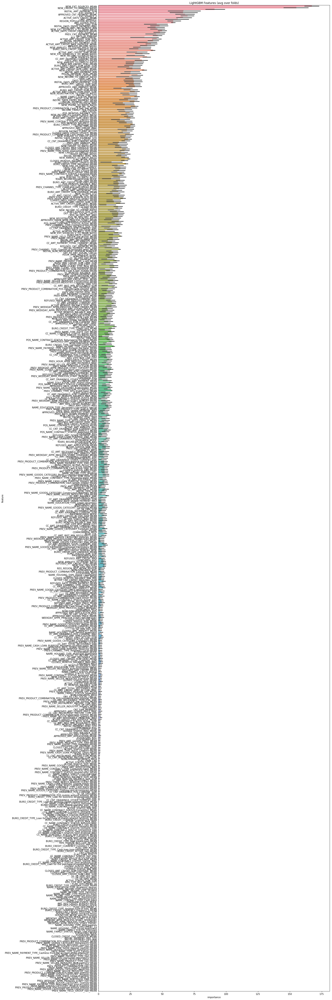

In [134]:
pd.options.display.max_rows = None
cols = display_importance(featurs100_a500)

In [8]:
#cols.reset_index(inplace = True)
cols = pd.read_csv('./Cols_values.csv')
high_val_cols = cols[cols['importance']>7].feature

In [138]:
#num of leaves = 12
feat_h, model_h = kfold_lightgbm_2(X_train[high_val_cols],y_train,alpha = 0.04, lam = 0.073, num_folds=5, stratified = False, debug= True)

Starting LightGBM. Train shape: (184504, 200) 
[1]	training's auc: 0.707278	valid_1's auc: 0.700655
Training until validation scores don't improve for 300 rounds.
[2]	training's auc: 0.708093	valid_1's auc: 0.701357
[3]	training's auc: 0.708814	valid_1's auc: 0.702289
[4]	training's auc: 0.716186	valid_1's auc: 0.709181
[5]	training's auc: 0.718746	valid_1's auc: 0.711388
[6]	training's auc: 0.724117	valid_1's auc: 0.714881
[7]	training's auc: 0.725061	valid_1's auc: 0.716159
[8]	training's auc: 0.72571	valid_1's auc: 0.717181
[9]	training's auc: 0.726271	valid_1's auc: 0.717772
[10]	training's auc: 0.726921	valid_1's auc: 0.718349
[11]	training's auc: 0.727029	valid_1's auc: 0.718392
[12]	training's auc: 0.727356	valid_1's auc: 0.718551
[13]	training's auc: 0.727464	valid_1's auc: 0.718742
[14]	training's auc: 0.72756	valid_1's auc: 0.718729
[15]	training's auc: 0.727681	valid_1's auc: 0.718861
[16]	training's auc: 0.727859	valid_1's auc: 0.719032
[17]	training's auc: 0.729519	valid_1

[152]	training's auc: 0.769404	valid_1's auc: 0.757249
[153]	training's auc: 0.769588	valid_1's auc: 0.757466
[154]	training's auc: 0.769792	valid_1's auc: 0.757663
[155]	training's auc: 0.770016	valid_1's auc: 0.757892
[156]	training's auc: 0.770177	valid_1's auc: 0.757974
[157]	training's auc: 0.770392	valid_1's auc: 0.758223
[158]	training's auc: 0.770608	valid_1's auc: 0.758436
[159]	training's auc: 0.77078	valid_1's auc: 0.758546
[160]	training's auc: 0.77094	valid_1's auc: 0.758667
[161]	training's auc: 0.77111	valid_1's auc: 0.758889
[162]	training's auc: 0.771291	valid_1's auc: 0.759008
[163]	training's auc: 0.771482	valid_1's auc: 0.759121
[164]	training's auc: 0.771644	valid_1's auc: 0.759286
[165]	training's auc: 0.771804	valid_1's auc: 0.759396
[166]	training's auc: 0.771976	valid_1's auc: 0.759554
[167]	training's auc: 0.772152	valid_1's auc: 0.759664
[168]	training's auc: 0.772261	valid_1's auc: 0.759735
[169]	training's auc: 0.772446	valid_1's auc: 0.759882
[170]	trainin

[303]	training's auc: 0.788484	valid_1's auc: 0.772769
[304]	training's auc: 0.788579	valid_1's auc: 0.772862
[305]	training's auc: 0.788683	valid_1's auc: 0.772944
[306]	training's auc: 0.788759	valid_1's auc: 0.772962
[307]	training's auc: 0.78886	valid_1's auc: 0.773009
[308]	training's auc: 0.788944	valid_1's auc: 0.773075
[309]	training's auc: 0.789034	valid_1's auc: 0.773115
[310]	training's auc: 0.789121	valid_1's auc: 0.773185
[311]	training's auc: 0.789219	valid_1's auc: 0.773259
[312]	training's auc: 0.789312	valid_1's auc: 0.773312
[313]	training's auc: 0.789394	valid_1's auc: 0.773379
[314]	training's auc: 0.789496	valid_1's auc: 0.773423
[315]	training's auc: 0.789582	valid_1's auc: 0.773463
[316]	training's auc: 0.789655	valid_1's auc: 0.7735
[317]	training's auc: 0.789754	valid_1's auc: 0.773595
[318]	training's auc: 0.789832	valid_1's auc: 0.773658
[319]	training's auc: 0.789915	valid_1's auc: 0.773696
[320]	training's auc: 0.79001	valid_1's auc: 0.773782
[321]	training

[454]	training's auc: 0.79954	valid_1's auc: 0.778999
[455]	training's auc: 0.799588	valid_1's auc: 0.779011
[456]	training's auc: 0.799666	valid_1's auc: 0.779065
[457]	training's auc: 0.799739	valid_1's auc: 0.779116
[458]	training's auc: 0.799821	valid_1's auc: 0.779137
[459]	training's auc: 0.799879	valid_1's auc: 0.779143
[460]	training's auc: 0.799938	valid_1's auc: 0.779157
[461]	training's auc: 0.799996	valid_1's auc: 0.779184
[462]	training's auc: 0.800042	valid_1's auc: 0.779209
[463]	training's auc: 0.800094	valid_1's auc: 0.779212
[464]	training's auc: 0.800162	valid_1's auc: 0.779224
[465]	training's auc: 0.800214	valid_1's auc: 0.779271
[466]	training's auc: 0.800276	valid_1's auc: 0.779299
[467]	training's auc: 0.800353	valid_1's auc: 0.779339
[468]	training's auc: 0.800406	valid_1's auc: 0.779375
[469]	training's auc: 0.800471	valid_1's auc: 0.7794
[470]	training's auc: 0.800528	valid_1's auc: 0.779432
[471]	training's auc: 0.800583	valid_1's auc: 0.779437
[472]	trainin

[605]	training's auc: 0.807628	valid_1's auc: 0.78198
[606]	training's auc: 0.807684	valid_1's auc: 0.781995
[607]	training's auc: 0.807717	valid_1's auc: 0.781991
[608]	training's auc: 0.807789	valid_1's auc: 0.78202
[609]	training's auc: 0.807828	valid_1's auc: 0.78202
[610]	training's auc: 0.807887	valid_1's auc: 0.782038
[611]	training's auc: 0.807943	valid_1's auc: 0.782044
[612]	training's auc: 0.808033	valid_1's auc: 0.782104
[613]	training's auc: 0.808079	valid_1's auc: 0.78212
[614]	training's auc: 0.808136	valid_1's auc: 0.782148
[615]	training's auc: 0.808188	valid_1's auc: 0.782172
[616]	training's auc: 0.808235	valid_1's auc: 0.782185
[617]	training's auc: 0.808276	valid_1's auc: 0.782178
[618]	training's auc: 0.808311	valid_1's auc: 0.782193
[619]	training's auc: 0.808357	valid_1's auc: 0.782205
[620]	training's auc: 0.808406	valid_1's auc: 0.782221
[621]	training's auc: 0.808458	valid_1's auc: 0.782244
[622]	training's auc: 0.808525	valid_1's auc: 0.782275
[623]	training

[756]	training's auc: 0.814748	valid_1's auc: 0.783926
[757]	training's auc: 0.814781	valid_1's auc: 0.783935
[758]	training's auc: 0.814841	valid_1's auc: 0.783954
[759]	training's auc: 0.81488	valid_1's auc: 0.783953
[760]	training's auc: 0.814915	valid_1's auc: 0.783953
[761]	training's auc: 0.814944	valid_1's auc: 0.783966
[762]	training's auc: 0.814992	valid_1's auc: 0.783978
[763]	training's auc: 0.815024	valid_1's auc: 0.783985
[764]	training's auc: 0.815064	valid_1's auc: 0.783988
[765]	training's auc: 0.815115	valid_1's auc: 0.783987
[766]	training's auc: 0.815153	valid_1's auc: 0.783994
[767]	training's auc: 0.815192	valid_1's auc: 0.784006
[768]	training's auc: 0.815235	valid_1's auc: 0.784026
[769]	training's auc: 0.815272	valid_1's auc: 0.784046
[770]	training's auc: 0.815323	valid_1's auc: 0.784069
[771]	training's auc: 0.815351	valid_1's auc: 0.784071
[772]	training's auc: 0.815405	valid_1's auc: 0.784084
[773]	training's auc: 0.815458	valid_1's auc: 0.784114
[774]	train

[907]	training's auc: 0.821053	valid_1's auc: 0.785198
[908]	training's auc: 0.821078	valid_1's auc: 0.785224
[909]	training's auc: 0.821127	valid_1's auc: 0.785235
[910]	training's auc: 0.821159	valid_1's auc: 0.785244
[911]	training's auc: 0.821197	valid_1's auc: 0.785238
[912]	training's auc: 0.821249	valid_1's auc: 0.785258
[913]	training's auc: 0.821296	valid_1's auc: 0.785298
[914]	training's auc: 0.821328	valid_1's auc: 0.785298
[915]	training's auc: 0.821365	valid_1's auc: 0.785306
[916]	training's auc: 0.821421	valid_1's auc: 0.785311
[917]	training's auc: 0.821467	valid_1's auc: 0.785323
[918]	training's auc: 0.821503	valid_1's auc: 0.785337
[919]	training's auc: 0.82155	valid_1's auc: 0.785344
[920]	training's auc: 0.821598	valid_1's auc: 0.785346
[921]	training's auc: 0.821629	valid_1's auc: 0.78536
[922]	training's auc: 0.821654	valid_1's auc: 0.785355
[923]	training's auc: 0.821693	valid_1's auc: 0.785363
[924]	training's auc: 0.821727	valid_1's auc: 0.785378
[925]	traini

[1057]	training's auc: 0.82702	valid_1's auc: 0.786172
[1058]	training's auc: 0.827049	valid_1's auc: 0.786175
[1059]	training's auc: 0.827089	valid_1's auc: 0.786176
[1060]	training's auc: 0.82714	valid_1's auc: 0.78618
[1061]	training's auc: 0.827175	valid_1's auc: 0.78618
[1062]	training's auc: 0.827231	valid_1's auc: 0.786189
[1063]	training's auc: 0.82731	valid_1's auc: 0.786213
[1064]	training's auc: 0.827341	valid_1's auc: 0.786213
[1065]	training's auc: 0.827375	valid_1's auc: 0.786205
[1066]	training's auc: 0.827422	valid_1's auc: 0.786224
[1067]	training's auc: 0.827463	valid_1's auc: 0.786222
[1068]	training's auc: 0.827517	valid_1's auc: 0.786236
[1069]	training's auc: 0.827551	valid_1's auc: 0.786243
[1070]	training's auc: 0.827601	valid_1's auc: 0.786254
[1071]	training's auc: 0.827633	valid_1's auc: 0.786249
[1072]	training's auc: 0.827674	valid_1's auc: 0.786264
[1073]	training's auc: 0.827695	valid_1's auc: 0.786268
[1074]	training's auc: 0.827728	valid_1's auc: 0.7862

[1204]	training's auc: 0.832642	valid_1's auc: 0.786936
[1205]	training's auc: 0.832681	valid_1's auc: 0.786933
[1206]	training's auc: 0.832705	valid_1's auc: 0.786928
[1207]	training's auc: 0.832744	valid_1's auc: 0.78694
[1208]	training's auc: 0.832782	valid_1's auc: 0.786956
[1209]	training's auc: 0.832823	valid_1's auc: 0.786957
[1210]	training's auc: 0.832857	valid_1's auc: 0.786949
[1211]	training's auc: 0.832908	valid_1's auc: 0.786938
[1212]	training's auc: 0.832953	valid_1's auc: 0.786962
[1213]	training's auc: 0.833023	valid_1's auc: 0.786976
[1214]	training's auc: 0.833046	valid_1's auc: 0.786971
[1215]	training's auc: 0.833087	valid_1's auc: 0.78697
[1216]	training's auc: 0.83312	valid_1's auc: 0.786994
[1217]	training's auc: 0.833155	valid_1's auc: 0.786993
[1218]	training's auc: 0.833191	valid_1's auc: 0.787025
[1219]	training's auc: 0.833233	valid_1's auc: 0.787024
[1220]	training's auc: 0.833276	valid_1's auc: 0.787035
[1221]	training's auc: 0.833308	valid_1's auc: 0.78

[1352]	training's auc: 0.838046	valid_1's auc: 0.78746
[1353]	training's auc: 0.838096	valid_1's auc: 0.787457
[1354]	training's auc: 0.838121	valid_1's auc: 0.787471
[1355]	training's auc: 0.838172	valid_1's auc: 0.787469
[1356]	training's auc: 0.838195	valid_1's auc: 0.787473
[1357]	training's auc: 0.83823	valid_1's auc: 0.787478
[1358]	training's auc: 0.83827	valid_1's auc: 0.787489
[1359]	training's auc: 0.838295	valid_1's auc: 0.787471
[1360]	training's auc: 0.838326	valid_1's auc: 0.787462
[1361]	training's auc: 0.838365	valid_1's auc: 0.78748
[1362]	training's auc: 0.838414	valid_1's auc: 0.787481
[1363]	training's auc: 0.838461	valid_1's auc: 0.787483
[1364]	training's auc: 0.838516	valid_1's auc: 0.787498
[1365]	training's auc: 0.838544	valid_1's auc: 0.787495
[1366]	training's auc: 0.838602	valid_1's auc: 0.787504
[1367]	training's auc: 0.838629	valid_1's auc: 0.787494
[1368]	training's auc: 0.838672	valid_1's auc: 0.787502
[1369]	training's auc: 0.83871	valid_1's auc: 0.7875

[1501]	training's auc: 0.843193	valid_1's auc: 0.787899
[1502]	training's auc: 0.843227	valid_1's auc: 0.787906
[1503]	training's auc: 0.843257	valid_1's auc: 0.787917
[1504]	training's auc: 0.843293	valid_1's auc: 0.78793
[1505]	training's auc: 0.843327	valid_1's auc: 0.787922
[1506]	training's auc: 0.843342	valid_1's auc: 0.787933
[1507]	training's auc: 0.843367	valid_1's auc: 0.787924
[1508]	training's auc: 0.843397	valid_1's auc: 0.787925
[1509]	training's auc: 0.843444	valid_1's auc: 0.78793
[1510]	training's auc: 0.843471	valid_1's auc: 0.787926
[1511]	training's auc: 0.8435	valid_1's auc: 0.78793
[1512]	training's auc: 0.843525	valid_1's auc: 0.787948
[1513]	training's auc: 0.843555	valid_1's auc: 0.787952
[1514]	training's auc: 0.843588	valid_1's auc: 0.78796
[1515]	training's auc: 0.843626	valid_1's auc: 0.787968
[1516]	training's auc: 0.843642	valid_1's auc: 0.78796
[1517]	training's auc: 0.843704	valid_1's auc: 0.787966
[1518]	training's auc: 0.843726	valid_1's auc: 0.787972

[1648]	training's auc: 0.848038	valid_1's auc: 0.788266
[1649]	training's auc: 0.848084	valid_1's auc: 0.78825
[1650]	training's auc: 0.848109	valid_1's auc: 0.788238
[1651]	training's auc: 0.848135	valid_1's auc: 0.788246
[1652]	training's auc: 0.848172	valid_1's auc: 0.788241
[1653]	training's auc: 0.848213	valid_1's auc: 0.788253
[1654]	training's auc: 0.84825	valid_1's auc: 0.788255
[1655]	training's auc: 0.848282	valid_1's auc: 0.788254
[1656]	training's auc: 0.848312	valid_1's auc: 0.788256
[1657]	training's auc: 0.848338	valid_1's auc: 0.788254
[1658]	training's auc: 0.848359	valid_1's auc: 0.788264
[1659]	training's auc: 0.848389	valid_1's auc: 0.788256
[1660]	training's auc: 0.848421	valid_1's auc: 0.788273
[1661]	training's auc: 0.84846	valid_1's auc: 0.788283
[1662]	training's auc: 0.848475	valid_1's auc: 0.788273
[1663]	training's auc: 0.848524	valid_1's auc: 0.788289
[1664]	training's auc: 0.848555	valid_1's auc: 0.78829
[1665]	training's auc: 0.848578	valid_1's auc: 0.788

[1795]	training's auc: 0.852629	valid_1's auc: 0.788746
[1796]	training's auc: 0.852657	valid_1's auc: 0.78875
[1797]	training's auc: 0.852687	valid_1's auc: 0.788754
[1798]	training's auc: 0.852725	valid_1's auc: 0.788762
[1799]	training's auc: 0.852751	valid_1's auc: 0.788753
[1800]	training's auc: 0.85277	valid_1's auc: 0.788761
[1801]	training's auc: 0.852807	valid_1's auc: 0.788801
[1802]	training's auc: 0.852848	valid_1's auc: 0.788807
[1803]	training's auc: 0.852879	valid_1's auc: 0.788809
[1804]	training's auc: 0.852903	valid_1's auc: 0.788802
[1805]	training's auc: 0.852934	valid_1's auc: 0.788789
[1806]	training's auc: 0.852965	valid_1's auc: 0.78878
[1807]	training's auc: 0.853021	valid_1's auc: 0.788792
[1808]	training's auc: 0.853056	valid_1's auc: 0.78881
[1809]	training's auc: 0.853081	valid_1's auc: 0.788799
[1810]	training's auc: 0.853129	valid_1's auc: 0.788804
[1811]	training's auc: 0.853156	valid_1's auc: 0.788813
[1812]	training's auc: 0.853181	valid_1's auc: 0.788

[1943]	training's auc: 0.85715	valid_1's auc: 0.789085
[1944]	training's auc: 0.857194	valid_1's auc: 0.789099
[1945]	training's auc: 0.857226	valid_1's auc: 0.789114
[1946]	training's auc: 0.857253	valid_1's auc: 0.789115
[1947]	training's auc: 0.857282	valid_1's auc: 0.789117
[1948]	training's auc: 0.857319	valid_1's auc: 0.789124
[1949]	training's auc: 0.857339	valid_1's auc: 0.789108
[1950]	training's auc: 0.85737	valid_1's auc: 0.789105
[1951]	training's auc: 0.857392	valid_1's auc: 0.789095
[1952]	training's auc: 0.857421	valid_1's auc: 0.789088
[1953]	training's auc: 0.857458	valid_1's auc: 0.789085
[1954]	training's auc: 0.857499	valid_1's auc: 0.789092
[1955]	training's auc: 0.857523	valid_1's auc: 0.789085
[1956]	training's auc: 0.857558	valid_1's auc: 0.789082
[1957]	training's auc: 0.857601	valid_1's auc: 0.789095
[1958]	training's auc: 0.857629	valid_1's auc: 0.789093
[1959]	training's auc: 0.857645	valid_1's auc: 0.789088
[1960]	training's auc: 0.857678	valid_1's auc: 0.7

[2091]	training's auc: 0.861283	valid_1's auc: 0.789265
[2092]	training's auc: 0.861309	valid_1's auc: 0.789264
[2093]	training's auc: 0.861368	valid_1's auc: 0.789258
[2094]	training's auc: 0.861394	valid_1's auc: 0.78927
[2095]	training's auc: 0.861415	valid_1's auc: 0.789276
[2096]	training's auc: 0.86145	valid_1's auc: 0.78928
[2097]	training's auc: 0.861477	valid_1's auc: 0.789289
[2098]	training's auc: 0.861496	valid_1's auc: 0.789283
[2099]	training's auc: 0.861523	valid_1's auc: 0.789285
[2100]	training's auc: 0.861548	valid_1's auc: 0.789294
[2101]	training's auc: 0.861567	valid_1's auc: 0.789295
[2102]	training's auc: 0.861609	valid_1's auc: 0.789307
[2103]	training's auc: 0.861653	valid_1's auc: 0.789327
[2104]	training's auc: 0.861674	valid_1's auc: 0.789314
[2105]	training's auc: 0.861699	valid_1's auc: 0.789324
[2106]	training's auc: 0.861728	valid_1's auc: 0.789329
[2107]	training's auc: 0.861749	valid_1's auc: 0.789322
[2108]	training's auc: 0.861797	valid_1's auc: 0.78

[2239]	training's auc: 0.865447	valid_1's auc: 0.78968
[2240]	training's auc: 0.865467	valid_1's auc: 0.789675
[2241]	training's auc: 0.86549	valid_1's auc: 0.78969
[2242]	training's auc: 0.865507	valid_1's auc: 0.789704
[2243]	training's auc: 0.865525	valid_1's auc: 0.789712
[2244]	training's auc: 0.865549	valid_1's auc: 0.789713
[2245]	training's auc: 0.865566	valid_1's auc: 0.789705
[2246]	training's auc: 0.86558	valid_1's auc: 0.78972
[2247]	training's auc: 0.865602	valid_1's auc: 0.789714
[2248]	training's auc: 0.86563	valid_1's auc: 0.789702
[2249]	training's auc: 0.865644	valid_1's auc: 0.789691
[2250]	training's auc: 0.865662	valid_1's auc: 0.789698
[2251]	training's auc: 0.865679	valid_1's auc: 0.789685
[2252]	training's auc: 0.865697	valid_1's auc: 0.789695
[2253]	training's auc: 0.865722	valid_1's auc: 0.789694
[2254]	training's auc: 0.865746	valid_1's auc: 0.7897
[2255]	training's auc: 0.865763	valid_1's auc: 0.789705
[2256]	training's auc: 0.86579	valid_1's auc: 0.789695
[

[2386]	training's auc: 0.869294	valid_1's auc: 0.789677
[2387]	training's auc: 0.869328	valid_1's auc: 0.789675
[2388]	training's auc: 0.86934	valid_1's auc: 0.789675
[2389]	training's auc: 0.869361	valid_1's auc: 0.78966
[2390]	training's auc: 0.869394	valid_1's auc: 0.789666
[2391]	training's auc: 0.869421	valid_1's auc: 0.78967
[2392]	training's auc: 0.869445	valid_1's auc: 0.789672
[2393]	training's auc: 0.869462	valid_1's auc: 0.789683
[2394]	training's auc: 0.869479	valid_1's auc: 0.789685
[2395]	training's auc: 0.869505	valid_1's auc: 0.789665
[2396]	training's auc: 0.869535	valid_1's auc: 0.78966
[2397]	training's auc: 0.869563	valid_1's auc: 0.789645
[2398]	training's auc: 0.869587	valid_1's auc: 0.789644
[2399]	training's auc: 0.869618	valid_1's auc: 0.789642
[2400]	training's auc: 0.869639	valid_1's auc: 0.789649
[2401]	training's auc: 0.869659	valid_1's auc: 0.789648
[2402]	training's auc: 0.869693	valid_1's auc: 0.789644
[2403]	training's auc: 0.869725	valid_1's auc: 0.789

[2534]	training's auc: 0.873205	valid_1's auc: 0.789854
[2535]	training's auc: 0.873236	valid_1's auc: 0.78986
[2536]	training's auc: 0.873267	valid_1's auc: 0.789878
[2537]	training's auc: 0.873292	valid_1's auc: 0.789875
[2538]	training's auc: 0.873325	valid_1's auc: 0.789864
[2539]	training's auc: 0.873347	valid_1's auc: 0.789866
[2540]	training's auc: 0.873374	valid_1's auc: 0.789866
[2541]	training's auc: 0.873396	valid_1's auc: 0.789873
[2542]	training's auc: 0.873417	valid_1's auc: 0.789884
[2543]	training's auc: 0.873447	valid_1's auc: 0.789904
[2544]	training's auc: 0.873454	valid_1's auc: 0.789909
[2545]	training's auc: 0.873486	valid_1's auc: 0.789909
[2546]	training's auc: 0.873509	valid_1's auc: 0.789904
[2547]	training's auc: 0.873534	valid_1's auc: 0.789909
[2548]	training's auc: 0.873561	valid_1's auc: 0.789916
[2549]	training's auc: 0.873584	valid_1's auc: 0.789901
[2550]	training's auc: 0.873601	valid_1's auc: 0.7899
[2551]	training's auc: 0.873621	valid_1's auc: 0.78

[2681]	training's auc: 0.876713	valid_1's auc: 0.789938
[2682]	training's auc: 0.876738	valid_1's auc: 0.789953
[2683]	training's auc: 0.876761	valid_1's auc: 0.789967
[2684]	training's auc: 0.876784	valid_1's auc: 0.789969
[2685]	training's auc: 0.876809	valid_1's auc: 0.789983
[2686]	training's auc: 0.876848	valid_1's auc: 0.789984
[2687]	training's auc: 0.876863	valid_1's auc: 0.789991
[2688]	training's auc: 0.876888	valid_1's auc: 0.789988
[2689]	training's auc: 0.876914	valid_1's auc: 0.789985
[2690]	training's auc: 0.876949	valid_1's auc: 0.789977
[2691]	training's auc: 0.876969	valid_1's auc: 0.789984
[2692]	training's auc: 0.877001	valid_1's auc: 0.789984
[2693]	training's auc: 0.877024	valid_1's auc: 0.789989
[2694]	training's auc: 0.877048	valid_1's auc: 0.789986
[2695]	training's auc: 0.877061	valid_1's auc: 0.789981
[2696]	training's auc: 0.877082	valid_1's auc: 0.789963
[2697]	training's auc: 0.877108	valid_1's auc: 0.789965
[2698]	training's auc: 0.877139	valid_1's auc: 0

[2829]	training's auc: 0.880495	valid_1's auc: 0.790104
[2830]	training's auc: 0.88052	valid_1's auc: 0.790104
[2831]	training's auc: 0.880549	valid_1's auc: 0.790101
[2832]	training's auc: 0.880574	valid_1's auc: 0.790101
[2833]	training's auc: 0.880588	valid_1's auc: 0.790116
[2834]	training's auc: 0.880625	valid_1's auc: 0.790108
[2835]	training's auc: 0.880657	valid_1's auc: 0.790117
[2836]	training's auc: 0.880672	valid_1's auc: 0.790114
[2837]	training's auc: 0.88069	valid_1's auc: 0.790107
[2838]	training's auc: 0.880714	valid_1's auc: 0.79011
[2839]	training's auc: 0.880725	valid_1's auc: 0.79011
[2840]	training's auc: 0.880744	valid_1's auc: 0.790109
[2841]	training's auc: 0.880769	valid_1's auc: 0.790114
[2842]	training's auc: 0.880799	valid_1's auc: 0.790107
[2843]	training's auc: 0.880816	valid_1's auc: 0.790103
[2844]	training's auc: 0.880838	valid_1's auc: 0.790113
[2845]	training's auc: 0.880873	valid_1's auc: 0.79012
[2846]	training's auc: 0.880899	valid_1's auc: 0.7901

[2976]	training's auc: 0.883935	valid_1's auc: 0.790311
[2977]	training's auc: 0.883962	valid_1's auc: 0.790304
[2978]	training's auc: 0.883979	valid_1's auc: 0.790311
[2979]	training's auc: 0.883999	valid_1's auc: 0.790311
[2980]	training's auc: 0.884023	valid_1's auc: 0.790315
[2981]	training's auc: 0.884041	valid_1's auc: 0.790312
[2982]	training's auc: 0.884073	valid_1's auc: 0.790309
[2983]	training's auc: 0.88409	valid_1's auc: 0.79031
[2984]	training's auc: 0.884109	valid_1's auc: 0.790301
[2985]	training's auc: 0.884127	valid_1's auc: 0.790301
[2986]	training's auc: 0.884148	valid_1's auc: 0.790283
[2987]	training's auc: 0.884171	valid_1's auc: 0.790299
[2988]	training's auc: 0.884186	valid_1's auc: 0.790293
[2989]	training's auc: 0.884214	valid_1's auc: 0.790284
[2990]	training's auc: 0.884231	valid_1's auc: 0.790293
[2991]	training's auc: 0.884248	valid_1's auc: 0.790284
[2992]	training's auc: 0.884269	valid_1's auc: 0.790279
[2993]	training's auc: 0.884298	valid_1's auc: 0.7

[3123]	training's auc: 0.887313	valid_1's auc: 0.790392
[3124]	training's auc: 0.887332	valid_1's auc: 0.790381
[3125]	training's auc: 0.887345	valid_1's auc: 0.790377
[3126]	training's auc: 0.88736	valid_1's auc: 0.790373
[3127]	training's auc: 0.887376	valid_1's auc: 0.790379
[3128]	training's auc: 0.887408	valid_1's auc: 0.7904
[3129]	training's auc: 0.887431	valid_1's auc: 0.790382
[3130]	training's auc: 0.88745	valid_1's auc: 0.790382
[3131]	training's auc: 0.887469	valid_1's auc: 0.79038
[3132]	training's auc: 0.887488	valid_1's auc: 0.790385
[3133]	training's auc: 0.887509	valid_1's auc: 0.790379
[3134]	training's auc: 0.887527	valid_1's auc: 0.790377
[3135]	training's auc: 0.887558	valid_1's auc: 0.79037
[3136]	training's auc: 0.887584	valid_1's auc: 0.790381
[3137]	training's auc: 0.887603	valid_1's auc: 0.790385
[3138]	training's auc: 0.887621	valid_1's auc: 0.790383
[3139]	training's auc: 0.887655	valid_1's auc: 0.790381
[3140]	training's auc: 0.88767	valid_1's auc: 0.790385

[3271]	training's auc: 0.890562	valid_1's auc: 0.790508
[3272]	training's auc: 0.890586	valid_1's auc: 0.79051
[3273]	training's auc: 0.890615	valid_1's auc: 0.790497
[3274]	training's auc: 0.890633	valid_1's auc: 0.790485
[3275]	training's auc: 0.890658	valid_1's auc: 0.790491
[3276]	training's auc: 0.890679	valid_1's auc: 0.790486
[3277]	training's auc: 0.890691	valid_1's auc: 0.790476
[3278]	training's auc: 0.890715	valid_1's auc: 0.790475
[3279]	training's auc: 0.890746	valid_1's auc: 0.790471
[3280]	training's auc: 0.890757	valid_1's auc: 0.790473
[3281]	training's auc: 0.890779	valid_1's auc: 0.790474
[3282]	training's auc: 0.890792	valid_1's auc: 0.79047
[3283]	training's auc: 0.890818	valid_1's auc: 0.79047
[3284]	training's auc: 0.890846	valid_1's auc: 0.790475
[3285]	training's auc: 0.89087	valid_1's auc: 0.790466
[3286]	training's auc: 0.890892	valid_1's auc: 0.790465
[3287]	training's auc: 0.890917	valid_1's auc: 0.790468
[3288]	training's auc: 0.890941	valid_1's auc: 0.790

[3419]	training's auc: 0.893781	valid_1's auc: 0.790425
[3420]	training's auc: 0.893802	valid_1's auc: 0.790436
[3421]	training's auc: 0.893824	valid_1's auc: 0.790429
[3422]	training's auc: 0.893845	valid_1's auc: 0.790449
[3423]	training's auc: 0.893864	valid_1's auc: 0.790442
[3424]	training's auc: 0.893892	valid_1's auc: 0.790448
[3425]	training's auc: 0.89391	valid_1's auc: 0.790454
[3426]	training's auc: 0.893929	valid_1's auc: 0.790452
[3427]	training's auc: 0.893946	valid_1's auc: 0.790469
[3428]	training's auc: 0.893966	valid_1's auc: 0.790457
[3429]	training's auc: 0.893989	valid_1's auc: 0.790449
[3430]	training's auc: 0.894005	valid_1's auc: 0.790452
[3431]	training's auc: 0.894037	valid_1's auc: 0.790464
[3432]	training's auc: 0.894058	valid_1's auc: 0.790466
[3433]	training's auc: 0.894074	valid_1's auc: 0.79046
[3434]	training's auc: 0.894094	valid_1's auc: 0.790456
[3435]	training's auc: 0.894109	valid_1's auc: 0.790457
[3436]	training's auc: 0.894125	valid_1's auc: 0.7

[3566]	training's auc: 0.896936	valid_1's auc: 0.790341
Early stopping, best iteration is:
[3266]	training's auc: 0.890464	valid_1's auc: 0.790523
Fold  1 AUC : 0.790523
[1]	training's auc: 0.70646	valid_1's auc: 0.708577
Training until validation scores don't improve for 300 rounds.
[2]	training's auc: 0.707942	valid_1's auc: 0.709487
[3]	training's auc: 0.709008	valid_1's auc: 0.709774
[4]	training's auc: 0.711525	valid_1's auc: 0.712691
[5]	training's auc: 0.715033	valid_1's auc: 0.716782
[6]	training's auc: 0.722833	valid_1's auc: 0.722974
[7]	training's auc: 0.723408	valid_1's auc: 0.723637
[8]	training's auc: 0.72459	valid_1's auc: 0.724813
[9]	training's auc: 0.724966	valid_1's auc: 0.725246
[10]	training's auc: 0.72514	valid_1's auc: 0.725515
[11]	training's auc: 0.72536	valid_1's auc: 0.725884
[12]	training's auc: 0.725582	valid_1's auc: 0.725992
[13]	training's auc: 0.725765	valid_1's auc: 0.726172
[14]	training's auc: 0.726074	valid_1's auc: 0.726411
[15]	training's auc: 0.7

[150]	training's auc: 0.769783	valid_1's auc: 0.759574
[151]	training's auc: 0.770005	valid_1's auc: 0.759702
[152]	training's auc: 0.770259	valid_1's auc: 0.759869
[153]	training's auc: 0.77046	valid_1's auc: 0.76001
[154]	training's auc: 0.770636	valid_1's auc: 0.760159
[155]	training's auc: 0.770807	valid_1's auc: 0.76033
[156]	training's auc: 0.770973	valid_1's auc: 0.760417
[157]	training's auc: 0.771183	valid_1's auc: 0.760572
[158]	training's auc: 0.771398	valid_1's auc: 0.76072
[159]	training's auc: 0.771594	valid_1's auc: 0.760851
[160]	training's auc: 0.77177	valid_1's auc: 0.760911
[161]	training's auc: 0.771933	valid_1's auc: 0.760989
[162]	training's auc: 0.772109	valid_1's auc: 0.761069
[163]	training's auc: 0.772278	valid_1's auc: 0.761226
[164]	training's auc: 0.772461	valid_1's auc: 0.761341
[165]	training's auc: 0.772653	valid_1's auc: 0.761469
[166]	training's auc: 0.772854	valid_1's auc: 0.761583
[167]	training's auc: 0.773007	valid_1's auc: 0.761671
[168]	training'

[300]	training's auc: 0.789463	valid_1's auc: 0.77075
[301]	training's auc: 0.789577	valid_1's auc: 0.7708
[302]	training's auc: 0.789666	valid_1's auc: 0.770847
[303]	training's auc: 0.789762	valid_1's auc: 0.770878
[304]	training's auc: 0.789854	valid_1's auc: 0.77095
[305]	training's auc: 0.789953	valid_1's auc: 0.77097
[306]	training's auc: 0.790049	valid_1's auc: 0.771048
[307]	training's auc: 0.790164	valid_1's auc: 0.771095
[308]	training's auc: 0.790261	valid_1's auc: 0.771111
[309]	training's auc: 0.790352	valid_1's auc: 0.771186
[310]	training's auc: 0.790462	valid_1's auc: 0.771269
[311]	training's auc: 0.790556	valid_1's auc: 0.771317
[312]	training's auc: 0.790655	valid_1's auc: 0.771368
[313]	training's auc: 0.790741	valid_1's auc: 0.771406
[314]	training's auc: 0.790832	valid_1's auc: 0.771469
[315]	training's auc: 0.790902	valid_1's auc: 0.771499
[316]	training's auc: 0.790992	valid_1's auc: 0.771528
[317]	training's auc: 0.791076	valid_1's auc: 0.771602
[318]	training'

[450]	training's auc: 0.800858	valid_1's auc: 0.775721
[451]	training's auc: 0.800921	valid_1's auc: 0.775731
[452]	training's auc: 0.800979	valid_1's auc: 0.775737
[453]	training's auc: 0.801042	valid_1's auc: 0.775746
[454]	training's auc: 0.801104	valid_1's auc: 0.775788
[455]	training's auc: 0.801174	valid_1's auc: 0.775815
[456]	training's auc: 0.801233	valid_1's auc: 0.775852
[457]	training's auc: 0.801284	valid_1's auc: 0.775859
[458]	training's auc: 0.801376	valid_1's auc: 0.775908
[459]	training's auc: 0.801467	valid_1's auc: 0.775987
[460]	training's auc: 0.801533	valid_1's auc: 0.77603
[461]	training's auc: 0.801585	valid_1's auc: 0.776029
[462]	training's auc: 0.801661	valid_1's auc: 0.77603
[463]	training's auc: 0.801725	valid_1's auc: 0.776053
[464]	training's auc: 0.801778	valid_1's auc: 0.776059
[465]	training's auc: 0.801834	valid_1's auc: 0.776079
[466]	training's auc: 0.801907	valid_1's auc: 0.776088
[467]	training's auc: 0.801969	valid_1's auc: 0.776098
[468]	traini

[600]	training's auc: 0.809463	valid_1's auc: 0.778059
[601]	training's auc: 0.809509	valid_1's auc: 0.778075
[602]	training's auc: 0.809556	valid_1's auc: 0.778103
[603]	training's auc: 0.809603	valid_1's auc: 0.778112
[604]	training's auc: 0.809649	valid_1's auc: 0.77811
[605]	training's auc: 0.809711	valid_1's auc: 0.778126
[606]	training's auc: 0.809747	valid_1's auc: 0.778136
[607]	training's auc: 0.809812	valid_1's auc: 0.778144
[608]	training's auc: 0.809874	valid_1's auc: 0.778163
[609]	training's auc: 0.809932	valid_1's auc: 0.778194
[610]	training's auc: 0.809985	valid_1's auc: 0.778204
[611]	training's auc: 0.810051	valid_1's auc: 0.778238
[612]	training's auc: 0.81009	valid_1's auc: 0.778235
[613]	training's auc: 0.810141	valid_1's auc: 0.778236
[614]	training's auc: 0.810185	valid_1's auc: 0.778252
[615]	training's auc: 0.810234	valid_1's auc: 0.778261
[616]	training's auc: 0.810273	valid_1's auc: 0.778261
[617]	training's auc: 0.810338	valid_1's auc: 0.77826
[618]	trainin

[751]	training's auc: 0.816625	valid_1's auc: 0.779176
[752]	training's auc: 0.816667	valid_1's auc: 0.77918
[753]	training's auc: 0.816708	valid_1's auc: 0.779178
[754]	training's auc: 0.816756	valid_1's auc: 0.779162
[755]	training's auc: 0.816786	valid_1's auc: 0.779177
[756]	training's auc: 0.816819	valid_1's auc: 0.779163
[757]	training's auc: 0.816863	valid_1's auc: 0.779171
[758]	training's auc: 0.816908	valid_1's auc: 0.779188
[759]	training's auc: 0.816941	valid_1's auc: 0.779198
[760]	training's auc: 0.816979	valid_1's auc: 0.779198
[761]	training's auc: 0.817018	valid_1's auc: 0.779222
[762]	training's auc: 0.817059	valid_1's auc: 0.77923
[763]	training's auc: 0.817088	valid_1's auc: 0.779234
[764]	training's auc: 0.817138	valid_1's auc: 0.779249
[765]	training's auc: 0.817188	valid_1's auc: 0.779255
[766]	training's auc: 0.817226	valid_1's auc: 0.779256
[767]	training's auc: 0.817262	valid_1's auc: 0.779265
[768]	training's auc: 0.817304	valid_1's auc: 0.779258
[769]	traini

[901]	training's auc: 0.822942	valid_1's auc: 0.780131
[902]	training's auc: 0.822977	valid_1's auc: 0.780146
[903]	training's auc: 0.823032	valid_1's auc: 0.780135
[904]	training's auc: 0.823071	valid_1's auc: 0.780136
[905]	training's auc: 0.823109	valid_1's auc: 0.78014
[906]	training's auc: 0.823175	valid_1's auc: 0.780178
[907]	training's auc: 0.823209	valid_1's auc: 0.780185
[908]	training's auc: 0.823247	valid_1's auc: 0.780193
[909]	training's auc: 0.823272	valid_1's auc: 0.780194
[910]	training's auc: 0.823309	valid_1's auc: 0.780207
[911]	training's auc: 0.823363	valid_1's auc: 0.78022
[912]	training's auc: 0.823409	valid_1's auc: 0.780212
[913]	training's auc: 0.823442	valid_1's auc: 0.780213
[914]	training's auc: 0.823472	valid_1's auc: 0.780234
[915]	training's auc: 0.823506	valid_1's auc: 0.780234
[916]	training's auc: 0.823539	valid_1's auc: 0.780243
[917]	training's auc: 0.823587	valid_1's auc: 0.780241
[918]	training's auc: 0.823636	valid_1's auc: 0.780253
[919]	traini

[1051]	training's auc: 0.828773	valid_1's auc: 0.780515
[1052]	training's auc: 0.828808	valid_1's auc: 0.780508
[1053]	training's auc: 0.828881	valid_1's auc: 0.780499
[1054]	training's auc: 0.828917	valid_1's auc: 0.78048
[1055]	training's auc: 0.828945	valid_1's auc: 0.780484
[1056]	training's auc: 0.828987	valid_1's auc: 0.780495
[1057]	training's auc: 0.829013	valid_1's auc: 0.780507
[1058]	training's auc: 0.829047	valid_1's auc: 0.780509
[1059]	training's auc: 0.829083	valid_1's auc: 0.780511
[1060]	training's auc: 0.829116	valid_1's auc: 0.780521
[1061]	training's auc: 0.829157	valid_1's auc: 0.780517
[1062]	training's auc: 0.829197	valid_1's auc: 0.780526
[1063]	training's auc: 0.829258	valid_1's auc: 0.780542
[1064]	training's auc: 0.829308	valid_1's auc: 0.780539
[1065]	training's auc: 0.829343	valid_1's auc: 0.780533
[1066]	training's auc: 0.829378	valid_1's auc: 0.78054
[1067]	training's auc: 0.82941	valid_1's auc: 0.78056
[1068]	training's auc: 0.82945	valid_1's auc: 0.7805

[1199]	training's auc: 0.834238	valid_1's auc: 0.780891
[1200]	training's auc: 0.834279	valid_1's auc: 0.780896
[1201]	training's auc: 0.83431	valid_1's auc: 0.780905
[1202]	training's auc: 0.834351	valid_1's auc: 0.780898
[1203]	training's auc: 0.834387	valid_1's auc: 0.780893
[1204]	training's auc: 0.834418	valid_1's auc: 0.780894
[1205]	training's auc: 0.834446	valid_1's auc: 0.780898
[1206]	training's auc: 0.834497	valid_1's auc: 0.780914
[1207]	training's auc: 0.834544	valid_1's auc: 0.780907
[1208]	training's auc: 0.834565	valid_1's auc: 0.780907
[1209]	training's auc: 0.834591	valid_1's auc: 0.780909
[1210]	training's auc: 0.834632	valid_1's auc: 0.780894
[1211]	training's auc: 0.834663	valid_1's auc: 0.780907
[1212]	training's auc: 0.834689	valid_1's auc: 0.780901
[1213]	training's auc: 0.83472	valid_1's auc: 0.780906
[1214]	training's auc: 0.834777	valid_1's auc: 0.780912
[1215]	training's auc: 0.834809	valid_1's auc: 0.780907
[1216]	training's auc: 0.83484	valid_1's auc: 0.78

[1347]	training's auc: 0.839321	valid_1's auc: 0.781209
[1348]	training's auc: 0.839345	valid_1's auc: 0.781223
[1349]	training's auc: 0.839377	valid_1's auc: 0.781234
[1350]	training's auc: 0.839408	valid_1's auc: 0.781243
[1351]	training's auc: 0.83946	valid_1's auc: 0.781255
[1352]	training's auc: 0.839496	valid_1's auc: 0.781244
[1353]	training's auc: 0.839529	valid_1's auc: 0.781254
[1354]	training's auc: 0.839559	valid_1's auc: 0.781255
[1355]	training's auc: 0.839588	valid_1's auc: 0.781272
[1356]	training's auc: 0.839651	valid_1's auc: 0.781295
[1357]	training's auc: 0.839669	valid_1's auc: 0.78131
[1358]	training's auc: 0.839688	valid_1's auc: 0.781313
[1359]	training's auc: 0.839717	valid_1's auc: 0.781302
[1360]	training's auc: 0.839747	valid_1's auc: 0.781299
[1361]	training's auc: 0.8398	valid_1's auc: 0.781302
[1362]	training's auc: 0.839844	valid_1's auc: 0.781316
[1363]	training's auc: 0.839881	valid_1's auc: 0.781321
[1364]	training's auc: 0.839913	valid_1's auc: 0.781

[1494]	training's auc: 0.844232	valid_1's auc: 0.781432
[1495]	training's auc: 0.844269	valid_1's auc: 0.781443
[1496]	training's auc: 0.844299	valid_1's auc: 0.781432
[1497]	training's auc: 0.844345	valid_1's auc: 0.78144
[1498]	training's auc: 0.844372	valid_1's auc: 0.781423
[1499]	training's auc: 0.844402	valid_1's auc: 0.781418
[1500]	training's auc: 0.844438	valid_1's auc: 0.781407
[1501]	training's auc: 0.844467	valid_1's auc: 0.781405
[1502]	training's auc: 0.844491	valid_1's auc: 0.781399
[1503]	training's auc: 0.844515	valid_1's auc: 0.781396
[1504]	training's auc: 0.844542	valid_1's auc: 0.781385
[1505]	training's auc: 0.844563	valid_1's auc: 0.781403
[1506]	training's auc: 0.844583	valid_1's auc: 0.78142
[1507]	training's auc: 0.844622	valid_1's auc: 0.781417
[1508]	training's auc: 0.844657	valid_1's auc: 0.781416
[1509]	training's auc: 0.844685	valid_1's auc: 0.78142
[1510]	training's auc: 0.844711	valid_1's auc: 0.78142
[1511]	training's auc: 0.84474	valid_1's auc: 0.7814

[1642]	training's auc: 0.848869	valid_1's auc: 0.781665
[1643]	training's auc: 0.848898	valid_1's auc: 0.781666
[1644]	training's auc: 0.848917	valid_1's auc: 0.781661
[1645]	training's auc: 0.848948	valid_1's auc: 0.781659
[1646]	training's auc: 0.848976	valid_1's auc: 0.781662
[1647]	training's auc: 0.849005	valid_1's auc: 0.781657
[1648]	training's auc: 0.849044	valid_1's auc: 0.781658
[1649]	training's auc: 0.849068	valid_1's auc: 0.781654
[1650]	training's auc: 0.849095	valid_1's auc: 0.781656
[1651]	training's auc: 0.849123	valid_1's auc: 0.781662
[1652]	training's auc: 0.849162	valid_1's auc: 0.781654
[1653]	training's auc: 0.849181	valid_1's auc: 0.781646
[1654]	training's auc: 0.849211	valid_1's auc: 0.781658
[1655]	training's auc: 0.849239	valid_1's auc: 0.781673
[1656]	training's auc: 0.849292	valid_1's auc: 0.781671
[1657]	training's auc: 0.849322	valid_1's auc: 0.781674
[1658]	training's auc: 0.84935	valid_1's auc: 0.781662
[1659]	training's auc: 0.849372	valid_1's auc: 0.

[1790]	training's auc: 0.853425	valid_1's auc: 0.781849
[1791]	training's auc: 0.85347	valid_1's auc: 0.781849
[1792]	training's auc: 0.853502	valid_1's auc: 0.781849
[1793]	training's auc: 0.853523	valid_1's auc: 0.781859
[1794]	training's auc: 0.853548	valid_1's auc: 0.781873
[1795]	training's auc: 0.853585	valid_1's auc: 0.781868
[1796]	training's auc: 0.853616	valid_1's auc: 0.781861
[1797]	training's auc: 0.853637	valid_1's auc: 0.781854
[1798]	training's auc: 0.853677	valid_1's auc: 0.781846
[1799]	training's auc: 0.853697	valid_1's auc: 0.781854
[1800]	training's auc: 0.853721	valid_1's auc: 0.781841
[1801]	training's auc: 0.853753	valid_1's auc: 0.781831
[1802]	training's auc: 0.853793	valid_1's auc: 0.781824
[1803]	training's auc: 0.853816	valid_1's auc: 0.78182
[1804]	training's auc: 0.853835	valid_1's auc: 0.781813
[1805]	training's auc: 0.853876	valid_1's auc: 0.781811
[1806]	training's auc: 0.853904	valid_1's auc: 0.781816
[1807]	training's auc: 0.85394	valid_1's auc: 0.78

[1938]	training's auc: 0.857692	valid_1's auc: 0.781798
[1939]	training's auc: 0.857721	valid_1's auc: 0.781804
[1940]	training's auc: 0.857748	valid_1's auc: 0.781804
[1941]	training's auc: 0.857775	valid_1's auc: 0.781807
[1942]	training's auc: 0.857808	valid_1's auc: 0.781815
[1943]	training's auc: 0.857843	valid_1's auc: 0.781822
[1944]	training's auc: 0.85789	valid_1's auc: 0.781819
[1945]	training's auc: 0.857913	valid_1's auc: 0.781818
[1946]	training's auc: 0.857949	valid_1's auc: 0.781842
[1947]	training's auc: 0.857981	valid_1's auc: 0.781839
[1948]	training's auc: 0.858005	valid_1's auc: 0.781854
[1949]	training's auc: 0.858035	valid_1's auc: 0.78187
[1950]	training's auc: 0.858078	valid_1's auc: 0.781873
[1951]	training's auc: 0.858093	valid_1's auc: 0.781871
[1952]	training's auc: 0.858121	valid_1's auc: 0.781878
[1953]	training's auc: 0.858138	valid_1's auc: 0.781886
[1954]	training's auc: 0.858164	valid_1's auc: 0.781865
[1955]	training's auc: 0.858191	valid_1's auc: 0.7

[2086]	training's auc: 0.861914	valid_1's auc: 0.782125
[2087]	training's auc: 0.861938	valid_1's auc: 0.782121
[2088]	training's auc: 0.861973	valid_1's auc: 0.782123
[2089]	training's auc: 0.861992	valid_1's auc: 0.782103
[2090]	training's auc: 0.862039	valid_1's auc: 0.782106
[2091]	training's auc: 0.86207	valid_1's auc: 0.782094
[2092]	training's auc: 0.862108	valid_1's auc: 0.782086
[2093]	training's auc: 0.862129	valid_1's auc: 0.782101
[2094]	training's auc: 0.862156	valid_1's auc: 0.782105
[2095]	training's auc: 0.862181	valid_1's auc: 0.782097
[2096]	training's auc: 0.862202	valid_1's auc: 0.782103
[2097]	training's auc: 0.862225	valid_1's auc: 0.782101
[2098]	training's auc: 0.862265	valid_1's auc: 0.782102
[2099]	training's auc: 0.862295	valid_1's auc: 0.782105
[2100]	training's auc: 0.862319	valid_1's auc: 0.782106
[2101]	training's auc: 0.86236	valid_1's auc: 0.782103
[2102]	training's auc: 0.8624	valid_1's auc: 0.782122
[2103]	training's auc: 0.862436	valid_1's auc: 0.782

[2234]	training's auc: 0.866037	valid_1's auc: 0.782168
[2235]	training's auc: 0.866079	valid_1's auc: 0.782167
[2236]	training's auc: 0.866108	valid_1's auc: 0.782148
[2237]	training's auc: 0.866153	valid_1's auc: 0.782148
[2238]	training's auc: 0.866193	valid_1's auc: 0.78214
[2239]	training's auc: 0.866225	valid_1's auc: 0.782128
[2240]	training's auc: 0.866259	valid_1's auc: 0.782128
[2241]	training's auc: 0.8663	valid_1's auc: 0.782143
[2242]	training's auc: 0.866342	valid_1's auc: 0.782144
[2243]	training's auc: 0.866383	valid_1's auc: 0.782141
[2244]	training's auc: 0.866417	valid_1's auc: 0.782161
[2245]	training's auc: 0.866443	valid_1's auc: 0.782173
[2246]	training's auc: 0.866472	valid_1's auc: 0.78217
[2247]	training's auc: 0.866494	valid_1's auc: 0.78217
[2248]	training's auc: 0.866509	valid_1's auc: 0.782165
[2249]	training's auc: 0.866558	valid_1's auc: 0.782172
[2250]	training's auc: 0.86659	valid_1's auc: 0.782179
[2251]	training's auc: 0.86662	valid_1's auc: 0.782193

[2382]	training's auc: 0.870077	valid_1's auc: 0.782283
[2383]	training's auc: 0.870103	valid_1's auc: 0.782281
[2384]	training's auc: 0.870126	valid_1's auc: 0.782279
[2385]	training's auc: 0.870151	valid_1's auc: 0.782277
[2386]	training's auc: 0.870175	valid_1's auc: 0.782269
[2387]	training's auc: 0.870194	valid_1's auc: 0.78226
[2388]	training's auc: 0.870225	valid_1's auc: 0.782261
[2389]	training's auc: 0.870247	valid_1's auc: 0.782266
[2390]	training's auc: 0.870264	valid_1's auc: 0.782264
[2391]	training's auc: 0.870294	valid_1's auc: 0.782254
[2392]	training's auc: 0.87031	valid_1's auc: 0.782254
[2393]	training's auc: 0.870338	valid_1's auc: 0.78225
[2394]	training's auc: 0.870384	valid_1's auc: 0.782257
[2395]	training's auc: 0.870407	valid_1's auc: 0.782257
[2396]	training's auc: 0.870426	valid_1's auc: 0.782264
[2397]	training's auc: 0.870444	valid_1's auc: 0.78227
[2398]	training's auc: 0.870452	valid_1's auc: 0.78228
[2399]	training's auc: 0.870477	valid_1's auc: 0.7822

[2531]	training's auc: 0.873888	valid_1's auc: 0.782328
[2532]	training's auc: 0.873911	valid_1's auc: 0.782325
[2533]	training's auc: 0.873937	valid_1's auc: 0.782349
[2534]	training's auc: 0.873964	valid_1's auc: 0.782344
[2535]	training's auc: 0.873992	valid_1's auc: 0.782343
[2536]	training's auc: 0.874019	valid_1's auc: 0.782348
[2537]	training's auc: 0.874046	valid_1's auc: 0.782368
[2538]	training's auc: 0.874078	valid_1's auc: 0.782366
[2539]	training's auc: 0.874104	valid_1's auc: 0.782359
[2540]	training's auc: 0.874127	valid_1's auc: 0.782346
[2541]	training's auc: 0.874162	valid_1's auc: 0.782355
[2542]	training's auc: 0.874189	valid_1's auc: 0.782364
[2543]	training's auc: 0.874229	valid_1's auc: 0.782362
[2544]	training's auc: 0.874249	valid_1's auc: 0.782359
[2545]	training's auc: 0.874279	valid_1's auc: 0.782353
[2546]	training's auc: 0.874287	valid_1's auc: 0.782339
[2547]	training's auc: 0.874328	valid_1's auc: 0.782349
[2548]	training's auc: 0.874351	valid_1's auc: 0

[2824]	training's auc: 0.881171	valid_1's auc: 0.782438
[2825]	training's auc: 0.881208	valid_1's auc: 0.78243
[2826]	training's auc: 0.881216	valid_1's auc: 0.782429
[2827]	training's auc: 0.881242	valid_1's auc: 0.782438
[2828]	training's auc: 0.881257	valid_1's auc: 0.782441
[2829]	training's auc: 0.881286	valid_1's auc: 0.782448
[2830]	training's auc: 0.881322	valid_1's auc: 0.782438
[2831]	training's auc: 0.881342	valid_1's auc: 0.782449
[2832]	training's auc: 0.881384	valid_1's auc: 0.782452
[2833]	training's auc: 0.881403	valid_1's auc: 0.782453
[2834]	training's auc: 0.881425	valid_1's auc: 0.782445
[2835]	training's auc: 0.88145	valid_1's auc: 0.782452
[2836]	training's auc: 0.88147	valid_1's auc: 0.782441
[2837]	training's auc: 0.881482	valid_1's auc: 0.782433
[2838]	training's auc: 0.881508	valid_1's auc: 0.782424
[2839]	training's auc: 0.881545	valid_1's auc: 0.782422
[2840]	training's auc: 0.881568	valid_1's auc: 0.782419
[2841]	training's auc: 0.881589	valid_1's auc: 0.78

[2971]	training's auc: 0.884676	valid_1's auc: 0.782549
[2972]	training's auc: 0.8847	valid_1's auc: 0.782544
[2973]	training's auc: 0.884725	valid_1's auc: 0.782552
[2974]	training's auc: 0.884768	valid_1's auc: 0.782558
[2975]	training's auc: 0.884793	valid_1's auc: 0.782542
[2976]	training's auc: 0.884818	valid_1's auc: 0.782545
[2977]	training's auc: 0.884838	valid_1's auc: 0.782549
[2978]	training's auc: 0.884866	valid_1's auc: 0.782548
[2979]	training's auc: 0.884902	valid_1's auc: 0.782546
[2980]	training's auc: 0.884924	valid_1's auc: 0.78255
[2981]	training's auc: 0.884951	valid_1's auc: 0.782544
[2982]	training's auc: 0.884976	valid_1's auc: 0.782549
[2983]	training's auc: 0.884994	valid_1's auc: 0.782564
[2984]	training's auc: 0.885016	valid_1's auc: 0.782561
[2985]	training's auc: 0.88503	valid_1's auc: 0.782565
[2986]	training's auc: 0.885057	valid_1's auc: 0.782569
[2987]	training's auc: 0.885092	valid_1's auc: 0.78257
[2988]	training's auc: 0.885125	valid_1's auc: 0.7825

[3119]	training's auc: 0.888064	valid_1's auc: 0.782533
[3120]	training's auc: 0.888073	valid_1's auc: 0.782548
[3121]	training's auc: 0.888097	valid_1's auc: 0.782538
[3122]	training's auc: 0.888118	valid_1's auc: 0.782541
[3123]	training's auc: 0.888137	valid_1's auc: 0.782543
[3124]	training's auc: 0.888156	valid_1's auc: 0.78255
[3125]	training's auc: 0.888175	valid_1's auc: 0.782544
[3126]	training's auc: 0.888198	valid_1's auc: 0.782546
[3127]	training's auc: 0.888229	valid_1's auc: 0.782542
[3128]	training's auc: 0.888252	valid_1's auc: 0.782534
[3129]	training's auc: 0.888271	valid_1's auc: 0.782538
[3130]	training's auc: 0.888288	valid_1's auc: 0.782534
[3131]	training's auc: 0.888309	valid_1's auc: 0.782547
[3132]	training's auc: 0.888324	valid_1's auc: 0.782542
[3133]	training's auc: 0.888343	valid_1's auc: 0.782553
[3134]	training's auc: 0.888365	valid_1's auc: 0.782562
[3135]	training's auc: 0.888416	valid_1's auc: 0.78256
[3136]	training's auc: 0.888434	valid_1's auc: 0.7

[3266]	training's auc: 0.89133	valid_1's auc: 0.782677
[3267]	training's auc: 0.89134	valid_1's auc: 0.782676
[3268]	training's auc: 0.891358	valid_1's auc: 0.782673
[3269]	training's auc: 0.891385	valid_1's auc: 0.782668
[3270]	training's auc: 0.891408	valid_1's auc: 0.782647
[3271]	training's auc: 0.891421	valid_1's auc: 0.782642
[3272]	training's auc: 0.891439	valid_1's auc: 0.782642
[3273]	training's auc: 0.891462	valid_1's auc: 0.782651
[3274]	training's auc: 0.891478	valid_1's auc: 0.782646
[3275]	training's auc: 0.891523	valid_1's auc: 0.782624
[3276]	training's auc: 0.89154	valid_1's auc: 0.782623
[3277]	training's auc: 0.89156	valid_1's auc: 0.782615
[3278]	training's auc: 0.89159	valid_1's auc: 0.782609
[3279]	training's auc: 0.891609	valid_1's auc: 0.782597
[3280]	training's auc: 0.891628	valid_1's auc: 0.782594
[3281]	training's auc: 0.891649	valid_1's auc: 0.782595
[3282]	training's auc: 0.891667	valid_1's auc: 0.782598
[3283]	training's auc: 0.891689	valid_1's auc: 0.7826

[3414]	training's auc: 0.894477	valid_1's auc: 0.782575
[3415]	training's auc: 0.894492	valid_1's auc: 0.782579
[3416]	training's auc: 0.89452	valid_1's auc: 0.782577
[3417]	training's auc: 0.894541	valid_1's auc: 0.782578
[3418]	training's auc: 0.894562	valid_1's auc: 0.782575
[3419]	training's auc: 0.894581	valid_1's auc: 0.782583
[3420]	training's auc: 0.894604	valid_1's auc: 0.782592
[3421]	training's auc: 0.89462	valid_1's auc: 0.782602
[3422]	training's auc: 0.894645	valid_1's auc: 0.782616
[3423]	training's auc: 0.894683	valid_1's auc: 0.78261
[3424]	training's auc: 0.894709	valid_1's auc: 0.782613
[3425]	training's auc: 0.894727	valid_1's auc: 0.782606
[3426]	training's auc: 0.894754	valid_1's auc: 0.782603
[3427]	training's auc: 0.894775	valid_1's auc: 0.782601
[3428]	training's auc: 0.894798	valid_1's auc: 0.782593
[3429]	training's auc: 0.894809	valid_1's auc: 0.782584
[3430]	training's auc: 0.894831	valid_1's auc: 0.782587
[3431]	training's auc: 0.894854	valid_1's auc: 0.78

[94]	training's auc: 0.755044	valid_1's auc: 0.744599
[95]	training's auc: 0.755405	valid_1's auc: 0.744944
[96]	training's auc: 0.755585	valid_1's auc: 0.745061
[97]	training's auc: 0.755897	valid_1's auc: 0.745342
[98]	training's auc: 0.756099	valid_1's auc: 0.745541
[99]	training's auc: 0.756464	valid_1's auc: 0.745861
[100]	training's auc: 0.756914	valid_1's auc: 0.746235
[101]	training's auc: 0.75722	valid_1's auc: 0.746505
[102]	training's auc: 0.757452	valid_1's auc: 0.746716
[103]	training's auc: 0.757768	valid_1's auc: 0.746982
[104]	training's auc: 0.758065	valid_1's auc: 0.747242
[105]	training's auc: 0.758381	valid_1's auc: 0.747491
[106]	training's auc: 0.758758	valid_1's auc: 0.747812
[107]	training's auc: 0.759043	valid_1's auc: 0.74813
[108]	training's auc: 0.75942	valid_1's auc: 0.748438
[109]	training's auc: 0.759653	valid_1's auc: 0.748676
[110]	training's auc: 0.759953	valid_1's auc: 0.748921
[111]	training's auc: 0.760286	valid_1's auc: 0.749167
[112]	training's au

[244]	training's auc: 0.783532	valid_1's auc: 0.76677
[245]	training's auc: 0.783628	valid_1's auc: 0.766814
[246]	training's auc: 0.783727	valid_1's auc: 0.76688
[247]	training's auc: 0.783865	valid_1's auc: 0.767007
[248]	training's auc: 0.783986	valid_1's auc: 0.767075
[249]	training's auc: 0.784087	valid_1's auc: 0.767139
[250]	training's auc: 0.784201	valid_1's auc: 0.767238
[251]	training's auc: 0.784326	valid_1's auc: 0.767275
[252]	training's auc: 0.784447	valid_1's auc: 0.767358
[253]	training's auc: 0.784558	valid_1's auc: 0.767441
[254]	training's auc: 0.784657	valid_1's auc: 0.767493
[255]	training's auc: 0.78477	valid_1's auc: 0.767526
[256]	training's auc: 0.784878	valid_1's auc: 0.767623
[257]	training's auc: 0.78498	valid_1's auc: 0.767694
[258]	training's auc: 0.785079	valid_1's auc: 0.767715
[259]	training's auc: 0.785203	valid_1's auc: 0.767781
[260]	training's auc: 0.785318	valid_1's auc: 0.767841
[261]	training's auc: 0.785416	valid_1's auc: 0.767878
[262]	training

[544]	training's auc: 0.806098	valid_1's auc: 0.777851
[545]	training's auc: 0.806157	valid_1's auc: 0.777868
[546]	training's auc: 0.806194	valid_1's auc: 0.777877
[547]	training's auc: 0.806237	valid_1's auc: 0.777895
[548]	training's auc: 0.806283	valid_1's auc: 0.777917
[549]	training's auc: 0.806359	valid_1's auc: 0.777936
[550]	training's auc: 0.80641	valid_1's auc: 0.777942
[551]	training's auc: 0.806466	valid_1's auc: 0.777959
[552]	training's auc: 0.806511	valid_1's auc: 0.777954
[553]	training's auc: 0.806576	valid_1's auc: 0.777988
[554]	training's auc: 0.806618	valid_1's auc: 0.778014
[555]	training's auc: 0.806664	valid_1's auc: 0.778008
[556]	training's auc: 0.806715	valid_1's auc: 0.778008
[557]	training's auc: 0.806775	valid_1's auc: 0.778033
[558]	training's auc: 0.80686	valid_1's auc: 0.778074
[559]	training's auc: 0.806914	valid_1's auc: 0.778078
[560]	training's auc: 0.80696	valid_1's auc: 0.778088
[561]	training's auc: 0.807033	valid_1's auc: 0.778091
[562]	trainin

[694]	training's auc: 0.81366	valid_1's auc: 0.779681
[695]	training's auc: 0.8137	valid_1's auc: 0.779681
[696]	training's auc: 0.81375	valid_1's auc: 0.779669
[697]	training's auc: 0.813816	valid_1's auc: 0.779696
[698]	training's auc: 0.813851	valid_1's auc: 0.779687
[699]	training's auc: 0.813897	valid_1's auc: 0.779695
[700]	training's auc: 0.813941	valid_1's auc: 0.779703
[701]	training's auc: 0.813969	valid_1's auc: 0.779716
[702]	training's auc: 0.814061	valid_1's auc: 0.77975
[703]	training's auc: 0.81413	valid_1's auc: 0.779768
[704]	training's auc: 0.814163	valid_1's auc: 0.779773
[705]	training's auc: 0.814214	valid_1's auc: 0.779775
[706]	training's auc: 0.814258	valid_1's auc: 0.779784
[707]	training's auc: 0.814295	valid_1's auc: 0.779791
[708]	training's auc: 0.814339	valid_1's auc: 0.779803
[709]	training's auc: 0.81437	valid_1's auc: 0.779814
[710]	training's auc: 0.814415	valid_1's auc: 0.779825
[711]	training's auc: 0.814452	valid_1's auc: 0.779823
[712]	training's 

[845]	training's auc: 0.820318	valid_1's auc: 0.780617
[846]	training's auc: 0.820371	valid_1's auc: 0.780622
[847]	training's auc: 0.820415	valid_1's auc: 0.780634
[848]	training's auc: 0.820452	valid_1's auc: 0.780661
[849]	training's auc: 0.820496	valid_1's auc: 0.780658
[850]	training's auc: 0.820519	valid_1's auc: 0.780669
[851]	training's auc: 0.820551	valid_1's auc: 0.780682
[852]	training's auc: 0.820588	valid_1's auc: 0.780694
[853]	training's auc: 0.820616	valid_1's auc: 0.780682
[854]	training's auc: 0.82067	valid_1's auc: 0.780678
[855]	training's auc: 0.820706	valid_1's auc: 0.780682
[856]	training's auc: 0.820747	valid_1's auc: 0.780699
[857]	training's auc: 0.820787	valid_1's auc: 0.780705
[858]	training's auc: 0.820822	valid_1's auc: 0.780709
[859]	training's auc: 0.820858	valid_1's auc: 0.780724
[860]	training's auc: 0.820899	valid_1's auc: 0.780714
[861]	training's auc: 0.820982	valid_1's auc: 0.780733
[862]	training's auc: 0.821011	valid_1's auc: 0.780731
[863]	train

[995]	training's auc: 0.826316	valid_1's auc: 0.781393
[996]	training's auc: 0.82637	valid_1's auc: 0.781393
[997]	training's auc: 0.826401	valid_1's auc: 0.781387
[998]	training's auc: 0.826433	valid_1's auc: 0.781381
[999]	training's auc: 0.826468	valid_1's auc: 0.781369
[1000]	training's auc: 0.82651	valid_1's auc: 0.781359
[1001]	training's auc: 0.826548	valid_1's auc: 0.781354
[1002]	training's auc: 0.826601	valid_1's auc: 0.781374
[1003]	training's auc: 0.826635	valid_1's auc: 0.781386
[1004]	training's auc: 0.826675	valid_1's auc: 0.781401
[1005]	training's auc: 0.826717	valid_1's auc: 0.781406
[1006]	training's auc: 0.826747	valid_1's auc: 0.781416
[1007]	training's auc: 0.826791	valid_1's auc: 0.781428
[1008]	training's auc: 0.826856	valid_1's auc: 0.781447
[1009]	training's auc: 0.82689	valid_1's auc: 0.781451
[1010]	training's auc: 0.826922	valid_1's auc: 0.781458
[1011]	training's auc: 0.826969	valid_1's auc: 0.781447
[1012]	training's auc: 0.827007	valid_1's auc: 0.781466


[1144]	training's auc: 0.831959	valid_1's auc: 0.781933
[1145]	training's auc: 0.831996	valid_1's auc: 0.781942
[1146]	training's auc: 0.832034	valid_1's auc: 0.781944
[1147]	training's auc: 0.832068	valid_1's auc: 0.781941
[1148]	training's auc: 0.832099	valid_1's auc: 0.781937
[1149]	training's auc: 0.832125	valid_1's auc: 0.78194
[1150]	training's auc: 0.832158	valid_1's auc: 0.781938
[1151]	training's auc: 0.832202	valid_1's auc: 0.78197
[1152]	training's auc: 0.832224	valid_1's auc: 0.781962
[1153]	training's auc: 0.832255	valid_1's auc: 0.781961
[1154]	training's auc: 0.832289	valid_1's auc: 0.78196
[1155]	training's auc: 0.832321	valid_1's auc: 0.78195
[1156]	training's auc: 0.832364	valid_1's auc: 0.781933
[1157]	training's auc: 0.832413	valid_1's auc: 0.781928
[1158]	training's auc: 0.832449	valid_1's auc: 0.781939
[1159]	training's auc: 0.832489	valid_1's auc: 0.781939
[1160]	training's auc: 0.83256	valid_1's auc: 0.781931
[1161]	training's auc: 0.832585	valid_1's auc: 0.7819

[1292]	training's auc: 0.83733	valid_1's auc: 0.782507
[1293]	training's auc: 0.837363	valid_1's auc: 0.782522
[1294]	training's auc: 0.83739	valid_1's auc: 0.782517
[1295]	training's auc: 0.837416	valid_1's auc: 0.782508
[1296]	training's auc: 0.83745	valid_1's auc: 0.782509
[1297]	training's auc: 0.837476	valid_1's auc: 0.782507
[1298]	training's auc: 0.837496	valid_1's auc: 0.782491
[1299]	training's auc: 0.837521	valid_1's auc: 0.782499
[1300]	training's auc: 0.837548	valid_1's auc: 0.782498
[1301]	training's auc: 0.837584	valid_1's auc: 0.782497
[1302]	training's auc: 0.837616	valid_1's auc: 0.782483
[1303]	training's auc: 0.837667	valid_1's auc: 0.782471
[1304]	training's auc: 0.837703	valid_1's auc: 0.78247
[1305]	training's auc: 0.837762	valid_1's auc: 0.782467
[1306]	training's auc: 0.837801	valid_1's auc: 0.782481
[1307]	training's auc: 0.837822	valid_1's auc: 0.782475
[1308]	training's auc: 0.837843	valid_1's auc: 0.782475
[1309]	training's auc: 0.837869	valid_1's auc: 0.782

[1439]	training's auc: 0.842365	valid_1's auc: 0.782703
[1440]	training's auc: 0.842399	valid_1's auc: 0.782705
[1441]	training's auc: 0.84243	valid_1's auc: 0.782709
[1442]	training's auc: 0.842463	valid_1's auc: 0.782724
[1443]	training's auc: 0.842501	valid_1's auc: 0.782738
[1444]	training's auc: 0.842519	valid_1's auc: 0.782737
[1445]	training's auc: 0.842547	valid_1's auc: 0.782746
[1446]	training's auc: 0.842578	valid_1's auc: 0.782752
[1447]	training's auc: 0.842601	valid_1's auc: 0.782761
[1448]	training's auc: 0.842625	valid_1's auc: 0.782771
[1449]	training's auc: 0.842691	valid_1's auc: 0.78276
[1450]	training's auc: 0.842713	valid_1's auc: 0.782738
[1451]	training's auc: 0.842738	valid_1's auc: 0.782736
[1452]	training's auc: 0.842776	valid_1's auc: 0.782751
[1453]	training's auc: 0.842807	valid_1's auc: 0.782758
[1454]	training's auc: 0.842837	valid_1's auc: 0.782769
[1455]	training's auc: 0.842899	valid_1's auc: 0.782785
[1456]	training's auc: 0.842929	valid_1's auc: 0.7

[1586]	training's auc: 0.847012	valid_1's auc: 0.783053
[1587]	training's auc: 0.847046	valid_1's auc: 0.783066
[1588]	training's auc: 0.847083	valid_1's auc: 0.783069
[1589]	training's auc: 0.847131	valid_1's auc: 0.78307
[1590]	training's auc: 0.847157	valid_1's auc: 0.783064
[1591]	training's auc: 0.847189	valid_1's auc: 0.783076
[1592]	training's auc: 0.847214	valid_1's auc: 0.783081
[1593]	training's auc: 0.847271	valid_1's auc: 0.78309
[1594]	training's auc: 0.847299	valid_1's auc: 0.7831
[1595]	training's auc: 0.84732	valid_1's auc: 0.783103
[1596]	training's auc: 0.847357	valid_1's auc: 0.783114
[1597]	training's auc: 0.847388	valid_1's auc: 0.783103
[1598]	training's auc: 0.847443	valid_1's auc: 0.783106
[1599]	training's auc: 0.847481	valid_1's auc: 0.783111
[1600]	training's auc: 0.84751	valid_1's auc: 0.783106
[1601]	training's auc: 0.847531	valid_1's auc: 0.783111
[1602]	training's auc: 0.847571	valid_1's auc: 0.78312
[1603]	training's auc: 0.847613	valid_1's auc: 0.783134

[1734]	training's auc: 0.851721	valid_1's auc: 0.783415
[1735]	training's auc: 0.851747	valid_1's auc: 0.783416
[1736]	training's auc: 0.851772	valid_1's auc: 0.783419
[1737]	training's auc: 0.851798	valid_1's auc: 0.783426
[1738]	training's auc: 0.85183	valid_1's auc: 0.783431
[1739]	training's auc: 0.85187	valid_1's auc: 0.783414
[1740]	training's auc: 0.851906	valid_1's auc: 0.783412
[1741]	training's auc: 0.851936	valid_1's auc: 0.783404
[1742]	training's auc: 0.851979	valid_1's auc: 0.783413
[1743]	training's auc: 0.852004	valid_1's auc: 0.783413
[1744]	training's auc: 0.852039	valid_1's auc: 0.783408
[1745]	training's auc: 0.852068	valid_1's auc: 0.783399
[1746]	training's auc: 0.852086	valid_1's auc: 0.783402
[1747]	training's auc: 0.852115	valid_1's auc: 0.783393
[1748]	training's auc: 0.852153	valid_1's auc: 0.783395
[1749]	training's auc: 0.852167	valid_1's auc: 0.783403
[1750]	training's auc: 0.852203	valid_1's auc: 0.783413
[1751]	training's auc: 0.852237	valid_1's auc: 0.7

[1881]	training's auc: 0.856018	valid_1's auc: 0.78354
[1882]	training's auc: 0.856049	valid_1's auc: 0.783537
[1883]	training's auc: 0.85608	valid_1's auc: 0.783532
[1884]	training's auc: 0.856104	valid_1's auc: 0.783531
[1885]	training's auc: 0.856133	valid_1's auc: 0.783533
[1886]	training's auc: 0.85616	valid_1's auc: 0.783535
[1887]	training's auc: 0.856194	valid_1's auc: 0.783529
[1888]	training's auc: 0.856231	valid_1's auc: 0.783519
[1889]	training's auc: 0.856255	valid_1's auc: 0.783512
[1890]	training's auc: 0.856301	valid_1's auc: 0.783511
[1891]	training's auc: 0.856345	valid_1's auc: 0.783513
[1892]	training's auc: 0.856383	valid_1's auc: 0.783508
[1893]	training's auc: 0.856419	valid_1's auc: 0.783511
[1894]	training's auc: 0.856464	valid_1's auc: 0.783516
[1895]	training's auc: 0.856491	valid_1's auc: 0.783511
[1896]	training's auc: 0.856502	valid_1's auc: 0.783515
[1897]	training's auc: 0.856562	valid_1's auc: 0.783517
[1898]	training's auc: 0.85659	valid_1's auc: 0.783

[2028]	training's auc: 0.860328	valid_1's auc: 0.783585
[2029]	training's auc: 0.860364	valid_1's auc: 0.783584
[2030]	training's auc: 0.8604	valid_1's auc: 0.783587
[2031]	training's auc: 0.860427	valid_1's auc: 0.783597
[2032]	training's auc: 0.860453	valid_1's auc: 0.783596
[2033]	training's auc: 0.860485	valid_1's auc: 0.783592
[2034]	training's auc: 0.860521	valid_1's auc: 0.783582
[2035]	training's auc: 0.860562	valid_1's auc: 0.783579
[2036]	training's auc: 0.860594	valid_1's auc: 0.783575
[2037]	training's auc: 0.860628	valid_1's auc: 0.783591
[2038]	training's auc: 0.860662	valid_1's auc: 0.783603
[2039]	training's auc: 0.860695	valid_1's auc: 0.783596
[2040]	training's auc: 0.860725	valid_1's auc: 0.783602
[2041]	training's auc: 0.860754	valid_1's auc: 0.783612
[2042]	training's auc: 0.86077	valid_1's auc: 0.783627
[2043]	training's auc: 0.86081	valid_1's auc: 0.78362
[2044]	training's auc: 0.860845	valid_1's auc: 0.783628
[2045]	training's auc: 0.860875	valid_1's auc: 0.7836

[2176]	training's auc: 0.864597	valid_1's auc: 0.783773
[2177]	training's auc: 0.864629	valid_1's auc: 0.783788
[2178]	training's auc: 0.864656	valid_1's auc: 0.783793
[2179]	training's auc: 0.864683	valid_1's auc: 0.783794
[2180]	training's auc: 0.864704	valid_1's auc: 0.783795
[2181]	training's auc: 0.864734	valid_1's auc: 0.7838
[2182]	training's auc: 0.864753	valid_1's auc: 0.783797
[2183]	training's auc: 0.864782	valid_1's auc: 0.783794
[2184]	training's auc: 0.86481	valid_1's auc: 0.783788
[2185]	training's auc: 0.864833	valid_1's auc: 0.783777
[2186]	training's auc: 0.864861	valid_1's auc: 0.783791
[2187]	training's auc: 0.864885	valid_1's auc: 0.783794
[2188]	training's auc: 0.864908	valid_1's auc: 0.783781
[2189]	training's auc: 0.864936	valid_1's auc: 0.783779
[2190]	training's auc: 0.864949	valid_1's auc: 0.783783
[2191]	training's auc: 0.864971	valid_1's auc: 0.783779
[2192]	training's auc: 0.865005	valid_1's auc: 0.78377
[2193]	training's auc: 0.865035	valid_1's auc: 0.783

[2323]	training's auc: 0.868606	valid_1's auc: 0.783941
[2324]	training's auc: 0.868643	valid_1's auc: 0.783928
[2325]	training's auc: 0.86867	valid_1's auc: 0.783931
[2326]	training's auc: 0.868706	valid_1's auc: 0.783919
[2327]	training's auc: 0.868726	valid_1's auc: 0.783918
[2328]	training's auc: 0.868761	valid_1's auc: 0.783919
[2329]	training's auc: 0.868791	valid_1's auc: 0.783914
[2330]	training's auc: 0.868819	valid_1's auc: 0.783918
[2331]	training's auc: 0.868847	valid_1's auc: 0.783923
[2332]	training's auc: 0.868864	valid_1's auc: 0.783926
[2333]	training's auc: 0.868889	valid_1's auc: 0.783918
[2334]	training's auc: 0.868922	valid_1's auc: 0.78393
[2335]	training's auc: 0.868942	valid_1's auc: 0.783929
[2336]	training's auc: 0.868971	valid_1's auc: 0.783931
[2337]	training's auc: 0.868989	valid_1's auc: 0.783927
[2338]	training's auc: 0.869017	valid_1's auc: 0.783945
[2339]	training's auc: 0.869041	valid_1's auc: 0.783947
[2340]	training's auc: 0.869074	valid_1's auc: 0.7

[2471]	training's auc: 0.872554	valid_1's auc: 0.784065
[2472]	training's auc: 0.872584	valid_1's auc: 0.784067
[2473]	training's auc: 0.8726	valid_1's auc: 0.784077
[2474]	training's auc: 0.872626	valid_1's auc: 0.78408
[2475]	training's auc: 0.872646	valid_1's auc: 0.784081
[2476]	training's auc: 0.872658	valid_1's auc: 0.784074
[2477]	training's auc: 0.872691	valid_1's auc: 0.784069
[2478]	training's auc: 0.872721	valid_1's auc: 0.784067
[2479]	training's auc: 0.87275	valid_1's auc: 0.784084
[2480]	training's auc: 0.872769	valid_1's auc: 0.78408
[2481]	training's auc: 0.872796	valid_1's auc: 0.784076
[2482]	training's auc: 0.872819	valid_1's auc: 0.784065
[2483]	training's auc: 0.872854	valid_1's auc: 0.784063
[2484]	training's auc: 0.872881	valid_1's auc: 0.784055
[2485]	training's auc: 0.8729	valid_1's auc: 0.784058
[2486]	training's auc: 0.872925	valid_1's auc: 0.784065
[2487]	training's auc: 0.872953	valid_1's auc: 0.784059
[2488]	training's auc: 0.872971	valid_1's auc: 0.784063

[2619]	training's auc: 0.876267	valid_1's auc: 0.783981
[2620]	training's auc: 0.876295	valid_1's auc: 0.783993
[2621]	training's auc: 0.876323	valid_1's auc: 0.783991
[2622]	training's auc: 0.876342	valid_1's auc: 0.784001
[2623]	training's auc: 0.876373	valid_1's auc: 0.783997
[2624]	training's auc: 0.876398	valid_1's auc: 0.783995
[2625]	training's auc: 0.876415	valid_1's auc: 0.783996
[2626]	training's auc: 0.876439	valid_1's auc: 0.783999
[2627]	training's auc: 0.876465	valid_1's auc: 0.784009
[2628]	training's auc: 0.876491	valid_1's auc: 0.784011
[2629]	training's auc: 0.876529	valid_1's auc: 0.784006
[2630]	training's auc: 0.876554	valid_1's auc: 0.78401
[2631]	training's auc: 0.876564	valid_1's auc: 0.784021
[2632]	training's auc: 0.876591	valid_1's auc: 0.784026
[2633]	training's auc: 0.876639	valid_1's auc: 0.784018
[2634]	training's auc: 0.876652	valid_1's auc: 0.78401
[2635]	training's auc: 0.876683	valid_1's auc: 0.784021
[2636]	training's auc: 0.876706	valid_1's auc: 0.7

[2767]	training's auc: 0.87979	valid_1's auc: 0.784154
[2768]	training's auc: 0.879814	valid_1's auc: 0.784146
[2769]	training's auc: 0.879847	valid_1's auc: 0.784143
[2770]	training's auc: 0.879874	valid_1's auc: 0.784136
[2771]	training's auc: 0.879902	valid_1's auc: 0.784129
[2772]	training's auc: 0.879926	valid_1's auc: 0.784111
[2773]	training's auc: 0.879947	valid_1's auc: 0.784101
[2774]	training's auc: 0.879969	valid_1's auc: 0.784109
[2775]	training's auc: 0.879981	valid_1's auc: 0.784113
[2776]	training's auc: 0.879997	valid_1's auc: 0.784111
[2777]	training's auc: 0.880027	valid_1's auc: 0.784098
[2778]	training's auc: 0.880047	valid_1's auc: 0.784096
[2779]	training's auc: 0.88007	valid_1's auc: 0.784105
[2780]	training's auc: 0.880101	valid_1's auc: 0.784109
[2781]	training's auc: 0.880119	valid_1's auc: 0.784101
[2782]	training's auc: 0.880134	valid_1's auc: 0.784093
[2783]	training's auc: 0.880165	valid_1's auc: 0.784082
[2784]	training's auc: 0.880189	valid_1's auc: 0.7

[2915]	training's auc: 0.883238	valid_1's auc: 0.784165
[2916]	training's auc: 0.883258	valid_1's auc: 0.784167
[2917]	training's auc: 0.883285	valid_1's auc: 0.784161
[2918]	training's auc: 0.883314	valid_1's auc: 0.78417
[2919]	training's auc: 0.883338	valid_1's auc: 0.78417
[2920]	training's auc: 0.883362	valid_1's auc: 0.78416
[2921]	training's auc: 0.883385	valid_1's auc: 0.784167
[2922]	training's auc: 0.883404	valid_1's auc: 0.784168
[2923]	training's auc: 0.883422	valid_1's auc: 0.784174
[2924]	training's auc: 0.883449	valid_1's auc: 0.78418
[2925]	training's auc: 0.883476	valid_1's auc: 0.784187
[2926]	training's auc: 0.88349	valid_1's auc: 0.784189
[2927]	training's auc: 0.883512	valid_1's auc: 0.784187
[2928]	training's auc: 0.883529	valid_1's auc: 0.784184
[2929]	training's auc: 0.883551	valid_1's auc: 0.784183
[2930]	training's auc: 0.883571	valid_1's auc: 0.784181
[2931]	training's auc: 0.883586	valid_1's auc: 0.784169
[2932]	training's auc: 0.883612	valid_1's auc: 0.7841

[3063]	training's auc: 0.886648	valid_1's auc: 0.783975
[3064]	training's auc: 0.886663	valid_1's auc: 0.78397
[3065]	training's auc: 0.88668	valid_1's auc: 0.783972
[3066]	training's auc: 0.886717	valid_1's auc: 0.783971
[3067]	training's auc: 0.886732	valid_1's auc: 0.783983
[3068]	training's auc: 0.886752	valid_1's auc: 0.783989
[3069]	training's auc: 0.886766	valid_1's auc: 0.783992
[3070]	training's auc: 0.886806	valid_1's auc: 0.78398
[3071]	training's auc: 0.886832	valid_1's auc: 0.783981
[3072]	training's auc: 0.886856	valid_1's auc: 0.783975
[3073]	training's auc: 0.886875	valid_1's auc: 0.78398
[3074]	training's auc: 0.886885	valid_1's auc: 0.783981
[3075]	training's auc: 0.886908	valid_1's auc: 0.783977
[3076]	training's auc: 0.886929	valid_1's auc: 0.783965
[3077]	training's auc: 0.886949	valid_1's auc: 0.78398
[3078]	training's auc: 0.886964	valid_1's auc: 0.783983
[3079]	training's auc: 0.88699	valid_1's auc: 0.783967
[3080]	training's auc: 0.887016	valid_1's auc: 0.78397

[3210]	training's auc: 0.889969	valid_1's auc: 0.783818
[3211]	training's auc: 0.889991	valid_1's auc: 0.783816
[3212]	training's auc: 0.890025	valid_1's auc: 0.783823
[3213]	training's auc: 0.890037	valid_1's auc: 0.783814
[3214]	training's auc: 0.890056	valid_1's auc: 0.783826
[3215]	training's auc: 0.890091	valid_1's auc: 0.783839
[3216]	training's auc: 0.890112	valid_1's auc: 0.783825
[3217]	training's auc: 0.890139	valid_1's auc: 0.783835
[3218]	training's auc: 0.890154	valid_1's auc: 0.783827
[3219]	training's auc: 0.890178	valid_1's auc: 0.783829
[3220]	training's auc: 0.890207	valid_1's auc: 0.78383
[3221]	training's auc: 0.890224	valid_1's auc: 0.783834
[3222]	training's auc: 0.890241	valid_1's auc: 0.783832
[3223]	training's auc: 0.89026	valid_1's auc: 0.78383
[3224]	training's auc: 0.890274	valid_1's auc: 0.783832
[3225]	training's auc: 0.890301	valid_1's auc: 0.783837
[3226]	training's auc: 0.890318	valid_1's auc: 0.783841
Early stopping, best iteration is:
[2926]	training'

[133]	training's auc: 0.766395	valid_1's auc: 0.748152
[134]	training's auc: 0.766542	valid_1's auc: 0.748309
[135]	training's auc: 0.766813	valid_1's auc: 0.748603
[136]	training's auc: 0.767064	valid_1's auc: 0.7488
[137]	training's auc: 0.767308	valid_1's auc: 0.749016
[138]	training's auc: 0.76749	valid_1's auc: 0.749103
[139]	training's auc: 0.767729	valid_1's auc: 0.749236
[140]	training's auc: 0.767924	valid_1's auc: 0.7494
[141]	training's auc: 0.768121	valid_1's auc: 0.749523
[142]	training's auc: 0.768335	valid_1's auc: 0.749683
[143]	training's auc: 0.768553	valid_1's auc: 0.749796
[144]	training's auc: 0.76877	valid_1's auc: 0.749973
[145]	training's auc: 0.768967	valid_1's auc: 0.750156
[146]	training's auc: 0.769173	valid_1's auc: 0.750288
[147]	training's auc: 0.769443	valid_1's auc: 0.750448
[148]	training's auc: 0.769641	valid_1's auc: 0.750535
[149]	training's auc: 0.769842	valid_1's auc: 0.750695
[150]	training's auc: 0.770053	valid_1's auc: 0.750858
[151]	training's

[283]	training's auc: 0.788329	valid_1's auc: 0.762927
[284]	training's auc: 0.788404	valid_1's auc: 0.762962
[285]	training's auc: 0.788501	valid_1's auc: 0.76302
[286]	training's auc: 0.788606	valid_1's auc: 0.763086
[287]	training's auc: 0.78871	valid_1's auc: 0.763123
[288]	training's auc: 0.788819	valid_1's auc: 0.763206
[289]	training's auc: 0.788909	valid_1's auc: 0.763287
[290]	training's auc: 0.789006	valid_1's auc: 0.763388
[291]	training's auc: 0.789113	valid_1's auc: 0.763453
[292]	training's auc: 0.789212	valid_1's auc: 0.763533
[293]	training's auc: 0.789297	valid_1's auc: 0.763588
[294]	training's auc: 0.789395	valid_1's auc: 0.763662
[295]	training's auc: 0.789479	valid_1's auc: 0.763713
[296]	training's auc: 0.789563	valid_1's auc: 0.763794
[297]	training's auc: 0.789669	valid_1's auc: 0.763852
[298]	training's auc: 0.789757	valid_1's auc: 0.763915
[299]	training's auc: 0.789835	valid_1's auc: 0.763946
[300]	training's auc: 0.789936	valid_1's auc: 0.764003
[301]	traini

[433]	training's auc: 0.800321	valid_1's auc: 0.769378
[434]	training's auc: 0.800386	valid_1's auc: 0.76941
[435]	training's auc: 0.800454	valid_1's auc: 0.769456
[436]	training's auc: 0.800505	valid_1's auc: 0.76948
[437]	training's auc: 0.800561	valid_1's auc: 0.769525
[438]	training's auc: 0.800627	valid_1's auc: 0.769557
[439]	training's auc: 0.800692	valid_1's auc: 0.769575
[440]	training's auc: 0.800754	valid_1's auc: 0.7696
[441]	training's auc: 0.800806	valid_1's auc: 0.769628
[442]	training's auc: 0.800862	valid_1's auc: 0.769652
[443]	training's auc: 0.800922	valid_1's auc: 0.769641
[444]	training's auc: 0.800962	valid_1's auc: 0.769662
[445]	training's auc: 0.801033	valid_1's auc: 0.769672
[446]	training's auc: 0.801102	valid_1's auc: 0.769709
[447]	training's auc: 0.801157	valid_1's auc: 0.769722
[448]	training's auc: 0.801208	valid_1's auc: 0.769743
[449]	training's auc: 0.801277	valid_1's auc: 0.769762
[450]	training's auc: 0.801332	valid_1's auc: 0.769764
[451]	training

[584]	training's auc: 0.809006	valid_1's auc: 0.772248
[585]	training's auc: 0.809058	valid_1's auc: 0.772274
[586]	training's auc: 0.809106	valid_1's auc: 0.772275
[587]	training's auc: 0.809151	valid_1's auc: 0.77229
[588]	training's auc: 0.809216	valid_1's auc: 0.772298
[589]	training's auc: 0.809265	valid_1's auc: 0.772321
[590]	training's auc: 0.809312	valid_1's auc: 0.772315
[591]	training's auc: 0.809365	valid_1's auc: 0.772302
[592]	training's auc: 0.80942	valid_1's auc: 0.772317
[593]	training's auc: 0.809468	valid_1's auc: 0.77233
[594]	training's auc: 0.809514	valid_1's auc: 0.772327
[595]	training's auc: 0.809561	valid_1's auc: 0.772332
[596]	training's auc: 0.80963	valid_1's auc: 0.772347
[597]	training's auc: 0.80968	valid_1's auc: 0.772361
[598]	training's auc: 0.809724	valid_1's auc: 0.772371
[599]	training's auc: 0.809758	valid_1's auc: 0.772355
[600]	training's auc: 0.809799	valid_1's auc: 0.772374
[601]	training's auc: 0.809852	valid_1's auc: 0.772376
[602]	training'

[735]	training's auc: 0.816066	valid_1's auc: 0.773784
[736]	training's auc: 0.816106	valid_1's auc: 0.773785
[737]	training's auc: 0.816146	valid_1's auc: 0.773796
[738]	training's auc: 0.816199	valid_1's auc: 0.773803
[739]	training's auc: 0.816252	valid_1's auc: 0.773841
[740]	training's auc: 0.81629	valid_1's auc: 0.773854
[741]	training's auc: 0.816333	valid_1's auc: 0.773854
[742]	training's auc: 0.816379	valid_1's auc: 0.773837
[743]	training's auc: 0.816418	valid_1's auc: 0.773844
[744]	training's auc: 0.816459	valid_1's auc: 0.773869
[745]	training's auc: 0.816492	valid_1's auc: 0.773882
[746]	training's auc: 0.816526	valid_1's auc: 0.773897
[747]	training's auc: 0.816581	valid_1's auc: 0.773913
[748]	training's auc: 0.816638	valid_1's auc: 0.773911
[749]	training's auc: 0.816689	valid_1's auc: 0.773909
[750]	training's auc: 0.816722	valid_1's auc: 0.77391
[751]	training's auc: 0.816781	valid_1's auc: 0.773894
[752]	training's auc: 0.816835	valid_1's auc: 0.773901
[753]	traini

[886]	training's auc: 0.822472	valid_1's auc: 0.774897
[887]	training's auc: 0.822517	valid_1's auc: 0.774907
[888]	training's auc: 0.822559	valid_1's auc: 0.77491
[889]	training's auc: 0.822588	valid_1's auc: 0.774918
[890]	training's auc: 0.822618	valid_1's auc: 0.774915
[891]	training's auc: 0.822645	valid_1's auc: 0.774908
[892]	training's auc: 0.822696	valid_1's auc: 0.774918
[893]	training's auc: 0.822749	valid_1's auc: 0.774939
[894]	training's auc: 0.822786	valid_1's auc: 0.774929
[895]	training's auc: 0.822837	valid_1's auc: 0.774928
[896]	training's auc: 0.822872	valid_1's auc: 0.774926
[897]	training's auc: 0.822901	valid_1's auc: 0.774925
[898]	training's auc: 0.822946	valid_1's auc: 0.77493
[899]	training's auc: 0.822996	valid_1's auc: 0.774976
[900]	training's auc: 0.823035	valid_1's auc: 0.774974
[901]	training's auc: 0.823062	valid_1's auc: 0.774984
[902]	training's auc: 0.823098	valid_1's auc: 0.774998
[903]	training's auc: 0.823137	valid_1's auc: 0.77502
[904]	trainin

[1035]	training's auc: 0.828229	valid_1's auc: 0.775665
[1036]	training's auc: 0.828253	valid_1's auc: 0.775682
[1037]	training's auc: 0.82829	valid_1's auc: 0.775697
[1038]	training's auc: 0.828322	valid_1's auc: 0.775702
[1039]	training's auc: 0.828363	valid_1's auc: 0.775742
[1040]	training's auc: 0.8284	valid_1's auc: 0.775751
[1041]	training's auc: 0.82843	valid_1's auc: 0.775764
[1042]	training's auc: 0.828476	valid_1's auc: 0.775777
[1043]	training's auc: 0.828505	valid_1's auc: 0.775754
[1044]	training's auc: 0.828534	valid_1's auc: 0.775752
[1045]	training's auc: 0.828573	valid_1's auc: 0.775765
[1046]	training's auc: 0.828611	valid_1's auc: 0.775788
[1047]	training's auc: 0.828648	valid_1's auc: 0.775785
[1048]	training's auc: 0.828691	valid_1's auc: 0.775801
[1049]	training's auc: 0.828728	valid_1's auc: 0.775811
[1050]	training's auc: 0.828762	valid_1's auc: 0.775797
[1051]	training's auc: 0.82879	valid_1's auc: 0.775808
[1052]	training's auc: 0.828815	valid_1's auc: 0.7758

[1182]	training's auc: 0.833606	valid_1's auc: 0.776139
[1183]	training's auc: 0.833686	valid_1's auc: 0.776132
[1184]	training's auc: 0.833729	valid_1's auc: 0.776131
[1185]	training's auc: 0.833759	valid_1's auc: 0.776132
[1186]	training's auc: 0.833785	valid_1's auc: 0.77612
[1187]	training's auc: 0.833828	valid_1's auc: 0.776136
[1188]	training's auc: 0.833861	valid_1's auc: 0.77615
[1189]	training's auc: 0.833899	valid_1's auc: 0.776141
[1190]	training's auc: 0.833933	valid_1's auc: 0.776147
[1191]	training's auc: 0.833972	valid_1's auc: 0.77616
[1192]	training's auc: 0.834	valid_1's auc: 0.776157
[1193]	training's auc: 0.834018	valid_1's auc: 0.776157
[1194]	training's auc: 0.834044	valid_1's auc: 0.776163
[1195]	training's auc: 0.834077	valid_1's auc: 0.776174
[1196]	training's auc: 0.834114	valid_1's auc: 0.776174
[1197]	training's auc: 0.834139	valid_1's auc: 0.776173
[1198]	training's auc: 0.83417	valid_1's auc: 0.776172
[1199]	training's auc: 0.834204	valid_1's auc: 0.776162

[1330]	training's auc: 0.838855	valid_1's auc: 0.776549
[1331]	training's auc: 0.8389	valid_1's auc: 0.776543
[1332]	training's auc: 0.838929	valid_1's auc: 0.776541
[1333]	training's auc: 0.838948	valid_1's auc: 0.776545
[1334]	training's auc: 0.838984	valid_1's auc: 0.776562
[1335]	training's auc: 0.839006	valid_1's auc: 0.776558
[1336]	training's auc: 0.839034	valid_1's auc: 0.776562
[1337]	training's auc: 0.839069	valid_1's auc: 0.776566
[1338]	training's auc: 0.839098	valid_1's auc: 0.776573
[1339]	training's auc: 0.839131	valid_1's auc: 0.776565
[1340]	training's auc: 0.839156	valid_1's auc: 0.776573
[1341]	training's auc: 0.839187	valid_1's auc: 0.776571
[1342]	training's auc: 0.839225	valid_1's auc: 0.776557
[1343]	training's auc: 0.839262	valid_1's auc: 0.776557
[1344]	training's auc: 0.839283	valid_1's auc: 0.776553
[1345]	training's auc: 0.839324	valid_1's auc: 0.776568
[1346]	training's auc: 0.839352	valid_1's auc: 0.776573
[1347]	training's auc: 0.839381	valid_1's auc: 0.7

[1477]	training's auc: 0.843723	valid_1's auc: 0.77684
[1478]	training's auc: 0.843747	valid_1's auc: 0.776816
[1479]	training's auc: 0.843776	valid_1's auc: 0.776826
[1480]	training's auc: 0.843799	valid_1's auc: 0.776844
[1481]	training's auc: 0.843846	valid_1's auc: 0.776828
[1482]	training's auc: 0.843872	valid_1's auc: 0.776828
[1483]	training's auc: 0.843897	valid_1's auc: 0.776824
[1484]	training's auc: 0.843927	valid_1's auc: 0.776812
[1485]	training's auc: 0.843983	valid_1's auc: 0.776809
[1486]	training's auc: 0.844016	valid_1's auc: 0.776809
[1487]	training's auc: 0.844055	valid_1's auc: 0.776794
[1488]	training's auc: 0.844078	valid_1's auc: 0.776801
[1489]	training's auc: 0.844113	valid_1's auc: 0.776786
[1490]	training's auc: 0.844151	valid_1's auc: 0.776806
[1491]	training's auc: 0.844182	valid_1's auc: 0.776804
[1492]	training's auc: 0.844222	valid_1's auc: 0.776805
[1493]	training's auc: 0.844247	valid_1's auc: 0.776805
[1494]	training's auc: 0.844285	valid_1's auc: 0.

[1625]	training's auc: 0.848444	valid_1's auc: 0.777029
[1626]	training's auc: 0.848468	valid_1's auc: 0.777028
[1627]	training's auc: 0.848491	valid_1's auc: 0.777025
[1628]	training's auc: 0.848516	valid_1's auc: 0.777029
[1629]	training's auc: 0.84855	valid_1's auc: 0.777029
[1630]	training's auc: 0.848584	valid_1's auc: 0.777035
[1631]	training's auc: 0.848617	valid_1's auc: 0.777033
[1632]	training's auc: 0.848644	valid_1's auc: 0.777029
[1633]	training's auc: 0.848685	valid_1's auc: 0.777024
[1634]	training's auc: 0.848705	valid_1's auc: 0.77702
[1635]	training's auc: 0.848731	valid_1's auc: 0.777017
[1636]	training's auc: 0.848765	valid_1's auc: 0.777011
[1637]	training's auc: 0.84879	valid_1's auc: 0.777018
[1638]	training's auc: 0.848816	valid_1's auc: 0.777017
[1639]	training's auc: 0.848848	valid_1's auc: 0.777008
[1640]	training's auc: 0.848882	valid_1's auc: 0.777015
[1641]	training's auc: 0.848906	valid_1's auc: 0.777006
[1642]	training's auc: 0.84895	valid_1's auc: 0.777

[1773]	training's auc: 0.852913	valid_1's auc: 0.777111
[1774]	training's auc: 0.852943	valid_1's auc: 0.777108
[1775]	training's auc: 0.852972	valid_1's auc: 0.777105
[1776]	training's auc: 0.853002	valid_1's auc: 0.777111
[1777]	training's auc: 0.853037	valid_1's auc: 0.777108
[1778]	training's auc: 0.853082	valid_1's auc: 0.77711
[1779]	training's auc: 0.853108	valid_1's auc: 0.777108
[1780]	training's auc: 0.853134	valid_1's auc: 0.777107
[1781]	training's auc: 0.853151	valid_1's auc: 0.777112
[1782]	training's auc: 0.853182	valid_1's auc: 0.777122
[1783]	training's auc: 0.85321	valid_1's auc: 0.77712
[1784]	training's auc: 0.853243	valid_1's auc: 0.77711
[1785]	training's auc: 0.853272	valid_1's auc: 0.777124
[1786]	training's auc: 0.85329	valid_1's auc: 0.777121
[1787]	training's auc: 0.85333	valid_1's auc: 0.777103
[1788]	training's auc: 0.853353	valid_1's auc: 0.777096
[1789]	training's auc: 0.853379	valid_1's auc: 0.777096
[1790]	training's auc: 0.853398	valid_1's auc: 0.77710

[1922]	training's auc: 0.857256	valid_1's auc: 0.777142
[1923]	training's auc: 0.857278	valid_1's auc: 0.777145
[1924]	training's auc: 0.857305	valid_1's auc: 0.777156
[1925]	training's auc: 0.857343	valid_1's auc: 0.777173
[1926]	training's auc: 0.857366	valid_1's auc: 0.777159
[1927]	training's auc: 0.857393	valid_1's auc: 0.777167
[1928]	training's auc: 0.85741	valid_1's auc: 0.777173
[1929]	training's auc: 0.857446	valid_1's auc: 0.777165
[1930]	training's auc: 0.857484	valid_1's auc: 0.777159
[1931]	training's auc: 0.857504	valid_1's auc: 0.777177
[1932]	training's auc: 0.857526	valid_1's auc: 0.777188
[1933]	training's auc: 0.857557	valid_1's auc: 0.777197
[1934]	training's auc: 0.85759	valid_1's auc: 0.777194
[1935]	training's auc: 0.857614	valid_1's auc: 0.777191
[1936]	training's auc: 0.857645	valid_1's auc: 0.777194
[1937]	training's auc: 0.857667	valid_1's auc: 0.777196
[1938]	training's auc: 0.857695	valid_1's auc: 0.777194
[1939]	training's auc: 0.857726	valid_1's auc: 0.7

[2069]	training's auc: 0.861459	valid_1's auc: 0.777437
[2070]	training's auc: 0.861476	valid_1's auc: 0.77743
[2071]	training's auc: 0.861512	valid_1's auc: 0.777446
[2072]	training's auc: 0.86155	valid_1's auc: 0.777447
[2073]	training's auc: 0.861588	valid_1's auc: 0.777466
[2074]	training's auc: 0.861617	valid_1's auc: 0.777457
[2075]	training's auc: 0.861646	valid_1's auc: 0.777457
[2076]	training's auc: 0.861678	valid_1's auc: 0.777465
[2077]	training's auc: 0.861709	valid_1's auc: 0.777469
[2078]	training's auc: 0.861742	valid_1's auc: 0.777462
[2079]	training's auc: 0.861768	valid_1's auc: 0.777471
[2080]	training's auc: 0.861805	valid_1's auc: 0.77748
[2081]	training's auc: 0.861837	valid_1's auc: 0.77747
[2082]	training's auc: 0.861865	valid_1's auc: 0.777474
[2083]	training's auc: 0.861883	valid_1's auc: 0.777462
[2084]	training's auc: 0.861907	valid_1's auc: 0.77746
[2085]	training's auc: 0.861933	valid_1's auc: 0.777468
[2086]	training's auc: 0.86196	valid_1's auc: 0.77747

[2216]	training's auc: 0.865629	valid_1's auc: 0.777592
[2217]	training's auc: 0.865663	valid_1's auc: 0.777598
[2218]	training's auc: 0.865681	valid_1's auc: 0.777615
[2219]	training's auc: 0.865725	valid_1's auc: 0.777612
[2220]	training's auc: 0.865759	valid_1's auc: 0.777591
[2221]	training's auc: 0.86578	valid_1's auc: 0.777589
[2222]	training's auc: 0.865813	valid_1's auc: 0.777591
[2223]	training's auc: 0.865843	valid_1's auc: 0.777598
[2224]	training's auc: 0.865866	valid_1's auc: 0.777599
[2225]	training's auc: 0.865898	valid_1's auc: 0.777594
[2226]	training's auc: 0.86594	valid_1's auc: 0.777598
[2227]	training's auc: 0.865965	valid_1's auc: 0.777582
[2228]	training's auc: 0.866009	valid_1's auc: 0.777573
[2229]	training's auc: 0.866036	valid_1's auc: 0.777578
[2230]	training's auc: 0.866055	valid_1's auc: 0.777575
[2231]	training's auc: 0.866083	valid_1's auc: 0.777591
[2232]	training's auc: 0.866121	valid_1's auc: 0.777611
[2233]	training's auc: 0.86614	valid_1's auc: 0.77

[2364]	training's auc: 0.869516	valid_1's auc: 0.777624
[2365]	training's auc: 0.869544	valid_1's auc: 0.777611
[2366]	training's auc: 0.869568	valid_1's auc: 0.777608
[2367]	training's auc: 0.869592	valid_1's auc: 0.777623
[2368]	training's auc: 0.869622	valid_1's auc: 0.777617
[2369]	training's auc: 0.869655	valid_1's auc: 0.777616
[2370]	training's auc: 0.869678	valid_1's auc: 0.777628
[2371]	training's auc: 0.869702	valid_1's auc: 0.777638
[2372]	training's auc: 0.869723	valid_1's auc: 0.777646
[2373]	training's auc: 0.869739	valid_1's auc: 0.777639
[2374]	training's auc: 0.869759	valid_1's auc: 0.777633
[2375]	training's auc: 0.869784	valid_1's auc: 0.777627
[2376]	training's auc: 0.869811	valid_1's auc: 0.777616
[2377]	training's auc: 0.869835	valid_1's auc: 0.777619
[2378]	training's auc: 0.869856	valid_1's auc: 0.777618
[2379]	training's auc: 0.86988	valid_1's auc: 0.777609
[2380]	training's auc: 0.869896	valid_1's auc: 0.77761
[2381]	training's auc: 0.869913	valid_1's auc: 0.7

[2512]	training's auc: 0.873381	valid_1's auc: 0.777666
[2513]	training's auc: 0.873404	valid_1's auc: 0.777649
[2514]	training's auc: 0.873444	valid_1's auc: 0.777666
[2515]	training's auc: 0.873474	valid_1's auc: 0.77767
[2516]	training's auc: 0.873506	valid_1's auc: 0.777655
[2517]	training's auc: 0.873536	valid_1's auc: 0.777661
[2518]	training's auc: 0.873568	valid_1's auc: 0.777674
[2519]	training's auc: 0.873595	valid_1's auc: 0.777684
[2520]	training's auc: 0.873632	valid_1's auc: 0.777691
[2521]	training's auc: 0.873671	valid_1's auc: 0.777693
[2522]	training's auc: 0.873695	valid_1's auc: 0.777705
[2523]	training's auc: 0.873732	valid_1's auc: 0.777717
[2524]	training's auc: 0.873758	valid_1's auc: 0.777698
[2525]	training's auc: 0.873799	valid_1's auc: 0.777688
[2526]	training's auc: 0.873818	valid_1's auc: 0.777691
[2527]	training's auc: 0.87385	valid_1's auc: 0.777688
[2528]	training's auc: 0.873873	valid_1's auc: 0.77769
[2529]	training's auc: 0.873884	valid_1's auc: 0.77

[2660]	training's auc: 0.877157	valid_1's auc: 0.777585
[2661]	training's auc: 0.877177	valid_1's auc: 0.777583
[2662]	training's auc: 0.877195	valid_1's auc: 0.777583
[2663]	training's auc: 0.877226	valid_1's auc: 0.777593
[2664]	training's auc: 0.877238	valid_1's auc: 0.777597
[2665]	training's auc: 0.877263	valid_1's auc: 0.777606
[2666]	training's auc: 0.877291	valid_1's auc: 0.777597
[2667]	training's auc: 0.877313	valid_1's auc: 0.777599
[2668]	training's auc: 0.877326	valid_1's auc: 0.777609
[2669]	training's auc: 0.877343	valid_1's auc: 0.777604
[2670]	training's auc: 0.877373	valid_1's auc: 0.7776
[2671]	training's auc: 0.877398	valid_1's auc: 0.777606
[2672]	training's auc: 0.877407	valid_1's auc: 0.7776
[2673]	training's auc: 0.877457	valid_1's auc: 0.777604
[2674]	training's auc: 0.87748	valid_1's auc: 0.777589
[2675]	training's auc: 0.877497	valid_1's auc: 0.777589
[2676]	training's auc: 0.877515	valid_1's auc: 0.777589
[2677]	training's auc: 0.877532	valid_1's auc: 0.7775

[2808]	training's auc: 0.880775	valid_1's auc: 0.777732
[2809]	training's auc: 0.880805	valid_1's auc: 0.777744
[2810]	training's auc: 0.880837	valid_1's auc: 0.777752
[2811]	training's auc: 0.880869	valid_1's auc: 0.777752
[2812]	training's auc: 0.880892	valid_1's auc: 0.777754
[2813]	training's auc: 0.880917	valid_1's auc: 0.777757
[2814]	training's auc: 0.880939	valid_1's auc: 0.777756
[2815]	training's auc: 0.880963	valid_1's auc: 0.777752
[2816]	training's auc: 0.880989	valid_1's auc: 0.777763
[2817]	training's auc: 0.881023	valid_1's auc: 0.77776
[2818]	training's auc: 0.881042	valid_1's auc: 0.777751
[2819]	training's auc: 0.881049	valid_1's auc: 0.777743
[2820]	training's auc: 0.881089	valid_1's auc: 0.777765
[2821]	training's auc: 0.881137	valid_1's auc: 0.777769
[2822]	training's auc: 0.881174	valid_1's auc: 0.777755
[2823]	training's auc: 0.881191	valid_1's auc: 0.777753
[2824]	training's auc: 0.88121	valid_1's auc: 0.777749
[2825]	training's auc: 0.881225	valid_1's auc: 0.7

[2956]	training's auc: 0.884454	valid_1's auc: 0.777801
[2957]	training's auc: 0.8845	valid_1's auc: 0.777799
[2958]	training's auc: 0.884526	valid_1's auc: 0.77781
[2959]	training's auc: 0.884551	valid_1's auc: 0.77782
[2960]	training's auc: 0.884572	valid_1's auc: 0.777821
[2961]	training's auc: 0.884591	valid_1's auc: 0.777822
[2962]	training's auc: 0.884608	valid_1's auc: 0.777831
[2963]	training's auc: 0.88463	valid_1's auc: 0.777826
[2964]	training's auc: 0.884662	valid_1's auc: 0.777821
[2965]	training's auc: 0.884691	valid_1's auc: 0.777802
[2966]	training's auc: 0.884706	valid_1's auc: 0.777806
[2967]	training's auc: 0.88473	valid_1's auc: 0.777801
[2968]	training's auc: 0.884739	valid_1's auc: 0.777793
[2969]	training's auc: 0.884758	valid_1's auc: 0.7778
[2970]	training's auc: 0.884779	valid_1's auc: 0.777815
[2971]	training's auc: 0.884816	valid_1's auc: 0.77782
[2972]	training's auc: 0.884847	valid_1's auc: 0.77782
[2973]	training's auc: 0.884864	valid_1's auc: 0.777821
[2

[3103]	training's auc: 0.887865	valid_1's auc: 0.777727
[3104]	training's auc: 0.887895	valid_1's auc: 0.777726
[3105]	training's auc: 0.887908	valid_1's auc: 0.777726
[3106]	training's auc: 0.887916	valid_1's auc: 0.777726
[3107]	training's auc: 0.887929	valid_1's auc: 0.777728
[3108]	training's auc: 0.887957	valid_1's auc: 0.777728
[3109]	training's auc: 0.887976	valid_1's auc: 0.777731
[3110]	training's auc: 0.888008	valid_1's auc: 0.777735
[3111]	training's auc: 0.888023	valid_1's auc: 0.777733
[3112]	training's auc: 0.888041	valid_1's auc: 0.777736
[3113]	training's auc: 0.888063	valid_1's auc: 0.777737
[3114]	training's auc: 0.888084	valid_1's auc: 0.777734
[3115]	training's auc: 0.888111	valid_1's auc: 0.777741
[3116]	training's auc: 0.888139	valid_1's auc: 0.777733
[3117]	training's auc: 0.888155	valid_1's auc: 0.777732
[3118]	training's auc: 0.888174	valid_1's auc: 0.777729
[3119]	training's auc: 0.888191	valid_1's auc: 0.777736
[3120]	training's auc: 0.888229	valid_1's auc: 0

[3250]	training's auc: 0.891119	valid_1's auc: 0.777796
[3251]	training's auc: 0.89115	valid_1's auc: 0.777788
[3252]	training's auc: 0.891183	valid_1's auc: 0.777798
[3253]	training's auc: 0.891204	valid_1's auc: 0.777797
[3254]	training's auc: 0.891226	valid_1's auc: 0.777787
[3255]	training's auc: 0.891249	valid_1's auc: 0.777789
[3256]	training's auc: 0.891276	valid_1's auc: 0.77778
[3257]	training's auc: 0.891295	valid_1's auc: 0.777788
[3258]	training's auc: 0.891319	valid_1's auc: 0.777822
[3259]	training's auc: 0.891342	valid_1's auc: 0.777816
[3260]	training's auc: 0.891366	valid_1's auc: 0.777823
[3261]	training's auc: 0.891386	valid_1's auc: 0.777819
[3262]	training's auc: 0.891403	valid_1's auc: 0.777802
[3263]	training's auc: 0.891421	valid_1's auc: 0.777797
[3264]	training's auc: 0.891437	valid_1's auc: 0.777807
[3265]	training's auc: 0.891463	valid_1's auc: 0.777808
[3266]	training's auc: 0.89148	valid_1's auc: 0.777815
[3267]	training's auc: 0.891499	valid_1's auc: 0.77

[77]	training's auc: 0.749058	valid_1's auc: 0.745228
[78]	training's auc: 0.749343	valid_1's auc: 0.745393
[79]	training's auc: 0.749627	valid_1's auc: 0.745667
[80]	training's auc: 0.749974	valid_1's auc: 0.746021
[81]	training's auc: 0.750245	valid_1's auc: 0.746143
[82]	training's auc: 0.75046	valid_1's auc: 0.746233
[83]	training's auc: 0.750737	valid_1's auc: 0.746455
[84]	training's auc: 0.751004	valid_1's auc: 0.746586
[85]	training's auc: 0.751315	valid_1's auc: 0.746784
[86]	training's auc: 0.751612	valid_1's auc: 0.746991
[87]	training's auc: 0.751922	valid_1's auc: 0.747223
[88]	training's auc: 0.752182	valid_1's auc: 0.747431
[89]	training's auc: 0.752421	valid_1's auc: 0.747591
[90]	training's auc: 0.752621	valid_1's auc: 0.747758
[91]	training's auc: 0.752993	valid_1's auc: 0.748124
[92]	training's auc: 0.753345	valid_1's auc: 0.748423
[93]	training's auc: 0.753619	valid_1's auc: 0.748666
[94]	training's auc: 0.753933	valid_1's auc: 0.74895
[95]	training's auc: 0.754139	

[227]	training's auc: 0.7802	valid_1's auc: 0.770309
[228]	training's auc: 0.780311	valid_1's auc: 0.770364
[229]	training's auc: 0.780442	valid_1's auc: 0.77043
[230]	training's auc: 0.780602	valid_1's auc: 0.770513
[231]	training's auc: 0.780724	valid_1's auc: 0.770579
[232]	training's auc: 0.780838	valid_1's auc: 0.770661
[233]	training's auc: 0.780974	valid_1's auc: 0.770731
[234]	training's auc: 0.781108	valid_1's auc: 0.770874
[235]	training's auc: 0.781235	valid_1's auc: 0.770984
[236]	training's auc: 0.781349	valid_1's auc: 0.771058
[237]	training's auc: 0.781455	valid_1's auc: 0.771124
[238]	training's auc: 0.781558	valid_1's auc: 0.771179
[239]	training's auc: 0.781658	valid_1's auc: 0.771283
[240]	training's auc: 0.781776	valid_1's auc: 0.771387
[241]	training's auc: 0.781892	valid_1's auc: 0.771446
[242]	training's auc: 0.782011	valid_1's auc: 0.771506
[243]	training's auc: 0.782119	valid_1's auc: 0.77158
[244]	training's auc: 0.782228	valid_1's auc: 0.771648
[245]	training

[378]	training's auc: 0.794328	valid_1's auc: 0.778894
[379]	training's auc: 0.794413	valid_1's auc: 0.778929
[380]	training's auc: 0.794485	valid_1's auc: 0.778919
[381]	training's auc: 0.794543	valid_1's auc: 0.778957
[382]	training's auc: 0.794609	valid_1's auc: 0.778989
[383]	training's auc: 0.794686	valid_1's auc: 0.779027
[384]	training's auc: 0.794747	valid_1's auc: 0.779071
[385]	training's auc: 0.794828	valid_1's auc: 0.779133
[386]	training's auc: 0.794891	valid_1's auc: 0.779158
[387]	training's auc: 0.794965	valid_1's auc: 0.779211
[388]	training's auc: 0.795028	valid_1's auc: 0.779236
[389]	training's auc: 0.7951	valid_1's auc: 0.779295
[390]	training's auc: 0.795181	valid_1's auc: 0.779316
[391]	training's auc: 0.79528	valid_1's auc: 0.779357
[392]	training's auc: 0.795336	valid_1's auc: 0.779383
[393]	training's auc: 0.795417	valid_1's auc: 0.779422
[394]	training's auc: 0.795492	valid_1's auc: 0.779416
[395]	training's auc: 0.795565	valid_1's auc: 0.77945
[396]	training

[677]	training's auc: 0.811751	valid_1's auc: 0.784517
[678]	training's auc: 0.811788	valid_1's auc: 0.784503
[679]	training's auc: 0.811832	valid_1's auc: 0.78451
[680]	training's auc: 0.811897	valid_1's auc: 0.784534
[681]	training's auc: 0.811937	valid_1's auc: 0.784516
[682]	training's auc: 0.811985	valid_1's auc: 0.784514
[683]	training's auc: 0.812034	valid_1's auc: 0.784525
[684]	training's auc: 0.812081	valid_1's auc: 0.784522
[685]	training's auc: 0.812139	valid_1's auc: 0.784516
[686]	training's auc: 0.812183	valid_1's auc: 0.78454
[687]	training's auc: 0.812222	valid_1's auc: 0.784555
[688]	training's auc: 0.812273	valid_1's auc: 0.784538
[689]	training's auc: 0.812336	valid_1's auc: 0.784551
[690]	training's auc: 0.812382	valid_1's auc: 0.784544
[691]	training's auc: 0.812423	valid_1's auc: 0.784535
[692]	training's auc: 0.812463	valid_1's auc: 0.784521
[693]	training's auc: 0.812509	valid_1's auc: 0.784541
[694]	training's auc: 0.812552	valid_1's auc: 0.78454
[695]	trainin

[828]	training's auc: 0.818595	valid_1's auc: 0.78528
[829]	training's auc: 0.818634	valid_1's auc: 0.785273
[830]	training's auc: 0.818665	valid_1's auc: 0.785265
[831]	training's auc: 0.818716	valid_1's auc: 0.785277
[832]	training's auc: 0.818745	valid_1's auc: 0.78529
[833]	training's auc: 0.81878	valid_1's auc: 0.78531
[834]	training's auc: 0.818813	valid_1's auc: 0.78529
[835]	training's auc: 0.81886	valid_1's auc: 0.785293
[836]	training's auc: 0.818911	valid_1's auc: 0.785314
[837]	training's auc: 0.818941	valid_1's auc: 0.785305
[838]	training's auc: 0.818987	valid_1's auc: 0.785322
[839]	training's auc: 0.819037	valid_1's auc: 0.785326
[840]	training's auc: 0.819071	valid_1's auc: 0.785329
[841]	training's auc: 0.819109	valid_1's auc: 0.785343
[842]	training's auc: 0.819141	valid_1's auc: 0.785358
[843]	training's auc: 0.819223	valid_1's auc: 0.785352
[844]	training's auc: 0.819259	valid_1's auc: 0.785354
[845]	training's auc: 0.819318	valid_1's auc: 0.78536
[846]	training's 

[979]	training's auc: 0.824797	valid_1's auc: 0.785921
[980]	training's auc: 0.824833	valid_1's auc: 0.78591
[981]	training's auc: 0.824861	valid_1's auc: 0.785902
[982]	training's auc: 0.824886	valid_1's auc: 0.785909
[983]	training's auc: 0.824915	valid_1's auc: 0.785912
[984]	training's auc: 0.824947	valid_1's auc: 0.785909
[985]	training's auc: 0.824975	valid_1's auc: 0.785913
[986]	training's auc: 0.82503	valid_1's auc: 0.785909
[987]	training's auc: 0.825067	valid_1's auc: 0.785912
[988]	training's auc: 0.825095	valid_1's auc: 0.785927
[989]	training's auc: 0.825119	valid_1's auc: 0.785921
[990]	training's auc: 0.825169	valid_1's auc: 0.785942
[991]	training's auc: 0.825216	valid_1's auc: 0.785939
[992]	training's auc: 0.825257	valid_1's auc: 0.785943
[993]	training's auc: 0.825309	valid_1's auc: 0.785955
[994]	training's auc: 0.825342	valid_1's auc: 0.785953
[995]	training's auc: 0.825381	valid_1's auc: 0.785945
[996]	training's auc: 0.825426	valid_1's auc: 0.785949
[997]	traini

[1127]	training's auc: 0.830575	valid_1's auc: 0.786153
[1128]	training's auc: 0.830629	valid_1's auc: 0.786156
[1129]	training's auc: 0.830662	valid_1's auc: 0.786156
[1130]	training's auc: 0.830694	valid_1's auc: 0.786153
[1131]	training's auc: 0.830729	valid_1's auc: 0.786171
[1132]	training's auc: 0.830796	valid_1's auc: 0.786194
[1133]	training's auc: 0.830836	valid_1's auc: 0.786189
[1134]	training's auc: 0.830864	valid_1's auc: 0.786182
[1135]	training's auc: 0.830889	valid_1's auc: 0.786181
[1136]	training's auc: 0.830923	valid_1's auc: 0.786179
[1137]	training's auc: 0.830961	valid_1's auc: 0.786181
[1138]	training's auc: 0.83099	valid_1's auc: 0.786173
[1139]	training's auc: 0.831019	valid_1's auc: 0.786185
[1140]	training's auc: 0.83106	valid_1's auc: 0.786187
[1141]	training's auc: 0.831092	valid_1's auc: 0.786177
[1142]	training's auc: 0.831133	valid_1's auc: 0.786193
[1143]	training's auc: 0.831184	valid_1's auc: 0.786186
[1144]	training's auc: 0.831211	valid_1's auc: 0.7

[1275]	training's auc: 0.836084	valid_1's auc: 0.786527
[1276]	training's auc: 0.83612	valid_1's auc: 0.786527
[1277]	training's auc: 0.836153	valid_1's auc: 0.786528
[1278]	training's auc: 0.8362	valid_1's auc: 0.786513
[1279]	training's auc: 0.83623	valid_1's auc: 0.786529
[1280]	training's auc: 0.836281	valid_1's auc: 0.786532
[1281]	training's auc: 0.836343	valid_1's auc: 0.786523
[1282]	training's auc: 0.836387	valid_1's auc: 0.786537
[1283]	training's auc: 0.836424	valid_1's auc: 0.786537
[1284]	training's auc: 0.836466	valid_1's auc: 0.786539
[1285]	training's auc: 0.836503	valid_1's auc: 0.786531
[1286]	training's auc: 0.836544	valid_1's auc: 0.786537
[1287]	training's auc: 0.836576	valid_1's auc: 0.786532
[1288]	training's auc: 0.836607	valid_1's auc: 0.786546
[1289]	training's auc: 0.83665	valid_1's auc: 0.786545
[1290]	training's auc: 0.836688	valid_1's auc: 0.786547
[1291]	training's auc: 0.83672	valid_1's auc: 0.786548
[1292]	training's auc: 0.836754	valid_1's auc: 0.78653

[1423]	training's auc: 0.841316	valid_1's auc: 0.786726
[1424]	training's auc: 0.84135	valid_1's auc: 0.786734
[1425]	training's auc: 0.841384	valid_1's auc: 0.786743
[1426]	training's auc: 0.841419	valid_1's auc: 0.786746
[1427]	training's auc: 0.841458	valid_1's auc: 0.786757
[1428]	training's auc: 0.841485	valid_1's auc: 0.786755
[1429]	training's auc: 0.841532	valid_1's auc: 0.786761
[1430]	training's auc: 0.841563	valid_1's auc: 0.786757
[1431]	training's auc: 0.8416	valid_1's auc: 0.786772
[1432]	training's auc: 0.841642	valid_1's auc: 0.786769
[1433]	training's auc: 0.84166	valid_1's auc: 0.786758
[1434]	training's auc: 0.841693	valid_1's auc: 0.786766
[1435]	training's auc: 0.841731	valid_1's auc: 0.786766
[1436]	training's auc: 0.841777	valid_1's auc: 0.786776
[1437]	training's auc: 0.841821	valid_1's auc: 0.786766
[1438]	training's auc: 0.84185	valid_1's auc: 0.786763
[1439]	training's auc: 0.84188	valid_1's auc: 0.786766
[1440]	training's auc: 0.841918	valid_1's auc: 0.78677

[1571]	training's auc: 0.846315	valid_1's auc: 0.787069
[1572]	training's auc: 0.846352	valid_1's auc: 0.787071
[1573]	training's auc: 0.846393	valid_1's auc: 0.78708
[1574]	training's auc: 0.846433	valid_1's auc: 0.787089
[1575]	training's auc: 0.846472	valid_1's auc: 0.78708
[1576]	training's auc: 0.846518	valid_1's auc: 0.787116
[1577]	training's auc: 0.846559	valid_1's auc: 0.787127
[1578]	training's auc: 0.846587	valid_1's auc: 0.78714
[1579]	training's auc: 0.846644	valid_1's auc: 0.787163
[1580]	training's auc: 0.846676	valid_1's auc: 0.787171
[1581]	training's auc: 0.846701	valid_1's auc: 0.787161
[1582]	training's auc: 0.846725	valid_1's auc: 0.787148
[1583]	training's auc: 0.846761	valid_1's auc: 0.787125
[1584]	training's auc: 0.846799	valid_1's auc: 0.787126
[1585]	training's auc: 0.846831	valid_1's auc: 0.787133
[1586]	training's auc: 0.846856	valid_1's auc: 0.787136
[1587]	training's auc: 0.846876	valid_1's auc: 0.78713
[1588]	training's auc: 0.846899	valid_1's auc: 0.787

[1719]	training's auc: 0.851222	valid_1's auc: 0.787339
[1720]	training's auc: 0.851256	valid_1's auc: 0.787345
[1721]	training's auc: 0.85131	valid_1's auc: 0.787335
[1722]	training's auc: 0.851342	valid_1's auc: 0.787327
[1723]	training's auc: 0.851366	valid_1's auc: 0.787322
[1724]	training's auc: 0.851394	valid_1's auc: 0.787319
[1725]	training's auc: 0.851423	valid_1's auc: 0.7873
[1726]	training's auc: 0.851449	valid_1's auc: 0.7873
[1727]	training's auc: 0.851486	valid_1's auc: 0.787304
[1728]	training's auc: 0.851529	valid_1's auc: 0.787309
[1729]	training's auc: 0.851551	valid_1's auc: 0.787312
[1730]	training's auc: 0.851574	valid_1's auc: 0.787307
[1731]	training's auc: 0.851613	valid_1's auc: 0.787305
[1732]	training's auc: 0.851636	valid_1's auc: 0.7873
[1733]	training's auc: 0.851678	valid_1's auc: 0.787309
[1734]	training's auc: 0.851706	valid_1's auc: 0.787308
[1735]	training's auc: 0.851736	valid_1's auc: 0.787304
[1736]	training's auc: 0.851761	valid_1's auc: 0.787308

[1868]	training's auc: 0.855771	valid_1's auc: 0.787418
[1869]	training's auc: 0.855791	valid_1's auc: 0.787403
[1870]	training's auc: 0.855821	valid_1's auc: 0.787409
[1871]	training's auc: 0.855835	valid_1's auc: 0.787408
[1872]	training's auc: 0.85586	valid_1's auc: 0.787414
[1873]	training's auc: 0.855898	valid_1's auc: 0.787411
[1874]	training's auc: 0.855922	valid_1's auc: 0.787402
[1875]	training's auc: 0.855949	valid_1's auc: 0.787406
[1876]	training's auc: 0.855966	valid_1's auc: 0.787419
[1877]	training's auc: 0.856001	valid_1's auc: 0.787408
[1878]	training's auc: 0.856028	valid_1's auc: 0.787393
[1879]	training's auc: 0.85607	valid_1's auc: 0.787416
[1880]	training's auc: 0.856096	valid_1's auc: 0.787412
[1881]	training's auc: 0.856127	valid_1's auc: 0.787419
[1882]	training's auc: 0.856149	valid_1's auc: 0.78742
[1883]	training's auc: 0.85619	valid_1's auc: 0.787409
[1884]	training's auc: 0.856212	valid_1's auc: 0.787409
[1885]	training's auc: 0.856234	valid_1's auc: 0.787

[2016]	training's auc: 0.859983	valid_1's auc: 0.787491
[2017]	training's auc: 0.860018	valid_1's auc: 0.787498
[2018]	training's auc: 0.860043	valid_1's auc: 0.787489
[2019]	training's auc: 0.860073	valid_1's auc: 0.787483
[2020]	training's auc: 0.860094	valid_1's auc: 0.787498
[2021]	training's auc: 0.860116	valid_1's auc: 0.787504
[2022]	training's auc: 0.860142	valid_1's auc: 0.787496
[2023]	training's auc: 0.86017	valid_1's auc: 0.787493
[2024]	training's auc: 0.860193	valid_1's auc: 0.78749
[2025]	training's auc: 0.860223	valid_1's auc: 0.787486
[2026]	training's auc: 0.860248	valid_1's auc: 0.78749
[2027]	training's auc: 0.860269	valid_1's auc: 0.787492
[2028]	training's auc: 0.860291	valid_1's auc: 0.787486
[2029]	training's auc: 0.860316	valid_1's auc: 0.787482
[2030]	training's auc: 0.860339	valid_1's auc: 0.787487
[2031]	training's auc: 0.860365	valid_1's auc: 0.787487
[2032]	training's auc: 0.860398	valid_1's auc: 0.787481
[2033]	training's auc: 0.860426	valid_1's auc: 0.78

[2164]	training's auc: 0.864149	valid_1's auc: 0.787436
[2165]	training's auc: 0.864164	valid_1's auc: 0.787431
[2166]	training's auc: 0.864193	valid_1's auc: 0.787437
[2167]	training's auc: 0.864221	valid_1's auc: 0.78744
[2168]	training's auc: 0.864251	valid_1's auc: 0.787445
[2169]	training's auc: 0.86427	valid_1's auc: 0.78746
[2170]	training's auc: 0.864303	valid_1's auc: 0.787455
[2171]	training's auc: 0.864335	valid_1's auc: 0.787462
[2172]	training's auc: 0.864381	valid_1's auc: 0.78747
[2173]	training's auc: 0.864407	valid_1's auc: 0.787469
[2174]	training's auc: 0.864432	valid_1's auc: 0.787459
[2175]	training's auc: 0.86446	valid_1's auc: 0.787453
[2176]	training's auc: 0.864486	valid_1's auc: 0.787454
[2177]	training's auc: 0.864508	valid_1's auc: 0.78745
[2178]	training's auc: 0.864528	valid_1's auc: 0.787458
[2179]	training's auc: 0.864553	valid_1's auc: 0.787442
[2180]	training's auc: 0.864584	valid_1's auc: 0.787448
[2181]	training's auc: 0.864621	valid_1's auc: 0.78744

In [140]:
## Num of leaves = 14
feat_h2, model_h2 = kfold_lightgbm_2(X_train[high_val_cols],y_train,alpha = 0.04, lam = 0.073, num_folds=5, stratified = False, debug= True)

Starting LightGBM. Train shape: (184504, 200) 
[1]	training's auc: 0.708278	valid_1's auc: 0.702555
Training until validation scores don't improve for 300 rounds.
[2]	training's auc: 0.709908	valid_1's auc: 0.703139
[3]	training's auc: 0.711015	valid_1's auc: 0.704104
[4]	training's auc: 0.717139	valid_1's auc: 0.710237
[5]	training's auc: 0.720018	valid_1's auc: 0.712639
[6]	training's auc: 0.726473	valid_1's auc: 0.718118
[7]	training's auc: 0.727415	valid_1's auc: 0.719358
[8]	training's auc: 0.729671	valid_1's auc: 0.72109
[9]	training's auc: 0.730246	valid_1's auc: 0.721675
[10]	training's auc: 0.730691	valid_1's auc: 0.722085
[11]	training's auc: 0.731439	valid_1's auc: 0.722463
[12]	training's auc: 0.731609	valid_1's auc: 0.722613
[13]	training's auc: 0.731659	valid_1's auc: 0.722838
[14]	training's auc: 0.731934	valid_1's auc: 0.722779
[15]	training's auc: 0.731905	valid_1's auc: 0.722884
[16]	training's auc: 0.732335	valid_1's auc: 0.723132
[17]	training's auc: 0.732529	valid_

[152]	training's auc: 0.772875	valid_1's auc: 0.75935
[153]	training's auc: 0.773065	valid_1's auc: 0.759444
[154]	training's auc: 0.773291	valid_1's auc: 0.7597
[155]	training's auc: 0.773475	valid_1's auc: 0.759832
[156]	training's auc: 0.773656	valid_1's auc: 0.759938
[157]	training's auc: 0.773829	valid_1's auc: 0.760081
[158]	training's auc: 0.773998	valid_1's auc: 0.760283
[159]	training's auc: 0.774175	valid_1's auc: 0.7604
[160]	training's auc: 0.774305	valid_1's auc: 0.760491
[161]	training's auc: 0.77446	valid_1's auc: 0.760641
[162]	training's auc: 0.774647	valid_1's auc: 0.760781
[163]	training's auc: 0.774816	valid_1's auc: 0.760875
[164]	training's auc: 0.775021	valid_1's auc: 0.761049
[165]	training's auc: 0.775215	valid_1's auc: 0.761244
[166]	training's auc: 0.775385	valid_1's auc: 0.761355
[167]	training's auc: 0.775558	valid_1's auc: 0.761501
[168]	training's auc: 0.775736	valid_1's auc: 0.76163
[169]	training's auc: 0.775893	valid_1's auc: 0.76175
[170]	training's a

[302]	training's auc: 0.792601	valid_1's auc: 0.774594
[303]	training's auc: 0.792699	valid_1's auc: 0.774651
[304]	training's auc: 0.792788	valid_1's auc: 0.774679
[305]	training's auc: 0.792882	valid_1's auc: 0.774741
[306]	training's auc: 0.792974	valid_1's auc: 0.774827
[307]	training's auc: 0.793056	valid_1's auc: 0.774857
[308]	training's auc: 0.793133	valid_1's auc: 0.774923
[309]	training's auc: 0.793217	valid_1's auc: 0.774943
[310]	training's auc: 0.793308	valid_1's auc: 0.774999
[311]	training's auc: 0.793396	valid_1's auc: 0.775039
[312]	training's auc: 0.793488	valid_1's auc: 0.775112
[313]	training's auc: 0.793565	valid_1's auc: 0.775144
[314]	training's auc: 0.793642	valid_1's auc: 0.775167
[315]	training's auc: 0.793736	valid_1's auc: 0.775228
[316]	training's auc: 0.793837	valid_1's auc: 0.775279
[317]	training's auc: 0.793941	valid_1's auc: 0.775349
[318]	training's auc: 0.794035	valid_1's auc: 0.775412
[319]	training's auc: 0.794122	valid_1's auc: 0.77546
[320]	train

[452]	training's auc: 0.804308	valid_1's auc: 0.780529
[453]	training's auc: 0.804382	valid_1's auc: 0.780534
[454]	training's auc: 0.804435	valid_1's auc: 0.780556
[455]	training's auc: 0.804502	valid_1's auc: 0.780571
[456]	training's auc: 0.804587	valid_1's auc: 0.780589
[457]	training's auc: 0.804635	valid_1's auc: 0.780597
[458]	training's auc: 0.804703	valid_1's auc: 0.780628
[459]	training's auc: 0.804756	valid_1's auc: 0.780662
[460]	training's auc: 0.804816	valid_1's auc: 0.780676
[461]	training's auc: 0.804879	valid_1's auc: 0.780708
[462]	training's auc: 0.804939	valid_1's auc: 0.78073
[463]	training's auc: 0.805011	valid_1's auc: 0.780781
[464]	training's auc: 0.805056	valid_1's auc: 0.780803
[465]	training's auc: 0.805114	valid_1's auc: 0.780799
[466]	training's auc: 0.80517	valid_1's auc: 0.780799
[467]	training's auc: 0.805229	valid_1's auc: 0.78082
[468]	training's auc: 0.805292	valid_1's auc: 0.780816
[469]	training's auc: 0.805359	valid_1's auc: 0.780813
[470]	trainin

[603]	training's auc: 0.813284	valid_1's auc: 0.783183
[604]	training's auc: 0.813322	valid_1's auc: 0.783191
[605]	training's auc: 0.813374	valid_1's auc: 0.783207
[606]	training's auc: 0.813424	valid_1's auc: 0.783216
[607]	training's auc: 0.813461	valid_1's auc: 0.783232
[608]	training's auc: 0.813509	valid_1's auc: 0.783245
[609]	training's auc: 0.813563	valid_1's auc: 0.783255
[610]	training's auc: 0.813618	valid_1's auc: 0.783278
[611]	training's auc: 0.813677	valid_1's auc: 0.783266
[612]	training's auc: 0.813714	valid_1's auc: 0.783275
[613]	training's auc: 0.813777	valid_1's auc: 0.783311
[614]	training's auc: 0.813827	valid_1's auc: 0.783311
[615]	training's auc: 0.813896	valid_1's auc: 0.783342
[616]	training's auc: 0.813953	valid_1's auc: 0.783338
[617]	training's auc: 0.814018	valid_1's auc: 0.783362
[618]	training's auc: 0.814078	valid_1's auc: 0.78338
[619]	training's auc: 0.814131	valid_1's auc: 0.783387
[620]	training's auc: 0.814168	valid_1's auc: 0.7834
[621]	trainin

[754]	training's auc: 0.821018	valid_1's auc: 0.784865
[755]	training's auc: 0.82107	valid_1's auc: 0.784858
[756]	training's auc: 0.821118	valid_1's auc: 0.784863
[757]	training's auc: 0.821162	valid_1's auc: 0.784874
[758]	training's auc: 0.821213	valid_1's auc: 0.7849
[759]	training's auc: 0.821276	valid_1's auc: 0.784897
[760]	training's auc: 0.821339	valid_1's auc: 0.784894
[761]	training's auc: 0.821411	valid_1's auc: 0.784906
[762]	training's auc: 0.821472	valid_1's auc: 0.784914
[763]	training's auc: 0.821534	valid_1's auc: 0.784912
[764]	training's auc: 0.821588	valid_1's auc: 0.784925
[765]	training's auc: 0.821628	valid_1's auc: 0.784926
[766]	training's auc: 0.821669	valid_1's auc: 0.784928
[767]	training's auc: 0.821726	valid_1's auc: 0.78496
[768]	training's auc: 0.821777	valid_1's auc: 0.78495
[769]	training's auc: 0.821808	valid_1's auc: 0.784952
[770]	training's auc: 0.821861	valid_1's auc: 0.784963
[771]	training's auc: 0.8219	valid_1's auc: 0.784968
[772]	training's 

[904]	training's auc: 0.828219	valid_1's auc: 0.78584
[905]	training's auc: 0.828267	valid_1's auc: 0.785849
[906]	training's auc: 0.828318	valid_1's auc: 0.785877
[907]	training's auc: 0.828361	valid_1's auc: 0.785878
[908]	training's auc: 0.828415	valid_1's auc: 0.785883
[909]	training's auc: 0.828459	valid_1's auc: 0.785879
[910]	training's auc: 0.828511	valid_1's auc: 0.785889
[911]	training's auc: 0.828557	valid_1's auc: 0.785898
[912]	training's auc: 0.828603	valid_1's auc: 0.785915
[913]	training's auc: 0.828643	valid_1's auc: 0.785925
[914]	training's auc: 0.828686	valid_1's auc: 0.785931
[915]	training's auc: 0.828732	valid_1's auc: 0.785917
[916]	training's auc: 0.828768	valid_1's auc: 0.785928
[917]	training's auc: 0.82883	valid_1's auc: 0.785961
[918]	training's auc: 0.828865	valid_1's auc: 0.78598
[919]	training's auc: 0.828892	valid_1's auc: 0.785981
[920]	training's auc: 0.828941	valid_1's auc: 0.785998
[921]	training's auc: 0.828972	valid_1's auc: 0.786021
[922]	trainin

[1053]	training's auc: 0.834834	valid_1's auc: 0.786691
[1054]	training's auc: 0.834873	valid_1's auc: 0.786693
[1055]	training's auc: 0.834927	valid_1's auc: 0.786687
[1056]	training's auc: 0.83497	valid_1's auc: 0.786696
[1057]	training's auc: 0.835017	valid_1's auc: 0.786709
[1058]	training's auc: 0.835055	valid_1's auc: 0.786729
[1059]	training's auc: 0.8351	valid_1's auc: 0.786737
[1060]	training's auc: 0.835134	valid_1's auc: 0.786752
[1061]	training's auc: 0.835173	valid_1's auc: 0.786753
[1062]	training's auc: 0.835219	valid_1's auc: 0.786748
[1063]	training's auc: 0.83526	valid_1's auc: 0.786739
[1064]	training's auc: 0.835286	valid_1's auc: 0.786742
[1065]	training's auc: 0.835335	valid_1's auc: 0.786745
[1066]	training's auc: 0.835361	valid_1's auc: 0.786741
[1067]	training's auc: 0.835391	valid_1's auc: 0.786753
[1068]	training's auc: 0.835427	valid_1's auc: 0.786763
[1069]	training's auc: 0.835456	valid_1's auc: 0.786754
[1070]	training's auc: 0.835496	valid_1's auc: 0.786

[1201]	training's auc: 0.840849	valid_1's auc: 0.787406
[1202]	training's auc: 0.840892	valid_1's auc: 0.787418
[1203]	training's auc: 0.840943	valid_1's auc: 0.787428
[1204]	training's auc: 0.840977	valid_1's auc: 0.787416
[1205]	training's auc: 0.841009	valid_1's auc: 0.787418
[1206]	training's auc: 0.841056	valid_1's auc: 0.787422
[1207]	training's auc: 0.841097	valid_1's auc: 0.787426
[1208]	training's auc: 0.841137	valid_1's auc: 0.787411
[1209]	training's auc: 0.841183	valid_1's auc: 0.787419
[1210]	training's auc: 0.84123	valid_1's auc: 0.787418
[1211]	training's auc: 0.841272	valid_1's auc: 0.78742
[1212]	training's auc: 0.841319	valid_1's auc: 0.787435
[1213]	training's auc: 0.841348	valid_1's auc: 0.787436
[1214]	training's auc: 0.84138	valid_1's auc: 0.787438
[1215]	training's auc: 0.841426	valid_1's auc: 0.78745
[1216]	training's auc: 0.841463	valid_1's auc: 0.787428
[1217]	training's auc: 0.841536	valid_1's auc: 0.787447
[1218]	training's auc: 0.841585	valid_1's auc: 0.787

[1348]	training's auc: 0.84677	valid_1's auc: 0.78791
[1349]	training's auc: 0.846796	valid_1's auc: 0.787907
[1350]	training's auc: 0.846841	valid_1's auc: 0.787921
[1351]	training's auc: 0.846876	valid_1's auc: 0.787922
[1352]	training's auc: 0.8469	valid_1's auc: 0.787914
[1353]	training's auc: 0.846935	valid_1's auc: 0.787906
[1354]	training's auc: 0.846958	valid_1's auc: 0.787901
[1355]	training's auc: 0.84701	valid_1's auc: 0.7879
[1356]	training's auc: 0.847047	valid_1's auc: 0.787896
[1357]	training's auc: 0.847078	valid_1's auc: 0.787899
[1358]	training's auc: 0.847124	valid_1's auc: 0.787942
[1359]	training's auc: 0.847163	valid_1's auc: 0.787945
[1360]	training's auc: 0.847195	valid_1's auc: 0.787939
[1361]	training's auc: 0.847222	valid_1's auc: 0.787944
[1362]	training's auc: 0.847258	valid_1's auc: 0.787962
[1363]	training's auc: 0.847294	valid_1's auc: 0.78796
[1364]	training's auc: 0.847349	valid_1's auc: 0.787951
[1365]	training's auc: 0.847391	valid_1's auc: 0.787959


[1495]	training's auc: 0.852248	valid_1's auc: 0.788319
[1496]	training's auc: 0.852291	valid_1's auc: 0.788315
[1497]	training's auc: 0.852345	valid_1's auc: 0.788306
[1498]	training's auc: 0.852394	valid_1's auc: 0.788308
[1499]	training's auc: 0.852426	valid_1's auc: 0.788302
[1500]	training's auc: 0.852464	valid_1's auc: 0.788305
[1501]	training's auc: 0.852486	valid_1's auc: 0.788292
[1502]	training's auc: 0.852516	valid_1's auc: 0.788302
[1503]	training's auc: 0.852548	valid_1's auc: 0.788306
[1504]	training's auc: 0.852576	valid_1's auc: 0.788297
[1505]	training's auc: 0.852599	valid_1's auc: 0.788293
[1506]	training's auc: 0.852625	valid_1's auc: 0.78831
[1507]	training's auc: 0.852652	valid_1's auc: 0.788315
[1508]	training's auc: 0.852697	valid_1's auc: 0.788334
[1509]	training's auc: 0.852743	valid_1's auc: 0.788352
[1510]	training's auc: 0.852778	valid_1's auc: 0.788361
[1511]	training's auc: 0.852817	valid_1's auc: 0.788341
[1512]	training's auc: 0.852852	valid_1's auc: 0.

[1643]	training's auc: 0.857594	valid_1's auc: 0.7887
[1644]	training's auc: 0.857641	valid_1's auc: 0.788687
[1645]	training's auc: 0.857681	valid_1's auc: 0.788712
[1646]	training's auc: 0.857721	valid_1's auc: 0.788708
[1647]	training's auc: 0.857772	valid_1's auc: 0.788703
[1648]	training's auc: 0.857806	valid_1's auc: 0.788713
[1649]	training's auc: 0.857845	valid_1's auc: 0.788716
[1650]	training's auc: 0.857874	valid_1's auc: 0.788712
[1651]	training's auc: 0.857901	valid_1's auc: 0.788715
[1652]	training's auc: 0.857955	valid_1's auc: 0.788739
[1653]	training's auc: 0.857972	valid_1's auc: 0.788745
[1654]	training's auc: 0.858009	valid_1's auc: 0.788739
[1655]	training's auc: 0.858034	valid_1's auc: 0.788741
[1656]	training's auc: 0.858067	valid_1's auc: 0.788746
[1657]	training's auc: 0.858081	valid_1's auc: 0.788754
[1658]	training's auc: 0.858102	valid_1's auc: 0.788773
[1659]	training's auc: 0.858153	valid_1's auc: 0.788777
[1660]	training's auc: 0.858183	valid_1's auc: 0.7

[1791]	training's auc: 0.862701	valid_1's auc: 0.789053
[1792]	training's auc: 0.862733	valid_1's auc: 0.789068
[1793]	training's auc: 0.862758	valid_1's auc: 0.789068
[1794]	training's auc: 0.862786	valid_1's auc: 0.789056
[1795]	training's auc: 0.862815	valid_1's auc: 0.789062
[1796]	training's auc: 0.862857	valid_1's auc: 0.78906
[1797]	training's auc: 0.862909	valid_1's auc: 0.789068
[1798]	training's auc: 0.862941	valid_1's auc: 0.789081
[1799]	training's auc: 0.862974	valid_1's auc: 0.789075
[1800]	training's auc: 0.863014	valid_1's auc: 0.789094
[1801]	training's auc: 0.863029	valid_1's auc: 0.789103
[1802]	training's auc: 0.863071	valid_1's auc: 0.789099
[1803]	training's auc: 0.863111	valid_1's auc: 0.789102
[1804]	training's auc: 0.863153	valid_1's auc: 0.789077
[1805]	training's auc: 0.86319	valid_1's auc: 0.789067
[1806]	training's auc: 0.863235	valid_1's auc: 0.78906
[1807]	training's auc: 0.863272	valid_1's auc: 0.789075
[1808]	training's auc: 0.863309	valid_1's auc: 0.78

[1939]	training's auc: 0.867684	valid_1's auc: 0.7892
[1940]	training's auc: 0.867729	valid_1's auc: 0.789213
[1941]	training's auc: 0.867759	valid_1's auc: 0.789219
[1942]	training's auc: 0.867793	valid_1's auc: 0.789223
[1943]	training's auc: 0.867821	valid_1's auc: 0.789227
[1944]	training's auc: 0.86785	valid_1's auc: 0.789223
[1945]	training's auc: 0.86787	valid_1's auc: 0.789222
[1946]	training's auc: 0.86791	valid_1's auc: 0.789231
[1947]	training's auc: 0.867934	valid_1's auc: 0.789231
[1948]	training's auc: 0.867976	valid_1's auc: 0.789219
[1949]	training's auc: 0.867999	valid_1's auc: 0.789212
[1950]	training's auc: 0.868031	valid_1's auc: 0.789218
[1951]	training's auc: 0.868057	valid_1's auc: 0.789248
[1952]	training's auc: 0.868085	valid_1's auc: 0.789247
[1953]	training's auc: 0.86812	valid_1's auc: 0.789242
[1954]	training's auc: 0.868137	valid_1's auc: 0.789244
[1955]	training's auc: 0.86816	valid_1's auc: 0.789246
[1956]	training's auc: 0.86818	valid_1's auc: 0.78924
[

[2087]	training's auc: 0.872443	valid_1's auc: 0.78964
[2088]	training's auc: 0.872493	valid_1's auc: 0.789633
[2089]	training's auc: 0.872523	valid_1's auc: 0.78965
[2090]	training's auc: 0.872559	valid_1's auc: 0.789645
[2091]	training's auc: 0.872596	valid_1's auc: 0.789635
[2092]	training's auc: 0.872635	valid_1's auc: 0.789632
[2093]	training's auc: 0.87266	valid_1's auc: 0.789632
[2094]	training's auc: 0.872689	valid_1's auc: 0.789627
[2095]	training's auc: 0.872725	valid_1's auc: 0.789619
[2096]	training's auc: 0.872762	valid_1's auc: 0.789614
[2097]	training's auc: 0.872789	valid_1's auc: 0.7896
[2098]	training's auc: 0.872822	valid_1's auc: 0.789611
[2099]	training's auc: 0.872845	valid_1's auc: 0.789601
[2100]	training's auc: 0.872879	valid_1's auc: 0.789603
[2101]	training's auc: 0.872894	valid_1's auc: 0.789604
[2102]	training's auc: 0.872917	valid_1's auc: 0.789598
[2103]	training's auc: 0.872945	valid_1's auc: 0.789583
[2104]	training's auc: 0.872967	valid_1's auc: 0.7895

[2235]	training's auc: 0.877002	valid_1's auc: 0.789859
[2236]	training's auc: 0.877029	valid_1's auc: 0.789859
[2237]	training's auc: 0.877063	valid_1's auc: 0.789862
[2238]	training's auc: 0.877089	valid_1's auc: 0.78986
[2239]	training's auc: 0.877109	valid_1's auc: 0.789853
[2240]	training's auc: 0.877139	valid_1's auc: 0.789862
[2241]	training's auc: 0.877162	valid_1's auc: 0.789856
[2242]	training's auc: 0.877182	valid_1's auc: 0.789869
[2243]	training's auc: 0.877214	valid_1's auc: 0.789872
[2244]	training's auc: 0.877244	valid_1's auc: 0.789891
[2245]	training's auc: 0.877266	valid_1's auc: 0.789898
[2246]	training's auc: 0.877279	valid_1's auc: 0.789905
[2247]	training's auc: 0.877323	valid_1's auc: 0.789891
[2248]	training's auc: 0.877345	valid_1's auc: 0.78991
[2249]	training's auc: 0.877392	valid_1's auc: 0.789912
[2250]	training's auc: 0.877428	valid_1's auc: 0.789928
[2251]	training's auc: 0.87747	valid_1's auc: 0.789933
[2252]	training's auc: 0.877503	valid_1's auc: 0.78

[2383]	training's auc: 0.881197	valid_1's auc: 0.789822
[2384]	training's auc: 0.881219	valid_1's auc: 0.789829
[2385]	training's auc: 0.881262	valid_1's auc: 0.789839
[2386]	training's auc: 0.881289	valid_1's auc: 0.789844
[2387]	training's auc: 0.88132	valid_1's auc: 0.789836
[2388]	training's auc: 0.881353	valid_1's auc: 0.789835
[2389]	training's auc: 0.881378	valid_1's auc: 0.78983
[2390]	training's auc: 0.881401	valid_1's auc: 0.78982
[2391]	training's auc: 0.881426	valid_1's auc: 0.789818
[2392]	training's auc: 0.881444	valid_1's auc: 0.78982
[2393]	training's auc: 0.881467	valid_1's auc: 0.789819
[2394]	training's auc: 0.881499	valid_1's auc: 0.789823
[2395]	training's auc: 0.881539	valid_1's auc: 0.789816
[2396]	training's auc: 0.881572	valid_1's auc: 0.789807
[2397]	training's auc: 0.881598	valid_1's auc: 0.789789
[2398]	training's auc: 0.881621	valid_1's auc: 0.789773
[2399]	training's auc: 0.881644	valid_1's auc: 0.78978
[2400]	training's auc: 0.881681	valid_1's auc: 0.7897

[2531]	training's auc: 0.885155	valid_1's auc: 0.789892
[2532]	training's auc: 0.885203	valid_1's auc: 0.789897
[2533]	training's auc: 0.88524	valid_1's auc: 0.789894
[2534]	training's auc: 0.885266	valid_1's auc: 0.789887
[2535]	training's auc: 0.885292	valid_1's auc: 0.789879
[2536]	training's auc: 0.88532	valid_1's auc: 0.789892
[2537]	training's auc: 0.885359	valid_1's auc: 0.789902
[2538]	training's auc: 0.885382	valid_1's auc: 0.789897
[2539]	training's auc: 0.885414	valid_1's auc: 0.789877
[2540]	training's auc: 0.885438	valid_1's auc: 0.789886
[2541]	training's auc: 0.885459	valid_1's auc: 0.789877
[2542]	training's auc: 0.885487	valid_1's auc: 0.78989
[2543]	training's auc: 0.885517	valid_1's auc: 0.789902
[2544]	training's auc: 0.885529	valid_1's auc: 0.789906
[2545]	training's auc: 0.885545	valid_1's auc: 0.789906
[2546]	training's auc: 0.88556	valid_1's auc: 0.789919
[2547]	training's auc: 0.885578	valid_1's auc: 0.78992
[2548]	training's auc: 0.885592	valid_1's auc: 0.7899

[124]	training's auc: 0.767025	valid_1's auc: 0.756692
[125]	training's auc: 0.767245	valid_1's auc: 0.756839
[126]	training's auc: 0.767532	valid_1's auc: 0.757059
[127]	training's auc: 0.767881	valid_1's auc: 0.757233
[128]	training's auc: 0.768058	valid_1's auc: 0.757372
[129]	training's auc: 0.768429	valid_1's auc: 0.757597
[130]	training's auc: 0.768707	valid_1's auc: 0.757773
[131]	training's auc: 0.768884	valid_1's auc: 0.757865
[132]	training's auc: 0.769134	valid_1's auc: 0.758051
[133]	training's auc: 0.769334	valid_1's auc: 0.758128
[134]	training's auc: 0.769506	valid_1's auc: 0.75826
[135]	training's auc: 0.76981	valid_1's auc: 0.758426
[136]	training's auc: 0.770052	valid_1's auc: 0.758613
[137]	training's auc: 0.770318	valid_1's auc: 0.758755
[138]	training's auc: 0.770538	valid_1's auc: 0.758908
[139]	training's auc: 0.770763	valid_1's auc: 0.759061
[140]	training's auc: 0.770961	valid_1's auc: 0.759191
[141]	training's auc: 0.771217	valid_1's auc: 0.759352
[142]	traini

[274]	training's auc: 0.790853	valid_1's auc: 0.770221
[275]	training's auc: 0.790969	valid_1's auc: 0.770245
[276]	training's auc: 0.791085	valid_1's auc: 0.770302
[277]	training's auc: 0.791212	valid_1's auc: 0.770368
[278]	training's auc: 0.791306	valid_1's auc: 0.770452
[279]	training's auc: 0.791411	valid_1's auc: 0.770508
[280]	training's auc: 0.791515	valid_1's auc: 0.770578
[281]	training's auc: 0.791625	valid_1's auc: 0.770606
[282]	training's auc: 0.79175	valid_1's auc: 0.770667
[283]	training's auc: 0.791874	valid_1's auc: 0.770739
[284]	training's auc: 0.791987	valid_1's auc: 0.77078
[285]	training's auc: 0.792084	valid_1's auc: 0.770837
[286]	training's auc: 0.792201	valid_1's auc: 0.770913
[287]	training's auc: 0.792298	valid_1's auc: 0.770947
[288]	training's auc: 0.79241	valid_1's auc: 0.770996
[289]	training's auc: 0.792529	valid_1's auc: 0.77104
[290]	training's auc: 0.792622	valid_1's auc: 0.771092
[291]	training's auc: 0.792702	valid_1's auc: 0.771127
[292]	training

[425]	training's auc: 0.80417	valid_1's auc: 0.775682
[426]	training's auc: 0.804275	valid_1's auc: 0.775677
[427]	training's auc: 0.804348	valid_1's auc: 0.775694
[428]	training's auc: 0.804416	valid_1's auc: 0.775711
[429]	training's auc: 0.804485	valid_1's auc: 0.775734
[430]	training's auc: 0.804554	valid_1's auc: 0.775779
[431]	training's auc: 0.804618	valid_1's auc: 0.775813
[432]	training's auc: 0.804673	valid_1's auc: 0.775828
[433]	training's auc: 0.804778	valid_1's auc: 0.775852
[434]	training's auc: 0.804866	valid_1's auc: 0.775905
[435]	training's auc: 0.804921	valid_1's auc: 0.775937
[436]	training's auc: 0.804992	valid_1's auc: 0.775953
[437]	training's auc: 0.805049	valid_1's auc: 0.775956
[438]	training's auc: 0.805128	valid_1's auc: 0.775984
[439]	training's auc: 0.805195	valid_1's auc: 0.775978
[440]	training's auc: 0.805283	valid_1's auc: 0.77605
[441]	training's auc: 0.805349	valid_1's auc: 0.776094
[442]	training's auc: 0.80541	valid_1's auc: 0.776114
[443]	trainin

[575]	training's auc: 0.813891	valid_1's auc: 0.778338
[576]	training's auc: 0.813939	valid_1's auc: 0.778339
[577]	training's auc: 0.814002	valid_1's auc: 0.778351
[578]	training's auc: 0.814056	valid_1's auc: 0.778359
[579]	training's auc: 0.814122	valid_1's auc: 0.778394
[580]	training's auc: 0.814174	valid_1's auc: 0.7784
[581]	training's auc: 0.814221	valid_1's auc: 0.778385
[582]	training's auc: 0.814264	valid_1's auc: 0.778388
[583]	training's auc: 0.814323	valid_1's auc: 0.778397
[584]	training's auc: 0.814383	valid_1's auc: 0.778408
[585]	training's auc: 0.81444	valid_1's auc: 0.778402
[586]	training's auc: 0.814492	valid_1's auc: 0.778428
[587]	training's auc: 0.814556	valid_1's auc: 0.77844
[588]	training's auc: 0.814597	valid_1's auc: 0.778446
[589]	training's auc: 0.814641	valid_1's auc: 0.778467
[590]	training's auc: 0.814713	valid_1's auc: 0.778502
[591]	training's auc: 0.814757	valid_1's auc: 0.778522
[592]	training's auc: 0.814803	valid_1's auc: 0.778542
[593]	training

[725]	training's auc: 0.821898	valid_1's auc: 0.779756
[726]	training's auc: 0.82193	valid_1's auc: 0.779775
[727]	training's auc: 0.821966	valid_1's auc: 0.779785
[728]	training's auc: 0.821999	valid_1's auc: 0.779787
[729]	training's auc: 0.822052	valid_1's auc: 0.779799
[730]	training's auc: 0.822099	valid_1's auc: 0.779798
[731]	training's auc: 0.822143	valid_1's auc: 0.779812
[732]	training's auc: 0.822176	valid_1's auc: 0.779807
[733]	training's auc: 0.822244	valid_1's auc: 0.779824
[734]	training's auc: 0.822284	valid_1's auc: 0.779844
[735]	training's auc: 0.822339	valid_1's auc: 0.77985
[736]	training's auc: 0.822389	valid_1's auc: 0.779865
[737]	training's auc: 0.822439	valid_1's auc: 0.779875
[738]	training's auc: 0.822485	valid_1's auc: 0.779877
[739]	training's auc: 0.822538	valid_1's auc: 0.779865
[740]	training's auc: 0.822584	valid_1's auc: 0.779891
[741]	training's auc: 0.822636	valid_1's auc: 0.779915
[742]	training's auc: 0.82267	valid_1's auc: 0.779911
[743]	trainin

[876]	training's auc: 0.829007	valid_1's auc: 0.780752
[877]	training's auc: 0.829041	valid_1's auc: 0.780737
[878]	training's auc: 0.829083	valid_1's auc: 0.780739
[879]	training's auc: 0.829117	valid_1's auc: 0.780723
[880]	training's auc: 0.829148	valid_1's auc: 0.780735
[881]	training's auc: 0.829189	valid_1's auc: 0.780749
[882]	training's auc: 0.829246	valid_1's auc: 0.78074
[883]	training's auc: 0.829286	valid_1's auc: 0.780762
[884]	training's auc: 0.829326	valid_1's auc: 0.780766
[885]	training's auc: 0.829376	valid_1's auc: 0.780772
[886]	training's auc: 0.829411	valid_1's auc: 0.780787
[887]	training's auc: 0.829444	valid_1's auc: 0.780797
[888]	training's auc: 0.829501	valid_1's auc: 0.780807
[889]	training's auc: 0.829542	valid_1's auc: 0.780815
[890]	training's auc: 0.829587	valid_1's auc: 0.780819
[891]	training's auc: 0.829637	valid_1's auc: 0.780815
[892]	training's auc: 0.829674	valid_1's auc: 0.780799
[893]	training's auc: 0.829709	valid_1's auc: 0.780805
[894]	train

[1027]	training's auc: 0.835685	valid_1's auc: 0.781196
[1028]	training's auc: 0.835713	valid_1's auc: 0.781209
[1029]	training's auc: 0.835765	valid_1's auc: 0.781215
[1030]	training's auc: 0.835818	valid_1's auc: 0.781213
[1031]	training's auc: 0.835847	valid_1's auc: 0.781227
[1032]	training's auc: 0.835888	valid_1's auc: 0.781236
[1033]	training's auc: 0.835931	valid_1's auc: 0.781236
[1034]	training's auc: 0.835978	valid_1's auc: 0.781236
[1035]	training's auc: 0.836031	valid_1's auc: 0.781246
[1036]	training's auc: 0.836064	valid_1's auc: 0.781239
[1037]	training's auc: 0.836096	valid_1's auc: 0.781244
[1038]	training's auc: 0.836134	valid_1's auc: 0.781241
[1039]	training's auc: 0.836178	valid_1's auc: 0.781255
[1040]	training's auc: 0.836223	valid_1's auc: 0.781275
[1041]	training's auc: 0.836277	valid_1's auc: 0.781303
[1042]	training's auc: 0.836326	valid_1's auc: 0.781316
[1043]	training's auc: 0.836356	valid_1's auc: 0.781323
[1044]	training's auc: 0.836407	valid_1's auc: 0

[1174]	training's auc: 0.841761	valid_1's auc: 0.781789
[1175]	training's auc: 0.841801	valid_1's auc: 0.781802
[1176]	training's auc: 0.841848	valid_1's auc: 0.781807
[1177]	training's auc: 0.841887	valid_1's auc: 0.78182
[1178]	training's auc: 0.841919	valid_1's auc: 0.781822
[1179]	training's auc: 0.841967	valid_1's auc: 0.78183
[1180]	training's auc: 0.842014	valid_1's auc: 0.781841
[1181]	training's auc: 0.842047	valid_1's auc: 0.781833
[1182]	training's auc: 0.842093	valid_1's auc: 0.781842
[1183]	training's auc: 0.84214	valid_1's auc: 0.781828
[1184]	training's auc: 0.842168	valid_1's auc: 0.781829
[1185]	training's auc: 0.842235	valid_1's auc: 0.781822
[1186]	training's auc: 0.842266	valid_1's auc: 0.781807
[1187]	training's auc: 0.842293	valid_1's auc: 0.781793
[1188]	training's auc: 0.842351	valid_1's auc: 0.781776
[1189]	training's auc: 0.84239	valid_1's auc: 0.781775
[1190]	training's auc: 0.842425	valid_1's auc: 0.781779
[1191]	training's auc: 0.842463	valid_1's auc: 0.781

[1322]	training's auc: 0.847513	valid_1's auc: 0.782153
[1323]	training's auc: 0.847539	valid_1's auc: 0.782157
[1324]	training's auc: 0.847581	valid_1's auc: 0.782141
[1325]	training's auc: 0.847612	valid_1's auc: 0.78215
[1326]	training's auc: 0.847647	valid_1's auc: 0.782141
[1327]	training's auc: 0.847668	valid_1's auc: 0.782141
[1328]	training's auc: 0.847723	valid_1's auc: 0.782147
[1329]	training's auc: 0.847759	valid_1's auc: 0.78214
[1330]	training's auc: 0.847795	valid_1's auc: 0.782145
[1331]	training's auc: 0.847822	valid_1's auc: 0.78216
[1332]	training's auc: 0.847872	valid_1's auc: 0.782171
[1333]	training's auc: 0.847899	valid_1's auc: 0.782174
[1334]	training's auc: 0.847938	valid_1's auc: 0.782171
[1335]	training's auc: 0.847983	valid_1's auc: 0.782169
[1336]	training's auc: 0.848017	valid_1's auc: 0.782176
[1337]	training's auc: 0.848046	valid_1's auc: 0.782193
[1338]	training's auc: 0.848113	valid_1's auc: 0.782175
[1339]	training's auc: 0.848146	valid_1's auc: 0.78

[1469]	training's auc: 0.852871	valid_1's auc: 0.782408
[1470]	training's auc: 0.852905	valid_1's auc: 0.782414
[1471]	training's auc: 0.852927	valid_1's auc: 0.782411
[1472]	training's auc: 0.852963	valid_1's auc: 0.782411
[1473]	training's auc: 0.852987	valid_1's auc: 0.78242
[1474]	training's auc: 0.853031	valid_1's auc: 0.782423
[1475]	training's auc: 0.853076	valid_1's auc: 0.782418
[1476]	training's auc: 0.853116	valid_1's auc: 0.782425
[1477]	training's auc: 0.853158	valid_1's auc: 0.78242
[1478]	training's auc: 0.853199	valid_1's auc: 0.782421
[1479]	training's auc: 0.853241	valid_1's auc: 0.782426
[1480]	training's auc: 0.853278	valid_1's auc: 0.782431
[1481]	training's auc: 0.853315	valid_1's auc: 0.782434
[1482]	training's auc: 0.853355	valid_1's auc: 0.782449
[1483]	training's auc: 0.853398	valid_1's auc: 0.782455
[1484]	training's auc: 0.85343	valid_1's auc: 0.782459
[1485]	training's auc: 0.853459	valid_1's auc: 0.782442
[1486]	training's auc: 0.853495	valid_1's auc: 0.78

[1616]	training's auc: 0.858128	valid_1's auc: 0.782625
[1617]	training's auc: 0.858157	valid_1's auc: 0.782619
[1618]	training's auc: 0.858197	valid_1's auc: 0.782606
[1619]	training's auc: 0.858236	valid_1's auc: 0.78261
[1620]	training's auc: 0.858255	valid_1's auc: 0.782608
[1621]	training's auc: 0.858282	valid_1's auc: 0.782599
[1622]	training's auc: 0.858328	valid_1's auc: 0.782588
[1623]	training's auc: 0.858371	valid_1's auc: 0.782581
[1624]	training's auc: 0.858389	valid_1's auc: 0.782586
[1625]	training's auc: 0.858427	valid_1's auc: 0.782591
[1626]	training's auc: 0.858455	valid_1's auc: 0.782601
[1627]	training's auc: 0.858513	valid_1's auc: 0.782597
[1628]	training's auc: 0.858534	valid_1's auc: 0.782604
[1629]	training's auc: 0.858558	valid_1's auc: 0.782604
[1630]	training's auc: 0.858583	valid_1's auc: 0.782601
[1631]	training's auc: 0.858611	valid_1's auc: 0.782598
[1632]	training's auc: 0.858635	valid_1's auc: 0.782618
[1633]	training's auc: 0.858672	valid_1's auc: 0.

[1764]	training's auc: 0.863196	valid_1's auc: 0.782807
[1765]	training's auc: 0.86323	valid_1's auc: 0.782803
[1766]	training's auc: 0.863281	valid_1's auc: 0.782803
[1767]	training's auc: 0.863299	valid_1's auc: 0.78281
[1768]	training's auc: 0.863334	valid_1's auc: 0.782795
[1769]	training's auc: 0.863369	valid_1's auc: 0.782803
[1770]	training's auc: 0.863391	valid_1's auc: 0.782816
[1771]	training's auc: 0.863418	valid_1's auc: 0.78283
[1772]	training's auc: 0.863447	valid_1's auc: 0.782824
[1773]	training's auc: 0.863482	valid_1's auc: 0.782809
[1774]	training's auc: 0.863522	valid_1's auc: 0.782782
[1775]	training's auc: 0.863558	valid_1's auc: 0.782787
[1776]	training's auc: 0.863579	valid_1's auc: 0.782777
[1777]	training's auc: 0.863614	valid_1's auc: 0.78277
[1778]	training's auc: 0.863648	valid_1's auc: 0.782779
[1779]	training's auc: 0.863676	valid_1's auc: 0.782775
[1780]	training's auc: 0.863696	valid_1's auc: 0.782782
[1781]	training's auc: 0.863722	valid_1's auc: 0.782

[1912]	training's auc: 0.868038	valid_1's auc: 0.78288
[1913]	training's auc: 0.868074	valid_1's auc: 0.782871
[1914]	training's auc: 0.868114	valid_1's auc: 0.782874
[1915]	training's auc: 0.868144	valid_1's auc: 0.782866
[1916]	training's auc: 0.868187	valid_1's auc: 0.782865
[1917]	training's auc: 0.868225	valid_1's auc: 0.782859
[1918]	training's auc: 0.868255	valid_1's auc: 0.78284
[1919]	training's auc: 0.868283	valid_1's auc: 0.782853
[1920]	training's auc: 0.868316	valid_1's auc: 0.782853
[1921]	training's auc: 0.868347	valid_1's auc: 0.782858
[1922]	training's auc: 0.868395	valid_1's auc: 0.782855
[1923]	training's auc: 0.868435	valid_1's auc: 0.782853
[1924]	training's auc: 0.868466	valid_1's auc: 0.782849
[1925]	training's auc: 0.868499	valid_1's auc: 0.782849
[1926]	training's auc: 0.868527	valid_1's auc: 0.782846
[1927]	training's auc: 0.868559	valid_1's auc: 0.782839
[1928]	training's auc: 0.86859	valid_1's auc: 0.782841
[1929]	training's auc: 0.868631	valid_1's auc: 0.78

[2060]	training's auc: 0.872788	valid_1's auc: 0.783025
[2061]	training's auc: 0.87282	valid_1's auc: 0.783016
[2062]	training's auc: 0.872844	valid_1's auc: 0.783016
[2063]	training's auc: 0.872881	valid_1's auc: 0.783014
[2064]	training's auc: 0.872904	valid_1's auc: 0.783013
[2065]	training's auc: 0.872936	valid_1's auc: 0.783014
[2066]	training's auc: 0.872974	valid_1's auc: 0.783006
[2067]	training's auc: 0.872996	valid_1's auc: 0.783004
[2068]	training's auc: 0.873013	valid_1's auc: 0.783004
[2069]	training's auc: 0.873057	valid_1's auc: 0.782994
[2070]	training's auc: 0.873078	valid_1's auc: 0.783003
[2071]	training's auc: 0.873102	valid_1's auc: 0.782995
[2072]	training's auc: 0.873124	valid_1's auc: 0.783003
[2073]	training's auc: 0.87316	valid_1's auc: 0.782986
[2074]	training's auc: 0.873205	valid_1's auc: 0.782999
[2075]	training's auc: 0.873232	valid_1's auc: 0.782994
[2076]	training's auc: 0.873269	valid_1's auc: 0.782977
[2077]	training's auc: 0.87329	valid_1's auc: 0.78

[2207]	training's auc: 0.877239	valid_1's auc: 0.782919
[2208]	training's auc: 0.877253	valid_1's auc: 0.782903
[2209]	training's auc: 0.8773	valid_1's auc: 0.7829
[2210]	training's auc: 0.877351	valid_1's auc: 0.78289
[2211]	training's auc: 0.877386	valid_1's auc: 0.782901
[2212]	training's auc: 0.877421	valid_1's auc: 0.782887
[2213]	training's auc: 0.877459	valid_1's auc: 0.782895
[2214]	training's auc: 0.87748	valid_1's auc: 0.782893
[2215]	training's auc: 0.877514	valid_1's auc: 0.782895
[2216]	training's auc: 0.877552	valid_1's auc: 0.782892
[2217]	training's auc: 0.877573	valid_1's auc: 0.782895
[2218]	training's auc: 0.877579	valid_1's auc: 0.782899
[2219]	training's auc: 0.877604	valid_1's auc: 0.782907
[2220]	training's auc: 0.877634	valid_1's auc: 0.782909
[2221]	training's auc: 0.877686	valid_1's auc: 0.782906
[2222]	training's auc: 0.877721	valid_1's auc: 0.782903
[2223]	training's auc: 0.877757	valid_1's auc: 0.78291
[2224]	training's auc: 0.877793	valid_1's auc: 0.782922

[13]	training's auc: 0.730901	valid_1's auc: 0.724868
[14]	training's auc: 0.731155	valid_1's auc: 0.725237
[15]	training's auc: 0.731622	valid_1's auc: 0.726487
[16]	training's auc: 0.732089	valid_1's auc: 0.726981
[17]	training's auc: 0.732149	valid_1's auc: 0.727181
[18]	training's auc: 0.733326	valid_1's auc: 0.727422
[19]	training's auc: 0.734097	valid_1's auc: 0.727939
[20]	training's auc: 0.734423	valid_1's auc: 0.727926
[21]	training's auc: 0.734938	valid_1's auc: 0.728127
[22]	training's auc: 0.734972	valid_1's auc: 0.728032
[23]	training's auc: 0.735098	valid_1's auc: 0.728142
[24]	training's auc: 0.735035	valid_1's auc: 0.727969
[25]	training's auc: 0.735487	valid_1's auc: 0.728322
[26]	training's auc: 0.735787	valid_1's auc: 0.728498
[27]	training's auc: 0.736168	valid_1's auc: 0.728751
[28]	training's auc: 0.736591	valid_1's auc: 0.729066
[29]	training's auc: 0.736885	valid_1's auc: 0.729191
[30]	training's auc: 0.737065	valid_1's auc: 0.729248
[31]	training's auc: 0.73742

[165]	training's auc: 0.7762	valid_1's auc: 0.760654
[166]	training's auc: 0.776417	valid_1's auc: 0.760837
[167]	training's auc: 0.776594	valid_1's auc: 0.760951
[168]	training's auc: 0.776759	valid_1's auc: 0.761041
[169]	training's auc: 0.776936	valid_1's auc: 0.761219
[170]	training's auc: 0.777119	valid_1's auc: 0.761332
[171]	training's auc: 0.777264	valid_1's auc: 0.76145
[172]	training's auc: 0.77743	valid_1's auc: 0.761569
[173]	training's auc: 0.777625	valid_1's auc: 0.761706
[174]	training's auc: 0.777789	valid_1's auc: 0.761808
[175]	training's auc: 0.77796	valid_1's auc: 0.761969
[176]	training's auc: 0.778136	valid_1's auc: 0.762089
[177]	training's auc: 0.778301	valid_1's auc: 0.762203
[178]	training's auc: 0.778468	valid_1's auc: 0.762308
[179]	training's auc: 0.778609	valid_1's auc: 0.762404
[180]	training's auc: 0.778774	valid_1's auc: 0.762526
[181]	training's auc: 0.778949	valid_1's auc: 0.762584
[182]	training's auc: 0.77911	valid_1's auc: 0.762727
[183]	training's

[463]	training's auc: 0.806469	valid_1's auc: 0.777103
[464]	training's auc: 0.806531	valid_1's auc: 0.77711
[465]	training's auc: 0.806602	valid_1's auc: 0.777128
[466]	training's auc: 0.806664	valid_1's auc: 0.777157
[467]	training's auc: 0.80673	valid_1's auc: 0.777178
[468]	training's auc: 0.806798	valid_1's auc: 0.777215
[469]	training's auc: 0.806868	valid_1's auc: 0.77725
[470]	training's auc: 0.806958	valid_1's auc: 0.777278
[471]	training's auc: 0.807023	valid_1's auc: 0.777292
[472]	training's auc: 0.807088	valid_1's auc: 0.777311
[473]	training's auc: 0.80715	valid_1's auc: 0.777297
[474]	training's auc: 0.807213	valid_1's auc: 0.777293
[475]	training's auc: 0.807266	valid_1's auc: 0.777312
[476]	training's auc: 0.807323	valid_1's auc: 0.777319
[477]	training's auc: 0.80738	valid_1's auc: 0.777348
[478]	training's auc: 0.807439	valid_1's auc: 0.777372
[479]	training's auc: 0.807501	valid_1's auc: 0.777417
[480]	training's auc: 0.807569	valid_1's auc: 0.777444
[481]	training'

[614]	training's auc: 0.815663	valid_1's auc: 0.779335
[615]	training's auc: 0.815702	valid_1's auc: 0.779354
[616]	training's auc: 0.815746	valid_1's auc: 0.779339
[617]	training's auc: 0.815798	valid_1's auc: 0.779337
[618]	training's auc: 0.815851	valid_1's auc: 0.779361
[619]	training's auc: 0.815891	valid_1's auc: 0.779372
[620]	training's auc: 0.81593	valid_1's auc: 0.779377
[621]	training's auc: 0.815973	valid_1's auc: 0.779373
[622]	training's auc: 0.816014	valid_1's auc: 0.779368
[623]	training's auc: 0.816083	valid_1's auc: 0.779375
[624]	training's auc: 0.816128	valid_1's auc: 0.779382
[625]	training's auc: 0.816186	valid_1's auc: 0.779403
[626]	training's auc: 0.816265	valid_1's auc: 0.779434
[627]	training's auc: 0.816314	valid_1's auc: 0.779441
[628]	training's auc: 0.816417	valid_1's auc: 0.779486
[629]	training's auc: 0.816463	valid_1's auc: 0.779505
[630]	training's auc: 0.816516	valid_1's auc: 0.77951
[631]	training's auc: 0.81658	valid_1's auc: 0.779528
[632]	trainin

[765]	training's auc: 0.82339	valid_1's auc: 0.780591
[766]	training's auc: 0.82345	valid_1's auc: 0.780603
[767]	training's auc: 0.823499	valid_1's auc: 0.780592
[768]	training's auc: 0.823539	valid_1's auc: 0.780602
[769]	training's auc: 0.823596	valid_1's auc: 0.78059
[770]	training's auc: 0.823643	valid_1's auc: 0.780589
[771]	training's auc: 0.82369	valid_1's auc: 0.780584
[772]	training's auc: 0.823768	valid_1's auc: 0.780611
[773]	training's auc: 0.823818	valid_1's auc: 0.780625
[774]	training's auc: 0.82386	valid_1's auc: 0.780642
[775]	training's auc: 0.823913	valid_1's auc: 0.780622
[776]	training's auc: 0.823959	valid_1's auc: 0.780638
[777]	training's auc: 0.823991	valid_1's auc: 0.780637
[778]	training's auc: 0.824052	valid_1's auc: 0.780653
[779]	training's auc: 0.824105	valid_1's auc: 0.780647
[780]	training's auc: 0.824161	valid_1's auc: 0.780671
[781]	training's auc: 0.824213	valid_1's auc: 0.780674
[782]	training's auc: 0.824262	valid_1's auc: 0.780678
[783]	training'

[915]	training's auc: 0.830492	valid_1's auc: 0.781366
[916]	training's auc: 0.83054	valid_1's auc: 0.78139
[917]	training's auc: 0.830587	valid_1's auc: 0.781383
[918]	training's auc: 0.83063	valid_1's auc: 0.781382
[919]	training's auc: 0.830665	valid_1's auc: 0.781397
[920]	training's auc: 0.830702	valid_1's auc: 0.781413
[921]	training's auc: 0.830745	valid_1's auc: 0.781431
[922]	training's auc: 0.830778	valid_1's auc: 0.781429
[923]	training's auc: 0.830823	valid_1's auc: 0.781438
[924]	training's auc: 0.830854	valid_1's auc: 0.781449
[925]	training's auc: 0.830892	valid_1's auc: 0.781476
[926]	training's auc: 0.830948	valid_1's auc: 0.781489
[927]	training's auc: 0.830979	valid_1's auc: 0.781494
[928]	training's auc: 0.831026	valid_1's auc: 0.781513
[929]	training's auc: 0.831081	valid_1's auc: 0.781528
[930]	training's auc: 0.831117	valid_1's auc: 0.781524
[931]	training's auc: 0.831154	valid_1's auc: 0.781522
[932]	training's auc: 0.831202	valid_1's auc: 0.781533
[933]	trainin

[1065]	training's auc: 0.83679	valid_1's auc: 0.781993
[1066]	training's auc: 0.836833	valid_1's auc: 0.781997
[1067]	training's auc: 0.83687	valid_1's auc: 0.782007
[1068]	training's auc: 0.836918	valid_1's auc: 0.781991
[1069]	training's auc: 0.836966	valid_1's auc: 0.781989
[1070]	training's auc: 0.837008	valid_1's auc: 0.78197
[1071]	training's auc: 0.837044	valid_1's auc: 0.781966
[1072]	training's auc: 0.837123	valid_1's auc: 0.781961
[1073]	training's auc: 0.837156	valid_1's auc: 0.781963
[1074]	training's auc: 0.8372	valid_1's auc: 0.781959
[1075]	training's auc: 0.837235	valid_1's auc: 0.781941
[1076]	training's auc: 0.83727	valid_1's auc: 0.781936
[1077]	training's auc: 0.837313	valid_1's auc: 0.781934
[1078]	training's auc: 0.83734	valid_1's auc: 0.781925
[1079]	training's auc: 0.837388	valid_1's auc: 0.781913
[1080]	training's auc: 0.837443	valid_1's auc: 0.781914
[1081]	training's auc: 0.837489	valid_1's auc: 0.781918
[1082]	training's auc: 0.837541	valid_1's auc: 0.781917

[1213]	training's auc: 0.84287	valid_1's auc: 0.782352
[1214]	training's auc: 0.842899	valid_1's auc: 0.782346
[1215]	training's auc: 0.842942	valid_1's auc: 0.782344
[1216]	training's auc: 0.842982	valid_1's auc: 0.782365
[1217]	training's auc: 0.843023	valid_1's auc: 0.78236
[1218]	training's auc: 0.843062	valid_1's auc: 0.782374
[1219]	training's auc: 0.84309	valid_1's auc: 0.78238
[1220]	training's auc: 0.84313	valid_1's auc: 0.78237
[1221]	training's auc: 0.843165	valid_1's auc: 0.782378
[1222]	training's auc: 0.843205	valid_1's auc: 0.782376
[1223]	training's auc: 0.84324	valid_1's auc: 0.782371
[1224]	training's auc: 0.84328	valid_1's auc: 0.782386
[1225]	training's auc: 0.843314	valid_1's auc: 0.782383
[1226]	training's auc: 0.843342	valid_1's auc: 0.782386
[1227]	training's auc: 0.843385	valid_1's auc: 0.782392
[1228]	training's auc: 0.843424	valid_1's auc: 0.782399
[1229]	training's auc: 0.843473	valid_1's auc: 0.782393
[1230]	training's auc: 0.843515	valid_1's auc: 0.782398


[1360]	training's auc: 0.848475	valid_1's auc: 0.782962
[1361]	training's auc: 0.848543	valid_1's auc: 0.782965
[1362]	training's auc: 0.84859	valid_1's auc: 0.782948
[1363]	training's auc: 0.848612	valid_1's auc: 0.782947
[1364]	training's auc: 0.848647	valid_1's auc: 0.782956
[1365]	training's auc: 0.848686	valid_1's auc: 0.782938
[1366]	training's auc: 0.848719	valid_1's auc: 0.782922
[1367]	training's auc: 0.848749	valid_1's auc: 0.78291
[1368]	training's auc: 0.848773	valid_1's auc: 0.782916
[1369]	training's auc: 0.848803	valid_1's auc: 0.782909
[1370]	training's auc: 0.84884	valid_1's auc: 0.782898
[1371]	training's auc: 0.848874	valid_1's auc: 0.782893
[1372]	training's auc: 0.848929	valid_1's auc: 0.782898
[1373]	training's auc: 0.848973	valid_1's auc: 0.782905
[1374]	training's auc: 0.849017	valid_1's auc: 0.782893
[1375]	training's auc: 0.849065	valid_1's auc: 0.782914
[1376]	training's auc: 0.849111	valid_1's auc: 0.782916
[1377]	training's auc: 0.849139	valid_1's auc: 0.78

[1507]	training's auc: 0.853836	valid_1's auc: 0.783381
[1508]	training's auc: 0.853857	valid_1's auc: 0.783373
[1509]	training's auc: 0.853902	valid_1's auc: 0.783376
[1510]	training's auc: 0.853947	valid_1's auc: 0.783366
[1511]	training's auc: 0.853973	valid_1's auc: 0.783354
[1512]	training's auc: 0.854003	valid_1's auc: 0.783361
[1513]	training's auc: 0.854023	valid_1's auc: 0.783371
[1514]	training's auc: 0.854062	valid_1's auc: 0.783381
[1515]	training's auc: 0.854124	valid_1's auc: 0.783393
[1516]	training's auc: 0.854154	valid_1's auc: 0.783397
[1517]	training's auc: 0.854195	valid_1's auc: 0.783394
[1518]	training's auc: 0.854228	valid_1's auc: 0.783403
[1519]	training's auc: 0.85426	valid_1's auc: 0.783393
[1520]	training's auc: 0.854291	valid_1's auc: 0.783384
[1521]	training's auc: 0.854332	valid_1's auc: 0.783395
[1522]	training's auc: 0.854373	valid_1's auc: 0.783372
[1523]	training's auc: 0.854414	valid_1's auc: 0.783377
[1524]	training's auc: 0.854441	valid_1's auc: 0.

[1654]	training's auc: 0.858999	valid_1's auc: 0.78371
[1655]	training's auc: 0.85903	valid_1's auc: 0.783714
[1656]	training's auc: 0.859057	valid_1's auc: 0.78371
[1657]	training's auc: 0.859106	valid_1's auc: 0.783713
[1658]	training's auc: 0.859132	valid_1's auc: 0.783696
[1659]	training's auc: 0.859163	valid_1's auc: 0.783687
[1660]	training's auc: 0.85921	valid_1's auc: 0.783689
[1661]	training's auc: 0.859232	valid_1's auc: 0.783697
[1662]	training's auc: 0.859261	valid_1's auc: 0.783694
[1663]	training's auc: 0.859288	valid_1's auc: 0.783693
[1664]	training's auc: 0.859326	valid_1's auc: 0.783696
[1665]	training's auc: 0.859353	valid_1's auc: 0.783702
[1666]	training's auc: 0.859388	valid_1's auc: 0.783712
[1667]	training's auc: 0.859426	valid_1's auc: 0.783705
[1668]	training's auc: 0.859465	valid_1's auc: 0.783716
[1669]	training's auc: 0.859495	valid_1's auc: 0.783734
[1670]	training's auc: 0.859529	valid_1's auc: 0.783727
[1671]	training's auc: 0.859566	valid_1's auc: 0.783

[1802]	training's auc: 0.864041	valid_1's auc: 0.783934
[1803]	training's auc: 0.864088	valid_1's auc: 0.783928
[1804]	training's auc: 0.864126	valid_1's auc: 0.783936
[1805]	training's auc: 0.86417	valid_1's auc: 0.783952
[1806]	training's auc: 0.86421	valid_1's auc: 0.78396
[1807]	training's auc: 0.864238	valid_1's auc: 0.783949
[1808]	training's auc: 0.864278	valid_1's auc: 0.783955
[1809]	training's auc: 0.864316	valid_1's auc: 0.783962
[1810]	training's auc: 0.864347	valid_1's auc: 0.783957
[1811]	training's auc: 0.864367	valid_1's auc: 0.783968
[1812]	training's auc: 0.864396	valid_1's auc: 0.783962
[1813]	training's auc: 0.864456	valid_1's auc: 0.78399
[1814]	training's auc: 0.864494	valid_1's auc: 0.783988
[1815]	training's auc: 0.864561	valid_1's auc: 0.78399
[1816]	training's auc: 0.864598	valid_1's auc: 0.783994
[1817]	training's auc: 0.864636	valid_1's auc: 0.783994
[1818]	training's auc: 0.864672	valid_1's auc: 0.783995
[1819]	training's auc: 0.864703	valid_1's auc: 0.7840

[1950]	training's auc: 0.868883	valid_1's auc: 0.784271
[1951]	training's auc: 0.868904	valid_1's auc: 0.784275
[1952]	training's auc: 0.86894	valid_1's auc: 0.784289
[1953]	training's auc: 0.868983	valid_1's auc: 0.784284
[1954]	training's auc: 0.869007	valid_1's auc: 0.784273
[1955]	training's auc: 0.869033	valid_1's auc: 0.784282
[1956]	training's auc: 0.869064	valid_1's auc: 0.784287
[1957]	training's auc: 0.869114	valid_1's auc: 0.784282
[1958]	training's auc: 0.869158	valid_1's auc: 0.784269
[1959]	training's auc: 0.869188	valid_1's auc: 0.784254
[1960]	training's auc: 0.869223	valid_1's auc: 0.784276
[1961]	training's auc: 0.869253	valid_1's auc: 0.784271
[1962]	training's auc: 0.869268	valid_1's auc: 0.784264
[1963]	training's auc: 0.869296	valid_1's auc: 0.784272
[1964]	training's auc: 0.869313	valid_1's auc: 0.784273
[1965]	training's auc: 0.869337	valid_1's auc: 0.784276
[1966]	training's auc: 0.869364	valid_1's auc: 0.784269
[1967]	training's auc: 0.869391	valid_1's auc: 0.

[2097]	training's auc: 0.873391	valid_1's auc: 0.78427
[2098]	training's auc: 0.873415	valid_1's auc: 0.784261
[2099]	training's auc: 0.873448	valid_1's auc: 0.784257
[2100]	training's auc: 0.873478	valid_1's auc: 0.78426
[2101]	training's auc: 0.873514	valid_1's auc: 0.784256
[2102]	training's auc: 0.87355	valid_1's auc: 0.784264
[2103]	training's auc: 0.873591	valid_1's auc: 0.784262
[2104]	training's auc: 0.873622	valid_1's auc: 0.784273
[2105]	training's auc: 0.873658	valid_1's auc: 0.784291
[2106]	training's auc: 0.873688	valid_1's auc: 0.784298
[2107]	training's auc: 0.873715	valid_1's auc: 0.784279
[2108]	training's auc: 0.873748	valid_1's auc: 0.784272
[2109]	training's auc: 0.873778	valid_1's auc: 0.784266
[2110]	training's auc: 0.873818	valid_1's auc: 0.784249
[2111]	training's auc: 0.873831	valid_1's auc: 0.784251
[2112]	training's auc: 0.873881	valid_1's auc: 0.784248
[2113]	training's auc: 0.873902	valid_1's auc: 0.784267
[2114]	training's auc: 0.873935	valid_1's auc: 0.78

[2245]	training's auc: 0.87777	valid_1's auc: 0.784244
[2246]	training's auc: 0.877799	valid_1's auc: 0.784263
[2247]	training's auc: 0.877837	valid_1's auc: 0.784271
[2248]	training's auc: 0.877877	valid_1's auc: 0.784282
[2249]	training's auc: 0.877904	valid_1's auc: 0.78428
[2250]	training's auc: 0.877935	valid_1's auc: 0.78428
[2251]	training's auc: 0.877954	valid_1's auc: 0.784274
[2252]	training's auc: 0.877974	valid_1's auc: 0.784275
[2253]	training's auc: 0.878006	valid_1's auc: 0.784264
[2254]	training's auc: 0.878023	valid_1's auc: 0.784268
[2255]	training's auc: 0.878034	valid_1's auc: 0.784262
[2256]	training's auc: 0.878058	valid_1's auc: 0.784258
[2257]	training's auc: 0.878096	valid_1's auc: 0.784271
[2258]	training's auc: 0.878129	valid_1's auc: 0.784255
[2259]	training's auc: 0.878158	valid_1's auc: 0.78427
[2260]	training's auc: 0.878185	valid_1's auc: 0.784263
[2261]	training's auc: 0.878208	valid_1's auc: 0.784262
[2262]	training's auc: 0.87824	valid_1's auc: 0.7842

[2393]	training's auc: 0.882012	valid_1's auc: 0.784182
[2394]	training's auc: 0.882033	valid_1's auc: 0.784178
[2395]	training's auc: 0.882058	valid_1's auc: 0.784178
[2396]	training's auc: 0.882111	valid_1's auc: 0.78417
[2397]	training's auc: 0.88214	valid_1's auc: 0.784178
[2398]	training's auc: 0.88216	valid_1's auc: 0.784168
[2399]	training's auc: 0.882188	valid_1's auc: 0.784186
[2400]	training's auc: 0.882213	valid_1's auc: 0.784185
[2401]	training's auc: 0.882237	valid_1's auc: 0.784186
[2402]	training's auc: 0.88227	valid_1's auc: 0.784175
[2403]	training's auc: 0.882309	valid_1's auc: 0.784167
[2404]	training's auc: 0.882348	valid_1's auc: 0.784164
[2405]	training's auc: 0.882384	valid_1's auc: 0.784165
[2406]	training's auc: 0.882419	valid_1's auc: 0.784169
[2407]	training's auc: 0.882452	valid_1's auc: 0.784169
[2408]	training's auc: 0.882472	valid_1's auc: 0.784172
[2409]	training's auc: 0.882493	valid_1's auc: 0.784175
[2410]	training's auc: 0.882529	valid_1's auc: 0.784

[75]	training's auc: 0.753553	valid_1's auc: 0.737587
[76]	training's auc: 0.753867	valid_1's auc: 0.737867
[77]	training's auc: 0.75409	valid_1's auc: 0.738017
[78]	training's auc: 0.75436	valid_1's auc: 0.73822
[79]	training's auc: 0.754605	valid_1's auc: 0.738446
[80]	training's auc: 0.7549	valid_1's auc: 0.738672
[81]	training's auc: 0.755105	valid_1's auc: 0.738848
[82]	training's auc: 0.755427	valid_1's auc: 0.739142
[83]	training's auc: 0.755716	valid_1's auc: 0.739369
[84]	training's auc: 0.756209	valid_1's auc: 0.739772
[85]	training's auc: 0.756511	valid_1's auc: 0.739992
[86]	training's auc: 0.756788	valid_1's auc: 0.740205
[87]	training's auc: 0.757056	valid_1's auc: 0.740401
[88]	training's auc: 0.757427	valid_1's auc: 0.740826
[89]	training's auc: 0.757653	valid_1's auc: 0.740968
[90]	training's auc: 0.757929	valid_1's auc: 0.741221
[91]	training's auc: 0.758307	valid_1's auc: 0.741541
[92]	training's auc: 0.758553	valid_1's auc: 0.741734
[93]	training's auc: 0.758934	val

[226]	training's auc: 0.785769	valid_1's auc: 0.760333
[227]	training's auc: 0.785899	valid_1's auc: 0.76043
[228]	training's auc: 0.786024	valid_1's auc: 0.760525
[229]	training's auc: 0.786146	valid_1's auc: 0.760594
[230]	training's auc: 0.786317	valid_1's auc: 0.760737
[231]	training's auc: 0.786465	valid_1's auc: 0.760877
[232]	training's auc: 0.786589	valid_1's auc: 0.760958
[233]	training's auc: 0.786714	valid_1's auc: 0.761082
[234]	training's auc: 0.786822	valid_1's auc: 0.761129
[235]	training's auc: 0.786955	valid_1's auc: 0.7612
[236]	training's auc: 0.78712	valid_1's auc: 0.761315
[237]	training's auc: 0.787239	valid_1's auc: 0.761383
[238]	training's auc: 0.787365	valid_1's auc: 0.761452
[239]	training's auc: 0.787481	valid_1's auc: 0.761484
[240]	training's auc: 0.787626	valid_1's auc: 0.761599
[241]	training's auc: 0.787741	valid_1's auc: 0.761723
[242]	training's auc: 0.787867	valid_1's auc: 0.761779
[243]	training's auc: 0.788002	valid_1's auc: 0.761836
[244]	training

[377]	training's auc: 0.801028	valid_1's auc: 0.769008
[378]	training's auc: 0.801122	valid_1's auc: 0.769056
[379]	training's auc: 0.801196	valid_1's auc: 0.76908
[380]	training's auc: 0.801274	valid_1's auc: 0.769097
[381]	training's auc: 0.801334	valid_1's auc: 0.769118
[382]	training's auc: 0.801427	valid_1's auc: 0.76915
[383]	training's auc: 0.801504	valid_1's auc: 0.769178
[384]	training's auc: 0.801585	valid_1's auc: 0.76922
[385]	training's auc: 0.801658	valid_1's auc: 0.76923
[386]	training's auc: 0.801712	valid_1's auc: 0.76926
[387]	training's auc: 0.801766	valid_1's auc: 0.7693
[388]	training's auc: 0.801831	valid_1's auc: 0.769321
[389]	training's auc: 0.801896	valid_1's auc: 0.769365
[390]	training's auc: 0.80198	valid_1's auc: 0.769439
[391]	training's auc: 0.802065	valid_1's auc: 0.769486
[392]	training's auc: 0.80214	valid_1's auc: 0.769508
[393]	training's auc: 0.802237	valid_1's auc: 0.769531
[394]	training's auc: 0.802332	valid_1's auc: 0.769554
[395]	training's au

[527]	training's auc: 0.811414	valid_1's auc: 0.77291
[528]	training's auc: 0.811456	valid_1's auc: 0.772919
[529]	training's auc: 0.811508	valid_1's auc: 0.772948
[530]	training's auc: 0.811564	valid_1's auc: 0.772972
[531]	training's auc: 0.811612	valid_1's auc: 0.772994
[532]	training's auc: 0.811668	valid_1's auc: 0.772992
[533]	training's auc: 0.811745	valid_1's auc: 0.772995
[534]	training's auc: 0.811799	valid_1's auc: 0.773006
[535]	training's auc: 0.811853	valid_1's auc: 0.77302
[536]	training's auc: 0.811903	valid_1's auc: 0.773035
[537]	training's auc: 0.811977	valid_1's auc: 0.773044
[538]	training's auc: 0.812032	valid_1's auc: 0.773052
[539]	training's auc: 0.812113	valid_1's auc: 0.773068
[540]	training's auc: 0.812154	valid_1's auc: 0.773088
[541]	training's auc: 0.812211	valid_1's auc: 0.773089
[542]	training's auc: 0.812267	valid_1's auc: 0.773097
[543]	training's auc: 0.812319	valid_1's auc: 0.7731
[544]	training's auc: 0.812362	valid_1's auc: 0.773111
[545]	training

[677]	training's auc: 0.819797	valid_1's auc: 0.774629
[678]	training's auc: 0.819849	valid_1's auc: 0.774635
[679]	training's auc: 0.819913	valid_1's auc: 0.774655
[680]	training's auc: 0.819956	valid_1's auc: 0.774652
[681]	training's auc: 0.819997	valid_1's auc: 0.774636
[682]	training's auc: 0.820044	valid_1's auc: 0.774639
[683]	training's auc: 0.820092	valid_1's auc: 0.774654
[684]	training's auc: 0.820167	valid_1's auc: 0.774666
[685]	training's auc: 0.820224	valid_1's auc: 0.774668
[686]	training's auc: 0.820287	valid_1's auc: 0.774676
[687]	training's auc: 0.820341	valid_1's auc: 0.774679
[688]	training's auc: 0.820391	valid_1's auc: 0.77469
[689]	training's auc: 0.820443	valid_1's auc: 0.774698
[690]	training's auc: 0.820496	valid_1's auc: 0.774704
[691]	training's auc: 0.820557	valid_1's auc: 0.774692
[692]	training's auc: 0.820612	valid_1's auc: 0.774751
[693]	training's auc: 0.820651	valid_1's auc: 0.774768
[694]	training's auc: 0.820698	valid_1's auc: 0.774764
[695]	train

[827]	training's auc: 0.827144	valid_1's auc: 0.775602
[828]	training's auc: 0.827216	valid_1's auc: 0.775598
[829]	training's auc: 0.82726	valid_1's auc: 0.775588
[830]	training's auc: 0.827308	valid_1's auc: 0.7756
[831]	training's auc: 0.827344	valid_1's auc: 0.775601
[832]	training's auc: 0.82738	valid_1's auc: 0.775607
[833]	training's auc: 0.827428	valid_1's auc: 0.775614
[834]	training's auc: 0.827472	valid_1's auc: 0.775608
[835]	training's auc: 0.827516	valid_1's auc: 0.775609
[836]	training's auc: 0.827558	valid_1's auc: 0.775618
[837]	training's auc: 0.827614	valid_1's auc: 0.775616
[838]	training's auc: 0.827663	valid_1's auc: 0.775596
[839]	training's auc: 0.827701	valid_1's auc: 0.775589
[840]	training's auc: 0.827749	valid_1's auc: 0.775575
[841]	training's auc: 0.827791	valid_1's auc: 0.775588
[842]	training's auc: 0.827838	valid_1's auc: 0.775589
[843]	training's auc: 0.827884	valid_1's auc: 0.775581
[844]	training's auc: 0.827928	valid_1's auc: 0.7756
[845]	training's

[978]	training's auc: 0.833677	valid_1's auc: 0.776161
[979]	training's auc: 0.833708	valid_1's auc: 0.776168
[980]	training's auc: 0.833748	valid_1's auc: 0.776162
[981]	training's auc: 0.833792	valid_1's auc: 0.776182
[982]	training's auc: 0.833834	valid_1's auc: 0.776202
[983]	training's auc: 0.833877	valid_1's auc: 0.776223
[984]	training's auc: 0.833926	valid_1's auc: 0.776212
[985]	training's auc: 0.833969	valid_1's auc: 0.7762
[986]	training's auc: 0.83402	valid_1's auc: 0.776221
[987]	training's auc: 0.834053	valid_1's auc: 0.776219
[988]	training's auc: 0.834089	valid_1's auc: 0.776201
[989]	training's auc: 0.834135	valid_1's auc: 0.776185
[990]	training's auc: 0.834181	valid_1's auc: 0.776196
[991]	training's auc: 0.834216	valid_1's auc: 0.776195
[992]	training's auc: 0.834269	valid_1's auc: 0.776206
[993]	training's auc: 0.834307	valid_1's auc: 0.776215
[994]	training's auc: 0.834354	valid_1's auc: 0.776217
[995]	training's auc: 0.834386	valid_1's auc: 0.776227
[996]	trainin

[1127]	training's auc: 0.839893	valid_1's auc: 0.776793
[1128]	training's auc: 0.839928	valid_1's auc: 0.776794
[1129]	training's auc: 0.839971	valid_1's auc: 0.776796
[1130]	training's auc: 0.84003	valid_1's auc: 0.776813
[1131]	training's auc: 0.840102	valid_1's auc: 0.776822
[1132]	training's auc: 0.840139	valid_1's auc: 0.776807
[1133]	training's auc: 0.840178	valid_1's auc: 0.776826
[1134]	training's auc: 0.840213	valid_1's auc: 0.776828
[1135]	training's auc: 0.840273	valid_1's auc: 0.776829
[1136]	training's auc: 0.840292	valid_1's auc: 0.776826
[1137]	training's auc: 0.840322	valid_1's auc: 0.776827
[1138]	training's auc: 0.84036	valid_1's auc: 0.776819
[1139]	training's auc: 0.840421	valid_1's auc: 0.776817
[1140]	training's auc: 0.840459	valid_1's auc: 0.776821
[1141]	training's auc: 0.840494	valid_1's auc: 0.776818
[1142]	training's auc: 0.840528	valid_1's auc: 0.77682
[1143]	training's auc: 0.840568	valid_1's auc: 0.776835
[1144]	training's auc: 0.840597	valid_1's auc: 0.77

[1275]	training's auc: 0.845699	valid_1's auc: 0.77709
[1276]	training's auc: 0.845731	valid_1's auc: 0.777104
[1277]	training's auc: 0.845764	valid_1's auc: 0.777116
[1278]	training's auc: 0.845818	valid_1's auc: 0.77712
[1279]	training's auc: 0.845851	valid_1's auc: 0.777116
[1280]	training's auc: 0.845895	valid_1's auc: 0.77712
[1281]	training's auc: 0.845919	valid_1's auc: 0.777125
[1282]	training's auc: 0.84597	valid_1's auc: 0.777151
[1283]	training's auc: 0.846017	valid_1's auc: 0.777169
[1284]	training's auc: 0.846047	valid_1's auc: 0.777158
[1285]	training's auc: 0.846075	valid_1's auc: 0.777159
[1286]	training's auc: 0.846115	valid_1's auc: 0.777149
[1287]	training's auc: 0.846157	valid_1's auc: 0.777147
[1288]	training's auc: 0.846184	valid_1's auc: 0.77714
[1289]	training's auc: 0.846224	valid_1's auc: 0.777149
[1290]	training's auc: 0.846264	valid_1's auc: 0.77714
[1291]	training's auc: 0.846299	valid_1's auc: 0.777132
[1292]	training's auc: 0.846339	valid_1's auc: 0.77710

[1422]	training's auc: 0.851227	valid_1's auc: 0.777388
[1423]	training's auc: 0.851262	valid_1's auc: 0.777393
[1424]	training's auc: 0.8513	valid_1's auc: 0.777394
[1425]	training's auc: 0.851332	valid_1's auc: 0.777374
[1426]	training's auc: 0.851368	valid_1's auc: 0.777346
[1427]	training's auc: 0.85141	valid_1's auc: 0.777334
[1428]	training's auc: 0.851444	valid_1's auc: 0.777352
[1429]	training's auc: 0.85147	valid_1's auc: 0.777353
[1430]	training's auc: 0.851501	valid_1's auc: 0.777358
[1431]	training's auc: 0.851544	valid_1's auc: 0.777381
[1432]	training's auc: 0.851567	valid_1's auc: 0.777374
[1433]	training's auc: 0.851617	valid_1's auc: 0.777387
[1434]	training's auc: 0.851644	valid_1's auc: 0.777393
[1435]	training's auc: 0.85168	valid_1's auc: 0.777393
[1436]	training's auc: 0.851711	valid_1's auc: 0.777385
[1437]	training's auc: 0.851754	valid_1's auc: 0.77738
[1438]	training's auc: 0.851777	valid_1's auc: 0.777383
[1439]	training's auc: 0.851799	valid_1's auc: 0.77738

[1569]	training's auc: 0.856366	valid_1's auc: 0.777582
[1570]	training's auc: 0.856397	valid_1's auc: 0.777581
[1571]	training's auc: 0.856426	valid_1's auc: 0.777582
[1572]	training's auc: 0.856466	valid_1's auc: 0.777591
[1573]	training's auc: 0.856491	valid_1's auc: 0.777576
[1574]	training's auc: 0.856524	valid_1's auc: 0.777572
[1575]	training's auc: 0.856568	valid_1's auc: 0.777581
[1576]	training's auc: 0.856599	valid_1's auc: 0.777546
[1577]	training's auc: 0.856634	valid_1's auc: 0.777542
[1578]	training's auc: 0.856658	valid_1's auc: 0.777534
[1579]	training's auc: 0.856698	valid_1's auc: 0.777532
[1580]	training's auc: 0.856746	valid_1's auc: 0.777537
[1581]	training's auc: 0.856768	valid_1's auc: 0.777536
[1582]	training's auc: 0.856805	valid_1's auc: 0.777541
[1583]	training's auc: 0.856848	valid_1's auc: 0.77755
[1584]	training's auc: 0.85689	valid_1's auc: 0.777569
[1585]	training's auc: 0.85693	valid_1's auc: 0.777558
[1586]	training's auc: 0.856975	valid_1's auc: 0.77

[1718]	training's auc: 0.861355	valid_1's auc: 0.777578
[1719]	training's auc: 0.861393	valid_1's auc: 0.777565
[1720]	training's auc: 0.861411	valid_1's auc: 0.777579
[1721]	training's auc: 0.861452	valid_1's auc: 0.777583
[1722]	training's auc: 0.861471	valid_1's auc: 0.777573
[1723]	training's auc: 0.861492	valid_1's auc: 0.777575
[1724]	training's auc: 0.861557	valid_1's auc: 0.777586
[1725]	training's auc: 0.861594	valid_1's auc: 0.777586
[1726]	training's auc: 0.861618	valid_1's auc: 0.77759
[1727]	training's auc: 0.861662	valid_1's auc: 0.777586
[1728]	training's auc: 0.861702	valid_1's auc: 0.777595
[1729]	training's auc: 0.861739	valid_1's auc: 0.77757
[1730]	training's auc: 0.861768	valid_1's auc: 0.777586
[1731]	training's auc: 0.861812	valid_1's auc: 0.777596
[1732]	training's auc: 0.861841	valid_1's auc: 0.777579
[1733]	training's auc: 0.861881	valid_1's auc: 0.777586
[1734]	training's auc: 0.861906	valid_1's auc: 0.777572
[1735]	training's auc: 0.861931	valid_1's auc: 0.7

[1866]	training's auc: 0.866415	valid_1's auc: 0.777903
[1867]	training's auc: 0.866454	valid_1's auc: 0.777906
[1868]	training's auc: 0.866483	valid_1's auc: 0.777911
[1869]	training's auc: 0.866521	valid_1's auc: 0.777909
[1870]	training's auc: 0.866566	valid_1's auc: 0.777902
[1871]	training's auc: 0.866589	valid_1's auc: 0.777903
[1872]	training's auc: 0.866629	valid_1's auc: 0.777909
[1873]	training's auc: 0.866663	valid_1's auc: 0.777913
[1874]	training's auc: 0.866704	valid_1's auc: 0.777928
[1875]	training's auc: 0.866736	valid_1's auc: 0.777939
[1876]	training's auc: 0.866766	valid_1's auc: 0.777939
[1877]	training's auc: 0.866791	valid_1's auc: 0.777943
[1878]	training's auc: 0.866834	valid_1's auc: 0.777944
[1879]	training's auc: 0.866861	valid_1's auc: 0.777949
[1880]	training's auc: 0.866899	valid_1's auc: 0.777962
[1881]	training's auc: 0.866936	valid_1's auc: 0.777968
[1882]	training's auc: 0.866966	valid_1's auc: 0.777947
[1883]	training's auc: 0.867001	valid_1's auc: 0

[2014]	training's auc: 0.871205	valid_1's auc: 0.778041
[2015]	training's auc: 0.871236	valid_1's auc: 0.778047
[2016]	training's auc: 0.871254	valid_1's auc: 0.778044
[2017]	training's auc: 0.871281	valid_1's auc: 0.778044
[2018]	training's auc: 0.871309	valid_1's auc: 0.778025
[2019]	training's auc: 0.871334	valid_1's auc: 0.778016
[2020]	training's auc: 0.87136	valid_1's auc: 0.778018
[2021]	training's auc: 0.871392	valid_1's auc: 0.778026
[2022]	training's auc: 0.871421	valid_1's auc: 0.77803
[2023]	training's auc: 0.871451	valid_1's auc: 0.778039
[2024]	training's auc: 0.871479	valid_1's auc: 0.778038
[2025]	training's auc: 0.871504	valid_1's auc: 0.77804
[2026]	training's auc: 0.871532	valid_1's auc: 0.778049
[2027]	training's auc: 0.871567	valid_1's auc: 0.778042
[2028]	training's auc: 0.871591	valid_1's auc: 0.778022
[2029]	training's auc: 0.871628	valid_1's auc: 0.778008
[2030]	training's auc: 0.871658	valid_1's auc: 0.77801
[2031]	training's auc: 0.8717	valid_1's auc: 0.77800

[2162]	training's auc: 0.875776	valid_1's auc: 0.778112
[2163]	training's auc: 0.875808	valid_1's auc: 0.778109
[2164]	training's auc: 0.875848	valid_1's auc: 0.778119
[2165]	training's auc: 0.875882	valid_1's auc: 0.778124
[2166]	training's auc: 0.875899	valid_1's auc: 0.778128
[2167]	training's auc: 0.87593	valid_1's auc: 0.77811
[2168]	training's auc: 0.875939	valid_1's auc: 0.778113
[2169]	training's auc: 0.875956	valid_1's auc: 0.7781
[2170]	training's auc: 0.875996	valid_1's auc: 0.778094
[2171]	training's auc: 0.876025	valid_1's auc: 0.778092
[2172]	training's auc: 0.876052	valid_1's auc: 0.778081
[2173]	training's auc: 0.876075	valid_1's auc: 0.778092
[2174]	training's auc: 0.876113	valid_1's auc: 0.77809
[2175]	training's auc: 0.876149	valid_1's auc: 0.778114
[2176]	training's auc: 0.87618	valid_1's auc: 0.778092
[2177]	training's auc: 0.876204	valid_1's auc: 0.778073
[2178]	training's auc: 0.87623	valid_1's auc: 0.778077
[2179]	training's auc: 0.876264	valid_1's auc: 0.778076

[2309]	training's auc: 0.880244	valid_1's auc: 0.778316
[2310]	training's auc: 0.880267	valid_1's auc: 0.778327
[2311]	training's auc: 0.880314	valid_1's auc: 0.778324
[2312]	training's auc: 0.880346	valid_1's auc: 0.778322
[2313]	training's auc: 0.880386	valid_1's auc: 0.778313
[2314]	training's auc: 0.880424	valid_1's auc: 0.778319
[2315]	training's auc: 0.880455	valid_1's auc: 0.778334
[2316]	training's auc: 0.880495	valid_1's auc: 0.778334
[2317]	training's auc: 0.880543	valid_1's auc: 0.778326
[2318]	training's auc: 0.880576	valid_1's auc: 0.778335
[2319]	training's auc: 0.880632	valid_1's auc: 0.778336
[2320]	training's auc: 0.880665	valid_1's auc: 0.778333
[2321]	training's auc: 0.880695	valid_1's auc: 0.77834
[2322]	training's auc: 0.88073	valid_1's auc: 0.778343
[2323]	training's auc: 0.880768	valid_1's auc: 0.778344
[2324]	training's auc: 0.880796	valid_1's auc: 0.778348
[2325]	training's auc: 0.880837	valid_1's auc: 0.778362
[2326]	training's auc: 0.880862	valid_1's auc: 0.7

[2456]	training's auc: 0.884529	valid_1's auc: 0.778319
[2457]	training's auc: 0.884552	valid_1's auc: 0.778306
[2458]	training's auc: 0.884581	valid_1's auc: 0.778302
[2459]	training's auc: 0.884615	valid_1's auc: 0.778302
[2460]	training's auc: 0.88465	valid_1's auc: 0.778315
[2461]	training's auc: 0.884675	valid_1's auc: 0.778327
[2462]	training's auc: 0.8847	valid_1's auc: 0.778314
[2463]	training's auc: 0.884728	valid_1's auc: 0.778305
[2464]	training's auc: 0.88475	valid_1's auc: 0.778285
[2465]	training's auc: 0.884771	valid_1's auc: 0.778299
[2466]	training's auc: 0.884806	valid_1's auc: 0.778297
[2467]	training's auc: 0.884846	valid_1's auc: 0.778298
[2468]	training's auc: 0.884873	valid_1's auc: 0.778318
[2469]	training's auc: 0.884904	valid_1's auc: 0.778331
[2470]	training's auc: 0.884935	valid_1's auc: 0.778339
[2471]	training's auc: 0.884949	valid_1's auc: 0.778345
[2472]	training's auc: 0.884972	valid_1's auc: 0.778358
[2473]	training's auc: 0.884989	valid_1's auc: 0.778

[2603]	training's auc: 0.888508	valid_1's auc: 0.778358
[2604]	training's auc: 0.888536	valid_1's auc: 0.778359
[2605]	training's auc: 0.888557	valid_1's auc: 0.778341
[2606]	training's auc: 0.888598	valid_1's auc: 0.778348
[2607]	training's auc: 0.888618	valid_1's auc: 0.778336
[2608]	training's auc: 0.888633	valid_1's auc: 0.778328
[2609]	training's auc: 0.888671	valid_1's auc: 0.778349
[2610]	training's auc: 0.888699	valid_1's auc: 0.778351
[2611]	training's auc: 0.888746	valid_1's auc: 0.778348
[2612]	training's auc: 0.888772	valid_1's auc: 0.778353
[2613]	training's auc: 0.888785	valid_1's auc: 0.778346
[2614]	training's auc: 0.888806	valid_1's auc: 0.778331
[2615]	training's auc: 0.888836	valid_1's auc: 0.778353
[2616]	training's auc: 0.888858	valid_1's auc: 0.778351
[2617]	training's auc: 0.888874	valid_1's auc: 0.778356
[2618]	training's auc: 0.888917	valid_1's auc: 0.778345
[2619]	training's auc: 0.888956	valid_1's auc: 0.778342
[2620]	training's auc: 0.888969	valid_1's auc: 0

[2750]	training's auc: 0.892436	valid_1's auc: 0.778302
[2751]	training's auc: 0.892457	valid_1's auc: 0.778297
[2752]	training's auc: 0.892488	valid_1's auc: 0.77831
[2753]	training's auc: 0.89252	valid_1's auc: 0.778316
[2754]	training's auc: 0.892544	valid_1's auc: 0.778322
[2755]	training's auc: 0.892562	valid_1's auc: 0.778323
[2756]	training's auc: 0.892579	valid_1's auc: 0.778322
[2757]	training's auc: 0.892587	valid_1's auc: 0.77833
[2758]	training's auc: 0.892609	valid_1's auc: 0.77833
[2759]	training's auc: 0.89264	valid_1's auc: 0.778337
[2760]	training's auc: 0.892657	valid_1's auc: 0.778357
[2761]	training's auc: 0.892681	valid_1's auc: 0.778357
[2762]	training's auc: 0.892706	valid_1's auc: 0.778342
[2763]	training's auc: 0.892753	valid_1's auc: 0.778343
[2764]	training's auc: 0.892772	valid_1's auc: 0.778343
[2765]	training's auc: 0.892785	valid_1's auc: 0.778349
[2766]	training's auc: 0.89282	valid_1's auc: 0.778349
[2767]	training's auc: 0.892838	valid_1's auc: 0.77834

[34]	training's auc: 0.738409	valid_1's auc: 0.735294
[35]	training's auc: 0.738729	valid_1's auc: 0.735756
[36]	training's auc: 0.738907	valid_1's auc: 0.735823
[37]	training's auc: 0.739265	valid_1's auc: 0.736308
[38]	training's auc: 0.739393	valid_1's auc: 0.736357
[39]	training's auc: 0.739671	valid_1's auc: 0.736428
[40]	training's auc: 0.740025	valid_1's auc: 0.736696
[41]	training's auc: 0.740362	valid_1's auc: 0.737042
[42]	training's auc: 0.740547	valid_1's auc: 0.737168
[43]	training's auc: 0.740818	valid_1's auc: 0.737329
[44]	training's auc: 0.741023	valid_1's auc: 0.737557
[45]	training's auc: 0.74134	valid_1's auc: 0.73765
[46]	training's auc: 0.741641	valid_1's auc: 0.737831
[47]	training's auc: 0.742623	valid_1's auc: 0.738724
[48]	training's auc: 0.742806	valid_1's auc: 0.738823
[49]	training's auc: 0.743188	valid_1's auc: 0.739127
[50]	training's auc: 0.743411	valid_1's auc: 0.739298
[51]	training's auc: 0.743678	valid_1's auc: 0.739485
[52]	training's auc: 0.744	val

[185]	training's auc: 0.778168	valid_1's auc: 0.767672
[186]	training's auc: 0.778355	valid_1's auc: 0.76778
[187]	training's auc: 0.778514	valid_1's auc: 0.767914
[188]	training's auc: 0.778658	valid_1's auc: 0.768057
[189]	training's auc: 0.778834	valid_1's auc: 0.76814
[190]	training's auc: 0.778978	valid_1's auc: 0.768271
[191]	training's auc: 0.779133	valid_1's auc: 0.768323
[192]	training's auc: 0.779283	valid_1's auc: 0.768437
[193]	training's auc: 0.779458	valid_1's auc: 0.768532
[194]	training's auc: 0.779611	valid_1's auc: 0.768635
[195]	training's auc: 0.779777	valid_1's auc: 0.768744
[196]	training's auc: 0.779917	valid_1's auc: 0.768867
[197]	training's auc: 0.780064	valid_1's auc: 0.768978
[198]	training's auc: 0.780212	valid_1's auc: 0.769005
[199]	training's auc: 0.780365	valid_1's auc: 0.769082
[200]	training's auc: 0.780508	valid_1's auc: 0.769264
[201]	training's auc: 0.780669	valid_1's auc: 0.769372
[202]	training's auc: 0.780824	valid_1's auc: 0.769474
[203]	traini

[335]	training's auc: 0.79555	valid_1's auc: 0.778554
[336]	training's auc: 0.795628	valid_1's auc: 0.778613
[337]	training's auc: 0.79571	valid_1's auc: 0.77865
[338]	training's auc: 0.79582	valid_1's auc: 0.778693
[339]	training's auc: 0.795902	valid_1's auc: 0.778734
[340]	training's auc: 0.795967	valid_1's auc: 0.778812
[341]	training's auc: 0.79607	valid_1's auc: 0.778854
[342]	training's auc: 0.796177	valid_1's auc: 0.778884
[343]	training's auc: 0.796271	valid_1's auc: 0.778933
[344]	training's auc: 0.796337	valid_1's auc: 0.77896
[345]	training's auc: 0.796423	valid_1's auc: 0.778985
[346]	training's auc: 0.796505	valid_1's auc: 0.779049
[347]	training's auc: 0.796585	valid_1's auc: 0.779098
[348]	training's auc: 0.796639	valid_1's auc: 0.779136
[349]	training's auc: 0.796727	valid_1's auc: 0.779171
[350]	training's auc: 0.796817	valid_1's auc: 0.779218
[351]	training's auc: 0.796921	valid_1's auc: 0.779276
[352]	training's auc: 0.797013	valid_1's auc: 0.779322
[353]	training's

[634]	training's auc: 0.815586	valid_1's auc: 0.784427
[635]	training's auc: 0.815655	valid_1's auc: 0.784441
[636]	training's auc: 0.815698	valid_1's auc: 0.784439
[637]	training's auc: 0.815764	valid_1's auc: 0.784444
[638]	training's auc: 0.815841	valid_1's auc: 0.784456
[639]	training's auc: 0.815908	valid_1's auc: 0.784464
[640]	training's auc: 0.815967	valid_1's auc: 0.784496
[641]	training's auc: 0.816058	valid_1's auc: 0.78453
[642]	training's auc: 0.816116	valid_1's auc: 0.784529
[643]	training's auc: 0.816154	valid_1's auc: 0.784534
[644]	training's auc: 0.816231	valid_1's auc: 0.784537
[645]	training's auc: 0.816283	valid_1's auc: 0.784524
[646]	training's auc: 0.816311	valid_1's auc: 0.784523
[647]	training's auc: 0.816361	valid_1's auc: 0.784534
[648]	training's auc: 0.816411	valid_1's auc: 0.784554
[649]	training's auc: 0.816468	valid_1's auc: 0.784569
[650]	training's auc: 0.816529	valid_1's auc: 0.784556
[651]	training's auc: 0.816577	valid_1's auc: 0.78456
[652]	traini

[785]	training's auc: 0.823379	valid_1's auc: 0.785206
[786]	training's auc: 0.823429	valid_1's auc: 0.785207
[787]	training's auc: 0.823495	valid_1's auc: 0.785197
[788]	training's auc: 0.823536	valid_1's auc: 0.785202
[789]	training's auc: 0.823587	valid_1's auc: 0.785226
[790]	training's auc: 0.823626	valid_1's auc: 0.785238
[791]	training's auc: 0.823681	valid_1's auc: 0.785236
[792]	training's auc: 0.823736	valid_1's auc: 0.785251
[793]	training's auc: 0.823784	valid_1's auc: 0.785232
[794]	training's auc: 0.823839	valid_1's auc: 0.78524
[795]	training's auc: 0.823874	valid_1's auc: 0.785243
[796]	training's auc: 0.823908	valid_1's auc: 0.785231
[797]	training's auc: 0.82396	valid_1's auc: 0.785224
[798]	training's auc: 0.824004	valid_1's auc: 0.785233
[799]	training's auc: 0.824045	valid_1's auc: 0.785255
[800]	training's auc: 0.824093	valid_1's auc: 0.785278
[801]	training's auc: 0.824157	valid_1's auc: 0.785317
[802]	training's auc: 0.824203	valid_1's auc: 0.785332
[803]	traini

[936]	training's auc: 0.830551	valid_1's auc: 0.785962
[937]	training's auc: 0.830604	valid_1's auc: 0.78598
[938]	training's auc: 0.830656	valid_1's auc: 0.78599
[939]	training's auc: 0.830708	valid_1's auc: 0.786001
[940]	training's auc: 0.830757	valid_1's auc: 0.785999
[941]	training's auc: 0.830805	valid_1's auc: 0.786025
[942]	training's auc: 0.830854	valid_1's auc: 0.786047
[943]	training's auc: 0.830895	valid_1's auc: 0.786053
[944]	training's auc: 0.830944	valid_1's auc: 0.786069
[945]	training's auc: 0.83098	valid_1's auc: 0.786071
[946]	training's auc: 0.831011	valid_1's auc: 0.786073
[947]	training's auc: 0.831044	valid_1's auc: 0.786074
[948]	training's auc: 0.831079	valid_1's auc: 0.78608
[949]	training's auc: 0.831134	valid_1's auc: 0.786069
[950]	training's auc: 0.831186	valid_1's auc: 0.786089
[951]	training's auc: 0.831241	valid_1's auc: 0.786098
[952]	training's auc: 0.831269	valid_1's auc: 0.786091
[953]	training's auc: 0.831319	valid_1's auc: 0.786107
[954]	training

[1085]	training's auc: 0.837276	valid_1's auc: 0.786721
[1086]	training's auc: 0.837324	valid_1's auc: 0.786735
[1087]	training's auc: 0.837364	valid_1's auc: 0.786725
[1088]	training's auc: 0.837388	valid_1's auc: 0.786707
[1089]	training's auc: 0.837429	valid_1's auc: 0.786724
[1090]	training's auc: 0.837466	valid_1's auc: 0.786724
[1091]	training's auc: 0.837506	valid_1's auc: 0.786727
[1092]	training's auc: 0.837555	valid_1's auc: 0.786754
[1093]	training's auc: 0.837587	valid_1's auc: 0.786752
[1094]	training's auc: 0.837644	valid_1's auc: 0.786763
[1095]	training's auc: 0.837691	valid_1's auc: 0.786771
[1096]	training's auc: 0.83773	valid_1's auc: 0.786768
[1097]	training's auc: 0.83777	valid_1's auc: 0.786756
[1098]	training's auc: 0.837814	valid_1's auc: 0.786767
[1099]	training's auc: 0.837874	valid_1's auc: 0.786772
[1100]	training's auc: 0.837926	valid_1's auc: 0.786783
[1101]	training's auc: 0.837954	valid_1's auc: 0.786775
[1102]	training's auc: 0.837997	valid_1's auc: 0.7

[1233]	training's auc: 0.843361	valid_1's auc: 0.786917
[1234]	training's auc: 0.843385	valid_1's auc: 0.786912
[1235]	training's auc: 0.843441	valid_1's auc: 0.786932
[1236]	training's auc: 0.843499	valid_1's auc: 0.786944
[1237]	training's auc: 0.843543	valid_1's auc: 0.786941
[1238]	training's auc: 0.843581	valid_1's auc: 0.78694
[1239]	training's auc: 0.843634	valid_1's auc: 0.786927
[1240]	training's auc: 0.843675	valid_1's auc: 0.786903
[1241]	training's auc: 0.843724	valid_1's auc: 0.7869
[1242]	training's auc: 0.843767	valid_1's auc: 0.786906
[1243]	training's auc: 0.843803	valid_1's auc: 0.7869
[1244]	training's auc: 0.843838	valid_1's auc: 0.786908
[1245]	training's auc: 0.843864	valid_1's auc: 0.786906
[1246]	training's auc: 0.843907	valid_1's auc: 0.786904
[1247]	training's auc: 0.843963	valid_1's auc: 0.786912
[1248]	training's auc: 0.843998	valid_1's auc: 0.786927
[1249]	training's auc: 0.844038	valid_1's auc: 0.786925
[1250]	training's auc: 0.844078	valid_1's auc: 0.7869

[1381]	training's auc: 0.849199	valid_1's auc: 0.787064
[1382]	training's auc: 0.849237	valid_1's auc: 0.787071
[1383]	training's auc: 0.849281	valid_1's auc: 0.78707
[1384]	training's auc: 0.849314	valid_1's auc: 0.787065
[1385]	training's auc: 0.849352	valid_1's auc: 0.787067
[1386]	training's auc: 0.849405	valid_1's auc: 0.787078
[1387]	training's auc: 0.849446	valid_1's auc: 0.787074
[1388]	training's auc: 0.849481	valid_1's auc: 0.787096
[1389]	training's auc: 0.849513	valid_1's auc: 0.787112
[1390]	training's auc: 0.849555	valid_1's auc: 0.787108
[1391]	training's auc: 0.849591	valid_1's auc: 0.787105
[1392]	training's auc: 0.849618	valid_1's auc: 0.787104
[1393]	training's auc: 0.84964	valid_1's auc: 0.787107
[1394]	training's auc: 0.849676	valid_1's auc: 0.787109
[1395]	training's auc: 0.849703	valid_1's auc: 0.787099
[1396]	training's auc: 0.849735	valid_1's auc: 0.787095
[1397]	training's auc: 0.849773	valid_1's auc: 0.787112
[1398]	training's auc: 0.849813	valid_1's auc: 0.7

[1528]	training's auc: 0.854754	valid_1's auc: 0.787217
[1529]	training's auc: 0.854776	valid_1's auc: 0.787226
[1530]	training's auc: 0.854817	valid_1's auc: 0.787221
[1531]	training's auc: 0.854844	valid_1's auc: 0.787222
[1532]	training's auc: 0.854894	valid_1's auc: 0.787219
[1533]	training's auc: 0.854926	valid_1's auc: 0.787228
[1534]	training's auc: 0.854958	valid_1's auc: 0.787218
[1535]	training's auc: 0.85499	valid_1's auc: 0.787221
[1536]	training's auc: 0.855041	valid_1's auc: 0.787245
[1537]	training's auc: 0.855087	valid_1's auc: 0.78723
[1538]	training's auc: 0.855118	valid_1's auc: 0.787238
[1539]	training's auc: 0.855149	valid_1's auc: 0.787236
[1540]	training's auc: 0.855166	valid_1's auc: 0.787241
[1541]	training's auc: 0.855212	valid_1's auc: 0.787261
[1542]	training's auc: 0.855231	valid_1's auc: 0.787259
[1543]	training's auc: 0.85527	valid_1's auc: 0.787248
[1544]	training's auc: 0.855297	valid_1's auc: 0.787252
[1545]	training's auc: 0.855342	valid_1's auc: 0.78

[1676]	training's auc: 0.859992	valid_1's auc: 0.787336
[1677]	training's auc: 0.860022	valid_1's auc: 0.787344
[1678]	training's auc: 0.860057	valid_1's auc: 0.787345
[1679]	training's auc: 0.8601	valid_1's auc: 0.787342
[1680]	training's auc: 0.860139	valid_1's auc: 0.787355
[1681]	training's auc: 0.860179	valid_1's auc: 0.78733
[1682]	training's auc: 0.860207	valid_1's auc: 0.787326
[1683]	training's auc: 0.860254	valid_1's auc: 0.787317
[1684]	training's auc: 0.86029	valid_1's auc: 0.787325
[1685]	training's auc: 0.860321	valid_1's auc: 0.787329
[1686]	training's auc: 0.860355	valid_1's auc: 0.787329
[1687]	training's auc: 0.860384	valid_1's auc: 0.787321
[1688]	training's auc: 0.860404	valid_1's auc: 0.787335
[1689]	training's auc: 0.860444	valid_1's auc: 0.787338
[1690]	training's auc: 0.860474	valid_1's auc: 0.787343
[1691]	training's auc: 0.860512	valid_1's auc: 0.787338
[1692]	training's auc: 0.860547	valid_1's auc: 0.787351
[1693]	training's auc: 0.860575	valid_1's auc: 0.787

[1824]	training's auc: 0.864974	valid_1's auc: 0.787228
[1825]	training's auc: 0.864996	valid_1's auc: 0.787228
[1826]	training's auc: 0.865025	valid_1's auc: 0.787213
[1827]	training's auc: 0.865055	valid_1's auc: 0.787206
[1828]	training's auc: 0.865094	valid_1's auc: 0.787198
[1829]	training's auc: 0.865128	valid_1's auc: 0.787198
[1830]	training's auc: 0.865172	valid_1's auc: 0.787195
[1831]	training's auc: 0.865209	valid_1's auc: 0.787207
[1832]	training's auc: 0.865236	valid_1's auc: 0.78721
[1833]	training's auc: 0.865271	valid_1's auc: 0.787203
[1834]	training's auc: 0.865302	valid_1's auc: 0.787203
[1835]	training's auc: 0.865326	valid_1's auc: 0.787205
[1836]	training's auc: 0.865369	valid_1's auc: 0.787197
[1837]	training's auc: 0.865402	valid_1's auc: 0.787201
[1838]	training's auc: 0.865439	valid_1's auc: 0.787181
[1839]	training's auc: 0.865467	valid_1's auc: 0.787174
[1840]	training's auc: 0.865497	valid_1's auc: 0.787173
[1841]	training's auc: 0.865527	valid_1's auc: 0.

In [153]:
## Num of leaves = 16
feat_h3, model_h3 = kfold_lightgbm_2(X_train[high_val_cols],y_train,alpha = 0.04, lam = 0.073, num_folds=5, stratified = False, debug= True)

Starting LightGBM. Train shape: (184504, 200) 
[1]	training's auc: 0.710527	valid_1's auc: 0.703597
Training until validation scores don't improve for 300 rounds.
[2]	training's auc: 0.711942	valid_1's auc: 0.704181
[3]	training's auc: 0.719299	valid_1's auc: 0.711575
[4]	training's auc: 0.724715	valid_1's auc: 0.716576
[5]	training's auc: 0.726134	valid_1's auc: 0.718088
[6]	training's auc: 0.729728	valid_1's auc: 0.72135
[7]	training's auc: 0.730698	valid_1's auc: 0.722443
[8]	training's auc: 0.732787	valid_1's auc: 0.723564
[9]	training's auc: 0.733376	valid_1's auc: 0.723918
[10]	training's auc: 0.733646	valid_1's auc: 0.724311
[11]	training's auc: 0.734538	valid_1's auc: 0.724678
[12]	training's auc: 0.734856	valid_1's auc: 0.725004
[13]	training's auc: 0.734924	valid_1's auc: 0.725197
[14]	training's auc: 0.734946	valid_1's auc: 0.725096
[15]	training's auc: 0.735777	valid_1's auc: 0.726044
[16]	training's auc: 0.736098	valid_1's auc: 0.726291
[17]	training's auc: 0.736527	valid_

[151]	training's auc: 0.776017	valid_1's auc: 0.760541
[152]	training's auc: 0.776214	valid_1's auc: 0.760638
[153]	training's auc: 0.776401	valid_1's auc: 0.760769
[154]	training's auc: 0.776616	valid_1's auc: 0.76098
[155]	training's auc: 0.776817	valid_1's auc: 0.761192
[156]	training's auc: 0.777031	valid_1's auc: 0.761395
[157]	training's auc: 0.777274	valid_1's auc: 0.76158
[158]	training's auc: 0.777403	valid_1's auc: 0.761695
[159]	training's auc: 0.77759	valid_1's auc: 0.76182
[160]	training's auc: 0.777771	valid_1's auc: 0.762022
[161]	training's auc: 0.777958	valid_1's auc: 0.762124
[162]	training's auc: 0.778197	valid_1's auc: 0.762322
[163]	training's auc: 0.778372	valid_1's auc: 0.762421
[164]	training's auc: 0.778538	valid_1's auc: 0.762537
[165]	training's auc: 0.77874	valid_1's auc: 0.762701
[166]	training's auc: 0.778901	valid_1's auc: 0.762792
[167]	training's auc: 0.779062	valid_1's auc: 0.762907
[168]	training's auc: 0.779237	valid_1's auc: 0.763055
[169]	training'

[301]	training's auc: 0.796686	valid_1's auc: 0.775511
[302]	training's auc: 0.79679	valid_1's auc: 0.775569
[303]	training's auc: 0.796885	valid_1's auc: 0.775625
[304]	training's auc: 0.796989	valid_1's auc: 0.775682
[305]	training's auc: 0.797096	valid_1's auc: 0.775752
[306]	training's auc: 0.797187	valid_1's auc: 0.775826
[307]	training's auc: 0.797288	valid_1's auc: 0.775875
[308]	training's auc: 0.797392	valid_1's auc: 0.775953
[309]	training's auc: 0.797487	valid_1's auc: 0.776014
[310]	training's auc: 0.797579	valid_1's auc: 0.77606
[311]	training's auc: 0.797686	valid_1's auc: 0.776096
[312]	training's auc: 0.797797	valid_1's auc: 0.776161
[313]	training's auc: 0.797886	valid_1's auc: 0.776189
[314]	training's auc: 0.797979	valid_1's auc: 0.776235
[315]	training's auc: 0.798084	valid_1's auc: 0.776295
[316]	training's auc: 0.798181	valid_1's auc: 0.77634
[317]	training's auc: 0.798275	valid_1's auc: 0.776385
[318]	training's auc: 0.798366	valid_1's auc: 0.776451
[319]	trainin

[451]	training's auc: 0.809139	valid_1's auc: 0.781149
[452]	training's auc: 0.809208	valid_1's auc: 0.781164
[453]	training's auc: 0.80929	valid_1's auc: 0.781209
[454]	training's auc: 0.809364	valid_1's auc: 0.781221
[455]	training's auc: 0.809432	valid_1's auc: 0.781273
[456]	training's auc: 0.809493	valid_1's auc: 0.781312
[457]	training's auc: 0.809561	valid_1's auc: 0.781304
[458]	training's auc: 0.809633	valid_1's auc: 0.781324
[459]	training's auc: 0.809698	valid_1's auc: 0.781328
[460]	training's auc: 0.809793	valid_1's auc: 0.781358
[461]	training's auc: 0.809864	valid_1's auc: 0.781415
[462]	training's auc: 0.80994	valid_1's auc: 0.78143
[463]	training's auc: 0.810005	valid_1's auc: 0.781419
[464]	training's auc: 0.810062	valid_1's auc: 0.781448
[465]	training's auc: 0.810124	valid_1's auc: 0.781456
[466]	training's auc: 0.810191	valid_1's auc: 0.781466
[467]	training's auc: 0.810264	valid_1's auc: 0.781473
[468]	training's auc: 0.81034	valid_1's auc: 0.781491
[469]	training

[601]	training's auc: 0.818906	valid_1's auc: 0.783575
[602]	training's auc: 0.818982	valid_1's auc: 0.783649
[603]	training's auc: 0.819039	valid_1's auc: 0.783661
[604]	training's auc: 0.819106	valid_1's auc: 0.78368
[605]	training's auc: 0.81916	valid_1's auc: 0.783691
[606]	training's auc: 0.819205	valid_1's auc: 0.783689
[607]	training's auc: 0.819262	valid_1's auc: 0.783732
[608]	training's auc: 0.819358	valid_1's auc: 0.783748
[609]	training's auc: 0.819437	valid_1's auc: 0.783755
[610]	training's auc: 0.819501	valid_1's auc: 0.783762
[611]	training's auc: 0.819553	valid_1's auc: 0.783755
[612]	training's auc: 0.819619	valid_1's auc: 0.783765
[613]	training's auc: 0.819664	valid_1's auc: 0.783767
[614]	training's auc: 0.81973	valid_1's auc: 0.783789
[615]	training's auc: 0.819791	valid_1's auc: 0.783784
[616]	training's auc: 0.819862	valid_1's auc: 0.783809
[617]	training's auc: 0.819925	valid_1's auc: 0.783841
[618]	training's auc: 0.819985	valid_1's auc: 0.783843
[619]	trainin

[751]	training's auc: 0.827448	valid_1's auc: 0.785022
[752]	training's auc: 0.827482	valid_1's auc: 0.785029
[753]	training's auc: 0.827535	valid_1's auc: 0.785026
[754]	training's auc: 0.827592	valid_1's auc: 0.785046
[755]	training's auc: 0.82765	valid_1's auc: 0.78508
[756]	training's auc: 0.827705	valid_1's auc: 0.785073
[757]	training's auc: 0.827758	valid_1's auc: 0.785094
[758]	training's auc: 0.827823	valid_1's auc: 0.78509
[759]	training's auc: 0.827881	valid_1's auc: 0.785097
[760]	training's auc: 0.827933	valid_1's auc: 0.785106
[761]	training's auc: 0.827975	valid_1's auc: 0.785111
[762]	training's auc: 0.828018	valid_1's auc: 0.785135
[763]	training's auc: 0.828066	valid_1's auc: 0.785127
[764]	training's auc: 0.828121	valid_1's auc: 0.785129
[765]	training's auc: 0.828162	valid_1's auc: 0.785131
[766]	training's auc: 0.828215	valid_1's auc: 0.785148
[767]	training's auc: 0.828287	valid_1's auc: 0.785154
[768]	training's auc: 0.828351	valid_1's auc: 0.785159
[769]	trainin

[902]	training's auc: 0.835286	valid_1's auc: 0.786075
[903]	training's auc: 0.835314	valid_1's auc: 0.786095
[904]	training's auc: 0.835353	valid_1's auc: 0.786107
[905]	training's auc: 0.835423	valid_1's auc: 0.786104
[906]	training's auc: 0.835482	valid_1's auc: 0.786131
[907]	training's auc: 0.835527	valid_1's auc: 0.786141
[908]	training's auc: 0.835568	valid_1's auc: 0.786155
[909]	training's auc: 0.83561	valid_1's auc: 0.786153
[910]	training's auc: 0.835665	valid_1's auc: 0.78615
[911]	training's auc: 0.835727	valid_1's auc: 0.786176
[912]	training's auc: 0.835777	valid_1's auc: 0.7862
[913]	training's auc: 0.835825	valid_1's auc: 0.786208
[914]	training's auc: 0.835886	valid_1's auc: 0.786222
[915]	training's auc: 0.835914	valid_1's auc: 0.786213
[916]	training's auc: 0.835964	valid_1's auc: 0.786221
[917]	training's auc: 0.836013	valid_1's auc: 0.786226
[918]	training's auc: 0.836054	valid_1's auc: 0.786227
[919]	training's auc: 0.836115	valid_1's auc: 0.786235
[920]	training

[1052]	training's auc: 0.8425	valid_1's auc: 0.78712
[1053]	training's auc: 0.84256	valid_1's auc: 0.787121
[1054]	training's auc: 0.842617	valid_1's auc: 0.787118
[1055]	training's auc: 0.842672	valid_1's auc: 0.787127
[1056]	training's auc: 0.842708	valid_1's auc: 0.787138
[1057]	training's auc: 0.842726	valid_1's auc: 0.787139
[1058]	training's auc: 0.842779	valid_1's auc: 0.78715
[1059]	training's auc: 0.842823	valid_1's auc: 0.78714
[1060]	training's auc: 0.842862	valid_1's auc: 0.787155
[1061]	training's auc: 0.842906	valid_1's auc: 0.787171
[1062]	training's auc: 0.842968	valid_1's auc: 0.787172
[1063]	training's auc: 0.843025	valid_1's auc: 0.787189
[1064]	training's auc: 0.843061	valid_1's auc: 0.787189
[1065]	training's auc: 0.843106	valid_1's auc: 0.787189
[1066]	training's auc: 0.843131	valid_1's auc: 0.7872
[1067]	training's auc: 0.843196	valid_1's auc: 0.787194
[1068]	training's auc: 0.843262	valid_1's auc: 0.787214
[1069]	training's auc: 0.843315	valid_1's auc: 0.787201


[1199]	training's auc: 0.849365	valid_1's auc: 0.787573
[1200]	training's auc: 0.849423	valid_1's auc: 0.787567
[1201]	training's auc: 0.849471	valid_1's auc: 0.787579
[1202]	training's auc: 0.849521	valid_1's auc: 0.787598
[1203]	training's auc: 0.849592	valid_1's auc: 0.787622
[1204]	training's auc: 0.849629	valid_1's auc: 0.787612
[1205]	training's auc: 0.84966	valid_1's auc: 0.787609
[1206]	training's auc: 0.849713	valid_1's auc: 0.787609
[1207]	training's auc: 0.849754	valid_1's auc: 0.787627
[1208]	training's auc: 0.849796	valid_1's auc: 0.787614
[1209]	training's auc: 0.849842	valid_1's auc: 0.787641
[1210]	training's auc: 0.849875	valid_1's auc: 0.78766
[1211]	training's auc: 0.849916	valid_1's auc: 0.787662
[1212]	training's auc: 0.849967	valid_1's auc: 0.787667
[1213]	training's auc: 0.849997	valid_1's auc: 0.787668
[1214]	training's auc: 0.85004	valid_1's auc: 0.787667
[1215]	training's auc: 0.850076	valid_1's auc: 0.78766
[1216]	training's auc: 0.850114	valid_1's auc: 0.787

[1346]	training's auc: 0.855668	valid_1's auc: 0.788043
[1347]	training's auc: 0.855694	valid_1's auc: 0.788047
[1348]	training's auc: 0.855741	valid_1's auc: 0.788038
[1349]	training's auc: 0.855783	valid_1's auc: 0.788057
[1350]	training's auc: 0.855829	valid_1's auc: 0.78806
[1351]	training's auc: 0.855859	valid_1's auc: 0.788067
[1352]	training's auc: 0.855894	valid_1's auc: 0.788069
[1353]	training's auc: 0.855935	valid_1's auc: 0.788056
[1354]	training's auc: 0.855963	valid_1's auc: 0.788052
[1355]	training's auc: 0.856	valid_1's auc: 0.788049
[1356]	training's auc: 0.856023	valid_1's auc: 0.78805
[1357]	training's auc: 0.856072	valid_1's auc: 0.788048
[1358]	training's auc: 0.856103	valid_1's auc: 0.788053
[1359]	training's auc: 0.856148	valid_1's auc: 0.788063
[1360]	training's auc: 0.85622	valid_1's auc: 0.788069
[1361]	training's auc: 0.856258	valid_1's auc: 0.788058
[1362]	training's auc: 0.856307	valid_1's auc: 0.788078
[1363]	training's auc: 0.856336	valid_1's auc: 0.78808

[1494]	training's auc: 0.861668	valid_1's auc: 0.788604
[1495]	training's auc: 0.861703	valid_1's auc: 0.788595
[1496]	training's auc: 0.861744	valid_1's auc: 0.788581
[1497]	training's auc: 0.861784	valid_1's auc: 0.788572
[1498]	training's auc: 0.86183	valid_1's auc: 0.788553
[1499]	training's auc: 0.861878	valid_1's auc: 0.788564
[1500]	training's auc: 0.861909	valid_1's auc: 0.788573
[1501]	training's auc: 0.861949	valid_1's auc: 0.788578
[1502]	training's auc: 0.861982	valid_1's auc: 0.788574
[1503]	training's auc: 0.862022	valid_1's auc: 0.78857
[1504]	training's auc: 0.862053	valid_1's auc: 0.788572
[1505]	training's auc: 0.862092	valid_1's auc: 0.788576
[1506]	training's auc: 0.862128	valid_1's auc: 0.788599
[1507]	training's auc: 0.862184	valid_1's auc: 0.788601
[1508]	training's auc: 0.8622	valid_1's auc: 0.78861
[1509]	training's auc: 0.862232	valid_1's auc: 0.788617
[1510]	training's auc: 0.862292	valid_1's auc: 0.788613
[1511]	training's auc: 0.862333	valid_1's auc: 0.7886

[1641]	training's auc: 0.867488	valid_1's auc: 0.788995
[1642]	training's auc: 0.867528	valid_1's auc: 0.789009
[1643]	training's auc: 0.867575	valid_1's auc: 0.789014
[1644]	training's auc: 0.867618	valid_1's auc: 0.78901
[1645]	training's auc: 0.867654	valid_1's auc: 0.789029
[1646]	training's auc: 0.867691	valid_1's auc: 0.789037
[1647]	training's auc: 0.86775	valid_1's auc: 0.789055
[1648]	training's auc: 0.867775	valid_1's auc: 0.789054
[1649]	training's auc: 0.867813	valid_1's auc: 0.789043
[1650]	training's auc: 0.867852	valid_1's auc: 0.789044
[1651]	training's auc: 0.86788	valid_1's auc: 0.789048
[1652]	training's auc: 0.867924	valid_1's auc: 0.789042
[1653]	training's auc: 0.867991	valid_1's auc: 0.789032
[1654]	training's auc: 0.868025	valid_1's auc: 0.789039
[1655]	training's auc: 0.868063	valid_1's auc: 0.78906
[1656]	training's auc: 0.868102	valid_1's auc: 0.789069
[1657]	training's auc: 0.868124	valid_1's auc: 0.789079
[1658]	training's auc: 0.868131	valid_1's auc: 0.789

[1788]	training's auc: 0.872837	valid_1's auc: 0.789097
[1789]	training's auc: 0.872847	valid_1's auc: 0.7891
[1790]	training's auc: 0.872873	valid_1's auc: 0.789091
[1791]	training's auc: 0.872904	valid_1's auc: 0.789082
[1792]	training's auc: 0.872949	valid_1's auc: 0.789079
[1793]	training's auc: 0.872987	valid_1's auc: 0.789064
[1794]	training's auc: 0.87303	valid_1's auc: 0.789074
[1795]	training's auc: 0.873058	valid_1's auc: 0.78907
[1796]	training's auc: 0.873102	valid_1's auc: 0.789084
[1797]	training's auc: 0.873139	valid_1's auc: 0.789073
[1798]	training's auc: 0.873193	valid_1's auc: 0.789071
[1799]	training's auc: 0.873239	valid_1's auc: 0.78907
[1800]	training's auc: 0.87327	valid_1's auc: 0.789068
[1801]	training's auc: 0.873301	valid_1's auc: 0.789072
[1802]	training's auc: 0.873332	valid_1's auc: 0.789068
[1803]	training's auc: 0.87337	valid_1's auc: 0.789059
[1804]	training's auc: 0.873406	valid_1's auc: 0.789054
[1805]	training's auc: 0.873452	valid_1's auc: 0.789046

[1936]	training's auc: 0.878129	valid_1's auc: 0.789262
[1937]	training's auc: 0.878169	valid_1's auc: 0.789271
[1938]	training's auc: 0.878203	valid_1's auc: 0.789277
[1939]	training's auc: 0.878227	valid_1's auc: 0.789276
[1940]	training's auc: 0.878256	valid_1's auc: 0.789268
[1941]	training's auc: 0.878307	valid_1's auc: 0.789263
[1942]	training's auc: 0.878352	valid_1's auc: 0.789266
[1943]	training's auc: 0.878373	valid_1's auc: 0.789282
[1944]	training's auc: 0.878403	valid_1's auc: 0.789277
[1945]	training's auc: 0.878439	valid_1's auc: 0.789287
[1946]	training's auc: 0.878465	valid_1's auc: 0.789279
[1947]	training's auc: 0.878489	valid_1's auc: 0.789282
[1948]	training's auc: 0.878519	valid_1's auc: 0.789273
[1949]	training's auc: 0.878556	valid_1's auc: 0.789268
[1950]	training's auc: 0.878595	valid_1's auc: 0.789261
[1951]	training's auc: 0.878637	valid_1's auc: 0.789252
[1952]	training's auc: 0.878667	valid_1's auc: 0.789266
[1953]	training's auc: 0.878691	valid_1's auc: 0

[2084]	training's auc: 0.882968	valid_1's auc: 0.789558
[2085]	training's auc: 0.882999	valid_1's auc: 0.789555
[2086]	training's auc: 0.883052	valid_1's auc: 0.789562
[2087]	training's auc: 0.883087	valid_1's auc: 0.78957
[2088]	training's auc: 0.883138	valid_1's auc: 0.789556
[2089]	training's auc: 0.883171	valid_1's auc: 0.789548
[2090]	training's auc: 0.883203	valid_1's auc: 0.78955
[2091]	training's auc: 0.883235	valid_1's auc: 0.789579
[2092]	training's auc: 0.883253	valid_1's auc: 0.789594
[2093]	training's auc: 0.883275	valid_1's auc: 0.789602
[2094]	training's auc: 0.8833	valid_1's auc: 0.789605
[2095]	training's auc: 0.88334	valid_1's auc: 0.789586
[2096]	training's auc: 0.883369	valid_1's auc: 0.789599
[2097]	training's auc: 0.883397	valid_1's auc: 0.789603
[2098]	training's auc: 0.883426	valid_1's auc: 0.789608
[2099]	training's auc: 0.883453	valid_1's auc: 0.789605
[2100]	training's auc: 0.883477	valid_1's auc: 0.789629
[2101]	training's auc: 0.883509	valid_1's auc: 0.7896

[2231]	training's auc: 0.887657	valid_1's auc: 0.789588
[2232]	training's auc: 0.887682	valid_1's auc: 0.789606
[2233]	training's auc: 0.887709	valid_1's auc: 0.789609
[2234]	training's auc: 0.887741	valid_1's auc: 0.789602
[2235]	training's auc: 0.887762	valid_1's auc: 0.789602
[2236]	training's auc: 0.887793	valid_1's auc: 0.789611
[2237]	training's auc: 0.887826	valid_1's auc: 0.789599
[2238]	training's auc: 0.887856	valid_1's auc: 0.789595
[2239]	training's auc: 0.887896	valid_1's auc: 0.789594
[2240]	training's auc: 0.887926	valid_1's auc: 0.789582
[2241]	training's auc: 0.887967	valid_1's auc: 0.789592
[2242]	training's auc: 0.888007	valid_1's auc: 0.789588
[2243]	training's auc: 0.888036	valid_1's auc: 0.789583
[2244]	training's auc: 0.888073	valid_1's auc: 0.789575
[2245]	training's auc: 0.888096	valid_1's auc: 0.789586
[2246]	training's auc: 0.888133	valid_1's auc: 0.789577
[2247]	training's auc: 0.888156	valid_1's auc: 0.789579
[2248]	training's auc: 0.888187	valid_1's auc: 0

[2378]	training's auc: 0.892188	valid_1's auc: 0.789603
[2379]	training's auc: 0.892218	valid_1's auc: 0.789592
[2380]	training's auc: 0.892254	valid_1's auc: 0.78959
[2381]	training's auc: 0.892277	valid_1's auc: 0.789593
[2382]	training's auc: 0.892304	valid_1's auc: 0.789584
[2383]	training's auc: 0.892334	valid_1's auc: 0.789579
[2384]	training's auc: 0.892371	valid_1's auc: 0.789582
[2385]	training's auc: 0.892397	valid_1's auc: 0.789574
[2386]	training's auc: 0.892429	valid_1's auc: 0.789575
[2387]	training's auc: 0.892459	valid_1's auc: 0.789578
[2388]	training's auc: 0.892487	valid_1's auc: 0.789576
[2389]	training's auc: 0.892517	valid_1's auc: 0.789582
[2390]	training's auc: 0.892546	valid_1's auc: 0.789607
[2391]	training's auc: 0.892567	valid_1's auc: 0.789611
[2392]	training's auc: 0.892595	valid_1's auc: 0.789621
[2393]	training's auc: 0.892629	valid_1's auc: 0.789617
[2394]	training's auc: 0.892654	valid_1's auc: 0.789612
[2395]	training's auc: 0.892692	valid_1's auc: 0.

[97]	training's auc: 0.762414	valid_1's auc: 0.753178
[98]	training's auc: 0.762823	valid_1's auc: 0.753448
[99]	training's auc: 0.763168	valid_1's auc: 0.753663
[100]	training's auc: 0.763524	valid_1's auc: 0.753936
[101]	training's auc: 0.76388	valid_1's auc: 0.754195
[102]	training's auc: 0.764195	valid_1's auc: 0.754363
[103]	training's auc: 0.764347	valid_1's auc: 0.754517
[104]	training's auc: 0.764676	valid_1's auc: 0.75473
[105]	training's auc: 0.764989	valid_1's auc: 0.754924
[106]	training's auc: 0.765207	valid_1's auc: 0.755085
[107]	training's auc: 0.765457	valid_1's auc: 0.755208
[108]	training's auc: 0.765751	valid_1's auc: 0.755352
[109]	training's auc: 0.766055	valid_1's auc: 0.755526
[110]	training's auc: 0.76633	valid_1's auc: 0.755693
[111]	training's auc: 0.766569	valid_1's auc: 0.75588
[112]	training's auc: 0.766869	valid_1's auc: 0.756067
[113]	training's auc: 0.7672	valid_1's auc: 0.756289
[114]	training's auc: 0.767501	valid_1's auc: 0.75654
[115]	training's auc

[248]	training's auc: 0.791772	valid_1's auc: 0.770386
[249]	training's auc: 0.791902	valid_1's auc: 0.770466
[250]	training's auc: 0.792	valid_1's auc: 0.7705
[251]	training's auc: 0.792136	valid_1's auc: 0.770547
[252]	training's auc: 0.792233	valid_1's auc: 0.770589
[253]	training's auc: 0.792364	valid_1's auc: 0.770668
[254]	training's auc: 0.792482	valid_1's auc: 0.770722
[255]	training's auc: 0.79261	valid_1's auc: 0.77077
[256]	training's auc: 0.792747	valid_1's auc: 0.770821
[257]	training's auc: 0.792853	valid_1's auc: 0.770903
[258]	training's auc: 0.792962	valid_1's auc: 0.770936
[259]	training's auc: 0.793083	valid_1's auc: 0.771009
[260]	training's auc: 0.793193	valid_1's auc: 0.771046
[261]	training's auc: 0.793326	valid_1's auc: 0.771093
[262]	training's auc: 0.793445	valid_1's auc: 0.771122
[263]	training's auc: 0.793544	valid_1's auc: 0.771179
[264]	training's auc: 0.793652	valid_1's auc: 0.77122
[265]	training's auc: 0.793775	valid_1's auc: 0.771285
[266]	training's a

[398]	training's auc: 0.806461	valid_1's auc: 0.7764
[399]	training's auc: 0.806519	valid_1's auc: 0.776442
[400]	training's auc: 0.806624	valid_1's auc: 0.776493
[401]	training's auc: 0.806715	valid_1's auc: 0.776526
[402]	training's auc: 0.806805	valid_1's auc: 0.776558
[403]	training's auc: 0.806868	valid_1's auc: 0.776569
[404]	training's auc: 0.806937	valid_1's auc: 0.776568
[405]	training's auc: 0.807042	valid_1's auc: 0.776633
[406]	training's auc: 0.807142	valid_1's auc: 0.776648
[407]	training's auc: 0.807224	valid_1's auc: 0.776662
[408]	training's auc: 0.807319	valid_1's auc: 0.776651
[409]	training's auc: 0.807408	valid_1's auc: 0.776655
[410]	training's auc: 0.807489	valid_1's auc: 0.776682
[411]	training's auc: 0.807557	valid_1's auc: 0.776711
[412]	training's auc: 0.80763	valid_1's auc: 0.77676
[413]	training's auc: 0.807714	valid_1's auc: 0.77679
[414]	training's auc: 0.807797	valid_1's auc: 0.776826
[415]	training's auc: 0.807865	valid_1's auc: 0.776853
[416]	training'

[548]	training's auc: 0.817621	valid_1's auc: 0.77911
[549]	training's auc: 0.817684	valid_1's auc: 0.779127
[550]	training's auc: 0.817743	valid_1's auc: 0.779127
[551]	training's auc: 0.817823	valid_1's auc: 0.779147
[552]	training's auc: 0.817881	valid_1's auc: 0.779164
[553]	training's auc: 0.817946	valid_1's auc: 0.779189
[554]	training's auc: 0.818008	valid_1's auc: 0.779204
[555]	training's auc: 0.818068	valid_1's auc: 0.779216
[556]	training's auc: 0.81812	valid_1's auc: 0.779224
[557]	training's auc: 0.818167	valid_1's auc: 0.779216
[558]	training's auc: 0.818215	valid_1's auc: 0.779217
[559]	training's auc: 0.818271	valid_1's auc: 0.779245
[560]	training's auc: 0.818373	valid_1's auc: 0.779239
[561]	training's auc: 0.81844	valid_1's auc: 0.779257
[562]	training's auc: 0.818504	valid_1's auc: 0.779243
[563]	training's auc: 0.818567	valid_1's auc: 0.779269
[564]	training's auc: 0.818638	valid_1's auc: 0.779284
[565]	training's auc: 0.818701	valid_1's auc: 0.779288
[566]	trainin

[698]	training's auc: 0.826587	valid_1's auc: 0.780379
[699]	training's auc: 0.826655	valid_1's auc: 0.780398
[700]	training's auc: 0.826699	valid_1's auc: 0.780404
[701]	training's auc: 0.82679	valid_1's auc: 0.780386
[702]	training's auc: 0.826841	valid_1's auc: 0.780414
[703]	training's auc: 0.826889	valid_1's auc: 0.780409
[704]	training's auc: 0.826941	valid_1's auc: 0.780434
[705]	training's auc: 0.826981	valid_1's auc: 0.780434
[706]	training's auc: 0.827043	valid_1's auc: 0.780435
[707]	training's auc: 0.827096	valid_1's auc: 0.780447
[708]	training's auc: 0.827167	valid_1's auc: 0.780451
[709]	training's auc: 0.827229	valid_1's auc: 0.78045
[710]	training's auc: 0.82726	valid_1's auc: 0.780481
[711]	training's auc: 0.82731	valid_1's auc: 0.780503
[712]	training's auc: 0.82736	valid_1's auc: 0.780499
[713]	training's auc: 0.827429	valid_1's auc: 0.780534
[714]	training's auc: 0.827488	valid_1's auc: 0.780549
[715]	training's auc: 0.82754	valid_1's auc: 0.780565
[716]	training's

[848]	training's auc: 0.83456	valid_1's auc: 0.781346
[849]	training's auc: 0.834598	valid_1's auc: 0.781349
[850]	training's auc: 0.834645	valid_1's auc: 0.781361
[851]	training's auc: 0.83471	valid_1's auc: 0.781369
[852]	training's auc: 0.834818	valid_1's auc: 0.781382
[853]	training's auc: 0.83487	valid_1's auc: 0.78138
[854]	training's auc: 0.83491	valid_1's auc: 0.781387
[855]	training's auc: 0.834946	valid_1's auc: 0.781389
[856]	training's auc: 0.834993	valid_1's auc: 0.781382
[857]	training's auc: 0.835048	valid_1's auc: 0.781398
[858]	training's auc: 0.835103	valid_1's auc: 0.781401
[859]	training's auc: 0.835167	valid_1's auc: 0.781427
[860]	training's auc: 0.835207	valid_1's auc: 0.781433
[861]	training's auc: 0.835276	valid_1's auc: 0.781445
[862]	training's auc: 0.83534	valid_1's auc: 0.781472
[863]	training's auc: 0.835375	valid_1's auc: 0.781457
[864]	training's auc: 0.835432	valid_1's auc: 0.781465
[865]	training's auc: 0.835481	valid_1's auc: 0.78147
[866]	training's 

[998]	training's auc: 0.841984	valid_1's auc: 0.782046
[999]	training's auc: 0.842033	valid_1's auc: 0.782077
[1000]	training's auc: 0.842075	valid_1's auc: 0.782077
[1001]	training's auc: 0.842105	valid_1's auc: 0.782092
[1002]	training's auc: 0.842149	valid_1's auc: 0.782102
[1003]	training's auc: 0.84222	valid_1's auc: 0.782116
[1004]	training's auc: 0.842312	valid_1's auc: 0.782146
[1005]	training's auc: 0.842362	valid_1's auc: 0.782162
[1006]	training's auc: 0.842395	valid_1's auc: 0.782146
[1007]	training's auc: 0.842444	valid_1's auc: 0.782137
[1008]	training's auc: 0.842483	valid_1's auc: 0.782119
[1009]	training's auc: 0.842533	valid_1's auc: 0.782098
[1010]	training's auc: 0.842593	valid_1's auc: 0.782085
[1011]	training's auc: 0.842641	valid_1's auc: 0.782072
[1012]	training's auc: 0.842679	valid_1's auc: 0.782069
[1013]	training's auc: 0.842739	valid_1's auc: 0.782075
[1014]	training's auc: 0.84278	valid_1's auc: 0.782089
[1015]	training's auc: 0.842814	valid_1's auc: 0.782

[1146]	training's auc: 0.848672	valid_1's auc: 0.782433
[1147]	training's auc: 0.848704	valid_1's auc: 0.782442
[1148]	training's auc: 0.848743	valid_1's auc: 0.782439
[1149]	training's auc: 0.848771	valid_1's auc: 0.782426
[1150]	training's auc: 0.848819	valid_1's auc: 0.782439
[1151]	training's auc: 0.848855	valid_1's auc: 0.782449
[1152]	training's auc: 0.848903	valid_1's auc: 0.782458
[1153]	training's auc: 0.848932	valid_1's auc: 0.78246
[1154]	training's auc: 0.848971	valid_1's auc: 0.782474
[1155]	training's auc: 0.84901	valid_1's auc: 0.782473
[1156]	training's auc: 0.849058	valid_1's auc: 0.782504
[1157]	training's auc: 0.849104	valid_1's auc: 0.782496
[1158]	training's auc: 0.849145	valid_1's auc: 0.782474
[1159]	training's auc: 0.849183	valid_1's auc: 0.782488
[1160]	training's auc: 0.849218	valid_1's auc: 0.782513
[1161]	training's auc: 0.849264	valid_1's auc: 0.782534
[1162]	training's auc: 0.849316	valid_1's auc: 0.782514
[1163]	training's auc: 0.84936	valid_1's auc: 0.78

[1294]	training's auc: 0.854894	valid_1's auc: 0.782943
[1295]	training's auc: 0.854933	valid_1's auc: 0.782938
[1296]	training's auc: 0.854979	valid_1's auc: 0.78294
[1297]	training's auc: 0.855022	valid_1's auc: 0.782934
[1298]	training's auc: 0.855081	valid_1's auc: 0.782922
[1299]	training's auc: 0.855119	valid_1's auc: 0.782908
[1300]	training's auc: 0.855149	valid_1's auc: 0.782909
[1301]	training's auc: 0.85519	valid_1's auc: 0.782898
[1302]	training's auc: 0.855247	valid_1's auc: 0.782909
[1303]	training's auc: 0.855297	valid_1's auc: 0.782889
[1304]	training's auc: 0.855329	valid_1's auc: 0.782859
[1305]	training's auc: 0.855372	valid_1's auc: 0.782882
[1306]	training's auc: 0.855395	valid_1's auc: 0.782882
[1307]	training's auc: 0.855432	valid_1's auc: 0.782874
[1308]	training's auc: 0.855474	valid_1's auc: 0.782894
[1309]	training's auc: 0.855505	valid_1's auc: 0.782904
[1310]	training's auc: 0.855539	valid_1's auc: 0.782897
[1311]	training's auc: 0.855598	valid_1's auc: 0.7

[1442]	training's auc: 0.861049	valid_1's auc: 0.783075
[1443]	training's auc: 0.861094	valid_1's auc: 0.78308
[1444]	training's auc: 0.861128	valid_1's auc: 0.7831
[1445]	training's auc: 0.861158	valid_1's auc: 0.783095
[1446]	training's auc: 0.861187	valid_1's auc: 0.783106
[1447]	training's auc: 0.861232	valid_1's auc: 0.78312
[1448]	training's auc: 0.861279	valid_1's auc: 0.78312
[1449]	training's auc: 0.861331	valid_1's auc: 0.78312
[1450]	training's auc: 0.861378	valid_1's auc: 0.783112
[1451]	training's auc: 0.861422	valid_1's auc: 0.783109
[1452]	training's auc: 0.861459	valid_1's auc: 0.783115
[1453]	training's auc: 0.861501	valid_1's auc: 0.783099
[1454]	training's auc: 0.861538	valid_1's auc: 0.783078
[1455]	training's auc: 0.861569	valid_1's auc: 0.783056
[1456]	training's auc: 0.861602	valid_1's auc: 0.783052
[1457]	training's auc: 0.861632	valid_1's auc: 0.78304
[1458]	training's auc: 0.861669	valid_1's auc: 0.783039
[1459]	training's auc: 0.861722	valid_1's auc: 0.783029

[1590]	training's auc: 0.866796	valid_1's auc: 0.783148
[1591]	training's auc: 0.866832	valid_1's auc: 0.783133
[1592]	training's auc: 0.866861	valid_1's auc: 0.783137
[1593]	training's auc: 0.866901	valid_1's auc: 0.78314
[1594]	training's auc: 0.866935	valid_1's auc: 0.783144
[1595]	training's auc: 0.866979	valid_1's auc: 0.78314
[1596]	training's auc: 0.867008	valid_1's auc: 0.783139
[1597]	training's auc: 0.867039	valid_1's auc: 0.783146
[1598]	training's auc: 0.867075	valid_1's auc: 0.78314
[1599]	training's auc: 0.867123	valid_1's auc: 0.783133
[1600]	training's auc: 0.867171	valid_1's auc: 0.78314
[1601]	training's auc: 0.867189	valid_1's auc: 0.783141
[1602]	training's auc: 0.867225	valid_1's auc: 0.783138
[1603]	training's auc: 0.867261	valid_1's auc: 0.783135
[1604]	training's auc: 0.867307	valid_1's auc: 0.783132
[1605]	training's auc: 0.867347	valid_1's auc: 0.783135
[1606]	training's auc: 0.867378	valid_1's auc: 0.783134
[1607]	training's auc: 0.867418	valid_1's auc: 0.783

[1737]	training's auc: 0.872279	valid_1's auc: 0.783359
[1738]	training's auc: 0.872314	valid_1's auc: 0.783352
[1739]	training's auc: 0.872349	valid_1's auc: 0.783368
[1740]	training's auc: 0.872397	valid_1's auc: 0.783369
[1741]	training's auc: 0.872451	valid_1's auc: 0.783354
[1742]	training's auc: 0.872497	valid_1's auc: 0.783351
[1743]	training's auc: 0.872554	valid_1's auc: 0.783358
[1744]	training's auc: 0.872587	valid_1's auc: 0.783374
[1745]	training's auc: 0.872604	valid_1's auc: 0.783378
[1746]	training's auc: 0.872641	valid_1's auc: 0.783357
[1747]	training's auc: 0.872666	valid_1's auc: 0.783365
[1748]	training's auc: 0.872689	valid_1's auc: 0.783366
[1749]	training's auc: 0.872722	valid_1's auc: 0.783357
[1750]	training's auc: 0.872747	valid_1's auc: 0.783353
[1751]	training's auc: 0.872782	valid_1's auc: 0.783356
[1752]	training's auc: 0.872815	valid_1's auc: 0.783364
[1753]	training's auc: 0.87286	valid_1's auc: 0.783365
[1754]	training's auc: 0.872888	valid_1's auc: 0.

[1885]	training's auc: 0.877642	valid_1's auc: 0.783576
[1886]	training's auc: 0.877667	valid_1's auc: 0.783576
[1887]	training's auc: 0.87771	valid_1's auc: 0.783583
[1888]	training's auc: 0.877758	valid_1's auc: 0.783574
[1889]	training's auc: 0.877793	valid_1's auc: 0.783566
[1890]	training's auc: 0.877835	valid_1's auc: 0.783572
[1891]	training's auc: 0.877863	valid_1's auc: 0.783578
[1892]	training's auc: 0.877905	valid_1's auc: 0.783585
[1893]	training's auc: 0.877937	valid_1's auc: 0.783575
[1894]	training's auc: 0.877974	valid_1's auc: 0.783586
[1895]	training's auc: 0.877994	valid_1's auc: 0.783559
[1896]	training's auc: 0.87803	valid_1's auc: 0.783555
[1897]	training's auc: 0.878066	valid_1's auc: 0.783537
[1898]	training's auc: 0.878087	valid_1's auc: 0.783533
[1899]	training's auc: 0.878121	valid_1's auc: 0.783551
[1900]	training's auc: 0.878159	valid_1's auc: 0.78354
[1901]	training's auc: 0.878187	valid_1's auc: 0.783523
[1902]	training's auc: 0.878214	valid_1's auc: 0.78

[2032]	training's auc: 0.882656	valid_1's auc: 0.783558
[2033]	training's auc: 0.882695	valid_1's auc: 0.783553
[2034]	training's auc: 0.882725	valid_1's auc: 0.783554
[2035]	training's auc: 0.882763	valid_1's auc: 0.783562
[2036]	training's auc: 0.882814	valid_1's auc: 0.783563
[2037]	training's auc: 0.882853	valid_1's auc: 0.783562
[2038]	training's auc: 0.882879	valid_1's auc: 0.783569
[2039]	training's auc: 0.88292	valid_1's auc: 0.783564
[2040]	training's auc: 0.882948	valid_1's auc: 0.783556
[2041]	training's auc: 0.882994	valid_1's auc: 0.783549
[2042]	training's auc: 0.883009	valid_1's auc: 0.783549
[2043]	training's auc: 0.883043	valid_1's auc: 0.783541
[2044]	training's auc: 0.883091	valid_1's auc: 0.783555
[2045]	training's auc: 0.883118	valid_1's auc: 0.783567
[2046]	training's auc: 0.883139	valid_1's auc: 0.783567
[2047]	training's auc: 0.883176	valid_1's auc: 0.783551
[2048]	training's auc: 0.883197	valid_1's auc: 0.783544
[2049]	training's auc: 0.883233	valid_1's auc: 0.

[2180]	training's auc: 0.887368	valid_1's auc: 0.783543
[2181]	training's auc: 0.8874	valid_1's auc: 0.783541
[2182]	training's auc: 0.887431	valid_1's auc: 0.783557
[2183]	training's auc: 0.88746	valid_1's auc: 0.783555
[2184]	training's auc: 0.887495	valid_1's auc: 0.783558
[2185]	training's auc: 0.887532	valid_1's auc: 0.783572
[2186]	training's auc: 0.887556	valid_1's auc: 0.783568
[2187]	training's auc: 0.887586	valid_1's auc: 0.783585
[2188]	training's auc: 0.887634	valid_1's auc: 0.78358
[2189]	training's auc: 0.887671	valid_1's auc: 0.783575
[2190]	training's auc: 0.887689	valid_1's auc: 0.783581
[2191]	training's auc: 0.887718	valid_1's auc: 0.783599
[2192]	training's auc: 0.887755	valid_1's auc: 0.783609
[2193]	training's auc: 0.887781	valid_1's auc: 0.783606
[2194]	training's auc: 0.887811	valid_1's auc: 0.783594
[2195]	training's auc: 0.887842	valid_1's auc: 0.783592
[2196]	training's auc: 0.887875	valid_1's auc: 0.783586
[2197]	training's auc: 0.887902	valid_1's auc: 0.783

[2327]	training's auc: 0.891994	valid_1's auc: 0.783512
[2328]	training's auc: 0.892021	valid_1's auc: 0.783523
[2329]	training's auc: 0.892054	valid_1's auc: 0.783529
[2330]	training's auc: 0.892085	valid_1's auc: 0.783529
[2331]	training's auc: 0.892116	valid_1's auc: 0.783519
[2332]	training's auc: 0.892164	valid_1's auc: 0.783531
[2333]	training's auc: 0.89219	valid_1's auc: 0.783534
[2334]	training's auc: 0.892204	valid_1's auc: 0.783531
[2335]	training's auc: 0.892231	valid_1's auc: 0.783528
[2336]	training's auc: 0.892252	valid_1's auc: 0.783517
[2337]	training's auc: 0.892294	valid_1's auc: 0.783506
[2338]	training's auc: 0.892323	valid_1's auc: 0.783497
[2339]	training's auc: 0.892368	valid_1's auc: 0.783493
[2340]	training's auc: 0.892399	valid_1's auc: 0.783487
[2341]	training's auc: 0.892425	valid_1's auc: 0.78349
[2342]	training's auc: 0.892448	valid_1's auc: 0.783485
[2343]	training's auc: 0.892465	valid_1's auc: 0.783504
[2344]	training's auc: 0.892485	valid_1's auc: 0.7

[86]	training's auc: 0.758875	valid_1's auc: 0.745608
[87]	training's auc: 0.759118	valid_1's auc: 0.745878
[88]	training's auc: 0.759359	valid_1's auc: 0.746084
[89]	training's auc: 0.759705	valid_1's auc: 0.746298
[90]	training's auc: 0.759955	valid_1's auc: 0.74658
[91]	training's auc: 0.760206	valid_1's auc: 0.746887
[92]	training's auc: 0.760529	valid_1's auc: 0.747056
[93]	training's auc: 0.760745	valid_1's auc: 0.747264
[94]	training's auc: 0.761035	valid_1's auc: 0.747486
[95]	training's auc: 0.761314	valid_1's auc: 0.747761
[96]	training's auc: 0.761733	valid_1's auc: 0.74815
[97]	training's auc: 0.761985	valid_1's auc: 0.748334
[98]	training's auc: 0.762239	valid_1's auc: 0.74849
[99]	training's auc: 0.762543	valid_1's auc: 0.748801
[100]	training's auc: 0.762899	valid_1's auc: 0.749104
[101]	training's auc: 0.763145	valid_1's auc: 0.749328
[102]	training's auc: 0.763449	valid_1's auc: 0.749631
[103]	training's auc: 0.763805	valid_1's auc: 0.749931
[104]	training's auc: 0.764

[236]	training's auc: 0.789959	valid_1's auc: 0.768416
[237]	training's auc: 0.790086	valid_1's auc: 0.768488
[238]	training's auc: 0.790224	valid_1's auc: 0.76856
[239]	training's auc: 0.790364	valid_1's auc: 0.768645
[240]	training's auc: 0.7905	valid_1's auc: 0.768764
[241]	training's auc: 0.790616	valid_1's auc: 0.768819
[242]	training's auc: 0.790779	valid_1's auc: 0.768967
[243]	training's auc: 0.790909	valid_1's auc: 0.769031
[244]	training's auc: 0.791023	valid_1's auc: 0.769085
[245]	training's auc: 0.791153	valid_1's auc: 0.769128
[246]	training's auc: 0.791242	valid_1's auc: 0.769167
[247]	training's auc: 0.791361	valid_1's auc: 0.769243
[248]	training's auc: 0.791483	valid_1's auc: 0.7693
[249]	training's auc: 0.791606	valid_1's auc: 0.769384
[250]	training's auc: 0.791732	valid_1's auc: 0.769462
[251]	training's auc: 0.791854	valid_1's auc: 0.769559
[252]	training's auc: 0.791985	valid_1's auc: 0.769681
[253]	training's auc: 0.792096	valid_1's auc: 0.769727
[254]	training'

[387]	training's auc: 0.805085	valid_1's auc: 0.775761
[388]	training's auc: 0.805182	valid_1's auc: 0.775771
[389]	training's auc: 0.805272	valid_1's auc: 0.775816
[390]	training's auc: 0.80536	valid_1's auc: 0.775851
[391]	training's auc: 0.805439	valid_1's auc: 0.775888
[392]	training's auc: 0.805513	valid_1's auc: 0.775908
[393]	training's auc: 0.805592	valid_1's auc: 0.775943
[394]	training's auc: 0.805677	valid_1's auc: 0.776012
[395]	training's auc: 0.805766	valid_1's auc: 0.776053
[396]	training's auc: 0.805837	valid_1's auc: 0.77607
[397]	training's auc: 0.805907	valid_1's auc: 0.776097
[398]	training's auc: 0.806015	valid_1's auc: 0.776146
[399]	training's auc: 0.806082	valid_1's auc: 0.776192
[400]	training's auc: 0.806156	valid_1's auc: 0.776202
[401]	training's auc: 0.80625	valid_1's auc: 0.776236
[402]	training's auc: 0.806324	valid_1's auc: 0.776261
[403]	training's auc: 0.8064	valid_1's auc: 0.776306
[404]	training's auc: 0.806483	valid_1's auc: 0.776308
[405]	training'

[537]	training's auc: 0.81611	valid_1's auc: 0.778994
[538]	training's auc: 0.816173	valid_1's auc: 0.778985
[539]	training's auc: 0.816237	valid_1's auc: 0.779
[540]	training's auc: 0.8163	valid_1's auc: 0.77899
[541]	training's auc: 0.816363	valid_1's auc: 0.779019
[542]	training's auc: 0.816414	valid_1's auc: 0.779038
[543]	training's auc: 0.816482	valid_1's auc: 0.779076
[544]	training's auc: 0.81653	valid_1's auc: 0.779068
[545]	training's auc: 0.816648	valid_1's auc: 0.779116
[546]	training's auc: 0.81674	valid_1's auc: 0.779148
[547]	training's auc: 0.816793	valid_1's auc: 0.779153
[548]	training's auc: 0.816847	valid_1's auc: 0.779158
[549]	training's auc: 0.816922	valid_1's auc: 0.779179
[550]	training's auc: 0.81698	valid_1's auc: 0.779192
[551]	training's auc: 0.817026	valid_1's auc: 0.7792
[552]	training's auc: 0.817122	valid_1's auc: 0.779206
[553]	training's auc: 0.817184	valid_1's auc: 0.779208
[554]	training's auc: 0.817241	valid_1's auc: 0.779212
[555]	training's auc: 

[687]	training's auc: 0.825341	valid_1's auc: 0.780451
[688]	training's auc: 0.825414	valid_1's auc: 0.780455
[689]	training's auc: 0.825448	valid_1's auc: 0.780447
[690]	training's auc: 0.825494	valid_1's auc: 0.780459
[691]	training's auc: 0.82556	valid_1's auc: 0.780476
[692]	training's auc: 0.825621	valid_1's auc: 0.780499
[693]	training's auc: 0.82569	valid_1's auc: 0.780512
[694]	training's auc: 0.825751	valid_1's auc: 0.780514
[695]	training's auc: 0.825814	valid_1's auc: 0.780533
[696]	training's auc: 0.825876	valid_1's auc: 0.780538
[697]	training's auc: 0.825927	valid_1's auc: 0.780536
[698]	training's auc: 0.825973	valid_1's auc: 0.780547
[699]	training's auc: 0.826026	valid_1's auc: 0.780571
[700]	training's auc: 0.826108	valid_1's auc: 0.780578
[701]	training's auc: 0.826176	valid_1's auc: 0.780582
[702]	training's auc: 0.826223	valid_1's auc: 0.78058
[703]	training's auc: 0.826277	valid_1's auc: 0.780578
[704]	training's auc: 0.826327	valid_1's auc: 0.780603
[705]	trainin

[838]	training's auc: 0.833452	valid_1's auc: 0.781215
[839]	training's auc: 0.833506	valid_1's auc: 0.781226
[840]	training's auc: 0.833567	valid_1's auc: 0.78125
[841]	training's auc: 0.833618	valid_1's auc: 0.781249
[842]	training's auc: 0.833655	valid_1's auc: 0.781242
[843]	training's auc: 0.833703	valid_1's auc: 0.781255
[844]	training's auc: 0.833753	valid_1's auc: 0.781252
[845]	training's auc: 0.833808	valid_1's auc: 0.781232
[846]	training's auc: 0.833858	valid_1's auc: 0.781236
[847]	training's auc: 0.833922	valid_1's auc: 0.781226
[848]	training's auc: 0.833973	valid_1's auc: 0.781223
[849]	training's auc: 0.834031	valid_1's auc: 0.78122
[850]	training's auc: 0.834077	valid_1's auc: 0.781226
[851]	training's auc: 0.83413	valid_1's auc: 0.781225
[852]	training's auc: 0.834178	valid_1's auc: 0.781204
[853]	training's auc: 0.834225	valid_1's auc: 0.781206
[854]	training's auc: 0.834273	valid_1's auc: 0.781203
[855]	training's auc: 0.834337	valid_1's auc: 0.781175
[856]	trainin

[988]	training's auc: 0.840943	valid_1's auc: 0.781604
[989]	training's auc: 0.840988	valid_1's auc: 0.781605
[990]	training's auc: 0.84104	valid_1's auc: 0.781619
[991]	training's auc: 0.841097	valid_1's auc: 0.781619
[992]	training's auc: 0.841131	valid_1's auc: 0.781632
[993]	training's auc: 0.841189	valid_1's auc: 0.781651
[994]	training's auc: 0.841222	valid_1's auc: 0.781664
[995]	training's auc: 0.841271	valid_1's auc: 0.781666
[996]	training's auc: 0.841325	valid_1's auc: 0.781679
[997]	training's auc: 0.84137	valid_1's auc: 0.781675
[998]	training's auc: 0.841423	valid_1's auc: 0.781698
[999]	training's auc: 0.841464	valid_1's auc: 0.781714
[1000]	training's auc: 0.841506	valid_1's auc: 0.781709
[1001]	training's auc: 0.841544	valid_1's auc: 0.78172
[1002]	training's auc: 0.841595	valid_1's auc: 0.781713
[1003]	training's auc: 0.84163	valid_1's auc: 0.781717
[1004]	training's auc: 0.841672	valid_1's auc: 0.781713
[1005]	training's auc: 0.841713	valid_1's auc: 0.78172
[1006]	tr

[1137]	training's auc: 0.847749	valid_1's auc: 0.782169
[1138]	training's auc: 0.847816	valid_1's auc: 0.78218
[1139]	training's auc: 0.847853	valid_1's auc: 0.782177
[1140]	training's auc: 0.847894	valid_1's auc: 0.782176
[1141]	training's auc: 0.847952	valid_1's auc: 0.782178
[1142]	training's auc: 0.847986	valid_1's auc: 0.782191
[1143]	training's auc: 0.848007	valid_1's auc: 0.782204
[1144]	training's auc: 0.848078	valid_1's auc: 0.782216
[1145]	training's auc: 0.848128	valid_1's auc: 0.782214
[1146]	training's auc: 0.84817	valid_1's auc: 0.78222
[1147]	training's auc: 0.848201	valid_1's auc: 0.782214
[1148]	training's auc: 0.84825	valid_1's auc: 0.782212
[1149]	training's auc: 0.848296	valid_1's auc: 0.782196
[1150]	training's auc: 0.848335	valid_1's auc: 0.782198
[1151]	training's auc: 0.848408	valid_1's auc: 0.782212
[1152]	training's auc: 0.84845	valid_1's auc: 0.782207
[1153]	training's auc: 0.848493	valid_1's auc: 0.782203
[1154]	training's auc: 0.84854	valid_1's auc: 0.78220

[1285]	training's auc: 0.854118	valid_1's auc: 0.782542
[1286]	training's auc: 0.854178	valid_1's auc: 0.782555
[1287]	training's auc: 0.854216	valid_1's auc: 0.782561
[1288]	training's auc: 0.854264	valid_1's auc: 0.782566
[1289]	training's auc: 0.8543	valid_1's auc: 0.782577
[1290]	training's auc: 0.85434	valid_1's auc: 0.782578
[1291]	training's auc: 0.854367	valid_1's auc: 0.782571
[1292]	training's auc: 0.854401	valid_1's auc: 0.782555
[1293]	training's auc: 0.854467	valid_1's auc: 0.782558
[1294]	training's auc: 0.854512	valid_1's auc: 0.782552
[1295]	training's auc: 0.854557	valid_1's auc: 0.782553
[1296]	training's auc: 0.854594	valid_1's auc: 0.782551
[1297]	training's auc: 0.854624	valid_1's auc: 0.782533
[1298]	training's auc: 0.854649	valid_1's auc: 0.782547
[1299]	training's auc: 0.854691	valid_1's auc: 0.782553
[1300]	training's auc: 0.854746	valid_1's auc: 0.782547
[1301]	training's auc: 0.854794	valid_1's auc: 0.782559
[1302]	training's auc: 0.854839	valid_1's auc: 0.78

[1432]	training's auc: 0.860171	valid_1's auc: 0.783004
[1433]	training's auc: 0.860198	valid_1's auc: 0.783
[1434]	training's auc: 0.860236	valid_1's auc: 0.783003
[1435]	training's auc: 0.860268	valid_1's auc: 0.783006
[1436]	training's auc: 0.860324	valid_1's auc: 0.783014
[1437]	training's auc: 0.860362	valid_1's auc: 0.783019
[1438]	training's auc: 0.860393	valid_1's auc: 0.783028
[1439]	training's auc: 0.860441	valid_1's auc: 0.783037
[1440]	training's auc: 0.860457	valid_1's auc: 0.783043
[1441]	training's auc: 0.860497	valid_1's auc: 0.783038
[1442]	training's auc: 0.86053	valid_1's auc: 0.783042
[1443]	training's auc: 0.860568	valid_1's auc: 0.783052
[1444]	training's auc: 0.860632	valid_1's auc: 0.783044
[1445]	training's auc: 0.860654	valid_1's auc: 0.783033
[1446]	training's auc: 0.860692	valid_1's auc: 0.783045
[1447]	training's auc: 0.86076	valid_1's auc: 0.783053
[1448]	training's auc: 0.860776	valid_1's auc: 0.783055
[1449]	training's auc: 0.860801	valid_1's auc: 0.7830

[1579]	training's auc: 0.86588	valid_1's auc: 0.783386
[1580]	training's auc: 0.865928	valid_1's auc: 0.783419
[1581]	training's auc: 0.86598	valid_1's auc: 0.78341
[1582]	training's auc: 0.866007	valid_1's auc: 0.783404
[1583]	training's auc: 0.866051	valid_1's auc: 0.783403
[1584]	training's auc: 0.866096	valid_1's auc: 0.783422
[1585]	training's auc: 0.866135	valid_1's auc: 0.78342
[1586]	training's auc: 0.866194	valid_1's auc: 0.783409
[1587]	training's auc: 0.866241	valid_1's auc: 0.783404
[1588]	training's auc: 0.86628	valid_1's auc: 0.783402
[1589]	training's auc: 0.866308	valid_1's auc: 0.783394
[1590]	training's auc: 0.866347	valid_1's auc: 0.783409
[1591]	training's auc: 0.866396	valid_1's auc: 0.783404
[1592]	training's auc: 0.866427	valid_1's auc: 0.7834
[1593]	training's auc: 0.866449	valid_1's auc: 0.783399
[1594]	training's auc: 0.866491	valid_1's auc: 0.783402
[1595]	training's auc: 0.866537	valid_1's auc: 0.783398
[1596]	training's auc: 0.866558	valid_1's auc: 0.783397

[1726]	training's auc: 0.871558	valid_1's auc: 0.783783
[1727]	training's auc: 0.871591	valid_1's auc: 0.783804
[1728]	training's auc: 0.871626	valid_1's auc: 0.7838
[1729]	training's auc: 0.871658	valid_1's auc: 0.783803
[1730]	training's auc: 0.871689	valid_1's auc: 0.783787
[1731]	training's auc: 0.871735	valid_1's auc: 0.783783
[1732]	training's auc: 0.871772	valid_1's auc: 0.783784
[1733]	training's auc: 0.871818	valid_1's auc: 0.783791
[1734]	training's auc: 0.871853	valid_1's auc: 0.783807
[1735]	training's auc: 0.871894	valid_1's auc: 0.783793
[1736]	training's auc: 0.871933	valid_1's auc: 0.783798
[1737]	training's auc: 0.871968	valid_1's auc: 0.783811
[1738]	training's auc: 0.872004	valid_1's auc: 0.78382
[1739]	training's auc: 0.872039	valid_1's auc: 0.783818
[1740]	training's auc: 0.872063	valid_1's auc: 0.783825
[1741]	training's auc: 0.87209	valid_1's auc: 0.783834
[1742]	training's auc: 0.872127	valid_1's auc: 0.783846
[1743]	training's auc: 0.872163	valid_1's auc: 0.783

[1873]	training's auc: 0.87676	valid_1's auc: 0.784045
[1874]	training's auc: 0.876783	valid_1's auc: 0.784055
[1875]	training's auc: 0.876807	valid_1's auc: 0.784038
[1876]	training's auc: 0.87684	valid_1's auc: 0.784052
[1877]	training's auc: 0.876892	valid_1's auc: 0.784074
[1878]	training's auc: 0.876932	valid_1's auc: 0.784076
[1879]	training's auc: 0.876978	valid_1's auc: 0.784076
[1880]	training's auc: 0.877017	valid_1's auc: 0.784083
[1881]	training's auc: 0.877049	valid_1's auc: 0.784079
[1882]	training's auc: 0.877108	valid_1's auc: 0.78408
[1883]	training's auc: 0.877134	valid_1's auc: 0.78408
[1884]	training's auc: 0.877164	valid_1's auc: 0.784083
[1885]	training's auc: 0.877187	valid_1's auc: 0.784067
[1886]	training's auc: 0.877226	valid_1's auc: 0.78406
[1887]	training's auc: 0.877258	valid_1's auc: 0.784053
[1888]	training's auc: 0.877306	valid_1's auc: 0.784058
[1889]	training's auc: 0.877346	valid_1's auc: 0.784068
[1890]	training's auc: 0.877373	valid_1's auc: 0.7840

[2020]	training's auc: 0.881758	valid_1's auc: 0.784164
[2021]	training's auc: 0.881781	valid_1's auc: 0.784168
[2022]	training's auc: 0.881812	valid_1's auc: 0.784167
[2023]	training's auc: 0.88184	valid_1's auc: 0.784159
[2024]	training's auc: 0.8819	valid_1's auc: 0.784151
[2025]	training's auc: 0.881928	valid_1's auc: 0.784142
[2026]	training's auc: 0.881948	valid_1's auc: 0.784141
[2027]	training's auc: 0.882	valid_1's auc: 0.78415
[2028]	training's auc: 0.882034	valid_1's auc: 0.784132
[2029]	training's auc: 0.882087	valid_1's auc: 0.784137
[2030]	training's auc: 0.882115	valid_1's auc: 0.784135
[2031]	training's auc: 0.882146	valid_1's auc: 0.784142
[2032]	training's auc: 0.882185	valid_1's auc: 0.78416
[2033]	training's auc: 0.882197	valid_1's auc: 0.784172
[2034]	training's auc: 0.882228	valid_1's auc: 0.784177
[2035]	training's auc: 0.882251	valid_1's auc: 0.784161
[2036]	training's auc: 0.882292	valid_1's auc: 0.784163
[2037]	training's auc: 0.882328	valid_1's auc: 0.784155


[2168]	training's auc: 0.886573	valid_1's auc: 0.784016
[2169]	training's auc: 0.886607	valid_1's auc: 0.784036
[2170]	training's auc: 0.886641	valid_1's auc: 0.784023
[2171]	training's auc: 0.886677	valid_1's auc: 0.784042
[2172]	training's auc: 0.88672	valid_1's auc: 0.784044
[2173]	training's auc: 0.886754	valid_1's auc: 0.784028
[2174]	training's auc: 0.886798	valid_1's auc: 0.784031
[2175]	training's auc: 0.88682	valid_1's auc: 0.784041
[2176]	training's auc: 0.886852	valid_1's auc: 0.784049
[2177]	training's auc: 0.88689	valid_1's auc: 0.784055
[2178]	training's auc: 0.886927	valid_1's auc: 0.784048
[2179]	training's auc: 0.886955	valid_1's auc: 0.784046
[2180]	training's auc: 0.886983	valid_1's auc: 0.784049
[2181]	training's auc: 0.887013	valid_1's auc: 0.784061
[2182]	training's auc: 0.887042	valid_1's auc: 0.784051
[2183]	training's auc: 0.887052	valid_1's auc: 0.784059
[2184]	training's auc: 0.887082	valid_1's auc: 0.784052
[2185]	training's auc: 0.887114	valid_1's auc: 0.78

[2316]	training's auc: 0.891206	valid_1's auc: 0.784091
[2317]	training's auc: 0.891236	valid_1's auc: 0.784096
[2318]	training's auc: 0.891271	valid_1's auc: 0.784094
[2319]	training's auc: 0.891307	valid_1's auc: 0.784101
[2320]	training's auc: 0.891328	valid_1's auc: 0.784108
[2321]	training's auc: 0.891352	valid_1's auc: 0.784099
[2322]	training's auc: 0.891387	valid_1's auc: 0.784076
[2323]	training's auc: 0.891421	valid_1's auc: 0.784059
[2324]	training's auc: 0.891452	valid_1's auc: 0.784068
[2325]	training's auc: 0.891497	valid_1's auc: 0.784058
[2326]	training's auc: 0.891527	valid_1's auc: 0.784076
[2327]	training's auc: 0.891563	valid_1's auc: 0.784082
[2328]	training's auc: 0.891589	valid_1's auc: 0.784088
[2329]	training's auc: 0.891622	valid_1's auc: 0.784077
[2330]	training's auc: 0.891647	valid_1's auc: 0.784062
[2331]	training's auc: 0.891678	valid_1's auc: 0.784065
[2332]	training's auc: 0.8917	valid_1's auc: 0.784059
[2333]	training's auc: 0.891735	valid_1's auc: 0.7

[109]	training's auc: 0.766988	valid_1's auc: 0.747229
[110]	training's auc: 0.767274	valid_1's auc: 0.747353
[111]	training's auc: 0.767599	valid_1's auc: 0.747564
[112]	training's auc: 0.767874	valid_1's auc: 0.747779
[113]	training's auc: 0.768148	valid_1's auc: 0.747925
[114]	training's auc: 0.76843	valid_1's auc: 0.748112
[115]	training's auc: 0.768689	valid_1's auc: 0.74825
[116]	training's auc: 0.768962	valid_1's auc: 0.748422
[117]	training's auc: 0.769275	valid_1's auc: 0.748726
[118]	training's auc: 0.769515	valid_1's auc: 0.748857
[119]	training's auc: 0.769812	valid_1's auc: 0.749107
[120]	training's auc: 0.770064	valid_1's auc: 0.749308
[121]	training's auc: 0.770297	valid_1's auc: 0.749426
[122]	training's auc: 0.77055	valid_1's auc: 0.749542
[123]	training's auc: 0.770827	valid_1's auc: 0.749783
[124]	training's auc: 0.771077	valid_1's auc: 0.74996
[125]	training's auc: 0.771304	valid_1's auc: 0.750084
[126]	training's auc: 0.771617	valid_1's auc: 0.750284
[127]	training

[259]	training's auc: 0.793691	valid_1's auc: 0.764049
[260]	training's auc: 0.793828	valid_1's auc: 0.764084
[261]	training's auc: 0.793952	valid_1's auc: 0.764134
[262]	training's auc: 0.794064	valid_1's auc: 0.764175
[263]	training's auc: 0.794202	valid_1's auc: 0.764241
[264]	training's auc: 0.794332	valid_1's auc: 0.764304
[265]	training's auc: 0.794447	valid_1's auc: 0.764394
[266]	training's auc: 0.794545	valid_1's auc: 0.764463
[267]	training's auc: 0.794685	valid_1's auc: 0.764585
[268]	training's auc: 0.794798	valid_1's auc: 0.764645
[269]	training's auc: 0.794928	valid_1's auc: 0.764758
[270]	training's auc: 0.795035	valid_1's auc: 0.764849
[271]	training's auc: 0.795163	valid_1's auc: 0.764882
[272]	training's auc: 0.795287	valid_1's auc: 0.764929
[273]	training's auc: 0.795406	valid_1's auc: 0.764972
[274]	training's auc: 0.795507	valid_1's auc: 0.765034
[275]	training's auc: 0.795612	valid_1's auc: 0.765089
[276]	training's auc: 0.795737	valid_1's auc: 0.765183
[277]	trai

[409]	training's auc: 0.807885	valid_1's auc: 0.771002
[410]	training's auc: 0.807964	valid_1's auc: 0.771024
[411]	training's auc: 0.808036	valid_1's auc: 0.771047
[412]	training's auc: 0.808097	valid_1's auc: 0.771071
[413]	training's auc: 0.808174	valid_1's auc: 0.771099
[414]	training's auc: 0.808244	valid_1's auc: 0.771113
[415]	training's auc: 0.808322	valid_1's auc: 0.771122
[416]	training's auc: 0.808389	valid_1's auc: 0.771104
[417]	training's auc: 0.808468	valid_1's auc: 0.77113
[418]	training's auc: 0.808543	valid_1's auc: 0.771145
[419]	training's auc: 0.80865	valid_1's auc: 0.771199
[420]	training's auc: 0.808718	valid_1's auc: 0.771203
[421]	training's auc: 0.808794	valid_1's auc: 0.771218
[422]	training's auc: 0.808856	valid_1's auc: 0.771236
[423]	training's auc: 0.808938	valid_1's auc: 0.771268
[424]	training's auc: 0.809027	valid_1's auc: 0.771307
[425]	training's auc: 0.80911	valid_1's auc: 0.771375
[426]	training's auc: 0.809178	valid_1's auc: 0.771439
[427]	trainin

[559]	training's auc: 0.818481	valid_1's auc: 0.773979
[560]	training's auc: 0.818565	valid_1's auc: 0.774004
[561]	training's auc: 0.818615	valid_1's auc: 0.774012
[562]	training's auc: 0.81868	valid_1's auc: 0.774015
[563]	training's auc: 0.818749	valid_1's auc: 0.774071
[564]	training's auc: 0.8188	valid_1's auc: 0.774088
[565]	training's auc: 0.818847	valid_1's auc: 0.774101
[566]	training's auc: 0.818905	valid_1's auc: 0.774123
[567]	training's auc: 0.81898	valid_1's auc: 0.774157
[568]	training's auc: 0.819069	valid_1's auc: 0.774175
[569]	training's auc: 0.819127	valid_1's auc: 0.774188
[570]	training's auc: 0.819179	valid_1's auc: 0.774198
[571]	training's auc: 0.819229	valid_1's auc: 0.7742
[572]	training's auc: 0.819315	valid_1's auc: 0.77424
[573]	training's auc: 0.819408	valid_1's auc: 0.774258
[574]	training's auc: 0.81946	valid_1's auc: 0.774273
[575]	training's auc: 0.81953	valid_1's auc: 0.774276
[576]	training's auc: 0.819583	valid_1's auc: 0.774275
[577]	training's au

[710]	training's auc: 0.82737	valid_1's auc: 0.775506
[711]	training's auc: 0.827437	valid_1's auc: 0.775501
[712]	training's auc: 0.827489	valid_1's auc: 0.775505
[713]	training's auc: 0.827549	valid_1's auc: 0.775499
[714]	training's auc: 0.827605	valid_1's auc: 0.775494
[715]	training's auc: 0.827659	valid_1's auc: 0.775509
[716]	training's auc: 0.827716	valid_1's auc: 0.775504
[717]	training's auc: 0.82777	valid_1's auc: 0.775512
[718]	training's auc: 0.827854	valid_1's auc: 0.775529
[719]	training's auc: 0.82794	valid_1's auc: 0.775564
[720]	training's auc: 0.827996	valid_1's auc: 0.775592
[721]	training's auc: 0.828026	valid_1's auc: 0.775595
[722]	training's auc: 0.828073	valid_1's auc: 0.775616
[723]	training's auc: 0.828111	valid_1's auc: 0.775629
[724]	training's auc: 0.828155	valid_1's auc: 0.775638
[725]	training's auc: 0.828203	valid_1's auc: 0.775633
[726]	training's auc: 0.828257	valid_1's auc: 0.775628
[727]	training's auc: 0.828343	valid_1's auc: 0.775631
[728]	trainin

[861]	training's auc: 0.835251	valid_1's auc: 0.776471
[862]	training's auc: 0.835304	valid_1's auc: 0.776469
[863]	training's auc: 0.835357	valid_1's auc: 0.776472
[864]	training's auc: 0.835407	valid_1's auc: 0.776484
[865]	training's auc: 0.835459	valid_1's auc: 0.776494
[866]	training's auc: 0.835507	valid_1's auc: 0.776479
[867]	training's auc: 0.835558	valid_1's auc: 0.776485
[868]	training's auc: 0.835618	valid_1's auc: 0.776493
[869]	training's auc: 0.835673	valid_1's auc: 0.776489
[870]	training's auc: 0.835728	valid_1's auc: 0.776503
[871]	training's auc: 0.835799	valid_1's auc: 0.776489
[872]	training's auc: 0.835835	valid_1's auc: 0.776503
[873]	training's auc: 0.835868	valid_1's auc: 0.776491
[874]	training's auc: 0.835911	valid_1's auc: 0.776495
[875]	training's auc: 0.83596	valid_1's auc: 0.7765
[876]	training's auc: 0.835998	valid_1's auc: 0.776503
[877]	training's auc: 0.836049	valid_1's auc: 0.776506
[878]	training's auc: 0.836096	valid_1's auc: 0.776497
[879]	trainin

[1011]	training's auc: 0.842361	valid_1's auc: 0.777276
[1012]	training's auc: 0.842422	valid_1's auc: 0.777237
[1013]	training's auc: 0.842457	valid_1's auc: 0.777246
[1014]	training's auc: 0.842491	valid_1's auc: 0.777235
[1015]	training's auc: 0.842534	valid_1's auc: 0.777253
[1016]	training's auc: 0.842576	valid_1's auc: 0.777256
[1017]	training's auc: 0.842603	valid_1's auc: 0.777251
[1018]	training's auc: 0.84265	valid_1's auc: 0.77725
[1019]	training's auc: 0.842699	valid_1's auc: 0.777256
[1020]	training's auc: 0.842746	valid_1's auc: 0.777262
[1021]	training's auc: 0.84278	valid_1's auc: 0.777257
[1022]	training's auc: 0.842847	valid_1's auc: 0.777283
[1023]	training's auc: 0.842898	valid_1's auc: 0.777304
[1024]	training's auc: 0.842939	valid_1's auc: 0.777292
[1025]	training's auc: 0.842986	valid_1's auc: 0.77732
[1026]	training's auc: 0.843034	valid_1's auc: 0.777318
[1027]	training's auc: 0.843082	valid_1's auc: 0.777322
[1028]	training's auc: 0.843122	valid_1's auc: 0.777

[1158]	training's auc: 0.848934	valid_1's auc: 0.77757
[1159]	training's auc: 0.848985	valid_1's auc: 0.777557
[1160]	training's auc: 0.849027	valid_1's auc: 0.777562
[1161]	training's auc: 0.849044	valid_1's auc: 0.777551
[1162]	training's auc: 0.849083	valid_1's auc: 0.77754
[1163]	training's auc: 0.84912	valid_1's auc: 0.777563
[1164]	training's auc: 0.849157	valid_1's auc: 0.777566
[1165]	training's auc: 0.849192	valid_1's auc: 0.77757
[1166]	training's auc: 0.849247	valid_1's auc: 0.777588
[1167]	training's auc: 0.849297	valid_1's auc: 0.777585
[1168]	training's auc: 0.84937	valid_1's auc: 0.777592
[1169]	training's auc: 0.84942	valid_1's auc: 0.777595
[1170]	training's auc: 0.84947	valid_1's auc: 0.777625
[1171]	training's auc: 0.849505	valid_1's auc: 0.777638
[1172]	training's auc: 0.849577	valid_1's auc: 0.777659
[1173]	training's auc: 0.849644	valid_1's auc: 0.77768
[1174]	training's auc: 0.849687	valid_1's auc: 0.777687
[1175]	training's auc: 0.849724	valid_1's auc: 0.777693


[1305]	training's auc: 0.855133	valid_1's auc: 0.777881
[1306]	training's auc: 0.855181	valid_1's auc: 0.777908
[1307]	training's auc: 0.855223	valid_1's auc: 0.77791
[1308]	training's auc: 0.855273	valid_1's auc: 0.777907
[1309]	training's auc: 0.855306	valid_1's auc: 0.77792
[1310]	training's auc: 0.855349	valid_1's auc: 0.777912
[1311]	training's auc: 0.855388	valid_1's auc: 0.777905
[1312]	training's auc: 0.855442	valid_1's auc: 0.777896
[1313]	training's auc: 0.855482	valid_1's auc: 0.777905
[1314]	training's auc: 0.855519	valid_1's auc: 0.77791
[1315]	training's auc: 0.855542	valid_1's auc: 0.7779
[1316]	training's auc: 0.855582	valid_1's auc: 0.777902
[1317]	training's auc: 0.855649	valid_1's auc: 0.77791
[1318]	training's auc: 0.855698	valid_1's auc: 0.777923
[1319]	training's auc: 0.855739	valid_1's auc: 0.777913
[1320]	training's auc: 0.855782	valid_1's auc: 0.777922
[1321]	training's auc: 0.855836	valid_1's auc: 0.777919
[1322]	training's auc: 0.855868	valid_1's auc: 0.77793

[1453]	training's auc: 0.861134	valid_1's auc: 0.778225
[1454]	training's auc: 0.861164	valid_1's auc: 0.778238
[1455]	training's auc: 0.861207	valid_1's auc: 0.778256
[1456]	training's auc: 0.861261	valid_1's auc: 0.778245
[1457]	training's auc: 0.861332	valid_1's auc: 0.778236
[1458]	training's auc: 0.861375	valid_1's auc: 0.778222
[1459]	training's auc: 0.861413	valid_1's auc: 0.778243
[1460]	training's auc: 0.861439	valid_1's auc: 0.778233
[1461]	training's auc: 0.861472	valid_1's auc: 0.778223
[1462]	training's auc: 0.861508	valid_1's auc: 0.778223
[1463]	training's auc: 0.861557	valid_1's auc: 0.778232
[1464]	training's auc: 0.861602	valid_1's auc: 0.778238
[1465]	training's auc: 0.861636	valid_1's auc: 0.778222
[1466]	training's auc: 0.861666	valid_1's auc: 0.778219
[1467]	training's auc: 0.861702	valid_1's auc: 0.778227
[1468]	training's auc: 0.861749	valid_1's auc: 0.778212
[1469]	training's auc: 0.861772	valid_1's auc: 0.77822
[1470]	training's auc: 0.8618	valid_1's auc: 0.77

[1601]	training's auc: 0.86687	valid_1's auc: 0.778457
[1602]	training's auc: 0.866915	valid_1's auc: 0.77848
[1603]	training's auc: 0.866947	valid_1's auc: 0.778478
[1604]	training's auc: 0.866974	valid_1's auc: 0.77848
[1605]	training's auc: 0.867004	valid_1's auc: 0.778469
[1606]	training's auc: 0.867062	valid_1's auc: 0.778491
[1607]	training's auc: 0.867116	valid_1's auc: 0.778524
[1608]	training's auc: 0.867172	valid_1's auc: 0.778521
[1609]	training's auc: 0.867203	valid_1's auc: 0.778516
[1610]	training's auc: 0.867242	valid_1's auc: 0.778523
[1611]	training's auc: 0.867268	valid_1's auc: 0.778513
[1612]	training's auc: 0.8673	valid_1's auc: 0.778519
[1613]	training's auc: 0.867348	valid_1's auc: 0.778537
[1614]	training's auc: 0.867362	valid_1's auc: 0.778556
[1615]	training's auc: 0.867401	valid_1's auc: 0.778582
[1616]	training's auc: 0.867442	valid_1's auc: 0.778585
[1617]	training's auc: 0.867475	valid_1's auc: 0.778579
[1618]	training's auc: 0.867508	valid_1's auc: 0.7785

[1749]	training's auc: 0.87238	valid_1's auc: 0.778746
[1750]	training's auc: 0.872419	valid_1's auc: 0.77874
[1751]	training's auc: 0.872445	valid_1's auc: 0.778741
[1752]	training's auc: 0.872484	valid_1's auc: 0.778755
[1753]	training's auc: 0.872543	valid_1's auc: 0.778765
[1754]	training's auc: 0.872571	valid_1's auc: 0.778771
[1755]	training's auc: 0.872597	valid_1's auc: 0.77877
[1756]	training's auc: 0.872646	valid_1's auc: 0.77876
[1757]	training's auc: 0.872686	valid_1's auc: 0.778765
[1758]	training's auc: 0.872722	valid_1's auc: 0.778767
[1759]	training's auc: 0.872749	valid_1's auc: 0.778772
[1760]	training's auc: 0.872784	valid_1's auc: 0.778773
[1761]	training's auc: 0.872811	valid_1's auc: 0.778788
[1762]	training's auc: 0.872859	valid_1's auc: 0.778806
[1763]	training's auc: 0.872894	valid_1's auc: 0.778792
[1764]	training's auc: 0.872933	valid_1's auc: 0.778778
[1765]	training's auc: 0.872978	valid_1's auc: 0.778786
[1766]	training's auc: 0.873005	valid_1's auc: 0.778

[1896]	training's auc: 0.8775	valid_1's auc: 0.778998
[1897]	training's auc: 0.877525	valid_1's auc: 0.778992
[1898]	training's auc: 0.877553	valid_1's auc: 0.778994
[1899]	training's auc: 0.877579	valid_1's auc: 0.779006
[1900]	training's auc: 0.877606	valid_1's auc: 0.779007
[1901]	training's auc: 0.877639	valid_1's auc: 0.778996
[1902]	training's auc: 0.877693	valid_1's auc: 0.778991
[1903]	training's auc: 0.877723	valid_1's auc: 0.779004
[1904]	training's auc: 0.877765	valid_1's auc: 0.779
[1905]	training's auc: 0.877792	valid_1's auc: 0.778979
[1906]	training's auc: 0.877811	valid_1's auc: 0.778975
[1907]	training's auc: 0.877846	valid_1's auc: 0.778963
[1908]	training's auc: 0.877879	valid_1's auc: 0.778965
[1909]	training's auc: 0.877896	valid_1's auc: 0.778969
[1910]	training's auc: 0.877935	valid_1's auc: 0.778961
[1911]	training's auc: 0.87798	valid_1's auc: 0.778966
[1912]	training's auc: 0.878011	valid_1's auc: 0.778957
[1913]	training's auc: 0.878038	valid_1's auc: 0.77897

[2044]	training's auc: 0.882412	valid_1's auc: 0.778867
[2045]	training's auc: 0.882433	valid_1's auc: 0.778867
[2046]	training's auc: 0.88247	valid_1's auc: 0.778863
[2047]	training's auc: 0.882497	valid_1's auc: 0.778858
[2048]	training's auc: 0.882521	valid_1's auc: 0.77884
[2049]	training's auc: 0.882549	valid_1's auc: 0.778838
[2050]	training's auc: 0.882588	valid_1's auc: 0.77886
[2051]	training's auc: 0.882618	valid_1's auc: 0.778867
[2052]	training's auc: 0.882652	valid_1's auc: 0.778848
[2053]	training's auc: 0.882686	valid_1's auc: 0.778856
[2054]	training's auc: 0.882721	valid_1's auc: 0.778828
[2055]	training's auc: 0.882748	valid_1's auc: 0.778826
[2056]	training's auc: 0.88279	valid_1's auc: 0.778827
[2057]	training's auc: 0.882814	valid_1's auc: 0.778798
[2058]	training's auc: 0.882844	valid_1's auc: 0.778817
[2059]	training's auc: 0.882865	valid_1's auc: 0.77879
[2060]	training's auc: 0.882906	valid_1's auc: 0.778782
[2061]	training's auc: 0.882949	valid_1's auc: 0.7787

[2192]	training's auc: 0.88716	valid_1's auc: 0.778812
[2193]	training's auc: 0.887215	valid_1's auc: 0.778811
[2194]	training's auc: 0.887252	valid_1's auc: 0.778816
[2195]	training's auc: 0.887293	valid_1's auc: 0.778817
[2196]	training's auc: 0.887322	valid_1's auc: 0.778836
[2197]	training's auc: 0.887347	valid_1's auc: 0.778841
[2198]	training's auc: 0.887383	valid_1's auc: 0.778854
[2199]	training's auc: 0.887399	valid_1's auc: 0.778856
[2200]	training's auc: 0.887431	valid_1's auc: 0.778866
Early stopping, best iteration is:
[1900]	training's auc: 0.877606	valid_1's auc: 0.779007
Fold  4 AUC : 0.779007
[1]	training's auc: 0.716465	valid_1's auc: 0.716569
Training until validation scores don't improve for 300 rounds.
[2]	training's auc: 0.721346	valid_1's auc: 0.722935
[3]	training's auc: 0.725443	valid_1's auc: 0.726745
[4]	training's auc: 0.72734	valid_1's auc: 0.727414
[5]	training's auc: 0.727845	valid_1's auc: 0.727255
[6]	training's auc: 0.730519	valid_1's auc: 0.729445
[7]

[141]	training's auc: 0.773166	valid_1's auc: 0.763003
[142]	training's auc: 0.773365	valid_1's auc: 0.763176
[143]	training's auc: 0.773576	valid_1's auc: 0.763343
[144]	training's auc: 0.77373	valid_1's auc: 0.763472
[145]	training's auc: 0.773965	valid_1's auc: 0.763638
[146]	training's auc: 0.774158	valid_1's auc: 0.763771
[147]	training's auc: 0.774332	valid_1's auc: 0.763853
[148]	training's auc: 0.774534	valid_1's auc: 0.763989
[149]	training's auc: 0.774772	valid_1's auc: 0.764199
[150]	training's auc: 0.774996	valid_1's auc: 0.764389
[151]	training's auc: 0.775181	valid_1's auc: 0.764532
[152]	training's auc: 0.775435	valid_1's auc: 0.764716
[153]	training's auc: 0.77563	valid_1's auc: 0.764823
[154]	training's auc: 0.775812	valid_1's auc: 0.764967
[155]	training's auc: 0.776025	valid_1's auc: 0.765113
[156]	training's auc: 0.776243	valid_1's auc: 0.765319
[157]	training's auc: 0.776455	valid_1's auc: 0.765469
[158]	training's auc: 0.776644	valid_1's auc: 0.76561
[159]	trainin

[291]	training's auc: 0.795316	valid_1's auc: 0.777505
[292]	training's auc: 0.795403	valid_1's auc: 0.777546
[293]	training's auc: 0.795496	valid_1's auc: 0.777542
[294]	training's auc: 0.795609	valid_1's auc: 0.777587
[295]	training's auc: 0.795696	valid_1's auc: 0.777669
[296]	training's auc: 0.795814	valid_1's auc: 0.77774
[297]	training's auc: 0.795898	valid_1's auc: 0.777798
[298]	training's auc: 0.795996	valid_1's auc: 0.777846
[299]	training's auc: 0.796079	valid_1's auc: 0.777945
[300]	training's auc: 0.796188	valid_1's auc: 0.777983
[301]	training's auc: 0.796287	valid_1's auc: 0.778017
[302]	training's auc: 0.796396	valid_1's auc: 0.778075
[303]	training's auc: 0.796504	valid_1's auc: 0.778111
[304]	training's auc: 0.796612	valid_1's auc: 0.778171
[305]	training's auc: 0.796705	valid_1's auc: 0.778214
[306]	training's auc: 0.796805	valid_1's auc: 0.778272
[307]	training's auc: 0.796893	valid_1's auc: 0.778277
[308]	training's auc: 0.796979	valid_1's auc: 0.778322
[309]	train

[442]	training's auc: 0.808355	valid_1's auc: 0.782737
[443]	training's auc: 0.808424	valid_1's auc: 0.782728
[444]	training's auc: 0.808529	valid_1's auc: 0.782767
[445]	training's auc: 0.808613	valid_1's auc: 0.782772
[446]	training's auc: 0.808677	valid_1's auc: 0.782782
[447]	training's auc: 0.808763	valid_1's auc: 0.782809
[448]	training's auc: 0.808834	valid_1's auc: 0.78282
[449]	training's auc: 0.808906	valid_1's auc: 0.782829
[450]	training's auc: 0.808974	valid_1's auc: 0.782839
[451]	training's auc: 0.809031	valid_1's auc: 0.782858
[452]	training's auc: 0.809092	valid_1's auc: 0.782893
[453]	training's auc: 0.809164	valid_1's auc: 0.782943
[454]	training's auc: 0.809234	valid_1's auc: 0.782968
[455]	training's auc: 0.809299	valid_1's auc: 0.782963
[456]	training's auc: 0.809383	valid_1's auc: 0.782965
[457]	training's auc: 0.80948	valid_1's auc: 0.782974
[458]	training's auc: 0.809549	valid_1's auc: 0.783003
[459]	training's auc: 0.809617	valid_1's auc: 0.783017
[460]	traini

[593]	training's auc: 0.818667	valid_1's auc: 0.784607
[594]	training's auc: 0.818732	valid_1's auc: 0.784625
[595]	training's auc: 0.818787	valid_1's auc: 0.784641
[596]	training's auc: 0.818853	valid_1's auc: 0.784669
[597]	training's auc: 0.818948	valid_1's auc: 0.784694
[598]	training's auc: 0.819	valid_1's auc: 0.784716
[599]	training's auc: 0.819065	valid_1's auc: 0.78472
[600]	training's auc: 0.819126	valid_1's auc: 0.784719
[601]	training's auc: 0.819177	valid_1's auc: 0.784723
[602]	training's auc: 0.81923	valid_1's auc: 0.784737
[603]	training's auc: 0.819284	valid_1's auc: 0.78474
[604]	training's auc: 0.819335	valid_1's auc: 0.784735
[605]	training's auc: 0.81941	valid_1's auc: 0.784725
[606]	training's auc: 0.81946	valid_1's auc: 0.784737
[607]	training's auc: 0.819512	valid_1's auc: 0.784761
[608]	training's auc: 0.819579	valid_1's auc: 0.784751
[609]	training's auc: 0.819625	valid_1's auc: 0.784741
[610]	training's auc: 0.819684	valid_1's auc: 0.78476
[611]	training's au

[743]	training's auc: 0.82739	valid_1's auc: 0.78571
[744]	training's auc: 0.827442	valid_1's auc: 0.78572
[745]	training's auc: 0.827503	valid_1's auc: 0.785718
[746]	training's auc: 0.827562	valid_1's auc: 0.785727
[747]	training's auc: 0.827605	valid_1's auc: 0.785717
[748]	training's auc: 0.827662	valid_1's auc: 0.7857
[749]	training's auc: 0.827699	valid_1's auc: 0.785708
[750]	training's auc: 0.827761	valid_1's auc: 0.785696
[751]	training's auc: 0.827803	valid_1's auc: 0.785699
[752]	training's auc: 0.827866	valid_1's auc: 0.785734
[753]	training's auc: 0.827927	valid_1's auc: 0.785746
[754]	training's auc: 0.828016	valid_1's auc: 0.785778
[755]	training's auc: 0.828062	valid_1's auc: 0.785766
[756]	training's auc: 0.82813	valid_1's auc: 0.785782
[757]	training's auc: 0.828167	valid_1's auc: 0.785768
[758]	training's auc: 0.828209	valid_1's auc: 0.785781
[759]	training's auc: 0.828253	valid_1's auc: 0.785787
[760]	training's auc: 0.828296	valid_1's auc: 0.785783
[761]	training's

[894]	training's auc: 0.835444	valid_1's auc: 0.786351
[895]	training's auc: 0.835478	valid_1's auc: 0.786339
[896]	training's auc: 0.835523	valid_1's auc: 0.78637
[897]	training's auc: 0.83557	valid_1's auc: 0.786359
[898]	training's auc: 0.835625	valid_1's auc: 0.786355
[899]	training's auc: 0.835679	valid_1's auc: 0.786352
[900]	training's auc: 0.835737	valid_1's auc: 0.786343
[901]	training's auc: 0.835786	valid_1's auc: 0.786326
[902]	training's auc: 0.835835	valid_1's auc: 0.786332
[903]	training's auc: 0.835882	valid_1's auc: 0.786327
[904]	training's auc: 0.835939	valid_1's auc: 0.786342
[905]	training's auc: 0.835986	valid_1's auc: 0.786346
[906]	training's auc: 0.836017	valid_1's auc: 0.786349
[907]	training's auc: 0.836074	valid_1's auc: 0.786365
[908]	training's auc: 0.836123	valid_1's auc: 0.786379
[909]	training's auc: 0.836172	valid_1's auc: 0.786398
[910]	training's auc: 0.836221	valid_1's auc: 0.786412
[911]	training's auc: 0.836278	valid_1's auc: 0.786422
[912]	traini

[1043]	training's auc: 0.842637	valid_1's auc: 0.786585
[1044]	training's auc: 0.842687	valid_1's auc: 0.786591
[1045]	training's auc: 0.842732	valid_1's auc: 0.786579
[1046]	training's auc: 0.842777	valid_1's auc: 0.78659
[1047]	training's auc: 0.84282	valid_1's auc: 0.786579
[1048]	training's auc: 0.842859	valid_1's auc: 0.786579
[1049]	training's auc: 0.842916	valid_1's auc: 0.786585
[1050]	training's auc: 0.842954	valid_1's auc: 0.786587
[1051]	training's auc: 0.842986	valid_1's auc: 0.786588
[1052]	training's auc: 0.843033	valid_1's auc: 0.786597
[1053]	training's auc: 0.843095	valid_1's auc: 0.78661
[1054]	training's auc: 0.843137	valid_1's auc: 0.786632
[1055]	training's auc: 0.843198	valid_1's auc: 0.786642
[1056]	training's auc: 0.843235	valid_1's auc: 0.786642
[1057]	training's auc: 0.843308	valid_1's auc: 0.786654
[1058]	training's auc: 0.843356	valid_1's auc: 0.786644
[1059]	training's auc: 0.843411	valid_1's auc: 0.786645
[1060]	training's auc: 0.843458	valid_1's auc: 0.78

[1192]	training's auc: 0.849385	valid_1's auc: 0.787098
[1193]	training's auc: 0.849434	valid_1's auc: 0.787109
[1194]	training's auc: 0.849478	valid_1's auc: 0.787107
[1195]	training's auc: 0.849527	valid_1's auc: 0.787109
[1196]	training's auc: 0.849573	valid_1's auc: 0.787102
[1197]	training's auc: 0.849622	valid_1's auc: 0.7871
[1198]	training's auc: 0.849653	valid_1's auc: 0.787099
[1199]	training's auc: 0.849699	valid_1's auc: 0.787118
[1200]	training's auc: 0.84975	valid_1's auc: 0.787114
[1201]	training's auc: 0.849796	valid_1's auc: 0.787105
[1202]	training's auc: 0.849834	valid_1's auc: 0.787105
[1203]	training's auc: 0.849876	valid_1's auc: 0.787099
[1204]	training's auc: 0.849911	valid_1's auc: 0.787099
[1205]	training's auc: 0.84995	valid_1's auc: 0.787105
[1206]	training's auc: 0.849995	valid_1's auc: 0.787096
[1207]	training's auc: 0.850029	valid_1's auc: 0.787109
[1208]	training's auc: 0.850078	valid_1's auc: 0.787086
[1209]	training's auc: 0.850107	valid_1's auc: 0.787

[1339]	training's auc: 0.855703	valid_1's auc: 0.787513
[1340]	training's auc: 0.855747	valid_1's auc: 0.787511
[1341]	training's auc: 0.855793	valid_1's auc: 0.787511
[1342]	training's auc: 0.855847	valid_1's auc: 0.787526
[1343]	training's auc: 0.855875	valid_1's auc: 0.787524
[1344]	training's auc: 0.855904	valid_1's auc: 0.787526
[1345]	training's auc: 0.855946	valid_1's auc: 0.787519
[1346]	training's auc: 0.855984	valid_1's auc: 0.787545
[1347]	training's auc: 0.856027	valid_1's auc: 0.787551
[1348]	training's auc: 0.856081	valid_1's auc: 0.787556
[1349]	training's auc: 0.856119	valid_1's auc: 0.787558
[1350]	training's auc: 0.856158	valid_1's auc: 0.787557
[1351]	training's auc: 0.856187	valid_1's auc: 0.787561
[1352]	training's auc: 0.856235	valid_1's auc: 0.787552
[1353]	training's auc: 0.856282	valid_1's auc: 0.787545
[1354]	training's auc: 0.856313	valid_1's auc: 0.787532
[1355]	training's auc: 0.856353	valid_1's auc: 0.787535
[1356]	training's auc: 0.856398	valid_1's auc: 0

[1487]	training's auc: 0.861689	valid_1's auc: 0.787631
[1488]	training's auc: 0.861723	valid_1's auc: 0.787647
[1489]	training's auc: 0.86177	valid_1's auc: 0.787672
[1490]	training's auc: 0.861843	valid_1's auc: 0.787673
[1491]	training's auc: 0.861903	valid_1's auc: 0.787678
[1492]	training's auc: 0.861962	valid_1's auc: 0.78767
[1493]	training's auc: 0.86199	valid_1's auc: 0.787673
[1494]	training's auc: 0.862014	valid_1's auc: 0.787677
[1495]	training's auc: 0.862047	valid_1's auc: 0.78766
[1496]	training's auc: 0.862077	valid_1's auc: 0.787659
[1497]	training's auc: 0.862126	valid_1's auc: 0.787676
[1498]	training's auc: 0.862151	valid_1's auc: 0.787677
[1499]	training's auc: 0.862203	valid_1's auc: 0.787679
[1500]	training's auc: 0.862262	valid_1's auc: 0.787671
[1501]	training's auc: 0.862299	valid_1's auc: 0.787686
[1502]	training's auc: 0.862347	valid_1's auc: 0.78771
[1503]	training's auc: 0.862398	valid_1's auc: 0.787707
[1504]	training's auc: 0.86244	valid_1's auc: 0.78769

[1635]	training's auc: 0.867659	valid_1's auc: 0.787428
[1636]	training's auc: 0.86769	valid_1's auc: 0.787425
[1637]	training's auc: 0.867742	valid_1's auc: 0.787418
[1638]	training's auc: 0.867781	valid_1's auc: 0.78742
[1639]	training's auc: 0.867809	valid_1's auc: 0.787412
[1640]	training's auc: 0.867849	valid_1's auc: 0.787409
[1641]	training's auc: 0.867885	valid_1's auc: 0.787417
[1642]	training's auc: 0.867928	valid_1's auc: 0.78741
[1643]	training's auc: 0.867953	valid_1's auc: 0.787422
[1644]	training's auc: 0.867991	valid_1's auc: 0.787424
[1645]	training's auc: 0.868017	valid_1's auc: 0.787433
[1646]	training's auc: 0.868054	valid_1's auc: 0.787451
[1647]	training's auc: 0.868097	valid_1's auc: 0.787456
[1648]	training's auc: 0.868139	valid_1's auc: 0.787439
[1649]	training's auc: 0.868177	valid_1's auc: 0.787439
[1650]	training's auc: 0.868235	valid_1's auc: 0.787435
[1651]	training's auc: 0.868283	valid_1's auc: 0.787439
[1652]	training's auc: 0.868313	valid_1's auc: 0.78

[1782]	training's auc: 0.872873	valid_1's auc: 0.78739
[1783]	training's auc: 0.872908	valid_1's auc: 0.787381
[1784]	training's auc: 0.872948	valid_1's auc: 0.787393
[1785]	training's auc: 0.872984	valid_1's auc: 0.787392
[1786]	training's auc: 0.873016	valid_1's auc: 0.787384
[1787]	training's auc: 0.873054	valid_1's auc: 0.787388
[1788]	training's auc: 0.873081	valid_1's auc: 0.787381
[1789]	training's auc: 0.873098	valid_1's auc: 0.78737
[1790]	training's auc: 0.873136	valid_1's auc: 0.787389
[1791]	training's auc: 0.873179	valid_1's auc: 0.787381
[1792]	training's auc: 0.873227	valid_1's auc: 0.787364
[1793]	training's auc: 0.873256	valid_1's auc: 0.787359
[1794]	training's auc: 0.873296	valid_1's auc: 0.787366
[1795]	training's auc: 0.873334	valid_1's auc: 0.787385
[1796]	training's auc: 0.873371	valid_1's auc: 0.787381
[1797]	training's auc: 0.873398	valid_1's auc: 0.787388
[1798]	training's auc: 0.873433	valid_1's auc: 0.787393
[1799]	training's auc: 0.873463	valid_1's auc: 0.7

In [156]:
## Num of leaves = 18
feat_h4, model_h4 = kfold_lightgbm_2(X_train[high_val_cols],y_train,alpha = 0.04, lam = 0.073, num_folds=5, stratified = False, debug= True)

Starting LightGBM. Train shape: (184504, 200) 
[1]	training's auc: 0.718166	valid_1's auc: 0.711461
Training until validation scores don't improve for 300 rounds.
[2]	training's auc: 0.719826	valid_1's auc: 0.712487
[3]	training's auc: 0.719833	valid_1's auc: 0.712408
[4]	training's auc: 0.727035	valid_1's auc: 0.718605
[5]	training's auc: 0.72951	valid_1's auc: 0.719868
[6]	training's auc: 0.732594	valid_1's auc: 0.72296
[7]	training's auc: 0.733615	valid_1's auc: 0.724079
[8]	training's auc: 0.734583	valid_1's auc: 0.724529
[9]	training's auc: 0.734899	valid_1's auc: 0.724778
[10]	training's auc: 0.735564	valid_1's auc: 0.72559
[11]	training's auc: 0.736134	valid_1's auc: 0.725988
[12]	training's auc: 0.736488	valid_1's auc: 0.726007
[13]	training's auc: 0.73654	valid_1's auc: 0.726173
[14]	training's auc: 0.736847	valid_1's auc: 0.726631
[15]	training's auc: 0.736891	valid_1's auc: 0.726739
[16]	training's auc: 0.738037	valid_1's auc: 0.727782
[17]	training's auc: 0.738359	valid_1's

[151]	training's auc: 0.778859	valid_1's auc: 0.762111
[152]	training's auc: 0.779056	valid_1's auc: 0.762229
[153]	training's auc: 0.779271	valid_1's auc: 0.762422
[154]	training's auc: 0.779475	valid_1's auc: 0.762604
[155]	training's auc: 0.77967	valid_1's auc: 0.7627
[156]	training's auc: 0.779885	valid_1's auc: 0.762921
[157]	training's auc: 0.78009	valid_1's auc: 0.763083
[158]	training's auc: 0.780264	valid_1's auc: 0.763197
[159]	training's auc: 0.780462	valid_1's auc: 0.763375
[160]	training's auc: 0.780684	valid_1's auc: 0.763542
[161]	training's auc: 0.780937	valid_1's auc: 0.763753
[162]	training's auc: 0.781105	valid_1's auc: 0.763955
[163]	training's auc: 0.781299	valid_1's auc: 0.764033
[164]	training's auc: 0.78144	valid_1's auc: 0.764146
[165]	training's auc: 0.781612	valid_1's auc: 0.764312
[166]	training's auc: 0.781788	valid_1's auc: 0.764457
[167]	training's auc: 0.781953	valid_1's auc: 0.764529
[168]	training's auc: 0.78214	valid_1's auc: 0.76468
[169]	training's 

[301]	training's auc: 0.800173	valid_1's auc: 0.776946
[302]	training's auc: 0.80029	valid_1's auc: 0.776985
[303]	training's auc: 0.800395	valid_1's auc: 0.777046
[304]	training's auc: 0.80051	valid_1's auc: 0.777085
[305]	training's auc: 0.800607	valid_1's auc: 0.777117
[306]	training's auc: 0.800751	valid_1's auc: 0.777189
[307]	training's auc: 0.80085	valid_1's auc: 0.777228
[308]	training's auc: 0.800935	valid_1's auc: 0.777309
[309]	training's auc: 0.801036	valid_1's auc: 0.777329
[310]	training's auc: 0.801142	valid_1's auc: 0.777384
[311]	training's auc: 0.801244	valid_1's auc: 0.777423
[312]	training's auc: 0.801349	valid_1's auc: 0.777467
[313]	training's auc: 0.801453	valid_1's auc: 0.777504
[314]	training's auc: 0.801555	valid_1's auc: 0.777552
[315]	training's auc: 0.801636	valid_1's auc: 0.777582
[316]	training's auc: 0.80174	valid_1's auc: 0.777627
[317]	training's auc: 0.801846	valid_1's auc: 0.777685
[318]	training's auc: 0.801974	valid_1's auc: 0.777728
[319]	training

[451]	training's auc: 0.813385	valid_1's auc: 0.781962
[452]	training's auc: 0.813459	valid_1's auc: 0.782018
[453]	training's auc: 0.813541	valid_1's auc: 0.782019
[454]	training's auc: 0.813598	valid_1's auc: 0.782038
[455]	training's auc: 0.813654	valid_1's auc: 0.782058
[456]	training's auc: 0.813722	valid_1's auc: 0.782077
[457]	training's auc: 0.813796	valid_1's auc: 0.782101
[458]	training's auc: 0.813875	valid_1's auc: 0.782125
[459]	training's auc: 0.813945	valid_1's auc: 0.782109
[460]	training's auc: 0.814018	valid_1's auc: 0.782115
[461]	training's auc: 0.814101	valid_1's auc: 0.782144
[462]	training's auc: 0.814152	valid_1's auc: 0.782151
[463]	training's auc: 0.814222	valid_1's auc: 0.782166
[464]	training's auc: 0.814274	valid_1's auc: 0.7822
[465]	training's auc: 0.81436	valid_1's auc: 0.782253
[466]	training's auc: 0.814442	valid_1's auc: 0.782271
[467]	training's auc: 0.81451	valid_1's auc: 0.782261
[468]	training's auc: 0.814571	valid_1's auc: 0.782257
[469]	training

[601]	training's auc: 0.823806	valid_1's auc: 0.784347
[602]	training's auc: 0.823855	valid_1's auc: 0.784361
[603]	training's auc: 0.823937	valid_1's auc: 0.7844
[604]	training's auc: 0.823989	valid_1's auc: 0.784427
[605]	training's auc: 0.824084	valid_1's auc: 0.784451
[606]	training's auc: 0.824155	valid_1's auc: 0.784455
[607]	training's auc: 0.824239	valid_1's auc: 0.784484
[608]	training's auc: 0.824298	valid_1's auc: 0.784496
[609]	training's auc: 0.824342	valid_1's auc: 0.784525
[610]	training's auc: 0.824394	valid_1's auc: 0.784555
[611]	training's auc: 0.824442	valid_1's auc: 0.78458
[612]	training's auc: 0.824504	valid_1's auc: 0.784601
[613]	training's auc: 0.82457	valid_1's auc: 0.784601
[614]	training's auc: 0.82464	valid_1's auc: 0.784603
[615]	training's auc: 0.824715	valid_1's auc: 0.784618
[616]	training's auc: 0.824777	valid_1's auc: 0.784639
[617]	training's auc: 0.824837	valid_1's auc: 0.784662
[618]	training's auc: 0.824904	valid_1's auc: 0.784678
[619]	training'

[751]	training's auc: 0.833269	valid_1's auc: 0.78587
[752]	training's auc: 0.833306	valid_1's auc: 0.785883
[753]	training's auc: 0.833344	valid_1's auc: 0.785886
[754]	training's auc: 0.833395	valid_1's auc: 0.785895
[755]	training's auc: 0.833463	valid_1's auc: 0.785917
[756]	training's auc: 0.833505	valid_1's auc: 0.785932
[757]	training's auc: 0.83356	valid_1's auc: 0.78593
[758]	training's auc: 0.833636	valid_1's auc: 0.785921
[759]	training's auc: 0.833689	valid_1's auc: 0.785914
[760]	training's auc: 0.83374	valid_1's auc: 0.785925
[761]	training's auc: 0.83379	valid_1's auc: 0.78593
[762]	training's auc: 0.833844	valid_1's auc: 0.785921
[763]	training's auc: 0.833926	valid_1's auc: 0.785928
[764]	training's auc: 0.833994	valid_1's auc: 0.78596
[765]	training's auc: 0.834052	valid_1's auc: 0.785972
[766]	training's auc: 0.834133	valid_1's auc: 0.785959
[767]	training's auc: 0.834188	valid_1's auc: 0.785947
[768]	training's auc: 0.834229	valid_1's auc: 0.785941
[769]	training's 

[1051]	training's auc: 0.84944	valid_1's auc: 0.787474
[1052]	training's auc: 0.849487	valid_1's auc: 0.787489
[1053]	training's auc: 0.849549	valid_1's auc: 0.787488
[1054]	training's auc: 0.849604	valid_1's auc: 0.787485
[1055]	training's auc: 0.849661	valid_1's auc: 0.787498
[1056]	training's auc: 0.84971	valid_1's auc: 0.787494
[1057]	training's auc: 0.849769	valid_1's auc: 0.787526
[1058]	training's auc: 0.84981	valid_1's auc: 0.787507
[1059]	training's auc: 0.849861	valid_1's auc: 0.7875
[1060]	training's auc: 0.84993	valid_1's auc: 0.787522
[1061]	training's auc: 0.849974	valid_1's auc: 0.787516
[1062]	training's auc: 0.850026	valid_1's auc: 0.787527
[1063]	training's auc: 0.850082	valid_1's auc: 0.787543
[1064]	training's auc: 0.850136	valid_1's auc: 0.787541
[1065]	training's auc: 0.850198	valid_1's auc: 0.787546
[1066]	training's auc: 0.85024	valid_1's auc: 0.787542
[1067]	training's auc: 0.850293	valid_1's auc: 0.787552
[1068]	training's auc: 0.85035	valid_1's auc: 0.787556


[1198]	training's auc: 0.856764	valid_1's auc: 0.788051
[1199]	training's auc: 0.856794	valid_1's auc: 0.788037
[1200]	training's auc: 0.856834	valid_1's auc: 0.788024
[1201]	training's auc: 0.856886	valid_1's auc: 0.788043
[1202]	training's auc: 0.856926	valid_1's auc: 0.788042
[1203]	training's auc: 0.856973	valid_1's auc: 0.788046
[1204]	training's auc: 0.857006	valid_1's auc: 0.78806
[1205]	training's auc: 0.857056	valid_1's auc: 0.788053
[1206]	training's auc: 0.85711	valid_1's auc: 0.788053
[1207]	training's auc: 0.857159	valid_1's auc: 0.788067
[1208]	training's auc: 0.857221	valid_1's auc: 0.788081
[1209]	training's auc: 0.857275	valid_1's auc: 0.78809
[1210]	training's auc: 0.857324	valid_1's auc: 0.7881
[1211]	training's auc: 0.857351	valid_1's auc: 0.78811
[1212]	training's auc: 0.857401	valid_1's auc: 0.78814
[1213]	training's auc: 0.857448	valid_1's auc: 0.788147
[1214]	training's auc: 0.857528	valid_1's auc: 0.788158
[1215]	training's auc: 0.857593	valid_1's auc: 0.788172

[1346]	training's auc: 0.863535	valid_1's auc: 0.788761
[1347]	training's auc: 0.863581	valid_1's auc: 0.788764
[1348]	training's auc: 0.863625	valid_1's auc: 0.788747
[1349]	training's auc: 0.863671	valid_1's auc: 0.788766
[1350]	training's auc: 0.863703	valid_1's auc: 0.788763
[1351]	training's auc: 0.863756	valid_1's auc: 0.788786
[1352]	training's auc: 0.863821	valid_1's auc: 0.788781
[1353]	training's auc: 0.863853	valid_1's auc: 0.788784
[1354]	training's auc: 0.863894	valid_1's auc: 0.788792
[1355]	training's auc: 0.863937	valid_1's auc: 0.788786
[1356]	training's auc: 0.863966	valid_1's auc: 0.788777
[1357]	training's auc: 0.864033	valid_1's auc: 0.788809
[1358]	training's auc: 0.864075	valid_1's auc: 0.788821
[1359]	training's auc: 0.864103	valid_1's auc: 0.788812
[1360]	training's auc: 0.864158	valid_1's auc: 0.788818
[1361]	training's auc: 0.864197	valid_1's auc: 0.788832
[1362]	training's auc: 0.864248	valid_1's auc: 0.788848
[1363]	training's auc: 0.864288	valid_1's auc: 0

[1493]	training's auc: 0.869948	valid_1's auc: 0.789255
[1494]	training's auc: 0.869988	valid_1's auc: 0.789262
[1495]	training's auc: 0.870019	valid_1's auc: 0.789279
[1496]	training's auc: 0.870056	valid_1's auc: 0.789279
[1497]	training's auc: 0.870103	valid_1's auc: 0.789293
[1498]	training's auc: 0.87015	valid_1's auc: 0.789299
[1499]	training's auc: 0.870177	valid_1's auc: 0.789303
[1500]	training's auc: 0.870214	valid_1's auc: 0.789291
[1501]	training's auc: 0.870268	valid_1's auc: 0.789294
[1502]	training's auc: 0.870305	valid_1's auc: 0.789293
[1503]	training's auc: 0.870343	valid_1's auc: 0.789285
[1504]	training's auc: 0.870385	valid_1's auc: 0.789292
[1505]	training's auc: 0.870425	valid_1's auc: 0.789295
[1506]	training's auc: 0.870462	valid_1's auc: 0.789306
[1507]	training's auc: 0.870485	valid_1's auc: 0.789332
[1508]	training's auc: 0.870523	valid_1's auc: 0.789337
[1509]	training's auc: 0.870575	valid_1's auc: 0.789343
[1510]	training's auc: 0.870616	valid_1's auc: 0.

[1640]	training's auc: 0.875837	valid_1's auc: 0.789557
[1641]	training's auc: 0.875874	valid_1's auc: 0.789556
[1642]	training's auc: 0.875916	valid_1's auc: 0.789555
[1643]	training's auc: 0.875941	valid_1's auc: 0.789555
[1644]	training's auc: 0.875963	valid_1's auc: 0.789551
[1645]	training's auc: 0.876031	valid_1's auc: 0.78956
[1646]	training's auc: 0.876064	valid_1's auc: 0.789568
[1647]	training's auc: 0.876101	valid_1's auc: 0.789583
[1648]	training's auc: 0.876137	valid_1's auc: 0.789581
[1649]	training's auc: 0.876177	valid_1's auc: 0.789592
[1650]	training's auc: 0.876224	valid_1's auc: 0.78961
[1651]	training's auc: 0.876235	valid_1's auc: 0.789603
[1652]	training's auc: 0.876275	valid_1's auc: 0.789588
[1653]	training's auc: 0.876316	valid_1's auc: 0.789573
[1654]	training's auc: 0.876348	valid_1's auc: 0.78957
[1655]	training's auc: 0.876375	valid_1's auc: 0.789559
[1656]	training's auc: 0.876423	valid_1's auc: 0.78954
[1657]	training's auc: 0.876466	valid_1's auc: 0.789

[1788]	training's auc: 0.881563	valid_1's auc: 0.78957
[1789]	training's auc: 0.881601	valid_1's auc: 0.78956
[1790]	training's auc: 0.881649	valid_1's auc: 0.789563
[1791]	training's auc: 0.8817	valid_1's auc: 0.789562
[1792]	training's auc: 0.881714	valid_1's auc: 0.789569
[1793]	training's auc: 0.881751	valid_1's auc: 0.789588
[1794]	training's auc: 0.881789	valid_1's auc: 0.78959
[1795]	training's auc: 0.881821	valid_1's auc: 0.789593
[1796]	training's auc: 0.88185	valid_1's auc: 0.789588
[1797]	training's auc: 0.881876	valid_1's auc: 0.789606
[1798]	training's auc: 0.88191	valid_1's auc: 0.789608
[1799]	training's auc: 0.881951	valid_1's auc: 0.789609
[1800]	training's auc: 0.881989	valid_1's auc: 0.789615
[1801]	training's auc: 0.882027	valid_1's auc: 0.789619
[1802]	training's auc: 0.882056	valid_1's auc: 0.789612
[1803]	training's auc: 0.882086	valid_1's auc: 0.78963
[1804]	training's auc: 0.882128	valid_1's auc: 0.78963
[1805]	training's auc: 0.882158	valid_1's auc: 0.789617
[

[1936]	training's auc: 0.88703	valid_1's auc: 0.78962
[1937]	training's auc: 0.887074	valid_1's auc: 0.789616
[1938]	training's auc: 0.887118	valid_1's auc: 0.789611
[1939]	training's auc: 0.88715	valid_1's auc: 0.78962
[1940]	training's auc: 0.887178	valid_1's auc: 0.789622
[1941]	training's auc: 0.887216	valid_1's auc: 0.789629
[1942]	training's auc: 0.887259	valid_1's auc: 0.789624
[1943]	training's auc: 0.887295	valid_1's auc: 0.789613
[1944]	training's auc: 0.887325	valid_1's auc: 0.789621
[1945]	training's auc: 0.887346	valid_1's auc: 0.789614
[1946]	training's auc: 0.887402	valid_1's auc: 0.78962
[1947]	training's auc: 0.887433	valid_1's auc: 0.789622
[1948]	training's auc: 0.887476	valid_1's auc: 0.789651
[1949]	training's auc: 0.887518	valid_1's auc: 0.789632
[1950]	training's auc: 0.887572	valid_1's auc: 0.789652
[1951]	training's auc: 0.887599	valid_1's auc: 0.789651
[1952]	training's auc: 0.887611	valid_1's auc: 0.789645
[1953]	training's auc: 0.887631	valid_1's auc: 0.7896

[2084]	training's auc: 0.892162	valid_1's auc: 0.789731
[2085]	training's auc: 0.89218	valid_1's auc: 0.78973
[2086]	training's auc: 0.892222	valid_1's auc: 0.789735
[2087]	training's auc: 0.892247	valid_1's auc: 0.789722
[2088]	training's auc: 0.892286	valid_1's auc: 0.78971
[2089]	training's auc: 0.892319	valid_1's auc: 0.789717
[2090]	training's auc: 0.892354	valid_1's auc: 0.789706
[2091]	training's auc: 0.892386	valid_1's auc: 0.789693
[2092]	training's auc: 0.892422	valid_1's auc: 0.789687
[2093]	training's auc: 0.892453	valid_1's auc: 0.789716
[2094]	training's auc: 0.892501	valid_1's auc: 0.789716
[2095]	training's auc: 0.892536	valid_1's auc: 0.789716
[2096]	training's auc: 0.892567	valid_1's auc: 0.78971
[2097]	training's auc: 0.892581	valid_1's auc: 0.789701
[2098]	training's auc: 0.892599	valid_1's auc: 0.789711
[2099]	training's auc: 0.892631	valid_1's auc: 0.789711
[2100]	training's auc: 0.892669	valid_1's auc: 0.789709
[2101]	training's auc: 0.892711	valid_1's auc: 0.789

[2231]	training's auc: 0.896997	valid_1's auc: 0.789901
[2232]	training's auc: 0.897041	valid_1's auc: 0.789909
[2233]	training's auc: 0.897067	valid_1's auc: 0.7899
[2234]	training's auc: 0.89711	valid_1's auc: 0.789926
[2235]	training's auc: 0.897152	valid_1's auc: 0.789933
[2236]	training's auc: 0.897189	valid_1's auc: 0.78994
[2237]	training's auc: 0.897227	valid_1's auc: 0.789954
[2238]	training's auc: 0.897262	valid_1's auc: 0.789959
[2239]	training's auc: 0.897293	valid_1's auc: 0.789965
[2240]	training's auc: 0.897326	valid_1's auc: 0.789972
[2241]	training's auc: 0.897355	valid_1's auc: 0.789981
[2242]	training's auc: 0.897394	valid_1's auc: 0.789983
[2243]	training's auc: 0.897419	valid_1's auc: 0.789985
[2244]	training's auc: 0.897454	valid_1's auc: 0.789983
[2245]	training's auc: 0.897485	valid_1's auc: 0.789976
[2246]	training's auc: 0.897518	valid_1's auc: 0.789972
[2247]	training's auc: 0.897542	valid_1's auc: 0.789978
[2248]	training's auc: 0.897561	valid_1's auc: 0.789

[2378]	training's auc: 0.901742	valid_1's auc: 0.790096
[2379]	training's auc: 0.901756	valid_1's auc: 0.790095
[2380]	training's auc: 0.901781	valid_1's auc: 0.79009
[2381]	training's auc: 0.901827	valid_1's auc: 0.790109
[2382]	training's auc: 0.901867	valid_1's auc: 0.790108
[2383]	training's auc: 0.901893	valid_1's auc: 0.790103
[2384]	training's auc: 0.901907	valid_1's auc: 0.790096
[2385]	training's auc: 0.901927	valid_1's auc: 0.790102
[2386]	training's auc: 0.901945	valid_1's auc: 0.790093
[2387]	training's auc: 0.901989	valid_1's auc: 0.790083
[2388]	training's auc: 0.90202	valid_1's auc: 0.790084
[2389]	training's auc: 0.902065	valid_1's auc: 0.790084
[2390]	training's auc: 0.902105	valid_1's auc: 0.79008
[2391]	training's auc: 0.902127	valid_1's auc: 0.790079
[2392]	training's auc: 0.902171	valid_1's auc: 0.790069
[2393]	training's auc: 0.902212	valid_1's auc: 0.790081
[2394]	training's auc: 0.902261	valid_1's auc: 0.790074
[2395]	training's auc: 0.902292	valid_1's auc: 0.79

[2526]	training's auc: 0.906176	valid_1's auc: 0.790136
[2527]	training's auc: 0.906192	valid_1's auc: 0.790138
[2528]	training's auc: 0.906237	valid_1's auc: 0.790143
[2529]	training's auc: 0.906255	valid_1's auc: 0.790141
[2530]	training's auc: 0.906283	valid_1's auc: 0.790141
[2531]	training's auc: 0.906301	valid_1's auc: 0.79015
[2532]	training's auc: 0.906306	valid_1's auc: 0.790162
[2533]	training's auc: 0.906333	valid_1's auc: 0.790167
[2534]	training's auc: 0.906348	valid_1's auc: 0.79017
[2535]	training's auc: 0.906365	valid_1's auc: 0.79017
[2536]	training's auc: 0.906399	valid_1's auc: 0.790165
[2537]	training's auc: 0.906424	valid_1's auc: 0.790173
[2538]	training's auc: 0.906456	valid_1's auc: 0.79016
[2539]	training's auc: 0.906485	valid_1's auc: 0.790154
[2540]	training's auc: 0.90651	valid_1's auc: 0.790156
[2541]	training's auc: 0.906533	valid_1's auc: 0.790157
[2542]	training's auc: 0.906557	valid_1's auc: 0.790161
[2543]	training's auc: 0.906586	valid_1's auc: 0.7901

[2673]	training's auc: 0.910262	valid_1's auc: 0.79004
[2674]	training's auc: 0.91029	valid_1's auc: 0.790054
[2675]	training's auc: 0.91031	valid_1's auc: 0.790043
[2676]	training's auc: 0.91033	valid_1's auc: 0.790055
[2677]	training's auc: 0.910347	valid_1's auc: 0.79005
[2678]	training's auc: 0.910382	valid_1's auc: 0.790042
[2679]	training's auc: 0.910402	valid_1's auc: 0.790036
[2680]	training's auc: 0.910429	valid_1's auc: 0.790047
[2681]	training's auc: 0.910456	valid_1's auc: 0.790044
[2682]	training's auc: 0.91048	valid_1's auc: 0.790048
[2683]	training's auc: 0.910507	valid_1's auc: 0.790046
[2684]	training's auc: 0.910529	valid_1's auc: 0.79005
[2685]	training's auc: 0.910558	valid_1's auc: 0.790063
[2686]	training's auc: 0.910582	valid_1's auc: 0.790072
[2687]	training's auc: 0.910618	valid_1's auc: 0.790063
[2688]	training's auc: 0.91065	valid_1's auc: 0.790052
[2689]	training's auc: 0.910681	valid_1's auc: 0.790043
[2690]	training's auc: 0.910714	valid_1's auc: 0.790051


[2820]	training's auc: 0.914366	valid_1's auc: 0.789796
[2821]	training's auc: 0.914387	valid_1's auc: 0.789793
[2822]	training's auc: 0.914408	valid_1's auc: 0.789787
[2823]	training's auc: 0.914432	valid_1's auc: 0.789789
[2824]	training's auc: 0.914469	valid_1's auc: 0.789783
[2825]	training's auc: 0.914508	valid_1's auc: 0.789775
[2826]	training's auc: 0.914533	valid_1's auc: 0.789753
[2827]	training's auc: 0.914559	valid_1's auc: 0.789772
[2828]	training's auc: 0.914587	valid_1's auc: 0.789774
[2829]	training's auc: 0.914613	valid_1's auc: 0.789772
[2830]	training's auc: 0.914651	valid_1's auc: 0.789758
[2831]	training's auc: 0.91469	valid_1's auc: 0.789771
[2832]	training's auc: 0.914721	valid_1's auc: 0.789757
[2833]	training's auc: 0.914739	valid_1's auc: 0.789764
[2834]	training's auc: 0.91477	valid_1's auc: 0.78977
[2835]	training's auc: 0.914798	valid_1's auc: 0.789765
[2836]	training's auc: 0.914839	valid_1's auc: 0.789761
[2837]	training's auc: 0.914862	valid_1's auc: 0.78

[90]	training's auc: 0.76292	valid_1's auc: 0.752544
[91]	training's auc: 0.763357	valid_1's auc: 0.752798
[92]	training's auc: 0.7637	valid_1's auc: 0.752996
[93]	training's auc: 0.764089	valid_1's auc: 0.753275
[94]	training's auc: 0.764449	valid_1's auc: 0.753512
[95]	training's auc: 0.764744	valid_1's auc: 0.753694
[96]	training's auc: 0.765145	valid_1's auc: 0.753949
[97]	training's auc: 0.765345	valid_1's auc: 0.754097
[98]	training's auc: 0.765719	valid_1's auc: 0.754334
[99]	training's auc: 0.76596	valid_1's auc: 0.754507
[100]	training's auc: 0.766365	valid_1's auc: 0.754774
[101]	training's auc: 0.766627	valid_1's auc: 0.754914
[102]	training's auc: 0.766841	valid_1's auc: 0.75502
[103]	training's auc: 0.767177	valid_1's auc: 0.755241
[104]	training's auc: 0.767462	valid_1's auc: 0.755426
[105]	training's auc: 0.767762	valid_1's auc: 0.755602
[106]	training's auc: 0.768114	valid_1's auc: 0.755789
[107]	training's auc: 0.768343	valid_1's auc: 0.755937
[108]	training's auc: 0.7

[389]	training's auc: 0.809816	valid_1's auc: 0.776212
[390]	training's auc: 0.809928	valid_1's auc: 0.77623
[391]	training's auc: 0.81004	valid_1's auc: 0.776275
[392]	training's auc: 0.810123	valid_1's auc: 0.776279
[393]	training's auc: 0.81021	valid_1's auc: 0.77629
[394]	training's auc: 0.810293	valid_1's auc: 0.776315
[395]	training's auc: 0.810374	valid_1's auc: 0.776331
[396]	training's auc: 0.810476	valid_1's auc: 0.776341
[397]	training's auc: 0.810592	valid_1's auc: 0.776388
[398]	training's auc: 0.81068	valid_1's auc: 0.776424
[399]	training's auc: 0.810782	valid_1's auc: 0.776453
[400]	training's auc: 0.810864	valid_1's auc: 0.776454
[401]	training's auc: 0.810948	valid_1's auc: 0.776483
[402]	training's auc: 0.811035	valid_1's auc: 0.776518
[403]	training's auc: 0.811106	valid_1's auc: 0.776531
[404]	training's auc: 0.811181	valid_1's auc: 0.776572
[405]	training's auc: 0.811278	valid_1's auc: 0.776589
[406]	training's auc: 0.811357	valid_1's auc: 0.776615
[407]	training'

[539]	training's auc: 0.82167	valid_1's auc: 0.778769
[540]	training's auc: 0.821726	valid_1's auc: 0.778781
[541]	training's auc: 0.82178	valid_1's auc: 0.778783
[542]	training's auc: 0.82185	valid_1's auc: 0.778808
[543]	training's auc: 0.821925	valid_1's auc: 0.778837
[544]	training's auc: 0.822024	valid_1's auc: 0.778874
[545]	training's auc: 0.822116	valid_1's auc: 0.778904
[546]	training's auc: 0.822185	valid_1's auc: 0.77891
[547]	training's auc: 0.822258	valid_1's auc: 0.778902
[548]	training's auc: 0.822314	valid_1's auc: 0.778918
[549]	training's auc: 0.822418	valid_1's auc: 0.778932
[550]	training's auc: 0.822474	valid_1's auc: 0.778944
[551]	training's auc: 0.822542	valid_1's auc: 0.778957
[552]	training's auc: 0.822633	valid_1's auc: 0.77901
[553]	training's auc: 0.822706	valid_1's auc: 0.779046
[554]	training's auc: 0.822778	valid_1's auc: 0.779077
[555]	training's auc: 0.822828	valid_1's auc: 0.779092
[556]	training's auc: 0.822888	valid_1's auc: 0.77914
[557]	training's

[689]	training's auc: 0.831492	valid_1's auc: 0.780105
[690]	training's auc: 0.831568	valid_1's auc: 0.780137
[691]	training's auc: 0.831624	valid_1's auc: 0.780147
[692]	training's auc: 0.831683	valid_1's auc: 0.780158
[693]	training's auc: 0.831752	valid_1's auc: 0.780155
[694]	training's auc: 0.831816	valid_1's auc: 0.780167
[695]	training's auc: 0.831876	valid_1's auc: 0.780188
[696]	training's auc: 0.831932	valid_1's auc: 0.780186
[697]	training's auc: 0.832008	valid_1's auc: 0.780217
[698]	training's auc: 0.832063	valid_1's auc: 0.780234
[699]	training's auc: 0.832127	valid_1's auc: 0.78024
[700]	training's auc: 0.832189	valid_1's auc: 0.780233
[701]	training's auc: 0.832246	valid_1's auc: 0.780231
[702]	training's auc: 0.832312	valid_1's auc: 0.780248
[703]	training's auc: 0.832364	valid_1's auc: 0.78024
[704]	training's auc: 0.832409	valid_1's auc: 0.780227
[705]	training's auc: 0.832482	valid_1's auc: 0.780248
[706]	training's auc: 0.832546	valid_1's auc: 0.780267
[707]	traini

[839]	training's auc: 0.840126	valid_1's auc: 0.781069
[840]	training's auc: 0.840177	valid_1's auc: 0.781084
[841]	training's auc: 0.840236	valid_1's auc: 0.781086
[842]	training's auc: 0.840295	valid_1's auc: 0.781082
[843]	training's auc: 0.840337	valid_1's auc: 0.781084
[844]	training's auc: 0.840397	valid_1's auc: 0.781086
[845]	training's auc: 0.840456	valid_1's auc: 0.781095
[846]	training's auc: 0.840529	valid_1's auc: 0.781095
[847]	training's auc: 0.84057	valid_1's auc: 0.781095
[848]	training's auc: 0.840613	valid_1's auc: 0.781091
[849]	training's auc: 0.840676	valid_1's auc: 0.781081
[850]	training's auc: 0.840728	valid_1's auc: 0.781079
[851]	training's auc: 0.840772	valid_1's auc: 0.781072
[852]	training's auc: 0.840859	valid_1's auc: 0.781104
[853]	training's auc: 0.840908	valid_1's auc: 0.781096
[854]	training's auc: 0.84095	valid_1's auc: 0.781105
[855]	training's auc: 0.841012	valid_1's auc: 0.781095
[856]	training's auc: 0.841061	valid_1's auc: 0.781105
[857]	traini

[990]	training's auc: 0.847974	valid_1's auc: 0.781412
[991]	training's auc: 0.848034	valid_1's auc: 0.781397
[992]	training's auc: 0.848104	valid_1's auc: 0.781443
[993]	training's auc: 0.848188	valid_1's auc: 0.78144
[994]	training's auc: 0.848227	valid_1's auc: 0.781443
[995]	training's auc: 0.848262	valid_1's auc: 0.78143
[996]	training's auc: 0.848314	valid_1's auc: 0.781416
[997]	training's auc: 0.848369	valid_1's auc: 0.781401
[998]	training's auc: 0.848404	valid_1's auc: 0.781404
[999]	training's auc: 0.848446	valid_1's auc: 0.781411
[1000]	training's auc: 0.848487	valid_1's auc: 0.781399
[1001]	training's auc: 0.848569	valid_1's auc: 0.781417
[1002]	training's auc: 0.848608	valid_1's auc: 0.781414
[1003]	training's auc: 0.848668	valid_1's auc: 0.781436
[1004]	training's auc: 0.848714	valid_1's auc: 0.78144
[1005]	training's auc: 0.848756	valid_1's auc: 0.781473
[1006]	training's auc: 0.848798	valid_1's auc: 0.781479
[1007]	training's auc: 0.848849	valid_1's auc: 0.78146
[1008]

[1138]	training's auc: 0.855246	valid_1's auc: 0.781902
[1139]	training's auc: 0.85529	valid_1's auc: 0.781901
[1140]	training's auc: 0.855357	valid_1's auc: 0.781924
[1141]	training's auc: 0.855414	valid_1's auc: 0.781913
[1142]	training's auc: 0.855456	valid_1's auc: 0.781901
[1143]	training's auc: 0.855497	valid_1's auc: 0.781922
[1144]	training's auc: 0.855554	valid_1's auc: 0.781917
[1145]	training's auc: 0.855602	valid_1's auc: 0.781926
[1146]	training's auc: 0.855648	valid_1's auc: 0.781923
[1147]	training's auc: 0.855694	valid_1's auc: 0.781911
[1148]	training's auc: 0.85574	valid_1's auc: 0.781906
[1149]	training's auc: 0.855781	valid_1's auc: 0.781909
[1150]	training's auc: 0.855828	valid_1's auc: 0.781907
[1151]	training's auc: 0.855905	valid_1's auc: 0.781907
[1152]	training's auc: 0.855927	valid_1's auc: 0.781902
[1153]	training's auc: 0.855962	valid_1's auc: 0.781908
[1154]	training's auc: 0.855998	valid_1's auc: 0.781897
[1155]	training's auc: 0.856046	valid_1's auc: 0.7

[1285]	training's auc: 0.862075	valid_1's auc: 0.782007
[1286]	training's auc: 0.862121	valid_1's auc: 0.78202
[1287]	training's auc: 0.862156	valid_1's auc: 0.78203
[1288]	training's auc: 0.862201	valid_1's auc: 0.78205
[1289]	training's auc: 0.862228	valid_1's auc: 0.782087
[1290]	training's auc: 0.862263	valid_1's auc: 0.782104
[1291]	training's auc: 0.862302	valid_1's auc: 0.782099
[1292]	training's auc: 0.86234	valid_1's auc: 0.782101
[1293]	training's auc: 0.862389	valid_1's auc: 0.782094
[1294]	training's auc: 0.862447	valid_1's auc: 0.782092
[1295]	training's auc: 0.86248	valid_1's auc: 0.782083
[1296]	training's auc: 0.862527	valid_1's auc: 0.78207
[1297]	training's auc: 0.862543	valid_1's auc: 0.782065
[1298]	training's auc: 0.862585	valid_1's auc: 0.782056
[1299]	training's auc: 0.862619	valid_1's auc: 0.782066
[1300]	training's auc: 0.862668	valid_1's auc: 0.782057
[1301]	training's auc: 0.862725	valid_1's auc: 0.782064
[1302]	training's auc: 0.862762	valid_1's auc: 0.78206

[1432]	training's auc: 0.868392	valid_1's auc: 0.782392
[1433]	training's auc: 0.868426	valid_1's auc: 0.782394
[1434]	training's auc: 0.868465	valid_1's auc: 0.782379
[1435]	training's auc: 0.868515	valid_1's auc: 0.782378
[1436]	training's auc: 0.86855	valid_1's auc: 0.782379
[1437]	training's auc: 0.86859	valid_1's auc: 0.782403
[1438]	training's auc: 0.868619	valid_1's auc: 0.7824
[1439]	training's auc: 0.868654	valid_1's auc: 0.782405
[1440]	training's auc: 0.8687	valid_1's auc: 0.78241
[1441]	training's auc: 0.868737	valid_1's auc: 0.782427
[1442]	training's auc: 0.868777	valid_1's auc: 0.78244
[1443]	training's auc: 0.868836	valid_1's auc: 0.782439
[1444]	training's auc: 0.868879	valid_1's auc: 0.782435
[1445]	training's auc: 0.868931	valid_1's auc: 0.782469
[1446]	training's auc: 0.868971	valid_1's auc: 0.782469
[1447]	training's auc: 0.869014	valid_1's auc: 0.782466
[1448]	training's auc: 0.869071	valid_1's auc: 0.782474
[1449]	training's auc: 0.869119	valid_1's auc: 0.782491


[1579]	training's auc: 0.8745	valid_1's auc: 0.782704
[1580]	training's auc: 0.87452	valid_1's auc: 0.782691
[1581]	training's auc: 0.874559	valid_1's auc: 0.782687
[1582]	training's auc: 0.874603	valid_1's auc: 0.782675
[1583]	training's auc: 0.874649	valid_1's auc: 0.782698
[1584]	training's auc: 0.87469	valid_1's auc: 0.7827
[1585]	training's auc: 0.874715	valid_1's auc: 0.782701
[1586]	training's auc: 0.874731	valid_1's auc: 0.782705
[1587]	training's auc: 0.874776	valid_1's auc: 0.782703
[1588]	training's auc: 0.874825	valid_1's auc: 0.78269
[1589]	training's auc: 0.874863	valid_1's auc: 0.782675
[1590]	training's auc: 0.874908	valid_1's auc: 0.782682
[1591]	training's auc: 0.874949	valid_1's auc: 0.782678
[1592]	training's auc: 0.874989	valid_1's auc: 0.782681
[1593]	training's auc: 0.875036	valid_1's auc: 0.782681
[1594]	training's auc: 0.875068	valid_1's auc: 0.782682
[1595]	training's auc: 0.875107	valid_1's auc: 0.782703
[1596]	training's auc: 0.875189	valid_1's auc: 0.782699

[1728]	training's auc: 0.880514	valid_1's auc: 0.782709
[1729]	training's auc: 0.88055	valid_1's auc: 0.782711
[1730]	training's auc: 0.880577	valid_1's auc: 0.782715
[1731]	training's auc: 0.880622	valid_1's auc: 0.782713
[1732]	training's auc: 0.880665	valid_1's auc: 0.782748
[1733]	training's auc: 0.880734	valid_1's auc: 0.782736
[1734]	training's auc: 0.880769	valid_1's auc: 0.782753
[1735]	training's auc: 0.880816	valid_1's auc: 0.782746
[1736]	training's auc: 0.88089	valid_1's auc: 0.782763
[1737]	training's auc: 0.880919	valid_1's auc: 0.78277
[1738]	training's auc: 0.880962	valid_1's auc: 0.782774
[1739]	training's auc: 0.88101	valid_1's auc: 0.782783
[1740]	training's auc: 0.881058	valid_1's auc: 0.782762
[1741]	training's auc: 0.881108	valid_1's auc: 0.782768
[1742]	training's auc: 0.881134	valid_1's auc: 0.782773
[1743]	training's auc: 0.881163	valid_1's auc: 0.782761
[1744]	training's auc: 0.881173	valid_1's auc: 0.782766
[1745]	training's auc: 0.881195	valid_1's auc: 0.782

[1875]	training's auc: 0.88584	valid_1's auc: 0.782731
[1876]	training's auc: 0.885878	valid_1's auc: 0.782741
[1877]	training's auc: 0.885913	valid_1's auc: 0.782742
[1878]	training's auc: 0.885939	valid_1's auc: 0.782755
[1879]	training's auc: 0.885974	valid_1's auc: 0.782753
[1880]	training's auc: 0.886009	valid_1's auc: 0.782744
[1881]	training's auc: 0.886055	valid_1's auc: 0.78274
[1882]	training's auc: 0.886096	valid_1's auc: 0.782742
[1883]	training's auc: 0.886128	valid_1's auc: 0.782738
[1884]	training's auc: 0.886165	valid_1's auc: 0.782729
[1885]	training's auc: 0.886203	valid_1's auc: 0.78272
[1886]	training's auc: 0.886233	valid_1's auc: 0.782722
[1887]	training's auc: 0.886274	valid_1's auc: 0.782707
[1888]	training's auc: 0.8863	valid_1's auc: 0.782722
[1889]	training's auc: 0.886359	valid_1's auc: 0.782745
[1890]	training's auc: 0.8864	valid_1's auc: 0.782756
[1891]	training's auc: 0.886434	valid_1's auc: 0.782758
[1892]	training's auc: 0.886474	valid_1's auc: 0.782752

[2022]	training's auc: 0.891108	valid_1's auc: 0.782725
[2023]	training's auc: 0.891139	valid_1's auc: 0.78273
[2024]	training's auc: 0.891158	valid_1's auc: 0.782743
[2025]	training's auc: 0.891177	valid_1's auc: 0.782753
[2026]	training's auc: 0.891219	valid_1's auc: 0.782744
[2027]	training's auc: 0.89125	valid_1's auc: 0.782748
[2028]	training's auc: 0.891295	valid_1's auc: 0.782742
[2029]	training's auc: 0.891312	valid_1's auc: 0.782741
[2030]	training's auc: 0.89134	valid_1's auc: 0.782723
[2031]	training's auc: 0.891383	valid_1's auc: 0.782723
[2032]	training's auc: 0.891421	valid_1's auc: 0.782709
[2033]	training's auc: 0.891463	valid_1's auc: 0.782707
[2034]	training's auc: 0.891509	valid_1's auc: 0.782694
[2035]	training's auc: 0.891551	valid_1's auc: 0.782704
[2036]	training's auc: 0.891586	valid_1's auc: 0.782684
[2037]	training's auc: 0.891637	valid_1's auc: 0.782696
[2038]	training's auc: 0.891667	valid_1's auc: 0.782713
[2039]	training's auc: 0.891682	valid_1's auc: 0.78

[69]	training's auc: 0.756178	valid_1's auc: 0.742873
[70]	training's auc: 0.75646	valid_1's auc: 0.743036
[71]	training's auc: 0.756712	valid_1's auc: 0.743213
[72]	training's auc: 0.75732	valid_1's auc: 0.743699
[73]	training's auc: 0.757716	valid_1's auc: 0.744094
[74]	training's auc: 0.758023	valid_1's auc: 0.744312
[75]	training's auc: 0.758347	valid_1's auc: 0.744659
[76]	training's auc: 0.758712	valid_1's auc: 0.744995
[77]	training's auc: 0.758993	valid_1's auc: 0.745206
[78]	training's auc: 0.759369	valid_1's auc: 0.745485
[79]	training's auc: 0.759723	valid_1's auc: 0.74583
[80]	training's auc: 0.760006	valid_1's auc: 0.746168
[81]	training's auc: 0.76034	valid_1's auc: 0.746432
[82]	training's auc: 0.760758	valid_1's auc: 0.746747
[83]	training's auc: 0.761048	valid_1's auc: 0.747001
[84]	training's auc: 0.761359	valid_1's auc: 0.747249
[85]	training's auc: 0.761642	valid_1's auc: 0.747491
[86]	training's auc: 0.761884	valid_1's auc: 0.747751
[87]	training's auc: 0.762211	va

[220]	training's auc: 0.791088	valid_1's auc: 0.767949
[221]	training's auc: 0.791236	valid_1's auc: 0.768
[222]	training's auc: 0.791378	valid_1's auc: 0.768101
[223]	training's auc: 0.791495	valid_1's auc: 0.768166
[224]	training's auc: 0.791623	valid_1's auc: 0.76828
[225]	training's auc: 0.79175	valid_1's auc: 0.768297
[226]	training's auc: 0.791893	valid_1's auc: 0.768352
[227]	training's auc: 0.792021	valid_1's auc: 0.768401
[228]	training's auc: 0.792139	valid_1's auc: 0.768464
[229]	training's auc: 0.792291	valid_1's auc: 0.768561
[230]	training's auc: 0.792451	valid_1's auc: 0.768646
[231]	training's auc: 0.792595	valid_1's auc: 0.768758
[232]	training's auc: 0.792719	valid_1's auc: 0.768874
[233]	training's auc: 0.792859	valid_1's auc: 0.768935
[234]	training's auc: 0.793008	valid_1's auc: 0.768974
[235]	training's auc: 0.793153	valid_1's auc: 0.769105
[236]	training's auc: 0.793262	valid_1's auc: 0.769151
[237]	training's auc: 0.793385	valid_1's auc: 0.769229
[238]	training'

[370]	training's auc: 0.807729	valid_1's auc: 0.775737
[371]	training's auc: 0.807804	valid_1's auc: 0.775751
[372]	training's auc: 0.807894	valid_1's auc: 0.77577
[373]	training's auc: 0.807985	valid_1's auc: 0.775794
[374]	training's auc: 0.808059	valid_1's auc: 0.775815
[375]	training's auc: 0.808153	valid_1's auc: 0.775856
[376]	training's auc: 0.808265	valid_1's auc: 0.775879
[377]	training's auc: 0.808348	valid_1's auc: 0.775932
[378]	training's auc: 0.808434	valid_1's auc: 0.775955
[379]	training's auc: 0.808527	valid_1's auc: 0.776005
[380]	training's auc: 0.80861	valid_1's auc: 0.776051
[381]	training's auc: 0.808711	valid_1's auc: 0.776087
[382]	training's auc: 0.808816	valid_1's auc: 0.776087
[383]	training's auc: 0.80891	valid_1's auc: 0.776105
[384]	training's auc: 0.808999	valid_1's auc: 0.77614
[385]	training's auc: 0.809074	valid_1's auc: 0.776187
[386]	training's auc: 0.809153	valid_1's auc: 0.776244
[387]	training's auc: 0.809258	valid_1's auc: 0.776294
[388]	training

[521]	training's auc: 0.819752	valid_1's auc: 0.778959
[522]	training's auc: 0.819823	valid_1's auc: 0.778949
[523]	training's auc: 0.819887	valid_1's auc: 0.778963
[524]	training's auc: 0.819953	valid_1's auc: 0.778984
[525]	training's auc: 0.820015	valid_1's auc: 0.77903
[526]	training's auc: 0.820084	valid_1's auc: 0.779041
[527]	training's auc: 0.820151	valid_1's auc: 0.77903
[528]	training's auc: 0.820209	valid_1's auc: 0.779032
[529]	training's auc: 0.820265	valid_1's auc: 0.779008
[530]	training's auc: 0.820341	valid_1's auc: 0.778995
[531]	training's auc: 0.820433	valid_1's auc: 0.779
[532]	training's auc: 0.820499	valid_1's auc: 0.779028
[533]	training's auc: 0.82057	valid_1's auc: 0.779042
[534]	training's auc: 0.82065	valid_1's auc: 0.779038
[535]	training's auc: 0.820723	valid_1's auc: 0.779035
[536]	training's auc: 0.820811	valid_1's auc: 0.779058
[537]	training's auc: 0.820877	valid_1's auc: 0.779077
[538]	training's auc: 0.820953	valid_1's auc: 0.779085
[539]	training's 

[672]	training's auc: 0.829895	valid_1's auc: 0.780402
[673]	training's auc: 0.829958	valid_1's auc: 0.780408
[674]	training's auc: 0.830019	valid_1's auc: 0.780404
[675]	training's auc: 0.830076	valid_1's auc: 0.780426
[676]	training's auc: 0.830152	valid_1's auc: 0.780436
[677]	training's auc: 0.83021	valid_1's auc: 0.780457
[678]	training's auc: 0.830274	valid_1's auc: 0.780476
[679]	training's auc: 0.830331	valid_1's auc: 0.780479
[680]	training's auc: 0.830397	valid_1's auc: 0.780493
[681]	training's auc: 0.830452	valid_1's auc: 0.780481
[682]	training's auc: 0.830511	valid_1's auc: 0.780486
[683]	training's auc: 0.830567	valid_1's auc: 0.780464
[684]	training's auc: 0.830633	valid_1's auc: 0.780471
[685]	training's auc: 0.830701	valid_1's auc: 0.78046
[686]	training's auc: 0.830775	valid_1's auc: 0.780465
[687]	training's auc: 0.830837	valid_1's auc: 0.780464
[688]	training's auc: 0.8309	valid_1's auc: 0.780481
[689]	training's auc: 0.830956	valid_1's auc: 0.780505
[690]	training

[822]	training's auc: 0.83862	valid_1's auc: 0.781268
[823]	training's auc: 0.838674	valid_1's auc: 0.781264
[824]	training's auc: 0.838733	valid_1's auc: 0.781262
[825]	training's auc: 0.838778	valid_1's auc: 0.781243
[826]	training's auc: 0.83882	valid_1's auc: 0.781263
[827]	training's auc: 0.838867	valid_1's auc: 0.781273
[828]	training's auc: 0.838921	valid_1's auc: 0.781273
[829]	training's auc: 0.838974	valid_1's auc: 0.781286
[830]	training's auc: 0.83903	valid_1's auc: 0.78132
[831]	training's auc: 0.839082	valid_1's auc: 0.781324
[832]	training's auc: 0.839137	valid_1's auc: 0.781311
[833]	training's auc: 0.83921	valid_1's auc: 0.781315
[834]	training's auc: 0.83925	valid_1's auc: 0.781318
[835]	training's auc: 0.839293	valid_1's auc: 0.781321
[836]	training's auc: 0.839351	valid_1's auc: 0.781313
[837]	training's auc: 0.839391	valid_1's auc: 0.78131
[838]	training's auc: 0.839443	valid_1's auc: 0.781297
[839]	training's auc: 0.8395	valid_1's auc: 0.781311
[840]	training's au

[973]	training's auc: 0.846599	valid_1's auc: 0.781828
[974]	training's auc: 0.846648	valid_1's auc: 0.781827
[975]	training's auc: 0.846698	valid_1's auc: 0.78182
[976]	training's auc: 0.846734	valid_1's auc: 0.781826
[977]	training's auc: 0.846787	valid_1's auc: 0.781845
[978]	training's auc: 0.846824	valid_1's auc: 0.781842
[979]	training's auc: 0.846879	valid_1's auc: 0.781845
[980]	training's auc: 0.846949	valid_1's auc: 0.781845
[981]	training's auc: 0.846993	valid_1's auc: 0.781844
[982]	training's auc: 0.847039	valid_1's auc: 0.781843
[983]	training's auc: 0.847079	valid_1's auc: 0.781853
[984]	training's auc: 0.84714	valid_1's auc: 0.781854
[985]	training's auc: 0.847181	valid_1's auc: 0.781871
[986]	training's auc: 0.847258	valid_1's auc: 0.781871
[987]	training's auc: 0.847309	valid_1's auc: 0.781878
[988]	training's auc: 0.847365	valid_1's auc: 0.781875
[989]	training's auc: 0.847445	valid_1's auc: 0.781863
[990]	training's auc: 0.847495	valid_1's auc: 0.781866
[991]	traini

[1121]	training's auc: 0.853933	valid_1's auc: 0.78249
[1122]	training's auc: 0.853971	valid_1's auc: 0.782493
[1123]	training's auc: 0.854012	valid_1's auc: 0.782478
[1124]	training's auc: 0.854054	valid_1's auc: 0.782477
[1125]	training's auc: 0.854113	valid_1's auc: 0.782485
[1126]	training's auc: 0.854156	valid_1's auc: 0.78249
[1127]	training's auc: 0.854205	valid_1's auc: 0.782483
[1128]	training's auc: 0.854277	valid_1's auc: 0.782489
[1129]	training's auc: 0.854329	valid_1's auc: 0.7825
[1130]	training's auc: 0.854385	valid_1's auc: 0.782501
[1131]	training's auc: 0.854432	valid_1's auc: 0.782488
[1132]	training's auc: 0.854487	valid_1's auc: 0.782492
[1133]	training's auc: 0.854531	valid_1's auc: 0.782483
[1134]	training's auc: 0.854576	valid_1's auc: 0.782507
[1135]	training's auc: 0.854618	valid_1's auc: 0.782503
[1136]	training's auc: 0.854672	valid_1's auc: 0.782501
[1137]	training's auc: 0.854718	valid_1's auc: 0.782507
[1138]	training's auc: 0.854761	valid_1's auc: 0.782

[1269]	training's auc: 0.860861	valid_1's auc: 0.782885
[1270]	training's auc: 0.86092	valid_1's auc: 0.782867
[1271]	training's auc: 0.860948	valid_1's auc: 0.782879
[1272]	training's auc: 0.861003	valid_1's auc: 0.782876
[1273]	training's auc: 0.861044	valid_1's auc: 0.782883
[1274]	training's auc: 0.861074	valid_1's auc: 0.782878
[1275]	training's auc: 0.86112	valid_1's auc: 0.782888
[1276]	training's auc: 0.861173	valid_1's auc: 0.782887
[1277]	training's auc: 0.861229	valid_1's auc: 0.782892
[1278]	training's auc: 0.861277	valid_1's auc: 0.782873
[1279]	training's auc: 0.861289	valid_1's auc: 0.782872
[1280]	training's auc: 0.861318	valid_1's auc: 0.782876
[1281]	training's auc: 0.861363	valid_1's auc: 0.782878
[1282]	training's auc: 0.861413	valid_1's auc: 0.782874
[1283]	training's auc: 0.861465	valid_1's auc: 0.782874
[1284]	training's auc: 0.861509	valid_1's auc: 0.782859
[1285]	training's auc: 0.861543	valid_1's auc: 0.782859
[1286]	training's auc: 0.861595	valid_1's auc: 0.7

[1417]	training's auc: 0.867381	valid_1's auc: 0.783043
[1418]	training's auc: 0.867424	valid_1's auc: 0.783048
[1419]	training's auc: 0.867472	valid_1's auc: 0.783037
[1420]	training's auc: 0.867518	valid_1's auc: 0.783034
[1421]	training's auc: 0.867565	valid_1's auc: 0.78304
[1422]	training's auc: 0.867599	valid_1's auc: 0.783056
[1423]	training's auc: 0.867646	valid_1's auc: 0.78307
[1424]	training's auc: 0.867689	valid_1's auc: 0.78306
[1425]	training's auc: 0.867755	valid_1's auc: 0.783058
[1426]	training's auc: 0.867808	valid_1's auc: 0.783062
[1427]	training's auc: 0.867851	valid_1's auc: 0.783055
[1428]	training's auc: 0.867908	valid_1's auc: 0.783047
[1429]	training's auc: 0.867953	valid_1's auc: 0.783055
[1430]	training's auc: 0.867999	valid_1's auc: 0.783056
[1431]	training's auc: 0.868037	valid_1's auc: 0.783062
[1432]	training's auc: 0.868072	valid_1's auc: 0.783056
[1433]	training's auc: 0.868121	valid_1's auc: 0.783058
[1434]	training's auc: 0.868162	valid_1's auc: 0.78

[1565]	training's auc: 0.87372	valid_1's auc: 0.783172
[1566]	training's auc: 0.873772	valid_1's auc: 0.783165
[1567]	training's auc: 0.873807	valid_1's auc: 0.783149
[1568]	training's auc: 0.873847	valid_1's auc: 0.783147
[1569]	training's auc: 0.873884	valid_1's auc: 0.783163
[1570]	training's auc: 0.873919	valid_1's auc: 0.783166
[1571]	training's auc: 0.873944	valid_1's auc: 0.783191
[1572]	training's auc: 0.873989	valid_1's auc: 0.783185
[1573]	training's auc: 0.874027	valid_1's auc: 0.78321
[1574]	training's auc: 0.874071	valid_1's auc: 0.783218
[1575]	training's auc: 0.874114	valid_1's auc: 0.783212
[1576]	training's auc: 0.874159	valid_1's auc: 0.783208
[1577]	training's auc: 0.874205	valid_1's auc: 0.783212
[1578]	training's auc: 0.874257	valid_1's auc: 0.783207
[1579]	training's auc: 0.874316	valid_1's auc: 0.783211
[1580]	training's auc: 0.874348	valid_1's auc: 0.783199
[1581]	training's auc: 0.874371	valid_1's auc: 0.783201
[1582]	training's auc: 0.874414	valid_1's auc: 0.7

[1713]	training's auc: 0.879606	valid_1's auc: 0.783287
[1714]	training's auc: 0.879649	valid_1's auc: 0.783279
[1715]	training's auc: 0.879678	valid_1's auc: 0.783269
[1716]	training's auc: 0.879719	valid_1's auc: 0.783255
[1717]	training's auc: 0.879751	valid_1's auc: 0.783252
[1718]	training's auc: 0.879789	valid_1's auc: 0.783239
[1719]	training's auc: 0.87982	valid_1's auc: 0.783236
[1720]	training's auc: 0.879874	valid_1's auc: 0.783251
[1721]	training's auc: 0.879918	valid_1's auc: 0.78325
[1722]	training's auc: 0.879978	valid_1's auc: 0.783258
[1723]	training's auc: 0.880026	valid_1's auc: 0.783256
[1724]	training's auc: 0.880085	valid_1's auc: 0.783252
[1725]	training's auc: 0.88012	valid_1's auc: 0.783256
[1726]	training's auc: 0.880153	valid_1's auc: 0.783261
[1727]	training's auc: 0.880204	valid_1's auc: 0.783255
[1728]	training's auc: 0.880243	valid_1's auc: 0.783256
[1729]	training's auc: 0.880265	valid_1's auc: 0.78327
[1730]	training's auc: 0.880319	valid_1's auc: 0.783

[1860]	training's auc: 0.885227	valid_1's auc: 0.783254
[1861]	training's auc: 0.885274	valid_1's auc: 0.783257
[1862]	training's auc: 0.885309	valid_1's auc: 0.783256
[1863]	training's auc: 0.88535	valid_1's auc: 0.783266
[1864]	training's auc: 0.885391	valid_1's auc: 0.783275
[1865]	training's auc: 0.885438	valid_1's auc: 0.783288
[1866]	training's auc: 0.885455	valid_1's auc: 0.783285
[1867]	training's auc: 0.885486	valid_1's auc: 0.78329
[1868]	training's auc: 0.885518	valid_1's auc: 0.783287
[1869]	training's auc: 0.885546	valid_1's auc: 0.783326
[1870]	training's auc: 0.88558	valid_1's auc: 0.783328
[1871]	training's auc: 0.88561	valid_1's auc: 0.783345
[1872]	training's auc: 0.885655	valid_1's auc: 0.783343
[1873]	training's auc: 0.88568	valid_1's auc: 0.783343
[1874]	training's auc: 0.885718	valid_1's auc: 0.783339
[1875]	training's auc: 0.88576	valid_1's auc: 0.78335
[1876]	training's auc: 0.885793	valid_1's auc: 0.783346
[1877]	training's auc: 0.885826	valid_1's auc: 0.783346

[2007]	training's auc: 0.890429	valid_1's auc: 0.783314
[2008]	training's auc: 0.890473	valid_1's auc: 0.783316
[2009]	training's auc: 0.890528	valid_1's auc: 0.783334
[2010]	training's auc: 0.89057	valid_1's auc: 0.783344
[2011]	training's auc: 0.890591	valid_1's auc: 0.783331
[2012]	training's auc: 0.890622	valid_1's auc: 0.783336
[2013]	training's auc: 0.890662	valid_1's auc: 0.78335
[2014]	training's auc: 0.89069	valid_1's auc: 0.783351
[2015]	training's auc: 0.890738	valid_1's auc: 0.783345
[2016]	training's auc: 0.890761	valid_1's auc: 0.783339
[2017]	training's auc: 0.890794	valid_1's auc: 0.783327
[2018]	training's auc: 0.890814	valid_1's auc: 0.783332
[2019]	training's auc: 0.89085	valid_1's auc: 0.783342
[2020]	training's auc: 0.890889	valid_1's auc: 0.783325
[2021]	training's auc: 0.890915	valid_1's auc: 0.78333
[2022]	training's auc: 0.89096	valid_1's auc: 0.783315
[2023]	training's auc: 0.890987	valid_1's auc: 0.783328
[2024]	training's auc: 0.891034	valid_1's auc: 0.78332

[2155]	training's auc: 0.895559	valid_1's auc: 0.783171
[2156]	training's auc: 0.89559	valid_1's auc: 0.783175
[2157]	training's auc: 0.895639	valid_1's auc: 0.783188
[2158]	training's auc: 0.895669	valid_1's auc: 0.783194
[2159]	training's auc: 0.895724	valid_1's auc: 0.7832
[2160]	training's auc: 0.895761	valid_1's auc: 0.783196
[2161]	training's auc: 0.895817	valid_1's auc: 0.783211
[2162]	training's auc: 0.895856	valid_1's auc: 0.783235
[2163]	training's auc: 0.895882	valid_1's auc: 0.783238
[2164]	training's auc: 0.895937	valid_1's auc: 0.783244
[2165]	training's auc: 0.895969	valid_1's auc: 0.783254
[2166]	training's auc: 0.896003	valid_1's auc: 0.783245
[2167]	training's auc: 0.896029	valid_1's auc: 0.783236
[2168]	training's auc: 0.896067	valid_1's auc: 0.783241
[2169]	training's auc: 0.896096	valid_1's auc: 0.783243
[2170]	training's auc: 0.896127	valid_1's auc: 0.78324
[2171]	training's auc: 0.896159	valid_1's auc: 0.783238
[2172]	training's auc: 0.896177	valid_1's auc: 0.783

[92]	training's auc: 0.764908	valid_1's auc: 0.745113
[93]	training's auc: 0.765208	valid_1's auc: 0.745298
[94]	training's auc: 0.765467	valid_1's auc: 0.745443
[95]	training's auc: 0.765707	valid_1's auc: 0.745607
[96]	training's auc: 0.766093	valid_1's auc: 0.745881
[97]	training's auc: 0.76636	valid_1's auc: 0.746084
[98]	training's auc: 0.766723	valid_1's auc: 0.746368
[99]	training's auc: 0.766985	valid_1's auc: 0.746532
[100]	training's auc: 0.767364	valid_1's auc: 0.746776
[101]	training's auc: 0.767665	valid_1's auc: 0.747005
[102]	training's auc: 0.767912	valid_1's auc: 0.74719
[103]	training's auc: 0.768251	valid_1's auc: 0.747321
[104]	training's auc: 0.768474	valid_1's auc: 0.747375
[105]	training's auc: 0.768827	valid_1's auc: 0.747658
[106]	training's auc: 0.76913	valid_1's auc: 0.747816
[107]	training's auc: 0.769431	valid_1's auc: 0.747949
[108]	training's auc: 0.769678	valid_1's auc: 0.748127
[109]	training's auc: 0.770018	valid_1's auc: 0.748364
[110]	training's auc:

[242]	training's auc: 0.795074	valid_1's auc: 0.763969
[243]	training's auc: 0.795223	valid_1's auc: 0.76407
[244]	training's auc: 0.795342	valid_1's auc: 0.764143
[245]	training's auc: 0.795485	valid_1's auc: 0.764249
[246]	training's auc: 0.795614	valid_1's auc: 0.764327
[247]	training's auc: 0.795729	valid_1's auc: 0.764366
[248]	training's auc: 0.795849	valid_1's auc: 0.764467
[249]	training's auc: 0.795992	valid_1's auc: 0.76451
[250]	training's auc: 0.796133	valid_1's auc: 0.764633
[251]	training's auc: 0.796274	valid_1's auc: 0.76471
[252]	training's auc: 0.796425	valid_1's auc: 0.764817
[253]	training's auc: 0.796567	valid_1's auc: 0.764865
[254]	training's auc: 0.796696	valid_1's auc: 0.764922
[255]	training's auc: 0.796831	valid_1's auc: 0.764978
[256]	training's auc: 0.796984	valid_1's auc: 0.765012
[257]	training's auc: 0.797114	valid_1's auc: 0.76508
[258]	training's auc: 0.797236	valid_1's auc: 0.765123
[259]	training's auc: 0.797375	valid_1's auc: 0.765229
[260]	training

[392]	training's auc: 0.810805	valid_1's auc: 0.771652
[393]	training's auc: 0.810871	valid_1's auc: 0.771719
[394]	training's auc: 0.810946	valid_1's auc: 0.771771
[395]	training's auc: 0.811037	valid_1's auc: 0.7718
[396]	training's auc: 0.811112	valid_1's auc: 0.771835
[397]	training's auc: 0.811203	valid_1's auc: 0.771869
[398]	training's auc: 0.811303	valid_1's auc: 0.77191
[399]	training's auc: 0.811378	valid_1's auc: 0.771943
[400]	training's auc: 0.81146	valid_1's auc: 0.771998
[401]	training's auc: 0.811548	valid_1's auc: 0.772016
[402]	training's auc: 0.811637	valid_1's auc: 0.772059
[403]	training's auc: 0.81171	valid_1's auc: 0.772064
[404]	training's auc: 0.811819	valid_1's auc: 0.772097
[405]	training's auc: 0.811908	valid_1's auc: 0.772099
[406]	training's auc: 0.811975	valid_1's auc: 0.772109
[407]	training's auc: 0.812047	valid_1's auc: 0.772115
[408]	training's auc: 0.812132	valid_1's auc: 0.772141
[409]	training's auc: 0.812201	valid_1's auc: 0.772132
[410]	training'

[543]	training's auc: 0.82205	valid_1's auc: 0.77487
[544]	training's auc: 0.822131	valid_1's auc: 0.77486
[545]	training's auc: 0.822215	valid_1's auc: 0.774868
[546]	training's auc: 0.822305	valid_1's auc: 0.774886
[547]	training's auc: 0.822385	valid_1's auc: 0.774922
[548]	training's auc: 0.822438	valid_1's auc: 0.77495
[549]	training's auc: 0.822508	valid_1's auc: 0.774976
[550]	training's auc: 0.822577	valid_1's auc: 0.774973
[551]	training's auc: 0.822633	valid_1's auc: 0.774969
[552]	training's auc: 0.822721	valid_1's auc: 0.774988
[553]	training's auc: 0.822786	valid_1's auc: 0.774968
[554]	training's auc: 0.822843	valid_1's auc: 0.774978
[555]	training's auc: 0.822922	valid_1's auc: 0.775007
[556]	training's auc: 0.823021	valid_1's auc: 0.775043
[557]	training's auc: 0.823077	valid_1's auc: 0.775062
[558]	training's auc: 0.823145	valid_1's auc: 0.775064
[559]	training's auc: 0.823224	valid_1's auc: 0.77507
[560]	training's auc: 0.823297	valid_1's auc: 0.77508
[561]	training's

[694]	training's auc: 0.831743	valid_1's auc: 0.776165
[695]	training's auc: 0.831805	valid_1's auc: 0.77619
[696]	training's auc: 0.831867	valid_1's auc: 0.776202
[697]	training's auc: 0.831915	valid_1's auc: 0.776201
[698]	training's auc: 0.831976	valid_1's auc: 0.776224
[699]	training's auc: 0.832041	valid_1's auc: 0.776233
[700]	training's auc: 0.832101	valid_1's auc: 0.77625
[701]	training's auc: 0.832176	valid_1's auc: 0.776275
[702]	training's auc: 0.832238	valid_1's auc: 0.776278
[703]	training's auc: 0.832306	valid_1's auc: 0.776268
[704]	training's auc: 0.832392	valid_1's auc: 0.776253
[705]	training's auc: 0.832449	valid_1's auc: 0.776277
[706]	training's auc: 0.832511	valid_1's auc: 0.776257
[707]	training's auc: 0.832556	valid_1's auc: 0.776268
[708]	training's auc: 0.832612	valid_1's auc: 0.776272
[709]	training's auc: 0.832672	valid_1's auc: 0.776276
[710]	training's auc: 0.832737	valid_1's auc: 0.776274
[711]	training's auc: 0.832802	valid_1's auc: 0.776277
[712]	traini

[844]	training's auc: 0.840131	valid_1's auc: 0.777019
[845]	training's auc: 0.84017	valid_1's auc: 0.777029
[846]	training's auc: 0.840211	valid_1's auc: 0.777048
[847]	training's auc: 0.840245	valid_1's auc: 0.777048
[848]	training's auc: 0.840284	valid_1's auc: 0.777043
[849]	training's auc: 0.840379	valid_1's auc: 0.777046
[850]	training's auc: 0.840443	valid_1's auc: 0.77707
[851]	training's auc: 0.840501	valid_1's auc: 0.777073
[852]	training's auc: 0.840555	valid_1's auc: 0.777087
[853]	training's auc: 0.840627	valid_1's auc: 0.777127
[854]	training's auc: 0.840679	valid_1's auc: 0.777121
[855]	training's auc: 0.840746	valid_1's auc: 0.777139
[856]	training's auc: 0.840802	valid_1's auc: 0.777147
[857]	training's auc: 0.840838	valid_1's auc: 0.777141
[858]	training's auc: 0.840882	valid_1's auc: 0.777151
[859]	training's auc: 0.840955	valid_1's auc: 0.777165
[860]	training's auc: 0.841003	valid_1's auc: 0.777158
[861]	training's auc: 0.841054	valid_1's auc: 0.777157
[862]	traini

[995]	training's auc: 0.848004	valid_1's auc: 0.777635
[996]	training's auc: 0.848053	valid_1's auc: 0.777656
[997]	training's auc: 0.848104	valid_1's auc: 0.777657
[998]	training's auc: 0.84816	valid_1's auc: 0.777683
[999]	training's auc: 0.848207	valid_1's auc: 0.777674
[1000]	training's auc: 0.84825	valid_1's auc: 0.777673
[1001]	training's auc: 0.848296	valid_1's auc: 0.777684
[1002]	training's auc: 0.848345	valid_1's auc: 0.777677
[1003]	training's auc: 0.848389	valid_1's auc: 0.777666
[1004]	training's auc: 0.848426	valid_1's auc: 0.777644
[1005]	training's auc: 0.848474	valid_1's auc: 0.777646
[1006]	training's auc: 0.848504	valid_1's auc: 0.777648
[1007]	training's auc: 0.848559	valid_1's auc: 0.777648
[1008]	training's auc: 0.848604	valid_1's auc: 0.777647
[1009]	training's auc: 0.848643	valid_1's auc: 0.777649
[1010]	training's auc: 0.8487	valid_1's auc: 0.777651
[1011]	training's auc: 0.848752	valid_1's auc: 0.777641
[1012]	training's auc: 0.848805	valid_1's auc: 0.777643
[

[1142]	training's auc: 0.855063	valid_1's auc: 0.777993
[1143]	training's auc: 0.855107	valid_1's auc: 0.777986
[1144]	training's auc: 0.855151	valid_1's auc: 0.777991
[1145]	training's auc: 0.855192	valid_1's auc: 0.778009
[1146]	training's auc: 0.855237	valid_1's auc: 0.778016
[1147]	training's auc: 0.855278	valid_1's auc: 0.778018
[1148]	training's auc: 0.855324	valid_1's auc: 0.77803
[1149]	training's auc: 0.855338	valid_1's auc: 0.778034
[1150]	training's auc: 0.855381	valid_1's auc: 0.778028
[1151]	training's auc: 0.855419	valid_1's auc: 0.778018
[1152]	training's auc: 0.855474	valid_1's auc: 0.778001
[1153]	training's auc: 0.855505	valid_1's auc: 0.778007
[1154]	training's auc: 0.855548	valid_1's auc: 0.778001
[1155]	training's auc: 0.855604	valid_1's auc: 0.778001
[1156]	training's auc: 0.85567	valid_1's auc: 0.778022
[1157]	training's auc: 0.855729	valid_1's auc: 0.77802
[1158]	training's auc: 0.855781	valid_1's auc: 0.778011
[1159]	training's auc: 0.855834	valid_1's auc: 0.77

[1289]	training's auc: 0.861807	valid_1's auc: 0.77795
[1290]	training's auc: 0.861848	valid_1's auc: 0.777963
[1291]	training's auc: 0.861888	valid_1's auc: 0.777982
[1292]	training's auc: 0.86192	valid_1's auc: 0.777981
[1293]	training's auc: 0.861957	valid_1's auc: 0.777988
[1294]	training's auc: 0.862019	valid_1's auc: 0.777986
[1295]	training's auc: 0.862054	valid_1's auc: 0.777975
[1296]	training's auc: 0.862111	valid_1's auc: 0.777977
[1297]	training's auc: 0.862164	valid_1's auc: 0.777981
[1298]	training's auc: 0.862197	valid_1's auc: 0.777965
[1299]	training's auc: 0.862244	valid_1's auc: 0.777965
[1300]	training's auc: 0.862279	valid_1's auc: 0.777964
[1301]	training's auc: 0.862336	valid_1's auc: 0.777976
[1302]	training's auc: 0.862383	valid_1's auc: 0.777972
[1303]	training's auc: 0.862436	valid_1's auc: 0.777981
[1304]	training's auc: 0.862468	valid_1's auc: 0.777987
[1305]	training's auc: 0.862517	valid_1's auc: 0.77799
[1306]	training's auc: 0.862568	valid_1's auc: 0.77

[1436]	training's auc: 0.86809	valid_1's auc: 0.778214
[1437]	training's auc: 0.86814	valid_1's auc: 0.778214
[1438]	training's auc: 0.868178	valid_1's auc: 0.778219
[1439]	training's auc: 0.868221	valid_1's auc: 0.778226
[1440]	training's auc: 0.868256	valid_1's auc: 0.778228
[1441]	training's auc: 0.868299	valid_1's auc: 0.778235
[1442]	training's auc: 0.868352	valid_1's auc: 0.778237
[1443]	training's auc: 0.868398	valid_1's auc: 0.778234
[1444]	training's auc: 0.868432	valid_1's auc: 0.778239
[1445]	training's auc: 0.868465	valid_1's auc: 0.778252
[1446]	training's auc: 0.868515	valid_1's auc: 0.778256
[1447]	training's auc: 0.868559	valid_1's auc: 0.778256
[1448]	training's auc: 0.868604	valid_1's auc: 0.778256
[1449]	training's auc: 0.868653	valid_1's auc: 0.778254
[1450]	training's auc: 0.868696	valid_1's auc: 0.778268
[1451]	training's auc: 0.868738	valid_1's auc: 0.778268
[1452]	training's auc: 0.868789	valid_1's auc: 0.778268
[1453]	training's auc: 0.868827	valid_1's auc: 0.7

[1584]	training's auc: 0.874332	valid_1's auc: 0.778316
[1585]	training's auc: 0.87438	valid_1's auc: 0.778303
[1586]	training's auc: 0.874411	valid_1's auc: 0.778314
[1587]	training's auc: 0.874444	valid_1's auc: 0.77832
[1588]	training's auc: 0.874478	valid_1's auc: 0.778323
[1589]	training's auc: 0.874538	valid_1's auc: 0.778321
[1590]	training's auc: 0.874586	valid_1's auc: 0.778317
[1591]	training's auc: 0.874613	valid_1's auc: 0.778296
[1592]	training's auc: 0.874649	valid_1's auc: 0.778306
[1593]	training's auc: 0.87468	valid_1's auc: 0.77831
[1594]	training's auc: 0.874713	valid_1's auc: 0.778304
[1595]	training's auc: 0.874776	valid_1's auc: 0.778312
[1596]	training's auc: 0.874803	valid_1's auc: 0.778317
[1597]	training's auc: 0.874825	valid_1's auc: 0.778327
[1598]	training's auc: 0.874865	valid_1's auc: 0.778328
[1599]	training's auc: 0.874906	valid_1's auc: 0.778326
[1600]	training's auc: 0.874967	valid_1's auc: 0.778344
[1601]	training's auc: 0.875007	valid_1's auc: 0.778

[1731]	training's auc: 0.880089	valid_1's auc: 0.778483
[1732]	training's auc: 0.880129	valid_1's auc: 0.778485
[1733]	training's auc: 0.880165	valid_1's auc: 0.778487
[1734]	training's auc: 0.880201	valid_1's auc: 0.778495
[1735]	training's auc: 0.88025	valid_1's auc: 0.778526
[1736]	training's auc: 0.88028	valid_1's auc: 0.778529
[1737]	training's auc: 0.880324	valid_1's auc: 0.778514
[1738]	training's auc: 0.880362	valid_1's auc: 0.778526
[1739]	training's auc: 0.880423	valid_1's auc: 0.778517
[1740]	training's auc: 0.8805	valid_1's auc: 0.77853
[1741]	training's auc: 0.880544	valid_1's auc: 0.778526
[1742]	training's auc: 0.880589	valid_1's auc: 0.778518
[1743]	training's auc: 0.880621	valid_1's auc: 0.778507
[1744]	training's auc: 0.880661	valid_1's auc: 0.778513
[1745]	training's auc: 0.880695	valid_1's auc: 0.778515
[1746]	training's auc: 0.880727	valid_1's auc: 0.778508
[1747]	training's auc: 0.880773	valid_1's auc: 0.778527
[1748]	training's auc: 0.880812	valid_1's auc: 0.7785

[2025]	training's auc: 0.890748	valid_1's auc: 0.778747
[2026]	training's auc: 0.890792	valid_1's auc: 0.778735
[2027]	training's auc: 0.890826	valid_1's auc: 0.778725
[2028]	training's auc: 0.890874	valid_1's auc: 0.778731
[2029]	training's auc: 0.890905	valid_1's auc: 0.778711
[2030]	training's auc: 0.89093	valid_1's auc: 0.77871
[2031]	training's auc: 0.890979	valid_1's auc: 0.778719
[2032]	training's auc: 0.891012	valid_1's auc: 0.778716
[2033]	training's auc: 0.891044	valid_1's auc: 0.778711
[2034]	training's auc: 0.891093	valid_1's auc: 0.778717
[2035]	training's auc: 0.891114	valid_1's auc: 0.778721
[2036]	training's auc: 0.891146	valid_1's auc: 0.778738
[2037]	training's auc: 0.891183	valid_1's auc: 0.778752
[2038]	training's auc: 0.891208	valid_1's auc: 0.778762
[2039]	training's auc: 0.891225	valid_1's auc: 0.778757
[2040]	training's auc: 0.891259	valid_1's auc: 0.778753
[2041]	training's auc: 0.891294	valid_1's auc: 0.778771
[2042]	training's auc: 0.89131	valid_1's auc: 0.77

[2173]	training's auc: 0.895875	valid_1's auc: 0.778763
[2174]	training's auc: 0.895913	valid_1's auc: 0.778744
[2175]	training's auc: 0.895942	valid_1's auc: 0.778746
[2176]	training's auc: 0.895977	valid_1's auc: 0.778744
[2177]	training's auc: 0.895989	valid_1's auc: 0.778758
[2178]	training's auc: 0.896016	valid_1's auc: 0.778752
[2179]	training's auc: 0.896045	valid_1's auc: 0.778747
[2180]	training's auc: 0.896085	valid_1's auc: 0.778743
[2181]	training's auc: 0.896111	valid_1's auc: 0.778742
[2182]	training's auc: 0.896149	valid_1's auc: 0.778734
[2183]	training's auc: 0.89617	valid_1's auc: 0.778723
[2184]	training's auc: 0.8962	valid_1's auc: 0.77874
[2185]	training's auc: 0.89625	valid_1's auc: 0.778756
[2186]	training's auc: 0.896279	valid_1's auc: 0.778761
[2187]	training's auc: 0.896314	valid_1's auc: 0.778766
[2188]	training's auc: 0.896357	valid_1's auc: 0.778782
[2189]	training's auc: 0.896387	valid_1's auc: 0.778771
[2190]	training's auc: 0.896432	valid_1's auc: 0.7787

[2320]	training's auc: 0.900608	valid_1's auc: 0.778515
[2321]	training's auc: 0.900626	valid_1's auc: 0.778494
[2322]	training's auc: 0.900661	valid_1's auc: 0.77851
[2323]	training's auc: 0.90069	valid_1's auc: 0.778513
[2324]	training's auc: 0.900734	valid_1's auc: 0.778528
[2325]	training's auc: 0.900765	valid_1's auc: 0.778541
[2326]	training's auc: 0.900796	valid_1's auc: 0.778552
[2327]	training's auc: 0.900843	valid_1's auc: 0.778566
[2328]	training's auc: 0.900881	valid_1's auc: 0.778562
[2329]	training's auc: 0.900906	valid_1's auc: 0.778561
[2330]	training's auc: 0.900941	valid_1's auc: 0.778548
[2331]	training's auc: 0.900945	valid_1's auc: 0.778546
[2332]	training's auc: 0.900974	valid_1's auc: 0.778545
[2333]	training's auc: 0.901005	valid_1's auc: 0.778527
[2334]	training's auc: 0.901034	valid_1's auc: 0.778533
[2335]	training's auc: 0.901049	valid_1's auc: 0.778525
[2336]	training's auc: 0.901082	valid_1's auc: 0.778528
[2337]	training's auc: 0.901113	valid_1's auc: 0.7

[46]	training's auc: 0.747581	valid_1's auc: 0.741449
[47]	training's auc: 0.7478	valid_1's auc: 0.741503
[48]	training's auc: 0.7483	valid_1's auc: 0.742011
[49]	training's auc: 0.748567	valid_1's auc: 0.742121
[50]	training's auc: 0.748877	valid_1's auc: 0.742337
[51]	training's auc: 0.749129	valid_1's auc: 0.742433
[52]	training's auc: 0.749533	valid_1's auc: 0.742901
[53]	training's auc: 0.750058	valid_1's auc: 0.743367
[54]	training's auc: 0.750371	valid_1's auc: 0.743756
[55]	training's auc: 0.750916	valid_1's auc: 0.744202
[56]	training's auc: 0.751335	valid_1's auc: 0.744612
[57]	training's auc: 0.751588	valid_1's auc: 0.744802
[58]	training's auc: 0.752005	valid_1's auc: 0.745283
[59]	training's auc: 0.752337	valid_1's auc: 0.745595
[60]	training's auc: 0.752714	valid_1's auc: 0.745975
[61]	training's auc: 0.752985	valid_1's auc: 0.746173
[62]	training's auc: 0.753369	valid_1's auc: 0.746517
[63]	training's auc: 0.75371	valid_1's auc: 0.746788
[64]	training's auc: 0.754173	val

[197]	training's auc: 0.786921	valid_1's auc: 0.7713
[198]	training's auc: 0.787096	valid_1's auc: 0.771407
[199]	training's auc: 0.787277	valid_1's auc: 0.77152
[200]	training's auc: 0.787436	valid_1's auc: 0.771604
[201]	training's auc: 0.787603	valid_1's auc: 0.771672
[202]	training's auc: 0.787759	valid_1's auc: 0.771758
[203]	training's auc: 0.787935	valid_1's auc: 0.771879
[204]	training's auc: 0.78805	valid_1's auc: 0.771957
[205]	training's auc: 0.788205	valid_1's auc: 0.772084
[206]	training's auc: 0.788348	valid_1's auc: 0.772134
[207]	training's auc: 0.788524	valid_1's auc: 0.772225
[208]	training's auc: 0.788681	valid_1's auc: 0.772336
[209]	training's auc: 0.78884	valid_1's auc: 0.772428
[210]	training's auc: 0.788983	valid_1's auc: 0.772525
[211]	training's auc: 0.789118	valid_1's auc: 0.772632
[212]	training's auc: 0.789279	valid_1's auc: 0.772771
[213]	training's auc: 0.789405	valid_1's auc: 0.772847
[214]	training's auc: 0.789567	valid_1's auc: 0.772936
[215]	training'

[348]	training's auc: 0.804961	valid_1's auc: 0.780541
[349]	training's auc: 0.805045	valid_1's auc: 0.780578
[350]	training's auc: 0.80514	valid_1's auc: 0.780604
[351]	training's auc: 0.80523	valid_1's auc: 0.780654
[352]	training's auc: 0.805332	valid_1's auc: 0.780707
[353]	training's auc: 0.805439	valid_1's auc: 0.78077
[354]	training's auc: 0.805551	valid_1's auc: 0.780817
[355]	training's auc: 0.805641	valid_1's auc: 0.780818
[356]	training's auc: 0.805724	valid_1's auc: 0.780828
[357]	training's auc: 0.805813	valid_1's auc: 0.780867
[358]	training's auc: 0.8059	valid_1's auc: 0.78089
[359]	training's auc: 0.80599	valid_1's auc: 0.78091
[360]	training's auc: 0.806077	valid_1's auc: 0.780936
[361]	training's auc: 0.806167	valid_1's auc: 0.780988
[362]	training's auc: 0.806223	valid_1's auc: 0.781012
[363]	training's auc: 0.806321	valid_1's auc: 0.781047
[364]	training's auc: 0.806419	valid_1's auc: 0.781077
[365]	training's auc: 0.806531	valid_1's auc: 0.781139
[366]	training's a

[498]	training's auc: 0.817316	valid_1's auc: 0.784238
[499]	training's auc: 0.817389	valid_1's auc: 0.784277
[500]	training's auc: 0.81746	valid_1's auc: 0.784277
[501]	training's auc: 0.817509	valid_1's auc: 0.78429
[502]	training's auc: 0.81758	valid_1's auc: 0.784292
[503]	training's auc: 0.817689	valid_1's auc: 0.784311
[504]	training's auc: 0.817769	valid_1's auc: 0.784298
[505]	training's auc: 0.817843	valid_1's auc: 0.784292
[506]	training's auc: 0.817923	valid_1's auc: 0.784297
[507]	training's auc: 0.817992	valid_1's auc: 0.784298
[508]	training's auc: 0.81808	valid_1's auc: 0.78432
[509]	training's auc: 0.818153	valid_1's auc: 0.784331
[510]	training's auc: 0.818218	valid_1's auc: 0.784316
[511]	training's auc: 0.818287	valid_1's auc: 0.784306
[512]	training's auc: 0.818384	valid_1's auc: 0.784305
[513]	training's auc: 0.818445	valid_1's auc: 0.784305
[514]	training's auc: 0.818525	valid_1's auc: 0.784345
[515]	training's auc: 0.818619	valid_1's auc: 0.784374
[516]	training'

[649]	training's auc: 0.82767	valid_1's auc: 0.785707
[650]	training's auc: 0.827755	valid_1's auc: 0.785714
[651]	training's auc: 0.827812	valid_1's auc: 0.785707
[652]	training's auc: 0.827906	valid_1's auc: 0.785707
[653]	training's auc: 0.827954	valid_1's auc: 0.785722
[654]	training's auc: 0.828018	valid_1's auc: 0.785752
[655]	training's auc: 0.828088	valid_1's auc: 0.785759
[656]	training's auc: 0.828146	valid_1's auc: 0.785768
[657]	training's auc: 0.828208	valid_1's auc: 0.785788
[658]	training's auc: 0.828277	valid_1's auc: 0.78579
[659]	training's auc: 0.828345	valid_1's auc: 0.785789
[660]	training's auc: 0.828404	valid_1's auc: 0.785789
[661]	training's auc: 0.828446	valid_1's auc: 0.785788
[662]	training's auc: 0.828493	valid_1's auc: 0.785796
[663]	training's auc: 0.828557	valid_1's auc: 0.785803
[664]	training's auc: 0.828617	valid_1's auc: 0.785817
[665]	training's auc: 0.828682	valid_1's auc: 0.785806
[666]	training's auc: 0.828737	valid_1's auc: 0.785808
[667]	traini

[799]	training's auc: 0.836648	valid_1's auc: 0.786263
[800]	training's auc: 0.836715	valid_1's auc: 0.786267
[801]	training's auc: 0.836764	valid_1's auc: 0.786294
[802]	training's auc: 0.836816	valid_1's auc: 0.786295
[803]	training's auc: 0.836861	valid_1's auc: 0.786306
[804]	training's auc: 0.836926	valid_1's auc: 0.786312
[805]	training's auc: 0.83701	valid_1's auc: 0.786309
[806]	training's auc: 0.837071	valid_1's auc: 0.78633
[807]	training's auc: 0.83713	valid_1's auc: 0.786324
[808]	training's auc: 0.837195	valid_1's auc: 0.786318
[809]	training's auc: 0.837238	valid_1's auc: 0.786306
[810]	training's auc: 0.837296	valid_1's auc: 0.786336
[811]	training's auc: 0.837346	valid_1's auc: 0.786319
[812]	training's auc: 0.837402	valid_1's auc: 0.786302
[813]	training's auc: 0.837457	valid_1's auc: 0.786305
[814]	training's auc: 0.837499	valid_1's auc: 0.786295
[815]	training's auc: 0.837563	valid_1's auc: 0.786306
[816]	training's auc: 0.837612	valid_1's auc: 0.786309
[817]	trainin

[949]	training's auc: 0.844895	valid_1's auc: 0.786665
[950]	training's auc: 0.844937	valid_1's auc: 0.786663
[951]	training's auc: 0.844986	valid_1's auc: 0.786652
[952]	training's auc: 0.84504	valid_1's auc: 0.786666
[953]	training's auc: 0.845095	valid_1's auc: 0.786671
[954]	training's auc: 0.845134	valid_1's auc: 0.786672
[955]	training's auc: 0.84521	valid_1's auc: 0.786692
[956]	training's auc: 0.845247	valid_1's auc: 0.786702
[957]	training's auc: 0.845301	valid_1's auc: 0.786697
[958]	training's auc: 0.84535	valid_1's auc: 0.786712
[959]	training's auc: 0.845395	valid_1's auc: 0.786716
[960]	training's auc: 0.845445	valid_1's auc: 0.786715
[961]	training's auc: 0.845497	valid_1's auc: 0.786738
[962]	training's auc: 0.845553	valid_1's auc: 0.78674
[963]	training's auc: 0.845632	valid_1's auc: 0.786766
[964]	training's auc: 0.845677	valid_1's auc: 0.786784
[965]	training's auc: 0.845719	valid_1's auc: 0.7868
[966]	training's auc: 0.845765	valid_1's auc: 0.786804
[967]	training's

[1098]	training's auc: 0.852562	valid_1's auc: 0.786974
[1099]	training's auc: 0.852626	valid_1's auc: 0.786998
[1100]	training's auc: 0.852695	valid_1's auc: 0.786967
[1101]	training's auc: 0.852746	valid_1's auc: 0.786963
[1102]	training's auc: 0.852795	valid_1's auc: 0.786975
[1103]	training's auc: 0.852841	valid_1's auc: 0.786955
[1104]	training's auc: 0.852884	valid_1's auc: 0.78695
[1105]	training's auc: 0.852931	valid_1's auc: 0.786943
[1106]	training's auc: 0.852987	valid_1's auc: 0.786962
[1107]	training's auc: 0.853033	valid_1's auc: 0.786951
[1108]	training's auc: 0.85307	valid_1's auc: 0.786942
[1109]	training's auc: 0.853126	valid_1's auc: 0.786944
[1110]	training's auc: 0.853178	valid_1's auc: 0.786935
[1111]	training's auc: 0.853204	valid_1's auc: 0.786928
[1112]	training's auc: 0.853241	valid_1's auc: 0.786938
[1113]	training's auc: 0.853285	valid_1's auc: 0.786926
[1114]	training's auc: 0.85333	valid_1's auc: 0.78693
[1115]	training's auc: 0.853385	valid_1's auc: 0.786

[1245]	training's auc: 0.859476	valid_1's auc: 0.787294
[1246]	training's auc: 0.859512	valid_1's auc: 0.787294
[1247]	training's auc: 0.859546	valid_1's auc: 0.787295
[1248]	training's auc: 0.859597	valid_1's auc: 0.787294
[1249]	training's auc: 0.859641	valid_1's auc: 0.787297
[1250]	training's auc: 0.859686	valid_1's auc: 0.787317
[1251]	training's auc: 0.859721	valid_1's auc: 0.787322
[1252]	training's auc: 0.859775	valid_1's auc: 0.787298
[1253]	training's auc: 0.859821	valid_1's auc: 0.787298
[1254]	training's auc: 0.85987	valid_1's auc: 0.787302
[1255]	training's auc: 0.859895	valid_1's auc: 0.787303
[1256]	training's auc: 0.85996	valid_1's auc: 0.787307
[1257]	training's auc: 0.859994	valid_1's auc: 0.787311
[1258]	training's auc: 0.860053	valid_1's auc: 0.787329
[1259]	training's auc: 0.860104	valid_1's auc: 0.78735
[1260]	training's auc: 0.860163	valid_1's auc: 0.787349
[1261]	training's auc: 0.860243	valid_1's auc: 0.787324
[1262]	training's auc: 0.860282	valid_1's auc: 0.78

[1392]	training's auc: 0.865788	valid_1's auc: 0.787407
[1393]	training's auc: 0.865834	valid_1's auc: 0.787411
[1394]	training's auc: 0.865892	valid_1's auc: 0.78742
[1395]	training's auc: 0.865932	valid_1's auc: 0.787431
[1396]	training's auc: 0.865977	valid_1's auc: 0.787426
[1397]	training's auc: 0.866009	valid_1's auc: 0.787429
[1398]	training's auc: 0.866065	valid_1's auc: 0.787444
[1399]	training's auc: 0.866096	valid_1's auc: 0.787448
[1400]	training's auc: 0.866146	valid_1's auc: 0.787452
[1401]	training's auc: 0.866194	valid_1's auc: 0.787452
[1402]	training's auc: 0.866244	valid_1's auc: 0.78746
[1403]	training's auc: 0.866294	valid_1's auc: 0.787456
[1404]	training's auc: 0.866329	valid_1's auc: 0.78746
[1405]	training's auc: 0.866392	valid_1's auc: 0.787469
[1406]	training's auc: 0.86643	valid_1's auc: 0.787469
[1407]	training's auc: 0.866478	valid_1's auc: 0.787471
[1408]	training's auc: 0.866538	valid_1's auc: 0.787462
[1409]	training's auc: 0.866578	valid_1's auc: 0.787

[1540]	training's auc: 0.872026	valid_1's auc: 0.787402
[1541]	training's auc: 0.872064	valid_1's auc: 0.787412
[1542]	training's auc: 0.872122	valid_1's auc: 0.787432
[1543]	training's auc: 0.872167	valid_1's auc: 0.787425
[1544]	training's auc: 0.872204	valid_1's auc: 0.787427
[1545]	training's auc: 0.872265	valid_1's auc: 0.787437
[1546]	training's auc: 0.872306	valid_1's auc: 0.787428
[1547]	training's auc: 0.872351	valid_1's auc: 0.78742
[1548]	training's auc: 0.8724	valid_1's auc: 0.787445
[1549]	training's auc: 0.872439	valid_1's auc: 0.787429
[1550]	training's auc: 0.872473	valid_1's auc: 0.787419
[1551]	training's auc: 0.872529	valid_1's auc: 0.787426
[1552]	training's auc: 0.87257	valid_1's auc: 0.787429
[1553]	training's auc: 0.872605	valid_1's auc: 0.787434
[1554]	training's auc: 0.872644	valid_1's auc: 0.787424
[1555]	training's auc: 0.872685	valid_1's auc: 0.787437
[1556]	training's auc: 0.87272	valid_1's auc: 0.787426
[1557]	training's auc: 0.87279	valid_1's auc: 0.78742

[1687]	training's auc: 0.877848	valid_1's auc: 0.787301
[1688]	training's auc: 0.877915	valid_1's auc: 0.787314
[1689]	training's auc: 0.877962	valid_1's auc: 0.787316
[1690]	training's auc: 0.878001	valid_1's auc: 0.787311
[1691]	training's auc: 0.878027	valid_1's auc: 0.787293
[1692]	training's auc: 0.878052	valid_1's auc: 0.787298
[1693]	training's auc: 0.878087	valid_1's auc: 0.787293
[1694]	training's auc: 0.878109	valid_1's auc: 0.787289
[1695]	training's auc: 0.878137	valid_1's auc: 0.787277
[1696]	training's auc: 0.878164	valid_1's auc: 0.787271
[1697]	training's auc: 0.8782	valid_1's auc: 0.787264
[1698]	training's auc: 0.87823	valid_1's auc: 0.787279
[1699]	training's auc: 0.878276	valid_1's auc: 0.787285
[1700]	training's auc: 0.878309	valid_1's auc: 0.787285
[1701]	training's auc: 0.878352	valid_1's auc: 0.787275
[1702]	training's auc: 0.878392	valid_1's auc: 0.787268
[1703]	training's auc: 0.878428	valid_1's auc: 0.78726
[1704]	training's auc: 0.878456	valid_1's auc: 0.787

In [ ]:

## Num of leaves = 16
feat_h5, model_h5 = kfold_lightgbm_2(X_train[high_val_cols],y_train,alpha = 1, lam = 100, num_folds=5, stratified = False, debug= True)

Starting LightGBM. Train shape: (184504, 200) 
[1]	training's auc: 0.720809	valid_1's auc: 0.711236
Training until validation scores don't improve for 300 rounds.
[2]	training's auc: 0.721909	valid_1's auc: 0.711878
[3]	training's auc: 0.726302	valid_1's auc: 0.71624
[4]	training's auc: 0.726893	valid_1's auc: 0.716828
[5]	training's auc: 0.727641	valid_1's auc: 0.717493
[6]	training's auc: 0.732488	valid_1's auc: 0.72257
[7]	training's auc: 0.733299	valid_1's auc: 0.723143
[8]	training's auc: 0.734123	valid_1's auc: 0.723447
[9]	training's auc: 0.734979	valid_1's auc: 0.724021
[10]	training's auc: 0.735849	valid_1's auc: 0.724991
[11]	training's auc: 0.736272	valid_1's auc: 0.725277
[12]	training's auc: 0.736403	valid_1's auc: 0.725333
[13]	training's auc: 0.736549	valid_1's auc: 0.725503
[14]	training's auc: 0.736537	valid_1's auc: 0.725366
[15]	training's auc: 0.736622	valid_1's auc: 0.725406
[16]	training's auc: 0.736588	valid_1's auc: 0.725304
[17]	training's auc: 0.736634	valid_1

[152]	training's auc: 0.771622	valid_1's auc: 0.757935
[153]	training's auc: 0.771758	valid_1's auc: 0.758074
[154]	training's auc: 0.771948	valid_1's auc: 0.758242
[155]	training's auc: 0.772126	valid_1's auc: 0.758376
[156]	training's auc: 0.77232	valid_1's auc: 0.758541
[157]	training's auc: 0.772516	valid_1's auc: 0.758754
[158]	training's auc: 0.772692	valid_1's auc: 0.75888
[159]	training's auc: 0.772902	valid_1's auc: 0.75908
[160]	training's auc: 0.773062	valid_1's auc: 0.759184
[161]	training's auc: 0.773237	valid_1's auc: 0.759371
[162]	training's auc: 0.773438	valid_1's auc: 0.759567
[163]	training's auc: 0.773594	valid_1's auc: 0.759678
[164]	training's auc: 0.773811	valid_1's auc: 0.759875
[165]	training's auc: 0.773979	valid_1's auc: 0.760051
[166]	training's auc: 0.774123	valid_1's auc: 0.760144
[167]	training's auc: 0.774275	valid_1's auc: 0.760263
[168]	training's auc: 0.774463	valid_1's auc: 0.760428
[169]	training's auc: 0.774655	valid_1's auc: 0.760612
[170]	trainin

[302]	training's auc: 0.790644	valid_1's auc: 0.772945
[303]	training's auc: 0.790738	valid_1's auc: 0.772978
[304]	training's auc: 0.790855	valid_1's auc: 0.77306
[305]	training's auc: 0.790939	valid_1's auc: 0.773129
[306]	training's auc: 0.791046	valid_1's auc: 0.773193
[307]	training's auc: 0.791139	valid_1's auc: 0.773225
[308]	training's auc: 0.791227	valid_1's auc: 0.773279
[309]	training's auc: 0.791333	valid_1's auc: 0.773347
[310]	training's auc: 0.79142	valid_1's auc: 0.773382
[311]	training's auc: 0.791494	valid_1's auc: 0.773433
[312]	training's auc: 0.791592	valid_1's auc: 0.773502
[313]	training's auc: 0.791661	valid_1's auc: 0.773546
[314]	training's auc: 0.791744	valid_1's auc: 0.773608
[315]	training's auc: 0.791826	valid_1's auc: 0.773651
[316]	training's auc: 0.791919	valid_1's auc: 0.773737
[317]	training's auc: 0.791998	valid_1's auc: 0.77378
[318]	training's auc: 0.792104	valid_1's auc: 0.77386
[319]	training's auc: 0.792207	valid_1's auc: 0.773909
[320]	training

[453]	training's auc: 0.801906	valid_1's auc: 0.779491
[454]	training's auc: 0.801969	valid_1's auc: 0.779529
[455]	training's auc: 0.802021	valid_1's auc: 0.779557
[456]	training's auc: 0.802089	valid_1's auc: 0.779578
[457]	training's auc: 0.802137	valid_1's auc: 0.779605
[458]	training's auc: 0.802205	valid_1's auc: 0.779617
[459]	training's auc: 0.802282	valid_1's auc: 0.779637
[460]	training's auc: 0.802344	valid_1's auc: 0.779629
[461]	training's auc: 0.802405	valid_1's auc: 0.779658
[462]	training's auc: 0.802471	valid_1's auc: 0.779699
[463]	training's auc: 0.802539	valid_1's auc: 0.77975
[464]	training's auc: 0.802599	valid_1's auc: 0.779789
[465]	training's auc: 0.802657	valid_1's auc: 0.779822
[466]	training's auc: 0.802718	valid_1's auc: 0.779849
[467]	training's auc: 0.802789	valid_1's auc: 0.779893
[468]	training's auc: 0.802848	valid_1's auc: 0.779909
[469]	training's auc: 0.802901	valid_1's auc: 0.779929
[470]	training's auc: 0.802962	valid_1's auc: 0.779954
[471]	train

[604]	training's auc: 0.810344	valid_1's auc: 0.783156
[605]	training's auc: 0.810391	valid_1's auc: 0.783168
[606]	training's auc: 0.810423	valid_1's auc: 0.783177
[607]	training's auc: 0.810486	valid_1's auc: 0.7832
[608]	training's auc: 0.810535	valid_1's auc: 0.783216
[609]	training's auc: 0.810583	valid_1's auc: 0.783259
[610]	training's auc: 0.810647	valid_1's auc: 0.783298
[611]	training's auc: 0.810708	valid_1's auc: 0.783317
[612]	training's auc: 0.810752	valid_1's auc: 0.783331
[613]	training's auc: 0.810785	valid_1's auc: 0.783348
[614]	training's auc: 0.810834	valid_1's auc: 0.783377
[615]	training's auc: 0.810891	valid_1's auc: 0.783387
[616]	training's auc: 0.810937	valid_1's auc: 0.783407
[617]	training's auc: 0.81099	valid_1's auc: 0.783404
[618]	training's auc: 0.811044	valid_1's auc: 0.78343
[619]	training's auc: 0.811097	valid_1's auc: 0.783453
[620]	training's auc: 0.811139	valid_1's auc: 0.783472
[621]	training's auc: 0.811186	valid_1's auc: 0.783484
[622]	training

[754]	training's auc: 0.817245	valid_1's auc: 0.785477
[755]	training's auc: 0.817289	valid_1's auc: 0.785501
[756]	training's auc: 0.817319	valid_1's auc: 0.785511
[757]	training's auc: 0.817363	valid_1's auc: 0.785521
[758]	training's auc: 0.817397	valid_1's auc: 0.785533
[759]	training's auc: 0.817432	valid_1's auc: 0.785557
[760]	training's auc: 0.817468	valid_1's auc: 0.78557
[761]	training's auc: 0.817522	valid_1's auc: 0.785585
[762]	training's auc: 0.817566	valid_1's auc: 0.785585
[763]	training's auc: 0.817606	valid_1's auc: 0.785604
[764]	training's auc: 0.817656	valid_1's auc: 0.78562
[765]	training's auc: 0.817689	valid_1's auc: 0.785632
[766]	training's auc: 0.817731	valid_1's auc: 0.785636
[767]	training's auc: 0.817775	valid_1's auc: 0.785669
[768]	training's auc: 0.817825	valid_1's auc: 0.785683
[769]	training's auc: 0.817867	valid_1's auc: 0.785684
[770]	training's auc: 0.817912	valid_1's auc: 0.785702
[771]	training's auc: 0.817942	valid_1's auc: 0.785733
[772]	traini

[904]	training's auc: 0.823257	valid_1's auc: 0.787159
[905]	training's auc: 0.8233	valid_1's auc: 0.787164
[906]	training's auc: 0.823349	valid_1's auc: 0.787186
[907]	training's auc: 0.823387	valid_1's auc: 0.787181
[908]	training's auc: 0.823444	valid_1's auc: 0.787205
[909]	training's auc: 0.823491	valid_1's auc: 0.787207
[910]	training's auc: 0.823523	valid_1's auc: 0.787212
[911]	training's auc: 0.823552	valid_1's auc: 0.787197
[912]	training's auc: 0.823586	valid_1's auc: 0.787204
[913]	training's auc: 0.823628	valid_1's auc: 0.787215
[914]	training's auc: 0.823665	valid_1's auc: 0.787233
[915]	training's auc: 0.823714	valid_1's auc: 0.787261
[916]	training's auc: 0.823735	valid_1's auc: 0.78727
[917]	training's auc: 0.823773	valid_1's auc: 0.787275
[918]	training's auc: 0.823819	valid_1's auc: 0.787275
[919]	training's auc: 0.823874	valid_1's auc: 0.787285
[920]	training's auc: 0.823913	valid_1's auc: 0.787297
[921]	training's auc: 0.82396	valid_1's auc: 0.787315
[922]	training

[1054]	training's auc: 0.828683	valid_1's auc: 0.788321
[1055]	training's auc: 0.828712	valid_1's auc: 0.788336
[1056]	training's auc: 0.828752	valid_1's auc: 0.788342
[1057]	training's auc: 0.828777	valid_1's auc: 0.788346
[1058]	training's auc: 0.828805	valid_1's auc: 0.788346
[1059]	training's auc: 0.828834	valid_1's auc: 0.788365
[1060]	training's auc: 0.82887	valid_1's auc: 0.788387
[1061]	training's auc: 0.828896	valid_1's auc: 0.788399
[1062]	training's auc: 0.828922	valid_1's auc: 0.788394
[1063]	training's auc: 0.828955	valid_1's auc: 0.788405
[1064]	training's auc: 0.828981	valid_1's auc: 0.788398
[1065]	training's auc: 0.829008	valid_1's auc: 0.788408
[1066]	training's auc: 0.829033	valid_1's auc: 0.788412
[1067]	training's auc: 0.829065	valid_1's auc: 0.788414
[1068]	training's auc: 0.829098	valid_1's auc: 0.788403
[1069]	training's auc: 0.829149	valid_1's auc: 0.788406
[1070]	training's auc: 0.8292	valid_1's auc: 0.788412
[1071]	training's auc: 0.82925	valid_1's auc: 0.788

[1201]	training's auc: 0.833453	valid_1's auc: 0.78915
[1202]	training's auc: 0.833503	valid_1's auc: 0.78916
[1203]	training's auc: 0.833544	valid_1's auc: 0.789162
[1204]	training's auc: 0.833579	valid_1's auc: 0.789175
[1205]	training's auc: 0.833604	valid_1's auc: 0.789203
[1206]	training's auc: 0.833627	valid_1's auc: 0.789206
[1207]	training's auc: 0.833653	valid_1's auc: 0.789218
[1208]	training's auc: 0.833675	valid_1's auc: 0.789227
[1209]	training's auc: 0.833704	valid_1's auc: 0.789243
[1210]	training's auc: 0.833731	valid_1's auc: 0.789246
[1211]	training's auc: 0.833764	valid_1's auc: 0.78926
[1212]	training's auc: 0.833791	valid_1's auc: 0.789259
[1213]	training's auc: 0.83383	valid_1's auc: 0.789233
[1214]	training's auc: 0.833851	valid_1's auc: 0.789238
[1215]	training's auc: 0.833876	valid_1's auc: 0.789243
[1216]	training's auc: 0.833905	valid_1's auc: 0.789236
[1217]	training's auc: 0.833937	valid_1's auc: 0.789244
[1218]	training's auc: 0.83397	valid_1's auc: 0.7892

[1348]	training's auc: 0.837891	valid_1's auc: 0.789815
[1349]	training's auc: 0.837919	valid_1's auc: 0.789814
[1350]	training's auc: 0.837927	valid_1's auc: 0.78982
[1351]	training's auc: 0.83795	valid_1's auc: 0.789824
[1352]	training's auc: 0.837978	valid_1's auc: 0.789831
[1353]	training's auc: 0.838002	valid_1's auc: 0.789841
[1354]	training's auc: 0.838029	valid_1's auc: 0.789835
[1355]	training's auc: 0.838064	valid_1's auc: 0.789844
[1356]	training's auc: 0.838088	valid_1's auc: 0.789843
[1357]	training's auc: 0.838115	valid_1's auc: 0.789842
[1358]	training's auc: 0.838145	valid_1's auc: 0.789835
[1359]	training's auc: 0.838174	valid_1's auc: 0.789849
[1360]	training's auc: 0.838203	valid_1's auc: 0.789852
[1361]	training's auc: 0.83823	valid_1's auc: 0.789861
[1362]	training's auc: 0.838255	valid_1's auc: 0.789866
[1363]	training's auc: 0.838275	valid_1's auc: 0.789864
[1364]	training's auc: 0.838313	valid_1's auc: 0.789869
[1365]	training's auc: 0.838332	valid_1's auc: 0.78

[1495]	training's auc: 0.841936	valid_1's auc: 0.790355
[1496]	training's auc: 0.841965	valid_1's auc: 0.790351
[1497]	training's auc: 0.841986	valid_1's auc: 0.790356
[1498]	training's auc: 0.842	valid_1's auc: 0.790361
[1499]	training's auc: 0.842022	valid_1's auc: 0.790366
[1500]	training's auc: 0.842057	valid_1's auc: 0.790369
[1501]	training's auc: 0.842086	valid_1's auc: 0.790361
[1502]	training's auc: 0.842116	valid_1's auc: 0.790359
[1503]	training's auc: 0.842134	valid_1's auc: 0.790354
[1504]	training's auc: 0.842158	valid_1's auc: 0.790354
[1505]	training's auc: 0.842195	valid_1's auc: 0.790351
[1506]	training's auc: 0.842219	valid_1's auc: 0.790357
[1507]	training's auc: 0.842243	valid_1's auc: 0.790365
[1508]	training's auc: 0.842271	valid_1's auc: 0.790368
[1509]	training's auc: 0.842299	valid_1's auc: 0.790362
[1510]	training's auc: 0.842323	valid_1's auc: 0.79036
[1511]	training's auc: 0.84234	valid_1's auc: 0.790369
[1512]	training's auc: 0.842372	valid_1's auc: 0.7903

[1642]	training's auc: 0.845749	valid_1's auc: 0.790648
[1643]	training's auc: 0.845773	valid_1's auc: 0.790652
[1644]	training's auc: 0.8458	valid_1's auc: 0.790657
[1645]	training's auc: 0.845823	valid_1's auc: 0.790662
[1646]	training's auc: 0.845845	valid_1's auc: 0.790664
[1647]	training's auc: 0.845872	valid_1's auc: 0.790655
[1648]	training's auc: 0.845897	valid_1's auc: 0.790655
[1649]	training's auc: 0.845928	valid_1's auc: 0.790653
[1650]	training's auc: 0.845953	valid_1's auc: 0.790655
[1651]	training's auc: 0.845978	valid_1's auc: 0.790654
[1652]	training's auc: 0.845999	valid_1's auc: 0.790649
[1653]	training's auc: 0.846026	valid_1's auc: 0.790641
[1654]	training's auc: 0.846052	valid_1's auc: 0.790626
[1655]	training's auc: 0.846075	valid_1's auc: 0.790634
[1656]	training's auc: 0.846108	valid_1's auc: 0.79064
[1657]	training's auc: 0.846132	valid_1's auc: 0.790642
[1658]	training's auc: 0.846153	valid_1's auc: 0.790639
[1659]	training's auc: 0.84618	valid_1's auc: 0.790

[1790]	training's auc: 0.84945	valid_1's auc: 0.790901
[1791]	training's auc: 0.849464	valid_1's auc: 0.790899
[1792]	training's auc: 0.849485	valid_1's auc: 0.790905
[1793]	training's auc: 0.849515	valid_1's auc: 0.790892
[1794]	training's auc: 0.849545	valid_1's auc: 0.790875
[1795]	training's auc: 0.84957	valid_1's auc: 0.790887
[1796]	training's auc: 0.84959	valid_1's auc: 0.79088
[1797]	training's auc: 0.849612	valid_1's auc: 0.790882
[1798]	training's auc: 0.849633	valid_1's auc: 0.790877
[1799]	training's auc: 0.849665	valid_1's auc: 0.790881
[1800]	training's auc: 0.8497	valid_1's auc: 0.790885
[1801]	training's auc: 0.849728	valid_1's auc: 0.790887
[1802]	training's auc: 0.849756	valid_1's auc: 0.790895
[1803]	training's auc: 0.849781	valid_1's auc: 0.790893
[1804]	training's auc: 0.849815	valid_1's auc: 0.790899
[1805]	training's auc: 0.849834	valid_1's auc: 0.790896
[1806]	training's auc: 0.849862	valid_1's auc: 0.790912
[1807]	training's auc: 0.84989	valid_1's auc: 0.790912

[1937]	training's auc: 0.852897	valid_1's auc: 0.791119
[1938]	training's auc: 0.85293	valid_1's auc: 0.791129
[1939]	training's auc: 0.852959	valid_1's auc: 0.791129
[1940]	training's auc: 0.852978	valid_1's auc: 0.791141
[1941]	training's auc: 0.853006	valid_1's auc: 0.791146
[1942]	training's auc: 0.853028	valid_1's auc: 0.791141
[1943]	training's auc: 0.853046	valid_1's auc: 0.791144
[1944]	training's auc: 0.853081	valid_1's auc: 0.79114
[1945]	training's auc: 0.853111	valid_1's auc: 0.791148
[1946]	training's auc: 0.853132	valid_1's auc: 0.791154
[1947]	training's auc: 0.85315	valid_1's auc: 0.791149
[1948]	training's auc: 0.853165	valid_1's auc: 0.791164
[1949]	training's auc: 0.853187	valid_1's auc: 0.791148
[1950]	training's auc: 0.85322	valid_1's auc: 0.79114
[1951]	training's auc: 0.853254	valid_1's auc: 0.791151
[1952]	training's auc: 0.853277	valid_1's auc: 0.791138
[1953]	training's auc: 0.853308	valid_1's auc: 0.791135
[1954]	training's auc: 0.853331	valid_1's auc: 0.7911

[2084]	training's auc: 0.856231	valid_1's auc: 0.791254
[2085]	training's auc: 0.856245	valid_1's auc: 0.791256
[2086]	training's auc: 0.856262	valid_1's auc: 0.791254
[2087]	training's auc: 0.856287	valid_1's auc: 0.791253
[2088]	training's auc: 0.856302	valid_1's auc: 0.791245
[2089]	training's auc: 0.856328	valid_1's auc: 0.791249
[2090]	training's auc: 0.856352	valid_1's auc: 0.79125
[2091]	training's auc: 0.856373	valid_1's auc: 0.791249
[2092]	training's auc: 0.856394	valid_1's auc: 0.791251
[2093]	training's auc: 0.856423	valid_1's auc: 0.791254
[2094]	training's auc: 0.856445	valid_1's auc: 0.791249
[2095]	training's auc: 0.856463	valid_1's auc: 0.791247
[2096]	training's auc: 0.856482	valid_1's auc: 0.791255
[2097]	training's auc: 0.856509	valid_1's auc: 0.791261
[2098]	training's auc: 0.856531	valid_1's auc: 0.791268
[2099]	training's auc: 0.856554	valid_1's auc: 0.791277
[2100]	training's auc: 0.856571	valid_1's auc: 0.791279
[2101]	training's auc: 0.856587	valid_1's auc: 0.

[2232]	training's auc: 0.859437	valid_1's auc: 0.791343
[2233]	training's auc: 0.859464	valid_1's auc: 0.791345
[2234]	training's auc: 0.859493	valid_1's auc: 0.791354
[2235]	training's auc: 0.859522	valid_1's auc: 0.791359
[2236]	training's auc: 0.859538	valid_1's auc: 0.791353
[2237]	training's auc: 0.859568	valid_1's auc: 0.791347
[2238]	training's auc: 0.8596	valid_1's auc: 0.791353
[2239]	training's auc: 0.85963	valid_1's auc: 0.791352
[2240]	training's auc: 0.859646	valid_1's auc: 0.791353
[2241]	training's auc: 0.859664	valid_1's auc: 0.791347
[2242]	training's auc: 0.859684	valid_1's auc: 0.791346
[2243]	training's auc: 0.859703	valid_1's auc: 0.791335
[2244]	training's auc: 0.859719	valid_1's auc: 0.791324
[2245]	training's auc: 0.859742	valid_1's auc: 0.791323
[2246]	training's auc: 0.859763	valid_1's auc: 0.791329
[2247]	training's auc: 0.859804	valid_1's auc: 0.791323
[2248]	training's auc: 0.859821	valid_1's auc: 0.791325
[2249]	training's auc: 0.859844	valid_1's auc: 0.79

[2380]	training's auc: 0.862634	valid_1's auc: 0.791342
[2381]	training's auc: 0.862647	valid_1's auc: 0.791347
[2382]	training's auc: 0.862673	valid_1's auc: 0.791338
[2383]	training's auc: 0.862709	valid_1's auc: 0.791349
[2384]	training's auc: 0.862729	valid_1's auc: 0.791352
[2385]	training's auc: 0.862749	valid_1's auc: 0.791359
[2386]	training's auc: 0.862772	valid_1's auc: 0.791351
[2387]	training's auc: 0.862801	valid_1's auc: 0.791346
[2388]	training's auc: 0.862826	valid_1's auc: 0.791344
[2389]	training's auc: 0.862843	valid_1's auc: 0.791349
[2390]	training's auc: 0.86286	valid_1's auc: 0.79135
[2391]	training's auc: 0.862867	valid_1's auc: 0.791345
[2392]	training's auc: 0.862887	valid_1's auc: 0.791347
[2393]	training's auc: 0.862902	valid_1's auc: 0.791354
[2394]	training's auc: 0.86294	valid_1's auc: 0.791369
[2395]	training's auc: 0.862956	valid_1's auc: 0.79137
[2396]	training's auc: 0.862975	valid_1's auc: 0.791371
[2397]	training's auc: 0.862998	valid_1's auc: 0.791

[2528]	training's auc: 0.865677	valid_1's auc: 0.791294
[2529]	training's auc: 0.865699	valid_1's auc: 0.791295
[2530]	training's auc: 0.86572	valid_1's auc: 0.791292
[2531]	training's auc: 0.865745	valid_1's auc: 0.791288
[2532]	training's auc: 0.865762	valid_1's auc: 0.791286
[2533]	training's auc: 0.865778	valid_1's auc: 0.791284
[2534]	training's auc: 0.865806	valid_1's auc: 0.791286
[2535]	training's auc: 0.865835	valid_1's auc: 0.791289
[2536]	training's auc: 0.865852	valid_1's auc: 0.791287
[2537]	training's auc: 0.865871	valid_1's auc: 0.791278
[2538]	training's auc: 0.865898	valid_1's auc: 0.791277
[2539]	training's auc: 0.865928	valid_1's auc: 0.791282
[2540]	training's auc: 0.865947	valid_1's auc: 0.791288
[2541]	training's auc: 0.865969	valid_1's auc: 0.791284
[2542]	training's auc: 0.865987	valid_1's auc: 0.791286
[2543]	training's auc: 0.86601	valid_1's auc: 0.791286
[2544]	training's auc: 0.866022	valid_1's auc: 0.791284
[2545]	training's auc: 0.866038	valid_1's auc: 0.7

[99]	training's auc: 0.759297	valid_1's auc: 0.751689
[100]	training's auc: 0.759575	valid_1's auc: 0.751814
[101]	training's auc: 0.759833	valid_1's auc: 0.751915
[102]	training's auc: 0.760072	valid_1's auc: 0.752132
[103]	training's auc: 0.76046	valid_1's auc: 0.752314
[104]	training's auc: 0.76077	valid_1's auc: 0.752557
[105]	training's auc: 0.761086	valid_1's auc: 0.752724
[106]	training's auc: 0.761319	valid_1's auc: 0.752838
[107]	training's auc: 0.761536	valid_1's auc: 0.752972
[108]	training's auc: 0.76181	valid_1's auc: 0.753169
[109]	training's auc: 0.762136	valid_1's auc: 0.75335
[110]	training's auc: 0.762373	valid_1's auc: 0.753536
[111]	training's auc: 0.762652	valid_1's auc: 0.753706
[112]	training's auc: 0.762853	valid_1's auc: 0.753844
[113]	training's auc: 0.763151	valid_1's auc: 0.754071
[114]	training's auc: 0.763394	valid_1's auc: 0.754243
[115]	training's auc: 0.763659	valid_1's auc: 0.754395
[116]	training's auc: 0.763909	valid_1's auc: 0.754557
[117]	training'

[398]	training's auc: 0.799571	valid_1's auc: 0.774147
[399]	training's auc: 0.799649	valid_1's auc: 0.774186
[400]	training's auc: 0.799719	valid_1's auc: 0.774232
[401]	training's auc: 0.799803	valid_1's auc: 0.774257
[402]	training's auc: 0.799867	valid_1's auc: 0.774271
[403]	training's auc: 0.799927	valid_1's auc: 0.774291
[404]	training's auc: 0.799994	valid_1's auc: 0.774303
[405]	training's auc: 0.80006	valid_1's auc: 0.774347
[406]	training's auc: 0.800128	valid_1's auc: 0.774359
[407]	training's auc: 0.800193	valid_1's auc: 0.774395
[408]	training's auc: 0.80025	valid_1's auc: 0.7744
[409]	training's auc: 0.800318	valid_1's auc: 0.774419
[410]	training's auc: 0.800393	valid_1's auc: 0.774457
[411]	training's auc: 0.800461	valid_1's auc: 0.774474
[412]	training's auc: 0.800523	valid_1's auc: 0.774529
[413]	training's auc: 0.800589	valid_1's auc: 0.774541
[414]	training's auc: 0.800658	valid_1's auc: 0.774538
[415]	training's auc: 0.80072	valid_1's auc: 0.774571
[416]	training'

[548]	training's auc: 0.808974	valid_1's auc: 0.776948
[549]	training's auc: 0.809037	valid_1's auc: 0.776966
[550]	training's auc: 0.809088	valid_1's auc: 0.776985
[551]	training's auc: 0.809144	valid_1's auc: 0.777005
[552]	training's auc: 0.809207	valid_1's auc: 0.77702
[553]	training's auc: 0.809262	valid_1's auc: 0.777019
[554]	training's auc: 0.809299	valid_1's auc: 0.777042
[555]	training's auc: 0.809348	valid_1's auc: 0.77707
[556]	training's auc: 0.809404	valid_1's auc: 0.777086
[557]	training's auc: 0.809471	valid_1's auc: 0.777118
[558]	training's auc: 0.809543	valid_1's auc: 0.777139
[559]	training's auc: 0.809583	valid_1's auc: 0.777143
[560]	training's auc: 0.809624	valid_1's auc: 0.777146
[561]	training's auc: 0.809695	valid_1's auc: 0.777167
[562]	training's auc: 0.80977	valid_1's auc: 0.777152
[563]	training's auc: 0.80984	valid_1's auc: 0.777165
[564]	training's auc: 0.809884	valid_1's auc: 0.777174
[565]	training's auc: 0.809945	valid_1's auc: 0.777208
[566]	training

[698]	training's auc: 0.816459	valid_1's auc: 0.778893
[699]	training's auc: 0.816503	valid_1's auc: 0.7789
[700]	training's auc: 0.816556	valid_1's auc: 0.778918
[701]	training's auc: 0.81659	valid_1's auc: 0.778945
[702]	training's auc: 0.816637	valid_1's auc: 0.778961
[703]	training's auc: 0.816691	valid_1's auc: 0.778993
[704]	training's auc: 0.816736	valid_1's auc: 0.778996
[705]	training's auc: 0.81679	valid_1's auc: 0.779011
[706]	training's auc: 0.816839	valid_1's auc: 0.779024
[707]	training's auc: 0.816872	valid_1's auc: 0.779022
[708]	training's auc: 0.816937	valid_1's auc: 0.779027
[709]	training's auc: 0.816979	valid_1's auc: 0.779026
[710]	training's auc: 0.817014	valid_1's auc: 0.779032
[711]	training's auc: 0.817055	valid_1's auc: 0.779048
[712]	training's auc: 0.817099	valid_1's auc: 0.779053
[713]	training's auc: 0.817151	valid_1's auc: 0.779077
[714]	training's auc: 0.817197	valid_1's auc: 0.779079
[715]	training's auc: 0.817235	valid_1's auc: 0.779101
[716]	training

[848]	training's auc: 0.822838	valid_1's auc: 0.780292
[849]	training's auc: 0.822885	valid_1's auc: 0.780304
[850]	training's auc: 0.822926	valid_1's auc: 0.780311
[851]	training's auc: 0.822956	valid_1's auc: 0.780315
[852]	training's auc: 0.822994	valid_1's auc: 0.78032
[853]	training's auc: 0.823041	valid_1's auc: 0.780328
[854]	training's auc: 0.823079	valid_1's auc: 0.780343
[855]	training's auc: 0.823102	valid_1's auc: 0.780356
[856]	training's auc: 0.823145	valid_1's auc: 0.780353
[857]	training's auc: 0.823177	valid_1's auc: 0.780358
[858]	training's auc: 0.823213	valid_1's auc: 0.780362
[859]	training's auc: 0.823254	valid_1's auc: 0.780374
[860]	training's auc: 0.823283	valid_1's auc: 0.78038
[861]	training's auc: 0.823319	valid_1's auc: 0.780391
[862]	training's auc: 0.823355	valid_1's auc: 0.780393
[863]	training's auc: 0.823399	valid_1's auc: 0.780401
[864]	training's auc: 0.823439	valid_1's auc: 0.780412
[865]	training's auc: 0.8235	valid_1's auc: 0.780427
[866]	training

[999]	training's auc: 0.828458	valid_1's auc: 0.781506
[1000]	training's auc: 0.828499	valid_1's auc: 0.781495
[1001]	training's auc: 0.828537	valid_1's auc: 0.781491
[1002]	training's auc: 0.828575	valid_1's auc: 0.781494
[1003]	training's auc: 0.828602	valid_1's auc: 0.781496
[1004]	training's auc: 0.82865	valid_1's auc: 0.781499
[1005]	training's auc: 0.828693	valid_1's auc: 0.781482
[1006]	training's auc: 0.828733	valid_1's auc: 0.781494
[1007]	training's auc: 0.828773	valid_1's auc: 0.781499
[1008]	training's auc: 0.828821	valid_1's auc: 0.781523
[1009]	training's auc: 0.828871	valid_1's auc: 0.781523
[1010]	training's auc: 0.828902	valid_1's auc: 0.781531
[1011]	training's auc: 0.828934	valid_1's auc: 0.781539
[1012]	training's auc: 0.828977	valid_1's auc: 0.781538
[1013]	training's auc: 0.829014	valid_1's auc: 0.781538
[1014]	training's auc: 0.829038	valid_1's auc: 0.781549
[1015]	training's auc: 0.829065	valid_1's auc: 0.781553
[1016]	training's auc: 0.829095	valid_1's auc: 0.7

[1146]	training's auc: 0.833334	valid_1's auc: 0.782085
[1147]	training's auc: 0.833368	valid_1's auc: 0.782088
[1148]	training's auc: 0.833394	valid_1's auc: 0.782107
[1149]	training's auc: 0.833418	valid_1's auc: 0.782108
[1150]	training's auc: 0.833456	valid_1's auc: 0.782108
[1151]	training's auc: 0.833483	valid_1's auc: 0.782131
[1152]	training's auc: 0.833522	valid_1's auc: 0.782139
[1153]	training's auc: 0.83355	valid_1's auc: 0.782149
[1154]	training's auc: 0.833575	valid_1's auc: 0.782144
[1155]	training's auc: 0.83361	valid_1's auc: 0.782143
[1156]	training's auc: 0.833662	valid_1's auc: 0.782168
[1157]	training's auc: 0.833704	valid_1's auc: 0.782167
[1158]	training's auc: 0.833733	valid_1's auc: 0.782177
[1159]	training's auc: 0.833758	valid_1's auc: 0.782183
[1160]	training's auc: 0.833789	valid_1's auc: 0.782189
[1161]	training's auc: 0.833839	valid_1's auc: 0.782197
[1162]	training's auc: 0.833862	valid_1's auc: 0.782198
[1163]	training's auc: 0.8339	valid_1's auc: 0.782

[1293]	training's auc: 0.837776	valid_1's auc: 0.782511
[1294]	training's auc: 0.837807	valid_1's auc: 0.782513
[1295]	training's auc: 0.837839	valid_1's auc: 0.782527
[1296]	training's auc: 0.837863	valid_1's auc: 0.782546
[1297]	training's auc: 0.837884	valid_1's auc: 0.782551
[1298]	training's auc: 0.837912	valid_1's auc: 0.782554
[1299]	training's auc: 0.837936	valid_1's auc: 0.782542
[1300]	training's auc: 0.837972	valid_1's auc: 0.782546
[1301]	training's auc: 0.837998	valid_1's auc: 0.782549
[1302]	training's auc: 0.838036	valid_1's auc: 0.782553
[1303]	training's auc: 0.838073	valid_1's auc: 0.782548
[1304]	training's auc: 0.838103	valid_1's auc: 0.78255
[1305]	training's auc: 0.838131	valid_1's auc: 0.782551
[1306]	training's auc: 0.838155	valid_1's auc: 0.782556
[1307]	training's auc: 0.838181	valid_1's auc: 0.782556
[1308]	training's auc: 0.838214	valid_1's auc: 0.782563
[1309]	training's auc: 0.838239	valid_1's auc: 0.782576
[1310]	training's auc: 0.838283	valid_1's auc: 0.

[1440]	training's auc: 0.841964	valid_1's auc: 0.782848
[1441]	training's auc: 0.841984	valid_1's auc: 0.78286
[1442]	training's auc: 0.842004	valid_1's auc: 0.782856
[1443]	training's auc: 0.842023	valid_1's auc: 0.782859
[1444]	training's auc: 0.842044	valid_1's auc: 0.782853
[1445]	training's auc: 0.842073	valid_1's auc: 0.782873
[1446]	training's auc: 0.842098	valid_1's auc: 0.782871
[1447]	training's auc: 0.842125	valid_1's auc: 0.782879
[1448]	training's auc: 0.842154	valid_1's auc: 0.782884
[1449]	training's auc: 0.842181	valid_1's auc: 0.782885
[1450]	training's auc: 0.842222	valid_1's auc: 0.78289
[1451]	training's auc: 0.842242	valid_1's auc: 0.782886
[1452]	training's auc: 0.842281	valid_1's auc: 0.782893
[1453]	training's auc: 0.842307	valid_1's auc: 0.782893
[1454]	training's auc: 0.842326	valid_1's auc: 0.782895
[1455]	training's auc: 0.842357	valid_1's auc: 0.782888
[1456]	training's auc: 0.842381	valid_1's auc: 0.782895
[1457]	training's auc: 0.842406	valid_1's auc: 0.7

[1587]	training's auc: 0.845708	valid_1's auc: 0.78316
[1588]	training's auc: 0.84573	valid_1's auc: 0.783168
[1589]	training's auc: 0.84576	valid_1's auc: 0.783166
[1590]	training's auc: 0.845787	valid_1's auc: 0.783161
[1591]	training's auc: 0.845806	valid_1's auc: 0.78317
[1592]	training's auc: 0.845833	valid_1's auc: 0.783172
[1593]	training's auc: 0.845869	valid_1's auc: 0.78317
[1594]	training's auc: 0.845885	valid_1's auc: 0.783175
[1595]	training's auc: 0.845912	valid_1's auc: 0.783181
[1596]	training's auc: 0.845932	valid_1's auc: 0.783167
[1597]	training's auc: 0.84597	valid_1's auc: 0.783159
[1598]	training's auc: 0.845997	valid_1's auc: 0.783156
[1599]	training's auc: 0.84602	valid_1's auc: 0.783158
[1600]	training's auc: 0.846048	valid_1's auc: 0.783149
[1601]	training's auc: 0.846077	valid_1's auc: 0.783156
[1602]	training's auc: 0.846107	valid_1's auc: 0.783161
[1603]	training's auc: 0.846133	valid_1's auc: 0.783168
[1604]	training's auc: 0.846156	valid_1's auc: 0.783169

[1734]	training's auc: 0.849435	valid_1's auc: 0.783222
[1735]	training's auc: 0.84946	valid_1's auc: 0.783217
[1736]	training's auc: 0.849484	valid_1's auc: 0.783213
[1737]	training's auc: 0.849515	valid_1's auc: 0.783212
[1738]	training's auc: 0.849548	valid_1's auc: 0.783213
[1739]	training's auc: 0.849566	valid_1's auc: 0.783206
[1740]	training's auc: 0.849578	valid_1's auc: 0.783207
[1741]	training's auc: 0.849604	valid_1's auc: 0.783208
[1742]	training's auc: 0.849627	valid_1's auc: 0.783208
[1743]	training's auc: 0.849645	valid_1's auc: 0.783206
[1744]	training's auc: 0.849656	valid_1's auc: 0.783209
[1745]	training's auc: 0.84968	valid_1's auc: 0.783211
[1746]	training's auc: 0.849705	valid_1's auc: 0.783221
[1747]	training's auc: 0.849734	valid_1's auc: 0.783228
[1748]	training's auc: 0.849757	valid_1's auc: 0.783234
[1749]	training's auc: 0.849776	valid_1's auc: 0.783238
[1750]	training's auc: 0.849796	valid_1's auc: 0.783239
[1751]	training's auc: 0.849814	valid_1's auc: 0.7

[1882]	training's auc: 0.852985	valid_1's auc: 0.783493
[1883]	training's auc: 0.853007	valid_1's auc: 0.783493
[1884]	training's auc: 0.85303	valid_1's auc: 0.783491
[1885]	training's auc: 0.853051	valid_1's auc: 0.783499
[1886]	training's auc: 0.85307	valid_1's auc: 0.783493
[1887]	training's auc: 0.853092	valid_1's auc: 0.783502
[1888]	training's auc: 0.85311	valid_1's auc: 0.783506
[1889]	training's auc: 0.853129	valid_1's auc: 0.783508
[1890]	training's auc: 0.853149	valid_1's auc: 0.783516
[1891]	training's auc: 0.853168	valid_1's auc: 0.783514
[1892]	training's auc: 0.85319	valid_1's auc: 0.78351
[1893]	training's auc: 0.853207	valid_1's auc: 0.783505
[1894]	training's auc: 0.853225	valid_1's auc: 0.783509
[1895]	training's auc: 0.85325	valid_1's auc: 0.783508
[1896]	training's auc: 0.853272	valid_1's auc: 0.783506
[1897]	training's auc: 0.853295	valid_1's auc: 0.783512
[1898]	training's auc: 0.853316	valid_1's auc: 0.783515
[1899]	training's auc: 0.853338	valid_1's auc: 0.78352

[2030]	training's auc: 0.856367	valid_1's auc: 0.783762
[2031]	training's auc: 0.856386	valid_1's auc: 0.783765
[2032]	training's auc: 0.85641	valid_1's auc: 0.783776
[2033]	training's auc: 0.856439	valid_1's auc: 0.783772
[2034]	training's auc: 0.856467	valid_1's auc: 0.783786
[2035]	training's auc: 0.856485	valid_1's auc: 0.78379
[2036]	training's auc: 0.856507	valid_1's auc: 0.783792
[2037]	training's auc: 0.856534	valid_1's auc: 0.7838
[2038]	training's auc: 0.856549	valid_1's auc: 0.783793
[2039]	training's auc: 0.856559	valid_1's auc: 0.783794
[2040]	training's auc: 0.856579	valid_1's auc: 0.783795
[2041]	training's auc: 0.856603	valid_1's auc: 0.783794
[2042]	training's auc: 0.856631	valid_1's auc: 0.783797
[2043]	training's auc: 0.856654	valid_1's auc: 0.783805
[2044]	training's auc: 0.856675	valid_1's auc: 0.783799
[2045]	training's auc: 0.856699	valid_1's auc: 0.783807
[2046]	training's auc: 0.856726	valid_1's auc: 0.783796
[2047]	training's auc: 0.856743	valid_1's auc: 0.783

[2178]	training's auc: 0.8596	valid_1's auc: 0.783892
[2179]	training's auc: 0.859623	valid_1's auc: 0.783899
[2180]	training's auc: 0.859639	valid_1's auc: 0.783885
[2181]	training's auc: 0.859663	valid_1's auc: 0.783887
[2182]	training's auc: 0.859695	valid_1's auc: 0.78388
[2183]	training's auc: 0.859713	valid_1's auc: 0.783883
[2184]	training's auc: 0.85975	valid_1's auc: 0.78389
[2185]	training's auc: 0.85977	valid_1's auc: 0.783892
[2186]	training's auc: 0.859794	valid_1's auc: 0.783902
[2187]	training's auc: 0.859818	valid_1's auc: 0.783908
[2188]	training's auc: 0.859837	valid_1's auc: 0.783901
[2189]	training's auc: 0.859853	valid_1's auc: 0.783896
[2190]	training's auc: 0.859877	valid_1's auc: 0.783897
[2191]	training's auc: 0.859899	valid_1's auc: 0.783904
[2192]	training's auc: 0.859931	valid_1's auc: 0.783914
[2193]	training's auc: 0.859954	valid_1's auc: 0.783916
[2194]	training's auc: 0.859975	valid_1's auc: 0.78392
[2195]	training's auc: 0.860004	valid_1's auc: 0.783914

[2327]	training's auc: 0.862748	valid_1's auc: 0.784053
[2328]	training's auc: 0.862771	valid_1's auc: 0.784058
[2329]	training's auc: 0.862785	valid_1's auc: 0.784058
[2330]	training's auc: 0.862798	valid_1's auc: 0.784051
[2331]	training's auc: 0.862819	valid_1's auc: 0.784057
[2332]	training's auc: 0.862847	valid_1's auc: 0.784054
[2333]	training's auc: 0.862865	valid_1's auc: 0.784054
[2334]	training's auc: 0.862892	valid_1's auc: 0.784048
[2335]	training's auc: 0.862909	valid_1's auc: 0.784039
[2336]	training's auc: 0.862925	valid_1's auc: 0.784038
[2337]	training's auc: 0.86295	valid_1's auc: 0.784047
[2338]	training's auc: 0.862959	valid_1's auc: 0.784045
[2339]	training's auc: 0.862979	valid_1's auc: 0.784049
[2340]	training's auc: 0.862995	valid_1's auc: 0.78405
[2341]	training's auc: 0.863019	valid_1's auc: 0.784048
[2342]	training's auc: 0.863043	valid_1's auc: 0.784054
[2343]	training's auc: 0.863057	valid_1's auc: 0.784055
[2344]	training's auc: 0.863086	valid_1's auc: 0.7

[2474]	training's auc: 0.86574	valid_1's auc: 0.784099
[2475]	training's auc: 0.865758	valid_1's auc: 0.784101
[2476]	training's auc: 0.865779	valid_1's auc: 0.784103
[2477]	training's auc: 0.865797	valid_1's auc: 0.784104
[2478]	training's auc: 0.865821	valid_1's auc: 0.784104
[2479]	training's auc: 0.865843	valid_1's auc: 0.784101
[2480]	training's auc: 0.865858	valid_1's auc: 0.7841
[2481]	training's auc: 0.86588	valid_1's auc: 0.784106
[2482]	training's auc: 0.865906	valid_1's auc: 0.784107
[2483]	training's auc: 0.865929	valid_1's auc: 0.784105
[2484]	training's auc: 0.86594	valid_1's auc: 0.784102
[2485]	training's auc: 0.86595	valid_1's auc: 0.784096
[2486]	training's auc: 0.865968	valid_1's auc: 0.784098
[2487]	training's auc: 0.86599	valid_1's auc: 0.784094
[2488]	training's auc: 0.866007	valid_1's auc: 0.784087
[2489]	training's auc: 0.866023	valid_1's auc: 0.78408
[2490]	training's auc: 0.866035	valid_1's auc: 0.784091
[2491]	training's auc: 0.866053	valid_1's auc: 0.784086


[2622]	training's auc: 0.868618	valid_1's auc: 0.784102
[2623]	training's auc: 0.868634	valid_1's auc: 0.784102
[2624]	training's auc: 0.868665	valid_1's auc: 0.784095
[2625]	training's auc: 0.868679	valid_1's auc: 0.784096
[2626]	training's auc: 0.868708	valid_1's auc: 0.784098
[2627]	training's auc: 0.868731	valid_1's auc: 0.784111
[2628]	training's auc: 0.868748	valid_1's auc: 0.784109
[2629]	training's auc: 0.868769	valid_1's auc: 0.784111
[2630]	training's auc: 0.868785	valid_1's auc: 0.784113
[2631]	training's auc: 0.868812	valid_1's auc: 0.784113
[2632]	training's auc: 0.868829	valid_1's auc: 0.784122
[2633]	training's auc: 0.868845	valid_1's auc: 0.784121
[2634]	training's auc: 0.868866	valid_1's auc: 0.784121
[2635]	training's auc: 0.868892	valid_1's auc: 0.784106
[2636]	training's auc: 0.868914	valid_1's auc: 0.784105
[2637]	training's auc: 0.868933	valid_1's auc: 0.784111
[2638]	training's auc: 0.868944	valid_1's auc: 0.784112
[2639]	training's auc: 0.86896	valid_1's auc: 0.

[2769]	training's auc: 0.871406	valid_1's auc: 0.78415
[2770]	training's auc: 0.871437	valid_1's auc: 0.784154
[2771]	training's auc: 0.871453	valid_1's auc: 0.784142
[2772]	training's auc: 0.871481	valid_1's auc: 0.784146
[2773]	training's auc: 0.871501	valid_1's auc: 0.784148
[2774]	training's auc: 0.871517	valid_1's auc: 0.784155
[2775]	training's auc: 0.871535	valid_1's auc: 0.784167
[2776]	training's auc: 0.871553	valid_1's auc: 0.784156
[2777]	training's auc: 0.87157	valid_1's auc: 0.784147
[2778]	training's auc: 0.871581	valid_1's auc: 0.784159
[2779]	training's auc: 0.871598	valid_1's auc: 0.784159
[2780]	training's auc: 0.871614	valid_1's auc: 0.784154
[2781]	training's auc: 0.871648	valid_1's auc: 0.784153
[2782]	training's auc: 0.871677	valid_1's auc: 0.784158
[2783]	training's auc: 0.871699	valid_1's auc: 0.784159
[2784]	training's auc: 0.871729	valid_1's auc: 0.784164
[2785]	training's auc: 0.871765	valid_1's auc: 0.784183
[2786]	training's auc: 0.871787	valid_1's auc: 0.7

[2917]	training's auc: 0.874297	valid_1's auc: 0.784208
[2918]	training's auc: 0.874316	valid_1's auc: 0.784209
[2919]	training's auc: 0.874332	valid_1's auc: 0.784216
[2920]	training's auc: 0.87435	valid_1's auc: 0.784221
[2921]	training's auc: 0.874387	valid_1's auc: 0.784214
[2922]	training's auc: 0.874403	valid_1's auc: 0.784223
[2923]	training's auc: 0.87443	valid_1's auc: 0.784226
[2924]	training's auc: 0.874444	valid_1's auc: 0.784228
[2925]	training's auc: 0.87446	valid_1's auc: 0.784227
[2926]	training's auc: 0.874478	valid_1's auc: 0.78422
[2927]	training's auc: 0.874492	valid_1's auc: 0.784216
[2928]	training's auc: 0.874521	valid_1's auc: 0.784218
[2929]	training's auc: 0.874547	valid_1's auc: 0.784219
[2930]	training's auc: 0.874567	valid_1's auc: 0.784214
[2931]	training's auc: 0.87459	valid_1's auc: 0.784217
[2932]	training's auc: 0.874604	valid_1's auc: 0.784225
[2933]	training's auc: 0.874622	valid_1's auc: 0.78422
[2934]	training's auc: 0.874633	valid_1's auc: 0.78421

[3065]	training's auc: 0.877155	valid_1's auc: 0.784307
[3066]	training's auc: 0.877176	valid_1's auc: 0.784306
[3067]	training's auc: 0.877197	valid_1's auc: 0.784308
[3068]	training's auc: 0.877208	valid_1's auc: 0.784301
[3069]	training's auc: 0.87723	valid_1's auc: 0.784291
[3070]	training's auc: 0.877254	valid_1's auc: 0.784299
[3071]	training's auc: 0.877272	valid_1's auc: 0.784297
[3072]	training's auc: 0.877294	valid_1's auc: 0.784293
[3073]	training's auc: 0.877309	valid_1's auc: 0.784291
[3074]	training's auc: 0.877326	valid_1's auc: 0.784287
[3075]	training's auc: 0.877348	valid_1's auc: 0.784282
[3076]	training's auc: 0.877366	valid_1's auc: 0.78429
[3077]	training's auc: 0.877389	valid_1's auc: 0.784282
[3078]	training's auc: 0.877395	valid_1's auc: 0.784289
[3079]	training's auc: 0.877411	valid_1's auc: 0.784295
[3080]	training's auc: 0.877427	valid_1's auc: 0.7843
[3081]	training's auc: 0.877436	valid_1's auc: 0.784291
[3082]	training's auc: 0.877453	valid_1's auc: 0.784

[3359]	training's auc: 0.882408	valid_1's auc: 0.784325
[3360]	training's auc: 0.882428	valid_1's auc: 0.784327
[3361]	training's auc: 0.882443	valid_1's auc: 0.784327
[3362]	training's auc: 0.88246	valid_1's auc: 0.784326
[3363]	training's auc: 0.882474	valid_1's auc: 0.784334
[3364]	training's auc: 0.882493	valid_1's auc: 0.784347
[3365]	training's auc: 0.882509	valid_1's auc: 0.784351
[3366]	training's auc: 0.882525	valid_1's auc: 0.784352
[3367]	training's auc: 0.882544	valid_1's auc: 0.784348
[3368]	training's auc: 0.882562	valid_1's auc: 0.784345
[3369]	training's auc: 0.882577	valid_1's auc: 0.784345
[3370]	training's auc: 0.882597	valid_1's auc: 0.784342
[3371]	training's auc: 0.882608	valid_1's auc: 0.784352
[3372]	training's auc: 0.882621	valid_1's auc: 0.784357
[3373]	training's auc: 0.882631	valid_1's auc: 0.784359
[3374]	training's auc: 0.882652	valid_1's auc: 0.784363
[3375]	training's auc: 0.882668	valid_1's auc: 0.784361
[3376]	training's auc: 0.882684	valid_1's auc: 0.

[3506]	training's auc: 0.884886	valid_1's auc: 0.784298
[3507]	training's auc: 0.884892	valid_1's auc: 0.784292
[3508]	training's auc: 0.884903	valid_1's auc: 0.7843
[3509]	training's auc: 0.884917	valid_1's auc: 0.784296
[3510]	training's auc: 0.884928	valid_1's auc: 0.784296
[3511]	training's auc: 0.88495	valid_1's auc: 0.784298
[3512]	training's auc: 0.884964	valid_1's auc: 0.784288
[3513]	training's auc: 0.884982	valid_1's auc: 0.784283
[3514]	training's auc: 0.88502	valid_1's auc: 0.784271
[3515]	training's auc: 0.885042	valid_1's auc: 0.784276
[3516]	training's auc: 0.885058	valid_1's auc: 0.784275
[3517]	training's auc: 0.885078	valid_1's auc: 0.784287
[3518]	training's auc: 0.885094	valid_1's auc: 0.784299
[3519]	training's auc: 0.885112	valid_1's auc: 0.784308
[3520]	training's auc: 0.885126	valid_1's auc: 0.784306
[3521]	training's auc: 0.885146	valid_1's auc: 0.784309
[3522]	training's auc: 0.88517	valid_1's auc: 0.784305
Early stopping, best iteration is:
[3222]	training's 

[133]	training's auc: 0.768351	valid_1's auc: 0.754464
[134]	training's auc: 0.768573	valid_1's auc: 0.754632
[135]	training's auc: 0.768826	valid_1's auc: 0.75484
[136]	training's auc: 0.769097	valid_1's auc: 0.755074
[137]	training's auc: 0.769352	valid_1's auc: 0.755295
[138]	training's auc: 0.769523	valid_1's auc: 0.755421
[139]	training's auc: 0.76976	valid_1's auc: 0.755587
[140]	training's auc: 0.769992	valid_1's auc: 0.755757
[141]	training's auc: 0.770243	valid_1's auc: 0.755966
[142]	training's auc: 0.770419	valid_1's auc: 0.756088
[143]	training's auc: 0.770654	valid_1's auc: 0.756263
[144]	training's auc: 0.770835	valid_1's auc: 0.75641
[145]	training's auc: 0.77108	valid_1's auc: 0.756583
[146]	training's auc: 0.771271	valid_1's auc: 0.756713
[147]	training's auc: 0.771496	valid_1's auc: 0.756904
[148]	training's auc: 0.771645	valid_1's auc: 0.757015
[149]	training's auc: 0.77187	valid_1's auc: 0.757216
[150]	training's auc: 0.772027	valid_1's auc: 0.757344
[151]	training'

[283]	training's auc: 0.789795	valid_1's auc: 0.769377
[284]	training's auc: 0.789885	valid_1's auc: 0.769433
[285]	training's auc: 0.789976	valid_1's auc: 0.769461
[286]	training's auc: 0.790072	valid_1's auc: 0.769528
[287]	training's auc: 0.790164	valid_1's auc: 0.76957
[288]	training's auc: 0.790264	valid_1's auc: 0.769638
[289]	training's auc: 0.790364	valid_1's auc: 0.769688
[290]	training's auc: 0.790459	valid_1's auc: 0.769758
[291]	training's auc: 0.790569	valid_1's auc: 0.769839
[292]	training's auc: 0.790649	valid_1's auc: 0.769873
[293]	training's auc: 0.790747	valid_1's auc: 0.769948
[294]	training's auc: 0.790828	valid_1's auc: 0.769982
[295]	training's auc: 0.790927	valid_1's auc: 0.770076
[296]	training's auc: 0.791018	valid_1's auc: 0.770131
[297]	training's auc: 0.79111	valid_1's auc: 0.77016
[298]	training's auc: 0.791223	valid_1's auc: 0.770253
[299]	training's auc: 0.791299	valid_1's auc: 0.770294
[300]	training's auc: 0.791413	valid_1's auc: 0.770374
[301]	trainin

[433]	training's auc: 0.801497	valid_1's auc: 0.775571
[434]	training's auc: 0.801561	valid_1's auc: 0.775589
[435]	training's auc: 0.801611	valid_1's auc: 0.775631
[436]	training's auc: 0.801667	valid_1's auc: 0.775669
[437]	training's auc: 0.801728	valid_1's auc: 0.775667
[438]	training's auc: 0.80179	valid_1's auc: 0.77569
[439]	training's auc: 0.801847	valid_1's auc: 0.775731
[440]	training's auc: 0.801908	valid_1's auc: 0.775766
[441]	training's auc: 0.80196	valid_1's auc: 0.775792
[442]	training's auc: 0.802028	valid_1's auc: 0.775824
[443]	training's auc: 0.802092	valid_1's auc: 0.775851
[444]	training's auc: 0.802167	valid_1's auc: 0.77589
[445]	training's auc: 0.802222	valid_1's auc: 0.775877
[446]	training's auc: 0.802276	valid_1's auc: 0.775884
[447]	training's auc: 0.80234	valid_1's auc: 0.775912
[448]	training's auc: 0.802406	valid_1's auc: 0.775937
[449]	training's auc: 0.802462	valid_1's auc: 0.775949
[450]	training's auc: 0.802522	valid_1's auc: 0.775961
[451]	training'

[584]	training's auc: 0.810202	valid_1's auc: 0.778551
[585]	training's auc: 0.810253	valid_1's auc: 0.778556
[586]	training's auc: 0.810324	valid_1's auc: 0.778576
[587]	training's auc: 0.810372	valid_1's auc: 0.778593
[588]	training's auc: 0.810429	valid_1's auc: 0.778605
[589]	training's auc: 0.810486	valid_1's auc: 0.778636
[590]	training's auc: 0.810553	valid_1's auc: 0.778656
[591]	training's auc: 0.810619	valid_1's auc: 0.778671
[592]	training's auc: 0.810662	valid_1's auc: 0.778691
[593]	training's auc: 0.810715	valid_1's auc: 0.778707
[594]	training's auc: 0.810754	valid_1's auc: 0.778732
[595]	training's auc: 0.810794	valid_1's auc: 0.778752
[596]	training's auc: 0.810829	valid_1's auc: 0.778765
[597]	training's auc: 0.810877	valid_1's auc: 0.778775
[598]	training's auc: 0.810919	valid_1's auc: 0.778797
[599]	training's auc: 0.810982	valid_1's auc: 0.778811
[600]	training's auc: 0.811032	valid_1's auc: 0.778803
[601]	training's auc: 0.811072	valid_1's auc: 0.778813
[602]	trai

[734]	training's auc: 0.817344	valid_1's auc: 0.780443
[735]	training's auc: 0.817404	valid_1's auc: 0.78045
[736]	training's auc: 0.81744	valid_1's auc: 0.780457
[737]	training's auc: 0.81748	valid_1's auc: 0.780459
[738]	training's auc: 0.817525	valid_1's auc: 0.780452
[739]	training's auc: 0.817551	valid_1's auc: 0.780455
[740]	training's auc: 0.817588	valid_1's auc: 0.78047
[741]	training's auc: 0.817619	valid_1's auc: 0.780497
[742]	training's auc: 0.817658	valid_1's auc: 0.780503
[743]	training's auc: 0.817699	valid_1's auc: 0.780503
[744]	training's auc: 0.817732	valid_1's auc: 0.780511
[745]	training's auc: 0.817775	valid_1's auc: 0.780536
[746]	training's auc: 0.81781	valid_1's auc: 0.78055
[747]	training's auc: 0.817856	valid_1's auc: 0.780573
[748]	training's auc: 0.817893	valid_1's auc: 0.780584
[749]	training's auc: 0.81794	valid_1's auc: 0.780594
[750]	training's auc: 0.817995	valid_1's auc: 0.780587
[751]	training's auc: 0.818038	valid_1's auc: 0.780604
[752]	training's 

[884]	training's auc: 0.823361	valid_1's auc: 0.781681
[885]	training's auc: 0.823393	valid_1's auc: 0.781689
[886]	training's auc: 0.823429	valid_1's auc: 0.781684
[887]	training's auc: 0.82346	valid_1's auc: 0.781697
[888]	training's auc: 0.823502	valid_1's auc: 0.781694
[889]	training's auc: 0.82353	valid_1's auc: 0.781711
[890]	training's auc: 0.823566	valid_1's auc: 0.781714
[891]	training's auc: 0.823606	valid_1's auc: 0.781706
[892]	training's auc: 0.823644	valid_1's auc: 0.781701
[893]	training's auc: 0.823677	valid_1's auc: 0.78171
[894]	training's auc: 0.823742	valid_1's auc: 0.781731
[895]	training's auc: 0.823766	valid_1's auc: 0.781743
[896]	training's auc: 0.823799	valid_1's auc: 0.781751
[897]	training's auc: 0.823825	valid_1's auc: 0.781755
[898]	training's auc: 0.823876	valid_1's auc: 0.781764
[899]	training's auc: 0.823926	valid_1's auc: 0.781778
[900]	training's auc: 0.82396	valid_1's auc: 0.781788
[901]	training's auc: 0.823998	valid_1's auc: 0.781807
[902]	training

[1034]	training's auc: 0.828706	valid_1's auc: 0.782635
[1035]	training's auc: 0.828729	valid_1's auc: 0.782644
[1036]	training's auc: 0.828762	valid_1's auc: 0.782653
[1037]	training's auc: 0.828821	valid_1's auc: 0.782653
[1038]	training's auc: 0.828851	valid_1's auc: 0.782665
[1039]	training's auc: 0.828886	valid_1's auc: 0.782665
[1040]	training's auc: 0.828913	valid_1's auc: 0.782665
[1041]	training's auc: 0.828958	valid_1's auc: 0.782684
[1042]	training's auc: 0.828981	valid_1's auc: 0.782674
[1043]	training's auc: 0.829016	valid_1's auc: 0.782676
[1044]	training's auc: 0.829041	valid_1's auc: 0.782684
[1045]	training's auc: 0.829071	valid_1's auc: 0.782692
[1046]	training's auc: 0.829117	valid_1's auc: 0.782698
[1047]	training's auc: 0.829155	valid_1's auc: 0.782715
[1048]	training's auc: 0.829182	valid_1's auc: 0.78271
[1049]	training's auc: 0.829215	valid_1's auc: 0.782708
[1050]	training's auc: 0.829233	valid_1's auc: 0.78271
[1051]	training's auc: 0.829273	valid_1's auc: 0.7

[1182]	training's auc: 0.833515	valid_1's auc: 0.783269
[1183]	training's auc: 0.83354	valid_1's auc: 0.783268
[1184]	training's auc: 0.83358	valid_1's auc: 0.783276
[1185]	training's auc: 0.833625	valid_1's auc: 0.783268
[1186]	training's auc: 0.833673	valid_1's auc: 0.783278
[1187]	training's auc: 0.833701	valid_1's auc: 0.783282
[1188]	training's auc: 0.833727	valid_1's auc: 0.783282
[1189]	training's auc: 0.833744	valid_1's auc: 0.783285
[1190]	training's auc: 0.833775	valid_1's auc: 0.783295
[1191]	training's auc: 0.833803	valid_1's auc: 0.783317
[1192]	training's auc: 0.833834	valid_1's auc: 0.783339
[1193]	training's auc: 0.833874	valid_1's auc: 0.783361
[1194]	training's auc: 0.833915	valid_1's auc: 0.783356
[1195]	training's auc: 0.833955	valid_1's auc: 0.783368
[1196]	training's auc: 0.833983	valid_1's auc: 0.783374
[1197]	training's auc: 0.834018	valid_1's auc: 0.783376
[1198]	training's auc: 0.834047	valid_1's auc: 0.783378
[1199]	training's auc: 0.834074	valid_1's auc: 0.7

[1330]	training's auc: 0.838139	valid_1's auc: 0.78402
[1331]	training's auc: 0.838159	valid_1's auc: 0.784018
[1332]	training's auc: 0.83819	valid_1's auc: 0.784021
[1333]	training's auc: 0.838206	valid_1's auc: 0.784027
[1334]	training's auc: 0.838231	valid_1's auc: 0.784024
[1335]	training's auc: 0.838254	valid_1's auc: 0.78402
[1336]	training's auc: 0.838281	valid_1's auc: 0.784016
[1337]	training's auc: 0.8383	valid_1's auc: 0.784021
[1338]	training's auc: 0.838322	valid_1's auc: 0.784025
[1339]	training's auc: 0.838352	valid_1's auc: 0.784021
[1340]	training's auc: 0.83837	valid_1's auc: 0.784038
[1341]	training's auc: 0.838391	valid_1's auc: 0.784045
[1342]	training's auc: 0.838428	valid_1's auc: 0.784041
[1343]	training's auc: 0.838455	valid_1's auc: 0.784048
[1344]	training's auc: 0.838485	valid_1's auc: 0.784051
[1345]	training's auc: 0.838511	valid_1's auc: 0.784053
[1346]	training's auc: 0.838545	valid_1's auc: 0.78406
[1347]	training's auc: 0.838571	valid_1's auc: 0.784068

[1478]	training's auc: 0.842275	valid_1's auc: 0.784492
[1479]	training's auc: 0.842306	valid_1's auc: 0.784487
[1480]	training's auc: 0.842334	valid_1's auc: 0.784489
[1481]	training's auc: 0.842359	valid_1's auc: 0.784484
[1482]	training's auc: 0.842379	valid_1's auc: 0.784492
[1483]	training's auc: 0.84241	valid_1's auc: 0.784496
[1484]	training's auc: 0.842438	valid_1's auc: 0.784506
[1485]	training's auc: 0.842462	valid_1's auc: 0.784508
[1486]	training's auc: 0.842483	valid_1's auc: 0.784507
[1487]	training's auc: 0.842521	valid_1's auc: 0.784513
[1488]	training's auc: 0.842554	valid_1's auc: 0.784511
[1489]	training's auc: 0.842599	valid_1's auc: 0.784522
[1490]	training's auc: 0.842626	valid_1's auc: 0.784519
[1491]	training's auc: 0.842646	valid_1's auc: 0.784521
[1492]	training's auc: 0.84267	valid_1's auc: 0.784527
[1493]	training's auc: 0.842694	valid_1's auc: 0.784523
[1494]	training's auc: 0.842737	valid_1's auc: 0.784527
[1495]	training's auc: 0.842757	valid_1's auc: 0.7

[1626]	training's auc: 0.846187	valid_1's auc: 0.784659
[1627]	training's auc: 0.846217	valid_1's auc: 0.784656
[1628]	training's auc: 0.846236	valid_1's auc: 0.784652
[1629]	training's auc: 0.84626	valid_1's auc: 0.784654
[1630]	training's auc: 0.846283	valid_1's auc: 0.784644
[1631]	training's auc: 0.84633	valid_1's auc: 0.784644
[1632]	training's auc: 0.846349	valid_1's auc: 0.78464
[1633]	training's auc: 0.84637	valid_1's auc: 0.784646
[1634]	training's auc: 0.846401	valid_1's auc: 0.784654
[1635]	training's auc: 0.846427	valid_1's auc: 0.784655
[1636]	training's auc: 0.84645	valid_1's auc: 0.784654
[1637]	training's auc: 0.846471	valid_1's auc: 0.784658
[1638]	training's auc: 0.846498	valid_1's auc: 0.78466
[1639]	training's auc: 0.846525	valid_1's auc: 0.784656
[1640]	training's auc: 0.846545	valid_1's auc: 0.784659
[1641]	training's auc: 0.846572	valid_1's auc: 0.78466
[1642]	training's auc: 0.846591	valid_1's auc: 0.784661
[1643]	training's auc: 0.846614	valid_1's auc: 0.78466


[1774]	training's auc: 0.850016	valid_1's auc: 0.78473
[1775]	training's auc: 0.850038	valid_1's auc: 0.784732
[1776]	training's auc: 0.850062	valid_1's auc: 0.784738
[1777]	training's auc: 0.850075	valid_1's auc: 0.784736
[1778]	training's auc: 0.850112	valid_1's auc: 0.784743
[1779]	training's auc: 0.850132	valid_1's auc: 0.784745
[1780]	training's auc: 0.850173	valid_1's auc: 0.784739
[1781]	training's auc: 0.850198	valid_1's auc: 0.784743
[1782]	training's auc: 0.850221	valid_1's auc: 0.784755
[1783]	training's auc: 0.850254	valid_1's auc: 0.784749
[1784]	training's auc: 0.85027	valid_1's auc: 0.784746
[1785]	training's auc: 0.850313	valid_1's auc: 0.78474
[1786]	training's auc: 0.850335	valid_1's auc: 0.78475
[1787]	training's auc: 0.850361	valid_1's auc: 0.784742
[1788]	training's auc: 0.850379	valid_1's auc: 0.784742
[1789]	training's auc: 0.850401	valid_1's auc: 0.784747
[1790]	training's auc: 0.850424	valid_1's auc: 0.784734
[1791]	training's auc: 0.850448	valid_1's auc: 0.784

[1922]	training's auc: 0.85381	valid_1's auc: 0.784813
[1923]	training's auc: 0.853845	valid_1's auc: 0.784815
[1924]	training's auc: 0.853863	valid_1's auc: 0.784813
[1925]	training's auc: 0.85388	valid_1's auc: 0.784815
[1926]	training's auc: 0.853904	valid_1's auc: 0.784811
[1927]	training's auc: 0.853916	valid_1's auc: 0.784814
[1928]	training's auc: 0.853945	valid_1's auc: 0.784811
[1929]	training's auc: 0.853961	valid_1's auc: 0.784818
[1930]	training's auc: 0.853984	valid_1's auc: 0.784821
[1931]	training's auc: 0.854018	valid_1's auc: 0.784838
[1932]	training's auc: 0.854046	valid_1's auc: 0.78484
[1933]	training's auc: 0.854078	valid_1's auc: 0.784834
[1934]	training's auc: 0.854095	valid_1's auc: 0.784842
[1935]	training's auc: 0.854117	valid_1's auc: 0.78485
[1936]	training's auc: 0.854142	valid_1's auc: 0.784848
[1937]	training's auc: 0.854165	valid_1's auc: 0.784844
[1938]	training's auc: 0.85419	valid_1's auc: 0.784839
[1939]	training's auc: 0.854204	valid_1's auc: 0.7848

[2070]	training's auc: 0.857245	valid_1's auc: 0.784976
[2071]	training's auc: 0.857269	valid_1's auc: 0.784981
[2072]	training's auc: 0.857296	valid_1's auc: 0.784996
[2073]	training's auc: 0.857319	valid_1's auc: 0.784994
[2074]	training's auc: 0.857344	valid_1's auc: 0.78499
[2075]	training's auc: 0.857362	valid_1's auc: 0.785003
[2076]	training's auc: 0.857382	valid_1's auc: 0.785005
[2077]	training's auc: 0.857406	valid_1's auc: 0.785006
[2078]	training's auc: 0.857424	valid_1's auc: 0.784998
[2079]	training's auc: 0.857439	valid_1's auc: 0.784995
[2080]	training's auc: 0.85746	valid_1's auc: 0.785005
[2081]	training's auc: 0.857491	valid_1's auc: 0.785006
[2082]	training's auc: 0.857511	valid_1's auc: 0.785005
[2083]	training's auc: 0.857528	valid_1's auc: 0.785012
[2084]	training's auc: 0.857545	valid_1's auc: 0.785026
[2085]	training's auc: 0.857572	valid_1's auc: 0.785033
[2086]	training's auc: 0.857606	valid_1's auc: 0.78503
[2087]	training's auc: 0.857625	valid_1's auc: 0.78

[2217]	training's auc: 0.860559	valid_1's auc: 0.785155
[2218]	training's auc: 0.86058	valid_1's auc: 0.785161
[2219]	training's auc: 0.860601	valid_1's auc: 0.785156
[2220]	training's auc: 0.860617	valid_1's auc: 0.785161
[2221]	training's auc: 0.860635	valid_1's auc: 0.785175
[2222]	training's auc: 0.86065	valid_1's auc: 0.785168
[2223]	training's auc: 0.860673	valid_1's auc: 0.785162
[2224]	training's auc: 0.860689	valid_1's auc: 0.785164
[2225]	training's auc: 0.860709	valid_1's auc: 0.785166
[2226]	training's auc: 0.860728	valid_1's auc: 0.785167
[2227]	training's auc: 0.860753	valid_1's auc: 0.785163
[2228]	training's auc: 0.860775	valid_1's auc: 0.785168
[2229]	training's auc: 0.860788	valid_1's auc: 0.785184
[2230]	training's auc: 0.860839	valid_1's auc: 0.785157
[2231]	training's auc: 0.860853	valid_1's auc: 0.785154
[2232]	training's auc: 0.860871	valid_1's auc: 0.785155
[2233]	training's auc: 0.860892	valid_1's auc: 0.785148
[2234]	training's auc: 0.86093	valid_1's auc: 0.78

[2365]	training's auc: 0.86375	valid_1's auc: 0.785228
[2366]	training's auc: 0.863766	valid_1's auc: 0.785232
[2367]	training's auc: 0.863784	valid_1's auc: 0.785236
[2368]	training's auc: 0.863807	valid_1's auc: 0.78524
[2369]	training's auc: 0.863829	valid_1's auc: 0.785238
[2370]	training's auc: 0.863843	valid_1's auc: 0.78524
[2371]	training's auc: 0.863863	valid_1's auc: 0.785244
[2372]	training's auc: 0.863881	valid_1's auc: 0.785243
[2373]	training's auc: 0.863901	valid_1's auc: 0.785234
[2374]	training's auc: 0.863936	valid_1's auc: 0.785243
[2375]	training's auc: 0.863954	valid_1's auc: 0.785245
[2376]	training's auc: 0.863991	valid_1's auc: 0.785253
[2377]	training's auc: 0.864009	valid_1's auc: 0.785251
[2378]	training's auc: 0.864037	valid_1's auc: 0.785261
[2379]	training's auc: 0.864066	valid_1's auc: 0.785268
[2380]	training's auc: 0.864083	valid_1's auc: 0.785263
[2381]	training's auc: 0.864101	valid_1's auc: 0.785257
[2382]	training's auc: 0.86412	valid_1's auc: 0.785

[2513]	training's auc: 0.86691	valid_1's auc: 0.785339
[2514]	training's auc: 0.866934	valid_1's auc: 0.785337
[2515]	training's auc: 0.866954	valid_1's auc: 0.785342
[2516]	training's auc: 0.866974	valid_1's auc: 0.785336
[2517]	training's auc: 0.866987	valid_1's auc: 0.785335
[2518]	training's auc: 0.867017	valid_1's auc: 0.785339
[2519]	training's auc: 0.867049	valid_1's auc: 0.785333
[2520]	training's auc: 0.867063	valid_1's auc: 0.785327
[2521]	training's auc: 0.867081	valid_1's auc: 0.785327
[2522]	training's auc: 0.867113	valid_1's auc: 0.78533
[2523]	training's auc: 0.867125	valid_1's auc: 0.785322
[2524]	training's auc: 0.867138	valid_1's auc: 0.785336
[2525]	training's auc: 0.867149	valid_1's auc: 0.785335
[2526]	training's auc: 0.867167	valid_1's auc: 0.785332
[2527]	training's auc: 0.867191	valid_1's auc: 0.785319
[2528]	training's auc: 0.867215	valid_1's auc: 0.785316
[2529]	training's auc: 0.86725	valid_1's auc: 0.785323
[2530]	training's auc: 0.867267	valid_1's auc: 0.78

[3]	training's auc: 0.723318	valid_1's auc: 0.710611
[4]	training's auc: 0.72532	valid_1's auc: 0.71234
[5]	training's auc: 0.726462	valid_1's auc: 0.713554
[6]	training's auc: 0.730302	valid_1's auc: 0.717773
[7]	training's auc: 0.731072	valid_1's auc: 0.718238
[8]	training's auc: 0.73274	valid_1's auc: 0.720154
[9]	training's auc: 0.733042	valid_1's auc: 0.720018
[10]	training's auc: 0.733318	valid_1's auc: 0.720374
[11]	training's auc: 0.733551	valid_1's auc: 0.72059
[12]	training's auc: 0.733524	valid_1's auc: 0.720505
[13]	training's auc: 0.734236	valid_1's auc: 0.720734
[14]	training's auc: 0.734706	valid_1's auc: 0.721038
[15]	training's auc: 0.734884	valid_1's auc: 0.721021
[16]	training's auc: 0.735258	valid_1's auc: 0.721653
[17]	training's auc: 0.735533	valid_1's auc: 0.722211
[18]	training's auc: 0.736655	valid_1's auc: 0.723011
[19]	training's auc: 0.736957	valid_1's auc: 0.72319
[20]	training's auc: 0.737161	valid_1's auc: 0.723582
[21]	training's auc: 0.738729	valid_1's 

[155]	training's auc: 0.773869	valid_1's auc: 0.751764
[156]	training's auc: 0.774081	valid_1's auc: 0.751948
[157]	training's auc: 0.774263	valid_1's auc: 0.752016
[158]	training's auc: 0.774434	valid_1's auc: 0.752069
[159]	training's auc: 0.774647	valid_1's auc: 0.752248
[160]	training's auc: 0.774857	valid_1's auc: 0.752388
[161]	training's auc: 0.77501	valid_1's auc: 0.752513
[162]	training's auc: 0.775217	valid_1's auc: 0.752636
[163]	training's auc: 0.775371	valid_1's auc: 0.752705
[164]	training's auc: 0.77556	valid_1's auc: 0.752802
[165]	training's auc: 0.775777	valid_1's auc: 0.752938
[166]	training's auc: 0.775913	valid_1's auc: 0.753058
[167]	training's auc: 0.77606	valid_1's auc: 0.753132
[168]	training's auc: 0.77624	valid_1's auc: 0.753222
[169]	training's auc: 0.776431	valid_1's auc: 0.753369
[170]	training's auc: 0.776607	valid_1's auc: 0.753515
[171]	training's auc: 0.776782	valid_1's auc: 0.753615
[172]	training's auc: 0.776959	valid_1's auc: 0.753747
[173]	training

[305]	training's auc: 0.792767	valid_1's auc: 0.764141
[306]	training's auc: 0.792864	valid_1's auc: 0.764224
[307]	training's auc: 0.792945	valid_1's auc: 0.764261
[308]	training's auc: 0.793043	valid_1's auc: 0.764295
[309]	training's auc: 0.793135	valid_1's auc: 0.764335
[310]	training's auc: 0.793237	valid_1's auc: 0.764397
[311]	training's auc: 0.793312	valid_1's auc: 0.764435
[312]	training's auc: 0.793393	valid_1's auc: 0.764521
[313]	training's auc: 0.793491	valid_1's auc: 0.764572
[314]	training's auc: 0.79359	valid_1's auc: 0.764627
[315]	training's auc: 0.793684	valid_1's auc: 0.764685
[316]	training's auc: 0.793773	valid_1's auc: 0.764731
[317]	training's auc: 0.793876	valid_1's auc: 0.764788
[318]	training's auc: 0.79397	valid_1's auc: 0.764827
[319]	training's auc: 0.794051	valid_1's auc: 0.764869
[320]	training's auc: 0.794122	valid_1's auc: 0.76492
[321]	training's auc: 0.794217	valid_1's auc: 0.764981
[322]	training's auc: 0.794291	valid_1's auc: 0.765042
[323]	trainin

[455]	training's auc: 0.803953	valid_1's auc: 0.76958
[456]	training's auc: 0.804021	valid_1's auc: 0.769601
[457]	training's auc: 0.80407	valid_1's auc: 0.769621
[458]	training's auc: 0.804131	valid_1's auc: 0.769674
[459]	training's auc: 0.804184	valid_1's auc: 0.769703
[460]	training's auc: 0.804242	valid_1's auc: 0.769712
[461]	training's auc: 0.804318	valid_1's auc: 0.769748
[462]	training's auc: 0.80438	valid_1's auc: 0.769783
[463]	training's auc: 0.804431	valid_1's auc: 0.769809
[464]	training's auc: 0.804509	valid_1's auc: 0.769836
[465]	training's auc: 0.804567	valid_1's auc: 0.769843
[466]	training's auc: 0.804652	valid_1's auc: 0.769874
[467]	training's auc: 0.804731	valid_1's auc: 0.769889
[468]	training's auc: 0.804798	valid_1's auc: 0.769916
[469]	training's auc: 0.804865	valid_1's auc: 0.769924
[470]	training's auc: 0.804928	valid_1's auc: 0.769934
[471]	training's auc: 0.804999	valid_1's auc: 0.769977
[472]	training's auc: 0.805073	valid_1's auc: 0.770012
[473]	trainin

[605]	training's auc: 0.81233	valid_1's auc: 0.772873
[606]	training's auc: 0.812374	valid_1's auc: 0.772876
[607]	training's auc: 0.81243	valid_1's auc: 0.772912
[608]	training's auc: 0.8125	valid_1's auc: 0.77294
[609]	training's auc: 0.812555	valid_1's auc: 0.772949
[610]	training's auc: 0.812594	valid_1's auc: 0.772957
[611]	training's auc: 0.812655	valid_1's auc: 0.772986
[612]	training's auc: 0.812699	valid_1's auc: 0.773006
[613]	training's auc: 0.812741	valid_1's auc: 0.773028
[614]	training's auc: 0.812802	valid_1's auc: 0.773038
[615]	training's auc: 0.812854	valid_1's auc: 0.773055
[616]	training's auc: 0.812901	valid_1's auc: 0.77308
[617]	training's auc: 0.81294	valid_1's auc: 0.773084
[618]	training's auc: 0.812982	valid_1's auc: 0.773104
[619]	training's auc: 0.813031	valid_1's auc: 0.773131
[620]	training's auc: 0.813092	valid_1's auc: 0.773134
[621]	training's auc: 0.813168	valid_1's auc: 0.773147
[622]	training's auc: 0.813216	valid_1's auc: 0.773173
[623]	training's 

[755]	training's auc: 0.819078	valid_1's auc: 0.774869
[756]	training's auc: 0.81912	valid_1's auc: 0.774868
[757]	training's auc: 0.819158	valid_1's auc: 0.774887
[758]	training's auc: 0.819188	valid_1's auc: 0.774883
[759]	training's auc: 0.819225	valid_1's auc: 0.774883
[760]	training's auc: 0.819276	valid_1's auc: 0.774904
[761]	training's auc: 0.819319	valid_1's auc: 0.774924
[762]	training's auc: 0.819357	valid_1's auc: 0.774919
[763]	training's auc: 0.819403	valid_1's auc: 0.774938
[764]	training's auc: 0.819443	valid_1's auc: 0.774951
[765]	training's auc: 0.819504	valid_1's auc: 0.774965
[766]	training's auc: 0.819541	valid_1's auc: 0.774968
[767]	training's auc: 0.819594	valid_1's auc: 0.774976
[768]	training's auc: 0.819648	valid_1's auc: 0.774971
[769]	training's auc: 0.81968	valid_1's auc: 0.774986
[770]	training's auc: 0.819724	valid_1's auc: 0.77499
[771]	training's auc: 0.819759	valid_1's auc: 0.774997
[772]	training's auc: 0.819794	valid_1's auc: 0.774995
[773]	trainin

[1054]	training's auc: 0.83021	valid_1's auc: 0.776919
[1055]	training's auc: 0.830241	valid_1's auc: 0.776918
[1056]	training's auc: 0.830274	valid_1's auc: 0.776917
[1057]	training's auc: 0.830311	valid_1's auc: 0.776922
[1058]	training's auc: 0.830342	valid_1's auc: 0.776924
[1059]	training's auc: 0.830366	valid_1's auc: 0.776933
[1060]	training's auc: 0.830395	valid_1's auc: 0.776922
[1061]	training's auc: 0.830427	valid_1's auc: 0.776929
[1062]	training's auc: 0.830457	valid_1's auc: 0.776937
[1063]	training's auc: 0.830487	valid_1's auc: 0.776952
[1064]	training's auc: 0.830519	valid_1's auc: 0.776948
[1065]	training's auc: 0.830543	valid_1's auc: 0.776944
[1066]	training's auc: 0.830574	valid_1's auc: 0.776935
[1067]	training's auc: 0.830614	valid_1's auc: 0.776943
[1068]	training's auc: 0.830638	valid_1's auc: 0.776945
[1069]	training's auc: 0.830671	valid_1's auc: 0.776969
[1070]	training's auc: 0.830708	valid_1's auc: 0.77698
[1071]	training's auc: 0.830733	valid_1's auc: 0.7

[1201]	training's auc: 0.834767	valid_1's auc: 0.77757
[1202]	training's auc: 0.83479	valid_1's auc: 0.777575
[1203]	training's auc: 0.834822	valid_1's auc: 0.777592
[1204]	training's auc: 0.834849	valid_1's auc: 0.777574
[1205]	training's auc: 0.834892	valid_1's auc: 0.777597
[1206]	training's auc: 0.83493	valid_1's auc: 0.777603
[1207]	training's auc: 0.834959	valid_1's auc: 0.777628
[1208]	training's auc: 0.83499	valid_1's auc: 0.777628
[1209]	training's auc: 0.835016	valid_1's auc: 0.777626
[1210]	training's auc: 0.835038	valid_1's auc: 0.777628
[1211]	training's auc: 0.835055	valid_1's auc: 0.777625
[1212]	training's auc: 0.835079	valid_1's auc: 0.777632
[1213]	training's auc: 0.835109	valid_1's auc: 0.777643
[1214]	training's auc: 0.835138	valid_1's auc: 0.777648
[1215]	training's auc: 0.835165	valid_1's auc: 0.777651
[1216]	training's auc: 0.835204	valid_1's auc: 0.777652
[1217]	training's auc: 0.835237	valid_1's auc: 0.77765
[1218]	training's auc: 0.835269	valid_1's auc: 0.7776

[1348]	training's auc: 0.839086	valid_1's auc: 0.778014
[1349]	training's auc: 0.839123	valid_1's auc: 0.778041
[1350]	training's auc: 0.839152	valid_1's auc: 0.778039
[1351]	training's auc: 0.839178	valid_1's auc: 0.778031
[1352]	training's auc: 0.839199	valid_1's auc: 0.778041
[1353]	training's auc: 0.83923	valid_1's auc: 0.778034
[1354]	training's auc: 0.839256	valid_1's auc: 0.77804
[1355]	training's auc: 0.839288	valid_1's auc: 0.778036
[1356]	training's auc: 0.839313	valid_1's auc: 0.778038
[1357]	training's auc: 0.839336	valid_1's auc: 0.778034
[1358]	training's auc: 0.839357	valid_1's auc: 0.778031
[1359]	training's auc: 0.839397	valid_1's auc: 0.778029
[1360]	training's auc: 0.83944	valid_1's auc: 0.778036
[1361]	training's auc: 0.839473	valid_1's auc: 0.778044
[1362]	training's auc: 0.8395	valid_1's auc: 0.77806
[1363]	training's auc: 0.839527	valid_1's auc: 0.778067
[1364]	training's auc: 0.839548	valid_1's auc: 0.77807
[1365]	training's auc: 0.839571	valid_1's auc: 0.778074

[1496]	training's auc: 0.843221	valid_1's auc: 0.778258
[1497]	training's auc: 0.843242	valid_1's auc: 0.778257
[1498]	training's auc: 0.843273	valid_1's auc: 0.778256
[1499]	training's auc: 0.84329	valid_1's auc: 0.778256
[1500]	training's auc: 0.843315	valid_1's auc: 0.778251
[1501]	training's auc: 0.843344	valid_1's auc: 0.778254
[1502]	training's auc: 0.843361	valid_1's auc: 0.778258
[1503]	training's auc: 0.843379	valid_1's auc: 0.778259
[1504]	training's auc: 0.8434	valid_1's auc: 0.778254
[1505]	training's auc: 0.843428	valid_1's auc: 0.778254
[1506]	training's auc: 0.843474	valid_1's auc: 0.778262
[1507]	training's auc: 0.843491	valid_1's auc: 0.778263
[1508]	training's auc: 0.843518	valid_1's auc: 0.778251
[1509]	training's auc: 0.843544	valid_1's auc: 0.778264
[1510]	training's auc: 0.843565	valid_1's auc: 0.778264
[1511]	training's auc: 0.84359	valid_1's auc: 0.778266
[1512]	training's auc: 0.84362	valid_1's auc: 0.778269
[1513]	training's auc: 0.843648	valid_1's auc: 0.7782

[1644]	training's auc: 0.84697	valid_1's auc: 0.778455
[1645]	training's auc: 0.846998	valid_1's auc: 0.778457
[1646]	training's auc: 0.847023	valid_1's auc: 0.778466
[1647]	training's auc: 0.847053	valid_1's auc: 0.778467
[1648]	training's auc: 0.847079	valid_1's auc: 0.778471
[1649]	training's auc: 0.847112	valid_1's auc: 0.778476
[1650]	training's auc: 0.847132	valid_1's auc: 0.778478
[1651]	training's auc: 0.847162	valid_1's auc: 0.778473
[1652]	training's auc: 0.847183	valid_1's auc: 0.77847
[1653]	training's auc: 0.8472	valid_1's auc: 0.778473
[1654]	training's auc: 0.847219	valid_1's auc: 0.778466
[1655]	training's auc: 0.847247	valid_1's auc: 0.778473
[1656]	training's auc: 0.847265	valid_1's auc: 0.77847
[1657]	training's auc: 0.847287	valid_1's auc: 0.778476
[1658]	training's auc: 0.847311	valid_1's auc: 0.778488
[1659]	training's auc: 0.847333	valid_1's auc: 0.778474
[1660]	training's auc: 0.847368	valid_1's auc: 0.778489
[1661]	training's auc: 0.847394	valid_1's auc: 0.7785

[1792]	training's auc: 0.85073	valid_1's auc: 0.778753
[1793]	training's auc: 0.850754	valid_1's auc: 0.778762
[1794]	training's auc: 0.850779	valid_1's auc: 0.778759
[1795]	training's auc: 0.850805	valid_1's auc: 0.778773
[1796]	training's auc: 0.850822	valid_1's auc: 0.778769
[1797]	training's auc: 0.850859	valid_1's auc: 0.778774
[1798]	training's auc: 0.850885	valid_1's auc: 0.778791
[1799]	training's auc: 0.850909	valid_1's auc: 0.77879
[1800]	training's auc: 0.850932	valid_1's auc: 0.778802
[1801]	training's auc: 0.850948	valid_1's auc: 0.778807
[1802]	training's auc: 0.850979	valid_1's auc: 0.778817
[1803]	training's auc: 0.851001	valid_1's auc: 0.778814
[1804]	training's auc: 0.851027	valid_1's auc: 0.778815
[1805]	training's auc: 0.851046	valid_1's auc: 0.778819
[1806]	training's auc: 0.851068	valid_1's auc: 0.778821
[1807]	training's auc: 0.85109	valid_1's auc: 0.778831
[1808]	training's auc: 0.851118	valid_1's auc: 0.778827
[1809]	training's auc: 0.851154	valid_1's auc: 0.77

[1940]	training's auc: 0.854333	valid_1's auc: 0.779012
[1941]	training's auc: 0.854353	valid_1's auc: 0.779013
[1942]	training's auc: 0.854372	valid_1's auc: 0.779012
[1943]	training's auc: 0.854411	valid_1's auc: 0.779016
[1944]	training's auc: 0.854447	valid_1's auc: 0.779028
[1945]	training's auc: 0.85447	valid_1's auc: 0.779034
[1946]	training's auc: 0.854493	valid_1's auc: 0.779033
[1947]	training's auc: 0.854522	valid_1's auc: 0.779033
[1948]	training's auc: 0.854542	valid_1's auc: 0.779031
[1949]	training's auc: 0.854561	valid_1's auc: 0.779033
[1950]	training's auc: 0.854587	valid_1's auc: 0.779032
[1951]	training's auc: 0.854607	valid_1's auc: 0.779026
[1952]	training's auc: 0.854636	valid_1's auc: 0.779028
[1953]	training's auc: 0.854657	valid_1's auc: 0.779026
[1954]	training's auc: 0.854666	valid_1's auc: 0.779025
[1955]	training's auc: 0.854693	valid_1's auc: 0.779029
[1956]	training's auc: 0.854714	valid_1's auc: 0.779033
[1957]	training's auc: 0.854734	valid_1's auc: 0.

[2087]	training's auc: 0.857665	valid_1's auc: 0.779114
[2088]	training's auc: 0.857681	valid_1's auc: 0.779113
[2089]	training's auc: 0.857704	valid_1's auc: 0.779115
[2090]	training's auc: 0.857732	valid_1's auc: 0.779114
[2091]	training's auc: 0.857751	valid_1's auc: 0.779111
[2092]	training's auc: 0.857772	valid_1's auc: 0.779101
[2093]	training's auc: 0.857795	valid_1's auc: 0.779109
[2094]	training's auc: 0.857823	valid_1's auc: 0.779119
[2095]	training's auc: 0.857841	valid_1's auc: 0.779113
[2096]	training's auc: 0.857861	valid_1's auc: 0.779114
[2097]	training's auc: 0.857877	valid_1's auc: 0.779115
[2098]	training's auc: 0.857893	valid_1's auc: 0.779114
[2099]	training's auc: 0.857922	valid_1's auc: 0.779102
[2100]	training's auc: 0.85795	valid_1's auc: 0.779102
[2101]	training's auc: 0.85797	valid_1's auc: 0.779093
[2102]	training's auc: 0.857994	valid_1's auc: 0.779095
[2103]	training's auc: 0.858019	valid_1's auc: 0.779096
[2104]	training's auc: 0.85804	valid_1's auc: 0.77

[2234]	training's auc: 0.860859	valid_1's auc: 0.779043
[2235]	training's auc: 0.860877	valid_1's auc: 0.779044
[2236]	training's auc: 0.86089	valid_1's auc: 0.77904
[2237]	training's auc: 0.860917	valid_1's auc: 0.779039
[2238]	training's auc: 0.860932	valid_1's auc: 0.77904
[2239]	training's auc: 0.860967	valid_1's auc: 0.779048
[2240]	training's auc: 0.860976	valid_1's auc: 0.779054
[2241]	training's auc: 0.860992	valid_1's auc: 0.779054
[2242]	training's auc: 0.861017	valid_1's auc: 0.779064
[2243]	training's auc: 0.861032	valid_1's auc: 0.779059
[2244]	training's auc: 0.861049	valid_1's auc: 0.77906
[2245]	training's auc: 0.861066	valid_1's auc: 0.779056
[2246]	training's auc: 0.861092	valid_1's auc: 0.779055
[2247]	training's auc: 0.861114	valid_1's auc: 0.779059
[2248]	training's auc: 0.86113	valid_1's auc: 0.779062
[2249]	training's auc: 0.861158	valid_1's auc: 0.779057
[2250]	training's auc: 0.861175	valid_1's auc: 0.779052
[2251]	training's auc: 0.861192	valid_1's auc: 0.7790

[2381]	training's auc: 0.863785	valid_1's auc: 0.779064
[2382]	training's auc: 0.863806	valid_1's auc: 0.77907
[2383]	training's auc: 0.863825	valid_1's auc: 0.779064
[2384]	training's auc: 0.863856	valid_1's auc: 0.779068
[2385]	training's auc: 0.863874	valid_1's auc: 0.779065
[2386]	training's auc: 0.863893	valid_1's auc: 0.779073
[2387]	training's auc: 0.863914	valid_1's auc: 0.77907
[2388]	training's auc: 0.863935	valid_1's auc: 0.779073
[2389]	training's auc: 0.863974	valid_1's auc: 0.779076
[2390]	training's auc: 0.864	valid_1's auc: 0.779078
[2391]	training's auc: 0.86402	valid_1's auc: 0.779073
[2392]	training's auc: 0.864044	valid_1's auc: 0.779078
[2393]	training's auc: 0.864059	valid_1's auc: 0.779072
[2394]	training's auc: 0.864087	valid_1's auc: 0.779078
[2395]	training's auc: 0.864105	valid_1's auc: 0.779079
[2396]	training's auc: 0.86412	valid_1's auc: 0.779081
[2397]	training's auc: 0.864138	valid_1's auc: 0.779074
[2398]	training's auc: 0.864152	valid_1's auc: 0.779073

[86]	training's auc: 0.755434	valid_1's auc: 0.749152
[87]	training's auc: 0.755662	valid_1's auc: 0.749388
[88]	training's auc: 0.755833	valid_1's auc: 0.74947
[89]	training's auc: 0.756046	valid_1's auc: 0.749676
[90]	training's auc: 0.756278	valid_1's auc: 0.749941
[91]	training's auc: 0.756487	valid_1's auc: 0.750094
[92]	training's auc: 0.756682	valid_1's auc: 0.750269
[93]	training's auc: 0.756951	valid_1's auc: 0.750474
[94]	training's auc: 0.757174	valid_1's auc: 0.750607
[95]	training's auc: 0.757374	valid_1's auc: 0.750711
[96]	training's auc: 0.757698	valid_1's auc: 0.750958
[97]	training's auc: 0.757956	valid_1's auc: 0.751176
[98]	training's auc: 0.758184	valid_1's auc: 0.751306
[99]	training's auc: 0.758424	valid_1's auc: 0.751495
[100]	training's auc: 0.758688	valid_1's auc: 0.751708
[101]	training's auc: 0.758958	valid_1's auc: 0.751925
[102]	training's auc: 0.759171	valid_1's auc: 0.752096
[103]	training's auc: 0.759382	valid_1's auc: 0.752249
[104]	training's auc: 0.7

[236]	training's auc: 0.783496	valid_1's auc: 0.77047
[237]	training's auc: 0.78361	valid_1's auc: 0.770544
[238]	training's auc: 0.783727	valid_1's auc: 0.770608
[239]	training's auc: 0.783841	valid_1's auc: 0.770662
[240]	training's auc: 0.783951	valid_1's auc: 0.770726
[241]	training's auc: 0.784049	valid_1's auc: 0.770778
[242]	training's auc: 0.78418	valid_1's auc: 0.770873
[243]	training's auc: 0.784295	valid_1's auc: 0.770954
[244]	training's auc: 0.784392	valid_1's auc: 0.771026
[245]	training's auc: 0.784515	valid_1's auc: 0.771107
[246]	training's auc: 0.784626	valid_1's auc: 0.771171
[247]	training's auc: 0.784756	valid_1's auc: 0.771282
[248]	training's auc: 0.784865	valid_1's auc: 0.771355
[249]	training's auc: 0.784973	valid_1's auc: 0.771395
[250]	training's auc: 0.785096	valid_1's auc: 0.771485
[251]	training's auc: 0.785184	valid_1's auc: 0.77155
[252]	training's auc: 0.785294	valid_1's auc: 0.77167
[253]	training's auc: 0.785406	valid_1's auc: 0.771742
[254]	training'

[386]	training's auc: 0.79703	valid_1's auc: 0.778587
[387]	training's auc: 0.79713	valid_1's auc: 0.778652
[388]	training's auc: 0.797191	valid_1's auc: 0.778673
[389]	training's auc: 0.797257	valid_1's auc: 0.778704
[390]	training's auc: 0.797334	valid_1's auc: 0.778741
[391]	training's auc: 0.797404	valid_1's auc: 0.778755
[392]	training's auc: 0.797485	valid_1's auc: 0.778776
[393]	training's auc: 0.797553	valid_1's auc: 0.7788
[394]	training's auc: 0.797627	valid_1's auc: 0.778841
[395]	training's auc: 0.797724	valid_1's auc: 0.778902
[396]	training's auc: 0.797799	valid_1's auc: 0.778958
[397]	training's auc: 0.797854	valid_1's auc: 0.77899
[398]	training's auc: 0.797918	valid_1's auc: 0.779019
[399]	training's auc: 0.797971	valid_1's auc: 0.779033
[400]	training's auc: 0.798035	valid_1's auc: 0.779065
[401]	training's auc: 0.798108	valid_1's auc: 0.779112
[402]	training's auc: 0.798189	valid_1's auc: 0.779153
[403]	training's auc: 0.798261	valid_1's auc: 0.779213
[404]	training'

[685]	training's auc: 0.814042	valid_1's auc: 0.784657
[686]	training's auc: 0.81409	valid_1's auc: 0.784659
[687]	training's auc: 0.814135	valid_1's auc: 0.784653
[688]	training's auc: 0.814181	valid_1's auc: 0.78469
[689]	training's auc: 0.814224	valid_1's auc: 0.784697
[690]	training's auc: 0.814267	valid_1's auc: 0.784746
[691]	training's auc: 0.81433	valid_1's auc: 0.784786
[692]	training's auc: 0.814382	valid_1's auc: 0.784783
[693]	training's auc: 0.814422	valid_1's auc: 0.784787
[694]	training's auc: 0.814485	valid_1's auc: 0.784827
[695]	training's auc: 0.814528	valid_1's auc: 0.784845
[696]	training's auc: 0.814573	valid_1's auc: 0.784874
[697]	training's auc: 0.814613	valid_1's auc: 0.784869
[698]	training's auc: 0.814658	valid_1's auc: 0.784879
[699]	training's auc: 0.814718	valid_1's auc: 0.784879
[700]	training's auc: 0.814767	valid_1's auc: 0.78488
[701]	training's auc: 0.814811	valid_1's auc: 0.784886
[702]	training's auc: 0.81487	valid_1's auc: 0.78487
[703]	training's

[836]	training's auc: 0.820622	valid_1's auc: 0.786023
[837]	training's auc: 0.820649	valid_1's auc: 0.786014
[838]	training's auc: 0.820685	valid_1's auc: 0.786019
[839]	training's auc: 0.820727	valid_1's auc: 0.786024
[840]	training's auc: 0.820767	valid_1's auc: 0.786041
[841]	training's auc: 0.820801	valid_1's auc: 0.78604
[842]	training's auc: 0.820848	valid_1's auc: 0.786051
[843]	training's auc: 0.820887	valid_1's auc: 0.786048
[844]	training's auc: 0.820919	valid_1's auc: 0.786062
[845]	training's auc: 0.820955	valid_1's auc: 0.78607
[846]	training's auc: 0.821001	valid_1's auc: 0.786067
[847]	training's auc: 0.821038	valid_1's auc: 0.786067
[848]	training's auc: 0.821089	valid_1's auc: 0.786063
[849]	training's auc: 0.821136	valid_1's auc: 0.786097
[850]	training's auc: 0.821175	valid_1's auc: 0.786123
[851]	training's auc: 0.821215	valid_1's auc: 0.786132
[852]	training's auc: 0.821255	valid_1's auc: 0.786149
[853]	training's auc: 0.821291	valid_1's auc: 0.786156
[854]	traini

[987]	training's auc: 0.826352	valid_1's auc: 0.786961
[988]	training's auc: 0.82641	valid_1's auc: 0.786973
[989]	training's auc: 0.826431	valid_1's auc: 0.786983
[990]	training's auc: 0.826454	valid_1's auc: 0.786976
[991]	training's auc: 0.826494	valid_1's auc: 0.786981
[992]	training's auc: 0.826526	valid_1's auc: 0.786996
[993]	training's auc: 0.826557	valid_1's auc: 0.786992
[994]	training's auc: 0.826589	valid_1's auc: 0.786995
[995]	training's auc: 0.826624	valid_1's auc: 0.787002
[996]	training's auc: 0.826651	valid_1's auc: 0.787011
[997]	training's auc: 0.826686	valid_1's auc: 0.787016
[998]	training's auc: 0.826714	valid_1's auc: 0.787007
[999]	training's auc: 0.826752	valid_1's auc: 0.787001
[1000]	training's auc: 0.826785	valid_1's auc: 0.78701
[1001]	training's auc: 0.82682	valid_1's auc: 0.787021
[1002]	training's auc: 0.826855	valid_1's auc: 0.787006
[1003]	training's auc: 0.826912	valid_1's auc: 0.78702
[1004]	training's auc: 0.826945	valid_1's auc: 0.787023
[1005]	tr

[1282]	training's auc: 0.835757	valid_1's auc: 0.787935
[1283]	training's auc: 0.835786	valid_1's auc: 0.787929
[1284]	training's auc: 0.835823	valid_1's auc: 0.78794
[1285]	training's auc: 0.835852	valid_1's auc: 0.78795
[1286]	training's auc: 0.835881	valid_1's auc: 0.787939
[1287]	training's auc: 0.835929	valid_1's auc: 0.787963
[1288]	training's auc: 0.835967	valid_1's auc: 0.787963
[1289]	training's auc: 0.835998	valid_1's auc: 0.787975
[1290]	training's auc: 0.836018	valid_1's auc: 0.787972
[1291]	training's auc: 0.836042	valid_1's auc: 0.787984
[1292]	training's auc: 0.836071	valid_1's auc: 0.787978
[1293]	training's auc: 0.836092	valid_1's auc: 0.787987
[1294]	training's auc: 0.836125	valid_1's auc: 0.787988
[1295]	training's auc: 0.836158	valid_1's auc: 0.787986
[1296]	training's auc: 0.836198	valid_1's auc: 0.787991
[1297]	training's auc: 0.83622	valid_1's auc: 0.78799
[1298]	training's auc: 0.836249	valid_1's auc: 0.787975
[1299]	training's auc: 0.836295	valid_1's auc: 0.787

[1431]	training's auc: 0.840093	valid_1's auc: 0.788325
[1432]	training's auc: 0.840124	valid_1's auc: 0.78832
[1433]	training's auc: 0.840152	valid_1's auc: 0.788315
[1434]	training's auc: 0.84017	valid_1's auc: 0.788323
[1435]	training's auc: 0.840195	valid_1's auc: 0.788331
[1436]	training's auc: 0.840223	valid_1's auc: 0.788333
[1437]	training's auc: 0.840243	valid_1's auc: 0.78833
[1438]	training's auc: 0.840265	valid_1's auc: 0.788331
[1439]	training's auc: 0.840294	valid_1's auc: 0.788341
[1440]	training's auc: 0.840313	valid_1's auc: 0.788338
[1441]	training's auc: 0.840337	valid_1's auc: 0.78833
[1442]	training's auc: 0.840379	valid_1's auc: 0.788316
[1443]	training's auc: 0.840405	valid_1's auc: 0.78833
[1444]	training's auc: 0.840433	valid_1's auc: 0.78833
[1445]	training's auc: 0.840466	valid_1's auc: 0.788342
[1446]	training's auc: 0.840494	valid_1's auc: 0.788332
[1447]	training's auc: 0.840519	valid_1's auc: 0.788327
[1448]	training's auc: 0.840561	valid_1's auc: 0.78834

In [164]:

## Num of leaves = 16
feat_h5, model_h5 = kfold_lightgbm_2(X_train[high_val_cols],y_train,alpha = 0, lam = 500, num_folds=5, stratified = False, debug= True)

Starting LightGBM. Train shape: (184504, 200) 
[1]	training's auc: 0.715513	valid_1's auc: 0.706398
Training until validation scores don't improve for 300 rounds.
[2]	training's auc: 0.716509	valid_1's auc: 0.707185
[3]	training's auc: 0.716546	valid_1's auc: 0.70709
[4]	training's auc: 0.716809	valid_1's auc: 0.707309
[5]	training's auc: 0.718789	valid_1's auc: 0.709371
[6]	training's auc: 0.72509	valid_1's auc: 0.716311
[7]	training's auc: 0.725453	valid_1's auc: 0.716311
[8]	training's auc: 0.727287	valid_1's auc: 0.717778
[9]	training's auc: 0.727659	valid_1's auc: 0.718142
[10]	training's auc: 0.728635	valid_1's auc: 0.718912
[11]	training's auc: 0.729544	valid_1's auc: 0.719893
[12]	training's auc: 0.729843	valid_1's auc: 0.720054
[13]	training's auc: 0.730322	valid_1's auc: 0.720185
[14]	training's auc: 0.730393	valid_1's auc: 0.720182
[15]	training's auc: 0.730556	valid_1's auc: 0.720292
[16]	training's auc: 0.730777	valid_1's auc: 0.720405
[17]	training's auc: 0.730775	valid_1

[151]	training's auc: 0.762192	valid_1's auc: 0.749455
[152]	training's auc: 0.762374	valid_1's auc: 0.749618
[153]	training's auc: 0.762618	valid_1's auc: 0.749892
[154]	training's auc: 0.762813	valid_1's auc: 0.75008
[155]	training's auc: 0.762989	valid_1's auc: 0.750223
[156]	training's auc: 0.763177	valid_1's auc: 0.750348
[157]	training's auc: 0.763401	valid_1's auc: 0.750583
[158]	training's auc: 0.763627	valid_1's auc: 0.750838
[159]	training's auc: 0.763802	valid_1's auc: 0.750982
[160]	training's auc: 0.763982	valid_1's auc: 0.751152
[161]	training's auc: 0.764175	valid_1's auc: 0.751307
[162]	training's auc: 0.764335	valid_1's auc: 0.751455
[163]	training's auc: 0.764506	valid_1's auc: 0.751562
[164]	training's auc: 0.764677	valid_1's auc: 0.751736
[165]	training's auc: 0.764836	valid_1's auc: 0.751876
[166]	training's auc: 0.764996	valid_1's auc: 0.752039
[167]	training's auc: 0.765206	valid_1's auc: 0.752225
[168]	training's auc: 0.76536	valid_1's auc: 0.752362
[169]	traini

[301]	training's auc: 0.780697	valid_1's auc: 0.765274
[302]	training's auc: 0.780782	valid_1's auc: 0.765358
[303]	training's auc: 0.780865	valid_1's auc: 0.765399
[304]	training's auc: 0.780921	valid_1's auc: 0.765452
[305]	training's auc: 0.781023	valid_1's auc: 0.765528
[306]	training's auc: 0.781112	valid_1's auc: 0.765587
[307]	training's auc: 0.781214	valid_1's auc: 0.765679
[308]	training's auc: 0.781291	valid_1's auc: 0.765725
[309]	training's auc: 0.781385	valid_1's auc: 0.765797
[310]	training's auc: 0.781457	valid_1's auc: 0.765832
[311]	training's auc: 0.781556	valid_1's auc: 0.76592
[312]	training's auc: 0.781636	valid_1's auc: 0.765963
[313]	training's auc: 0.781717	valid_1's auc: 0.766051
[314]	training's auc: 0.781814	valid_1's auc: 0.766147
[315]	training's auc: 0.781896	valid_1's auc: 0.766217
[316]	training's auc: 0.781975	valid_1's auc: 0.766266
[317]	training's auc: 0.782067	valid_1's auc: 0.766345
[318]	training's auc: 0.782168	valid_1's auc: 0.766426
[319]	train

[451]	training's auc: 0.791078	valid_1's auc: 0.772957
[452]	training's auc: 0.791139	valid_1's auc: 0.773001
[453]	training's auc: 0.791191	valid_1's auc: 0.77305
[454]	training's auc: 0.791241	valid_1's auc: 0.773069
[455]	training's auc: 0.791295	valid_1's auc: 0.773098
[456]	training's auc: 0.791353	valid_1's auc: 0.773134
[457]	training's auc: 0.791409	valid_1's auc: 0.773201
[458]	training's auc: 0.791464	valid_1's auc: 0.773222
[459]	training's auc: 0.791516	valid_1's auc: 0.773227
[460]	training's auc: 0.791589	valid_1's auc: 0.773249
[461]	training's auc: 0.791641	valid_1's auc: 0.773313
[462]	training's auc: 0.791707	valid_1's auc: 0.773364
[463]	training's auc: 0.791756	valid_1's auc: 0.773398
[464]	training's auc: 0.791819	valid_1's auc: 0.773437
[465]	training's auc: 0.791868	valid_1's auc: 0.773475
[466]	training's auc: 0.791933	valid_1's auc: 0.773528
[467]	training's auc: 0.79198	valid_1's auc: 0.77354
[468]	training's auc: 0.792029	valid_1's auc: 0.773566
[469]	trainin

[601]	training's auc: 0.798847	valid_1's auc: 0.777807
[602]	training's auc: 0.798886	valid_1's auc: 0.777827
[603]	training's auc: 0.798934	valid_1's auc: 0.777862
[604]	training's auc: 0.798974	valid_1's auc: 0.777885
[605]	training's auc: 0.799026	valid_1's auc: 0.777919
[606]	training's auc: 0.799074	valid_1's auc: 0.777936
[607]	training's auc: 0.799127	valid_1's auc: 0.777961
[608]	training's auc: 0.799168	valid_1's auc: 0.777988
[609]	training's auc: 0.799218	valid_1's auc: 0.777999
[610]	training's auc: 0.79927	valid_1's auc: 0.778052
[611]	training's auc: 0.79931	valid_1's auc: 0.778085
[612]	training's auc: 0.799357	valid_1's auc: 0.778113
[613]	training's auc: 0.799394	valid_1's auc: 0.778147
[614]	training's auc: 0.799449	valid_1's auc: 0.778174
[615]	training's auc: 0.799487	valid_1's auc: 0.778177
[616]	training's auc: 0.799523	valid_1's auc: 0.778188
[617]	training's auc: 0.799568	valid_1's auc: 0.77822
[618]	training's auc: 0.799608	valid_1's auc: 0.778257
[619]	trainin

[751]	training's auc: 0.805154	valid_1's auc: 0.78102
[752]	training's auc: 0.80519	valid_1's auc: 0.781036
[753]	training's auc: 0.805229	valid_1's auc: 0.781044
[754]	training's auc: 0.805265	valid_1's auc: 0.781062
[755]	training's auc: 0.805313	valid_1's auc: 0.781096
[756]	training's auc: 0.805341	valid_1's auc: 0.781117
[757]	training's auc: 0.80537	valid_1's auc: 0.781125
[758]	training's auc: 0.805404	valid_1's auc: 0.781142
[759]	training's auc: 0.805442	valid_1's auc: 0.781164
[760]	training's auc: 0.805474	valid_1's auc: 0.781173
[761]	training's auc: 0.805506	valid_1's auc: 0.781182
[762]	training's auc: 0.805552	valid_1's auc: 0.781222
[763]	training's auc: 0.805589	valid_1's auc: 0.781249
[764]	training's auc: 0.805647	valid_1's auc: 0.781284
[765]	training's auc: 0.80568	valid_1's auc: 0.7813
[766]	training's auc: 0.805714	valid_1's auc: 0.781318
[767]	training's auc: 0.805754	valid_1's auc: 0.781327
[768]	training's auc: 0.805792	valid_1's auc: 0.781338
[769]	training's

[901]	training's auc: 0.810475	valid_1's auc: 0.783166
[902]	training's auc: 0.810506	valid_1's auc: 0.783182
[903]	training's auc: 0.810532	valid_1's auc: 0.783182
[904]	training's auc: 0.810563	valid_1's auc: 0.783203
[905]	training's auc: 0.810597	valid_1's auc: 0.783224
[906]	training's auc: 0.810631	valid_1's auc: 0.783243
[907]	training's auc: 0.810667	valid_1's auc: 0.783256
[908]	training's auc: 0.810703	valid_1's auc: 0.783265
[909]	training's auc: 0.810734	valid_1's auc: 0.783264
[910]	training's auc: 0.810763	valid_1's auc: 0.783288
[911]	training's auc: 0.810792	valid_1's auc: 0.783308
[912]	training's auc: 0.810821	valid_1's auc: 0.783327
[913]	training's auc: 0.810857	valid_1's auc: 0.783342
[914]	training's auc: 0.810901	valid_1's auc: 0.783367
[915]	training's auc: 0.810929	valid_1's auc: 0.783381
[916]	training's auc: 0.810963	valid_1's auc: 0.783394
[917]	training's auc: 0.810999	valid_1's auc: 0.783407
[918]	training's auc: 0.811038	valid_1's auc: 0.783439
[919]	trai

[1050]	training's auc: 0.815078	valid_1's auc: 0.784983
[1051]	training's auc: 0.81511	valid_1's auc: 0.784985
[1052]	training's auc: 0.81514	valid_1's auc: 0.784992
[1053]	training's auc: 0.81517	valid_1's auc: 0.785007
[1054]	training's auc: 0.815198	valid_1's auc: 0.785015
[1055]	training's auc: 0.815223	valid_1's auc: 0.785025
[1056]	training's auc: 0.815251	valid_1's auc: 0.785035
[1057]	training's auc: 0.815278	valid_1's auc: 0.785044
[1058]	training's auc: 0.815307	valid_1's auc: 0.785057
[1059]	training's auc: 0.81534	valid_1's auc: 0.785077
[1060]	training's auc: 0.81537	valid_1's auc: 0.785085
[1061]	training's auc: 0.815399	valid_1's auc: 0.785096
[1062]	training's auc: 0.815432	valid_1's auc: 0.785103
[1063]	training's auc: 0.815458	valid_1's auc: 0.785124
[1064]	training's auc: 0.815481	valid_1's auc: 0.785132
[1065]	training's auc: 0.815509	valid_1's auc: 0.785145
[1066]	training's auc: 0.815543	valid_1's auc: 0.785145
[1067]	training's auc: 0.815572	valid_1's auc: 0.7851

[1197]	training's auc: 0.819341	valid_1's auc: 0.786287
[1198]	training's auc: 0.819375	valid_1's auc: 0.786294
[1199]	training's auc: 0.8194	valid_1's auc: 0.786309
[1200]	training's auc: 0.819431	valid_1's auc: 0.786319
[1201]	training's auc: 0.819462	valid_1's auc: 0.786335
[1202]	training's auc: 0.819491	valid_1's auc: 0.786337
[1203]	training's auc: 0.81952	valid_1's auc: 0.786343
[1204]	training's auc: 0.819543	valid_1's auc: 0.786347
[1205]	training's auc: 0.819572	valid_1's auc: 0.786357
[1206]	training's auc: 0.8196	valid_1's auc: 0.786358
[1207]	training's auc: 0.81962	valid_1's auc: 0.786366
[1208]	training's auc: 0.819653	valid_1's auc: 0.786372
[1209]	training's auc: 0.819678	valid_1's auc: 0.786384
[1210]	training's auc: 0.819701	valid_1's auc: 0.786379
[1211]	training's auc: 0.819731	valid_1's auc: 0.786394
[1212]	training's auc: 0.819753	valid_1's auc: 0.786402
[1213]	training's auc: 0.819785	valid_1's auc: 0.786418
[1214]	training's auc: 0.819812	valid_1's auc: 0.78642

[1345]	training's auc: 0.823196	valid_1's auc: 0.787265
[1346]	training's auc: 0.82322	valid_1's auc: 0.787269
[1347]	training's auc: 0.823251	valid_1's auc: 0.787275
[1348]	training's auc: 0.823281	valid_1's auc: 0.787285
[1349]	training's auc: 0.823301	valid_1's auc: 0.787287
[1350]	training's auc: 0.823329	valid_1's auc: 0.787302
[1351]	training's auc: 0.823353	valid_1's auc: 0.787309
[1352]	training's auc: 0.823382	valid_1's auc: 0.787321
[1353]	training's auc: 0.823401	valid_1's auc: 0.787319
[1354]	training's auc: 0.823432	valid_1's auc: 0.787315
[1355]	training's auc: 0.823456	valid_1's auc: 0.787317
[1356]	training's auc: 0.823477	valid_1's auc: 0.787326
[1357]	training's auc: 0.823502	valid_1's auc: 0.787341
[1358]	training's auc: 0.823533	valid_1's auc: 0.787349
[1359]	training's auc: 0.823558	valid_1's auc: 0.787349
[1360]	training's auc: 0.823587	valid_1's auc: 0.78736
[1361]	training's auc: 0.823608	valid_1's auc: 0.787364
[1362]	training's auc: 0.823633	valid_1's auc: 0.7

[1493]	training's auc: 0.826859	valid_1's auc: 0.788003
[1494]	training's auc: 0.826878	valid_1's auc: 0.788006
[1495]	training's auc: 0.826905	valid_1's auc: 0.788002
[1496]	training's auc: 0.826925	valid_1's auc: 0.788015
[1497]	training's auc: 0.826952	valid_1's auc: 0.788017
[1498]	training's auc: 0.826975	valid_1's auc: 0.788015
[1499]	training's auc: 0.826995	valid_1's auc: 0.788019
[1500]	training's auc: 0.827026	valid_1's auc: 0.788011
[1501]	training's auc: 0.827049	valid_1's auc: 0.788023
[1502]	training's auc: 0.82707	valid_1's auc: 0.788027
[1503]	training's auc: 0.827101	valid_1's auc: 0.788028
[1504]	training's auc: 0.827124	valid_1's auc: 0.788041
[1505]	training's auc: 0.82715	valid_1's auc: 0.788047
[1506]	training's auc: 0.827173	valid_1's auc: 0.78805
[1507]	training's auc: 0.827196	valid_1's auc: 0.788051
[1508]	training's auc: 0.827232	valid_1's auc: 0.788068
[1509]	training's auc: 0.827252	valid_1's auc: 0.788076
[1510]	training's auc: 0.827278	valid_1's auc: 0.78

[1641]	training's auc: 0.830237	valid_1's auc: 0.788724
[1642]	training's auc: 0.830256	valid_1's auc: 0.788733
[1643]	training's auc: 0.830284	valid_1's auc: 0.78875
[1644]	training's auc: 0.830303	valid_1's auc: 0.788754
[1645]	training's auc: 0.83032	valid_1's auc: 0.788751
[1646]	training's auc: 0.83034	valid_1's auc: 0.788752
[1647]	training's auc: 0.830369	valid_1's auc: 0.788752
[1648]	training's auc: 0.830388	valid_1's auc: 0.788751
[1649]	training's auc: 0.830409	valid_1's auc: 0.788749
[1650]	training's auc: 0.830429	valid_1's auc: 0.788758
[1651]	training's auc: 0.830451	valid_1's auc: 0.788767
[1652]	training's auc: 0.830465	valid_1's auc: 0.788768
[1653]	training's auc: 0.830489	valid_1's auc: 0.788764
[1654]	training's auc: 0.830509	valid_1's auc: 0.788768
[1655]	training's auc: 0.830531	valid_1's auc: 0.78877
[1656]	training's auc: 0.830553	valid_1's auc: 0.788775
[1657]	training's auc: 0.830575	valid_1's auc: 0.788774
[1658]	training's auc: 0.830595	valid_1's auc: 0.788

[1788]	training's auc: 0.833358	valid_1's auc: 0.789469
[1789]	training's auc: 0.833387	valid_1's auc: 0.789484
[1790]	training's auc: 0.833407	valid_1's auc: 0.789485
[1791]	training's auc: 0.833428	valid_1's auc: 0.789502
[1792]	training's auc: 0.833443	valid_1's auc: 0.789505
[1793]	training's auc: 0.833463	valid_1's auc: 0.789496
[1794]	training's auc: 0.83349	valid_1's auc: 0.789507
[1795]	training's auc: 0.833508	valid_1's auc: 0.789518
[1796]	training's auc: 0.833523	valid_1's auc: 0.789517
[1797]	training's auc: 0.833548	valid_1's auc: 0.789515
[1798]	training's auc: 0.833567	valid_1's auc: 0.789514
[1799]	training's auc: 0.833586	valid_1's auc: 0.789524
[1800]	training's auc: 0.833607	valid_1's auc: 0.789519
[1801]	training's auc: 0.833623	valid_1's auc: 0.789529
[1802]	training's auc: 0.833651	valid_1's auc: 0.789523
[1803]	training's auc: 0.833675	valid_1's auc: 0.789526
[1804]	training's auc: 0.833698	valid_1's auc: 0.789542
[1805]	training's auc: 0.833724	valid_1's auc: 0.

[1935]	training's auc: 0.836333	valid_1's auc: 0.789936
[1936]	training's auc: 0.836352	valid_1's auc: 0.789935
[1937]	training's auc: 0.83637	valid_1's auc: 0.789931
[1938]	training's auc: 0.83639	valid_1's auc: 0.789934
[1939]	training's auc: 0.836411	valid_1's auc: 0.789945
[1940]	training's auc: 0.836431	valid_1's auc: 0.789949
[1941]	training's auc: 0.836456	valid_1's auc: 0.789948
[1942]	training's auc: 0.836477	valid_1's auc: 0.789955
[1943]	training's auc: 0.836493	valid_1's auc: 0.789956
[1944]	training's auc: 0.836515	valid_1's auc: 0.789956
[1945]	training's auc: 0.836547	valid_1's auc: 0.789968
[1946]	training's auc: 0.83657	valid_1's auc: 0.789965
[1947]	training's auc: 0.836589	valid_1's auc: 0.789963
[1948]	training's auc: 0.836613	valid_1's auc: 0.789962
[1949]	training's auc: 0.836632	valid_1's auc: 0.789962
[1950]	training's auc: 0.83665	valid_1's auc: 0.789953
[1951]	training's auc: 0.836672	valid_1's auc: 0.78996
[1952]	training's auc: 0.836688	valid_1's auc: 0.7899

[2083]	training's auc: 0.839296	valid_1's auc: 0.790255
[2084]	training's auc: 0.839316	valid_1's auc: 0.790249
[2085]	training's auc: 0.839329	valid_1's auc: 0.790251
[2086]	training's auc: 0.839352	valid_1's auc: 0.790256
[2087]	training's auc: 0.839378	valid_1's auc: 0.790263
[2088]	training's auc: 0.839395	valid_1's auc: 0.790265
[2089]	training's auc: 0.839421	valid_1's auc: 0.79027
[2090]	training's auc: 0.839438	valid_1's auc: 0.790273
[2091]	training's auc: 0.839463	valid_1's auc: 0.790265
[2092]	training's auc: 0.839477	valid_1's auc: 0.790264
[2093]	training's auc: 0.839496	valid_1's auc: 0.790265
[2094]	training's auc: 0.839516	valid_1's auc: 0.790264
[2095]	training's auc: 0.839537	valid_1's auc: 0.790269
[2096]	training's auc: 0.839553	valid_1's auc: 0.790266
[2097]	training's auc: 0.839576	valid_1's auc: 0.790272
[2098]	training's auc: 0.839596	valid_1's auc: 0.790274
[2099]	training's auc: 0.839618	valid_1's auc: 0.790287
[2100]	training's auc: 0.839641	valid_1's auc: 0.

[2230]	training's auc: 0.842052	valid_1's auc: 0.790586
[2231]	training's auc: 0.842073	valid_1's auc: 0.790586
[2232]	training's auc: 0.842091	valid_1's auc: 0.790584
[2233]	training's auc: 0.842109	valid_1's auc: 0.790586
[2234]	training's auc: 0.842129	valid_1's auc: 0.790583
[2235]	training's auc: 0.842146	valid_1's auc: 0.790588
[2236]	training's auc: 0.842165	valid_1's auc: 0.790587
[2237]	training's auc: 0.842198	valid_1's auc: 0.790598
[2238]	training's auc: 0.842207	valid_1's auc: 0.790593
[2239]	training's auc: 0.842229	valid_1's auc: 0.790595
[2240]	training's auc: 0.842249	valid_1's auc: 0.790604
[2241]	training's auc: 0.842267	valid_1's auc: 0.790603
[2242]	training's auc: 0.842291	valid_1's auc: 0.790603
[2243]	training's auc: 0.842309	valid_1's auc: 0.790598
[2244]	training's auc: 0.842323	valid_1's auc: 0.790605
[2245]	training's auc: 0.842351	valid_1's auc: 0.790598
[2246]	training's auc: 0.842368	valid_1's auc: 0.790596
[2247]	training's auc: 0.842381	valid_1's auc: 0

[2377]	training's auc: 0.84468	valid_1's auc: 0.790845
[2378]	training's auc: 0.844706	valid_1's auc: 0.790849
[2379]	training's auc: 0.844727	valid_1's auc: 0.790851
[2380]	training's auc: 0.844745	valid_1's auc: 0.790851
[2381]	training's auc: 0.84476	valid_1's auc: 0.790852
[2382]	training's auc: 0.844775	valid_1's auc: 0.790862
[2383]	training's auc: 0.844797	valid_1's auc: 0.790871
[2384]	training's auc: 0.844819	valid_1's auc: 0.790871
[2385]	training's auc: 0.844839	valid_1's auc: 0.79087
[2386]	training's auc: 0.844849	valid_1's auc: 0.790867
[2387]	training's auc: 0.844868	valid_1's auc: 0.790863
[2388]	training's auc: 0.844883	valid_1's auc: 0.790865
[2389]	training's auc: 0.844906	valid_1's auc: 0.790878
[2390]	training's auc: 0.844926	valid_1's auc: 0.79088
[2391]	training's auc: 0.844944	valid_1's auc: 0.790884
[2392]	training's auc: 0.844964	valid_1's auc: 0.79089
[2393]	training's auc: 0.844976	valid_1's auc: 0.790898
[2394]	training's auc: 0.844998	valid_1's auc: 0.7909

[2525]	training's auc: 0.847206	valid_1's auc: 0.791049
[2526]	training's auc: 0.847228	valid_1's auc: 0.79106
[2527]	training's auc: 0.847239	valid_1's auc: 0.791061
[2528]	training's auc: 0.84725	valid_1's auc: 0.791063
[2529]	training's auc: 0.847271	valid_1's auc: 0.791072
[2530]	training's auc: 0.847284	valid_1's auc: 0.791068
[2531]	training's auc: 0.847295	valid_1's auc: 0.79107
[2532]	training's auc: 0.847312	valid_1's auc: 0.791074
[2533]	training's auc: 0.847325	valid_1's auc: 0.791076
[2534]	training's auc: 0.847339	valid_1's auc: 0.791079
[2535]	training's auc: 0.84736	valid_1's auc: 0.791081
[2536]	training's auc: 0.847379	valid_1's auc: 0.791083
[2537]	training's auc: 0.847396	valid_1's auc: 0.791088
[2538]	training's auc: 0.84741	valid_1's auc: 0.791088
[2539]	training's auc: 0.847426	valid_1's auc: 0.791087
[2540]	training's auc: 0.847446	valid_1's auc: 0.791085
[2541]	training's auc: 0.847463	valid_1's auc: 0.791079
[2542]	training's auc: 0.847475	valid_1's auc: 0.7910

[2672]	training's auc: 0.84968	valid_1's auc: 0.791216
[2673]	training's auc: 0.849691	valid_1's auc: 0.79122
[2674]	training's auc: 0.849708	valid_1's auc: 0.791212
[2675]	training's auc: 0.849723	valid_1's auc: 0.791215
[2676]	training's auc: 0.849736	valid_1's auc: 0.791218
[2677]	training's auc: 0.849758	valid_1's auc: 0.79121
[2678]	training's auc: 0.849776	valid_1's auc: 0.791214
[2679]	training's auc: 0.849789	valid_1's auc: 0.791216
[2680]	training's auc: 0.849801	valid_1's auc: 0.791224
[2681]	training's auc: 0.849813	valid_1's auc: 0.791221
[2682]	training's auc: 0.849834	valid_1's auc: 0.791224
[2683]	training's auc: 0.849853	valid_1's auc: 0.791232
[2684]	training's auc: 0.84986	valid_1's auc: 0.791232
[2685]	training's auc: 0.849881	valid_1's auc: 0.791223
[2686]	training's auc: 0.849891	valid_1's auc: 0.791225
[2687]	training's auc: 0.849916	valid_1's auc: 0.791221
[2688]	training's auc: 0.849929	valid_1's auc: 0.79122
[2689]	training's auc: 0.849942	valid_1's auc: 0.7912

[2820]	training's auc: 0.852061	valid_1's auc: 0.791408
[2821]	training's auc: 0.852074	valid_1's auc: 0.791413
[2822]	training's auc: 0.852083	valid_1's auc: 0.791415
[2823]	training's auc: 0.852101	valid_1's auc: 0.791419
[2824]	training's auc: 0.852116	valid_1's auc: 0.791418
[2825]	training's auc: 0.852131	valid_1's auc: 0.791433
[2826]	training's auc: 0.852143	valid_1's auc: 0.791432
[2827]	training's auc: 0.852157	valid_1's auc: 0.79143
[2828]	training's auc: 0.852162	valid_1's auc: 0.791428
[2829]	training's auc: 0.852177	valid_1's auc: 0.791424
[2830]	training's auc: 0.852193	valid_1's auc: 0.791416
[2831]	training's auc: 0.852206	valid_1's auc: 0.791422
[2832]	training's auc: 0.852228	valid_1's auc: 0.79142
[2833]	training's auc: 0.852241	valid_1's auc: 0.791417
[2834]	training's auc: 0.852258	valid_1's auc: 0.791424
[2835]	training's auc: 0.852279	valid_1's auc: 0.791426
[2836]	training's auc: 0.852294	valid_1's auc: 0.791424
[2837]	training's auc: 0.852302	valid_1's auc: 0.7

[2968]	training's auc: 0.854314	valid_1's auc: 0.791533
[2969]	training's auc: 0.854324	valid_1's auc: 0.791543
[2970]	training's auc: 0.854335	valid_1's auc: 0.791541
[2971]	training's auc: 0.854349	valid_1's auc: 0.791542
[2972]	training's auc: 0.854362	valid_1's auc: 0.79154
[2973]	training's auc: 0.854376	valid_1's auc: 0.791532
[2974]	training's auc: 0.854395	valid_1's auc: 0.791528
[2975]	training's auc: 0.854408	valid_1's auc: 0.791536
[2976]	training's auc: 0.854419	valid_1's auc: 0.791538
[2977]	training's auc: 0.854426	valid_1's auc: 0.791537
[2978]	training's auc: 0.854441	valid_1's auc: 0.791528
[2979]	training's auc: 0.854461	valid_1's auc: 0.791536
[2980]	training's auc: 0.854478	valid_1's auc: 0.791527
[2981]	training's auc: 0.854494	valid_1's auc: 0.791521
[2982]	training's auc: 0.854504	valid_1's auc: 0.791523
[2983]	training's auc: 0.854514	valid_1's auc: 0.791526
[2984]	training's auc: 0.854526	valid_1's auc: 0.791528
[2985]	training's auc: 0.854552	valid_1's auc: 0.

[3115]	training's auc: 0.856546	valid_1's auc: 0.791679
[3116]	training's auc: 0.856563	valid_1's auc: 0.791677
[3117]	training's auc: 0.856579	valid_1's auc: 0.79168
[3118]	training's auc: 0.856589	valid_1's auc: 0.791683
[3119]	training's auc: 0.856606	valid_1's auc: 0.791686
[3120]	training's auc: 0.856624	valid_1's auc: 0.791681
[3121]	training's auc: 0.856635	valid_1's auc: 0.79168
[3122]	training's auc: 0.856644	valid_1's auc: 0.791682
[3123]	training's auc: 0.856658	valid_1's auc: 0.791678
[3124]	training's auc: 0.85667	valid_1's auc: 0.791683
[3125]	training's auc: 0.856689	valid_1's auc: 0.791678
[3126]	training's auc: 0.856705	valid_1's auc: 0.79168
[3127]	training's auc: 0.856716	valid_1's auc: 0.791676
[3128]	training's auc: 0.856731	valid_1's auc: 0.791676
[3129]	training's auc: 0.856751	valid_1's auc: 0.791675
[3130]	training's auc: 0.856763	valid_1's auc: 0.791675
[3131]	training's auc: 0.856785	valid_1's auc: 0.791673
[3132]	training's auc: 0.856793	valid_1's auc: 0.791

[3263]	training's auc: 0.858643	valid_1's auc: 0.791858
[3264]	training's auc: 0.858654	valid_1's auc: 0.791855
[3265]	training's auc: 0.858667	valid_1's auc: 0.791857
[3266]	training's auc: 0.858685	valid_1's auc: 0.791851
[3267]	training's auc: 0.858695	valid_1's auc: 0.791848
[3268]	training's auc: 0.858715	valid_1's auc: 0.791842
[3269]	training's auc: 0.858724	valid_1's auc: 0.791845
[3270]	training's auc: 0.858741	valid_1's auc: 0.791855
[3271]	training's auc: 0.858757	valid_1's auc: 0.791857
[3272]	training's auc: 0.85877	valid_1's auc: 0.791854
[3273]	training's auc: 0.858787	valid_1's auc: 0.791855
[3274]	training's auc: 0.858797	valid_1's auc: 0.791856
[3275]	training's auc: 0.85881	valid_1's auc: 0.791851
[3276]	training's auc: 0.85882	valid_1's auc: 0.79185
[3277]	training's auc: 0.858834	valid_1's auc: 0.79185
[3278]	training's auc: 0.858847	valid_1's auc: 0.791849
[3279]	training's auc: 0.858861	valid_1's auc: 0.791846
[3280]	training's auc: 0.858876	valid_1's auc: 0.7918

[3411]	training's auc: 0.860752	valid_1's auc: 0.791969
[3412]	training's auc: 0.860766	valid_1's auc: 0.791972
[3413]	training's auc: 0.860782	valid_1's auc: 0.791966
[3414]	training's auc: 0.860791	valid_1's auc: 0.791965
[3415]	training's auc: 0.860814	valid_1's auc: 0.791964
[3416]	training's auc: 0.860826	valid_1's auc: 0.791964
[3417]	training's auc: 0.86085	valid_1's auc: 0.791968
[3418]	training's auc: 0.860861	valid_1's auc: 0.791975
[3419]	training's auc: 0.860881	valid_1's auc: 0.791976
[3420]	training's auc: 0.860892	valid_1's auc: 0.791979
[3421]	training's auc: 0.860904	valid_1's auc: 0.791978
[3422]	training's auc: 0.86092	valid_1's auc: 0.791974
[3423]	training's auc: 0.860934	valid_1's auc: 0.791974
[3424]	training's auc: 0.860938	valid_1's auc: 0.791977
[3425]	training's auc: 0.86095	valid_1's auc: 0.791973
[3426]	training's auc: 0.860971	valid_1's auc: 0.791981
[3427]	training's auc: 0.860984	valid_1's auc: 0.791982
[3428]	training's auc: 0.860992	valid_1's auc: 0.79

[3558]	training's auc: 0.862705	valid_1's auc: 0.792041
[3559]	training's auc: 0.862719	valid_1's auc: 0.792037
[3560]	training's auc: 0.862736	valid_1's auc: 0.792038
[3561]	training's auc: 0.862748	valid_1's auc: 0.792046
[3562]	training's auc: 0.86276	valid_1's auc: 0.792052
[3563]	training's auc: 0.862771	valid_1's auc: 0.792058
[3564]	training's auc: 0.862784	valid_1's auc: 0.792059
[3565]	training's auc: 0.862799	valid_1's auc: 0.792062
[3566]	training's auc: 0.862814	valid_1's auc: 0.792062
[3567]	training's auc: 0.862821	valid_1's auc: 0.792069
[3568]	training's auc: 0.862833	valid_1's auc: 0.79207
[3569]	training's auc: 0.862843	valid_1's auc: 0.79207
[3570]	training's auc: 0.862849	valid_1's auc: 0.79207
[3571]	training's auc: 0.862865	valid_1's auc: 0.79207
[3572]	training's auc: 0.86288	valid_1's auc: 0.792074
[3573]	training's auc: 0.862901	valid_1's auc: 0.792072
[3574]	training's auc: 0.86292	valid_1's auc: 0.792073
[3575]	training's auc: 0.862942	valid_1's auc: 0.792074

[3706]	training's auc: 0.864674	valid_1's auc: 0.792112
[3707]	training's auc: 0.864688	valid_1's auc: 0.792113
[3708]	training's auc: 0.864701	valid_1's auc: 0.792125
[3709]	training's auc: 0.864706	valid_1's auc: 0.79213
[3710]	training's auc: 0.864717	valid_1's auc: 0.792128
[3711]	training's auc: 0.864732	valid_1's auc: 0.792129
[3712]	training's auc: 0.864742	valid_1's auc: 0.792125
[3713]	training's auc: 0.864763	valid_1's auc: 0.792123
[3714]	training's auc: 0.864775	valid_1's auc: 0.792126
[3715]	training's auc: 0.86479	valid_1's auc: 0.792126
[3716]	training's auc: 0.864799	valid_1's auc: 0.792124
[3717]	training's auc: 0.86481	valid_1's auc: 0.792128
[3718]	training's auc: 0.864824	valid_1's auc: 0.792131
[3719]	training's auc: 0.864834	valid_1's auc: 0.792128
[3720]	training's auc: 0.864851	valid_1's auc: 0.79212
[3721]	training's auc: 0.864871	valid_1's auc: 0.792121
[3722]	training's auc: 0.86489	valid_1's auc: 0.79212
[3723]	training's auc: 0.86491	valid_1's auc: 0.792112

[3854]	training's auc: 0.866647	valid_1's auc: 0.792131
[3855]	training's auc: 0.866661	valid_1's auc: 0.792135
[3856]	training's auc: 0.86667	valid_1's auc: 0.792132
[3857]	training's auc: 0.866683	valid_1's auc: 0.792133
[3858]	training's auc: 0.8667	valid_1's auc: 0.79213
[3859]	training's auc: 0.866711	valid_1's auc: 0.792128
[3860]	training's auc: 0.866723	valid_1's auc: 0.792138
[3861]	training's auc: 0.866742	valid_1's auc: 0.792146
[3862]	training's auc: 0.866754	valid_1's auc: 0.792146
[3863]	training's auc: 0.866776	valid_1's auc: 0.792139
[3864]	training's auc: 0.866787	valid_1's auc: 0.792141
[3865]	training's auc: 0.866797	valid_1's auc: 0.792139
[3866]	training's auc: 0.866813	valid_1's auc: 0.79214
[3867]	training's auc: 0.866822	valid_1's auc: 0.792145
[3868]	training's auc: 0.866828	valid_1's auc: 0.792143
[3869]	training's auc: 0.866846	valid_1's auc: 0.792138
[3870]	training's auc: 0.866858	valid_1's auc: 0.792137
[3871]	training's auc: 0.866871	valid_1's auc: 0.7921

[4001]	training's auc: 0.868517	valid_1's auc: 0.792114
[4002]	training's auc: 0.868532	valid_1's auc: 0.792114
[4003]	training's auc: 0.868541	valid_1's auc: 0.792109
[4004]	training's auc: 0.868561	valid_1's auc: 0.792105
[4005]	training's auc: 0.868569	valid_1's auc: 0.792109
[4006]	training's auc: 0.868579	valid_1's auc: 0.792114
[4007]	training's auc: 0.868591	valid_1's auc: 0.792116
[4008]	training's auc: 0.868604	valid_1's auc: 0.792112
[4009]	training's auc: 0.868621	valid_1's auc: 0.792111
[4010]	training's auc: 0.868627	valid_1's auc: 0.792114
[4011]	training's auc: 0.868636	valid_1's auc: 0.792115
[4012]	training's auc: 0.868652	valid_1's auc: 0.792113
[4013]	training's auc: 0.86867	valid_1's auc: 0.792114
[4014]	training's auc: 0.868684	valid_1's auc: 0.79211
[4015]	training's auc: 0.868697	valid_1's auc: 0.792105
[4016]	training's auc: 0.868708	valid_1's auc: 0.792102
[4017]	training's auc: 0.868718	valid_1's auc: 0.7921
[4018]	training's auc: 0.868733	valid_1's auc: 0.792

[45]	training's auc: 0.737798	valid_1's auc: 0.736104
[46]	training's auc: 0.738027	valid_1's auc: 0.736314
[47]	training's auc: 0.738249	valid_1's auc: 0.736513
[48]	training's auc: 0.738399	valid_1's auc: 0.736594
[49]	training's auc: 0.739033	valid_1's auc: 0.737012
[50]	training's auc: 0.739334	valid_1's auc: 0.737362
[51]	training's auc: 0.739491	valid_1's auc: 0.737525
[52]	training's auc: 0.739939	valid_1's auc: 0.737772
[53]	training's auc: 0.740086	valid_1's auc: 0.737863
[54]	training's auc: 0.740403	valid_1's auc: 0.738168
[55]	training's auc: 0.740887	valid_1's auc: 0.738538
[56]	training's auc: 0.7411	valid_1's auc: 0.738785
[57]	training's auc: 0.741505	valid_1's auc: 0.739068
[58]	training's auc: 0.741764	valid_1's auc: 0.739251
[59]	training's auc: 0.741931	valid_1's auc: 0.739389
[60]	training's auc: 0.742324	valid_1's auc: 0.739689
[61]	training's auc: 0.742588	valid_1's auc: 0.739881
[62]	training's auc: 0.742865	valid_1's auc: 0.740129
[63]	training's auc: 0.743112	

[196]	training's auc: 0.769873	valid_1's auc: 0.758844
[197]	training's auc: 0.770049	valid_1's auc: 0.758966
[198]	training's auc: 0.770215	valid_1's auc: 0.759123
[199]	training's auc: 0.770321	valid_1's auc: 0.759152
[200]	training's auc: 0.77047	valid_1's auc: 0.759226
[201]	training's auc: 0.770629	valid_1's auc: 0.759302
[202]	training's auc: 0.770761	valid_1's auc: 0.75938
[203]	training's auc: 0.770881	valid_1's auc: 0.759437
[204]	training's auc: 0.771031	valid_1's auc: 0.759578
[205]	training's auc: 0.771165	valid_1's auc: 0.759689
[206]	training's auc: 0.771288	valid_1's auc: 0.75976
[207]	training's auc: 0.771414	valid_1's auc: 0.759845
[208]	training's auc: 0.771578	valid_1's auc: 0.759907
[209]	training's auc: 0.771696	valid_1's auc: 0.760024
[210]	training's auc: 0.771841	valid_1's auc: 0.760116
[211]	training's auc: 0.771956	valid_1's auc: 0.760174
[212]	training's auc: 0.772111	valid_1's auc: 0.760287
[213]	training's auc: 0.772226	valid_1's auc: 0.760339
[214]	trainin

[347]	training's auc: 0.785233	valid_1's auc: 0.767704
[348]	training's auc: 0.785306	valid_1's auc: 0.767729
[349]	training's auc: 0.785377	valid_1's auc: 0.767768
[350]	training's auc: 0.78545	valid_1's auc: 0.767808
[351]	training's auc: 0.785547	valid_1's auc: 0.767833
[352]	training's auc: 0.785608	valid_1's auc: 0.767854
[353]	training's auc: 0.785691	valid_1's auc: 0.767872
[354]	training's auc: 0.785767	valid_1's auc: 0.767917
[355]	training's auc: 0.785844	valid_1's auc: 0.767963
[356]	training's auc: 0.785906	valid_1's auc: 0.767973
[357]	training's auc: 0.785977	valid_1's auc: 0.767991
[358]	training's auc: 0.786045	valid_1's auc: 0.768021
[359]	training's auc: 0.786118	valid_1's auc: 0.768072
[360]	training's auc: 0.78618	valid_1's auc: 0.768109
[361]	training's auc: 0.786253	valid_1's auc: 0.76814
[362]	training's auc: 0.78632	valid_1's auc: 0.768161
[363]	training's auc: 0.786393	valid_1's auc: 0.768227
[364]	training's auc: 0.786478	valid_1's auc: 0.768278
[365]	training

[497]	training's auc: 0.794697	valid_1's auc: 0.772647
[498]	training's auc: 0.794744	valid_1's auc: 0.772672
[499]	training's auc: 0.794803	valid_1's auc: 0.7727
[500]	training's auc: 0.794864	valid_1's auc: 0.772725
[501]	training's auc: 0.794925	valid_1's auc: 0.772771
[502]	training's auc: 0.794997	valid_1's auc: 0.772798
[503]	training's auc: 0.795046	valid_1's auc: 0.772804
[504]	training's auc: 0.795109	valid_1's auc: 0.772848
[505]	training's auc: 0.795153	valid_1's auc: 0.772861
[506]	training's auc: 0.795203	valid_1's auc: 0.77288
[507]	training's auc: 0.795252	valid_1's auc: 0.7729
[508]	training's auc: 0.795305	valid_1's auc: 0.772921
[509]	training's auc: 0.795365	valid_1's auc: 0.772949
[510]	training's auc: 0.795411	valid_1's auc: 0.772974
[511]	training's auc: 0.795481	valid_1's auc: 0.773008
[512]	training's auc: 0.795533	valid_1's auc: 0.773015
[513]	training's auc: 0.795574	valid_1's auc: 0.773037
[514]	training's auc: 0.795615	valid_1's auc: 0.773034
[515]	training'

[647]	training's auc: 0.802214	valid_1's auc: 0.775712
[648]	training's auc: 0.802255	valid_1's auc: 0.775719
[649]	training's auc: 0.80231	valid_1's auc: 0.775737
[650]	training's auc: 0.802342	valid_1's auc: 0.775744
[651]	training's auc: 0.802386	valid_1's auc: 0.775748
[652]	training's auc: 0.802424	valid_1's auc: 0.775748
[653]	training's auc: 0.802465	valid_1's auc: 0.775759
[654]	training's auc: 0.802516	valid_1's auc: 0.775775
[655]	training's auc: 0.802555	valid_1's auc: 0.775777
[656]	training's auc: 0.802597	valid_1's auc: 0.775791
[657]	training's auc: 0.80264	valid_1's auc: 0.775807
[658]	training's auc: 0.802709	valid_1's auc: 0.775839
[659]	training's auc: 0.802745	valid_1's auc: 0.775851
[660]	training's auc: 0.802798	valid_1's auc: 0.775871
[661]	training's auc: 0.802854	valid_1's auc: 0.775894
[662]	training's auc: 0.80289	valid_1's auc: 0.775908
[663]	training's auc: 0.802935	valid_1's auc: 0.775913
[664]	training's auc: 0.802977	valid_1's auc: 0.775922
[665]	trainin

[797]	training's auc: 0.808323	valid_1's auc: 0.777623
[798]	training's auc: 0.808368	valid_1's auc: 0.777633
[799]	training's auc: 0.808396	valid_1's auc: 0.777643
[800]	training's auc: 0.808433	valid_1's auc: 0.777646
[801]	training's auc: 0.808477	valid_1's auc: 0.777656
[802]	training's auc: 0.808531	valid_1's auc: 0.777674
[803]	training's auc: 0.808566	valid_1's auc: 0.777684
[804]	training's auc: 0.808598	valid_1's auc: 0.777693
[805]	training's auc: 0.808639	valid_1's auc: 0.777699
[806]	training's auc: 0.808678	valid_1's auc: 0.777707
[807]	training's auc: 0.808706	valid_1's auc: 0.777746
[808]	training's auc: 0.808734	valid_1's auc: 0.777743
[809]	training's auc: 0.808762	valid_1's auc: 0.777749
[810]	training's auc: 0.808814	valid_1's auc: 0.777764
[811]	training's auc: 0.808864	valid_1's auc: 0.777777
[812]	training's auc: 0.808902	valid_1's auc: 0.777805
[813]	training's auc: 0.808936	valid_1's auc: 0.777815
[814]	training's auc: 0.808964	valid_1's auc: 0.777822
[815]	trai

[947]	training's auc: 0.813526	valid_1's auc: 0.778918
[948]	training's auc: 0.813557	valid_1's auc: 0.778927
[949]	training's auc: 0.813596	valid_1's auc: 0.778932
[950]	training's auc: 0.813639	valid_1's auc: 0.778949
[951]	training's auc: 0.813669	valid_1's auc: 0.778965
[952]	training's auc: 0.813693	valid_1's auc: 0.778968
[953]	training's auc: 0.813719	valid_1's auc: 0.778995
[954]	training's auc: 0.813747	valid_1's auc: 0.778992
[955]	training's auc: 0.813776	valid_1's auc: 0.778999
[956]	training's auc: 0.813817	valid_1's auc: 0.779015
[957]	training's auc: 0.813857	valid_1's auc: 0.779035
[958]	training's auc: 0.813894	valid_1's auc: 0.779051
[959]	training's auc: 0.813921	valid_1's auc: 0.779061
[960]	training's auc: 0.813957	valid_1's auc: 0.779067
[961]	training's auc: 0.813998	valid_1's auc: 0.779077
[962]	training's auc: 0.814037	valid_1's auc: 0.779076
[963]	training's auc: 0.814071	valid_1's auc: 0.779072
[964]	training's auc: 0.814101	valid_1's auc: 0.779093
[965]	trai

[1096]	training's auc: 0.8182	valid_1's auc: 0.779907
[1097]	training's auc: 0.818232	valid_1's auc: 0.779899
[1098]	training's auc: 0.818267	valid_1's auc: 0.779901
[1099]	training's auc: 0.818291	valid_1's auc: 0.779902
[1100]	training's auc: 0.818315	valid_1's auc: 0.779922
[1101]	training's auc: 0.818343	valid_1's auc: 0.779937
[1102]	training's auc: 0.818372	valid_1's auc: 0.779939
[1103]	training's auc: 0.818403	valid_1's auc: 0.779935
[1104]	training's auc: 0.818429	valid_1's auc: 0.779941
[1105]	training's auc: 0.81846	valid_1's auc: 0.779944
[1106]	training's auc: 0.818488	valid_1's auc: 0.779955
[1107]	training's auc: 0.81852	valid_1's auc: 0.779945
[1108]	training's auc: 0.81855	valid_1's auc: 0.779947
[1109]	training's auc: 0.818573	valid_1's auc: 0.779952
[1110]	training's auc: 0.818617	valid_1's auc: 0.779959
[1111]	training's auc: 0.81865	valid_1's auc: 0.779965
[1112]	training's auc: 0.818677	valid_1's auc: 0.779977
[1113]	training's auc: 0.818702	valid_1's auc: 0.77998

[1244]	training's auc: 0.822435	valid_1's auc: 0.780581
[1245]	training's auc: 0.822457	valid_1's auc: 0.78058
[1246]	training's auc: 0.822476	valid_1's auc: 0.780582
[1247]	training's auc: 0.822499	valid_1's auc: 0.780596
[1248]	training's auc: 0.822515	valid_1's auc: 0.780592
[1249]	training's auc: 0.82254	valid_1's auc: 0.780592
[1250]	training's auc: 0.822563	valid_1's auc: 0.780597
[1251]	training's auc: 0.822591	valid_1's auc: 0.780597
[1252]	training's auc: 0.82262	valid_1's auc: 0.780596
[1253]	training's auc: 0.822644	valid_1's auc: 0.780613
[1254]	training's auc: 0.822678	valid_1's auc: 0.780611
[1255]	training's auc: 0.822706	valid_1's auc: 0.780617
[1256]	training's auc: 0.822735	valid_1's auc: 0.780624
[1257]	training's auc: 0.822764	valid_1's auc: 0.780635
[1258]	training's auc: 0.822795	valid_1's auc: 0.780646
[1259]	training's auc: 0.822818	valid_1's auc: 0.780657
[1260]	training's auc: 0.822859	valid_1's auc: 0.780653
[1261]	training's auc: 0.822889	valid_1's auc: 0.78

[1392]	training's auc: 0.826253	valid_1's auc: 0.781202
[1393]	training's auc: 0.826271	valid_1's auc: 0.781196
[1394]	training's auc: 0.826297	valid_1's auc: 0.781193
[1395]	training's auc: 0.826326	valid_1's auc: 0.781203
[1396]	training's auc: 0.826349	valid_1's auc: 0.781209
[1397]	training's auc: 0.826374	valid_1's auc: 0.781196
[1398]	training's auc: 0.826399	valid_1's auc: 0.781193
[1399]	training's auc: 0.826412	valid_1's auc: 0.781193
[1400]	training's auc: 0.826437	valid_1's auc: 0.781195
[1401]	training's auc: 0.82645	valid_1's auc: 0.781194
[1402]	training's auc: 0.82648	valid_1's auc: 0.781203
[1403]	training's auc: 0.8265	valid_1's auc: 0.781212
[1404]	training's auc: 0.826522	valid_1's auc: 0.781207
[1405]	training's auc: 0.826545	valid_1's auc: 0.781204
[1406]	training's auc: 0.82657	valid_1's auc: 0.781206
[1407]	training's auc: 0.826598	valid_1's auc: 0.78122
[1408]	training's auc: 0.826614	valid_1's auc: 0.781222
[1409]	training's auc: 0.826649	valid_1's auc: 0.78123

[1539]	training's auc: 0.829769	valid_1's auc: 0.781748
[1540]	training's auc: 0.829794	valid_1's auc: 0.781757
[1541]	training's auc: 0.82982	valid_1's auc: 0.781754
[1542]	training's auc: 0.829842	valid_1's auc: 0.781752
[1543]	training's auc: 0.82986	valid_1's auc: 0.781761
[1544]	training's auc: 0.829877	valid_1's auc: 0.781761
[1545]	training's auc: 0.829895	valid_1's auc: 0.781761
[1546]	training's auc: 0.829913	valid_1's auc: 0.781764
[1547]	training's auc: 0.829939	valid_1's auc: 0.781763
[1548]	training's auc: 0.829975	valid_1's auc: 0.781781
[1549]	training's auc: 0.830004	valid_1's auc: 0.781785
[1550]	training's auc: 0.830022	valid_1's auc: 0.781791
[1551]	training's auc: 0.83004	valid_1's auc: 0.781787
[1552]	training's auc: 0.830061	valid_1's auc: 0.781799
[1553]	training's auc: 0.830087	valid_1's auc: 0.781805
[1554]	training's auc: 0.83011	valid_1's auc: 0.78181
[1555]	training's auc: 0.830129	valid_1's auc: 0.781814
[1556]	training's auc: 0.830155	valid_1's auc: 0.7818

[1686]	training's auc: 0.833026	valid_1's auc: 0.782202
[1687]	training's auc: 0.833051	valid_1's auc: 0.782214
[1688]	training's auc: 0.833074	valid_1's auc: 0.782222
[1689]	training's auc: 0.833097	valid_1's auc: 0.782229
[1690]	training's auc: 0.833122	valid_1's auc: 0.782231
[1691]	training's auc: 0.833144	valid_1's auc: 0.782244
[1692]	training's auc: 0.833161	valid_1's auc: 0.782241
[1693]	training's auc: 0.833182	valid_1's auc: 0.782244
[1694]	training's auc: 0.833206	valid_1's auc: 0.782235
[1695]	training's auc: 0.833227	valid_1's auc: 0.782242
[1696]	training's auc: 0.833249	valid_1's auc: 0.782248
[1697]	training's auc: 0.83327	valid_1's auc: 0.782258
[1698]	training's auc: 0.833293	valid_1's auc: 0.782262
[1699]	training's auc: 0.833305	valid_1's auc: 0.782261
[1700]	training's auc: 0.833327	valid_1's auc: 0.782256
[1701]	training's auc: 0.833348	valid_1's auc: 0.78227
[1702]	training's auc: 0.83338	valid_1's auc: 0.782274
[1703]	training's auc: 0.833399	valid_1's auc: 0.78

[1834]	training's auc: 0.836158	valid_1's auc: 0.782611
[1835]	training's auc: 0.836179	valid_1's auc: 0.782615
[1836]	training's auc: 0.8362	valid_1's auc: 0.782623
[1837]	training's auc: 0.836219	valid_1's auc: 0.782627
[1838]	training's auc: 0.836237	valid_1's auc: 0.782625
[1839]	training's auc: 0.836258	valid_1's auc: 0.782627
[1840]	training's auc: 0.836277	valid_1's auc: 0.782626
[1841]	training's auc: 0.8363	valid_1's auc: 0.782636
[1842]	training's auc: 0.836315	valid_1's auc: 0.782644
[1843]	training's auc: 0.836333	valid_1's auc: 0.782642
[1844]	training's auc: 0.836356	valid_1's auc: 0.782644
[1845]	training's auc: 0.836375	valid_1's auc: 0.782639
[1846]	training's auc: 0.836393	valid_1's auc: 0.782636
[1847]	training's auc: 0.836414	valid_1's auc: 0.78264
[1848]	training's auc: 0.836434	valid_1's auc: 0.782642
[1849]	training's auc: 0.836455	valid_1's auc: 0.78264
[1850]	training's auc: 0.836476	valid_1's auc: 0.782645
[1851]	training's auc: 0.836496	valid_1's auc: 0.78264

[1981]	training's auc: 0.83905	valid_1's auc: 0.782913
[1982]	training's auc: 0.839069	valid_1's auc: 0.782917
[1983]	training's auc: 0.839089	valid_1's auc: 0.782909
[1984]	training's auc: 0.839114	valid_1's auc: 0.782916
[1985]	training's auc: 0.839131	valid_1's auc: 0.782915
[1986]	training's auc: 0.839156	valid_1's auc: 0.782914
[1987]	training's auc: 0.839173	valid_1's auc: 0.782923
[1988]	training's auc: 0.839186	valid_1's auc: 0.782919
[1989]	training's auc: 0.839216	valid_1's auc: 0.782929
[1990]	training's auc: 0.839242	valid_1's auc: 0.782941
[1991]	training's auc: 0.839253	valid_1's auc: 0.782938
[1992]	training's auc: 0.839272	valid_1's auc: 0.782937
[1993]	training's auc: 0.839289	valid_1's auc: 0.782942
[1994]	training's auc: 0.839312	valid_1's auc: 0.782949
[1995]	training's auc: 0.839336	valid_1's auc: 0.782944
[1996]	training's auc: 0.839356	valid_1's auc: 0.782945
[1997]	training's auc: 0.839375	valid_1's auc: 0.782944
[1998]	training's auc: 0.839388	valid_1's auc: 0.

[2129]	training's auc: 0.841866	valid_1's auc: 0.783088
[2130]	training's auc: 0.841884	valid_1's auc: 0.783085
[2131]	training's auc: 0.841897	valid_1's auc: 0.783083
[2132]	training's auc: 0.841916	valid_1's auc: 0.783092
[2133]	training's auc: 0.841937	valid_1's auc: 0.783089
[2134]	training's auc: 0.841953	valid_1's auc: 0.783094
[2135]	training's auc: 0.841981	valid_1's auc: 0.783099
[2136]	training's auc: 0.841999	valid_1's auc: 0.783109
[2137]	training's auc: 0.842017	valid_1's auc: 0.783104
[2138]	training's auc: 0.842036	valid_1's auc: 0.783111
[2139]	training's auc: 0.842056	valid_1's auc: 0.783112
[2140]	training's auc: 0.842073	valid_1's auc: 0.783109
[2141]	training's auc: 0.842091	valid_1's auc: 0.783112
[2142]	training's auc: 0.842107	valid_1's auc: 0.783111
[2143]	training's auc: 0.842124	valid_1's auc: 0.783113
[2144]	training's auc: 0.842137	valid_1's auc: 0.783116
[2145]	training's auc: 0.842154	valid_1's auc: 0.783119
[2146]	training's auc: 0.842175	valid_1's auc: 0

[2276]	training's auc: 0.844548	valid_1's auc: 0.783206
[2277]	training's auc: 0.844564	valid_1's auc: 0.783213
[2278]	training's auc: 0.844577	valid_1's auc: 0.783214
[2279]	training's auc: 0.844594	valid_1's auc: 0.783216
[2280]	training's auc: 0.844611	valid_1's auc: 0.783208
[2281]	training's auc: 0.844623	valid_1's auc: 0.783224
[2282]	training's auc: 0.84464	valid_1's auc: 0.783232
[2283]	training's auc: 0.844659	valid_1's auc: 0.783238
[2284]	training's auc: 0.844688	valid_1's auc: 0.783239
[2285]	training's auc: 0.844706	valid_1's auc: 0.783243
[2286]	training's auc: 0.844729	valid_1's auc: 0.783252
[2287]	training's auc: 0.844743	valid_1's auc: 0.783254
[2288]	training's auc: 0.844758	valid_1's auc: 0.783256
[2289]	training's auc: 0.844774	valid_1's auc: 0.783255
[2290]	training's auc: 0.844792	valid_1's auc: 0.783252
[2291]	training's auc: 0.844814	valid_1's auc: 0.783252
[2292]	training's auc: 0.844833	valid_1's auc: 0.78325
[2293]	training's auc: 0.844845	valid_1's auc: 0.7

[2424]	training's auc: 0.847145	valid_1's auc: 0.783322
[2425]	training's auc: 0.847151	valid_1's auc: 0.783327
[2426]	training's auc: 0.847166	valid_1's auc: 0.783322
[2427]	training's auc: 0.847181	valid_1's auc: 0.783312
[2428]	training's auc: 0.847197	valid_1's auc: 0.78331
[2429]	training's auc: 0.847211	valid_1's auc: 0.783316
[2430]	training's auc: 0.847231	valid_1's auc: 0.78332
[2431]	training's auc: 0.847252	valid_1's auc: 0.783316
[2432]	training's auc: 0.847268	valid_1's auc: 0.783323
[2433]	training's auc: 0.847289	valid_1's auc: 0.783335
[2434]	training's auc: 0.847316	valid_1's auc: 0.783327
[2435]	training's auc: 0.847324	valid_1's auc: 0.783324
[2436]	training's auc: 0.847338	valid_1's auc: 0.783331
[2437]	training's auc: 0.847358	valid_1's auc: 0.783328
[2438]	training's auc: 0.847375	valid_1's auc: 0.783324
[2439]	training's auc: 0.84739	valid_1's auc: 0.783328
[2440]	training's auc: 0.847418	valid_1's auc: 0.783328
[2441]	training's auc: 0.847441	valid_1's auc: 0.78

[2571]	training's auc: 0.84962	valid_1's auc: 0.783529
[2572]	training's auc: 0.849635	valid_1's auc: 0.783527
[2573]	training's auc: 0.849653	valid_1's auc: 0.78353
[2574]	training's auc: 0.849676	valid_1's auc: 0.783526
[2575]	training's auc: 0.849692	valid_1's auc: 0.783524
[2576]	training's auc: 0.849703	valid_1's auc: 0.783532
[2577]	training's auc: 0.849724	valid_1's auc: 0.783528
[2578]	training's auc: 0.849751	valid_1's auc: 0.78352
[2579]	training's auc: 0.849763	valid_1's auc: 0.783519
[2580]	training's auc: 0.849778	valid_1's auc: 0.783516
[2581]	training's auc: 0.849799	valid_1's auc: 0.783514
[2582]	training's auc: 0.849816	valid_1's auc: 0.783515
[2583]	training's auc: 0.84984	valid_1's auc: 0.783508
[2584]	training's auc: 0.849859	valid_1's auc: 0.783507
[2585]	training's auc: 0.849871	valid_1's auc: 0.783506
[2586]	training's auc: 0.849892	valid_1's auc: 0.783511
[2587]	training's auc: 0.849912	valid_1's auc: 0.783515
[2588]	training's auc: 0.849927	valid_1's auc: 0.783

[2718]	training's auc: 0.851934	valid_1's auc: 0.783683
[2719]	training's auc: 0.851951	valid_1's auc: 0.783686
[2720]	training's auc: 0.851966	valid_1's auc: 0.783691
[2721]	training's auc: 0.85198	valid_1's auc: 0.783688
[2722]	training's auc: 0.851988	valid_1's auc: 0.783694
[2723]	training's auc: 0.852004	valid_1's auc: 0.783701
[2724]	training's auc: 0.85203	valid_1's auc: 0.783698
[2725]	training's auc: 0.852041	valid_1's auc: 0.783697
[2726]	training's auc: 0.852056	valid_1's auc: 0.783697
[2727]	training's auc: 0.852077	valid_1's auc: 0.783699
[2728]	training's auc: 0.852091	valid_1's auc: 0.783701
[2729]	training's auc: 0.852106	valid_1's auc: 0.783683
[2730]	training's auc: 0.852124	valid_1's auc: 0.783679
[2731]	training's auc: 0.852138	valid_1's auc: 0.783673
[2732]	training's auc: 0.852153	valid_1's auc: 0.783671
[2733]	training's auc: 0.852167	valid_1's auc: 0.783677
[2734]	training's auc: 0.85218	valid_1's auc: 0.78368
[2735]	training's auc: 0.852191	valid_1's auc: 0.783

[2866]	training's auc: 0.854193	valid_1's auc: 0.783764
[2867]	training's auc: 0.854211	valid_1's auc: 0.783764
[2868]	training's auc: 0.854228	valid_1's auc: 0.78376
[2869]	training's auc: 0.854241	valid_1's auc: 0.783755
[2870]	training's auc: 0.854255	valid_1's auc: 0.783749
[2871]	training's auc: 0.854272	valid_1's auc: 0.783752
[2872]	training's auc: 0.854292	valid_1's auc: 0.783751
[2873]	training's auc: 0.854319	valid_1's auc: 0.783747
[2874]	training's auc: 0.85434	valid_1's auc: 0.783754
[2875]	training's auc: 0.85435	valid_1's auc: 0.783757
[2876]	training's auc: 0.854369	valid_1's auc: 0.783757
[2877]	training's auc: 0.854387	valid_1's auc: 0.783758
[2878]	training's auc: 0.8544	valid_1's auc: 0.783756
[2879]	training's auc: 0.854421	valid_1's auc: 0.783757
[2880]	training's auc: 0.854432	valid_1's auc: 0.783765
[2881]	training's auc: 0.854456	valid_1's auc: 0.783759
[2882]	training's auc: 0.85447	valid_1's auc: 0.783755
[2883]	training's auc: 0.854486	valid_1's auc: 0.78375

[3014]	training's auc: 0.856451	valid_1's auc: 0.7837
[3015]	training's auc: 0.856461	valid_1's auc: 0.783699
[3016]	training's auc: 0.856484	valid_1's auc: 0.783702
[3017]	training's auc: 0.856498	valid_1's auc: 0.7837
[3018]	training's auc: 0.856518	valid_1's auc: 0.78371
[3019]	training's auc: 0.856532	valid_1's auc: 0.783699
[3020]	training's auc: 0.856539	valid_1's auc: 0.783697
[3021]	training's auc: 0.856552	valid_1's auc: 0.783699
[3022]	training's auc: 0.856573	valid_1's auc: 0.7837
[3023]	training's auc: 0.856589	valid_1's auc: 0.783703
[3024]	training's auc: 0.856611	valid_1's auc: 0.783702
[3025]	training's auc: 0.856629	valid_1's auc: 0.783698
[3026]	training's auc: 0.856642	valid_1's auc: 0.783698
[3027]	training's auc: 0.856662	valid_1's auc: 0.783689
[3028]	training's auc: 0.856672	valid_1's auc: 0.783693
[3029]	training's auc: 0.856681	valid_1's auc: 0.783701
[3030]	training's auc: 0.856694	valid_1's auc: 0.783709
[3031]	training's auc: 0.856705	valid_1's auc: 0.7837
[

[20]	training's auc: 0.731363	valid_1's auc: 0.724642
[21]	training's auc: 0.731987	valid_1's auc: 0.725166
[22]	training's auc: 0.732414	valid_1's auc: 0.725833
[23]	training's auc: 0.732567	valid_1's auc: 0.726178
[24]	training's auc: 0.732744	valid_1's auc: 0.726407
[25]	training's auc: 0.732922	valid_1's auc: 0.72656
[26]	training's auc: 0.732912	valid_1's auc: 0.726598
[27]	training's auc: 0.733105	valid_1's auc: 0.726857
[28]	training's auc: 0.733635	valid_1's auc: 0.727422
[29]	training's auc: 0.733853	valid_1's auc: 0.727737
[30]	training's auc: 0.734112	valid_1's auc: 0.728027
[31]	training's auc: 0.734184	valid_1's auc: 0.728055
[32]	training's auc: 0.734602	valid_1's auc: 0.728609
[33]	training's auc: 0.734865	valid_1's auc: 0.728967
[34]	training's auc: 0.735164	valid_1's auc: 0.72929
[35]	training's auc: 0.735319	valid_1's auc: 0.729652
[36]	training's auc: 0.735586	valid_1's auc: 0.729826
[37]	training's auc: 0.735887	valid_1's auc: 0.730251
[38]	training's auc: 0.73614	v

[173]	training's auc: 0.76702	valid_1's auc: 0.754405
[174]	training's auc: 0.767169	valid_1's auc: 0.754523
[175]	training's auc: 0.767317	valid_1's auc: 0.754638
[176]	training's auc: 0.767474	valid_1's auc: 0.754742
[177]	training's auc: 0.76764	valid_1's auc: 0.754848
[178]	training's auc: 0.767781	valid_1's auc: 0.754967
[179]	training's auc: 0.767941	valid_1's auc: 0.755071
[180]	training's auc: 0.768108	valid_1's auc: 0.755181
[181]	training's auc: 0.768233	valid_1's auc: 0.755241
[182]	training's auc: 0.768387	valid_1's auc: 0.755342
[183]	training's auc: 0.768537	valid_1's auc: 0.755449
[184]	training's auc: 0.768698	valid_1's auc: 0.755586
[185]	training's auc: 0.768863	valid_1's auc: 0.755724
[186]	training's auc: 0.769009	valid_1's auc: 0.755807
[187]	training's auc: 0.769142	valid_1's auc: 0.755912
[188]	training's auc: 0.769327	valid_1's auc: 0.756037
[189]	training's auc: 0.769485	valid_1's auc: 0.756139
[190]	training's auc: 0.769638	valid_1's auc: 0.756262
[191]	traini

[323]	training's auc: 0.783731	valid_1's auc: 0.766527
[324]	training's auc: 0.783818	valid_1's auc: 0.766594
[325]	training's auc: 0.783896	valid_1's auc: 0.76664
[326]	training's auc: 0.783972	valid_1's auc: 0.766681
[327]	training's auc: 0.784063	valid_1's auc: 0.766735
[328]	training's auc: 0.784143	valid_1's auc: 0.766763
[329]	training's auc: 0.784215	valid_1's auc: 0.766803
[330]	training's auc: 0.784294	valid_1's auc: 0.766826
[331]	training's auc: 0.784356	valid_1's auc: 0.766857
[332]	training's auc: 0.784431	valid_1's auc: 0.766919
[333]	training's auc: 0.784503	valid_1's auc: 0.766967
[334]	training's auc: 0.78458	valid_1's auc: 0.767016
[335]	training's auc: 0.784641	valid_1's auc: 0.767043
[336]	training's auc: 0.784723	valid_1's auc: 0.767104
[337]	training's auc: 0.784795	valid_1's auc: 0.767148
[338]	training's auc: 0.784869	valid_1's auc: 0.767194
[339]	training's auc: 0.784958	valid_1's auc: 0.767238
[340]	training's auc: 0.785037	valid_1's auc: 0.767298
[341]	traini

[473]	training's auc: 0.793296	valid_1's auc: 0.771933
[474]	training's auc: 0.793344	valid_1's auc: 0.771969
[475]	training's auc: 0.793396	valid_1's auc: 0.771991
[476]	training's auc: 0.793461	valid_1's auc: 0.772029
[477]	training's auc: 0.793515	valid_1's auc: 0.772062
[478]	training's auc: 0.793564	valid_1's auc: 0.77208
[479]	training's auc: 0.793614	valid_1's auc: 0.772119
[480]	training's auc: 0.793683	valid_1's auc: 0.772163
[481]	training's auc: 0.793735	valid_1's auc: 0.772217
[482]	training's auc: 0.793788	valid_1's auc: 0.772245
[483]	training's auc: 0.793844	valid_1's auc: 0.772288
[484]	training's auc: 0.7939	valid_1's auc: 0.7723
[485]	training's auc: 0.793956	valid_1's auc: 0.772331
[486]	training's auc: 0.794014	valid_1's auc: 0.772374
[487]	training's auc: 0.794063	valid_1's auc: 0.772402
[488]	training's auc: 0.794103	valid_1's auc: 0.772403
[489]	training's auc: 0.794156	valid_1's auc: 0.772431
[490]	training's auc: 0.79422	valid_1's auc: 0.772465
[491]	training's

[623]	training's auc: 0.800901	valid_1's auc: 0.775726
[624]	training's auc: 0.800946	valid_1's auc: 0.775751
[625]	training's auc: 0.800982	valid_1's auc: 0.775761
[626]	training's auc: 0.801022	valid_1's auc: 0.77581
[627]	training's auc: 0.801062	valid_1's auc: 0.775828
[628]	training's auc: 0.801099	valid_1's auc: 0.775855
[629]	training's auc: 0.801144	valid_1's auc: 0.775878
[630]	training's auc: 0.801177	valid_1's auc: 0.775872
[631]	training's auc: 0.801215	valid_1's auc: 0.775885
[632]	training's auc: 0.801251	valid_1's auc: 0.775912
[633]	training's auc: 0.801299	valid_1's auc: 0.775946
[634]	training's auc: 0.801329	valid_1's auc: 0.775961
[635]	training's auc: 0.801383	valid_1's auc: 0.775975
[636]	training's auc: 0.801433	valid_1's auc: 0.775972
[637]	training's auc: 0.801478	valid_1's auc: 0.775991
[638]	training's auc: 0.801515	valid_1's auc: 0.776012
[639]	training's auc: 0.801573	valid_1's auc: 0.776034
[640]	training's auc: 0.801611	valid_1's auc: 0.77605
[641]	traini

[773]	training's auc: 0.807107	valid_1's auc: 0.778184
[774]	training's auc: 0.807154	valid_1's auc: 0.778189
[775]	training's auc: 0.807186	valid_1's auc: 0.778201
[776]	training's auc: 0.807233	valid_1's auc: 0.778227
[777]	training's auc: 0.807267	valid_1's auc: 0.778229
[778]	training's auc: 0.807308	valid_1's auc: 0.778237
[779]	training's auc: 0.807336	valid_1's auc: 0.778239
[780]	training's auc: 0.807384	valid_1's auc: 0.77826
[781]	training's auc: 0.807417	valid_1's auc: 0.778284
[782]	training's auc: 0.807451	valid_1's auc: 0.778288
[783]	training's auc: 0.807486	valid_1's auc: 0.7783
[784]	training's auc: 0.807518	valid_1's auc: 0.778301
[785]	training's auc: 0.807565	valid_1's auc: 0.77831
[786]	training's auc: 0.807596	valid_1's auc: 0.778334
[787]	training's auc: 0.807625	valid_1's auc: 0.778336
[788]	training's auc: 0.807659	valid_1's auc: 0.778343
[789]	training's auc: 0.807697	valid_1's auc: 0.778353
[790]	training's auc: 0.807732	valid_1's auc: 0.778367
[791]	training

[923]	training's auc: 0.81229	valid_1's auc: 0.779785
[924]	training's auc: 0.812321	valid_1's auc: 0.779801
[925]	training's auc: 0.812348	valid_1's auc: 0.779809
[926]	training's auc: 0.812383	valid_1's auc: 0.779821
[927]	training's auc: 0.812409	valid_1's auc: 0.779836
[928]	training's auc: 0.81244	valid_1's auc: 0.779833
[929]	training's auc: 0.812481	valid_1's auc: 0.779848
[930]	training's auc: 0.812509	valid_1's auc: 0.779868
[931]	training's auc: 0.812548	valid_1's auc: 0.779892
[932]	training's auc: 0.812574	valid_1's auc: 0.779898
[933]	training's auc: 0.812611	valid_1's auc: 0.779914
[934]	training's auc: 0.812653	valid_1's auc: 0.779934
[935]	training's auc: 0.812685	valid_1's auc: 0.779946
[936]	training's auc: 0.812724	valid_1's auc: 0.77997
[937]	training's auc: 0.812755	valid_1's auc: 0.779977
[938]	training's auc: 0.812786	valid_1's auc: 0.779973
[939]	training's auc: 0.812819	valid_1's auc: 0.779971
[940]	training's auc: 0.812859	valid_1's auc: 0.779985
[941]	trainin

[1072]	training's auc: 0.816934	valid_1's auc: 0.780978
[1073]	training's auc: 0.816957	valid_1's auc: 0.780991
[1074]	training's auc: 0.81699	valid_1's auc: 0.781009
[1075]	training's auc: 0.817022	valid_1's auc: 0.781028
[1076]	training's auc: 0.817049	valid_1's auc: 0.781022
[1077]	training's auc: 0.817081	valid_1's auc: 0.781043
[1078]	training's auc: 0.817111	valid_1's auc: 0.781049
[1079]	training's auc: 0.817138	valid_1's auc: 0.781049
[1080]	training's auc: 0.817179	valid_1's auc: 0.781057
[1081]	training's auc: 0.817207	valid_1's auc: 0.781063
[1082]	training's auc: 0.817238	valid_1's auc: 0.781073
[1083]	training's auc: 0.817268	valid_1's auc: 0.781086
[1084]	training's auc: 0.817294	valid_1's auc: 0.781092
[1085]	training's auc: 0.817321	valid_1's auc: 0.781091
[1086]	training's auc: 0.817358	valid_1's auc: 0.7811
[1087]	training's auc: 0.817386	valid_1's auc: 0.781116
[1088]	training's auc: 0.817414	valid_1's auc: 0.781118
[1089]	training's auc: 0.817441	valid_1's auc: 0.78

[1220]	training's auc: 0.821054	valid_1's auc: 0.781983
[1221]	training's auc: 0.821079	valid_1's auc: 0.781989
[1222]	training's auc: 0.821102	valid_1's auc: 0.782001
[1223]	training's auc: 0.821129	valid_1's auc: 0.782022
[1224]	training's auc: 0.821163	valid_1's auc: 0.782032
[1225]	training's auc: 0.821194	valid_1's auc: 0.782031
[1226]	training's auc: 0.821222	valid_1's auc: 0.782032
[1227]	training's auc: 0.821246	valid_1's auc: 0.782032
[1228]	training's auc: 0.821269	valid_1's auc: 0.782033
[1229]	training's auc: 0.821292	valid_1's auc: 0.782031
[1230]	training's auc: 0.821321	valid_1's auc: 0.782047
[1231]	training's auc: 0.821343	valid_1's auc: 0.782058
[1232]	training's auc: 0.821367	valid_1's auc: 0.782056
[1233]	training's auc: 0.821384	valid_1's auc: 0.782071
[1234]	training's auc: 0.821417	valid_1's auc: 0.782079
[1235]	training's auc: 0.821446	valid_1's auc: 0.78208
[1236]	training's auc: 0.821471	valid_1's auc: 0.782088
[1237]	training's auc: 0.821506	valid_1's auc: 0.

[1367]	training's auc: 0.824791	valid_1's auc: 0.782479
[1368]	training's auc: 0.824813	valid_1's auc: 0.782477
[1369]	training's auc: 0.824837	valid_1's auc: 0.782476
[1370]	training's auc: 0.824865	valid_1's auc: 0.782482
[1371]	training's auc: 0.824891	valid_1's auc: 0.782486
[1372]	training's auc: 0.824913	valid_1's auc: 0.782494
[1373]	training's auc: 0.824942	valid_1's auc: 0.782492
[1374]	training's auc: 0.824968	valid_1's auc: 0.782489
[1375]	training's auc: 0.824992	valid_1's auc: 0.7825
[1376]	training's auc: 0.825013	valid_1's auc: 0.782501
[1377]	training's auc: 0.825036	valid_1's auc: 0.782516
[1378]	training's auc: 0.825059	valid_1's auc: 0.782518
[1379]	training's auc: 0.82508	valid_1's auc: 0.782527
[1380]	training's auc: 0.825104	valid_1's auc: 0.782533
[1381]	training's auc: 0.825123	valid_1's auc: 0.782551
[1382]	training's auc: 0.825138	valid_1's auc: 0.782562
[1383]	training's auc: 0.825162	valid_1's auc: 0.782563
[1384]	training's auc: 0.82518	valid_1's auc: 0.782

[1514]	training's auc: 0.828349	valid_1's auc: 0.783083
[1515]	training's auc: 0.828372	valid_1's auc: 0.78309
[1516]	training's auc: 0.828393	valid_1's auc: 0.78309
[1517]	training's auc: 0.828422	valid_1's auc: 0.783095
[1518]	training's auc: 0.828446	valid_1's auc: 0.783096
[1519]	training's auc: 0.828463	valid_1's auc: 0.783105
[1520]	training's auc: 0.828485	valid_1's auc: 0.783109
[1521]	training's auc: 0.828508	valid_1's auc: 0.783121
[1522]	training's auc: 0.828539	valid_1's auc: 0.783116
[1523]	training's auc: 0.828558	valid_1's auc: 0.783119
[1524]	training's auc: 0.82858	valid_1's auc: 0.783119
[1525]	training's auc: 0.828602	valid_1's auc: 0.783123
[1526]	training's auc: 0.828624	valid_1's auc: 0.78313
[1527]	training's auc: 0.828645	valid_1's auc: 0.78313
[1528]	training's auc: 0.828673	valid_1's auc: 0.783133
[1529]	training's auc: 0.828691	valid_1's auc: 0.783143
[1530]	training's auc: 0.828709	valid_1's auc: 0.783146
[1531]	training's auc: 0.828727	valid_1's auc: 0.7831

[1662]	training's auc: 0.831662	valid_1's auc: 0.783482
[1663]	training's auc: 0.831682	valid_1's auc: 0.783482
[1664]	training's auc: 0.831711	valid_1's auc: 0.783494
[1665]	training's auc: 0.831735	valid_1's auc: 0.7835
[1666]	training's auc: 0.831768	valid_1's auc: 0.783503
[1667]	training's auc: 0.831792	valid_1's auc: 0.783504
[1668]	training's auc: 0.831823	valid_1's auc: 0.783507
[1669]	training's auc: 0.831847	valid_1's auc: 0.783511
[1670]	training's auc: 0.831865	valid_1's auc: 0.783511
[1671]	training's auc: 0.831886	valid_1's auc: 0.783514
[1672]	training's auc: 0.831907	valid_1's auc: 0.78352
[1673]	training's auc: 0.831933	valid_1's auc: 0.783518
[1674]	training's auc: 0.831952	valid_1's auc: 0.783521
[1675]	training's auc: 0.831974	valid_1's auc: 0.783521
[1676]	training's auc: 0.831993	valid_1's auc: 0.783519
[1677]	training's auc: 0.832016	valid_1's auc: 0.783516
[1678]	training's auc: 0.832029	valid_1's auc: 0.783516
[1679]	training's auc: 0.832044	valid_1's auc: 0.78

[1809]	training's auc: 0.834888	valid_1's auc: 0.783766
[1810]	training's auc: 0.834912	valid_1's auc: 0.783769
[1811]	training's auc: 0.834939	valid_1's auc: 0.783764
[1812]	training's auc: 0.834956	valid_1's auc: 0.783765
[1813]	training's auc: 0.834973	valid_1's auc: 0.783763
[1814]	training's auc: 0.834996	valid_1's auc: 0.783763
[1815]	training's auc: 0.835015	valid_1's auc: 0.783766
[1816]	training's auc: 0.835032	valid_1's auc: 0.783768
[1817]	training's auc: 0.835052	valid_1's auc: 0.78377
[1818]	training's auc: 0.83508	valid_1's auc: 0.783774
[1819]	training's auc: 0.835106	valid_1's auc: 0.78377
[1820]	training's auc: 0.835119	valid_1's auc: 0.783776
[1821]	training's auc: 0.835151	valid_1's auc: 0.783785
[1822]	training's auc: 0.835171	valid_1's auc: 0.783791
[1823]	training's auc: 0.835193	valid_1's auc: 0.783801
[1824]	training's auc: 0.835209	valid_1's auc: 0.783802
[1825]	training's auc: 0.835226	valid_1's auc: 0.7838
[1826]	training's auc: 0.835242	valid_1's auc: 0.7837

[1957]	training's auc: 0.837883	valid_1's auc: 0.783976
[1958]	training's auc: 0.837909	valid_1's auc: 0.783975
[1959]	training's auc: 0.837942	valid_1's auc: 0.783984
[1960]	training's auc: 0.837963	valid_1's auc: 0.783991
[1961]	training's auc: 0.83798	valid_1's auc: 0.783987
[1962]	training's auc: 0.838003	valid_1's auc: 0.783974
[1963]	training's auc: 0.838024	valid_1's auc: 0.783983
[1964]	training's auc: 0.838044	valid_1's auc: 0.783984
[1965]	training's auc: 0.838063	valid_1's auc: 0.783982
[1966]	training's auc: 0.838086	valid_1's auc: 0.783997
[1967]	training's auc: 0.838103	valid_1's auc: 0.783998
[1968]	training's auc: 0.838119	valid_1's auc: 0.783995
[1969]	training's auc: 0.838144	valid_1's auc: 0.783997
[1970]	training's auc: 0.83816	valid_1's auc: 0.783996
[1971]	training's auc: 0.838176	valid_1's auc: 0.783995
[1972]	training's auc: 0.838195	valid_1's auc: 0.783997
[1973]	training's auc: 0.838212	valid_1's auc: 0.784001
[1974]	training's auc: 0.838231	valid_1's auc: 0.7

[2104]	training's auc: 0.840708	valid_1's auc: 0.784211
[2105]	training's auc: 0.840727	valid_1's auc: 0.784215
[2106]	training's auc: 0.840748	valid_1's auc: 0.78422
[2107]	training's auc: 0.840768	valid_1's auc: 0.78422
[2108]	training's auc: 0.840784	valid_1's auc: 0.784222
[2109]	training's auc: 0.840801	valid_1's auc: 0.784223
[2110]	training's auc: 0.840821	valid_1's auc: 0.78423
[2111]	training's auc: 0.840846	valid_1's auc: 0.784229
[2112]	training's auc: 0.840864	valid_1's auc: 0.784235
[2113]	training's auc: 0.840886	valid_1's auc: 0.78424
[2114]	training's auc: 0.840901	valid_1's auc: 0.784236
[2115]	training's auc: 0.840918	valid_1's auc: 0.784233
[2116]	training's auc: 0.840932	valid_1's auc: 0.784236
[2117]	training's auc: 0.840948	valid_1's auc: 0.784245
[2118]	training's auc: 0.840959	valid_1's auc: 0.784244
[2119]	training's auc: 0.840976	valid_1's auc: 0.784248
[2120]	training's auc: 0.840995	valid_1's auc: 0.784247
[2121]	training's auc: 0.841012	valid_1's auc: 0.784

[2251]	training's auc: 0.843444	valid_1's auc: 0.784463
[2252]	training's auc: 0.843461	valid_1's auc: 0.784467
[2253]	training's auc: 0.843475	valid_1's auc: 0.78446
[2254]	training's auc: 0.843494	valid_1's auc: 0.784465
[2255]	training's auc: 0.843518	valid_1's auc: 0.784465
[2256]	training's auc: 0.843541	valid_1's auc: 0.784468
[2257]	training's auc: 0.843563	valid_1's auc: 0.784469
[2258]	training's auc: 0.843586	valid_1's auc: 0.78447
[2259]	training's auc: 0.84361	valid_1's auc: 0.784475
[2260]	training's auc: 0.84363	valid_1's auc: 0.78448
[2261]	training's auc: 0.843644	valid_1's auc: 0.78448
[2262]	training's auc: 0.843659	valid_1's auc: 0.784477
[2263]	training's auc: 0.843677	valid_1's auc: 0.784475
[2264]	training's auc: 0.843695	valid_1's auc: 0.784469
[2265]	training's auc: 0.843711	valid_1's auc: 0.784472
[2266]	training's auc: 0.843725	valid_1's auc: 0.784475
[2267]	training's auc: 0.84374	valid_1's auc: 0.78448
[2268]	training's auc: 0.843754	valid_1's auc: 0.78448
[

[2398]	training's auc: 0.846009	valid_1's auc: 0.784679
[2399]	training's auc: 0.846017	valid_1's auc: 0.78468
[2400]	training's auc: 0.846032	valid_1's auc: 0.784682
[2401]	training's auc: 0.846046	valid_1's auc: 0.784686
[2402]	training's auc: 0.84606	valid_1's auc: 0.784685
[2403]	training's auc: 0.846074	valid_1's auc: 0.784687
[2404]	training's auc: 0.846087	valid_1's auc: 0.784682
[2405]	training's auc: 0.846099	valid_1's auc: 0.784685
[2406]	training's auc: 0.846113	valid_1's auc: 0.78468
[2407]	training's auc: 0.846122	valid_1's auc: 0.784688
[2408]	training's auc: 0.846135	valid_1's auc: 0.784695
[2409]	training's auc: 0.846154	valid_1's auc: 0.7847
[2410]	training's auc: 0.846167	valid_1's auc: 0.784709
[2411]	training's auc: 0.846185	valid_1's auc: 0.78471
[2412]	training's auc: 0.846197	valid_1's auc: 0.784719
[2413]	training's auc: 0.846216	valid_1's auc: 0.784717
[2414]	training's auc: 0.846238	valid_1's auc: 0.784717
[2415]	training's auc: 0.84626	valid_1's auc: 0.784722

[2546]	training's auc: 0.848429	valid_1's auc: 0.784901
[2547]	training's auc: 0.848442	valid_1's auc: 0.784901
[2548]	training's auc: 0.848453	valid_1's auc: 0.7849
[2549]	training's auc: 0.848467	valid_1's auc: 0.784906
[2550]	training's auc: 0.848485	valid_1's auc: 0.784909
[2551]	training's auc: 0.848508	valid_1's auc: 0.784911
[2552]	training's auc: 0.848521	valid_1's auc: 0.784919
[2553]	training's auc: 0.848529	valid_1's auc: 0.784926
[2554]	training's auc: 0.848546	valid_1's auc: 0.784923
[2555]	training's auc: 0.848564	valid_1's auc: 0.784921
[2556]	training's auc: 0.848583	valid_1's auc: 0.784915
[2557]	training's auc: 0.848597	valid_1's auc: 0.784917
[2558]	training's auc: 0.848617	valid_1's auc: 0.784925
[2559]	training's auc: 0.848634	valid_1's auc: 0.784921
[2560]	training's auc: 0.848651	valid_1's auc: 0.784926
[2561]	training's auc: 0.848671	valid_1's auc: 0.784926
[2562]	training's auc: 0.848688	valid_1's auc: 0.784925
[2563]	training's auc: 0.84871	valid_1's auc: 0.78

[2693]	training's auc: 0.850754	valid_1's auc: 0.785015
[2694]	training's auc: 0.850769	valid_1's auc: 0.785015
[2695]	training's auc: 0.850784	valid_1's auc: 0.785013
[2696]	training's auc: 0.850798	valid_1's auc: 0.785017
[2697]	training's auc: 0.850813	valid_1's auc: 0.785015
[2698]	training's auc: 0.850831	valid_1's auc: 0.785016
[2699]	training's auc: 0.850847	valid_1's auc: 0.785018
[2700]	training's auc: 0.850871	valid_1's auc: 0.785022
[2701]	training's auc: 0.850885	valid_1's auc: 0.78502
[2702]	training's auc: 0.850906	valid_1's auc: 0.785026
[2703]	training's auc: 0.850921	valid_1's auc: 0.785029
[2704]	training's auc: 0.850947	valid_1's auc: 0.785037
[2705]	training's auc: 0.850974	valid_1's auc: 0.785037
[2706]	training's auc: 0.850989	valid_1's auc: 0.785039
[2707]	training's auc: 0.851004	valid_1's auc: 0.78504
[2708]	training's auc: 0.851018	valid_1's auc: 0.78504
[2709]	training's auc: 0.851039	valid_1's auc: 0.78504
[2710]	training's auc: 0.851054	valid_1's auc: 0.785

[2840]	training's auc: 0.853074	valid_1's auc: 0.785131
[2841]	training's auc: 0.853087	valid_1's auc: 0.785129
[2842]	training's auc: 0.853106	valid_1's auc: 0.785137
[2843]	training's auc: 0.853121	valid_1's auc: 0.785135
[2844]	training's auc: 0.853127	valid_1's auc: 0.785133
[2845]	training's auc: 0.853146	valid_1's auc: 0.785135
[2846]	training's auc: 0.85316	valid_1's auc: 0.785138
[2847]	training's auc: 0.853173	valid_1's auc: 0.785131
[2848]	training's auc: 0.853197	valid_1's auc: 0.785128
[2849]	training's auc: 0.853212	valid_1's auc: 0.785128
[2850]	training's auc: 0.853223	valid_1's auc: 0.78513
[2851]	training's auc: 0.853234	valid_1's auc: 0.785131
[2852]	training's auc: 0.853246	valid_1's auc: 0.785131
[2853]	training's auc: 0.853261	valid_1's auc: 0.785131
[2854]	training's auc: 0.853283	valid_1's auc: 0.785129
[2855]	training's auc: 0.853297	valid_1's auc: 0.785128
[2856]	training's auc: 0.853311	valid_1's auc: 0.785121
[2857]	training's auc: 0.853328	valid_1's auc: 0.7

[2988]	training's auc: 0.855219	valid_1's auc: 0.785195
[2989]	training's auc: 0.855234	valid_1's auc: 0.785199
[2990]	training's auc: 0.855251	valid_1's auc: 0.785201
[2991]	training's auc: 0.855267	valid_1's auc: 0.785204
[2992]	training's auc: 0.855278	valid_1's auc: 0.785206
[2993]	training's auc: 0.855288	valid_1's auc: 0.785212
[2994]	training's auc: 0.855299	valid_1's auc: 0.785214
[2995]	training's auc: 0.855311	valid_1's auc: 0.785213
[2996]	training's auc: 0.855322	valid_1's auc: 0.785213
[2997]	training's auc: 0.855334	valid_1's auc: 0.785214
[2998]	training's auc: 0.85535	valid_1's auc: 0.785215
[2999]	training's auc: 0.855365	valid_1's auc: 0.785217
[3000]	training's auc: 0.855379	valid_1's auc: 0.785219
[3001]	training's auc: 0.855394	valid_1's auc: 0.785214
[3002]	training's auc: 0.855407	valid_1's auc: 0.785216
[3003]	training's auc: 0.855426	valid_1's auc: 0.785211
[3004]	training's auc: 0.855442	valid_1's auc: 0.785212
[3005]	training's auc: 0.855453	valid_1's auc: 0.

[3135]	training's auc: 0.857334	valid_1's auc: 0.78528
[3136]	training's auc: 0.85735	valid_1's auc: 0.785279
[3137]	training's auc: 0.857368	valid_1's auc: 0.785277
[3138]	training's auc: 0.857386	valid_1's auc: 0.785276
[3139]	training's auc: 0.8574	valid_1's auc: 0.78528
[3140]	training's auc: 0.857415	valid_1's auc: 0.785276
[3141]	training's auc: 0.857429	valid_1's auc: 0.78528
[3142]	training's auc: 0.857447	valid_1's auc: 0.785283
[3143]	training's auc: 0.857458	valid_1's auc: 0.785284
[3144]	training's auc: 0.85747	valid_1's auc: 0.785287
[3145]	training's auc: 0.857483	valid_1's auc: 0.785288
[3146]	training's auc: 0.857497	valid_1's auc: 0.785282
[3147]	training's auc: 0.85751	valid_1's auc: 0.785282
[3148]	training's auc: 0.857523	valid_1's auc: 0.785282
[3149]	training's auc: 0.857539	valid_1's auc: 0.785282
[3150]	training's auc: 0.857551	valid_1's auc: 0.78528
[3151]	training's auc: 0.857573	valid_1's auc: 0.785277
[3152]	training's auc: 0.857588	valid_1's auc: 0.785279
[

[3283]	training's auc: 0.859384	valid_1's auc: 0.785363
[3284]	training's auc: 0.859392	valid_1's auc: 0.785367
[3285]	training's auc: 0.859405	valid_1's auc: 0.785379
[3286]	training's auc: 0.859417	valid_1's auc: 0.785375
[3287]	training's auc: 0.85943	valid_1's auc: 0.785372
[3288]	training's auc: 0.859452	valid_1's auc: 0.785373
[3289]	training's auc: 0.85946	valid_1's auc: 0.785373
[3290]	training's auc: 0.859471	valid_1's auc: 0.785374
[3291]	training's auc: 0.859482	valid_1's auc: 0.785372
[3292]	training's auc: 0.859496	valid_1's auc: 0.78537
[3293]	training's auc: 0.859515	valid_1's auc: 0.785376
[3294]	training's auc: 0.859523	valid_1's auc: 0.785378
[3295]	training's auc: 0.859532	valid_1's auc: 0.785379
[3296]	training's auc: 0.85954	valid_1's auc: 0.785382
[3297]	training's auc: 0.859549	valid_1's auc: 0.785382
[3298]	training's auc: 0.859559	valid_1's auc: 0.785382
[3299]	training's auc: 0.859576	valid_1's auc: 0.785381
[3300]	training's auc: 0.85959	valid_1's auc: 0.7853

[3430]	training's auc: 0.861443	valid_1's auc: 0.785455
[3431]	training's auc: 0.861457	valid_1's auc: 0.78545
[3432]	training's auc: 0.861476	valid_1's auc: 0.785451
[3433]	training's auc: 0.86149	valid_1's auc: 0.785446
[3434]	training's auc: 0.861501	valid_1's auc: 0.785454
[3435]	training's auc: 0.861514	valid_1's auc: 0.78545
[3436]	training's auc: 0.861521	valid_1's auc: 0.785452
[3437]	training's auc: 0.861534	valid_1's auc: 0.785454
[3438]	training's auc: 0.861541	valid_1's auc: 0.785451
[3439]	training's auc: 0.861553	valid_1's auc: 0.785452
[3440]	training's auc: 0.86157	valid_1's auc: 0.785453
[3441]	training's auc: 0.861585	valid_1's auc: 0.785459
[3442]	training's auc: 0.8616	valid_1's auc: 0.785455
[3443]	training's auc: 0.861611	valid_1's auc: 0.785464
[3444]	training's auc: 0.861629	valid_1's auc: 0.785452
[3445]	training's auc: 0.861644	valid_1's auc: 0.785455
[3446]	training's auc: 0.861654	valid_1's auc: 0.785454
[3447]	training's auc: 0.861673	valid_1's auc: 0.78545

[3577]	training's auc: 0.863394	valid_1's auc: 0.785478
[3578]	training's auc: 0.863407	valid_1's auc: 0.785477
[3579]	training's auc: 0.863423	valid_1's auc: 0.785479
[3580]	training's auc: 0.863434	valid_1's auc: 0.785482
[3581]	training's auc: 0.863446	valid_1's auc: 0.785485
[3582]	training's auc: 0.863458	valid_1's auc: 0.785494
[3583]	training's auc: 0.86347	valid_1's auc: 0.785496
[3584]	training's auc: 0.863483	valid_1's auc: 0.785501
[3585]	training's auc: 0.863499	valid_1's auc: 0.785508
[3586]	training's auc: 0.86351	valid_1's auc: 0.785511
[3587]	training's auc: 0.863522	valid_1's auc: 0.785504
[3588]	training's auc: 0.863532	valid_1's auc: 0.785501
[3589]	training's auc: 0.863543	valid_1's auc: 0.785503
[3590]	training's auc: 0.86355	valid_1's auc: 0.785496
[3591]	training's auc: 0.863562	valid_1's auc: 0.785488
[3592]	training's auc: 0.863577	valid_1's auc: 0.785489
[3593]	training's auc: 0.863596	valid_1's auc: 0.785489
[3594]	training's auc: 0.863609	valid_1's auc: 0.78

[3725]	training's auc: 0.865354	valid_1's auc: 0.785512
[3726]	training's auc: 0.865373	valid_1's auc: 0.785513
[3727]	training's auc: 0.86539	valid_1's auc: 0.785508
[3728]	training's auc: 0.865402	valid_1's auc: 0.785508
[3729]	training's auc: 0.865417	valid_1's auc: 0.785499
[3730]	training's auc: 0.865434	valid_1's auc: 0.7855
[3731]	training's auc: 0.865448	valid_1's auc: 0.785501
[3732]	training's auc: 0.865457	valid_1's auc: 0.7855
[3733]	training's auc: 0.86547	valid_1's auc: 0.785502
[3734]	training's auc: 0.865485	valid_1's auc: 0.7855
[3735]	training's auc: 0.865503	valid_1's auc: 0.785499
[3736]	training's auc: 0.865511	valid_1's auc: 0.785494
[3737]	training's auc: 0.865526	valid_1's auc: 0.785487
[3738]	training's auc: 0.86554	valid_1's auc: 0.78549
[3739]	training's auc: 0.865552	valid_1's auc: 0.785494
[3740]	training's auc: 0.865564	valid_1's auc: 0.785496
[3741]	training's auc: 0.865579	valid_1's auc: 0.785491
[3742]	training's auc: 0.865593	valid_1's auc: 0.785497
[3

[3873]	training's auc: 0.867267	valid_1's auc: 0.785581
[3874]	training's auc: 0.867279	valid_1's auc: 0.785576
[3875]	training's auc: 0.867288	valid_1's auc: 0.785581
[3876]	training's auc: 0.867306	valid_1's auc: 0.785583
[3877]	training's auc: 0.867312	valid_1's auc: 0.785586
[3878]	training's auc: 0.867319	valid_1's auc: 0.785581
[3879]	training's auc: 0.867337	valid_1's auc: 0.785573
[3880]	training's auc: 0.867344	valid_1's auc: 0.785573
[3881]	training's auc: 0.86735	valid_1's auc: 0.785577
[3882]	training's auc: 0.867364	valid_1's auc: 0.785578
[3883]	training's auc: 0.867377	valid_1's auc: 0.785582
[3884]	training's auc: 0.867388	valid_1's auc: 0.785579
[3885]	training's auc: 0.867402	valid_1's auc: 0.785577
[3886]	training's auc: 0.867412	valid_1's auc: 0.785578
[3887]	training's auc: 0.867431	valid_1's auc: 0.78558
[3888]	training's auc: 0.867445	valid_1's auc: 0.785584
[3889]	training's auc: 0.86746	valid_1's auc: 0.78558
[3890]	training's auc: 0.867473	valid_1's auc: 0.785

[4021]	training's auc: 0.869108	valid_1's auc: 0.785527
[4022]	training's auc: 0.869119	valid_1's auc: 0.785525
[4023]	training's auc: 0.869131	valid_1's auc: 0.785523
[4024]	training's auc: 0.869142	valid_1's auc: 0.785534
[4025]	training's auc: 0.869156	valid_1's auc: 0.785537
[4026]	training's auc: 0.869165	valid_1's auc: 0.78554
[4027]	training's auc: 0.869174	valid_1's auc: 0.785536
[4028]	training's auc: 0.869184	valid_1's auc: 0.785533
[4029]	training's auc: 0.8692	valid_1's auc: 0.785534
[4030]	training's auc: 0.869211	valid_1's auc: 0.78554
[4031]	training's auc: 0.869224	valid_1's auc: 0.78554
[4032]	training's auc: 0.869234	valid_1's auc: 0.78554
[4033]	training's auc: 0.869247	valid_1's auc: 0.785532
[4034]	training's auc: 0.869256	valid_1's auc: 0.785536
[4035]	training's auc: 0.869267	valid_1's auc: 0.785533
[4036]	training's auc: 0.869284	valid_1's auc: 0.785532
[4037]	training's auc: 0.8693	valid_1's auc: 0.78554
[4038]	training's auc: 0.869315	valid_1's auc: 0.785532
[

[4168]	training's auc: 0.870884	valid_1's auc: 0.785453
[4169]	training's auc: 0.870894	valid_1's auc: 0.785453
[4170]	training's auc: 0.87091	valid_1's auc: 0.785453
[4171]	training's auc: 0.870918	valid_1's auc: 0.785454
[4172]	training's auc: 0.870928	valid_1's auc: 0.785455
[4173]	training's auc: 0.870935	valid_1's auc: 0.785452
[4174]	training's auc: 0.870948	valid_1's auc: 0.785444
[4175]	training's auc: 0.870963	valid_1's auc: 0.785446
[4176]	training's auc: 0.870969	valid_1's auc: 0.785442
[4177]	training's auc: 0.870978	valid_1's auc: 0.785445
[4178]	training's auc: 0.870989	valid_1's auc: 0.785444
[4179]	training's auc: 0.871002	valid_1's auc: 0.785438
[4180]	training's auc: 0.871012	valid_1's auc: 0.785434
[4181]	training's auc: 0.871024	valid_1's auc: 0.785431
[4182]	training's auc: 0.871035	valid_1's auc: 0.785434
[4183]	training's auc: 0.87105	valid_1's auc: 0.785424
[4184]	training's auc: 0.871061	valid_1's auc: 0.785424
[4185]	training's auc: 0.871078	valid_1's auc: 0.7

[102]	training's auc: 0.75327	valid_1's auc: 0.737039
[103]	training's auc: 0.753417	valid_1's auc: 0.737158
[104]	training's auc: 0.753628	valid_1's auc: 0.737364
[105]	training's auc: 0.753791	valid_1's auc: 0.737519
[106]	training's auc: 0.753972	valid_1's auc: 0.73763
[107]	training's auc: 0.754163	valid_1's auc: 0.737786
[108]	training's auc: 0.754481	valid_1's auc: 0.738046
[109]	training's auc: 0.754647	valid_1's auc: 0.738164
[110]	training's auc: 0.754851	valid_1's auc: 0.73829
[111]	training's auc: 0.755147	valid_1's auc: 0.738531
[112]	training's auc: 0.755418	valid_1's auc: 0.738771
[113]	training's auc: 0.755611	valid_1's auc: 0.738942
[114]	training's auc: 0.755862	valid_1's auc: 0.739136
[115]	training's auc: 0.756094	valid_1's auc: 0.73929
[116]	training's auc: 0.756269	valid_1's auc: 0.739437
[117]	training's auc: 0.756505	valid_1's auc: 0.739623
[118]	training's auc: 0.756728	valid_1's auc: 0.739808
[119]	training's auc: 0.756927	valid_1's auc: 0.739973
[120]	training

[252]	training's auc: 0.778026	valid_1's auc: 0.755502
[253]	training's auc: 0.778123	valid_1's auc: 0.755563
[254]	training's auc: 0.778229	valid_1's auc: 0.755652
[255]	training's auc: 0.778346	valid_1's auc: 0.755757
[256]	training's auc: 0.778428	valid_1's auc: 0.755811
[257]	training's auc: 0.778535	valid_1's auc: 0.755863
[258]	training's auc: 0.778651	valid_1's auc: 0.755917
[259]	training's auc: 0.778776	valid_1's auc: 0.756005
[260]	training's auc: 0.778895	valid_1's auc: 0.756067
[261]	training's auc: 0.77897	valid_1's auc: 0.756138
[262]	training's auc: 0.779072	valid_1's auc: 0.756191
[263]	training's auc: 0.779172	valid_1's auc: 0.756264
[264]	training's auc: 0.779266	valid_1's auc: 0.756331
[265]	training's auc: 0.779374	valid_1's auc: 0.756391
[266]	training's auc: 0.779457	valid_1's auc: 0.756442
[267]	training's auc: 0.77957	valid_1's auc: 0.756506
[268]	training's auc: 0.779654	valid_1's auc: 0.756564
[269]	training's auc: 0.779756	valid_1's auc: 0.756645
[270]	traini

[403]	training's auc: 0.790095	valid_1's auc: 0.762896
[404]	training's auc: 0.790156	valid_1's auc: 0.762922
[405]	training's auc: 0.790216	valid_1's auc: 0.762973
[406]	training's auc: 0.790274	valid_1's auc: 0.763006
[407]	training's auc: 0.790351	valid_1's auc: 0.763036
[408]	training's auc: 0.79041	valid_1's auc: 0.763066
[409]	training's auc: 0.790473	valid_1's auc: 0.763109
[410]	training's auc: 0.790533	valid_1's auc: 0.76315
[411]	training's auc: 0.790586	valid_1's auc: 0.763188
[412]	training's auc: 0.790668	valid_1's auc: 0.76321
[413]	training's auc: 0.790728	valid_1's auc: 0.763236
[414]	training's auc: 0.790778	valid_1's auc: 0.763249
[415]	training's auc: 0.790843	valid_1's auc: 0.76328
[416]	training's auc: 0.790894	valid_1's auc: 0.763312
[417]	training's auc: 0.790947	valid_1's auc: 0.763362
[418]	training's auc: 0.791013	valid_1's auc: 0.763406
[419]	training's auc: 0.791081	valid_1's auc: 0.763423
[420]	training's auc: 0.791139	valid_1's auc: 0.763456
[421]	training

[553]	training's auc: 0.798462	valid_1's auc: 0.767651
[554]	training's auc: 0.798505	valid_1's auc: 0.767668
[555]	training's auc: 0.798546	valid_1's auc: 0.767696
[556]	training's auc: 0.798581	valid_1's auc: 0.767713
[557]	training's auc: 0.79862	valid_1's auc: 0.767738
[558]	training's auc: 0.798669	valid_1's auc: 0.767745
[559]	training's auc: 0.798717	valid_1's auc: 0.767764
[560]	training's auc: 0.798787	valid_1's auc: 0.767803
[561]	training's auc: 0.79884	valid_1's auc: 0.767836
[562]	training's auc: 0.798892	valid_1's auc: 0.767856
[563]	training's auc: 0.798938	valid_1's auc: 0.767866
[564]	training's auc: 0.798987	valid_1's auc: 0.767898
[565]	training's auc: 0.79903	valid_1's auc: 0.767925
[566]	training's auc: 0.799076	valid_1's auc: 0.76793
[567]	training's auc: 0.799122	valid_1's auc: 0.767947
[568]	training's auc: 0.799155	valid_1's auc: 0.767957
[569]	training's auc: 0.799219	valid_1's auc: 0.767989
[570]	training's auc: 0.799299	valid_1's auc: 0.768031
[571]	training

[704]	training's auc: 0.805333	valid_1's auc: 0.770514
[705]	training's auc: 0.805374	valid_1's auc: 0.770523
[706]	training's auc: 0.80543	valid_1's auc: 0.770539
[707]	training's auc: 0.805464	valid_1's auc: 0.770549
[708]	training's auc: 0.805505	valid_1's auc: 0.770575
[709]	training's auc: 0.805555	valid_1's auc: 0.77061
[710]	training's auc: 0.805593	valid_1's auc: 0.770625
[711]	training's auc: 0.805638	valid_1's auc: 0.770638
[712]	training's auc: 0.80569	valid_1's auc: 0.770668
[713]	training's auc: 0.805729	valid_1's auc: 0.770681
[714]	training's auc: 0.805759	valid_1's auc: 0.770685
[715]	training's auc: 0.805797	valid_1's auc: 0.77069
[716]	training's auc: 0.805846	valid_1's auc: 0.7707
[717]	training's auc: 0.805877	valid_1's auc: 0.770711
[718]	training's auc: 0.805911	valid_1's auc: 0.770733
[719]	training's auc: 0.805945	valid_1's auc: 0.770743
[720]	training's auc: 0.805988	valid_1's auc: 0.770774
[721]	training's auc: 0.806021	valid_1's auc: 0.770804
[722]	training's

[854]	training's auc: 0.810942	valid_1's auc: 0.772396
[855]	training's auc: 0.810974	valid_1's auc: 0.772406
[856]	training's auc: 0.811009	valid_1's auc: 0.772405
[857]	training's auc: 0.81105	valid_1's auc: 0.772443
[858]	training's auc: 0.811075	valid_1's auc: 0.772444
[859]	training's auc: 0.811104	valid_1's auc: 0.772442
[860]	training's auc: 0.811143	valid_1's auc: 0.772465
[861]	training's auc: 0.811173	valid_1's auc: 0.772483
[862]	training's auc: 0.811204	valid_1's auc: 0.772495
[863]	training's auc: 0.811244	valid_1's auc: 0.772528
[864]	training's auc: 0.811272	valid_1's auc: 0.772543
[865]	training's auc: 0.811303	valid_1's auc: 0.772553
[866]	training's auc: 0.811342	valid_1's auc: 0.77259
[867]	training's auc: 0.81137	valid_1's auc: 0.772608
[868]	training's auc: 0.811406	valid_1's auc: 0.772615
[869]	training's auc: 0.811454	valid_1's auc: 0.772628
[870]	training's auc: 0.811485	valid_1's auc: 0.772642
[871]	training's auc: 0.811521	valid_1's auc: 0.772675
[872]	trainin

[1005]	training's auc: 0.815766	valid_1's auc: 0.773761
[1006]	training's auc: 0.815797	valid_1's auc: 0.773764
[1007]	training's auc: 0.815826	valid_1's auc: 0.773776
[1008]	training's auc: 0.815848	valid_1's auc: 0.773774
[1009]	training's auc: 0.81589	valid_1's auc: 0.773793
[1010]	training's auc: 0.815922	valid_1's auc: 0.773803
[1011]	training's auc: 0.815948	valid_1's auc: 0.773806
[1012]	training's auc: 0.815978	valid_1's auc: 0.773813
[1013]	training's auc: 0.816002	valid_1's auc: 0.773825
[1014]	training's auc: 0.816042	valid_1's auc: 0.773845
[1015]	training's auc: 0.816065	valid_1's auc: 0.773846
[1016]	training's auc: 0.816096	valid_1's auc: 0.773857
[1017]	training's auc: 0.816126	valid_1's auc: 0.773849
[1018]	training's auc: 0.816154	valid_1's auc: 0.773855
[1019]	training's auc: 0.816191	valid_1's auc: 0.773857
[1020]	training's auc: 0.816228	valid_1's auc: 0.773861
[1021]	training's auc: 0.816259	valid_1's auc: 0.773876
[1022]	training's auc: 0.816296	valid_1's auc: 0.

[1153]	training's auc: 0.820161	valid_1's auc: 0.775013
[1154]	training's auc: 0.820188	valid_1's auc: 0.775013
[1155]	training's auc: 0.820216	valid_1's auc: 0.775009
[1156]	training's auc: 0.820255	valid_1's auc: 0.775029
[1157]	training's auc: 0.820287	valid_1's auc: 0.775054
[1158]	training's auc: 0.820313	valid_1's auc: 0.775065
[1159]	training's auc: 0.820339	valid_1's auc: 0.77507
[1160]	training's auc: 0.820362	valid_1's auc: 0.775073
[1161]	training's auc: 0.820393	valid_1's auc: 0.775085
[1162]	training's auc: 0.820428	valid_1's auc: 0.775089
[1163]	training's auc: 0.82046	valid_1's auc: 0.775096
[1164]	training's auc: 0.820483	valid_1's auc: 0.775104
[1165]	training's auc: 0.820504	valid_1's auc: 0.775107
[1166]	training's auc: 0.820532	valid_1's auc: 0.775122
[1167]	training's auc: 0.820569	valid_1's auc: 0.775131
[1168]	training's auc: 0.820603	valid_1's auc: 0.775133
[1169]	training's auc: 0.820638	valid_1's auc: 0.775149
[1170]	training's auc: 0.820661	valid_1's auc: 0.7

[1447]	training's auc: 0.827871	valid_1's auc: 0.776877
[1448]	training's auc: 0.827896	valid_1's auc: 0.776881
[1449]	training's auc: 0.827923	valid_1's auc: 0.776878
[1450]	training's auc: 0.827947	valid_1's auc: 0.776872
[1451]	training's auc: 0.827982	valid_1's auc: 0.776877
[1452]	training's auc: 0.828018	valid_1's auc: 0.776898
[1453]	training's auc: 0.828052	valid_1's auc: 0.776907
[1454]	training's auc: 0.828079	valid_1's auc: 0.776917
[1455]	training's auc: 0.828102	valid_1's auc: 0.776921
[1456]	training's auc: 0.828121	valid_1's auc: 0.776933
[1457]	training's auc: 0.828139	valid_1's auc: 0.776927
[1458]	training's auc: 0.828169	valid_1's auc: 0.776932
[1459]	training's auc: 0.828191	valid_1's auc: 0.77694
[1460]	training's auc: 0.828216	valid_1's auc: 0.776939
[1461]	training's auc: 0.828241	valid_1's auc: 0.776956
[1462]	training's auc: 0.828279	valid_1's auc: 0.776957
[1463]	training's auc: 0.828305	valid_1's auc: 0.776961
[1464]	training's auc: 0.828334	valid_1's auc: 0.

[1594]	training's auc: 0.83146	valid_1's auc: 0.77757
[1595]	training's auc: 0.831486	valid_1's auc: 0.777565
[1596]	training's auc: 0.831499	valid_1's auc: 0.777575
[1597]	training's auc: 0.831527	valid_1's auc: 0.777575
[1598]	training's auc: 0.831545	valid_1's auc: 0.777581
[1599]	training's auc: 0.831565	valid_1's auc: 0.777585
[1600]	training's auc: 0.831592	valid_1's auc: 0.777588
[1601]	training's auc: 0.831615	valid_1's auc: 0.77759
[1602]	training's auc: 0.831638	valid_1's auc: 0.777592
[1603]	training's auc: 0.831654	valid_1's auc: 0.777597
[1604]	training's auc: 0.83167	valid_1's auc: 0.777602
[1605]	training's auc: 0.831696	valid_1's auc: 0.777607
[1606]	training's auc: 0.831713	valid_1's auc: 0.777613
[1607]	training's auc: 0.831732	valid_1's auc: 0.777616
[1608]	training's auc: 0.831763	valid_1's auc: 0.77761
[1609]	training's auc: 0.831798	valid_1's auc: 0.777614
[1610]	training's auc: 0.831808	valid_1's auc: 0.777631
[1611]	training's auc: 0.831827	valid_1's auc: 0.7776

[1742]	training's auc: 0.834705	valid_1's auc: 0.77815
[1743]	training's auc: 0.834727	valid_1's auc: 0.778147
[1744]	training's auc: 0.83475	valid_1's auc: 0.778148
[1745]	training's auc: 0.834763	valid_1's auc: 0.778149
[1746]	training's auc: 0.834784	valid_1's auc: 0.778152
[1747]	training's auc: 0.834805	valid_1's auc: 0.77816
[1748]	training's auc: 0.834828	valid_1's auc: 0.778161
[1749]	training's auc: 0.834851	valid_1's auc: 0.778169
[1750]	training's auc: 0.834876	valid_1's auc: 0.778167
[1751]	training's auc: 0.83489	valid_1's auc: 0.778175
[1752]	training's auc: 0.83491	valid_1's auc: 0.778176
[1753]	training's auc: 0.834928	valid_1's auc: 0.778178
[1754]	training's auc: 0.834947	valid_1's auc: 0.778176
[1755]	training's auc: 0.834966	valid_1's auc: 0.778183
[1756]	training's auc: 0.834983	valid_1's auc: 0.778197
[1757]	training's auc: 0.834999	valid_1's auc: 0.778197
[1758]	training's auc: 0.835015	valid_1's auc: 0.778204
[1759]	training's auc: 0.835027	valid_1's auc: 0.7782

[1889]	training's auc: 0.837763	valid_1's auc: 0.778587
[1890]	training's auc: 0.837782	valid_1's auc: 0.778589
[1891]	training's auc: 0.837798	valid_1's auc: 0.778597
[1892]	training's auc: 0.837814	valid_1's auc: 0.778598
[1893]	training's auc: 0.837835	valid_1's auc: 0.778594
[1894]	training's auc: 0.83786	valid_1's auc: 0.778589
[1895]	training's auc: 0.837879	valid_1's auc: 0.778588
[1896]	training's auc: 0.837895	valid_1's auc: 0.778589
[1897]	training's auc: 0.83792	valid_1's auc: 0.778588
[1898]	training's auc: 0.837939	valid_1's auc: 0.778593
[1899]	training's auc: 0.837958	valid_1's auc: 0.778599
[1900]	training's auc: 0.837985	valid_1's auc: 0.778599
[1901]	training's auc: 0.838	valid_1's auc: 0.778598
[1902]	training's auc: 0.838024	valid_1's auc: 0.7786
[1903]	training's auc: 0.838048	valid_1's auc: 0.778602
[1904]	training's auc: 0.838075	valid_1's auc: 0.778601
[1905]	training's auc: 0.838094	valid_1's auc: 0.778609
[1906]	training's auc: 0.838116	valid_1's auc: 0.778602

[2182]	training's auc: 0.843336	valid_1's auc: 0.779193
[2183]	training's auc: 0.843355	valid_1's auc: 0.779187
[2184]	training's auc: 0.843367	valid_1's auc: 0.779191
[2185]	training's auc: 0.843397	valid_1's auc: 0.779184
[2186]	training's auc: 0.843417	valid_1's auc: 0.779188
[2187]	training's auc: 0.843435	valid_1's auc: 0.779193
[2188]	training's auc: 0.843458	valid_1's auc: 0.779199
[2189]	training's auc: 0.843469	valid_1's auc: 0.779207
[2190]	training's auc: 0.84348	valid_1's auc: 0.779209
[2191]	training's auc: 0.843498	valid_1's auc: 0.779216
[2192]	training's auc: 0.843527	valid_1's auc: 0.779211
[2193]	training's auc: 0.843554	valid_1's auc: 0.779203
[2194]	training's auc: 0.843567	valid_1's auc: 0.779207
[2195]	training's auc: 0.843589	valid_1's auc: 0.779204
[2196]	training's auc: 0.843605	valid_1's auc: 0.779205
[2197]	training's auc: 0.843625	valid_1's auc: 0.779208
[2198]	training's auc: 0.843636	valid_1's auc: 0.779214
[2199]	training's auc: 0.843652	valid_1's auc: 0.

[2330]	training's auc: 0.84594	valid_1's auc: 0.779435
[2331]	training's auc: 0.845959	valid_1's auc: 0.779428
[2332]	training's auc: 0.845978	valid_1's auc: 0.779434
[2333]	training's auc: 0.845993	valid_1's auc: 0.779437
[2334]	training's auc: 0.846011	valid_1's auc: 0.779442
[2335]	training's auc: 0.846019	valid_1's auc: 0.779451
[2336]	training's auc: 0.846033	valid_1's auc: 0.77945
[2337]	training's auc: 0.846053	valid_1's auc: 0.779453
[2338]	training's auc: 0.846068	valid_1's auc: 0.779442
[2339]	training's auc: 0.846085	valid_1's auc: 0.779441
[2340]	training's auc: 0.846102	valid_1's auc: 0.779433
[2341]	training's auc: 0.846119	valid_1's auc: 0.779438
[2342]	training's auc: 0.846143	valid_1's auc: 0.779441
[2343]	training's auc: 0.846156	valid_1's auc: 0.779443
[2344]	training's auc: 0.846176	valid_1's auc: 0.779451
[2345]	training's auc: 0.846201	valid_1's auc: 0.779445
[2346]	training's auc: 0.846218	valid_1's auc: 0.779443
[2347]	training's auc: 0.846238	valid_1's auc: 0.7

[2478]	training's auc: 0.848514	valid_1's auc: 0.779684
[2479]	training's auc: 0.84853	valid_1's auc: 0.779689
[2480]	training's auc: 0.84855	valid_1's auc: 0.779692
[2481]	training's auc: 0.848566	valid_1's auc: 0.77969
[2482]	training's auc: 0.848589	valid_1's auc: 0.779685
[2483]	training's auc: 0.848607	valid_1's auc: 0.779683
[2484]	training's auc: 0.848614	valid_1's auc: 0.779691
[2485]	training's auc: 0.848628	valid_1's auc: 0.779689
[2486]	training's auc: 0.848642	valid_1's auc: 0.779688
[2487]	training's auc: 0.848658	valid_1's auc: 0.779689
[2488]	training's auc: 0.848675	valid_1's auc: 0.779699
[2489]	training's auc: 0.848692	valid_1's auc: 0.779701
[2490]	training's auc: 0.848707	valid_1's auc: 0.779697
[2491]	training's auc: 0.848727	valid_1's auc: 0.779698
[2492]	training's auc: 0.848744	valid_1's auc: 0.779692
[2493]	training's auc: 0.84876	valid_1's auc: 0.779694
[2494]	training's auc: 0.84877	valid_1's auc: 0.7797
[2495]	training's auc: 0.848784	valid_1's auc: 0.77971


[2625]	training's auc: 0.850903	valid_1's auc: 0.77978
[2626]	training's auc: 0.850923	valid_1's auc: 0.779779
[2627]	training's auc: 0.850941	valid_1's auc: 0.779792
[2628]	training's auc: 0.850954	valid_1's auc: 0.779795
[2629]	training's auc: 0.850968	valid_1's auc: 0.779796
[2630]	training's auc: 0.850982	valid_1's auc: 0.779797
[2631]	training's auc: 0.850993	valid_1's auc: 0.779792
[2632]	training's auc: 0.851009	valid_1's auc: 0.779792
[2633]	training's auc: 0.851028	valid_1's auc: 0.779794
[2634]	training's auc: 0.851044	valid_1's auc: 0.77979
[2635]	training's auc: 0.85106	valid_1's auc: 0.779802
[2636]	training's auc: 0.851073	valid_1's auc: 0.779806
[2637]	training's auc: 0.851086	valid_1's auc: 0.779809
[2638]	training's auc: 0.851103	valid_1's auc: 0.779804
[2639]	training's auc: 0.851123	valid_1's auc: 0.779807
[2640]	training's auc: 0.851142	valid_1's auc: 0.779803
[2641]	training's auc: 0.851158	valid_1's auc: 0.779803
[2642]	training's auc: 0.851181	valid_1's auc: 0.77

[2773]	training's auc: 0.8533	valid_1's auc: 0.779842
[2774]	training's auc: 0.853319	valid_1's auc: 0.779838
[2775]	training's auc: 0.853329	valid_1's auc: 0.779842
[2776]	training's auc: 0.853331	valid_1's auc: 0.779843
[2777]	training's auc: 0.853345	valid_1's auc: 0.77984
[2778]	training's auc: 0.853365	valid_1's auc: 0.779847
[2779]	training's auc: 0.85338	valid_1's auc: 0.779846
[2780]	training's auc: 0.853395	valid_1's auc: 0.779837
[2781]	training's auc: 0.853416	valid_1's auc: 0.779836
[2782]	training's auc: 0.853435	valid_1's auc: 0.779836
[2783]	training's auc: 0.853451	valid_1's auc: 0.779826
[2784]	training's auc: 0.85347	valid_1's auc: 0.779831
[2785]	training's auc: 0.853483	valid_1's auc: 0.779819
[2786]	training's auc: 0.853496	valid_1's auc: 0.779815
[2787]	training's auc: 0.85351	valid_1's auc: 0.779809
[2788]	training's auc: 0.853523	valid_1's auc: 0.779811
[2789]	training's auc: 0.853532	valid_1's auc: 0.779818
[2790]	training's auc: 0.853547	valid_1's auc: 0.77981

[2921]	training's auc: 0.855516	valid_1's auc: 0.779806
[2922]	training's auc: 0.855535	valid_1's auc: 0.779809
[2923]	training's auc: 0.855552	valid_1's auc: 0.779811
[2924]	training's auc: 0.855574	valid_1's auc: 0.779809
[2925]	training's auc: 0.855596	valid_1's auc: 0.779816
[2926]	training's auc: 0.855602	valid_1's auc: 0.779814
[2927]	training's auc: 0.855616	valid_1's auc: 0.779818
[2928]	training's auc: 0.855635	valid_1's auc: 0.779818
[2929]	training's auc: 0.855649	valid_1's auc: 0.779814
[2930]	training's auc: 0.855664	valid_1's auc: 0.779811
[2931]	training's auc: 0.855681	valid_1's auc: 0.779817
[2932]	training's auc: 0.855696	valid_1's auc: 0.779832
[2933]	training's auc: 0.855708	valid_1's auc: 0.779832
[2934]	training's auc: 0.855721	valid_1's auc: 0.779828
[2935]	training's auc: 0.855734	valid_1's auc: 0.779826
[2936]	training's auc: 0.85575	valid_1's auc: 0.779827
[2937]	training's auc: 0.855774	valid_1's auc: 0.779825
[2938]	training's auc: 0.85579	valid_1's auc: 0.7

[3069]	training's auc: 0.857678	valid_1's auc: 0.779686
[3070]	training's auc: 0.857698	valid_1's auc: 0.779687
[3071]	training's auc: 0.85772	valid_1's auc: 0.779693
[3072]	training's auc: 0.857736	valid_1's auc: 0.779693
[3073]	training's auc: 0.857747	valid_1's auc: 0.779695
[3074]	training's auc: 0.857764	valid_1's auc: 0.779692
[3075]	training's auc: 0.857778	valid_1's auc: 0.779696
[3076]	training's auc: 0.857797	valid_1's auc: 0.779696
[3077]	training's auc: 0.857814	valid_1's auc: 0.779706
[3078]	training's auc: 0.857826	valid_1's auc: 0.779708
[3079]	training's auc: 0.857833	valid_1's auc: 0.779721
[3080]	training's auc: 0.857844	valid_1's auc: 0.779717
[3081]	training's auc: 0.857859	valid_1's auc: 0.779713
[3082]	training's auc: 0.857879	valid_1's auc: 0.779711
[3083]	training's auc: 0.857898	valid_1's auc: 0.77971
[3084]	training's auc: 0.857916	valid_1's auc: 0.779704
[3085]	training's auc: 0.857927	valid_1's auc: 0.779706
[3086]	training's auc: 0.857943	valid_1's auc: 0.7

[3217]	training's auc: 0.85987	valid_1's auc: 0.779653
[3218]	training's auc: 0.859884	valid_1's auc: 0.779654
[3219]	training's auc: 0.859897	valid_1's auc: 0.779649
[3220]	training's auc: 0.859917	valid_1's auc: 0.77964
[3221]	training's auc: 0.859929	valid_1's auc: 0.779645
[3222]	training's auc: 0.859942	valid_1's auc: 0.779642
[3223]	training's auc: 0.859954	valid_1's auc: 0.779641
[3224]	training's auc: 0.859967	valid_1's auc: 0.779639
[3225]	training's auc: 0.85998	valid_1's auc: 0.779635
[3226]	training's auc: 0.859994	valid_1's auc: 0.779634
[3227]	training's auc: 0.859999	valid_1's auc: 0.779629
[3228]	training's auc: 0.860012	valid_1's auc: 0.779629
[3229]	training's auc: 0.860029	valid_1's auc: 0.779627
[3230]	training's auc: 0.860043	valid_1's auc: 0.779631
[3231]	training's auc: 0.860063	valid_1's auc: 0.779631
[3232]	training's auc: 0.860082	valid_1's auc: 0.779626
[3233]	training's auc: 0.860093	valid_1's auc: 0.779633
[3234]	training's auc: 0.860104	valid_1's auc: 0.77

[97]	training's auc: 0.749992	valid_1's auc: 0.744122
[98]	training's auc: 0.750224	valid_1's auc: 0.744302
[99]	training's auc: 0.750357	valid_1's auc: 0.744426
[100]	training's auc: 0.75064	valid_1's auc: 0.744642
[101]	training's auc: 0.750898	valid_1's auc: 0.744818
[102]	training's auc: 0.751056	valid_1's auc: 0.744847
[103]	training's auc: 0.751253	valid_1's auc: 0.744962
[104]	training's auc: 0.751401	valid_1's auc: 0.745117
[105]	training's auc: 0.751552	valid_1's auc: 0.745209
[106]	training's auc: 0.751751	valid_1's auc: 0.745456
[107]	training's auc: 0.751968	valid_1's auc: 0.745645
[108]	training's auc: 0.752135	valid_1's auc: 0.745748
[109]	training's auc: 0.752321	valid_1's auc: 0.745975
[110]	training's auc: 0.752535	valid_1's auc: 0.746125
[111]	training's auc: 0.752776	valid_1's auc: 0.746314
[112]	training's auc: 0.753012	valid_1's auc: 0.746492
[113]	training's auc: 0.753206	valid_1's auc: 0.746626
[114]	training's auc: 0.753426	valid_1's auc: 0.746805
[115]	training

[247]	training's auc: 0.774927	valid_1's auc: 0.7648
[248]	training's auc: 0.775006	valid_1's auc: 0.764874
[249]	training's auc: 0.775099	valid_1's auc: 0.764935
[250]	training's auc: 0.775195	valid_1's auc: 0.765026
[251]	training's auc: 0.77531	valid_1's auc: 0.765133
[252]	training's auc: 0.775414	valid_1's auc: 0.765249
[253]	training's auc: 0.77552	valid_1's auc: 0.765324
[254]	training's auc: 0.775645	valid_1's auc: 0.76541
[255]	training's auc: 0.775741	valid_1's auc: 0.765484
[256]	training's auc: 0.775835	valid_1's auc: 0.765532
[257]	training's auc: 0.775941	valid_1's auc: 0.765615
[258]	training's auc: 0.776057	valid_1's auc: 0.765697
[259]	training's auc: 0.776155	valid_1's auc: 0.765757
[260]	training's auc: 0.776251	valid_1's auc: 0.765811
[261]	training's auc: 0.776344	valid_1's auc: 0.76589
[262]	training's auc: 0.776424	valid_1's auc: 0.765958
[263]	training's auc: 0.776533	valid_1's auc: 0.766074
[264]	training's auc: 0.776644	valid_1's auc: 0.766136
[265]	training's

[397]	training's auc: 0.787182	valid_1's auc: 0.773448
[398]	training's auc: 0.78724	valid_1's auc: 0.773477
[399]	training's auc: 0.787301	valid_1's auc: 0.773519
[400]	training's auc: 0.787368	valid_1's auc: 0.773555
[401]	training's auc: 0.787426	valid_1's auc: 0.773608
[402]	training's auc: 0.787489	valid_1's auc: 0.773643
[403]	training's auc: 0.787556	valid_1's auc: 0.7737
[404]	training's auc: 0.787627	valid_1's auc: 0.773743
[405]	training's auc: 0.787691	valid_1's auc: 0.773773
[406]	training's auc: 0.787749	valid_1's auc: 0.773788
[407]	training's auc: 0.787818	valid_1's auc: 0.773836
[408]	training's auc: 0.787885	valid_1's auc: 0.773887
[409]	training's auc: 0.787944	valid_1's auc: 0.773936
[410]	training's auc: 0.788013	valid_1's auc: 0.773982
[411]	training's auc: 0.788071	valid_1's auc: 0.773993
[412]	training's auc: 0.788127	valid_1's auc: 0.774043
[413]	training's auc: 0.788194	valid_1's auc: 0.774081
[414]	training's auc: 0.788255	valid_1's auc: 0.774112
[415]	trainin

[696]	training's auc: 0.802822	valid_1's auc: 0.781235
[697]	training's auc: 0.802872	valid_1's auc: 0.781266
[698]	training's auc: 0.80292	valid_1's auc: 0.781292
[699]	training's auc: 0.802966	valid_1's auc: 0.781315
[700]	training's auc: 0.803006	valid_1's auc: 0.781311
[701]	training's auc: 0.803041	valid_1's auc: 0.781336
[702]	training's auc: 0.803074	valid_1's auc: 0.781359
[703]	training's auc: 0.803111	valid_1's auc: 0.781374
[704]	training's auc: 0.803144	valid_1's auc: 0.781382
[705]	training's auc: 0.803186	valid_1's auc: 0.781402
[706]	training's auc: 0.803231	valid_1's auc: 0.781416
[707]	training's auc: 0.803267	valid_1's auc: 0.781423
[708]	training's auc: 0.803308	valid_1's auc: 0.781458
[709]	training's auc: 0.803348	valid_1's auc: 0.78147
[710]	training's auc: 0.803395	valid_1's auc: 0.781492
[711]	training's auc: 0.803435	valid_1's auc: 0.781501
[712]	training's auc: 0.80348	valid_1's auc: 0.781522
[713]	training's auc: 0.803528	valid_1's auc: 0.781542
[714]	trainin

[846]	training's auc: 0.808619	valid_1's auc: 0.783273
[847]	training's auc: 0.808643	valid_1's auc: 0.783276
[848]	training's auc: 0.808676	valid_1's auc: 0.783278
[849]	training's auc: 0.808712	valid_1's auc: 0.78327
[850]	training's auc: 0.808749	valid_1's auc: 0.783276
[851]	training's auc: 0.808779	valid_1's auc: 0.783296
[852]	training's auc: 0.808811	valid_1's auc: 0.783303
[853]	training's auc: 0.808848	valid_1's auc: 0.78332
[854]	training's auc: 0.808876	valid_1's auc: 0.783329
[855]	training's auc: 0.808911	valid_1's auc: 0.783346
[856]	training's auc: 0.808953	valid_1's auc: 0.783361
[857]	training's auc: 0.808982	valid_1's auc: 0.783378
[858]	training's auc: 0.809018	valid_1's auc: 0.783403
[859]	training's auc: 0.809056	valid_1's auc: 0.783427
[860]	training's auc: 0.809099	valid_1's auc: 0.783426
[861]	training's auc: 0.80913	valid_1's auc: 0.783434
[862]	training's auc: 0.809158	valid_1's auc: 0.783433
[863]	training's auc: 0.8092	valid_1's auc: 0.78345
[864]	training's

[996]	training's auc: 0.813632	valid_1's auc: 0.784694
[997]	training's auc: 0.813664	valid_1's auc: 0.78471
[998]	training's auc: 0.813698	valid_1's auc: 0.784722
[999]	training's auc: 0.813748	valid_1's auc: 0.784748
[1000]	training's auc: 0.813776	valid_1's auc: 0.784755
[1001]	training's auc: 0.813813	valid_1's auc: 0.784771
[1002]	training's auc: 0.813835	valid_1's auc: 0.784769
[1003]	training's auc: 0.813867	valid_1's auc: 0.784773
[1004]	training's auc: 0.813897	valid_1's auc: 0.784783
[1005]	training's auc: 0.813922	valid_1's auc: 0.784786
[1006]	training's auc: 0.813956	valid_1's auc: 0.784801
[1007]	training's auc: 0.813993	valid_1's auc: 0.784792
[1008]	training's auc: 0.814025	valid_1's auc: 0.784786
[1009]	training's auc: 0.814053	valid_1's auc: 0.784802
[1010]	training's auc: 0.814085	valid_1's auc: 0.784808
[1011]	training's auc: 0.81412	valid_1's auc: 0.784804
[1012]	training's auc: 0.814148	valid_1's auc: 0.78481
[1013]	training's auc: 0.814186	valid_1's auc: 0.784818

[1143]	training's auc: 0.818007	valid_1's auc: 0.785674
[1144]	training's auc: 0.818039	valid_1's auc: 0.785692
[1145]	training's auc: 0.818073	valid_1's auc: 0.785707
[1146]	training's auc: 0.818102	valid_1's auc: 0.78572
[1147]	training's auc: 0.818129	valid_1's auc: 0.785728
[1148]	training's auc: 0.818154	valid_1's auc: 0.785721
[1149]	training's auc: 0.818183	valid_1's auc: 0.785721
[1150]	training's auc: 0.818202	valid_1's auc: 0.785724
[1151]	training's auc: 0.818237	valid_1's auc: 0.785738
[1152]	training's auc: 0.818261	valid_1's auc: 0.785744
[1153]	training's auc: 0.818287	valid_1's auc: 0.785753
[1154]	training's auc: 0.818309	valid_1's auc: 0.78575
[1155]	training's auc: 0.818335	valid_1's auc: 0.785749
[1156]	training's auc: 0.818377	valid_1's auc: 0.785757
[1157]	training's auc: 0.818406	valid_1's auc: 0.785753
[1158]	training's auc: 0.818439	valid_1's auc: 0.785766
[1159]	training's auc: 0.818469	valid_1's auc: 0.785777
[1160]	training's auc: 0.818503	valid_1's auc: 0.7

[1290]	training's auc: 0.821989	valid_1's auc: 0.786386
[1291]	training's auc: 0.822014	valid_1's auc: 0.786395
[1292]	training's auc: 0.822038	valid_1's auc: 0.786406
[1293]	training's auc: 0.822066	valid_1's auc: 0.786409
[1294]	training's auc: 0.822095	valid_1's auc: 0.786409
[1295]	training's auc: 0.822124	valid_1's auc: 0.786422
[1296]	training's auc: 0.822144	valid_1's auc: 0.78642
[1297]	training's auc: 0.822169	valid_1's auc: 0.786428
[1298]	training's auc: 0.822193	valid_1's auc: 0.786433
[1299]	training's auc: 0.82221	valid_1's auc: 0.786434
[1300]	training's auc: 0.822241	valid_1's auc: 0.786434
[1301]	training's auc: 0.822263	valid_1's auc: 0.786439
[1302]	training's auc: 0.8223	valid_1's auc: 0.786445
[1303]	training's auc: 0.822326	valid_1's auc: 0.786448
[1304]	training's auc: 0.822341	valid_1's auc: 0.78645
[1305]	training's auc: 0.822364	valid_1's auc: 0.786457
[1306]	training's auc: 0.822393	valid_1's auc: 0.786464
[1307]	training's auc: 0.822418	valid_1's auc: 0.7864

[1438]	training's auc: 0.825761	valid_1's auc: 0.787104
[1439]	training's auc: 0.825786	valid_1's auc: 0.7871
[1440]	training's auc: 0.825812	valid_1's auc: 0.787109
[1441]	training's auc: 0.825839	valid_1's auc: 0.787125
[1442]	training's auc: 0.825861	valid_1's auc: 0.787125
[1443]	training's auc: 0.825892	valid_1's auc: 0.787122
[1444]	training's auc: 0.82591	valid_1's auc: 0.787132
[1445]	training's auc: 0.825938	valid_1's auc: 0.787135
[1446]	training's auc: 0.825962	valid_1's auc: 0.787128
[1447]	training's auc: 0.825984	valid_1's auc: 0.787128
[1448]	training's auc: 0.826003	valid_1's auc: 0.787135
[1449]	training's auc: 0.826019	valid_1's auc: 0.787135
[1450]	training's auc: 0.826043	valid_1's auc: 0.787139
[1451]	training's auc: 0.826069	valid_1's auc: 0.787144
[1452]	training's auc: 0.826092	valid_1's auc: 0.787147
[1453]	training's auc: 0.826116	valid_1's auc: 0.787146
[1454]	training's auc: 0.826136	valid_1's auc: 0.787144
[1455]	training's auc: 0.826165	valid_1's auc: 0.78

[1585]	training's auc: 0.829228	valid_1's auc: 0.787515
[1586]	training's auc: 0.829251	valid_1's auc: 0.787515
[1587]	training's auc: 0.82927	valid_1's auc: 0.78752
[1588]	training's auc: 0.829292	valid_1's auc: 0.787517
[1589]	training's auc: 0.829313	valid_1's auc: 0.78752
[1590]	training's auc: 0.829341	valid_1's auc: 0.787529
[1591]	training's auc: 0.829366	valid_1's auc: 0.787525
[1592]	training's auc: 0.829394	valid_1's auc: 0.787524
[1593]	training's auc: 0.829413	valid_1's auc: 0.787543
[1594]	training's auc: 0.829437	valid_1's auc: 0.787552
[1595]	training's auc: 0.829458	valid_1's auc: 0.78756
[1596]	training's auc: 0.829487	valid_1's auc: 0.787561
[1597]	training's auc: 0.829511	valid_1's auc: 0.787575
[1598]	training's auc: 0.829528	valid_1's auc: 0.787562
[1599]	training's auc: 0.829552	valid_1's auc: 0.787567
[1600]	training's auc: 0.829578	valid_1's auc: 0.787576
[1601]	training's auc: 0.829605	valid_1's auc: 0.787584
[1602]	training's auc: 0.829628	valid_1's auc: 0.787

[1878]	training's auc: 0.835636	valid_1's auc: 0.78828
[1879]	training's auc: 0.835657	valid_1's auc: 0.78828
[1880]	training's auc: 0.835676	valid_1's auc: 0.788276
[1881]	training's auc: 0.835697	valid_1's auc: 0.788276
[1882]	training's auc: 0.835717	valid_1's auc: 0.788271
[1883]	training's auc: 0.835743	valid_1's auc: 0.788279
[1884]	training's auc: 0.835763	valid_1's auc: 0.788282
[1885]	training's auc: 0.835786	valid_1's auc: 0.788284
[1886]	training's auc: 0.835797	valid_1's auc: 0.78829
[1887]	training's auc: 0.835816	valid_1's auc: 0.788298
[1888]	training's auc: 0.835831	valid_1's auc: 0.788299
[1889]	training's auc: 0.835851	valid_1's auc: 0.788297
[1890]	training's auc: 0.835869	valid_1's auc: 0.788303
[1891]	training's auc: 0.835889	valid_1's auc: 0.788313
[1892]	training's auc: 0.835908	valid_1's auc: 0.788321
[1893]	training's auc: 0.835928	valid_1's auc: 0.788326
[1894]	training's auc: 0.835948	valid_1's auc: 0.788324
[1895]	training's auc: 0.835962	valid_1's auc: 0.78

[2026]	training's auc: 0.838516	valid_1's auc: 0.788522
[2027]	training's auc: 0.838536	valid_1's auc: 0.788529
[2028]	training's auc: 0.838564	valid_1's auc: 0.78853
[2029]	training's auc: 0.838584	valid_1's auc: 0.78852
[2030]	training's auc: 0.838601	valid_1's auc: 0.788516
[2031]	training's auc: 0.838636	valid_1's auc: 0.788519
[2032]	training's auc: 0.838658	valid_1's auc: 0.788528
[2033]	training's auc: 0.838674	valid_1's auc: 0.788531
[2034]	training's auc: 0.838686	valid_1's auc: 0.788528
[2035]	training's auc: 0.838709	valid_1's auc: 0.788541
[2036]	training's auc: 0.838726	valid_1's auc: 0.788545
[2037]	training's auc: 0.838743	valid_1's auc: 0.788543
[2038]	training's auc: 0.838758	valid_1's auc: 0.788544
[2039]	training's auc: 0.83877	valid_1's auc: 0.788538
[2040]	training's auc: 0.838789	valid_1's auc: 0.788543
[2041]	training's auc: 0.838808	valid_1's auc: 0.788544
[2042]	training's auc: 0.838837	valid_1's auc: 0.788543
[2043]	training's auc: 0.83886	valid_1's auc: 0.788

[2174]	training's auc: 0.841418	valid_1's auc: 0.788643
[2175]	training's auc: 0.841431	valid_1's auc: 0.788653
[2176]	training's auc: 0.841444	valid_1's auc: 0.788653
[2177]	training's auc: 0.841474	valid_1's auc: 0.788654
[2178]	training's auc: 0.841485	valid_1's auc: 0.788657
[2179]	training's auc: 0.841505	valid_1's auc: 0.788661
[2180]	training's auc: 0.84152	valid_1's auc: 0.78866
[2181]	training's auc: 0.841536	valid_1's auc: 0.788664
[2182]	training's auc: 0.841548	valid_1's auc: 0.788668
[2183]	training's auc: 0.84157	valid_1's auc: 0.788677
[2184]	training's auc: 0.84159	valid_1's auc: 0.788684
[2185]	training's auc: 0.841612	valid_1's auc: 0.788681
[2186]	training's auc: 0.841634	valid_1's auc: 0.788679
[2187]	training's auc: 0.841647	valid_1's auc: 0.788688
[2188]	training's auc: 0.841659	valid_1's auc: 0.788689
[2189]	training's auc: 0.841676	valid_1's auc: 0.788691
[2190]	training's auc: 0.841692	valid_1's auc: 0.788685
[2191]	training's auc: 0.841705	valid_1's auc: 0.788

[2321]	training's auc: 0.844046	valid_1's auc: 0.788744
[2322]	training's auc: 0.844066	valid_1's auc: 0.788741
[2323]	training's auc: 0.844082	valid_1's auc: 0.788752
[2324]	training's auc: 0.844099	valid_1's auc: 0.788746
[2325]	training's auc: 0.84413	valid_1's auc: 0.78874
[2326]	training's auc: 0.844145	valid_1's auc: 0.788747
[2327]	training's auc: 0.844155	valid_1's auc: 0.788742
[2328]	training's auc: 0.844171	valid_1's auc: 0.788749
[2329]	training's auc: 0.844191	valid_1's auc: 0.788747
[2330]	training's auc: 0.844204	valid_1's auc: 0.788747
[2331]	training's auc: 0.84422	valid_1's auc: 0.78875
[2332]	training's auc: 0.844236	valid_1's auc: 0.788758
[2333]	training's auc: 0.844256	valid_1's auc: 0.788766
[2334]	training's auc: 0.844273	valid_1's auc: 0.788768
[2335]	training's auc: 0.844289	valid_1's auc: 0.788772
[2336]	training's auc: 0.844312	valid_1's auc: 0.788774
[2337]	training's auc: 0.844334	valid_1's auc: 0.788771
[2338]	training's auc: 0.844349	valid_1's auc: 0.788

[2468]	training's auc: 0.846607	valid_1's auc: 0.788918
[2469]	training's auc: 0.84662	valid_1's auc: 0.788918
[2470]	training's auc: 0.846637	valid_1's auc: 0.788917
[2471]	training's auc: 0.846651	valid_1's auc: 0.788919
[2472]	training's auc: 0.846665	valid_1's auc: 0.78892
[2473]	training's auc: 0.846681	valid_1's auc: 0.788919
[2474]	training's auc: 0.846696	valid_1's auc: 0.788919
[2475]	training's auc: 0.846714	valid_1's auc: 0.788929
[2476]	training's auc: 0.846733	valid_1's auc: 0.788926
[2477]	training's auc: 0.846746	valid_1's auc: 0.788921
[2478]	training's auc: 0.846766	valid_1's auc: 0.788927
[2479]	training's auc: 0.84678	valid_1's auc: 0.788929
[2480]	training's auc: 0.846794	valid_1's auc: 0.788932
[2481]	training's auc: 0.846811	valid_1's auc: 0.788928
[2482]	training's auc: 0.846825	valid_1's auc: 0.788929
[2483]	training's auc: 0.846843	valid_1's auc: 0.788928
[2484]	training's auc: 0.846859	valid_1's auc: 0.788928
[2485]	training's auc: 0.846875	valid_1's auc: 0.78

[2615]	training's auc: 0.849035	valid_1's auc: 0.788986
[2616]	training's auc: 0.849044	valid_1's auc: 0.788982
[2617]	training's auc: 0.849056	valid_1's auc: 0.788976
[2618]	training's auc: 0.849076	valid_1's auc: 0.788978
[2619]	training's auc: 0.849089	valid_1's auc: 0.788981
[2620]	training's auc: 0.849108	valid_1's auc: 0.788982
[2621]	training's auc: 0.849122	valid_1's auc: 0.788981
[2622]	training's auc: 0.849147	valid_1's auc: 0.788977
[2623]	training's auc: 0.849165	valid_1's auc: 0.788979
[2624]	training's auc: 0.849176	valid_1's auc: 0.788977
[2625]	training's auc: 0.849196	valid_1's auc: 0.788978
[2626]	training's auc: 0.84921	valid_1's auc: 0.788971
[2627]	training's auc: 0.849222	valid_1's auc: 0.788977
[2628]	training's auc: 0.849239	valid_1's auc: 0.788976
[2629]	training's auc: 0.849258	valid_1's auc: 0.788973
[2630]	training's auc: 0.849274	valid_1's auc: 0.78897
[2631]	training's auc: 0.849291	valid_1's auc: 0.788965
[2632]	training's auc: 0.849306	valid_1's auc: 0.7

[2762]	training's auc: 0.851368	valid_1's auc: 0.788915
[2763]	training's auc: 0.851384	valid_1's auc: 0.788914
[2764]	training's auc: 0.851396	valid_1's auc: 0.788921
[2765]	training's auc: 0.85141	valid_1's auc: 0.788921
[2766]	training's auc: 0.851426	valid_1's auc: 0.788925
[2767]	training's auc: 0.851446	valid_1's auc: 0.788931
[2768]	training's auc: 0.851466	valid_1's auc: 0.788923
[2769]	training's auc: 0.851478	valid_1's auc: 0.788917
[2770]	training's auc: 0.851492	valid_1's auc: 0.788911
[2771]	training's auc: 0.851508	valid_1's auc: 0.788911
[2772]	training's auc: 0.851523	valid_1's auc: 0.788909
[2773]	training's auc: 0.851545	valid_1's auc: 0.788916
[2774]	training's auc: 0.851559	valid_1's auc: 0.788913
[2775]	training's auc: 0.851574	valid_1's auc: 0.788915
[2776]	training's auc: 0.851594	valid_1's auc: 0.788915
[2777]	training's auc: 0.851616	valid_1's auc: 0.788922
[2778]	training's auc: 0.851633	valid_1's auc: 0.788917
[2779]	training's auc: 0.851644	valid_1's auc: 0.

In [169]:

## Num of leaves = 16
feat_h6, model_h6 = kfold_lightgbm_2(X_train[high_val_cols],y_train,alpha = 0, lam = 200, num_folds=5, stratified = False, debug= True)

Starting LightGBM. Train shape: (184504, 200) 
[1]	training's auc: 0.717816	valid_1's auc: 0.707602
Training until validation scores don't improve for 300 rounds.
[2]	training's auc: 0.719676	valid_1's auc: 0.709594
[3]	training's auc: 0.723217	valid_1's auc: 0.713435
[4]	training's auc: 0.723689	valid_1's auc: 0.713034
[5]	training's auc: 0.726736	valid_1's auc: 0.715461
[6]	training's auc: 0.730631	valid_1's auc: 0.719634
[7]	training's auc: 0.730464	valid_1's auc: 0.719665
[8]	training's auc: 0.731791	valid_1's auc: 0.721002
[9]	training's auc: 0.732383	valid_1's auc: 0.721062
[10]	training's auc: 0.733132	valid_1's auc: 0.721487
[11]	training's auc: 0.73404	valid_1's auc: 0.722142
[12]	training's auc: 0.734596	valid_1's auc: 0.722554
[13]	training's auc: 0.734789	valid_1's auc: 0.723076
[14]	training's auc: 0.735136	valid_1's auc: 0.723305
[15]	training's auc: 0.735308	valid_1's auc: 0.723425
[16]	training's auc: 0.735282	valid_1's auc: 0.723388
[17]	training's auc: 0.735405	valid_

[300]	training's auc: 0.787279	valid_1's auc: 0.770696
[301]	training's auc: 0.787372	valid_1's auc: 0.770781
[302]	training's auc: 0.787467	valid_1's auc: 0.770854
[303]	training's auc: 0.787558	valid_1's auc: 0.770911
[304]	training's auc: 0.787648	valid_1's auc: 0.770954
[305]	training's auc: 0.787731	valid_1's auc: 0.771022
[306]	training's auc: 0.78782	valid_1's auc: 0.771093
[307]	training's auc: 0.78791	valid_1's auc: 0.771149
[308]	training's auc: 0.788001	valid_1's auc: 0.771226
[309]	training's auc: 0.788098	valid_1's auc: 0.771291
[310]	training's auc: 0.78818	valid_1's auc: 0.771336
[311]	training's auc: 0.788269	valid_1's auc: 0.771412
[312]	training's auc: 0.788354	valid_1's auc: 0.771474
[313]	training's auc: 0.788442	valid_1's auc: 0.771518
[314]	training's auc: 0.788529	valid_1's auc: 0.771616
[315]	training's auc: 0.788615	valid_1's auc: 0.771696
[316]	training's auc: 0.788695	valid_1's auc: 0.771755
[317]	training's auc: 0.788765	valid_1's auc: 0.771802
[318]	trainin

[450]	training's auc: 0.798099	valid_1's auc: 0.778013
[451]	training's auc: 0.798159	valid_1's auc: 0.778058
[452]	training's auc: 0.798213	valid_1's auc: 0.778065
[453]	training's auc: 0.79829	valid_1's auc: 0.778093
[454]	training's auc: 0.798347	valid_1's auc: 0.778124
[455]	training's auc: 0.798407	valid_1's auc: 0.77814
[456]	training's auc: 0.798467	valid_1's auc: 0.778163
[457]	training's auc: 0.79851	valid_1's auc: 0.778196
[458]	training's auc: 0.798571	valid_1's auc: 0.778229
[459]	training's auc: 0.798631	valid_1's auc: 0.778283
[460]	training's auc: 0.798695	valid_1's auc: 0.778308
[461]	training's auc: 0.798754	valid_1's auc: 0.778337
[462]	training's auc: 0.798814	valid_1's auc: 0.778348
[463]	training's auc: 0.798871	valid_1's auc: 0.778371
[464]	training's auc: 0.798945	valid_1's auc: 0.778398
[465]	training's auc: 0.799	valid_1's auc: 0.778438
[466]	training's auc: 0.799058	valid_1's auc: 0.77848
[467]	training's auc: 0.799111	valid_1's auc: 0.778504
[468]	training's 

[750]	training's auc: 0.812834	valid_1's auc: 0.785036
[751]	training's auc: 0.812877	valid_1's auc: 0.785045
[752]	training's auc: 0.812909	valid_1's auc: 0.785059
[753]	training's auc: 0.81294	valid_1's auc: 0.785063
[754]	training's auc: 0.812981	valid_1's auc: 0.785097
[755]	training's auc: 0.813022	valid_1's auc: 0.785105
[756]	training's auc: 0.813061	valid_1's auc: 0.785132
[757]	training's auc: 0.813107	valid_1's auc: 0.785139
[758]	training's auc: 0.813146	valid_1's auc: 0.785146
[759]	training's auc: 0.813188	valid_1's auc: 0.785146
[760]	training's auc: 0.813217	valid_1's auc: 0.785152
[761]	training's auc: 0.813256	valid_1's auc: 0.785177
[762]	training's auc: 0.813298	valid_1's auc: 0.785196
[763]	training's auc: 0.813335	valid_1's auc: 0.785206
[764]	training's auc: 0.813377	valid_1's auc: 0.785229
[765]	training's auc: 0.81342	valid_1's auc: 0.785237
[766]	training's auc: 0.81346	valid_1's auc: 0.785261
[767]	training's auc: 0.813506	valid_1's auc: 0.785268
[768]	trainin

[900]	training's auc: 0.818592	valid_1's auc: 0.786915
[901]	training's auc: 0.818637	valid_1's auc: 0.786936
[902]	training's auc: 0.818667	valid_1's auc: 0.786947
[903]	training's auc: 0.818702	valid_1's auc: 0.786973
[904]	training's auc: 0.818731	valid_1's auc: 0.786983
[905]	training's auc: 0.818752	valid_1's auc: 0.786989
[906]	training's auc: 0.818787	valid_1's auc: 0.786992
[907]	training's auc: 0.818827	valid_1's auc: 0.786999
[908]	training's auc: 0.818868	valid_1's auc: 0.787
[909]	training's auc: 0.81892	valid_1's auc: 0.787024
[910]	training's auc: 0.818958	valid_1's auc: 0.787025
[911]	training's auc: 0.818997	valid_1's auc: 0.787033
[912]	training's auc: 0.819019	valid_1's auc: 0.787041
[913]	training's auc: 0.819055	valid_1's auc: 0.787049
[914]	training's auc: 0.819093	valid_1's auc: 0.787053
[915]	training's auc: 0.819129	valid_1's auc: 0.787079
[916]	training's auc: 0.81916	valid_1's auc: 0.787088
[917]	training's auc: 0.819187	valid_1's auc: 0.787094
[918]	training'

[1049]	training's auc: 0.823704	valid_1's auc: 0.788222
[1050]	training's auc: 0.823731	valid_1's auc: 0.788229
[1051]	training's auc: 0.823759	valid_1's auc: 0.788234
[1052]	training's auc: 0.823799	valid_1's auc: 0.788249
[1053]	training's auc: 0.823832	valid_1's auc: 0.788251
[1054]	training's auc: 0.823879	valid_1's auc: 0.788266
[1055]	training's auc: 0.823909	valid_1's auc: 0.788276
[1056]	training's auc: 0.823945	valid_1's auc: 0.788293
[1057]	training's auc: 0.823971	valid_1's auc: 0.788295
[1058]	training's auc: 0.824006	valid_1's auc: 0.788302
[1059]	training's auc: 0.824038	valid_1's auc: 0.788301
[1060]	training's auc: 0.824058	valid_1's auc: 0.788315
[1061]	training's auc: 0.824092	valid_1's auc: 0.788334
[1062]	training's auc: 0.824136	valid_1's auc: 0.788345
[1063]	training's auc: 0.824168	valid_1's auc: 0.788364
[1064]	training's auc: 0.8242	valid_1's auc: 0.788375
[1065]	training's auc: 0.824229	valid_1's auc: 0.788377
[1066]	training's auc: 0.824263	valid_1's auc: 0.7

[1197]	training's auc: 0.828336	valid_1's auc: 0.789286
[1198]	training's auc: 0.828371	valid_1's auc: 0.789298
[1199]	training's auc: 0.828406	valid_1's auc: 0.789298
[1200]	training's auc: 0.828427	valid_1's auc: 0.789306
[1201]	training's auc: 0.828451	valid_1's auc: 0.789309
[1202]	training's auc: 0.828477	valid_1's auc: 0.789312
[1203]	training's auc: 0.828494	valid_1's auc: 0.789312
[1204]	training's auc: 0.828521	valid_1's auc: 0.789307
[1205]	training's auc: 0.828543	valid_1's auc: 0.789312
[1206]	training's auc: 0.828567	valid_1's auc: 0.789318
[1207]	training's auc: 0.828606	valid_1's auc: 0.789309
[1208]	training's auc: 0.828638	valid_1's auc: 0.789318
[1209]	training's auc: 0.828678	valid_1's auc: 0.789337
[1210]	training's auc: 0.828712	valid_1's auc: 0.78934
[1211]	training's auc: 0.828738	valid_1's auc: 0.789349
[1212]	training's auc: 0.82877	valid_1's auc: 0.78935
[1213]	training's auc: 0.8288	valid_1's auc: 0.789349
[1214]	training's auc: 0.828828	valid_1's auc: 0.7893

[1344]	training's auc: 0.832409	valid_1's auc: 0.789979
[1345]	training's auc: 0.832437	valid_1's auc: 0.789986
[1346]	training's auc: 0.832461	valid_1's auc: 0.789978
[1347]	training's auc: 0.83249	valid_1's auc: 0.789975
[1348]	training's auc: 0.83253	valid_1's auc: 0.789975
[1349]	training's auc: 0.832568	valid_1's auc: 0.78998
[1350]	training's auc: 0.832597	valid_1's auc: 0.789985
[1351]	training's auc: 0.832623	valid_1's auc: 0.789991
[1352]	training's auc: 0.832654	valid_1's auc: 0.789997
[1353]	training's auc: 0.832672	valid_1's auc: 0.790004
[1354]	training's auc: 0.832693	valid_1's auc: 0.790009
[1355]	training's auc: 0.83272	valid_1's auc: 0.790014
[1356]	training's auc: 0.832737	valid_1's auc: 0.79002
[1357]	training's auc: 0.832763	valid_1's auc: 0.790017
[1358]	training's auc: 0.832791	valid_1's auc: 0.790024
[1359]	training's auc: 0.832813	valid_1's auc: 0.790016
[1360]	training's auc: 0.832845	valid_1's auc: 0.790022
[1361]	training's auc: 0.832868	valid_1's auc: 0.7900

[1492]	training's auc: 0.836315	valid_1's auc: 0.790493
[1493]	training's auc: 0.836337	valid_1's auc: 0.790497
[1494]	training's auc: 0.836361	valid_1's auc: 0.790518
[1495]	training's auc: 0.836388	valid_1's auc: 0.790522
[1496]	training's auc: 0.83641	valid_1's auc: 0.790527
[1497]	training's auc: 0.83644	valid_1's auc: 0.790533
[1498]	training's auc: 0.836468	valid_1's auc: 0.790532
[1499]	training's auc: 0.836492	valid_1's auc: 0.790539
[1500]	training's auc: 0.836511	valid_1's auc: 0.79053
[1501]	training's auc: 0.836532	valid_1's auc: 0.790532
[1502]	training's auc: 0.83656	valid_1's auc: 0.790525
[1503]	training's auc: 0.83659	valid_1's auc: 0.79053
[1504]	training's auc: 0.836608	valid_1's auc: 0.790538
[1505]	training's auc: 0.836625	valid_1's auc: 0.790547
[1506]	training's auc: 0.836655	valid_1's auc: 0.790548
[1507]	training's auc: 0.836679	valid_1's auc: 0.790544
[1508]	training's auc: 0.836697	valid_1's auc: 0.79055
[1509]	training's auc: 0.836717	valid_1's auc: 0.790553

[1640]	training's auc: 0.839917	valid_1's auc: 0.790854
[1641]	training's auc: 0.839936	valid_1's auc: 0.790859
[1642]	training's auc: 0.839962	valid_1's auc: 0.790862
[1643]	training's auc: 0.839982	valid_1's auc: 0.790858
[1644]	training's auc: 0.840006	valid_1's auc: 0.790863
[1645]	training's auc: 0.840027	valid_1's auc: 0.79087
[1646]	training's auc: 0.840055	valid_1's auc: 0.79087
[1647]	training's auc: 0.840087	valid_1's auc: 0.790879
[1648]	training's auc: 0.840108	valid_1's auc: 0.790902
[1649]	training's auc: 0.840137	valid_1's auc: 0.790907
[1650]	training's auc: 0.840156	valid_1's auc: 0.790913
[1651]	training's auc: 0.84018	valid_1's auc: 0.790922
[1652]	training's auc: 0.8402	valid_1's auc: 0.790918
[1653]	training's auc: 0.840226	valid_1's auc: 0.790906
[1654]	training's auc: 0.840253	valid_1's auc: 0.790904
[1655]	training's auc: 0.84027	valid_1's auc: 0.790906
[1656]	training's auc: 0.840296	valid_1's auc: 0.790918
[1657]	training's auc: 0.840312	valid_1's auc: 0.79091

[1788]	training's auc: 0.843268	valid_1's auc: 0.791212
[1789]	training's auc: 0.843301	valid_1's auc: 0.791217
[1790]	training's auc: 0.843321	valid_1's auc: 0.791213
[1791]	training's auc: 0.843335	valid_1's auc: 0.791214
[1792]	training's auc: 0.84336	valid_1's auc: 0.791217
[1793]	training's auc: 0.843379	valid_1's auc: 0.791216
[1794]	training's auc: 0.843398	valid_1's auc: 0.791209
[1795]	training's auc: 0.843419	valid_1's auc: 0.791215
[1796]	training's auc: 0.843445	valid_1's auc: 0.791205
[1797]	training's auc: 0.843473	valid_1's auc: 0.791199
[1798]	training's auc: 0.843495	valid_1's auc: 0.791201
[1799]	training's auc: 0.843519	valid_1's auc: 0.791207
[1800]	training's auc: 0.843541	valid_1's auc: 0.791196
[1801]	training's auc: 0.843564	valid_1's auc: 0.791204
[1802]	training's auc: 0.843581	valid_1's auc: 0.791192
[1803]	training's auc: 0.843598	valid_1's auc: 0.791183
[1804]	training's auc: 0.843622	valid_1's auc: 0.791184
[1805]	training's auc: 0.843651	valid_1's auc: 0.

[1935]	training's auc: 0.846443	valid_1's auc: 0.791373
[1936]	training's auc: 0.846471	valid_1's auc: 0.791385
[1937]	training's auc: 0.846486	valid_1's auc: 0.791398
[1938]	training's auc: 0.846513	valid_1's auc: 0.791401
[1939]	training's auc: 0.846526	valid_1's auc: 0.791404
[1940]	training's auc: 0.846544	valid_1's auc: 0.791405
[1941]	training's auc: 0.846565	valid_1's auc: 0.791404
[1942]	training's auc: 0.846584	valid_1's auc: 0.791397
[1943]	training's auc: 0.846602	valid_1's auc: 0.791401
[1944]	training's auc: 0.846619	valid_1's auc: 0.791404
[1945]	training's auc: 0.846639	valid_1's auc: 0.79141
[1946]	training's auc: 0.846655	valid_1's auc: 0.791408
[1947]	training's auc: 0.846671	valid_1's auc: 0.791409
[1948]	training's auc: 0.846685	valid_1's auc: 0.791413
[1949]	training's auc: 0.846707	valid_1's auc: 0.791417
[1950]	training's auc: 0.846732	valid_1's auc: 0.791419
[1951]	training's auc: 0.846756	valid_1's auc: 0.791418
[1952]	training's auc: 0.846774	valid_1's auc: 0.

[2083]	training's auc: 0.849445	valid_1's auc: 0.7917
[2084]	training's auc: 0.849457	valid_1's auc: 0.791705
[2085]	training's auc: 0.849483	valid_1's auc: 0.791714
[2086]	training's auc: 0.849508	valid_1's auc: 0.791724
[2087]	training's auc: 0.849528	valid_1's auc: 0.791728
[2088]	training's auc: 0.849546	valid_1's auc: 0.791736
[2089]	training's auc: 0.849578	valid_1's auc: 0.791749
[2090]	training's auc: 0.849599	valid_1's auc: 0.791762
[2091]	training's auc: 0.849618	valid_1's auc: 0.791768
[2092]	training's auc: 0.849639	valid_1's auc: 0.791777
[2093]	training's auc: 0.849654	valid_1's auc: 0.791772
[2094]	training's auc: 0.849675	valid_1's auc: 0.791765
[2095]	training's auc: 0.849699	valid_1's auc: 0.791769
[2096]	training's auc: 0.849715	valid_1's auc: 0.79177
[2097]	training's auc: 0.849734	valid_1's auc: 0.791775
[2098]	training's auc: 0.849754	valid_1's auc: 0.791782
[2099]	training's auc: 0.849774	valid_1's auc: 0.79179
[2100]	training's auc: 0.849804	valid_1's auc: 0.791

[2231]	training's auc: 0.852426	valid_1's auc: 0.791906
[2232]	training's auc: 0.852445	valid_1's auc: 0.791915
[2233]	training's auc: 0.852462	valid_1's auc: 0.791916
[2234]	training's auc: 0.852481	valid_1's auc: 0.791914
[2235]	training's auc: 0.852507	valid_1's auc: 0.791911
[2236]	training's auc: 0.852524	valid_1's auc: 0.791919
[2237]	training's auc: 0.852535	valid_1's auc: 0.791922
[2238]	training's auc: 0.852552	valid_1's auc: 0.791923
[2239]	training's auc: 0.852569	valid_1's auc: 0.791926
[2240]	training's auc: 0.85259	valid_1's auc: 0.791931
[2241]	training's auc: 0.852616	valid_1's auc: 0.791926
[2242]	training's auc: 0.852643	valid_1's auc: 0.791925
[2243]	training's auc: 0.852662	valid_1's auc: 0.791925
[2244]	training's auc: 0.852683	valid_1's auc: 0.791918
[2245]	training's auc: 0.852702	valid_1's auc: 0.79193
[2246]	training's auc: 0.852728	valid_1's auc: 0.791931
[2247]	training's auc: 0.852762	valid_1's auc: 0.791941
[2248]	training's auc: 0.852776	valid_1's auc: 0.7

[2378]	training's auc: 0.855188	valid_1's auc: 0.792196
[2379]	training's auc: 0.855209	valid_1's auc: 0.792208
[2380]	training's auc: 0.855237	valid_1's auc: 0.792217
[2381]	training's auc: 0.855254	valid_1's auc: 0.79222
[2382]	training's auc: 0.855267	valid_1's auc: 0.792216
[2383]	training's auc: 0.855291	valid_1's auc: 0.792213
[2384]	training's auc: 0.85531	valid_1's auc: 0.792202
[2385]	training's auc: 0.855335	valid_1's auc: 0.792205
[2386]	training's auc: 0.855347	valid_1's auc: 0.792206
[2387]	training's auc: 0.855372	valid_1's auc: 0.792211
[2388]	training's auc: 0.85539	valid_1's auc: 0.792201
[2389]	training's auc: 0.855404	valid_1's auc: 0.792192
[2390]	training's auc: 0.855414	valid_1's auc: 0.792195
[2391]	training's auc: 0.855434	valid_1's auc: 0.792196
[2392]	training's auc: 0.855457	valid_1's auc: 0.792201
[2393]	training's auc: 0.855477	valid_1's auc: 0.792203
[2394]	training's auc: 0.855491	valid_1's auc: 0.792207
[2395]	training's auc: 0.855511	valid_1's auc: 0.79

[2672]	training's auc: 0.860443	valid_1's auc: 0.792614
[2673]	training's auc: 0.860463	valid_1's auc: 0.792614
[2674]	training's auc: 0.860472	valid_1's auc: 0.792614
[2675]	training's auc: 0.860486	valid_1's auc: 0.79261
[2676]	training's auc: 0.860503	valid_1's auc: 0.79261
[2677]	training's auc: 0.860518	valid_1's auc: 0.79261
[2678]	training's auc: 0.860546	valid_1's auc: 0.792612
[2679]	training's auc: 0.86056	valid_1's auc: 0.792605
[2680]	training's auc: 0.860574	valid_1's auc: 0.792609
[2681]	training's auc: 0.860593	valid_1's auc: 0.792611
[2682]	training's auc: 0.86062	valid_1's auc: 0.792611
[2683]	training's auc: 0.860643	valid_1's auc: 0.792611
[2684]	training's auc: 0.86066	valid_1's auc: 0.79261
[2685]	training's auc: 0.860682	valid_1's auc: 0.792612
[2686]	training's auc: 0.8607	valid_1's auc: 0.79262
[2687]	training's auc: 0.86072	valid_1's auc: 0.792627
[2688]	training's auc: 0.860738	valid_1's auc: 0.792635
[2689]	training's auc: 0.860754	valid_1's auc: 0.792643
[26

[2820]	training's auc: 0.863173	valid_1's auc: 0.792748
[2821]	training's auc: 0.863189	valid_1's auc: 0.792748
[2822]	training's auc: 0.863207	valid_1's auc: 0.792752
[2823]	training's auc: 0.863234	valid_1's auc: 0.792762
[2824]	training's auc: 0.863251	valid_1's auc: 0.79277
[2825]	training's auc: 0.863268	valid_1's auc: 0.792767
[2826]	training's auc: 0.863285	valid_1's auc: 0.792775
[2827]	training's auc: 0.863297	valid_1's auc: 0.792774
[2828]	training's auc: 0.863318	valid_1's auc: 0.792779
[2829]	training's auc: 0.863344	valid_1's auc: 0.792779
[2830]	training's auc: 0.863356	valid_1's auc: 0.792776
[2831]	training's auc: 0.863374	valid_1's auc: 0.792767
[2832]	training's auc: 0.863403	valid_1's auc: 0.792773
[2833]	training's auc: 0.863415	valid_1's auc: 0.792784
[2834]	training's auc: 0.863431	valid_1's auc: 0.792783
[2835]	training's auc: 0.863445	valid_1's auc: 0.792783
[2836]	training's auc: 0.863463	valid_1's auc: 0.792791
[2837]	training's auc: 0.863485	valid_1's auc: 0.

[2967]	training's auc: 0.865729	valid_1's auc: 0.792802
[2968]	training's auc: 0.865745	valid_1's auc: 0.792809
[2969]	training's auc: 0.865758	valid_1's auc: 0.792811
[2970]	training's auc: 0.86577	valid_1's auc: 0.792805
[2971]	training's auc: 0.865783	valid_1's auc: 0.792803
[2972]	training's auc: 0.865801	valid_1's auc: 0.79281
[2973]	training's auc: 0.86581	valid_1's auc: 0.792811
[2974]	training's auc: 0.865826	valid_1's auc: 0.792813
[2975]	training's auc: 0.865839	valid_1's auc: 0.792805
[2976]	training's auc: 0.865867	valid_1's auc: 0.792812
[2977]	training's auc: 0.865882	valid_1's auc: 0.792815
[2978]	training's auc: 0.865896	valid_1's auc: 0.792821
[2979]	training's auc: 0.865915	valid_1's auc: 0.792813
[2980]	training's auc: 0.865927	valid_1's auc: 0.792813
[2981]	training's auc: 0.865947	valid_1's auc: 0.792815
[2982]	training's auc: 0.865966	valid_1's auc: 0.792814
[2983]	training's auc: 0.865981	valid_1's auc: 0.792807
[2984]	training's auc: 0.865993	valid_1's auc: 0.79

[3115]	training's auc: 0.8682	valid_1's auc: 0.792859
[3116]	training's auc: 0.868212	valid_1's auc: 0.792868
[3117]	training's auc: 0.868225	valid_1's auc: 0.792872
[3118]	training's auc: 0.868246	valid_1's auc: 0.792874
[3119]	training's auc: 0.868261	valid_1's auc: 0.792876
[3120]	training's auc: 0.868274	valid_1's auc: 0.792871
[3121]	training's auc: 0.868295	valid_1's auc: 0.79287
[3122]	training's auc: 0.868308	valid_1's auc: 0.792865
[3123]	training's auc: 0.868328	valid_1's auc: 0.792867
[3124]	training's auc: 0.868341	valid_1's auc: 0.792869
[3125]	training's auc: 0.868359	valid_1's auc: 0.792864
[3126]	training's auc: 0.868372	valid_1's auc: 0.792869
[3127]	training's auc: 0.868388	valid_1's auc: 0.792866
[3128]	training's auc: 0.8684	valid_1's auc: 0.792858
[3129]	training's auc: 0.868414	valid_1's auc: 0.792861
[3130]	training's auc: 0.868426	valid_1's auc: 0.792863
[3131]	training's auc: 0.868443	valid_1's auc: 0.792861
[3132]	training's auc: 0.868458	valid_1's auc: 0.7928

[3263]	training's auc: 0.870475	valid_1's auc: 0.79301
[3264]	training's auc: 0.870491	valid_1's auc: 0.793011
[3265]	training's auc: 0.870499	valid_1's auc: 0.793008
[3266]	training's auc: 0.870514	valid_1's auc: 0.793016
[3267]	training's auc: 0.870529	valid_1's auc: 0.793018
[3268]	training's auc: 0.870538	valid_1's auc: 0.793021
[3269]	training's auc: 0.870557	valid_1's auc: 0.793018
[3270]	training's auc: 0.870568	valid_1's auc: 0.793023
[3271]	training's auc: 0.870579	valid_1's auc: 0.793027
[3272]	training's auc: 0.870604	valid_1's auc: 0.793026
[3273]	training's auc: 0.870619	valid_1's auc: 0.793028
[3274]	training's auc: 0.870634	valid_1's auc: 0.793026
[3275]	training's auc: 0.870643	valid_1's auc: 0.793022
[3276]	training's auc: 0.870657	valid_1's auc: 0.793031
[3277]	training's auc: 0.870667	valid_1's auc: 0.793039
[3278]	training's auc: 0.87068	valid_1's auc: 0.793031
[3279]	training's auc: 0.870692	valid_1's auc: 0.79302
[3280]	training's auc: 0.87071	valid_1's auc: 0.793

[3411]	training's auc: 0.872771	valid_1's auc: 0.792912
[3412]	training's auc: 0.872781	valid_1's auc: 0.792913
[3413]	training's auc: 0.872793	valid_1's auc: 0.792914
[3414]	training's auc: 0.872803	valid_1's auc: 0.79292
[3415]	training's auc: 0.872825	valid_1's auc: 0.792912
[3416]	training's auc: 0.872843	valid_1's auc: 0.792911
[3417]	training's auc: 0.872863	valid_1's auc: 0.792911
[3418]	training's auc: 0.872891	valid_1's auc: 0.792908
[3419]	training's auc: 0.872904	valid_1's auc: 0.792913
[3420]	training's auc: 0.87292	valid_1's auc: 0.792916
[3421]	training's auc: 0.872933	valid_1's auc: 0.792915
[3422]	training's auc: 0.872948	valid_1's auc: 0.792901
[3423]	training's auc: 0.872965	valid_1's auc: 0.792898
[3424]	training's auc: 0.872976	valid_1's auc: 0.792908
[3425]	training's auc: 0.872999	valid_1's auc: 0.792898
[3426]	training's auc: 0.873014	valid_1's auc: 0.792902
[3427]	training's auc: 0.873037	valid_1's auc: 0.792898
[3428]	training's auc: 0.873044	valid_1's auc: 0.7

[3559]	training's auc: 0.875082	valid_1's auc: 0.79298
[3560]	training's auc: 0.875098	valid_1's auc: 0.792983
[3561]	training's auc: 0.875113	valid_1's auc: 0.792984
[3562]	training's auc: 0.875136	valid_1's auc: 0.79299
[3563]	training's auc: 0.87515	valid_1's auc: 0.792993
[3564]	training's auc: 0.87516	valid_1's auc: 0.792998
[3565]	training's auc: 0.875182	valid_1's auc: 0.792999
[3566]	training's auc: 0.875198	valid_1's auc: 0.793001
[3567]	training's auc: 0.875217	valid_1's auc: 0.793
[3568]	training's auc: 0.875238	valid_1's auc: 0.792996
[3569]	training's auc: 0.875257	valid_1's auc: 0.793
[3570]	training's auc: 0.875271	valid_1's auc: 0.792998
[3571]	training's auc: 0.875285	valid_1's auc: 0.792997
[3572]	training's auc: 0.8753	valid_1's auc: 0.792998
[3573]	training's auc: 0.875319	valid_1's auc: 0.793002
[3574]	training's auc: 0.875332	valid_1's auc: 0.793003
[3575]	training's auc: 0.875347	valid_1's auc: 0.792998
[3576]	training's auc: 0.875367	valid_1's auc: 0.793001
[357

[131]	training's auc: 0.76438	valid_1's auc: 0.754981
[132]	training's auc: 0.76461	valid_1's auc: 0.755138
[133]	training's auc: 0.764892	valid_1's auc: 0.755359
[134]	training's auc: 0.765117	valid_1's auc: 0.755455
[135]	training's auc: 0.765314	valid_1's auc: 0.755589
[136]	training's auc: 0.765503	valid_1's auc: 0.755708
[137]	training's auc: 0.765768	valid_1's auc: 0.755936
[138]	training's auc: 0.766002	valid_1's auc: 0.756058
[139]	training's auc: 0.7662	valid_1's auc: 0.756163
[140]	training's auc: 0.766476	valid_1's auc: 0.756358
[141]	training's auc: 0.766668	valid_1's auc: 0.756407
[142]	training's auc: 0.766825	valid_1's auc: 0.756487
[143]	training's auc: 0.767044	valid_1's auc: 0.756636
[144]	training's auc: 0.767238	valid_1's auc: 0.75673
[145]	training's auc: 0.76741	valid_1's auc: 0.756859
[146]	training's auc: 0.767646	valid_1's auc: 0.756994
[147]	training's auc: 0.767841	valid_1's auc: 0.757106
[148]	training's auc: 0.768014	valid_1's auc: 0.757221
[149]	training's

[281]	training's auc: 0.786278	valid_1's auc: 0.767861
[282]	training's auc: 0.786348	valid_1's auc: 0.767881
[283]	training's auc: 0.786453	valid_1's auc: 0.767938
[284]	training's auc: 0.786555	valid_1's auc: 0.767991
[285]	training's auc: 0.786644	valid_1's auc: 0.768016
[286]	training's auc: 0.78673	valid_1's auc: 0.768088
[287]	training's auc: 0.786832	valid_1's auc: 0.768104
[288]	training's auc: 0.786932	valid_1's auc: 0.76817
[289]	training's auc: 0.787029	valid_1's auc: 0.768237
[290]	training's auc: 0.787111	valid_1's auc: 0.768263
[291]	training's auc: 0.787204	valid_1's auc: 0.768306
[292]	training's auc: 0.787307	valid_1's auc: 0.76839
[293]	training's auc: 0.787383	valid_1's auc: 0.768442
[294]	training's auc: 0.787493	valid_1's auc: 0.768522
[295]	training's auc: 0.787582	valid_1's auc: 0.768562
[296]	training's auc: 0.787685	valid_1's auc: 0.768618
[297]	training's auc: 0.787768	valid_1's auc: 0.76867
[298]	training's auc: 0.787877	valid_1's auc: 0.768747
[299]	training

[431]	training's auc: 0.797994	valid_1's auc: 0.773852
[432]	training's auc: 0.798059	valid_1's auc: 0.773871
[433]	training's auc: 0.798128	valid_1's auc: 0.773899
[434]	training's auc: 0.798191	valid_1's auc: 0.773888
[435]	training's auc: 0.798275	valid_1's auc: 0.773926
[436]	training's auc: 0.798337	valid_1's auc: 0.773955
[437]	training's auc: 0.798392	valid_1's auc: 0.77399
[438]	training's auc: 0.79848	valid_1's auc: 0.774025
[439]	training's auc: 0.798537	valid_1's auc: 0.774033
[440]	training's auc: 0.798604	valid_1's auc: 0.774052
[441]	training's auc: 0.798661	valid_1's auc: 0.774093
[442]	training's auc: 0.798714	valid_1's auc: 0.774096
[443]	training's auc: 0.798785	valid_1's auc: 0.774134
[444]	training's auc: 0.798844	valid_1's auc: 0.774152
[445]	training's auc: 0.798906	valid_1's auc: 0.774174
[446]	training's auc: 0.798982	valid_1's auc: 0.774196
[447]	training's auc: 0.799039	valid_1's auc: 0.774225
[448]	training's auc: 0.799094	valid_1's auc: 0.774248
[449]	traini

[581]	training's auc: 0.806797	valid_1's auc: 0.776598
[582]	training's auc: 0.806857	valid_1's auc: 0.776615
[583]	training's auc: 0.806922	valid_1's auc: 0.776613
[584]	training's auc: 0.806977	valid_1's auc: 0.776616
[585]	training's auc: 0.807022	valid_1's auc: 0.776638
[586]	training's auc: 0.807074	valid_1's auc: 0.776659
[587]	training's auc: 0.807121	valid_1's auc: 0.776664
[588]	training's auc: 0.807166	valid_1's auc: 0.776666
[589]	training's auc: 0.807226	valid_1's auc: 0.776687
[590]	training's auc: 0.807273	valid_1's auc: 0.776689
[591]	training's auc: 0.807318	valid_1's auc: 0.776705
[592]	training's auc: 0.807371	valid_1's auc: 0.776731
[593]	training's auc: 0.807411	valid_1's auc: 0.776723
[594]	training's auc: 0.807462	valid_1's auc: 0.776728
[595]	training's auc: 0.807518	valid_1's auc: 0.776748
[596]	training's auc: 0.807566	valid_1's auc: 0.776752
[597]	training's auc: 0.807622	valid_1's auc: 0.776763
[598]	training's auc: 0.807671	valid_1's auc: 0.776763
[599]	trai

[732]	training's auc: 0.813812	valid_1's auc: 0.77836
[733]	training's auc: 0.813848	valid_1's auc: 0.778372
[734]	training's auc: 0.813888	valid_1's auc: 0.778372
[735]	training's auc: 0.813934	valid_1's auc: 0.778372
[736]	training's auc: 0.813983	valid_1's auc: 0.778385
[737]	training's auc: 0.814041	valid_1's auc: 0.778407
[738]	training's auc: 0.814083	valid_1's auc: 0.778422
[739]	training's auc: 0.814115	valid_1's auc: 0.778429
[740]	training's auc: 0.81417	valid_1's auc: 0.77845
[741]	training's auc: 0.814206	valid_1's auc: 0.778451
[742]	training's auc: 0.814249	valid_1's auc: 0.778469
[743]	training's auc: 0.814286	valid_1's auc: 0.778479
[744]	training's auc: 0.81433	valid_1's auc: 0.778485
[745]	training's auc: 0.81436	valid_1's auc: 0.778487
[746]	training's auc: 0.814406	valid_1's auc: 0.778499
[747]	training's auc: 0.814442	valid_1's auc: 0.778498
[748]	training's auc: 0.814483	valid_1's auc: 0.778498
[749]	training's auc: 0.814526	valid_1's auc: 0.778518
[750]	training'

[882]	training's auc: 0.819771	valid_1's auc: 0.779785
[883]	training's auc: 0.819807	valid_1's auc: 0.779773
[884]	training's auc: 0.819842	valid_1's auc: 0.779783
[885]	training's auc: 0.819888	valid_1's auc: 0.779801
[886]	training's auc: 0.819912	valid_1's auc: 0.779812
[887]	training's auc: 0.819941	valid_1's auc: 0.779809
[888]	training's auc: 0.819966	valid_1's auc: 0.779824
[889]	training's auc: 0.820012	valid_1's auc: 0.779826
[890]	training's auc: 0.820051	valid_1's auc: 0.779832
[891]	training's auc: 0.820085	valid_1's auc: 0.779847
[892]	training's auc: 0.820115	valid_1's auc: 0.779852
[893]	training's auc: 0.82015	valid_1's auc: 0.779855
[894]	training's auc: 0.820202	valid_1's auc: 0.77988
[895]	training's auc: 0.820234	valid_1's auc: 0.779874
[896]	training's auc: 0.820273	valid_1's auc: 0.779877
[897]	training's auc: 0.820319	valid_1's auc: 0.779863
[898]	training's auc: 0.820358	valid_1's auc: 0.779868
[899]	training's auc: 0.820392	valid_1's auc: 0.779872
[900]	traini

[1033]	training's auc: 0.825033	valid_1's auc: 0.78086
[1034]	training's auc: 0.825069	valid_1's auc: 0.78086
[1035]	training's auc: 0.825096	valid_1's auc: 0.78087
[1036]	training's auc: 0.825138	valid_1's auc: 0.780885
[1037]	training's auc: 0.825169	valid_1's auc: 0.780885
[1038]	training's auc: 0.825211	valid_1's auc: 0.780888
[1039]	training's auc: 0.825242	valid_1's auc: 0.780885
[1040]	training's auc: 0.825284	valid_1's auc: 0.780893
[1041]	training's auc: 0.825325	valid_1's auc: 0.780916
[1042]	training's auc: 0.825365	valid_1's auc: 0.780921
[1043]	training's auc: 0.825398	valid_1's auc: 0.780913
[1044]	training's auc: 0.825434	valid_1's auc: 0.780927
[1045]	training's auc: 0.825468	valid_1's auc: 0.780926
[1046]	training's auc: 0.825496	valid_1's auc: 0.780941
[1047]	training's auc: 0.825533	valid_1's auc: 0.780946
[1048]	training's auc: 0.825573	valid_1's auc: 0.780958
[1049]	training's auc: 0.825611	valid_1's auc: 0.780969
[1050]	training's auc: 0.825638	valid_1's auc: 0.78

[1180]	training's auc: 0.829751	valid_1's auc: 0.781676
[1181]	training's auc: 0.829775	valid_1's auc: 0.781685
[1182]	training's auc: 0.829796	valid_1's auc: 0.781677
[1183]	training's auc: 0.82982	valid_1's auc: 0.781679
[1184]	training's auc: 0.829842	valid_1's auc: 0.781685
[1185]	training's auc: 0.829867	valid_1's auc: 0.781683
[1186]	training's auc: 0.829888	valid_1's auc: 0.781689
[1187]	training's auc: 0.829902	valid_1's auc: 0.781694
[1188]	training's auc: 0.829924	valid_1's auc: 0.781706
[1189]	training's auc: 0.829948	valid_1's auc: 0.781705
[1190]	training's auc: 0.829975	valid_1's auc: 0.781711
[1191]	training's auc: 0.830013	valid_1's auc: 0.781718
[1192]	training's auc: 0.830048	valid_1's auc: 0.781718
[1193]	training's auc: 0.830073	valid_1's auc: 0.78172
[1194]	training's auc: 0.830096	valid_1's auc: 0.781721
[1195]	training's auc: 0.830122	valid_1's auc: 0.781728
[1196]	training's auc: 0.830151	valid_1's auc: 0.781734
[1197]	training's auc: 0.830174	valid_1's auc: 0.7

[1327]	training's auc: 0.833933	valid_1's auc: 0.782216
[1328]	training's auc: 0.83396	valid_1's auc: 0.782221
[1329]	training's auc: 0.833987	valid_1's auc: 0.782218
[1330]	training's auc: 0.834016	valid_1's auc: 0.782217
[1331]	training's auc: 0.834054	valid_1's auc: 0.782222
[1332]	training's auc: 0.83408	valid_1's auc: 0.782226
[1333]	training's auc: 0.83411	valid_1's auc: 0.782249
[1334]	training's auc: 0.834133	valid_1's auc: 0.78225
[1335]	training's auc: 0.834158	valid_1's auc: 0.782252
[1336]	training's auc: 0.83418	valid_1's auc: 0.78225
[1337]	training's auc: 0.834208	valid_1's auc: 0.782245
[1338]	training's auc: 0.834232	valid_1's auc: 0.782236
[1339]	training's auc: 0.834251	valid_1's auc: 0.782249
[1340]	training's auc: 0.834275	valid_1's auc: 0.782249
[1341]	training's auc: 0.834303	valid_1's auc: 0.782255
[1342]	training's auc: 0.834329	valid_1's auc: 0.782253
[1343]	training's auc: 0.834351	valid_1's auc: 0.782267
[1344]	training's auc: 0.834384	valid_1's auc: 0.78225

[1475]	training's auc: 0.837646	valid_1's auc: 0.7825
[1476]	training's auc: 0.837672	valid_1's auc: 0.782504
[1477]	training's auc: 0.837695	valid_1's auc: 0.782514
[1478]	training's auc: 0.837723	valid_1's auc: 0.782513
[1479]	training's auc: 0.837744	valid_1's auc: 0.782513
[1480]	training's auc: 0.83777	valid_1's auc: 0.782511
[1481]	training's auc: 0.83779	valid_1's auc: 0.782516
[1482]	training's auc: 0.83781	valid_1's auc: 0.782519
[1483]	training's auc: 0.837831	valid_1's auc: 0.78251
[1484]	training's auc: 0.837853	valid_1's auc: 0.782505
[1485]	training's auc: 0.837875	valid_1's auc: 0.782509
[1486]	training's auc: 0.837899	valid_1's auc: 0.782511
[1487]	training's auc: 0.837923	valid_1's auc: 0.782507
[1488]	training's auc: 0.837951	valid_1's auc: 0.782517
[1489]	training's auc: 0.837974	valid_1's auc: 0.782523
[1490]	training's auc: 0.837995	valid_1's auc: 0.782522
[1491]	training's auc: 0.838013	valid_1's auc: 0.782528
[1492]	training's auc: 0.838042	valid_1's auc: 0.78252

[1623]	training's auc: 0.841243	valid_1's auc: 0.782767
[1624]	training's auc: 0.841264	valid_1's auc: 0.782758
[1625]	training's auc: 0.841287	valid_1's auc: 0.782767
[1626]	training's auc: 0.841308	valid_1's auc: 0.782763
[1627]	training's auc: 0.84133	valid_1's auc: 0.782768
[1628]	training's auc: 0.84135	valid_1's auc: 0.782765
[1629]	training's auc: 0.841381	valid_1's auc: 0.782777
[1630]	training's auc: 0.841405	valid_1's auc: 0.782785
[1631]	training's auc: 0.841435	valid_1's auc: 0.78279
[1632]	training's auc: 0.841464	valid_1's auc: 0.782784
[1633]	training's auc: 0.841486	valid_1's auc: 0.782789
[1634]	training's auc: 0.841508	valid_1's auc: 0.782787
[1635]	training's auc: 0.84154	valid_1's auc: 0.78279
[1636]	training's auc: 0.841557	valid_1's auc: 0.782802
[1637]	training's auc: 0.841578	valid_1's auc: 0.782807
[1638]	training's auc: 0.841602	valid_1's auc: 0.782805
[1639]	training's auc: 0.841631	valid_1's auc: 0.782801
[1640]	training's auc: 0.841649	valid_1's auc: 0.7827

[1771]	training's auc: 0.844695	valid_1's auc: 0.782935
[1772]	training's auc: 0.844716	valid_1's auc: 0.782936
[1773]	training's auc: 0.844737	valid_1's auc: 0.782941
[1774]	training's auc: 0.844768	valid_1's auc: 0.782943
[1775]	training's auc: 0.844793	valid_1's auc: 0.782947
[1776]	training's auc: 0.844811	valid_1's auc: 0.782949
[1777]	training's auc: 0.844835	valid_1's auc: 0.782951
[1778]	training's auc: 0.84485	valid_1's auc: 0.782949
[1779]	training's auc: 0.844887	valid_1's auc: 0.782941
[1780]	training's auc: 0.844905	valid_1's auc: 0.782941
[1781]	training's auc: 0.844926	valid_1's auc: 0.782939
[1782]	training's auc: 0.844941	valid_1's auc: 0.782951
[1783]	training's auc: 0.84496	valid_1's auc: 0.782959
[1784]	training's auc: 0.844986	valid_1's auc: 0.782963
[1785]	training's auc: 0.845005	valid_1's auc: 0.782952
[1786]	training's auc: 0.845027	valid_1's auc: 0.782959
[1787]	training's auc: 0.845055	valid_1's auc: 0.782969
[1788]	training's auc: 0.845076	valid_1's auc: 0.7

[1919]	training's auc: 0.847816	valid_1's auc: 0.783103
[1920]	training's auc: 0.847837	valid_1's auc: 0.783107
[1921]	training's auc: 0.847858	valid_1's auc: 0.783112
[1922]	training's auc: 0.847883	valid_1's auc: 0.783125
[1923]	training's auc: 0.8479	valid_1's auc: 0.783128
[1924]	training's auc: 0.847915	valid_1's auc: 0.783128
[1925]	training's auc: 0.847931	valid_1's auc: 0.783126
[1926]	training's auc: 0.847959	valid_1's auc: 0.783124
[1927]	training's auc: 0.847979	valid_1's auc: 0.783133
[1928]	training's auc: 0.848003	valid_1's auc: 0.78314
[1929]	training's auc: 0.848026	valid_1's auc: 0.783129
[1930]	training's auc: 0.848046	valid_1's auc: 0.783131
[1931]	training's auc: 0.848057	valid_1's auc: 0.783124
[1932]	training's auc: 0.848077	valid_1's auc: 0.783133
[1933]	training's auc: 0.848099	valid_1's auc: 0.783133
[1934]	training's auc: 0.84812	valid_1's auc: 0.783134
[1935]	training's auc: 0.84814	valid_1's auc: 0.783139
[1936]	training's auc: 0.848164	valid_1's auc: 0.7831

[2068]	training's auc: 0.850769	valid_1's auc: 0.783341
[2069]	training's auc: 0.850786	valid_1's auc: 0.783342
[2070]	training's auc: 0.850801	valid_1's auc: 0.783344
[2071]	training's auc: 0.850821	valid_1's auc: 0.78334
[2072]	training's auc: 0.850829	valid_1's auc: 0.783341
[2073]	training's auc: 0.850846	valid_1's auc: 0.78334
[2074]	training's auc: 0.850866	valid_1's auc: 0.783344
[2075]	training's auc: 0.850879	valid_1's auc: 0.78334
[2076]	training's auc: 0.850902	valid_1's auc: 0.783343
[2077]	training's auc: 0.850927	valid_1's auc: 0.783349
[2078]	training's auc: 0.85095	valid_1's auc: 0.783353
[2079]	training's auc: 0.850969	valid_1's auc: 0.783349
[2080]	training's auc: 0.850995	valid_1's auc: 0.783356
[2081]	training's auc: 0.851013	valid_1's auc: 0.783355
[2082]	training's auc: 0.851026	valid_1's auc: 0.783352
[2083]	training's auc: 0.851042	valid_1's auc: 0.783353
[2084]	training's auc: 0.851057	valid_1's auc: 0.783358
[2085]	training's auc: 0.851068	valid_1's auc: 0.783

[2215]	training's auc: 0.853699	valid_1's auc: 0.783431
[2216]	training's auc: 0.853716	valid_1's auc: 0.783429
[2217]	training's auc: 0.853742	valid_1's auc: 0.783432
[2218]	training's auc: 0.853764	valid_1's auc: 0.783423
[2219]	training's auc: 0.853782	valid_1's auc: 0.78342
[2220]	training's auc: 0.853804	valid_1's auc: 0.783421
[2221]	training's auc: 0.853824	valid_1's auc: 0.783422
[2222]	training's auc: 0.853842	valid_1's auc: 0.78342
[2223]	training's auc: 0.853866	valid_1's auc: 0.783417
[2224]	training's auc: 0.853889	valid_1's auc: 0.783417
[2225]	training's auc: 0.85391	valid_1's auc: 0.78342
[2226]	training's auc: 0.853935	valid_1's auc: 0.783405
[2227]	training's auc: 0.853947	valid_1's auc: 0.783408
[2228]	training's auc: 0.853966	valid_1's auc: 0.783406
[2229]	training's auc: 0.853979	valid_1's auc: 0.7834
[2230]	training's auc: 0.853995	valid_1's auc: 0.783406
[2231]	training's auc: 0.854015	valid_1's auc: 0.783409
[2232]	training's auc: 0.854029	valid_1's auc: 0.78342

[2362]	training's auc: 0.856508	valid_1's auc: 0.783523
[2363]	training's auc: 0.856525	valid_1's auc: 0.783522
[2364]	training's auc: 0.856542	valid_1's auc: 0.783525
[2365]	training's auc: 0.856558	valid_1's auc: 0.783526
[2366]	training's auc: 0.856573	valid_1's auc: 0.783526
[2367]	training's auc: 0.856589	valid_1's auc: 0.783533
[2368]	training's auc: 0.856604	valid_1's auc: 0.783534
[2369]	training's auc: 0.856618	valid_1's auc: 0.783536
[2370]	training's auc: 0.856636	valid_1's auc: 0.783532
[2371]	training's auc: 0.856661	valid_1's auc: 0.783536
[2372]	training's auc: 0.856678	valid_1's auc: 0.783544
[2373]	training's auc: 0.856696	valid_1's auc: 0.783539
[2374]	training's auc: 0.856714	valid_1's auc: 0.783547
[2375]	training's auc: 0.856734	valid_1's auc: 0.783546
[2376]	training's auc: 0.856757	valid_1's auc: 0.783542
[2377]	training's auc: 0.85677	valid_1's auc: 0.783549
[2378]	training's auc: 0.856791	valid_1's auc: 0.783558
[2379]	training's auc: 0.856796	valid_1's auc: 0.

[2509]	training's auc: 0.859205	valid_1's auc: 0.783604
[2510]	training's auc: 0.859221	valid_1's auc: 0.783603
[2511]	training's auc: 0.859237	valid_1's auc: 0.783602
[2512]	training's auc: 0.859252	valid_1's auc: 0.783597
[2513]	training's auc: 0.859274	valid_1's auc: 0.783592
[2514]	training's auc: 0.859296	valid_1's auc: 0.783589
[2515]	training's auc: 0.859313	valid_1's auc: 0.783589
[2516]	training's auc: 0.859332	valid_1's auc: 0.783585
[2517]	training's auc: 0.859359	valid_1's auc: 0.783593
[2518]	training's auc: 0.859373	valid_1's auc: 0.783594
[2519]	training's auc: 0.859388	valid_1's auc: 0.783598
[2520]	training's auc: 0.859403	valid_1's auc: 0.7836
[2521]	training's auc: 0.859417	valid_1's auc: 0.78361
[2522]	training's auc: 0.859429	valid_1's auc: 0.78361
[2523]	training's auc: 0.859443	valid_1's auc: 0.783599
[2524]	training's auc: 0.85946	valid_1's auc: 0.783591
[2525]	training's auc: 0.859476	valid_1's auc: 0.783587
[2526]	training's auc: 0.859496	valid_1's auc: 0.7835

[2656]	training's auc: 0.861728	valid_1's auc: 0.783547
[2657]	training's auc: 0.861749	valid_1's auc: 0.783545
[2658]	training's auc: 0.861774	valid_1's auc: 0.783547
[2659]	training's auc: 0.861789	valid_1's auc: 0.783544
[2660]	training's auc: 0.861812	valid_1's auc: 0.783549
[2661]	training's auc: 0.861827	valid_1's auc: 0.783543
[2662]	training's auc: 0.861858	valid_1's auc: 0.783548
[2663]	training's auc: 0.861879	valid_1's auc: 0.783547
[2664]	training's auc: 0.861897	valid_1's auc: 0.783543
[2665]	training's auc: 0.861913	valid_1's auc: 0.783547
[2666]	training's auc: 0.861936	valid_1's auc: 0.783541
[2667]	training's auc: 0.861957	valid_1's auc: 0.783542
[2668]	training's auc: 0.861975	valid_1's auc: 0.783539
[2669]	training's auc: 0.861994	valid_1's auc: 0.783546
[2670]	training's auc: 0.862013	valid_1's auc: 0.783544
[2671]	training's auc: 0.862031	valid_1's auc: 0.783544
[2672]	training's auc: 0.862044	valid_1's auc: 0.783551
[2673]	training's auc: 0.862057	valid_1's auc: 0

[2803]	training's auc: 0.864264	valid_1's auc: 0.783497
[2804]	training's auc: 0.86427	valid_1's auc: 0.783492
[2805]	training's auc: 0.864281	valid_1's auc: 0.783494
[2806]	training's auc: 0.864296	valid_1's auc: 0.783493
[2807]	training's auc: 0.864313	valid_1's auc: 0.783498
[2808]	training's auc: 0.864326	valid_1's auc: 0.783501
[2809]	training's auc: 0.864346	valid_1's auc: 0.783496
[2810]	training's auc: 0.864365	valid_1's auc: 0.783498
[2811]	training's auc: 0.864383	valid_1's auc: 0.783502
[2812]	training's auc: 0.864402	valid_1's auc: 0.783506
[2813]	training's auc: 0.864425	valid_1's auc: 0.783512
[2814]	training's auc: 0.864441	valid_1's auc: 0.783516
[2815]	training's auc: 0.864451	valid_1's auc: 0.783513
[2816]	training's auc: 0.864473	valid_1's auc: 0.783507
[2817]	training's auc: 0.864489	valid_1's auc: 0.783509
[2818]	training's auc: 0.864505	valid_1's auc: 0.783509
[2819]	training's auc: 0.864516	valid_1's auc: 0.783508
[2820]	training's auc: 0.864527	valid_1's auc: 0.

[131]	training's auc: 0.764908	valid_1's auc: 0.75292
[132]	training's auc: 0.765112	valid_1's auc: 0.753114
[133]	training's auc: 0.765251	valid_1's auc: 0.753196
[134]	training's auc: 0.765502	valid_1's auc: 0.753427
[135]	training's auc: 0.765782	valid_1's auc: 0.75362
[136]	training's auc: 0.765966	valid_1's auc: 0.753727
[137]	training's auc: 0.766258	valid_1's auc: 0.753943
[138]	training's auc: 0.766456	valid_1's auc: 0.754097
[139]	training's auc: 0.766722	valid_1's auc: 0.754282
[140]	training's auc: 0.766988	valid_1's auc: 0.754505
[141]	training's auc: 0.76723	valid_1's auc: 0.754676
[142]	training's auc: 0.767395	valid_1's auc: 0.75474
[143]	training's auc: 0.767582	valid_1's auc: 0.754905
[144]	training's auc: 0.767812	valid_1's auc: 0.755076
[145]	training's auc: 0.768056	valid_1's auc: 0.755238
[146]	training's auc: 0.768273	valid_1's auc: 0.755386
[147]	training's auc: 0.768445	valid_1's auc: 0.755522
[148]	training's auc: 0.768651	valid_1's auc: 0.755665
[149]	training

[281]	training's auc: 0.786528	valid_1's auc: 0.768191
[282]	training's auc: 0.786617	valid_1's auc: 0.768277
[283]	training's auc: 0.786707	valid_1's auc: 0.768328
[284]	training's auc: 0.786793	valid_1's auc: 0.768346
[285]	training's auc: 0.786913	valid_1's auc: 0.768442
[286]	training's auc: 0.786996	valid_1's auc: 0.768458
[287]	training's auc: 0.787083	valid_1's auc: 0.768501
[288]	training's auc: 0.787174	valid_1's auc: 0.768559
[289]	training's auc: 0.787277	valid_1's auc: 0.768653
[290]	training's auc: 0.787366	valid_1's auc: 0.768735
[291]	training's auc: 0.787455	valid_1's auc: 0.768776
[292]	training's auc: 0.787534	valid_1's auc: 0.768798
[293]	training's auc: 0.787635	valid_1's auc: 0.768868
[294]	training's auc: 0.787724	valid_1's auc: 0.768907
[295]	training's auc: 0.787802	valid_1's auc: 0.768958
[296]	training's auc: 0.787876	valid_1's auc: 0.769
[297]	training's auc: 0.787976	valid_1's auc: 0.769053
[298]	training's auc: 0.788077	valid_1's auc: 0.769104
[299]	trainin

[580]	training's auc: 0.806466	valid_1's auc: 0.778298
[581]	training's auc: 0.806517	valid_1's auc: 0.778311
[582]	training's auc: 0.806563	valid_1's auc: 0.778322
[583]	training's auc: 0.806616	valid_1's auc: 0.778346
[584]	training's auc: 0.806681	valid_1's auc: 0.778376
[585]	training's auc: 0.806744	valid_1's auc: 0.778406
[586]	training's auc: 0.806797	valid_1's auc: 0.77842
[587]	training's auc: 0.806842	valid_1's auc: 0.778437
[588]	training's auc: 0.806883	valid_1's auc: 0.778457
[589]	training's auc: 0.806935	valid_1's auc: 0.778481
[590]	training's auc: 0.806988	valid_1's auc: 0.778481
[591]	training's auc: 0.807035	valid_1's auc: 0.7785
[592]	training's auc: 0.807077	valid_1's auc: 0.778516
[593]	training's auc: 0.807119	valid_1's auc: 0.778536
[594]	training's auc: 0.807161	valid_1's auc: 0.778548
[595]	training's auc: 0.807197	valid_1's auc: 0.778552
[596]	training's auc: 0.807236	valid_1's auc: 0.778572
[597]	training's auc: 0.807287	valid_1's auc: 0.77859
[598]	training

[731]	training's auc: 0.813254	valid_1's auc: 0.780484
[732]	training's auc: 0.813292	valid_1's auc: 0.780495
[733]	training's auc: 0.813337	valid_1's auc: 0.780501
[734]	training's auc: 0.813368	valid_1's auc: 0.780519
[735]	training's auc: 0.813406	valid_1's auc: 0.78054
[736]	training's auc: 0.81345	valid_1's auc: 0.780552
[737]	training's auc: 0.813497	valid_1's auc: 0.780532
[738]	training's auc: 0.813533	valid_1's auc: 0.78054
[739]	training's auc: 0.813577	valid_1's auc: 0.780547
[740]	training's auc: 0.813617	valid_1's auc: 0.780567
[741]	training's auc: 0.813674	valid_1's auc: 0.780576
[742]	training's auc: 0.813716	valid_1's auc: 0.780599
[743]	training's auc: 0.813761	valid_1's auc: 0.780599
[744]	training's auc: 0.813803	valid_1's auc: 0.780605
[745]	training's auc: 0.813836	valid_1's auc: 0.780623
[746]	training's auc: 0.813876	valid_1's auc: 0.780637
[747]	training's auc: 0.81391	valid_1's auc: 0.780637
[748]	training's auc: 0.813957	valid_1's auc: 0.780662
[749]	training

[881]	training's auc: 0.819118	valid_1's auc: 0.781738
[882]	training's auc: 0.819157	valid_1's auc: 0.781749
[883]	training's auc: 0.819191	valid_1's auc: 0.781765
[884]	training's auc: 0.819233	valid_1's auc: 0.781772
[885]	training's auc: 0.81926	valid_1's auc: 0.781765
[886]	training's auc: 0.819298	valid_1's auc: 0.781784
[887]	training's auc: 0.819339	valid_1's auc: 0.781802
[888]	training's auc: 0.819392	valid_1's auc: 0.78182
[889]	training's auc: 0.819445	valid_1's auc: 0.781831
[890]	training's auc: 0.819485	valid_1's auc: 0.781851
[891]	training's auc: 0.819529	valid_1's auc: 0.781866
[892]	training's auc: 0.819561	valid_1's auc: 0.781879
[893]	training's auc: 0.819616	valid_1's auc: 0.781884
[894]	training's auc: 0.819657	valid_1's auc: 0.78187
[895]	training's auc: 0.819681	valid_1's auc: 0.781867
[896]	training's auc: 0.81972	valid_1's auc: 0.781873
[897]	training's auc: 0.819757	valid_1's auc: 0.781875
[898]	training's auc: 0.81979	valid_1's auc: 0.781882
[899]	training'

[1031]	training's auc: 0.82422	valid_1's auc: 0.782631
[1032]	training's auc: 0.824252	valid_1's auc: 0.782636
[1033]	training's auc: 0.824292	valid_1's auc: 0.782649
[1034]	training's auc: 0.824332	valid_1's auc: 0.782657
[1035]	training's auc: 0.824362	valid_1's auc: 0.782666
[1036]	training's auc: 0.824385	valid_1's auc: 0.782664
[1037]	training's auc: 0.824412	valid_1's auc: 0.782672
[1038]	training's auc: 0.824461	valid_1's auc: 0.782663
[1039]	training's auc: 0.824491	valid_1's auc: 0.782669
[1040]	training's auc: 0.824518	valid_1's auc: 0.78267
[1041]	training's auc: 0.824547	valid_1's auc: 0.782669
[1042]	training's auc: 0.824582	valid_1's auc: 0.782671
[1043]	training's auc: 0.824615	valid_1's auc: 0.782677
[1044]	training's auc: 0.82464	valid_1's auc: 0.782687
[1045]	training's auc: 0.824675	valid_1's auc: 0.782709
[1046]	training's auc: 0.824702	valid_1's auc: 0.782706
[1047]	training's auc: 0.824728	valid_1's auc: 0.7827
[1048]	training's auc: 0.824747	valid_1's auc: 0.7827

[1179]	training's auc: 0.828753	valid_1's auc: 0.783351
[1180]	training's auc: 0.828784	valid_1's auc: 0.783354
[1181]	training's auc: 0.828812	valid_1's auc: 0.78334
[1182]	training's auc: 0.828853	valid_1's auc: 0.783351
[1183]	training's auc: 0.828876	valid_1's auc: 0.783359
[1184]	training's auc: 0.828894	valid_1's auc: 0.783365
[1185]	training's auc: 0.828923	valid_1's auc: 0.783368
[1186]	training's auc: 0.828967	valid_1's auc: 0.783371
[1187]	training's auc: 0.828997	valid_1's auc: 0.783373
[1188]	training's auc: 0.829039	valid_1's auc: 0.783373
[1189]	training's auc: 0.829072	valid_1's auc: 0.783379
[1190]	training's auc: 0.829103	valid_1's auc: 0.783389
[1191]	training's auc: 0.829129	valid_1's auc: 0.78341
[1192]	training's auc: 0.82916	valid_1's auc: 0.783425
[1193]	training's auc: 0.829189	valid_1's auc: 0.783423
[1194]	training's auc: 0.829232	valid_1's auc: 0.783426
[1195]	training's auc: 0.829257	valid_1's auc: 0.783446
[1196]	training's auc: 0.829306	valid_1's auc: 0.78

[1326]	training's auc: 0.833014	valid_1's auc: 0.784095
[1327]	training's auc: 0.833051	valid_1's auc: 0.784094
[1328]	training's auc: 0.83308	valid_1's auc: 0.784098
[1329]	training's auc: 0.833108	valid_1's auc: 0.784117
[1330]	training's auc: 0.833129	valid_1's auc: 0.78412
[1331]	training's auc: 0.833154	valid_1's auc: 0.78413
[1332]	training's auc: 0.833188	valid_1's auc: 0.784126
[1333]	training's auc: 0.833213	valid_1's auc: 0.784135
[1334]	training's auc: 0.833238	valid_1's auc: 0.784135
[1335]	training's auc: 0.833267	valid_1's auc: 0.784133
[1336]	training's auc: 0.833289	valid_1's auc: 0.78414
[1337]	training's auc: 0.83331	valid_1's auc: 0.784139
[1338]	training's auc: 0.833335	valid_1's auc: 0.784145
[1339]	training's auc: 0.833365	valid_1's auc: 0.784167
[1340]	training's auc: 0.833392	valid_1's auc: 0.784163
[1341]	training's auc: 0.833426	valid_1's auc: 0.784165
[1342]	training's auc: 0.833462	valid_1's auc: 0.784179
[1343]	training's auc: 0.833485	valid_1's auc: 0.7841

[1475]	training's auc: 0.837013	valid_1's auc: 0.784786
[1476]	training's auc: 0.837033	valid_1's auc: 0.784778
[1477]	training's auc: 0.837063	valid_1's auc: 0.784786
[1478]	training's auc: 0.837093	valid_1's auc: 0.784786
[1479]	training's auc: 0.837139	valid_1's auc: 0.784779
[1480]	training's auc: 0.837167	valid_1's auc: 0.784788
[1481]	training's auc: 0.837179	valid_1's auc: 0.784789
[1482]	training's auc: 0.837201	valid_1's auc: 0.784783
[1483]	training's auc: 0.837223	valid_1's auc: 0.78479
[1484]	training's auc: 0.837245	valid_1's auc: 0.784787
[1485]	training's auc: 0.837264	valid_1's auc: 0.784802
[1486]	training's auc: 0.837296	valid_1's auc: 0.784795
[1487]	training's auc: 0.837314	valid_1's auc: 0.784812
[1488]	training's auc: 0.837343	valid_1's auc: 0.784827
[1489]	training's auc: 0.837365	valid_1's auc: 0.784833
[1490]	training's auc: 0.837399	valid_1's auc: 0.784835
[1491]	training's auc: 0.837425	valid_1's auc: 0.784846
[1492]	training's auc: 0.837448	valid_1's auc: 0.

[1622]	training's auc: 0.840536	valid_1's auc: 0.785158
[1623]	training's auc: 0.840553	valid_1's auc: 0.785155
[1624]	training's auc: 0.840581	valid_1's auc: 0.785152
[1625]	training's auc: 0.840605	valid_1's auc: 0.785152
[1626]	training's auc: 0.84063	valid_1's auc: 0.785152
[1627]	training's auc: 0.840653	valid_1's auc: 0.78515
[1628]	training's auc: 0.840671	valid_1's auc: 0.785139
[1629]	training's auc: 0.84069	valid_1's auc: 0.785134
[1630]	training's auc: 0.840712	valid_1's auc: 0.785136
[1631]	training's auc: 0.840742	valid_1's auc: 0.785146
[1632]	training's auc: 0.840765	valid_1's auc: 0.78515
[1633]	training's auc: 0.840782	valid_1's auc: 0.785153
[1634]	training's auc: 0.840801	valid_1's auc: 0.785159
[1635]	training's auc: 0.840834	valid_1's auc: 0.785153
[1636]	training's auc: 0.840858	valid_1's auc: 0.785157
[1637]	training's auc: 0.840879	valid_1's auc: 0.78517
[1638]	training's auc: 0.8409	valid_1's auc: 0.785173
[1639]	training's auc: 0.840922	valid_1's auc: 0.785177

[1769]	training's auc: 0.843779	valid_1's auc: 0.785441
[1770]	training's auc: 0.843807	valid_1's auc: 0.785445
[1771]	training's auc: 0.843828	valid_1's auc: 0.785448
[1772]	training's auc: 0.843843	valid_1's auc: 0.785448
[1773]	training's auc: 0.843858	valid_1's auc: 0.785456
[1774]	training's auc: 0.843882	valid_1's auc: 0.785465
[1775]	training's auc: 0.843905	valid_1's auc: 0.785466
[1776]	training's auc: 0.843929	valid_1's auc: 0.785472
[1777]	training's auc: 0.843951	valid_1's auc: 0.785477
[1778]	training's auc: 0.84397	valid_1's auc: 0.785473
[1779]	training's auc: 0.843989	valid_1's auc: 0.785474
[1780]	training's auc: 0.844004	valid_1's auc: 0.785476
[1781]	training's auc: 0.844029	valid_1's auc: 0.785473
[1782]	training's auc: 0.844051	valid_1's auc: 0.785473
[1783]	training's auc: 0.844073	valid_1's auc: 0.785472
[1784]	training's auc: 0.844089	valid_1's auc: 0.785465
[1785]	training's auc: 0.844107	valid_1's auc: 0.785458
[1786]	training's auc: 0.844125	valid_1's auc: 0.

[1917]	training's auc: 0.84693	valid_1's auc: 0.785674
[1918]	training's auc: 0.846949	valid_1's auc: 0.785669
[1919]	training's auc: 0.84697	valid_1's auc: 0.785663
[1920]	training's auc: 0.846989	valid_1's auc: 0.785659
[1921]	training's auc: 0.847008	valid_1's auc: 0.785667
[1922]	training's auc: 0.847023	valid_1's auc: 0.785664
[1923]	training's auc: 0.847042	valid_1's auc: 0.785664
[1924]	training's auc: 0.847065	valid_1's auc: 0.785658
[1925]	training's auc: 0.847093	valid_1's auc: 0.785657
[1926]	training's auc: 0.84713	valid_1's auc: 0.785658
[1927]	training's auc: 0.847151	valid_1's auc: 0.785662
[1928]	training's auc: 0.847169	valid_1's auc: 0.785657
[1929]	training's auc: 0.847183	valid_1's auc: 0.78566
[1930]	training's auc: 0.847211	valid_1's auc: 0.785641
[1931]	training's auc: 0.847234	valid_1's auc: 0.785645
[1932]	training's auc: 0.847248	valid_1's auc: 0.785651
[1933]	training's auc: 0.847269	valid_1's auc: 0.785643
[1934]	training's auc: 0.847286	valid_1's auc: 0.785

[2065]	training's auc: 0.850021	valid_1's auc: 0.785814
[2066]	training's auc: 0.850035	valid_1's auc: 0.785811
[2067]	training's auc: 0.850055	valid_1's auc: 0.785816
[2068]	training's auc: 0.850068	valid_1's auc: 0.785812
[2069]	training's auc: 0.850085	valid_1's auc: 0.785809
[2070]	training's auc: 0.850102	valid_1's auc: 0.78581
[2071]	training's auc: 0.850121	valid_1's auc: 0.785808
[2072]	training's auc: 0.850136	valid_1's auc: 0.785814
[2073]	training's auc: 0.850155	valid_1's auc: 0.785817
[2074]	training's auc: 0.850176	valid_1's auc: 0.785816
[2075]	training's auc: 0.850192	valid_1's auc: 0.785821
[2076]	training's auc: 0.850215	valid_1's auc: 0.785837
[2077]	training's auc: 0.850228	valid_1's auc: 0.78584
[2078]	training's auc: 0.850254	valid_1's auc: 0.785837
[2079]	training's auc: 0.850274	valid_1's auc: 0.785836
[2080]	training's auc: 0.850295	valid_1's auc: 0.785834
[2081]	training's auc: 0.850304	valid_1's auc: 0.785837
[2082]	training's auc: 0.850327	valid_1's auc: 0.7

[2212]	training's auc: 0.852962	valid_1's auc: 0.785899
[2213]	training's auc: 0.85298	valid_1's auc: 0.785904
[2214]	training's auc: 0.853005	valid_1's auc: 0.785908
[2215]	training's auc: 0.853013	valid_1's auc: 0.785907
[2216]	training's auc: 0.853031	valid_1's auc: 0.785909
[2217]	training's auc: 0.853051	valid_1's auc: 0.785908
[2218]	training's auc: 0.853062	valid_1's auc: 0.785906
[2219]	training's auc: 0.853074	valid_1's auc: 0.785907
[2220]	training's auc: 0.853091	valid_1's auc: 0.785913
[2221]	training's auc: 0.853102	valid_1's auc: 0.78591
[2222]	training's auc: 0.853127	valid_1's auc: 0.785903
[2223]	training's auc: 0.853141	valid_1's auc: 0.785903
[2224]	training's auc: 0.853165	valid_1's auc: 0.785901
[2225]	training's auc: 0.853188	valid_1's auc: 0.785904
[2226]	training's auc: 0.853209	valid_1's auc: 0.785902
[2227]	training's auc: 0.853231	valid_1's auc: 0.785907
[2228]	training's auc: 0.853247	valid_1's auc: 0.785917
[2229]	training's auc: 0.853273	valid_1's auc: 0.7

[2360]	training's auc: 0.855792	valid_1's auc: 0.785956
[2361]	training's auc: 0.855822	valid_1's auc: 0.785951
[2362]	training's auc: 0.855839	valid_1's auc: 0.785948
[2363]	training's auc: 0.855858	valid_1's auc: 0.785948
[2364]	training's auc: 0.855878	valid_1's auc: 0.785947
[2365]	training's auc: 0.855896	valid_1's auc: 0.785952
[2366]	training's auc: 0.855909	valid_1's auc: 0.785954
[2367]	training's auc: 0.85593	valid_1's auc: 0.785951
[2368]	training's auc: 0.855949	valid_1's auc: 0.78594
[2369]	training's auc: 0.85597	valid_1's auc: 0.785934
[2370]	training's auc: 0.855995	valid_1's auc: 0.785924
[2371]	training's auc: 0.856015	valid_1's auc: 0.785917
[2372]	training's auc: 0.856031	valid_1's auc: 0.785924
[2373]	training's auc: 0.85605	valid_1's auc: 0.785931
[2374]	training's auc: 0.856068	valid_1's auc: 0.785923
[2375]	training's auc: 0.856082	valid_1's auc: 0.785927
[2376]	training's auc: 0.856105	valid_1's auc: 0.785927
[2377]	training's auc: 0.856121	valid_1's auc: 0.785

[2508]	training's auc: 0.858603	valid_1's auc: 0.785917
[2509]	training's auc: 0.858619	valid_1's auc: 0.785909
[2510]	training's auc: 0.858642	valid_1's auc: 0.785901
[2511]	training's auc: 0.858665	valid_1's auc: 0.785897
[2512]	training's auc: 0.858682	valid_1's auc: 0.785902
[2513]	training's auc: 0.858699	valid_1's auc: 0.7859
[2514]	training's auc: 0.85872	valid_1's auc: 0.785905
[2515]	training's auc: 0.858739	valid_1's auc: 0.785917
[2516]	training's auc: 0.858753	valid_1's auc: 0.785921
[2517]	training's auc: 0.858768	valid_1's auc: 0.785922
[2518]	training's auc: 0.858783	valid_1's auc: 0.78593
[2519]	training's auc: 0.858793	valid_1's auc: 0.78593
[2520]	training's auc: 0.858816	valid_1's auc: 0.785928
[2521]	training's auc: 0.858839	valid_1's auc: 0.78592
[2522]	training's auc: 0.858852	valid_1's auc: 0.785923
[2523]	training's auc: 0.858866	valid_1's auc: 0.785927
[2524]	training's auc: 0.858878	valid_1's auc: 0.785934
[2525]	training's auc: 0.85891	valid_1's auc: 0.785929

[2655]	training's auc: 0.861204	valid_1's auc: 0.785978
[2656]	training's auc: 0.861227	valid_1's auc: 0.785988
[2657]	training's auc: 0.861258	valid_1's auc: 0.785986
[2658]	training's auc: 0.861275	valid_1's auc: 0.78599
[2659]	training's auc: 0.861297	valid_1's auc: 0.78599
[2660]	training's auc: 0.861312	valid_1's auc: 0.785997
[2661]	training's auc: 0.861325	valid_1's auc: 0.785995
[2662]	training's auc: 0.861355	valid_1's auc: 0.786001
[2663]	training's auc: 0.861366	valid_1's auc: 0.785998
[2664]	training's auc: 0.86138	valid_1's auc: 0.786002
[2665]	training's auc: 0.861404	valid_1's auc: 0.78599
[2666]	training's auc: 0.861416	valid_1's auc: 0.785992
[2667]	training's auc: 0.861431	valid_1's auc: 0.785995
[2668]	training's auc: 0.861448	valid_1's auc: 0.785989
[2669]	training's auc: 0.861458	valid_1's auc: 0.785986
[2670]	training's auc: 0.861472	valid_1's auc: 0.785986
[2671]	training's auc: 0.861487	valid_1's auc: 0.785987
[2672]	training's auc: 0.861498	valid_1's auc: 0.785

[2803]	training's auc: 0.863718	valid_1's auc: 0.785982
[2804]	training's auc: 0.863731	valid_1's auc: 0.785982
[2805]	training's auc: 0.863744	valid_1's auc: 0.785986
[2806]	training's auc: 0.863757	valid_1's auc: 0.785984
[2807]	training's auc: 0.863768	valid_1's auc: 0.785988
[2808]	training's auc: 0.863783	valid_1's auc: 0.78599
[2809]	training's auc: 0.863798	valid_1's auc: 0.785993
[2810]	training's auc: 0.863816	valid_1's auc: 0.785996
[2811]	training's auc: 0.863833	valid_1's auc: 0.78599
[2812]	training's auc: 0.863848	valid_1's auc: 0.785988
[2813]	training's auc: 0.863861	valid_1's auc: 0.785986
[2814]	training's auc: 0.86388	valid_1's auc: 0.785987
[2815]	training's auc: 0.863896	valid_1's auc: 0.785988
[2816]	training's auc: 0.863911	valid_1's auc: 0.785984
[2817]	training's auc: 0.863924	valid_1's auc: 0.785983
[2818]	training's auc: 0.863947	valid_1's auc: 0.785986
[2819]	training's auc: 0.863962	valid_1's auc: 0.785985
[2820]	training's auc: 0.863982	valid_1's auc: 0.78

[2952]	training's auc: 0.866328	valid_1's auc: 0.785946
[2953]	training's auc: 0.866344	valid_1's auc: 0.785944
[2954]	training's auc: 0.866368	valid_1's auc: 0.785936
[2955]	training's auc: 0.866384	valid_1's auc: 0.785943
[2956]	training's auc: 0.866409	valid_1's auc: 0.785937
[2957]	training's auc: 0.86643	valid_1's auc: 0.785931
[2958]	training's auc: 0.866444	valid_1's auc: 0.785936
[2959]	training's auc: 0.866465	valid_1's auc: 0.785934
[2960]	training's auc: 0.866482	valid_1's auc: 0.785935
[2961]	training's auc: 0.866492	valid_1's auc: 0.785931
[2962]	training's auc: 0.866509	valid_1's auc: 0.78593
[2963]	training's auc: 0.866528	valid_1's auc: 0.785932
[2964]	training's auc: 0.866539	valid_1's auc: 0.785935
[2965]	training's auc: 0.866541	valid_1's auc: 0.785933
[2966]	training's auc: 0.866555	valid_1's auc: 0.785937
[2967]	training's auc: 0.86657	valid_1's auc: 0.785937
[2968]	training's auc: 0.866578	valid_1's auc: 0.785937
[2969]	training's auc: 0.866593	valid_1's auc: 0.78

[71]	training's auc: 0.750015	valid_1's auc: 0.73469
[72]	training's auc: 0.750719	valid_1's auc: 0.735188
[73]	training's auc: 0.750997	valid_1's auc: 0.735412
[74]	training's auc: 0.751333	valid_1's auc: 0.73568
[75]	training's auc: 0.751697	valid_1's auc: 0.73592
[76]	training's auc: 0.751898	valid_1's auc: 0.736128
[77]	training's auc: 0.752388	valid_1's auc: 0.736533
[78]	training's auc: 0.75274	valid_1's auc: 0.736748
[79]	training's auc: 0.753025	valid_1's auc: 0.736965
[80]	training's auc: 0.753237	valid_1's auc: 0.737051
[81]	training's auc: 0.753646	valid_1's auc: 0.737365
[82]	training's auc: 0.753863	valid_1's auc: 0.737651
[83]	training's auc: 0.754184	valid_1's auc: 0.737839
[84]	training's auc: 0.754448	valid_1's auc: 0.738078
[85]	training's auc: 0.754704	valid_1's auc: 0.73822
[86]	training's auc: 0.754899	valid_1's auc: 0.738447
[87]	training's auc: 0.755264	valid_1's auc: 0.738724
[88]	training's auc: 0.755461	valid_1's auc: 0.738879
[89]	training's auc: 0.755809	val

[222]	training's auc: 0.780812	valid_1's auc: 0.756843
[223]	training's auc: 0.780926	valid_1's auc: 0.756922
[224]	training's auc: 0.781033	valid_1's auc: 0.756982
[225]	training's auc: 0.781161	valid_1's auc: 0.757095
[226]	training's auc: 0.781296	valid_1's auc: 0.757179
[227]	training's auc: 0.781397	valid_1's auc: 0.75723
[228]	training's auc: 0.781514	valid_1's auc: 0.75729
[229]	training's auc: 0.78164	valid_1's auc: 0.757375
[230]	training's auc: 0.78178	valid_1's auc: 0.757458
[231]	training's auc: 0.781895	valid_1's auc: 0.757574
[232]	training's auc: 0.782037	valid_1's auc: 0.757646
[233]	training's auc: 0.782139	valid_1's auc: 0.757757
[234]	training's auc: 0.782251	valid_1's auc: 0.757789
[235]	training's auc: 0.782353	valid_1's auc: 0.757818
[236]	training's auc: 0.782481	valid_1's auc: 0.7579
[237]	training's auc: 0.782589	valid_1's auc: 0.758009
[238]	training's auc: 0.782717	valid_1's auc: 0.758118
[239]	training's auc: 0.782817	valid_1's auc: 0.758203
[240]	training's

[522]	training's auc: 0.804087	valid_1's auc: 0.770169
[523]	training's auc: 0.804146	valid_1's auc: 0.770199
[524]	training's auc: 0.804197	valid_1's auc: 0.770214
[525]	training's auc: 0.804261	valid_1's auc: 0.770245
[526]	training's auc: 0.804315	valid_1's auc: 0.770265
[527]	training's auc: 0.804384	valid_1's auc: 0.770307
[528]	training's auc: 0.804436	valid_1's auc: 0.770332
[529]	training's auc: 0.804476	valid_1's auc: 0.770345
[530]	training's auc: 0.804528	valid_1's auc: 0.770372
[531]	training's auc: 0.804581	valid_1's auc: 0.770392
[532]	training's auc: 0.80466	valid_1's auc: 0.770442
[533]	training's auc: 0.80473	valid_1's auc: 0.770467
[534]	training's auc: 0.804772	valid_1's auc: 0.770488
[535]	training's auc: 0.804825	valid_1's auc: 0.770518
[536]	training's auc: 0.804871	valid_1's auc: 0.770532
[537]	training's auc: 0.804918	valid_1's auc: 0.770551
[538]	training's auc: 0.804986	valid_1's auc: 0.770565
[539]	training's auc: 0.805028	valid_1's auc: 0.770564
[540]	traini

[672]	training's auc: 0.811593	valid_1's auc: 0.77278
[673]	training's auc: 0.811627	valid_1's auc: 0.772776
[674]	training's auc: 0.81167	valid_1's auc: 0.772799
[675]	training's auc: 0.811714	valid_1's auc: 0.772809
[676]	training's auc: 0.811767	valid_1's auc: 0.772816
[677]	training's auc: 0.811817	valid_1's auc: 0.772834
[678]	training's auc: 0.811864	valid_1's auc: 0.772849
[679]	training's auc: 0.811904	valid_1's auc: 0.772851
[680]	training's auc: 0.811947	valid_1's auc: 0.772857
[681]	training's auc: 0.811982	valid_1's auc: 0.772872
[682]	training's auc: 0.812039	valid_1's auc: 0.772886
[683]	training's auc: 0.812082	valid_1's auc: 0.772898
[684]	training's auc: 0.812128	valid_1's auc: 0.772905
[685]	training's auc: 0.812164	valid_1's auc: 0.772909
[686]	training's auc: 0.812203	valid_1's auc: 0.772906
[687]	training's auc: 0.812232	valid_1's auc: 0.772924
[688]	training's auc: 0.812287	valid_1's auc: 0.772926
[689]	training's auc: 0.812332	valid_1's auc: 0.772956
[690]	traini

[822]	training's auc: 0.817826	valid_1's auc: 0.774664
[823]	training's auc: 0.81787	valid_1's auc: 0.77468
[824]	training's auc: 0.817908	valid_1's auc: 0.774696
[825]	training's auc: 0.817931	valid_1's auc: 0.774699
[826]	training's auc: 0.817967	valid_1's auc: 0.774687
[827]	training's auc: 0.818	valid_1's auc: 0.774696
[828]	training's auc: 0.818053	valid_1's auc: 0.774717
[829]	training's auc: 0.818087	valid_1's auc: 0.774728
[830]	training's auc: 0.81812	valid_1's auc: 0.774742
[831]	training's auc: 0.818155	valid_1's auc: 0.774759
[832]	training's auc: 0.81819	valid_1's auc: 0.774776
[833]	training's auc: 0.818231	valid_1's auc: 0.774778
[834]	training's auc: 0.81826	valid_1's auc: 0.774782
[835]	training's auc: 0.818283	valid_1's auc: 0.774796
[836]	training's auc: 0.818315	valid_1's auc: 0.774809
[837]	training's auc: 0.818349	valid_1's auc: 0.774806
[838]	training's auc: 0.818377	valid_1's auc: 0.774811
[839]	training's auc: 0.818418	valid_1's auc: 0.774822
[840]	training's a

[973]	training's auc: 0.823266	valid_1's auc: 0.776138
[974]	training's auc: 0.823287	valid_1's auc: 0.776147
[975]	training's auc: 0.823313	valid_1's auc: 0.776149
[976]	training's auc: 0.823357	valid_1's auc: 0.77617
[977]	training's auc: 0.823393	valid_1's auc: 0.776169
[978]	training's auc: 0.823426	valid_1's auc: 0.776173
[979]	training's auc: 0.82346	valid_1's auc: 0.776174
[980]	training's auc: 0.823485	valid_1's auc: 0.776177
[981]	training's auc: 0.823518	valid_1's auc: 0.776191
[982]	training's auc: 0.823555	valid_1's auc: 0.776192
[983]	training's auc: 0.823591	valid_1's auc: 0.776211
[984]	training's auc: 0.823617	valid_1's auc: 0.776211
[985]	training's auc: 0.82365	valid_1's auc: 0.776224
[986]	training's auc: 0.823678	valid_1's auc: 0.776234
[987]	training's auc: 0.823709	valid_1's auc: 0.776249
[988]	training's auc: 0.823739	valid_1's auc: 0.776264
[989]	training's auc: 0.823772	valid_1's auc: 0.776282
[990]	training's auc: 0.823807	valid_1's auc: 0.776297
[991]	trainin

[1121]	training's auc: 0.827882	valid_1's auc: 0.7773
[1122]	training's auc: 0.82791	valid_1's auc: 0.77731
[1123]	training's auc: 0.827942	valid_1's auc: 0.77731
[1124]	training's auc: 0.82797	valid_1's auc: 0.777316
[1125]	training's auc: 0.828007	valid_1's auc: 0.777321
[1126]	training's auc: 0.828037	valid_1's auc: 0.777319
[1127]	training's auc: 0.828061	valid_1's auc: 0.77733
[1128]	training's auc: 0.828101	valid_1's auc: 0.777329
[1129]	training's auc: 0.828132	valid_1's auc: 0.777353
[1130]	training's auc: 0.828164	valid_1's auc: 0.777356
[1131]	training's auc: 0.828205	valid_1's auc: 0.777341
[1132]	training's auc: 0.828233	valid_1's auc: 0.777363
[1133]	training's auc: 0.828256	valid_1's auc: 0.777381
[1134]	training's auc: 0.828282	valid_1's auc: 0.777383
[1135]	training's auc: 0.828326	valid_1's auc: 0.777378
[1136]	training's auc: 0.828356	valid_1's auc: 0.777393
[1137]	training's auc: 0.828381	valid_1's auc: 0.777394
[1138]	training's auc: 0.828407	valid_1's auc: 0.777407

[1268]	training's auc: 0.832207	valid_1's auc: 0.778036
[1269]	training's auc: 0.832241	valid_1's auc: 0.778037
[1270]	training's auc: 0.832271	valid_1's auc: 0.778048
[1271]	training's auc: 0.832292	valid_1's auc: 0.778055
[1272]	training's auc: 0.832313	valid_1's auc: 0.778057
[1273]	training's auc: 0.832349	valid_1's auc: 0.77807
[1274]	training's auc: 0.83238	valid_1's auc: 0.778083
[1275]	training's auc: 0.832426	valid_1's auc: 0.778088
[1276]	training's auc: 0.832475	valid_1's auc: 0.778096
[1277]	training's auc: 0.832502	valid_1's auc: 0.778098
[1278]	training's auc: 0.83253	valid_1's auc: 0.778095
[1279]	training's auc: 0.832558	valid_1's auc: 0.778115
[1280]	training's auc: 0.832578	valid_1's auc: 0.778119
[1281]	training's auc: 0.832609	valid_1's auc: 0.778122
[1282]	training's auc: 0.832643	valid_1's auc: 0.778121
[1283]	training's auc: 0.83267	valid_1's auc: 0.778121
[1284]	training's auc: 0.832698	valid_1's auc: 0.778119
[1285]	training's auc: 0.832717	valid_1's auc: 0.778

[1416]	training's auc: 0.836206	valid_1's auc: 0.778695
[1417]	training's auc: 0.836228	valid_1's auc: 0.778703
[1418]	training's auc: 0.836261	valid_1's auc: 0.778705
[1419]	training's auc: 0.836294	valid_1's auc: 0.778709
[1420]	training's auc: 0.836313	valid_1's auc: 0.778717
[1421]	training's auc: 0.836339	valid_1's auc: 0.778713
[1422]	training's auc: 0.836366	valid_1's auc: 0.7787
[1423]	training's auc: 0.836392	valid_1's auc: 0.778711
[1424]	training's auc: 0.836426	valid_1's auc: 0.778707
[1425]	training's auc: 0.836474	valid_1's auc: 0.778723
[1426]	training's auc: 0.836498	valid_1's auc: 0.778725
[1427]	training's auc: 0.836521	valid_1's auc: 0.778726
[1428]	training's auc: 0.836549	valid_1's auc: 0.778732
[1429]	training's auc: 0.83657	valid_1's auc: 0.778744
[1430]	training's auc: 0.836593	valid_1's auc: 0.778742
[1431]	training's auc: 0.836612	valid_1's auc: 0.778752
[1432]	training's auc: 0.836631	valid_1's auc: 0.778751
[1433]	training's auc: 0.836658	valid_1's auc: 0.77

[1564]	training's auc: 0.839846	valid_1's auc: 0.77924
[1565]	training's auc: 0.839877	valid_1's auc: 0.77925
[1566]	training's auc: 0.839909	valid_1's auc: 0.779255
[1567]	training's auc: 0.839935	valid_1's auc: 0.779253
[1568]	training's auc: 0.839958	valid_1's auc: 0.779245
[1569]	training's auc: 0.839986	valid_1's auc: 0.779241
[1570]	training's auc: 0.840014	valid_1's auc: 0.779237
[1571]	training's auc: 0.840036	valid_1's auc: 0.779232
[1572]	training's auc: 0.840063	valid_1's auc: 0.779243
[1573]	training's auc: 0.840079	valid_1's auc: 0.779241
[1574]	training's auc: 0.840109	valid_1's auc: 0.779238
[1575]	training's auc: 0.840132	valid_1's auc: 0.779242
[1576]	training's auc: 0.840153	valid_1's auc: 0.77925
[1577]	training's auc: 0.840177	valid_1's auc: 0.779252
[1578]	training's auc: 0.840196	valid_1's auc: 0.779271
[1579]	training's auc: 0.840222	valid_1's auc: 0.779269
[1580]	training's auc: 0.840241	valid_1's auc: 0.779277
[1581]	training's auc: 0.840277	valid_1's auc: 0.77

[1711]	training's auc: 0.843297	valid_1's auc: 0.779569
[1712]	training's auc: 0.843322	valid_1's auc: 0.779577
[1713]	training's auc: 0.843346	valid_1's auc: 0.779573
[1714]	training's auc: 0.843364	valid_1's auc: 0.779577
[1715]	training's auc: 0.843387	valid_1's auc: 0.779574
[1716]	training's auc: 0.843406	valid_1's auc: 0.779562
[1717]	training's auc: 0.843432	valid_1's auc: 0.77956
[1718]	training's auc: 0.843456	valid_1's auc: 0.779574
[1719]	training's auc: 0.84348	valid_1's auc: 0.779564
[1720]	training's auc: 0.843507	valid_1's auc: 0.779552
[1721]	training's auc: 0.843526	valid_1's auc: 0.779548
[1722]	training's auc: 0.843552	valid_1's auc: 0.779553
[1723]	training's auc: 0.843579	valid_1's auc: 0.779558
[1724]	training's auc: 0.843597	valid_1's auc: 0.779556
[1725]	training's auc: 0.843613	valid_1's auc: 0.779566
[1726]	training's auc: 0.843631	valid_1's auc: 0.779569
[1727]	training's auc: 0.843651	valid_1's auc: 0.779567
[1728]	training's auc: 0.843673	valid_1's auc: 0.7

[1858]	training's auc: 0.846515	valid_1's auc: 0.779791
[1859]	training's auc: 0.846542	valid_1's auc: 0.779796
[1860]	training's auc: 0.846559	valid_1's auc: 0.779783
[1861]	training's auc: 0.846571	valid_1's auc: 0.779788
[1862]	training's auc: 0.846594	valid_1's auc: 0.779787
[1863]	training's auc: 0.846621	valid_1's auc: 0.779781
[1864]	training's auc: 0.846644	valid_1's auc: 0.779787
[1865]	training's auc: 0.846655	valid_1's auc: 0.779779
[1866]	training's auc: 0.846674	valid_1's auc: 0.779783
[1867]	training's auc: 0.8467	valid_1's auc: 0.779794
[1868]	training's auc: 0.846726	valid_1's auc: 0.779799
[1869]	training's auc: 0.84675	valid_1's auc: 0.779795
[1870]	training's auc: 0.84677	valid_1's auc: 0.779794
[1871]	training's auc: 0.846798	valid_1's auc: 0.779799
[1872]	training's auc: 0.846823	valid_1's auc: 0.779805
[1873]	training's auc: 0.846843	valid_1's auc: 0.77981
[1874]	training's auc: 0.846867	valid_1's auc: 0.779815
[1875]	training's auc: 0.846887	valid_1's auc: 0.7798

[2005]	training's auc: 0.849582	valid_1's auc: 0.779886
[2006]	training's auc: 0.849608	valid_1's auc: 0.779889
[2007]	training's auc: 0.849629	valid_1's auc: 0.779892
[2008]	training's auc: 0.849645	valid_1's auc: 0.779892
[2009]	training's auc: 0.849662	valid_1's auc: 0.7799
[2010]	training's auc: 0.849684	valid_1's auc: 0.779887
[2011]	training's auc: 0.84971	valid_1's auc: 0.779886
[2012]	training's auc: 0.849726	valid_1's auc: 0.779891
[2013]	training's auc: 0.849751	valid_1's auc: 0.779894
[2014]	training's auc: 0.849768	valid_1's auc: 0.779882
[2015]	training's auc: 0.849785	valid_1's auc: 0.779885
[2016]	training's auc: 0.849796	valid_1's auc: 0.779895
[2017]	training's auc: 0.849822	valid_1's auc: 0.779895
[2018]	training's auc: 0.849847	valid_1's auc: 0.779895
[2019]	training's auc: 0.849867	valid_1's auc: 0.779897
[2020]	training's auc: 0.849885	valid_1's auc: 0.779899
[2021]	training's auc: 0.849919	valid_1's auc: 0.779912
[2022]	training's auc: 0.849939	valid_1's auc: 0.77

[2152]	training's auc: 0.852549	valid_1's auc: 0.780051
[2153]	training's auc: 0.852571	valid_1's auc: 0.780052
[2154]	training's auc: 0.852608	valid_1's auc: 0.780054
[2155]	training's auc: 0.852627	valid_1's auc: 0.780052
[2156]	training's auc: 0.852641	valid_1's auc: 0.780048
[2157]	training's auc: 0.852669	valid_1's auc: 0.780037
[2158]	training's auc: 0.852696	valid_1's auc: 0.780036
[2159]	training's auc: 0.852718	valid_1's auc: 0.780033
[2160]	training's auc: 0.852741	valid_1's auc: 0.780039
[2161]	training's auc: 0.852759	valid_1's auc: 0.78004
[2162]	training's auc: 0.852779	valid_1's auc: 0.780047
[2163]	training's auc: 0.852795	valid_1's auc: 0.780049
[2164]	training's auc: 0.852815	valid_1's auc: 0.780056
[2165]	training's auc: 0.852834	valid_1's auc: 0.780054
[2166]	training's auc: 0.852864	valid_1's auc: 0.780055
[2167]	training's auc: 0.852881	valid_1's auc: 0.780055
[2168]	training's auc: 0.852905	valid_1's auc: 0.780051
[2169]	training's auc: 0.852925	valid_1's auc: 0.

[2299]	training's auc: 0.855458	valid_1's auc: 0.780179
[2300]	training's auc: 0.85548	valid_1's auc: 0.780188
[2301]	training's auc: 0.8555	valid_1's auc: 0.780186
[2302]	training's auc: 0.855527	valid_1's auc: 0.780191
[2303]	training's auc: 0.855549	valid_1's auc: 0.780193
[2304]	training's auc: 0.855559	valid_1's auc: 0.780195
[2305]	training's auc: 0.855579	valid_1's auc: 0.780195
[2306]	training's auc: 0.855599	valid_1's auc: 0.7802
[2307]	training's auc: 0.85562	valid_1's auc: 0.780197
[2308]	training's auc: 0.855639	valid_1's auc: 0.780195
[2309]	training's auc: 0.855669	valid_1's auc: 0.7802
[2310]	training's auc: 0.855685	valid_1's auc: 0.780196
[2311]	training's auc: 0.855701	valid_1's auc: 0.780197
[2312]	training's auc: 0.85572	valid_1's auc: 0.780196
[2313]	training's auc: 0.855738	valid_1's auc: 0.78019
[2314]	training's auc: 0.855758	valid_1's auc: 0.780192
[2315]	training's auc: 0.855774	valid_1's auc: 0.780189
[2316]	training's auc: 0.855792	valid_1's auc: 0.780181
[2

[2446]	training's auc: 0.858235	valid_1's auc: 0.780221
[2447]	training's auc: 0.858261	valid_1's auc: 0.780222
[2448]	training's auc: 0.858284	valid_1's auc: 0.780227
[2449]	training's auc: 0.858297	valid_1's auc: 0.780234
[2450]	training's auc: 0.858317	valid_1's auc: 0.780238
[2451]	training's auc: 0.85833	valid_1's auc: 0.780247
[2452]	training's auc: 0.85835	valid_1's auc: 0.780239
[2453]	training's auc: 0.858369	valid_1's auc: 0.780245
[2454]	training's auc: 0.858387	valid_1's auc: 0.780241
[2455]	training's auc: 0.858408	valid_1's auc: 0.780243
[2456]	training's auc: 0.858434	valid_1's auc: 0.780242
[2457]	training's auc: 0.858453	valid_1's auc: 0.78025
[2458]	training's auc: 0.858479	valid_1's auc: 0.780253
[2459]	training's auc: 0.858495	valid_1's auc: 0.780249
[2460]	training's auc: 0.858516	valid_1's auc: 0.780254
[2461]	training's auc: 0.858537	valid_1's auc: 0.780256
[2462]	training's auc: 0.858561	valid_1's auc: 0.780252
[2463]	training's auc: 0.85858	valid_1's auc: 0.780

[2593]	training's auc: 0.860879	valid_1's auc: 0.780192
[2594]	training's auc: 0.860898	valid_1's auc: 0.780201
[2595]	training's auc: 0.860909	valid_1's auc: 0.780201
[2596]	training's auc: 0.860923	valid_1's auc: 0.780198
[2597]	training's auc: 0.860936	valid_1's auc: 0.780194
[2598]	training's auc: 0.860955	valid_1's auc: 0.780184
[2599]	training's auc: 0.860967	valid_1's auc: 0.780196
[2600]	training's auc: 0.860989	valid_1's auc: 0.7802
[2601]	training's auc: 0.86101	valid_1's auc: 0.780206
[2602]	training's auc: 0.861039	valid_1's auc: 0.780209
[2603]	training's auc: 0.861055	valid_1's auc: 0.780212
[2604]	training's auc: 0.861076	valid_1's auc: 0.78021
[2605]	training's auc: 0.861099	valid_1's auc: 0.78021
[2606]	training's auc: 0.861132	valid_1's auc: 0.780203
[2607]	training's auc: 0.861145	valid_1's auc: 0.780212
[2608]	training's auc: 0.861158	valid_1's auc: 0.780212
[2609]	training's auc: 0.861176	valid_1's auc: 0.780207
[2610]	training's auc: 0.861192	valid_1's auc: 0.7801

[2741]	training's auc: 0.863464	valid_1's auc: 0.780132
[2742]	training's auc: 0.863481	valid_1's auc: 0.780136
[2743]	training's auc: 0.8635	valid_1's auc: 0.780133
[2744]	training's auc: 0.863515	valid_1's auc: 0.780132
[2745]	training's auc: 0.863525	valid_1's auc: 0.780137
[2746]	training's auc: 0.863552	valid_1's auc: 0.780135
[2747]	training's auc: 0.863578	valid_1's auc: 0.780126
[2748]	training's auc: 0.863598	valid_1's auc: 0.780125
[2749]	training's auc: 0.863608	valid_1's auc: 0.780125
[2750]	training's auc: 0.863626	valid_1's auc: 0.780122
[2751]	training's auc: 0.863636	valid_1's auc: 0.780129
[2752]	training's auc: 0.863654	valid_1's auc: 0.78013
[2753]	training's auc: 0.863671	valid_1's auc: 0.780132
[2754]	training's auc: 0.863697	valid_1's auc: 0.780134
[2755]	training's auc: 0.86372	valid_1's auc: 0.780132
[2756]	training's auc: 0.863739	valid_1's auc: 0.780129
[2757]	training's auc: 0.863753	valid_1's auc: 0.780142
[2758]	training's auc: 0.863763	valid_1's auc: 0.780

[110]	training's auc: 0.758488	valid_1's auc: 0.751276
[111]	training's auc: 0.758765	valid_1's auc: 0.751466
[112]	training's auc: 0.758969	valid_1's auc: 0.75161
[113]	training's auc: 0.759217	valid_1's auc: 0.751786
[114]	training's auc: 0.759478	valid_1's auc: 0.751973
[115]	training's auc: 0.759764	valid_1's auc: 0.752228
[116]	training's auc: 0.760003	valid_1's auc: 0.752432
[117]	training's auc: 0.760292	valid_1's auc: 0.752652
[118]	training's auc: 0.760539	valid_1's auc: 0.752839
[119]	training's auc: 0.760789	valid_1's auc: 0.753024
[120]	training's auc: 0.761003	valid_1's auc: 0.753226
[121]	training's auc: 0.76128	valid_1's auc: 0.75349
[122]	training's auc: 0.761541	valid_1's auc: 0.753708
[123]	training's auc: 0.761719	valid_1's auc: 0.75389
[124]	training's auc: 0.761955	valid_1's auc: 0.754091
[125]	training's auc: 0.762164	valid_1's auc: 0.754269
[126]	training's auc: 0.76232	valid_1's auc: 0.754397
[127]	training's auc: 0.762534	valid_1's auc: 0.754577
[128]	training'

[260]	training's auc: 0.782832	valid_1's auc: 0.770447
[261]	training's auc: 0.782947	valid_1's auc: 0.770534
[262]	training's auc: 0.783056	valid_1's auc: 0.770609
[263]	training's auc: 0.78316	valid_1's auc: 0.770662
[264]	training's auc: 0.783272	valid_1's auc: 0.770742
[265]	training's auc: 0.783369	valid_1's auc: 0.770823
[266]	training's auc: 0.783468	valid_1's auc: 0.770869
[267]	training's auc: 0.783565	valid_1's auc: 0.770925
[268]	training's auc: 0.783671	valid_1's auc: 0.77098
[269]	training's auc: 0.783768	valid_1's auc: 0.771034
[270]	training's auc: 0.783877	valid_1's auc: 0.771125
[271]	training's auc: 0.783978	valid_1's auc: 0.7712
[272]	training's auc: 0.784063	valid_1's auc: 0.771265
[273]	training's auc: 0.784185	valid_1's auc: 0.771343
[274]	training's auc: 0.784292	valid_1's auc: 0.771367
[275]	training's auc: 0.784381	valid_1's auc: 0.771413
[276]	training's auc: 0.784479	valid_1's auc: 0.771517
[277]	training's auc: 0.784578	valid_1's auc: 0.771604
[278]	training

[410]	training's auc: 0.795163	valid_1's auc: 0.778087
[411]	training's auc: 0.79524	valid_1's auc: 0.778104
[412]	training's auc: 0.795297	valid_1's auc: 0.778126
[413]	training's auc: 0.795355	valid_1's auc: 0.778158
[414]	training's auc: 0.795409	valid_1's auc: 0.778196
[415]	training's auc: 0.795469	valid_1's auc: 0.778253
[416]	training's auc: 0.795528	valid_1's auc: 0.778274
[417]	training's auc: 0.795595	valid_1's auc: 0.778296
[418]	training's auc: 0.795657	valid_1's auc: 0.778324
[419]	training's auc: 0.795723	valid_1's auc: 0.778349
[420]	training's auc: 0.79579	valid_1's auc: 0.778362
[421]	training's auc: 0.795854	valid_1's auc: 0.778431
[422]	training's auc: 0.795909	valid_1's auc: 0.778464
[423]	training's auc: 0.795956	valid_1's auc: 0.778489
[424]	training's auc: 0.796017	valid_1's auc: 0.778511
[425]	training's auc: 0.796076	valid_1's auc: 0.778535
[426]	training's auc: 0.796136	valid_1's auc: 0.778562
[427]	training's auc: 0.796202	valid_1's auc: 0.778594
[428]	traini

[561]	training's auc: 0.804059	valid_1's auc: 0.782046
[562]	training's auc: 0.804112	valid_1's auc: 0.782056
[563]	training's auc: 0.804154	valid_1's auc: 0.782065
[564]	training's auc: 0.804198	valid_1's auc: 0.782091
[565]	training's auc: 0.804241	valid_1's auc: 0.782108
[566]	training's auc: 0.804296	valid_1's auc: 0.782121
[567]	training's auc: 0.804351	valid_1's auc: 0.78215
[568]	training's auc: 0.804419	valid_1's auc: 0.782144
[569]	training's auc: 0.80448	valid_1's auc: 0.782155
[570]	training's auc: 0.804532	valid_1's auc: 0.782185
[571]	training's auc: 0.804579	valid_1's auc: 0.782189
[572]	training's auc: 0.804641	valid_1's auc: 0.782227
[573]	training's auc: 0.804683	valid_1's auc: 0.782246
[574]	training's auc: 0.80473	valid_1's auc: 0.782264
[575]	training's auc: 0.804772	valid_1's auc: 0.782296
[576]	training's auc: 0.804825	valid_1's auc: 0.782325
[577]	training's auc: 0.804867	valid_1's auc: 0.782357
[578]	training's auc: 0.804911	valid_1's auc: 0.782371
[579]	trainin

[711]	training's auc: 0.811141	valid_1's auc: 0.784481
[712]	training's auc: 0.811181	valid_1's auc: 0.78449
[713]	training's auc: 0.811219	valid_1's auc: 0.784517
[714]	training's auc: 0.811262	valid_1's auc: 0.784514
[715]	training's auc: 0.811295	valid_1's auc: 0.78452
[716]	training's auc: 0.811343	valid_1's auc: 0.784543
[717]	training's auc: 0.811382	valid_1's auc: 0.784567
[718]	training's auc: 0.811417	valid_1's auc: 0.784571
[719]	training's auc: 0.811466	valid_1's auc: 0.784593
[720]	training's auc: 0.811522	valid_1's auc: 0.784602
[721]	training's auc: 0.811558	valid_1's auc: 0.784611
[722]	training's auc: 0.81159	valid_1's auc: 0.784629
[723]	training's auc: 0.811644	valid_1's auc: 0.784651
[724]	training's auc: 0.811694	valid_1's auc: 0.784674
[725]	training's auc: 0.811741	valid_1's auc: 0.784709
[726]	training's auc: 0.811779	valid_1's auc: 0.784707
[727]	training's auc: 0.811819	valid_1's auc: 0.784718
[728]	training's auc: 0.811861	valid_1's auc: 0.784733
[729]	trainin

[1010]	training's auc: 0.822577	valid_1's auc: 0.787267
[1011]	training's auc: 0.822617	valid_1's auc: 0.787267
[1012]	training's auc: 0.82265	valid_1's auc: 0.787278
[1013]	training's auc: 0.822687	valid_1's auc: 0.78728
[1014]	training's auc: 0.822719	valid_1's auc: 0.787292
[1015]	training's auc: 0.822755	valid_1's auc: 0.7873
[1016]	training's auc: 0.822778	valid_1's auc: 0.787295
[1017]	training's auc: 0.822804	valid_1's auc: 0.787292
[1018]	training's auc: 0.822835	valid_1's auc: 0.787303
[1019]	training's auc: 0.822868	valid_1's auc: 0.787319
[1020]	training's auc: 0.822905	valid_1's auc: 0.787332
[1021]	training's auc: 0.822931	valid_1's auc: 0.787343
[1022]	training's auc: 0.822966	valid_1's auc: 0.787348
[1023]	training's auc: 0.823001	valid_1's auc: 0.787362
[1024]	training's auc: 0.823043	valid_1's auc: 0.787379
[1025]	training's auc: 0.823084	valid_1's auc: 0.787388
[1026]	training's auc: 0.823112	valid_1's auc: 0.787394
[1027]	training's auc: 0.823142	valid_1's auc: 0.787

[1157]	training's auc: 0.827312	valid_1's auc: 0.7878
[1158]	training's auc: 0.827351	valid_1's auc: 0.787803
[1159]	training's auc: 0.827381	valid_1's auc: 0.787812
[1160]	training's auc: 0.827396	valid_1's auc: 0.787815
[1161]	training's auc: 0.827433	valid_1's auc: 0.787822
[1162]	training's auc: 0.827465	valid_1's auc: 0.787817
[1163]	training's auc: 0.827495	valid_1's auc: 0.78782
[1164]	training's auc: 0.827523	valid_1's auc: 0.787822
[1165]	training's auc: 0.827558	valid_1's auc: 0.787823
[1166]	training's auc: 0.827598	valid_1's auc: 0.787826
[1167]	training's auc: 0.827637	valid_1's auc: 0.78783
[1168]	training's auc: 0.827663	valid_1's auc: 0.787833
[1169]	training's auc: 0.827689	valid_1's auc: 0.787834
[1170]	training's auc: 0.827719	valid_1's auc: 0.787828
[1171]	training's auc: 0.827751	valid_1's auc: 0.787822
[1172]	training's auc: 0.82778	valid_1's auc: 0.787825
[1173]	training's auc: 0.82781	valid_1's auc: 0.787819
[1174]	training's auc: 0.827836	valid_1's auc: 0.78783

[1450]	training's auc: 0.835378	valid_1's auc: 0.788585
[1451]	training's auc: 0.835402	valid_1's auc: 0.788596
[1452]	training's auc: 0.835426	valid_1's auc: 0.788608
[1453]	training's auc: 0.835446	valid_1's auc: 0.788613
[1454]	training's auc: 0.835474	valid_1's auc: 0.788604
[1455]	training's auc: 0.835502	valid_1's auc: 0.788598
[1456]	training's auc: 0.835542	valid_1's auc: 0.788607
[1457]	training's auc: 0.835571	valid_1's auc: 0.788604
[1458]	training's auc: 0.835594	valid_1's auc: 0.788606
[1459]	training's auc: 0.835616	valid_1's auc: 0.788614
[1460]	training's auc: 0.83564	valid_1's auc: 0.788614
[1461]	training's auc: 0.835662	valid_1's auc: 0.788621
[1462]	training's auc: 0.835694	valid_1's auc: 0.788635
[1463]	training's auc: 0.835732	valid_1's auc: 0.788627
[1464]	training's auc: 0.835759	valid_1's auc: 0.788623
[1465]	training's auc: 0.835786	valid_1's auc: 0.788635
[1466]	training's auc: 0.83582	valid_1's auc: 0.78864
[1467]	training's auc: 0.835842	valid_1's auc: 0.78

[1598]	training's auc: 0.838966	valid_1's auc: 0.788882
[1599]	training's auc: 0.838993	valid_1's auc: 0.788875
[1600]	training's auc: 0.839015	valid_1's auc: 0.788872
[1601]	training's auc: 0.839035	valid_1's auc: 0.788877
[1602]	training's auc: 0.839055	valid_1's auc: 0.78887
[1603]	training's auc: 0.839078	valid_1's auc: 0.788875
[1604]	training's auc: 0.839102	valid_1's auc: 0.788869
[1605]	training's auc: 0.839122	valid_1's auc: 0.788869
[1606]	training's auc: 0.839148	valid_1's auc: 0.788878
[1607]	training's auc: 0.839183	valid_1's auc: 0.788884
[1608]	training's auc: 0.839208	valid_1's auc: 0.788884
[1609]	training's auc: 0.839228	valid_1's auc: 0.78889
[1610]	training's auc: 0.839251	valid_1's auc: 0.788887
[1611]	training's auc: 0.839269	valid_1's auc: 0.788889
[1612]	training's auc: 0.839291	valid_1's auc: 0.788892
[1613]	training's auc: 0.839311	valid_1's auc: 0.788878
[1614]	training's auc: 0.839337	valid_1's auc: 0.788877
[1615]	training's auc: 0.839359	valid_1's auc: 0.7

[1746]	training's auc: 0.842424	valid_1's auc: 0.789149
[1747]	training's auc: 0.84244	valid_1's auc: 0.789154
[1748]	training's auc: 0.842465	valid_1's auc: 0.789154
[1749]	training's auc: 0.842502	valid_1's auc: 0.78915
[1750]	training's auc: 0.842537	valid_1's auc: 0.789146
[1751]	training's auc: 0.842569	valid_1's auc: 0.789141
[1752]	training's auc: 0.842595	valid_1's auc: 0.789146
[1753]	training's auc: 0.842615	valid_1's auc: 0.789146
[1754]	training's auc: 0.842637	valid_1's auc: 0.789151
[1755]	training's auc: 0.842655	valid_1's auc: 0.789148
[1756]	training's auc: 0.842673	valid_1's auc: 0.789146
[1757]	training's auc: 0.842694	valid_1's auc: 0.789148
[1758]	training's auc: 0.842714	valid_1's auc: 0.78915
[1759]	training's auc: 0.842733	valid_1's auc: 0.789154
[1760]	training's auc: 0.842753	valid_1's auc: 0.789151
[1761]	training's auc: 0.842782	valid_1's auc: 0.789154
[1762]	training's auc: 0.842803	valid_1's auc: 0.789173
[1763]	training's auc: 0.842826	valid_1's auc: 0.78

[1894]	training's auc: 0.845638	valid_1's auc: 0.789358
[1895]	training's auc: 0.845649	valid_1's auc: 0.789351
[1896]	training's auc: 0.845669	valid_1's auc: 0.789357
[1897]	training's auc: 0.845688	valid_1's auc: 0.789349
[1898]	training's auc: 0.845707	valid_1's auc: 0.789356
[1899]	training's auc: 0.845726	valid_1's auc: 0.789361
[1900]	training's auc: 0.845752	valid_1's auc: 0.789364
[1901]	training's auc: 0.845772	valid_1's auc: 0.789366
[1902]	training's auc: 0.845788	valid_1's auc: 0.789369
[1903]	training's auc: 0.845811	valid_1's auc: 0.789364
[1904]	training's auc: 0.845844	valid_1's auc: 0.789372
[1905]	training's auc: 0.845863	valid_1's auc: 0.789372
[1906]	training's auc: 0.845881	valid_1's auc: 0.789391
[1907]	training's auc: 0.845903	valid_1's auc: 0.789392
[1908]	training's auc: 0.845932	valid_1's auc: 0.789412
[1909]	training's auc: 0.845948	valid_1's auc: 0.789411
[1910]	training's auc: 0.845976	valid_1's auc: 0.789404
[1911]	training's auc: 0.846002	valid_1's auc: 0

[2042]	training's auc: 0.848741	valid_1's auc: 0.789451
[2043]	training's auc: 0.848762	valid_1's auc: 0.789447
[2044]	training's auc: 0.848787	valid_1's auc: 0.789444
[2045]	training's auc: 0.848817	valid_1's auc: 0.789444
[2046]	training's auc: 0.848841	valid_1's auc: 0.789444
[2047]	training's auc: 0.848858	valid_1's auc: 0.789441
[2048]	training's auc: 0.848878	valid_1's auc: 0.789447
[2049]	training's auc: 0.848895	valid_1's auc: 0.789446
[2050]	training's auc: 0.84891	valid_1's auc: 0.789448
[2051]	training's auc: 0.84892	valid_1's auc: 0.789441
[2052]	training's auc: 0.848934	valid_1's auc: 0.789437
[2053]	training's auc: 0.848956	valid_1's auc: 0.789426
[2054]	training's auc: 0.848981	valid_1's auc: 0.789415
[2055]	training's auc: 0.848999	valid_1's auc: 0.789413
[2056]	training's auc: 0.849024	valid_1's auc: 0.789429
[2057]	training's auc: 0.84904	valid_1's auc: 0.789426
[2058]	training's auc: 0.849053	valid_1's auc: 0.789425
[2059]	training's auc: 0.849076	valid_1's auc: 0.78

In [13]:
## Num of leaves = 16 lam =170 split =.05
feat_h6, model_h6 = kfold_lightgbm_2(X_train[high_val_cols],y_train,alpha = 0, lam = 170, num_folds=5, stratified = False, debug= True)

Starting LightGBM. Train shape: (307199, 200) 
[1]	training's auc: 0.71803	valid_1's auc: 0.719383
Training until validation scores don't improve for 300 rounds.
[2]	training's auc: 0.724379	valid_1's auc: 0.725774
[3]	training's auc: 0.72577	valid_1's auc: 0.726932
[4]	training's auc: 0.727927	valid_1's auc: 0.729765
[5]	training's auc: 0.729133	valid_1's auc: 0.731017
[6]	training's auc: 0.732222	valid_1's auc: 0.733718
[7]	training's auc: 0.732387	valid_1's auc: 0.733754
[8]	training's auc: 0.733355	valid_1's auc: 0.734434
[9]	training's auc: 0.733831	valid_1's auc: 0.734789
[10]	training's auc: 0.734142	valid_1's auc: 0.734767
[11]	training's auc: 0.734198	valid_1's auc: 0.734728
[12]	training's auc: 0.734368	valid_1's auc: 0.734674
[13]	training's auc: 0.734605	valid_1's auc: 0.734777
[14]	training's auc: 0.734951	valid_1's auc: 0.734979
[15]	training's auc: 0.735204	valid_1's auc: 0.735132
[16]	training's auc: 0.735307	valid_1's auc: 0.735185
[17]	training's auc: 0.735821	valid_1

[151]	training's auc: 0.767814	valid_1's auc: 0.7638
[152]	training's auc: 0.767966	valid_1's auc: 0.763926
[153]	training's auc: 0.768138	valid_1's auc: 0.76408
[154]	training's auc: 0.768318	valid_1's auc: 0.764241
[155]	training's auc: 0.768465	valid_1's auc: 0.76433
[156]	training's auc: 0.768697	valid_1's auc: 0.764521
[157]	training's auc: 0.768901	valid_1's auc: 0.764623
[158]	training's auc: 0.769064	valid_1's auc: 0.764756
[159]	training's auc: 0.769221	valid_1's auc: 0.764864
[160]	training's auc: 0.769452	valid_1's auc: 0.765079
[161]	training's auc: 0.769607	valid_1's auc: 0.765156
[162]	training's auc: 0.769755	valid_1's auc: 0.765291
[163]	training's auc: 0.769949	valid_1's auc: 0.765466
[164]	training's auc: 0.770099	valid_1's auc: 0.765577
[165]	training's auc: 0.770244	valid_1's auc: 0.765686
[166]	training's auc: 0.770431	valid_1's auc: 0.765835
[167]	training's auc: 0.770589	valid_1's auc: 0.765946
[168]	training's auc: 0.770759	valid_1's auc: 0.766082
[169]	training

[301]	training's auc: 0.785588	valid_1's auc: 0.776901
[302]	training's auc: 0.785671	valid_1's auc: 0.776964
[303]	training's auc: 0.785752	valid_1's auc: 0.777018
[304]	training's auc: 0.785827	valid_1's auc: 0.777067
[305]	training's auc: 0.785909	valid_1's auc: 0.777093
[306]	training's auc: 0.786008	valid_1's auc: 0.777166
[307]	training's auc: 0.786092	valid_1's auc: 0.777246
[308]	training's auc: 0.786164	valid_1's auc: 0.777288
[309]	training's auc: 0.786246	valid_1's auc: 0.777329
[310]	training's auc: 0.786323	valid_1's auc: 0.777358
[311]	training's auc: 0.786392	valid_1's auc: 0.777406
[312]	training's auc: 0.786463	valid_1's auc: 0.777447
[313]	training's auc: 0.786531	valid_1's auc: 0.777478
[314]	training's auc: 0.786625	valid_1's auc: 0.777559
[315]	training's auc: 0.786701	valid_1's auc: 0.777594
[316]	training's auc: 0.78678	valid_1's auc: 0.777636
[317]	training's auc: 0.786852	valid_1's auc: 0.7777
[318]	training's auc: 0.786924	valid_1's auc: 0.777737
[319]	trainin

[451]	training's auc: 0.795093	valid_1's auc: 0.782512
[452]	training's auc: 0.795141	valid_1's auc: 0.782523
[453]	training's auc: 0.795195	valid_1's auc: 0.782557
[454]	training's auc: 0.795243	valid_1's auc: 0.782572
[455]	training's auc: 0.795301	valid_1's auc: 0.782618
[456]	training's auc: 0.79535	valid_1's auc: 0.782634
[457]	training's auc: 0.795414	valid_1's auc: 0.782665
[458]	training's auc: 0.795462	valid_1's auc: 0.782689
[459]	training's auc: 0.79551	valid_1's auc: 0.782721
[460]	training's auc: 0.795561	valid_1's auc: 0.782773
[461]	training's auc: 0.795602	valid_1's auc: 0.782792
[462]	training's auc: 0.795663	valid_1's auc: 0.782815
[463]	training's auc: 0.795718	valid_1's auc: 0.782848
[464]	training's auc: 0.795773	valid_1's auc: 0.782868
[465]	training's auc: 0.795822	valid_1's auc: 0.782891
[466]	training's auc: 0.795871	valid_1's auc: 0.782906
[467]	training's auc: 0.795924	valid_1's auc: 0.782931
[468]	training's auc: 0.795974	valid_1's auc: 0.782951
[469]	traini

[601]	training's auc: 0.801977	valid_1's auc: 0.785501
[602]	training's auc: 0.802012	valid_1's auc: 0.785507
[603]	training's auc: 0.80206	valid_1's auc: 0.785508
[604]	training's auc: 0.802102	valid_1's auc: 0.785524
[605]	training's auc: 0.802146	valid_1's auc: 0.785529
[606]	training's auc: 0.802178	valid_1's auc: 0.78555
[607]	training's auc: 0.802216	valid_1's auc: 0.785561
[608]	training's auc: 0.802238	valid_1's auc: 0.785574
[609]	training's auc: 0.802274	valid_1's auc: 0.785582
[610]	training's auc: 0.802316	valid_1's auc: 0.785592
[611]	training's auc: 0.802351	valid_1's auc: 0.785606
[612]	training's auc: 0.802385	valid_1's auc: 0.785623
[613]	training's auc: 0.80242	valid_1's auc: 0.785639
[614]	training's auc: 0.802463	valid_1's auc: 0.785645
[615]	training's auc: 0.802498	valid_1's auc: 0.785659
[616]	training's auc: 0.802531	valid_1's auc: 0.785664
[617]	training's auc: 0.802566	valid_1's auc: 0.785673
[618]	training's auc: 0.802612	valid_1's auc: 0.78569
[619]	training

[751]	training's auc: 0.807391	valid_1's auc: 0.787476
[752]	training's auc: 0.807424	valid_1's auc: 0.787484
[753]	training's auc: 0.807458	valid_1's auc: 0.787495
[754]	training's auc: 0.807482	valid_1's auc: 0.787501
[755]	training's auc: 0.807513	valid_1's auc: 0.787514
[756]	training's auc: 0.807542	valid_1's auc: 0.787523
[757]	training's auc: 0.807573	valid_1's auc: 0.787527
[758]	training's auc: 0.807609	valid_1's auc: 0.78755
[759]	training's auc: 0.807647	valid_1's auc: 0.787556
[760]	training's auc: 0.807681	valid_1's auc: 0.787575
[761]	training's auc: 0.807716	valid_1's auc: 0.787594
[762]	training's auc: 0.807756	valid_1's auc: 0.787602
[763]	training's auc: 0.807791	valid_1's auc: 0.787616
[764]	training's auc: 0.807819	valid_1's auc: 0.787624
[765]	training's auc: 0.807851	valid_1's auc: 0.78765
[766]	training's auc: 0.80788	valid_1's auc: 0.78766
[767]	training's auc: 0.807911	valid_1's auc: 0.787657
[768]	training's auc: 0.807949	valid_1's auc: 0.78768
[769]	training'

[901]	training's auc: 0.811984	valid_1's auc: 0.788852
[902]	training's auc: 0.81201	valid_1's auc: 0.788857
[903]	training's auc: 0.812031	valid_1's auc: 0.788859
[904]	training's auc: 0.812058	valid_1's auc: 0.78887
[905]	training's auc: 0.812086	valid_1's auc: 0.78888
[906]	training's auc: 0.812108	valid_1's auc: 0.78888
[907]	training's auc: 0.812141	valid_1's auc: 0.788885
[908]	training's auc: 0.812163	valid_1's auc: 0.788892
[909]	training's auc: 0.812186	valid_1's auc: 0.788904
[910]	training's auc: 0.812211	valid_1's auc: 0.788913
[911]	training's auc: 0.812238	valid_1's auc: 0.788927
[912]	training's auc: 0.812254	valid_1's auc: 0.788923
[913]	training's auc: 0.812277	valid_1's auc: 0.788939
[914]	training's auc: 0.812308	valid_1's auc: 0.788945
[915]	training's auc: 0.812335	valid_1's auc: 0.78895
[916]	training's auc: 0.812372	valid_1's auc: 0.788955
[917]	training's auc: 0.812401	valid_1's auc: 0.788959
[918]	training's auc: 0.812424	valid_1's auc: 0.788972
[919]	training'

[1050]	training's auc: 0.815914	valid_1's auc: 0.789823
[1051]	training's auc: 0.815937	valid_1's auc: 0.789823
[1052]	training's auc: 0.815957	valid_1's auc: 0.789829
[1053]	training's auc: 0.815983	valid_1's auc: 0.789834
[1054]	training's auc: 0.816015	valid_1's auc: 0.789829
[1055]	training's auc: 0.816033	valid_1's auc: 0.789828
[1056]	training's auc: 0.816059	valid_1's auc: 0.78983
[1057]	training's auc: 0.816082	valid_1's auc: 0.789835
[1058]	training's auc: 0.81611	valid_1's auc: 0.789846
[1059]	training's auc: 0.816138	valid_1's auc: 0.789848
[1060]	training's auc: 0.816167	valid_1's auc: 0.789854
[1061]	training's auc: 0.81619	valid_1's auc: 0.789868
[1062]	training's auc: 0.816209	valid_1's auc: 0.789881
[1063]	training's auc: 0.816237	valid_1's auc: 0.789889
[1064]	training's auc: 0.81626	valid_1's auc: 0.789892
[1065]	training's auc: 0.816286	valid_1's auc: 0.78991
[1066]	training's auc: 0.816303	valid_1's auc: 0.789903
[1067]	training's auc: 0.816331	valid_1's auc: 0.7898

[1197]	training's auc: 0.819416	valid_1's auc: 0.790758
[1198]	training's auc: 0.819436	valid_1's auc: 0.790761
[1199]	training's auc: 0.819462	valid_1's auc: 0.790763
[1200]	training's auc: 0.819482	valid_1's auc: 0.790771
[1201]	training's auc: 0.819501	valid_1's auc: 0.790764
[1202]	training's auc: 0.819525	valid_1's auc: 0.790775
[1203]	training's auc: 0.819547	valid_1's auc: 0.790787
[1204]	training's auc: 0.819569	valid_1's auc: 0.790797
[1205]	training's auc: 0.819589	valid_1's auc: 0.790796
[1206]	training's auc: 0.819615	valid_1's auc: 0.790797
[1207]	training's auc: 0.819637	valid_1's auc: 0.790796
[1208]	training's auc: 0.819655	valid_1's auc: 0.790801
[1209]	training's auc: 0.819683	valid_1's auc: 0.790808
[1210]	training's auc: 0.819706	valid_1's auc: 0.790824
[1211]	training's auc: 0.819724	valid_1's auc: 0.790833
[1212]	training's auc: 0.819744	valid_1's auc: 0.790841
[1213]	training's auc: 0.819772	valid_1's auc: 0.790844
[1214]	training's auc: 0.81979	valid_1's auc: 0.

[1344]	training's auc: 0.822539	valid_1's auc: 0.791378
[1345]	training's auc: 0.822564	valid_1's auc: 0.79138
[1346]	training's auc: 0.822583	valid_1's auc: 0.791379
[1347]	training's auc: 0.822604	valid_1's auc: 0.791375
[1348]	training's auc: 0.822628	valid_1's auc: 0.791378
[1349]	training's auc: 0.822653	valid_1's auc: 0.79139
[1350]	training's auc: 0.822675	valid_1's auc: 0.791398
[1351]	training's auc: 0.822699	valid_1's auc: 0.79141
[1352]	training's auc: 0.822723	valid_1's auc: 0.791418
[1353]	training's auc: 0.82274	valid_1's auc: 0.79142
[1354]	training's auc: 0.822763	valid_1's auc: 0.791415
[1355]	training's auc: 0.822781	valid_1's auc: 0.791417
[1356]	training's auc: 0.822807	valid_1's auc: 0.791425
[1357]	training's auc: 0.822825	valid_1's auc: 0.791427
[1358]	training's auc: 0.822849	valid_1's auc: 0.791436
[1359]	training's auc: 0.822872	valid_1's auc: 0.791433
[1360]	training's auc: 0.82289	valid_1's auc: 0.791435
[1361]	training's auc: 0.82291	valid_1's auc: 0.791435

[1491]	training's auc: 0.825486	valid_1's auc: 0.79192
[1492]	training's auc: 0.825505	valid_1's auc: 0.791914
[1493]	training's auc: 0.825528	valid_1's auc: 0.791916
[1494]	training's auc: 0.82555	valid_1's auc: 0.791919
[1495]	training's auc: 0.825563	valid_1's auc: 0.791919
[1496]	training's auc: 0.82558	valid_1's auc: 0.791927
[1497]	training's auc: 0.825598	valid_1's auc: 0.791925
[1498]	training's auc: 0.825616	valid_1's auc: 0.791924
[1499]	training's auc: 0.825631	valid_1's auc: 0.79193
[1500]	training's auc: 0.825645	valid_1's auc: 0.791929
[1501]	training's auc: 0.825664	valid_1's auc: 0.79194
[1502]	training's auc: 0.825684	valid_1's auc: 0.791948
[1503]	training's auc: 0.825702	valid_1's auc: 0.79194
[1504]	training's auc: 0.825722	valid_1's auc: 0.791944
[1505]	training's auc: 0.825738	valid_1's auc: 0.791947
[1506]	training's auc: 0.825765	valid_1's auc: 0.791947
[1507]	training's auc: 0.825786	valid_1's auc: 0.79195
[1508]	training's auc: 0.825804	valid_1's auc: 0.791951

[1638]	training's auc: 0.828208	valid_1's auc: 0.792257
[1639]	training's auc: 0.828225	valid_1's auc: 0.792261
[1640]	training's auc: 0.828245	valid_1's auc: 0.792265
[1641]	training's auc: 0.828259	valid_1's auc: 0.792263
[1642]	training's auc: 0.828273	valid_1's auc: 0.792279
[1643]	training's auc: 0.828292	valid_1's auc: 0.79228
[1644]	training's auc: 0.828312	valid_1's auc: 0.792279
[1645]	training's auc: 0.82833	valid_1's auc: 0.79228
[1646]	training's auc: 0.828351	valid_1's auc: 0.792285
[1647]	training's auc: 0.828379	valid_1's auc: 0.792278
[1648]	training's auc: 0.828401	valid_1's auc: 0.792289
[1649]	training's auc: 0.828418	valid_1's auc: 0.792289
[1650]	training's auc: 0.82844	valid_1's auc: 0.792293
[1651]	training's auc: 0.828462	valid_1's auc: 0.792306
[1652]	training's auc: 0.828478	valid_1's auc: 0.792312
[1653]	training's auc: 0.828494	valid_1's auc: 0.792316
[1654]	training's auc: 0.828504	valid_1's auc: 0.792324
[1655]	training's auc: 0.828519	valid_1's auc: 0.792

[1786]	training's auc: 0.83079	valid_1's auc: 0.792627
[1787]	training's auc: 0.83081	valid_1's auc: 0.792623
[1788]	training's auc: 0.830831	valid_1's auc: 0.792626
[1789]	training's auc: 0.830844	valid_1's auc: 0.792627
[1790]	training's auc: 0.830861	valid_1's auc: 0.792629
[1791]	training's auc: 0.830873	valid_1's auc: 0.792623
[1792]	training's auc: 0.83089	valid_1's auc: 0.792627
[1793]	training's auc: 0.830909	valid_1's auc: 0.792633
[1794]	training's auc: 0.830928	valid_1's auc: 0.792635
[1795]	training's auc: 0.830943	valid_1's auc: 0.792639
[1796]	training's auc: 0.830953	valid_1's auc: 0.792643
[1797]	training's auc: 0.830972	valid_1's auc: 0.792643
[1798]	training's auc: 0.830992	valid_1's auc: 0.792644
[1799]	training's auc: 0.831016	valid_1's auc: 0.792654
[1800]	training's auc: 0.831033	valid_1's auc: 0.792652
[1801]	training's auc: 0.831057	valid_1's auc: 0.792649
[1802]	training's auc: 0.83107	valid_1's auc: 0.792649
[1803]	training's auc: 0.831081	valid_1's auc: 0.792

[1933]	training's auc: 0.833278	valid_1's auc: 0.792978
[1934]	training's auc: 0.833297	valid_1's auc: 0.792981
[1935]	training's auc: 0.833313	valid_1's auc: 0.792976
[1936]	training's auc: 0.833326	valid_1's auc: 0.792978
[1937]	training's auc: 0.833337	valid_1's auc: 0.792975
[1938]	training's auc: 0.833351	valid_1's auc: 0.792973
[1939]	training's auc: 0.833377	valid_1's auc: 0.792977
[1940]	training's auc: 0.833392	valid_1's auc: 0.792983
[1941]	training's auc: 0.833407	valid_1's auc: 0.792982
[1942]	training's auc: 0.833424	valid_1's auc: 0.792988
[1943]	training's auc: 0.833437	valid_1's auc: 0.79299
[1944]	training's auc: 0.833456	valid_1's auc: 0.792989
[1945]	training's auc: 0.833469	valid_1's auc: 0.792995
[1946]	training's auc: 0.83349	valid_1's auc: 0.792998
[1947]	training's auc: 0.833514	valid_1's auc: 0.793004
[1948]	training's auc: 0.833527	valid_1's auc: 0.793015
[1949]	training's auc: 0.833548	valid_1's auc: 0.793012
[1950]	training's auc: 0.833566	valid_1's auc: 0.7

[2080]	training's auc: 0.835574	valid_1's auc: 0.793197
[2081]	training's auc: 0.835585	valid_1's auc: 0.793198
[2082]	training's auc: 0.835602	valid_1's auc: 0.7932
[2083]	training's auc: 0.835621	valid_1's auc: 0.793201
[2084]	training's auc: 0.835637	valid_1's auc: 0.793205
[2085]	training's auc: 0.835653	valid_1's auc: 0.793203
[2086]	training's auc: 0.835663	valid_1's auc: 0.793203
[2087]	training's auc: 0.835687	valid_1's auc: 0.793205
[2088]	training's auc: 0.835706	valid_1's auc: 0.79321
[2089]	training's auc: 0.835725	valid_1's auc: 0.793214
[2090]	training's auc: 0.835739	valid_1's auc: 0.793218
[2091]	training's auc: 0.835753	valid_1's auc: 0.793218
[2092]	training's auc: 0.835763	valid_1's auc: 0.793222
[2093]	training's auc: 0.835777	valid_1's auc: 0.793227
[2094]	training's auc: 0.835796	valid_1's auc: 0.793226
[2095]	training's auc: 0.835814	valid_1's auc: 0.793228
[2096]	training's auc: 0.83583	valid_1's auc: 0.793228
[2097]	training's auc: 0.835852	valid_1's auc: 0.793

[2227]	training's auc: 0.83782	valid_1's auc: 0.793408
[2228]	training's auc: 0.837834	valid_1's auc: 0.793416
[2229]	training's auc: 0.837845	valid_1's auc: 0.793415
[2230]	training's auc: 0.837852	valid_1's auc: 0.793417
[2231]	training's auc: 0.837871	valid_1's auc: 0.793426
[2232]	training's auc: 0.837884	valid_1's auc: 0.793428
[2233]	training's auc: 0.837898	valid_1's auc: 0.793428
[2234]	training's auc: 0.837909	valid_1's auc: 0.793428
[2235]	training's auc: 0.837918	valid_1's auc: 0.793427
[2236]	training's auc: 0.837935	valid_1's auc: 0.793432
[2237]	training's auc: 0.83795	valid_1's auc: 0.793437
[2238]	training's auc: 0.837967	valid_1's auc: 0.793443
[2239]	training's auc: 0.837986	valid_1's auc: 0.793444
[2240]	training's auc: 0.838	valid_1's auc: 0.793449
[2241]	training's auc: 0.83802	valid_1's auc: 0.793448
[2242]	training's auc: 0.83803	valid_1's auc: 0.793445
[2243]	training's auc: 0.838046	valid_1's auc: 0.793441
[2244]	training's auc: 0.838059	valid_1's auc: 0.793441

[2374]	training's auc: 0.839987	valid_1's auc: 0.793557
[2375]	training's auc: 0.839999	valid_1's auc: 0.793555
[2376]	training's auc: 0.840014	valid_1's auc: 0.793555
[2377]	training's auc: 0.840035	valid_1's auc: 0.793551
[2378]	training's auc: 0.840048	valid_1's auc: 0.79355
[2379]	training's auc: 0.840058	valid_1's auc: 0.793551
[2380]	training's auc: 0.840068	valid_1's auc: 0.793548
[2381]	training's auc: 0.840082	valid_1's auc: 0.793548
[2382]	training's auc: 0.840099	valid_1's auc: 0.793548
[2383]	training's auc: 0.840112	valid_1's auc: 0.793557
[2384]	training's auc: 0.840126	valid_1's auc: 0.793559
[2385]	training's auc: 0.840143	valid_1's auc: 0.793559
[2386]	training's auc: 0.840165	valid_1's auc: 0.793558
[2387]	training's auc: 0.840176	valid_1's auc: 0.793559
[2388]	training's auc: 0.840184	valid_1's auc: 0.793555
[2389]	training's auc: 0.840197	valid_1's auc: 0.793559
[2390]	training's auc: 0.840217	valid_1's auc: 0.793565
[2391]	training's auc: 0.840239	valid_1's auc: 0.

[2521]	training's auc: 0.842109	valid_1's auc: 0.793625
[2522]	training's auc: 0.842124	valid_1's auc: 0.79362
[2523]	training's auc: 0.842136	valid_1's auc: 0.79362
[2524]	training's auc: 0.84215	valid_1's auc: 0.793618
[2525]	training's auc: 0.842164	valid_1's auc: 0.793619
[2526]	training's auc: 0.842177	valid_1's auc: 0.793613
[2527]	training's auc: 0.84219	valid_1's auc: 0.793611
[2528]	training's auc: 0.842211	valid_1's auc: 0.793609
[2529]	training's auc: 0.842231	valid_1's auc: 0.793609
[2530]	training's auc: 0.842243	valid_1's auc: 0.793607
[2531]	training's auc: 0.842253	valid_1's auc: 0.793605
[2532]	training's auc: 0.842274	valid_1's auc: 0.793615
[2533]	training's auc: 0.842286	valid_1's auc: 0.793618
[2534]	training's auc: 0.842301	valid_1's auc: 0.793623
[2535]	training's auc: 0.842321	valid_1's auc: 0.793624
[2536]	training's auc: 0.84233	valid_1's auc: 0.79362
[2537]	training's auc: 0.842341	valid_1's auc: 0.793622
[2538]	training's auc: 0.842354	valid_1's auc: 0.79362

[2668]	training's auc: 0.84419	valid_1's auc: 0.793631
[2669]	training's auc: 0.844203	valid_1's auc: 0.793632
[2670]	training's auc: 0.844211	valid_1's auc: 0.793635
[2671]	training's auc: 0.844224	valid_1's auc: 0.793636
[2672]	training's auc: 0.844238	valid_1's auc: 0.79364
[2673]	training's auc: 0.844252	valid_1's auc: 0.793646
[2674]	training's auc: 0.844262	valid_1's auc: 0.793644
[2675]	training's auc: 0.84427	valid_1's auc: 0.793646
[2676]	training's auc: 0.844283	valid_1's auc: 0.793647
[2677]	training's auc: 0.844294	valid_1's auc: 0.793645
[2678]	training's auc: 0.844305	valid_1's auc: 0.793646
[2679]	training's auc: 0.84432	valid_1's auc: 0.793642
[2680]	training's auc: 0.844337	valid_1's auc: 0.79364
[2681]	training's auc: 0.844348	valid_1's auc: 0.793639
[2682]	training's auc: 0.844361	valid_1's auc: 0.793637
[2683]	training's auc: 0.844373	valid_1's auc: 0.793637
[2684]	training's auc: 0.844392	valid_1's auc: 0.793636
[2685]	training's auc: 0.844421	valid_1's auc: 0.7936

[2815]	training's auc: 0.846215	valid_1's auc: 0.793688
[2816]	training's auc: 0.84623	valid_1's auc: 0.793687
[2817]	training's auc: 0.846245	valid_1's auc: 0.793687
[2818]	training's auc: 0.846256	valid_1's auc: 0.793685
[2819]	training's auc: 0.846272	valid_1's auc: 0.793687
[2820]	training's auc: 0.84628	valid_1's auc: 0.793688
[2821]	training's auc: 0.846298	valid_1's auc: 0.793695
[2822]	training's auc: 0.846313	valid_1's auc: 0.79369
[2823]	training's auc: 0.846323	valid_1's auc: 0.793691
[2824]	training's auc: 0.846333	valid_1's auc: 0.793691
[2825]	training's auc: 0.846348	valid_1's auc: 0.793685
[2826]	training's auc: 0.846357	valid_1's auc: 0.793688
[2827]	training's auc: 0.846372	valid_1's auc: 0.793681
[2828]	training's auc: 0.846384	valid_1's auc: 0.793681
[2829]	training's auc: 0.846392	valid_1's auc: 0.793679
[2830]	training's auc: 0.846407	valid_1's auc: 0.793675
[2831]	training's auc: 0.846429	valid_1's auc: 0.793677
[2832]	training's auc: 0.84644	valid_1's auc: 0.793

[2962]	training's auc: 0.848275	valid_1's auc: 0.793734
[2963]	training's auc: 0.848284	valid_1's auc: 0.793737
[2964]	training's auc: 0.848298	valid_1's auc: 0.793738
[2965]	training's auc: 0.848303	valid_1's auc: 0.793736
[2966]	training's auc: 0.848315	valid_1's auc: 0.793739
[2967]	training's auc: 0.848326	valid_1's auc: 0.793737
[2968]	training's auc: 0.848339	valid_1's auc: 0.793739
[2969]	training's auc: 0.848348	valid_1's auc: 0.793737
[2970]	training's auc: 0.848362	valid_1's auc: 0.793737
[2971]	training's auc: 0.848381	valid_1's auc: 0.793743
[2972]	training's auc: 0.848393	valid_1's auc: 0.793742
[2973]	training's auc: 0.848407	valid_1's auc: 0.793743
[2974]	training's auc: 0.848416	valid_1's auc: 0.793744
[2975]	training's auc: 0.84843	valid_1's auc: 0.793739
[2976]	training's auc: 0.848441	valid_1's auc: 0.793737
[2977]	training's auc: 0.848455	valid_1's auc: 0.793733
[2978]	training's auc: 0.848472	valid_1's auc: 0.793739
[2979]	training's auc: 0.848487	valid_1's auc: 0.

[3109]	training's auc: 0.850119	valid_1's auc: 0.793748
[3110]	training's auc: 0.85013	valid_1's auc: 0.793746
[3111]	training's auc: 0.850142	valid_1's auc: 0.793745
[3112]	training's auc: 0.850151	valid_1's auc: 0.793749
[3113]	training's auc: 0.850168	valid_1's auc: 0.79376
[3114]	training's auc: 0.850178	valid_1's auc: 0.793762
[3115]	training's auc: 0.850194	valid_1's auc: 0.793762
[3116]	training's auc: 0.850216	valid_1's auc: 0.79377
[3117]	training's auc: 0.850229	valid_1's auc: 0.793781
[3118]	training's auc: 0.850241	valid_1's auc: 0.793775
[3119]	training's auc: 0.850256	valid_1's auc: 0.793772
[3120]	training's auc: 0.850267	valid_1's auc: 0.793774
[3121]	training's auc: 0.850273	valid_1's auc: 0.793775
[3122]	training's auc: 0.850286	valid_1's auc: 0.793774
[3123]	training's auc: 0.850297	valid_1's auc: 0.793773
[3124]	training's auc: 0.850306	valid_1's auc: 0.793773
[3125]	training's auc: 0.850317	valid_1's auc: 0.793773
[3126]	training's auc: 0.850324	valid_1's auc: 0.79

[3256]	training's auc: 0.852023	valid_1's auc: 0.793857
[3257]	training's auc: 0.852034	valid_1's auc: 0.793856
[3258]	training's auc: 0.852045	valid_1's auc: 0.793855
[3259]	training's auc: 0.852054	valid_1's auc: 0.793852
[3260]	training's auc: 0.852065	valid_1's auc: 0.793851
[3261]	training's auc: 0.852077	valid_1's auc: 0.793852
[3262]	training's auc: 0.852091	valid_1's auc: 0.793851
[3263]	training's auc: 0.852107	valid_1's auc: 0.793852
[3264]	training's auc: 0.852129	valid_1's auc: 0.793852
[3265]	training's auc: 0.852139	valid_1's auc: 0.793852
[3266]	training's auc: 0.852156	valid_1's auc: 0.79385
[3267]	training's auc: 0.852168	valid_1's auc: 0.793848
[3268]	training's auc: 0.852185	valid_1's auc: 0.793847
[3269]	training's auc: 0.852195	valid_1's auc: 0.793845
[3270]	training's auc: 0.852205	valid_1's auc: 0.793847
[3271]	training's auc: 0.85221	valid_1's auc: 0.793849
[3272]	training's auc: 0.85222	valid_1's auc: 0.793848
[3273]	training's auc: 0.852232	valid_1's auc: 0.79

[3403]	training's auc: 0.853873	valid_1's auc: 0.793827
[3404]	training's auc: 0.853885	valid_1's auc: 0.793826
[3405]	training's auc: 0.8539	valid_1's auc: 0.793832
[3406]	training's auc: 0.853912	valid_1's auc: 0.793835
[3407]	training's auc: 0.853924	valid_1's auc: 0.793831
[3408]	training's auc: 0.853935	valid_1's auc: 0.793832
[3409]	training's auc: 0.853954	valid_1's auc: 0.79383
[3410]	training's auc: 0.85397	valid_1's auc: 0.793833
[3411]	training's auc: 0.853986	valid_1's auc: 0.793835
[3412]	training's auc: 0.853999	valid_1's auc: 0.793839
[3413]	training's auc: 0.854014	valid_1's auc: 0.793839
[3414]	training's auc: 0.854025	valid_1's auc: 0.793841
[3415]	training's auc: 0.854039	valid_1's auc: 0.793839
[3416]	training's auc: 0.854053	valid_1's auc: 0.793851
[3417]	training's auc: 0.854066	valid_1's auc: 0.793848
[3418]	training's auc: 0.854076	valid_1's auc: 0.793849
[3419]	training's auc: 0.854087	valid_1's auc: 0.793854
[3420]	training's auc: 0.854104	valid_1's auc: 0.793

[3550]	training's auc: 0.855674	valid_1's auc: 0.79387
[3551]	training's auc: 0.855687	valid_1's auc: 0.793871
[3552]	training's auc: 0.855702	valid_1's auc: 0.793872
[3553]	training's auc: 0.855714	valid_1's auc: 0.793867
[3554]	training's auc: 0.855725	valid_1's auc: 0.793869
[3555]	training's auc: 0.855734	valid_1's auc: 0.793868
[3556]	training's auc: 0.85575	valid_1's auc: 0.793866
[3557]	training's auc: 0.855759	valid_1's auc: 0.793864
[3558]	training's auc: 0.85577	valid_1's auc: 0.793864
[3559]	training's auc: 0.855781	valid_1's auc: 0.793867
[3560]	training's auc: 0.855795	valid_1's auc: 0.793862
[3561]	training's auc: 0.855809	valid_1's auc: 0.79386
[3562]	training's auc: 0.855818	valid_1's auc: 0.793858
[3563]	training's auc: 0.855831	valid_1's auc: 0.79386
[3564]	training's auc: 0.855848	valid_1's auc: 0.793861
[3565]	training's auc: 0.855861	valid_1's auc: 0.793864
[3566]	training's auc: 0.855873	valid_1's auc: 0.793867
[3567]	training's auc: 0.855885	valid_1's auc: 0.7938

[3698]	training's auc: 0.857503	valid_1's auc: 0.793922
[3699]	training's auc: 0.857513	valid_1's auc: 0.793919
[3700]	training's auc: 0.857522	valid_1's auc: 0.79392
[3701]	training's auc: 0.857536	valid_1's auc: 0.793918
[3702]	training's auc: 0.85755	valid_1's auc: 0.793915
[3703]	training's auc: 0.857559	valid_1's auc: 0.793914
[3704]	training's auc: 0.85757	valid_1's auc: 0.793913
[3705]	training's auc: 0.857581	valid_1's auc: 0.793913
[3706]	training's auc: 0.857597	valid_1's auc: 0.793913
[3707]	training's auc: 0.857618	valid_1's auc: 0.793907
[3708]	training's auc: 0.857633	valid_1's auc: 0.793912
[3709]	training's auc: 0.857639	valid_1's auc: 0.79391
[3710]	training's auc: 0.857651	valid_1's auc: 0.793912
[3711]	training's auc: 0.857664	valid_1's auc: 0.793917
[3712]	training's auc: 0.857675	valid_1's auc: 0.793921
[3713]	training's auc: 0.85769	valid_1's auc: 0.793921
[3714]	training's auc: 0.8577	valid_1's auc: 0.793925
[3715]	training's auc: 0.857717	valid_1's auc: 0.793914

[3845]	training's auc: 0.859188	valid_1's auc: 0.793915
[3846]	training's auc: 0.859197	valid_1's auc: 0.793915
[3847]	training's auc: 0.85921	valid_1's auc: 0.793914
[3848]	training's auc: 0.859223	valid_1's auc: 0.793913
[3849]	training's auc: 0.859232	valid_1's auc: 0.793911
[3850]	training's auc: 0.859241	valid_1's auc: 0.79391
[3851]	training's auc: 0.859253	valid_1's auc: 0.793914
[3852]	training's auc: 0.859267	valid_1's auc: 0.79391
[3853]	training's auc: 0.859288	valid_1's auc: 0.793917
[3854]	training's auc: 0.8593	valid_1's auc: 0.793916
[3855]	training's auc: 0.859311	valid_1's auc: 0.793917
[3856]	training's auc: 0.859325	valid_1's auc: 0.793913
[3857]	training's auc: 0.85935	valid_1's auc: 0.793917
[3858]	training's auc: 0.859362	valid_1's auc: 0.793915
[3859]	training's auc: 0.859379	valid_1's auc: 0.793916
[3860]	training's auc: 0.859393	valid_1's auc: 0.793914
[3861]	training's auc: 0.859407	valid_1's auc: 0.793911
[3862]	training's auc: 0.859422	valid_1's auc: 0.79390

[3992]	training's auc: 0.8609	valid_1's auc: 0.793963
[3993]	training's auc: 0.860911	valid_1's auc: 0.793963
[3994]	training's auc: 0.860926	valid_1's auc: 0.793972
[3995]	training's auc: 0.860935	valid_1's auc: 0.793971
[3996]	training's auc: 0.860946	valid_1's auc: 0.793972
[3997]	training's auc: 0.86096	valid_1's auc: 0.793975
[3998]	training's auc: 0.860969	valid_1's auc: 0.793975
[3999]	training's auc: 0.860975	valid_1's auc: 0.793973
[4000]	training's auc: 0.860987	valid_1's auc: 0.793973
[4001]	training's auc: 0.861006	valid_1's auc: 0.793979
[4002]	training's auc: 0.861021	valid_1's auc: 0.793981
[4003]	training's auc: 0.861029	valid_1's auc: 0.793977
[4004]	training's auc: 0.861042	valid_1's auc: 0.793973
[4005]	training's auc: 0.861051	valid_1's auc: 0.793976
[4006]	training's auc: 0.861064	valid_1's auc: 0.793982
[4007]	training's auc: 0.861077	valid_1's auc: 0.793984
[4008]	training's auc: 0.861093	valid_1's auc: 0.793987
[4009]	training's auc: 0.861103	valid_1's auc: 0.79

[4139]	training's auc: 0.862646	valid_1's auc: 0.793917
[4140]	training's auc: 0.862665	valid_1's auc: 0.793916
[4141]	training's auc: 0.862675	valid_1's auc: 0.793914
[4142]	training's auc: 0.862683	valid_1's auc: 0.79391
[4143]	training's auc: 0.862693	valid_1's auc: 0.793909
[4144]	training's auc: 0.862703	valid_1's auc: 0.793909
[4145]	training's auc: 0.862707	valid_1's auc: 0.793908
[4146]	training's auc: 0.862712	valid_1's auc: 0.793905
[4147]	training's auc: 0.86272	valid_1's auc: 0.793907
[4148]	training's auc: 0.862729	valid_1's auc: 0.793905
[4149]	training's auc: 0.862739	valid_1's auc: 0.793899
[4150]	training's auc: 0.862746	valid_1's auc: 0.793895
[4151]	training's auc: 0.862755	valid_1's auc: 0.793889
[4152]	training's auc: 0.862763	valid_1's auc: 0.793886
[4153]	training's auc: 0.862773	valid_1's auc: 0.793887
[4154]	training's auc: 0.862782	valid_1's auc: 0.793883
[4155]	training's auc: 0.862791	valid_1's auc: 0.793879
[4156]	training's auc: 0.862801	valid_1's auc: 0.7

[4286]	training's auc: 0.864324	valid_1's auc: 0.793923
[4287]	training's auc: 0.864336	valid_1's auc: 0.793928
[4288]	training's auc: 0.864347	valid_1's auc: 0.793927
[4289]	training's auc: 0.864353	valid_1's auc: 0.793926
[4290]	training's auc: 0.864368	valid_1's auc: 0.793923
[4291]	training's auc: 0.864379	valid_1's auc: 0.793923
[4292]	training's auc: 0.864396	valid_1's auc: 0.793921
[4293]	training's auc: 0.864409	valid_1's auc: 0.793916
[4294]	training's auc: 0.864423	valid_1's auc: 0.793919
[4295]	training's auc: 0.864432	valid_1's auc: 0.793922
[4296]	training's auc: 0.864438	valid_1's auc: 0.793923
[4297]	training's auc: 0.86445	valid_1's auc: 0.793926
[4298]	training's auc: 0.864462	valid_1's auc: 0.793928
[4299]	training's auc: 0.864467	valid_1's auc: 0.793926
[4300]	training's auc: 0.86448	valid_1's auc: 0.793924
[4301]	training's auc: 0.864493	valid_1's auc: 0.793919
[4302]	training's auc: 0.864504	valid_1's auc: 0.793912
[4303]	training's auc: 0.864512	valid_1's auc: 0.7

[123]	training's auc: 0.76287	valid_1's auc: 0.754556
[124]	training's auc: 0.763067	valid_1's auc: 0.754731
[125]	training's auc: 0.763282	valid_1's auc: 0.754917
[126]	training's auc: 0.763547	valid_1's auc: 0.755142
[127]	training's auc: 0.763731	valid_1's auc: 0.755284
[128]	training's auc: 0.763938	valid_1's auc: 0.755438
[129]	training's auc: 0.764143	valid_1's auc: 0.755617
[130]	training's auc: 0.764372	valid_1's auc: 0.755787
[131]	training's auc: 0.764554	valid_1's auc: 0.755959
[132]	training's auc: 0.764798	valid_1's auc: 0.756167
[133]	training's auc: 0.764958	valid_1's auc: 0.756313
[134]	training's auc: 0.765126	valid_1's auc: 0.756485
[135]	training's auc: 0.765349	valid_1's auc: 0.756679
[136]	training's auc: 0.76555	valid_1's auc: 0.756849
[137]	training's auc: 0.765768	valid_1's auc: 0.757025
[138]	training's auc: 0.765967	valid_1's auc: 0.757185
[139]	training's auc: 0.76615	valid_1's auc: 0.757306
[140]	training's auc: 0.76632	valid_1's auc: 0.757448
[141]	training

[273]	training's auc: 0.783607	valid_1's auc: 0.771428
[274]	training's auc: 0.783697	valid_1's auc: 0.771499
[275]	training's auc: 0.783782	valid_1's auc: 0.771554
[276]	training's auc: 0.783876	valid_1's auc: 0.771646
[277]	training's auc: 0.783949	valid_1's auc: 0.77169
[278]	training's auc: 0.784056	valid_1's auc: 0.771759
[279]	training's auc: 0.784138	valid_1's auc: 0.771828
[280]	training's auc: 0.784212	valid_1's auc: 0.771875
[281]	training's auc: 0.784311	valid_1's auc: 0.77196
[282]	training's auc: 0.784398	valid_1's auc: 0.772032
[283]	training's auc: 0.784477	valid_1's auc: 0.772084
[284]	training's auc: 0.784562	valid_1's auc: 0.77216
[285]	training's auc: 0.784639	valid_1's auc: 0.772242
[286]	training's auc: 0.784715	valid_1's auc: 0.772259
[287]	training's auc: 0.784797	valid_1's auc: 0.772319
[288]	training's auc: 0.784879	valid_1's auc: 0.772384
[289]	training's auc: 0.784971	valid_1's auc: 0.772451
[290]	training's auc: 0.785044	valid_1's auc: 0.772513
[291]	trainin

[423]	training's auc: 0.79381	valid_1's auc: 0.778714
[424]	training's auc: 0.79386	valid_1's auc: 0.778754
[425]	training's auc: 0.793918	valid_1's auc: 0.7788
[426]	training's auc: 0.793967	valid_1's auc: 0.778826
[427]	training's auc: 0.794036	valid_1's auc: 0.778853
[428]	training's auc: 0.794117	valid_1's auc: 0.778902
[429]	training's auc: 0.794182	valid_1's auc: 0.778968
[430]	training's auc: 0.794232	valid_1's auc: 0.778993
[431]	training's auc: 0.794291	valid_1's auc: 0.779052
[432]	training's auc: 0.794339	valid_1's auc: 0.779086
[433]	training's auc: 0.79439	valid_1's auc: 0.779127
[434]	training's auc: 0.794447	valid_1's auc: 0.77919
[435]	training's auc: 0.794498	valid_1's auc: 0.779242
[436]	training's auc: 0.794566	valid_1's auc: 0.779275
[437]	training's auc: 0.794616	valid_1's auc: 0.779308
[438]	training's auc: 0.794667	valid_1's auc: 0.779336
[439]	training's auc: 0.794724	valid_1's auc: 0.779375
[440]	training's auc: 0.794775	valid_1's auc: 0.779394
[441]	training's

[573]	training's auc: 0.801041	valid_1's auc: 0.782863
[574]	training's auc: 0.801083	valid_1's auc: 0.782884
[575]	training's auc: 0.801113	valid_1's auc: 0.782889
[576]	training's auc: 0.801165	valid_1's auc: 0.782931
[577]	training's auc: 0.801199	valid_1's auc: 0.782947
[578]	training's auc: 0.801231	valid_1's auc: 0.782961
[579]	training's auc: 0.801265	valid_1's auc: 0.782974
[580]	training's auc: 0.801304	valid_1's auc: 0.782994
[581]	training's auc: 0.801351	valid_1's auc: 0.783022
[582]	training's auc: 0.80139	valid_1's auc: 0.783036
[583]	training's auc: 0.801438	valid_1's auc: 0.783075
[584]	training's auc: 0.801488	valid_1's auc: 0.7831
[585]	training's auc: 0.80153	valid_1's auc: 0.783124
[586]	training's auc: 0.801567	valid_1's auc: 0.783141
[587]	training's auc: 0.801609	valid_1's auc: 0.783154
[588]	training's auc: 0.801652	valid_1's auc: 0.783178
[589]	training's auc: 0.801692	valid_1's auc: 0.783208
[590]	training's auc: 0.801731	valid_1's auc: 0.783216
[591]	training

[723]	training's auc: 0.806675	valid_1's auc: 0.785252
[724]	training's auc: 0.806709	valid_1's auc: 0.785266
[725]	training's auc: 0.806742	valid_1's auc: 0.785298
[726]	training's auc: 0.806784	valid_1's auc: 0.785309
[727]	training's auc: 0.806812	valid_1's auc: 0.785313
[728]	training's auc: 0.806839	valid_1's auc: 0.785323
[729]	training's auc: 0.806867	valid_1's auc: 0.785342
[730]	training's auc: 0.806897	valid_1's auc: 0.785354
[731]	training's auc: 0.806928	valid_1's auc: 0.785365
[732]	training's auc: 0.806957	valid_1's auc: 0.785375
[733]	training's auc: 0.806996	valid_1's auc: 0.785398
[734]	training's auc: 0.807035	valid_1's auc: 0.785411
[735]	training's auc: 0.807077	valid_1's auc: 0.785422
[736]	training's auc: 0.807109	valid_1's auc: 0.785432
[737]	training's auc: 0.807134	valid_1's auc: 0.78545
[738]	training's auc: 0.807176	valid_1's auc: 0.78547
[739]	training's auc: 0.807206	valid_1's auc: 0.785484
[740]	training's auc: 0.807244	valid_1's auc: 0.785491
[741]	traini

[873]	training's auc: 0.811418	valid_1's auc: 0.787136
[874]	training's auc: 0.811457	valid_1's auc: 0.78715
[875]	training's auc: 0.811491	valid_1's auc: 0.787167
[876]	training's auc: 0.811517	valid_1's auc: 0.78718
[877]	training's auc: 0.811544	valid_1's auc: 0.787185
[878]	training's auc: 0.811572	valid_1's auc: 0.787208
[879]	training's auc: 0.811596	valid_1's auc: 0.78722
[880]	training's auc: 0.811622	valid_1's auc: 0.787229
[881]	training's auc: 0.811646	valid_1's auc: 0.787236
[882]	training's auc: 0.811668	valid_1's auc: 0.787246
[883]	training's auc: 0.811702	valid_1's auc: 0.78726
[884]	training's auc: 0.811734	valid_1's auc: 0.78727
[885]	training's auc: 0.811759	valid_1's auc: 0.78728
[886]	training's auc: 0.811786	valid_1's auc: 0.787282
[887]	training's auc: 0.811805	valid_1's auc: 0.787293
[888]	training's auc: 0.811838	valid_1's auc: 0.787308
[889]	training's auc: 0.811861	valid_1's auc: 0.787311
[890]	training's auc: 0.811887	valid_1's auc: 0.787318
[891]	training's

[1023]	training's auc: 0.815583	valid_1's auc: 0.788575
[1024]	training's auc: 0.815613	valid_1's auc: 0.78858
[1025]	training's auc: 0.815632	valid_1's auc: 0.788587
[1026]	training's auc: 0.815662	valid_1's auc: 0.78859
[1027]	training's auc: 0.815686	valid_1's auc: 0.788599
[1028]	training's auc: 0.815707	valid_1's auc: 0.788608
[1029]	training's auc: 0.81573	valid_1's auc: 0.788613
[1030]	training's auc: 0.81575	valid_1's auc: 0.788616
[1031]	training's auc: 0.815773	valid_1's auc: 0.788623
[1032]	training's auc: 0.815799	valid_1's auc: 0.788624
[1033]	training's auc: 0.815829	valid_1's auc: 0.788629
[1034]	training's auc: 0.815857	valid_1's auc: 0.788638
[1035]	training's auc: 0.815886	valid_1's auc: 0.78864
[1036]	training's auc: 0.815911	valid_1's auc: 0.788643
[1037]	training's auc: 0.815938	valid_1's auc: 0.788643
[1038]	training's auc: 0.815963	valid_1's auc: 0.788651
[1039]	training's auc: 0.815989	valid_1's auc: 0.788658
[1040]	training's auc: 0.816017	valid_1's auc: 0.7886

[1170]	training's auc: 0.819098	valid_1's auc: 0.789412
[1171]	training's auc: 0.819118	valid_1's auc: 0.78941
[1172]	training's auc: 0.819139	valid_1's auc: 0.789421
[1173]	training's auc: 0.819164	valid_1's auc: 0.789451
[1174]	training's auc: 0.819182	valid_1's auc: 0.789449
[1175]	training's auc: 0.819204	valid_1's auc: 0.789454
[1176]	training's auc: 0.819228	valid_1's auc: 0.789458
[1177]	training's auc: 0.819246	valid_1's auc: 0.789463
[1178]	training's auc: 0.819269	valid_1's auc: 0.789465
[1179]	training's auc: 0.819285	valid_1's auc: 0.78946
[1180]	training's auc: 0.819308	valid_1's auc: 0.789471
[1181]	training's auc: 0.819329	valid_1's auc: 0.789471
[1182]	training's auc: 0.819348	valid_1's auc: 0.789473
[1183]	training's auc: 0.819366	valid_1's auc: 0.789483
[1184]	training's auc: 0.819384	valid_1's auc: 0.789484
[1185]	training's auc: 0.819399	valid_1's auc: 0.789483
[1186]	training's auc: 0.819423	valid_1's auc: 0.789495
[1187]	training's auc: 0.819445	valid_1's auc: 0.7

[1317]	training's auc: 0.822206	valid_1's auc: 0.790032
[1318]	training's auc: 0.822222	valid_1's auc: 0.79003
[1319]	training's auc: 0.82224	valid_1's auc: 0.790039
[1320]	training's auc: 0.822258	valid_1's auc: 0.790043
[1321]	training's auc: 0.822272	valid_1's auc: 0.790041
[1322]	training's auc: 0.82229	valid_1's auc: 0.790051
[1323]	training's auc: 0.82231	valid_1's auc: 0.790048
[1324]	training's auc: 0.822334	valid_1's auc: 0.790047
[1325]	training's auc: 0.822351	valid_1's auc: 0.790054
[1326]	training's auc: 0.822375	valid_1's auc: 0.790054
[1327]	training's auc: 0.82239	valid_1's auc: 0.790054
[1328]	training's auc: 0.822416	valid_1's auc: 0.790063
[1329]	training's auc: 0.822436	valid_1's auc: 0.790063
[1330]	training's auc: 0.822457	valid_1's auc: 0.790067
[1331]	training's auc: 0.822472	valid_1's auc: 0.790068
[1332]	training's auc: 0.822488	valid_1's auc: 0.790071
[1333]	training's auc: 0.82251	valid_1's auc: 0.790066
[1334]	training's auc: 0.822537	valid_1's auc: 0.79008

[1464]	training's auc: 0.825093	valid_1's auc: 0.790567
[1465]	training's auc: 0.825104	valid_1's auc: 0.790573
[1466]	training's auc: 0.825123	valid_1's auc: 0.790567
[1467]	training's auc: 0.82514	valid_1's auc: 0.790569
[1468]	training's auc: 0.825163	valid_1's auc: 0.790583
[1469]	training's auc: 0.82518	valid_1's auc: 0.790588
[1470]	training's auc: 0.825197	valid_1's auc: 0.790587
[1471]	training's auc: 0.82522	valid_1's auc: 0.790598
[1472]	training's auc: 0.825239	valid_1's auc: 0.790603
[1473]	training's auc: 0.825258	valid_1's auc: 0.79061
[1474]	training's auc: 0.825274	valid_1's auc: 0.790606
[1475]	training's auc: 0.825293	valid_1's auc: 0.790614
[1476]	training's auc: 0.825306	valid_1's auc: 0.79062
[1477]	training's auc: 0.825324	valid_1's auc: 0.790627
[1478]	training's auc: 0.825345	valid_1's auc: 0.790625
[1479]	training's auc: 0.825369	valid_1's auc: 0.79062
[1480]	training's auc: 0.825387	valid_1's auc: 0.790621
[1481]	training's auc: 0.825411	valid_1's auc: 0.79062

[1611]	training's auc: 0.827823	valid_1's auc: 0.790949
[1612]	training's auc: 0.827838	valid_1's auc: 0.790945
[1613]	training's auc: 0.827856	valid_1's auc: 0.790952
[1614]	training's auc: 0.827873	valid_1's auc: 0.790967
[1615]	training's auc: 0.827889	valid_1's auc: 0.790968
[1616]	training's auc: 0.827906	valid_1's auc: 0.790973
[1617]	training's auc: 0.827919	valid_1's auc: 0.790973
[1618]	training's auc: 0.827943	valid_1's auc: 0.790974
[1619]	training's auc: 0.827957	valid_1's auc: 0.790975
[1620]	training's auc: 0.827978	valid_1's auc: 0.790971
[1621]	training's auc: 0.827987	valid_1's auc: 0.790971
[1622]	training's auc: 0.828002	valid_1's auc: 0.790972
[1623]	training's auc: 0.82802	valid_1's auc: 0.790976
[1624]	training's auc: 0.828041	valid_1's auc: 0.790982
[1625]	training's auc: 0.828058	valid_1's auc: 0.790982
[1626]	training's auc: 0.828075	valid_1's auc: 0.790987
[1627]	training's auc: 0.828087	valid_1's auc: 0.790989
[1628]	training's auc: 0.828107	valid_1's auc: 0.

[1758]	training's auc: 0.830294	valid_1's auc: 0.791259
[1759]	training's auc: 0.830312	valid_1's auc: 0.791255
[1760]	training's auc: 0.830326	valid_1's auc: 0.791247
[1761]	training's auc: 0.830339	valid_1's auc: 0.79125
[1762]	training's auc: 0.830362	valid_1's auc: 0.791254
[1763]	training's auc: 0.830377	valid_1's auc: 0.791257
[1764]	training's auc: 0.830392	valid_1's auc: 0.791256
[1765]	training's auc: 0.830408	valid_1's auc: 0.791265
[1766]	training's auc: 0.830421	valid_1's auc: 0.79127
[1767]	training's auc: 0.83044	valid_1's auc: 0.791272
[1768]	training's auc: 0.830455	valid_1's auc: 0.791274
[1769]	training's auc: 0.83047	valid_1's auc: 0.791273
[1770]	training's auc: 0.830493	valid_1's auc: 0.791274
[1771]	training's auc: 0.830514	valid_1's auc: 0.791286
[1772]	training's auc: 0.830524	valid_1's auc: 0.791287
[1773]	training's auc: 0.830537	valid_1's auc: 0.791286
[1774]	training's auc: 0.830548	valid_1's auc: 0.791294
[1775]	training's auc: 0.830565	valid_1's auc: 0.791

[1905]	training's auc: 0.83263	valid_1's auc: 0.791537
[1906]	training's auc: 0.832656	valid_1's auc: 0.791536
[1907]	training's auc: 0.832667	valid_1's auc: 0.791537
[1908]	training's auc: 0.832692	valid_1's auc: 0.79154
[1909]	training's auc: 0.832705	valid_1's auc: 0.791541
[1910]	training's auc: 0.832715	valid_1's auc: 0.791541
[1911]	training's auc: 0.832728	valid_1's auc: 0.79154
[1912]	training's auc: 0.832742	valid_1's auc: 0.791544
[1913]	training's auc: 0.832761	valid_1's auc: 0.791545
[1914]	training's auc: 0.832777	valid_1's auc: 0.791549
[1915]	training's auc: 0.832802	valid_1's auc: 0.791557
[1916]	training's auc: 0.832821	valid_1's auc: 0.791559
[1917]	training's auc: 0.83284	valid_1's auc: 0.791561
[1918]	training's auc: 0.832856	valid_1's auc: 0.791562
[1919]	training's auc: 0.832883	valid_1's auc: 0.791558
[1920]	training's auc: 0.832908	valid_1's auc: 0.791563
[1921]	training's auc: 0.832918	valid_1's auc: 0.791562
[1922]	training's auc: 0.832931	valid_1's auc: 0.791

[2053]	training's auc: 0.835011	valid_1's auc: 0.791739
[2054]	training's auc: 0.835027	valid_1's auc: 0.791737
[2055]	training's auc: 0.83505	valid_1's auc: 0.79174
[2056]	training's auc: 0.835063	valid_1's auc: 0.791742
[2057]	training's auc: 0.835081	valid_1's auc: 0.791741
[2058]	training's auc: 0.835099	valid_1's auc: 0.791741
[2059]	training's auc: 0.835113	valid_1's auc: 0.791738
[2060]	training's auc: 0.835122	valid_1's auc: 0.791737
[2061]	training's auc: 0.835136	valid_1's auc: 0.791739
[2062]	training's auc: 0.835146	valid_1's auc: 0.791746
[2063]	training's auc: 0.835167	valid_1's auc: 0.791751
[2064]	training's auc: 0.835182	valid_1's auc: 0.79175
[2065]	training's auc: 0.835197	valid_1's auc: 0.791756
[2066]	training's auc: 0.83521	valid_1's auc: 0.791757
[2067]	training's auc: 0.835223	valid_1's auc: 0.791768
[2068]	training's auc: 0.835233	valid_1's auc: 0.791775
[2069]	training's auc: 0.835248	valid_1's auc: 0.791778
[2070]	training's auc: 0.835261	valid_1's auc: 0.791

[2200]	training's auc: 0.83725	valid_1's auc: 0.792024
[2201]	training's auc: 0.837267	valid_1's auc: 0.792025
[2202]	training's auc: 0.837281	valid_1's auc: 0.792028
[2203]	training's auc: 0.837293	valid_1's auc: 0.79203
[2204]	training's auc: 0.837309	valid_1's auc: 0.792034
[2205]	training's auc: 0.837318	valid_1's auc: 0.792032
[2206]	training's auc: 0.837332	valid_1's auc: 0.792036
[2207]	training's auc: 0.837346	valid_1's auc: 0.792037
[2208]	training's auc: 0.837364	valid_1's auc: 0.792041
[2209]	training's auc: 0.837381	valid_1's auc: 0.792049
[2210]	training's auc: 0.83739	valid_1's auc: 0.792053
[2211]	training's auc: 0.837407	valid_1's auc: 0.792055
[2212]	training's auc: 0.837419	valid_1's auc: 0.792055
[2213]	training's auc: 0.837436	valid_1's auc: 0.792062
[2214]	training's auc: 0.83745	valid_1's auc: 0.792071
[2215]	training's auc: 0.83746	valid_1's auc: 0.792073
[2216]	training's auc: 0.837473	valid_1's auc: 0.792072
[2217]	training's auc: 0.837486	valid_1's auc: 0.7920

[2347]	training's auc: 0.839453	valid_1's auc: 0.792264
[2348]	training's auc: 0.839465	valid_1's auc: 0.792265
[2349]	training's auc: 0.83948	valid_1's auc: 0.792262
[2350]	training's auc: 0.839494	valid_1's auc: 0.792262
[2351]	training's auc: 0.83951	valid_1's auc: 0.792256
[2352]	training's auc: 0.839523	valid_1's auc: 0.792255
[2353]	training's auc: 0.839535	valid_1's auc: 0.79226
[2354]	training's auc: 0.839553	valid_1's auc: 0.792261
[2355]	training's auc: 0.839566	valid_1's auc: 0.792262
[2356]	training's auc: 0.839581	valid_1's auc: 0.792258
[2357]	training's auc: 0.839596	valid_1's auc: 0.792261
[2358]	training's auc: 0.839605	valid_1's auc: 0.792261
[2359]	training's auc: 0.839616	valid_1's auc: 0.792259
[2360]	training's auc: 0.839624	valid_1's auc: 0.792263
[2361]	training's auc: 0.839634	valid_1's auc: 0.792266
[2362]	training's auc: 0.839647	valid_1's auc: 0.792266
[2363]	training's auc: 0.839661	valid_1's auc: 0.792263
[2364]	training's auc: 0.839677	valid_1's auc: 0.79

[2494]	training's auc: 0.841424	valid_1's auc: 0.792369
[2495]	training's auc: 0.841436	valid_1's auc: 0.792372
[2496]	training's auc: 0.841446	valid_1's auc: 0.792371
[2497]	training's auc: 0.841462	valid_1's auc: 0.792364
[2498]	training's auc: 0.841478	valid_1's auc: 0.792362
[2499]	training's auc: 0.841497	valid_1's auc: 0.792355
[2500]	training's auc: 0.841503	valid_1's auc: 0.792363
[2501]	training's auc: 0.841519	valid_1's auc: 0.792368
[2502]	training's auc: 0.841533	valid_1's auc: 0.792369
[2503]	training's auc: 0.841559	valid_1's auc: 0.79237
[2504]	training's auc: 0.841569	valid_1's auc: 0.792368
[2505]	training's auc: 0.841586	valid_1's auc: 0.792367
[2506]	training's auc: 0.841599	valid_1's auc: 0.792368
[2507]	training's auc: 0.841617	valid_1's auc: 0.792365
[2508]	training's auc: 0.841639	valid_1's auc: 0.792366
[2509]	training's auc: 0.841654	valid_1's auc: 0.79237
[2510]	training's auc: 0.841666	valid_1's auc: 0.792375
[2511]	training's auc: 0.841678	valid_1's auc: 0.7

[2641]	training's auc: 0.843533	valid_1's auc: 0.792547
[2642]	training's auc: 0.843557	valid_1's auc: 0.792551
[2643]	training's auc: 0.843575	valid_1's auc: 0.79256
[2644]	training's auc: 0.843588	valid_1's auc: 0.792555
[2645]	training's auc: 0.843606	valid_1's auc: 0.792553
[2646]	training's auc: 0.843619	valid_1's auc: 0.792555
[2647]	training's auc: 0.843627	valid_1's auc: 0.79256
[2648]	training's auc: 0.843637	valid_1's auc: 0.792562
[2649]	training's auc: 0.843647	valid_1's auc: 0.792567
[2650]	training's auc: 0.843668	valid_1's auc: 0.792567
[2651]	training's auc: 0.843681	valid_1's auc: 0.79257
[2652]	training's auc: 0.843698	valid_1's auc: 0.792571
[2653]	training's auc: 0.84372	valid_1's auc: 0.792573
[2654]	training's auc: 0.843741	valid_1's auc: 0.792584
[2655]	training's auc: 0.843755	valid_1's auc: 0.792581
[2656]	training's auc: 0.843773	valid_1's auc: 0.792577
[2657]	training's auc: 0.843786	valid_1's auc: 0.792585
[2658]	training's auc: 0.843801	valid_1's auc: 0.792

[2789]	training's auc: 0.845604	valid_1's auc: 0.792782
[2790]	training's auc: 0.845617	valid_1's auc: 0.792779
[2791]	training's auc: 0.845629	valid_1's auc: 0.792784
[2792]	training's auc: 0.845643	valid_1's auc: 0.792789
[2793]	training's auc: 0.845655	valid_1's auc: 0.792792
[2794]	training's auc: 0.845672	valid_1's auc: 0.792797
[2795]	training's auc: 0.845685	valid_1's auc: 0.792797
[2796]	training's auc: 0.845694	valid_1's auc: 0.792801
[2797]	training's auc: 0.845711	valid_1's auc: 0.792805
[2798]	training's auc: 0.845725	valid_1's auc: 0.792803
[2799]	training's auc: 0.845743	valid_1's auc: 0.792808
[2800]	training's auc: 0.845754	valid_1's auc: 0.792806
[2801]	training's auc: 0.845766	valid_1's auc: 0.792813
[2802]	training's auc: 0.845779	valid_1's auc: 0.792818
[2803]	training's auc: 0.845789	valid_1's auc: 0.792821
[2804]	training's auc: 0.845802	valid_1's auc: 0.792826
[2805]	training's auc: 0.845811	valid_1's auc: 0.792824
[2806]	training's auc: 0.845825	valid_1's auc: 0

[2936]	training's auc: 0.847591	valid_1's auc: 0.792871
[2937]	training's auc: 0.8476	valid_1's auc: 0.792877
[2938]	training's auc: 0.847613	valid_1's auc: 0.792886
[2939]	training's auc: 0.847631	valid_1's auc: 0.792886
[2940]	training's auc: 0.847641	valid_1's auc: 0.792886
[2941]	training's auc: 0.847654	valid_1's auc: 0.792888
[2942]	training's auc: 0.847664	valid_1's auc: 0.792895
[2943]	training's auc: 0.847684	valid_1's auc: 0.79289
[2944]	training's auc: 0.847694	valid_1's auc: 0.792895
[2945]	training's auc: 0.847706	valid_1's auc: 0.792895
[2946]	training's auc: 0.847711	valid_1's auc: 0.792895
[2947]	training's auc: 0.847724	valid_1's auc: 0.792897
[2948]	training's auc: 0.847735	valid_1's auc: 0.792903
[2949]	training's auc: 0.847744	valid_1's auc: 0.792907
[2950]	training's auc: 0.847754	valid_1's auc: 0.792912
[2951]	training's auc: 0.847763	valid_1's auc: 0.792914
[2952]	training's auc: 0.847779	valid_1's auc: 0.792918
[2953]	training's auc: 0.847793	valid_1's auc: 0.79

[3083]	training's auc: 0.849462	valid_1's auc: 0.792968
[3084]	training's auc: 0.84947	valid_1's auc: 0.792969
[3085]	training's auc: 0.849482	valid_1's auc: 0.792961
[3086]	training's auc: 0.849498	valid_1's auc: 0.79297
[3087]	training's auc: 0.849507	valid_1's auc: 0.792972
[3088]	training's auc: 0.849526	valid_1's auc: 0.792971
[3089]	training's auc: 0.849536	valid_1's auc: 0.792973
[3090]	training's auc: 0.849547	valid_1's auc: 0.792976
[3091]	training's auc: 0.849556	valid_1's auc: 0.792976
[3092]	training's auc: 0.849568	valid_1's auc: 0.79298
[3093]	training's auc: 0.849578	valid_1's auc: 0.792976
[3094]	training's auc: 0.849595	valid_1's auc: 0.792978
[3095]	training's auc: 0.849609	valid_1's auc: 0.792979
[3096]	training's auc: 0.849619	valid_1's auc: 0.79298
[3097]	training's auc: 0.849629	valid_1's auc: 0.792983
[3098]	training's auc: 0.849647	valid_1's auc: 0.792984
[3099]	training's auc: 0.849666	valid_1's auc: 0.792985
[3100]	training's auc: 0.849684	valid_1's auc: 0.792

[3230]	training's auc: 0.851342	valid_1's auc: 0.793207
[3231]	training's auc: 0.851354	valid_1's auc: 0.793202
[3232]	training's auc: 0.851366	valid_1's auc: 0.793199
[3233]	training's auc: 0.851375	valid_1's auc: 0.793197
[3234]	training's auc: 0.851387	valid_1's auc: 0.793195
[3235]	training's auc: 0.851395	valid_1's auc: 0.793194
[3236]	training's auc: 0.851412	valid_1's auc: 0.793191
[3237]	training's auc: 0.85143	valid_1's auc: 0.793192
[3238]	training's auc: 0.851444	valid_1's auc: 0.793188
[3239]	training's auc: 0.851456	valid_1's auc: 0.793194
[3240]	training's auc: 0.851471	valid_1's auc: 0.793201
[3241]	training's auc: 0.851487	valid_1's auc: 0.793196
[3242]	training's auc: 0.851499	valid_1's auc: 0.793191
[3243]	training's auc: 0.851508	valid_1's auc: 0.793189
[3244]	training's auc: 0.851518	valid_1's auc: 0.793183
[3245]	training's auc: 0.851531	valid_1's auc: 0.793183
[3246]	training's auc: 0.851544	valid_1's auc: 0.793182
[3247]	training's auc: 0.851557	valid_1's auc: 0.

[3377]	training's auc: 0.853114	valid_1's auc: 0.793227
[3378]	training's auc: 0.853125	valid_1's auc: 0.793226
[3379]	training's auc: 0.853134	valid_1's auc: 0.793231
[3380]	training's auc: 0.853149	valid_1's auc: 0.793232
[3381]	training's auc: 0.853158	valid_1's auc: 0.793234
[3382]	training's auc: 0.853167	valid_1's auc: 0.793234
[3383]	training's auc: 0.85318	valid_1's auc: 0.793236
[3384]	training's auc: 0.853193	valid_1's auc: 0.793242
[3385]	training's auc: 0.853205	valid_1's auc: 0.79324
[3386]	training's auc: 0.853216	valid_1's auc: 0.793237
[3387]	training's auc: 0.853227	valid_1's auc: 0.793237
[3388]	training's auc: 0.853239	valid_1's auc: 0.793241
[3389]	training's auc: 0.853258	valid_1's auc: 0.793234
[3390]	training's auc: 0.853269	valid_1's auc: 0.793235
[3391]	training's auc: 0.853278	valid_1's auc: 0.793235
[3392]	training's auc: 0.853287	valid_1's auc: 0.79324
[3393]	training's auc: 0.853297	valid_1's auc: 0.793239
[3394]	training's auc: 0.853309	valid_1's auc: 0.79

[3524]	training's auc: 0.854893	valid_1's auc: 0.79331
[3525]	training's auc: 0.854904	valid_1's auc: 0.793306
[3526]	training's auc: 0.854913	valid_1's auc: 0.793312
[3527]	training's auc: 0.854926	valid_1's auc: 0.793311
[3528]	training's auc: 0.854931	valid_1's auc: 0.793308
[3529]	training's auc: 0.854944	valid_1's auc: 0.793308
[3530]	training's auc: 0.854964	valid_1's auc: 0.79331
[3531]	training's auc: 0.854978	valid_1's auc: 0.793313
[3532]	training's auc: 0.854991	valid_1's auc: 0.793313
[3533]	training's auc: 0.855003	valid_1's auc: 0.793313
[3534]	training's auc: 0.855018	valid_1's auc: 0.793305
[3535]	training's auc: 0.855032	valid_1's auc: 0.793299
[3536]	training's auc: 0.855047	valid_1's auc: 0.793298
[3537]	training's auc: 0.855056	valid_1's auc: 0.793297
[3538]	training's auc: 0.855067	valid_1's auc: 0.793304
[3539]	training's auc: 0.855079	valid_1's auc: 0.793301
[3540]	training's auc: 0.85509	valid_1's auc: 0.793305
[3541]	training's auc: 0.855101	valid_1's auc: 0.79

[3671]	training's auc: 0.856666	valid_1's auc: 0.793333
[3672]	training's auc: 0.856675	valid_1's auc: 0.793331
[3673]	training's auc: 0.856685	valid_1's auc: 0.793337
[3674]	training's auc: 0.8567	valid_1's auc: 0.793336
[3675]	training's auc: 0.856707	valid_1's auc: 0.793337
[3676]	training's auc: 0.856716	valid_1's auc: 0.793333
[3677]	training's auc: 0.856731	valid_1's auc: 0.793335
[3678]	training's auc: 0.856736	valid_1's auc: 0.793337
[3679]	training's auc: 0.856744	valid_1's auc: 0.793336
[3680]	training's auc: 0.856756	valid_1's auc: 0.793341
[3681]	training's auc: 0.856769	valid_1's auc: 0.793345
[3682]	training's auc: 0.85678	valid_1's auc: 0.793344
[3683]	training's auc: 0.856789	valid_1's auc: 0.793346
[3684]	training's auc: 0.856804	valid_1's auc: 0.793344
[3685]	training's auc: 0.856814	valid_1's auc: 0.793344
[3686]	training's auc: 0.856826	valid_1's auc: 0.793342
[3687]	training's auc: 0.856838	valid_1's auc: 0.793341
[3688]	training's auc: 0.856851	valid_1's auc: 0.79

[3819]	training's auc: 0.858369	valid_1's auc: 0.793477
[3820]	training's auc: 0.858376	valid_1's auc: 0.793478
[3821]	training's auc: 0.858391	valid_1's auc: 0.793479
[3822]	training's auc: 0.8584	valid_1's auc: 0.793476
[3823]	training's auc: 0.858408	valid_1's auc: 0.793475
[3824]	training's auc: 0.85842	valid_1's auc: 0.793477
[3825]	training's auc: 0.85843	valid_1's auc: 0.793473
[3826]	training's auc: 0.858437	valid_1's auc: 0.793474
[3827]	training's auc: 0.85845	valid_1's auc: 0.793472
[3828]	training's auc: 0.85846	valid_1's auc: 0.793473
[3829]	training's auc: 0.85847	valid_1's auc: 0.793473
[3830]	training's auc: 0.858483	valid_1's auc: 0.793475
[3831]	training's auc: 0.858497	valid_1's auc: 0.793473
[3832]	training's auc: 0.858507	valid_1's auc: 0.793475
[3833]	training's auc: 0.85852	valid_1's auc: 0.793477
[3834]	training's auc: 0.85853	valid_1's auc: 0.79348
[3835]	training's auc: 0.858539	valid_1's auc: 0.793477
[3836]	training's auc: 0.858551	valid_1's auc: 0.793487
[3

[3967]	training's auc: 0.860049	valid_1's auc: 0.793535
[3968]	training's auc: 0.860057	valid_1's auc: 0.793536
[3969]	training's auc: 0.860074	valid_1's auc: 0.793539
[3970]	training's auc: 0.86009	valid_1's auc: 0.793536
[3971]	training's auc: 0.860102	valid_1's auc: 0.793531
[3972]	training's auc: 0.860107	valid_1's auc: 0.793527
[3973]	training's auc: 0.860121	valid_1's auc: 0.793526
[3974]	training's auc: 0.860135	valid_1's auc: 0.79353
[3975]	training's auc: 0.86015	valid_1's auc: 0.793533
[3976]	training's auc: 0.86016	valid_1's auc: 0.79353
[3977]	training's auc: 0.860168	valid_1's auc: 0.793534
[3978]	training's auc: 0.860178	valid_1's auc: 0.79353
[3979]	training's auc: 0.860187	valid_1's auc: 0.793532
[3980]	training's auc: 0.860198	valid_1's auc: 0.79353
[3981]	training's auc: 0.860209	valid_1's auc: 0.793528
[3982]	training's auc: 0.860217	valid_1's auc: 0.793529
[3983]	training's auc: 0.860227	valid_1's auc: 0.793531
[3984]	training's auc: 0.860235	valid_1's auc: 0.793528

[4114]	training's auc: 0.861703	valid_1's auc: 0.793533
[4115]	training's auc: 0.861707	valid_1's auc: 0.793533
[4116]	training's auc: 0.861717	valid_1's auc: 0.79353
[4117]	training's auc: 0.86173	valid_1's auc: 0.793538
[4118]	training's auc: 0.861739	valid_1's auc: 0.793543
[4119]	training's auc: 0.861753	valid_1's auc: 0.793539
[4120]	training's auc: 0.861767	valid_1's auc: 0.79354
[4121]	training's auc: 0.861782	valid_1's auc: 0.793544
[4122]	training's auc: 0.861798	valid_1's auc: 0.79354
[4123]	training's auc: 0.86181	valid_1's auc: 0.793534
[4124]	training's auc: 0.86182	valid_1's auc: 0.793534
[4125]	training's auc: 0.861839	valid_1's auc: 0.793534
[4126]	training's auc: 0.861849	valid_1's auc: 0.793534
[4127]	training's auc: 0.861859	valid_1's auc: 0.793535
[4128]	training's auc: 0.861868	valid_1's auc: 0.793534
[4129]	training's auc: 0.861878	valid_1's auc: 0.793534
[4130]	training's auc: 0.861884	valid_1's auc: 0.793531
[4131]	training's auc: 0.861897	valid_1's auc: 0.79353

[4261]	training's auc: 0.863408	valid_1's auc: 0.793627
[4262]	training's auc: 0.863416	valid_1's auc: 0.793623
[4263]	training's auc: 0.863422	valid_1's auc: 0.793622
[4264]	training's auc: 0.863432	valid_1's auc: 0.79362
[4265]	training's auc: 0.863448	valid_1's auc: 0.793622
[4266]	training's auc: 0.863451	valid_1's auc: 0.793621
[4267]	training's auc: 0.863467	valid_1's auc: 0.793618
[4268]	training's auc: 0.863483	valid_1's auc: 0.793617
[4269]	training's auc: 0.863489	valid_1's auc: 0.793616
[4270]	training's auc: 0.863505	valid_1's auc: 0.793612
[4271]	training's auc: 0.863515	valid_1's auc: 0.793611
[4272]	training's auc: 0.863526	valid_1's auc: 0.793615
[4273]	training's auc: 0.863536	valid_1's auc: 0.793613
[4274]	training's auc: 0.863546	valid_1's auc: 0.793616
[4275]	training's auc: 0.863555	valid_1's auc: 0.793615
[4276]	training's auc: 0.863562	valid_1's auc: 0.793617
[4277]	training's auc: 0.863569	valid_1's auc: 0.793616
[4278]	training's auc: 0.86358	valid_1's auc: 0.7

[4408]	training's auc: 0.864949	valid_1's auc: 0.793629
[4409]	training's auc: 0.864957	valid_1's auc: 0.793629
[4410]	training's auc: 0.864963	valid_1's auc: 0.79363
[4411]	training's auc: 0.864978	valid_1's auc: 0.793625
[4412]	training's auc: 0.864985	valid_1's auc: 0.793624
[4413]	training's auc: 0.864992	valid_1's auc: 0.793628
[4414]	training's auc: 0.865003	valid_1's auc: 0.793624
[4415]	training's auc: 0.865014	valid_1's auc: 0.793623
[4416]	training's auc: 0.865029	valid_1's auc: 0.793626
[4417]	training's auc: 0.865035	valid_1's auc: 0.793629
[4418]	training's auc: 0.865044	valid_1's auc: 0.793627
[4419]	training's auc: 0.865053	valid_1's auc: 0.793625
[4420]	training's auc: 0.865061	valid_1's auc: 0.793626
[4421]	training's auc: 0.865085	valid_1's auc: 0.793635
[4422]	training's auc: 0.86509	valid_1's auc: 0.793636
[4423]	training's auc: 0.865102	valid_1's auc: 0.793642
[4424]	training's auc: 0.865111	valid_1's auc: 0.793639
[4425]	training's auc: 0.865118	valid_1's auc: 0.7

[4555]	training's auc: 0.866507	valid_1's auc: 0.793685
[4556]	training's auc: 0.866518	valid_1's auc: 0.793684
[4557]	training's auc: 0.86653	valid_1's auc: 0.793682
[4558]	training's auc: 0.866544	valid_1's auc: 0.793685
[4559]	training's auc: 0.866554	valid_1's auc: 0.793692
[4560]	training's auc: 0.866568	valid_1's auc: 0.793693
[4561]	training's auc: 0.86658	valid_1's auc: 0.793698
[4562]	training's auc: 0.866591	valid_1's auc: 0.793697
[4563]	training's auc: 0.866601	valid_1's auc: 0.793701
[4564]	training's auc: 0.86661	valid_1's auc: 0.7937
[4565]	training's auc: 0.866619	valid_1's auc: 0.7937
[4566]	training's auc: 0.866629	valid_1's auc: 0.793703
[4567]	training's auc: 0.86664	valid_1's auc: 0.793705
[4568]	training's auc: 0.866645	valid_1's auc: 0.793705
[4569]	training's auc: 0.866656	valid_1's auc: 0.793705
[4570]	training's auc: 0.866665	valid_1's auc: 0.793707
[4571]	training's auc: 0.866679	valid_1's auc: 0.793706
[4572]	training's auc: 0.866692	valid_1's auc: 0.793712


[4702]	training's auc: 0.868096	valid_1's auc: 0.793746
[4703]	training's auc: 0.868102	valid_1's auc: 0.793744
[4704]	training's auc: 0.868116	valid_1's auc: 0.793735
[4705]	training's auc: 0.868129	valid_1's auc: 0.793732
[4706]	training's auc: 0.868138	valid_1's auc: 0.793734
[4707]	training's auc: 0.868153	valid_1's auc: 0.793731
[4708]	training's auc: 0.868165	valid_1's auc: 0.79373
[4709]	training's auc: 0.868175	valid_1's auc: 0.793729
[4710]	training's auc: 0.868185	valid_1's auc: 0.793732
[4711]	training's auc: 0.868196	valid_1's auc: 0.79373
[4712]	training's auc: 0.868208	valid_1's auc: 0.793726
[4713]	training's auc: 0.868214	valid_1's auc: 0.793724
[4714]	training's auc: 0.868223	valid_1's auc: 0.793727
[4715]	training's auc: 0.868234	valid_1's auc: 0.793721
[4716]	training's auc: 0.868242	valid_1's auc: 0.793719
[4717]	training's auc: 0.868255	valid_1's auc: 0.79372
[4718]	training's auc: 0.868266	valid_1's auc: 0.793722
[4719]	training's auc: 0.868273	valid_1's auc: 0.79

[4849]	training's auc: 0.869669	valid_1's auc: 0.793685
[4850]	training's auc: 0.869681	valid_1's auc: 0.793689
[4851]	training's auc: 0.869693	valid_1's auc: 0.793691
[4852]	training's auc: 0.869707	valid_1's auc: 0.793693
[4853]	training's auc: 0.869724	valid_1's auc: 0.793692
[4854]	training's auc: 0.869729	valid_1's auc: 0.793694
[4855]	training's auc: 0.869739	valid_1's auc: 0.793695
[4856]	training's auc: 0.869757	valid_1's auc: 0.793692
[4857]	training's auc: 0.869771	valid_1's auc: 0.793699
[4858]	training's auc: 0.869783	valid_1's auc: 0.793699
[4859]	training's auc: 0.869789	valid_1's auc: 0.793698
[4860]	training's auc: 0.8698	valid_1's auc: 0.793689
[4861]	training's auc: 0.869808	valid_1's auc: 0.793695
[4862]	training's auc: 0.869815	valid_1's auc: 0.793694
[4863]	training's auc: 0.869825	valid_1's auc: 0.793697
[4864]	training's auc: 0.869834	valid_1's auc: 0.793703
[4865]	training's auc: 0.869846	valid_1's auc: 0.79371
[4866]	training's auc: 0.869854	valid_1's auc: 0.79

[5]	training's auc: 0.727425	valid_1's auc: 0.722298
[6]	training's auc: 0.730743	valid_1's auc: 0.725965
[7]	training's auc: 0.731196	valid_1's auc: 0.726248
[8]	training's auc: 0.732569	valid_1's auc: 0.728105
[9]	training's auc: 0.733432	valid_1's auc: 0.728687
[10]	training's auc: 0.733785	valid_1's auc: 0.7291
[11]	training's auc: 0.734023	valid_1's auc: 0.729094
[12]	training's auc: 0.734067	valid_1's auc: 0.729004
[13]	training's auc: 0.734345	valid_1's auc: 0.729222
[14]	training's auc: 0.734589	valid_1's auc: 0.729207
[15]	training's auc: 0.73514	valid_1's auc: 0.729696
[16]	training's auc: 0.735179	valid_1's auc: 0.729672
[17]	training's auc: 0.735284	valid_1's auc: 0.729691
[18]	training's auc: 0.735835	valid_1's auc: 0.730424
[19]	training's auc: 0.736091	valid_1's auc: 0.730678
[20]	training's auc: 0.736133	valid_1's auc: 0.730689
[21]	training's auc: 0.736397	valid_1's auc: 0.730952
[22]	training's auc: 0.736764	valid_1's auc: 0.731535
[23]	training's auc: 0.737074	valid_

[157]	training's auc: 0.769232	valid_1's auc: 0.762204
[158]	training's auc: 0.769396	valid_1's auc: 0.76236
[159]	training's auc: 0.769546	valid_1's auc: 0.762446
[160]	training's auc: 0.769739	valid_1's auc: 0.762619
[161]	training's auc: 0.7699	valid_1's auc: 0.762778
[162]	training's auc: 0.770044	valid_1's auc: 0.762876
[163]	training's auc: 0.77022	valid_1's auc: 0.763051
[164]	training's auc: 0.77039	valid_1's auc: 0.763169
[165]	training's auc: 0.770579	valid_1's auc: 0.763296
[166]	training's auc: 0.770735	valid_1's auc: 0.763396
[167]	training's auc: 0.770921	valid_1's auc: 0.763582
[168]	training's auc: 0.771116	valid_1's auc: 0.763757
[169]	training's auc: 0.771285	valid_1's auc: 0.76391
[170]	training's auc: 0.77144	valid_1's auc: 0.764033
[171]	training's auc: 0.771586	valid_1's auc: 0.764166
[172]	training's auc: 0.771727	valid_1's auc: 0.764263
[173]	training's auc: 0.771916	valid_1's auc: 0.764393
[174]	training's auc: 0.772012	valid_1's auc: 0.764445
[175]	training's 

[307]	training's auc: 0.786022	valid_1's auc: 0.77516
[308]	training's auc: 0.7861	valid_1's auc: 0.775214
[309]	training's auc: 0.786179	valid_1's auc: 0.775287
[310]	training's auc: 0.786267	valid_1's auc: 0.77535
[311]	training's auc: 0.786334	valid_1's auc: 0.775395
[312]	training's auc: 0.7864	valid_1's auc: 0.775463
[313]	training's auc: 0.786477	valid_1's auc: 0.775521
[314]	training's auc: 0.786551	valid_1's auc: 0.775598
[315]	training's auc: 0.786621	valid_1's auc: 0.775631
[316]	training's auc: 0.78669	valid_1's auc: 0.775665
[317]	training's auc: 0.786752	valid_1's auc: 0.7757
[318]	training's auc: 0.786815	valid_1's auc: 0.775749
[319]	training's auc: 0.786895	valid_1's auc: 0.775798
[320]	training's auc: 0.786961	valid_1's auc: 0.775851
[321]	training's auc: 0.787047	valid_1's auc: 0.775912
[322]	training's auc: 0.787128	valid_1's auc: 0.775976
[323]	training's auc: 0.787198	valid_1's auc: 0.77604
[324]	training's auc: 0.787273	valid_1's auc: 0.776078
[325]	training's auc

[457]	training's auc: 0.795194	valid_1's auc: 0.781347
[458]	training's auc: 0.795246	valid_1's auc: 0.781368
[459]	training's auc: 0.795295	valid_1's auc: 0.78141
[460]	training's auc: 0.795341	valid_1's auc: 0.781433
[461]	training's auc: 0.79539	valid_1's auc: 0.781463
[462]	training's auc: 0.795434	valid_1's auc: 0.781501
[463]	training's auc: 0.795479	valid_1's auc: 0.781554
[464]	training's auc: 0.795526	valid_1's auc: 0.781581
[465]	training's auc: 0.795583	valid_1's auc: 0.781617
[466]	training's auc: 0.795643	valid_1's auc: 0.781648
[467]	training's auc: 0.795698	valid_1's auc: 0.781684
[468]	training's auc: 0.795754	valid_1's auc: 0.781715
[469]	training's auc: 0.795804	valid_1's auc: 0.781733
[470]	training's auc: 0.795849	valid_1's auc: 0.781753
[471]	training's auc: 0.795911	valid_1's auc: 0.781801
[472]	training's auc: 0.795976	valid_1's auc: 0.781855
[473]	training's auc: 0.796022	valid_1's auc: 0.78188
[474]	training's auc: 0.796093	valid_1's auc: 0.781932
[475]	trainin

[607]	training's auc: 0.801988	valid_1's auc: 0.785255
[608]	training's auc: 0.802033	valid_1's auc: 0.785276
[609]	training's auc: 0.802063	valid_1's auc: 0.785285
[610]	training's auc: 0.802107	valid_1's auc: 0.785299
[611]	training's auc: 0.802137	valid_1's auc: 0.785318
[612]	training's auc: 0.802177	valid_1's auc: 0.785328
[613]	training's auc: 0.802216	valid_1's auc: 0.785343
[614]	training's auc: 0.802249	valid_1's auc: 0.785367
[615]	training's auc: 0.802292	valid_1's auc: 0.785399
[616]	training's auc: 0.802336	valid_1's auc: 0.78543
[617]	training's auc: 0.802372	valid_1's auc: 0.785447
[618]	training's auc: 0.802416	valid_1's auc: 0.785474
[619]	training's auc: 0.802448	valid_1's auc: 0.785502
[620]	training's auc: 0.802498	valid_1's auc: 0.785534
[621]	training's auc: 0.802538	valid_1's auc: 0.78556
[622]	training's auc: 0.802581	valid_1's auc: 0.785578
[623]	training's auc: 0.802615	valid_1's auc: 0.785589
[624]	training's auc: 0.802655	valid_1's auc: 0.785605
[625]	traini

[757]	training's auc: 0.80729	valid_1's auc: 0.787685
[758]	training's auc: 0.807319	valid_1's auc: 0.787693
[759]	training's auc: 0.807361	valid_1's auc: 0.787716
[760]	training's auc: 0.807391	valid_1's auc: 0.787729
[761]	training's auc: 0.807428	valid_1's auc: 0.787747
[762]	training's auc: 0.807467	valid_1's auc: 0.787755
[763]	training's auc: 0.807501	valid_1's auc: 0.78777
[764]	training's auc: 0.807539	valid_1's auc: 0.787788
[765]	training's auc: 0.807565	valid_1's auc: 0.787795
[766]	training's auc: 0.807595	valid_1's auc: 0.787808
[767]	training's auc: 0.807628	valid_1's auc: 0.787812
[768]	training's auc: 0.807667	valid_1's auc: 0.787837
[769]	training's auc: 0.807689	valid_1's auc: 0.787858
[770]	training's auc: 0.807721	valid_1's auc: 0.787874
[771]	training's auc: 0.807746	valid_1's auc: 0.787884
[772]	training's auc: 0.807782	valid_1's auc: 0.787893
[773]	training's auc: 0.807804	valid_1's auc: 0.787893
[774]	training's auc: 0.807843	valid_1's auc: 0.787921
[775]	traini

[907]	training's auc: 0.811865	valid_1's auc: 0.789472
[908]	training's auc: 0.811886	valid_1's auc: 0.789477
[909]	training's auc: 0.81192	valid_1's auc: 0.789502
[910]	training's auc: 0.811947	valid_1's auc: 0.789515
[911]	training's auc: 0.811972	valid_1's auc: 0.789523
[912]	training's auc: 0.811999	valid_1's auc: 0.789534
[913]	training's auc: 0.812026	valid_1's auc: 0.789549
[914]	training's auc: 0.812048	valid_1's auc: 0.789549
[915]	training's auc: 0.812068	valid_1's auc: 0.789564
[916]	training's auc: 0.812092	valid_1's auc: 0.789569
[917]	training's auc: 0.812122	valid_1's auc: 0.789585
[918]	training's auc: 0.812152	valid_1's auc: 0.789602
[919]	training's auc: 0.812175	valid_1's auc: 0.789609
[920]	training's auc: 0.812197	valid_1's auc: 0.789605
[921]	training's auc: 0.812233	valid_1's auc: 0.789619
[922]	training's auc: 0.812261	valid_1's auc: 0.789635
[923]	training's auc: 0.812284	valid_1's auc: 0.789655
[924]	training's auc: 0.812317	valid_1's auc: 0.789669
[925]	train

[1056]	training's auc: 0.815721	valid_1's auc: 0.790594
[1057]	training's auc: 0.815758	valid_1's auc: 0.790604
[1058]	training's auc: 0.815778	valid_1's auc: 0.790606
[1059]	training's auc: 0.815799	valid_1's auc: 0.790611
[1060]	training's auc: 0.815824	valid_1's auc: 0.790617
[1061]	training's auc: 0.815844	valid_1's auc: 0.790622
[1062]	training's auc: 0.815876	valid_1's auc: 0.790641
[1063]	training's auc: 0.815897	valid_1's auc: 0.790648
[1064]	training's auc: 0.815923	valid_1's auc: 0.790653
[1065]	training's auc: 0.81595	valid_1's auc: 0.790662
[1066]	training's auc: 0.815973	valid_1's auc: 0.790676
[1067]	training's auc: 0.815996	valid_1's auc: 0.790697
[1068]	training's auc: 0.816014	valid_1's auc: 0.790702
[1069]	training's auc: 0.816035	valid_1's auc: 0.7907
[1070]	training's auc: 0.816068	valid_1's auc: 0.790717
[1071]	training's auc: 0.816098	valid_1's auc: 0.790722
[1072]	training's auc: 0.816127	valid_1's auc: 0.790735
[1073]	training's auc: 0.816149	valid_1's auc: 0.79

[1203]	training's auc: 0.819058	valid_1's auc: 0.791546
[1204]	training's auc: 0.819074	valid_1's auc: 0.791549
[1205]	training's auc: 0.819096	valid_1's auc: 0.791562
[1206]	training's auc: 0.819114	valid_1's auc: 0.791565
[1207]	training's auc: 0.819134	valid_1's auc: 0.79157
[1208]	training's auc: 0.819159	valid_1's auc: 0.791583
[1209]	training's auc: 0.81918	valid_1's auc: 0.791592
[1210]	training's auc: 0.819201	valid_1's auc: 0.791595
[1211]	training's auc: 0.819231	valid_1's auc: 0.79161
[1212]	training's auc: 0.819252	valid_1's auc: 0.791617
[1213]	training's auc: 0.819281	valid_1's auc: 0.791614
[1214]	training's auc: 0.819299	valid_1's auc: 0.791611
[1215]	training's auc: 0.819328	valid_1's auc: 0.791611
[1216]	training's auc: 0.819347	valid_1's auc: 0.791618
[1217]	training's auc: 0.819376	valid_1's auc: 0.791628
[1218]	training's auc: 0.819393	valid_1's auc: 0.791627
[1219]	training's auc: 0.819416	valid_1's auc: 0.79163
[1220]	training's auc: 0.819432	valid_1's auc: 0.791

[1350]	training's auc: 0.822075	valid_1's auc: 0.792286
[1351]	training's auc: 0.822096	valid_1's auc: 0.792296
[1352]	training's auc: 0.822125	valid_1's auc: 0.792301
[1353]	training's auc: 0.822145	valid_1's auc: 0.792312
[1354]	training's auc: 0.822164	valid_1's auc: 0.792312
[1355]	training's auc: 0.822186	valid_1's auc: 0.792319
[1356]	training's auc: 0.822204	valid_1's auc: 0.792318
[1357]	training's auc: 0.822222	valid_1's auc: 0.792324
[1358]	training's auc: 0.822237	valid_1's auc: 0.792326
[1359]	training's auc: 0.822258	valid_1's auc: 0.792327
[1360]	training's auc: 0.822277	valid_1's auc: 0.792321
[1361]	training's auc: 0.822294	valid_1's auc: 0.792321
[1362]	training's auc: 0.822309	valid_1's auc: 0.792329
[1363]	training's auc: 0.822327	valid_1's auc: 0.792333
[1364]	training's auc: 0.822341	valid_1's auc: 0.792337
[1365]	training's auc: 0.822365	valid_1's auc: 0.792341
[1366]	training's auc: 0.822388	valid_1's auc: 0.792346
[1367]	training's auc: 0.822406	valid_1's auc: 0

[1498]	training's auc: 0.825008	valid_1's auc: 0.792937
[1499]	training's auc: 0.825026	valid_1's auc: 0.792941
[1500]	training's auc: 0.825043	valid_1's auc: 0.792947
[1501]	training's auc: 0.825065	valid_1's auc: 0.792953
[1502]	training's auc: 0.825085	valid_1's auc: 0.792962
[1503]	training's auc: 0.825105	valid_1's auc: 0.79296
[1504]	training's auc: 0.825127	valid_1's auc: 0.792969
[1505]	training's auc: 0.82515	valid_1's auc: 0.792981
[1506]	training's auc: 0.825163	valid_1's auc: 0.792978
[1507]	training's auc: 0.82518	valid_1's auc: 0.792982
[1508]	training's auc: 0.825211	valid_1's auc: 0.792995
[1509]	training's auc: 0.825228	valid_1's auc: 0.792999
[1510]	training's auc: 0.825248	valid_1's auc: 0.793005
[1511]	training's auc: 0.825266	valid_1's auc: 0.79301
[1512]	training's auc: 0.825282	valid_1's auc: 0.793013
[1513]	training's auc: 0.825301	valid_1's auc: 0.793015
[1514]	training's auc: 0.825327	valid_1's auc: 0.793017
[1515]	training's auc: 0.825346	valid_1's auc: 0.793

[1645]	training's auc: 0.827758	valid_1's auc: 0.793418
[1646]	training's auc: 0.82777	valid_1's auc: 0.793426
[1647]	training's auc: 0.827796	valid_1's auc: 0.793432
[1648]	training's auc: 0.827819	valid_1's auc: 0.793424
[1649]	training's auc: 0.827839	valid_1's auc: 0.793431
[1650]	training's auc: 0.827857	valid_1's auc: 0.79343
[1651]	training's auc: 0.827869	valid_1's auc: 0.793434
[1652]	training's auc: 0.82789	valid_1's auc: 0.793433
[1653]	training's auc: 0.827908	valid_1's auc: 0.793441
[1654]	training's auc: 0.827923	valid_1's auc: 0.793437
[1655]	training's auc: 0.827939	valid_1's auc: 0.793441
[1656]	training's auc: 0.827954	valid_1's auc: 0.793441
[1657]	training's auc: 0.82797	valid_1's auc: 0.793439
[1658]	training's auc: 0.827983	valid_1's auc: 0.793444
[1659]	training's auc: 0.828008	valid_1's auc: 0.793449
[1660]	training's auc: 0.828028	valid_1's auc: 0.793447
[1661]	training's auc: 0.82805	valid_1's auc: 0.793444
[1662]	training's auc: 0.828072	valid_1's auc: 0.7934

[1792]	training's auc: 0.830411	valid_1's auc: 0.793807
[1793]	training's auc: 0.830425	valid_1's auc: 0.793807
[1794]	training's auc: 0.830439	valid_1's auc: 0.793808
[1795]	training's auc: 0.830461	valid_1's auc: 0.793811
[1796]	training's auc: 0.830473	valid_1's auc: 0.79381
[1797]	training's auc: 0.830489	valid_1's auc: 0.793801
[1798]	training's auc: 0.830505	valid_1's auc: 0.793806
[1799]	training's auc: 0.830528	valid_1's auc: 0.793808
[1800]	training's auc: 0.830548	valid_1's auc: 0.793812
[1801]	training's auc: 0.830567	valid_1's auc: 0.793819
[1802]	training's auc: 0.830585	valid_1's auc: 0.793822
[1803]	training's auc: 0.830601	valid_1's auc: 0.793829
[1804]	training's auc: 0.830616	valid_1's auc: 0.793828
[1805]	training's auc: 0.830633	valid_1's auc: 0.793833
[1806]	training's auc: 0.830648	valid_1's auc: 0.793833
[1807]	training's auc: 0.830664	valid_1's auc: 0.79383
[1808]	training's auc: 0.830682	valid_1's auc: 0.793836
[1809]	training's auc: 0.830695	valid_1's auc: 0.7

[1939]	training's auc: 0.832917	valid_1's auc: 0.794094
[1940]	training's auc: 0.832929	valid_1's auc: 0.794091
[1941]	training's auc: 0.83295	valid_1's auc: 0.794098
[1942]	training's auc: 0.832968	valid_1's auc: 0.794102
[1943]	training's auc: 0.832982	valid_1's auc: 0.794104
[1944]	training's auc: 0.832995	valid_1's auc: 0.794105
[1945]	training's auc: 0.833008	valid_1's auc: 0.794113
[1946]	training's auc: 0.833029	valid_1's auc: 0.79412
[1947]	training's auc: 0.833046	valid_1's auc: 0.79413
[1948]	training's auc: 0.83306	valid_1's auc: 0.79413
[1949]	training's auc: 0.833076	valid_1's auc: 0.794129
[1950]	training's auc: 0.833092	valid_1's auc: 0.79413
[1951]	training's auc: 0.833106	valid_1's auc: 0.79413
[1952]	training's auc: 0.833121	valid_1's auc: 0.794132
[1953]	training's auc: 0.833134	valid_1's auc: 0.794132
[1954]	training's auc: 0.833152	valid_1's auc: 0.794138
[1955]	training's auc: 0.833168	valid_1's auc: 0.794139
[1956]	training's auc: 0.833182	valid_1's auc: 0.794141

[2086]	training's auc: 0.835177	valid_1's auc: 0.794366
[2087]	training's auc: 0.835189	valid_1's auc: 0.794368
[2088]	training's auc: 0.835204	valid_1's auc: 0.794373
[2089]	training's auc: 0.835213	valid_1's auc: 0.794372
[2090]	training's auc: 0.835227	valid_1's auc: 0.794377
[2091]	training's auc: 0.835239	valid_1's auc: 0.794377
[2092]	training's auc: 0.835252	valid_1's auc: 0.794381
[2093]	training's auc: 0.835264	valid_1's auc: 0.794377
[2094]	training's auc: 0.835286	valid_1's auc: 0.794375
[2095]	training's auc: 0.835299	valid_1's auc: 0.794382
[2096]	training's auc: 0.835313	valid_1's auc: 0.794385
[2097]	training's auc: 0.83533	valid_1's auc: 0.794393
[2098]	training's auc: 0.835343	valid_1's auc: 0.794391
[2099]	training's auc: 0.835357	valid_1's auc: 0.794389
[2100]	training's auc: 0.835372	valid_1's auc: 0.794395
[2101]	training's auc: 0.835386	valid_1's auc: 0.794397
[2102]	training's auc: 0.835401	valid_1's auc: 0.794393
[2103]	training's auc: 0.835417	valid_1's auc: 0.

[2233]	training's auc: 0.837463	valid_1's auc: 0.794633
[2234]	training's auc: 0.837488	valid_1's auc: 0.794637
[2235]	training's auc: 0.837501	valid_1's auc: 0.794641
[2236]	training's auc: 0.837516	valid_1's auc: 0.794644
[2237]	training's auc: 0.837532	valid_1's auc: 0.794647
[2238]	training's auc: 0.837548	valid_1's auc: 0.794648
[2239]	training's auc: 0.837572	valid_1's auc: 0.79465
[2240]	training's auc: 0.837584	valid_1's auc: 0.794656
[2241]	training's auc: 0.837601	valid_1's auc: 0.79466
[2242]	training's auc: 0.837631	valid_1's auc: 0.794665
[2243]	training's auc: 0.837652	valid_1's auc: 0.794656
[2244]	training's auc: 0.837665	valid_1's auc: 0.794657
[2245]	training's auc: 0.83768	valid_1's auc: 0.794661
[2246]	training's auc: 0.837691	valid_1's auc: 0.794665
[2247]	training's auc: 0.837708	valid_1's auc: 0.794662
[2248]	training's auc: 0.837721	valid_1's auc: 0.794662
[2249]	training's auc: 0.837739	valid_1's auc: 0.794663
[2250]	training's auc: 0.837748	valid_1's auc: 0.79

[2380]	training's auc: 0.839665	valid_1's auc: 0.794766
[2381]	training's auc: 0.839682	valid_1's auc: 0.794768
[2382]	training's auc: 0.839696	valid_1's auc: 0.794769
[2383]	training's auc: 0.839709	valid_1's auc: 0.794767
[2384]	training's auc: 0.839718	valid_1's auc: 0.794767
[2385]	training's auc: 0.839734	valid_1's auc: 0.794772
[2386]	training's auc: 0.839747	valid_1's auc: 0.794769
[2387]	training's auc: 0.83976	valid_1's auc: 0.794772
[2388]	training's auc: 0.839782	valid_1's auc: 0.794773
[2389]	training's auc: 0.839791	valid_1's auc: 0.794773
[2390]	training's auc: 0.839805	valid_1's auc: 0.794778
[2391]	training's auc: 0.839818	valid_1's auc: 0.794779
[2392]	training's auc: 0.839832	valid_1's auc: 0.794782
[2393]	training's auc: 0.839846	valid_1's auc: 0.794779
[2394]	training's auc: 0.839859	valid_1's auc: 0.794777
[2395]	training's auc: 0.839877	valid_1's auc: 0.794779
[2396]	training's auc: 0.839895	valid_1's auc: 0.794783
[2397]	training's auc: 0.839907	valid_1's auc: 0.

[2527]	training's auc: 0.841757	valid_1's auc: 0.794959
[2528]	training's auc: 0.841772	valid_1's auc: 0.794954
[2529]	training's auc: 0.841782	valid_1's auc: 0.794956
[2530]	training's auc: 0.841792	valid_1's auc: 0.794961
[2531]	training's auc: 0.841804	valid_1's auc: 0.794963
[2532]	training's auc: 0.841821	valid_1's auc: 0.794955
[2533]	training's auc: 0.841835	valid_1's auc: 0.794958
[2534]	training's auc: 0.841848	valid_1's auc: 0.794962
[2535]	training's auc: 0.841871	valid_1's auc: 0.794973
[2536]	training's auc: 0.841881	valid_1's auc: 0.79498
[2537]	training's auc: 0.841888	valid_1's auc: 0.794984
[2538]	training's auc: 0.841911	valid_1's auc: 0.794976
[2539]	training's auc: 0.841923	valid_1's auc: 0.794975
[2540]	training's auc: 0.841933	valid_1's auc: 0.794975
[2541]	training's auc: 0.841947	valid_1's auc: 0.794973
[2542]	training's auc: 0.841959	valid_1's auc: 0.794977
[2543]	training's auc: 0.841978	valid_1's auc: 0.794979
[2544]	training's auc: 0.841991	valid_1's auc: 0.

[2674]	training's auc: 0.843847	valid_1's auc: 0.795134
[2675]	training's auc: 0.843862	valid_1's auc: 0.795132
[2676]	training's auc: 0.843871	valid_1's auc: 0.795129
[2677]	training's auc: 0.843891	valid_1's auc: 0.795129
[2678]	training's auc: 0.843901	valid_1's auc: 0.79513
[2679]	training's auc: 0.843916	valid_1's auc: 0.795129
[2680]	training's auc: 0.843925	valid_1's auc: 0.795126
[2681]	training's auc: 0.843939	valid_1's auc: 0.795134
[2682]	training's auc: 0.84395	valid_1's auc: 0.795133
[2683]	training's auc: 0.843963	valid_1's auc: 0.795131
[2684]	training's auc: 0.843973	valid_1's auc: 0.795129
[2685]	training's auc: 0.843984	valid_1's auc: 0.795129
[2686]	training's auc: 0.843998	valid_1's auc: 0.795126
[2687]	training's auc: 0.844007	valid_1's auc: 0.795124
[2688]	training's auc: 0.84402	valid_1's auc: 0.795127
[2689]	training's auc: 0.844039	valid_1's auc: 0.795127
[2690]	training's auc: 0.844051	valid_1's auc: 0.795137
[2691]	training's auc: 0.844065	valid_1's auc: 0.79

[2821]	training's auc: 0.845902	valid_1's auc: 0.795205
[2822]	training's auc: 0.845913	valid_1's auc: 0.795202
[2823]	training's auc: 0.845927	valid_1's auc: 0.795204
[2824]	training's auc: 0.845942	valid_1's auc: 0.795217
[2825]	training's auc: 0.845952	valid_1's auc: 0.795218
[2826]	training's auc: 0.845973	valid_1's auc: 0.795216
[2827]	training's auc: 0.845986	valid_1's auc: 0.79522
[2828]	training's auc: 0.845992	valid_1's auc: 0.795218
[2829]	training's auc: 0.846007	valid_1's auc: 0.795224
[2830]	training's auc: 0.846025	valid_1's auc: 0.795224
[2831]	training's auc: 0.846042	valid_1's auc: 0.795224
[2832]	training's auc: 0.846057	valid_1's auc: 0.795227
[2833]	training's auc: 0.846078	valid_1's auc: 0.795228
[2834]	training's auc: 0.846098	valid_1's auc: 0.795222
[2835]	training's auc: 0.846111	valid_1's auc: 0.795224
[2836]	training's auc: 0.846121	valid_1's auc: 0.795225
[2837]	training's auc: 0.846131	valid_1's auc: 0.795226
[2838]	training's auc: 0.846145	valid_1's auc: 0.

[2968]	training's auc: 0.847893	valid_1's auc: 0.795334
[2969]	training's auc: 0.847905	valid_1's auc: 0.795333
[2970]	training's auc: 0.847922	valid_1's auc: 0.795331
[2971]	training's auc: 0.847941	valid_1's auc: 0.795345
[2972]	training's auc: 0.847949	valid_1's auc: 0.795347
[2973]	training's auc: 0.847961	valid_1's auc: 0.795351
[2974]	training's auc: 0.847973	valid_1's auc: 0.795346
[2975]	training's auc: 0.847991	valid_1's auc: 0.795346
[2976]	training's auc: 0.848004	valid_1's auc: 0.795344
[2977]	training's auc: 0.84802	valid_1's auc: 0.79534
[2978]	training's auc: 0.848029	valid_1's auc: 0.795339
[2979]	training's auc: 0.84805	valid_1's auc: 0.795338
[2980]	training's auc: 0.848064	valid_1's auc: 0.795333
[2981]	training's auc: 0.848078	valid_1's auc: 0.795333
[2982]	training's auc: 0.848096	valid_1's auc: 0.795327
[2983]	training's auc: 0.848105	valid_1's auc: 0.795328
[2984]	training's auc: 0.848124	valid_1's auc: 0.795331
[2985]	training's auc: 0.848138	valid_1's auc: 0.79

[3115]	training's auc: 0.849935	valid_1's auc: 0.795415
[3116]	training's auc: 0.849951	valid_1's auc: 0.795416
[3117]	training's auc: 0.849967	valid_1's auc: 0.795412
[3118]	training's auc: 0.84998	valid_1's auc: 0.795411
[3119]	training's auc: 0.849997	valid_1's auc: 0.795417
[3120]	training's auc: 0.85001	valid_1's auc: 0.795416
[3121]	training's auc: 0.85002	valid_1's auc: 0.795419
[3122]	training's auc: 0.85003	valid_1's auc: 0.795418
[3123]	training's auc: 0.850051	valid_1's auc: 0.795417
[3124]	training's auc: 0.85007	valid_1's auc: 0.795419
[3125]	training's auc: 0.850086	valid_1's auc: 0.795418
[3126]	training's auc: 0.850101	valid_1's auc: 0.795414
[3127]	training's auc: 0.850116	valid_1's auc: 0.795419
[3128]	training's auc: 0.850132	valid_1's auc: 0.795419
[3129]	training's auc: 0.850148	valid_1's auc: 0.795425
[3130]	training's auc: 0.850159	valid_1's auc: 0.795425
[3131]	training's auc: 0.850169	valid_1's auc: 0.795425
[3132]	training's auc: 0.850181	valid_1's auc: 0.7954

[3408]	training's auc: 0.853657	valid_1's auc: 0.795536
[3409]	training's auc: 0.853666	valid_1's auc: 0.795541
[3410]	training's auc: 0.853677	valid_1's auc: 0.79554
[3411]	training's auc: 0.853689	valid_1's auc: 0.795534
[3412]	training's auc: 0.85371	valid_1's auc: 0.795532
[3413]	training's auc: 0.853724	valid_1's auc: 0.795529
[3414]	training's auc: 0.853749	valid_1's auc: 0.795533
[3415]	training's auc: 0.853764	valid_1's auc: 0.795525
[3416]	training's auc: 0.853777	valid_1's auc: 0.795525
[3417]	training's auc: 0.853785	valid_1's auc: 0.795518
[3418]	training's auc: 0.853798	valid_1's auc: 0.795513
[3419]	training's auc: 0.853805	valid_1's auc: 0.795511
[3420]	training's auc: 0.853819	valid_1's auc: 0.795513
[3421]	training's auc: 0.853828	valid_1's auc: 0.79551
[3422]	training's auc: 0.853838	valid_1's auc: 0.795514
[3423]	training's auc: 0.853853	valid_1's auc: 0.795516
[3424]	training's auc: 0.853868	valid_1's auc: 0.795517
[3425]	training's auc: 0.853875	valid_1's auc: 0.79

[3555]	training's auc: 0.855474	valid_1's auc: 0.795555
[3556]	training's auc: 0.855488	valid_1's auc: 0.795549
[3557]	training's auc: 0.855498	valid_1's auc: 0.795547
[3558]	training's auc: 0.855508	valid_1's auc: 0.795545
[3559]	training's auc: 0.855523	valid_1's auc: 0.795548
[3560]	training's auc: 0.855535	valid_1's auc: 0.795549
[3561]	training's auc: 0.855545	valid_1's auc: 0.79555
[3562]	training's auc: 0.855566	valid_1's auc: 0.795548
[3563]	training's auc: 0.855585	valid_1's auc: 0.795554
[3564]	training's auc: 0.855597	valid_1's auc: 0.795552
[3565]	training's auc: 0.855615	valid_1's auc: 0.795544
[3566]	training's auc: 0.855624	valid_1's auc: 0.79554
[3567]	training's auc: 0.855639	valid_1's auc: 0.795536
[3568]	training's auc: 0.855651	valid_1's auc: 0.795536
[3569]	training's auc: 0.855656	valid_1's auc: 0.795536
[3570]	training's auc: 0.855671	valid_1's auc: 0.795533
[3571]	training's auc: 0.85569	valid_1's auc: 0.795534
[3572]	training's auc: 0.855698	valid_1's auc: 0.79

[3702]	training's auc: 0.857302	valid_1's auc: 0.79554
[3703]	training's auc: 0.857318	valid_1's auc: 0.795543
[3704]	training's auc: 0.857339	valid_1's auc: 0.795546
[3705]	training's auc: 0.857351	valid_1's auc: 0.795551
[3706]	training's auc: 0.857364	valid_1's auc: 0.795555
[3707]	training's auc: 0.857378	valid_1's auc: 0.795557
[3708]	training's auc: 0.85739	valid_1's auc: 0.795555
[3709]	training's auc: 0.857398	valid_1's auc: 0.795556
[3710]	training's auc: 0.857414	valid_1's auc: 0.795556
[3711]	training's auc: 0.857437	valid_1's auc: 0.795561
[3712]	training's auc: 0.857448	valid_1's auc: 0.795561
[3713]	training's auc: 0.857466	valid_1's auc: 0.79556
[3714]	training's auc: 0.857481	valid_1's auc: 0.795561
[3715]	training's auc: 0.857507	valid_1's auc: 0.795566
[3716]	training's auc: 0.857523	valid_1's auc: 0.795568
[3717]	training's auc: 0.857537	valid_1's auc: 0.795578
[3718]	training's auc: 0.857548	valid_1's auc: 0.795582
[3719]	training's auc: 0.857558	valid_1's auc: 0.79

[3849]	training's auc: 0.859146	valid_1's auc: 0.795682
[3850]	training's auc: 0.859155	valid_1's auc: 0.79568
[3851]	training's auc: 0.859175	valid_1's auc: 0.795678
[3852]	training's auc: 0.859189	valid_1's auc: 0.795679
[3853]	training's auc: 0.859198	valid_1's auc: 0.795678
[3854]	training's auc: 0.859212	valid_1's auc: 0.79568
[3855]	training's auc: 0.859222	valid_1's auc: 0.795681
[3856]	training's auc: 0.859237	valid_1's auc: 0.795682
[3857]	training's auc: 0.859247	valid_1's auc: 0.795684
[3858]	training's auc: 0.859257	valid_1's auc: 0.795687
[3859]	training's auc: 0.859269	valid_1's auc: 0.795687
[3860]	training's auc: 0.85928	valid_1's auc: 0.795686
[3861]	training's auc: 0.85929	valid_1's auc: 0.795684
[3862]	training's auc: 0.859304	valid_1's auc: 0.795686
[3863]	training's auc: 0.859314	valid_1's auc: 0.795689
[3864]	training's auc: 0.859328	valid_1's auc: 0.795687
[3865]	training's auc: 0.859342	valid_1's auc: 0.795685
[3866]	training's auc: 0.85936	valid_1's auc: 0.7956

[3997]	training's auc: 0.860906	valid_1's auc: 0.795716
[3998]	training's auc: 0.860915	valid_1's auc: 0.795715
[3999]	training's auc: 0.860928	valid_1's auc: 0.795719
[4000]	training's auc: 0.86094	valid_1's auc: 0.795721
[4001]	training's auc: 0.860949	valid_1's auc: 0.795724
[4002]	training's auc: 0.860959	valid_1's auc: 0.795721
[4003]	training's auc: 0.860974	valid_1's auc: 0.795723
[4004]	training's auc: 0.860986	valid_1's auc: 0.795725
[4005]	training's auc: 0.860994	valid_1's auc: 0.795728
[4006]	training's auc: 0.861005	valid_1's auc: 0.795729
[4007]	training's auc: 0.861017	valid_1's auc: 0.79573
[4008]	training's auc: 0.861025	valid_1's auc: 0.795729
[4009]	training's auc: 0.861034	valid_1's auc: 0.79573
[4010]	training's auc: 0.861044	valid_1's auc: 0.795732
[4011]	training's auc: 0.861049	valid_1's auc: 0.795735
[4012]	training's auc: 0.86106	valid_1's auc: 0.795735
[4013]	training's auc: 0.861075	valid_1's auc: 0.795739
[4014]	training's auc: 0.861086	valid_1's auc: 0.795

[4145]	training's auc: 0.862544	valid_1's auc: 0.795784
[4146]	training's auc: 0.86255	valid_1's auc: 0.795788
[4147]	training's auc: 0.862558	valid_1's auc: 0.795788
[4148]	training's auc: 0.862571	valid_1's auc: 0.795784
[4149]	training's auc: 0.862589	valid_1's auc: 0.795787
[4150]	training's auc: 0.862608	valid_1's auc: 0.795788
[4151]	training's auc: 0.862623	valid_1's auc: 0.795791
[4152]	training's auc: 0.862634	valid_1's auc: 0.795791
[4153]	training's auc: 0.862652	valid_1's auc: 0.795788
[4154]	training's auc: 0.862659	valid_1's auc: 0.795789
[4155]	training's auc: 0.862668	valid_1's auc: 0.795789
[4156]	training's auc: 0.862682	valid_1's auc: 0.795787
[4157]	training's auc: 0.862691	valid_1's auc: 0.79579
[4158]	training's auc: 0.862704	valid_1's auc: 0.79579
[4159]	training's auc: 0.862715	valid_1's auc: 0.79579
[4160]	training's auc: 0.862736	valid_1's auc: 0.795796
[4161]	training's auc: 0.862745	valid_1's auc: 0.795794
[4162]	training's auc: 0.86277	valid_1's auc: 0.7957

[4292]	training's auc: 0.864265	valid_1's auc: 0.795816
[4293]	training's auc: 0.864273	valid_1's auc: 0.795816
[4294]	training's auc: 0.864279	valid_1's auc: 0.795813
[4295]	training's auc: 0.864294	valid_1's auc: 0.795816
[4296]	training's auc: 0.864309	valid_1's auc: 0.795819
[4297]	training's auc: 0.864319	valid_1's auc: 0.795817
[4298]	training's auc: 0.864337	valid_1's auc: 0.795814
[4299]	training's auc: 0.864346	valid_1's auc: 0.795812
[4300]	training's auc: 0.864352	valid_1's auc: 0.795811
[4301]	training's auc: 0.864352	valid_1's auc: 0.795812
[4302]	training's auc: 0.864365	valid_1's auc: 0.795811
[4303]	training's auc: 0.864377	valid_1's auc: 0.795813
[4304]	training's auc: 0.864388	valid_1's auc: 0.79581
[4305]	training's auc: 0.864403	valid_1's auc: 0.795815
[4306]	training's auc: 0.864413	valid_1's auc: 0.795812
[4307]	training's auc: 0.864425	valid_1's auc: 0.795805
[4308]	training's auc: 0.864447	valid_1's auc: 0.795805
[4309]	training's auc: 0.86446	valid_1's auc: 0.7

[4439]	training's auc: 0.865875	valid_1's auc: 0.795828
[4440]	training's auc: 0.865885	valid_1's auc: 0.795825
[4441]	training's auc: 0.865895	valid_1's auc: 0.795822
[4442]	training's auc: 0.865909	valid_1's auc: 0.795823
[4443]	training's auc: 0.865917	valid_1's auc: 0.795823
[4444]	training's auc: 0.865927	valid_1's auc: 0.795824
[4445]	training's auc: 0.865938	valid_1's auc: 0.795823
[4446]	training's auc: 0.865951	valid_1's auc: 0.795826
[4447]	training's auc: 0.865962	valid_1's auc: 0.795827
[4448]	training's auc: 0.865973	valid_1's auc: 0.795821
[4449]	training's auc: 0.865985	valid_1's auc: 0.79582
[4450]	training's auc: 0.866001	valid_1's auc: 0.79582
[4451]	training's auc: 0.866009	valid_1's auc: 0.795821
[4452]	training's auc: 0.866021	valid_1's auc: 0.795816
[4453]	training's auc: 0.866038	valid_1's auc: 0.795818
[4454]	training's auc: 0.866056	valid_1's auc: 0.795813
[4455]	training's auc: 0.866065	valid_1's auc: 0.795809
[4456]	training's auc: 0.866077	valid_1's auc: 0.7

[4586]	training's auc: 0.867572	valid_1's auc: 0.795892
[4587]	training's auc: 0.86758	valid_1's auc: 0.79589
[4588]	training's auc: 0.867587	valid_1's auc: 0.795886
[4589]	training's auc: 0.8676	valid_1's auc: 0.795887
[4590]	training's auc: 0.867612	valid_1's auc: 0.795885
[4591]	training's auc: 0.867629	valid_1's auc: 0.795885
[4592]	training's auc: 0.867641	valid_1's auc: 0.795886
[4593]	training's auc: 0.867657	valid_1's auc: 0.795883
[4594]	training's auc: 0.867667	valid_1's auc: 0.795879
[4595]	training's auc: 0.867676	valid_1's auc: 0.795883
[4596]	training's auc: 0.86769	valid_1's auc: 0.795887
[4597]	training's auc: 0.867699	valid_1's auc: 0.795887
[4598]	training's auc: 0.867706	valid_1's auc: 0.795883
[4599]	training's auc: 0.867713	valid_1's auc: 0.795882
[4600]	training's auc: 0.867725	valid_1's auc: 0.795885
[4601]	training's auc: 0.867737	valid_1's auc: 0.795883
[4602]	training's auc: 0.867752	valid_1's auc: 0.795883
[4603]	training's auc: 0.86776	valid_1's auc: 0.79588

[4734]	training's auc: 0.869216	valid_1's auc: 0.795893
[4735]	training's auc: 0.869222	valid_1's auc: 0.795893
[4736]	training's auc: 0.86924	valid_1's auc: 0.795896
[4737]	training's auc: 0.869249	valid_1's auc: 0.795894
[4738]	training's auc: 0.869265	valid_1's auc: 0.795893
[4739]	training's auc: 0.86927	valid_1's auc: 0.795897
[4740]	training's auc: 0.869279	valid_1's auc: 0.795894
[4741]	training's auc: 0.869287	valid_1's auc: 0.795897
[4742]	training's auc: 0.869296	valid_1's auc: 0.795902
[4743]	training's auc: 0.869306	valid_1's auc: 0.795905
[4744]	training's auc: 0.869315	valid_1's auc: 0.795907
[4745]	training's auc: 0.869328	valid_1's auc: 0.795911
[4746]	training's auc: 0.869333	valid_1's auc: 0.795913
[4747]	training's auc: 0.869347	valid_1's auc: 0.795915
[4748]	training's auc: 0.869355	valid_1's auc: 0.795916
[4749]	training's auc: 0.869364	valid_1's auc: 0.795917
[4750]	training's auc: 0.869374	valid_1's auc: 0.795917
[4751]	training's auc: 0.869386	valid_1's auc: 0.7

[4881]	training's auc: 0.870797	valid_1's auc: 0.795921
[4882]	training's auc: 0.870811	valid_1's auc: 0.795915
[4883]	training's auc: 0.87082	valid_1's auc: 0.795916
[4884]	training's auc: 0.870839	valid_1's auc: 0.795914
[4885]	training's auc: 0.870852	valid_1's auc: 0.795911
[4886]	training's auc: 0.870861	valid_1's auc: 0.795914
[4887]	training's auc: 0.870873	valid_1's auc: 0.795918
[4888]	training's auc: 0.870885	valid_1's auc: 0.795918
[4889]	training's auc: 0.870904	valid_1's auc: 0.795916
[4890]	training's auc: 0.87092	valid_1's auc: 0.795918
[4891]	training's auc: 0.870932	valid_1's auc: 0.795915
[4892]	training's auc: 0.870942	valid_1's auc: 0.795917
[4893]	training's auc: 0.870956	valid_1's auc: 0.795925
[4894]	training's auc: 0.870965	valid_1's auc: 0.795927
[4895]	training's auc: 0.870976	valid_1's auc: 0.79593
[4896]	training's auc: 0.870986	valid_1's auc: 0.795925
[4897]	training's auc: 0.870997	valid_1's auc: 0.795928
[4898]	training's auc: 0.871012	valid_1's auc: 0.79

[5028]	training's auc: 0.872452	valid_1's auc: 0.795889
[5029]	training's auc: 0.872467	valid_1's auc: 0.795885
[5030]	training's auc: 0.87247	valid_1's auc: 0.795884
[5031]	training's auc: 0.872479	valid_1's auc: 0.795884
[5032]	training's auc: 0.87249	valid_1's auc: 0.795888
[5033]	training's auc: 0.872505	valid_1's auc: 0.79589
[5034]	training's auc: 0.872514	valid_1's auc: 0.795897
[5035]	training's auc: 0.872526	valid_1's auc: 0.7959
[5036]	training's auc: 0.872533	valid_1's auc: 0.795898
[5037]	training's auc: 0.87254	valid_1's auc: 0.795897
[5038]	training's auc: 0.87255	valid_1's auc: 0.795893
[5039]	training's auc: 0.872567	valid_1's auc: 0.795889
[5040]	training's auc: 0.872577	valid_1's auc: 0.795889
[5041]	training's auc: 0.872584	valid_1's auc: 0.795888
[5042]	training's auc: 0.872592	valid_1's auc: 0.795888
[5043]	training's auc: 0.8726	valid_1's auc: 0.795888
[5044]	training's auc: 0.872614	valid_1's auc: 0.795885
[5045]	training's auc: 0.872634	valid_1's auc: 0.79588
[5

[5176]	training's auc: 0.874025	valid_1's auc: 0.795875
[5177]	training's auc: 0.874036	valid_1's auc: 0.795876
[5178]	training's auc: 0.874053	valid_1's auc: 0.795878
[5179]	training's auc: 0.87407	valid_1's auc: 0.795876
[5180]	training's auc: 0.874079	valid_1's auc: 0.795875
[5181]	training's auc: 0.874085	valid_1's auc: 0.795876
[5182]	training's auc: 0.874096	valid_1's auc: 0.795883
[5183]	training's auc: 0.874107	valid_1's auc: 0.795882
[5184]	training's auc: 0.874124	valid_1's auc: 0.795885
[5185]	training's auc: 0.874134	valid_1's auc: 0.795887
[5186]	training's auc: 0.874151	valid_1's auc: 0.795887
[5187]	training's auc: 0.874166	valid_1's auc: 0.795885
[5188]	training's auc: 0.874175	valid_1's auc: 0.795885
[5189]	training's auc: 0.874181	valid_1's auc: 0.795882
[5190]	training's auc: 0.874195	valid_1's auc: 0.795891
[5191]	training's auc: 0.874207	valid_1's auc: 0.795893
[5192]	training's auc: 0.874221	valid_1's auc: 0.795905
[5193]	training's auc: 0.874229	valid_1's auc: 0.

[129]	training's auc: 0.763179	valid_1's auc: 0.760777
[130]	training's auc: 0.763374	valid_1's auc: 0.760949
[131]	training's auc: 0.763566	valid_1's auc: 0.761157
[132]	training's auc: 0.763799	valid_1's auc: 0.761361
[133]	training's auc: 0.763992	valid_1's auc: 0.761511
[134]	training's auc: 0.76421	valid_1's auc: 0.761704
[135]	training's auc: 0.764405	valid_1's auc: 0.761858
[136]	training's auc: 0.76463	valid_1's auc: 0.762019
[137]	training's auc: 0.764811	valid_1's auc: 0.762191
[138]	training's auc: 0.765064	valid_1's auc: 0.762403
[139]	training's auc: 0.765297	valid_1's auc: 0.762579
[140]	training's auc: 0.765481	valid_1's auc: 0.762734
[141]	training's auc: 0.765693	valid_1's auc: 0.762925
[142]	training's auc: 0.765922	valid_1's auc: 0.763121
[143]	training's auc: 0.766086	valid_1's auc: 0.763271
[144]	training's auc: 0.766298	valid_1's auc: 0.763429
[145]	training's auc: 0.76651	valid_1's auc: 0.763586
[146]	training's auc: 0.766703	valid_1's auc: 0.763769
[147]	trainin

[279]	training's auc: 0.783822	valid_1's auc: 0.77636
[280]	training's auc: 0.78392	valid_1's auc: 0.776435
[281]	training's auc: 0.784012	valid_1's auc: 0.776494
[282]	training's auc: 0.784107	valid_1's auc: 0.776563
[283]	training's auc: 0.784197	valid_1's auc: 0.776599
[284]	training's auc: 0.784278	valid_1's auc: 0.776655
[285]	training's auc: 0.784352	valid_1's auc: 0.776705
[286]	training's auc: 0.784454	valid_1's auc: 0.776764
[287]	training's auc: 0.784537	valid_1's auc: 0.776839
[288]	training's auc: 0.784618	valid_1's auc: 0.77689
[289]	training's auc: 0.784693	valid_1's auc: 0.77695
[290]	training's auc: 0.784766	valid_1's auc: 0.777001
[291]	training's auc: 0.784845	valid_1's auc: 0.777055
[292]	training's auc: 0.784937	valid_1's auc: 0.777117
[293]	training's auc: 0.78501	valid_1's auc: 0.777159
[294]	training's auc: 0.785098	valid_1's auc: 0.777226
[295]	training's auc: 0.785175	valid_1's auc: 0.777278
[296]	training's auc: 0.785257	valid_1's auc: 0.777335
[297]	training'

[429]	training's auc: 0.793894	valid_1's auc: 0.782535
[430]	training's auc: 0.793944	valid_1's auc: 0.782555
[431]	training's auc: 0.794008	valid_1's auc: 0.782572
[432]	training's auc: 0.794068	valid_1's auc: 0.782599
[433]	training's auc: 0.794118	valid_1's auc: 0.78263
[434]	training's auc: 0.794163	valid_1's auc: 0.78266
[435]	training's auc: 0.794208	valid_1's auc: 0.782702
[436]	training's auc: 0.794255	valid_1's auc: 0.782725
[437]	training's auc: 0.794308	valid_1's auc: 0.782739
[438]	training's auc: 0.794363	valid_1's auc: 0.78277
[439]	training's auc: 0.794411	valid_1's auc: 0.782798
[440]	training's auc: 0.794465	valid_1's auc: 0.782823
[441]	training's auc: 0.794523	valid_1's auc: 0.782854
[442]	training's auc: 0.794583	valid_1's auc: 0.782912
[443]	training's auc: 0.794634	valid_1's auc: 0.782931
[444]	training's auc: 0.79468	valid_1's auc: 0.782952
[445]	training's auc: 0.794727	valid_1's auc: 0.782989
[446]	training's auc: 0.794772	valid_1's auc: 0.783014
[447]	training

[579]	training's auc: 0.801009	valid_1's auc: 0.785807
[580]	training's auc: 0.801055	valid_1's auc: 0.785815
[581]	training's auc: 0.801095	valid_1's auc: 0.785826
[582]	training's auc: 0.801148	valid_1's auc: 0.785847
[583]	training's auc: 0.801182	valid_1's auc: 0.785871
[584]	training's auc: 0.801235	valid_1's auc: 0.785884
[585]	training's auc: 0.801273	valid_1's auc: 0.785908
[586]	training's auc: 0.801319	valid_1's auc: 0.785931
[587]	training's auc: 0.801353	valid_1's auc: 0.785948
[588]	training's auc: 0.801388	valid_1's auc: 0.78596
[589]	training's auc: 0.801425	valid_1's auc: 0.785964
[590]	training's auc: 0.80145	valid_1's auc: 0.785982
[591]	training's auc: 0.8015	valid_1's auc: 0.786003
[592]	training's auc: 0.801529	valid_1's auc: 0.78601
[593]	training's auc: 0.80157	valid_1's auc: 0.786029
[594]	training's auc: 0.801608	valid_1's auc: 0.786049
[595]	training's auc: 0.801656	valid_1's auc: 0.786068
[596]	training's auc: 0.801701	valid_1's auc: 0.786075
[597]	training's

[729]	training's auc: 0.806741	valid_1's auc: 0.788091
[730]	training's auc: 0.806775	valid_1's auc: 0.788099
[731]	training's auc: 0.806805	valid_1's auc: 0.788115
[732]	training's auc: 0.80684	valid_1's auc: 0.788128
[733]	training's auc: 0.806877	valid_1's auc: 0.788135
[734]	training's auc: 0.80691	valid_1's auc: 0.788151
[735]	training's auc: 0.806938	valid_1's auc: 0.788154
[736]	training's auc: 0.806983	valid_1's auc: 0.788173
[737]	training's auc: 0.807023	valid_1's auc: 0.788203
[738]	training's auc: 0.807054	valid_1's auc: 0.788217
[739]	training's auc: 0.807091	valid_1's auc: 0.78823
[740]	training's auc: 0.807127	valid_1's auc: 0.788248
[741]	training's auc: 0.807161	valid_1's auc: 0.788264
[742]	training's auc: 0.807191	valid_1's auc: 0.788271
[743]	training's auc: 0.80722	valid_1's auc: 0.788278
[744]	training's auc: 0.807249	valid_1's auc: 0.788283
[745]	training's auc: 0.807281	valid_1's auc: 0.788303
[746]	training's auc: 0.807311	valid_1's auc: 0.788307
[747]	training

[879]	training's auc: 0.811435	valid_1's auc: 0.789583
[880]	training's auc: 0.811469	valid_1's auc: 0.789593
[881]	training's auc: 0.811496	valid_1's auc: 0.789596
[882]	training's auc: 0.811521	valid_1's auc: 0.789598
[883]	training's auc: 0.811548	valid_1's auc: 0.789603
[884]	training's auc: 0.811582	valid_1's auc: 0.78961
[885]	training's auc: 0.811609	valid_1's auc: 0.789609
[886]	training's auc: 0.811636	valid_1's auc: 0.789611
[887]	training's auc: 0.811663	valid_1's auc: 0.789609
[888]	training's auc: 0.811701	valid_1's auc: 0.789617
[889]	training's auc: 0.811731	valid_1's auc: 0.789624
[890]	training's auc: 0.811764	valid_1's auc: 0.789635
[891]	training's auc: 0.811799	valid_1's auc: 0.789635
[892]	training's auc: 0.811823	valid_1's auc: 0.789643
[893]	training's auc: 0.811849	valid_1's auc: 0.789645
[894]	training's auc: 0.811872	valid_1's auc: 0.789647
[895]	training's auc: 0.811893	valid_1's auc: 0.78965
[896]	training's auc: 0.811918	valid_1's auc: 0.789666
[897]	traini

[1028]	training's auc: 0.815457	valid_1's auc: 0.790529
[1029]	training's auc: 0.815476	valid_1's auc: 0.790539
[1030]	training's auc: 0.815506	valid_1's auc: 0.790557
[1031]	training's auc: 0.815526	valid_1's auc: 0.790558
[1032]	training's auc: 0.815551	valid_1's auc: 0.79057
[1033]	training's auc: 0.815588	valid_1's auc: 0.790579
[1034]	training's auc: 0.81561	valid_1's auc: 0.79059
[1035]	training's auc: 0.815635	valid_1's auc: 0.790598
[1036]	training's auc: 0.815659	valid_1's auc: 0.790597
[1037]	training's auc: 0.815684	valid_1's auc: 0.7906
[1038]	training's auc: 0.815708	valid_1's auc: 0.790607
[1039]	training's auc: 0.815727	valid_1's auc: 0.790617
[1040]	training's auc: 0.815759	valid_1's auc: 0.790623
[1041]	training's auc: 0.815783	valid_1's auc: 0.790631
[1042]	training's auc: 0.815808	valid_1's auc: 0.790644
[1043]	training's auc: 0.815826	valid_1's auc: 0.790654
[1044]	training's auc: 0.815849	valid_1's auc: 0.79065
[1045]	training's auc: 0.815877	valid_1's auc: 0.79065

[1175]	training's auc: 0.818965	valid_1's auc: 0.791269
[1176]	training's auc: 0.818985	valid_1's auc: 0.791263
[1177]	training's auc: 0.819006	valid_1's auc: 0.791266
[1178]	training's auc: 0.819024	valid_1's auc: 0.791274
[1179]	training's auc: 0.819048	valid_1's auc: 0.79128
[1180]	training's auc: 0.819074	valid_1's auc: 0.791276
[1181]	training's auc: 0.819092	valid_1's auc: 0.791286
[1182]	training's auc: 0.819109	valid_1's auc: 0.791286
[1183]	training's auc: 0.819135	valid_1's auc: 0.791299
[1184]	training's auc: 0.819164	valid_1's auc: 0.791308
[1185]	training's auc: 0.819193	valid_1's auc: 0.791333
[1186]	training's auc: 0.819211	valid_1's auc: 0.791342
[1187]	training's auc: 0.819234	valid_1's auc: 0.791342
[1188]	training's auc: 0.81926	valid_1's auc: 0.791351
[1189]	training's auc: 0.819276	valid_1's auc: 0.791358
[1190]	training's auc: 0.819305	valid_1's auc: 0.791365
[1191]	training's auc: 0.819329	valid_1's auc: 0.791364
[1192]	training's auc: 0.819347	valid_1's auc: 0.7

[1322]	training's auc: 0.822175	valid_1's auc: 0.791863
[1323]	training's auc: 0.822192	valid_1's auc: 0.791863
[1324]	training's auc: 0.822214	valid_1's auc: 0.791873
[1325]	training's auc: 0.822231	valid_1's auc: 0.791873
[1326]	training's auc: 0.822245	valid_1's auc: 0.791873
[1327]	training's auc: 0.822274	valid_1's auc: 0.791873
[1328]	training's auc: 0.822302	valid_1's auc: 0.791875
[1329]	training's auc: 0.822321	valid_1's auc: 0.791879
[1330]	training's auc: 0.822343	valid_1's auc: 0.791884
[1331]	training's auc: 0.822362	valid_1's auc: 0.791888
[1332]	training's auc: 0.822386	valid_1's auc: 0.791901
[1333]	training's auc: 0.822405	valid_1's auc: 0.791904
[1334]	training's auc: 0.822426	valid_1's auc: 0.79191
[1335]	training's auc: 0.822446	valid_1's auc: 0.791916
[1336]	training's auc: 0.822472	valid_1's auc: 0.791926
[1337]	training's auc: 0.82249	valid_1's auc: 0.791925
[1338]	training's auc: 0.82251	valid_1's auc: 0.791934
[1339]	training's auc: 0.822537	valid_1's auc: 0.79

[1469]	training's auc: 0.825234	valid_1's auc: 0.792394
[1470]	training's auc: 0.82526	valid_1's auc: 0.792409
[1471]	training's auc: 0.82528	valid_1's auc: 0.792415
[1472]	training's auc: 0.825296	valid_1's auc: 0.792415
[1473]	training's auc: 0.825316	valid_1's auc: 0.792417
[1474]	training's auc: 0.825333	valid_1's auc: 0.79241
[1475]	training's auc: 0.825353	valid_1's auc: 0.792406
[1476]	training's auc: 0.825368	valid_1's auc: 0.792404
[1477]	training's auc: 0.825386	valid_1's auc: 0.792406
[1478]	training's auc: 0.825409	valid_1's auc: 0.792402
[1479]	training's auc: 0.825427	valid_1's auc: 0.792398
[1480]	training's auc: 0.825443	valid_1's auc: 0.792414
[1481]	training's auc: 0.825462	valid_1's auc: 0.792411
[1482]	training's auc: 0.825484	valid_1's auc: 0.792416
[1483]	training's auc: 0.825504	valid_1's auc: 0.792423
[1484]	training's auc: 0.825519	valid_1's auc: 0.79242
[1485]	training's auc: 0.825536	valid_1's auc: 0.792423
[1486]	training's auc: 0.825553	valid_1's auc: 0.792

[1616]	training's auc: 0.828001	valid_1's auc: 0.79275
[1617]	training's auc: 0.828028	valid_1's auc: 0.792752
[1618]	training's auc: 0.828052	valid_1's auc: 0.792757
[1619]	training's auc: 0.828065	valid_1's auc: 0.792765
[1620]	training's auc: 0.82808	valid_1's auc: 0.792764
[1621]	training's auc: 0.828099	valid_1's auc: 0.792767
[1622]	training's auc: 0.828128	valid_1's auc: 0.792773
[1623]	training's auc: 0.828146	valid_1's auc: 0.792777
[1624]	training's auc: 0.828168	valid_1's auc: 0.79279
[1625]	training's auc: 0.828187	valid_1's auc: 0.792789
[1626]	training's auc: 0.828208	valid_1's auc: 0.792793
[1627]	training's auc: 0.828228	valid_1's auc: 0.792817
[1628]	training's auc: 0.828244	valid_1's auc: 0.792821
[1629]	training's auc: 0.828258	valid_1's auc: 0.792826
[1630]	training's auc: 0.828279	valid_1's auc: 0.792822
[1631]	training's auc: 0.828302	valid_1's auc: 0.792829
[1632]	training's auc: 0.828315	valid_1's auc: 0.792841
[1633]	training's auc: 0.828328	valid_1's auc: 0.79

[1909]	training's auc: 0.833036	valid_1's auc: 0.793351
[1910]	training's auc: 0.833054	valid_1's auc: 0.793352
[1911]	training's auc: 0.833071	valid_1's auc: 0.793349
[1912]	training's auc: 0.833095	valid_1's auc: 0.793345
[1913]	training's auc: 0.83311	valid_1's auc: 0.793351
[1914]	training's auc: 0.833123	valid_1's auc: 0.793359
[1915]	training's auc: 0.833141	valid_1's auc: 0.793354
[1916]	training's auc: 0.833157	valid_1's auc: 0.793359
[1917]	training's auc: 0.833169	valid_1's auc: 0.793357
[1918]	training's auc: 0.833194	valid_1's auc: 0.793355
[1919]	training's auc: 0.833215	valid_1's auc: 0.793352
[1920]	training's auc: 0.833234	valid_1's auc: 0.793356
[1921]	training's auc: 0.833248	valid_1's auc: 0.793355
[1922]	training's auc: 0.833261	valid_1's auc: 0.793365
[1923]	training's auc: 0.833271	valid_1's auc: 0.79337
[1924]	training's auc: 0.833292	valid_1's auc: 0.793368
[1925]	training's auc: 0.833317	valid_1's auc: 0.79337
[1926]	training's auc: 0.833334	valid_1's auc: 0.79

[2056]	training's auc: 0.835346	valid_1's auc: 0.793553
[2057]	training's auc: 0.83536	valid_1's auc: 0.793559
[2058]	training's auc: 0.835378	valid_1's auc: 0.79356
[2059]	training's auc: 0.835398	valid_1's auc: 0.793562
[2060]	training's auc: 0.835412	valid_1's auc: 0.793567
[2061]	training's auc: 0.835432	valid_1's auc: 0.793566
[2062]	training's auc: 0.835449	valid_1's auc: 0.793556
[2063]	training's auc: 0.835465	valid_1's auc: 0.793568
[2064]	training's auc: 0.835478	valid_1's auc: 0.793565
[2065]	training's auc: 0.835494	valid_1's auc: 0.793568
[2066]	training's auc: 0.835511	valid_1's auc: 0.793571
[2067]	training's auc: 0.835524	valid_1's auc: 0.79357
[2068]	training's auc: 0.835542	valid_1's auc: 0.793569
[2069]	training's auc: 0.835562	valid_1's auc: 0.793574
[2070]	training's auc: 0.835582	valid_1's auc: 0.793576
[2071]	training's auc: 0.835592	valid_1's auc: 0.793576
[2072]	training's auc: 0.835605	valid_1's auc: 0.793576
[2073]	training's auc: 0.835617	valid_1's auc: 0.79

[2203]	training's auc: 0.837588	valid_1's auc: 0.793721
[2204]	training's auc: 0.837601	valid_1's auc: 0.793724
[2205]	training's auc: 0.837627	valid_1's auc: 0.793723
[2206]	training's auc: 0.837636	valid_1's auc: 0.793729
[2207]	training's auc: 0.837655	valid_1's auc: 0.793726
[2208]	training's auc: 0.837672	valid_1's auc: 0.793728
[2209]	training's auc: 0.837684	valid_1's auc: 0.793723
[2210]	training's auc: 0.837698	valid_1's auc: 0.793727
[2211]	training's auc: 0.837711	valid_1's auc: 0.793733
[2212]	training's auc: 0.837735	valid_1's auc: 0.793738
[2213]	training's auc: 0.837748	valid_1's auc: 0.793739
[2214]	training's auc: 0.837752	valid_1's auc: 0.793743
[2215]	training's auc: 0.837765	valid_1's auc: 0.793744
[2216]	training's auc: 0.837779	valid_1's auc: 0.793749
[2217]	training's auc: 0.837797	valid_1's auc: 0.793748
[2218]	training's auc: 0.837817	valid_1's auc: 0.793748
[2219]	training's auc: 0.837833	valid_1's auc: 0.793748
[2220]	training's auc: 0.837848	valid_1's auc: 0

[2350]	training's auc: 0.839776	valid_1's auc: 0.793869
[2351]	training's auc: 0.839787	valid_1's auc: 0.793871
[2352]	training's auc: 0.8398	valid_1's auc: 0.793875
[2353]	training's auc: 0.839813	valid_1's auc: 0.793875
[2354]	training's auc: 0.839821	valid_1's auc: 0.793872
[2355]	training's auc: 0.839829	valid_1's auc: 0.793877
[2356]	training's auc: 0.839845	valid_1's auc: 0.793878
[2357]	training's auc: 0.839857	valid_1's auc: 0.793878
[2358]	training's auc: 0.839872	valid_1's auc: 0.793878
[2359]	training's auc: 0.83989	valid_1's auc: 0.79387
[2360]	training's auc: 0.839903	valid_1's auc: 0.793867
[2361]	training's auc: 0.839916	valid_1's auc: 0.793867
[2362]	training's auc: 0.839934	valid_1's auc: 0.793863
[2363]	training's auc: 0.83995	valid_1's auc: 0.793863
[2364]	training's auc: 0.839966	valid_1's auc: 0.793864
[2365]	training's auc: 0.839983	valid_1's auc: 0.793863
[2366]	training's auc: 0.839997	valid_1's auc: 0.793869
[2367]	training's auc: 0.840008	valid_1's auc: 0.7938

[2497]	training's auc: 0.841849	valid_1's auc: 0.79397
[2498]	training's auc: 0.841864	valid_1's auc: 0.79397
[2499]	training's auc: 0.841878	valid_1's auc: 0.793969
[2500]	training's auc: 0.841896	valid_1's auc: 0.793971
[2501]	training's auc: 0.841912	valid_1's auc: 0.793974
[2502]	training's auc: 0.841925	valid_1's auc: 0.793984
[2503]	training's auc: 0.841937	valid_1's auc: 0.793981
[2504]	training's auc: 0.841948	valid_1's auc: 0.793978
[2505]	training's auc: 0.841962	valid_1's auc: 0.793977
[2506]	training's auc: 0.841975	valid_1's auc: 0.793977
[2507]	training's auc: 0.841994	valid_1's auc: 0.793984
[2508]	training's auc: 0.842007	valid_1's auc: 0.793985
[2509]	training's auc: 0.842019	valid_1's auc: 0.793982
[2510]	training's auc: 0.842036	valid_1's auc: 0.793982
[2511]	training's auc: 0.842047	valid_1's auc: 0.79399
[2512]	training's auc: 0.842062	valid_1's auc: 0.793988
[2513]	training's auc: 0.842074	valid_1's auc: 0.793992
[2514]	training's auc: 0.842086	valid_1's auc: 0.79

[2645]	training's auc: 0.84394	valid_1's auc: 0.794115
[2646]	training's auc: 0.843957	valid_1's auc: 0.794112
[2647]	training's auc: 0.843965	valid_1's auc: 0.794109
[2648]	training's auc: 0.843979	valid_1's auc: 0.79411
[2649]	training's auc: 0.843997	valid_1's auc: 0.794111
[2650]	training's auc: 0.844011	valid_1's auc: 0.79411
[2651]	training's auc: 0.844028	valid_1's auc: 0.79411
[2652]	training's auc: 0.844044	valid_1's auc: 0.79411
[2653]	training's auc: 0.844054	valid_1's auc: 0.794115
[2654]	training's auc: 0.844067	valid_1's auc: 0.794114
[2655]	training's auc: 0.844079	valid_1's auc: 0.794114
[2656]	training's auc: 0.844091	valid_1's auc: 0.794113
[2657]	training's auc: 0.844103	valid_1's auc: 0.794113
[2658]	training's auc: 0.844117	valid_1's auc: 0.794108
[2659]	training's auc: 0.844127	valid_1's auc: 0.794105
[2660]	training's auc: 0.844139	valid_1's auc: 0.794103
[2661]	training's auc: 0.84416	valid_1's auc: 0.794106
[2662]	training's auc: 0.844178	valid_1's auc: 0.79411

[2792]	training's auc: 0.84601	valid_1's auc: 0.794136
[2793]	training's auc: 0.84602	valid_1's auc: 0.794136
[2794]	training's auc: 0.846033	valid_1's auc: 0.794135
[2795]	training's auc: 0.846042	valid_1's auc: 0.794133
[2796]	training's auc: 0.846055	valid_1's auc: 0.794127
[2797]	training's auc: 0.846065	valid_1's auc: 0.79413
[2798]	training's auc: 0.846075	valid_1's auc: 0.794142
[2799]	training's auc: 0.846089	valid_1's auc: 0.794142
[2800]	training's auc: 0.846102	valid_1's auc: 0.794147
[2801]	training's auc: 0.846116	valid_1's auc: 0.79415
[2802]	training's auc: 0.846131	valid_1's auc: 0.794148
[2803]	training's auc: 0.846148	valid_1's auc: 0.794143
[2804]	training's auc: 0.846162	valid_1's auc: 0.79414
[2805]	training's auc: 0.846173	valid_1's auc: 0.794138
[2806]	training's auc: 0.846179	valid_1's auc: 0.794142
[2807]	training's auc: 0.846186	valid_1's auc: 0.79414
[2808]	training's auc: 0.8462	valid_1's auc: 0.794142
[2809]	training's auc: 0.846213	valid_1's auc: 0.794141


[2939]	training's auc: 0.847906	valid_1's auc: 0.794185
[2940]	training's auc: 0.847921	valid_1's auc: 0.794188
[2941]	training's auc: 0.847933	valid_1's auc: 0.794188
[2942]	training's auc: 0.847934	valid_1's auc: 0.794192
[2943]	training's auc: 0.847947	valid_1's auc: 0.794186
[2944]	training's auc: 0.847962	valid_1's auc: 0.794183
[2945]	training's auc: 0.847977	valid_1's auc: 0.794187
[2946]	training's auc: 0.847993	valid_1's auc: 0.794184
[2947]	training's auc: 0.848008	valid_1's auc: 0.794179
[2948]	training's auc: 0.848021	valid_1's auc: 0.794179
[2949]	training's auc: 0.848035	valid_1's auc: 0.794174
[2950]	training's auc: 0.848047	valid_1's auc: 0.79418
[2951]	training's auc: 0.848063	valid_1's auc: 0.794174
[2952]	training's auc: 0.848074	valid_1's auc: 0.794175
[2953]	training's auc: 0.848091	valid_1's auc: 0.794178
[2954]	training's auc: 0.848108	valid_1's auc: 0.794176
[2955]	training's auc: 0.84812	valid_1's auc: 0.794172
[2956]	training's auc: 0.848137	valid_1's auc: 0.7

[3086]	training's auc: 0.849893	valid_1's auc: 0.794175
[3087]	training's auc: 0.849906	valid_1's auc: 0.794176
[3088]	training's auc: 0.849924	valid_1's auc: 0.794166
[3089]	training's auc: 0.849937	valid_1's auc: 0.794167
[3090]	training's auc: 0.849952	valid_1's auc: 0.794168
[3091]	training's auc: 0.849964	valid_1's auc: 0.794168
[3092]	training's auc: 0.849978	valid_1's auc: 0.794169
[3093]	training's auc: 0.849991	valid_1's auc: 0.794171
[3094]	training's auc: 0.850007	valid_1's auc: 0.794172
[3095]	training's auc: 0.850021	valid_1's auc: 0.794171
[3096]	training's auc: 0.850035	valid_1's auc: 0.794176
[3097]	training's auc: 0.850051	valid_1's auc: 0.794179
[3098]	training's auc: 0.850066	valid_1's auc: 0.79418
[3099]	training's auc: 0.850077	valid_1's auc: 0.794177
[3100]	training's auc: 0.850091	valid_1's auc: 0.794175
[3101]	training's auc: 0.850103	valid_1's auc: 0.794174
[3102]	training's auc: 0.850121	valid_1's auc: 0.794178
[3103]	training's auc: 0.850134	valid_1's auc: 0.

[3233]	training's auc: 0.851828	valid_1's auc: 0.794175
[3234]	training's auc: 0.851845	valid_1's auc: 0.794179
[3235]	training's auc: 0.851857	valid_1's auc: 0.794178
[3236]	training's auc: 0.85187	valid_1's auc: 0.794174
[3237]	training's auc: 0.851883	valid_1's auc: 0.794169
[3238]	training's auc: 0.851896	valid_1's auc: 0.794164
[3239]	training's auc: 0.851905	valid_1's auc: 0.794161
[3240]	training's auc: 0.851915	valid_1's auc: 0.794163
[3241]	training's auc: 0.851927	valid_1's auc: 0.794161
[3242]	training's auc: 0.85194	valid_1's auc: 0.79416
[3243]	training's auc: 0.851953	valid_1's auc: 0.794159
[3244]	training's auc: 0.851962	valid_1's auc: 0.794163
[3245]	training's auc: 0.851971	valid_1's auc: 0.794159
[3246]	training's auc: 0.851986	valid_1's auc: 0.79416
[3247]	training's auc: 0.851997	valid_1's auc: 0.79416
[3248]	training's auc: 0.852007	valid_1's auc: 0.794162
[3249]	training's auc: 0.852024	valid_1's auc: 0.794161
[3250]	training's auc: 0.852037	valid_1's auc: 0.7941

[93]	training's auc: 0.758962	valid_1's auc: 0.739959
[94]	training's auc: 0.759245	valid_1's auc: 0.7402
[95]	training's auc: 0.759389	valid_1's auc: 0.740317
[96]	training's auc: 0.759594	valid_1's auc: 0.740472
[97]	training's auc: 0.759855	valid_1's auc: 0.740664
[98]	training's auc: 0.760101	valid_1's auc: 0.740841
[99]	training's auc: 0.760287	valid_1's auc: 0.741004
[100]	training's auc: 0.760568	valid_1's auc: 0.741199
[101]	training's auc: 0.760818	valid_1's auc: 0.741398
[102]	training's auc: 0.761012	valid_1's auc: 0.741512
[103]	training's auc: 0.76118	valid_1's auc: 0.74161
[104]	training's auc: 0.761363	valid_1's auc: 0.74178
[105]	training's auc: 0.761541	valid_1's auc: 0.741886
[106]	training's auc: 0.761756	valid_1's auc: 0.742041
[107]	training's auc: 0.761921	valid_1's auc: 0.742227
[108]	training's auc: 0.762149	valid_1's auc: 0.742402
[109]	training's auc: 0.762364	valid_1's auc: 0.742558
[110]	training's auc: 0.762561	valid_1's auc: 0.742658
[111]	training's auc: 

[243]	training's auc: 0.782652	valid_1's auc: 0.759587
[244]	training's auc: 0.782746	valid_1's auc: 0.759657
[245]	training's auc: 0.782858	valid_1's auc: 0.759728
[246]	training's auc: 0.782934	valid_1's auc: 0.75978
[247]	training's auc: 0.783037	valid_1's auc: 0.759875
[248]	training's auc: 0.783136	valid_1's auc: 0.759946
[249]	training's auc: 0.783233	valid_1's auc: 0.760029
[250]	training's auc: 0.783343	valid_1's auc: 0.760125
[251]	training's auc: 0.783462	valid_1's auc: 0.760236
[252]	training's auc: 0.783571	valid_1's auc: 0.760315
[253]	training's auc: 0.783653	valid_1's auc: 0.76036
[254]	training's auc: 0.783761	valid_1's auc: 0.760454
[255]	training's auc: 0.783853	valid_1's auc: 0.76053
[256]	training's auc: 0.783933	valid_1's auc: 0.760593
[257]	training's auc: 0.784029	valid_1's auc: 0.760632
[258]	training's auc: 0.784117	valid_1's auc: 0.760709
[259]	training's auc: 0.784207	valid_1's auc: 0.760805
[260]	training's auc: 0.784304	valid_1's auc: 0.76091
[261]	training

[393]	training's auc: 0.794073	valid_1's auc: 0.76833
[394]	training's auc: 0.794142	valid_1's auc: 0.768389
[395]	training's auc: 0.794209	valid_1's auc: 0.768444
[396]	training's auc: 0.794263	valid_1's auc: 0.768483
[397]	training's auc: 0.794326	valid_1's auc: 0.768521
[398]	training's auc: 0.794387	valid_1's auc: 0.768558
[399]	training's auc: 0.794451	valid_1's auc: 0.768612
[400]	training's auc: 0.794504	valid_1's auc: 0.768637
[401]	training's auc: 0.794554	valid_1's auc: 0.768674
[402]	training's auc: 0.794601	valid_1's auc: 0.768702
[403]	training's auc: 0.794661	valid_1's auc: 0.768734
[404]	training's auc: 0.794726	valid_1's auc: 0.768778
[405]	training's auc: 0.794779	valid_1's auc: 0.768819
[406]	training's auc: 0.794839	valid_1's auc: 0.768875
[407]	training's auc: 0.794902	valid_1's auc: 0.768912
[408]	training's auc: 0.794963	valid_1's auc: 0.76895
[409]	training's auc: 0.795007	valid_1's auc: 0.768965
[410]	training's auc: 0.795074	valid_1's auc: 0.76903
[411]	trainin

[543]	training's auc: 0.801711	valid_1's auc: 0.773139
[544]	training's auc: 0.80175	valid_1's auc: 0.773164
[545]	training's auc: 0.801804	valid_1's auc: 0.77318
[546]	training's auc: 0.801846	valid_1's auc: 0.773199
[547]	training's auc: 0.80189	valid_1's auc: 0.773222
[548]	training's auc: 0.801925	valid_1's auc: 0.773232
[549]	training's auc: 0.801972	valid_1's auc: 0.773254
[550]	training's auc: 0.802013	valid_1's auc: 0.773274
[551]	training's auc: 0.802056	valid_1's auc: 0.773312
[552]	training's auc: 0.802096	valid_1's auc: 0.773332
[553]	training's auc: 0.802152	valid_1's auc: 0.773352
[554]	training's auc: 0.802192	valid_1's auc: 0.773366
[555]	training's auc: 0.802241	valid_1's auc: 0.773399
[556]	training's auc: 0.802282	valid_1's auc: 0.773433
[557]	training's auc: 0.802338	valid_1's auc: 0.773453
[558]	training's auc: 0.802386	valid_1's auc: 0.773469
[559]	training's auc: 0.802434	valid_1's auc: 0.77348
[560]	training's auc: 0.802471	valid_1's auc: 0.773502
[561]	training

[693]	training's auc: 0.807556	valid_1's auc: 0.775928
[694]	training's auc: 0.807596	valid_1's auc: 0.775951
[695]	training's auc: 0.807623	valid_1's auc: 0.775959
[696]	training's auc: 0.807655	valid_1's auc: 0.775962
[697]	training's auc: 0.807692	valid_1's auc: 0.77598
[698]	training's auc: 0.807725	valid_1's auc: 0.776005
[699]	training's auc: 0.807758	valid_1's auc: 0.776022
[700]	training's auc: 0.807797	valid_1's auc: 0.776042
[701]	training's auc: 0.807832	valid_1's auc: 0.776051
[702]	training's auc: 0.807867	valid_1's auc: 0.776057
[703]	training's auc: 0.807901	valid_1's auc: 0.776078
[704]	training's auc: 0.807936	valid_1's auc: 0.7761
[705]	training's auc: 0.807978	valid_1's auc: 0.77612
[706]	training's auc: 0.808009	valid_1's auc: 0.776134
[707]	training's auc: 0.80804	valid_1's auc: 0.77616
[708]	training's auc: 0.808065	valid_1's auc: 0.776173
[709]	training's auc: 0.808104	valid_1's auc: 0.77619
[710]	training's auc: 0.808144	valid_1's auc: 0.77622
[711]	training's a

[843]	training's auc: 0.812362	valid_1's auc: 0.77779
[844]	training's auc: 0.812397	valid_1's auc: 0.777804
[845]	training's auc: 0.812429	valid_1's auc: 0.777813
[846]	training's auc: 0.812462	valid_1's auc: 0.777823
[847]	training's auc: 0.812487	valid_1's auc: 0.77783
[848]	training's auc: 0.812513	valid_1's auc: 0.777831
[849]	training's auc: 0.812539	valid_1's auc: 0.777842
[850]	training's auc: 0.812565	valid_1's auc: 0.77786
[851]	training's auc: 0.812604	valid_1's auc: 0.777886
[852]	training's auc: 0.812638	valid_1's auc: 0.777894
[853]	training's auc: 0.812663	valid_1's auc: 0.777891
[854]	training's auc: 0.812689	valid_1's auc: 0.777893
[855]	training's auc: 0.812722	valid_1's auc: 0.777904
[856]	training's auc: 0.812746	valid_1's auc: 0.777914
[857]	training's auc: 0.812782	valid_1's auc: 0.777933
[858]	training's auc: 0.812817	valid_1's auc: 0.777948
[859]	training's auc: 0.812841	valid_1's auc: 0.777952
[860]	training's auc: 0.812865	valid_1's auc: 0.77796
[861]	training

[993]	training's auc: 0.816508	valid_1's auc: 0.779088
[994]	training's auc: 0.816548	valid_1's auc: 0.779106
[995]	training's auc: 0.81657	valid_1's auc: 0.779109
[996]	training's auc: 0.816596	valid_1's auc: 0.77912
[997]	training's auc: 0.816622	valid_1's auc: 0.779114
[998]	training's auc: 0.816642	valid_1's auc: 0.779122
[999]	training's auc: 0.816669	valid_1's auc: 0.779144
[1000]	training's auc: 0.816697	valid_1's auc: 0.779156
[1001]	training's auc: 0.816717	valid_1's auc: 0.779169
[1002]	training's auc: 0.816743	valid_1's auc: 0.77917
[1003]	training's auc: 0.816774	valid_1's auc: 0.779179
[1004]	training's auc: 0.816809	valid_1's auc: 0.779188
[1005]	training's auc: 0.816832	valid_1's auc: 0.779195
[1006]	training's auc: 0.816868	valid_1's auc: 0.77921
[1007]	training's auc: 0.816894	valid_1's auc: 0.779212
[1008]	training's auc: 0.81692	valid_1's auc: 0.77923
[1009]	training's auc: 0.816946	valid_1's auc: 0.779243
[1010]	training's auc: 0.816971	valid_1's auc: 0.779255
[1011

[1141]	training's auc: 0.820101	valid_1's auc: 0.780092
[1142]	training's auc: 0.820122	valid_1's auc: 0.780104
[1143]	training's auc: 0.820137	valid_1's auc: 0.780104
[1144]	training's auc: 0.82017	valid_1's auc: 0.780115
[1145]	training's auc: 0.820182	valid_1's auc: 0.780124
[1146]	training's auc: 0.820199	valid_1's auc: 0.78013
[1147]	training's auc: 0.820213	valid_1's auc: 0.780133
[1148]	training's auc: 0.820237	valid_1's auc: 0.780136
[1149]	training's auc: 0.820261	valid_1's auc: 0.780148
[1150]	training's auc: 0.820285	valid_1's auc: 0.780151
[1151]	training's auc: 0.820306	valid_1's auc: 0.780166
[1152]	training's auc: 0.820337	valid_1's auc: 0.780172
[1153]	training's auc: 0.820363	valid_1's auc: 0.780184
[1154]	training's auc: 0.820391	valid_1's auc: 0.780192
[1155]	training's auc: 0.820412	valid_1's auc: 0.7802
[1156]	training's auc: 0.820436	valid_1's auc: 0.780212
[1157]	training's auc: 0.820459	valid_1's auc: 0.780216
[1158]	training's auc: 0.820476	valid_1's auc: 0.780

[1288]	training's auc: 0.8232	valid_1's auc: 0.780894
[1289]	training's auc: 0.823221	valid_1's auc: 0.780917
[1290]	training's auc: 0.823239	valid_1's auc: 0.780919
[1291]	training's auc: 0.82326	valid_1's auc: 0.780923
[1292]	training's auc: 0.823283	valid_1's auc: 0.780923
[1293]	training's auc: 0.823307	valid_1's auc: 0.780913
[1294]	training's auc: 0.823334	valid_1's auc: 0.780922
[1295]	training's auc: 0.823356	valid_1's auc: 0.780921
[1296]	training's auc: 0.823382	valid_1's auc: 0.78093
[1297]	training's auc: 0.823402	valid_1's auc: 0.780938
[1298]	training's auc: 0.823415	valid_1's auc: 0.780941
[1299]	training's auc: 0.823434	valid_1's auc: 0.780948
[1300]	training's auc: 0.823452	valid_1's auc: 0.780953
[1301]	training's auc: 0.823471	valid_1's auc: 0.780963
[1302]	training's auc: 0.823489	valid_1's auc: 0.780961
[1303]	training's auc: 0.823509	valid_1's auc: 0.780963
[1304]	training's auc: 0.823527	valid_1's auc: 0.780966
[1305]	training's auc: 0.823551	valid_1's auc: 0.780

[1435]	training's auc: 0.826135	valid_1's auc: 0.781493
[1436]	training's auc: 0.826157	valid_1's auc: 0.781498
[1437]	training's auc: 0.82618	valid_1's auc: 0.781501
[1438]	training's auc: 0.826196	valid_1's auc: 0.78151
[1439]	training's auc: 0.826215	valid_1's auc: 0.781519
[1440]	training's auc: 0.826236	valid_1's auc: 0.781523
[1441]	training's auc: 0.826253	valid_1's auc: 0.781524
[1442]	training's auc: 0.826278	valid_1's auc: 0.78153
[1443]	training's auc: 0.826293	valid_1's auc: 0.781526
[1444]	training's auc: 0.826316	valid_1's auc: 0.781528
[1445]	training's auc: 0.826335	valid_1's auc: 0.781524
[1446]	training's auc: 0.826355	valid_1's auc: 0.78153
[1447]	training's auc: 0.826367	valid_1's auc: 0.781538
[1448]	training's auc: 0.826392	valid_1's auc: 0.781532
[1449]	training's auc: 0.826408	valid_1's auc: 0.781542
[1450]	training's auc: 0.826421	valid_1's auc: 0.781543
[1451]	training's auc: 0.826444	valid_1's auc: 0.781548
[1452]	training's auc: 0.82646	valid_1's auc: 0.7815

[1582]	training's auc: 0.82879	valid_1's auc: 0.78192
[1583]	training's auc: 0.828804	valid_1's auc: 0.781918
[1584]	training's auc: 0.828822	valid_1's auc: 0.781919
[1585]	training's auc: 0.82885	valid_1's auc: 0.781929
[1586]	training's auc: 0.828871	valid_1's auc: 0.781933
[1587]	training's auc: 0.828883	valid_1's auc: 0.781938
[1588]	training's auc: 0.828902	valid_1's auc: 0.781938
[1589]	training's auc: 0.828925	valid_1's auc: 0.781943
[1590]	training's auc: 0.828941	valid_1's auc: 0.781948
[1591]	training's auc: 0.828952	valid_1's auc: 0.781949
[1592]	training's auc: 0.828967	valid_1's auc: 0.781952
[1593]	training's auc: 0.828979	valid_1's auc: 0.781959
[1594]	training's auc: 0.828996	valid_1's auc: 0.781958
[1595]	training's auc: 0.82901	valid_1's auc: 0.781954
[1596]	training's auc: 0.829025	valid_1's auc: 0.781957
[1597]	training's auc: 0.829047	valid_1's auc: 0.781959
[1598]	training's auc: 0.829068	valid_1's auc: 0.781956
[1599]	training's auc: 0.82909	valid_1's auc: 0.7819

[1729]	training's auc: 0.831259	valid_1's auc: 0.782261
[1730]	training's auc: 0.831276	valid_1's auc: 0.782267
[1731]	training's auc: 0.831301	valid_1's auc: 0.78227
[1732]	training's auc: 0.831321	valid_1's auc: 0.78227
[1733]	training's auc: 0.831335	valid_1's auc: 0.782273
[1734]	training's auc: 0.831354	valid_1's auc: 0.782281
[1735]	training's auc: 0.831369	valid_1's auc: 0.782284
[1736]	training's auc: 0.831381	valid_1's auc: 0.782292
[1737]	training's auc: 0.831403	valid_1's auc: 0.782305
[1738]	training's auc: 0.831418	valid_1's auc: 0.782311
[1739]	training's auc: 0.831439	valid_1's auc: 0.782314
[1740]	training's auc: 0.831456	valid_1's auc: 0.782316
[1741]	training's auc: 0.831481	valid_1's auc: 0.782329
[1742]	training's auc: 0.831499	valid_1's auc: 0.782328
[1743]	training's auc: 0.831511	valid_1's auc: 0.782344
[1744]	training's auc: 0.831529	valid_1's auc: 0.782348
[1745]	training's auc: 0.831544	valid_1's auc: 0.782357
[1746]	training's auc: 0.831557	valid_1's auc: 0.7

[1876]	training's auc: 0.833714	valid_1's auc: 0.782599
[1877]	training's auc: 0.833727	valid_1's auc: 0.782604
[1878]	training's auc: 0.833744	valid_1's auc: 0.782609
[1879]	training's auc: 0.833765	valid_1's auc: 0.78261
[1880]	training's auc: 0.833785	valid_1's auc: 0.782623
[1881]	training's auc: 0.833797	valid_1's auc: 0.782629
[1882]	training's auc: 0.833812	valid_1's auc: 0.782632
[1883]	training's auc: 0.83382	valid_1's auc: 0.782634
[1884]	training's auc: 0.833835	valid_1's auc: 0.782638
[1885]	training's auc: 0.83385	valid_1's auc: 0.782638
[1886]	training's auc: 0.833863	valid_1's auc: 0.782637
[1887]	training's auc: 0.833885	valid_1's auc: 0.782634
[1888]	training's auc: 0.833899	valid_1's auc: 0.782633
[1889]	training's auc: 0.833913	valid_1's auc: 0.782624
[1890]	training's auc: 0.833927	valid_1's auc: 0.782625
[1891]	training's auc: 0.833941	valid_1's auc: 0.782626
[1892]	training's auc: 0.83396	valid_1's auc: 0.782629
[1893]	training's auc: 0.833975	valid_1's auc: 0.782

[2023]	training's auc: 0.836079	valid_1's auc: 0.782816
[2024]	training's auc: 0.836096	valid_1's auc: 0.782837
[2025]	training's auc: 0.836117	valid_1's auc: 0.782849
[2026]	training's auc: 0.836132	valid_1's auc: 0.782845
[2027]	training's auc: 0.836145	valid_1's auc: 0.782846
[2028]	training's auc: 0.836167	valid_1's auc: 0.782843
[2029]	training's auc: 0.836189	valid_1's auc: 0.782844
[2030]	training's auc: 0.8362	valid_1's auc: 0.78284
[2031]	training's auc: 0.836213	valid_1's auc: 0.78284
[2032]	training's auc: 0.836225	valid_1's auc: 0.78284
[2033]	training's auc: 0.836252	valid_1's auc: 0.782843
[2034]	training's auc: 0.836273	valid_1's auc: 0.78284
[2035]	training's auc: 0.836291	valid_1's auc: 0.78284
[2036]	training's auc: 0.836302	valid_1's auc: 0.782836
[2037]	training's auc: 0.836325	valid_1's auc: 0.782841
[2038]	training's auc: 0.83634	valid_1's auc: 0.782841
[2039]	training's auc: 0.836353	valid_1's auc: 0.782834
[2040]	training's auc: 0.836368	valid_1's auc: 0.782838


[2170]	training's auc: 0.838327	valid_1's auc: 0.782979
[2171]	training's auc: 0.838348	valid_1's auc: 0.782985
[2172]	training's auc: 0.838369	valid_1's auc: 0.782983
[2173]	training's auc: 0.838385	valid_1's auc: 0.782989
[2174]	training's auc: 0.838395	valid_1's auc: 0.78299
[2175]	training's auc: 0.838411	valid_1's auc: 0.78299
[2176]	training's auc: 0.838428	valid_1's auc: 0.782988
[2177]	training's auc: 0.838441	valid_1's auc: 0.782997
[2178]	training's auc: 0.838455	valid_1's auc: 0.782992
[2179]	training's auc: 0.838467	valid_1's auc: 0.783003
[2180]	training's auc: 0.83849	valid_1's auc: 0.783006
[2181]	training's auc: 0.838511	valid_1's auc: 0.783014
[2182]	training's auc: 0.838527	valid_1's auc: 0.783021
[2183]	training's auc: 0.838542	valid_1's auc: 0.783025
[2184]	training's auc: 0.838556	valid_1's auc: 0.783022
[2185]	training's auc: 0.838571	valid_1's auc: 0.783027
[2186]	training's auc: 0.83859	valid_1's auc: 0.783031
[2187]	training's auc: 0.838601	valid_1's auc: 0.783

[2317]	training's auc: 0.840518	valid_1's auc: 0.783237
[2318]	training's auc: 0.840532	valid_1's auc: 0.783245
[2319]	training's auc: 0.840547	valid_1's auc: 0.783244
[2320]	training's auc: 0.840555	valid_1's auc: 0.783243
[2321]	training's auc: 0.84057	valid_1's auc: 0.783245
[2322]	training's auc: 0.840581	valid_1's auc: 0.783243
[2323]	training's auc: 0.840593	valid_1's auc: 0.783243
[2324]	training's auc: 0.840604	valid_1's auc: 0.783246
[2325]	training's auc: 0.840618	valid_1's auc: 0.783251
[2326]	training's auc: 0.840636	valid_1's auc: 0.783251
[2327]	training's auc: 0.84065	valid_1's auc: 0.78325
[2328]	training's auc: 0.840667	valid_1's auc: 0.783256
[2329]	training's auc: 0.840683	valid_1's auc: 0.783254
[2330]	training's auc: 0.840691	valid_1's auc: 0.783258
[2331]	training's auc: 0.840709	valid_1's auc: 0.78326
[2332]	training's auc: 0.840719	valid_1's auc: 0.783258
[2333]	training's auc: 0.840739	valid_1's auc: 0.783268
[2334]	training's auc: 0.84075	valid_1's auc: 0.7832

[2464]	training's auc: 0.842578	valid_1's auc: 0.783485
[2465]	training's auc: 0.842589	valid_1's auc: 0.783483
[2466]	training's auc: 0.842609	valid_1's auc: 0.783484
[2467]	training's auc: 0.84262	valid_1's auc: 0.783484
[2468]	training's auc: 0.842628	valid_1's auc: 0.783484
[2469]	training's auc: 0.842643	valid_1's auc: 0.783485
[2470]	training's auc: 0.842653	valid_1's auc: 0.783486
[2471]	training's auc: 0.842669	valid_1's auc: 0.783491
[2472]	training's auc: 0.84268	valid_1's auc: 0.783498
[2473]	training's auc: 0.84269	valid_1's auc: 0.783497
[2474]	training's auc: 0.842703	valid_1's auc: 0.783495
[2475]	training's auc: 0.842718	valid_1's auc: 0.783501
[2476]	training's auc: 0.842731	valid_1's auc: 0.783501
[2477]	training's auc: 0.842753	valid_1's auc: 0.783503
[2478]	training's auc: 0.842766	valid_1's auc: 0.783507
[2479]	training's auc: 0.842777	valid_1's auc: 0.783505
[2480]	training's auc: 0.842789	valid_1's auc: 0.783506
[2481]	training's auc: 0.842806	valid_1's auc: 0.78

[2611]	training's auc: 0.844667	valid_1's auc: 0.783597
[2612]	training's auc: 0.844678	valid_1's auc: 0.783595
[2613]	training's auc: 0.844691	valid_1's auc: 0.7836
[2614]	training's auc: 0.844703	valid_1's auc: 0.783602
[2615]	training's auc: 0.844717	valid_1's auc: 0.783601
[2616]	training's auc: 0.844732	valid_1's auc: 0.783597
[2617]	training's auc: 0.844746	valid_1's auc: 0.783592
[2618]	training's auc: 0.844758	valid_1's auc: 0.78359
[2619]	training's auc: 0.844769	valid_1's auc: 0.783586
[2620]	training's auc: 0.844787	valid_1's auc: 0.783593
[2621]	training's auc: 0.844801	valid_1's auc: 0.783584
[2622]	training's auc: 0.844812	valid_1's auc: 0.783585
[2623]	training's auc: 0.844823	valid_1's auc: 0.783584
[2624]	training's auc: 0.844834	valid_1's auc: 0.783586
[2625]	training's auc: 0.844846	valid_1's auc: 0.783593
[2626]	training's auc: 0.844858	valid_1's auc: 0.783592
[2627]	training's auc: 0.844872	valid_1's auc: 0.783591
[2628]	training's auc: 0.844899	valid_1's auc: 0.78

[2758]	training's auc: 0.846635	valid_1's auc: 0.783666
[2759]	training's auc: 0.846645	valid_1's auc: 0.783663
[2760]	training's auc: 0.846655	valid_1's auc: 0.783664
[2761]	training's auc: 0.846675	valid_1's auc: 0.783666
[2762]	training's auc: 0.846687	valid_1's auc: 0.783672
[2763]	training's auc: 0.846701	valid_1's auc: 0.783673
[2764]	training's auc: 0.846713	valid_1's auc: 0.783671
[2765]	training's auc: 0.846728	valid_1's auc: 0.783673
[2766]	training's auc: 0.846743	valid_1's auc: 0.783672
[2767]	training's auc: 0.846759	valid_1's auc: 0.783667
[2768]	training's auc: 0.846775	valid_1's auc: 0.783669
[2769]	training's auc: 0.846794	valid_1's auc: 0.783667
[2770]	training's auc: 0.846802	valid_1's auc: 0.783666
[2771]	training's auc: 0.846814	valid_1's auc: 0.783666
[2772]	training's auc: 0.846825	valid_1's auc: 0.783668
[2773]	training's auc: 0.846838	valid_1's auc: 0.783674
[2774]	training's auc: 0.846851	valid_1's auc: 0.783678
[2775]	training's auc: 0.846874	valid_1's auc: 0

[2906]	training's auc: 0.848635	valid_1's auc: 0.783696
[2907]	training's auc: 0.848645	valid_1's auc: 0.783695
[2908]	training's auc: 0.848656	valid_1's auc: 0.783693
[2909]	training's auc: 0.848667	valid_1's auc: 0.783693
[2910]	training's auc: 0.848681	valid_1's auc: 0.783697
[2911]	training's auc: 0.848686	valid_1's auc: 0.783697
[2912]	training's auc: 0.8487	valid_1's auc: 0.783695
[2913]	training's auc: 0.848716	valid_1's auc: 0.783692
[2914]	training's auc: 0.848726	valid_1's auc: 0.783689
[2915]	training's auc: 0.848744	valid_1's auc: 0.783687
[2916]	training's auc: 0.848765	valid_1's auc: 0.783687
[2917]	training's auc: 0.848774	valid_1's auc: 0.783686
[2918]	training's auc: 0.848784	valid_1's auc: 0.783685
[2919]	training's auc: 0.848796	valid_1's auc: 0.783684
[2920]	training's auc: 0.848809	valid_1's auc: 0.783685
[2921]	training's auc: 0.848821	valid_1's auc: 0.783689
[2922]	training's auc: 0.848834	valid_1's auc: 0.783688
[2923]	training's auc: 0.848847	valid_1's auc: 0.7

[3054]	training's auc: 0.850545	valid_1's auc: 0.783724
[3055]	training's auc: 0.850561	valid_1's auc: 0.783721
[3056]	training's auc: 0.850571	valid_1's auc: 0.783716
[3057]	training's auc: 0.850588	valid_1's auc: 0.783717
[3058]	training's auc: 0.850595	valid_1's auc: 0.783709
[3059]	training's auc: 0.850606	valid_1's auc: 0.783708
[3060]	training's auc: 0.850621	valid_1's auc: 0.783713
[3061]	training's auc: 0.850634	valid_1's auc: 0.783711
[3062]	training's auc: 0.850644	valid_1's auc: 0.78371
[3063]	training's auc: 0.850658	valid_1's auc: 0.78371
[3064]	training's auc: 0.850666	valid_1's auc: 0.783709
[3065]	training's auc: 0.850684	valid_1's auc: 0.783711
[3066]	training's auc: 0.850692	valid_1's auc: 0.783712
[3067]	training's auc: 0.850712	valid_1's auc: 0.78372
[3068]	training's auc: 0.850726	valid_1's auc: 0.783718
[3069]	training's auc: 0.850739	valid_1's auc: 0.783715
[3070]	training's auc: 0.850752	valid_1's auc: 0.783713
[3071]	training's auc: 0.850768	valid_1's auc: 0.78

[3201]	training's auc: 0.852411	valid_1's auc: 0.783758
[3202]	training's auc: 0.852423	valid_1's auc: 0.783761
[3203]	training's auc: 0.85244	valid_1's auc: 0.783761
[3204]	training's auc: 0.852457	valid_1's auc: 0.783765
[3205]	training's auc: 0.852469	valid_1's auc: 0.783757
[3206]	training's auc: 0.852478	valid_1's auc: 0.783757
[3207]	training's auc: 0.852492	valid_1's auc: 0.78376
[3208]	training's auc: 0.852502	valid_1's auc: 0.783761
[3209]	training's auc: 0.852512	valid_1's auc: 0.783758
[3210]	training's auc: 0.852521	valid_1's auc: 0.783757
[3211]	training's auc: 0.85253	valid_1's auc: 0.783759
[3212]	training's auc: 0.852541	valid_1's auc: 0.783762
[3213]	training's auc: 0.852553	valid_1's auc: 0.783757
[3214]	training's auc: 0.852569	valid_1's auc: 0.783753
[3215]	training's auc: 0.85258	valid_1's auc: 0.783758
[3216]	training's auc: 0.852593	valid_1's auc: 0.783754
[3217]	training's auc: 0.852607	valid_1's auc: 0.783752
[3218]	training's auc: 0.852616	valid_1's auc: 0.783

[3348]	training's auc: 0.854268	valid_1's auc: 0.783795
[3349]	training's auc: 0.854271	valid_1's auc: 0.783795
[3350]	training's auc: 0.854285	valid_1's auc: 0.783796
[3351]	training's auc: 0.854294	valid_1's auc: 0.783794
[3352]	training's auc: 0.854307	valid_1's auc: 0.783791
[3353]	training's auc: 0.854323	valid_1's auc: 0.783789
[3354]	training's auc: 0.854335	valid_1's auc: 0.783791
[3355]	training's auc: 0.854342	valid_1's auc: 0.783787
[3356]	training's auc: 0.854358	valid_1's auc: 0.783782
[3357]	training's auc: 0.854367	valid_1's auc: 0.783788
[3358]	training's auc: 0.854383	valid_1's auc: 0.783786
[3359]	training's auc: 0.854399	valid_1's auc: 0.783791
[3360]	training's auc: 0.854405	valid_1's auc: 0.78379
[3361]	training's auc: 0.854422	valid_1's auc: 0.783793
[3362]	training's auc: 0.854436	valid_1's auc: 0.783794
[3363]	training's auc: 0.854453	valid_1's auc: 0.783797
[3364]	training's auc: 0.854464	valid_1's auc: 0.783795
[3365]	training's auc: 0.854476	valid_1's auc: 0.

[3495]	training's auc: 0.856127	valid_1's auc: 0.783904
[3496]	training's auc: 0.85614	valid_1's auc: 0.783903
[3497]	training's auc: 0.856153	valid_1's auc: 0.783899
[3498]	training's auc: 0.856164	valid_1's auc: 0.783909
[3499]	training's auc: 0.856179	valid_1's auc: 0.783914
[3500]	training's auc: 0.856193	valid_1's auc: 0.783916
[3501]	training's auc: 0.856207	valid_1's auc: 0.783919
[3502]	training's auc: 0.856224	valid_1's auc: 0.783921
[3503]	training's auc: 0.85624	valid_1's auc: 0.783919
[3504]	training's auc: 0.856252	valid_1's auc: 0.783921
[3505]	training's auc: 0.856263	valid_1's auc: 0.783925
[3506]	training's auc: 0.856272	valid_1's auc: 0.783917
[3507]	training's auc: 0.856287	valid_1's auc: 0.783916
[3508]	training's auc: 0.856305	valid_1's auc: 0.783918
[3509]	training's auc: 0.856316	valid_1's auc: 0.783919
[3510]	training's auc: 0.85633	valid_1's auc: 0.783914
[3511]	training's auc: 0.856348	valid_1's auc: 0.783912
[3512]	training's auc: 0.856359	valid_1's auc: 0.78

[3643]	training's auc: 0.857895	valid_1's auc: 0.783984
[3644]	training's auc: 0.857919	valid_1's auc: 0.783981
[3645]	training's auc: 0.857927	valid_1's auc: 0.78398
[3646]	training's auc: 0.857943	valid_1's auc: 0.783983
[3647]	training's auc: 0.857955	valid_1's auc: 0.783986
[3648]	training's auc: 0.857969	valid_1's auc: 0.783989
[3649]	training's auc: 0.857978	valid_1's auc: 0.783991
[3650]	training's auc: 0.857992	valid_1's auc: 0.783995
[3651]	training's auc: 0.858004	valid_1's auc: 0.783992
[3652]	training's auc: 0.858014	valid_1's auc: 0.783989
[3653]	training's auc: 0.858024	valid_1's auc: 0.783989
[3654]	training's auc: 0.858031	valid_1's auc: 0.783988
[3655]	training's auc: 0.858043	valid_1's auc: 0.783988
[3656]	training's auc: 0.858058	valid_1's auc: 0.78399
[3657]	training's auc: 0.858072	valid_1's auc: 0.783995
[3658]	training's auc: 0.858082	valid_1's auc: 0.784006
[3659]	training's auc: 0.858099	valid_1's auc: 0.783995
[3660]	training's auc: 0.858105	valid_1's auc: 0.7

[3790]	training's auc: 0.859682	valid_1's auc: 0.78401
[3791]	training's auc: 0.859694	valid_1's auc: 0.784005
[3792]	training's auc: 0.859709	valid_1's auc: 0.784001
[3793]	training's auc: 0.859718	valid_1's auc: 0.783999
[3794]	training's auc: 0.859728	valid_1's auc: 0.783998
[3795]	training's auc: 0.859735	valid_1's auc: 0.784002
[3796]	training's auc: 0.859749	valid_1's auc: 0.783997
[3797]	training's auc: 0.859759	valid_1's auc: 0.783992
[3798]	training's auc: 0.859774	valid_1's auc: 0.783984
[3799]	training's auc: 0.859783	valid_1's auc: 0.783984
[3800]	training's auc: 0.85979	valid_1's auc: 0.783985
[3801]	training's auc: 0.859813	valid_1's auc: 0.783989
[3802]	training's auc: 0.859825	valid_1's auc: 0.783991
[3803]	training's auc: 0.859837	valid_1's auc: 0.783991
[3804]	training's auc: 0.859852	valid_1's auc: 0.783999
[3805]	training's auc: 0.859865	valid_1's auc: 0.783992
[3806]	training's auc: 0.859875	valid_1's auc: 0.783997
[3807]	training's auc: 0.859882	valid_1's auc: 0.7

[3938]	training's auc: 0.861434	valid_1's auc: 0.783999
[3939]	training's auc: 0.86145	valid_1's auc: 0.783996
[3940]	training's auc: 0.86146	valid_1's auc: 0.783995
[3941]	training's auc: 0.861467	valid_1's auc: 0.783997
[3942]	training's auc: 0.861478	valid_1's auc: 0.783995
[3943]	training's auc: 0.861489	valid_1's auc: 0.784
[3944]	training's auc: 0.8615	valid_1's auc: 0.783994
[3945]	training's auc: 0.861507	valid_1's auc: 0.783993
[3946]	training's auc: 0.86152	valid_1's auc: 0.783998
[3947]	training's auc: 0.861533	valid_1's auc: 0.783999
[3948]	training's auc: 0.86154	valid_1's auc: 0.784
[3949]	training's auc: 0.86155	valid_1's auc: 0.784
[3950]	training's auc: 0.861568	valid_1's auc: 0.784008
[3951]	training's auc: 0.861581	valid_1's auc: 0.784008
[3952]	training's auc: 0.861592	valid_1's auc: 0.784008
[3953]	training's auc: 0.861601	valid_1's auc: 0.784009
[3954]	training's auc: 0.861612	valid_1's auc: 0.784007
[3955]	training's auc: 0.861625	valid_1's auc: 0.784006
[3956]	t

Fold  5 AUC : 0.784024
For Iteration:  4
Full AUC score 0.792369


In [15]:
## Num of leaves = 16 lam =170 split =.05,alpha =0.1
feat_h6, model_h6 = kfold_lightgbm_2(X_train[high_val_cols],y_train,alpha = .1, lam = 170, num_folds=5, stratified = False, debug= True)

Starting LightGBM. Train shape: (307199, 200) 
[1]	training's auc: 0.71803	valid_1's auc: 0.719383
Training until validation scores don't improve for 300 rounds.
[2]	training's auc: 0.724379	valid_1's auc: 0.725774
[3]	training's auc: 0.725767	valid_1's auc: 0.726928
[4]	training's auc: 0.727927	valid_1's auc: 0.729765
[5]	training's auc: 0.729134	valid_1's auc: 0.731018
[6]	training's auc: 0.732222	valid_1's auc: 0.733719
[7]	training's auc: 0.732386	valid_1's auc: 0.733753
[8]	training's auc: 0.733311	valid_1's auc: 0.734551
[9]	training's auc: 0.733782	valid_1's auc: 0.734897
[10]	training's auc: 0.734085	valid_1's auc: 0.734851
[11]	training's auc: 0.734157	valid_1's auc: 0.734706
[12]	training's auc: 0.734188	valid_1's auc: 0.734667
[13]	training's auc: 0.734577	valid_1's auc: 0.734846
[14]	training's auc: 0.734596	valid_1's auc: 0.734789
[15]	training's auc: 0.735094	valid_1's auc: 0.735039
[16]	training's auc: 0.735254	valid_1's auc: 0.735305
[17]	training's auc: 0.735408	valid_

[151]	training's auc: 0.767777	valid_1's auc: 0.763843
[152]	training's auc: 0.767932	valid_1's auc: 0.763979
[153]	training's auc: 0.768147	valid_1's auc: 0.764169
[154]	training's auc: 0.768315	valid_1's auc: 0.764291
[155]	training's auc: 0.76852	valid_1's auc: 0.764428
[156]	training's auc: 0.768681	valid_1's auc: 0.764549
[157]	training's auc: 0.76887	valid_1's auc: 0.764729
[158]	training's auc: 0.769033	valid_1's auc: 0.764901
[159]	training's auc: 0.7692	valid_1's auc: 0.765046
[160]	training's auc: 0.769368	valid_1's auc: 0.76518
[161]	training's auc: 0.769551	valid_1's auc: 0.765318
[162]	training's auc: 0.769702	valid_1's auc: 0.765462
[163]	training's auc: 0.769869	valid_1's auc: 0.765609
[164]	training's auc: 0.770012	valid_1's auc: 0.765669
[165]	training's auc: 0.770153	valid_1's auc: 0.765792
[166]	training's auc: 0.770329	valid_1's auc: 0.765942
[167]	training's auc: 0.770474	valid_1's auc: 0.766064
[168]	training's auc: 0.770653	valid_1's auc: 0.766194
[169]	training'

[301]	training's auc: 0.785614	valid_1's auc: 0.77704
[302]	training's auc: 0.785695	valid_1's auc: 0.777114
[303]	training's auc: 0.785776	valid_1's auc: 0.777162
[304]	training's auc: 0.785862	valid_1's auc: 0.777225
[305]	training's auc: 0.78595	valid_1's auc: 0.777283
[306]	training's auc: 0.786016	valid_1's auc: 0.777343
[307]	training's auc: 0.786087	valid_1's auc: 0.777384
[308]	training's auc: 0.786171	valid_1's auc: 0.777415
[309]	training's auc: 0.786253	valid_1's auc: 0.777475
[310]	training's auc: 0.786327	valid_1's auc: 0.777515
[311]	training's auc: 0.786419	valid_1's auc: 0.777559
[312]	training's auc: 0.786493	valid_1's auc: 0.777576
[313]	training's auc: 0.786571	valid_1's auc: 0.777629
[314]	training's auc: 0.786649	valid_1's auc: 0.777669
[315]	training's auc: 0.786723	valid_1's auc: 0.777712
[316]	training's auc: 0.786787	valid_1's auc: 0.777739
[317]	training's auc: 0.78686	valid_1's auc: 0.777788
[318]	training's auc: 0.786941	valid_1's auc: 0.777821
[319]	trainin

[451]	training's auc: 0.795096	valid_1's auc: 0.782537
[452]	training's auc: 0.795143	valid_1's auc: 0.782564
[453]	training's auc: 0.795193	valid_1's auc: 0.782579
[454]	training's auc: 0.795247	valid_1's auc: 0.782629
[455]	training's auc: 0.795297	valid_1's auc: 0.782652
[456]	training's auc: 0.795342	valid_1's auc: 0.782688
[457]	training's auc: 0.795394	valid_1's auc: 0.78271
[458]	training's auc: 0.795441	valid_1's auc: 0.782738
[459]	training's auc: 0.795489	valid_1's auc: 0.782772
[460]	training's auc: 0.795543	valid_1's auc: 0.782794
[461]	training's auc: 0.795607	valid_1's auc: 0.782836
[462]	training's auc: 0.79566	valid_1's auc: 0.782866
[463]	training's auc: 0.795718	valid_1's auc: 0.782878
[464]	training's auc: 0.795784	valid_1's auc: 0.782925
[465]	training's auc: 0.795822	valid_1's auc: 0.782928
[466]	training's auc: 0.795874	valid_1's auc: 0.782959
[467]	training's auc: 0.795925	valid_1's auc: 0.783002
[468]	training's auc: 0.795977	valid_1's auc: 0.783017
[469]	traini

[601]	training's auc: 0.801896	valid_1's auc: 0.785571
[602]	training's auc: 0.801948	valid_1's auc: 0.785581
[603]	training's auc: 0.801996	valid_1's auc: 0.785606
[604]	training's auc: 0.802023	valid_1's auc: 0.785617
[605]	training's auc: 0.802062	valid_1's auc: 0.785621
[606]	training's auc: 0.802097	valid_1's auc: 0.785634
[607]	training's auc: 0.802132	valid_1's auc: 0.785646
[608]	training's auc: 0.802169	valid_1's auc: 0.785676
[609]	training's auc: 0.802214	valid_1's auc: 0.78569
[610]	training's auc: 0.802258	valid_1's auc: 0.785716
[611]	training's auc: 0.802307	valid_1's auc: 0.785739
[612]	training's auc: 0.802339	valid_1's auc: 0.785741
[613]	training's auc: 0.802364	valid_1's auc: 0.785739
[614]	training's auc: 0.802405	valid_1's auc: 0.785758
[615]	training's auc: 0.802438	valid_1's auc: 0.785769
[616]	training's auc: 0.802472	valid_1's auc: 0.785781
[617]	training's auc: 0.802519	valid_1's auc: 0.785792
[618]	training's auc: 0.802557	valid_1's auc: 0.785805
[619]	train

[751]	training's auc: 0.807351	valid_1's auc: 0.787589
[752]	training's auc: 0.807391	valid_1's auc: 0.787598
[753]	training's auc: 0.807416	valid_1's auc: 0.787609
[754]	training's auc: 0.807447	valid_1's auc: 0.787623
[755]	training's auc: 0.807483	valid_1's auc: 0.787637
[756]	training's auc: 0.807526	valid_1's auc: 0.787657
[757]	training's auc: 0.807561	valid_1's auc: 0.787663
[758]	training's auc: 0.807597	valid_1's auc: 0.787664
[759]	training's auc: 0.80764	valid_1's auc: 0.787681
[760]	training's auc: 0.807675	valid_1's auc: 0.787692
[761]	training's auc: 0.807702	valid_1's auc: 0.787709
[762]	training's auc: 0.807742	valid_1's auc: 0.787711
[763]	training's auc: 0.807774	valid_1's auc: 0.787724
[764]	training's auc: 0.807806	valid_1's auc: 0.787745
[765]	training's auc: 0.807835	valid_1's auc: 0.787755
[766]	training's auc: 0.80787	valid_1's auc: 0.787774
[767]	training's auc: 0.807897	valid_1's auc: 0.787779
[768]	training's auc: 0.80793	valid_1's auc: 0.787797
[769]	trainin

[901]	training's auc: 0.811943	valid_1's auc: 0.789028
[902]	training's auc: 0.811979	valid_1's auc: 0.789033
[903]	training's auc: 0.811999	valid_1's auc: 0.789038
[904]	training's auc: 0.812039	valid_1's auc: 0.789043
[905]	training's auc: 0.812072	valid_1's auc: 0.78905
[906]	training's auc: 0.812097	valid_1's auc: 0.789054
[907]	training's auc: 0.812127	valid_1's auc: 0.789059
[908]	training's auc: 0.812158	valid_1's auc: 0.78906
[909]	training's auc: 0.812191	valid_1's auc: 0.789089
[910]	training's auc: 0.812216	valid_1's auc: 0.789096
[911]	training's auc: 0.812252	valid_1's auc: 0.789107
[912]	training's auc: 0.812286	valid_1's auc: 0.789125
[913]	training's auc: 0.812312	valid_1's auc: 0.789132
[914]	training's auc: 0.812342	valid_1's auc: 0.789145
[915]	training's auc: 0.812382	valid_1's auc: 0.789151
[916]	training's auc: 0.812404	valid_1's auc: 0.789168
[917]	training's auc: 0.812431	valid_1's auc: 0.789164
[918]	training's auc: 0.812465	valid_1's auc: 0.789166
[919]	traini

[1050]	training's auc: 0.815953	valid_1's auc: 0.790166
[1051]	training's auc: 0.815976	valid_1's auc: 0.790163
[1052]	training's auc: 0.816	valid_1's auc: 0.790162
[1053]	training's auc: 0.816031	valid_1's auc: 0.79017
[1054]	training's auc: 0.816059	valid_1's auc: 0.790185
[1055]	training's auc: 0.816083	valid_1's auc: 0.790192
[1056]	training's auc: 0.816113	valid_1's auc: 0.790202
[1057]	training's auc: 0.816134	valid_1's auc: 0.790207
[1058]	training's auc: 0.816156	valid_1's auc: 0.790218
[1059]	training's auc: 0.816183	valid_1's auc: 0.790219
[1060]	training's auc: 0.816206	valid_1's auc: 0.790228
[1061]	training's auc: 0.816223	valid_1's auc: 0.79023
[1062]	training's auc: 0.81625	valid_1's auc: 0.790229
[1063]	training's auc: 0.816285	valid_1's auc: 0.790232
[1064]	training's auc: 0.816315	valid_1's auc: 0.790242
[1065]	training's auc: 0.816339	valid_1's auc: 0.790245
[1066]	training's auc: 0.816368	valid_1's auc: 0.790256
[1067]	training's auc: 0.816394	valid_1's auc: 0.79025

[1197]	training's auc: 0.819465	valid_1's auc: 0.791025
[1198]	training's auc: 0.819483	valid_1's auc: 0.791035
[1199]	training's auc: 0.819507	valid_1's auc: 0.791035
[1200]	training's auc: 0.819527	valid_1's auc: 0.791044
[1201]	training's auc: 0.819556	valid_1's auc: 0.791052
[1202]	training's auc: 0.819578	valid_1's auc: 0.791058
[1203]	training's auc: 0.819601	valid_1's auc: 0.79106
[1204]	training's auc: 0.81962	valid_1's auc: 0.791063
[1205]	training's auc: 0.819637	valid_1's auc: 0.791069
[1206]	training's auc: 0.819662	valid_1's auc: 0.791079
[1207]	training's auc: 0.819682	valid_1's auc: 0.791085
[1208]	training's auc: 0.819701	valid_1's auc: 0.791087
[1209]	training's auc: 0.819728	valid_1's auc: 0.791093
[1210]	training's auc: 0.819745	valid_1's auc: 0.791088
[1211]	training's auc: 0.819766	valid_1's auc: 0.791092
[1212]	training's auc: 0.81979	valid_1's auc: 0.791111
[1213]	training's auc: 0.819815	valid_1's auc: 0.791132
[1214]	training's auc: 0.81984	valid_1's auc: 0.791

[1344]	training's auc: 0.822584	valid_1's auc: 0.791623
[1345]	training's auc: 0.822604	valid_1's auc: 0.791622
[1346]	training's auc: 0.822626	valid_1's auc: 0.791623
[1347]	training's auc: 0.82265	valid_1's auc: 0.79163
[1348]	training's auc: 0.822667	valid_1's auc: 0.791634
[1349]	training's auc: 0.822688	valid_1's auc: 0.791636
[1350]	training's auc: 0.822712	valid_1's auc: 0.791639
[1351]	training's auc: 0.82273	valid_1's auc: 0.791637
[1352]	training's auc: 0.822755	valid_1's auc: 0.791629
[1353]	training's auc: 0.822769	valid_1's auc: 0.791626
[1354]	training's auc: 0.8228	valid_1's auc: 0.791625
[1355]	training's auc: 0.822823	valid_1's auc: 0.791623
[1356]	training's auc: 0.822844	valid_1's auc: 0.791622
[1357]	training's auc: 0.822874	valid_1's auc: 0.79164
[1358]	training's auc: 0.822893	valid_1's auc: 0.79164
[1359]	training's auc: 0.822911	valid_1's auc: 0.791641
[1360]	training's auc: 0.822934	valid_1's auc: 0.791645
[1361]	training's auc: 0.822955	valid_1's auc: 0.791639

[1491]	training's auc: 0.825554	valid_1's auc: 0.792155
[1492]	training's auc: 0.825571	valid_1's auc: 0.792155
[1493]	training's auc: 0.825589	valid_1's auc: 0.792158
[1494]	training's auc: 0.825605	valid_1's auc: 0.79216
[1495]	training's auc: 0.825625	valid_1's auc: 0.792167
[1496]	training's auc: 0.825642	valid_1's auc: 0.792186
[1497]	training's auc: 0.825658	valid_1's auc: 0.792186
[1498]	training's auc: 0.825684	valid_1's auc: 0.792185
[1499]	training's auc: 0.825705	valid_1's auc: 0.792184
[1500]	training's auc: 0.825724	valid_1's auc: 0.792202
[1501]	training's auc: 0.825741	valid_1's auc: 0.792201
[1502]	training's auc: 0.825764	valid_1's auc: 0.792205
[1503]	training's auc: 0.825786	valid_1's auc: 0.792201
[1504]	training's auc: 0.825809	valid_1's auc: 0.792207
[1505]	training's auc: 0.825827	valid_1's auc: 0.792211
[1506]	training's auc: 0.82584	valid_1's auc: 0.792209
[1507]	training's auc: 0.825858	valid_1's auc: 0.792209
[1508]	training's auc: 0.825881	valid_1's auc: 0.7

[1784]	training's auc: 0.830812	valid_1's auc: 0.792713
[1785]	training's auc: 0.830823	valid_1's auc: 0.792711
[1786]	training's auc: 0.830842	valid_1's auc: 0.792712
[1787]	training's auc: 0.830859	valid_1's auc: 0.792715
[1788]	training's auc: 0.830878	valid_1's auc: 0.792709
[1789]	training's auc: 0.830895	valid_1's auc: 0.792708
[1790]	training's auc: 0.830914	valid_1's auc: 0.792716
[1791]	training's auc: 0.830934	valid_1's auc: 0.792715
[1792]	training's auc: 0.830948	valid_1's auc: 0.792714
[1793]	training's auc: 0.830966	valid_1's auc: 0.792718
[1794]	training's auc: 0.830982	valid_1's auc: 0.792717
[1795]	training's auc: 0.830995	valid_1's auc: 0.792719
[1796]	training's auc: 0.831007	valid_1's auc: 0.792724
[1797]	training's auc: 0.831026	valid_1's auc: 0.792727
[1798]	training's auc: 0.831041	valid_1's auc: 0.792729
[1799]	training's auc: 0.831058	valid_1's auc: 0.792734
[1800]	training's auc: 0.831075	valid_1's auc: 0.792733
[1801]	training's auc: 0.831089	valid_1's auc: 0

[1931]	training's auc: 0.833216	valid_1's auc: 0.793048
[1932]	training's auc: 0.833232	valid_1's auc: 0.793051
[1933]	training's auc: 0.833257	valid_1's auc: 0.793054
[1934]	training's auc: 0.833272	valid_1's auc: 0.793056
[1935]	training's auc: 0.833288	valid_1's auc: 0.793064
[1936]	training's auc: 0.833306	valid_1's auc: 0.79307
[1937]	training's auc: 0.833322	valid_1's auc: 0.793071
[1938]	training's auc: 0.833334	valid_1's auc: 0.793067
[1939]	training's auc: 0.83335	valid_1's auc: 0.793069
[1940]	training's auc: 0.833364	valid_1's auc: 0.793071
[1941]	training's auc: 0.833378	valid_1's auc: 0.793069
[1942]	training's auc: 0.833392	valid_1's auc: 0.793069
[1943]	training's auc: 0.833409	valid_1's auc: 0.793072
[1944]	training's auc: 0.833438	valid_1's auc: 0.793077
[1945]	training's auc: 0.833464	valid_1's auc: 0.793085
[1946]	training's auc: 0.833483	valid_1's auc: 0.79309
[1947]	training's auc: 0.833499	valid_1's auc: 0.793094
[1948]	training's auc: 0.833514	valid_1's auc: 0.79

[2078]	training's auc: 0.835517	valid_1's auc: 0.793329
[2079]	training's auc: 0.835533	valid_1's auc: 0.793333
[2080]	training's auc: 0.835549	valid_1's auc: 0.793336
[2081]	training's auc: 0.835559	valid_1's auc: 0.793336
[2082]	training's auc: 0.835569	valid_1's auc: 0.793332
[2083]	training's auc: 0.835582	valid_1's auc: 0.793337
[2084]	training's auc: 0.835598	valid_1's auc: 0.79334
[2085]	training's auc: 0.835609	valid_1's auc: 0.793339
[2086]	training's auc: 0.835623	valid_1's auc: 0.793339
[2087]	training's auc: 0.835641	valid_1's auc: 0.793343
[2088]	training's auc: 0.83566	valid_1's auc: 0.793343
[2089]	training's auc: 0.835681	valid_1's auc: 0.793351
[2090]	training's auc: 0.835695	valid_1's auc: 0.793354
[2091]	training's auc: 0.835709	valid_1's auc: 0.793351
[2092]	training's auc: 0.835728	valid_1's auc: 0.793349
[2093]	training's auc: 0.835741	valid_1's auc: 0.793348
[2094]	training's auc: 0.835755	valid_1's auc: 0.793348
[2095]	training's auc: 0.835769	valid_1's auc: 0.7

[2225]	training's auc: 0.83771	valid_1's auc: 0.793462
[2226]	training's auc: 0.837721	valid_1's auc: 0.793462
[2227]	training's auc: 0.837738	valid_1's auc: 0.793462
[2228]	training's auc: 0.837762	valid_1's auc: 0.793464
[2229]	training's auc: 0.837775	valid_1's auc: 0.793467
[2230]	training's auc: 0.83779	valid_1's auc: 0.793462
[2231]	training's auc: 0.837818	valid_1's auc: 0.793464
[2232]	training's auc: 0.837837	valid_1's auc: 0.793463
[2233]	training's auc: 0.837853	valid_1's auc: 0.793463
[2234]	training's auc: 0.83786	valid_1's auc: 0.793471
[2235]	training's auc: 0.83787	valid_1's auc: 0.793478
[2236]	training's auc: 0.837888	valid_1's auc: 0.793478
[2237]	training's auc: 0.837903	valid_1's auc: 0.793477
[2238]	training's auc: 0.837916	valid_1's auc: 0.793467
[2239]	training's auc: 0.83793	valid_1's auc: 0.793468
[2240]	training's auc: 0.837943	valid_1's auc: 0.79347
[2241]	training's auc: 0.837954	valid_1's auc: 0.793472
[2242]	training's auc: 0.837974	valid_1's auc: 0.79347

[2373]	training's auc: 0.839902	valid_1's auc: 0.793601
[2374]	training's auc: 0.839915	valid_1's auc: 0.793601
[2375]	training's auc: 0.839927	valid_1's auc: 0.793603
[2376]	training's auc: 0.839944	valid_1's auc: 0.793612
[2377]	training's auc: 0.839952	valid_1's auc: 0.79361
[2378]	training's auc: 0.839968	valid_1's auc: 0.793609
[2379]	training's auc: 0.839976	valid_1's auc: 0.793614
[2380]	training's auc: 0.839988	valid_1's auc: 0.793613
[2381]	training's auc: 0.840009	valid_1's auc: 0.793611
[2382]	training's auc: 0.840023	valid_1's auc: 0.793607
[2383]	training's auc: 0.840043	valid_1's auc: 0.793619
[2384]	training's auc: 0.840059	valid_1's auc: 0.793614
[2385]	training's auc: 0.840085	valid_1's auc: 0.793616
[2386]	training's auc: 0.840093	valid_1's auc: 0.793613
[2387]	training's auc: 0.840105	valid_1's auc: 0.793615
[2388]	training's auc: 0.840121	valid_1's auc: 0.793615
[2389]	training's auc: 0.840139	valid_1's auc: 0.793615
[2390]	training's auc: 0.840152	valid_1's auc: 0.

[2520]	training's auc: 0.842076	valid_1's auc: 0.793682
[2521]	training's auc: 0.842089	valid_1's auc: 0.793682
[2522]	training's auc: 0.842102	valid_1's auc: 0.793679
[2523]	training's auc: 0.842114	valid_1's auc: 0.793685
[2524]	training's auc: 0.842129	valid_1's auc: 0.793686
[2525]	training's auc: 0.842145	valid_1's auc: 0.793688
[2526]	training's auc: 0.842159	valid_1's auc: 0.793688
[2527]	training's auc: 0.842168	valid_1's auc: 0.793691
[2528]	training's auc: 0.842186	valid_1's auc: 0.793692
[2529]	training's auc: 0.842205	valid_1's auc: 0.793689
[2530]	training's auc: 0.842224	valid_1's auc: 0.793692
[2531]	training's auc: 0.842246	valid_1's auc: 0.793694
[2532]	training's auc: 0.842252	valid_1's auc: 0.793692
[2533]	training's auc: 0.842261	valid_1's auc: 0.793689
[2534]	training's auc: 0.842275	valid_1's auc: 0.793689
[2535]	training's auc: 0.842291	valid_1's auc: 0.793691
[2536]	training's auc: 0.842302	valid_1's auc: 0.793692
[2537]	training's auc: 0.842322	valid_1's auc: 0

[2667]	training's auc: 0.844164	valid_1's auc: 0.793795
[2668]	training's auc: 0.844182	valid_1's auc: 0.793798
[2669]	training's auc: 0.844198	valid_1's auc: 0.79379
[2670]	training's auc: 0.844213	valid_1's auc: 0.793789
[2671]	training's auc: 0.844231	valid_1's auc: 0.793794
[2672]	training's auc: 0.844245	valid_1's auc: 0.793796
[2673]	training's auc: 0.844255	valid_1's auc: 0.793797
[2674]	training's auc: 0.844273	valid_1's auc: 0.793797
[2675]	training's auc: 0.844288	valid_1's auc: 0.793799
[2676]	training's auc: 0.844301	valid_1's auc: 0.793796
[2677]	training's auc: 0.844315	valid_1's auc: 0.793799
[2678]	training's auc: 0.844331	valid_1's auc: 0.793799
[2679]	training's auc: 0.844349	valid_1's auc: 0.793811
[2680]	training's auc: 0.844366	valid_1's auc: 0.79381
[2681]	training's auc: 0.844386	valid_1's auc: 0.793815
[2682]	training's auc: 0.844405	valid_1's auc: 0.79382
[2683]	training's auc: 0.844415	valid_1's auc: 0.79382
[2684]	training's auc: 0.84442	valid_1's auc: 0.7938

[2814]	training's auc: 0.846209	valid_1's auc: 0.793918
[2815]	training's auc: 0.846226	valid_1's auc: 0.793924
[2816]	training's auc: 0.846245	valid_1's auc: 0.793922
[2817]	training's auc: 0.846255	valid_1's auc: 0.793922
[2818]	training's auc: 0.846268	valid_1's auc: 0.793917
[2819]	training's auc: 0.84628	valid_1's auc: 0.793914
[2820]	training's auc: 0.846298	valid_1's auc: 0.793911
[2821]	training's auc: 0.846313	valid_1's auc: 0.793909
[2822]	training's auc: 0.846322	valid_1's auc: 0.793909
[2823]	training's auc: 0.846334	valid_1's auc: 0.793911
[2824]	training's auc: 0.846345	valid_1's auc: 0.793907
[2825]	training's auc: 0.846365	valid_1's auc: 0.793905
[2826]	training's auc: 0.846381	valid_1's auc: 0.793908
[2827]	training's auc: 0.846396	valid_1's auc: 0.793907
[2828]	training's auc: 0.846409	valid_1's auc: 0.793902
[2829]	training's auc: 0.846427	valid_1's auc: 0.793902
[2830]	training's auc: 0.846437	valid_1's auc: 0.793907
[2831]	training's auc: 0.84645	valid_1's auc: 0.7

[2961]	training's auc: 0.848232	valid_1's auc: 0.793937
[2962]	training's auc: 0.848244	valid_1's auc: 0.793936
[2963]	training's auc: 0.848254	valid_1's auc: 0.793936
[2964]	training's auc: 0.848272	valid_1's auc: 0.793937
[2965]	training's auc: 0.84828	valid_1's auc: 0.793935
[2966]	training's auc: 0.848295	valid_1's auc: 0.793939
[2967]	training's auc: 0.84831	valid_1's auc: 0.79394
[2968]	training's auc: 0.84832	valid_1's auc: 0.793941
[2969]	training's auc: 0.848336	valid_1's auc: 0.793934
[2970]	training's auc: 0.848349	valid_1's auc: 0.793932
[2971]	training's auc: 0.848372	valid_1's auc: 0.793933
[2972]	training's auc: 0.848385	valid_1's auc: 0.793932
[2973]	training's auc: 0.848404	valid_1's auc: 0.793936
[2974]	training's auc: 0.848415	valid_1's auc: 0.793942
[2975]	training's auc: 0.848423	valid_1's auc: 0.793939
[2976]	training's auc: 0.848442	valid_1's auc: 0.793937
[2977]	training's auc: 0.848451	valid_1's auc: 0.793935
[2978]	training's auc: 0.848462	valid_1's auc: 0.793

[3108]	training's auc: 0.850196	valid_1's auc: 0.793962
[3109]	training's auc: 0.850207	valid_1's auc: 0.793973
[3110]	training's auc: 0.850216	valid_1's auc: 0.793973
[3111]	training's auc: 0.850226	valid_1's auc: 0.793976
[3112]	training's auc: 0.850237	valid_1's auc: 0.793974
[3113]	training's auc: 0.850252	valid_1's auc: 0.793969
[3114]	training's auc: 0.850262	valid_1's auc: 0.793973
[3115]	training's auc: 0.850269	valid_1's auc: 0.793973
[3116]	training's auc: 0.85028	valid_1's auc: 0.793974
[3117]	training's auc: 0.850298	valid_1's auc: 0.793973
[3118]	training's auc: 0.850311	valid_1's auc: 0.793974
[3119]	training's auc: 0.850324	valid_1's auc: 0.793976
[3120]	training's auc: 0.850338	valid_1's auc: 0.793974
[3121]	training's auc: 0.850354	valid_1's auc: 0.793975
[3122]	training's auc: 0.85037	valid_1's auc: 0.793971
[3123]	training's auc: 0.850382	valid_1's auc: 0.793967
[3124]	training's auc: 0.850396	valid_1's auc: 0.793967
[3125]	training's auc: 0.850404	valid_1's auc: 0.7

[3255]	training's auc: 0.852058	valid_1's auc: 0.794013
[3256]	training's auc: 0.852068	valid_1's auc: 0.79401
[3257]	training's auc: 0.852082	valid_1's auc: 0.794007
[3258]	training's auc: 0.852095	valid_1's auc: 0.794006
[3259]	training's auc: 0.852107	valid_1's auc: 0.793999
[3260]	training's auc: 0.852118	valid_1's auc: 0.793997
[3261]	training's auc: 0.85213	valid_1's auc: 0.794
[3262]	training's auc: 0.852148	valid_1's auc: 0.793997
[3263]	training's auc: 0.852159	valid_1's auc: 0.793997
[3264]	training's auc: 0.85217	valid_1's auc: 0.793996
[3265]	training's auc: 0.852189	valid_1's auc: 0.793996
[3266]	training's auc: 0.852199	valid_1's auc: 0.793995
[3267]	training's auc: 0.852212	valid_1's auc: 0.793997
[3268]	training's auc: 0.852224	valid_1's auc: 0.794001
[3269]	training's auc: 0.852233	valid_1's auc: 0.794001
[3270]	training's auc: 0.852239	valid_1's auc: 0.793999
[3271]	training's auc: 0.85226	valid_1's auc: 0.794002
[3272]	training's auc: 0.852279	valid_1's auc: 0.794005

[3402]	training's auc: 0.853853	valid_1's auc: 0.79396
[3403]	training's auc: 0.853866	valid_1's auc: 0.793958
[3404]	training's auc: 0.853879	valid_1's auc: 0.793958
[3405]	training's auc: 0.853887	valid_1's auc: 0.793958
[3406]	training's auc: 0.853898	valid_1's auc: 0.793961
[3407]	training's auc: 0.853906	valid_1's auc: 0.793962
[3408]	training's auc: 0.853917	valid_1's auc: 0.793963
[3409]	training's auc: 0.85393	valid_1's auc: 0.793957
[3410]	training's auc: 0.853945	valid_1's auc: 0.793955
[3411]	training's auc: 0.853965	valid_1's auc: 0.793954
[3412]	training's auc: 0.853976	valid_1's auc: 0.793958
[3413]	training's auc: 0.853988	valid_1's auc: 0.793966
[3414]	training's auc: 0.854001	valid_1's auc: 0.793965
[3415]	training's auc: 0.854015	valid_1's auc: 0.793958
[3416]	training's auc: 0.854026	valid_1's auc: 0.793961
[3417]	training's auc: 0.854034	valid_1's auc: 0.793964
[3418]	training's auc: 0.854044	valid_1's auc: 0.793966
[3419]	training's auc: 0.854059	valid_1's auc: 0.7

[2]	training's auc: 0.722723	valid_1's auc: 0.718749
[3]	training's auc: 0.72713	valid_1's auc: 0.723601
[4]	training's auc: 0.727672	valid_1's auc: 0.724242
[5]	training's auc: 0.728681	valid_1's auc: 0.725209
[6]	training's auc: 0.73257	valid_1's auc: 0.729497
[7]	training's auc: 0.732771	valid_1's auc: 0.729584
[8]	training's auc: 0.733042	valid_1's auc: 0.729711
[9]	training's auc: 0.733346	valid_1's auc: 0.729711
[10]	training's auc: 0.733497	valid_1's auc: 0.729879
[11]	training's auc: 0.733974	valid_1's auc: 0.73002
[12]	training's auc: 0.734457	valid_1's auc: 0.730738
[13]	training's auc: 0.734821	valid_1's auc: 0.730961
[14]	training's auc: 0.734949	valid_1's auc: 0.730935
[15]	training's auc: 0.735183	valid_1's auc: 0.730983
[16]	training's auc: 0.735509	valid_1's auc: 0.731038
[17]	training's auc: 0.735552	valid_1's auc: 0.731133
[18]	training's auc: 0.736115	valid_1's auc: 0.731621
[19]	training's auc: 0.736582	valid_1's auc: 0.731734
[20]	training's auc: 0.736887	valid_1's

[154]	training's auc: 0.768769	valid_1's auc: 0.759565
[155]	training's auc: 0.768924	valid_1's auc: 0.759684
[156]	training's auc: 0.769091	valid_1's auc: 0.759839
[157]	training's auc: 0.769284	valid_1's auc: 0.759964
[158]	training's auc: 0.769454	valid_1's auc: 0.760099
[159]	training's auc: 0.769672	valid_1's auc: 0.760273
[160]	training's auc: 0.769873	valid_1's auc: 0.76048
[161]	training's auc: 0.770023	valid_1's auc: 0.760586
[162]	training's auc: 0.770192	valid_1's auc: 0.76075
[163]	training's auc: 0.770336	valid_1's auc: 0.760857
[164]	training's auc: 0.770475	valid_1's auc: 0.760958
[165]	training's auc: 0.770634	valid_1's auc: 0.761102
[166]	training's auc: 0.770774	valid_1's auc: 0.761197
[167]	training's auc: 0.770973	valid_1's auc: 0.761358
[168]	training's auc: 0.771115	valid_1's auc: 0.761488
[169]	training's auc: 0.77129	valid_1's auc: 0.761685
[170]	training's auc: 0.77142	valid_1's auc: 0.761792
[171]	training's auc: 0.771607	valid_1's auc: 0.761935
[172]	training

[304]	training's auc: 0.785988	valid_1's auc: 0.773227
[305]	training's auc: 0.786066	valid_1's auc: 0.773287
[306]	training's auc: 0.786151	valid_1's auc: 0.773335
[307]	training's auc: 0.786236	valid_1's auc: 0.773421
[308]	training's auc: 0.786315	valid_1's auc: 0.773469
[309]	training's auc: 0.786384	valid_1's auc: 0.773514
[310]	training's auc: 0.786455	valid_1's auc: 0.773569
[311]	training's auc: 0.786515	valid_1's auc: 0.773607
[312]	training's auc: 0.786598	valid_1's auc: 0.773676
[313]	training's auc: 0.78667	valid_1's auc: 0.773733
[314]	training's auc: 0.786743	valid_1's auc: 0.773784
[315]	training's auc: 0.786844	valid_1's auc: 0.773851
[316]	training's auc: 0.786911	valid_1's auc: 0.773896
[317]	training's auc: 0.786982	valid_1's auc: 0.773953
[318]	training's auc: 0.787059	valid_1's auc: 0.774023
[319]	training's auc: 0.787143	valid_1's auc: 0.774093
[320]	training's auc: 0.787219	valid_1's auc: 0.774139
[321]	training's auc: 0.787282	valid_1's auc: 0.774184
[322]	train

[454]	training's auc: 0.795361	valid_1's auc: 0.779556
[455]	training's auc: 0.795417	valid_1's auc: 0.779598
[456]	training's auc: 0.795464	valid_1's auc: 0.779622
[457]	training's auc: 0.795509	valid_1's auc: 0.779641
[458]	training's auc: 0.795575	valid_1's auc: 0.779685
[459]	training's auc: 0.795642	valid_1's auc: 0.779736
[460]	training's auc: 0.795693	valid_1's auc: 0.779777
[461]	training's auc: 0.795738	valid_1's auc: 0.779794
[462]	training's auc: 0.795794	valid_1's auc: 0.779819
[463]	training's auc: 0.795845	valid_1's auc: 0.779847
[464]	training's auc: 0.795912	valid_1's auc: 0.779874
[465]	training's auc: 0.795957	valid_1's auc: 0.779915
[466]	training's auc: 0.79601	valid_1's auc: 0.779949
[467]	training's auc: 0.796055	valid_1's auc: 0.77997
[468]	training's auc: 0.796099	valid_1's auc: 0.779983
[469]	training's auc: 0.796152	valid_1's auc: 0.78002
[470]	training's auc: 0.79622	valid_1's auc: 0.780067
[471]	training's auc: 0.796264	valid_1's auc: 0.780092
[472]	training

[604]	training's auc: 0.802168	valid_1's auc: 0.783187
[605]	training's auc: 0.802215	valid_1's auc: 0.783204
[606]	training's auc: 0.802261	valid_1's auc: 0.783227
[607]	training's auc: 0.802315	valid_1's auc: 0.783246
[608]	training's auc: 0.802358	valid_1's auc: 0.783275
[609]	training's auc: 0.802401	valid_1's auc: 0.783294
[610]	training's auc: 0.802438	valid_1's auc: 0.783304
[611]	training's auc: 0.802486	valid_1's auc: 0.783322
[612]	training's auc: 0.802528	valid_1's auc: 0.783333
[613]	training's auc: 0.802567	valid_1's auc: 0.783348
[614]	training's auc: 0.802612	valid_1's auc: 0.78337
[615]	training's auc: 0.802645	valid_1's auc: 0.783379
[616]	training's auc: 0.802682	valid_1's auc: 0.783399
[617]	training's auc: 0.802722	valid_1's auc: 0.783416
[618]	training's auc: 0.802763	valid_1's auc: 0.783439
[619]	training's auc: 0.802809	valid_1's auc: 0.783457
[620]	training's auc: 0.802853	valid_1's auc: 0.783475
[621]	training's auc: 0.802894	valid_1's auc: 0.783492
[622]	train

[754]	training's auc: 0.807601	valid_1's auc: 0.785443
[755]	training's auc: 0.807624	valid_1's auc: 0.78546
[756]	training's auc: 0.807656	valid_1's auc: 0.785476
[757]	training's auc: 0.807689	valid_1's auc: 0.785488
[758]	training's auc: 0.807729	valid_1's auc: 0.785496
[759]	training's auc: 0.807763	valid_1's auc: 0.78552
[760]	training's auc: 0.807797	valid_1's auc: 0.785541
[761]	training's auc: 0.80783	valid_1's auc: 0.785559
[762]	training's auc: 0.807851	valid_1's auc: 0.785572
[763]	training's auc: 0.80788	valid_1's auc: 0.785578
[764]	training's auc: 0.80792	valid_1's auc: 0.785605
[765]	training's auc: 0.807941	valid_1's auc: 0.785615
[766]	training's auc: 0.807963	valid_1's auc: 0.785622
[767]	training's auc: 0.807992	valid_1's auc: 0.785632
[768]	training's auc: 0.808034	valid_1's auc: 0.785638
[769]	training's auc: 0.808065	valid_1's auc: 0.785651
[770]	training's auc: 0.808094	valid_1's auc: 0.785653
[771]	training's auc: 0.808123	valid_1's auc: 0.785674
[772]	training'

[904]	training's auc: 0.812145	valid_1's auc: 0.787107
[905]	training's auc: 0.812175	valid_1's auc: 0.787113
[906]	training's auc: 0.812196	valid_1's auc: 0.787128
[907]	training's auc: 0.812233	valid_1's auc: 0.787135
[908]	training's auc: 0.812262	valid_1's auc: 0.787149
[909]	training's auc: 0.812286	valid_1's auc: 0.787156
[910]	training's auc: 0.812314	valid_1's auc: 0.78717
[911]	training's auc: 0.812341	valid_1's auc: 0.787184
[912]	training's auc: 0.812379	valid_1's auc: 0.787208
[913]	training's auc: 0.812416	valid_1's auc: 0.787231
[914]	training's auc: 0.812442	valid_1's auc: 0.787245
[915]	training's auc: 0.812472	valid_1's auc: 0.78725
[916]	training's auc: 0.812499	valid_1's auc: 0.787252
[917]	training's auc: 0.812529	valid_1's auc: 0.787266
[918]	training's auc: 0.812557	valid_1's auc: 0.787276
[919]	training's auc: 0.812589	valid_1's auc: 0.787286
[920]	training's auc: 0.812609	valid_1's auc: 0.787284
[921]	training's auc: 0.812642	valid_1's auc: 0.787295
[922]	traini

[1053]	training's auc: 0.816103	valid_1's auc: 0.788281
[1054]	training's auc: 0.816123	valid_1's auc: 0.788281
[1055]	training's auc: 0.816143	valid_1's auc: 0.788283
[1056]	training's auc: 0.816161	valid_1's auc: 0.788284
[1057]	training's auc: 0.816183	valid_1's auc: 0.788289
[1058]	training's auc: 0.816208	valid_1's auc: 0.788304
[1059]	training's auc: 0.816231	valid_1's auc: 0.788314
[1060]	training's auc: 0.81626	valid_1's auc: 0.788327
[1061]	training's auc: 0.816287	valid_1's auc: 0.788329
[1062]	training's auc: 0.816307	valid_1's auc: 0.788332
[1063]	training's auc: 0.816343	valid_1's auc: 0.788339
[1064]	training's auc: 0.816373	valid_1's auc: 0.788367
[1065]	training's auc: 0.816392	valid_1's auc: 0.788379
[1066]	training's auc: 0.816427	valid_1's auc: 0.788392
[1067]	training's auc: 0.816448	valid_1's auc: 0.788397
[1068]	training's auc: 0.816468	valid_1's auc: 0.788419
[1069]	training's auc: 0.816484	valid_1's auc: 0.78842
[1070]	training's auc: 0.816508	valid_1's auc: 0.7

[1200]	training's auc: 0.819489	valid_1's auc: 0.789135
[1201]	training's auc: 0.819508	valid_1's auc: 0.789147
[1202]	training's auc: 0.819526	valid_1's auc: 0.789163
[1203]	training's auc: 0.819546	valid_1's auc: 0.789162
[1204]	training's auc: 0.819567	valid_1's auc: 0.789164
[1205]	training's auc: 0.81959	valid_1's auc: 0.789178
[1206]	training's auc: 0.819605	valid_1's auc: 0.789175
[1207]	training's auc: 0.819632	valid_1's auc: 0.789184
[1208]	training's auc: 0.819654	valid_1's auc: 0.789187
[1209]	training's auc: 0.819673	valid_1's auc: 0.789197
[1210]	training's auc: 0.819698	valid_1's auc: 0.789196
[1211]	training's auc: 0.819718	valid_1's auc: 0.789191
[1212]	training's auc: 0.819735	valid_1's auc: 0.789216
[1213]	training's auc: 0.819759	valid_1's auc: 0.789215
[1214]	training's auc: 0.819779	valid_1's auc: 0.789236
[1215]	training's auc: 0.819801	valid_1's auc: 0.789239
[1216]	training's auc: 0.819834	valid_1's auc: 0.78925
[1217]	training's auc: 0.819865	valid_1's auc: 0.7

[1347]	training's auc: 0.822589	valid_1's auc: 0.789781
[1348]	training's auc: 0.82261	valid_1's auc: 0.789784
[1349]	training's auc: 0.822625	valid_1's auc: 0.789782
[1350]	training's auc: 0.82264	valid_1's auc: 0.789787
[1351]	training's auc: 0.822665	valid_1's auc: 0.789792
[1352]	training's auc: 0.822679	valid_1's auc: 0.789796
[1353]	training's auc: 0.822697	valid_1's auc: 0.7898
[1354]	training's auc: 0.822714	valid_1's auc: 0.789809
[1355]	training's auc: 0.82273	valid_1's auc: 0.789814
[1356]	training's auc: 0.822746	valid_1's auc: 0.789807
[1357]	training's auc: 0.822765	valid_1's auc: 0.789811
[1358]	training's auc: 0.82279	valid_1's auc: 0.789819
[1359]	training's auc: 0.822808	valid_1's auc: 0.789821
[1360]	training's auc: 0.822822	valid_1's auc: 0.789823
[1361]	training's auc: 0.822843	valid_1's auc: 0.789825
[1362]	training's auc: 0.822861	valid_1's auc: 0.789831
[1363]	training's auc: 0.82288	valid_1's auc: 0.789833
[1364]	training's auc: 0.822905	valid_1's auc: 0.789838

[1494]	training's auc: 0.825394	valid_1's auc: 0.790382
[1495]	training's auc: 0.825421	valid_1's auc: 0.790389
[1496]	training's auc: 0.825442	valid_1's auc: 0.790389
[1497]	training's auc: 0.82546	valid_1's auc: 0.790389
[1498]	training's auc: 0.825479	valid_1's auc: 0.790385
[1499]	training's auc: 0.825496	valid_1's auc: 0.790389
[1500]	training's auc: 0.825523	valid_1's auc: 0.790398
[1501]	training's auc: 0.825539	valid_1's auc: 0.790393
[1502]	training's auc: 0.825552	valid_1's auc: 0.790395
[1503]	training's auc: 0.82557	valid_1's auc: 0.790399
[1504]	training's auc: 0.825589	valid_1's auc: 0.790405
[1505]	training's auc: 0.825611	valid_1's auc: 0.79041
[1506]	training's auc: 0.825626	valid_1's auc: 0.790422
[1507]	training's auc: 0.825645	valid_1's auc: 0.790432
[1508]	training's auc: 0.825666	valid_1's auc: 0.790432
[1509]	training's auc: 0.825683	valid_1's auc: 0.790435
[1510]	training's auc: 0.825697	valid_1's auc: 0.790437
[1511]	training's auc: 0.825713	valid_1's auc: 0.79

[1641]	training's auc: 0.828069	valid_1's auc: 0.790882
[1642]	training's auc: 0.828086	valid_1's auc: 0.79088
[1643]	training's auc: 0.828104	valid_1's auc: 0.790885
[1644]	training's auc: 0.828123	valid_1's auc: 0.790884
[1645]	training's auc: 0.828143	valid_1's auc: 0.790887
[1646]	training's auc: 0.828161	valid_1's auc: 0.790893
[1647]	training's auc: 0.828174	valid_1's auc: 0.7909
[1648]	training's auc: 0.828188	valid_1's auc: 0.790897
[1649]	training's auc: 0.828202	valid_1's auc: 0.790892
[1650]	training's auc: 0.82822	valid_1's auc: 0.790889
[1651]	training's auc: 0.828242	valid_1's auc: 0.790901
[1652]	training's auc: 0.828256	valid_1's auc: 0.790903
[1653]	training's auc: 0.828274	valid_1's auc: 0.790897
[1654]	training's auc: 0.828285	valid_1's auc: 0.790897
[1655]	training's auc: 0.828299	valid_1's auc: 0.790902
[1656]	training's auc: 0.828314	valid_1's auc: 0.790902
[1657]	training's auc: 0.828327	valid_1's auc: 0.790905
[1658]	training's auc: 0.828338	valid_1's auc: 0.790

[1788]	training's auc: 0.830464	valid_1's auc: 0.791181
[1789]	training's auc: 0.830481	valid_1's auc: 0.791178
[1790]	training's auc: 0.830503	valid_1's auc: 0.791178
[1791]	training's auc: 0.830517	valid_1's auc: 0.791181
[1792]	training's auc: 0.830531	valid_1's auc: 0.791181
[1793]	training's auc: 0.83055	valid_1's auc: 0.791187
[1794]	training's auc: 0.830564	valid_1's auc: 0.791187
[1795]	training's auc: 0.830582	valid_1's auc: 0.791193
[1796]	training's auc: 0.830595	valid_1's auc: 0.791198
[1797]	training's auc: 0.830607	valid_1's auc: 0.791198
[1798]	training's auc: 0.830632	valid_1's auc: 0.791201
[1799]	training's auc: 0.830649	valid_1's auc: 0.791198
[1800]	training's auc: 0.830669	valid_1's auc: 0.7912
[1801]	training's auc: 0.830685	valid_1's auc: 0.791209
[1802]	training's auc: 0.83071	valid_1's auc: 0.791211
[1803]	training's auc: 0.830725	valid_1's auc: 0.791214
[1804]	training's auc: 0.830742	valid_1's auc: 0.791219
[1805]	training's auc: 0.83076	valid_1's auc: 0.7912

[2082]	training's auc: 0.835245	valid_1's auc: 0.791689
[2083]	training's auc: 0.835255	valid_1's auc: 0.791686
[2084]	training's auc: 0.835277	valid_1's auc: 0.791693
[2085]	training's auc: 0.835294	valid_1's auc: 0.791697
[2086]	training's auc: 0.835314	valid_1's auc: 0.7917
[2087]	training's auc: 0.835332	valid_1's auc: 0.791703
[2088]	training's auc: 0.835349	valid_1's auc: 0.791702
[2089]	training's auc: 0.835365	valid_1's auc: 0.791712
[2090]	training's auc: 0.835384	valid_1's auc: 0.791704
[2091]	training's auc: 0.8354	valid_1's auc: 0.791704
[2092]	training's auc: 0.835413	valid_1's auc: 0.791707
[2093]	training's auc: 0.835423	valid_1's auc: 0.791712
[2094]	training's auc: 0.835436	valid_1's auc: 0.791714
[2095]	training's auc: 0.835456	valid_1's auc: 0.791718
[2096]	training's auc: 0.83547	valid_1's auc: 0.791719
[2097]	training's auc: 0.835486	valid_1's auc: 0.791722
[2098]	training's auc: 0.835503	valid_1's auc: 0.791726
[2099]	training's auc: 0.835521	valid_1's auc: 0.7917

[2229]	training's auc: 0.837512	valid_1's auc: 0.791896
[2230]	training's auc: 0.837526	valid_1's auc: 0.7919
[2231]	training's auc: 0.837545	valid_1's auc: 0.791901
[2232]	training's auc: 0.837557	valid_1's auc: 0.791901
[2233]	training's auc: 0.83757	valid_1's auc: 0.7919
[2234]	training's auc: 0.837585	valid_1's auc: 0.7919
[2235]	training's auc: 0.837597	valid_1's auc: 0.791898
[2236]	training's auc: 0.837612	valid_1's auc: 0.791897
[2237]	training's auc: 0.837622	valid_1's auc: 0.791897
[2238]	training's auc: 0.837636	valid_1's auc: 0.791894
[2239]	training's auc: 0.837652	valid_1's auc: 0.791898
[2240]	training's auc: 0.837669	valid_1's auc: 0.7919
[2241]	training's auc: 0.837677	valid_1's auc: 0.791902
[2242]	training's auc: 0.837687	valid_1's auc: 0.791899
[2243]	training's auc: 0.8377	valid_1's auc: 0.791899
[2244]	training's auc: 0.837712	valid_1's auc: 0.791901
[2245]	training's auc: 0.837725	valid_1's auc: 0.791902
[2246]	training's auc: 0.837743	valid_1's auc: 0.791904
[22

[2377]	training's auc: 0.839635	valid_1's auc: 0.792074
[2378]	training's auc: 0.839647	valid_1's auc: 0.792075
[2379]	training's auc: 0.839657	valid_1's auc: 0.792072
[2380]	training's auc: 0.839669	valid_1's auc: 0.792076
[2381]	training's auc: 0.839681	valid_1's auc: 0.792072
[2382]	training's auc: 0.839695	valid_1's auc: 0.792078
[2383]	training's auc: 0.839713	valid_1's auc: 0.792081
[2384]	training's auc: 0.839733	valid_1's auc: 0.792085
[2385]	training's auc: 0.839742	valid_1's auc: 0.792084
[2386]	training's auc: 0.839758	valid_1's auc: 0.792084
[2387]	training's auc: 0.839771	valid_1's auc: 0.792086
[2388]	training's auc: 0.839791	valid_1's auc: 0.792088
[2389]	training's auc: 0.839806	valid_1's auc: 0.792096
[2390]	training's auc: 0.839819	valid_1's auc: 0.792097
[2391]	training's auc: 0.839832	valid_1's auc: 0.792099
[2392]	training's auc: 0.839847	valid_1's auc: 0.792097
[2393]	training's auc: 0.839869	valid_1's auc: 0.792099
[2394]	training's auc: 0.839883	valid_1's auc: 0

[2524]	training's auc: 0.841744	valid_1's auc: 0.79226
[2525]	training's auc: 0.841759	valid_1's auc: 0.792271
[2526]	training's auc: 0.841771	valid_1's auc: 0.792273
[2527]	training's auc: 0.841782	valid_1's auc: 0.792277
[2528]	training's auc: 0.841794	valid_1's auc: 0.792283
[2529]	training's auc: 0.841813	valid_1's auc: 0.792282
[2530]	training's auc: 0.841833	valid_1's auc: 0.792282
[2531]	training's auc: 0.841846	valid_1's auc: 0.792288
[2532]	training's auc: 0.841861	valid_1's auc: 0.792293
[2533]	training's auc: 0.841876	valid_1's auc: 0.792295
[2534]	training's auc: 0.841885	valid_1's auc: 0.792292
[2535]	training's auc: 0.841899	valid_1's auc: 0.792291
[2536]	training's auc: 0.841917	valid_1's auc: 0.792289
[2537]	training's auc: 0.841926	valid_1's auc: 0.792291
[2538]	training's auc: 0.841937	valid_1's auc: 0.792294
[2539]	training's auc: 0.841947	valid_1's auc: 0.792295
[2540]	training's auc: 0.841956	valid_1's auc: 0.792298
[2541]	training's auc: 0.841967	valid_1's auc: 0.

[2671]	training's auc: 0.843738	valid_1's auc: 0.792413
[2672]	training's auc: 0.843744	valid_1's auc: 0.792416
[2673]	training's auc: 0.843756	valid_1's auc: 0.792419
[2674]	training's auc: 0.843771	valid_1's auc: 0.79242
[2675]	training's auc: 0.843785	valid_1's auc: 0.792419
[2676]	training's auc: 0.843798	valid_1's auc: 0.792428
[2677]	training's auc: 0.843813	valid_1's auc: 0.792431
[2678]	training's auc: 0.843824	valid_1's auc: 0.792429
[2679]	training's auc: 0.843839	valid_1's auc: 0.792429
[2680]	training's auc: 0.843854	valid_1's auc: 0.792427
[2681]	training's auc: 0.843864	valid_1's auc: 0.792427
[2682]	training's auc: 0.843874	valid_1's auc: 0.792429
[2683]	training's auc: 0.843887	valid_1's auc: 0.792428
[2684]	training's auc: 0.843896	valid_1's auc: 0.792426
[2685]	training's auc: 0.843906	valid_1's auc: 0.792425
[2686]	training's auc: 0.843922	valid_1's auc: 0.792428
[2687]	training's auc: 0.843934	valid_1's auc: 0.792432
[2688]	training's auc: 0.843945	valid_1's auc: 0.

[2819]	training's auc: 0.845697	valid_1's auc: 0.792553
[2820]	training's auc: 0.845713	valid_1's auc: 0.792553
[2821]	training's auc: 0.845723	valid_1's auc: 0.79255
[2822]	training's auc: 0.845734	valid_1's auc: 0.792549
[2823]	training's auc: 0.845746	valid_1's auc: 0.792544
[2824]	training's auc: 0.84576	valid_1's auc: 0.792552
[2825]	training's auc: 0.845774	valid_1's auc: 0.792552
[2826]	training's auc: 0.845789	valid_1's auc: 0.792553
[2827]	training's auc: 0.845801	valid_1's auc: 0.792558
[2828]	training's auc: 0.845816	valid_1's auc: 0.792557
[2829]	training's auc: 0.845832	valid_1's auc: 0.79256
[2830]	training's auc: 0.845844	valid_1's auc: 0.792565
[2831]	training's auc: 0.845859	valid_1's auc: 0.792568
[2832]	training's auc: 0.845878	valid_1's auc: 0.792576
[2833]	training's auc: 0.845899	valid_1's auc: 0.792579
[2834]	training's auc: 0.845914	valid_1's auc: 0.792586
[2835]	training's auc: 0.845926	valid_1's auc: 0.792588
[2836]	training's auc: 0.845944	valid_1's auc: 0.79

[2966]	training's auc: 0.847618	valid_1's auc: 0.792605
[2967]	training's auc: 0.847629	valid_1's auc: 0.792605
[2968]	training's auc: 0.847638	valid_1's auc: 0.79261
[2969]	training's auc: 0.847646	valid_1's auc: 0.792616
[2970]	training's auc: 0.847659	valid_1's auc: 0.792616
[2971]	training's auc: 0.847676	valid_1's auc: 0.792619
[2972]	training's auc: 0.84769	valid_1's auc: 0.792617
[2973]	training's auc: 0.84771	valid_1's auc: 0.792619
[2974]	training's auc: 0.847725	valid_1's auc: 0.792609
[2975]	training's auc: 0.847732	valid_1's auc: 0.79261
[2976]	training's auc: 0.847746	valid_1's auc: 0.792612
[2977]	training's auc: 0.84776	valid_1's auc: 0.792611
[2978]	training's auc: 0.847771	valid_1's auc: 0.792621
[2979]	training's auc: 0.847784	valid_1's auc: 0.792626
[2980]	training's auc: 0.847803	valid_1's auc: 0.792633
[2981]	training's auc: 0.847817	valid_1's auc: 0.792635
[2982]	training's auc: 0.847832	valid_1's auc: 0.792634
[2983]	training's auc: 0.847842	valid_1's auc: 0.7926

[3113]	training's auc: 0.849497	valid_1's auc: 0.792698
[3114]	training's auc: 0.849507	valid_1's auc: 0.7927
[3115]	training's auc: 0.849515	valid_1's auc: 0.792701
[3116]	training's auc: 0.849531	valid_1's auc: 0.792708
[3117]	training's auc: 0.849539	valid_1's auc: 0.792707
[3118]	training's auc: 0.84955	valid_1's auc: 0.792708
[3119]	training's auc: 0.84956	valid_1's auc: 0.792709
[3120]	training's auc: 0.84957	valid_1's auc: 0.792712
[3121]	training's auc: 0.849583	valid_1's auc: 0.792716
[3122]	training's auc: 0.849594	valid_1's auc: 0.792718
[3123]	training's auc: 0.849611	valid_1's auc: 0.79273
[3124]	training's auc: 0.849627	valid_1's auc: 0.792736
[3125]	training's auc: 0.849644	valid_1's auc: 0.792738
[3126]	training's auc: 0.849659	valid_1's auc: 0.792739
[3127]	training's auc: 0.849671	valid_1's auc: 0.792739
[3128]	training's auc: 0.849687	valid_1's auc: 0.792741
[3129]	training's auc: 0.849699	valid_1's auc: 0.792742
[3130]	training's auc: 0.849712	valid_1's auc: 0.79274

[3261]	training's auc: 0.851361	valid_1's auc: 0.792814
[3262]	training's auc: 0.851369	valid_1's auc: 0.792811
[3263]	training's auc: 0.851382	valid_1's auc: 0.792815
[3264]	training's auc: 0.851404	valid_1's auc: 0.792818
[3265]	training's auc: 0.851417	valid_1's auc: 0.792823
[3266]	training's auc: 0.851432	valid_1's auc: 0.792824
[3267]	training's auc: 0.851445	valid_1's auc: 0.792823
[3268]	training's auc: 0.851464	valid_1's auc: 0.792821
[3269]	training's auc: 0.851476	valid_1's auc: 0.792824
[3270]	training's auc: 0.851492	valid_1's auc: 0.792822
[3271]	training's auc: 0.851502	valid_1's auc: 0.792822
[3272]	training's auc: 0.851511	valid_1's auc: 0.792826
[3273]	training's auc: 0.851526	valid_1's auc: 0.79283
[3274]	training's auc: 0.85154	valid_1's auc: 0.79283
[3275]	training's auc: 0.851557	valid_1's auc: 0.792832
[3276]	training's auc: 0.851567	valid_1's auc: 0.792834
[3277]	training's auc: 0.851585	valid_1's auc: 0.792839
[3278]	training's auc: 0.8516	valid_1's auc: 0.7928

[3408]	training's auc: 0.853206	valid_1's auc: 0.792982
[3409]	training's auc: 0.853216	valid_1's auc: 0.792982
[3410]	training's auc: 0.853228	valid_1's auc: 0.792982
[3411]	training's auc: 0.85325	valid_1's auc: 0.792986
[3412]	training's auc: 0.853257	valid_1's auc: 0.792984
[3413]	training's auc: 0.853273	valid_1's auc: 0.792987
[3414]	training's auc: 0.853284	valid_1's auc: 0.792992
[3415]	training's auc: 0.853299	valid_1's auc: 0.792992
[3416]	training's auc: 0.85332	valid_1's auc: 0.792995
[3417]	training's auc: 0.853338	valid_1's auc: 0.792992
[3418]	training's auc: 0.853349	valid_1's auc: 0.792995
[3419]	training's auc: 0.853361	valid_1's auc: 0.792993
[3420]	training's auc: 0.853371	valid_1's auc: 0.792991
[3421]	training's auc: 0.853386	valid_1's auc: 0.792989
[3422]	training's auc: 0.8534	valid_1's auc: 0.792989
[3423]	training's auc: 0.85341	valid_1's auc: 0.792988
[3424]	training's auc: 0.853424	valid_1's auc: 0.792988
[3425]	training's auc: 0.853443	valid_1's auc: 0.7929

[3555]	training's auc: 0.854984	valid_1's auc: 0.793092
[3556]	training's auc: 0.854996	valid_1's auc: 0.793087
[3557]	training's auc: 0.855012	valid_1's auc: 0.793085
[3558]	training's auc: 0.855027	valid_1's auc: 0.793086
[3559]	training's auc: 0.855039	valid_1's auc: 0.793087
[3560]	training's auc: 0.85505	valid_1's auc: 0.793092
[3561]	training's auc: 0.855064	valid_1's auc: 0.793098
[3562]	training's auc: 0.855081	valid_1's auc: 0.793092
[3563]	training's auc: 0.855089	valid_1's auc: 0.793099
[3564]	training's auc: 0.855102	valid_1's auc: 0.793101
[3565]	training's auc: 0.855118	valid_1's auc: 0.793099
[3566]	training's auc: 0.855126	valid_1's auc: 0.793097
[3567]	training's auc: 0.855139	valid_1's auc: 0.793092
[3568]	training's auc: 0.855148	valid_1's auc: 0.793094
[3569]	training's auc: 0.855163	valid_1's auc: 0.793094
[3570]	training's auc: 0.855177	valid_1's auc: 0.793094
[3571]	training's auc: 0.85519	valid_1's auc: 0.79309
[3572]	training's auc: 0.85521	valid_1's auc: 0.793

[3702]	training's auc: 0.856741	valid_1's auc: 0.793139
[3703]	training's auc: 0.856755	valid_1's auc: 0.793134
[3704]	training's auc: 0.856768	valid_1's auc: 0.793131
[3705]	training's auc: 0.856776	valid_1's auc: 0.793135
[3706]	training's auc: 0.856791	valid_1's auc: 0.793133
[3707]	training's auc: 0.85681	valid_1's auc: 0.793135
[3708]	training's auc: 0.856819	valid_1's auc: 0.793134
[3709]	training's auc: 0.856828	valid_1's auc: 0.79313
[3710]	training's auc: 0.856837	valid_1's auc: 0.793132
[3711]	training's auc: 0.856853	valid_1's auc: 0.793137
[3712]	training's auc: 0.856862	valid_1's auc: 0.793142
[3713]	training's auc: 0.856887	valid_1's auc: 0.793143
[3714]	training's auc: 0.856906	valid_1's auc: 0.793143
[3715]	training's auc: 0.856921	valid_1's auc: 0.793141
[3716]	training's auc: 0.856937	valid_1's auc: 0.793148
[3717]	training's auc: 0.856946	valid_1's auc: 0.793146
[3718]	training's auc: 0.85696	valid_1's auc: 0.793147
[3719]	training's auc: 0.85697	valid_1's auc: 0.793

[3849]	training's auc: 0.858433	valid_1's auc: 0.793274
[3850]	training's auc: 0.858445	valid_1's auc: 0.793275
[3851]	training's auc: 0.858454	valid_1's auc: 0.793274
[3852]	training's auc: 0.858465	valid_1's auc: 0.793274
[3853]	training's auc: 0.85848	valid_1's auc: 0.793273
[3854]	training's auc: 0.858493	valid_1's auc: 0.793274
[3855]	training's auc: 0.858513	valid_1's auc: 0.793281
[3856]	training's auc: 0.858529	valid_1's auc: 0.793281
[3857]	training's auc: 0.858542	valid_1's auc: 0.793282
[3858]	training's auc: 0.858561	valid_1's auc: 0.793284
[3859]	training's auc: 0.858572	valid_1's auc: 0.793284
[3860]	training's auc: 0.858586	valid_1's auc: 0.793287
[3861]	training's auc: 0.858596	valid_1's auc: 0.79329
[3862]	training's auc: 0.858608	valid_1's auc: 0.793296
[3863]	training's auc: 0.858622	valid_1's auc: 0.7933
[3864]	training's auc: 0.858635	valid_1's auc: 0.7933
[3865]	training's auc: 0.858645	valid_1's auc: 0.793301
[3866]	training's auc: 0.858652	valid_1's auc: 0.7933


[3996]	training's auc: 0.860196	valid_1's auc: 0.793353
[3997]	training's auc: 0.860208	valid_1's auc: 0.793351
[3998]	training's auc: 0.860224	valid_1's auc: 0.793354
[3999]	training's auc: 0.860237	valid_1's auc: 0.793348
[4000]	training's auc: 0.860245	valid_1's auc: 0.793349
[4001]	training's auc: 0.860257	valid_1's auc: 0.79335
[4002]	training's auc: 0.860269	valid_1's auc: 0.79335
[4003]	training's auc: 0.860276	valid_1's auc: 0.793346
[4004]	training's auc: 0.860296	valid_1's auc: 0.793346
[4005]	training's auc: 0.860308	valid_1's auc: 0.793342
[4006]	training's auc: 0.860316	valid_1's auc: 0.793345
[4007]	training's auc: 0.860327	valid_1's auc: 0.793355
[4008]	training's auc: 0.860337	valid_1's auc: 0.793355
[4009]	training's auc: 0.860348	valid_1's auc: 0.793355
[4010]	training's auc: 0.860358	valid_1's auc: 0.793352
[4011]	training's auc: 0.860368	valid_1's auc: 0.793352
[4012]	training's auc: 0.860375	valid_1's auc: 0.793348
[4013]	training's auc: 0.860388	valid_1's auc: 0.7

[4143]	training's auc: 0.861829	valid_1's auc: 0.793366
[4144]	training's auc: 0.861843	valid_1's auc: 0.793368
[4145]	training's auc: 0.861851	valid_1's auc: 0.793364
[4146]	training's auc: 0.86186	valid_1's auc: 0.793365
[4147]	training's auc: 0.861872	valid_1's auc: 0.79337
[4148]	training's auc: 0.861885	valid_1's auc: 0.793368
[4149]	training's auc: 0.861897	valid_1's auc: 0.793372
[4150]	training's auc: 0.861905	valid_1's auc: 0.793373
[4151]	training's auc: 0.861919	valid_1's auc: 0.79337
[4152]	training's auc: 0.861932	valid_1's auc: 0.79337
[4153]	training's auc: 0.86194	valid_1's auc: 0.793369
[4154]	training's auc: 0.861948	valid_1's auc: 0.793366
[4155]	training's auc: 0.861955	valid_1's auc: 0.793367
[4156]	training's auc: 0.861977	valid_1's auc: 0.793376
[4157]	training's auc: 0.861992	valid_1's auc: 0.793379
[4158]	training's auc: 0.862012	valid_1's auc: 0.793378
[4159]	training's auc: 0.862021	valid_1's auc: 0.793382
[4160]	training's auc: 0.862029	valid_1's auc: 0.7933

[4290]	training's auc: 0.863509	valid_1's auc: 0.793419
[4291]	training's auc: 0.863514	valid_1's auc: 0.793421
[4292]	training's auc: 0.863528	valid_1's auc: 0.793414
[4293]	training's auc: 0.863537	valid_1's auc: 0.793418
[4294]	training's auc: 0.863548	valid_1's auc: 0.793417
[4295]	training's auc: 0.863556	valid_1's auc: 0.793417
[4296]	training's auc: 0.863565	valid_1's auc: 0.793417
[4297]	training's auc: 0.863574	valid_1's auc: 0.793423
[4298]	training's auc: 0.863584	valid_1's auc: 0.793422
[4299]	training's auc: 0.863594	valid_1's auc: 0.793424
[4300]	training's auc: 0.863605	valid_1's auc: 0.793434
[4301]	training's auc: 0.863618	valid_1's auc: 0.793428
[4302]	training's auc: 0.863627	valid_1's auc: 0.793428
[4303]	training's auc: 0.86364	valid_1's auc: 0.79343
[4304]	training's auc: 0.863652	valid_1's auc: 0.793441
[4305]	training's auc: 0.863668	valid_1's auc: 0.793444
[4306]	training's auc: 0.863672	valid_1's auc: 0.793443
[4307]	training's auc: 0.863685	valid_1's auc: 0.7

[4437]	training's auc: 0.865121	valid_1's auc: 0.793509
[4438]	training's auc: 0.865132	valid_1's auc: 0.793509
[4439]	training's auc: 0.86514	valid_1's auc: 0.79351
[4440]	training's auc: 0.865149	valid_1's auc: 0.793512
[4441]	training's auc: 0.865162	valid_1's auc: 0.79351
[4442]	training's auc: 0.865171	valid_1's auc: 0.793508
[4443]	training's auc: 0.865191	valid_1's auc: 0.793511
[4444]	training's auc: 0.865201	valid_1's auc: 0.793514
[4445]	training's auc: 0.865211	valid_1's auc: 0.793515
[4446]	training's auc: 0.86522	valid_1's auc: 0.793518
[4447]	training's auc: 0.865231	valid_1's auc: 0.793517
[4448]	training's auc: 0.865241	valid_1's auc: 0.793518
[4449]	training's auc: 0.865247	valid_1's auc: 0.793521
[4450]	training's auc: 0.865258	valid_1's auc: 0.79352
[4451]	training's auc: 0.865268	valid_1's auc: 0.793521
[4452]	training's auc: 0.865277	valid_1's auc: 0.793521
[4453]	training's auc: 0.865286	valid_1's auc: 0.793521
[4454]	training's auc: 0.8653	valid_1's auc: 0.793521

[4584]	training's auc: 0.8667	valid_1's auc: 0.793598
[4585]	training's auc: 0.866711	valid_1's auc: 0.793597
[4586]	training's auc: 0.866717	valid_1's auc: 0.793597
[4587]	training's auc: 0.866727	valid_1's auc: 0.793597
[4588]	training's auc: 0.866734	valid_1's auc: 0.793598
[4589]	training's auc: 0.866743	valid_1's auc: 0.793599
[4590]	training's auc: 0.866755	valid_1's auc: 0.793598
[4591]	training's auc: 0.866766	valid_1's auc: 0.793597
[4592]	training's auc: 0.866777	valid_1's auc: 0.793598
[4593]	training's auc: 0.866785	valid_1's auc: 0.793598
[4594]	training's auc: 0.866798	valid_1's auc: 0.793598
[4595]	training's auc: 0.866811	valid_1's auc: 0.793592
[4596]	training's auc: 0.866819	valid_1's auc: 0.793593
[4597]	training's auc: 0.866828	valid_1's auc: 0.793597
[4598]	training's auc: 0.866843	valid_1's auc: 0.793596
[4599]	training's auc: 0.866849	valid_1's auc: 0.793595
[4600]	training's auc: 0.866861	valid_1's auc: 0.793597
[4601]	training's auc: 0.866869	valid_1's auc: 0.7

[4732]	training's auc: 0.86828	valid_1's auc: 0.793606
[4733]	training's auc: 0.86829	valid_1's auc: 0.79361
[4734]	training's auc: 0.868306	valid_1's auc: 0.793609
[4735]	training's auc: 0.868319	valid_1's auc: 0.793615
[4736]	training's auc: 0.868326	valid_1's auc: 0.793613
[4737]	training's auc: 0.868335	valid_1's auc: 0.793617
[4738]	training's auc: 0.868341	valid_1's auc: 0.793616
[4739]	training's auc: 0.86835	valid_1's auc: 0.793621
[4740]	training's auc: 0.868359	valid_1's auc: 0.79362
[4741]	training's auc: 0.868368	valid_1's auc: 0.79362
[4742]	training's auc: 0.868378	valid_1's auc: 0.793627
[4743]	training's auc: 0.868389	valid_1's auc: 0.793621
[4744]	training's auc: 0.868398	valid_1's auc: 0.793624
[4745]	training's auc: 0.868408	valid_1's auc: 0.793618
[4746]	training's auc: 0.868422	valid_1's auc: 0.793615
[4747]	training's auc: 0.868429	valid_1's auc: 0.793618
[4748]	training's auc: 0.868438	valid_1's auc: 0.793614
[4749]	training's auc: 0.868446	valid_1's auc: 0.79361

[4879]	training's auc: 0.869802	valid_1's auc: 0.793609
[4880]	training's auc: 0.869807	valid_1's auc: 0.793612
[4881]	training's auc: 0.869816	valid_1's auc: 0.793619
[4882]	training's auc: 0.869826	valid_1's auc: 0.793619
[4883]	training's auc: 0.869837	valid_1's auc: 0.793619
[4884]	training's auc: 0.869846	valid_1's auc: 0.793618
[4885]	training's auc: 0.869854	valid_1's auc: 0.793618
[4886]	training's auc: 0.869859	valid_1's auc: 0.79362
[4887]	training's auc: 0.869867	valid_1's auc: 0.793617
[4888]	training's auc: 0.869877	valid_1's auc: 0.793616
[4889]	training's auc: 0.869889	valid_1's auc: 0.793619
[4890]	training's auc: 0.869899	valid_1's auc: 0.793616
[4891]	training's auc: 0.869905	valid_1's auc: 0.793616
[4892]	training's auc: 0.869915	valid_1's auc: 0.793621
[4893]	training's auc: 0.869924	valid_1's auc: 0.793622
[4894]	training's auc: 0.869935	valid_1's auc: 0.793616
[4895]	training's auc: 0.869946	valid_1's auc: 0.793613
[4896]	training's auc: 0.869955	valid_1's auc: 0.

[5026]	training's auc: 0.871373	valid_1's auc: 0.793614
[5027]	training's auc: 0.871381	valid_1's auc: 0.793615
[5028]	training's auc: 0.871393	valid_1's auc: 0.793612
[5029]	training's auc: 0.871402	valid_1's auc: 0.79361
[5030]	training's auc: 0.871418	valid_1's auc: 0.793608
[5031]	training's auc: 0.871424	valid_1's auc: 0.793606
[5032]	training's auc: 0.871439	valid_1's auc: 0.793609
[5033]	training's auc: 0.871454	valid_1's auc: 0.793605
[5034]	training's auc: 0.871474	valid_1's auc: 0.793602
[5035]	training's auc: 0.871498	valid_1's auc: 0.793595
[5036]	training's auc: 0.87151	valid_1's auc: 0.793594
[5037]	training's auc: 0.871525	valid_1's auc: 0.793593
[5038]	training's auc: 0.871531	valid_1's auc: 0.793592
[5039]	training's auc: 0.871539	valid_1's auc: 0.79359
[5040]	training's auc: 0.871551	valid_1's auc: 0.793592
[5041]	training's auc: 0.871561	valid_1's auc: 0.793594
[5042]	training's auc: 0.871571	valid_1's auc: 0.793595
[5043]	training's auc: 0.871581	valid_1's auc: 0.79

[109]	training's auc: 0.759478	valid_1's auc: 0.75385
[110]	training's auc: 0.759667	valid_1's auc: 0.754044
[111]	training's auc: 0.759964	valid_1's auc: 0.754311
[112]	training's auc: 0.760128	valid_1's auc: 0.754416
[113]	training's auc: 0.760337	valid_1's auc: 0.754607
[114]	training's auc: 0.760588	valid_1's auc: 0.754819
[115]	training's auc: 0.760857	valid_1's auc: 0.755079
[116]	training's auc: 0.761104	valid_1's auc: 0.755261
[117]	training's auc: 0.761346	valid_1's auc: 0.755522
[118]	training's auc: 0.761602	valid_1's auc: 0.755765
[119]	training's auc: 0.76183	valid_1's auc: 0.755989
[120]	training's auc: 0.762069	valid_1's auc: 0.756247
[121]	training's auc: 0.762251	valid_1's auc: 0.756423
[122]	training's auc: 0.762472	valid_1's auc: 0.756602
[123]	training's auc: 0.762696	valid_1's auc: 0.756793
[124]	training's auc: 0.762901	valid_1's auc: 0.756968
[125]	training's auc: 0.763131	valid_1's auc: 0.757195
[126]	training's auc: 0.763373	valid_1's auc: 0.757408
[127]	traini

[259]	training's auc: 0.782093	valid_1's auc: 0.772534
[260]	training's auc: 0.782204	valid_1's auc: 0.772599
[261]	training's auc: 0.782294	valid_1's auc: 0.772658
[262]	training's auc: 0.782385	valid_1's auc: 0.772739
[263]	training's auc: 0.782482	valid_1's auc: 0.772813
[264]	training's auc: 0.782571	valid_1's auc: 0.772862
[265]	training's auc: 0.782669	valid_1's auc: 0.772959
[266]	training's auc: 0.782759	valid_1's auc: 0.773028
[267]	training's auc: 0.782825	valid_1's auc: 0.773054
[268]	training's auc: 0.78292	valid_1's auc: 0.773118
[269]	training's auc: 0.78301	valid_1's auc: 0.773182
[270]	training's auc: 0.783108	valid_1's auc: 0.773249
[271]	training's auc: 0.78319	valid_1's auc: 0.773289
[272]	training's auc: 0.783281	valid_1's auc: 0.77335
[273]	training's auc: 0.783371	valid_1's auc: 0.773427
[274]	training's auc: 0.783461	valid_1's auc: 0.773488
[275]	training's auc: 0.78355	valid_1's auc: 0.773571
[276]	training's auc: 0.783623	valid_1's auc: 0.773653
[277]	training'

[409]	training's auc: 0.792743	valid_1's auc: 0.779761
[410]	training's auc: 0.792787	valid_1's auc: 0.779778
[411]	training's auc: 0.792841	valid_1's auc: 0.779799
[412]	training's auc: 0.792885	valid_1's auc: 0.779827
[413]	training's auc: 0.792944	valid_1's auc: 0.779863
[414]	training's auc: 0.792992	valid_1's auc: 0.779886
[415]	training's auc: 0.793042	valid_1's auc: 0.779911
[416]	training's auc: 0.793091	valid_1's auc: 0.779939
[417]	training's auc: 0.793139	valid_1's auc: 0.779953
[418]	training's auc: 0.793209	valid_1's auc: 0.780019
[419]	training's auc: 0.793268	valid_1's auc: 0.78007
[420]	training's auc: 0.793334	valid_1's auc: 0.780104
[421]	training's auc: 0.793386	valid_1's auc: 0.780123
[422]	training's auc: 0.793429	valid_1's auc: 0.78014
[423]	training's auc: 0.793483	valid_1's auc: 0.780164
[424]	training's auc: 0.793545	valid_1's auc: 0.780224
[425]	training's auc: 0.793612	valid_1's auc: 0.780276
[426]	training's auc: 0.793669	valid_1's auc: 0.780322
[427]	traini

[559]	training's auc: 0.800149	valid_1's auc: 0.784121
[560]	training's auc: 0.800197	valid_1's auc: 0.784128
[561]	training's auc: 0.800232	valid_1's auc: 0.784142
[562]	training's auc: 0.800271	valid_1's auc: 0.784179
[563]	training's auc: 0.800311	valid_1's auc: 0.784195
[564]	training's auc: 0.800357	valid_1's auc: 0.784223
[565]	training's auc: 0.800394	valid_1's auc: 0.784242
[566]	training's auc: 0.800435	valid_1's auc: 0.784282
[567]	training's auc: 0.800466	valid_1's auc: 0.784308
[568]	training's auc: 0.800508	valid_1's auc: 0.784327
[569]	training's auc: 0.800547	valid_1's auc: 0.78434
[570]	training's auc: 0.800584	valid_1's auc: 0.784367
[571]	training's auc: 0.800631	valid_1's auc: 0.784392
[572]	training's auc: 0.800674	valid_1's auc: 0.784422
[573]	training's auc: 0.800709	valid_1's auc: 0.784438
[574]	training's auc: 0.800745	valid_1's auc: 0.784452
[575]	training's auc: 0.800786	valid_1's auc: 0.784471
[576]	training's auc: 0.800835	valid_1's auc: 0.784496
[577]	train

[709]	training's auc: 0.805789	valid_1's auc: 0.786886
[710]	training's auc: 0.805826	valid_1's auc: 0.786916
[711]	training's auc: 0.80586	valid_1's auc: 0.786924
[712]	training's auc: 0.805896	valid_1's auc: 0.786941
[713]	training's auc: 0.805924	valid_1's auc: 0.786957
[714]	training's auc: 0.805969	valid_1's auc: 0.786986
[715]	training's auc: 0.805999	valid_1's auc: 0.787003
[716]	training's auc: 0.806039	valid_1's auc: 0.787015
[717]	training's auc: 0.806066	valid_1's auc: 0.787023
[718]	training's auc: 0.80611	valid_1's auc: 0.787022
[719]	training's auc: 0.806144	valid_1's auc: 0.787056
[720]	training's auc: 0.806187	valid_1's auc: 0.787081
[721]	training's auc: 0.806215	valid_1's auc: 0.787095
[722]	training's auc: 0.806246	valid_1's auc: 0.787106
[723]	training's auc: 0.806278	valid_1's auc: 0.78712
[724]	training's auc: 0.806312	valid_1's auc: 0.787141
[725]	training's auc: 0.806341	valid_1's auc: 0.78715
[726]	training's auc: 0.806376	valid_1's auc: 0.787153
[727]	training

[859]	training's auc: 0.810461	valid_1's auc: 0.788837
[860]	training's auc: 0.810491	valid_1's auc: 0.788836
[861]	training's auc: 0.810518	valid_1's auc: 0.788848
[862]	training's auc: 0.810553	valid_1's auc: 0.78887
[863]	training's auc: 0.810579	valid_1's auc: 0.788884
[864]	training's auc: 0.81061	valid_1's auc: 0.788894
[865]	training's auc: 0.810653	valid_1's auc: 0.788916
[866]	training's auc: 0.810678	valid_1's auc: 0.788925
[867]	training's auc: 0.810716	valid_1's auc: 0.788937
[868]	training's auc: 0.810746	valid_1's auc: 0.78895
[869]	training's auc: 0.810772	valid_1's auc: 0.788955
[870]	training's auc: 0.810802	valid_1's auc: 0.788968
[871]	training's auc: 0.810833	valid_1's auc: 0.788985
[872]	training's auc: 0.810868	valid_1's auc: 0.788983
[873]	training's auc: 0.810891	valid_1's auc: 0.788985
[874]	training's auc: 0.810918	valid_1's auc: 0.788981
[875]	training's auc: 0.810952	valid_1's auc: 0.788995
[876]	training's auc: 0.810986	valid_1's auc: 0.789017
[877]	trainin

[1009]	training's auc: 0.814659	valid_1's auc: 0.790203
[1010]	training's auc: 0.81469	valid_1's auc: 0.790222
[1011]	training's auc: 0.814719	valid_1's auc: 0.790229
[1012]	training's auc: 0.814749	valid_1's auc: 0.790242
[1013]	training's auc: 0.814776	valid_1's auc: 0.790252
[1014]	training's auc: 0.814801	valid_1's auc: 0.790255
[1015]	training's auc: 0.814826	valid_1's auc: 0.790255
[1016]	training's auc: 0.81485	valid_1's auc: 0.790262
[1017]	training's auc: 0.814874	valid_1's auc: 0.790271
[1018]	training's auc: 0.814895	valid_1's auc: 0.790283
[1019]	training's auc: 0.814919	valid_1's auc: 0.79029
[1020]	training's auc: 0.814939	valid_1's auc: 0.790295
[1021]	training's auc: 0.814962	valid_1's auc: 0.790304
[1022]	training's auc: 0.81499	valid_1's auc: 0.79031
[1023]	training's auc: 0.815014	valid_1's auc: 0.790317
[1024]	training's auc: 0.815037	valid_1's auc: 0.790323
[1025]	training's auc: 0.815063	valid_1's auc: 0.790335
[1026]	training's auc: 0.815082	valid_1's auc: 0.7903

[1157]	training's auc: 0.818224	valid_1's auc: 0.791252
[1158]	training's auc: 0.81825	valid_1's auc: 0.791255
[1159]	training's auc: 0.81827	valid_1's auc: 0.791266
[1160]	training's auc: 0.81829	valid_1's auc: 0.791271
[1161]	training's auc: 0.81831	valid_1's auc: 0.791277
[1162]	training's auc: 0.818326	valid_1's auc: 0.791277
[1163]	training's auc: 0.818351	valid_1's auc: 0.791274
[1164]	training's auc: 0.818372	valid_1's auc: 0.791275
[1165]	training's auc: 0.818407	valid_1's auc: 0.791293
[1166]	training's auc: 0.818426	valid_1's auc: 0.791298
[1167]	training's auc: 0.818448	valid_1's auc: 0.7913
[1168]	training's auc: 0.818467	valid_1's auc: 0.791305
[1169]	training's auc: 0.818484	valid_1's auc: 0.791308
[1170]	training's auc: 0.818512	valid_1's auc: 0.791317
[1171]	training's auc: 0.818535	valid_1's auc: 0.791331
[1172]	training's auc: 0.818558	valid_1's auc: 0.791343
[1173]	training's auc: 0.818581	valid_1's auc: 0.791346
[1174]	training's auc: 0.818602	valid_1's auc: 0.79135

[1304]	training's auc: 0.821388	valid_1's auc: 0.792046
[1305]	training's auc: 0.821407	valid_1's auc: 0.792053
[1306]	training's auc: 0.821432	valid_1's auc: 0.792058
[1307]	training's auc: 0.821447	valid_1's auc: 0.792055
[1308]	training's auc: 0.821464	valid_1's auc: 0.792068
[1309]	training's auc: 0.821484	valid_1's auc: 0.792073
[1310]	training's auc: 0.821504	valid_1's auc: 0.792079
[1311]	training's auc: 0.821519	valid_1's auc: 0.792085
[1312]	training's auc: 0.821542	valid_1's auc: 0.792094
[1313]	training's auc: 0.821564	valid_1's auc: 0.792108
[1314]	training's auc: 0.821583	valid_1's auc: 0.792114
[1315]	training's auc: 0.821607	valid_1's auc: 0.792119
[1316]	training's auc: 0.821627	valid_1's auc: 0.792128
[1317]	training's auc: 0.821649	valid_1's auc: 0.792128
[1318]	training's auc: 0.821669	valid_1's auc: 0.792129
[1319]	training's auc: 0.821682	valid_1's auc: 0.792136
[1320]	training's auc: 0.821702	valid_1's auc: 0.792145
[1321]	training's auc: 0.821721	valid_1's auc: 0

[1451]	training's auc: 0.82432	valid_1's auc: 0.792657
[1452]	training's auc: 0.824344	valid_1's auc: 0.792668
[1453]	training's auc: 0.824361	valid_1's auc: 0.792671
[1454]	training's auc: 0.824389	valid_1's auc: 0.792679
[1455]	training's auc: 0.824408	valid_1's auc: 0.792676
[1456]	training's auc: 0.824433	valid_1's auc: 0.792685
[1457]	training's auc: 0.82445	valid_1's auc: 0.792692
[1458]	training's auc: 0.82447	valid_1's auc: 0.792694
[1459]	training's auc: 0.824501	valid_1's auc: 0.792693
[1460]	training's auc: 0.824524	valid_1's auc: 0.7927
[1461]	training's auc: 0.824546	valid_1's auc: 0.792704
[1462]	training's auc: 0.824565	valid_1's auc: 0.792705
[1463]	training's auc: 0.824577	valid_1's auc: 0.792711
[1464]	training's auc: 0.824598	valid_1's auc: 0.79272
[1465]	training's auc: 0.824612	valid_1's auc: 0.792722
[1466]	training's auc: 0.82463	valid_1's auc: 0.792724
[1467]	training's auc: 0.824644	valid_1's auc: 0.792734
[1468]	training's auc: 0.824669	valid_1's auc: 0.792737

[1598]	training's auc: 0.827196	valid_1's auc: 0.793335
[1599]	training's auc: 0.827207	valid_1's auc: 0.793334
[1600]	training's auc: 0.827233	valid_1's auc: 0.793336
[1601]	training's auc: 0.827247	valid_1's auc: 0.793346
[1602]	training's auc: 0.827268	valid_1's auc: 0.793352
[1603]	training's auc: 0.82729	valid_1's auc: 0.79335
[1604]	training's auc: 0.827315	valid_1's auc: 0.793358
[1605]	training's auc: 0.827329	valid_1's auc: 0.793351
[1606]	training's auc: 0.827342	valid_1's auc: 0.793357
[1607]	training's auc: 0.82736	valid_1's auc: 0.793356
[1608]	training's auc: 0.827385	valid_1's auc: 0.793363
[1609]	training's auc: 0.827403	valid_1's auc: 0.793368
[1610]	training's auc: 0.827415	valid_1's auc: 0.793367
[1611]	training's auc: 0.827431	valid_1's auc: 0.793374
[1612]	training's auc: 0.827449	valid_1's auc: 0.793372
[1613]	training's auc: 0.827463	valid_1's auc: 0.793371
[1614]	training's auc: 0.82748	valid_1's auc: 0.793374
[1615]	training's auc: 0.827498	valid_1's auc: 0.793

[1745]	training's auc: 0.829789	valid_1's auc: 0.793783
[1746]	training's auc: 0.829817	valid_1's auc: 0.793792
[1747]	training's auc: 0.82984	valid_1's auc: 0.793794
[1748]	training's auc: 0.829849	valid_1's auc: 0.79379
[1749]	training's auc: 0.829871	valid_1's auc: 0.793788
[1750]	training's auc: 0.829881	valid_1's auc: 0.79379
[1751]	training's auc: 0.8299	valid_1's auc: 0.793797
[1752]	training's auc: 0.829921	valid_1's auc: 0.793789
[1753]	training's auc: 0.829932	valid_1's auc: 0.793796
[1754]	training's auc: 0.829948	valid_1's auc: 0.7938
[1755]	training's auc: 0.829966	valid_1's auc: 0.7938
[1756]	training's auc: 0.829983	valid_1's auc: 0.793801
[1757]	training's auc: 0.830004	valid_1's auc: 0.793804
[1758]	training's auc: 0.830024	valid_1's auc: 0.7938
[1759]	training's auc: 0.830037	valid_1's auc: 0.793803
[1760]	training's auc: 0.830056	valid_1's auc: 0.793812
[1761]	training's auc: 0.830073	valid_1's auc: 0.79382
[1762]	training's auc: 0.830095	valid_1's auc: 0.793825
[176

[1893]	training's auc: 0.83228	valid_1's auc: 0.794091
[1894]	training's auc: 0.832296	valid_1's auc: 0.794094
[1895]	training's auc: 0.832303	valid_1's auc: 0.794096
[1896]	training's auc: 0.832326	valid_1's auc: 0.794096
[1897]	training's auc: 0.832344	valid_1's auc: 0.794096
[1898]	training's auc: 0.832363	valid_1's auc: 0.794098
[1899]	training's auc: 0.832378	valid_1's auc: 0.794098
[1900]	training's auc: 0.832389	valid_1's auc: 0.7941
[1901]	training's auc: 0.832403	valid_1's auc: 0.794097
[1902]	training's auc: 0.83242	valid_1's auc: 0.794099
[1903]	training's auc: 0.832433	valid_1's auc: 0.794108
[1904]	training's auc: 0.832448	valid_1's auc: 0.794109
[1905]	training's auc: 0.832465	valid_1's auc: 0.794106
[1906]	training's auc: 0.832478	valid_1's auc: 0.794111
[1907]	training's auc: 0.832492	valid_1's auc: 0.794115
[1908]	training's auc: 0.83251	valid_1's auc: 0.794109
[1909]	training's auc: 0.832521	valid_1's auc: 0.794103
[1910]	training's auc: 0.832533	valid_1's auc: 0.7941

[2040]	training's auc: 0.834604	valid_1's auc: 0.794231
[2041]	training's auc: 0.834618	valid_1's auc: 0.794235
[2042]	training's auc: 0.834635	valid_1's auc: 0.794232
[2043]	training's auc: 0.83466	valid_1's auc: 0.79425
[2044]	training's auc: 0.834675	valid_1's auc: 0.794259
[2045]	training's auc: 0.834689	valid_1's auc: 0.794258
[2046]	training's auc: 0.834701	valid_1's auc: 0.794262
[2047]	training's auc: 0.834714	valid_1's auc: 0.794266
[2048]	training's auc: 0.834726	valid_1's auc: 0.794263
[2049]	training's auc: 0.834737	valid_1's auc: 0.79427
[2050]	training's auc: 0.834753	valid_1's auc: 0.794273
[2051]	training's auc: 0.83477	valid_1's auc: 0.794274
[2052]	training's auc: 0.834795	valid_1's auc: 0.794272
[2053]	training's auc: 0.834808	valid_1's auc: 0.794269
[2054]	training's auc: 0.834825	valid_1's auc: 0.794268
[2055]	training's auc: 0.83484	valid_1's auc: 0.79427
[2056]	training's auc: 0.834854	valid_1's auc: 0.794274
[2057]	training's auc: 0.834868	valid_1's auc: 0.79427

[2188]	training's auc: 0.836919	valid_1's auc: 0.794494
[2189]	training's auc: 0.83694	valid_1's auc: 0.794495
[2190]	training's auc: 0.836957	valid_1's auc: 0.794499
[2191]	training's auc: 0.836973	valid_1's auc: 0.794509
[2192]	training's auc: 0.836992	valid_1's auc: 0.794515
[2193]	training's auc: 0.837009	valid_1's auc: 0.794523
[2194]	training's auc: 0.837025	valid_1's auc: 0.794525
[2195]	training's auc: 0.837034	valid_1's auc: 0.79453
[2196]	training's auc: 0.837048	valid_1's auc: 0.794536
[2197]	training's auc: 0.837061	valid_1's auc: 0.794536
[2198]	training's auc: 0.837077	valid_1's auc: 0.794539
[2199]	training's auc: 0.837094	valid_1's auc: 0.794547
[2200]	training's auc: 0.837112	valid_1's auc: 0.794557
[2201]	training's auc: 0.837125	valid_1's auc: 0.794557
[2202]	training's auc: 0.837141	valid_1's auc: 0.794565
[2203]	training's auc: 0.837157	valid_1's auc: 0.794564
[2204]	training's auc: 0.837176	valid_1's auc: 0.794566
[2205]	training's auc: 0.837188	valid_1's auc: 0.7

[2335]	training's auc: 0.839122	valid_1's auc: 0.794785
[2336]	training's auc: 0.839136	valid_1's auc: 0.79478
[2337]	training's auc: 0.839149	valid_1's auc: 0.794786
[2338]	training's auc: 0.839173	valid_1's auc: 0.794778
[2339]	training's auc: 0.839194	valid_1's auc: 0.794774
[2340]	training's auc: 0.839212	valid_1's auc: 0.794771
[2341]	training's auc: 0.83923	valid_1's auc: 0.794772
[2342]	training's auc: 0.839242	valid_1's auc: 0.79477
[2343]	training's auc: 0.839257	valid_1's auc: 0.794771
[2344]	training's auc: 0.839274	valid_1's auc: 0.794769
[2345]	training's auc: 0.839291	valid_1's auc: 0.794774
[2346]	training's auc: 0.839303	valid_1's auc: 0.794767
[2347]	training's auc: 0.839317	valid_1's auc: 0.794764
[2348]	training's auc: 0.839334	valid_1's auc: 0.794763
[2349]	training's auc: 0.839352	valid_1's auc: 0.794762
[2350]	training's auc: 0.839373	valid_1's auc: 0.794763
[2351]	training's auc: 0.839396	valid_1's auc: 0.794764
[2352]	training's auc: 0.839411	valid_1's auc: 0.79

[2482]	training's auc: 0.84134	valid_1's auc: 0.794933
[2483]	training's auc: 0.841351	valid_1's auc: 0.794936
[2484]	training's auc: 0.841363	valid_1's auc: 0.794935
[2485]	training's auc: 0.841377	valid_1's auc: 0.794938
[2486]	training's auc: 0.841391	valid_1's auc: 0.794944
[2487]	training's auc: 0.841408	valid_1's auc: 0.794944
[2488]	training's auc: 0.841427	valid_1's auc: 0.794949
[2489]	training's auc: 0.841438	valid_1's auc: 0.794952
[2490]	training's auc: 0.84145	valid_1's auc: 0.794953
[2491]	training's auc: 0.841468	valid_1's auc: 0.794954
[2492]	training's auc: 0.841481	valid_1's auc: 0.794958
[2493]	training's auc: 0.841495	valid_1's auc: 0.794952
[2494]	training's auc: 0.841509	valid_1's auc: 0.794963
[2495]	training's auc: 0.841521	valid_1's auc: 0.794962
[2496]	training's auc: 0.841534	valid_1's auc: 0.794969
[2497]	training's auc: 0.841552	valid_1's auc: 0.794962
[2498]	training's auc: 0.841566	valid_1's auc: 0.794961
[2499]	training's auc: 0.84158	valid_1's auc: 0.79

[2775]	training's auc: 0.8454	valid_1's auc: 0.795222
[2776]	training's auc: 0.84541	valid_1's auc: 0.795222
[2777]	training's auc: 0.845431	valid_1's auc: 0.795221
[2778]	training's auc: 0.845452	valid_1's auc: 0.795215
[2779]	training's auc: 0.845464	valid_1's auc: 0.795217
[2780]	training's auc: 0.84548	valid_1's auc: 0.795221
[2781]	training's auc: 0.845496	valid_1's auc: 0.795225
[2782]	training's auc: 0.84551	valid_1's auc: 0.795225
[2783]	training's auc: 0.845522	valid_1's auc: 0.795224
[2784]	training's auc: 0.845536	valid_1's auc: 0.795228
[2785]	training's auc: 0.845554	valid_1's auc: 0.795225
[2786]	training's auc: 0.845569	valid_1's auc: 0.795226
[2787]	training's auc: 0.845581	valid_1's auc: 0.795227
[2788]	training's auc: 0.845589	valid_1's auc: 0.795218
[2789]	training's auc: 0.845605	valid_1's auc: 0.795222
[2790]	training's auc: 0.845617	valid_1's auc: 0.795222
[2791]	training's auc: 0.845627	valid_1's auc: 0.795224
[2792]	training's auc: 0.845639	valid_1's auc: 0.7952

[2922]	training's auc: 0.847405	valid_1's auc: 0.79525
[2923]	training's auc: 0.847415	valid_1's auc: 0.795252
[2924]	training's auc: 0.847427	valid_1's auc: 0.795253
[2925]	training's auc: 0.84744	valid_1's auc: 0.795251
[2926]	training's auc: 0.847454	valid_1's auc: 0.795253
[2927]	training's auc: 0.84747	valid_1's auc: 0.795252
[2928]	training's auc: 0.847483	valid_1's auc: 0.795245
[2929]	training's auc: 0.847494	valid_1's auc: 0.795252
[2930]	training's auc: 0.847507	valid_1's auc: 0.795256
[2931]	training's auc: 0.847521	valid_1's auc: 0.795255
[2932]	training's auc: 0.847533	valid_1's auc: 0.795257
[2933]	training's auc: 0.847546	valid_1's auc: 0.795257
[2934]	training's auc: 0.847557	valid_1's auc: 0.795255
[2935]	training's auc: 0.847572	valid_1's auc: 0.795251
[2936]	training's auc: 0.847591	valid_1's auc: 0.795253
[2937]	training's auc: 0.847606	valid_1's auc: 0.79525
[2938]	training's auc: 0.847618	valid_1's auc: 0.795249
[2939]	training's auc: 0.847634	valid_1's auc: 0.795

[3070]	training's auc: 0.849356	valid_1's auc: 0.795292
[3071]	training's auc: 0.849367	valid_1's auc: 0.795289
[3072]	training's auc: 0.849381	valid_1's auc: 0.795287
[3073]	training's auc: 0.849391	valid_1's auc: 0.795291
[3074]	training's auc: 0.849403	valid_1's auc: 0.795295
[3075]	training's auc: 0.849418	valid_1's auc: 0.795296
[3076]	training's auc: 0.849429	valid_1's auc: 0.795297
[3077]	training's auc: 0.849443	valid_1's auc: 0.795287
[3078]	training's auc: 0.849456	valid_1's auc: 0.795294
[3079]	training's auc: 0.849467	valid_1's auc: 0.795297
[3080]	training's auc: 0.849477	valid_1's auc: 0.795297
[3081]	training's auc: 0.84949	valid_1's auc: 0.795297
[3082]	training's auc: 0.849501	valid_1's auc: 0.795297
[3083]	training's auc: 0.84951	valid_1's auc: 0.795299
[3084]	training's auc: 0.849527	valid_1's auc: 0.7953
[3085]	training's auc: 0.84954	valid_1's auc: 0.795296
[3086]	training's auc: 0.849555	valid_1's auc: 0.795293
[3087]	training's auc: 0.84957	valid_1's auc: 0.79529

[3218]	training's auc: 0.851382	valid_1's auc: 0.795396
[3219]	training's auc: 0.851396	valid_1's auc: 0.795396
[3220]	training's auc: 0.851406	valid_1's auc: 0.795398
[3221]	training's auc: 0.851421	valid_1's auc: 0.795402
[3222]	training's auc: 0.851442	valid_1's auc: 0.795405
[3223]	training's auc: 0.851454	valid_1's auc: 0.795409
[3224]	training's auc: 0.85147	valid_1's auc: 0.795407
[3225]	training's auc: 0.85148	valid_1's auc: 0.795403
[3226]	training's auc: 0.851494	valid_1's auc: 0.795401
[3227]	training's auc: 0.851513	valid_1's auc: 0.795403
[3228]	training's auc: 0.851525	valid_1's auc: 0.79541
[3229]	training's auc: 0.851536	valid_1's auc: 0.795411
[3230]	training's auc: 0.851549	valid_1's auc: 0.795412
[3231]	training's auc: 0.851558	valid_1's auc: 0.79541
[3232]	training's auc: 0.851579	valid_1's auc: 0.795405
[3233]	training's auc: 0.851591	valid_1's auc: 0.795408
[3234]	training's auc: 0.851608	valid_1's auc: 0.795411
[3235]	training's auc: 0.851619	valid_1's auc: 0.795

[3365]	training's auc: 0.853268	valid_1's auc: 0.795447
[3366]	training's auc: 0.853278	valid_1's auc: 0.79545
[3367]	training's auc: 0.85329	valid_1's auc: 0.79545
[3368]	training's auc: 0.853301	valid_1's auc: 0.795446
[3369]	training's auc: 0.853311	valid_1's auc: 0.795446
[3370]	training's auc: 0.853324	valid_1's auc: 0.795451
[3371]	training's auc: 0.853335	valid_1's auc: 0.795447
[3372]	training's auc: 0.853351	valid_1's auc: 0.795446
[3373]	training's auc: 0.853372	valid_1's auc: 0.795443
[3374]	training's auc: 0.853383	valid_1's auc: 0.795446
[3375]	training's auc: 0.853399	valid_1's auc: 0.79545
[3376]	training's auc: 0.853411	valid_1's auc: 0.79545
[3377]	training's auc: 0.853422	valid_1's auc: 0.795447
[3378]	training's auc: 0.853431	valid_1's auc: 0.795448
[3379]	training's auc: 0.853449	valid_1's auc: 0.795443
[3380]	training's auc: 0.853462	valid_1's auc: 0.795442
[3381]	training's auc: 0.853471	valid_1's auc: 0.795443
[3382]	training's auc: 0.853482	valid_1's auc: 0.7954

[3512]	training's auc: 0.855012	valid_1's auc: 0.795453
[3513]	training's auc: 0.855026	valid_1's auc: 0.795451
[3514]	training's auc: 0.855039	valid_1's auc: 0.79545
[3515]	training's auc: 0.855053	valid_1's auc: 0.795449
[3516]	training's auc: 0.855066	valid_1's auc: 0.795455
[3517]	training's auc: 0.855089	valid_1's auc: 0.795455
[3518]	training's auc: 0.855103	valid_1's auc: 0.79545
[3519]	training's auc: 0.85511	valid_1's auc: 0.795458
[3520]	training's auc: 0.855122	valid_1's auc: 0.795452
[3521]	training's auc: 0.855134	valid_1's auc: 0.795458
[3522]	training's auc: 0.855147	valid_1's auc: 0.795462
[3523]	training's auc: 0.855161	valid_1's auc: 0.79546
[3524]	training's auc: 0.855177	valid_1's auc: 0.795457
[3525]	training's auc: 0.855192	valid_1's auc: 0.795457
[3526]	training's auc: 0.855201	valid_1's auc: 0.795456
[3527]	training's auc: 0.855213	valid_1's auc: 0.795454
[3528]	training's auc: 0.855221	valid_1's auc: 0.795457
[3529]	training's auc: 0.855228	valid_1's auc: 0.795

[3659]	training's auc: 0.856848	valid_1's auc: 0.795509
[3660]	training's auc: 0.856859	valid_1's auc: 0.795508
[3661]	training's auc: 0.856873	valid_1's auc: 0.795511
[3662]	training's auc: 0.856887	valid_1's auc: 0.79551
[3663]	training's auc: 0.856897	valid_1's auc: 0.795511
[3664]	training's auc: 0.856909	valid_1's auc: 0.795509
[3665]	training's auc: 0.856919	valid_1's auc: 0.795509
[3666]	training's auc: 0.856938	valid_1's auc: 0.795515
[3667]	training's auc: 0.856945	valid_1's auc: 0.795517
[3668]	training's auc: 0.856953	valid_1's auc: 0.795521
[3669]	training's auc: 0.856963	valid_1's auc: 0.795516
[3670]	training's auc: 0.856976	valid_1's auc: 0.795513
[3671]	training's auc: 0.856986	valid_1's auc: 0.795518
[3672]	training's auc: 0.857004	valid_1's auc: 0.795518
[3673]	training's auc: 0.857013	valid_1's auc: 0.795521
[3674]	training's auc: 0.857031	valid_1's auc: 0.795519
[3675]	training's auc: 0.857046	valid_1's auc: 0.795516
[3676]	training's auc: 0.857056	valid_1's auc: 0.

[3806]	training's auc: 0.858654	valid_1's auc: 0.795544
[3807]	training's auc: 0.85867	valid_1's auc: 0.795549
[3808]	training's auc: 0.858688	valid_1's auc: 0.79555
[3809]	training's auc: 0.858699	valid_1's auc: 0.795546
[3810]	training's auc: 0.858708	valid_1's auc: 0.795546
[3811]	training's auc: 0.858721	valid_1's auc: 0.795548
[3812]	training's auc: 0.858727	valid_1's auc: 0.795546
[3813]	training's auc: 0.858742	valid_1's auc: 0.795545
[3814]	training's auc: 0.858752	valid_1's auc: 0.795544
[3815]	training's auc: 0.858761	valid_1's auc: 0.795545
[3816]	training's auc: 0.858769	valid_1's auc: 0.795541
[3817]	training's auc: 0.858774	valid_1's auc: 0.795543
[3818]	training's auc: 0.858786	valid_1's auc: 0.795551
[3819]	training's auc: 0.858798	valid_1's auc: 0.795552
[3820]	training's auc: 0.85881	valid_1's auc: 0.795551
[3821]	training's auc: 0.858822	valid_1's auc: 0.795552
[3822]	training's auc: 0.858833	valid_1's auc: 0.795545
[3823]	training's auc: 0.858842	valid_1's auc: 0.79

[3953]	training's auc: 0.860459	valid_1's auc: 0.795629
[3954]	training's auc: 0.860468	valid_1's auc: 0.795629
[3955]	training's auc: 0.860477	valid_1's auc: 0.795627
[3956]	training's auc: 0.860498	valid_1's auc: 0.795627
[3957]	training's auc: 0.860511	valid_1's auc: 0.795629
[3958]	training's auc: 0.860522	valid_1's auc: 0.795629
[3959]	training's auc: 0.860535	valid_1's auc: 0.795632
[3960]	training's auc: 0.860545	valid_1's auc: 0.795632
[3961]	training's auc: 0.860559	valid_1's auc: 0.795629
[3962]	training's auc: 0.860568	valid_1's auc: 0.795633
[3963]	training's auc: 0.860583	valid_1's auc: 0.795632
[3964]	training's auc: 0.860595	valid_1's auc: 0.795632
[3965]	training's auc: 0.86061	valid_1's auc: 0.795634
[3966]	training's auc: 0.860619	valid_1's auc: 0.795636
[3967]	training's auc: 0.860632	valid_1's auc: 0.795637
[3968]	training's auc: 0.860645	valid_1's auc: 0.795638
[3969]	training's auc: 0.860659	valid_1's auc: 0.795637
[3970]	training's auc: 0.860665	valid_1's auc: 0.

[4100]	training's auc: 0.862113	valid_1's auc: 0.795699
[4101]	training's auc: 0.862123	valid_1's auc: 0.7957
[4102]	training's auc: 0.862134	valid_1's auc: 0.795697
[4103]	training's auc: 0.862141	valid_1's auc: 0.7957
[4104]	training's auc: 0.862152	valid_1's auc: 0.7957
[4105]	training's auc: 0.862156	valid_1's auc: 0.795699
[4106]	training's auc: 0.862169	valid_1's auc: 0.795701
[4107]	training's auc: 0.862179	valid_1's auc: 0.795698
[4108]	training's auc: 0.862192	valid_1's auc: 0.795699
[4109]	training's auc: 0.862199	valid_1's auc: 0.795701
[4110]	training's auc: 0.862211	valid_1's auc: 0.7957
[4111]	training's auc: 0.862221	valid_1's auc: 0.795701
[4112]	training's auc: 0.862234	valid_1's auc: 0.795698
[4113]	training's auc: 0.862253	valid_1's auc: 0.795702
[4114]	training's auc: 0.862261	valid_1's auc: 0.795699
[4115]	training's auc: 0.862275	valid_1's auc: 0.795698
[4116]	training's auc: 0.862284	valid_1's auc: 0.795701
[4117]	training's auc: 0.862296	valid_1's auc: 0.795708


[4248]	training's auc: 0.863795	valid_1's auc: 0.795714
[4249]	training's auc: 0.863811	valid_1's auc: 0.795713
[4250]	training's auc: 0.86382	valid_1's auc: 0.795711
[4251]	training's auc: 0.863828	valid_1's auc: 0.795712
[4252]	training's auc: 0.863843	valid_1's auc: 0.795712
[4253]	training's auc: 0.863853	valid_1's auc: 0.795716
[4254]	training's auc: 0.863867	valid_1's auc: 0.795717
[4255]	training's auc: 0.863877	valid_1's auc: 0.795717
[4256]	training's auc: 0.863887	valid_1's auc: 0.79572
[4257]	training's auc: 0.863897	valid_1's auc: 0.795715
[4258]	training's auc: 0.863907	valid_1's auc: 0.795713
[4259]	training's auc: 0.86392	valid_1's auc: 0.795707
[4260]	training's auc: 0.863932	valid_1's auc: 0.79571
[4261]	training's auc: 0.863943	valid_1's auc: 0.795714
[4262]	training's auc: 0.863955	valid_1's auc: 0.795711
[4263]	training's auc: 0.863965	valid_1's auc: 0.795711
[4264]	training's auc: 0.863975	valid_1's auc: 0.795714
[4265]	training's auc: 0.863984	valid_1's auc: 0.795

[4395]	training's auc: 0.865375	valid_1's auc: 0.795729
[4396]	training's auc: 0.865386	valid_1's auc: 0.795727
[4397]	training's auc: 0.865398	valid_1's auc: 0.795727
[4398]	training's auc: 0.865407	valid_1's auc: 0.795725
[4399]	training's auc: 0.865425	valid_1's auc: 0.795732
[4400]	training's auc: 0.865438	valid_1's auc: 0.795736
[4401]	training's auc: 0.865453	valid_1's auc: 0.795738
[4402]	training's auc: 0.865467	valid_1's auc: 0.79574
[4403]	training's auc: 0.86548	valid_1's auc: 0.795738
[4404]	training's auc: 0.865488	valid_1's auc: 0.795744
[4405]	training's auc: 0.865496	valid_1's auc: 0.795745
[4406]	training's auc: 0.865517	valid_1's auc: 0.795746
[4407]	training's auc: 0.865529	valid_1's auc: 0.79575
[4408]	training's auc: 0.865539	valid_1's auc: 0.795745
[4409]	training's auc: 0.865546	valid_1's auc: 0.795747
[4410]	training's auc: 0.865563	valid_1's auc: 0.795758
[4411]	training's auc: 0.865575	valid_1's auc: 0.795755
[4412]	training's auc: 0.865589	valid_1's auc: 0.79

[4543]	training's auc: 0.867076	valid_1's auc: 0.795796
[4544]	training's auc: 0.867088	valid_1's auc: 0.795796
[4545]	training's auc: 0.867096	valid_1's auc: 0.795792
[4546]	training's auc: 0.867105	valid_1's auc: 0.795791
[4547]	training's auc: 0.867116	valid_1's auc: 0.795796
[4548]	training's auc: 0.867124	valid_1's auc: 0.795793
[4549]	training's auc: 0.86713	valid_1's auc: 0.79579
[4550]	training's auc: 0.867142	valid_1's auc: 0.795786
[4551]	training's auc: 0.867152	valid_1's auc: 0.79578
[4552]	training's auc: 0.867171	valid_1's auc: 0.795779
[4553]	training's auc: 0.867179	valid_1's auc: 0.795779
[4554]	training's auc: 0.867186	valid_1's auc: 0.79578
[4555]	training's auc: 0.8672	valid_1's auc: 0.79578
[4556]	training's auc: 0.867222	valid_1's auc: 0.795775
[4557]	training's auc: 0.867234	valid_1's auc: 0.795773
[4558]	training's auc: 0.867242	valid_1's auc: 0.795772
[4559]	training's auc: 0.867255	valid_1's auc: 0.795768
[4560]	training's auc: 0.867268	valid_1's auc: 0.79577


[4691]	training's auc: 0.868682	valid_1's auc: 0.7958
[4692]	training's auc: 0.868694	valid_1's auc: 0.795792
[4693]	training's auc: 0.868709	valid_1's auc: 0.795797
[4694]	training's auc: 0.868718	valid_1's auc: 0.795796
[4695]	training's auc: 0.868727	valid_1's auc: 0.795799
[4696]	training's auc: 0.868741	valid_1's auc: 0.795796
[4697]	training's auc: 0.86875	valid_1's auc: 0.795797
[4698]	training's auc: 0.868761	valid_1's auc: 0.795789
[4699]	training's auc: 0.868773	valid_1's auc: 0.795785
[4700]	training's auc: 0.868778	valid_1's auc: 0.795789
[4701]	training's auc: 0.868793	valid_1's auc: 0.795782
[4702]	training's auc: 0.868802	valid_1's auc: 0.795785
[4703]	training's auc: 0.868815	valid_1's auc: 0.795785
[4704]	training's auc: 0.868823	valid_1's auc: 0.795781
[4705]	training's auc: 0.868835	valid_1's auc: 0.795779
[4706]	training's auc: 0.868846	valid_1's auc: 0.795779
[4707]	training's auc: 0.868866	valid_1's auc: 0.795775
[4708]	training's auc: 0.868877	valid_1's auc: 0.79

[4838]	training's auc: 0.870246	valid_1's auc: 0.795743
[4839]	training's auc: 0.870255	valid_1's auc: 0.795743
[4840]	training's auc: 0.870261	valid_1's auc: 0.795745
[4841]	training's auc: 0.870272	valid_1's auc: 0.795748
[4842]	training's auc: 0.870281	valid_1's auc: 0.795741
[4843]	training's auc: 0.870294	valid_1's auc: 0.795743
[4844]	training's auc: 0.870303	valid_1's auc: 0.79574
[4845]	training's auc: 0.870314	valid_1's auc: 0.795744
[4846]	training's auc: 0.870324	valid_1's auc: 0.795738
[4847]	training's auc: 0.870333	valid_1's auc: 0.79574
[4848]	training's auc: 0.870344	valid_1's auc: 0.795742
[4849]	training's auc: 0.870355	valid_1's auc: 0.795743
[4850]	training's auc: 0.870364	valid_1's auc: 0.795744
[4851]	training's auc: 0.870374	valid_1's auc: 0.795746
[4852]	training's auc: 0.870382	valid_1's auc: 0.795748
[4853]	training's auc: 0.870393	valid_1's auc: 0.795746
[4854]	training's auc: 0.870406	valid_1's auc: 0.795749
[4855]	training's auc: 0.870415	valid_1's auc: 0.7

Fold  3 AUC : 0.795816
[1]	training's auc: 0.717627	valid_1's auc: 0.719421
Training until validation scores don't improve for 300 rounds.
[2]	training's auc: 0.722399	valid_1's auc: 0.724111
[3]	training's auc: 0.723069	valid_1's auc: 0.724052
[4]	training's auc: 0.724104	valid_1's auc: 0.725759
[5]	training's auc: 0.727657	valid_1's auc: 0.729667
[6]	training's auc: 0.730726	valid_1's auc: 0.732668
[7]	training's auc: 0.731399	valid_1's auc: 0.733435
[8]	training's auc: 0.73223	valid_1's auc: 0.734054
[9]	training's auc: 0.732844	valid_1's auc: 0.73487
[10]	training's auc: 0.732669	valid_1's auc: 0.734536
[11]	training's auc: 0.732843	valid_1's auc: 0.73479
[12]	training's auc: 0.733054	valid_1's auc: 0.735025
[13]	training's auc: 0.733417	valid_1's auc: 0.735268
[14]	training's auc: 0.734053	valid_1's auc: 0.735775
[15]	training's auc: 0.734394	valid_1's auc: 0.736039
[16]	training's auc: 0.734613	valid_1's auc: 0.736399
[17]	training's auc: 0.735002	valid_1's auc: 0.736707
[18]	tra

[151]	training's auc: 0.767648	valid_1's auc: 0.764598
[152]	training's auc: 0.767833	valid_1's auc: 0.76473
[153]	training's auc: 0.768066	valid_1's auc: 0.764923
[154]	training's auc: 0.768221	valid_1's auc: 0.76505
[155]	training's auc: 0.768382	valid_1's auc: 0.765177
[156]	training's auc: 0.768583	valid_1's auc: 0.765346
[157]	training's auc: 0.768711	valid_1's auc: 0.765462
[158]	training's auc: 0.768879	valid_1's auc: 0.765595
[159]	training's auc: 0.769092	valid_1's auc: 0.765767
[160]	training's auc: 0.769231	valid_1's auc: 0.76585
[161]	training's auc: 0.769397	valid_1's auc: 0.766019
[162]	training's auc: 0.76959	valid_1's auc: 0.766175
[163]	training's auc: 0.769765	valid_1's auc: 0.766281
[164]	training's auc: 0.769922	valid_1's auc: 0.766379
[165]	training's auc: 0.770082	valid_1's auc: 0.766524
[166]	training's auc: 0.770225	valid_1's auc: 0.766658
[167]	training's auc: 0.770366	valid_1's auc: 0.766717
[168]	training's auc: 0.770557	valid_1's auc: 0.766867
[169]	training

[301]	training's auc: 0.785629	valid_1's auc: 0.777826
[302]	training's auc: 0.785718	valid_1's auc: 0.777884
[303]	training's auc: 0.785804	valid_1's auc: 0.777945
[304]	training's auc: 0.785886	valid_1's auc: 0.777987
[305]	training's auc: 0.78598	valid_1's auc: 0.778048
[306]	training's auc: 0.786056	valid_1's auc: 0.778098
[307]	training's auc: 0.786142	valid_1's auc: 0.77817
[308]	training's auc: 0.786212	valid_1's auc: 0.778206
[309]	training's auc: 0.786305	valid_1's auc: 0.77827
[310]	training's auc: 0.786386	valid_1's auc: 0.778327
[311]	training's auc: 0.786466	valid_1's auc: 0.778376
[312]	training's auc: 0.786547	valid_1's auc: 0.778441
[313]	training's auc: 0.786615	valid_1's auc: 0.778479
[314]	training's auc: 0.786693	valid_1's auc: 0.778517
[315]	training's auc: 0.786761	valid_1's auc: 0.77856
[316]	training's auc: 0.786839	valid_1's auc: 0.778625
[317]	training's auc: 0.786902	valid_1's auc: 0.778679
[318]	training's auc: 0.78697	valid_1's auc: 0.77872
[319]	training's

[451]	training's auc: 0.79502	valid_1's auc: 0.783304
[452]	training's auc: 0.795068	valid_1's auc: 0.783327
[453]	training's auc: 0.795122	valid_1's auc: 0.78336
[454]	training's auc: 0.795192	valid_1's auc: 0.783401
[455]	training's auc: 0.795255	valid_1's auc: 0.783423
[456]	training's auc: 0.795304	valid_1's auc: 0.783446
[457]	training's auc: 0.795348	valid_1's auc: 0.783467
[458]	training's auc: 0.795392	valid_1's auc: 0.783488
[459]	training's auc: 0.795435	valid_1's auc: 0.783523
[460]	training's auc: 0.795476	valid_1's auc: 0.783545
[461]	training's auc: 0.795523	valid_1's auc: 0.783574
[462]	training's auc: 0.795573	valid_1's auc: 0.783582
[463]	training's auc: 0.795619	valid_1's auc: 0.783599
[464]	training's auc: 0.795663	valid_1's auc: 0.783633
[465]	training's auc: 0.795706	valid_1's auc: 0.78365
[466]	training's auc: 0.795768	valid_1's auc: 0.783686
[467]	training's auc: 0.79581	valid_1's auc: 0.783724
[468]	training's auc: 0.795855	valid_1's auc: 0.783739
[469]	training

[601]	training's auc: 0.801718	valid_1's auc: 0.786309
[602]	training's auc: 0.801773	valid_1's auc: 0.786341
[603]	training's auc: 0.801818	valid_1's auc: 0.786346
[604]	training's auc: 0.801856	valid_1's auc: 0.78637
[605]	training's auc: 0.801907	valid_1's auc: 0.786388
[606]	training's auc: 0.801943	valid_1's auc: 0.786392
[607]	training's auc: 0.801977	valid_1's auc: 0.786413
[608]	training's auc: 0.802004	valid_1's auc: 0.78643
[609]	training's auc: 0.802036	valid_1's auc: 0.786448
[610]	training's auc: 0.802087	valid_1's auc: 0.78647
[611]	training's auc: 0.802133	valid_1's auc: 0.786482
[612]	training's auc: 0.802175	valid_1's auc: 0.786504
[613]	training's auc: 0.802223	valid_1's auc: 0.786521
[614]	training's auc: 0.802255	valid_1's auc: 0.786531
[615]	training's auc: 0.802294	valid_1's auc: 0.786538
[616]	training's auc: 0.802331	valid_1's auc: 0.786561
[617]	training's auc: 0.802359	valid_1's auc: 0.786568
[618]	training's auc: 0.802399	valid_1's auc: 0.786576
[619]	trainin

[751]	training's auc: 0.807199	valid_1's auc: 0.788433
[752]	training's auc: 0.807233	valid_1's auc: 0.78844
[753]	training's auc: 0.807267	valid_1's auc: 0.788449
[754]	training's auc: 0.807299	valid_1's auc: 0.788459
[755]	training's auc: 0.80734	valid_1's auc: 0.788482
[756]	training's auc: 0.807387	valid_1's auc: 0.7885
[757]	training's auc: 0.807433	valid_1's auc: 0.788503
[758]	training's auc: 0.80747	valid_1's auc: 0.788517
[759]	training's auc: 0.807511	valid_1's auc: 0.788536
[760]	training's auc: 0.807545	valid_1's auc: 0.788546
[761]	training's auc: 0.807571	valid_1's auc: 0.788566
[762]	training's auc: 0.807604	valid_1's auc: 0.788584
[763]	training's auc: 0.807641	valid_1's auc: 0.788591
[764]	training's auc: 0.807674	valid_1's auc: 0.7886
[765]	training's auc: 0.807697	valid_1's auc: 0.788601
[766]	training's auc: 0.807726	valid_1's auc: 0.788608
[767]	training's auc: 0.807763	valid_1's auc: 0.788617
[768]	training's auc: 0.807794	valid_1's auc: 0.788644
[769]	training's 

[901]	training's auc: 0.811767	valid_1's auc: 0.789894
[902]	training's auc: 0.811795	valid_1's auc: 0.789906
[903]	training's auc: 0.811829	valid_1's auc: 0.789916
[904]	training's auc: 0.811852	valid_1's auc: 0.789921
[905]	training's auc: 0.811889	valid_1's auc: 0.789923
[906]	training's auc: 0.811916	valid_1's auc: 0.789936
[907]	training's auc: 0.811946	valid_1's auc: 0.789943
[908]	training's auc: 0.811973	valid_1's auc: 0.789942
[909]	training's auc: 0.811999	valid_1's auc: 0.789943
[910]	training's auc: 0.812029	valid_1's auc: 0.789944
[911]	training's auc: 0.81206	valid_1's auc: 0.789949
[912]	training's auc: 0.812097	valid_1's auc: 0.789953
[913]	training's auc: 0.812121	valid_1's auc: 0.789962
[914]	training's auc: 0.812142	valid_1's auc: 0.789965
[915]	training's auc: 0.812165	valid_1's auc: 0.789961
[916]	training's auc: 0.812186	valid_1's auc: 0.789972
[917]	training's auc: 0.812211	valid_1's auc: 0.789982
[918]	training's auc: 0.812237	valid_1's auc: 0.789994
[919]	train

[1050]	training's auc: 0.815757	valid_1's auc: 0.790926
[1051]	training's auc: 0.815781	valid_1's auc: 0.79093
[1052]	training's auc: 0.815816	valid_1's auc: 0.790941
[1053]	training's auc: 0.815837	valid_1's auc: 0.790951
[1054]	training's auc: 0.815852	valid_1's auc: 0.790953
[1055]	training's auc: 0.815878	valid_1's auc: 0.790958
[1056]	training's auc: 0.815898	valid_1's auc: 0.79097
[1057]	training's auc: 0.815919	valid_1's auc: 0.790973
[1058]	training's auc: 0.815945	valid_1's auc: 0.790972
[1059]	training's auc: 0.815961	valid_1's auc: 0.790971
[1060]	training's auc: 0.815988	valid_1's auc: 0.79097
[1061]	training's auc: 0.816007	valid_1's auc: 0.790973
[1062]	training's auc: 0.816037	valid_1's auc: 0.790975
[1063]	training's auc: 0.816066	valid_1's auc: 0.79098
[1064]	training's auc: 0.81609	valid_1's auc: 0.790986
[1065]	training's auc: 0.816109	valid_1's auc: 0.790995
[1066]	training's auc: 0.816133	valid_1's auc: 0.790994
[1067]	training's auc: 0.816159	valid_1's auc: 0.7909

[1197]	training's auc: 0.819189	valid_1's auc: 0.791621
[1198]	training's auc: 0.819216	valid_1's auc: 0.791618
[1199]	training's auc: 0.819239	valid_1's auc: 0.791619
[1200]	training's auc: 0.819263	valid_1's auc: 0.791619
[1201]	training's auc: 0.819287	valid_1's auc: 0.791625
[1202]	training's auc: 0.819303	valid_1's auc: 0.79163
[1203]	training's auc: 0.819334	valid_1's auc: 0.791637
[1204]	training's auc: 0.819357	valid_1's auc: 0.791637
[1205]	training's auc: 0.819375	valid_1's auc: 0.791648
[1206]	training's auc: 0.819396	valid_1's auc: 0.791655
[1207]	training's auc: 0.819422	valid_1's auc: 0.79166
[1208]	training's auc: 0.819443	valid_1's auc: 0.791663
[1209]	training's auc: 0.819467	valid_1's auc: 0.791673
[1210]	training's auc: 0.81949	valid_1's auc: 0.791675
[1211]	training's auc: 0.819514	valid_1's auc: 0.791677
[1212]	training's auc: 0.819533	valid_1's auc: 0.791681
[1213]	training's auc: 0.819546	valid_1's auc: 0.791682
[1214]	training's auc: 0.819577	valid_1's auc: 0.79

[1344]	training's auc: 0.822388	valid_1's auc: 0.792204
[1345]	training's auc: 0.822419	valid_1's auc: 0.792205
[1346]	training's auc: 0.822434	valid_1's auc: 0.7922
[1347]	training's auc: 0.82246	valid_1's auc: 0.792208
[1348]	training's auc: 0.822475	valid_1's auc: 0.792213
[1349]	training's auc: 0.822499	valid_1's auc: 0.792222
[1350]	training's auc: 0.822528	valid_1's auc: 0.792216
[1351]	training's auc: 0.822542	valid_1's auc: 0.792225
[1352]	training's auc: 0.822564	valid_1's auc: 0.792222
[1353]	training's auc: 0.822585	valid_1's auc: 0.792228
[1354]	training's auc: 0.822609	valid_1's auc: 0.792238
[1355]	training's auc: 0.822629	valid_1's auc: 0.792248
[1356]	training's auc: 0.822652	valid_1's auc: 0.792251
[1357]	training's auc: 0.822679	valid_1's auc: 0.792262
[1358]	training's auc: 0.822707	valid_1's auc: 0.79227
[1359]	training's auc: 0.822721	valid_1's auc: 0.79227
[1360]	training's auc: 0.822741	valid_1's auc: 0.792273
[1361]	training's auc: 0.82276	valid_1's auc: 0.79227

[1492]	training's auc: 0.82542	valid_1's auc: 0.792719
[1493]	training's auc: 0.825441	valid_1's auc: 0.792717
[1494]	training's auc: 0.825457	valid_1's auc: 0.792716
[1495]	training's auc: 0.825473	valid_1's auc: 0.792718
[1496]	training's auc: 0.82549	valid_1's auc: 0.792718
[1497]	training's auc: 0.825508	valid_1's auc: 0.792723
[1498]	training's auc: 0.825522	valid_1's auc: 0.792726
[1499]	training's auc: 0.82554	valid_1's auc: 0.792731
[1500]	training's auc: 0.82556	valid_1's auc: 0.792733
[1501]	training's auc: 0.825577	valid_1's auc: 0.792729
[1502]	training's auc: 0.8256	valid_1's auc: 0.792739
[1503]	training's auc: 0.825615	valid_1's auc: 0.792737
[1504]	training's auc: 0.825636	valid_1's auc: 0.792744
[1505]	training's auc: 0.825646	valid_1's auc: 0.792744
[1506]	training's auc: 0.825667	valid_1's auc: 0.792748
[1507]	training's auc: 0.825681	valid_1's auc: 0.792748
[1508]	training's auc: 0.825699	valid_1's auc: 0.792759
[1509]	training's auc: 0.825718	valid_1's auc: 0.79276

[1639]	training's auc: 0.82811	valid_1's auc: 0.793109
[1640]	training's auc: 0.828129	valid_1's auc: 0.793109
[1641]	training's auc: 0.828144	valid_1's auc: 0.793106
[1642]	training's auc: 0.828166	valid_1's auc: 0.793105
[1643]	training's auc: 0.828181	valid_1's auc: 0.793111
[1644]	training's auc: 0.828194	valid_1's auc: 0.793119
[1645]	training's auc: 0.828204	valid_1's auc: 0.793125
[1646]	training's auc: 0.828222	valid_1's auc: 0.793127
[1647]	training's auc: 0.828249	valid_1's auc: 0.793132
[1648]	training's auc: 0.828264	valid_1's auc: 0.793135
[1649]	training's auc: 0.828293	valid_1's auc: 0.79314
[1650]	training's auc: 0.828313	valid_1's auc: 0.793141
[1651]	training's auc: 0.828333	valid_1's auc: 0.793147
[1652]	training's auc: 0.828352	valid_1's auc: 0.793146
[1653]	training's auc: 0.828364	valid_1's auc: 0.793141
[1654]	training's auc: 0.828384	valid_1's auc: 0.793137
[1655]	training's auc: 0.828397	valid_1's auc: 0.79314
[1656]	training's auc: 0.828426	valid_1's auc: 0.79

[1786]	training's auc: 0.830752	valid_1's auc: 0.793343
[1787]	training's auc: 0.830767	valid_1's auc: 0.793345
[1788]	training's auc: 0.830785	valid_1's auc: 0.793344
[1789]	training's auc: 0.830808	valid_1's auc: 0.793341
[1790]	training's auc: 0.830823	valid_1's auc: 0.793347
[1791]	training's auc: 0.830849	valid_1's auc: 0.793346
[1792]	training's auc: 0.83086	valid_1's auc: 0.793355
[1793]	training's auc: 0.830875	valid_1's auc: 0.793354
[1794]	training's auc: 0.830892	valid_1's auc: 0.793358
[1795]	training's auc: 0.830915	valid_1's auc: 0.793362
[1796]	training's auc: 0.830935	valid_1's auc: 0.793358
[1797]	training's auc: 0.830955	valid_1's auc: 0.793361
[1798]	training's auc: 0.830971	valid_1's auc: 0.793364
[1799]	training's auc: 0.830988	valid_1's auc: 0.793357
[1800]	training's auc: 0.831005	valid_1's auc: 0.793359
[1801]	training's auc: 0.83102	valid_1's auc: 0.793356
[1802]	training's auc: 0.831036	valid_1's auc: 0.793364
[1803]	training's auc: 0.831045	valid_1's auc: 0.7

[1933]	training's auc: 0.833202	valid_1's auc: 0.793635
[1934]	training's auc: 0.833217	valid_1's auc: 0.793631
[1935]	training's auc: 0.833234	valid_1's auc: 0.793633
[1936]	training's auc: 0.833248	valid_1's auc: 0.793632
[1937]	training's auc: 0.833267	valid_1's auc: 0.793624
[1938]	training's auc: 0.833282	valid_1's auc: 0.793624
[1939]	training's auc: 0.833298	valid_1's auc: 0.793625
[1940]	training's auc: 0.833317	valid_1's auc: 0.793627
[1941]	training's auc: 0.833328	valid_1's auc: 0.793628
[1942]	training's auc: 0.833341	valid_1's auc: 0.793627
[1943]	training's auc: 0.83336	valid_1's auc: 0.793624
[1944]	training's auc: 0.833372	valid_1's auc: 0.793628
[1945]	training's auc: 0.833387	valid_1's auc: 0.793629
[1946]	training's auc: 0.833406	valid_1's auc: 0.793631
[1947]	training's auc: 0.833425	valid_1's auc: 0.793628
[1948]	training's auc: 0.833444	valid_1's auc: 0.793633
[1949]	training's auc: 0.833464	valid_1's auc: 0.793634
[1950]	training's auc: 0.83348	valid_1's auc: 0.7

[2080]	training's auc: 0.83549	valid_1's auc: 0.793781
[2081]	training's auc: 0.835506	valid_1's auc: 0.793788
[2082]	training's auc: 0.835519	valid_1's auc: 0.793787
[2083]	training's auc: 0.835541	valid_1's auc: 0.793786
[2084]	training's auc: 0.835552	valid_1's auc: 0.79378
[2085]	training's auc: 0.835567	valid_1's auc: 0.793784
[2086]	training's auc: 0.835581	valid_1's auc: 0.793787
[2087]	training's auc: 0.835597	valid_1's auc: 0.793787
[2088]	training's auc: 0.83561	valid_1's auc: 0.793786
[2089]	training's auc: 0.835633	valid_1's auc: 0.793782
[2090]	training's auc: 0.835648	valid_1's auc: 0.793781
[2091]	training's auc: 0.835666	valid_1's auc: 0.793788
[2092]	training's auc: 0.835684	valid_1's auc: 0.793789
[2093]	training's auc: 0.835696	valid_1's auc: 0.793788
[2094]	training's auc: 0.835714	valid_1's auc: 0.793787
[2095]	training's auc: 0.835727	valid_1's auc: 0.793785
[2096]	training's auc: 0.835742	valid_1's auc: 0.793786
[2097]	training's auc: 0.835763	valid_1's auc: 0.79

[2227]	training's auc: 0.837714	valid_1's auc: 0.793924
[2228]	training's auc: 0.837726	valid_1's auc: 0.793923
[2229]	training's auc: 0.837747	valid_1's auc: 0.793926
[2230]	training's auc: 0.837759	valid_1's auc: 0.793929
[2231]	training's auc: 0.837772	valid_1's auc: 0.793931
[2232]	training's auc: 0.837799	valid_1's auc: 0.793932
[2233]	training's auc: 0.837817	valid_1's auc: 0.793931
[2234]	training's auc: 0.837826	valid_1's auc: 0.793938
[2235]	training's auc: 0.837839	valid_1's auc: 0.793935
[2236]	training's auc: 0.837855	valid_1's auc: 0.793936
[2237]	training's auc: 0.837864	valid_1's auc: 0.793936
[2238]	training's auc: 0.83788	valid_1's auc: 0.793936
[2239]	training's auc: 0.837887	valid_1's auc: 0.793938
[2240]	training's auc: 0.837904	valid_1's auc: 0.793944
[2241]	training's auc: 0.837925	valid_1's auc: 0.793946
[2242]	training's auc: 0.837934	valid_1's auc: 0.793948
[2243]	training's auc: 0.83795	valid_1's auc: 0.793943
[2244]	training's auc: 0.837963	valid_1's auc: 0.7

[2374]	training's auc: 0.839866	valid_1's auc: 0.794036
[2375]	training's auc: 0.83988	valid_1's auc: 0.794036
[2376]	training's auc: 0.839893	valid_1's auc: 0.794034
[2377]	training's auc: 0.839906	valid_1's auc: 0.794038
[2378]	training's auc: 0.839922	valid_1's auc: 0.794038
[2379]	training's auc: 0.839934	valid_1's auc: 0.794037
[2380]	training's auc: 0.839959	valid_1's auc: 0.79404
[2381]	training's auc: 0.839974	valid_1's auc: 0.794045
[2382]	training's auc: 0.83999	valid_1's auc: 0.794044
[2383]	training's auc: 0.840005	valid_1's auc: 0.794043
[2384]	training's auc: 0.840019	valid_1's auc: 0.794039
[2385]	training's auc: 0.840034	valid_1's auc: 0.794036
[2386]	training's auc: 0.840051	valid_1's auc: 0.794035
[2387]	training's auc: 0.840065	valid_1's auc: 0.794037
[2388]	training's auc: 0.840078	valid_1's auc: 0.794037
[2389]	training's auc: 0.840095	valid_1's auc: 0.794042
[2390]	training's auc: 0.840106	valid_1's auc: 0.794043
[2391]	training's auc: 0.840119	valid_1's auc: 0.79

[2521]	training's auc: 0.84198	valid_1's auc: 0.794034
[2522]	training's auc: 0.841991	valid_1's auc: 0.794031
[2523]	training's auc: 0.842004	valid_1's auc: 0.794034
[2524]	training's auc: 0.842018	valid_1's auc: 0.794032
[2525]	training's auc: 0.842031	valid_1's auc: 0.794033
[2526]	training's auc: 0.842042	valid_1's auc: 0.794033
[2527]	training's auc: 0.842061	valid_1's auc: 0.794039
[2528]	training's auc: 0.842078	valid_1's auc: 0.794037
[2529]	training's auc: 0.842092	valid_1's auc: 0.79404
[2530]	training's auc: 0.842108	valid_1's auc: 0.794041
[2531]	training's auc: 0.842116	valid_1's auc: 0.794043
[2532]	training's auc: 0.842126	valid_1's auc: 0.794041
[2533]	training's auc: 0.842138	valid_1's auc: 0.794042
[2534]	training's auc: 0.842149	valid_1's auc: 0.794045
[2535]	training's auc: 0.842161	valid_1's auc: 0.794048
[2536]	training's auc: 0.842171	valid_1's auc: 0.794048
[2537]	training's auc: 0.84218	valid_1's auc: 0.794045
[2538]	training's auc: 0.842191	valid_1's auc: 0.79

[2668]	training's auc: 0.843999	valid_1's auc: 0.794143
[2669]	training's auc: 0.844008	valid_1's auc: 0.794141
[2670]	training's auc: 0.844019	valid_1's auc: 0.79414
[2671]	training's auc: 0.844028	valid_1's auc: 0.79414
[2672]	training's auc: 0.844046	valid_1's auc: 0.794139
[2673]	training's auc: 0.844057	valid_1's auc: 0.794139
[2674]	training's auc: 0.844067	valid_1's auc: 0.794146
[2675]	training's auc: 0.844081	valid_1's auc: 0.794143
[2676]	training's auc: 0.844095	valid_1's auc: 0.794142
[2677]	training's auc: 0.844107	valid_1's auc: 0.794143
[2678]	training's auc: 0.84412	valid_1's auc: 0.794142
[2679]	training's auc: 0.844133	valid_1's auc: 0.79414
[2680]	training's auc: 0.844144	valid_1's auc: 0.794138
[2681]	training's auc: 0.844162	valid_1's auc: 0.794132
[2682]	training's auc: 0.844174	valid_1's auc: 0.794125
[2683]	training's auc: 0.844198	valid_1's auc: 0.79413
[2684]	training's auc: 0.844219	valid_1's auc: 0.794134
[2685]	training's auc: 0.844231	valid_1's auc: 0.7941

[2815]	training's auc: 0.846006	valid_1's auc: 0.794195
[2816]	training's auc: 0.846019	valid_1's auc: 0.794197
[2817]	training's auc: 0.846034	valid_1's auc: 0.794196
[2818]	training's auc: 0.846046	valid_1's auc: 0.794196
[2819]	training's auc: 0.84606	valid_1's auc: 0.794199
[2820]	training's auc: 0.846073	valid_1's auc: 0.794204
[2821]	training's auc: 0.846086	valid_1's auc: 0.794208
[2822]	training's auc: 0.846099	valid_1's auc: 0.794209
[2823]	training's auc: 0.846113	valid_1's auc: 0.79421
[2824]	training's auc: 0.846124	valid_1's auc: 0.79421
[2825]	training's auc: 0.846139	valid_1's auc: 0.794218
[2826]	training's auc: 0.846149	valid_1's auc: 0.794214
[2827]	training's auc: 0.846164	valid_1's auc: 0.794217
[2828]	training's auc: 0.84618	valid_1's auc: 0.794215
[2829]	training's auc: 0.846192	valid_1's auc: 0.794213
[2830]	training's auc: 0.846204	valid_1's auc: 0.794216
[2831]	training's auc: 0.846222	valid_1's auc: 0.794225
[2832]	training's auc: 0.846236	valid_1's auc: 0.794

[2962]	training's auc: 0.847948	valid_1's auc: 0.794282
[2963]	training's auc: 0.847955	valid_1's auc: 0.794281
[2964]	training's auc: 0.847959	valid_1's auc: 0.794283
[2965]	training's auc: 0.847971	valid_1's auc: 0.794283
[2966]	training's auc: 0.847984	valid_1's auc: 0.794284
[2967]	training's auc: 0.847999	valid_1's auc: 0.794296
[2968]	training's auc: 0.848014	valid_1's auc: 0.794295
[2969]	training's auc: 0.848027	valid_1's auc: 0.794296
[2970]	training's auc: 0.848044	valid_1's auc: 0.794297
[2971]	training's auc: 0.848058	valid_1's auc: 0.7943
[2972]	training's auc: 0.848072	valid_1's auc: 0.794301
[2973]	training's auc: 0.848081	valid_1's auc: 0.794302
[2974]	training's auc: 0.8481	valid_1's auc: 0.794303
[2975]	training's auc: 0.848109	valid_1's auc: 0.794302
[2976]	training's auc: 0.84812	valid_1's auc: 0.794305
[2977]	training's auc: 0.848138	valid_1's auc: 0.794304
[2978]	training's auc: 0.848148	valid_1's auc: 0.7943
[2979]	training's auc: 0.848162	valid_1's auc: 0.794296

[3109]	training's auc: 0.849833	valid_1's auc: 0.794402
[3110]	training's auc: 0.849846	valid_1's auc: 0.794403
[3111]	training's auc: 0.849871	valid_1's auc: 0.794402
[3112]	training's auc: 0.849879	valid_1's auc: 0.7944
[3113]	training's auc: 0.849888	valid_1's auc: 0.7944
[3114]	training's auc: 0.849899	valid_1's auc: 0.794391
[3115]	training's auc: 0.849925	valid_1's auc: 0.794399
[3116]	training's auc: 0.849941	valid_1's auc: 0.794403
[3117]	training's auc: 0.849952	valid_1's auc: 0.794401
[3118]	training's auc: 0.849961	valid_1's auc: 0.794398
[3119]	training's auc: 0.849977	valid_1's auc: 0.794395
[3120]	training's auc: 0.849991	valid_1's auc: 0.794393
[3121]	training's auc: 0.850001	valid_1's auc: 0.794391
[3122]	training's auc: 0.850015	valid_1's auc: 0.794386
[3123]	training's auc: 0.850034	valid_1's auc: 0.794391
[3124]	training's auc: 0.850053	valid_1's auc: 0.794394
[3125]	training's auc: 0.850064	valid_1's auc: 0.794393
[3126]	training's auc: 0.850086	valid_1's auc: 0.794

[3256]	training's auc: 0.851768	valid_1's auc: 0.794406
[3257]	training's auc: 0.851771	valid_1's auc: 0.794406
[3258]	training's auc: 0.851785	valid_1's auc: 0.794401
[3259]	training's auc: 0.851795	valid_1's auc: 0.794402
[3260]	training's auc: 0.851804	valid_1's auc: 0.794398
[3261]	training's auc: 0.851818	valid_1's auc: 0.794402
[3262]	training's auc: 0.851831	valid_1's auc: 0.794394
[3263]	training's auc: 0.851843	valid_1's auc: 0.794392
[3264]	training's auc: 0.851846	valid_1's auc: 0.794393
[3265]	training's auc: 0.851862	valid_1's auc: 0.794393
[3266]	training's auc: 0.851871	valid_1's auc: 0.794391
[3267]	training's auc: 0.851883	valid_1's auc: 0.794393
[3268]	training's auc: 0.851901	valid_1's auc: 0.794395
[3269]	training's auc: 0.851921	valid_1's auc: 0.794399
[3270]	training's auc: 0.85193	valid_1's auc: 0.794396
[3271]	training's auc: 0.851944	valid_1's auc: 0.794402
[3272]	training's auc: 0.851955	valid_1's auc: 0.794402
[3273]	training's auc: 0.851967	valid_1's auc: 0.

[3403]	training's auc: 0.853593	valid_1's auc: 0.794428
[3404]	training's auc: 0.853605	valid_1's auc: 0.794431
[3405]	training's auc: 0.85362	valid_1's auc: 0.794434
[3406]	training's auc: 0.853628	valid_1's auc: 0.79443
[3407]	training's auc: 0.853639	valid_1's auc: 0.794429
[3408]	training's auc: 0.853652	valid_1's auc: 0.794428
[3409]	training's auc: 0.853661	valid_1's auc: 0.79443
[3410]	training's auc: 0.853676	valid_1's auc: 0.794428
[3411]	training's auc: 0.853689	valid_1's auc: 0.794426
[3412]	training's auc: 0.853702	valid_1's auc: 0.794428
[3413]	training's auc: 0.853714	valid_1's auc: 0.794431
[3414]	training's auc: 0.853725	valid_1's auc: 0.794427
[3415]	training's auc: 0.853734	valid_1's auc: 0.794428
[3416]	training's auc: 0.853743	valid_1's auc: 0.794431
[3417]	training's auc: 0.853757	valid_1's auc: 0.794436
[3418]	training's auc: 0.853769	valid_1's auc: 0.794441
[3419]	training's auc: 0.85378	valid_1's auc: 0.794437
[3420]	training's auc: 0.853795	valid_1's auc: 0.794

[3550]	training's auc: 0.85537	valid_1's auc: 0.794431
[3551]	training's auc: 0.855384	valid_1's auc: 0.794428
[3552]	training's auc: 0.855389	valid_1's auc: 0.794427
[3553]	training's auc: 0.8554	valid_1's auc: 0.794428
[3554]	training's auc: 0.85541	valid_1's auc: 0.794425
[3555]	training's auc: 0.855417	valid_1's auc: 0.794424
[3556]	training's auc: 0.85543	valid_1's auc: 0.794419
[3557]	training's auc: 0.85545	valid_1's auc: 0.794416
[3558]	training's auc: 0.855463	valid_1's auc: 0.794415
[3559]	training's auc: 0.855476	valid_1's auc: 0.794413
[3560]	training's auc: 0.855489	valid_1's auc: 0.794411
[3561]	training's auc: 0.855502	valid_1's auc: 0.794418
[3562]	training's auc: 0.855514	valid_1's auc: 0.794416
[3563]	training's auc: 0.855521	valid_1's auc: 0.794415
[3564]	training's auc: 0.85554	valid_1's auc: 0.794413
[3565]	training's auc: 0.855551	valid_1's auc: 0.794419
[3566]	training's auc: 0.855558	valid_1's auc: 0.794419
[3567]	training's auc: 0.855571	valid_1's auc: 0.794424

[3697]	training's auc: 0.857182	valid_1's auc: 0.794414
[3698]	training's auc: 0.85719	valid_1's auc: 0.794414
[3699]	training's auc: 0.857207	valid_1's auc: 0.794416
[3700]	training's auc: 0.85722	valid_1's auc: 0.794419
[3701]	training's auc: 0.857236	valid_1's auc: 0.794422
[3702]	training's auc: 0.857245	valid_1's auc: 0.79442
[3703]	training's auc: 0.857258	valid_1's auc: 0.794419
[3704]	training's auc: 0.857271	valid_1's auc: 0.794422
[3705]	training's auc: 0.857278	valid_1's auc: 0.79442
[3706]	training's auc: 0.857297	valid_1's auc: 0.794417
[3707]	training's auc: 0.857307	valid_1's auc: 0.794416
[3708]	training's auc: 0.857324	valid_1's auc: 0.794411
[3709]	training's auc: 0.857334	valid_1's auc: 0.794413
[3710]	training's auc: 0.857358	valid_1's auc: 0.794414
[3711]	training's auc: 0.857364	valid_1's auc: 0.794416
[3712]	training's auc: 0.857378	valid_1's auc: 0.794419
[3713]	training's auc: 0.857389	valid_1's auc: 0.79442
[3714]	training's auc: 0.857397	valid_1's auc: 0.7944

[47]	training's auc: 0.747488	valid_1's auc: 0.730833
[48]	training's auc: 0.747844	valid_1's auc: 0.731075
[49]	training's auc: 0.747982	valid_1's auc: 0.731284
[50]	training's auc: 0.74818	valid_1's auc: 0.731484
[51]	training's auc: 0.748455	valid_1's auc: 0.731686
[52]	training's auc: 0.7488	valid_1's auc: 0.731871
[53]	training's auc: 0.7489	valid_1's auc: 0.731989
[54]	training's auc: 0.749054	valid_1's auc: 0.732109
[55]	training's auc: 0.749577	valid_1's auc: 0.732528
[56]	training's auc: 0.749773	valid_1's auc: 0.732751
[57]	training's auc: 0.750107	valid_1's auc: 0.732996
[58]	training's auc: 0.750246	valid_1's auc: 0.733106
[59]	training's auc: 0.750431	valid_1's auc: 0.7333
[60]	training's auc: 0.750579	valid_1's auc: 0.733381
[61]	training's auc: 0.750867	valid_1's auc: 0.733575
[62]	training's auc: 0.751173	valid_1's auc: 0.733804
[63]	training's auc: 0.751433	valid_1's auc: 0.733984
[64]	training's auc: 0.751719	valid_1's auc: 0.734205
[65]	training's auc: 0.752061	valid

[198]	training's auc: 0.777588	valid_1's auc: 0.755089
[199]	training's auc: 0.777725	valid_1's auc: 0.755235
[200]	training's auc: 0.777859	valid_1's auc: 0.755342
[201]	training's auc: 0.777983	valid_1's auc: 0.755428
[202]	training's auc: 0.778103	valid_1's auc: 0.755538
[203]	training's auc: 0.77823	valid_1's auc: 0.755623
[204]	training's auc: 0.778355	valid_1's auc: 0.755745
[205]	training's auc: 0.778482	valid_1's auc: 0.755837
[206]	training's auc: 0.778613	valid_1's auc: 0.755939
[207]	training's auc: 0.778708	valid_1's auc: 0.756026
[208]	training's auc: 0.778832	valid_1's auc: 0.756178
[209]	training's auc: 0.778955	valid_1's auc: 0.756276
[210]	training's auc: 0.779048	valid_1's auc: 0.756346
[211]	training's auc: 0.779185	valid_1's auc: 0.756444
[212]	training's auc: 0.779324	valid_1's auc: 0.756574
[213]	training's auc: 0.779456	valid_1's auc: 0.756677
[214]	training's auc: 0.779573	valid_1's auc: 0.756779
[215]	training's auc: 0.77967	valid_1's auc: 0.756867
[216]	traini

[348]	training's auc: 0.791328	valid_1's auc: 0.766314
[349]	training's auc: 0.791401	valid_1's auc: 0.766388
[350]	training's auc: 0.791466	valid_1's auc: 0.766459
[351]	training's auc: 0.79153	valid_1's auc: 0.766528
[352]	training's auc: 0.791606	valid_1's auc: 0.766587
[353]	training's auc: 0.791668	valid_1's auc: 0.76665
[354]	training's auc: 0.791737	valid_1's auc: 0.76667
[355]	training's auc: 0.791793	valid_1's auc: 0.766734
[356]	training's auc: 0.791846	valid_1's auc: 0.76678
[357]	training's auc: 0.791909	valid_1's auc: 0.766832
[358]	training's auc: 0.791974	valid_1's auc: 0.766876
[359]	training's auc: 0.792041	valid_1's auc: 0.766931
[360]	training's auc: 0.792094	valid_1's auc: 0.766968
[361]	training's auc: 0.792151	valid_1's auc: 0.767009
[362]	training's auc: 0.792217	valid_1's auc: 0.767079
[363]	training's auc: 0.792276	valid_1's auc: 0.767114
[364]	training's auc: 0.792334	valid_1's auc: 0.767156
[365]	training's auc: 0.792398	valid_1's auc: 0.767216
[366]	training

[498]	training's auc: 0.79967	valid_1's auc: 0.772172
[499]	training's auc: 0.799715	valid_1's auc: 0.772207
[500]	training's auc: 0.799764	valid_1's auc: 0.772236
[501]	training's auc: 0.799801	valid_1's auc: 0.772242
[502]	training's auc: 0.799841	valid_1's auc: 0.772262
[503]	training's auc: 0.799875	valid_1's auc: 0.772281
[504]	training's auc: 0.799933	valid_1's auc: 0.772311
[505]	training's auc: 0.799971	valid_1's auc: 0.772338
[506]	training's auc: 0.800015	valid_1's auc: 0.772359
[507]	training's auc: 0.800069	valid_1's auc: 0.772397
[508]	training's auc: 0.800111	valid_1's auc: 0.7724
[509]	training's auc: 0.800159	valid_1's auc: 0.772428
[510]	training's auc: 0.800216	valid_1's auc: 0.772455
[511]	training's auc: 0.800263	valid_1's auc: 0.772493
[512]	training's auc: 0.8003	valid_1's auc: 0.772508
[513]	training's auc: 0.800345	valid_1's auc: 0.772535
[514]	training's auc: 0.800401	valid_1's auc: 0.77259
[515]	training's auc: 0.800464	valid_1's auc: 0.772622
[516]	training's

[648]	training's auc: 0.805909	valid_1's auc: 0.77531
[649]	training's auc: 0.805934	valid_1's auc: 0.775332
[650]	training's auc: 0.805963	valid_1's auc: 0.775362
[651]	training's auc: 0.805999	valid_1's auc: 0.775382
[652]	training's auc: 0.806033	valid_1's auc: 0.7754
[653]	training's auc: 0.806082	valid_1's auc: 0.775428
[654]	training's auc: 0.806122	valid_1's auc: 0.77543
[655]	training's auc: 0.80617	valid_1's auc: 0.775462
[656]	training's auc: 0.806212	valid_1's auc: 0.775476
[657]	training's auc: 0.806249	valid_1's auc: 0.775481
[658]	training's auc: 0.806292	valid_1's auc: 0.775499
[659]	training's auc: 0.806329	valid_1's auc: 0.775522
[660]	training's auc: 0.806359	valid_1's auc: 0.775545
[661]	training's auc: 0.806405	valid_1's auc: 0.775562
[662]	training's auc: 0.806444	valid_1's auc: 0.775582
[663]	training's auc: 0.806478	valid_1's auc: 0.77561
[664]	training's auc: 0.806508	valid_1's auc: 0.775617
[665]	training's auc: 0.806537	valid_1's auc: 0.77563
[666]	training's 

[798]	training's auc: 0.810977	valid_1's auc: 0.777507
[799]	training's auc: 0.811003	valid_1's auc: 0.777514
[800]	training's auc: 0.811035	valid_1's auc: 0.777517
[801]	training's auc: 0.811067	valid_1's auc: 0.777541
[802]	training's auc: 0.8111	valid_1's auc: 0.777557
[803]	training's auc: 0.811127	valid_1's auc: 0.77756
[804]	training's auc: 0.811154	valid_1's auc: 0.777569
[805]	training's auc: 0.811183	valid_1's auc: 0.777585
[806]	training's auc: 0.811214	valid_1's auc: 0.777601
[807]	training's auc: 0.811254	valid_1's auc: 0.777616
[808]	training's auc: 0.811297	valid_1's auc: 0.777632
[809]	training's auc: 0.81134	valid_1's auc: 0.777657
[810]	training's auc: 0.811364	valid_1's auc: 0.777668
[811]	training's auc: 0.811389	valid_1's auc: 0.777678
[812]	training's auc: 0.811414	valid_1's auc: 0.777675
[813]	training's auc: 0.811447	valid_1's auc: 0.777683
[814]	training's auc: 0.811482	valid_1's auc: 0.777694
[815]	training's auc: 0.811511	valid_1's auc: 0.777696
[816]	training

[948]	training's auc: 0.815304	valid_1's auc: 0.779025
[949]	training's auc: 0.815325	valid_1's auc: 0.779033
[950]	training's auc: 0.815351	valid_1's auc: 0.779036
[951]	training's auc: 0.815376	valid_1's auc: 0.779046
[952]	training's auc: 0.815401	valid_1's auc: 0.779059
[953]	training's auc: 0.815435	valid_1's auc: 0.779064
[954]	training's auc: 0.815463	valid_1's auc: 0.779074
[955]	training's auc: 0.815488	valid_1's auc: 0.779073
[956]	training's auc: 0.815518	valid_1's auc: 0.779084
[957]	training's auc: 0.815545	valid_1's auc: 0.779098
[958]	training's auc: 0.81557	valid_1's auc: 0.779112
[959]	training's auc: 0.815594	valid_1's auc: 0.77912
[960]	training's auc: 0.815632	valid_1's auc: 0.779135
[961]	training's auc: 0.815663	valid_1's auc: 0.779142
[962]	training's auc: 0.815697	valid_1's auc: 0.779149
[963]	training's auc: 0.81572	valid_1's auc: 0.779146
[964]	training's auc: 0.815741	valid_1's auc: 0.779145
[965]	training's auc: 0.815766	valid_1's auc: 0.779158
[966]	trainin

[1096]	training's auc: 0.819002	valid_1's auc: 0.780103
[1097]	training's auc: 0.81902	valid_1's auc: 0.780104
[1098]	training's auc: 0.819045	valid_1's auc: 0.780118
[1099]	training's auc: 0.819062	valid_1's auc: 0.78012
[1100]	training's auc: 0.819093	valid_1's auc: 0.780125
[1101]	training's auc: 0.81912	valid_1's auc: 0.780132
[1102]	training's auc: 0.819139	valid_1's auc: 0.780135
[1103]	training's auc: 0.819158	valid_1's auc: 0.78014
[1104]	training's auc: 0.819179	valid_1's auc: 0.780147
[1105]	training's auc: 0.819196	valid_1's auc: 0.780152
[1106]	training's auc: 0.819212	valid_1's auc: 0.780152
[1107]	training's auc: 0.819231	valid_1's auc: 0.780159
[1108]	training's auc: 0.81925	valid_1's auc: 0.780158
[1109]	training's auc: 0.819271	valid_1's auc: 0.780159
[1110]	training's auc: 0.819295	valid_1's auc: 0.780167
[1111]	training's auc: 0.81932	valid_1's auc: 0.78018
[1112]	training's auc: 0.819341	valid_1's auc: 0.780175
[1113]	training's auc: 0.819361	valid_1's auc: 0.780175

[1243]	training's auc: 0.822211	valid_1's auc: 0.780843
[1244]	training's auc: 0.822244	valid_1's auc: 0.780844
[1245]	training's auc: 0.822272	valid_1's auc: 0.780849
[1246]	training's auc: 0.822285	valid_1's auc: 0.78085
[1247]	training's auc: 0.822303	valid_1's auc: 0.780856
[1248]	training's auc: 0.822321	valid_1's auc: 0.780858
[1249]	training's auc: 0.822341	valid_1's auc: 0.780858
[1250]	training's auc: 0.822356	valid_1's auc: 0.780856
[1251]	training's auc: 0.822378	valid_1's auc: 0.780866
[1252]	training's auc: 0.8224	valid_1's auc: 0.780874
[1253]	training's auc: 0.822424	valid_1's auc: 0.780876
[1254]	training's auc: 0.82244	valid_1's auc: 0.780879
[1255]	training's auc: 0.82246	valid_1's auc: 0.780884
[1256]	training's auc: 0.822481	valid_1's auc: 0.780883
[1257]	training's auc: 0.822498	valid_1's auc: 0.780882
[1258]	training's auc: 0.822522	valid_1's auc: 0.780884
[1259]	training's auc: 0.822546	valid_1's auc: 0.780898
[1260]	training's auc: 0.822568	valid_1's auc: 0.7809

[1391]	training's auc: 0.825237	valid_1's auc: 0.781419
[1392]	training's auc: 0.825257	valid_1's auc: 0.781427
[1393]	training's auc: 0.82528	valid_1's auc: 0.781432
[1394]	training's auc: 0.825296	valid_1's auc: 0.781441
[1395]	training's auc: 0.825319	valid_1's auc: 0.78145
[1396]	training's auc: 0.825339	valid_1's auc: 0.781449
[1397]	training's auc: 0.825355	valid_1's auc: 0.781458
[1398]	training's auc: 0.825374	valid_1's auc: 0.781467
[1399]	training's auc: 0.825386	valid_1's auc: 0.781468
[1400]	training's auc: 0.825409	valid_1's auc: 0.781475
[1401]	training's auc: 0.825435	valid_1's auc: 0.78148
[1402]	training's auc: 0.825453	valid_1's auc: 0.781494
[1403]	training's auc: 0.825477	valid_1's auc: 0.781503
[1404]	training's auc: 0.825497	valid_1's auc: 0.781507
[1405]	training's auc: 0.825514	valid_1's auc: 0.781506
[1406]	training's auc: 0.825539	valid_1's auc: 0.781508
[1407]	training's auc: 0.825566	valid_1's auc: 0.781504
[1408]	training's auc: 0.825585	valid_1's auc: 0.78

[1539]	training's auc: 0.828063	valid_1's auc: 0.781881
[1540]	training's auc: 0.828083	valid_1's auc: 0.781877
[1541]	training's auc: 0.8281	valid_1's auc: 0.781877
[1542]	training's auc: 0.82812	valid_1's auc: 0.781884
[1543]	training's auc: 0.828147	valid_1's auc: 0.781889
[1544]	training's auc: 0.828164	valid_1's auc: 0.781884
[1545]	training's auc: 0.828186	valid_1's auc: 0.781886
[1546]	training's auc: 0.828206	valid_1's auc: 0.781898
[1547]	training's auc: 0.828222	valid_1's auc: 0.781904
[1548]	training's auc: 0.82824	valid_1's auc: 0.781904
[1549]	training's auc: 0.82826	valid_1's auc: 0.78191
[1550]	training's auc: 0.828279	valid_1's auc: 0.781917
[1551]	training's auc: 0.828297	valid_1's auc: 0.781925
[1552]	training's auc: 0.828321	valid_1's auc: 0.781926
[1553]	training's auc: 0.828338	valid_1's auc: 0.78193
[1554]	training's auc: 0.828353	valid_1's auc: 0.781926
[1555]	training's auc: 0.828366	valid_1's auc: 0.78193
[1556]	training's auc: 0.828381	valid_1's auc: 0.78193
[

[1686]	training's auc: 0.830637	valid_1's auc: 0.782346
[1687]	training's auc: 0.830657	valid_1's auc: 0.782347
[1688]	training's auc: 0.830677	valid_1's auc: 0.78235
[1689]	training's auc: 0.830693	valid_1's auc: 0.782351
[1690]	training's auc: 0.830716	valid_1's auc: 0.782357
[1691]	training's auc: 0.830732	valid_1's auc: 0.782357
[1692]	training's auc: 0.830743	valid_1's auc: 0.782359
[1693]	training's auc: 0.830754	valid_1's auc: 0.782363
[1694]	training's auc: 0.830774	valid_1's auc: 0.782369
[1695]	training's auc: 0.830787	valid_1's auc: 0.782368
[1696]	training's auc: 0.830807	valid_1's auc: 0.782375
[1697]	training's auc: 0.830825	valid_1's auc: 0.782373
[1698]	training's auc: 0.830842	valid_1's auc: 0.782376
[1699]	training's auc: 0.830858	valid_1's auc: 0.782374
[1700]	training's auc: 0.830875	valid_1's auc: 0.782382
[1701]	training's auc: 0.830898	valid_1's auc: 0.782384
[1702]	training's auc: 0.830916	valid_1's auc: 0.782379
[1703]	training's auc: 0.830939	valid_1's auc: 0.

[1833]	training's auc: 0.833111	valid_1's auc: 0.782618
[1834]	training's auc: 0.833126	valid_1's auc: 0.782617
[1835]	training's auc: 0.833148	valid_1's auc: 0.782616
[1836]	training's auc: 0.833158	valid_1's auc: 0.782616
[1837]	training's auc: 0.833171	valid_1's auc: 0.78261
[1838]	training's auc: 0.833192	valid_1's auc: 0.782618
[1839]	training's auc: 0.833212	valid_1's auc: 0.782622
[1840]	training's auc: 0.833227	valid_1's auc: 0.78262
[1841]	training's auc: 0.833244	valid_1's auc: 0.782623
[1842]	training's auc: 0.833265	valid_1's auc: 0.782639
[1843]	training's auc: 0.833279	valid_1's auc: 0.782641
[1844]	training's auc: 0.833295	valid_1's auc: 0.782641
[1845]	training's auc: 0.833313	valid_1's auc: 0.782635
[1846]	training's auc: 0.833327	valid_1's auc: 0.782647
[1847]	training's auc: 0.833347	valid_1's auc: 0.782654
[1848]	training's auc: 0.833366	valid_1's auc: 0.782659
[1849]	training's auc: 0.833386	valid_1's auc: 0.782673
[1850]	training's auc: 0.833401	valid_1's auc: 0.7

[1980]	training's auc: 0.835509	valid_1's auc: 0.78286
[1981]	training's auc: 0.835522	valid_1's auc: 0.782857
[1982]	training's auc: 0.835543	valid_1's auc: 0.782867
[1983]	training's auc: 0.83556	valid_1's auc: 0.782873
[1984]	training's auc: 0.83558	valid_1's auc: 0.782875
[1985]	training's auc: 0.8356	valid_1's auc: 0.782882
[1986]	training's auc: 0.835612	valid_1's auc: 0.782879
[1987]	training's auc: 0.835627	valid_1's auc: 0.782881
[1988]	training's auc: 0.835647	valid_1's auc: 0.782875
[1989]	training's auc: 0.835662	valid_1's auc: 0.782874
[1990]	training's auc: 0.835677	valid_1's auc: 0.782868
[1991]	training's auc: 0.835691	valid_1's auc: 0.782871
[1992]	training's auc: 0.835713	valid_1's auc: 0.782869
[1993]	training's auc: 0.835727	valid_1's auc: 0.78287
[1994]	training's auc: 0.83574	valid_1's auc: 0.782874
[1995]	training's auc: 0.835754	valid_1's auc: 0.782873
[1996]	training's auc: 0.835782	valid_1's auc: 0.782875
[1997]	training's auc: 0.835795	valid_1's auc: 0.782876

[2127]	training's auc: 0.837805	valid_1's auc: 0.782995
[2128]	training's auc: 0.837818	valid_1's auc: 0.782994
[2129]	training's auc: 0.837834	valid_1's auc: 0.782986
[2130]	training's auc: 0.837855	valid_1's auc: 0.782988
[2131]	training's auc: 0.837867	valid_1's auc: 0.78299
[2132]	training's auc: 0.837881	valid_1's auc: 0.783004
[2133]	training's auc: 0.837892	valid_1's auc: 0.783005
[2134]	training's auc: 0.837911	valid_1's auc: 0.782997
[2135]	training's auc: 0.837926	valid_1's auc: 0.782997
[2136]	training's auc: 0.837939	valid_1's auc: 0.783
[2137]	training's auc: 0.837953	valid_1's auc: 0.783002
[2138]	training's auc: 0.837963	valid_1's auc: 0.782999
[2139]	training's auc: 0.837984	valid_1's auc: 0.782997
[2140]	training's auc: 0.838003	valid_1's auc: 0.783004
[2141]	training's auc: 0.838021	valid_1's auc: 0.783005
[2142]	training's auc: 0.83803	valid_1's auc: 0.783004
[2143]	training's auc: 0.838041	valid_1's auc: 0.783008
[2144]	training's auc: 0.838059	valid_1's auc: 0.7830

[2274]	training's auc: 0.839954	valid_1's auc: 0.783138
[2275]	training's auc: 0.839967	valid_1's auc: 0.783137
[2276]	training's auc: 0.839982	valid_1's auc: 0.783144
[2277]	training's auc: 0.839993	valid_1's auc: 0.78314
[2278]	training's auc: 0.840009	valid_1's auc: 0.783146
[2279]	training's auc: 0.840032	valid_1's auc: 0.783143
[2280]	training's auc: 0.840044	valid_1's auc: 0.783146
[2281]	training's auc: 0.840056	valid_1's auc: 0.783151
[2282]	training's auc: 0.840075	valid_1's auc: 0.78315
[2283]	training's auc: 0.840088	valid_1's auc: 0.783152
[2284]	training's auc: 0.840101	valid_1's auc: 0.783155
[2285]	training's auc: 0.840116	valid_1's auc: 0.783154
[2286]	training's auc: 0.840126	valid_1's auc: 0.783159
[2287]	training's auc: 0.840145	valid_1's auc: 0.783154
[2288]	training's auc: 0.840158	valid_1's auc: 0.783155
[2289]	training's auc: 0.840169	valid_1's auc: 0.783158
[2290]	training's auc: 0.840182	valid_1's auc: 0.78316
[2291]	training's auc: 0.840193	valid_1's auc: 0.78

[2421]	training's auc: 0.842045	valid_1's auc: 0.783306
[2422]	training's auc: 0.842059	valid_1's auc: 0.783313
[2423]	training's auc: 0.84207	valid_1's auc: 0.783312
[2424]	training's auc: 0.842081	valid_1's auc: 0.783311
[2425]	training's auc: 0.842095	valid_1's auc: 0.783304
[2426]	training's auc: 0.842108	valid_1's auc: 0.783297
[2427]	training's auc: 0.842121	valid_1's auc: 0.783297
[2428]	training's auc: 0.842142	valid_1's auc: 0.78329
[2429]	training's auc: 0.842164	valid_1's auc: 0.78329
[2430]	training's auc: 0.842182	valid_1's auc: 0.783288
[2431]	training's auc: 0.842198	valid_1's auc: 0.783287
[2432]	training's auc: 0.84221	valid_1's auc: 0.783297
[2433]	training's auc: 0.842227	valid_1's auc: 0.783301
[2434]	training's auc: 0.842242	valid_1's auc: 0.783301
[2435]	training's auc: 0.842255	valid_1's auc: 0.783298
[2436]	training's auc: 0.842268	valid_1's auc: 0.783299
[2437]	training's auc: 0.842283	valid_1's auc: 0.783302
[2438]	training's auc: 0.842295	valid_1's auc: 0.783

[2568]	training's auc: 0.844121	valid_1's auc: 0.783445
[2569]	training's auc: 0.844132	valid_1's auc: 0.783449
[2570]	training's auc: 0.844141	valid_1's auc: 0.78345
[2571]	training's auc: 0.844154	valid_1's auc: 0.783454
[2572]	training's auc: 0.844166	valid_1's auc: 0.783448
[2573]	training's auc: 0.844184	valid_1's auc: 0.783449
[2574]	training's auc: 0.844205	valid_1's auc: 0.783451
[2575]	training's auc: 0.844222	valid_1's auc: 0.783453
[2576]	training's auc: 0.844243	valid_1's auc: 0.783455
[2577]	training's auc: 0.84425	valid_1's auc: 0.783454
[2578]	training's auc: 0.84426	valid_1's auc: 0.783454
[2579]	training's auc: 0.844273	valid_1's auc: 0.783455
[2580]	training's auc: 0.844282	valid_1's auc: 0.783458
[2581]	training's auc: 0.844298	valid_1's auc: 0.783462
[2582]	training's auc: 0.844309	valid_1's auc: 0.783466
[2583]	training's auc: 0.844319	valid_1's auc: 0.783466
[2584]	training's auc: 0.844332	valid_1's auc: 0.783466
[2585]	training's auc: 0.844347	valid_1's auc: 0.78

[2715]	training's auc: 0.846072	valid_1's auc: 0.783571
[2716]	training's auc: 0.846083	valid_1's auc: 0.78357
[2717]	training's auc: 0.846098	valid_1's auc: 0.783572
[2718]	training's auc: 0.846105	valid_1's auc: 0.783574
[2719]	training's auc: 0.846117	valid_1's auc: 0.783579
[2720]	training's auc: 0.846133	valid_1's auc: 0.783579
[2721]	training's auc: 0.846152	valid_1's auc: 0.783587
[2722]	training's auc: 0.846165	valid_1's auc: 0.783584
[2723]	training's auc: 0.846178	valid_1's auc: 0.783583
[2724]	training's auc: 0.84619	valid_1's auc: 0.783585
[2725]	training's auc: 0.846203	valid_1's auc: 0.783588
[2726]	training's auc: 0.846221	valid_1's auc: 0.783588
[2727]	training's auc: 0.846236	valid_1's auc: 0.78359
[2728]	training's auc: 0.84625	valid_1's auc: 0.783593
[2729]	training's auc: 0.846262	valid_1's auc: 0.783595
[2730]	training's auc: 0.846272	valid_1's auc: 0.783593
[2731]	training's auc: 0.846283	valid_1's auc: 0.783598
[2732]	training's auc: 0.846292	valid_1's auc: 0.783

[2862]	training's auc: 0.848046	valid_1's auc: 0.783604
[2863]	training's auc: 0.848054	valid_1's auc: 0.783602
[2864]	training's auc: 0.848069	valid_1's auc: 0.783608
[2865]	training's auc: 0.84808	valid_1's auc: 0.783608
[2866]	training's auc: 0.8481	valid_1's auc: 0.783607
[2867]	training's auc: 0.848117	valid_1's auc: 0.783609
[2868]	training's auc: 0.84813	valid_1's auc: 0.783609
[2869]	training's auc: 0.84814	valid_1's auc: 0.783608
[2870]	training's auc: 0.848154	valid_1's auc: 0.783607
[2871]	training's auc: 0.848164	valid_1's auc: 0.783608
[2872]	training's auc: 0.848179	valid_1's auc: 0.783611
[2873]	training's auc: 0.848187	valid_1's auc: 0.783608
[2874]	training's auc: 0.848196	valid_1's auc: 0.783604
[2875]	training's auc: 0.848208	valid_1's auc: 0.783601
[2876]	training's auc: 0.848226	valid_1's auc: 0.7836
[2877]	training's auc: 0.848239	valid_1's auc: 0.783602
[2878]	training's auc: 0.848247	valid_1's auc: 0.783597
[2879]	training's auc: 0.848262	valid_1's auc: 0.783599

[3009]	training's auc: 0.849941	valid_1's auc: 0.783588
[3010]	training's auc: 0.849952	valid_1's auc: 0.783589
[3011]	training's auc: 0.849964	valid_1's auc: 0.783591
[3012]	training's auc: 0.849973	valid_1's auc: 0.783588
[3013]	training's auc: 0.849982	valid_1's auc: 0.78359
[3014]	training's auc: 0.849996	valid_1's auc: 0.783586
[3015]	training's auc: 0.850006	valid_1's auc: 0.783589
[3016]	training's auc: 0.850018	valid_1's auc: 0.783593
[3017]	training's auc: 0.850028	valid_1's auc: 0.783592
[3018]	training's auc: 0.850039	valid_1's auc: 0.783591
[3019]	training's auc: 0.850058	valid_1's auc: 0.78359
[3020]	training's auc: 0.85007	valid_1's auc: 0.783586
[3021]	training's auc: 0.85008	valid_1's auc: 0.783587
[3022]	training's auc: 0.850087	valid_1's auc: 0.783587
[3023]	training's auc: 0.850106	valid_1's auc: 0.78358
[3024]	training's auc: 0.850116	valid_1's auc: 0.783586
[3025]	training's auc: 0.850126	valid_1's auc: 0.783584
[3026]	training's auc: 0.850136	valid_1's auc: 0.7835

In [17]:
### Num of leaves = 16 lam =170 split =.05
feat_h6, model_h6 = kfold_lightgbm_2(X_train[high_val_cols],y_train,alpha = 0.2, lam = 170, num_folds=5, stratified = False, debug= True)

Starting LightGBM. Train shape: (307199, 200) 
[1]	training's auc: 0.71803	valid_1's auc: 0.719383
Training until validation scores don't improve for 300 rounds.
[2]	training's auc: 0.724379	valid_1's auc: 0.725774
[3]	training's auc: 0.725767	valid_1's auc: 0.726928
[4]	training's auc: 0.727927	valid_1's auc: 0.729765
[5]	training's auc: 0.729129	valid_1's auc: 0.731016
[6]	training's auc: 0.732221	valid_1's auc: 0.733722
[7]	training's auc: 0.732386	valid_1's auc: 0.733754
[8]	training's auc: 0.733311	valid_1's auc: 0.734551
[9]	training's auc: 0.733781	valid_1's auc: 0.734895
[10]	training's auc: 0.734084	valid_1's auc: 0.734852
[11]	training's auc: 0.734157	valid_1's auc: 0.734709
[12]	training's auc: 0.734187	valid_1's auc: 0.73467
[13]	training's auc: 0.734576	valid_1's auc: 0.734848
[14]	training's auc: 0.734596	valid_1's auc: 0.734788
[15]	training's auc: 0.735093	valid_1's auc: 0.735037
[16]	training's auc: 0.735254	valid_1's auc: 0.735305
[17]	training's auc: 0.735404	valid_1

[151]	training's auc: 0.767762	valid_1's auc: 0.763806
[152]	training's auc: 0.767981	valid_1's auc: 0.764
[153]	training's auc: 0.768164	valid_1's auc: 0.764162
[154]	training's auc: 0.768375	valid_1's auc: 0.764329
[155]	training's auc: 0.768559	valid_1's auc: 0.764474
[156]	training's auc: 0.768723	valid_1's auc: 0.764625
[157]	training's auc: 0.768883	valid_1's auc: 0.764703
[158]	training's auc: 0.769073	valid_1's auc: 0.764868
[159]	training's auc: 0.769258	valid_1's auc: 0.764999
[160]	training's auc: 0.769385	valid_1's auc: 0.765081
[161]	training's auc: 0.769542	valid_1's auc: 0.765189
[162]	training's auc: 0.76971	valid_1's auc: 0.765322
[163]	training's auc: 0.769889	valid_1's auc: 0.765473
[164]	training's auc: 0.770062	valid_1's auc: 0.765639
[165]	training's auc: 0.770197	valid_1's auc: 0.765746
[166]	training's auc: 0.770344	valid_1's auc: 0.765853
[167]	training's auc: 0.770525	valid_1's auc: 0.766003
[168]	training's auc: 0.770685	valid_1's auc: 0.766118
[169]	training

[301]	training's auc: 0.785611	valid_1's auc: 0.776984
[302]	training's auc: 0.785699	valid_1's auc: 0.777058
[303]	training's auc: 0.785772	valid_1's auc: 0.777115
[304]	training's auc: 0.785846	valid_1's auc: 0.777165
[305]	training's auc: 0.78593	valid_1's auc: 0.777193
[306]	training's auc: 0.785993	valid_1's auc: 0.777226
[307]	training's auc: 0.786071	valid_1's auc: 0.777265
[308]	training's auc: 0.786154	valid_1's auc: 0.777309
[309]	training's auc: 0.786225	valid_1's auc: 0.777338
[310]	training's auc: 0.786299	valid_1's auc: 0.777396
[311]	training's auc: 0.786381	valid_1's auc: 0.77745
[312]	training's auc: 0.786459	valid_1's auc: 0.777482
[313]	training's auc: 0.786532	valid_1's auc: 0.777519
[314]	training's auc: 0.78661	valid_1's auc: 0.77759
[315]	training's auc: 0.786684	valid_1's auc: 0.777634
[316]	training's auc: 0.78675	valid_1's auc: 0.777675
[317]	training's auc: 0.78683	valid_1's auc: 0.777703
[318]	training's auc: 0.786902	valid_1's auc: 0.777758
[319]	training's

[451]	training's auc: 0.795095	valid_1's auc: 0.782571
[452]	training's auc: 0.795145	valid_1's auc: 0.782608
[453]	training's auc: 0.7952	valid_1's auc: 0.782638
[454]	training's auc: 0.79526	valid_1's auc: 0.78267
[455]	training's auc: 0.795307	valid_1's auc: 0.782692
[456]	training's auc: 0.795351	valid_1's auc: 0.782729
[457]	training's auc: 0.795405	valid_1's auc: 0.782772
[458]	training's auc: 0.795457	valid_1's auc: 0.782796
[459]	training's auc: 0.79551	valid_1's auc: 0.782831
[460]	training's auc: 0.795566	valid_1's auc: 0.782849
[461]	training's auc: 0.795631	valid_1's auc: 0.782871
[462]	training's auc: 0.795682	valid_1's auc: 0.7829
[463]	training's auc: 0.795735	valid_1's auc: 0.78293
[464]	training's auc: 0.795789	valid_1's auc: 0.782965
[465]	training's auc: 0.795833	valid_1's auc: 0.782985
[466]	training's auc: 0.795881	valid_1's auc: 0.783013
[467]	training's auc: 0.795948	valid_1's auc: 0.783046
[468]	training's auc: 0.796	valid_1's auc: 0.78307
[469]	training's auc: 

[601]	training's auc: 0.802009	valid_1's auc: 0.785741
[602]	training's auc: 0.802045	valid_1's auc: 0.785752
[603]	training's auc: 0.802079	valid_1's auc: 0.785763
[604]	training's auc: 0.802117	valid_1's auc: 0.785788
[605]	training's auc: 0.802157	valid_1's auc: 0.785812
[606]	training's auc: 0.802185	valid_1's auc: 0.785818
[607]	training's auc: 0.80223	valid_1's auc: 0.785818
[608]	training's auc: 0.802266	valid_1's auc: 0.785842
[609]	training's auc: 0.802301	valid_1's auc: 0.785853
[610]	training's auc: 0.802343	valid_1's auc: 0.785874
[611]	training's auc: 0.802371	valid_1's auc: 0.785864
[612]	training's auc: 0.80241	valid_1's auc: 0.785877
[613]	training's auc: 0.802462	valid_1's auc: 0.78592
[614]	training's auc: 0.802497	valid_1's auc: 0.785929
[615]	training's auc: 0.802529	valid_1's auc: 0.785942
[616]	training's auc: 0.802567	valid_1's auc: 0.785953
[617]	training's auc: 0.802603	valid_1's auc: 0.78597
[618]	training's auc: 0.802652	valid_1's auc: 0.785984
[619]	training

[751]	training's auc: 0.807372	valid_1's auc: 0.787606
[752]	training's auc: 0.807411	valid_1's auc: 0.787614
[753]	training's auc: 0.807443	valid_1's auc: 0.78763
[754]	training's auc: 0.807471	valid_1's auc: 0.787642
[755]	training's auc: 0.807505	valid_1's auc: 0.787653
[756]	training's auc: 0.807538	valid_1's auc: 0.787668
[757]	training's auc: 0.807572	valid_1's auc: 0.787692
[758]	training's auc: 0.807602	valid_1's auc: 0.787693
[759]	training's auc: 0.807626	valid_1's auc: 0.787686
[760]	training's auc: 0.807659	valid_1's auc: 0.787698
[761]	training's auc: 0.807692	valid_1's auc: 0.787719
[762]	training's auc: 0.807728	valid_1's auc: 0.787736
[763]	training's auc: 0.807759	valid_1's auc: 0.787757
[764]	training's auc: 0.807791	valid_1's auc: 0.787762
[765]	training's auc: 0.807825	valid_1's auc: 0.787771
[766]	training's auc: 0.807853	valid_1's auc: 0.787783
[767]	training's auc: 0.807892	valid_1's auc: 0.787791
[768]	training's auc: 0.807927	valid_1's auc: 0.787802
[769]	train

[901]	training's auc: 0.812036	valid_1's auc: 0.788948
[902]	training's auc: 0.81205	valid_1's auc: 0.788949
[903]	training's auc: 0.812077	valid_1's auc: 0.788961
[904]	training's auc: 0.812107	valid_1's auc: 0.788959
[905]	training's auc: 0.81213	valid_1's auc: 0.788964
[906]	training's auc: 0.812157	valid_1's auc: 0.788973
[907]	training's auc: 0.812189	valid_1's auc: 0.788985
[908]	training's auc: 0.812222	valid_1's auc: 0.78901
[909]	training's auc: 0.81225	valid_1's auc: 0.789015
[910]	training's auc: 0.812279	valid_1's auc: 0.789024
[911]	training's auc: 0.812308	valid_1's auc: 0.78903
[912]	training's auc: 0.812328	valid_1's auc: 0.789041
[913]	training's auc: 0.81236	valid_1's auc: 0.789047
[914]	training's auc: 0.812395	valid_1's auc: 0.789055
[915]	training's auc: 0.812413	valid_1's auc: 0.789065
[916]	training's auc: 0.812449	valid_1's auc: 0.789068
[917]	training's auc: 0.812477	valid_1's auc: 0.789078
[918]	training's auc: 0.812504	valid_1's auc: 0.78908
[919]	training's 

[1050]	training's auc: 0.816009	valid_1's auc: 0.790005
[1051]	training's auc: 0.816034	valid_1's auc: 0.790009
[1052]	training's auc: 0.816054	valid_1's auc: 0.790007
[1053]	training's auc: 0.816082	valid_1's auc: 0.790027
[1054]	training's auc: 0.816105	valid_1's auc: 0.79003
[1055]	training's auc: 0.816128	valid_1's auc: 0.790042
[1056]	training's auc: 0.816143	valid_1's auc: 0.790032
[1057]	training's auc: 0.816164	valid_1's auc: 0.790038
[1058]	training's auc: 0.816188	valid_1's auc: 0.79005
[1059]	training's auc: 0.816208	valid_1's auc: 0.790056
[1060]	training's auc: 0.81623	valid_1's auc: 0.790058
[1061]	training's auc: 0.816251	valid_1's auc: 0.790067
[1062]	training's auc: 0.816278	valid_1's auc: 0.790076
[1063]	training's auc: 0.816298	valid_1's auc: 0.790083
[1064]	training's auc: 0.816317	valid_1's auc: 0.790079
[1065]	training's auc: 0.816345	valid_1's auc: 0.790086
[1066]	training's auc: 0.816365	valid_1's auc: 0.790095
[1067]	training's auc: 0.816393	valid_1's auc: 0.79

[1197]	training's auc: 0.819386	valid_1's auc: 0.790795
[1198]	training's auc: 0.819403	valid_1's auc: 0.79079
[1199]	training's auc: 0.819424	valid_1's auc: 0.790797
[1200]	training's auc: 0.819448	valid_1's auc: 0.790812
[1201]	training's auc: 0.819473	valid_1's auc: 0.790814
[1202]	training's auc: 0.819494	valid_1's auc: 0.790819
[1203]	training's auc: 0.819524	valid_1's auc: 0.790823
[1204]	training's auc: 0.819544	valid_1's auc: 0.790837
[1205]	training's auc: 0.819565	valid_1's auc: 0.790831
[1206]	training's auc: 0.819583	valid_1's auc: 0.79083
[1207]	training's auc: 0.8196	valid_1's auc: 0.790837
[1208]	training's auc: 0.819618	valid_1's auc: 0.790837
[1209]	training's auc: 0.819642	valid_1's auc: 0.790862
[1210]	training's auc: 0.819658	valid_1's auc: 0.790858
[1211]	training's auc: 0.819678	valid_1's auc: 0.790863
[1212]	training's auc: 0.819701	valid_1's auc: 0.790875
[1213]	training's auc: 0.819722	valid_1's auc: 0.79087
[1214]	training's auc: 0.819742	valid_1's auc: 0.7908

[1344]	training's auc: 0.822481	valid_1's auc: 0.791544
[1345]	training's auc: 0.822497	valid_1's auc: 0.791546
[1346]	training's auc: 0.822519	valid_1's auc: 0.791543
[1347]	training's auc: 0.822536	valid_1's auc: 0.791545
[1348]	training's auc: 0.822556	valid_1's auc: 0.791548
[1349]	training's auc: 0.822581	valid_1's auc: 0.791559
[1350]	training's auc: 0.822611	valid_1's auc: 0.791558
[1351]	training's auc: 0.822636	valid_1's auc: 0.791568
[1352]	training's auc: 0.822667	valid_1's auc: 0.791569
[1353]	training's auc: 0.822695	valid_1's auc: 0.791579
[1354]	training's auc: 0.822714	valid_1's auc: 0.791578
[1355]	training's auc: 0.822731	valid_1's auc: 0.791598
[1356]	training's auc: 0.822759	valid_1's auc: 0.791598
[1357]	training's auc: 0.822778	valid_1's auc: 0.791593
[1358]	training's auc: 0.822808	valid_1's auc: 0.7916
[1359]	training's auc: 0.82283	valid_1's auc: 0.791597
[1360]	training's auc: 0.822852	valid_1's auc: 0.791594
[1361]	training's auc: 0.822875	valid_1's auc: 0.79

[1491]	training's auc: 0.825418	valid_1's auc: 0.791929
[1492]	training's auc: 0.825441	valid_1's auc: 0.791926
[1493]	training's auc: 0.825458	valid_1's auc: 0.791926
[1494]	training's auc: 0.825481	valid_1's auc: 0.791925
[1495]	training's auc: 0.825504	valid_1's auc: 0.791925
[1496]	training's auc: 0.825526	valid_1's auc: 0.791938
[1497]	training's auc: 0.825543	valid_1's auc: 0.791944
[1498]	training's auc: 0.825559	valid_1's auc: 0.79195
[1499]	training's auc: 0.825579	valid_1's auc: 0.791953
[1500]	training's auc: 0.825601	valid_1's auc: 0.791961
[1501]	training's auc: 0.825623	valid_1's auc: 0.791957
[1502]	training's auc: 0.825639	valid_1's auc: 0.79196
[1503]	training's auc: 0.825656	valid_1's auc: 0.791964
[1504]	training's auc: 0.825674	valid_1's auc: 0.791977
[1505]	training's auc: 0.82569	valid_1's auc: 0.791986
[1506]	training's auc: 0.825705	valid_1's auc: 0.79198
[1507]	training's auc: 0.825716	valid_1's auc: 0.791982
[1508]	training's auc: 0.825729	valid_1's auc: 0.791

[1638]	training's auc: 0.828107	valid_1's auc: 0.792265
[1639]	training's auc: 0.828124	valid_1's auc: 0.792259
[1640]	training's auc: 0.828148	valid_1's auc: 0.79226
[1641]	training's auc: 0.828162	valid_1's auc: 0.792261
[1642]	training's auc: 0.828181	valid_1's auc: 0.792262
[1643]	training's auc: 0.828198	valid_1's auc: 0.79226
[1644]	training's auc: 0.828217	valid_1's auc: 0.792254
[1645]	training's auc: 0.828232	valid_1's auc: 0.792257
[1646]	training's auc: 0.828247	valid_1's auc: 0.792258
[1647]	training's auc: 0.828268	valid_1's auc: 0.79227
[1648]	training's auc: 0.828283	valid_1's auc: 0.79227
[1649]	training's auc: 0.828297	valid_1's auc: 0.792268
[1650]	training's auc: 0.828311	valid_1's auc: 0.79227
[1651]	training's auc: 0.828329	valid_1's auc: 0.79228
[1652]	training's auc: 0.828363	valid_1's auc: 0.79229
[1653]	training's auc: 0.82839	valid_1's auc: 0.792297
[1654]	training's auc: 0.828409	valid_1's auc: 0.792304
[1655]	training's auc: 0.828425	valid_1's auc: 0.792306


[1785]	training's auc: 0.830696	valid_1's auc: 0.79262
[1786]	training's auc: 0.830713	valid_1's auc: 0.792615
[1787]	training's auc: 0.830728	valid_1's auc: 0.792614
[1788]	training's auc: 0.830743	valid_1's auc: 0.792618
[1789]	training's auc: 0.830765	valid_1's auc: 0.792623
[1790]	training's auc: 0.830782	valid_1's auc: 0.792627
[1791]	training's auc: 0.830795	valid_1's auc: 0.792628
[1792]	training's auc: 0.830812	valid_1's auc: 0.792626
[1793]	training's auc: 0.830826	valid_1's auc: 0.792631
[1794]	training's auc: 0.83084	valid_1's auc: 0.792631
[1795]	training's auc: 0.83086	valid_1's auc: 0.792639
[1796]	training's auc: 0.830875	valid_1's auc: 0.792637
[1797]	training's auc: 0.830887	valid_1's auc: 0.792635
[1798]	training's auc: 0.830903	valid_1's auc: 0.792636
[1799]	training's auc: 0.830918	valid_1's auc: 0.792637
[1800]	training's auc: 0.830937	valid_1's auc: 0.792636
[1801]	training's auc: 0.830954	valid_1's auc: 0.792638
[1802]	training's auc: 0.830977	valid_1's auc: 0.79

[1932]	training's auc: 0.83308	valid_1's auc: 0.792861
[1933]	training's auc: 0.833093	valid_1's auc: 0.792868
[1934]	training's auc: 0.833105	valid_1's auc: 0.79287
[1935]	training's auc: 0.833122	valid_1's auc: 0.792869
[1936]	training's auc: 0.833133	valid_1's auc: 0.792866
[1937]	training's auc: 0.833144	valid_1's auc: 0.792868
[1938]	training's auc: 0.833164	valid_1's auc: 0.792871
[1939]	training's auc: 0.833179	valid_1's auc: 0.792878
[1940]	training's auc: 0.833192	valid_1's auc: 0.792877
[1941]	training's auc: 0.833202	valid_1's auc: 0.792882
[1942]	training's auc: 0.833217	valid_1's auc: 0.792879
[1943]	training's auc: 0.833226	valid_1's auc: 0.79288
[1944]	training's auc: 0.833235	valid_1's auc: 0.792876
[1945]	training's auc: 0.833246	valid_1's auc: 0.792874
[1946]	training's auc: 0.833264	valid_1's auc: 0.79288
[1947]	training's auc: 0.833282	valid_1's auc: 0.792875
[1948]	training's auc: 0.833292	valid_1's auc: 0.792873
[1949]	training's auc: 0.833307	valid_1's auc: 0.792

[2080]	training's auc: 0.835313	valid_1's auc: 0.793058
[2081]	training's auc: 0.835329	valid_1's auc: 0.793054
[2082]	training's auc: 0.835348	valid_1's auc: 0.793055
[2083]	training's auc: 0.835373	valid_1's auc: 0.793053
[2084]	training's auc: 0.835388	valid_1's auc: 0.79306
[2085]	training's auc: 0.835402	valid_1's auc: 0.793062
[2086]	training's auc: 0.835413	valid_1's auc: 0.793062
[2087]	training's auc: 0.83543	valid_1's auc: 0.793064
[2088]	training's auc: 0.835446	valid_1's auc: 0.793064
[2089]	training's auc: 0.835462	valid_1's auc: 0.793066
[2090]	training's auc: 0.835481	valid_1's auc: 0.793065
[2091]	training's auc: 0.835494	valid_1's auc: 0.793059
[2092]	training's auc: 0.835511	valid_1's auc: 0.79305
[2093]	training's auc: 0.835525	valid_1's auc: 0.79305
[2094]	training's auc: 0.835545	valid_1's auc: 0.793057
[2095]	training's auc: 0.835559	valid_1's auc: 0.793052
[2096]	training's auc: 0.835576	valid_1's auc: 0.793057
[2097]	training's auc: 0.835592	valid_1's auc: 0.793

[2228]	training's auc: 0.837571	valid_1's auc: 0.79324
[2229]	training's auc: 0.837585	valid_1's auc: 0.793246
[2230]	training's auc: 0.837597	valid_1's auc: 0.793244
[2231]	training's auc: 0.837607	valid_1's auc: 0.793252
[2232]	training's auc: 0.837631	valid_1's auc: 0.793246
[2233]	training's auc: 0.837646	valid_1's auc: 0.793247
[2234]	training's auc: 0.837665	valid_1's auc: 0.793254
[2235]	training's auc: 0.837678	valid_1's auc: 0.793254
[2236]	training's auc: 0.837688	valid_1's auc: 0.793256
[2237]	training's auc: 0.837704	valid_1's auc: 0.793258
[2238]	training's auc: 0.837714	valid_1's auc: 0.793257
[2239]	training's auc: 0.837727	valid_1's auc: 0.79326
[2240]	training's auc: 0.837741	valid_1's auc: 0.793256
[2241]	training's auc: 0.837754	valid_1's auc: 0.793261
[2242]	training's auc: 0.837768	valid_1's auc: 0.79326
[2243]	training's auc: 0.837788	valid_1's auc: 0.793262
[2244]	training's auc: 0.837804	valid_1's auc: 0.79326
[2245]	training's auc: 0.837819	valid_1's auc: 0.793

[2375]	training's auc: 0.839728	valid_1's auc: 0.793385
[2376]	training's auc: 0.83974	valid_1's auc: 0.793382
[2377]	training's auc: 0.839748	valid_1's auc: 0.793383
[2378]	training's auc: 0.839769	valid_1's auc: 0.79338
[2379]	training's auc: 0.839788	valid_1's auc: 0.793384
[2380]	training's auc: 0.839806	valid_1's auc: 0.793386
[2381]	training's auc: 0.839824	valid_1's auc: 0.793391
[2382]	training's auc: 0.839837	valid_1's auc: 0.793397
[2383]	training's auc: 0.839855	valid_1's auc: 0.793396
[2384]	training's auc: 0.839875	valid_1's auc: 0.793391
[2385]	training's auc: 0.839885	valid_1's auc: 0.793391
[2386]	training's auc: 0.839898	valid_1's auc: 0.793391
[2387]	training's auc: 0.83991	valid_1's auc: 0.793394
[2388]	training's auc: 0.839924	valid_1's auc: 0.793393
[2389]	training's auc: 0.839937	valid_1's auc: 0.793395
[2390]	training's auc: 0.839949	valid_1's auc: 0.793397
[2391]	training's auc: 0.839967	valid_1's auc: 0.793396
[2392]	training's auc: 0.839984	valid_1's auc: 0.79

[2522]	training's auc: 0.841874	valid_1's auc: 0.793463
[2523]	training's auc: 0.841888	valid_1's auc: 0.793464
[2524]	training's auc: 0.841908	valid_1's auc: 0.793465
[2525]	training's auc: 0.841923	valid_1's auc: 0.793469
[2526]	training's auc: 0.841939	valid_1's auc: 0.793472
[2527]	training's auc: 0.841951	valid_1's auc: 0.793474
[2528]	training's auc: 0.841965	valid_1's auc: 0.793471
[2529]	training's auc: 0.841979	valid_1's auc: 0.793472
[2530]	training's auc: 0.841991	valid_1's auc: 0.793476
[2531]	training's auc: 0.842005	valid_1's auc: 0.793476
[2532]	training's auc: 0.842015	valid_1's auc: 0.793474
[2533]	training's auc: 0.842032	valid_1's auc: 0.793474
[2534]	training's auc: 0.842044	valid_1's auc: 0.793478
[2535]	training's auc: 0.842058	valid_1's auc: 0.793475
[2536]	training's auc: 0.842072	valid_1's auc: 0.793484
[2537]	training's auc: 0.842083	valid_1's auc: 0.793485
[2538]	training's auc: 0.842095	valid_1's auc: 0.793486
[2539]	training's auc: 0.84211	valid_1's auc: 0.

[2669]	training's auc: 0.843975	valid_1's auc: 0.793537
[2670]	training's auc: 0.843986	valid_1's auc: 0.79354
[2671]	training's auc: 0.844008	valid_1's auc: 0.793548
[2672]	training's auc: 0.844021	valid_1's auc: 0.79355
[2673]	training's auc: 0.844033	valid_1's auc: 0.793551
[2674]	training's auc: 0.844044	valid_1's auc: 0.793549
[2675]	training's auc: 0.844064	valid_1's auc: 0.793553
[2676]	training's auc: 0.844075	valid_1's auc: 0.793555
[2677]	training's auc: 0.844091	valid_1's auc: 0.79355
[2678]	training's auc: 0.844105	valid_1's auc: 0.793551
[2679]	training's auc: 0.844118	valid_1's auc: 0.793551
[2680]	training's auc: 0.844142	valid_1's auc: 0.793551
[2681]	training's auc: 0.844152	valid_1's auc: 0.79355
[2682]	training's auc: 0.844162	valid_1's auc: 0.793555
[2683]	training's auc: 0.844174	valid_1's auc: 0.793556
[2684]	training's auc: 0.844185	valid_1's auc: 0.793556
[2685]	training's auc: 0.844197	valid_1's auc: 0.793559
[2686]	training's auc: 0.844214	valid_1's auc: 0.793

[2816]	training's auc: 0.845981	valid_1's auc: 0.793609
[2817]	training's auc: 0.845994	valid_1's auc: 0.79361
[2818]	training's auc: 0.846006	valid_1's auc: 0.793608
[2819]	training's auc: 0.846019	valid_1's auc: 0.793609
[2820]	training's auc: 0.846033	valid_1's auc: 0.793603
[2821]	training's auc: 0.846056	valid_1's auc: 0.793611
[2822]	training's auc: 0.846064	valid_1's auc: 0.793613
[2823]	training's auc: 0.846079	valid_1's auc: 0.793618
[2824]	training's auc: 0.846097	valid_1's auc: 0.793621
[2825]	training's auc: 0.846113	valid_1's auc: 0.793623
[2826]	training's auc: 0.846132	valid_1's auc: 0.793619
[2827]	training's auc: 0.84615	valid_1's auc: 0.793614
[2828]	training's auc: 0.846161	valid_1's auc: 0.793611
[2829]	training's auc: 0.846187	valid_1's auc: 0.793615
[2830]	training's auc: 0.8462	valid_1's auc: 0.793617
[2831]	training's auc: 0.846211	valid_1's auc: 0.79362
[2832]	training's auc: 0.846233	valid_1's auc: 0.793619
[2833]	training's auc: 0.846249	valid_1's auc: 0.7936

[2963]	training's auc: 0.847984	valid_1's auc: 0.793709
[2964]	training's auc: 0.847998	valid_1's auc: 0.793703
[2965]	training's auc: 0.84801	valid_1's auc: 0.7937
[2966]	training's auc: 0.848017	valid_1's auc: 0.793699
[2967]	training's auc: 0.848033	valid_1's auc: 0.793703
[2968]	training's auc: 0.848046	valid_1's auc: 0.793706
[2969]	training's auc: 0.848055	valid_1's auc: 0.793707
[2970]	training's auc: 0.848066	valid_1's auc: 0.793707
[2971]	training's auc: 0.848076	valid_1's auc: 0.793703
[2972]	training's auc: 0.848094	valid_1's auc: 0.793712
[2973]	training's auc: 0.848106	valid_1's auc: 0.793713
[2974]	training's auc: 0.848118	valid_1's auc: 0.79371
[2975]	training's auc: 0.848134	valid_1's auc: 0.793712
[2976]	training's auc: 0.848142	valid_1's auc: 0.793714
[2977]	training's auc: 0.848157	valid_1's auc: 0.79371
[2978]	training's auc: 0.848168	valid_1's auc: 0.793712
[2979]	training's auc: 0.848183	valid_1's auc: 0.793711
[2980]	training's auc: 0.848192	valid_1's auc: 0.7937

[3110]	training's auc: 0.849871	valid_1's auc: 0.793755
[3111]	training's auc: 0.849886	valid_1's auc: 0.793757
[3112]	training's auc: 0.849895	valid_1's auc: 0.793758
[3113]	training's auc: 0.849904	valid_1's auc: 0.793757
[3114]	training's auc: 0.849919	valid_1's auc: 0.793761
[3115]	training's auc: 0.849939	valid_1's auc: 0.793758
[3116]	training's auc: 0.849952	valid_1's auc: 0.793755
[3117]	training's auc: 0.849967	valid_1's auc: 0.793753
[3118]	training's auc: 0.849983	valid_1's auc: 0.793745
[3119]	training's auc: 0.849996	valid_1's auc: 0.793743
[3120]	training's auc: 0.850015	valid_1's auc: 0.793749
[3121]	training's auc: 0.850024	valid_1's auc: 0.793747
[3122]	training's auc: 0.850035	valid_1's auc: 0.793746
[3123]	training's auc: 0.850049	valid_1's auc: 0.793743
[3124]	training's auc: 0.85006	valid_1's auc: 0.793746
[3125]	training's auc: 0.85007	valid_1's auc: 0.793745
[3126]	training's auc: 0.850087	valid_1's auc: 0.793746
[3127]	training's auc: 0.8501	valid_1's auc: 0.793

[3257]	training's auc: 0.851704	valid_1's auc: 0.793848
[3258]	training's auc: 0.851715	valid_1's auc: 0.793846
[3259]	training's auc: 0.851731	valid_1's auc: 0.793849
[3260]	training's auc: 0.851748	valid_1's auc: 0.793849
[3261]	training's auc: 0.851767	valid_1's auc: 0.793842
[3262]	training's auc: 0.85178	valid_1's auc: 0.793842
[3263]	training's auc: 0.85179	valid_1's auc: 0.793838
[3264]	training's auc: 0.851799	valid_1's auc: 0.793838
[3265]	training's auc: 0.85181	valid_1's auc: 0.793838
[3266]	training's auc: 0.851821	valid_1's auc: 0.793844
[3267]	training's auc: 0.851836	valid_1's auc: 0.79384
[3268]	training's auc: 0.851848	valid_1's auc: 0.793835
[3269]	training's auc: 0.851866	valid_1's auc: 0.793835
[3270]	training's auc: 0.851886	valid_1's auc: 0.793842
[3271]	training's auc: 0.851891	valid_1's auc: 0.793845
[3272]	training's auc: 0.851903	valid_1's auc: 0.79385
[3273]	training's auc: 0.851913	valid_1's auc: 0.793852
[3274]	training's auc: 0.851924	valid_1's auc: 0.7938

[3404]	training's auc: 0.853599	valid_1's auc: 0.793824
[3405]	training's auc: 0.853613	valid_1's auc: 0.793828
[3406]	training's auc: 0.853628	valid_1's auc: 0.793834
[3407]	training's auc: 0.853643	valid_1's auc: 0.793831
[3408]	training's auc: 0.853657	valid_1's auc: 0.793832
[3409]	training's auc: 0.853667	valid_1's auc: 0.793831
[3410]	training's auc: 0.85368	valid_1's auc: 0.793832
[3411]	training's auc: 0.853691	valid_1's auc: 0.79384
[3412]	training's auc: 0.853706	valid_1's auc: 0.79384
[3413]	training's auc: 0.85372	valid_1's auc: 0.793835
[3414]	training's auc: 0.853733	valid_1's auc: 0.79384
[3415]	training's auc: 0.853749	valid_1's auc: 0.793844
[3416]	training's auc: 0.853766	valid_1's auc: 0.793845
[3417]	training's auc: 0.853778	valid_1's auc: 0.793844
[3418]	training's auc: 0.853789	valid_1's auc: 0.793848
[3419]	training's auc: 0.853811	valid_1's auc: 0.793842
[3420]	training's auc: 0.853823	valid_1's auc: 0.79384
[3421]	training's auc: 0.853831	valid_1's auc: 0.79383

[3551]	training's auc: 0.855479	valid_1's auc: 0.793845
[3552]	training's auc: 0.855487	valid_1's auc: 0.793844
[3553]	training's auc: 0.855508	valid_1's auc: 0.793849
[3554]	training's auc: 0.855524	valid_1's auc: 0.793845
[3555]	training's auc: 0.855535	valid_1's auc: 0.793842
[3556]	training's auc: 0.85555	valid_1's auc: 0.793848
[3557]	training's auc: 0.855567	valid_1's auc: 0.793852
[3558]	training's auc: 0.855585	valid_1's auc: 0.793855
[3559]	training's auc: 0.855598	valid_1's auc: 0.793853
[3560]	training's auc: 0.85561	valid_1's auc: 0.793855
[3561]	training's auc: 0.855623	valid_1's auc: 0.793866
[3562]	training's auc: 0.855634	valid_1's auc: 0.79387
[3563]	training's auc: 0.855649	valid_1's auc: 0.793873
[3564]	training's auc: 0.855663	valid_1's auc: 0.793872
[3565]	training's auc: 0.855684	valid_1's auc: 0.793861
[3566]	training's auc: 0.855702	valid_1's auc: 0.793856
[3567]	training's auc: 0.855709	valid_1's auc: 0.793857
[3568]	training's auc: 0.855722	valid_1's auc: 0.79

[3698]	training's auc: 0.85726	valid_1's auc: 0.793921
[3699]	training's auc: 0.85727	valid_1's auc: 0.79392
[3700]	training's auc: 0.857281	valid_1's auc: 0.793922
[3701]	training's auc: 0.857294	valid_1's auc: 0.793925
[3702]	training's auc: 0.857302	valid_1's auc: 0.793928
[3703]	training's auc: 0.85732	valid_1's auc: 0.793941
[3704]	training's auc: 0.857339	valid_1's auc: 0.793936
[3705]	training's auc: 0.857347	valid_1's auc: 0.793943
[3706]	training's auc: 0.857361	valid_1's auc: 0.793944
[3707]	training's auc: 0.857373	valid_1's auc: 0.793946
[3708]	training's auc: 0.857385	valid_1's auc: 0.793943
[3709]	training's auc: 0.857399	valid_1's auc: 0.793946
[3710]	training's auc: 0.85742	valid_1's auc: 0.793945
[3711]	training's auc: 0.857431	valid_1's auc: 0.793946
[3712]	training's auc: 0.857439	valid_1's auc: 0.793947
[3713]	training's auc: 0.857446	valid_1's auc: 0.793943
[3714]	training's auc: 0.857457	valid_1's auc: 0.793951
[3715]	training's auc: 0.85747	valid_1's auc: 0.79394

[3845]	training's auc: 0.859069	valid_1's auc: 0.793934
[3846]	training's auc: 0.85908	valid_1's auc: 0.793938
[3847]	training's auc: 0.859089	valid_1's auc: 0.793933
[3848]	training's auc: 0.859097	valid_1's auc: 0.793933
[3849]	training's auc: 0.859116	valid_1's auc: 0.793929
[3850]	training's auc: 0.859126	valid_1's auc: 0.793932
[3851]	training's auc: 0.859142	valid_1's auc: 0.793929
[3852]	training's auc: 0.859149	valid_1's auc: 0.793933
[3853]	training's auc: 0.859162	valid_1's auc: 0.793933
[3854]	training's auc: 0.85917	valid_1's auc: 0.793928
[3855]	training's auc: 0.859182	valid_1's auc: 0.793926
[3856]	training's auc: 0.859193	valid_1's auc: 0.79393
[3857]	training's auc: 0.859204	valid_1's auc: 0.793924
[3858]	training's auc: 0.859213	valid_1's auc: 0.793925
[3859]	training's auc: 0.859226	valid_1's auc: 0.793916
[3860]	training's auc: 0.859235	valid_1's auc: 0.793915
[3861]	training's auc: 0.859247	valid_1's auc: 0.793911
[3862]	training's auc: 0.859258	valid_1's auc: 0.79

[3992]	training's auc: 0.860719	valid_1's auc: 0.793972
[3993]	training's auc: 0.860727	valid_1's auc: 0.793973
[3994]	training's auc: 0.860739	valid_1's auc: 0.793975
[3995]	training's auc: 0.86075	valid_1's auc: 0.793975
[3996]	training's auc: 0.860761	valid_1's auc: 0.793971
[3997]	training's auc: 0.860772	valid_1's auc: 0.793976
[3998]	training's auc: 0.860787	valid_1's auc: 0.793981
[3999]	training's auc: 0.860806	valid_1's auc: 0.793982
[4000]	training's auc: 0.860816	valid_1's auc: 0.793984
[4001]	training's auc: 0.860824	valid_1's auc: 0.793979
[4002]	training's auc: 0.860832	valid_1's auc: 0.793978
[4003]	training's auc: 0.860843	valid_1's auc: 0.79398
[4004]	training's auc: 0.860856	valid_1's auc: 0.793974
[4005]	training's auc: 0.86087	valid_1's auc: 0.793974
[4006]	training's auc: 0.860884	valid_1's auc: 0.793978
[4007]	training's auc: 0.8609	valid_1's auc: 0.793976
[4008]	training's auc: 0.860911	valid_1's auc: 0.793969
[4009]	training's auc: 0.86092	valid_1's auc: 0.79397

[4140]	training's auc: 0.862456	valid_1's auc: 0.793892
[4141]	training's auc: 0.862464	valid_1's auc: 0.793889
[4142]	training's auc: 0.862475	valid_1's auc: 0.793889
[4143]	training's auc: 0.862488	valid_1's auc: 0.793889
[4144]	training's auc: 0.862505	valid_1's auc: 0.793887
[4145]	training's auc: 0.862518	valid_1's auc: 0.79389
[4146]	training's auc: 0.862531	valid_1's auc: 0.793891
[4147]	training's auc: 0.862535	valid_1's auc: 0.793891
[4148]	training's auc: 0.862552	valid_1's auc: 0.793896
[4149]	training's auc: 0.862565	valid_1's auc: 0.793897
[4150]	training's auc: 0.862585	valid_1's auc: 0.7939
[4151]	training's auc: 0.862597	valid_1's auc: 0.793901
[4152]	training's auc: 0.862608	valid_1's auc: 0.793903
[4153]	training's auc: 0.862619	valid_1's auc: 0.793904
[4154]	training's auc: 0.862633	valid_1's auc: 0.793897
[4155]	training's auc: 0.862639	valid_1's auc: 0.793897
[4156]	training's auc: 0.86265	valid_1's auc: 0.793899
[4157]	training's auc: 0.862657	valid_1's auc: 0.793

[6]	training's auc: 0.732572	valid_1's auc: 0.729496
[7]	training's auc: 0.732772	valid_1's auc: 0.729585
[8]	training's auc: 0.733042	valid_1's auc: 0.72971
[9]	training's auc: 0.733345	valid_1's auc: 0.729711
[10]	training's auc: 0.733498	valid_1's auc: 0.729881
[11]	training's auc: 0.733974	valid_1's auc: 0.730017
[12]	training's auc: 0.734457	valid_1's auc: 0.73074
[13]	training's auc: 0.734821	valid_1's auc: 0.73096
[14]	training's auc: 0.734949	valid_1's auc: 0.730934
[15]	training's auc: 0.735185	valid_1's auc: 0.730984
[16]	training's auc: 0.735512	valid_1's auc: 0.731029
[17]	training's auc: 0.735605	valid_1's auc: 0.73122
[18]	training's auc: 0.736154	valid_1's auc: 0.731666
[19]	training's auc: 0.73665	valid_1's auc: 0.731801
[20]	training's auc: 0.736929	valid_1's auc: 0.731946
[21]	training's auc: 0.737847	valid_1's auc: 0.732501
[22]	training's auc: 0.73826	valid_1's auc: 0.732747
[23]	training's auc: 0.738459	valid_1's auc: 0.732905
[24]	training's auc: 0.738767	valid_1'

[158]	training's auc: 0.769682	valid_1's auc: 0.760292
[159]	training's auc: 0.769858	valid_1's auc: 0.760464
[160]	training's auc: 0.770047	valid_1's auc: 0.760579
[161]	training's auc: 0.770245	valid_1's auc: 0.760738
[162]	training's auc: 0.770371	valid_1's auc: 0.76083
[163]	training's auc: 0.770559	valid_1's auc: 0.761004
[164]	training's auc: 0.77072	valid_1's auc: 0.761164
[165]	training's auc: 0.770875	valid_1's auc: 0.761292
[166]	training's auc: 0.771011	valid_1's auc: 0.76141
[167]	training's auc: 0.771199	valid_1's auc: 0.761594
[168]	training's auc: 0.771336	valid_1's auc: 0.761748
[169]	training's auc: 0.771466	valid_1's auc: 0.761857
[170]	training's auc: 0.771644	valid_1's auc: 0.76201
[171]	training's auc: 0.771828	valid_1's auc: 0.762149
[172]	training's auc: 0.771954	valid_1's auc: 0.762254
[173]	training's auc: 0.772111	valid_1's auc: 0.76237
[174]	training's auc: 0.772239	valid_1's auc: 0.762466
[175]	training's auc: 0.772389	valid_1's auc: 0.762601
[176]	training'

[308]	training's auc: 0.786482	valid_1's auc: 0.773703
[309]	training's auc: 0.786555	valid_1's auc: 0.773768
[310]	training's auc: 0.786639	valid_1's auc: 0.773825
[311]	training's auc: 0.786717	valid_1's auc: 0.773883
[312]	training's auc: 0.78678	valid_1's auc: 0.773925
[313]	training's auc: 0.786849	valid_1's auc: 0.773978
[314]	training's auc: 0.786939	valid_1's auc: 0.77403
[315]	training's auc: 0.787011	valid_1's auc: 0.7741
[316]	training's auc: 0.787091	valid_1's auc: 0.774157
[317]	training's auc: 0.787176	valid_1's auc: 0.774234
[318]	training's auc: 0.787251	valid_1's auc: 0.774306
[319]	training's auc: 0.78734	valid_1's auc: 0.774362
[320]	training's auc: 0.787423	valid_1's auc: 0.77441
[321]	training's auc: 0.7875	valid_1's auc: 0.774465
[322]	training's auc: 0.787565	valid_1's auc: 0.774521
[323]	training's auc: 0.787632	valid_1's auc: 0.774571
[324]	training's auc: 0.787701	valid_1's auc: 0.774639
[325]	training's auc: 0.787774	valid_1's auc: 0.77469
[326]	training's au

[458]	training's auc: 0.795759	valid_1's auc: 0.779962
[459]	training's auc: 0.795824	valid_1's auc: 0.78001
[460]	training's auc: 0.795869	valid_1's auc: 0.78003
[461]	training's auc: 0.795935	valid_1's auc: 0.780065
[462]	training's auc: 0.795986	valid_1's auc: 0.780101
[463]	training's auc: 0.796031	valid_1's auc: 0.780135
[464]	training's auc: 0.79608	valid_1's auc: 0.780164
[465]	training's auc: 0.796128	valid_1's auc: 0.780191
[466]	training's auc: 0.796174	valid_1's auc: 0.780204
[467]	training's auc: 0.796215	valid_1's auc: 0.780227
[468]	training's auc: 0.796269	valid_1's auc: 0.780265
[469]	training's auc: 0.796331	valid_1's auc: 0.780312
[470]	training's auc: 0.796371	valid_1's auc: 0.780333
[471]	training's auc: 0.796416	valid_1's auc: 0.780351
[472]	training's auc: 0.796461	valid_1's auc: 0.780371
[473]	training's auc: 0.796524	valid_1's auc: 0.780393
[474]	training's auc: 0.796581	valid_1's auc: 0.780429
[475]	training's auc: 0.796626	valid_1's auc: 0.780463
[476]	trainin

[608]	training's auc: 0.802524	valid_1's auc: 0.783433
[609]	training's auc: 0.802565	valid_1's auc: 0.783446
[610]	training's auc: 0.802604	valid_1's auc: 0.783459
[611]	training's auc: 0.802649	valid_1's auc: 0.783484
[612]	training's auc: 0.802678	valid_1's auc: 0.783498
[613]	training's auc: 0.802723	valid_1's auc: 0.783509
[614]	training's auc: 0.802762	valid_1's auc: 0.783538
[615]	training's auc: 0.802806	valid_1's auc: 0.78356
[616]	training's auc: 0.802838	valid_1's auc: 0.78357
[617]	training's auc: 0.80288	valid_1's auc: 0.78359
[618]	training's auc: 0.802928	valid_1's auc: 0.78362
[619]	training's auc: 0.802951	valid_1's auc: 0.783634
[620]	training's auc: 0.80298	valid_1's auc: 0.783646
[621]	training's auc: 0.803024	valid_1's auc: 0.783672
[622]	training's auc: 0.803054	valid_1's auc: 0.783699
[623]	training's auc: 0.803093	valid_1's auc: 0.78372
[624]	training's auc: 0.803129	valid_1's auc: 0.783741
[625]	training's auc: 0.803165	valid_1's auc: 0.783755
[626]	training's 

[758]	training's auc: 0.80782	valid_1's auc: 0.785698
[759]	training's auc: 0.80785	valid_1's auc: 0.785714
[760]	training's auc: 0.807883	valid_1's auc: 0.785731
[761]	training's auc: 0.80792	valid_1's auc: 0.785735
[762]	training's auc: 0.807948	valid_1's auc: 0.78575
[763]	training's auc: 0.807976	valid_1's auc: 0.78576
[764]	training's auc: 0.808011	valid_1's auc: 0.785774
[765]	training's auc: 0.808042	valid_1's auc: 0.785776
[766]	training's auc: 0.808086	valid_1's auc: 0.785792
[767]	training's auc: 0.808114	valid_1's auc: 0.785804
[768]	training's auc: 0.808146	valid_1's auc: 0.785818
[769]	training's auc: 0.808183	valid_1's auc: 0.785838
[770]	training's auc: 0.808222	valid_1's auc: 0.785853
[771]	training's auc: 0.80826	valid_1's auc: 0.785872
[772]	training's auc: 0.808295	valid_1's auc: 0.785877
[773]	training's auc: 0.808328	valid_1's auc: 0.785898
[774]	training's auc: 0.80837	valid_1's auc: 0.785908
[775]	training's auc: 0.808393	valid_1's auc: 0.785914
[776]	training's 

[908]	training's auc: 0.812421	valid_1's auc: 0.787324
[909]	training's auc: 0.812452	valid_1's auc: 0.78733
[910]	training's auc: 0.812474	valid_1's auc: 0.78734
[911]	training's auc: 0.812502	valid_1's auc: 0.787348
[912]	training's auc: 0.812539	valid_1's auc: 0.787372
[913]	training's auc: 0.812567	valid_1's auc: 0.787394
[914]	training's auc: 0.812597	valid_1's auc: 0.787417
[915]	training's auc: 0.812619	valid_1's auc: 0.787426
[916]	training's auc: 0.812648	valid_1's auc: 0.787429
[917]	training's auc: 0.81267	valid_1's auc: 0.787444
[918]	training's auc: 0.812695	valid_1's auc: 0.787443
[919]	training's auc: 0.812725	valid_1's auc: 0.787451
[920]	training's auc: 0.812748	valid_1's auc: 0.787456
[921]	training's auc: 0.812774	valid_1's auc: 0.787457
[922]	training's auc: 0.81281	valid_1's auc: 0.787473
[923]	training's auc: 0.812836	valid_1's auc: 0.787476
[924]	training's auc: 0.812865	valid_1's auc: 0.787484
[925]	training's auc: 0.812894	valid_1's auc: 0.787487
[926]	training

[1057]	training's auc: 0.816369	valid_1's auc: 0.78852
[1058]	training's auc: 0.816392	valid_1's auc: 0.788527
[1059]	training's auc: 0.816411	valid_1's auc: 0.788532
[1060]	training's auc: 0.816432	valid_1's auc: 0.788536
[1061]	training's auc: 0.816463	valid_1's auc: 0.788542
[1062]	training's auc: 0.816501	valid_1's auc: 0.788553
[1063]	training's auc: 0.816526	valid_1's auc: 0.788565
[1064]	training's auc: 0.816553	valid_1's auc: 0.788565
[1065]	training's auc: 0.816571	valid_1's auc: 0.788559
[1066]	training's auc: 0.816592	valid_1's auc: 0.788573
[1067]	training's auc: 0.816619	valid_1's auc: 0.788577
[1068]	training's auc: 0.816639	valid_1's auc: 0.788584
[1069]	training's auc: 0.816662	valid_1's auc: 0.788597
[1070]	training's auc: 0.816687	valid_1's auc: 0.78861
[1071]	training's auc: 0.816716	valid_1's auc: 0.788613
[1072]	training's auc: 0.816745	valid_1's auc: 0.788626
[1073]	training's auc: 0.816768	valid_1's auc: 0.788631
[1074]	training's auc: 0.816782	valid_1's auc: 0.7

[1204]	training's auc: 0.819819	valid_1's auc: 0.78938
[1205]	training's auc: 0.81984	valid_1's auc: 0.789391
[1206]	training's auc: 0.819864	valid_1's auc: 0.789394
[1207]	training's auc: 0.819889	valid_1's auc: 0.789407
[1208]	training's auc: 0.819907	valid_1's auc: 0.789417
[1209]	training's auc: 0.819934	valid_1's auc: 0.789417
[1210]	training's auc: 0.819959	valid_1's auc: 0.789415
[1211]	training's auc: 0.819977	valid_1's auc: 0.789418
[1212]	training's auc: 0.819996	valid_1's auc: 0.789427
[1213]	training's auc: 0.820014	valid_1's auc: 0.789424
[1214]	training's auc: 0.82004	valid_1's auc: 0.789427
[1215]	training's auc: 0.820065	valid_1's auc: 0.789427
[1216]	training's auc: 0.82009	valid_1's auc: 0.789454
[1217]	training's auc: 0.820107	valid_1's auc: 0.78945
[1218]	training's auc: 0.820127	valid_1's auc: 0.78945
[1219]	training's auc: 0.820146	valid_1's auc: 0.789452
[1220]	training's auc: 0.820167	valid_1's auc: 0.789468
[1221]	training's auc: 0.820193	valid_1's auc: 0.78947

[1351]	training's auc: 0.822943	valid_1's auc: 0.79012
[1352]	training's auc: 0.822961	valid_1's auc: 0.79012
[1353]	training's auc: 0.822978	valid_1's auc: 0.790119
[1354]	training's auc: 0.822999	valid_1's auc: 0.79012
[1355]	training's auc: 0.823024	valid_1's auc: 0.790123
[1356]	training's auc: 0.823039	valid_1's auc: 0.790123
[1357]	training's auc: 0.823055	valid_1's auc: 0.790129
[1358]	training's auc: 0.823072	valid_1's auc: 0.790126
[1359]	training's auc: 0.82309	valid_1's auc: 0.790128
[1360]	training's auc: 0.823111	valid_1's auc: 0.790131
[1361]	training's auc: 0.823127	valid_1's auc: 0.790137
[1362]	training's auc: 0.823143	valid_1's auc: 0.790146
[1363]	training's auc: 0.823164	valid_1's auc: 0.79015
[1364]	training's auc: 0.823181	valid_1's auc: 0.790148
[1365]	training's auc: 0.823195	valid_1's auc: 0.790155
[1366]	training's auc: 0.823215	valid_1's auc: 0.790163
[1367]	training's auc: 0.823234	valid_1's auc: 0.790165
[1368]	training's auc: 0.823257	valid_1's auc: 0.7901

[1499]	training's auc: 0.825826	valid_1's auc: 0.790685
[1500]	training's auc: 0.825846	valid_1's auc: 0.790684
[1501]	training's auc: 0.82587	valid_1's auc: 0.790694
[1502]	training's auc: 0.825889	valid_1's auc: 0.790698
[1503]	training's auc: 0.825906	valid_1's auc: 0.790713
[1504]	training's auc: 0.825928	valid_1's auc: 0.790716
[1505]	training's auc: 0.825946	valid_1's auc: 0.790715
[1506]	training's auc: 0.825968	valid_1's auc: 0.790715
[1507]	training's auc: 0.825992	valid_1's auc: 0.790716
[1508]	training's auc: 0.826005	valid_1's auc: 0.790713
[1509]	training's auc: 0.826023	valid_1's auc: 0.79071
[1510]	training's auc: 0.826039	valid_1's auc: 0.790703
[1511]	training's auc: 0.826057	valid_1's auc: 0.790708
[1512]	training's auc: 0.82607	valid_1's auc: 0.79071
[1513]	training's auc: 0.826088	valid_1's auc: 0.790721
[1514]	training's auc: 0.826102	valid_1's auc: 0.790727
[1515]	training's auc: 0.826119	valid_1's auc: 0.790731
[1516]	training's auc: 0.826141	valid_1's auc: 0.790

[1646]	training's auc: 0.828434	valid_1's auc: 0.791046
[1647]	training's auc: 0.82845	valid_1's auc: 0.791042
[1648]	training's auc: 0.828463	valid_1's auc: 0.791046
[1649]	training's auc: 0.828485	valid_1's auc: 0.791046
[1650]	training's auc: 0.828497	valid_1's auc: 0.791044
[1651]	training's auc: 0.828513	valid_1's auc: 0.791045
[1652]	training's auc: 0.828526	valid_1's auc: 0.79105
[1653]	training's auc: 0.828537	valid_1's auc: 0.791047
[1654]	training's auc: 0.828554	valid_1's auc: 0.79105
[1655]	training's auc: 0.828569	valid_1's auc: 0.791053
[1656]	training's auc: 0.828585	valid_1's auc: 0.791057
[1657]	training's auc: 0.828606	valid_1's auc: 0.791067
[1658]	training's auc: 0.828624	valid_1's auc: 0.79107
[1659]	training's auc: 0.828641	valid_1's auc: 0.79107
[1660]	training's auc: 0.828661	valid_1's auc: 0.791066
[1661]	training's auc: 0.828685	valid_1's auc: 0.791066
[1662]	training's auc: 0.828703	valid_1's auc: 0.791067
[1663]	training's auc: 0.828715	valid_1's auc: 0.7910

[1793]	training's auc: 0.830985	valid_1's auc: 0.791438
[1794]	training's auc: 0.831008	valid_1's auc: 0.79144
[1795]	training's auc: 0.831019	valid_1's auc: 0.791453
[1796]	training's auc: 0.831033	valid_1's auc: 0.791464
[1797]	training's auc: 0.831048	valid_1's auc: 0.791457
[1798]	training's auc: 0.831068	valid_1's auc: 0.791459
[1799]	training's auc: 0.831083	valid_1's auc: 0.791457
[1800]	training's auc: 0.831093	valid_1's auc: 0.791466
[1801]	training's auc: 0.831108	valid_1's auc: 0.791467
[1802]	training's auc: 0.831121	valid_1's auc: 0.791465
[1803]	training's auc: 0.831141	valid_1's auc: 0.79147
[1804]	training's auc: 0.831154	valid_1's auc: 0.79147
[1805]	training's auc: 0.831171	valid_1's auc: 0.791465
[1806]	training's auc: 0.831186	valid_1's auc: 0.791471
[1807]	training's auc: 0.831202	valid_1's auc: 0.79148
[1808]	training's auc: 0.831217	valid_1's auc: 0.791475
[1809]	training's auc: 0.831235	valid_1's auc: 0.791474
[1810]	training's auc: 0.831252	valid_1's auc: 0.791

[1940]	training's auc: 0.833349	valid_1's auc: 0.791705
[1941]	training's auc: 0.833366	valid_1's auc: 0.791701
[1942]	training's auc: 0.833389	valid_1's auc: 0.791705
[1943]	training's auc: 0.833406	valid_1's auc: 0.791705
[1944]	training's auc: 0.833425	valid_1's auc: 0.791708
[1945]	training's auc: 0.833446	valid_1's auc: 0.791709
[1946]	training's auc: 0.833462	valid_1's auc: 0.791712
[1947]	training's auc: 0.833472	valid_1's auc: 0.791713
[1948]	training's auc: 0.833493	valid_1's auc: 0.791713
[1949]	training's auc: 0.833513	valid_1's auc: 0.791712
[1950]	training's auc: 0.83353	valid_1's auc: 0.791717
[1951]	training's auc: 0.833547	valid_1's auc: 0.79172
[1952]	training's auc: 0.833564	valid_1's auc: 0.791719
[1953]	training's auc: 0.833585	valid_1's auc: 0.791724
[1954]	training's auc: 0.8336	valid_1's auc: 0.791723
[1955]	training's auc: 0.833627	valid_1's auc: 0.791729
[1956]	training's auc: 0.833649	valid_1's auc: 0.79173
[1957]	training's auc: 0.833676	valid_1's auc: 0.7917

[2088]	training's auc: 0.835675	valid_1's auc: 0.791934
[2089]	training's auc: 0.835687	valid_1's auc: 0.791932
[2090]	training's auc: 0.835707	valid_1's auc: 0.791944
[2091]	training's auc: 0.835723	valid_1's auc: 0.791943
[2092]	training's auc: 0.83573	valid_1's auc: 0.791945
[2093]	training's auc: 0.835748	valid_1's auc: 0.791951
[2094]	training's auc: 0.835765	valid_1's auc: 0.791952
[2095]	training's auc: 0.835775	valid_1's auc: 0.791955
[2096]	training's auc: 0.835796	valid_1's auc: 0.791958
[2097]	training's auc: 0.835816	valid_1's auc: 0.791957
[2098]	training's auc: 0.83583	valid_1's auc: 0.791957
[2099]	training's auc: 0.835848	valid_1's auc: 0.791954
[2100]	training's auc: 0.83586	valid_1's auc: 0.791952
[2101]	training's auc: 0.835878	valid_1's auc: 0.791952
[2102]	training's auc: 0.835892	valid_1's auc: 0.791946
[2103]	training's auc: 0.83591	valid_1's auc: 0.79195
[2104]	training's auc: 0.835924	valid_1's auc: 0.791952
[2105]	training's auc: 0.835944	valid_1's auc: 0.7919

[2235]	training's auc: 0.837899	valid_1's auc: 0.792131
[2236]	training's auc: 0.837911	valid_1's auc: 0.792137
[2237]	training's auc: 0.837921	valid_1's auc: 0.792135
[2238]	training's auc: 0.837936	valid_1's auc: 0.792137
[2239]	training's auc: 0.837951	valid_1's auc: 0.792135
[2240]	training's auc: 0.837964	valid_1's auc: 0.792136
[2241]	training's auc: 0.837986	valid_1's auc: 0.792136
[2242]	training's auc: 0.838005	valid_1's auc: 0.792132
[2243]	training's auc: 0.838023	valid_1's auc: 0.792136
[2244]	training's auc: 0.838036	valid_1's auc: 0.79213
[2245]	training's auc: 0.838052	valid_1's auc: 0.792133
[2246]	training's auc: 0.838068	valid_1's auc: 0.792133
[2247]	training's auc: 0.838082	valid_1's auc: 0.792133
[2248]	training's auc: 0.838095	valid_1's auc: 0.792141
[2249]	training's auc: 0.838114	valid_1's auc: 0.79214
[2250]	training's auc: 0.838127	valid_1's auc: 0.792137
[2251]	training's auc: 0.838141	valid_1's auc: 0.792136
[2252]	training's auc: 0.838159	valid_1's auc: 0.7

[2382]	training's auc: 0.840091	valid_1's auc: 0.792272
[2383]	training's auc: 0.840104	valid_1's auc: 0.792266
[2384]	training's auc: 0.840113	valid_1's auc: 0.792262
[2385]	training's auc: 0.84013	valid_1's auc: 0.792266
[2386]	training's auc: 0.84015	valid_1's auc: 0.792266
[2387]	training's auc: 0.840167	valid_1's auc: 0.792275
[2388]	training's auc: 0.840187	valid_1's auc: 0.792277
[2389]	training's auc: 0.840199	valid_1's auc: 0.792283
[2390]	training's auc: 0.840214	valid_1's auc: 0.79228
[2391]	training's auc: 0.840229	valid_1's auc: 0.792279
[2392]	training's auc: 0.840246	valid_1's auc: 0.792287
[2393]	training's auc: 0.840259	valid_1's auc: 0.792284
[2394]	training's auc: 0.840276	valid_1's auc: 0.792285
[2395]	training's auc: 0.840288	valid_1's auc: 0.792288
[2396]	training's auc: 0.840297	valid_1's auc: 0.792293
[2397]	training's auc: 0.840314	valid_1's auc: 0.792301
[2398]	training's auc: 0.84033	valid_1's auc: 0.792309
[2399]	training's auc: 0.840341	valid_1's auc: 0.792

[2529]	training's auc: 0.842246	valid_1's auc: 0.792467
[2530]	training's auc: 0.842256	valid_1's auc: 0.792468
[2531]	training's auc: 0.842272	valid_1's auc: 0.792465
[2532]	training's auc: 0.842283	valid_1's auc: 0.792467
[2533]	training's auc: 0.842296	valid_1's auc: 0.792467
[2534]	training's auc: 0.842306	valid_1's auc: 0.792468
[2535]	training's auc: 0.842318	valid_1's auc: 0.792467
[2536]	training's auc: 0.842329	valid_1's auc: 0.79247
[2537]	training's auc: 0.842338	valid_1's auc: 0.792474
[2538]	training's auc: 0.842353	valid_1's auc: 0.792473
[2539]	training's auc: 0.842363	valid_1's auc: 0.792475
[2540]	training's auc: 0.842375	valid_1's auc: 0.79247
[2541]	training's auc: 0.842389	valid_1's auc: 0.792471
[2542]	training's auc: 0.842404	valid_1's auc: 0.792472
[2543]	training's auc: 0.842421	valid_1's auc: 0.79247
[2544]	training's auc: 0.842438	valid_1's auc: 0.792465
[2545]	training's auc: 0.842446	valid_1's auc: 0.792471
[2546]	training's auc: 0.842462	valid_1's auc: 0.79

[2676]	training's auc: 0.844248	valid_1's auc: 0.792564
[2677]	training's auc: 0.84426	valid_1's auc: 0.792567
[2678]	training's auc: 0.844272	valid_1's auc: 0.792566
[2679]	training's auc: 0.844286	valid_1's auc: 0.792565
[2680]	training's auc: 0.844303	valid_1's auc: 0.792567
[2681]	training's auc: 0.844315	valid_1's auc: 0.792565
[2682]	training's auc: 0.844329	valid_1's auc: 0.792566
[2683]	training's auc: 0.844349	valid_1's auc: 0.792566
[2684]	training's auc: 0.844365	valid_1's auc: 0.792564
[2685]	training's auc: 0.844379	valid_1's auc: 0.79256
[2686]	training's auc: 0.84439	valid_1's auc: 0.79256
[2687]	training's auc: 0.84441	valid_1's auc: 0.792559
[2688]	training's auc: 0.844426	valid_1's auc: 0.792559
[2689]	training's auc: 0.844441	valid_1's auc: 0.792555
[2690]	training's auc: 0.844457	valid_1's auc: 0.792559
[2691]	training's auc: 0.84448	valid_1's auc: 0.792569
[2692]	training's auc: 0.844497	valid_1's auc: 0.792564
[2693]	training's auc: 0.844509	valid_1's auc: 0.79256

[2823]	training's auc: 0.846329	valid_1's auc: 0.792631
[2824]	training's auc: 0.846339	valid_1's auc: 0.792632
[2825]	training's auc: 0.846355	valid_1's auc: 0.792638
[2826]	training's auc: 0.846373	valid_1's auc: 0.792638
[2827]	training's auc: 0.84639	valid_1's auc: 0.792641
[2828]	training's auc: 0.846397	valid_1's auc: 0.792643
[2829]	training's auc: 0.846412	valid_1's auc: 0.792647
[2830]	training's auc: 0.846428	valid_1's auc: 0.792647
[2831]	training's auc: 0.846441	valid_1's auc: 0.792648
[2832]	training's auc: 0.846449	valid_1's auc: 0.792646
[2833]	training's auc: 0.84646	valid_1's auc: 0.792647
[2834]	training's auc: 0.846469	valid_1's auc: 0.792648
[2835]	training's auc: 0.846486	valid_1's auc: 0.792654
[2836]	training's auc: 0.846499	valid_1's auc: 0.792656
[2837]	training's auc: 0.84652	valid_1's auc: 0.792657
[2838]	training's auc: 0.846535	valid_1's auc: 0.792651
[2839]	training's auc: 0.846551	valid_1's auc: 0.792648
[2840]	training's auc: 0.846565	valid_1's auc: 0.79

[2970]	training's auc: 0.848267	valid_1's auc: 0.792748
[2971]	training's auc: 0.848283	valid_1's auc: 0.79275
[2972]	training's auc: 0.848295	valid_1's auc: 0.792744
[2973]	training's auc: 0.848303	valid_1's auc: 0.792745
[2974]	training's auc: 0.848314	valid_1's auc: 0.792744
[2975]	training's auc: 0.848331	valid_1's auc: 0.792746
[2976]	training's auc: 0.848344	valid_1's auc: 0.792749
[2977]	training's auc: 0.848355	valid_1's auc: 0.792748
[2978]	training's auc: 0.848368	valid_1's auc: 0.792752
[2979]	training's auc: 0.848385	valid_1's auc: 0.792752
[2980]	training's auc: 0.8484	valid_1's auc: 0.792753
[2981]	training's auc: 0.848418	valid_1's auc: 0.792759
[2982]	training's auc: 0.848423	valid_1's auc: 0.792757
[2983]	training's auc: 0.848433	valid_1's auc: 0.792757
[2984]	training's auc: 0.84844	valid_1's auc: 0.792754
[2985]	training's auc: 0.848451	valid_1's auc: 0.792756
[2986]	training's auc: 0.848465	valid_1's auc: 0.792758
[2987]	training's auc: 0.848487	valid_1's auc: 0.792

[3118]	training's auc: 0.850191	valid_1's auc: 0.792858
[3119]	training's auc: 0.850209	valid_1's auc: 0.792854
[3120]	training's auc: 0.850224	valid_1's auc: 0.792859
[3121]	training's auc: 0.850236	valid_1's auc: 0.792866
[3122]	training's auc: 0.85025	valid_1's auc: 0.792871
[3123]	training's auc: 0.85026	valid_1's auc: 0.792877
[3124]	training's auc: 0.850272	valid_1's auc: 0.792874
[3125]	training's auc: 0.850286	valid_1's auc: 0.792875
[3126]	training's auc: 0.850296	valid_1's auc: 0.792875
[3127]	training's auc: 0.850306	valid_1's auc: 0.792874
[3128]	training's auc: 0.850318	valid_1's auc: 0.792877
[3129]	training's auc: 0.850329	valid_1's auc: 0.792881
[3130]	training's auc: 0.850341	valid_1's auc: 0.792883
[3131]	training's auc: 0.850349	valid_1's auc: 0.792884
[3132]	training's auc: 0.850363	valid_1's auc: 0.792882
[3133]	training's auc: 0.850373	valid_1's auc: 0.792889
[3134]	training's auc: 0.850386	valid_1's auc: 0.79289
[3135]	training's auc: 0.850399	valid_1's auc: 0.79

[3266]	training's auc: 0.852061	valid_1's auc: 0.792974
[3267]	training's auc: 0.852084	valid_1's auc: 0.792977
[3268]	training's auc: 0.852096	valid_1's auc: 0.792981
[3269]	training's auc: 0.852109	valid_1's auc: 0.792984
[3270]	training's auc: 0.852133	valid_1's auc: 0.792985
[3271]	training's auc: 0.852143	valid_1's auc: 0.792982
[3272]	training's auc: 0.852159	valid_1's auc: 0.792983
[3273]	training's auc: 0.852169	valid_1's auc: 0.79298
[3274]	training's auc: 0.852181	valid_1's auc: 0.79298
[3275]	training's auc: 0.852193	valid_1's auc: 0.792981
[3276]	training's auc: 0.852206	valid_1's auc: 0.792982
[3277]	training's auc: 0.852218	valid_1's auc: 0.792986
[3278]	training's auc: 0.85223	valid_1's auc: 0.792985
[3279]	training's auc: 0.852248	valid_1's auc: 0.792994
[3280]	training's auc: 0.852267	valid_1's auc: 0.792994
[3281]	training's auc: 0.852278	valid_1's auc: 0.792995
[3282]	training's auc: 0.852285	valid_1's auc: 0.792996
[3283]	training's auc: 0.852296	valid_1's auc: 0.79

[3413]	training's auc: 0.853928	valid_1's auc: 0.793047
[3414]	training's auc: 0.853937	valid_1's auc: 0.793052
[3415]	training's auc: 0.853947	valid_1's auc: 0.793052
[3416]	training's auc: 0.853957	valid_1's auc: 0.793055
[3417]	training's auc: 0.853964	valid_1's auc: 0.793058
[3418]	training's auc: 0.853977	valid_1's auc: 0.793055
[3419]	training's auc: 0.853986	valid_1's auc: 0.793054
[3420]	training's auc: 0.854004	valid_1's auc: 0.793061
[3421]	training's auc: 0.854013	valid_1's auc: 0.793062
[3422]	training's auc: 0.854024	valid_1's auc: 0.793059
[3423]	training's auc: 0.854035	valid_1's auc: 0.793061
[3424]	training's auc: 0.854046	valid_1's auc: 0.793056
[3425]	training's auc: 0.854058	valid_1's auc: 0.793051
[3426]	training's auc: 0.854071	valid_1's auc: 0.79305
[3427]	training's auc: 0.854084	valid_1's auc: 0.793047
[3428]	training's auc: 0.854098	valid_1's auc: 0.793051
[3429]	training's auc: 0.854112	valid_1's auc: 0.793055
[3430]	training's auc: 0.854129	valid_1's auc: 0.

[3560]	training's auc: 0.855625	valid_1's auc: 0.793097
[3561]	training's auc: 0.855649	valid_1's auc: 0.7931
[3562]	training's auc: 0.85566	valid_1's auc: 0.7931
[3563]	training's auc: 0.855668	valid_1's auc: 0.793096
[3564]	training's auc: 0.855678	valid_1's auc: 0.793093
[3565]	training's auc: 0.855688	valid_1's auc: 0.793093
[3566]	training's auc: 0.855701	valid_1's auc: 0.79309
[3567]	training's auc: 0.855708	valid_1's auc: 0.793087
[3568]	training's auc: 0.855725	valid_1's auc: 0.793086
[3569]	training's auc: 0.855737	valid_1's auc: 0.793101
[3570]	training's auc: 0.855748	valid_1's auc: 0.793102
[3571]	training's auc: 0.855758	valid_1's auc: 0.793102
[3572]	training's auc: 0.855771	valid_1's auc: 0.793102
[3573]	training's auc: 0.855784	valid_1's auc: 0.793099
[3574]	training's auc: 0.855803	valid_1's auc: 0.793095
[3575]	training's auc: 0.855814	valid_1's auc: 0.793096
[3576]	training's auc: 0.855832	valid_1's auc: 0.793088
[3577]	training's auc: 0.855844	valid_1's auc: 0.79309

[3707]	training's auc: 0.85731	valid_1's auc: 0.793083
[3708]	training's auc: 0.857329	valid_1's auc: 0.79308
[3709]	training's auc: 0.857338	valid_1's auc: 0.793083
[3710]	training's auc: 0.857353	valid_1's auc: 0.79308
[3711]	training's auc: 0.857362	valid_1's auc: 0.793079
[3712]	training's auc: 0.857373	valid_1's auc: 0.793083
[3713]	training's auc: 0.857386	valid_1's auc: 0.793081
[3714]	training's auc: 0.85739	valid_1's auc: 0.793078
[3715]	training's auc: 0.857404	valid_1's auc: 0.793074
[3716]	training's auc: 0.857412	valid_1's auc: 0.793072
[3717]	training's auc: 0.857424	valid_1's auc: 0.793069
[3718]	training's auc: 0.857437	valid_1's auc: 0.79307
[3719]	training's auc: 0.857448	valid_1's auc: 0.793075
[3720]	training's auc: 0.857455	valid_1's auc: 0.793075
[3721]	training's auc: 0.857466	valid_1's auc: 0.793085
[3722]	training's auc: 0.857482	valid_1's auc: 0.793084
[3723]	training's auc: 0.857496	valid_1's auc: 0.793082
[3724]	training's auc: 0.857505	valid_1's auc: 0.7930

[3854]	training's auc: 0.858973	valid_1's auc: 0.793186
[3855]	training's auc: 0.858984	valid_1's auc: 0.793184
[3856]	training's auc: 0.858994	valid_1's auc: 0.793187
[3857]	training's auc: 0.859008	valid_1's auc: 0.793188
[3858]	training's auc: 0.859025	valid_1's auc: 0.79319
[3859]	training's auc: 0.859034	valid_1's auc: 0.793191
[3860]	training's auc: 0.859045	valid_1's auc: 0.793196
[3861]	training's auc: 0.859054	valid_1's auc: 0.793197
[3862]	training's auc: 0.859065	valid_1's auc: 0.793198
[3863]	training's auc: 0.859077	valid_1's auc: 0.793196
[3864]	training's auc: 0.859088	valid_1's auc: 0.793199
[3865]	training's auc: 0.859098	valid_1's auc: 0.793197
[3866]	training's auc: 0.859109	valid_1's auc: 0.793192
[3867]	training's auc: 0.859117	valid_1's auc: 0.793192
[3868]	training's auc: 0.859128	valid_1's auc: 0.793188
[3869]	training's auc: 0.85914	valid_1's auc: 0.793185
[3870]	training's auc: 0.859151	valid_1's auc: 0.793182
[3871]	training's auc: 0.859168	valid_1's auc: 0.7

[4001]	training's auc: 0.860597	valid_1's auc: 0.793252
[4002]	training's auc: 0.860615	valid_1's auc: 0.793253
[4003]	training's auc: 0.86063	valid_1's auc: 0.793251
[4004]	training's auc: 0.860644	valid_1's auc: 0.793255
[4005]	training's auc: 0.860656	valid_1's auc: 0.793255
[4006]	training's auc: 0.860663	valid_1's auc: 0.793257
[4007]	training's auc: 0.860672	valid_1's auc: 0.793258
[4008]	training's auc: 0.860681	valid_1's auc: 0.793259
[4009]	training's auc: 0.86069	valid_1's auc: 0.793254
[4010]	training's auc: 0.860698	valid_1's auc: 0.793257
[4011]	training's auc: 0.860709	valid_1's auc: 0.793264
[4012]	training's auc: 0.860723	valid_1's auc: 0.793266
[4013]	training's auc: 0.860742	valid_1's auc: 0.793265
[4014]	training's auc: 0.86076	valid_1's auc: 0.793265
[4015]	training's auc: 0.860771	valid_1's auc: 0.793263
[4016]	training's auc: 0.86078	valid_1's auc: 0.79326
[4017]	training's auc: 0.860791	valid_1's auc: 0.79326
[4018]	training's auc: 0.860802	valid_1's auc: 0.79326

[4148]	training's auc: 0.86218	valid_1's auc: 0.793348
[4149]	training's auc: 0.862188	valid_1's auc: 0.793347
[4150]	training's auc: 0.862198	valid_1's auc: 0.793344
[4151]	training's auc: 0.862214	valid_1's auc: 0.793349
[4152]	training's auc: 0.862224	valid_1's auc: 0.793349
[4153]	training's auc: 0.862232	valid_1's auc: 0.793356
[4154]	training's auc: 0.86224	valid_1's auc: 0.793354
[4155]	training's auc: 0.862253	valid_1's auc: 0.793351
[4156]	training's auc: 0.862269	valid_1's auc: 0.793347
[4157]	training's auc: 0.862284	valid_1's auc: 0.793349
[4158]	training's auc: 0.862304	valid_1's auc: 0.793344
[4159]	training's auc: 0.862319	valid_1's auc: 0.793347
[4160]	training's auc: 0.862332	valid_1's auc: 0.79335
[4161]	training's auc: 0.86235	valid_1's auc: 0.793351
[4162]	training's auc: 0.862372	valid_1's auc: 0.79335
[4163]	training's auc: 0.862384	valid_1's auc: 0.793344
[4164]	training's auc: 0.862394	valid_1's auc: 0.793345
[4165]	training's auc: 0.862407	valid_1's auc: 0.7933

[4295]	training's auc: 0.863807	valid_1's auc: 0.793438
[4296]	training's auc: 0.863816	valid_1's auc: 0.793435
[4297]	training's auc: 0.863826	valid_1's auc: 0.793434
[4298]	training's auc: 0.863845	valid_1's auc: 0.793429
[4299]	training's auc: 0.863854	valid_1's auc: 0.793431
[4300]	training's auc: 0.863867	valid_1's auc: 0.793431
[4301]	training's auc: 0.863885	valid_1's auc: 0.793426
[4302]	training's auc: 0.863894	valid_1's auc: 0.793424
[4303]	training's auc: 0.863911	valid_1's auc: 0.793422
[4304]	training's auc: 0.863929	valid_1's auc: 0.793427
[4305]	training's auc: 0.863935	valid_1's auc: 0.793429
[4306]	training's auc: 0.863956	valid_1's auc: 0.793429
[4307]	training's auc: 0.86397	valid_1's auc: 0.793433
[4308]	training's auc: 0.863982	valid_1's auc: 0.793433
[4309]	training's auc: 0.863992	valid_1's auc: 0.793431
[4310]	training's auc: 0.864001	valid_1's auc: 0.793431
[4311]	training's auc: 0.864013	valid_1's auc: 0.793432
[4312]	training's auc: 0.864022	valid_1's auc: 0.

[4442]	training's auc: 0.865336	valid_1's auc: 0.793482
[4443]	training's auc: 0.865348	valid_1's auc: 0.793482
[4444]	training's auc: 0.865354	valid_1's auc: 0.793484
[4445]	training's auc: 0.865367	valid_1's auc: 0.793485
[4446]	training's auc: 0.86538	valid_1's auc: 0.793485
[4447]	training's auc: 0.865396	valid_1's auc: 0.793485
[4448]	training's auc: 0.865403	valid_1's auc: 0.793476
[4449]	training's auc: 0.865413	valid_1's auc: 0.793479
[4450]	training's auc: 0.865425	valid_1's auc: 0.793476
[4451]	training's auc: 0.865436	valid_1's auc: 0.793472
[4452]	training's auc: 0.865451	valid_1's auc: 0.793473
[4453]	training's auc: 0.865463	valid_1's auc: 0.793472
[4454]	training's auc: 0.865471	valid_1's auc: 0.793471
[4455]	training's auc: 0.865482	valid_1's auc: 0.793476
[4456]	training's auc: 0.865489	valid_1's auc: 0.793477
[4457]	training's auc: 0.865503	valid_1's auc: 0.793478
[4458]	training's auc: 0.865511	valid_1's auc: 0.793476
[4459]	training's auc: 0.865522	valid_1's auc: 0.

[4589]	training's auc: 0.866915	valid_1's auc: 0.793561
[4590]	training's auc: 0.866921	valid_1's auc: 0.793568
[4591]	training's auc: 0.866935	valid_1's auc: 0.793574
[4592]	training's auc: 0.866945	valid_1's auc: 0.793574
[4593]	training's auc: 0.86696	valid_1's auc: 0.793572
[4594]	training's auc: 0.86697	valid_1's auc: 0.793567
[4595]	training's auc: 0.866979	valid_1's auc: 0.793574
[4596]	training's auc: 0.866988	valid_1's auc: 0.793574
[4597]	training's auc: 0.866999	valid_1's auc: 0.793573
[4598]	training's auc: 0.867009	valid_1's auc: 0.793567
[4599]	training's auc: 0.867021	valid_1's auc: 0.793571
[4600]	training's auc: 0.867029	valid_1's auc: 0.793571
[4601]	training's auc: 0.867043	valid_1's auc: 0.793573
[4602]	training's auc: 0.867063	valid_1's auc: 0.793574
[4603]	training's auc: 0.867072	valid_1's auc: 0.793571
[4604]	training's auc: 0.86708	valid_1's auc: 0.793569
[4605]	training's auc: 0.867084	valid_1's auc: 0.793572
[4606]	training's auc: 0.867097	valid_1's auc: 0.79

[4737]	training's auc: 0.868498	valid_1's auc: 0.7936
[4738]	training's auc: 0.868514	valid_1's auc: 0.793604
[4739]	training's auc: 0.868532	valid_1's auc: 0.793597
[4740]	training's auc: 0.86854	valid_1's auc: 0.793598
[4741]	training's auc: 0.868548	valid_1's auc: 0.793597
[4742]	training's auc: 0.86856	valid_1's auc: 0.793599
[4743]	training's auc: 0.868571	valid_1's auc: 0.793605
[4744]	training's auc: 0.868587	valid_1's auc: 0.793611
[4745]	training's auc: 0.868594	valid_1's auc: 0.793617
[4746]	training's auc: 0.868606	valid_1's auc: 0.793614
[4747]	training's auc: 0.868614	valid_1's auc: 0.793616
[4748]	training's auc: 0.86863	valid_1's auc: 0.793622
[4749]	training's auc: 0.868639	valid_1's auc: 0.793623
[4750]	training's auc: 0.86865	valid_1's auc: 0.793619
[4751]	training's auc: 0.868658	valid_1's auc: 0.793617
[4752]	training's auc: 0.86867	valid_1's auc: 0.793618
[4753]	training's auc: 0.868679	valid_1's auc: 0.79362
[4754]	training's auc: 0.868686	valid_1's auc: 0.793622


[4885]	training's auc: 0.870129	valid_1's auc: 0.793573
[4886]	training's auc: 0.870136	valid_1's auc: 0.793573
[4887]	training's auc: 0.870143	valid_1's auc: 0.793571
[4888]	training's auc: 0.870157	valid_1's auc: 0.793572
[4889]	training's auc: 0.870163	valid_1's auc: 0.793573
[4890]	training's auc: 0.870171	valid_1's auc: 0.793573
[4891]	training's auc: 0.870178	valid_1's auc: 0.793573
[4892]	training's auc: 0.870186	valid_1's auc: 0.793571
[4893]	training's auc: 0.870197	valid_1's auc: 0.793569
[4894]	training's auc: 0.870205	valid_1's auc: 0.793571
[4895]	training's auc: 0.870213	valid_1's auc: 0.793576
[4896]	training's auc: 0.870225	valid_1's auc: 0.793573
[4897]	training's auc: 0.870232	valid_1's auc: 0.79358
[4898]	training's auc: 0.870237	valid_1's auc: 0.793579
[4899]	training's auc: 0.870241	valid_1's auc: 0.793576
[4900]	training's auc: 0.870249	valid_1's auc: 0.793576
[4901]	training's auc: 0.870262	valid_1's auc: 0.793577
[4902]	training's auc: 0.87027	valid_1's auc: 0.7

[72]	training's auc: 0.75161	valid_1's auc: 0.746929
[73]	training's auc: 0.751811	valid_1's auc: 0.747121
[74]	training's auc: 0.752125	valid_1's auc: 0.74744
[75]	training's auc: 0.752311	valid_1's auc: 0.747609
[76]	training's auc: 0.752533	valid_1's auc: 0.74783
[77]	training's auc: 0.752743	valid_1's auc: 0.748
[78]	training's auc: 0.752951	valid_1's auc: 0.748184
[79]	training's auc: 0.753159	valid_1's auc: 0.748423
[80]	training's auc: 0.753274	valid_1's auc: 0.748491
[81]	training's auc: 0.753473	valid_1's auc: 0.748625
[82]	training's auc: 0.753723	valid_1's auc: 0.748829
[83]	training's auc: 0.753985	valid_1's auc: 0.749088
[84]	training's auc: 0.754253	valid_1's auc: 0.74935
[85]	training's auc: 0.754422	valid_1's auc: 0.749527
[86]	training's auc: 0.754663	valid_1's auc: 0.749748
[87]	training's auc: 0.754847	valid_1's auc: 0.749872
[88]	training's auc: 0.755114	valid_1's auc: 0.750114
[89]	training's auc: 0.755402	valid_1's auc: 0.750397
[90]	training's auc: 0.755519	valid

[223]	training's auc: 0.778424	valid_1's auc: 0.769595
[224]	training's auc: 0.778542	valid_1's auc: 0.769674
[225]	training's auc: 0.778642	valid_1's auc: 0.769739
[226]	training's auc: 0.778755	valid_1's auc: 0.769824
[227]	training's auc: 0.778881	valid_1's auc: 0.769946
[228]	training's auc: 0.779006	valid_1's auc: 0.770032
[229]	training's auc: 0.779109	valid_1's auc: 0.770102
[230]	training's auc: 0.779221	valid_1's auc: 0.77019
[231]	training's auc: 0.779324	valid_1's auc: 0.770288
[232]	training's auc: 0.779425	valid_1's auc: 0.770355
[233]	training's auc: 0.779535	valid_1's auc: 0.770437
[234]	training's auc: 0.779633	valid_1's auc: 0.770543
[235]	training's auc: 0.779751	valid_1's auc: 0.770663
[236]	training's auc: 0.77987	valid_1's auc: 0.770737
[237]	training's auc: 0.779977	valid_1's auc: 0.770826
[238]	training's auc: 0.780094	valid_1's auc: 0.770921
[239]	training's auc: 0.780175	valid_1's auc: 0.770964
[240]	training's auc: 0.780277	valid_1's auc: 0.771039
[241]	traini

[373]	training's auc: 0.790627	valid_1's auc: 0.778347
[374]	training's auc: 0.79068	valid_1's auc: 0.778369
[375]	training's auc: 0.790732	valid_1's auc: 0.778416
[376]	training's auc: 0.790792	valid_1's auc: 0.778429
[377]	training's auc: 0.790856	valid_1's auc: 0.778455
[378]	training's auc: 0.790924	valid_1's auc: 0.778512
[379]	training's auc: 0.790992	valid_1's auc: 0.778569
[380]	training's auc: 0.791048	valid_1's auc: 0.778608
[381]	training's auc: 0.791108	valid_1's auc: 0.778641
[382]	training's auc: 0.791164	valid_1's auc: 0.778685
[383]	training's auc: 0.791233	valid_1's auc: 0.778747
[384]	training's auc: 0.791309	valid_1's auc: 0.778789
[385]	training's auc: 0.791358	valid_1's auc: 0.778823
[386]	training's auc: 0.791405	valid_1's auc: 0.778867
[387]	training's auc: 0.791469	valid_1's auc: 0.778917
[388]	training's auc: 0.79152	valid_1's auc: 0.778947
[389]	training's auc: 0.791573	valid_1's auc: 0.778989
[390]	training's auc: 0.791626	valid_1's auc: 0.779035
[391]	traini

[523]	training's auc: 0.798482	valid_1's auc: 0.78329
[524]	training's auc: 0.798537	valid_1's auc: 0.783342
[525]	training's auc: 0.798584	valid_1's auc: 0.783384
[526]	training's auc: 0.79862	valid_1's auc: 0.783399
[527]	training's auc: 0.798661	valid_1's auc: 0.783421
[528]	training's auc: 0.798701	valid_1's auc: 0.783431
[529]	training's auc: 0.798743	valid_1's auc: 0.783442
[530]	training's auc: 0.798788	valid_1's auc: 0.783464
[531]	training's auc: 0.798829	valid_1's auc: 0.783472
[532]	training's auc: 0.798861	valid_1's auc: 0.783481
[533]	training's auc: 0.798903	valid_1's auc: 0.783514
[534]	training's auc: 0.798943	valid_1's auc: 0.783541
[535]	training's auc: 0.799	valid_1's auc: 0.783595
[536]	training's auc: 0.799049	valid_1's auc: 0.783631
[537]	training's auc: 0.799092	valid_1's auc: 0.783657
[538]	training's auc: 0.799136	valid_1's auc: 0.783672
[539]	training's auc: 0.79918	valid_1's auc: 0.783698
[540]	training's auc: 0.799221	valid_1's auc: 0.783708
[541]	training's

[673]	training's auc: 0.80447	valid_1's auc: 0.786348
[674]	training's auc: 0.804502	valid_1's auc: 0.786373
[675]	training's auc: 0.804538	valid_1's auc: 0.786407
[676]	training's auc: 0.804583	valid_1's auc: 0.786433
[677]	training's auc: 0.804616	valid_1's auc: 0.786432
[678]	training's auc: 0.804651	valid_1's auc: 0.786455
[679]	training's auc: 0.804682	valid_1's auc: 0.786453
[680]	training's auc: 0.804719	valid_1's auc: 0.786471
[681]	training's auc: 0.804757	valid_1's auc: 0.786492
[682]	training's auc: 0.804788	valid_1's auc: 0.786504
[683]	training's auc: 0.804815	valid_1's auc: 0.786505
[684]	training's auc: 0.804849	valid_1's auc: 0.786524
[685]	training's auc: 0.80489	valid_1's auc: 0.786542
[686]	training's auc: 0.804922	valid_1's auc: 0.786556
[687]	training's auc: 0.804957	valid_1's auc: 0.786577
[688]	training's auc: 0.804989	valid_1's auc: 0.78658
[689]	training's auc: 0.805028	valid_1's auc: 0.786598
[690]	training's auc: 0.805068	valid_1's auc: 0.786629
[691]	trainin

[823]	training's auc: 0.809313	valid_1's auc: 0.78846
[824]	training's auc: 0.809337	valid_1's auc: 0.788465
[825]	training's auc: 0.80936	valid_1's auc: 0.788469
[826]	training's auc: 0.809384	valid_1's auc: 0.788488
[827]	training's auc: 0.809412	valid_1's auc: 0.788488
[828]	training's auc: 0.809446	valid_1's auc: 0.788491
[829]	training's auc: 0.809485	valid_1's auc: 0.7885
[830]	training's auc: 0.809525	valid_1's auc: 0.788504
[831]	training's auc: 0.809549	valid_1's auc: 0.788509
[832]	training's auc: 0.809577	valid_1's auc: 0.788522
[833]	training's auc: 0.809604	valid_1's auc: 0.788518
[834]	training's auc: 0.809637	valid_1's auc: 0.788525
[835]	training's auc: 0.809668	valid_1's auc: 0.78854
[836]	training's auc: 0.809705	valid_1's auc: 0.788553
[837]	training's auc: 0.809733	valid_1's auc: 0.788579
[838]	training's auc: 0.809766	valid_1's auc: 0.788593
[839]	training's auc: 0.809795	valid_1's auc: 0.788603
[840]	training's auc: 0.809827	valid_1's auc: 0.78863
[841]	training's

[973]	training's auc: 0.813664	valid_1's auc: 0.78992
[974]	training's auc: 0.813701	valid_1's auc: 0.789928
[975]	training's auc: 0.813728	valid_1's auc: 0.789943
[976]	training's auc: 0.813753	valid_1's auc: 0.789952
[977]	training's auc: 0.813785	valid_1's auc: 0.789958
[978]	training's auc: 0.813811	valid_1's auc: 0.789974
[979]	training's auc: 0.813833	valid_1's auc: 0.789981
[980]	training's auc: 0.813864	valid_1's auc: 0.789989
[981]	training's auc: 0.813885	valid_1's auc: 0.789991
[982]	training's auc: 0.813923	valid_1's auc: 0.790012
[983]	training's auc: 0.813945	valid_1's auc: 0.790019
[984]	training's auc: 0.813975	valid_1's auc: 0.790031
[985]	training's auc: 0.813997	valid_1's auc: 0.790041
[986]	training's auc: 0.814025	valid_1's auc: 0.790052
[987]	training's auc: 0.814057	valid_1's auc: 0.790051
[988]	training's auc: 0.81409	valid_1's auc: 0.790058
[989]	training's auc: 0.81412	valid_1's auc: 0.790074
[990]	training's auc: 0.814144	valid_1's auc: 0.790081
[991]	trainin

[1121]	training's auc: 0.817292	valid_1's auc: 0.790923
[1122]	training's auc: 0.81731	valid_1's auc: 0.790927
[1123]	training's auc: 0.817336	valid_1's auc: 0.790933
[1124]	training's auc: 0.817354	valid_1's auc: 0.790942
[1125]	training's auc: 0.817372	valid_1's auc: 0.79094
[1126]	training's auc: 0.817385	valid_1's auc: 0.790949
[1127]	training's auc: 0.817403	valid_1's auc: 0.790955
[1128]	training's auc: 0.81742	valid_1's auc: 0.79096
[1129]	training's auc: 0.817445	valid_1's auc: 0.790961
[1130]	training's auc: 0.817466	valid_1's auc: 0.790962
[1131]	training's auc: 0.817487	valid_1's auc: 0.790968
[1132]	training's auc: 0.817512	valid_1's auc: 0.790984
[1133]	training's auc: 0.817539	valid_1's auc: 0.790997
[1134]	training's auc: 0.817571	valid_1's auc: 0.791012
[1135]	training's auc: 0.817595	valid_1's auc: 0.791011
[1136]	training's auc: 0.817615	valid_1's auc: 0.791013
[1137]	training's auc: 0.817635	valid_1's auc: 0.791011
[1138]	training's auc: 0.817651	valid_1's auc: 0.791

[1269]	training's auc: 0.820477	valid_1's auc: 0.791716
[1270]	training's auc: 0.820497	valid_1's auc: 0.791715
[1271]	training's auc: 0.820516	valid_1's auc: 0.791722
[1272]	training's auc: 0.820538	valid_1's auc: 0.791726
[1273]	training's auc: 0.820564	valid_1's auc: 0.791731
[1274]	training's auc: 0.820578	valid_1's auc: 0.791736
[1275]	training's auc: 0.820599	valid_1's auc: 0.791739
[1276]	training's auc: 0.820628	valid_1's auc: 0.791737
[1277]	training's auc: 0.820655	valid_1's auc: 0.791745
[1278]	training's auc: 0.820682	valid_1's auc: 0.791746
[1279]	training's auc: 0.820699	valid_1's auc: 0.791755
[1280]	training's auc: 0.820723	valid_1's auc: 0.791766
[1281]	training's auc: 0.820748	valid_1's auc: 0.79177
[1282]	training's auc: 0.820764	valid_1's auc: 0.791767
[1283]	training's auc: 0.820793	valid_1's auc: 0.791762
[1284]	training's auc: 0.820812	valid_1's auc: 0.791779
[1285]	training's auc: 0.820838	valid_1's auc: 0.791781
[1286]	training's auc: 0.820854	valid_1's auc: 0.

[1416]	training's auc: 0.823516	valid_1's auc: 0.792415
[1417]	training's auc: 0.823536	valid_1's auc: 0.792424
[1418]	training's auc: 0.823554	valid_1's auc: 0.792422
[1419]	training's auc: 0.823577	valid_1's auc: 0.792425
[1420]	training's auc: 0.823593	valid_1's auc: 0.792432
[1421]	training's auc: 0.82361	valid_1's auc: 0.792429
[1422]	training's auc: 0.823628	valid_1's auc: 0.792438
[1423]	training's auc: 0.823647	valid_1's auc: 0.792441
[1424]	training's auc: 0.823671	valid_1's auc: 0.79244
[1425]	training's auc: 0.823688	valid_1's auc: 0.792445
[1426]	training's auc: 0.823711	valid_1's auc: 0.792453
[1427]	training's auc: 0.823726	valid_1's auc: 0.792457
[1428]	training's auc: 0.823738	valid_1's auc: 0.792453
[1429]	training's auc: 0.82376	valid_1's auc: 0.792461
[1430]	training's auc: 0.823781	valid_1's auc: 0.792463
[1431]	training's auc: 0.823796	valid_1's auc: 0.792468
[1432]	training's auc: 0.823812	valid_1's auc: 0.792471
[1433]	training's auc: 0.823828	valid_1's auc: 0.79

[1563]	training's auc: 0.826338	valid_1's auc: 0.792996
[1564]	training's auc: 0.826356	valid_1's auc: 0.792996
[1565]	training's auc: 0.826379	valid_1's auc: 0.793003
[1566]	training's auc: 0.826402	valid_1's auc: 0.793011
[1567]	training's auc: 0.826428	valid_1's auc: 0.793017
[1568]	training's auc: 0.826442	valid_1's auc: 0.793019
[1569]	training's auc: 0.826464	valid_1's auc: 0.793023
[1570]	training's auc: 0.82648	valid_1's auc: 0.793017
[1571]	training's auc: 0.826494	valid_1's auc: 0.793017
[1572]	training's auc: 0.826517	valid_1's auc: 0.793023
[1573]	training's auc: 0.826541	valid_1's auc: 0.793023
[1574]	training's auc: 0.826561	valid_1's auc: 0.793021
[1575]	training's auc: 0.826579	valid_1's auc: 0.793031
[1576]	training's auc: 0.826596	valid_1's auc: 0.793035
[1577]	training's auc: 0.826611	valid_1's auc: 0.793046
[1578]	training's auc: 0.826644	valid_1's auc: 0.793049
[1579]	training's auc: 0.826656	valid_1's auc: 0.793051
[1580]	training's auc: 0.826668	valid_1's auc: 0.

[1710]	training's auc: 0.829034	valid_1's auc: 0.793474
[1711]	training's auc: 0.829052	valid_1's auc: 0.793471
[1712]	training's auc: 0.829063	valid_1's auc: 0.793472
[1713]	training's auc: 0.829083	valid_1's auc: 0.79348
[1714]	training's auc: 0.829109	valid_1's auc: 0.793489
[1715]	training's auc: 0.829129	valid_1's auc: 0.793496
[1716]	training's auc: 0.829152	valid_1's auc: 0.793498
[1717]	training's auc: 0.829168	valid_1's auc: 0.793497
[1718]	training's auc: 0.829184	valid_1's auc: 0.793492
[1719]	training's auc: 0.829206	valid_1's auc: 0.793492
[1720]	training's auc: 0.829228	valid_1's auc: 0.793493
[1721]	training's auc: 0.829237	valid_1's auc: 0.793494
[1722]	training's auc: 0.829253	valid_1's auc: 0.793487
[1723]	training's auc: 0.829276	valid_1's auc: 0.793491
[1724]	training's auc: 0.829302	valid_1's auc: 0.793493
[1725]	training's auc: 0.829319	valid_1's auc: 0.793495
[1726]	training's auc: 0.829344	valid_1's auc: 0.7935
[1727]	training's auc: 0.829363	valid_1's auc: 0.79

[1857]	training's auc: 0.83169	valid_1's auc: 0.793795
[1858]	training's auc: 0.83171	valid_1's auc: 0.793794
[1859]	training's auc: 0.831732	valid_1's auc: 0.79381
[1860]	training's auc: 0.83175	valid_1's auc: 0.793818
[1861]	training's auc: 0.83177	valid_1's auc: 0.793825
[1862]	training's auc: 0.831794	valid_1's auc: 0.793828
[1863]	training's auc: 0.831816	valid_1's auc: 0.793831
[1864]	training's auc: 0.831831	valid_1's auc: 0.79383
[1865]	training's auc: 0.831847	valid_1's auc: 0.793835
[1866]	training's auc: 0.831864	valid_1's auc: 0.793843
[1867]	training's auc: 0.83188	valid_1's auc: 0.793846
[1868]	training's auc: 0.831896	valid_1's auc: 0.793843
[1869]	training's auc: 0.831913	valid_1's auc: 0.793846
[1870]	training's auc: 0.831934	valid_1's auc: 0.793851
[1871]	training's auc: 0.831946	valid_1's auc: 0.793848
[1872]	training's auc: 0.83196	valid_1's auc: 0.793848
[1873]	training's auc: 0.831973	valid_1's auc: 0.793852
[1874]	training's auc: 0.83199	valid_1's auc: 0.793866
[

[2004]	training's auc: 0.834032	valid_1's auc: 0.794143
[2005]	training's auc: 0.834045	valid_1's auc: 0.79415
[2006]	training's auc: 0.834063	valid_1's auc: 0.794158
[2007]	training's auc: 0.834089	valid_1's auc: 0.794162
[2008]	training's auc: 0.834103	valid_1's auc: 0.794161
[2009]	training's auc: 0.834119	valid_1's auc: 0.794161
[2010]	training's auc: 0.83413	valid_1's auc: 0.794162
[2011]	training's auc: 0.834144	valid_1's auc: 0.794167
[2012]	training's auc: 0.834173	valid_1's auc: 0.794172
[2013]	training's auc: 0.834186	valid_1's auc: 0.794183
[2014]	training's auc: 0.834202	valid_1's auc: 0.794178
[2015]	training's auc: 0.834225	valid_1's auc: 0.794171
[2016]	training's auc: 0.834237	valid_1's auc: 0.794171
[2017]	training's auc: 0.834248	valid_1's auc: 0.794175
[2018]	training's auc: 0.834261	valid_1's auc: 0.794176
[2019]	training's auc: 0.834279	valid_1's auc: 0.794173
[2020]	training's auc: 0.834297	valid_1's auc: 0.794175
[2021]	training's auc: 0.834312	valid_1's auc: 0.7

[2151]	training's auc: 0.836327	valid_1's auc: 0.794411
[2152]	training's auc: 0.836342	valid_1's auc: 0.794408
[2153]	training's auc: 0.836356	valid_1's auc: 0.794411
[2154]	training's auc: 0.836367	valid_1's auc: 0.794418
[2155]	training's auc: 0.836385	valid_1's auc: 0.794425
[2156]	training's auc: 0.836397	valid_1's auc: 0.794421
[2157]	training's auc: 0.836415	valid_1's auc: 0.794432
[2158]	training's auc: 0.836434	valid_1's auc: 0.794443
[2159]	training's auc: 0.83645	valid_1's auc: 0.794438
[2160]	training's auc: 0.836462	valid_1's auc: 0.794441
[2161]	training's auc: 0.836477	valid_1's auc: 0.794437
[2162]	training's auc: 0.83649	valid_1's auc: 0.794437
[2163]	training's auc: 0.8365	valid_1's auc: 0.794437
[2164]	training's auc: 0.836515	valid_1's auc: 0.794436
[2165]	training's auc: 0.836526	valid_1's auc: 0.794439
[2166]	training's auc: 0.836537	valid_1's auc: 0.794448
[2167]	training's auc: 0.836552	valid_1's auc: 0.794455
[2168]	training's auc: 0.83657	valid_1's auc: 0.7944

[2298]	training's auc: 0.838526	valid_1's auc: 0.794573
[2299]	training's auc: 0.838544	valid_1's auc: 0.794574
[2300]	training's auc: 0.838553	valid_1's auc: 0.794578
[2301]	training's auc: 0.838564	valid_1's auc: 0.794571
[2302]	training's auc: 0.838578	valid_1's auc: 0.79458
[2303]	training's auc: 0.838594	valid_1's auc: 0.794581
[2304]	training's auc: 0.83861	valid_1's auc: 0.794579
[2305]	training's auc: 0.838625	valid_1's auc: 0.794578
[2306]	training's auc: 0.838641	valid_1's auc: 0.794579
[2307]	training's auc: 0.838654	valid_1's auc: 0.794576
[2308]	training's auc: 0.838669	valid_1's auc: 0.794583
[2309]	training's auc: 0.838679	valid_1's auc: 0.794584
[2310]	training's auc: 0.838691	valid_1's auc: 0.794588
[2311]	training's auc: 0.838704	valid_1's auc: 0.79459
[2312]	training's auc: 0.838717	valid_1's auc: 0.79459
[2313]	training's auc: 0.838735	valid_1's auc: 0.79459
[2314]	training's auc: 0.838747	valid_1's auc: 0.794594
[2315]	training's auc: 0.83877	valid_1's auc: 0.79459

[2445]	training's auc: 0.840702	valid_1's auc: 0.794833
[2446]	training's auc: 0.840714	valid_1's auc: 0.794834
[2447]	training's auc: 0.840728	valid_1's auc: 0.794837
[2448]	training's auc: 0.840743	valid_1's auc: 0.794836
[2449]	training's auc: 0.84076	valid_1's auc: 0.794838
[2450]	training's auc: 0.840773	valid_1's auc: 0.794832
[2451]	training's auc: 0.840785	valid_1's auc: 0.794832
[2452]	training's auc: 0.840805	valid_1's auc: 0.794835
[2453]	training's auc: 0.840817	valid_1's auc: 0.794836
[2454]	training's auc: 0.840833	valid_1's auc: 0.794832
[2455]	training's auc: 0.840843	valid_1's auc: 0.794836
[2456]	training's auc: 0.840854	valid_1's auc: 0.794834
[2457]	training's auc: 0.840868	valid_1's auc: 0.79483
[2458]	training's auc: 0.840888	valid_1's auc: 0.794827
[2459]	training's auc: 0.840905	valid_1's auc: 0.794829
[2460]	training's auc: 0.84092	valid_1's auc: 0.794831
[2461]	training's auc: 0.840934	valid_1's auc: 0.794836
[2462]	training's auc: 0.840946	valid_1's auc: 0.79

[2592]	training's auc: 0.842765	valid_1's auc: 0.795022
[2593]	training's auc: 0.842778	valid_1's auc: 0.79503
[2594]	training's auc: 0.842791	valid_1's auc: 0.795033
[2595]	training's auc: 0.842802	valid_1's auc: 0.795041
[2596]	training's auc: 0.842813	valid_1's auc: 0.795038
[2597]	training's auc: 0.842826	valid_1's auc: 0.795042
[2598]	training's auc: 0.842841	valid_1's auc: 0.795046
[2599]	training's auc: 0.842854	valid_1's auc: 0.795046
[2600]	training's auc: 0.84287	valid_1's auc: 0.795055
[2601]	training's auc: 0.842881	valid_1's auc: 0.795054
[2602]	training's auc: 0.842891	valid_1's auc: 0.795053
[2603]	training's auc: 0.842903	valid_1's auc: 0.795058
[2604]	training's auc: 0.842923	valid_1's auc: 0.795059
[2605]	training's auc: 0.842936	valid_1's auc: 0.795061
[2606]	training's auc: 0.842949	valid_1's auc: 0.795065
[2607]	training's auc: 0.842961	valid_1's auc: 0.795069
[2608]	training's auc: 0.842971	valid_1's auc: 0.795075
[2609]	training's auc: 0.842985	valid_1's auc: 0.7

[2739]	training's auc: 0.844762	valid_1's auc: 0.795226
[2740]	training's auc: 0.844778	valid_1's auc: 0.795231
[2741]	training's auc: 0.844791	valid_1's auc: 0.795235
[2742]	training's auc: 0.844811	valid_1's auc: 0.79524
[2743]	training's auc: 0.844827	valid_1's auc: 0.79524
[2744]	training's auc: 0.844841	valid_1's auc: 0.795246
[2745]	training's auc: 0.844851	valid_1's auc: 0.795246
[2746]	training's auc: 0.844864	valid_1's auc: 0.795251
[2747]	training's auc: 0.844886	valid_1's auc: 0.795247
[2748]	training's auc: 0.844902	valid_1's auc: 0.795249
[2749]	training's auc: 0.84491	valid_1's auc: 0.795245
[2750]	training's auc: 0.844918	valid_1's auc: 0.79525
[2751]	training's auc: 0.844933	valid_1's auc: 0.795253
[2752]	training's auc: 0.844942	valid_1's auc: 0.79525
[2753]	training's auc: 0.844953	valid_1's auc: 0.795244
[2754]	training's auc: 0.844963	valid_1's auc: 0.795241
[2755]	training's auc: 0.844978	valid_1's auc: 0.795235
[2756]	training's auc: 0.844988	valid_1's auc: 0.7952

[2887]	training's auc: 0.846784	valid_1's auc: 0.795265
[2888]	training's auc: 0.846799	valid_1's auc: 0.795266
[2889]	training's auc: 0.846811	valid_1's auc: 0.795268
[2890]	training's auc: 0.846824	valid_1's auc: 0.795269
[2891]	training's auc: 0.846839	valid_1's auc: 0.795267
[2892]	training's auc: 0.846848	valid_1's auc: 0.795273
[2893]	training's auc: 0.846858	valid_1's auc: 0.795271
[2894]	training's auc: 0.846867	valid_1's auc: 0.795273
[2895]	training's auc: 0.846879	valid_1's auc: 0.795279
[2896]	training's auc: 0.846894	valid_1's auc: 0.795281
[2897]	training's auc: 0.846911	valid_1's auc: 0.795285
[2898]	training's auc: 0.846921	valid_1's auc: 0.795283
[2899]	training's auc: 0.846933	valid_1's auc: 0.795284
[2900]	training's auc: 0.846948	valid_1's auc: 0.795296
[2901]	training's auc: 0.84696	valid_1's auc: 0.795297
[2902]	training's auc: 0.846979	valid_1's auc: 0.795297
[2903]	training's auc: 0.846994	valid_1's auc: 0.795297
[2904]	training's auc: 0.847	valid_1's auc: 0.795

[3034]	training's auc: 0.848726	valid_1's auc: 0.795361
[3035]	training's auc: 0.848739	valid_1's auc: 0.795363
[3036]	training's auc: 0.848755	valid_1's auc: 0.795358
[3037]	training's auc: 0.848764	valid_1's auc: 0.795362
[3038]	training's auc: 0.84878	valid_1's auc: 0.79536
[3039]	training's auc: 0.848795	valid_1's auc: 0.79537
[3040]	training's auc: 0.848811	valid_1's auc: 0.795368
[3041]	training's auc: 0.848821	valid_1's auc: 0.795369
[3042]	training's auc: 0.848832	valid_1's auc: 0.795366
[3043]	training's auc: 0.848842	valid_1's auc: 0.795364
[3044]	training's auc: 0.848855	valid_1's auc: 0.795364
[3045]	training's auc: 0.848866	valid_1's auc: 0.795362
[3046]	training's auc: 0.848881	valid_1's auc: 0.795365
[3047]	training's auc: 0.848894	valid_1's auc: 0.795358
[3048]	training's auc: 0.848911	valid_1's auc: 0.795355
[3049]	training's auc: 0.848922	valid_1's auc: 0.795346
[3050]	training's auc: 0.848931	valid_1's auc: 0.795344
[3051]	training's auc: 0.848942	valid_1's auc: 0.79

[3181]	training's auc: 0.850635	valid_1's auc: 0.795387
[3182]	training's auc: 0.85065	valid_1's auc: 0.795385
[3183]	training's auc: 0.850666	valid_1's auc: 0.795383
[3184]	training's auc: 0.850689	valid_1's auc: 0.795389
[3185]	training's auc: 0.850699	valid_1's auc: 0.795387
[3186]	training's auc: 0.850708	valid_1's auc: 0.795384
[3187]	training's auc: 0.85072	valid_1's auc: 0.795383
[3188]	training's auc: 0.850741	valid_1's auc: 0.795385
[3189]	training's auc: 0.850758	valid_1's auc: 0.795384
[3190]	training's auc: 0.850769	valid_1's auc: 0.795382
[3191]	training's auc: 0.850779	valid_1's auc: 0.795378
[3192]	training's auc: 0.850786	valid_1's auc: 0.795377
[3193]	training's auc: 0.850803	valid_1's auc: 0.795383
[3194]	training's auc: 0.850815	valid_1's auc: 0.795383
[3195]	training's auc: 0.850828	valid_1's auc: 0.795383
[3196]	training's auc: 0.850842	valid_1's auc: 0.795382
[3197]	training's auc: 0.850868	valid_1's auc: 0.795376
[3198]	training's auc: 0.850877	valid_1's auc: 0.7

[3328]	training's auc: 0.852558	valid_1's auc: 0.795411
[3329]	training's auc: 0.852568	valid_1's auc: 0.795414
[3330]	training's auc: 0.852577	valid_1's auc: 0.795409
[3331]	training's auc: 0.852586	valid_1's auc: 0.795407
[3332]	training's auc: 0.852598	valid_1's auc: 0.795406
[3333]	training's auc: 0.852612	valid_1's auc: 0.795407
[3334]	training's auc: 0.852625	valid_1's auc: 0.795405
[3335]	training's auc: 0.852635	valid_1's auc: 0.795402
[3336]	training's auc: 0.852647	valid_1's auc: 0.795398
[3337]	training's auc: 0.852657	valid_1's auc: 0.7954
[3338]	training's auc: 0.852668	valid_1's auc: 0.795408
[3339]	training's auc: 0.852678	valid_1's auc: 0.79541
[3340]	training's auc: 0.852689	valid_1's auc: 0.795409
[3341]	training's auc: 0.852697	valid_1's auc: 0.795413
[3342]	training's auc: 0.852712	valid_1's auc: 0.795406
[3343]	training's auc: 0.852723	valid_1's auc: 0.795405
[3344]	training's auc: 0.852738	valid_1's auc: 0.795407
[3345]	training's auc: 0.852747	valid_1's auc: 0.79

[3475]	training's auc: 0.854344	valid_1's auc: 0.795455
[3476]	training's auc: 0.854351	valid_1's auc: 0.795452
[3477]	training's auc: 0.854368	valid_1's auc: 0.795446
[3478]	training's auc: 0.854378	valid_1's auc: 0.795446
[3479]	training's auc: 0.85439	valid_1's auc: 0.795442
[3480]	training's auc: 0.854399	valid_1's auc: 0.795446
[3481]	training's auc: 0.854409	valid_1's auc: 0.795448
[3482]	training's auc: 0.854425	valid_1's auc: 0.795452
[3483]	training's auc: 0.854435	valid_1's auc: 0.795454
[3484]	training's auc: 0.854454	valid_1's auc: 0.795449
[3485]	training's auc: 0.854476	valid_1's auc: 0.79545
[3486]	training's auc: 0.854488	valid_1's auc: 0.795453
[3487]	training's auc: 0.854502	valid_1's auc: 0.795457
[3488]	training's auc: 0.854514	valid_1's auc: 0.795454
[3489]	training's auc: 0.854528	valid_1's auc: 0.795454
[3490]	training's auc: 0.854538	valid_1's auc: 0.795457
[3491]	training's auc: 0.854553	valid_1's auc: 0.79546
[3492]	training's auc: 0.854562	valid_1's auc: 0.79

[3622]	training's auc: 0.856066	valid_1's auc: 0.795479
[3623]	training's auc: 0.856081	valid_1's auc: 0.795482
[3624]	training's auc: 0.856101	valid_1's auc: 0.795484
[3625]	training's auc: 0.856112	valid_1's auc: 0.795486
[3626]	training's auc: 0.856121	valid_1's auc: 0.79548
[3627]	training's auc: 0.856136	valid_1's auc: 0.795476
[3628]	training's auc: 0.856151	valid_1's auc: 0.795475
[3629]	training's auc: 0.856162	valid_1's auc: 0.795477
[3630]	training's auc: 0.856174	valid_1's auc: 0.795483
[3631]	training's auc: 0.856186	valid_1's auc: 0.795485
[3632]	training's auc: 0.856199	valid_1's auc: 0.795484
[3633]	training's auc: 0.856209	valid_1's auc: 0.79549
[3634]	training's auc: 0.856221	valid_1's auc: 0.795486
[3635]	training's auc: 0.856241	valid_1's auc: 0.795489
[3636]	training's auc: 0.856253	valid_1's auc: 0.795486
[3637]	training's auc: 0.856268	valid_1's auc: 0.795489
[3638]	training's auc: 0.856281	valid_1's auc: 0.795487
[3639]	training's auc: 0.856297	valid_1's auc: 0.7

[3769]	training's auc: 0.85799	valid_1's auc: 0.795518
[3770]	training's auc: 0.858009	valid_1's auc: 0.795516
[3771]	training's auc: 0.85802	valid_1's auc: 0.795515
[3772]	training's auc: 0.858034	valid_1's auc: 0.795518
[3773]	training's auc: 0.858046	valid_1's auc: 0.795516
[3774]	training's auc: 0.858056	valid_1's auc: 0.795526
[3775]	training's auc: 0.858067	valid_1's auc: 0.795526
[3776]	training's auc: 0.858072	valid_1's auc: 0.795523
[3777]	training's auc: 0.858082	valid_1's auc: 0.795523
[3778]	training's auc: 0.858105	valid_1's auc: 0.795527
[3779]	training's auc: 0.858118	valid_1's auc: 0.795532
[3780]	training's auc: 0.858127	valid_1's auc: 0.795529
[3781]	training's auc: 0.858144	valid_1's auc: 0.795531
[3782]	training's auc: 0.858158	valid_1's auc: 0.795544
[3783]	training's auc: 0.858166	valid_1's auc: 0.795546
[3784]	training's auc: 0.858181	valid_1's auc: 0.795553
[3785]	training's auc: 0.858196	valid_1's auc: 0.79555
[3786]	training's auc: 0.858204	valid_1's auc: 0.79

[3916]	training's auc: 0.859722	valid_1's auc: 0.795555
[3917]	training's auc: 0.859733	valid_1's auc: 0.795558
[3918]	training's auc: 0.85974	valid_1's auc: 0.795555
[3919]	training's auc: 0.859747	valid_1's auc: 0.795557
[3920]	training's auc: 0.859763	valid_1's auc: 0.795556
[3921]	training's auc: 0.859773	valid_1's auc: 0.795554
[3922]	training's auc: 0.859796	valid_1's auc: 0.795562
[3923]	training's auc: 0.859807	valid_1's auc: 0.795562
[3924]	training's auc: 0.859829	valid_1's auc: 0.795564
[3925]	training's auc: 0.859838	valid_1's auc: 0.795562
[3926]	training's auc: 0.859848	valid_1's auc: 0.795561
[3927]	training's auc: 0.859868	valid_1's auc: 0.795555
[3928]	training's auc: 0.859874	valid_1's auc: 0.795553
[3929]	training's auc: 0.859885	valid_1's auc: 0.795552
[3930]	training's auc: 0.859893	valid_1's auc: 0.795551
[3931]	training's auc: 0.859916	valid_1's auc: 0.795556
[3932]	training's auc: 0.859928	valid_1's auc: 0.795551
[3933]	training's auc: 0.859943	valid_1's auc: 0.

[4063]	training's auc: 0.861434	valid_1's auc: 0.795616
[4064]	training's auc: 0.861451	valid_1's auc: 0.795616
[4065]	training's auc: 0.86146	valid_1's auc: 0.795616
[4066]	training's auc: 0.861471	valid_1's auc: 0.795619
[4067]	training's auc: 0.861486	valid_1's auc: 0.795617
[4068]	training's auc: 0.861501	valid_1's auc: 0.795614
[4069]	training's auc: 0.861515	valid_1's auc: 0.795617
[4070]	training's auc: 0.861533	valid_1's auc: 0.795611
[4071]	training's auc: 0.861539	valid_1's auc: 0.795608
[4072]	training's auc: 0.861547	valid_1's auc: 0.795611
[4073]	training's auc: 0.861559	valid_1's auc: 0.795607
[4074]	training's auc: 0.86157	valid_1's auc: 0.795612
[4075]	training's auc: 0.861578	valid_1's auc: 0.79561
[4076]	training's auc: 0.861594	valid_1's auc: 0.795618
[4077]	training's auc: 0.861612	valid_1's auc: 0.795617
[4078]	training's auc: 0.861633	valid_1's auc: 0.795622
[4079]	training's auc: 0.861649	valid_1's auc: 0.795617
[4080]	training's auc: 0.861662	valid_1's auc: 0.79

[4210]	training's auc: 0.863257	valid_1's auc: 0.795639
[4211]	training's auc: 0.863272	valid_1's auc: 0.795642
[4212]	training's auc: 0.86328	valid_1's auc: 0.79564
[4213]	training's auc: 0.863293	valid_1's auc: 0.79564
[4214]	training's auc: 0.863299	valid_1's auc: 0.795638
[4215]	training's auc: 0.863309	valid_1's auc: 0.795636
[4216]	training's auc: 0.863324	valid_1's auc: 0.795638
[4217]	training's auc: 0.863336	valid_1's auc: 0.795637
[4218]	training's auc: 0.863348	valid_1's auc: 0.79564
[4219]	training's auc: 0.863356	valid_1's auc: 0.79564
[4220]	training's auc: 0.863365	valid_1's auc: 0.79564
[4221]	training's auc: 0.863373	valid_1's auc: 0.795639
[4222]	training's auc: 0.863387	valid_1's auc: 0.795643
[4223]	training's auc: 0.863398	valid_1's auc: 0.795642
[4224]	training's auc: 0.86341	valid_1's auc: 0.795643
[4225]	training's auc: 0.863425	valid_1's auc: 0.795644
[4226]	training's auc: 0.863432	valid_1's auc: 0.795644
[4227]	training's auc: 0.863447	valid_1's auc: 0.795638

[4503]	training's auc: 0.866748	valid_1's auc: 0.795675
[4504]	training's auc: 0.866762	valid_1's auc: 0.795678
[4505]	training's auc: 0.866779	valid_1's auc: 0.795681
[4506]	training's auc: 0.866786	valid_1's auc: 0.795686
[4507]	training's auc: 0.866796	valid_1's auc: 0.795688
[4508]	training's auc: 0.866812	valid_1's auc: 0.795686
[4509]	training's auc: 0.866832	valid_1's auc: 0.795687
[4510]	training's auc: 0.866837	valid_1's auc: 0.795683
[4511]	training's auc: 0.866844	valid_1's auc: 0.795684
[4512]	training's auc: 0.866856	valid_1's auc: 0.795685
[4513]	training's auc: 0.866865	valid_1's auc: 0.795685
[4514]	training's auc: 0.866873	valid_1's auc: 0.795682
[4515]	training's auc: 0.866883	valid_1's auc: 0.795684
[4516]	training's auc: 0.866899	valid_1's auc: 0.795685
[4517]	training's auc: 0.866909	valid_1's auc: 0.795682
[4518]	training's auc: 0.866917	valid_1's auc: 0.795679
[4519]	training's auc: 0.866928	valid_1's auc: 0.795678
[4520]	training's auc: 0.866938	valid_1's auc: 0

[4650]	training's auc: 0.868437	valid_1's auc: 0.795778
[4651]	training's auc: 0.868444	valid_1's auc: 0.795779
[4652]	training's auc: 0.868453	valid_1's auc: 0.795778
[4653]	training's auc: 0.868464	valid_1's auc: 0.795774
[4654]	training's auc: 0.868475	valid_1's auc: 0.795772
[4655]	training's auc: 0.868484	valid_1's auc: 0.79577
[4656]	training's auc: 0.868495	valid_1's auc: 0.795769
[4657]	training's auc: 0.868502	valid_1's auc: 0.795771
[4658]	training's auc: 0.868519	valid_1's auc: 0.795768
[4659]	training's auc: 0.868527	valid_1's auc: 0.795768
[4660]	training's auc: 0.868545	valid_1's auc: 0.795768
[4661]	training's auc: 0.868563	valid_1's auc: 0.795766
[4662]	training's auc: 0.868571	valid_1's auc: 0.795769
[4663]	training's auc: 0.868588	valid_1's auc: 0.795772
[4664]	training's auc: 0.868599	valid_1's auc: 0.795769
[4665]	training's auc: 0.868613	valid_1's auc: 0.795768
[4666]	training's auc: 0.868621	valid_1's auc: 0.795766
[4667]	training's auc: 0.868641	valid_1's auc: 0.

[4797]	training's auc: 0.870018	valid_1's auc: 0.795709
[4798]	training's auc: 0.870028	valid_1's auc: 0.795713
[4799]	training's auc: 0.870035	valid_1's auc: 0.795712
[4800]	training's auc: 0.870051	valid_1's auc: 0.795711
[4801]	training's auc: 0.870063	valid_1's auc: 0.795709
[4802]	training's auc: 0.870072	valid_1's auc: 0.795705
[4803]	training's auc: 0.870092	valid_1's auc: 0.795702
[4804]	training's auc: 0.870101	valid_1's auc: 0.795703
[4805]	training's auc: 0.870109	valid_1's auc: 0.795702
[4806]	training's auc: 0.870124	valid_1's auc: 0.795706
[4807]	training's auc: 0.870137	valid_1's auc: 0.795707
[4808]	training's auc: 0.870142	valid_1's auc: 0.795708
[4809]	training's auc: 0.870151	valid_1's auc: 0.795708
[4810]	training's auc: 0.870159	valid_1's auc: 0.79571
[4811]	training's auc: 0.870166	valid_1's auc: 0.795709
[4812]	training's auc: 0.870178	valid_1's auc: 0.79571
[4813]	training's auc: 0.870193	valid_1's auc: 0.795707
[4814]	training's auc: 0.870208	valid_1's auc: 0.7

[4944]	training's auc: 0.871617	valid_1's auc: 0.795695
[4945]	training's auc: 0.87162	valid_1's auc: 0.795698
[4946]	training's auc: 0.87163	valid_1's auc: 0.795698
[4947]	training's auc: 0.871637	valid_1's auc: 0.795693
[4948]	training's auc: 0.871656	valid_1's auc: 0.795693
Early stopping, best iteration is:
[4648]	training's auc: 0.868416	valid_1's auc: 0.79578
Fold  3 AUC : 0.795780
[1]	training's auc: 0.717627	valid_1's auc: 0.719421
Training until validation scores don't improve for 300 rounds.
[2]	training's auc: 0.722399	valid_1's auc: 0.724111
[3]	training's auc: 0.723069	valid_1's auc: 0.724052
[4]	training's auc: 0.724104	valid_1's auc: 0.725759
[5]	training's auc: 0.727657	valid_1's auc: 0.729667
[6]	training's auc: 0.730726	valid_1's auc: 0.732671
[7]	training's auc: 0.7314	valid_1's auc: 0.733436
[8]	training's auc: 0.732231	valid_1's auc: 0.734053
[9]	training's auc: 0.732843	valid_1's auc: 0.734868
[10]	training's auc: 0.73267	valid_1's auc: 0.734535
[11]	training's au

[145]	training's auc: 0.766423	valid_1's auc: 0.76351
[146]	training's auc: 0.766632	valid_1's auc: 0.763665
[147]	training's auc: 0.766819	valid_1's auc: 0.763793
[148]	training's auc: 0.76703	valid_1's auc: 0.763961
[149]	training's auc: 0.767212	valid_1's auc: 0.764123
[150]	training's auc: 0.767413	valid_1's auc: 0.764287
[151]	training's auc: 0.767615	valid_1's auc: 0.764458
[152]	training's auc: 0.767798	valid_1's auc: 0.764605
[153]	training's auc: 0.76792	valid_1's auc: 0.764714
[154]	training's auc: 0.768118	valid_1's auc: 0.764916
[155]	training's auc: 0.768346	valid_1's auc: 0.765112
[156]	training's auc: 0.768547	valid_1's auc: 0.765247
[157]	training's auc: 0.768745	valid_1's auc: 0.765412
[158]	training's auc: 0.768904	valid_1's auc: 0.765525
[159]	training's auc: 0.769072	valid_1's auc: 0.765646
[160]	training's auc: 0.76922	valid_1's auc: 0.765782
[161]	training's auc: 0.769384	valid_1's auc: 0.765914
[162]	training's auc: 0.769546	valid_1's auc: 0.766029
[163]	training

[295]	training's auc: 0.785216	valid_1's auc: 0.777418
[296]	training's auc: 0.785294	valid_1's auc: 0.777473
[297]	training's auc: 0.785364	valid_1's auc: 0.777523
[298]	training's auc: 0.785454	valid_1's auc: 0.777566
[299]	training's auc: 0.785525	valid_1's auc: 0.77761
[300]	training's auc: 0.785605	valid_1's auc: 0.777683
[301]	training's auc: 0.785689	valid_1's auc: 0.777718
[302]	training's auc: 0.785767	valid_1's auc: 0.777779
[303]	training's auc: 0.78585	valid_1's auc: 0.777836
[304]	training's auc: 0.785935	valid_1's auc: 0.777886
[305]	training's auc: 0.786002	valid_1's auc: 0.777939
[306]	training's auc: 0.786071	valid_1's auc: 0.777973
[307]	training's auc: 0.786148	valid_1's auc: 0.778025
[308]	training's auc: 0.786234	valid_1's auc: 0.778086
[309]	training's auc: 0.786307	valid_1's auc: 0.778137
[310]	training's auc: 0.786387	valid_1's auc: 0.778186
[311]	training's auc: 0.786457	valid_1's auc: 0.778245
[312]	training's auc: 0.786532	valid_1's auc: 0.778285
[313]	traini

[445]	training's auc: 0.794741	valid_1's auc: 0.783156
[446]	training's auc: 0.794787	valid_1's auc: 0.783166
[447]	training's auc: 0.794834	valid_1's auc: 0.783181
[448]	training's auc: 0.794886	valid_1's auc: 0.783199
[449]	training's auc: 0.794946	valid_1's auc: 0.783238
[450]	training's auc: 0.794994	valid_1's auc: 0.783255
[451]	training's auc: 0.795047	valid_1's auc: 0.783292
[452]	training's auc: 0.795087	valid_1's auc: 0.783312
[453]	training's auc: 0.795143	valid_1's auc: 0.783351
[454]	training's auc: 0.795198	valid_1's auc: 0.783373
[455]	training's auc: 0.795266	valid_1's auc: 0.783395
[456]	training's auc: 0.795315	valid_1's auc: 0.783424
[457]	training's auc: 0.795361	valid_1's auc: 0.783449
[458]	training's auc: 0.795408	valid_1's auc: 0.783471
[459]	training's auc: 0.795457	valid_1's auc: 0.783498
[460]	training's auc: 0.795502	valid_1's auc: 0.783514
[461]	training's auc: 0.795555	valid_1's auc: 0.783539
[462]	training's auc: 0.795603	valid_1's auc: 0.783551
[463]	trai

[595]	training's auc: 0.801599	valid_1's auc: 0.786293
[596]	training's auc: 0.801625	valid_1's auc: 0.786295
[597]	training's auc: 0.801663	valid_1's auc: 0.786305
[598]	training's auc: 0.801707	valid_1's auc: 0.786308
[599]	training's auc: 0.801754	valid_1's auc: 0.786324
[600]	training's auc: 0.801804	valid_1's auc: 0.786343
[601]	training's auc: 0.801858	valid_1's auc: 0.786365
[602]	training's auc: 0.801903	valid_1's auc: 0.786377
[603]	training's auc: 0.801946	valid_1's auc: 0.7864
[604]	training's auc: 0.801982	valid_1's auc: 0.786419
[605]	training's auc: 0.802022	valid_1's auc: 0.786433
[606]	training's auc: 0.802062	valid_1's auc: 0.786448
[607]	training's auc: 0.80211	valid_1's auc: 0.786471
[608]	training's auc: 0.802149	valid_1's auc: 0.786482
[609]	training's auc: 0.802184	valid_1's auc: 0.786502
[610]	training's auc: 0.802231	valid_1's auc: 0.786549
[611]	training's auc: 0.802262	valid_1's auc: 0.786552
[612]	training's auc: 0.802295	valid_1's auc: 0.786568
[613]	trainin

[745]	training's auc: 0.80716	valid_1's auc: 0.788387
[746]	training's auc: 0.807187	valid_1's auc: 0.7884
[747]	training's auc: 0.807222	valid_1's auc: 0.788403
[748]	training's auc: 0.807256	valid_1's auc: 0.788424
[749]	training's auc: 0.807293	valid_1's auc: 0.788439
[750]	training's auc: 0.80733	valid_1's auc: 0.788453
[751]	training's auc: 0.807358	valid_1's auc: 0.788471
[752]	training's auc: 0.807386	valid_1's auc: 0.788483
[753]	training's auc: 0.807419	valid_1's auc: 0.788484
[754]	training's auc: 0.807446	valid_1's auc: 0.7885
[755]	training's auc: 0.807477	valid_1's auc: 0.788529
[756]	training's auc: 0.807509	valid_1's auc: 0.788537
[757]	training's auc: 0.807539	valid_1's auc: 0.788552
[758]	training's auc: 0.807566	valid_1's auc: 0.788561
[759]	training's auc: 0.807598	valid_1's auc: 0.788578
[760]	training's auc: 0.807631	valid_1's auc: 0.788587
[761]	training's auc: 0.807666	valid_1's auc: 0.788601
[762]	training's auc: 0.807702	valid_1's auc: 0.788611
[763]	training's

[895]	training's auc: 0.811766	valid_1's auc: 0.789881
[896]	training's auc: 0.811791	valid_1's auc: 0.789885
[897]	training's auc: 0.811818	valid_1's auc: 0.789886
[898]	training's auc: 0.811846	valid_1's auc: 0.789895
[899]	training's auc: 0.811876	valid_1's auc: 0.7899
[900]	training's auc: 0.811906	valid_1's auc: 0.789912
[901]	training's auc: 0.811931	valid_1's auc: 0.789915
[902]	training's auc: 0.811959	valid_1's auc: 0.789917
[903]	training's auc: 0.81198	valid_1's auc: 0.789918
[904]	training's auc: 0.812013	valid_1's auc: 0.789921
[905]	training's auc: 0.812033	valid_1's auc: 0.789921
[906]	training's auc: 0.812062	valid_1's auc: 0.78992
[907]	training's auc: 0.812086	valid_1's auc: 0.789925
[908]	training's auc: 0.81212	valid_1's auc: 0.789944
[909]	training's auc: 0.812156	valid_1's auc: 0.789945
[910]	training's auc: 0.812195	valid_1's auc: 0.789953
[911]	training's auc: 0.812224	valid_1's auc: 0.789964
[912]	training's auc: 0.812252	valid_1's auc: 0.789978
[913]	training'

[1044]	training's auc: 0.815718	valid_1's auc: 0.790753
[1045]	training's auc: 0.815742	valid_1's auc: 0.790759
[1046]	training's auc: 0.815763	valid_1's auc: 0.790759
[1047]	training's auc: 0.815793	valid_1's auc: 0.790768
[1048]	training's auc: 0.815814	valid_1's auc: 0.790768
[1049]	training's auc: 0.815836	valid_1's auc: 0.790768
[1050]	training's auc: 0.815859	valid_1's auc: 0.790773
[1051]	training's auc: 0.815884	valid_1's auc: 0.790796
[1052]	training's auc: 0.815905	valid_1's auc: 0.790801
[1053]	training's auc: 0.81593	valid_1's auc: 0.790815
[1054]	training's auc: 0.815956	valid_1's auc: 0.790815
[1055]	training's auc: 0.815983	valid_1's auc: 0.790831
[1056]	training's auc: 0.816013	valid_1's auc: 0.790839
[1057]	training's auc: 0.816038	valid_1's auc: 0.79084
[1058]	training's auc: 0.816058	valid_1's auc: 0.790853
[1059]	training's auc: 0.816091	valid_1's auc: 0.790857
[1060]	training's auc: 0.816114	valid_1's auc: 0.790856
[1061]	training's auc: 0.816143	valid_1's auc: 0.7

[1191]	training's auc: 0.819136	valid_1's auc: 0.791522
[1192]	training's auc: 0.819154	valid_1's auc: 0.791528
[1193]	training's auc: 0.81917	valid_1's auc: 0.791529
[1194]	training's auc: 0.81919	valid_1's auc: 0.791537
[1195]	training's auc: 0.819212	valid_1's auc: 0.791543
[1196]	training's auc: 0.819235	valid_1's auc: 0.791547
[1197]	training's auc: 0.819252	valid_1's auc: 0.79156
[1198]	training's auc: 0.81928	valid_1's auc: 0.791554
[1199]	training's auc: 0.819301	valid_1's auc: 0.791549
[1200]	training's auc: 0.819324	valid_1's auc: 0.791552
[1201]	training's auc: 0.819354	valid_1's auc: 0.791563
[1202]	training's auc: 0.819378	valid_1's auc: 0.791565
[1203]	training's auc: 0.819397	valid_1's auc: 0.791565
[1204]	training's auc: 0.819427	valid_1's auc: 0.791577
[1205]	training's auc: 0.819441	valid_1's auc: 0.791568
[1206]	training's auc: 0.819458	valid_1's auc: 0.791565
[1207]	training's auc: 0.819481	valid_1's auc: 0.791576
[1208]	training's auc: 0.819504	valid_1's auc: 0.791

[1339]	training's auc: 0.822398	valid_1's auc: 0.792075
[1340]	training's auc: 0.822427	valid_1's auc: 0.792086
[1341]	training's auc: 0.822442	valid_1's auc: 0.792085
[1342]	training's auc: 0.822464	valid_1's auc: 0.792094
[1343]	training's auc: 0.822482	valid_1's auc: 0.792097
[1344]	training's auc: 0.822501	valid_1's auc: 0.792106
[1345]	training's auc: 0.822519	valid_1's auc: 0.792108
[1346]	training's auc: 0.822537	valid_1's auc: 0.792106
[1347]	training's auc: 0.822553	valid_1's auc: 0.792109
[1348]	training's auc: 0.82257	valid_1's auc: 0.792109
[1349]	training's auc: 0.822587	valid_1's auc: 0.792109
[1350]	training's auc: 0.822613	valid_1's auc: 0.792112
[1351]	training's auc: 0.822631	valid_1's auc: 0.792116
[1352]	training's auc: 0.822646	valid_1's auc: 0.792119
[1353]	training's auc: 0.822665	valid_1's auc: 0.792119
[1354]	training's auc: 0.822684	valid_1's auc: 0.792119
[1355]	training's auc: 0.822703	valid_1's auc: 0.79212
[1356]	training's auc: 0.822723	valid_1's auc: 0.7

[1486]	training's auc: 0.825411	valid_1's auc: 0.792548
[1487]	training's auc: 0.825428	valid_1's auc: 0.792562
[1488]	training's auc: 0.825447	valid_1's auc: 0.792565
[1489]	training's auc: 0.825461	valid_1's auc: 0.792566
[1490]	training's auc: 0.825479	valid_1's auc: 0.792574
[1491]	training's auc: 0.825504	valid_1's auc: 0.79257
[1492]	training's auc: 0.825526	valid_1's auc: 0.79257
[1493]	training's auc: 0.825547	valid_1's auc: 0.792571
[1494]	training's auc: 0.825566	valid_1's auc: 0.792569
[1495]	training's auc: 0.825582	valid_1's auc: 0.792565
[1496]	training's auc: 0.825603	valid_1's auc: 0.79257
[1497]	training's auc: 0.825622	valid_1's auc: 0.792572
[1498]	training's auc: 0.825646	valid_1's auc: 0.792581
[1499]	training's auc: 0.825665	valid_1's auc: 0.792584
[1500]	training's auc: 0.825682	valid_1's auc: 0.792591
[1501]	training's auc: 0.8257	valid_1's auc: 0.792587
[1502]	training's auc: 0.82572	valid_1's auc: 0.792598
[1503]	training's auc: 0.825737	valid_1's auc: 0.79260

[1633]	training's auc: 0.828128	valid_1's auc: 0.792923
[1634]	training's auc: 0.828147	valid_1's auc: 0.792921
[1635]	training's auc: 0.828165	valid_1's auc: 0.792925
[1636]	training's auc: 0.828182	valid_1's auc: 0.792927
[1637]	training's auc: 0.8282	valid_1's auc: 0.792937
[1638]	training's auc: 0.828217	valid_1's auc: 0.792943
[1639]	training's auc: 0.828233	valid_1's auc: 0.792951
[1640]	training's auc: 0.828261	valid_1's auc: 0.792951
[1641]	training's auc: 0.828278	valid_1's auc: 0.792954
[1642]	training's auc: 0.828307	valid_1's auc: 0.792955
[1643]	training's auc: 0.82832	valid_1's auc: 0.792962
[1644]	training's auc: 0.828338	valid_1's auc: 0.792961
[1645]	training's auc: 0.828351	valid_1's auc: 0.792961
[1646]	training's auc: 0.828372	valid_1's auc: 0.792962
[1647]	training's auc: 0.828388	valid_1's auc: 0.792966
[1648]	training's auc: 0.828405	valid_1's auc: 0.792967
[1649]	training's auc: 0.828428	valid_1's auc: 0.792966
[1650]	training's auc: 0.828445	valid_1's auc: 0.79

[1780]	training's auc: 0.830741	valid_1's auc: 0.793185
[1781]	training's auc: 0.830752	valid_1's auc: 0.793189
[1782]	training's auc: 0.830771	valid_1's auc: 0.793195
[1783]	training's auc: 0.830793	valid_1's auc: 0.793197
[1784]	training's auc: 0.830809	valid_1's auc: 0.793198
[1785]	training's auc: 0.830822	valid_1's auc: 0.793195
[1786]	training's auc: 0.830838	valid_1's auc: 0.79319
[1787]	training's auc: 0.830851	valid_1's auc: 0.793188
[1788]	training's auc: 0.830871	valid_1's auc: 0.793188
[1789]	training's auc: 0.830887	valid_1's auc: 0.793191
[1790]	training's auc: 0.830911	valid_1's auc: 0.793197
[1791]	training's auc: 0.830928	valid_1's auc: 0.793199
[1792]	training's auc: 0.830953	valid_1's auc: 0.793195
[1793]	training's auc: 0.83097	valid_1's auc: 0.793204
[1794]	training's auc: 0.830994	valid_1's auc: 0.793205
[1795]	training's auc: 0.831009	valid_1's auc: 0.793208
[1796]	training's auc: 0.831019	valid_1's auc: 0.793216
[1797]	training's auc: 0.83104	valid_1's auc: 0.79

[1927]	training's auc: 0.833126	valid_1's auc: 0.793369
[1928]	training's auc: 0.833138	valid_1's auc: 0.793369
[1929]	training's auc: 0.833157	valid_1's auc: 0.793373
[1930]	training's auc: 0.833172	valid_1's auc: 0.793373
[1931]	training's auc: 0.833186	valid_1's auc: 0.793368
[1932]	training's auc: 0.833207	valid_1's auc: 0.793373
[1933]	training's auc: 0.833225	valid_1's auc: 0.793372
[1934]	training's auc: 0.833238	valid_1's auc: 0.793374
[1935]	training's auc: 0.833252	valid_1's auc: 0.793373
[1936]	training's auc: 0.833268	valid_1's auc: 0.793374
[1937]	training's auc: 0.833287	valid_1's auc: 0.793374
[1938]	training's auc: 0.833303	valid_1's auc: 0.793377
[1939]	training's auc: 0.833322	valid_1's auc: 0.793379
[1940]	training's auc: 0.833336	valid_1's auc: 0.793378
[1941]	training's auc: 0.833354	valid_1's auc: 0.793379
[1942]	training's auc: 0.833368	valid_1's auc: 0.79338
[1943]	training's auc: 0.833382	valid_1's auc: 0.793379
[1944]	training's auc: 0.833395	valid_1's auc: 0.

[2074]	training's auc: 0.835496	valid_1's auc: 0.793519
[2075]	training's auc: 0.835516	valid_1's auc: 0.793521
[2076]	training's auc: 0.835532	valid_1's auc: 0.79353
[2077]	training's auc: 0.835548	valid_1's auc: 0.79353
[2078]	training's auc: 0.835557	valid_1's auc: 0.793528
[2079]	training's auc: 0.835575	valid_1's auc: 0.793528
[2080]	training's auc: 0.835602	valid_1's auc: 0.793531
[2081]	training's auc: 0.835613	valid_1's auc: 0.793531
[2082]	training's auc: 0.83564	valid_1's auc: 0.793527
[2083]	training's auc: 0.835653	valid_1's auc: 0.793526
[2084]	training's auc: 0.835665	valid_1's auc: 0.793521
[2085]	training's auc: 0.835682	valid_1's auc: 0.793517
[2086]	training's auc: 0.835694	valid_1's auc: 0.793516
[2087]	training's auc: 0.835713	valid_1's auc: 0.793512
[2088]	training's auc: 0.835723	valid_1's auc: 0.793513
[2089]	training's auc: 0.835733	valid_1's auc: 0.793515
[2090]	training's auc: 0.835747	valid_1's auc: 0.793518
[2091]	training's auc: 0.835756	valid_1's auc: 0.79

[2221]	training's auc: 0.837737	valid_1's auc: 0.793614
[2222]	training's auc: 0.837753	valid_1's auc: 0.793607
[2223]	training's auc: 0.837763	valid_1's auc: 0.793606
[2224]	training's auc: 0.837772	valid_1's auc: 0.793607
[2225]	training's auc: 0.837785	valid_1's auc: 0.793609
[2226]	training's auc: 0.837794	valid_1's auc: 0.793606
[2227]	training's auc: 0.837821	valid_1's auc: 0.793599
[2228]	training's auc: 0.837838	valid_1's auc: 0.793601
[2229]	training's auc: 0.837854	valid_1's auc: 0.793595
[2230]	training's auc: 0.837869	valid_1's auc: 0.793593
[2231]	training's auc: 0.837883	valid_1's auc: 0.793594
[2232]	training's auc: 0.83791	valid_1's auc: 0.793591
[2233]	training's auc: 0.837917	valid_1's auc: 0.793589
[2234]	training's auc: 0.837929	valid_1's auc: 0.79359
[2235]	training's auc: 0.837945	valid_1's auc: 0.79359
[2236]	training's auc: 0.837963	valid_1's auc: 0.793591
[2237]	training's auc: 0.837973	valid_1's auc: 0.79359
[2238]	training's auc: 0.837989	valid_1's auc: 0.793

[2368]	training's auc: 0.83995	valid_1's auc: 0.793782
[2369]	training's auc: 0.839963	valid_1's auc: 0.793783
[2370]	training's auc: 0.839979	valid_1's auc: 0.793781
[2371]	training's auc: 0.839991	valid_1's auc: 0.793777
[2372]	training's auc: 0.840007	valid_1's auc: 0.793781
[2373]	training's auc: 0.84002	valid_1's auc: 0.793779
[2374]	training's auc: 0.840034	valid_1's auc: 0.79378
[2375]	training's auc: 0.840043	valid_1's auc: 0.793783
[2376]	training's auc: 0.840058	valid_1's auc: 0.793779
[2377]	training's auc: 0.840069	valid_1's auc: 0.793781
[2378]	training's auc: 0.840083	valid_1's auc: 0.79378
[2379]	training's auc: 0.840097	valid_1's auc: 0.79378
[2380]	training's auc: 0.840109	valid_1's auc: 0.793779
[2381]	training's auc: 0.84012	valid_1's auc: 0.79378
[2382]	training's auc: 0.84014	valid_1's auc: 0.793779
[2383]	training's auc: 0.840149	valid_1's auc: 0.793782
[2384]	training's auc: 0.840162	valid_1's auc: 0.793781
[2385]	training's auc: 0.840172	valid_1's auc: 0.793781


[2515]	training's auc: 0.842007	valid_1's auc: 0.793866
[2516]	training's auc: 0.842019	valid_1's auc: 0.793867
[2517]	training's auc: 0.842034	valid_1's auc: 0.793858
[2518]	training's auc: 0.842051	valid_1's auc: 0.793854
[2519]	training's auc: 0.842066	valid_1's auc: 0.793849
[2520]	training's auc: 0.842093	valid_1's auc: 0.793858
[2521]	training's auc: 0.842105	valid_1's auc: 0.793853
[2522]	training's auc: 0.842128	valid_1's auc: 0.793858
[2523]	training's auc: 0.842142	valid_1's auc: 0.793852
[2524]	training's auc: 0.842157	valid_1's auc: 0.793851
[2525]	training's auc: 0.842174	valid_1's auc: 0.793856
[2526]	training's auc: 0.842185	valid_1's auc: 0.793856
[2527]	training's auc: 0.842199	valid_1's auc: 0.793857
[2528]	training's auc: 0.842215	valid_1's auc: 0.793851
[2529]	training's auc: 0.842227	valid_1's auc: 0.793852
[2530]	training's auc: 0.842235	valid_1's auc: 0.793855
[2531]	training's auc: 0.842251	valid_1's auc: 0.79385
[2532]	training's auc: 0.842265	valid_1's auc: 0.

[2662]	training's auc: 0.844146	valid_1's auc: 0.793852
[2663]	training's auc: 0.84416	valid_1's auc: 0.793857
[2664]	training's auc: 0.844179	valid_1's auc: 0.793859
[2665]	training's auc: 0.84419	valid_1's auc: 0.793856
[2666]	training's auc: 0.844199	valid_1's auc: 0.793861
[2667]	training's auc: 0.844214	valid_1's auc: 0.793859
[2668]	training's auc: 0.844232	valid_1's auc: 0.793851
[2669]	training's auc: 0.844242	valid_1's auc: 0.793852
[2670]	training's auc: 0.844259	valid_1's auc: 0.793865
[2671]	training's auc: 0.844267	valid_1's auc: 0.793864
[2672]	training's auc: 0.844279	valid_1's auc: 0.793862
[2673]	training's auc: 0.84429	valid_1's auc: 0.793858
[2674]	training's auc: 0.844301	valid_1's auc: 0.793856
[2675]	training's auc: 0.844312	valid_1's auc: 0.793859
[2676]	training's auc: 0.844326	valid_1's auc: 0.79386
[2677]	training's auc: 0.844346	valid_1's auc: 0.793866
[2678]	training's auc: 0.844362	valid_1's auc: 0.793876
[2679]	training's auc: 0.844376	valid_1's auc: 0.793

[2809]	training's auc: 0.846165	valid_1's auc: 0.793999
[2810]	training's auc: 0.84618	valid_1's auc: 0.794002
[2811]	training's auc: 0.846199	valid_1's auc: 0.794001
[2812]	training's auc: 0.846215	valid_1's auc: 0.794001
[2813]	training's auc: 0.846226	valid_1's auc: 0.793998
[2814]	training's auc: 0.846238	valid_1's auc: 0.794
[2815]	training's auc: 0.846255	valid_1's auc: 0.794001
[2816]	training's auc: 0.846269	valid_1's auc: 0.793999
[2817]	training's auc: 0.84628	valid_1's auc: 0.793999
[2818]	training's auc: 0.846297	valid_1's auc: 0.794006
[2819]	training's auc: 0.846321	valid_1's auc: 0.794013
[2820]	training's auc: 0.846334	valid_1's auc: 0.794014
[2821]	training's auc: 0.846345	valid_1's auc: 0.794015
[2822]	training's auc: 0.846357	valid_1's auc: 0.794014
[2823]	training's auc: 0.846368	valid_1's auc: 0.794014
[2824]	training's auc: 0.846385	valid_1's auc: 0.794009
[2825]	training's auc: 0.846399	valid_1's auc: 0.794006
[2826]	training's auc: 0.846409	valid_1's auc: 0.794


[2957]	training's auc: 0.84811	valid_1's auc: 0.794086
[2958]	training's auc: 0.848126	valid_1's auc: 0.794085
[2959]	training's auc: 0.848136	valid_1's auc: 0.794084
[2960]	training's auc: 0.848149	valid_1's auc: 0.794085
[2961]	training's auc: 0.848164	valid_1's auc: 0.794079
[2962]	training's auc: 0.848174	valid_1's auc: 0.794082
[2963]	training's auc: 0.848186	valid_1's auc: 0.794085
[2964]	training's auc: 0.84821	valid_1's auc: 0.794083
[2965]	training's auc: 0.848223	valid_1's auc: 0.794076
[2966]	training's auc: 0.848237	valid_1's auc: 0.794066
[2967]	training's auc: 0.848243	valid_1's auc: 0.794068
[2968]	training's auc: 0.848263	valid_1's auc: 0.794069
[2969]	training's auc: 0.848276	valid_1's auc: 0.794062
[2970]	training's auc: 0.848296	valid_1's auc: 0.794063
[2971]	training's auc: 0.848306	valid_1's auc: 0.794064
[2972]	training's auc: 0.848316	valid_1's auc: 0.794059
[2973]	training's auc: 0.84833	valid_1's auc: 0.794057
[2974]	training's auc: 0.848338	valid_1's auc: 0.79

[3105]	training's auc: 0.850066	valid_1's auc: 0.794079
[3106]	training's auc: 0.850087	valid_1's auc: 0.794085
[3107]	training's auc: 0.850097	valid_1's auc: 0.794085
[3108]	training's auc: 0.850109	valid_1's auc: 0.794083
[3109]	training's auc: 0.850122	valid_1's auc: 0.794083
[3110]	training's auc: 0.850137	valid_1's auc: 0.794093
[3111]	training's auc: 0.850151	valid_1's auc: 0.794092
[3112]	training's auc: 0.850159	valid_1's auc: 0.794091
[3113]	training's auc: 0.850165	valid_1's auc: 0.79409
[3114]	training's auc: 0.85018	valid_1's auc: 0.794088
[3115]	training's auc: 0.850199	valid_1's auc: 0.794098
[3116]	training's auc: 0.85021	valid_1's auc: 0.794101
[3117]	training's auc: 0.850228	valid_1's auc: 0.794098
[3118]	training's auc: 0.850241	valid_1's auc: 0.79411
[3119]	training's auc: 0.85025	valid_1's auc: 0.794106
[3120]	training's auc: 0.850269	valid_1's auc: 0.794103
[3121]	training's auc: 0.850282	valid_1's auc: 0.794107
[3122]	training's auc: 0.850292	valid_1's auc: 0.7941

[3252]	training's auc: 0.851971	valid_1's auc: 0.794221
[3253]	training's auc: 0.851986	valid_1's auc: 0.794228
[3254]	training's auc: 0.852001	valid_1's auc: 0.794234
[3255]	training's auc: 0.852015	valid_1's auc: 0.794237
[3256]	training's auc: 0.852024	valid_1's auc: 0.794241
[3257]	training's auc: 0.852033	valid_1's auc: 0.794245
[3258]	training's auc: 0.852045	valid_1's auc: 0.794245
[3259]	training's auc: 0.852056	valid_1's auc: 0.794241
[3260]	training's auc: 0.852071	valid_1's auc: 0.794242
[3261]	training's auc: 0.852084	valid_1's auc: 0.794246
[3262]	training's auc: 0.852096	valid_1's auc: 0.794245
[3263]	training's auc: 0.852112	valid_1's auc: 0.794247
[3264]	training's auc: 0.85213	valid_1's auc: 0.794244
[3265]	training's auc: 0.852142	valid_1's auc: 0.794254
[3266]	training's auc: 0.852151	valid_1's auc: 0.794255
[3267]	training's auc: 0.852165	valid_1's auc: 0.79426
[3268]	training's auc: 0.852176	valid_1's auc: 0.794259
[3269]	training's auc: 0.852188	valid_1's auc: 0.7

[3400]	training's auc: 0.85387	valid_1's auc: 0.794338
[3401]	training's auc: 0.853885	valid_1's auc: 0.794339
[3402]	training's auc: 0.853893	valid_1's auc: 0.794334
[3403]	training's auc: 0.853914	valid_1's auc: 0.794336
[3404]	training's auc: 0.853923	valid_1's auc: 0.794338
[3405]	training's auc: 0.853935	valid_1's auc: 0.794332
[3406]	training's auc: 0.853946	valid_1's auc: 0.794331
[3407]	training's auc: 0.853962	valid_1's auc: 0.79433
[3408]	training's auc: 0.853978	valid_1's auc: 0.794335
[3409]	training's auc: 0.853987	valid_1's auc: 0.794334
[3410]	training's auc: 0.853999	valid_1's auc: 0.79433
[3411]	training's auc: 0.854011	valid_1's auc: 0.794326
[3412]	training's auc: 0.854021	valid_1's auc: 0.794322
[3413]	training's auc: 0.854037	valid_1's auc: 0.794321
[3414]	training's auc: 0.854049	valid_1's auc: 0.794324
[3415]	training's auc: 0.854064	valid_1's auc: 0.794322
[3416]	training's auc: 0.854077	valid_1's auc: 0.794328
[3417]	training's auc: 0.854092	valid_1's auc: 0.79

[3547]	training's auc: 0.855695	valid_1's auc: 0.794302
[3548]	training's auc: 0.855713	valid_1's auc: 0.7943
[3549]	training's auc: 0.855728	valid_1's auc: 0.794295
[3550]	training's auc: 0.85574	valid_1's auc: 0.794294
[3551]	training's auc: 0.85575	valid_1's auc: 0.794291
[3552]	training's auc: 0.855759	valid_1's auc: 0.794293
[3553]	training's auc: 0.85577	valid_1's auc: 0.79429
[3554]	training's auc: 0.855785	valid_1's auc: 0.794292
[3555]	training's auc: 0.85579	valid_1's auc: 0.794287
[3556]	training's auc: 0.855805	valid_1's auc: 0.794294
[3557]	training's auc: 0.855814	valid_1's auc: 0.794302
[3558]	training's auc: 0.85583	valid_1's auc: 0.794301
[3559]	training's auc: 0.855839	valid_1's auc: 0.794301
[3560]	training's auc: 0.855847	valid_1's auc: 0.7943
[3561]	training's auc: 0.855855	valid_1's auc: 0.794301
[3562]	training's auc: 0.855866	valid_1's auc: 0.7943
[3563]	training's auc: 0.855878	valid_1's auc: 0.794298
[3564]	training's auc: 0.855886	valid_1's auc: 0.794298
[356

[3695]	training's auc: 0.857464	valid_1's auc: 0.794322
[3696]	training's auc: 0.857479	valid_1's auc: 0.794315
[3697]	training's auc: 0.857488	valid_1's auc: 0.794315
Early stopping, best iteration is:
[3397]	training's auc: 0.853833	valid_1's auc: 0.794343
Fold  4 AUC : 0.794343
[1]	training's auc: 0.721145	valid_1's auc: 0.707935
Training until validation scores don't improve for 300 rounds.
[2]	training's auc: 0.727099	valid_1's auc: 0.713732
[3]	training's auc: 0.728387	valid_1's auc: 0.715044
[4]	training's auc: 0.731092	valid_1's auc: 0.717171
[5]	training's auc: 0.731021	valid_1's auc: 0.716775
[6]	training's auc: 0.7339	valid_1's auc: 0.719842
[7]	training's auc: 0.734594	valid_1's auc: 0.720427
[8]	training's auc: 0.735743	valid_1's auc: 0.721669
[9]	training's auc: 0.73623	valid_1's auc: 0.722083
[10]	training's auc: 0.736464	valid_1's auc: 0.72232
[11]	training's auc: 0.736758	valid_1's auc: 0.722578
[12]	training's auc: 0.737227	valid_1's auc: 0.722833
[13]	training's auc:

[147]	training's auc: 0.769638	valid_1's auc: 0.748028
[148]	training's auc: 0.769836	valid_1's auc: 0.748187
[149]	training's auc: 0.76998	valid_1's auc: 0.748285
[150]	training's auc: 0.770129	valid_1's auc: 0.748382
[151]	training's auc: 0.770288	valid_1's auc: 0.748498
[152]	training's auc: 0.770482	valid_1's auc: 0.748647
[153]	training's auc: 0.77065	valid_1's auc: 0.74885
[154]	training's auc: 0.770842	valid_1's auc: 0.749035
[155]	training's auc: 0.771003	valid_1's auc: 0.749182
[156]	training's auc: 0.771193	valid_1's auc: 0.749325
[157]	training's auc: 0.771323	valid_1's auc: 0.749417
[158]	training's auc: 0.771491	valid_1's auc: 0.749573
[159]	training's auc: 0.771685	valid_1's auc: 0.749765
[160]	training's auc: 0.771848	valid_1's auc: 0.749917
[161]	training's auc: 0.772012	valid_1's auc: 0.750067
[162]	training's auc: 0.772139	valid_1's auc: 0.750168
[163]	training's auc: 0.772324	valid_1's auc: 0.750318
[164]	training's auc: 0.772469	valid_1's auc: 0.750456
[165]	trainin

[297]	training's auc: 0.78751	valid_1's auc: 0.76329
[298]	training's auc: 0.787587	valid_1's auc: 0.763346
[299]	training's auc: 0.787662	valid_1's auc: 0.763413
[300]	training's auc: 0.787726	valid_1's auc: 0.763465
[301]	training's auc: 0.787798	valid_1's auc: 0.7635
[302]	training's auc: 0.787878	valid_1's auc: 0.763544
[303]	training's auc: 0.787953	valid_1's auc: 0.763624
[304]	training's auc: 0.788019	valid_1's auc: 0.763674
[305]	training's auc: 0.788112	valid_1's auc: 0.763767
[306]	training's auc: 0.788178	valid_1's auc: 0.76384
[307]	training's auc: 0.788254	valid_1's auc: 0.763882
[308]	training's auc: 0.788327	valid_1's auc: 0.763923
[309]	training's auc: 0.788396	valid_1's auc: 0.763964
[310]	training's auc: 0.788469	valid_1's auc: 0.764017
[311]	training's auc: 0.788529	valid_1's auc: 0.764062
[312]	training's auc: 0.788609	valid_1's auc: 0.764112
[313]	training's auc: 0.788686	valid_1's auc: 0.764179
[314]	training's auc: 0.788763	valid_1's auc: 0.764246
[315]	training'

[447]	training's auc: 0.797058	valid_1's auc: 0.770347
[448]	training's auc: 0.797102	valid_1's auc: 0.770379
[449]	training's auc: 0.797151	valid_1's auc: 0.770394
[450]	training's auc: 0.797194	valid_1's auc: 0.770412
[451]	training's auc: 0.797253	valid_1's auc: 0.770466
[452]	training's auc: 0.797306	valid_1's auc: 0.770514
[453]	training's auc: 0.797356	valid_1's auc: 0.770546
[454]	training's auc: 0.797406	valid_1's auc: 0.770568
[455]	training's auc: 0.797449	valid_1's auc: 0.770602
[456]	training's auc: 0.797506	valid_1's auc: 0.770643
[457]	training's auc: 0.797572	valid_1's auc: 0.770672
[458]	training's auc: 0.797623	valid_1's auc: 0.770711
[459]	training's auc: 0.79767	valid_1's auc: 0.770748
[460]	training's auc: 0.797718	valid_1's auc: 0.770781
[461]	training's auc: 0.797765	valid_1's auc: 0.770809
[462]	training's auc: 0.797815	valid_1's auc: 0.770863
[463]	training's auc: 0.797877	valid_1's auc: 0.770897
[464]	training's auc: 0.797932	valid_1's auc: 0.770925
[465]	train

[597]	training's auc: 0.803862	valid_1's auc: 0.774125
[598]	training's auc: 0.803899	valid_1's auc: 0.774141
[599]	training's auc: 0.803944	valid_1's auc: 0.77416
[600]	training's auc: 0.803983	valid_1's auc: 0.774173
[601]	training's auc: 0.804027	valid_1's auc: 0.7742
[602]	training's auc: 0.80407	valid_1's auc: 0.774212
[603]	training's auc: 0.804106	valid_1's auc: 0.774234
[604]	training's auc: 0.804145	valid_1's auc: 0.774251
[605]	training's auc: 0.804188	valid_1's auc: 0.774271
[606]	training's auc: 0.804222	valid_1's auc: 0.774287
[607]	training's auc: 0.804253	valid_1's auc: 0.774289
[608]	training's auc: 0.804284	valid_1's auc: 0.774298
[609]	training's auc: 0.804325	valid_1's auc: 0.774319
[610]	training's auc: 0.804353	valid_1's auc: 0.774338
[611]	training's auc: 0.80439	valid_1's auc: 0.774355
[612]	training's auc: 0.804427	valid_1's auc: 0.774364
[613]	training's auc: 0.804476	valid_1's auc: 0.774395
[614]	training's auc: 0.804517	valid_1's auc: 0.774421
[615]	training'

[747]	training's auc: 0.809273	valid_1's auc: 0.776648
[748]	training's auc: 0.809299	valid_1's auc: 0.776657
[749]	training's auc: 0.809326	valid_1's auc: 0.776667
[750]	training's auc: 0.809362	valid_1's auc: 0.776689
[751]	training's auc: 0.809407	valid_1's auc: 0.776712
[752]	training's auc: 0.809433	valid_1's auc: 0.77672
[753]	training's auc: 0.809472	valid_1's auc: 0.776737
[754]	training's auc: 0.809505	valid_1's auc: 0.776749
[755]	training's auc: 0.809544	valid_1's auc: 0.776761
[756]	training's auc: 0.80958	valid_1's auc: 0.776773
[757]	training's auc: 0.809616	valid_1's auc: 0.776786
[758]	training's auc: 0.80964	valid_1's auc: 0.776804
[759]	training's auc: 0.809672	valid_1's auc: 0.776826
[760]	training's auc: 0.809713	valid_1's auc: 0.776837
[761]	training's auc: 0.809746	valid_1's auc: 0.776845
[762]	training's auc: 0.809776	valid_1's auc: 0.776866
[763]	training's auc: 0.809808	valid_1's auc: 0.776883
[764]	training's auc: 0.809833	valid_1's auc: 0.776887
[765]	trainin

[897]	training's auc: 0.813829	valid_1's auc: 0.77835
[898]	training's auc: 0.813856	valid_1's auc: 0.778362
[899]	training's auc: 0.813883	valid_1's auc: 0.778365
[900]	training's auc: 0.813918	valid_1's auc: 0.778375
[901]	training's auc: 0.813943	valid_1's auc: 0.778385
[902]	training's auc: 0.813976	valid_1's auc: 0.778397
[903]	training's auc: 0.814003	valid_1's auc: 0.778399
[904]	training's auc: 0.814026	valid_1's auc: 0.778421
[905]	training's auc: 0.814065	valid_1's auc: 0.778445
[906]	training's auc: 0.814101	valid_1's auc: 0.77845
[907]	training's auc: 0.814125	valid_1's auc: 0.77845
[908]	training's auc: 0.814154	valid_1's auc: 0.778469
[909]	training's auc: 0.814185	valid_1's auc: 0.778467
[910]	training's auc: 0.814214	valid_1's auc: 0.778473
[911]	training's auc: 0.814236	valid_1's auc: 0.778471
[912]	training's auc: 0.814262	valid_1's auc: 0.778486
[913]	training's auc: 0.814295	valid_1's auc: 0.778501
[914]	training's auc: 0.814322	valid_1's auc: 0.778507
[915]	trainin

[1046]	training's auc: 0.817798	valid_1's auc: 0.779585
[1047]	training's auc: 0.817819	valid_1's auc: 0.779592
[1048]	training's auc: 0.817845	valid_1's auc: 0.779587
[1049]	training's auc: 0.817875	valid_1's auc: 0.779599
[1050]	training's auc: 0.817902	valid_1's auc: 0.779609
[1051]	training's auc: 0.817933	valid_1's auc: 0.779623
[1052]	training's auc: 0.81796	valid_1's auc: 0.779633
[1053]	training's auc: 0.817981	valid_1's auc: 0.779635
[1054]	training's auc: 0.818011	valid_1's auc: 0.779648
[1055]	training's auc: 0.818038	valid_1's auc: 0.779674
[1056]	training's auc: 0.818061	valid_1's auc: 0.779681
[1057]	training's auc: 0.818083	valid_1's auc: 0.779692
[1058]	training's auc: 0.818107	valid_1's auc: 0.779706
[1059]	training's auc: 0.818129	valid_1's auc: 0.779708
[1060]	training's auc: 0.818152	valid_1's auc: 0.779705
[1061]	training's auc: 0.818175	valid_1's auc: 0.779719
[1062]	training's auc: 0.818206	valid_1's auc: 0.779723
[1063]	training's auc: 0.818227	valid_1's auc: 0.

[1193]	training's auc: 0.8212	valid_1's auc: 0.780473
[1194]	training's auc: 0.821222	valid_1's auc: 0.780473
[1195]	training's auc: 0.821247	valid_1's auc: 0.780486
[1196]	training's auc: 0.821263	valid_1's auc: 0.78049
[1197]	training's auc: 0.82128	valid_1's auc: 0.7805
[1198]	training's auc: 0.821295	valid_1's auc: 0.780505
[1199]	training's auc: 0.821315	valid_1's auc: 0.780506
[1200]	training's auc: 0.821342	valid_1's auc: 0.780507
[1201]	training's auc: 0.821364	valid_1's auc: 0.780506
[1202]	training's auc: 0.821388	valid_1's auc: 0.780516
[1203]	training's auc: 0.821406	valid_1's auc: 0.780522
[1204]	training's auc: 0.821427	valid_1's auc: 0.780532
[1205]	training's auc: 0.821449	valid_1's auc: 0.780537
[1206]	training's auc: 0.821467	valid_1's auc: 0.780541
[1207]	training's auc: 0.821491	valid_1's auc: 0.780543
[1208]	training's auc: 0.821507	valid_1's auc: 0.780538
[1209]	training's auc: 0.82153	valid_1's auc: 0.780542
[1210]	training's auc: 0.821562	valid_1's auc: 0.780556

[1340]	training's auc: 0.82423	valid_1's auc: 0.781156
[1341]	training's auc: 0.824243	valid_1's auc: 0.781156
[1342]	training's auc: 0.824269	valid_1's auc: 0.781158
[1343]	training's auc: 0.824292	valid_1's auc: 0.781163
[1344]	training's auc: 0.824312	valid_1's auc: 0.781167
[1345]	training's auc: 0.824338	valid_1's auc: 0.781172
[1346]	training's auc: 0.824361	valid_1's auc: 0.781178
[1347]	training's auc: 0.824377	valid_1's auc: 0.781175
[1348]	training's auc: 0.824391	valid_1's auc: 0.78118
[1349]	training's auc: 0.82441	valid_1's auc: 0.781178
[1350]	training's auc: 0.824429	valid_1's auc: 0.781185
[1351]	training's auc: 0.824456	valid_1's auc: 0.781193
[1352]	training's auc: 0.824478	valid_1's auc: 0.781201
[1353]	training's auc: 0.824495	valid_1's auc: 0.781204
[1354]	training's auc: 0.824509	valid_1's auc: 0.7812
[1355]	training's auc: 0.824529	valid_1's auc: 0.781198
[1356]	training's auc: 0.824549	valid_1's auc: 0.781198
[1357]	training's auc: 0.82457	valid_1's auc: 0.78119

[1487]	training's auc: 0.827042	valid_1's auc: 0.781634
[1488]	training's auc: 0.827059	valid_1's auc: 0.781635
[1489]	training's auc: 0.827084	valid_1's auc: 0.781638
[1490]	training's auc: 0.827109	valid_1's auc: 0.781637
[1491]	training's auc: 0.827122	valid_1's auc: 0.781645
[1492]	training's auc: 0.827146	valid_1's auc: 0.781652
[1493]	training's auc: 0.827164	valid_1's auc: 0.781659
[1494]	training's auc: 0.827182	valid_1's auc: 0.781666
[1495]	training's auc: 0.827199	valid_1's auc: 0.781666
[1496]	training's auc: 0.827219	valid_1's auc: 0.78167
[1497]	training's auc: 0.827239	valid_1's auc: 0.78168
[1498]	training's auc: 0.827256	valid_1's auc: 0.781685
[1499]	training's auc: 0.82728	valid_1's auc: 0.781697
[1500]	training's auc: 0.827304	valid_1's auc: 0.781701
[1501]	training's auc: 0.827317	valid_1's auc: 0.781708
[1502]	training's auc: 0.827332	valid_1's auc: 0.78171
[1503]	training's auc: 0.827345	valid_1's auc: 0.781713
[1504]	training's auc: 0.827369	valid_1's auc: 0.781

[1634]	training's auc: 0.82964	valid_1's auc: 0.782074
[1635]	training's auc: 0.829659	valid_1's auc: 0.782065
[1636]	training's auc: 0.829675	valid_1's auc: 0.782061
[1637]	training's auc: 0.829699	valid_1's auc: 0.782058
[1638]	training's auc: 0.829716	valid_1's auc: 0.782058
[1639]	training's auc: 0.829735	valid_1's auc: 0.782067
[1640]	training's auc: 0.829752	valid_1's auc: 0.782077
[1641]	training's auc: 0.829765	valid_1's auc: 0.782075
[1642]	training's auc: 0.829785	valid_1's auc: 0.782075
[1643]	training's auc: 0.829807	valid_1's auc: 0.782068
[1644]	training's auc: 0.829822	valid_1's auc: 0.782074
[1645]	training's auc: 0.829839	valid_1's auc: 0.782081
[1646]	training's auc: 0.829856	valid_1's auc: 0.782082
[1647]	training's auc: 0.829874	valid_1's auc: 0.782087
[1648]	training's auc: 0.829885	valid_1's auc: 0.782087
[1649]	training's auc: 0.829903	valid_1's auc: 0.782088
[1650]	training's auc: 0.829923	valid_1's auc: 0.782092
[1651]	training's auc: 0.829939	valid_1's auc: 0.

[1781]	training's auc: 0.832107	valid_1's auc: 0.782366
[1782]	training's auc: 0.832121	valid_1's auc: 0.782373
[1783]	training's auc: 0.832135	valid_1's auc: 0.782377
[1784]	training's auc: 0.832149	valid_1's auc: 0.782372
[1785]	training's auc: 0.832165	valid_1's auc: 0.78237
[1786]	training's auc: 0.832177	valid_1's auc: 0.782376
[1787]	training's auc: 0.832191	valid_1's auc: 0.782372
[1788]	training's auc: 0.832208	valid_1's auc: 0.782368
[1789]	training's auc: 0.832234	valid_1's auc: 0.782377
[1790]	training's auc: 0.832254	valid_1's auc: 0.78239
[1791]	training's auc: 0.832268	valid_1's auc: 0.782393
[1792]	training's auc: 0.832291	valid_1's auc: 0.782394
[1793]	training's auc: 0.832308	valid_1's auc: 0.7824
[1794]	training's auc: 0.832323	valid_1's auc: 0.782402
[1795]	training's auc: 0.83234	valid_1's auc: 0.782405
[1796]	training's auc: 0.832367	valid_1's auc: 0.782406
[1797]	training's auc: 0.832388	valid_1's auc: 0.782406
[1798]	training's auc: 0.832403	valid_1's auc: 0.7824

[1928]	training's auc: 0.834483	valid_1's auc: 0.782533
[1929]	training's auc: 0.834505	valid_1's auc: 0.782532
[1930]	training's auc: 0.834527	valid_1's auc: 0.782528
[1931]	training's auc: 0.834543	valid_1's auc: 0.782541
[1932]	training's auc: 0.834559	valid_1's auc: 0.782542
[1933]	training's auc: 0.834576	valid_1's auc: 0.782554
[1934]	training's auc: 0.834596	valid_1's auc: 0.782562
[1935]	training's auc: 0.834607	valid_1's auc: 0.782565
[1936]	training's auc: 0.834624	valid_1's auc: 0.782565
[1937]	training's auc: 0.834639	valid_1's auc: 0.782558
[1938]	training's auc: 0.834655	valid_1's auc: 0.782556
[1939]	training's auc: 0.834669	valid_1's auc: 0.782557
[1940]	training's auc: 0.834684	valid_1's auc: 0.782563
[1941]	training's auc: 0.834702	valid_1's auc: 0.782566
[1942]	training's auc: 0.834716	valid_1's auc: 0.782568
[1943]	training's auc: 0.834728	valid_1's auc: 0.782568
[1944]	training's auc: 0.834738	valid_1's auc: 0.782565
[1945]	training's auc: 0.834755	valid_1's auc: 0

[2075]	training's auc: 0.836799	valid_1's auc: 0.782702
[2076]	training's auc: 0.836814	valid_1's auc: 0.782707
[2077]	training's auc: 0.836827	valid_1's auc: 0.782712
[2078]	training's auc: 0.836843	valid_1's auc: 0.782712
[2079]	training's auc: 0.836855	valid_1's auc: 0.782714
[2080]	training's auc: 0.836875	valid_1's auc: 0.782718
[2081]	training's auc: 0.836887	valid_1's auc: 0.782714
[2082]	training's auc: 0.836908	valid_1's auc: 0.782708
[2083]	training's auc: 0.83692	valid_1's auc: 0.782707
[2084]	training's auc: 0.83694	valid_1's auc: 0.782718
[2085]	training's auc: 0.836959	valid_1's auc: 0.782728
[2086]	training's auc: 0.836982	valid_1's auc: 0.782723
[2087]	training's auc: 0.837006	valid_1's auc: 0.782731
[2088]	training's auc: 0.83703	valid_1's auc: 0.782732
[2089]	training's auc: 0.837051	valid_1's auc: 0.782724
[2090]	training's auc: 0.837063	valid_1's auc: 0.782725
[2091]	training's auc: 0.837078	valid_1's auc: 0.78273
[2092]	training's auc: 0.837094	valid_1's auc: 0.782

[2222]	training's auc: 0.839012	valid_1's auc: 0.782786
[2223]	training's auc: 0.839026	valid_1's auc: 0.782791
[2224]	training's auc: 0.839044	valid_1's auc: 0.782787
[2225]	training's auc: 0.839053	valid_1's auc: 0.782786
[2226]	training's auc: 0.83906	valid_1's auc: 0.782787
[2227]	training's auc: 0.839078	valid_1's auc: 0.782795
[2228]	training's auc: 0.839094	valid_1's auc: 0.782796
[2229]	training's auc: 0.83911	valid_1's auc: 0.782803
[2230]	training's auc: 0.839129	valid_1's auc: 0.7828
[2231]	training's auc: 0.83914	valid_1's auc: 0.782799
[2232]	training's auc: 0.839149	valid_1's auc: 0.782798
[2233]	training's auc: 0.839167	valid_1's auc: 0.782807
[2234]	training's auc: 0.839184	valid_1's auc: 0.782811
[2235]	training's auc: 0.839197	valid_1's auc: 0.782812
[2236]	training's auc: 0.839213	valid_1's auc: 0.782816
[2237]	training's auc: 0.839227	valid_1's auc: 0.782811
[2238]	training's auc: 0.83924	valid_1's auc: 0.782824
[2239]	training's auc: 0.839261	valid_1's auc: 0.78282

[2369]	training's auc: 0.841166	valid_1's auc: 0.78295
[2370]	training's auc: 0.841178	valid_1's auc: 0.782949
[2371]	training's auc: 0.8412	valid_1's auc: 0.782951
[2372]	training's auc: 0.841218	valid_1's auc: 0.782943
[2373]	training's auc: 0.841229	valid_1's auc: 0.782944
[2374]	training's auc: 0.841244	valid_1's auc: 0.782945
[2375]	training's auc: 0.841262	valid_1's auc: 0.782953
[2376]	training's auc: 0.841275	valid_1's auc: 0.782956
[2377]	training's auc: 0.841287	valid_1's auc: 0.782956
[2378]	training's auc: 0.841302	valid_1's auc: 0.782956
[2379]	training's auc: 0.84132	valid_1's auc: 0.782957
[2380]	training's auc: 0.841337	valid_1's auc: 0.782962
[2381]	training's auc: 0.841358	valid_1's auc: 0.782967
[2382]	training's auc: 0.841376	valid_1's auc: 0.782975
[2383]	training's auc: 0.841391	valid_1's auc: 0.782971
[2384]	training's auc: 0.841402	valid_1's auc: 0.78297
[2385]	training's auc: 0.841417	valid_1's auc: 0.782975
[2386]	training's auc: 0.841429	valid_1's auc: 0.7829

[2516]	training's auc: 0.843272	valid_1's auc: 0.783103
[2517]	training's auc: 0.843285	valid_1's auc: 0.783105
[2518]	training's auc: 0.843297	valid_1's auc: 0.783107
[2519]	training's auc: 0.843301	valid_1's auc: 0.783104
[2520]	training's auc: 0.843314	valid_1's auc: 0.783102
[2521]	training's auc: 0.843328	valid_1's auc: 0.783103
[2522]	training's auc: 0.843339	valid_1's auc: 0.783108
[2523]	training's auc: 0.843351	valid_1's auc: 0.783109
[2524]	training's auc: 0.843364	valid_1's auc: 0.783106
[2525]	training's auc: 0.843381	valid_1's auc: 0.783108
[2526]	training's auc: 0.843391	valid_1's auc: 0.783113
[2527]	training's auc: 0.843405	valid_1's auc: 0.783111
[2528]	training's auc: 0.843423	valid_1's auc: 0.783111
[2529]	training's auc: 0.843441	valid_1's auc: 0.783117
[2530]	training's auc: 0.843455	valid_1's auc: 0.783118
[2531]	training's auc: 0.843467	valid_1's auc: 0.783114
[2532]	training's auc: 0.843485	valid_1's auc: 0.783117
[2533]	training's auc: 0.843503	valid_1's auc: 0

[2663]	training's auc: 0.845245	valid_1's auc: 0.783219
[2664]	training's auc: 0.845265	valid_1's auc: 0.783218
[2665]	training's auc: 0.845278	valid_1's auc: 0.78322
[2666]	training's auc: 0.845291	valid_1's auc: 0.783222
[2667]	training's auc: 0.845302	valid_1's auc: 0.78322
[2668]	training's auc: 0.845313	valid_1's auc: 0.783222
[2669]	training's auc: 0.84533	valid_1's auc: 0.78322
[2670]	training's auc: 0.84534	valid_1's auc: 0.783219
[2671]	training's auc: 0.845348	valid_1's auc: 0.783221
[2672]	training's auc: 0.845359	valid_1's auc: 0.783224
[2673]	training's auc: 0.845371	valid_1's auc: 0.783223
[2674]	training's auc: 0.845382	valid_1's auc: 0.783226
[2675]	training's auc: 0.845396	valid_1's auc: 0.783223
[2676]	training's auc: 0.845406	valid_1's auc: 0.783224
[2677]	training's auc: 0.845417	valid_1's auc: 0.783227
[2678]	training's auc: 0.845433	valid_1's auc: 0.783231
[2679]	training's auc: 0.845457	valid_1's auc: 0.783239
[2680]	training's auc: 0.845469	valid_1's auc: 0.7832

[2810]	training's auc: 0.84726	valid_1's auc: 0.783325
[2811]	training's auc: 0.847271	valid_1's auc: 0.783326
[2812]	training's auc: 0.847282	valid_1's auc: 0.783323
[2813]	training's auc: 0.847295	valid_1's auc: 0.783318
[2814]	training's auc: 0.847312	valid_1's auc: 0.783315
[2815]	training's auc: 0.847325	valid_1's auc: 0.783314
[2816]	training's auc: 0.847335	valid_1's auc: 0.783313
[2817]	training's auc: 0.847346	valid_1's auc: 0.783318
[2818]	training's auc: 0.847365	valid_1's auc: 0.783316
[2819]	training's auc: 0.847369	valid_1's auc: 0.783313
[2820]	training's auc: 0.847389	valid_1's auc: 0.783313
[2821]	training's auc: 0.847399	valid_1's auc: 0.783313
[2822]	training's auc: 0.847414	valid_1's auc: 0.783308
[2823]	training's auc: 0.847424	valid_1's auc: 0.783309
[2824]	training's auc: 0.847432	valid_1's auc: 0.783308
[2825]	training's auc: 0.847443	valid_1's auc: 0.783315
[2826]	training's auc: 0.847454	valid_1's auc: 0.783315
[2827]	training's auc: 0.84747	valid_1's auc: 0.7

[2957]	training's auc: 0.849233	valid_1's auc: 0.78338
[2958]	training's auc: 0.849247	valid_1's auc: 0.783382
[2959]	training's auc: 0.849261	valid_1's auc: 0.783384
[2960]	training's auc: 0.849273	valid_1's auc: 0.783383
[2961]	training's auc: 0.849283	valid_1's auc: 0.783379
[2962]	training's auc: 0.849302	valid_1's auc: 0.783379
[2963]	training's auc: 0.849313	valid_1's auc: 0.783381
[2964]	training's auc: 0.849323	valid_1's auc: 0.783385
[2965]	training's auc: 0.849334	valid_1's auc: 0.783388
[2966]	training's auc: 0.849351	valid_1's auc: 0.783392
[2967]	training's auc: 0.849367	valid_1's auc: 0.783396
[2968]	training's auc: 0.849377	valid_1's auc: 0.783397
[2969]	training's auc: 0.849389	valid_1's auc: 0.783396
[2970]	training's auc: 0.849398	valid_1's auc: 0.783388
[2971]	training's auc: 0.849418	valid_1's auc: 0.783384
[2972]	training's auc: 0.849436	valid_1's auc: 0.783378
[2973]	training's auc: 0.849454	valid_1's auc: 0.78338
[2974]	training's auc: 0.849466	valid_1's auc: 0.7

[3104]	training's auc: 0.851242	valid_1's auc: 0.783389
[3105]	training's auc: 0.851261	valid_1's auc: 0.783389
[3106]	training's auc: 0.851272	valid_1's auc: 0.783383
[3107]	training's auc: 0.851288	valid_1's auc: 0.78338
[3108]	training's auc: 0.851302	valid_1's auc: 0.783385
[3109]	training's auc: 0.851312	valid_1's auc: 0.783385
[3110]	training's auc: 0.851333	valid_1's auc: 0.783385
[3111]	training's auc: 0.851343	valid_1's auc: 0.783383
[3112]	training's auc: 0.851363	valid_1's auc: 0.783389
[3113]	training's auc: 0.851374	valid_1's auc: 0.783391
[3114]	training's auc: 0.851382	valid_1's auc: 0.783396
[3115]	training's auc: 0.851393	valid_1's auc: 0.783399
[3116]	training's auc: 0.851402	valid_1's auc: 0.7834
[3117]	training's auc: 0.851415	valid_1's auc: 0.783401
[3118]	training's auc: 0.851429	valid_1's auc: 0.783396
[3119]	training's auc: 0.851447	valid_1's auc: 0.783395
[3120]	training's auc: 0.85146	valid_1's auc: 0.7834
[3121]	training's auc: 0.851472	valid_1's auc: 0.7834


In [194]:
## Num of trees = 16 with importaince > 7 lam 200, split = 0.1
feat_h8, model_h8 = kfold_lightgbm_2(X_train[high_val_cols],y_train,alpha = 0.04, lam = 250, num_folds=5, stratified = False, debug= True)

Starting LightGBM. Train shape: (307199, 200) 
[1]	training's auc: 0.716337	valid_1's auc: 0.718414
Training until validation scores don't improve for 300 rounds.
[2]	training's auc: 0.718438	valid_1's auc: 0.719953
[3]	training's auc: 0.724445	valid_1's auc: 0.726623
[4]	training's auc: 0.724777	valid_1's auc: 0.727112
[5]	training's auc: 0.726482	valid_1's auc: 0.728597
[6]	training's auc: 0.731324	valid_1's auc: 0.732795
[7]	training's auc: 0.731269	valid_1's auc: 0.732449
[8]	training's auc: 0.732263	valid_1's auc: 0.733454
[9]	training's auc: 0.732955	valid_1's auc: 0.734124
[10]	training's auc: 0.733429	valid_1's auc: 0.734446
[11]	training's auc: 0.73343	valid_1's auc: 0.734464
[12]	training's auc: 0.733848	valid_1's auc: 0.734451
[13]	training's auc: 0.733888	valid_1's auc: 0.734555
[14]	training's auc: 0.734104	valid_1's auc: 0.734617
[15]	training's auc: 0.73436	valid_1's auc: 0.734708
[16]	training's auc: 0.734468	valid_1's auc: 0.734785
[17]	training's auc: 0.734836	valid_1

[151]	training's auc: 0.766301	valid_1's auc: 0.7623
[152]	training's auc: 0.766472	valid_1's auc: 0.762458
[153]	training's auc: 0.766676	valid_1's auc: 0.762632
[154]	training's auc: 0.766902	valid_1's auc: 0.76283
[155]	training's auc: 0.767058	valid_1's auc: 0.76291
[156]	training's auc: 0.767183	valid_1's auc: 0.762995
[157]	training's auc: 0.767338	valid_1's auc: 0.763124
[158]	training's auc: 0.767509	valid_1's auc: 0.763285
[159]	training's auc: 0.767705	valid_1's auc: 0.76346
[160]	training's auc: 0.767896	valid_1's auc: 0.763614
[161]	training's auc: 0.768056	valid_1's auc: 0.763748
[162]	training's auc: 0.768247	valid_1's auc: 0.763958
[163]	training's auc: 0.768405	valid_1's auc: 0.764072
[164]	training's auc: 0.76856	valid_1's auc: 0.764182
[165]	training's auc: 0.768771	valid_1's auc: 0.764355
[166]	training's auc: 0.768941	valid_1's auc: 0.764503
[167]	training's auc: 0.769099	valid_1's auc: 0.764646
[168]	training's auc: 0.76929	valid_1's auc: 0.764788
[169]	training's 

[301]	training's auc: 0.784093	valid_1's auc: 0.775582
[302]	training's auc: 0.784181	valid_1's auc: 0.775666
[303]	training's auc: 0.784259	valid_1's auc: 0.775708
[304]	training's auc: 0.784355	valid_1's auc: 0.77576
[305]	training's auc: 0.784437	valid_1's auc: 0.775788
[306]	training's auc: 0.784534	valid_1's auc: 0.77587
[307]	training's auc: 0.7846	valid_1's auc: 0.775922
[308]	training's auc: 0.784687	valid_1's auc: 0.775993
[309]	training's auc: 0.784754	valid_1's auc: 0.776035
[310]	training's auc: 0.784841	valid_1's auc: 0.7761
[311]	training's auc: 0.784916	valid_1's auc: 0.776131
[312]	training's auc: 0.784999	valid_1's auc: 0.776226
[313]	training's auc: 0.785069	valid_1's auc: 0.776265
[314]	training's auc: 0.78513	valid_1's auc: 0.776297
[315]	training's auc: 0.785222	valid_1's auc: 0.776368
[316]	training's auc: 0.785304	valid_1's auc: 0.776429
[317]	training's auc: 0.785387	valid_1's auc: 0.776477
[318]	training's auc: 0.785451	valid_1's auc: 0.77651
[319]	training's a

[451]	training's auc: 0.793577	valid_1's auc: 0.781389
[452]	training's auc: 0.793622	valid_1's auc: 0.781401
[453]	training's auc: 0.793678	valid_1's auc: 0.781445
[454]	training's auc: 0.793738	valid_1's auc: 0.781495
[455]	training's auc: 0.793805	valid_1's auc: 0.781521
[456]	training's auc: 0.793847	valid_1's auc: 0.781533
[457]	training's auc: 0.793893	valid_1's auc: 0.781552
[458]	training's auc: 0.793939	valid_1's auc: 0.781574
[459]	training's auc: 0.793996	valid_1's auc: 0.781612
[460]	training's auc: 0.794041	valid_1's auc: 0.781657
[461]	training's auc: 0.794097	valid_1's auc: 0.781683
[462]	training's auc: 0.794144	valid_1's auc: 0.781701
[463]	training's auc: 0.794188	valid_1's auc: 0.781726
[464]	training's auc: 0.794239	valid_1's auc: 0.781767
[465]	training's auc: 0.794298	valid_1's auc: 0.781774
[466]	training's auc: 0.794344	valid_1's auc: 0.781806
[467]	training's auc: 0.794409	valid_1's auc: 0.781849
[468]	training's auc: 0.794448	valid_1's auc: 0.781859
[469]	trai

[601]	training's auc: 0.800332	valid_1's auc: 0.784542
[602]	training's auc: 0.800365	valid_1's auc: 0.784551
[603]	training's auc: 0.800396	valid_1's auc: 0.784562
[604]	training's auc: 0.800447	valid_1's auc: 0.784574
[605]	training's auc: 0.800486	valid_1's auc: 0.784592
[606]	training's auc: 0.800525	valid_1's auc: 0.784608
[607]	training's auc: 0.800557	valid_1's auc: 0.784604
[608]	training's auc: 0.800599	valid_1's auc: 0.784624
[609]	training's auc: 0.800637	valid_1's auc: 0.784647
[610]	training's auc: 0.800678	valid_1's auc: 0.784672
[611]	training's auc: 0.800711	valid_1's auc: 0.784683
[612]	training's auc: 0.80075	valid_1's auc: 0.784702
[613]	training's auc: 0.800789	valid_1's auc: 0.784716
[614]	training's auc: 0.800833	valid_1's auc: 0.784725
[615]	training's auc: 0.800869	valid_1's auc: 0.784733
[616]	training's auc: 0.800917	valid_1's auc: 0.784743
[617]	training's auc: 0.800964	valid_1's auc: 0.78476
[618]	training's auc: 0.800996	valid_1's auc: 0.784769
[619]	traini

[751]	training's auc: 0.805644	valid_1's auc: 0.786592
[752]	training's auc: 0.805674	valid_1's auc: 0.786607
[753]	training's auc: 0.805712	valid_1's auc: 0.786625
[754]	training's auc: 0.805739	valid_1's auc: 0.786634
[755]	training's auc: 0.805774	valid_1's auc: 0.78664
[756]	training's auc: 0.805799	valid_1's auc: 0.786646
[757]	training's auc: 0.805841	valid_1's auc: 0.786669
[758]	training's auc: 0.805869	valid_1's auc: 0.786673
[759]	training's auc: 0.805897	valid_1's auc: 0.786689
[760]	training's auc: 0.805929	valid_1's auc: 0.786701
[761]	training's auc: 0.805963	valid_1's auc: 0.786714
[762]	training's auc: 0.806005	valid_1's auc: 0.786726
[763]	training's auc: 0.806043	valid_1's auc: 0.786743
[764]	training's auc: 0.806072	valid_1's auc: 0.786765
[765]	training's auc: 0.806103	valid_1's auc: 0.786791
[766]	training's auc: 0.806133	valid_1's auc: 0.78681
[767]	training's auc: 0.806172	valid_1's auc: 0.786833
[768]	training's auc: 0.806206	valid_1's auc: 0.786854
[769]	traini

[901]	training's auc: 0.810164	valid_1's auc: 0.78807
[902]	training's auc: 0.8102	valid_1's auc: 0.788085
[903]	training's auc: 0.81023	valid_1's auc: 0.788101
[904]	training's auc: 0.810257	valid_1's auc: 0.788113
[905]	training's auc: 0.810283	valid_1's auc: 0.788116
[906]	training's auc: 0.810306	valid_1's auc: 0.78812
[907]	training's auc: 0.810332	valid_1's auc: 0.788125
[908]	training's auc: 0.810354	valid_1's auc: 0.788138
[909]	training's auc: 0.810381	valid_1's auc: 0.788142
[910]	training's auc: 0.810408	valid_1's auc: 0.788156
[911]	training's auc: 0.810436	valid_1's auc: 0.788166
[912]	training's auc: 0.810468	valid_1's auc: 0.788186
[913]	training's auc: 0.810495	valid_1's auc: 0.788196
[914]	training's auc: 0.810529	valid_1's auc: 0.788223
[915]	training's auc: 0.810556	valid_1's auc: 0.788239
[916]	training's auc: 0.810584	valid_1's auc: 0.788245
[917]	training's auc: 0.810613	valid_1's auc: 0.788261
[918]	training's auc: 0.81064	valid_1's auc: 0.788257
[919]	training's

[1050]	training's auc: 0.814033	valid_1's auc: 0.789087
[1051]	training's auc: 0.814055	valid_1's auc: 0.789092
[1052]	training's auc: 0.81408	valid_1's auc: 0.789109
[1053]	training's auc: 0.814108	valid_1's auc: 0.789124
[1054]	training's auc: 0.814137	valid_1's auc: 0.789142
[1055]	training's auc: 0.814165	valid_1's auc: 0.789142
[1056]	training's auc: 0.814191	valid_1's auc: 0.789147
[1057]	training's auc: 0.814211	valid_1's auc: 0.78915
[1058]	training's auc: 0.814236	valid_1's auc: 0.789153
[1059]	training's auc: 0.814256	valid_1's auc: 0.789152
[1060]	training's auc: 0.81429	valid_1's auc: 0.789155
[1061]	training's auc: 0.814312	valid_1's auc: 0.789161
[1062]	training's auc: 0.814336	valid_1's auc: 0.789166
[1063]	training's auc: 0.814358	valid_1's auc: 0.789169
[1064]	training's auc: 0.81438	valid_1's auc: 0.789178
[1065]	training's auc: 0.8144	valid_1's auc: 0.789179
[1066]	training's auc: 0.814418	valid_1's auc: 0.789183
[1067]	training's auc: 0.814441	valid_1's auc: 0.78919

[1197]	training's auc: 0.817464	valid_1's auc: 0.79001
[1198]	training's auc: 0.817486	valid_1's auc: 0.790016
[1199]	training's auc: 0.817513	valid_1's auc: 0.790021
[1200]	training's auc: 0.817534	valid_1's auc: 0.790024
[1201]	training's auc: 0.817559	valid_1's auc: 0.790028
[1202]	training's auc: 0.817584	valid_1's auc: 0.790048
[1203]	training's auc: 0.817603	valid_1's auc: 0.790051
[1204]	training's auc: 0.817619	valid_1's auc: 0.790055
[1205]	training's auc: 0.817639	valid_1's auc: 0.79006
[1206]	training's auc: 0.817662	valid_1's auc: 0.790083
[1207]	training's auc: 0.817688	valid_1's auc: 0.790081
[1208]	training's auc: 0.817706	valid_1's auc: 0.790084
[1209]	training's auc: 0.817728	valid_1's auc: 0.790086
[1210]	training's auc: 0.817755	valid_1's auc: 0.790093
[1211]	training's auc: 0.817777	valid_1's auc: 0.790084
[1212]	training's auc: 0.817796	valid_1's auc: 0.790084
[1213]	training's auc: 0.817815	valid_1's auc: 0.790084
[1214]	training's auc: 0.817838	valid_1's auc: 0.7

[1345]	training's auc: 0.820542	valid_1's auc: 0.790631
[1346]	training's auc: 0.820565	valid_1's auc: 0.790646
[1347]	training's auc: 0.820586	valid_1's auc: 0.790662
[1348]	training's auc: 0.820606	valid_1's auc: 0.790665
[1349]	training's auc: 0.820628	valid_1's auc: 0.790672
[1350]	training's auc: 0.820649	valid_1's auc: 0.790679
[1351]	training's auc: 0.820665	valid_1's auc: 0.790677
[1352]	training's auc: 0.820687	valid_1's auc: 0.790693
[1353]	training's auc: 0.820703	valid_1's auc: 0.790691
[1354]	training's auc: 0.820721	valid_1's auc: 0.7907
[1355]	training's auc: 0.820738	valid_1's auc: 0.790704
[1356]	training's auc: 0.820757	valid_1's auc: 0.790711
[1357]	training's auc: 0.820779	valid_1's auc: 0.790709
[1358]	training's auc: 0.8208	valid_1's auc: 0.790715
[1359]	training's auc: 0.820822	valid_1's auc: 0.790718
[1360]	training's auc: 0.820844	valid_1's auc: 0.790723
[1361]	training's auc: 0.820862	valid_1's auc: 0.790722
[1362]	training's auc: 0.820877	valid_1's auc: 0.790

[1492]	training's auc: 0.823388	valid_1's auc: 0.791226
[1493]	training's auc: 0.823403	valid_1's auc: 0.79123
[1494]	training's auc: 0.82342	valid_1's auc: 0.791239
[1495]	training's auc: 0.82344	valid_1's auc: 0.791251
[1496]	training's auc: 0.823459	valid_1's auc: 0.791262
[1497]	training's auc: 0.823479	valid_1's auc: 0.791273
[1498]	training's auc: 0.8235	valid_1's auc: 0.791292
[1499]	training's auc: 0.823521	valid_1's auc: 0.791301
[1500]	training's auc: 0.823537	valid_1's auc: 0.791309
[1501]	training's auc: 0.823557	valid_1's auc: 0.791316
[1502]	training's auc: 0.823576	valid_1's auc: 0.791327
[1503]	training's auc: 0.823592	valid_1's auc: 0.791325
[1504]	training's auc: 0.823615	valid_1's auc: 0.791326
[1505]	training's auc: 0.823631	valid_1's auc: 0.791328
[1506]	training's auc: 0.823649	valid_1's auc: 0.791317
[1507]	training's auc: 0.823668	valid_1's auc: 0.79132
[1508]	training's auc: 0.823683	valid_1's auc: 0.791323
[1509]	training's auc: 0.823697	valid_1's auc: 0.79132

[1640]	training's auc: 0.826036	valid_1's auc: 0.791777
[1641]	training's auc: 0.826053	valid_1's auc: 0.791781
[1642]	training's auc: 0.826068	valid_1's auc: 0.791784
[1643]	training's auc: 0.826084	valid_1's auc: 0.791787
[1644]	training's auc: 0.826097	valid_1's auc: 0.791782
[1645]	training's auc: 0.82611	valid_1's auc: 0.791781
[1646]	training's auc: 0.826135	valid_1's auc: 0.791783
[1647]	training's auc: 0.826162	valid_1's auc: 0.791783
[1648]	training's auc: 0.826178	valid_1's auc: 0.791788
[1649]	training's auc: 0.826203	valid_1's auc: 0.791793
[1650]	training's auc: 0.82622	valid_1's auc: 0.791789
[1651]	training's auc: 0.826236	valid_1's auc: 0.79179
[1652]	training's auc: 0.82625	valid_1's auc: 0.791789
[1653]	training's auc: 0.826265	valid_1's auc: 0.791792
[1654]	training's auc: 0.826283	valid_1's auc: 0.791784
[1655]	training's auc: 0.826304	valid_1's auc: 0.791782
[1656]	training's auc: 0.826325	valid_1's auc: 0.791782
[1657]	training's auc: 0.826346	valid_1's auc: 0.791

[1787]	training's auc: 0.828535	valid_1's auc: 0.792081
[1788]	training's auc: 0.828558	valid_1's auc: 0.792084
[1789]	training's auc: 0.828576	valid_1's auc: 0.792079
[1790]	training's auc: 0.828595	valid_1's auc: 0.792085
[1791]	training's auc: 0.828611	valid_1's auc: 0.792089
[1792]	training's auc: 0.828626	valid_1's auc: 0.792094
[1793]	training's auc: 0.828641	valid_1's auc: 0.792097
[1794]	training's auc: 0.828659	valid_1's auc: 0.792102
[1795]	training's auc: 0.828673	valid_1's auc: 0.792103
[1796]	training's auc: 0.828684	valid_1's auc: 0.792104
[1797]	training's auc: 0.828701	valid_1's auc: 0.792101
[1798]	training's auc: 0.828717	valid_1's auc: 0.792104
[1799]	training's auc: 0.828735	valid_1's auc: 0.792107
[1800]	training's auc: 0.828751	valid_1's auc: 0.79211
[1801]	training's auc: 0.828767	valid_1's auc: 0.792116
[1802]	training's auc: 0.828781	valid_1's auc: 0.792119
[1803]	training's auc: 0.828796	valid_1's auc: 0.792133
[1804]	training's auc: 0.828813	valid_1's auc: 0.

[1934]	training's auc: 0.830903	valid_1's auc: 0.792418
[1935]	training's auc: 0.830917	valid_1's auc: 0.79242
[1936]	training's auc: 0.830931	valid_1's auc: 0.79242
[1937]	training's auc: 0.830947	valid_1's auc: 0.792421
[1938]	training's auc: 0.830964	valid_1's auc: 0.792431
[1939]	training's auc: 0.830978	valid_1's auc: 0.792433
[1940]	training's auc: 0.830997	valid_1's auc: 0.792439
[1941]	training's auc: 0.831009	valid_1's auc: 0.792438
[1942]	training's auc: 0.831027	valid_1's auc: 0.792439
[1943]	training's auc: 0.831042	valid_1's auc: 0.792435
[1944]	training's auc: 0.831056	valid_1's auc: 0.792436
[1945]	training's auc: 0.831079	valid_1's auc: 0.792442
[1946]	training's auc: 0.831099	valid_1's auc: 0.792442
[1947]	training's auc: 0.831114	valid_1's auc: 0.792441
[1948]	training's auc: 0.83113	valid_1's auc: 0.792444
[1949]	training's auc: 0.831142	valid_1's auc: 0.792444
[1950]	training's auc: 0.83116	valid_1's auc: 0.792451
[1951]	training's auc: 0.831179	valid_1's auc: 0.792

[2082]	training's auc: 0.833139	valid_1's auc: 0.792701
[2083]	training's auc: 0.833152	valid_1's auc: 0.792699
[2084]	training's auc: 0.833165	valid_1's auc: 0.792697
[2085]	training's auc: 0.83318	valid_1's auc: 0.792702
[2086]	training's auc: 0.833192	valid_1's auc: 0.792707
[2087]	training's auc: 0.833207	valid_1's auc: 0.792712
[2088]	training's auc: 0.83322	valid_1's auc: 0.792714
[2089]	training's auc: 0.833233	valid_1's auc: 0.792722
[2090]	training's auc: 0.833248	valid_1's auc: 0.792726
[2091]	training's auc: 0.833256	valid_1's auc: 0.792724
[2092]	training's auc: 0.833266	valid_1's auc: 0.792718
[2093]	training's auc: 0.833277	valid_1's auc: 0.792718
[2094]	training's auc: 0.833289	valid_1's auc: 0.792719
[2095]	training's auc: 0.833302	valid_1's auc: 0.792719
[2096]	training's auc: 0.833316	valid_1's auc: 0.79272
[2097]	training's auc: 0.833332	valid_1's auc: 0.792718
[2098]	training's auc: 0.833348	valid_1's auc: 0.792717
[2099]	training's auc: 0.833362	valid_1's auc: 0.79

[2229]	training's auc: 0.835243	valid_1's auc: 0.792894
[2230]	training's auc: 0.835255	valid_1's auc: 0.792894
[2231]	training's auc: 0.835274	valid_1's auc: 0.792895
[2232]	training's auc: 0.83529	valid_1's auc: 0.792898
[2233]	training's auc: 0.835304	valid_1's auc: 0.7929
[2234]	training's auc: 0.835314	valid_1's auc: 0.792895
[2235]	training's auc: 0.835327	valid_1's auc: 0.792891
[2236]	training's auc: 0.835345	valid_1's auc: 0.792894
[2237]	training's auc: 0.835363	valid_1's auc: 0.792892
[2238]	training's auc: 0.835381	valid_1's auc: 0.792892
[2239]	training's auc: 0.835392	valid_1's auc: 0.792894
[2240]	training's auc: 0.835402	valid_1's auc: 0.792896
[2241]	training's auc: 0.835418	valid_1's auc: 0.792895
[2242]	training's auc: 0.835436	valid_1's auc: 0.792896
[2243]	training's auc: 0.835446	valid_1's auc: 0.792899
[2244]	training's auc: 0.835457	valid_1's auc: 0.792901
[2245]	training's auc: 0.835473	valid_1's auc: 0.792908
[2246]	training's auc: 0.835485	valid_1's auc: 0.79

[2376]	training's auc: 0.837244	valid_1's auc: 0.79304
[2377]	training's auc: 0.837256	valid_1's auc: 0.793041
[2378]	training's auc: 0.837269	valid_1's auc: 0.793041
[2379]	training's auc: 0.837278	valid_1's auc: 0.793038
[2380]	training's auc: 0.837294	valid_1's auc: 0.793033
[2381]	training's auc: 0.837306	valid_1's auc: 0.793031
[2382]	training's auc: 0.837323	valid_1's auc: 0.793027
[2383]	training's auc: 0.837339	valid_1's auc: 0.793031
[2384]	training's auc: 0.837349	valid_1's auc: 0.793025
[2385]	training's auc: 0.837361	valid_1's auc: 0.793022
[2386]	training's auc: 0.837377	valid_1's auc: 0.793021
[2387]	training's auc: 0.837391	valid_1's auc: 0.793022
[2388]	training's auc: 0.837403	valid_1's auc: 0.793024
[2389]	training's auc: 0.837414	valid_1's auc: 0.793025
[2390]	training's auc: 0.837426	valid_1's auc: 0.793024
[2391]	training's auc: 0.837438	valid_1's auc: 0.79302
[2392]	training's auc: 0.837449	valid_1's auc: 0.793018
[2393]	training's auc: 0.837459	valid_1's auc: 0.7

[2523]	training's auc: 0.839146	valid_1's auc: 0.79316
[2524]	training's auc: 0.839161	valid_1's auc: 0.793167
[2525]	training's auc: 0.839174	valid_1's auc: 0.793167
[2526]	training's auc: 0.839186	valid_1's auc: 0.793169
[2527]	training's auc: 0.839192	valid_1's auc: 0.793169
[2528]	training's auc: 0.839206	valid_1's auc: 0.793167
[2529]	training's auc: 0.839219	valid_1's auc: 0.793168
[2530]	training's auc: 0.839234	valid_1's auc: 0.793166
[2531]	training's auc: 0.839252	valid_1's auc: 0.79317
[2532]	training's auc: 0.839263	valid_1's auc: 0.793172
[2533]	training's auc: 0.839274	valid_1's auc: 0.79317
[2534]	training's auc: 0.839286	valid_1's auc: 0.793172
[2535]	training's auc: 0.839297	valid_1's auc: 0.793174
[2536]	training's auc: 0.83931	valid_1's auc: 0.793174
[2537]	training's auc: 0.839321	valid_1's auc: 0.793173
[2538]	training's auc: 0.839333	valid_1's auc: 0.793175
[2539]	training's auc: 0.839345	valid_1's auc: 0.793173
[2540]	training's auc: 0.839353	valid_1's auc: 0.793

[2670]	training's auc: 0.841017	valid_1's auc: 0.793308
[2671]	training's auc: 0.841025	valid_1's auc: 0.793309
[2672]	training's auc: 0.841036	valid_1's auc: 0.793304
[2673]	training's auc: 0.841047	valid_1's auc: 0.793314
[2674]	training's auc: 0.841064	valid_1's auc: 0.793311
[2675]	training's auc: 0.841079	valid_1's auc: 0.793307
[2676]	training's auc: 0.841091	valid_1's auc: 0.793311
[2677]	training's auc: 0.841101	valid_1's auc: 0.793309
[2678]	training's auc: 0.841117	valid_1's auc: 0.793305
[2679]	training's auc: 0.84113	valid_1's auc: 0.793305
[2680]	training's auc: 0.841147	valid_1's auc: 0.793306
[2681]	training's auc: 0.841161	valid_1's auc: 0.793311
[2682]	training's auc: 0.841181	valid_1's auc: 0.793316
[2683]	training's auc: 0.841195	valid_1's auc: 0.793319
[2684]	training's auc: 0.841211	valid_1's auc: 0.793324
[2685]	training's auc: 0.841224	valid_1's auc: 0.793322
[2686]	training's auc: 0.841234	valid_1's auc: 0.793325
[2687]	training's auc: 0.841251	valid_1's auc: 0.

[2817]	training's auc: 0.842879	valid_1's auc: 0.793412
[2818]	training's auc: 0.842889	valid_1's auc: 0.793415
[2819]	training's auc: 0.842901	valid_1's auc: 0.793412
[2820]	training's auc: 0.842924	valid_1's auc: 0.793408
[2821]	training's auc: 0.842937	valid_1's auc: 0.793411
[2822]	training's auc: 0.842947	valid_1's auc: 0.793411
[2823]	training's auc: 0.842966	valid_1's auc: 0.793409
[2824]	training's auc: 0.842978	valid_1's auc: 0.793409
[2825]	training's auc: 0.842991	valid_1's auc: 0.793411
[2826]	training's auc: 0.843011	valid_1's auc: 0.793412
[2827]	training's auc: 0.843025	valid_1's auc: 0.793416
[2828]	training's auc: 0.84304	valid_1's auc: 0.793422
[2829]	training's auc: 0.843053	valid_1's auc: 0.793421
[2830]	training's auc: 0.843066	valid_1's auc: 0.793421
[2831]	training's auc: 0.843082	valid_1's auc: 0.793421
[2832]	training's auc: 0.843094	valid_1's auc: 0.79342
[2833]	training's auc: 0.843109	valid_1's auc: 0.79342
[2834]	training's auc: 0.843118	valid_1's auc: 0.79

[2964]	training's auc: 0.844629	valid_1's auc: 0.79348
[2965]	training's auc: 0.84464	valid_1's auc: 0.793482
[2966]	training's auc: 0.844655	valid_1's auc: 0.793478
[2967]	training's auc: 0.844671	valid_1's auc: 0.793475
[2968]	training's auc: 0.844681	valid_1's auc: 0.793475
[2969]	training's auc: 0.84469	valid_1's auc: 0.793477
[2970]	training's auc: 0.844697	valid_1's auc: 0.793473
[2971]	training's auc: 0.844708	valid_1's auc: 0.793472
[2972]	training's auc: 0.844716	valid_1's auc: 0.793472
[2973]	training's auc: 0.844723	valid_1's auc: 0.793469
[2974]	training's auc: 0.844739	valid_1's auc: 0.793474
[2975]	training's auc: 0.84475	valid_1's auc: 0.793473
[2976]	training's auc: 0.844762	valid_1's auc: 0.793475
[2977]	training's auc: 0.84477	valid_1's auc: 0.793477
[2978]	training's auc: 0.844786	valid_1's auc: 0.793479
[2979]	training's auc: 0.844797	valid_1's auc: 0.793478
[2980]	training's auc: 0.844811	valid_1's auc: 0.793474
[2981]	training's auc: 0.844824	valid_1's auc: 0.7934

[3111]	training's auc: 0.846404	valid_1's auc: 0.79355
[3112]	training's auc: 0.846413	valid_1's auc: 0.79355
[3113]	training's auc: 0.846424	valid_1's auc: 0.793552
[3114]	training's auc: 0.846436	valid_1's auc: 0.793552
[3115]	training's auc: 0.846449	valid_1's auc: 0.793555
[3116]	training's auc: 0.846462	valid_1's auc: 0.793554
[3117]	training's auc: 0.846475	valid_1's auc: 0.793554
[3118]	training's auc: 0.846487	valid_1's auc: 0.793553
[3119]	training's auc: 0.846497	valid_1's auc: 0.793548
[3120]	training's auc: 0.846508	valid_1's auc: 0.793542
[3121]	training's auc: 0.846518	valid_1's auc: 0.793542
[3122]	training's auc: 0.846526	valid_1's auc: 0.793543
[3123]	training's auc: 0.846531	valid_1's auc: 0.793541
[3124]	training's auc: 0.846544	valid_1's auc: 0.793538
[3125]	training's auc: 0.84656	valid_1's auc: 0.793529
[3126]	training's auc: 0.846573	valid_1's auc: 0.793531
[3127]	training's auc: 0.846582	valid_1's auc: 0.793529
[3128]	training's auc: 0.846592	valid_1's auc: 0.79

[3258]	training's auc: 0.848084	valid_1's auc: 0.793537
[3259]	training's auc: 0.848091	valid_1's auc: 0.793539
[3260]	training's auc: 0.848104	valid_1's auc: 0.793543
[3261]	training's auc: 0.848117	valid_1's auc: 0.793551
[3262]	training's auc: 0.848132	valid_1's auc: 0.793548
[3263]	training's auc: 0.848147	valid_1's auc: 0.793552
[3264]	training's auc: 0.848159	valid_1's auc: 0.793551
[3265]	training's auc: 0.848169	valid_1's auc: 0.793551
[3266]	training's auc: 0.848176	valid_1's auc: 0.793542
[3267]	training's auc: 0.848184	valid_1's auc: 0.793544
[3268]	training's auc: 0.848192	valid_1's auc: 0.79354
[3269]	training's auc: 0.848204	valid_1's auc: 0.793536
[3270]	training's auc: 0.848216	valid_1's auc: 0.793536
[3271]	training's auc: 0.848222	valid_1's auc: 0.793536
[3272]	training's auc: 0.848234	valid_1's auc: 0.793538
[3273]	training's auc: 0.848247	valid_1's auc: 0.793539
[3274]	training's auc: 0.848259	valid_1's auc: 0.793536
[3275]	training's auc: 0.848272	valid_1's auc: 0.

[3405]	training's auc: 0.849833	valid_1's auc: 0.793508
[3406]	training's auc: 0.849846	valid_1's auc: 0.793502
[3407]	training's auc: 0.849853	valid_1's auc: 0.793503
[3408]	training's auc: 0.849863	valid_1's auc: 0.793502
[3409]	training's auc: 0.849881	valid_1's auc: 0.793499
[3410]	training's auc: 0.849891	valid_1's auc: 0.793494
[3411]	training's auc: 0.849898	valid_1's auc: 0.793494
[3412]	training's auc: 0.849907	valid_1's auc: 0.793493
[3413]	training's auc: 0.849922	valid_1's auc: 0.793488
[3414]	training's auc: 0.849936	valid_1's auc: 0.793483
[3415]	training's auc: 0.849946	valid_1's auc: 0.79349
Early stopping, best iteration is:
[3115]	training's auc: 0.846449	valid_1's auc: 0.793555
Fold  1 AUC : 0.793555
[1]	training's auc: 0.716675	valid_1's auc: 0.713662
Training until validation scores don't improve for 300 rounds.
[2]	training's auc: 0.720958	valid_1's auc: 0.716806
[3]	training's auc: 0.723759	valid_1's auc: 0.719936
[4]	training's auc: 0.727305	valid_1's auc: 0.723

[139]	training's auc: 0.764907	valid_1's auc: 0.756539
[140]	training's auc: 0.765066	valid_1's auc: 0.756663
[141]	training's auc: 0.765239	valid_1's auc: 0.756804
[142]	training's auc: 0.765417	valid_1's auc: 0.756954
[143]	training's auc: 0.76558	valid_1's auc: 0.757101
[144]	training's auc: 0.765765	valid_1's auc: 0.757265
[145]	training's auc: 0.76595	valid_1's auc: 0.757399
[146]	training's auc: 0.766108	valid_1's auc: 0.757543
[147]	training's auc: 0.766259	valid_1's auc: 0.757663
[148]	training's auc: 0.766457	valid_1's auc: 0.757803
[149]	training's auc: 0.766672	valid_1's auc: 0.757992
[150]	training's auc: 0.766809	valid_1's auc: 0.758092
[151]	training's auc: 0.766965	valid_1's auc: 0.758222
[152]	training's auc: 0.767155	valid_1's auc: 0.758402
[153]	training's auc: 0.767372	valid_1's auc: 0.75858
[154]	training's auc: 0.767536	valid_1's auc: 0.758708
[155]	training's auc: 0.767684	valid_1's auc: 0.758837
[156]	training's auc: 0.76784	valid_1's auc: 0.758957
[157]	training

[289]	training's auc: 0.783476	valid_1's auc: 0.771743
[290]	training's auc: 0.783577	valid_1's auc: 0.771832
[291]	training's auc: 0.783663	valid_1's auc: 0.771898
[292]	training's auc: 0.783741	valid_1's auc: 0.771959
[293]	training's auc: 0.783816	valid_1's auc: 0.772006
[294]	training's auc: 0.783896	valid_1's auc: 0.772068
[295]	training's auc: 0.783979	valid_1's auc: 0.772123
[296]	training's auc: 0.784057	valid_1's auc: 0.772178
[297]	training's auc: 0.78414	valid_1's auc: 0.772217
[298]	training's auc: 0.784207	valid_1's auc: 0.772256
[299]	training's auc: 0.784279	valid_1's auc: 0.77231
[300]	training's auc: 0.784359	valid_1's auc: 0.772382
[301]	training's auc: 0.784429	valid_1's auc: 0.772456
[302]	training's auc: 0.784501	valid_1's auc: 0.772534
[303]	training's auc: 0.784592	valid_1's auc: 0.772608
[304]	training's auc: 0.784657	valid_1's auc: 0.77266
[305]	training's auc: 0.784743	valid_1's auc: 0.772736
[306]	training's auc: 0.784821	valid_1's auc: 0.772788
[307]	trainin

[439]	training's auc: 0.793153	valid_1's auc: 0.778524
[440]	training's auc: 0.79321	valid_1's auc: 0.77855
[441]	training's auc: 0.79326	valid_1's auc: 0.778572
[442]	training's auc: 0.793309	valid_1's auc: 0.778622
[443]	training's auc: 0.793372	valid_1's auc: 0.778655
[444]	training's auc: 0.793422	valid_1's auc: 0.778691
[445]	training's auc: 0.79348	valid_1's auc: 0.778724
[446]	training's auc: 0.793529	valid_1's auc: 0.778754
[447]	training's auc: 0.793576	valid_1's auc: 0.778774
[448]	training's auc: 0.793626	valid_1's auc: 0.778801
[449]	training's auc: 0.793669	valid_1's auc: 0.778829
[450]	training's auc: 0.793717	valid_1's auc: 0.778854
[451]	training's auc: 0.793764	valid_1's auc: 0.778884
[452]	training's auc: 0.793813	valid_1's auc: 0.778928
[453]	training's auc: 0.79386	valid_1's auc: 0.778953
[454]	training's auc: 0.793908	valid_1's auc: 0.778999
[455]	training's auc: 0.793958	valid_1's auc: 0.779035
[456]	training's auc: 0.794005	valid_1's auc: 0.779068
[457]	training'

[589]	training's auc: 0.80009	valid_1's auc: 0.782448
[590]	training's auc: 0.800136	valid_1's auc: 0.782482
[591]	training's auc: 0.800177	valid_1's auc: 0.782497
[592]	training's auc: 0.800213	valid_1's auc: 0.782506
[593]	training's auc: 0.800252	valid_1's auc: 0.782529
[594]	training's auc: 0.800292	valid_1's auc: 0.782552
[595]	training's auc: 0.800334	valid_1's auc: 0.782576
[596]	training's auc: 0.800373	valid_1's auc: 0.7826
[597]	training's auc: 0.800408	valid_1's auc: 0.782614
[598]	training's auc: 0.80044	valid_1's auc: 0.782629
[599]	training's auc: 0.800474	valid_1's auc: 0.782643
[600]	training's auc: 0.800511	valid_1's auc: 0.782666
[601]	training's auc: 0.800558	valid_1's auc: 0.782681
[602]	training's auc: 0.800599	valid_1's auc: 0.782701
[603]	training's auc: 0.800636	valid_1's auc: 0.782727
[604]	training's auc: 0.800674	valid_1's auc: 0.78275
[605]	training's auc: 0.800722	valid_1's auc: 0.782778
[606]	training's auc: 0.800766	valid_1's auc: 0.782804
[607]	training'

[739]	training's auc: 0.805445	valid_1's auc: 0.784895
[740]	training's auc: 0.805476	valid_1's auc: 0.784909
[741]	training's auc: 0.805506	valid_1's auc: 0.784914
[742]	training's auc: 0.80554	valid_1's auc: 0.784926
[743]	training's auc: 0.805573	valid_1's auc: 0.78494
[744]	training's auc: 0.805608	valid_1's auc: 0.784962
[745]	training's auc: 0.805642	valid_1's auc: 0.784966
[746]	training's auc: 0.80568	valid_1's auc: 0.784976
[747]	training's auc: 0.805712	valid_1's auc: 0.784977
[748]	training's auc: 0.805735	valid_1's auc: 0.784987
[749]	training's auc: 0.805766	valid_1's auc: 0.785012
[750]	training's auc: 0.805798	valid_1's auc: 0.785019
[751]	training's auc: 0.805836	valid_1's auc: 0.785035
[752]	training's auc: 0.805866	valid_1's auc: 0.785052
[753]	training's auc: 0.8059	valid_1's auc: 0.785059
[754]	training's auc: 0.805934	valid_1's auc: 0.785064
[755]	training's auc: 0.805966	valid_1's auc: 0.78508
[756]	training's auc: 0.805995	valid_1's auc: 0.7851
[757]	training's a

[889]	training's auc: 0.810017	valid_1's auc: 0.786703
[890]	training's auc: 0.810045	valid_1's auc: 0.786707
[891]	training's auc: 0.810077	valid_1's auc: 0.78672
[892]	training's auc: 0.810112	valid_1's auc: 0.786732
[893]	training's auc: 0.810137	valid_1's auc: 0.786738
[894]	training's auc: 0.810161	valid_1's auc: 0.786752
[895]	training's auc: 0.810181	valid_1's auc: 0.786763
[896]	training's auc: 0.810195	valid_1's auc: 0.786774
[897]	training's auc: 0.810236	valid_1's auc: 0.786784
[898]	training's auc: 0.810273	valid_1's auc: 0.786797
[899]	training's auc: 0.810311	valid_1's auc: 0.786811
[900]	training's auc: 0.810339	valid_1's auc: 0.786814
[901]	training's auc: 0.810367	valid_1's auc: 0.786821
[902]	training's auc: 0.810396	valid_1's auc: 0.78682
[903]	training's auc: 0.810422	valid_1's auc: 0.786835
[904]	training's auc: 0.810441	valid_1's auc: 0.786839
[905]	training's auc: 0.810468	valid_1's auc: 0.786848
[906]	training's auc: 0.810484	valid_1's auc: 0.786845
[907]	traini

[1038]	training's auc: 0.814002	valid_1's auc: 0.788051
[1039]	training's auc: 0.814031	valid_1's auc: 0.788057
[1040]	training's auc: 0.814049	valid_1's auc: 0.788064
[1041]	training's auc: 0.814076	valid_1's auc: 0.788073
[1042]	training's auc: 0.814102	valid_1's auc: 0.788084
[1043]	training's auc: 0.814121	valid_1's auc: 0.788086
[1044]	training's auc: 0.814145	valid_1's auc: 0.788097
[1045]	training's auc: 0.814171	valid_1's auc: 0.788112
[1046]	training's auc: 0.814191	valid_1's auc: 0.788112
[1047]	training's auc: 0.814216	valid_1's auc: 0.788126
[1048]	training's auc: 0.814242	valid_1's auc: 0.788129
[1049]	training's auc: 0.814264	valid_1's auc: 0.788126
[1050]	training's auc: 0.814289	valid_1's auc: 0.788127
[1051]	training's auc: 0.814312	valid_1's auc: 0.788146
[1052]	training's auc: 0.81433	valid_1's auc: 0.788151
[1053]	training's auc: 0.81435	valid_1's auc: 0.788153
[1054]	training's auc: 0.814379	valid_1's auc: 0.788174
[1055]	training's auc: 0.814407	valid_1's auc: 0.7

[1185]	training's auc: 0.817472	valid_1's auc: 0.788987
[1186]	training's auc: 0.817489	valid_1's auc: 0.788994
[1187]	training's auc: 0.817507	valid_1's auc: 0.788995
[1188]	training's auc: 0.817525	valid_1's auc: 0.788999
[1189]	training's auc: 0.81755	valid_1's auc: 0.789
[1190]	training's auc: 0.817568	valid_1's auc: 0.789001
[1191]	training's auc: 0.817592	valid_1's auc: 0.789007
[1192]	training's auc: 0.817624	valid_1's auc: 0.789018
[1193]	training's auc: 0.817639	valid_1's auc: 0.789016
[1194]	training's auc: 0.817663	valid_1's auc: 0.789012
[1195]	training's auc: 0.817681	valid_1's auc: 0.789024
[1196]	training's auc: 0.817704	valid_1's auc: 0.789033
[1197]	training's auc: 0.817725	valid_1's auc: 0.789043
[1198]	training's auc: 0.817743	valid_1's auc: 0.789052
[1199]	training's auc: 0.817769	valid_1's auc: 0.789061
[1200]	training's auc: 0.81779	valid_1's auc: 0.789069
[1201]	training's auc: 0.817812	valid_1's auc: 0.789077
[1202]	training's auc: 0.817833	valid_1's auc: 0.7890

[1332]	training's auc: 0.820574	valid_1's auc: 0.789725
[1333]	training's auc: 0.820592	valid_1's auc: 0.789731
[1334]	training's auc: 0.820614	valid_1's auc: 0.789737
[1335]	training's auc: 0.820637	valid_1's auc: 0.789738
[1336]	training's auc: 0.820655	valid_1's auc: 0.789747
[1337]	training's auc: 0.820682	valid_1's auc: 0.789749
[1338]	training's auc: 0.820709	valid_1's auc: 0.789749
[1339]	training's auc: 0.820726	valid_1's auc: 0.789748
[1340]	training's auc: 0.820746	valid_1's auc: 0.789749
[1341]	training's auc: 0.820766	valid_1's auc: 0.789751
[1342]	training's auc: 0.820789	valid_1's auc: 0.789762
[1343]	training's auc: 0.820808	valid_1's auc: 0.789771
[1344]	training's auc: 0.820824	valid_1's auc: 0.789768
[1345]	training's auc: 0.820844	valid_1's auc: 0.78977
[1346]	training's auc: 0.820864	valid_1's auc: 0.789774
[1347]	training's auc: 0.820889	valid_1's auc: 0.789791
[1348]	training's auc: 0.820903	valid_1's auc: 0.789791
[1349]	training's auc: 0.820925	valid_1's auc: 0.

[1479]	training's auc: 0.823392	valid_1's auc: 0.790374
[1480]	training's auc: 0.823411	valid_1's auc: 0.790373
[1481]	training's auc: 0.823424	valid_1's auc: 0.790373
[1482]	training's auc: 0.823442	valid_1's auc: 0.790373
[1483]	training's auc: 0.823457	valid_1's auc: 0.790371
[1484]	training's auc: 0.823473	valid_1's auc: 0.790378
[1485]	training's auc: 0.823487	valid_1's auc: 0.790378
[1486]	training's auc: 0.823505	valid_1's auc: 0.790381
[1487]	training's auc: 0.823517	valid_1's auc: 0.790381
[1488]	training's auc: 0.823536	valid_1's auc: 0.790381
[1489]	training's auc: 0.823553	valid_1's auc: 0.79039
[1490]	training's auc: 0.823569	valid_1's auc: 0.79039
[1491]	training's auc: 0.823596	valid_1's auc: 0.790396
[1492]	training's auc: 0.823616	valid_1's auc: 0.790413
[1493]	training's auc: 0.823638	valid_1's auc: 0.790422
[1494]	training's auc: 0.823654	valid_1's auc: 0.790417
[1495]	training's auc: 0.823671	valid_1's auc: 0.79042
[1496]	training's auc: 0.823685	valid_1's auc: 0.79

[1626]	training's auc: 0.825978	valid_1's auc: 0.790919
[1627]	training's auc: 0.82599	valid_1's auc: 0.790921
[1628]	training's auc: 0.826004	valid_1's auc: 0.790923
[1629]	training's auc: 0.826023	valid_1's auc: 0.790925
[1630]	training's auc: 0.826036	valid_1's auc: 0.790928
[1631]	training's auc: 0.82605	valid_1's auc: 0.790927
[1632]	training's auc: 0.826063	valid_1's auc: 0.790924
[1633]	training's auc: 0.826082	valid_1's auc: 0.790927
[1634]	training's auc: 0.826098	valid_1's auc: 0.790937
[1635]	training's auc: 0.826114	valid_1's auc: 0.79094
[1636]	training's auc: 0.826129	valid_1's auc: 0.790945
[1637]	training's auc: 0.82614	valid_1's auc: 0.790948
[1638]	training's auc: 0.826152	valid_1's auc: 0.790952
[1639]	training's auc: 0.826169	valid_1's auc: 0.790955
[1640]	training's auc: 0.826183	valid_1's auc: 0.79095
[1641]	training's auc: 0.826201	valid_1's auc: 0.790962
[1642]	training's auc: 0.826218	valid_1's auc: 0.790964
[1643]	training's auc: 0.826233	valid_1's auc: 0.7909

[1773]	training's auc: 0.828286	valid_1's auc: 0.791384
[1774]	training's auc: 0.828307	valid_1's auc: 0.791386
[1775]	training's auc: 0.828327	valid_1's auc: 0.79139
[1776]	training's auc: 0.828341	valid_1's auc: 0.791399
[1777]	training's auc: 0.828357	valid_1's auc: 0.791403
[1778]	training's auc: 0.828369	valid_1's auc: 0.791395
[1779]	training's auc: 0.828388	valid_1's auc: 0.791394
[1780]	training's auc: 0.828403	valid_1's auc: 0.791392
[1781]	training's auc: 0.82842	valid_1's auc: 0.791403
[1782]	training's auc: 0.82843	valid_1's auc: 0.791408
[1783]	training's auc: 0.828445	valid_1's auc: 0.791402
[1784]	training's auc: 0.828461	valid_1's auc: 0.791398
[1785]	training's auc: 0.82848	valid_1's auc: 0.791396
[1786]	training's auc: 0.828497	valid_1's auc: 0.791398
[1787]	training's auc: 0.828513	valid_1's auc: 0.79141
[1788]	training's auc: 0.828531	valid_1's auc: 0.791417
[1789]	training's auc: 0.828553	valid_1's auc: 0.791423
[1790]	training's auc: 0.828566	valid_1's auc: 0.7914

[1920]	training's auc: 0.830581	valid_1's auc: 0.791695
[1921]	training's auc: 0.8306	valid_1's auc: 0.7917
[1922]	training's auc: 0.830611	valid_1's auc: 0.791701
[1923]	training's auc: 0.83062	valid_1's auc: 0.791706
[1924]	training's auc: 0.830634	valid_1's auc: 0.791707
[1925]	training's auc: 0.830647	valid_1's auc: 0.79171
[1926]	training's auc: 0.83066	valid_1's auc: 0.791716
[1927]	training's auc: 0.830673	valid_1's auc: 0.791714
[1928]	training's auc: 0.830687	valid_1's auc: 0.79172
[1929]	training's auc: 0.830707	valid_1's auc: 0.791726
[1930]	training's auc: 0.830719	valid_1's auc: 0.79173
[1931]	training's auc: 0.83073	valid_1's auc: 0.791729
[1932]	training's auc: 0.830742	valid_1's auc: 0.791732
[1933]	training's auc: 0.830754	valid_1's auc: 0.791735
[1934]	training's auc: 0.830771	valid_1's auc: 0.791745
[1935]	training's auc: 0.830781	valid_1's auc: 0.791747
[1936]	training's auc: 0.8308	valid_1's auc: 0.791751
[1937]	training's auc: 0.830817	valid_1's auc: 0.791755
[193

[2067]	training's auc: 0.832647	valid_1's auc: 0.792019
[2068]	training's auc: 0.832667	valid_1's auc: 0.79202
[2069]	training's auc: 0.832682	valid_1's auc: 0.79202
[2070]	training's auc: 0.832696	valid_1's auc: 0.792021
[2071]	training's auc: 0.83271	valid_1's auc: 0.792022
[2072]	training's auc: 0.832733	valid_1's auc: 0.792035
[2073]	training's auc: 0.83275	valid_1's auc: 0.792039
[2074]	training's auc: 0.832759	valid_1's auc: 0.792038
[2075]	training's auc: 0.832774	valid_1's auc: 0.792036
[2076]	training's auc: 0.832786	valid_1's auc: 0.792032
[2077]	training's auc: 0.832803	valid_1's auc: 0.792035
[2078]	training's auc: 0.832813	valid_1's auc: 0.792041
[2079]	training's auc: 0.832829	valid_1's auc: 0.79204
[2080]	training's auc: 0.83284	valid_1's auc: 0.79205
[2081]	training's auc: 0.832858	valid_1's auc: 0.792052
[2082]	training's auc: 0.832872	valid_1's auc: 0.792049
[2083]	training's auc: 0.832886	valid_1's auc: 0.792045
[2084]	training's auc: 0.832901	valid_1's auc: 0.792046

[2214]	training's auc: 0.834721	valid_1's auc: 0.792242
[2215]	training's auc: 0.834736	valid_1's auc: 0.792243
[2216]	training's auc: 0.834747	valid_1's auc: 0.792246
[2217]	training's auc: 0.83476	valid_1's auc: 0.792252
[2218]	training's auc: 0.834773	valid_1's auc: 0.792248
[2219]	training's auc: 0.83479	valid_1's auc: 0.792252
[2220]	training's auc: 0.8348	valid_1's auc: 0.792254
[2221]	training's auc: 0.834813	valid_1's auc: 0.792255
[2222]	training's auc: 0.834827	valid_1's auc: 0.792256
[2223]	training's auc: 0.834839	valid_1's auc: 0.792259
[2224]	training's auc: 0.834853	valid_1's auc: 0.79226
[2225]	training's auc: 0.834867	valid_1's auc: 0.792263
[2226]	training's auc: 0.834883	valid_1's auc: 0.792262
[2227]	training's auc: 0.834894	valid_1's auc: 0.792261
[2228]	training's auc: 0.834906	valid_1's auc: 0.792266
[2229]	training's auc: 0.834926	valid_1's auc: 0.792265
[2230]	training's auc: 0.834935	valid_1's auc: 0.792266
[2231]	training's auc: 0.834947	valid_1's auc: 0.7922

[2362]	training's auc: 0.83674	valid_1's auc: 0.792397
[2363]	training's auc: 0.836753	valid_1's auc: 0.792401
[2364]	training's auc: 0.836764	valid_1's auc: 0.792402
[2365]	training's auc: 0.836778	valid_1's auc: 0.792399
[2366]	training's auc: 0.836791	valid_1's auc: 0.792401
[2367]	training's auc: 0.836808	valid_1's auc: 0.792398
[2368]	training's auc: 0.836819	valid_1's auc: 0.792404
[2369]	training's auc: 0.83683	valid_1's auc: 0.792404
[2370]	training's auc: 0.836842	valid_1's auc: 0.792401
[2371]	training's auc: 0.83686	valid_1's auc: 0.792403
[2372]	training's auc: 0.836873	valid_1's auc: 0.792403
[2373]	training's auc: 0.836886	valid_1's auc: 0.792402
[2374]	training's auc: 0.836902	valid_1's auc: 0.792411
[2375]	training's auc: 0.836919	valid_1's auc: 0.792411
[2376]	training's auc: 0.836931	valid_1's auc: 0.79241
[2377]	training's auc: 0.836956	valid_1's auc: 0.792408
[2378]	training's auc: 0.83697	valid_1's auc: 0.792414
[2379]	training's auc: 0.836984	valid_1's auc: 0.7924

[2509]	training's auc: 0.838686	valid_1's auc: 0.792536
[2510]	training's auc: 0.838698	valid_1's auc: 0.79254
[2511]	training's auc: 0.838715	valid_1's auc: 0.792536
[2512]	training's auc: 0.838724	valid_1's auc: 0.792535
[2513]	training's auc: 0.838733	valid_1's auc: 0.792544
[2514]	training's auc: 0.838748	valid_1's auc: 0.792547
[2515]	training's auc: 0.838765	valid_1's auc: 0.792547
[2516]	training's auc: 0.838781	valid_1's auc: 0.792555
[2517]	training's auc: 0.838797	valid_1's auc: 0.792555
[2518]	training's auc: 0.838813	valid_1's auc: 0.792554
[2519]	training's auc: 0.838825	valid_1's auc: 0.79256
[2520]	training's auc: 0.838836	valid_1's auc: 0.792559
[2521]	training's auc: 0.838848	valid_1's auc: 0.79256
[2522]	training's auc: 0.838857	valid_1's auc: 0.792562
[2523]	training's auc: 0.838874	valid_1's auc: 0.792567
[2524]	training's auc: 0.838886	valid_1's auc: 0.792568
[2525]	training's auc: 0.838899	valid_1's auc: 0.792566
[2526]	training's auc: 0.83891	valid_1's auc: 0.792

[2656]	training's auc: 0.840577	valid_1's auc: 0.792592
[2657]	training's auc: 0.840595	valid_1's auc: 0.792594
[2658]	training's auc: 0.840608	valid_1's auc: 0.792593
[2659]	training's auc: 0.84062	valid_1's auc: 0.792594
[2660]	training's auc: 0.84063	valid_1's auc: 0.792593
[2661]	training's auc: 0.84064	valid_1's auc: 0.792593
[2662]	training's auc: 0.840651	valid_1's auc: 0.792596
[2663]	training's auc: 0.840664	valid_1's auc: 0.792593
[2664]	training's auc: 0.840679	valid_1's auc: 0.792598
[2665]	training's auc: 0.840692	valid_1's auc: 0.792604
[2666]	training's auc: 0.840702	valid_1's auc: 0.792606
[2667]	training's auc: 0.84071	valid_1's auc: 0.792614
[2668]	training's auc: 0.84072	valid_1's auc: 0.792619
[2669]	training's auc: 0.84073	valid_1's auc: 0.79262
[2670]	training's auc: 0.840751	valid_1's auc: 0.792621
[2671]	training's auc: 0.84076	valid_1's auc: 0.792618
[2672]	training's auc: 0.840771	valid_1's auc: 0.792618
[2673]	training's auc: 0.840782	valid_1's auc: 0.792619


[2804]	training's auc: 0.842334	valid_1's auc: 0.792719
[2805]	training's auc: 0.842351	valid_1's auc: 0.792723
[2806]	training's auc: 0.842366	valid_1's auc: 0.792722
[2807]	training's auc: 0.842381	valid_1's auc: 0.792719
[2808]	training's auc: 0.842395	valid_1's auc: 0.79272
[2809]	training's auc: 0.842414	valid_1's auc: 0.792722
[2810]	training's auc: 0.842429	valid_1's auc: 0.792732
[2811]	training's auc: 0.842441	valid_1's auc: 0.792732
[2812]	training's auc: 0.842453	valid_1's auc: 0.792735
[2813]	training's auc: 0.842465	valid_1's auc: 0.792737
[2814]	training's auc: 0.84248	valid_1's auc: 0.792737
[2815]	training's auc: 0.842492	valid_1's auc: 0.79274
[2816]	training's auc: 0.842509	valid_1's auc: 0.79274
[2817]	training's auc: 0.842522	valid_1's auc: 0.792741
[2818]	training's auc: 0.842532	valid_1's auc: 0.792742
[2819]	training's auc: 0.842544	valid_1's auc: 0.792745
[2820]	training's auc: 0.842555	valid_1's auc: 0.792747
[2821]	training's auc: 0.842567	valid_1's auc: 0.792

[2951]	training's auc: 0.844161	valid_1's auc: 0.792883
[2952]	training's auc: 0.844174	valid_1's auc: 0.792879
[2953]	training's auc: 0.844182	valid_1's auc: 0.792884
[2954]	training's auc: 0.844193	valid_1's auc: 0.792884
[2955]	training's auc: 0.844203	valid_1's auc: 0.792886
[2956]	training's auc: 0.844213	valid_1's auc: 0.792884
[2957]	training's auc: 0.844227	valid_1's auc: 0.792882
[2958]	training's auc: 0.844239	valid_1's auc: 0.792884
[2959]	training's auc: 0.84425	valid_1's auc: 0.792881
[2960]	training's auc: 0.844261	valid_1's auc: 0.792872
[2961]	training's auc: 0.844273	valid_1's auc: 0.792873
[2962]	training's auc: 0.844282	valid_1's auc: 0.792876
[2963]	training's auc: 0.844295	valid_1's auc: 0.792881
[2964]	training's auc: 0.844311	valid_1's auc: 0.792884
[2965]	training's auc: 0.844323	valid_1's auc: 0.792891
[2966]	training's auc: 0.844329	valid_1's auc: 0.792895
[2967]	training's auc: 0.844339	valid_1's auc: 0.792899
[2968]	training's auc: 0.844346	valid_1's auc: 0.

[3098]	training's auc: 0.845961	valid_1's auc: 0.793009
[3099]	training's auc: 0.845972	valid_1's auc: 0.793007
[3100]	training's auc: 0.845985	valid_1's auc: 0.793006
[3101]	training's auc: 0.846	valid_1's auc: 0.793005
[3102]	training's auc: 0.846017	valid_1's auc: 0.793007
[3103]	training's auc: 0.846026	valid_1's auc: 0.793012
[3104]	training's auc: 0.846036	valid_1's auc: 0.79301
[3105]	training's auc: 0.846046	valid_1's auc: 0.793007
[3106]	training's auc: 0.846057	valid_1's auc: 0.793008
[3107]	training's auc: 0.846072	valid_1's auc: 0.793009
[3108]	training's auc: 0.846084	valid_1's auc: 0.793007
[3109]	training's auc: 0.846093	valid_1's auc: 0.793007
[3110]	training's auc: 0.846105	valid_1's auc: 0.793005
[3111]	training's auc: 0.846116	valid_1's auc: 0.793004
[3112]	training's auc: 0.846128	valid_1's auc: 0.793006
[3113]	training's auc: 0.846139	valid_1's auc: 0.793003
[3114]	training's auc: 0.846146	valid_1's auc: 0.793008
[3115]	training's auc: 0.846155	valid_1's auc: 0.793

[3245]	training's auc: 0.84768	valid_1's auc: 0.793098
[3246]	training's auc: 0.847689	valid_1's auc: 0.793103
[3247]	training's auc: 0.847699	valid_1's auc: 0.793105
[3248]	training's auc: 0.847713	valid_1's auc: 0.7931
[3249]	training's auc: 0.847725	valid_1's auc: 0.793097
[3250]	training's auc: 0.847738	valid_1's auc: 0.793102
[3251]	training's auc: 0.847749	valid_1's auc: 0.793102
[3252]	training's auc: 0.847759	valid_1's auc: 0.793102
[3253]	training's auc: 0.847768	valid_1's auc: 0.793102
[3254]	training's auc: 0.847775	valid_1's auc: 0.793101
[3255]	training's auc: 0.847786	valid_1's auc: 0.793101
[3256]	training's auc: 0.847792	valid_1's auc: 0.793105
[3257]	training's auc: 0.847806	valid_1's auc: 0.793111
[3258]	training's auc: 0.847819	valid_1's auc: 0.79312
[3259]	training's auc: 0.847826	valid_1's auc: 0.793118
[3260]	training's auc: 0.847837	valid_1's auc: 0.793119
[3261]	training's auc: 0.847851	valid_1's auc: 0.793124
[3262]	training's auc: 0.847861	valid_1's auc: 0.793

[3392]	training's auc: 0.849394	valid_1's auc: 0.793244
[3393]	training's auc: 0.849403	valid_1's auc: 0.793242
[3394]	training's auc: 0.849416	valid_1's auc: 0.793246
[3395]	training's auc: 0.849432	valid_1's auc: 0.793244
[3396]	training's auc: 0.849445	valid_1's auc: 0.79324
[3397]	training's auc: 0.849455	valid_1's auc: 0.793239
[3398]	training's auc: 0.849472	valid_1's auc: 0.793239
[3399]	training's auc: 0.84948	valid_1's auc: 0.793242
[3400]	training's auc: 0.849492	valid_1's auc: 0.793244
[3401]	training's auc: 0.849506	valid_1's auc: 0.793246
[3402]	training's auc: 0.849513	valid_1's auc: 0.793249
[3403]	training's auc: 0.849526	valid_1's auc: 0.793257
[3404]	training's auc: 0.849535	valid_1's auc: 0.793252
[3405]	training's auc: 0.849549	valid_1's auc: 0.793248
[3406]	training's auc: 0.849563	valid_1's auc: 0.793252
[3407]	training's auc: 0.849572	valid_1's auc: 0.793253
[3408]	training's auc: 0.849588	valid_1's auc: 0.793248
[3409]	training's auc: 0.849595	valid_1's auc: 0.7

[3539]	training's auc: 0.851029	valid_1's auc: 0.79333
[3540]	training's auc: 0.851039	valid_1's auc: 0.793333
[3541]	training's auc: 0.851048	valid_1's auc: 0.793333
[3542]	training's auc: 0.851059	valid_1's auc: 0.793331
[3543]	training's auc: 0.851072	valid_1's auc: 0.793329
[3544]	training's auc: 0.851084	valid_1's auc: 0.793336
[3545]	training's auc: 0.851092	valid_1's auc: 0.793337
[3546]	training's auc: 0.851107	valid_1's auc: 0.793336
[3547]	training's auc: 0.851118	valid_1's auc: 0.793336
[3548]	training's auc: 0.851131	valid_1's auc: 0.793331
[3549]	training's auc: 0.851144	valid_1's auc: 0.793334
[3550]	training's auc: 0.851153	valid_1's auc: 0.793329
[3551]	training's auc: 0.851167	valid_1's auc: 0.793334
[3552]	training's auc: 0.851175	valid_1's auc: 0.793334
[3553]	training's auc: 0.851188	valid_1's auc: 0.793337
[3554]	training's auc: 0.851193	valid_1's auc: 0.793341
[3555]	training's auc: 0.851207	valid_1's auc: 0.793343
[3556]	training's auc: 0.851221	valid_1's auc: 0.

[3686]	training's auc: 0.852692	valid_1's auc: 0.793472
[3687]	training's auc: 0.852706	valid_1's auc: 0.79347
[3688]	training's auc: 0.852715	valid_1's auc: 0.793469
[3689]	training's auc: 0.852725	valid_1's auc: 0.793467
[3690]	training's auc: 0.852733	valid_1's auc: 0.793466
[3691]	training's auc: 0.852742	valid_1's auc: 0.793468
[3692]	training's auc: 0.852754	valid_1's auc: 0.793468
[3693]	training's auc: 0.852764	valid_1's auc: 0.79347
[3694]	training's auc: 0.852777	valid_1's auc: 0.793469
[3695]	training's auc: 0.852785	valid_1's auc: 0.793469
[3696]	training's auc: 0.852796	valid_1's auc: 0.79346
[3697]	training's auc: 0.852809	valid_1's auc: 0.793457
[3698]	training's auc: 0.852816	valid_1's auc: 0.793462
[3699]	training's auc: 0.852823	valid_1's auc: 0.793464
[3700]	training's auc: 0.852833	valid_1's auc: 0.793461
[3701]	training's auc: 0.852844	valid_1's auc: 0.793463
[3702]	training's auc: 0.852856	valid_1's auc: 0.793462
[3703]	training's auc: 0.852864	valid_1's auc: 0.79

[3833]	training's auc: 0.854234	valid_1's auc: 0.793512
[3834]	training's auc: 0.854243	valid_1's auc: 0.79351
[3835]	training's auc: 0.854251	valid_1's auc: 0.793509
[3836]	training's auc: 0.854264	valid_1's auc: 0.793506
[3837]	training's auc: 0.854272	valid_1's auc: 0.793502
[3838]	training's auc: 0.854283	valid_1's auc: 0.793503
[3839]	training's auc: 0.854294	valid_1's auc: 0.793504
[3840]	training's auc: 0.8543	valid_1's auc: 0.793502
[3841]	training's auc: 0.854311	valid_1's auc: 0.793502
[3842]	training's auc: 0.854322	valid_1's auc: 0.793507
[3843]	training's auc: 0.854335	valid_1's auc: 0.793504
[3844]	training's auc: 0.854345	valid_1's auc: 0.793507
[3845]	training's auc: 0.854356	valid_1's auc: 0.79351
[3846]	training's auc: 0.854364	valid_1's auc: 0.793512
[3847]	training's auc: 0.854373	valid_1's auc: 0.793514
[3848]	training's auc: 0.854375	valid_1's auc: 0.793518
[3849]	training's auc: 0.854385	valid_1's auc: 0.793518
[3850]	training's auc: 0.854392	valid_1's auc: 0.793

[3980]	training's auc: 0.855721	valid_1's auc: 0.793519
[3981]	training's auc: 0.855731	valid_1's auc: 0.793522
[3982]	training's auc: 0.855748	valid_1's auc: 0.793529
[3983]	training's auc: 0.855756	valid_1's auc: 0.793529
[3984]	training's auc: 0.855769	valid_1's auc: 0.793529
[3985]	training's auc: 0.855776	valid_1's auc: 0.793527
[3986]	training's auc: 0.855781	valid_1's auc: 0.793528
[3987]	training's auc: 0.855788	valid_1's auc: 0.793533
[3988]	training's auc: 0.8558	valid_1's auc: 0.793538
[3989]	training's auc: 0.855811	valid_1's auc: 0.793534
[3990]	training's auc: 0.855823	valid_1's auc: 0.793534
[3991]	training's auc: 0.855831	valid_1's auc: 0.793534
[3992]	training's auc: 0.855841	valid_1's auc: 0.793537
[3993]	training's auc: 0.855849	valid_1's auc: 0.793538
[3994]	training's auc: 0.85586	valid_1's auc: 0.793543
[3995]	training's auc: 0.855867	valid_1's auc: 0.793547
[3996]	training's auc: 0.855879	valid_1's auc: 0.793544
[3997]	training's auc: 0.855894	valid_1's auc: 0.79

[4127]	training's auc: 0.857263	valid_1's auc: 0.793555
[4128]	training's auc: 0.857272	valid_1's auc: 0.793556
[4129]	training's auc: 0.857284	valid_1's auc: 0.793555
[4130]	training's auc: 0.857292	valid_1's auc: 0.793558
[4131]	training's auc: 0.8573	valid_1's auc: 0.793559
[4132]	training's auc: 0.85731	valid_1's auc: 0.793556
[4133]	training's auc: 0.857318	valid_1's auc: 0.793562
[4134]	training's auc: 0.85733	valid_1's auc: 0.79356
[4135]	training's auc: 0.857335	valid_1's auc: 0.793561
[4136]	training's auc: 0.857346	valid_1's auc: 0.79356
[4137]	training's auc: 0.857354	valid_1's auc: 0.793556
[4138]	training's auc: 0.857368	valid_1's auc: 0.793554
[4139]	training's auc: 0.857378	valid_1's auc: 0.793557
[4140]	training's auc: 0.857392	valid_1's auc: 0.79356
[4141]	training's auc: 0.857401	valid_1's auc: 0.793558
[4142]	training's auc: 0.857406	valid_1's auc: 0.793558
[4143]	training's auc: 0.857416	valid_1's auc: 0.793565
[4144]	training's auc: 0.857425	valid_1's auc: 0.793564

[4274]	training's auc: 0.858766	valid_1's auc: 0.793598
[4275]	training's auc: 0.858775	valid_1's auc: 0.793598
[4276]	training's auc: 0.858785	valid_1's auc: 0.7936
[4277]	training's auc: 0.858793	valid_1's auc: 0.793601
[4278]	training's auc: 0.858803	valid_1's auc: 0.793597
[4279]	training's auc: 0.858812	valid_1's auc: 0.7936
[4280]	training's auc: 0.858821	valid_1's auc: 0.793599
[4281]	training's auc: 0.858832	valid_1's auc: 0.793599
[4282]	training's auc: 0.858839	valid_1's auc: 0.793603
[4283]	training's auc: 0.858857	valid_1's auc: 0.793598
[4284]	training's auc: 0.858866	valid_1's auc: 0.793598
[4285]	training's auc: 0.858876	valid_1's auc: 0.793597
[4286]	training's auc: 0.858883	valid_1's auc: 0.793597
[4287]	training's auc: 0.858895	valid_1's auc: 0.793594
[4288]	training's auc: 0.858908	valid_1's auc: 0.793593
[4289]	training's auc: 0.858917	valid_1's auc: 0.793597
[4290]	training's auc: 0.858926	valid_1's auc: 0.793599
[4291]	training's auc: 0.858935	valid_1's auc: 0.793

[4421]	training's auc: 0.860252	valid_1's auc: 0.793632
[4422]	training's auc: 0.860263	valid_1's auc: 0.793636
[4423]	training's auc: 0.86027	valid_1's auc: 0.793636
[4424]	training's auc: 0.860282	valid_1's auc: 0.793645
[4425]	training's auc: 0.860294	valid_1's auc: 0.793647
[4426]	training's auc: 0.860302	valid_1's auc: 0.793646
[4427]	training's auc: 0.860314	valid_1's auc: 0.793643
[4428]	training's auc: 0.860319	valid_1's auc: 0.793648
[4429]	training's auc: 0.860334	valid_1's auc: 0.793651
[4430]	training's auc: 0.860348	valid_1's auc: 0.793651
[4431]	training's auc: 0.860356	valid_1's auc: 0.793649
[4432]	training's auc: 0.86037	valid_1's auc: 0.793651
[4433]	training's auc: 0.860377	valid_1's auc: 0.79365
[4434]	training's auc: 0.860389	valid_1's auc: 0.793647
[4435]	training's auc: 0.860406	valid_1's auc: 0.793652
[4436]	training's auc: 0.860418	valid_1's auc: 0.793654
[4437]	training's auc: 0.860429	valid_1's auc: 0.793656
[4438]	training's auc: 0.86044	valid_1's auc: 0.793

[4568]	training's auc: 0.861679	valid_1's auc: 0.793698
[4569]	training's auc: 0.861688	valid_1's auc: 0.793699
[4570]	training's auc: 0.861698	valid_1's auc: 0.793694
[4571]	training's auc: 0.861706	valid_1's auc: 0.793694
[4572]	training's auc: 0.861719	valid_1's auc: 0.793696
[4573]	training's auc: 0.861728	valid_1's auc: 0.793698
[4574]	training's auc: 0.861738	valid_1's auc: 0.793694
[4575]	training's auc: 0.861746	valid_1's auc: 0.793695
[4576]	training's auc: 0.861756	valid_1's auc: 0.793693
[4577]	training's auc: 0.861771	valid_1's auc: 0.793691
[4578]	training's auc: 0.861779	valid_1's auc: 0.793692
[4579]	training's auc: 0.861787	valid_1's auc: 0.793691
[4580]	training's auc: 0.861795	valid_1's auc: 0.793693
[4581]	training's auc: 0.861809	valid_1's auc: 0.793695
[4582]	training's auc: 0.861823	valid_1's auc: 0.793692
[4583]	training's auc: 0.861835	valid_1's auc: 0.793692
[4584]	training's auc: 0.861843	valid_1's auc: 0.79369
[4585]	training's auc: 0.861852	valid_1's auc: 0.

[4715]	training's auc: 0.86308	valid_1's auc: 0.793739
[4716]	training's auc: 0.863087	valid_1's auc: 0.793739
[4717]	training's auc: 0.863097	valid_1's auc: 0.793738
[4718]	training's auc: 0.863111	valid_1's auc: 0.793746
[4719]	training's auc: 0.86312	valid_1's auc: 0.793745
[4720]	training's auc: 0.863127	valid_1's auc: 0.793747
[4721]	training's auc: 0.86314	valid_1's auc: 0.793752
[4722]	training's auc: 0.863144	valid_1's auc: 0.793752
[4723]	training's auc: 0.863157	valid_1's auc: 0.793749
[4724]	training's auc: 0.863171	valid_1's auc: 0.793747
[4725]	training's auc: 0.863177	valid_1's auc: 0.793747
[4726]	training's auc: 0.863185	valid_1's auc: 0.793749
[4727]	training's auc: 0.863194	valid_1's auc: 0.793748
[4728]	training's auc: 0.8632	valid_1's auc: 0.79375
[4729]	training's auc: 0.86321	valid_1's auc: 0.793743
[4730]	training's auc: 0.863221	valid_1's auc: 0.793742
[4731]	training's auc: 0.863234	valid_1's auc: 0.793746
[4732]	training's auc: 0.863244	valid_1's auc: 0.793744

[4862]	training's auc: 0.864487	valid_1's auc: 0.793789
[4863]	training's auc: 0.864497	valid_1's auc: 0.793785
[4864]	training's auc: 0.864511	valid_1's auc: 0.793788
[4865]	training's auc: 0.86452	valid_1's auc: 0.79379
[4866]	training's auc: 0.864531	valid_1's auc: 0.793796
[4867]	training's auc: 0.864543	valid_1's auc: 0.793801
[4868]	training's auc: 0.864551	valid_1's auc: 0.7938
[4869]	training's auc: 0.864563	valid_1's auc: 0.793797
[4870]	training's auc: 0.864567	valid_1's auc: 0.793798
[4871]	training's auc: 0.864576	valid_1's auc: 0.793802
[4872]	training's auc: 0.864584	valid_1's auc: 0.793807
[4873]	training's auc: 0.864593	valid_1's auc: 0.793806
[4874]	training's auc: 0.864604	valid_1's auc: 0.793805
[4875]	training's auc: 0.864614	valid_1's auc: 0.793808
[4876]	training's auc: 0.864621	valid_1's auc: 0.793809
[4877]	training's auc: 0.864633	valid_1's auc: 0.793806
[4878]	training's auc: 0.864643	valid_1's auc: 0.793804
[4879]	training's auc: 0.864655	valid_1's auc: 0.793

[5009]	training's auc: 0.865897	valid_1's auc: 0.793796
[5010]	training's auc: 0.865906	valid_1's auc: 0.79379
[5011]	training's auc: 0.865916	valid_1's auc: 0.793789
[5012]	training's auc: 0.865925	valid_1's auc: 0.793787
[5013]	training's auc: 0.865933	valid_1's auc: 0.793785
[5014]	training's auc: 0.865939	valid_1's auc: 0.793787
[5015]	training's auc: 0.865945	valid_1's auc: 0.793787
[5016]	training's auc: 0.86595	valid_1's auc: 0.793788
[5017]	training's auc: 0.865957	valid_1's auc: 0.793788
[5018]	training's auc: 0.86597	valid_1's auc: 0.793792
[5019]	training's auc: 0.865977	valid_1's auc: 0.793797
[5020]	training's auc: 0.865988	valid_1's auc: 0.793801
[5021]	training's auc: 0.865998	valid_1's auc: 0.793799
[5022]	training's auc: 0.866006	valid_1's auc: 0.7938
[5023]	training's auc: 0.866016	valid_1's auc: 0.793799
[5024]	training's auc: 0.866022	valid_1's auc: 0.793799
[5025]	training's auc: 0.866028	valid_1's auc: 0.793798
[5026]	training's auc: 0.866037	valid_1's auc: 0.7937

[5156]	training's auc: 0.86718	valid_1's auc: 0.793824
[5157]	training's auc: 0.86719	valid_1's auc: 0.793824
[5158]	training's auc: 0.867199	valid_1's auc: 0.793824
[5159]	training's auc: 0.867205	valid_1's auc: 0.79382
[5160]	training's auc: 0.867213	valid_1's auc: 0.793817
[5161]	training's auc: 0.867226	valid_1's auc: 0.793816
[5162]	training's auc: 0.867238	valid_1's auc: 0.793819
[5163]	training's auc: 0.867248	valid_1's auc: 0.793822
[5164]	training's auc: 0.867253	valid_1's auc: 0.793822
[5165]	training's auc: 0.867261	valid_1's auc: 0.793821
[5166]	training's auc: 0.867271	valid_1's auc: 0.793824
[5167]	training's auc: 0.867278	valid_1's auc: 0.793828
[5168]	training's auc: 0.867289	valid_1's auc: 0.793825
[5169]	training's auc: 0.867294	valid_1's auc: 0.793827
[5170]	training's auc: 0.867302	valid_1's auc: 0.79383
[5171]	training's auc: 0.867314	valid_1's auc: 0.793834
[5172]	training's auc: 0.867321	valid_1's auc: 0.793838
[5173]	training's auc: 0.867328	valid_1's auc: 0.793

[5303]	training's auc: 0.86852	valid_1's auc: 0.793896
[5304]	training's auc: 0.86853	valid_1's auc: 0.793897
[5305]	training's auc: 0.868539	valid_1's auc: 0.793896
[5306]	training's auc: 0.868547	valid_1's auc: 0.793894
[5307]	training's auc: 0.868553	valid_1's auc: 0.79389
[5308]	training's auc: 0.86856	valid_1's auc: 0.793893
[5309]	training's auc: 0.868567	valid_1's auc: 0.793894
[5310]	training's auc: 0.868575	valid_1's auc: 0.793897
[5311]	training's auc: 0.868582	valid_1's auc: 0.793893
[5312]	training's auc: 0.868589	valid_1's auc: 0.793894
[5313]	training's auc: 0.868596	valid_1's auc: 0.793895
[5314]	training's auc: 0.868606	valid_1's auc: 0.793895
[5315]	training's auc: 0.868613	valid_1's auc: 0.793892
[5316]	training's auc: 0.868618	valid_1's auc: 0.793892
[5317]	training's auc: 0.868632	valid_1's auc: 0.793889
[5318]	training's auc: 0.868638	valid_1's auc: 0.793892
[5319]	training's auc: 0.868645	valid_1's auc: 0.793892
[5320]	training's auc: 0.868647	valid_1's auc: 0.793

[5450]	training's auc: 0.869839	valid_1's auc: 0.793852
[5451]	training's auc: 0.86985	valid_1's auc: 0.793849
[5452]	training's auc: 0.86986	valid_1's auc: 0.793849
[5453]	training's auc: 0.869865	valid_1's auc: 0.793851
[5454]	training's auc: 0.869871	valid_1's auc: 0.793852
[5455]	training's auc: 0.869876	valid_1's auc: 0.79385
[5456]	training's auc: 0.869894	valid_1's auc: 0.793851
[5457]	training's auc: 0.869907	valid_1's auc: 0.793849
[5458]	training's auc: 0.86992	valid_1's auc: 0.793853
[5459]	training's auc: 0.869927	valid_1's auc: 0.793851
[5460]	training's auc: 0.869932	valid_1's auc: 0.79385
[5461]	training's auc: 0.869944	valid_1's auc: 0.793846
[5462]	training's auc: 0.86995	valid_1's auc: 0.793844
[5463]	training's auc: 0.869955	valid_1's auc: 0.793843
[5464]	training's auc: 0.869963	valid_1's auc: 0.793838
[5465]	training's auc: 0.869971	valid_1's auc: 0.793839
[5466]	training's auc: 0.869984	valid_1's auc: 0.793842
[5467]	training's auc: 0.869998	valid_1's auc: 0.79384

[5598]	training's auc: 0.871257	valid_1's auc: 0.793852
[5599]	training's auc: 0.87126	valid_1's auc: 0.793851
[5600]	training's auc: 0.871263	valid_1's auc: 0.79385
[5601]	training's auc: 0.871274	valid_1's auc: 0.793851
[5602]	training's auc: 0.87129	valid_1's auc: 0.793852
[5603]	training's auc: 0.871297	valid_1's auc: 0.793852
[5604]	training's auc: 0.871316	valid_1's auc: 0.793854
[5605]	training's auc: 0.871328	valid_1's auc: 0.793849
[5606]	training's auc: 0.871344	valid_1's auc: 0.793845
[5607]	training's auc: 0.871354	valid_1's auc: 0.793846
[5608]	training's auc: 0.871359	valid_1's auc: 0.793844
[5609]	training's auc: 0.871369	valid_1's auc: 0.793847
[5610]	training's auc: 0.871383	valid_1's auc: 0.793852
[5611]	training's auc: 0.871397	valid_1's auc: 0.793853
[5612]	training's auc: 0.87141	valid_1's auc: 0.793853
[5613]	training's auc: 0.871424	valid_1's auc: 0.793856
[5614]	training's auc: 0.871433	valid_1's auc: 0.793853
[5615]	training's auc: 0.871449	valid_1's auc: 0.793

[91]	training's auc: 0.754707	valid_1's auc: 0.749666
[92]	training's auc: 0.755007	valid_1's auc: 0.749961
[93]	training's auc: 0.755114	valid_1's auc: 0.750058
[94]	training's auc: 0.755243	valid_1's auc: 0.750158
[95]	training's auc: 0.755475	valid_1's auc: 0.750387
[96]	training's auc: 0.755678	valid_1's auc: 0.750534
[97]	training's auc: 0.755943	valid_1's auc: 0.750795
[98]	training's auc: 0.756107	valid_1's auc: 0.750945
[99]	training's auc: 0.75626	valid_1's auc: 0.751071
[100]	training's auc: 0.756516	valid_1's auc: 0.75129
[101]	training's auc: 0.756749	valid_1's auc: 0.751499
[102]	training's auc: 0.757024	valid_1's auc: 0.751781
[103]	training's auc: 0.757195	valid_1's auc: 0.751943
[104]	training's auc: 0.757333	valid_1's auc: 0.752073
[105]	training's auc: 0.757571	valid_1's auc: 0.752301
[106]	training's auc: 0.757786	valid_1's auc: 0.75246
[107]	training's auc: 0.757919	valid_1's auc: 0.752523
[108]	training's auc: 0.758097	valid_1's auc: 0.752675
[109]	training's auc: 

[242]	training's auc: 0.779008	valid_1's auc: 0.770097
[243]	training's auc: 0.779083	valid_1's auc: 0.770134
[244]	training's auc: 0.779186	valid_1's auc: 0.770187
[245]	training's auc: 0.779296	valid_1's auc: 0.770286
[246]	training's auc: 0.779382	valid_1's auc: 0.77034
[247]	training's auc: 0.779497	valid_1's auc: 0.770456
[248]	training's auc: 0.779592	valid_1's auc: 0.770518
[249]	training's auc: 0.779691	valid_1's auc: 0.77059
[250]	training's auc: 0.779802	valid_1's auc: 0.770663
[251]	training's auc: 0.779882	valid_1's auc: 0.77072
[252]	training's auc: 0.779991	valid_1's auc: 0.770812
[253]	training's auc: 0.780097	valid_1's auc: 0.77092
[254]	training's auc: 0.780196	valid_1's auc: 0.771013
[255]	training's auc: 0.780274	valid_1's auc: 0.77106
[256]	training's auc: 0.780368	valid_1's auc: 0.77113
[257]	training's auc: 0.780472	valid_1's auc: 0.771214
[258]	training's auc: 0.780569	valid_1's auc: 0.771286
[259]	training's auc: 0.780648	valid_1's auc: 0.771324
[260]	training's

[392]	training's auc: 0.790192	valid_1's auc: 0.778186
[393]	training's auc: 0.790255	valid_1's auc: 0.778231
[394]	training's auc: 0.790311	valid_1's auc: 0.778266
[395]	training's auc: 0.790358	valid_1's auc: 0.778313
[396]	training's auc: 0.790409	valid_1's auc: 0.778342
[397]	training's auc: 0.790477	valid_1's auc: 0.77838
[398]	training's auc: 0.790541	valid_1's auc: 0.778418
[399]	training's auc: 0.790594	valid_1's auc: 0.778448
[400]	training's auc: 0.790646	valid_1's auc: 0.778479
[401]	training's auc: 0.790696	valid_1's auc: 0.778502
[402]	training's auc: 0.790748	valid_1's auc: 0.778531
[403]	training's auc: 0.790802	valid_1's auc: 0.778582
[404]	training's auc: 0.790853	valid_1's auc: 0.778622
[405]	training's auc: 0.790907	valid_1's auc: 0.778633
[406]	training's auc: 0.790974	valid_1's auc: 0.778682
[407]	training's auc: 0.791029	valid_1's auc: 0.778718
[408]	training's auc: 0.791073	valid_1's auc: 0.778743
[409]	training's auc: 0.791115	valid_1's auc: 0.778764
[410]	train

[542]	training's auc: 0.797713	valid_1's auc: 0.782862
[543]	training's auc: 0.797769	valid_1's auc: 0.782911
[544]	training's auc: 0.797804	valid_1's auc: 0.782928
[545]	training's auc: 0.797846	valid_1's auc: 0.782957
[546]	training's auc: 0.797883	valid_1's auc: 0.782985
[547]	training's auc: 0.797931	valid_1's auc: 0.782998
[548]	training's auc: 0.797991	valid_1's auc: 0.78305
[549]	training's auc: 0.798041	valid_1's auc: 0.783085
[550]	training's auc: 0.798091	valid_1's auc: 0.783103
[551]	training's auc: 0.798141	valid_1's auc: 0.783129
[552]	training's auc: 0.798188	valid_1's auc: 0.783165
[553]	training's auc: 0.798225	valid_1's auc: 0.783187
[554]	training's auc: 0.798263	valid_1's auc: 0.783197
[555]	training's auc: 0.798294	valid_1's auc: 0.78322
[556]	training's auc: 0.798333	valid_1's auc: 0.783247
[557]	training's auc: 0.79839	valid_1's auc: 0.783294
[558]	training's auc: 0.798427	valid_1's auc: 0.783317
[559]	training's auc: 0.798478	valid_1's auc: 0.783342
[560]	trainin

[692]	training's auc: 0.803494	valid_1's auc: 0.785901
[693]	training's auc: 0.803523	valid_1's auc: 0.785914
[694]	training's auc: 0.803554	valid_1's auc: 0.785929
[695]	training's auc: 0.803576	valid_1's auc: 0.785934
[696]	training's auc: 0.803601	valid_1's auc: 0.785944
[697]	training's auc: 0.803634	valid_1's auc: 0.785971
[698]	training's auc: 0.803665	valid_1's auc: 0.785982
[699]	training's auc: 0.803704	valid_1's auc: 0.785991
[700]	training's auc: 0.803741	valid_1's auc: 0.786011
[701]	training's auc: 0.803779	valid_1's auc: 0.786042
[702]	training's auc: 0.803811	valid_1's auc: 0.786063
[703]	training's auc: 0.803849	valid_1's auc: 0.786085
[704]	training's auc: 0.803886	valid_1's auc: 0.786098
[705]	training's auc: 0.803922	valid_1's auc: 0.786126
[706]	training's auc: 0.803948	valid_1's auc: 0.786132
[707]	training's auc: 0.803981	valid_1's auc: 0.786161
[708]	training's auc: 0.804008	valid_1's auc: 0.786175
[709]	training's auc: 0.804042	valid_1's auc: 0.786202
[710]	trai

[842]	training's auc: 0.808178	valid_1's auc: 0.787934
[843]	training's auc: 0.808209	valid_1's auc: 0.787952
[844]	training's auc: 0.808246	valid_1's auc: 0.787963
[845]	training's auc: 0.808279	valid_1's auc: 0.787983
[846]	training's auc: 0.808302	valid_1's auc: 0.787981
[847]	training's auc: 0.808332	valid_1's auc: 0.787983
[848]	training's auc: 0.808351	valid_1's auc: 0.787977
[849]	training's auc: 0.808385	valid_1's auc: 0.787997
[850]	training's auc: 0.808416	valid_1's auc: 0.788015
[851]	training's auc: 0.808441	valid_1's auc: 0.788029
[852]	training's auc: 0.808469	valid_1's auc: 0.788033
[853]	training's auc: 0.808492	valid_1's auc: 0.788042
[854]	training's auc: 0.808512	valid_1's auc: 0.788052
[855]	training's auc: 0.80854	valid_1's auc: 0.788081
[856]	training's auc: 0.808568	valid_1's auc: 0.788098
[857]	training's auc: 0.808595	valid_1's auc: 0.788098
[858]	training's auc: 0.80863	valid_1's auc: 0.788104
[859]	training's auc: 0.808666	valid_1's auc: 0.788104
[860]	traini

[992]	training's auc: 0.812294	valid_1's auc: 0.789422
[993]	training's auc: 0.812325	valid_1's auc: 0.789434
[994]	training's auc: 0.812354	valid_1's auc: 0.789447
[995]	training's auc: 0.812377	valid_1's auc: 0.789457
[996]	training's auc: 0.812402	valid_1's auc: 0.789465
[997]	training's auc: 0.81243	valid_1's auc: 0.789471
[998]	training's auc: 0.812457	valid_1's auc: 0.789478
[999]	training's auc: 0.81249	valid_1's auc: 0.789498
[1000]	training's auc: 0.812508	valid_1's auc: 0.789502
[1001]	training's auc: 0.812531	valid_1's auc: 0.789504
[1002]	training's auc: 0.812555	valid_1's auc: 0.789511
[1003]	training's auc: 0.812573	valid_1's auc: 0.789518
[1004]	training's auc: 0.812594	valid_1's auc: 0.789521
[1005]	training's auc: 0.812614	valid_1's auc: 0.789533
[1006]	training's auc: 0.812647	valid_1's auc: 0.789545
[1007]	training's auc: 0.812678	valid_1's auc: 0.789554
[1008]	training's auc: 0.812709	valid_1's auc: 0.789562
[1009]	training's auc: 0.812731	valid_1's auc: 0.789573
[1

[1140]	training's auc: 0.815803	valid_1's auc: 0.790486
[1141]	training's auc: 0.815824	valid_1's auc: 0.790489
[1142]	training's auc: 0.815858	valid_1's auc: 0.790508
[1143]	training's auc: 0.815875	valid_1's auc: 0.79051
[1144]	training's auc: 0.815893	valid_1's auc: 0.79051
[1145]	training's auc: 0.815914	valid_1's auc: 0.79052
[1146]	training's auc: 0.815936	valid_1's auc: 0.79053
[1147]	training's auc: 0.815964	valid_1's auc: 0.790535
[1148]	training's auc: 0.815984	valid_1's auc: 0.790538
[1149]	training's auc: 0.816004	valid_1's auc: 0.790546
[1150]	training's auc: 0.816028	valid_1's auc: 0.790558
[1151]	training's auc: 0.816045	valid_1's auc: 0.790563
[1152]	training's auc: 0.816069	valid_1's auc: 0.790571
[1153]	training's auc: 0.816091	valid_1's auc: 0.790573
[1154]	training's auc: 0.816112	valid_1's auc: 0.79058
[1155]	training's auc: 0.816139	valid_1's auc: 0.790596
[1156]	training's auc: 0.816162	valid_1's auc: 0.790597
[1157]	training's auc: 0.816187	valid_1's auc: 0.7906

[1287]	training's auc: 0.81905	valid_1's auc: 0.791369
[1288]	training's auc: 0.819068	valid_1's auc: 0.791366
[1289]	training's auc: 0.819084	valid_1's auc: 0.791373
[1290]	training's auc: 0.819102	valid_1's auc: 0.791372
[1291]	training's auc: 0.819126	valid_1's auc: 0.791377
[1292]	training's auc: 0.819154	valid_1's auc: 0.791379
[1293]	training's auc: 0.819169	valid_1's auc: 0.791385
[1294]	training's auc: 0.819181	valid_1's auc: 0.791395
[1295]	training's auc: 0.819206	valid_1's auc: 0.7914
[1296]	training's auc: 0.819228	valid_1's auc: 0.791401
[1297]	training's auc: 0.81925	valid_1's auc: 0.791404
[1298]	training's auc: 0.819278	valid_1's auc: 0.791406
[1299]	training's auc: 0.819293	valid_1's auc: 0.791412
[1300]	training's auc: 0.819315	valid_1's auc: 0.791421
[1301]	training's auc: 0.819333	valid_1's auc: 0.791429
[1302]	training's auc: 0.819357	valid_1's auc: 0.791434
[1303]	training's auc: 0.819377	valid_1's auc: 0.791433
[1304]	training's auc: 0.819401	valid_1's auc: 0.791

[1434]	training's auc: 0.821936	valid_1's auc: 0.792077
[1435]	training's auc: 0.821954	valid_1's auc: 0.792076
[1436]	training's auc: 0.821976	valid_1's auc: 0.792075
[1437]	training's auc: 0.821996	valid_1's auc: 0.792068
[1438]	training's auc: 0.822019	valid_1's auc: 0.792071
[1439]	training's auc: 0.822035	valid_1's auc: 0.792074
[1440]	training's auc: 0.82206	valid_1's auc: 0.792077
[1441]	training's auc: 0.822078	valid_1's auc: 0.792093
[1442]	training's auc: 0.822101	valid_1's auc: 0.792104
[1443]	training's auc: 0.822119	valid_1's auc: 0.792109
[1444]	training's auc: 0.822138	valid_1's auc: 0.792113
[1445]	training's auc: 0.822154	valid_1's auc: 0.79211
[1446]	training's auc: 0.822174	valid_1's auc: 0.792114
[1447]	training's auc: 0.822207	valid_1's auc: 0.792118
[1448]	training's auc: 0.822225	valid_1's auc: 0.792125
[1449]	training's auc: 0.822242	valid_1's auc: 0.792132
[1450]	training's auc: 0.82226	valid_1's auc: 0.79213
[1451]	training's auc: 0.822278	valid_1's auc: 0.792

[1581]	training's auc: 0.824606	valid_1's auc: 0.792607
[1582]	training's auc: 0.824623	valid_1's auc: 0.792615
[1583]	training's auc: 0.824641	valid_1's auc: 0.792609
[1584]	training's auc: 0.824655	valid_1's auc: 0.792617
[1585]	training's auc: 0.824671	valid_1's auc: 0.792622
[1586]	training's auc: 0.824685	valid_1's auc: 0.792625
[1587]	training's auc: 0.8247	valid_1's auc: 0.792621
[1588]	training's auc: 0.824725	valid_1's auc: 0.792629
[1589]	training's auc: 0.82475	valid_1's auc: 0.792638
[1590]	training's auc: 0.824765	valid_1's auc: 0.792643
[1591]	training's auc: 0.824785	valid_1's auc: 0.792649
[1592]	training's auc: 0.824809	valid_1's auc: 0.792663
[1593]	training's auc: 0.824832	valid_1's auc: 0.792664
[1594]	training's auc: 0.824852	valid_1's auc: 0.792664
[1595]	training's auc: 0.824869	valid_1's auc: 0.792666
[1596]	training's auc: 0.824888	valid_1's auc: 0.792668
[1597]	training's auc: 0.824907	valid_1's auc: 0.792671
[1598]	training's auc: 0.824925	valid_1's auc: 0.79

[1728]	training's auc: 0.827165	valid_1's auc: 0.792993
[1729]	training's auc: 0.827179	valid_1's auc: 0.793
[1730]	training's auc: 0.827196	valid_1's auc: 0.793001
[1731]	training's auc: 0.827214	valid_1's auc: 0.793003
[1732]	training's auc: 0.82723	valid_1's auc: 0.793003
[1733]	training's auc: 0.827244	valid_1's auc: 0.793005
[1734]	training's auc: 0.827258	valid_1's auc: 0.793008
[1735]	training's auc: 0.827274	valid_1's auc: 0.793007
[1736]	training's auc: 0.82729	valid_1's auc: 0.793007
[1737]	training's auc: 0.827304	valid_1's auc: 0.793011
[1738]	training's auc: 0.827318	valid_1's auc: 0.793013
[1739]	training's auc: 0.827332	valid_1's auc: 0.793006
[1740]	training's auc: 0.827356	valid_1's auc: 0.793008
[1741]	training's auc: 0.827375	valid_1's auc: 0.793015
[1742]	training's auc: 0.827398	valid_1's auc: 0.793015
[1743]	training's auc: 0.827417	valid_1's auc: 0.793025
[1744]	training's auc: 0.827435	valid_1's auc: 0.79302
[1745]	training's auc: 0.827445	valid_1's auc: 0.79302

[1875]	training's auc: 0.829593	valid_1's auc: 0.793344
[1876]	training's auc: 0.829603	valid_1's auc: 0.793349
[1877]	training's auc: 0.829614	valid_1's auc: 0.793351
[1878]	training's auc: 0.829635	valid_1's auc: 0.793355
[1879]	training's auc: 0.829651	valid_1's auc: 0.793366
[1880]	training's auc: 0.82967	valid_1's auc: 0.793374
[1881]	training's auc: 0.829683	valid_1's auc: 0.793388
[1882]	training's auc: 0.829709	valid_1's auc: 0.793397
[1883]	training's auc: 0.829722	valid_1's auc: 0.7934
[1884]	training's auc: 0.829738	valid_1's auc: 0.793408
[1885]	training's auc: 0.829752	valid_1's auc: 0.793408
[1886]	training's auc: 0.829768	valid_1's auc: 0.793404
[1887]	training's auc: 0.82978	valid_1's auc: 0.793402
[1888]	training's auc: 0.829795	valid_1's auc: 0.793405
[1889]	training's auc: 0.829809	valid_1's auc: 0.793407
[1890]	training's auc: 0.829819	valid_1's auc: 0.79341
[1891]	training's auc: 0.829837	valid_1's auc: 0.793416
[1892]	training's auc: 0.829847	valid_1's auc: 0.7934

[2022]	training's auc: 0.831834	valid_1's auc: 0.793693
[2023]	training's auc: 0.831852	valid_1's auc: 0.793696
[2024]	training's auc: 0.831865	valid_1's auc: 0.793696
[2025]	training's auc: 0.831879	valid_1's auc: 0.793702
[2026]	training's auc: 0.831894	valid_1's auc: 0.793701
[2027]	training's auc: 0.831913	valid_1's auc: 0.793699
[2028]	training's auc: 0.831924	valid_1's auc: 0.793701
[2029]	training's auc: 0.831939	valid_1's auc: 0.793701
[2030]	training's auc: 0.831948	valid_1's auc: 0.793704
[2031]	training's auc: 0.831961	valid_1's auc: 0.793706
[2032]	training's auc: 0.831973	valid_1's auc: 0.79371
[2033]	training's auc: 0.831991	valid_1's auc: 0.793712
[2034]	training's auc: 0.832007	valid_1's auc: 0.793721
[2035]	training's auc: 0.832035	valid_1's auc: 0.79373
[2036]	training's auc: 0.832046	valid_1's auc: 0.793735
[2037]	training's auc: 0.832058	valid_1's auc: 0.793738
[2038]	training's auc: 0.832072	valid_1's auc: 0.793737
[2039]	training's auc: 0.832084	valid_1's auc: 0.7

[2169]	training's auc: 0.833939	valid_1's auc: 0.793906
[2170]	training's auc: 0.833948	valid_1's auc: 0.793905
[2171]	training's auc: 0.833963	valid_1's auc: 0.793903
[2172]	training's auc: 0.833976	valid_1's auc: 0.793902
[2173]	training's auc: 0.833992	valid_1's auc: 0.793898
[2174]	training's auc: 0.834003	valid_1's auc: 0.793902
[2175]	training's auc: 0.834014	valid_1's auc: 0.793902
[2176]	training's auc: 0.834033	valid_1's auc: 0.793901
[2177]	training's auc: 0.834046	valid_1's auc: 0.793899
[2178]	training's auc: 0.83406	valid_1's auc: 0.793909
[2179]	training's auc: 0.834071	valid_1's auc: 0.793911
[2180]	training's auc: 0.834089	valid_1's auc: 0.793912
[2181]	training's auc: 0.834102	valid_1's auc: 0.793913
[2182]	training's auc: 0.834115	valid_1's auc: 0.793911
[2183]	training's auc: 0.834125	valid_1's auc: 0.793912
[2184]	training's auc: 0.834137	valid_1's auc: 0.793917
[2185]	training's auc: 0.834155	valid_1's auc: 0.793917
[2186]	training's auc: 0.834169	valid_1's auc: 0.

[2316]	training's auc: 0.835977	valid_1's auc: 0.794096
[2317]	training's auc: 0.835989	valid_1's auc: 0.7941
[2318]	training's auc: 0.835998	valid_1's auc: 0.7941
[2319]	training's auc: 0.836008	valid_1's auc: 0.794104
[2320]	training's auc: 0.836023	valid_1's auc: 0.794106
[2321]	training's auc: 0.836041	valid_1's auc: 0.794102
[2322]	training's auc: 0.836059	valid_1's auc: 0.794111
[2323]	training's auc: 0.836067	valid_1's auc: 0.794115
[2324]	training's auc: 0.836083	valid_1's auc: 0.794122
[2325]	training's auc: 0.836096	valid_1's auc: 0.794121
[2326]	training's auc: 0.836111	valid_1's auc: 0.794125
[2327]	training's auc: 0.836124	valid_1's auc: 0.794126
[2328]	training's auc: 0.836136	valid_1's auc: 0.794135
[2329]	training's auc: 0.836147	valid_1's auc: 0.794135
[2330]	training's auc: 0.836161	valid_1's auc: 0.794134
[2331]	training's auc: 0.836176	valid_1's auc: 0.794144
[2332]	training's auc: 0.836188	valid_1's auc: 0.79415
[2333]	training's auc: 0.836205	valid_1's auc: 0.7941

[2463]	training's auc: 0.837989	valid_1's auc: 0.794396
[2464]	training's auc: 0.838005	valid_1's auc: 0.794396
[2465]	training's auc: 0.838015	valid_1's auc: 0.7944
[2466]	training's auc: 0.838029	valid_1's auc: 0.794404
[2467]	training's auc: 0.838037	valid_1's auc: 0.794402
[2468]	training's auc: 0.838052	valid_1's auc: 0.794402
[2469]	training's auc: 0.838061	valid_1's auc: 0.794402
[2470]	training's auc: 0.838075	valid_1's auc: 0.794405
[2471]	training's auc: 0.838087	valid_1's auc: 0.794406
[2472]	training's auc: 0.8381	valid_1's auc: 0.794412
[2473]	training's auc: 0.83811	valid_1's auc: 0.794409
[2474]	training's auc: 0.838125	valid_1's auc: 0.794408
[2475]	training's auc: 0.838138	valid_1's auc: 0.79441
[2476]	training's auc: 0.838148	valid_1's auc: 0.794413
[2477]	training's auc: 0.83816	valid_1's auc: 0.794412
[2478]	training's auc: 0.838172	valid_1's auc: 0.794415
[2479]	training's auc: 0.838182	valid_1's auc: 0.794415
[2480]	training's auc: 0.838201	valid_1's auc: 0.794425

[2610]	training's auc: 0.839854	valid_1's auc: 0.794601
[2611]	training's auc: 0.839865	valid_1's auc: 0.794604
[2612]	training's auc: 0.839882	valid_1's auc: 0.794601
[2613]	training's auc: 0.839892	valid_1's auc: 0.794603
[2614]	training's auc: 0.839904	valid_1's auc: 0.794604
[2615]	training's auc: 0.83992	valid_1's auc: 0.794604
[2616]	training's auc: 0.839934	valid_1's auc: 0.794604
[2617]	training's auc: 0.839947	valid_1's auc: 0.794611
[2618]	training's auc: 0.839957	valid_1's auc: 0.794609
[2619]	training's auc: 0.839974	valid_1's auc: 0.794605
[2620]	training's auc: 0.839988	valid_1's auc: 0.794609
[2621]	training's auc: 0.839999	valid_1's auc: 0.794613
[2622]	training's auc: 0.840012	valid_1's auc: 0.794618
[2623]	training's auc: 0.840022	valid_1's auc: 0.794613
[2624]	training's auc: 0.840032	valid_1's auc: 0.794617
[2625]	training's auc: 0.840044	valid_1's auc: 0.794622
[2626]	training's auc: 0.840063	valid_1's auc: 0.794622
[2627]	training's auc: 0.84008	valid_1's auc: 0.7

[2757]	training's auc: 0.841795	valid_1's auc: 0.794733
[2758]	training's auc: 0.841807	valid_1's auc: 0.794742
[2759]	training's auc: 0.84182	valid_1's auc: 0.794739
[2760]	training's auc: 0.84183	valid_1's auc: 0.794741
[2761]	training's auc: 0.841838	valid_1's auc: 0.794744
[2762]	training's auc: 0.841851	valid_1's auc: 0.794743
[2763]	training's auc: 0.841864	valid_1's auc: 0.794745
[2764]	training's auc: 0.84188	valid_1's auc: 0.794737
[2765]	training's auc: 0.841891	valid_1's auc: 0.794739
[2766]	training's auc: 0.8419	valid_1's auc: 0.794741
[2767]	training's auc: 0.841914	valid_1's auc: 0.794742
[2768]	training's auc: 0.841922	valid_1's auc: 0.794742
[2769]	training's auc: 0.841933	valid_1's auc: 0.794741
[2770]	training's auc: 0.841945	valid_1's auc: 0.794745
[2771]	training's auc: 0.841958	valid_1's auc: 0.794747
[2772]	training's auc: 0.841967	valid_1's auc: 0.794746
[2773]	training's auc: 0.841979	valid_1's auc: 0.794746
[2774]	training's auc: 0.841989	valid_1's auc: 0.7947

[2905]	training's auc: 0.843623	valid_1's auc: 0.79482
[2906]	training's auc: 0.843633	valid_1's auc: 0.794818
[2907]	training's auc: 0.843644	valid_1's auc: 0.794822
[2908]	training's auc: 0.843656	valid_1's auc: 0.794829
[2909]	training's auc: 0.843667	valid_1's auc: 0.794828
[2910]	training's auc: 0.843677	valid_1's auc: 0.794829
[2911]	training's auc: 0.843689	valid_1's auc: 0.794829
[2912]	training's auc: 0.8437	valid_1's auc: 0.794827
[2913]	training's auc: 0.84372	valid_1's auc: 0.794818
[2914]	training's auc: 0.843729	valid_1's auc: 0.794821
[2915]	training's auc: 0.84374	valid_1's auc: 0.794816
[2916]	training's auc: 0.843753	valid_1's auc: 0.794819
[2917]	training's auc: 0.843767	valid_1's auc: 0.794819
[2918]	training's auc: 0.843781	valid_1's auc: 0.794812
[2919]	training's auc: 0.843791	valid_1's auc: 0.79481
[2920]	training's auc: 0.843801	valid_1's auc: 0.794813
[2921]	training's auc: 0.843812	valid_1's auc: 0.794818
[2922]	training's auc: 0.843823	valid_1's auc: 0.79481

[3052]	training's auc: 0.845416	valid_1's auc: 0.794893
[3053]	training's auc: 0.845427	valid_1's auc: 0.794895
[3054]	training's auc: 0.845443	valid_1's auc: 0.794893
[3055]	training's auc: 0.84545	valid_1's auc: 0.794894
[3056]	training's auc: 0.845462	valid_1's auc: 0.794894
[3057]	training's auc: 0.845472	valid_1's auc: 0.794893
[3058]	training's auc: 0.845494	valid_1's auc: 0.794895
[3059]	training's auc: 0.845508	valid_1's auc: 0.794892
[3060]	training's auc: 0.84552	valid_1's auc: 0.794896
[3061]	training's auc: 0.84554	valid_1's auc: 0.794898
[3062]	training's auc: 0.845554	valid_1's auc: 0.794902
[3063]	training's auc: 0.845582	valid_1's auc: 0.794903
[3064]	training's auc: 0.845596	valid_1's auc: 0.794901
[3065]	training's auc: 0.845609	valid_1's auc: 0.7949
[3066]	training's auc: 0.845624	valid_1's auc: 0.794901
[3067]	training's auc: 0.845635	valid_1's auc: 0.794904
[3068]	training's auc: 0.845649	valid_1's auc: 0.794896
[3069]	training's auc: 0.845659	valid_1's auc: 0.7949

[3200]	training's auc: 0.847257	valid_1's auc: 0.794905
[3201]	training's auc: 0.847265	valid_1's auc: 0.794905
[3202]	training's auc: 0.847281	valid_1's auc: 0.7949
[3203]	training's auc: 0.847289	valid_1's auc: 0.794901
[3204]	training's auc: 0.847299	valid_1's auc: 0.794903
[3205]	training's auc: 0.847313	valid_1's auc: 0.7949
[3206]	training's auc: 0.847322	valid_1's auc: 0.7949
[3207]	training's auc: 0.847335	valid_1's auc: 0.794901
[3208]	training's auc: 0.847348	valid_1's auc: 0.7949
[3209]	training's auc: 0.847354	valid_1's auc: 0.794898
[3210]	training's auc: 0.847363	valid_1's auc: 0.794901
[3211]	training's auc: 0.847371	valid_1's auc: 0.794899
[3212]	training's auc: 0.847383	valid_1's auc: 0.794904
[3213]	training's auc: 0.847392	valid_1's auc: 0.794907
[3214]	training's auc: 0.847406	valid_1's auc: 0.794909
[3215]	training's auc: 0.847417	valid_1's auc: 0.794907
[3216]	training's auc: 0.847432	valid_1's auc: 0.79491
[3217]	training's auc: 0.847442	valid_1's auc: 0.794914
[

[3347]	training's auc: 0.848955	valid_1's auc: 0.794917
[3348]	training's auc: 0.848969	valid_1's auc: 0.794915
[3349]	training's auc: 0.848976	valid_1's auc: 0.794913
[3350]	training's auc: 0.848992	valid_1's auc: 0.794913
[3351]	training's auc: 0.849004	valid_1's auc: 0.794912
[3352]	training's auc: 0.849012	valid_1's auc: 0.794914
[3353]	training's auc: 0.84902	valid_1's auc: 0.794913
[3354]	training's auc: 0.849032	valid_1's auc: 0.794906
[3355]	training's auc: 0.849051	valid_1's auc: 0.794901
[3356]	training's auc: 0.84906	valid_1's auc: 0.794903
[3357]	training's auc: 0.849074	valid_1's auc: 0.794898
[3358]	training's auc: 0.84908	valid_1's auc: 0.794897
[3359]	training's auc: 0.849092	valid_1's auc: 0.794894
[3360]	training's auc: 0.849102	valid_1's auc: 0.794895
[3361]	training's auc: 0.849115	valid_1's auc: 0.794896
[3362]	training's auc: 0.849122	valid_1's auc: 0.794895
[3363]	training's auc: 0.849133	valid_1's auc: 0.794902
[3364]	training's auc: 0.849143	valid_1's auc: 0.79

[3494]	training's auc: 0.850699	valid_1's auc: 0.794931
[3495]	training's auc: 0.850714	valid_1's auc: 0.79493
[3496]	training's auc: 0.850723	valid_1's auc: 0.794934
[3497]	training's auc: 0.850736	valid_1's auc: 0.794941
[3498]	training's auc: 0.850746	valid_1's auc: 0.794941
[3499]	training's auc: 0.850756	valid_1's auc: 0.794946
[3500]	training's auc: 0.850763	valid_1's auc: 0.794949
[3501]	training's auc: 0.850773	valid_1's auc: 0.794944
[3502]	training's auc: 0.850783	valid_1's auc: 0.794941
[3503]	training's auc: 0.850796	valid_1's auc: 0.794939
[3504]	training's auc: 0.850804	valid_1's auc: 0.79494
[3505]	training's auc: 0.850816	valid_1's auc: 0.794941
[3506]	training's auc: 0.850829	valid_1's auc: 0.794937
[3507]	training's auc: 0.850837	valid_1's auc: 0.794935
[3508]	training's auc: 0.85085	valid_1's auc: 0.794934
[3509]	training's auc: 0.850863	valid_1's auc: 0.794935
[3510]	training's auc: 0.850881	valid_1's auc: 0.794929
[3511]	training's auc: 0.850893	valid_1's auc: 0.79

[93]	training's auc: 0.754032	valid_1's auc: 0.752874
[94]	training's auc: 0.754217	valid_1's auc: 0.753034
[95]	training's auc: 0.754414	valid_1's auc: 0.753184
[96]	training's auc: 0.754656	valid_1's auc: 0.753399
[97]	training's auc: 0.754884	valid_1's auc: 0.753604
[98]	training's auc: 0.755052	valid_1's auc: 0.753732
[99]	training's auc: 0.755274	valid_1's auc: 0.753909
[100]	training's auc: 0.755538	valid_1's auc: 0.754101
[101]	training's auc: 0.755776	valid_1's auc: 0.754269
[102]	training's auc: 0.755937	valid_1's auc: 0.754404
[103]	training's auc: 0.756143	valid_1's auc: 0.754587
[104]	training's auc: 0.756391	valid_1's auc: 0.754828
[105]	training's auc: 0.756568	valid_1's auc: 0.75499
[106]	training's auc: 0.756809	valid_1's auc: 0.755208
[107]	training's auc: 0.756997	valid_1's auc: 0.755379
[108]	training's auc: 0.757195	valid_1's auc: 0.755542
[109]	training's auc: 0.757385	valid_1's auc: 0.75574
[110]	training's auc: 0.757616	valid_1's auc: 0.755942
[111]	training's au

[243]	training's auc: 0.778826	valid_1's auc: 0.772828
[244]	training's auc: 0.778933	valid_1's auc: 0.772929
[245]	training's auc: 0.779027	valid_1's auc: 0.773001
[246]	training's auc: 0.779148	valid_1's auc: 0.773087
[247]	training's auc: 0.779237	valid_1's auc: 0.773158
[248]	training's auc: 0.779338	valid_1's auc: 0.773226
[249]	training's auc: 0.779453	valid_1's auc: 0.773339
[250]	training's auc: 0.779564	valid_1's auc: 0.773411
[251]	training's auc: 0.779659	valid_1's auc: 0.773475
[252]	training's auc: 0.779741	valid_1's auc: 0.773524
[253]	training's auc: 0.779829	valid_1's auc: 0.773596
[254]	training's auc: 0.779939	valid_1's auc: 0.773676
[255]	training's auc: 0.780039	valid_1's auc: 0.773743
[256]	training's auc: 0.780152	valid_1's auc: 0.773809
[257]	training's auc: 0.780253	valid_1's auc: 0.773878
[258]	training's auc: 0.780372	valid_1's auc: 0.77399
[259]	training's auc: 0.780455	valid_1's auc: 0.774042
[260]	training's auc: 0.780563	valid_1's auc: 0.774113
[261]	train

[393]	training's auc: 0.790321	valid_1's auc: 0.780466
[394]	training's auc: 0.790378	valid_1's auc: 0.780507
[395]	training's auc: 0.790435	valid_1's auc: 0.780544
[396]	training's auc: 0.790498	valid_1's auc: 0.780584
[397]	training's auc: 0.790557	valid_1's auc: 0.780608
[398]	training's auc: 0.790612	valid_1's auc: 0.780647
[399]	training's auc: 0.790661	valid_1's auc: 0.780667
[400]	training's auc: 0.790733	valid_1's auc: 0.780703
[401]	training's auc: 0.790791	valid_1's auc: 0.78074
[402]	training's auc: 0.790837	valid_1's auc: 0.780772
[403]	training's auc: 0.790901	valid_1's auc: 0.780824
[404]	training's auc: 0.790951	valid_1's auc: 0.780864
[405]	training's auc: 0.791015	valid_1's auc: 0.780893
[406]	training's auc: 0.791072	valid_1's auc: 0.780921
[407]	training's auc: 0.791129	valid_1's auc: 0.780942
[408]	training's auc: 0.791185	valid_1's auc: 0.780982
[409]	training's auc: 0.791246	valid_1's auc: 0.781009
[410]	training's auc: 0.7913	valid_1's auc: 0.781043
[411]	trainin

[543]	training's auc: 0.797846	valid_1's auc: 0.784327
[544]	training's auc: 0.79789	valid_1's auc: 0.784342
[545]	training's auc: 0.797941	valid_1's auc: 0.784373
[546]	training's auc: 0.797979	valid_1's auc: 0.784393
[547]	training's auc: 0.798021	valid_1's auc: 0.784411
[548]	training's auc: 0.798062	valid_1's auc: 0.784445
[549]	training's auc: 0.798098	valid_1's auc: 0.78445
[550]	training's auc: 0.798133	valid_1's auc: 0.784466
[551]	training's auc: 0.798176	valid_1's auc: 0.78449
[552]	training's auc: 0.798228	valid_1's auc: 0.784505
[553]	training's auc: 0.798274	valid_1's auc: 0.78451
[554]	training's auc: 0.798318	valid_1's auc: 0.78453
[555]	training's auc: 0.798367	valid_1's auc: 0.784552
[556]	training's auc: 0.798411	valid_1's auc: 0.784578
[557]	training's auc: 0.798452	valid_1's auc: 0.784598
[558]	training's auc: 0.798492	valid_1's auc: 0.784621
[559]	training's auc: 0.798528	valid_1's auc: 0.784628
[560]	training's auc: 0.798566	valid_1's auc: 0.784642
[561]	training'

[693]	training's auc: 0.803616	valid_1's auc: 0.786727
[694]	training's auc: 0.80366	valid_1's auc: 0.786741
[695]	training's auc: 0.803696	valid_1's auc: 0.786768
[696]	training's auc: 0.803717	valid_1's auc: 0.786778
[697]	training's auc: 0.803764	valid_1's auc: 0.786788
[698]	training's auc: 0.803793	valid_1's auc: 0.786793
[699]	training's auc: 0.803832	valid_1's auc: 0.786806
[700]	training's auc: 0.803873	valid_1's auc: 0.786825
[701]	training's auc: 0.803911	valid_1's auc: 0.786834
[702]	training's auc: 0.803948	valid_1's auc: 0.786844
[703]	training's auc: 0.803977	valid_1's auc: 0.786847
[704]	training's auc: 0.804019	valid_1's auc: 0.786851
[705]	training's auc: 0.804052	valid_1's auc: 0.786862
[706]	training's auc: 0.804084	valid_1's auc: 0.78687
[707]	training's auc: 0.80411	valid_1's auc: 0.786886
[708]	training's auc: 0.804137	valid_1's auc: 0.786892
[709]	training's auc: 0.804168	valid_1's auc: 0.786908
[710]	training's auc: 0.804206	valid_1's auc: 0.786916
[711]	trainin

[843]	training's auc: 0.808425	valid_1's auc: 0.788419
[844]	training's auc: 0.80845	valid_1's auc: 0.788421
[845]	training's auc: 0.808482	valid_1's auc: 0.788429
[846]	training's auc: 0.808509	valid_1's auc: 0.788432
[847]	training's auc: 0.808529	valid_1's auc: 0.788443
[848]	training's auc: 0.808558	valid_1's auc: 0.788449
[849]	training's auc: 0.808584	valid_1's auc: 0.788457
[850]	training's auc: 0.808617	valid_1's auc: 0.788481
[851]	training's auc: 0.808642	valid_1's auc: 0.788491
[852]	training's auc: 0.808681	valid_1's auc: 0.788499
[853]	training's auc: 0.808716	valid_1's auc: 0.78851
[854]	training's auc: 0.80874	valid_1's auc: 0.788525
[855]	training's auc: 0.808767	valid_1's auc: 0.788537
[856]	training's auc: 0.808796	valid_1's auc: 0.788546
[857]	training's auc: 0.808834	valid_1's auc: 0.788565
[858]	training's auc: 0.808873	valid_1's auc: 0.788586
[859]	training's auc: 0.808904	valid_1's auc: 0.788598
[860]	training's auc: 0.808928	valid_1's auc: 0.788605
[861]	trainin

[993]	training's auc: 0.812528	valid_1's auc: 0.789707
[994]	training's auc: 0.81255	valid_1's auc: 0.789713
[995]	training's auc: 0.812577	valid_1's auc: 0.789727
[996]	training's auc: 0.812601	valid_1's auc: 0.789737
[997]	training's auc: 0.812626	valid_1's auc: 0.789739
[998]	training's auc: 0.812653	valid_1's auc: 0.789758
[999]	training's auc: 0.812676	valid_1's auc: 0.78977
[1000]	training's auc: 0.812708	valid_1's auc: 0.789771
[1001]	training's auc: 0.812735	valid_1's auc: 0.789783
[1002]	training's auc: 0.812757	valid_1's auc: 0.789777
[1003]	training's auc: 0.812782	valid_1's auc: 0.789784
[1004]	training's auc: 0.812813	valid_1's auc: 0.789783
[1005]	training's auc: 0.812835	valid_1's auc: 0.789789
[1006]	training's auc: 0.812861	valid_1's auc: 0.78979
[1007]	training's auc: 0.812878	valid_1's auc: 0.789795
[1008]	training's auc: 0.812906	valid_1's auc: 0.789813
[1009]	training's auc: 0.812935	valid_1's auc: 0.78982
[1010]	training's auc: 0.812961	valid_1's auc: 0.789837
[10

[1140]	training's auc: 0.816137	valid_1's auc: 0.790561
[1141]	training's auc: 0.816159	valid_1's auc: 0.790554
[1142]	training's auc: 0.816176	valid_1's auc: 0.790557
[1143]	training's auc: 0.816197	valid_1's auc: 0.790565
[1144]	training's auc: 0.816222	valid_1's auc: 0.790566
[1145]	training's auc: 0.816244	valid_1's auc: 0.790577
[1146]	training's auc: 0.816272	valid_1's auc: 0.790579
[1147]	training's auc: 0.816295	valid_1's auc: 0.79058
[1148]	training's auc: 0.816325	valid_1's auc: 0.790583
[1149]	training's auc: 0.816356	valid_1's auc: 0.790589
[1150]	training's auc: 0.816379	valid_1's auc: 0.790596
[1151]	training's auc: 0.816406	valid_1's auc: 0.790596
[1152]	training's auc: 0.816425	valid_1's auc: 0.790611
[1153]	training's auc: 0.816451	valid_1's auc: 0.790617
[1154]	training's auc: 0.816473	valid_1's auc: 0.790616
[1155]	training's auc: 0.816495	valid_1's auc: 0.79062
[1156]	training's auc: 0.816515	valid_1's auc: 0.790629
[1157]	training's auc: 0.816536	valid_1's auc: 0.7

[1287]	training's auc: 0.819318	valid_1's auc: 0.791211
[1288]	training's auc: 0.819339	valid_1's auc: 0.791214
[1289]	training's auc: 0.819353	valid_1's auc: 0.791223
[1290]	training's auc: 0.819374	valid_1's auc: 0.79123
[1291]	training's auc: 0.819389	valid_1's auc: 0.791242
[1292]	training's auc: 0.819405	valid_1's auc: 0.79125
[1293]	training's auc: 0.819432	valid_1's auc: 0.791258
[1294]	training's auc: 0.819454	valid_1's auc: 0.791255
[1295]	training's auc: 0.819477	valid_1's auc: 0.791257
[1296]	training's auc: 0.819493	valid_1's auc: 0.79126
[1297]	training's auc: 0.81951	valid_1's auc: 0.791255
[1298]	training's auc: 0.819528	valid_1's auc: 0.791265
[1299]	training's auc: 0.819545	valid_1's auc: 0.791269
[1300]	training's auc: 0.819566	valid_1's auc: 0.791272
[1301]	training's auc: 0.819581	valid_1's auc: 0.79128
[1302]	training's auc: 0.819605	valid_1's auc: 0.791284
[1303]	training's auc: 0.819623	valid_1's auc: 0.791298
[1304]	training's auc: 0.819646	valid_1's auc: 0.7912

[1435]	training's auc: 0.822247	valid_1's auc: 0.791822
[1436]	training's auc: 0.822267	valid_1's auc: 0.791828
[1437]	training's auc: 0.822279	valid_1's auc: 0.791831
[1438]	training's auc: 0.822292	valid_1's auc: 0.791831
[1439]	training's auc: 0.82232	valid_1's auc: 0.79183
[1440]	training's auc: 0.822338	valid_1's auc: 0.791836
[1441]	training's auc: 0.822353	valid_1's auc: 0.79184
[1442]	training's auc: 0.822367	valid_1's auc: 0.791841
[1443]	training's auc: 0.822389	valid_1's auc: 0.791836
[1444]	training's auc: 0.822409	valid_1's auc: 0.791848
[1445]	training's auc: 0.822427	valid_1's auc: 0.791858
[1446]	training's auc: 0.822444	valid_1's auc: 0.791864
[1447]	training's auc: 0.822459	valid_1's auc: 0.791867
[1448]	training's auc: 0.822474	valid_1's auc: 0.791875
[1449]	training's auc: 0.822492	valid_1's auc: 0.791886
[1450]	training's auc: 0.822514	valid_1's auc: 0.791884
[1451]	training's auc: 0.822536	valid_1's auc: 0.79189
[1452]	training's auc: 0.822552	valid_1's auc: 0.791

[1582]	training's auc: 0.824867	valid_1's auc: 0.792372
[1583]	training's auc: 0.824885	valid_1's auc: 0.792367
[1584]	training's auc: 0.8249	valid_1's auc: 0.792365
[1585]	training's auc: 0.824919	valid_1's auc: 0.792359
[1586]	training's auc: 0.824935	valid_1's auc: 0.792355
[1587]	training's auc: 0.824951	valid_1's auc: 0.792367
[1588]	training's auc: 0.824963	valid_1's auc: 0.792363
[1589]	training's auc: 0.824982	valid_1's auc: 0.792363
[1590]	training's auc: 0.825	valid_1's auc: 0.79237
[1591]	training's auc: 0.825017	valid_1's auc: 0.792377
[1592]	training's auc: 0.825035	valid_1's auc: 0.792377
[1593]	training's auc: 0.825048	valid_1's auc: 0.792374
[1594]	training's auc: 0.825066	valid_1's auc: 0.792368
[1595]	training's auc: 0.82508	valid_1's auc: 0.792372
[1596]	training's auc: 0.825095	valid_1's auc: 0.792371
[1597]	training's auc: 0.825118	valid_1's auc: 0.792378
[1598]	training's auc: 0.825126	valid_1's auc: 0.792381
[1599]	training's auc: 0.825148	valid_1's auc: 0.792387

[1730]	training's auc: 0.827477	valid_1's auc: 0.792681
[1731]	training's auc: 0.827494	valid_1's auc: 0.792687
[1732]	training's auc: 0.827508	valid_1's auc: 0.792687
[1733]	training's auc: 0.827525	valid_1's auc: 0.792688
[1734]	training's auc: 0.827544	valid_1's auc: 0.792696
[1735]	training's auc: 0.827567	valid_1's auc: 0.7927
[1736]	training's auc: 0.827586	valid_1's auc: 0.792703
[1737]	training's auc: 0.827599	valid_1's auc: 0.792704
[1738]	training's auc: 0.827618	valid_1's auc: 0.792707
[1739]	training's auc: 0.827629	valid_1's auc: 0.79271
[1740]	training's auc: 0.827642	valid_1's auc: 0.792714
[1741]	training's auc: 0.827653	valid_1's auc: 0.792718
[1742]	training's auc: 0.827665	valid_1's auc: 0.792723
[1743]	training's auc: 0.827676	valid_1's auc: 0.792726
[1744]	training's auc: 0.827692	valid_1's auc: 0.792728
[1745]	training's auc: 0.827708	valid_1's auc: 0.792727
[1746]	training's auc: 0.827724	valid_1's auc: 0.79273
[1747]	training's auc: 0.827738	valid_1's auc: 0.792

[1877]	training's auc: 0.829895	valid_1's auc: 0.792969
[1878]	training's auc: 0.829911	valid_1's auc: 0.792976
[1879]	training's auc: 0.829928	valid_1's auc: 0.792976
[1880]	training's auc: 0.829941	valid_1's auc: 0.792981
[1881]	training's auc: 0.829957	valid_1's auc: 0.792987
[1882]	training's auc: 0.829971	valid_1's auc: 0.792985
[1883]	training's auc: 0.829984	valid_1's auc: 0.792996
[1884]	training's auc: 0.830001	valid_1's auc: 0.792992
[1885]	training's auc: 0.830013	valid_1's auc: 0.792997
[1886]	training's auc: 0.830025	valid_1's auc: 0.793003
[1887]	training's auc: 0.830039	valid_1's auc: 0.793003
[1888]	training's auc: 0.830063	valid_1's auc: 0.792996
[1889]	training's auc: 0.830085	valid_1's auc: 0.793002
[1890]	training's auc: 0.830105	valid_1's auc: 0.793003
[1891]	training's auc: 0.830118	valid_1's auc: 0.793005
[1892]	training's auc: 0.830136	valid_1's auc: 0.793005
[1893]	training's auc: 0.830154	valid_1's auc: 0.79301
[1894]	training's auc: 0.830167	valid_1's auc: 0.

[2024]	training's auc: 0.832129	valid_1's auc: 0.79317
[2025]	training's auc: 0.832141	valid_1's auc: 0.793172
[2026]	training's auc: 0.83216	valid_1's auc: 0.793176
[2027]	training's auc: 0.832172	valid_1's auc: 0.793176
[2028]	training's auc: 0.832187	valid_1's auc: 0.793178
[2029]	training's auc: 0.832202	valid_1's auc: 0.793182
[2030]	training's auc: 0.83222	valid_1's auc: 0.793186
[2031]	training's auc: 0.832231	valid_1's auc: 0.793192
[2032]	training's auc: 0.832247	valid_1's auc: 0.793195
[2033]	training's auc: 0.832261	valid_1's auc: 0.793197
[2034]	training's auc: 0.832276	valid_1's auc: 0.793194
[2035]	training's auc: 0.832286	valid_1's auc: 0.793191
[2036]	training's auc: 0.832303	valid_1's auc: 0.793202
[2037]	training's auc: 0.832316	valid_1's auc: 0.793196
[2038]	training's auc: 0.832334	valid_1's auc: 0.793199
[2039]	training's auc: 0.832348	valid_1's auc: 0.793196
[2040]	training's auc: 0.832362	valid_1's auc: 0.793199
[2041]	training's auc: 0.83238	valid_1's auc: 0.793

[2171]	training's auc: 0.8343	valid_1's auc: 0.793365
[2172]	training's auc: 0.834311	valid_1's auc: 0.793369
[2173]	training's auc: 0.834324	valid_1's auc: 0.793374
[2174]	training's auc: 0.834333	valid_1's auc: 0.793378
[2175]	training's auc: 0.83434	valid_1's auc: 0.793379
[2176]	training's auc: 0.834356	valid_1's auc: 0.793378
[2177]	training's auc: 0.834373	valid_1's auc: 0.793381
[2178]	training's auc: 0.834384	valid_1's auc: 0.793379
[2179]	training's auc: 0.834394	valid_1's auc: 0.793382
[2180]	training's auc: 0.834413	valid_1's auc: 0.793391
[2181]	training's auc: 0.834426	valid_1's auc: 0.793391
[2182]	training's auc: 0.834446	valid_1's auc: 0.793391
[2183]	training's auc: 0.834461	valid_1's auc: 0.793392
[2184]	training's auc: 0.834473	valid_1's auc: 0.793388
[2185]	training's auc: 0.834491	valid_1's auc: 0.793391
[2186]	training's auc: 0.834501	valid_1's auc: 0.793397
[2187]	training's auc: 0.834514	valid_1's auc: 0.793402
[2188]	training's auc: 0.834532	valid_1's auc: 0.79

[2318]	training's auc: 0.836322	valid_1's auc: 0.793531
[2319]	training's auc: 0.83634	valid_1's auc: 0.793531
[2320]	training's auc: 0.836359	valid_1's auc: 0.793532
[2321]	training's auc: 0.836369	valid_1's auc: 0.793532
[2322]	training's auc: 0.836382	valid_1's auc: 0.793533
[2323]	training's auc: 0.836396	valid_1's auc: 0.793533
[2324]	training's auc: 0.836416	valid_1's auc: 0.793527
[2325]	training's auc: 0.836428	valid_1's auc: 0.793528
[2326]	training's auc: 0.836442	valid_1's auc: 0.793528
[2327]	training's auc: 0.836457	valid_1's auc: 0.793528
[2328]	training's auc: 0.836472	valid_1's auc: 0.793532
[2329]	training's auc: 0.836481	valid_1's auc: 0.793529
[2330]	training's auc: 0.836494	valid_1's auc: 0.793526
[2331]	training's auc: 0.836504	valid_1's auc: 0.793531
[2332]	training's auc: 0.836516	valid_1's auc: 0.793528
[2333]	training's auc: 0.836525	valid_1's auc: 0.79353
[2334]	training's auc: 0.836533	valid_1's auc: 0.793531
[2335]	training's auc: 0.83654	valid_1's auc: 0.79

[2465]	training's auc: 0.838306	valid_1's auc: 0.793628
[2466]	training's auc: 0.838323	valid_1's auc: 0.79364
[2467]	training's auc: 0.838333	valid_1's auc: 0.793641
[2468]	training's auc: 0.838341	valid_1's auc: 0.79364
[2469]	training's auc: 0.838352	valid_1's auc: 0.793639
[2470]	training's auc: 0.838361	valid_1's auc: 0.793644
[2471]	training's auc: 0.83837	valid_1's auc: 0.793643
[2472]	training's auc: 0.838389	valid_1's auc: 0.793641
[2473]	training's auc: 0.838401	valid_1's auc: 0.793641
[2474]	training's auc: 0.838412	valid_1's auc: 0.793646
[2475]	training's auc: 0.838429	valid_1's auc: 0.793648
[2476]	training's auc: 0.838446	valid_1's auc: 0.793649
[2477]	training's auc: 0.83846	valid_1's auc: 0.793647
[2478]	training's auc: 0.838473	valid_1's auc: 0.793639
[2479]	training's auc: 0.838485	valid_1's auc: 0.793641
[2480]	training's auc: 0.838503	valid_1's auc: 0.793644
[2481]	training's auc: 0.838514	valid_1's auc: 0.793643
[2482]	training's auc: 0.838528	valid_1's auc: 0.793

[2612]	training's auc: 0.840219	valid_1's auc: 0.793719
[2613]	training's auc: 0.840233	valid_1's auc: 0.793726
[2614]	training's auc: 0.840251	valid_1's auc: 0.793726
[2615]	training's auc: 0.84026	valid_1's auc: 0.793724
[2616]	training's auc: 0.840276	valid_1's auc: 0.793724
[2617]	training's auc: 0.840292	valid_1's auc: 0.79373
[2618]	training's auc: 0.840301	valid_1's auc: 0.793728
[2619]	training's auc: 0.840314	valid_1's auc: 0.79373
[2620]	training's auc: 0.840329	valid_1's auc: 0.79373
[2621]	training's auc: 0.840339	valid_1's auc: 0.793727
[2622]	training's auc: 0.840348	valid_1's auc: 0.793726
[2623]	training's auc: 0.840362	valid_1's auc: 0.793728
[2624]	training's auc: 0.840379	valid_1's auc: 0.793729
[2625]	training's auc: 0.840393	valid_1's auc: 0.79373
[2626]	training's auc: 0.840406	valid_1's auc: 0.79373
[2627]	training's auc: 0.84042	valid_1's auc: 0.793731
[2628]	training's auc: 0.840431	valid_1's auc: 0.793734
[2629]	training's auc: 0.840444	valid_1's auc: 0.793737

[2759]	training's auc: 0.842182	valid_1's auc: 0.793825
[2760]	training's auc: 0.842197	valid_1's auc: 0.79382
[2761]	training's auc: 0.842207	valid_1's auc: 0.793823
[2762]	training's auc: 0.842216	valid_1's auc: 0.793823
[2763]	training's auc: 0.842228	valid_1's auc: 0.793825
[2764]	training's auc: 0.842236	valid_1's auc: 0.79383
[2765]	training's auc: 0.842252	valid_1's auc: 0.79383
[2766]	training's auc: 0.842265	valid_1's auc: 0.79383
[2767]	training's auc: 0.842275	valid_1's auc: 0.793827
[2768]	training's auc: 0.842285	valid_1's auc: 0.793831
[2769]	training's auc: 0.842299	valid_1's auc: 0.793826
[2770]	training's auc: 0.842312	valid_1's auc: 0.793822
[2771]	training's auc: 0.842325	valid_1's auc: 0.793827
[2772]	training's auc: 0.842337	valid_1's auc: 0.793831
[2773]	training's auc: 0.842351	valid_1's auc: 0.793834
[2774]	training's auc: 0.842368	valid_1's auc: 0.793831
[2775]	training's auc: 0.84238	valid_1's auc: 0.79383
[2776]	training's auc: 0.842388	valid_1's auc: 0.79383

[2906]	training's auc: 0.844019	valid_1's auc: 0.793893
[2907]	training's auc: 0.844031	valid_1's auc: 0.793894
[2908]	training's auc: 0.844039	valid_1's auc: 0.793896
[2909]	training's auc: 0.844053	valid_1's auc: 0.793893
[2910]	training's auc: 0.844065	valid_1's auc: 0.793894
[2911]	training's auc: 0.844085	valid_1's auc: 0.793896
[2912]	training's auc: 0.844093	valid_1's auc: 0.793894
[2913]	training's auc: 0.844106	valid_1's auc: 0.793891
[2914]	training's auc: 0.844117	valid_1's auc: 0.793891
[2915]	training's auc: 0.844127	valid_1's auc: 0.793892
[2916]	training's auc: 0.844138	valid_1's auc: 0.793891
[2917]	training's auc: 0.844151	valid_1's auc: 0.793891
[2918]	training's auc: 0.844166	valid_1's auc: 0.793884
[2919]	training's auc: 0.84418	valid_1's auc: 0.793878
[2920]	training's auc: 0.844189	valid_1's auc: 0.793876
[2921]	training's auc: 0.8442	valid_1's auc: 0.793877
[2922]	training's auc: 0.844211	valid_1's auc: 0.793872
[2923]	training's auc: 0.844225	valid_1's auc: 0.79

[3053]	training's auc: 0.845764	valid_1's auc: 0.793896
[3054]	training's auc: 0.845774	valid_1's auc: 0.793893
[3055]	training's auc: 0.845794	valid_1's auc: 0.793892
[3056]	training's auc: 0.845806	valid_1's auc: 0.793895
[3057]	training's auc: 0.845817	valid_1's auc: 0.793897
[3058]	training's auc: 0.845829	valid_1's auc: 0.793907
[3059]	training's auc: 0.84584	valid_1's auc: 0.793909
[3060]	training's auc: 0.845854	valid_1's auc: 0.793916
[3061]	training's auc: 0.84586	valid_1's auc: 0.793918
[3062]	training's auc: 0.84587	valid_1's auc: 0.793915
[3063]	training's auc: 0.845879	valid_1's auc: 0.793912
[3064]	training's auc: 0.845889	valid_1's auc: 0.793913
[3065]	training's auc: 0.8459	valid_1's auc: 0.793921
[3066]	training's auc: 0.845911	valid_1's auc: 0.793925
[3067]	training's auc: 0.84592	valid_1's auc: 0.793928
[3068]	training's auc: 0.84594	valid_1's auc: 0.793926
[3069]	training's auc: 0.845959	valid_1's auc: 0.793922
[3070]	training's auc: 0.845974	valid_1's auc: 0.793925

[3200]	training's auc: 0.847495	valid_1's auc: 0.793955
[3201]	training's auc: 0.847507	valid_1's auc: 0.793952
[3202]	training's auc: 0.847519	valid_1's auc: 0.793953
[3203]	training's auc: 0.847528	valid_1's auc: 0.793952
[3204]	training's auc: 0.847543	valid_1's auc: 0.793956
[3205]	training's auc: 0.84755	valid_1's auc: 0.793954
[3206]	training's auc: 0.847563	valid_1's auc: 0.793952
[3207]	training's auc: 0.847573	valid_1's auc: 0.793948
[3208]	training's auc: 0.847586	valid_1's auc: 0.79395
[3209]	training's auc: 0.847597	valid_1's auc: 0.793948
[3210]	training's auc: 0.847613	valid_1's auc: 0.793951
[3211]	training's auc: 0.847619	valid_1's auc: 0.793952
[3212]	training's auc: 0.847635	valid_1's auc: 0.793952
[3213]	training's auc: 0.847646	valid_1's auc: 0.793949
[3214]	training's auc: 0.847656	valid_1's auc: 0.793947
[3215]	training's auc: 0.847668	valid_1's auc: 0.793952
[3216]	training's auc: 0.847681	valid_1's auc: 0.79395
[3217]	training's auc: 0.847689	valid_1's auc: 0.79

[3347]	training's auc: 0.849213	valid_1's auc: 0.794049
[3348]	training's auc: 0.849224	valid_1's auc: 0.794054
[3349]	training's auc: 0.849235	valid_1's auc: 0.794052
[3350]	training's auc: 0.849249	valid_1's auc: 0.794058
[3351]	training's auc: 0.849265	valid_1's auc: 0.794063
[3352]	training's auc: 0.849278	valid_1's auc: 0.794061
[3353]	training's auc: 0.849288	valid_1's auc: 0.794064
[3354]	training's auc: 0.849299	valid_1's auc: 0.794068
[3355]	training's auc: 0.849307	valid_1's auc: 0.794074
[3356]	training's auc: 0.849323	valid_1's auc: 0.794074
[3357]	training's auc: 0.849339	valid_1's auc: 0.794074
[3358]	training's auc: 0.849342	valid_1's auc: 0.794079
[3359]	training's auc: 0.849353	valid_1's auc: 0.794078
[3360]	training's auc: 0.849368	valid_1's auc: 0.794074
[3361]	training's auc: 0.84938	valid_1's auc: 0.794075
[3362]	training's auc: 0.849397	valid_1's auc: 0.79408
[3363]	training's auc: 0.849408	valid_1's auc: 0.794077
[3364]	training's auc: 0.849416	valid_1's auc: 0.7

[3495]	training's auc: 0.850885	valid_1's auc: 0.79408
[3496]	training's auc: 0.850897	valid_1's auc: 0.794084
[3497]	training's auc: 0.850905	valid_1's auc: 0.794084
[3498]	training's auc: 0.850926	valid_1's auc: 0.794088
[3499]	training's auc: 0.850938	valid_1's auc: 0.794083
[3500]	training's auc: 0.850944	valid_1's auc: 0.794083
[3501]	training's auc: 0.850957	valid_1's auc: 0.794081
[3502]	training's auc: 0.850966	valid_1's auc: 0.794079
[3503]	training's auc: 0.850978	valid_1's auc: 0.794079
[3504]	training's auc: 0.850988	valid_1's auc: 0.794079
[3505]	training's auc: 0.851003	valid_1's auc: 0.794083
[3506]	training's auc: 0.851019	valid_1's auc: 0.794084
[3507]	training's auc: 0.851034	valid_1's auc: 0.794084
[3508]	training's auc: 0.851044	valid_1's auc: 0.794083
[3509]	training's auc: 0.851055	valid_1's auc: 0.794079
[3510]	training's auc: 0.851062	valid_1's auc: 0.794081
[3511]	training's auc: 0.851073	valid_1's auc: 0.794085
[3512]	training's auc: 0.851082	valid_1's auc: 0.

[3642]	training's auc: 0.852645	valid_1's auc: 0.794156
[3643]	training's auc: 0.852655	valid_1's auc: 0.79415
[3644]	training's auc: 0.852665	valid_1's auc: 0.794151
[3645]	training's auc: 0.852671	valid_1's auc: 0.794148
[3646]	training's auc: 0.852679	valid_1's auc: 0.794146
[3647]	training's auc: 0.85269	valid_1's auc: 0.794142
[3648]	training's auc: 0.852706	valid_1's auc: 0.794138
[3649]	training's auc: 0.852714	valid_1's auc: 0.794137
[3650]	training's auc: 0.852724	valid_1's auc: 0.794145
[3651]	training's auc: 0.852734	valid_1's auc: 0.794141
[3652]	training's auc: 0.852741	valid_1's auc: 0.794139
[3653]	training's auc: 0.852746	valid_1's auc: 0.794136
[3654]	training's auc: 0.852756	valid_1's auc: 0.794134
[3655]	training's auc: 0.852772	valid_1's auc: 0.79413
[3656]	training's auc: 0.852784	valid_1's auc: 0.794131
[3657]	training's auc: 0.852797	valid_1's auc: 0.794131
[3658]	training's auc: 0.852808	valid_1's auc: 0.79413
[3659]	training's auc: 0.852814	valid_1's auc: 0.794

[3789]	training's auc: 0.854342	valid_1's auc: 0.794188
[3790]	training's auc: 0.854351	valid_1's auc: 0.794186
[3791]	training's auc: 0.854359	valid_1's auc: 0.79419
[3792]	training's auc: 0.854369	valid_1's auc: 0.794188
[3793]	training's auc: 0.85438	valid_1's auc: 0.794184
[3794]	training's auc: 0.854388	valid_1's auc: 0.794183
[3795]	training's auc: 0.854396	valid_1's auc: 0.794185
[3796]	training's auc: 0.854403	valid_1's auc: 0.794185
[3797]	training's auc: 0.854414	valid_1's auc: 0.794185
[3798]	training's auc: 0.854427	valid_1's auc: 0.794183
[3799]	training's auc: 0.85444	valid_1's auc: 0.794184
[3800]	training's auc: 0.854453	valid_1's auc: 0.794191
[3801]	training's auc: 0.85446	valid_1's auc: 0.794196
[3802]	training's auc: 0.85447	valid_1's auc: 0.7942
[3803]	training's auc: 0.85448	valid_1's auc: 0.794199
[3804]	training's auc: 0.854489	valid_1's auc: 0.7942
[3805]	training's auc: 0.854501	valid_1's auc: 0.794196
[3806]	training's auc: 0.854511	valid_1's auc: 0.7942
[380

[3937]	training's auc: 0.855965	valid_1's auc: 0.794221
[3938]	training's auc: 0.855974	valid_1's auc: 0.794221
[3939]	training's auc: 0.855984	valid_1's auc: 0.794219
[3940]	training's auc: 0.856001	valid_1's auc: 0.794218
[3941]	training's auc: 0.856009	valid_1's auc: 0.794216
[3942]	training's auc: 0.856019	valid_1's auc: 0.794218
[3943]	training's auc: 0.85603	valid_1's auc: 0.794218
[3944]	training's auc: 0.856042	valid_1's auc: 0.794217
[3945]	training's auc: 0.856051	valid_1's auc: 0.794217
[3946]	training's auc: 0.856066	valid_1's auc: 0.794213
[3947]	training's auc: 0.856075	valid_1's auc: 0.794215
[3948]	training's auc: 0.85609	valid_1's auc: 0.794213
[3949]	training's auc: 0.856104	valid_1's auc: 0.794213
[3950]	training's auc: 0.85612	valid_1's auc: 0.794211
[3951]	training's auc: 0.856129	valid_1's auc: 0.794209
[3952]	training's auc: 0.856139	valid_1's auc: 0.794209
[3953]	training's auc: 0.856145	valid_1's auc: 0.794213
[3954]	training's auc: 0.856153	valid_1's auc: 0.79

[4084]	training's auc: 0.857551	valid_1's auc: 0.794229
[4085]	training's auc: 0.857564	valid_1's auc: 0.794228
[4086]	training's auc: 0.857572	valid_1's auc: 0.794229
[4087]	training's auc: 0.857581	valid_1's auc: 0.79423
[4088]	training's auc: 0.857586	valid_1's auc: 0.794229
[4089]	training's auc: 0.857594	valid_1's auc: 0.794225
[4090]	training's auc: 0.857599	valid_1's auc: 0.794229
[4091]	training's auc: 0.857607	valid_1's auc: 0.794227
[4092]	training's auc: 0.857619	valid_1's auc: 0.794225
[4093]	training's auc: 0.857623	valid_1's auc: 0.794225
[4094]	training's auc: 0.857637	valid_1's auc: 0.794223
[4095]	training's auc: 0.857646	valid_1's auc: 0.794222
[4096]	training's auc: 0.857656	valid_1's auc: 0.794219
[4097]	training's auc: 0.85767	valid_1's auc: 0.79422
[4098]	training's auc: 0.857684	valid_1's auc: 0.794221
[4099]	training's auc: 0.857694	valid_1's auc: 0.794223
[4100]	training's auc: 0.857706	valid_1's auc: 0.794215
[4101]	training's auc: 0.857719	valid_1's auc: 0.79

[4231]	training's auc: 0.85905	valid_1's auc: 0.794213
[4232]	training's auc: 0.859056	valid_1's auc: 0.794217
[4233]	training's auc: 0.859066	valid_1's auc: 0.794216
[4234]	training's auc: 0.859076	valid_1's auc: 0.794218
[4235]	training's auc: 0.859094	valid_1's auc: 0.794218
[4236]	training's auc: 0.859101	valid_1's auc: 0.794222
[4237]	training's auc: 0.859115	valid_1's auc: 0.794221
[4238]	training's auc: 0.85913	valid_1's auc: 0.794226
[4239]	training's auc: 0.85914	valid_1's auc: 0.794232
[4240]	training's auc: 0.859151	valid_1's auc: 0.794232
[4241]	training's auc: 0.859162	valid_1's auc: 0.794239
[4242]	training's auc: 0.859172	valid_1's auc: 0.79424
[4243]	training's auc: 0.859187	valid_1's auc: 0.79424
[4244]	training's auc: 0.859196	valid_1's auc: 0.794239
[4245]	training's auc: 0.859204	valid_1's auc: 0.794239
[4246]	training's auc: 0.859214	valid_1's auc: 0.794238
[4247]	training's auc: 0.85922	valid_1's auc: 0.794242
[4248]	training's auc: 0.859238	valid_1's auc: 0.79424

[4378]	training's auc: 0.860569	valid_1's auc: 0.794276
[4379]	training's auc: 0.860572	valid_1's auc: 0.794276
[4380]	training's auc: 0.860583	valid_1's auc: 0.794278
[4381]	training's auc: 0.860596	valid_1's auc: 0.794274
[4382]	training's auc: 0.860607	valid_1's auc: 0.794275
[4383]	training's auc: 0.86062	valid_1's auc: 0.794269
[4384]	training's auc: 0.86063	valid_1's auc: 0.794273
[4385]	training's auc: 0.860638	valid_1's auc: 0.794271
[4386]	training's auc: 0.860652	valid_1's auc: 0.794268
[4387]	training's auc: 0.860659	valid_1's auc: 0.794268
[4388]	training's auc: 0.860663	valid_1's auc: 0.794272
[4389]	training's auc: 0.860671	valid_1's auc: 0.794269
[4390]	training's auc: 0.860683	valid_1's auc: 0.794267
[4391]	training's auc: 0.860688	valid_1's auc: 0.79427
[4392]	training's auc: 0.860697	valid_1's auc: 0.794271
[4393]	training's auc: 0.860706	valid_1's auc: 0.794273
[4394]	training's auc: 0.860717	valid_1's auc: 0.794275
[4395]	training's auc: 0.860729	valid_1's auc: 0.79

[4525]	training's auc: 0.862056	valid_1's auc: 0.794274
[4526]	training's auc: 0.862062	valid_1's auc: 0.794271
[4527]	training's auc: 0.862069	valid_1's auc: 0.79427
[4528]	training's auc: 0.862074	valid_1's auc: 0.79427
[4529]	training's auc: 0.862083	valid_1's auc: 0.794269
[4530]	training's auc: 0.862093	valid_1's auc: 0.794272
[4531]	training's auc: 0.862102	valid_1's auc: 0.794274
[4532]	training's auc: 0.862107	valid_1's auc: 0.794274
[4533]	training's auc: 0.86212	valid_1's auc: 0.794272
[4534]	training's auc: 0.862127	valid_1's auc: 0.794271
[4535]	training's auc: 0.862134	valid_1's auc: 0.794275
[4536]	training's auc: 0.862151	valid_1's auc: 0.794274
[4537]	training's auc: 0.862163	valid_1's auc: 0.794278
[4538]	training's auc: 0.86217	valid_1's auc: 0.794278
[4539]	training's auc: 0.862182	valid_1's auc: 0.794277
[4540]	training's auc: 0.862192	valid_1's auc: 0.794278
[4541]	training's auc: 0.862202	valid_1's auc: 0.794276
[4542]	training's auc: 0.862213	valid_1's auc: 0.794

[42]	training's auc: 0.744615	valid_1's auc: 0.72886
[43]	training's auc: 0.74484	valid_1's auc: 0.729054
[44]	training's auc: 0.745489	valid_1's auc: 0.729467
[45]	training's auc: 0.745865	valid_1's auc: 0.729679
[46]	training's auc: 0.746175	valid_1's auc: 0.729789
[47]	training's auc: 0.746516	valid_1's auc: 0.730005
[48]	training's auc: 0.746804	valid_1's auc: 0.730222
[49]	training's auc: 0.747141	valid_1's auc: 0.730395
[50]	training's auc: 0.747304	valid_1's auc: 0.730565
[51]	training's auc: 0.747554	valid_1's auc: 0.730767
[52]	training's auc: 0.747731	valid_1's auc: 0.730895
[53]	training's auc: 0.748053	valid_1's auc: 0.73107
[54]	training's auc: 0.748341	valid_1's auc: 0.731277
[55]	training's auc: 0.748842	valid_1's auc: 0.731711
[56]	training's auc: 0.749024	valid_1's auc: 0.731919
[57]	training's auc: 0.74929	valid_1's auc: 0.732113
[58]	training's auc: 0.749587	valid_1's auc: 0.732259
[59]	training's auc: 0.74966	valid_1's auc: 0.732338
[60]	training's auc: 0.749991	val

[193]	training's auc: 0.775435	valid_1's auc: 0.752932
[194]	training's auc: 0.775541	valid_1's auc: 0.753014
[195]	training's auc: 0.775666	valid_1's auc: 0.753121
[196]	training's auc: 0.775797	valid_1's auc: 0.753202
[197]	training's auc: 0.775928	valid_1's auc: 0.753326
[198]	training's auc: 0.776064	valid_1's auc: 0.753442
[199]	training's auc: 0.77619	valid_1's auc: 0.753535
[200]	training's auc: 0.77629	valid_1's auc: 0.753624
[201]	training's auc: 0.776411	valid_1's auc: 0.75371
[202]	training's auc: 0.776535	valid_1's auc: 0.753817
[203]	training's auc: 0.77665	valid_1's auc: 0.753877
[204]	training's auc: 0.776765	valid_1's auc: 0.753972
[205]	training's auc: 0.776888	valid_1's auc: 0.75409
[206]	training's auc: 0.777028	valid_1's auc: 0.754212
[207]	training's auc: 0.777196	valid_1's auc: 0.754373
[208]	training's auc: 0.777295	valid_1's auc: 0.754438
[209]	training's auc: 0.777428	valid_1's auc: 0.754553
[210]	training's auc: 0.77754	valid_1's auc: 0.754635
[211]	training's

[343]	training's auc: 0.789396	valid_1's auc: 0.764514
[344]	training's auc: 0.789468	valid_1's auc: 0.764569
[345]	training's auc: 0.789539	valid_1's auc: 0.764633
[346]	training's auc: 0.789594	valid_1's auc: 0.764672
[347]	training's auc: 0.789679	valid_1's auc: 0.764761
[348]	training's auc: 0.789754	valid_1's auc: 0.764833
[349]	training's auc: 0.78981	valid_1's auc: 0.76488
[350]	training's auc: 0.789866	valid_1's auc: 0.764923
[351]	training's auc: 0.789945	valid_1's auc: 0.764981
[352]	training's auc: 0.790024	valid_1's auc: 0.76503
[353]	training's auc: 0.790091	valid_1's auc: 0.765104
[354]	training's auc: 0.79016	valid_1's auc: 0.765174
[355]	training's auc: 0.790226	valid_1's auc: 0.765217
[356]	training's auc: 0.790282	valid_1's auc: 0.765256
[357]	training's auc: 0.790341	valid_1's auc: 0.76531
[358]	training's auc: 0.790396	valid_1's auc: 0.76535
[359]	training's auc: 0.79046	valid_1's auc: 0.765399
[360]	training's auc: 0.790531	valid_1's auc: 0.765447
[361]	training's 

[493]	training's auc: 0.797904	valid_1's auc: 0.77063
[494]	training's auc: 0.797948	valid_1's auc: 0.770653
[495]	training's auc: 0.797987	valid_1's auc: 0.770668
[496]	training's auc: 0.798032	valid_1's auc: 0.770697
[497]	training's auc: 0.798086	valid_1's auc: 0.770734
[498]	training's auc: 0.798131	valid_1's auc: 0.770752
[499]	training's auc: 0.798169	valid_1's auc: 0.770767
[500]	training's auc: 0.798212	valid_1's auc: 0.770783
[501]	training's auc: 0.798264	valid_1's auc: 0.770832
[502]	training's auc: 0.798305	valid_1's auc: 0.770869
[503]	training's auc: 0.798348	valid_1's auc: 0.770894
[504]	training's auc: 0.798397	valid_1's auc: 0.770922
[505]	training's auc: 0.798443	valid_1's auc: 0.770953
[506]	training's auc: 0.79849	valid_1's auc: 0.770983
[507]	training's auc: 0.798535	valid_1's auc: 0.770997
[508]	training's auc: 0.79858	valid_1's auc: 0.771028
[509]	training's auc: 0.798623	valid_1's auc: 0.771059
[510]	training's auc: 0.798659	valid_1's auc: 0.771086
[511]	trainin

[643]	training's auc: 0.804075	valid_1's auc: 0.773989
[644]	training's auc: 0.804109	valid_1's auc: 0.774013
[645]	training's auc: 0.804147	valid_1's auc: 0.774025
[646]	training's auc: 0.80418	valid_1's auc: 0.774041
[647]	training's auc: 0.804221	valid_1's auc: 0.774055
[648]	training's auc: 0.804251	valid_1's auc: 0.774064
[649]	training's auc: 0.804293	valid_1's auc: 0.774081
[650]	training's auc: 0.804331	valid_1's auc: 0.774095
[651]	training's auc: 0.804364	valid_1's auc: 0.774107
[652]	training's auc: 0.804389	valid_1's auc: 0.774124
[653]	training's auc: 0.804431	valid_1's auc: 0.774141
[654]	training's auc: 0.804461	valid_1's auc: 0.774165
[655]	training's auc: 0.804495	valid_1's auc: 0.774179
[656]	training's auc: 0.804523	valid_1's auc: 0.77419
[657]	training's auc: 0.804552	valid_1's auc: 0.7742
[658]	training's auc: 0.804583	valid_1's auc: 0.774215
[659]	training's auc: 0.804613	valid_1's auc: 0.774217
[660]	training's auc: 0.804649	valid_1's auc: 0.77423
[661]	training'

[793]	training's auc: 0.809029	valid_1's auc: 0.776319
[794]	training's auc: 0.809062	valid_1's auc: 0.776341
[795]	training's auc: 0.809102	valid_1's auc: 0.776353
[796]	training's auc: 0.809129	valid_1's auc: 0.776359
[797]	training's auc: 0.809159	valid_1's auc: 0.77637
[798]	training's auc: 0.809182	valid_1's auc: 0.776384
[799]	training's auc: 0.809208	valid_1's auc: 0.7764
[800]	training's auc: 0.809236	valid_1's auc: 0.776417
[801]	training's auc: 0.80926	valid_1's auc: 0.776422
[802]	training's auc: 0.80929	valid_1's auc: 0.776435
[803]	training's auc: 0.80932	valid_1's auc: 0.776451
[804]	training's auc: 0.809349	valid_1's auc: 0.776454
[805]	training's auc: 0.809373	valid_1's auc: 0.776456
[806]	training's auc: 0.809408	valid_1's auc: 0.776476
[807]	training's auc: 0.809434	valid_1's auc: 0.776489
[808]	training's auc: 0.809462	valid_1's auc: 0.776502
[809]	training's auc: 0.809499	valid_1's auc: 0.776514
[810]	training's auc: 0.809535	valid_1's auc: 0.776548
[811]	training's

[943]	training's auc: 0.813218	valid_1's auc: 0.777789
[944]	training's auc: 0.813249	valid_1's auc: 0.777806
[945]	training's auc: 0.813278	valid_1's auc: 0.777814
[946]	training's auc: 0.813306	valid_1's auc: 0.77783
[947]	training's auc: 0.813335	valid_1's auc: 0.777826
[948]	training's auc: 0.81337	valid_1's auc: 0.777836
[949]	training's auc: 0.813403	valid_1's auc: 0.777843
[950]	training's auc: 0.813427	valid_1's auc: 0.777865
[951]	training's auc: 0.81345	valid_1's auc: 0.777874
[952]	training's auc: 0.813472	valid_1's auc: 0.777885
[953]	training's auc: 0.813497	valid_1's auc: 0.777894
[954]	training's auc: 0.813528	valid_1's auc: 0.777905
[955]	training's auc: 0.813551	valid_1's auc: 0.777907
[956]	training's auc: 0.81358	valid_1's auc: 0.77792
[957]	training's auc: 0.813602	valid_1's auc: 0.777933
[958]	training's auc: 0.813633	valid_1's auc: 0.777944
[959]	training's auc: 0.813658	valid_1's auc: 0.777952
[960]	training's auc: 0.813685	valid_1's auc: 0.777966
[961]	training'

[1091]	training's auc: 0.816966	valid_1's auc: 0.779048
[1092]	training's auc: 0.816994	valid_1's auc: 0.779051
[1093]	training's auc: 0.817015	valid_1's auc: 0.779055
[1094]	training's auc: 0.817036	valid_1's auc: 0.779055
[1095]	training's auc: 0.817054	valid_1's auc: 0.779065
[1096]	training's auc: 0.817073	valid_1's auc: 0.779063
[1097]	training's auc: 0.817095	valid_1's auc: 0.779061
[1098]	training's auc: 0.817117	valid_1's auc: 0.779071
[1099]	training's auc: 0.817141	valid_1's auc: 0.779073
[1100]	training's auc: 0.817158	valid_1's auc: 0.779071
[1101]	training's auc: 0.817178	valid_1's auc: 0.779074
[1102]	training's auc: 0.817204	valid_1's auc: 0.779085
[1103]	training's auc: 0.817223	valid_1's auc: 0.779085
[1104]	training's auc: 0.817242	valid_1's auc: 0.779092
[1105]	training's auc: 0.817265	valid_1's auc: 0.779105
[1106]	training's auc: 0.817287	valid_1's auc: 0.779101
[1107]	training's auc: 0.817311	valid_1's auc: 0.779114
[1108]	training's auc: 0.817338	valid_1's auc: 0

[1238]	training's auc: 0.820182	valid_1's auc: 0.78
[1239]	training's auc: 0.8202	valid_1's auc: 0.779998
[1240]	training's auc: 0.820225	valid_1's auc: 0.780006
[1241]	training's auc: 0.820241	valid_1's auc: 0.780011
[1242]	training's auc: 0.820257	valid_1's auc: 0.780011
[1243]	training's auc: 0.820281	valid_1's auc: 0.780021
[1244]	training's auc: 0.820301	valid_1's auc: 0.780022
[1245]	training's auc: 0.820327	valid_1's auc: 0.780026
[1246]	training's auc: 0.820353	valid_1's auc: 0.780035
[1247]	training's auc: 0.820378	valid_1's auc: 0.780039
[1248]	training's auc: 0.820394	valid_1's auc: 0.780044
[1249]	training's auc: 0.820417	valid_1's auc: 0.780056
[1250]	training's auc: 0.820442	valid_1's auc: 0.780062
[1251]	training's auc: 0.820461	valid_1's auc: 0.780067
[1252]	training's auc: 0.820488	valid_1's auc: 0.78007
[1253]	training's auc: 0.820511	valid_1's auc: 0.780069
[1254]	training's auc: 0.820527	valid_1's auc: 0.780073
[1255]	training's auc: 0.820542	valid_1's auc: 0.780076

[1385]	training's auc: 0.823167	valid_1's auc: 0.780679
[1386]	training's auc: 0.823181	valid_1's auc: 0.780688
[1387]	training's auc: 0.823201	valid_1's auc: 0.780692
[1388]	training's auc: 0.823219	valid_1's auc: 0.780698
[1389]	training's auc: 0.823234	valid_1's auc: 0.780714
[1390]	training's auc: 0.823249	valid_1's auc: 0.780716
[1391]	training's auc: 0.823265	valid_1's auc: 0.780719
[1392]	training's auc: 0.823283	valid_1's auc: 0.780735
[1393]	training's auc: 0.823305	valid_1's auc: 0.78074
[1394]	training's auc: 0.823324	valid_1's auc: 0.780746
[1395]	training's auc: 0.82334	valid_1's auc: 0.780751
[1396]	training's auc: 0.823358	valid_1's auc: 0.780748
[1397]	training's auc: 0.823374	valid_1's auc: 0.780749
[1398]	training's auc: 0.823393	valid_1's auc: 0.780747
[1399]	training's auc: 0.823411	valid_1's auc: 0.780761
[1400]	training's auc: 0.823433	valid_1's auc: 0.780766
[1401]	training's auc: 0.823451	valid_1's auc: 0.78077
[1402]	training's auc: 0.823467	valid_1's auc: 0.78

[1533]	training's auc: 0.825809	valid_1's auc: 0.781267
[1534]	training's auc: 0.825833	valid_1's auc: 0.781271
[1535]	training's auc: 0.825849	valid_1's auc: 0.781275
[1536]	training's auc: 0.825864	valid_1's auc: 0.781273
[1537]	training's auc: 0.825878	valid_1's auc: 0.781291
[1538]	training's auc: 0.825891	valid_1's auc: 0.781299
[1539]	training's auc: 0.825907	valid_1's auc: 0.781305
[1540]	training's auc: 0.825927	valid_1's auc: 0.781313
[1541]	training's auc: 0.825945	valid_1's auc: 0.781316
[1542]	training's auc: 0.825958	valid_1's auc: 0.781325
[1543]	training's auc: 0.825976	valid_1's auc: 0.781325
[1544]	training's auc: 0.825999	valid_1's auc: 0.781336
[1545]	training's auc: 0.826014	valid_1's auc: 0.781335
[1546]	training's auc: 0.826031	valid_1's auc: 0.781328
[1547]	training's auc: 0.826045	valid_1's auc: 0.781325
[1548]	training's auc: 0.826058	valid_1's auc: 0.781333
[1549]	training's auc: 0.826078	valid_1's auc: 0.781341
[1550]	training's auc: 0.826098	valid_1's auc: 0

[1680]	training's auc: 0.828259	valid_1's auc: 0.781745
[1681]	training's auc: 0.828279	valid_1's auc: 0.781749
[1682]	training's auc: 0.828295	valid_1's auc: 0.78175
[1683]	training's auc: 0.828319	valid_1's auc: 0.781759
[1684]	training's auc: 0.828336	valid_1's auc: 0.78176
[1685]	training's auc: 0.828357	valid_1's auc: 0.781765
[1686]	training's auc: 0.828372	valid_1's auc: 0.781771
[1687]	training's auc: 0.828391	valid_1's auc: 0.781774
[1688]	training's auc: 0.828401	valid_1's auc: 0.781772
[1689]	training's auc: 0.828424	valid_1's auc: 0.781776
[1690]	training's auc: 0.828438	valid_1's auc: 0.781773
[1691]	training's auc: 0.828453	valid_1's auc: 0.781776
[1692]	training's auc: 0.828462	valid_1's auc: 0.781785
[1693]	training's auc: 0.828479	valid_1's auc: 0.78179
[1694]	training's auc: 0.828492	valid_1's auc: 0.781794
[1695]	training's auc: 0.828507	valid_1's auc: 0.781797
[1696]	training's auc: 0.828523	valid_1's auc: 0.781801
[1697]	training's auc: 0.828541	valid_1's auc: 0.78

[1827]	training's auc: 0.830589	valid_1's auc: 0.782095
[1828]	training's auc: 0.830607	valid_1's auc: 0.782101
[1829]	training's auc: 0.830627	valid_1's auc: 0.782103
[1830]	training's auc: 0.830645	valid_1's auc: 0.782103
[1831]	training's auc: 0.830661	valid_1's auc: 0.782108
[1832]	training's auc: 0.830685	valid_1's auc: 0.782104
[1833]	training's auc: 0.830702	valid_1's auc: 0.782104
[1834]	training's auc: 0.830718	valid_1's auc: 0.7821
[1835]	training's auc: 0.830729	valid_1's auc: 0.7821
[1836]	training's auc: 0.830746	valid_1's auc: 0.782098
[1837]	training's auc: 0.83076	valid_1's auc: 0.782099
[1838]	training's auc: 0.83077	valid_1's auc: 0.782098
[1839]	training's auc: 0.830782	valid_1's auc: 0.7821
[1840]	training's auc: 0.830793	valid_1's auc: 0.782101
[1841]	training's auc: 0.830808	valid_1's auc: 0.782104
[1842]	training's auc: 0.830827	valid_1's auc: 0.782106
[1843]	training's auc: 0.830844	valid_1's auc: 0.782112
[1844]	training's auc: 0.830856	valid_1's auc: 0.782111


[1974]	training's auc: 0.832808	valid_1's auc: 0.782324
[1975]	training's auc: 0.832821	valid_1's auc: 0.78232
[1976]	training's auc: 0.832835	valid_1's auc: 0.782325
[1977]	training's auc: 0.832847	valid_1's auc: 0.782326
[1978]	training's auc: 0.83286	valid_1's auc: 0.782333
[1979]	training's auc: 0.832872	valid_1's auc: 0.782343
[1980]	training's auc: 0.832886	valid_1's auc: 0.782349
[1981]	training's auc: 0.832897	valid_1's auc: 0.782351
[1982]	training's auc: 0.832908	valid_1's auc: 0.782358
[1983]	training's auc: 0.832924	valid_1's auc: 0.782363
[1984]	training's auc: 0.832939	valid_1's auc: 0.782369
[1985]	training's auc: 0.83295	valid_1's auc: 0.78237
[1986]	training's auc: 0.83297	valid_1's auc: 0.78238
[1987]	training's auc: 0.832989	valid_1's auc: 0.782382
[1988]	training's auc: 0.833005	valid_1's auc: 0.782387
[1989]	training's auc: 0.833022	valid_1's auc: 0.782388
[1990]	training's auc: 0.833034	valid_1's auc: 0.782389
[1991]	training's auc: 0.833049	valid_1's auc: 0.78239

[2121]	training's auc: 0.834873	valid_1's auc: 0.782692
[2122]	training's auc: 0.834886	valid_1's auc: 0.782693
[2123]	training's auc: 0.834898	valid_1's auc: 0.782687
[2124]	training's auc: 0.834913	valid_1's auc: 0.78269
[2125]	training's auc: 0.834928	valid_1's auc: 0.782685
[2126]	training's auc: 0.834947	valid_1's auc: 0.782682
[2127]	training's auc: 0.83496	valid_1's auc: 0.782685
[2128]	training's auc: 0.834973	valid_1's auc: 0.782682
[2129]	training's auc: 0.834989	valid_1's auc: 0.782687
[2130]	training's auc: 0.835003	valid_1's auc: 0.782689
[2131]	training's auc: 0.835015	valid_1's auc: 0.782687
[2132]	training's auc: 0.835025	valid_1's auc: 0.78269
[2133]	training's auc: 0.835042	valid_1's auc: 0.782687
[2134]	training's auc: 0.835058	valid_1's auc: 0.782684
[2135]	training's auc: 0.835074	valid_1's auc: 0.782693
[2136]	training's auc: 0.835081	valid_1's auc: 0.782699
[2137]	training's auc: 0.835103	valid_1's auc: 0.782701
[2138]	training's auc: 0.835117	valid_1's auc: 0.78

[2268]	training's auc: 0.83699	valid_1's auc: 0.782837
[2269]	training's auc: 0.837002	valid_1's auc: 0.782838
[2270]	training's auc: 0.837018	valid_1's auc: 0.782841
[2271]	training's auc: 0.837031	valid_1's auc: 0.782842
[2272]	training's auc: 0.837044	valid_1's auc: 0.782846
[2273]	training's auc: 0.837052	valid_1's auc: 0.782847
[2274]	training's auc: 0.837062	valid_1's auc: 0.782852
[2275]	training's auc: 0.837081	valid_1's auc: 0.78285
[2276]	training's auc: 0.837097	valid_1's auc: 0.782858
[2277]	training's auc: 0.83711	valid_1's auc: 0.78286
[2278]	training's auc: 0.83712	valid_1's auc: 0.782857
[2279]	training's auc: 0.837132	valid_1's auc: 0.782855
[2280]	training's auc: 0.83714	valid_1's auc: 0.782854
[2281]	training's auc: 0.837148	valid_1's auc: 0.782853
[2282]	training's auc: 0.837166	valid_1's auc: 0.782851
[2283]	training's auc: 0.837183	valid_1's auc: 0.782851
[2284]	training's auc: 0.837198	valid_1's auc: 0.782853
[2285]	training's auc: 0.837212	valid_1's auc: 0.78285

[2415]	training's auc: 0.838931	valid_1's auc: 0.782935
[2416]	training's auc: 0.838942	valid_1's auc: 0.782936
[2417]	training's auc: 0.838956	valid_1's auc: 0.782934
[2418]	training's auc: 0.838973	valid_1's auc: 0.782936
[2419]	training's auc: 0.83899	valid_1's auc: 0.782946
[2420]	training's auc: 0.838999	valid_1's auc: 0.782952
[2421]	training's auc: 0.839015	valid_1's auc: 0.782954
[2422]	training's auc: 0.839029	valid_1's auc: 0.782948
[2423]	training's auc: 0.83904	valid_1's auc: 0.782953
[2424]	training's auc: 0.839051	valid_1's auc: 0.78295
[2425]	training's auc: 0.839063	valid_1's auc: 0.78295
[2426]	training's auc: 0.839078	valid_1's auc: 0.782956
[2427]	training's auc: 0.839086	valid_1's auc: 0.782954
[2428]	training's auc: 0.8391	valid_1's auc: 0.782959
[2429]	training's auc: 0.839113	valid_1's auc: 0.782959
[2430]	training's auc: 0.839128	valid_1's auc: 0.782952
[2431]	training's auc: 0.83914	valid_1's auc: 0.782949
[2432]	training's auc: 0.839148	valid_1's auc: 0.78295


[2563]	training's auc: 0.840813	valid_1's auc: 0.783001
[2564]	training's auc: 0.840825	valid_1's auc: 0.783008
[2565]	training's auc: 0.84084	valid_1's auc: 0.783008
[2566]	training's auc: 0.840854	valid_1's auc: 0.783012
[2567]	training's auc: 0.840864	valid_1's auc: 0.783013
[2568]	training's auc: 0.840878	valid_1's auc: 0.783013
[2569]	training's auc: 0.840885	valid_1's auc: 0.783011
[2570]	training's auc: 0.840897	valid_1's auc: 0.783016
[2571]	training's auc: 0.840909	valid_1's auc: 0.783017
[2572]	training's auc: 0.840924	valid_1's auc: 0.783014
[2573]	training's auc: 0.840945	valid_1's auc: 0.783022
[2574]	training's auc: 0.84096	valid_1's auc: 0.783019
[2575]	training's auc: 0.84097	valid_1's auc: 0.783022
[2576]	training's auc: 0.840984	valid_1's auc: 0.783033
[2577]	training's auc: 0.841012	valid_1's auc: 0.783032
[2578]	training's auc: 0.841026	valid_1's auc: 0.78303
[2579]	training's auc: 0.84105	valid_1's auc: 0.783029
[2580]	training's auc: 0.84106	valid_1's auc: 0.78302

[2711]	training's auc: 0.842711	valid_1's auc: 0.783059
[2712]	training's auc: 0.842727	valid_1's auc: 0.783059
[2713]	training's auc: 0.842744	valid_1's auc: 0.783063
[2714]	training's auc: 0.842759	valid_1's auc: 0.78307
[2715]	training's auc: 0.842768	valid_1's auc: 0.783069
[2716]	training's auc: 0.842779	valid_1's auc: 0.783074
[2717]	training's auc: 0.842793	valid_1's auc: 0.783075
[2718]	training's auc: 0.842803	valid_1's auc: 0.783079
[2719]	training's auc: 0.84282	valid_1's auc: 0.783087
[2720]	training's auc: 0.842831	valid_1's auc: 0.783087
[2721]	training's auc: 0.842838	valid_1's auc: 0.78309
[2722]	training's auc: 0.842855	valid_1's auc: 0.783089
[2723]	training's auc: 0.842869	valid_1's auc: 0.783095
[2724]	training's auc: 0.842882	valid_1's auc: 0.783097
[2725]	training's auc: 0.842895	valid_1's auc: 0.783097
[2726]	training's auc: 0.842905	valid_1's auc: 0.783094
[2727]	training's auc: 0.842919	valid_1's auc: 0.783093
[2728]	training's auc: 0.842935	valid_1's auc: 0.78

[2858]	training's auc: 0.844458	valid_1's auc: 0.783192
[2859]	training's auc: 0.844466	valid_1's auc: 0.783196
[2860]	training's auc: 0.844474	valid_1's auc: 0.783194
[2861]	training's auc: 0.844481	valid_1's auc: 0.783197
[2862]	training's auc: 0.844493	valid_1's auc: 0.783198
[2863]	training's auc: 0.844507	valid_1's auc: 0.7832
[2864]	training's auc: 0.84452	valid_1's auc: 0.783204
[2865]	training's auc: 0.844534	valid_1's auc: 0.783203
[2866]	training's auc: 0.844546	valid_1's auc: 0.783208
[2867]	training's auc: 0.844555	valid_1's auc: 0.783212
[2868]	training's auc: 0.844566	valid_1's auc: 0.783214
[2869]	training's auc: 0.844582	valid_1's auc: 0.783218
[2870]	training's auc: 0.844596	valid_1's auc: 0.783222
[2871]	training's auc: 0.844608	valid_1's auc: 0.783222
[2872]	training's auc: 0.844623	valid_1's auc: 0.783223
[2873]	training's auc: 0.844642	valid_1's auc: 0.78323
[2874]	training's auc: 0.844655	valid_1's auc: 0.783232
[2875]	training's auc: 0.844666	valid_1's auc: 0.783

[3006]	training's auc: 0.846172	valid_1's auc: 0.783294
[3007]	training's auc: 0.84618	valid_1's auc: 0.783295
[3008]	training's auc: 0.846191	valid_1's auc: 0.783298
[3009]	training's auc: 0.846204	valid_1's auc: 0.783297
[3010]	training's auc: 0.846214	valid_1's auc: 0.783289
[3011]	training's auc: 0.84623	valid_1's auc: 0.783288
[3012]	training's auc: 0.846238	valid_1's auc: 0.783284
[3013]	training's auc: 0.846252	valid_1's auc: 0.783287
[3014]	training's auc: 0.846261	valid_1's auc: 0.783297
[3015]	training's auc: 0.846275	valid_1's auc: 0.7833
[3016]	training's auc: 0.846288	valid_1's auc: 0.783298
[3017]	training's auc: 0.846299	valid_1's auc: 0.783295
[3018]	training's auc: 0.84631	valid_1's auc: 0.78329
[3019]	training's auc: 0.846321	valid_1's auc: 0.783291
[3020]	training's auc: 0.846334	valid_1's auc: 0.783291
[3021]	training's auc: 0.846346	valid_1's auc: 0.783289
[3022]	training's auc: 0.846358	valid_1's auc: 0.783286
[3023]	training's auc: 0.846371	valid_1's auc: 0.78328

[3300]	training's auc: 0.849516	valid_1's auc: 0.783357
[3301]	training's auc: 0.849528	valid_1's auc: 0.783354
[3302]	training's auc: 0.849549	valid_1's auc: 0.783354
[3303]	training's auc: 0.849561	valid_1's auc: 0.783352
[3304]	training's auc: 0.84957	valid_1's auc: 0.783352
[3305]	training's auc: 0.849588	valid_1's auc: 0.78335
[3306]	training's auc: 0.849598	valid_1's auc: 0.783346
[3307]	training's auc: 0.849608	valid_1's auc: 0.783349
[3308]	training's auc: 0.849616	valid_1's auc: 0.783346
[3309]	training's auc: 0.849629	valid_1's auc: 0.783345
[3310]	training's auc: 0.849643	valid_1's auc: 0.783344
[3311]	training's auc: 0.849651	valid_1's auc: 0.783345
[3312]	training's auc: 0.849663	valid_1's auc: 0.783351
[3313]	training's auc: 0.849675	valid_1's auc: 0.783356
[3314]	training's auc: 0.849688	valid_1's auc: 0.783354
[3315]	training's auc: 0.8497	valid_1's auc: 0.783355
[3316]	training's auc: 0.84971	valid_1's auc: 0.783354
[3317]	training's auc: 0.849722	valid_1's auc: 0.7833

[3447]	training's auc: 0.851263	valid_1's auc: 0.783405
[3448]	training's auc: 0.851271	valid_1's auc: 0.783406
[3449]	training's auc: 0.851284	valid_1's auc: 0.783405
[3450]	training's auc: 0.851292	valid_1's auc: 0.783409
[3451]	training's auc: 0.851301	valid_1's auc: 0.783405
[3452]	training's auc: 0.851311	valid_1's auc: 0.783402
[3453]	training's auc: 0.85132	valid_1's auc: 0.783405
[3454]	training's auc: 0.851326	valid_1's auc: 0.783404
[3455]	training's auc: 0.851337	valid_1's auc: 0.783405
[3456]	training's auc: 0.851351	valid_1's auc: 0.783404
[3457]	training's auc: 0.851364	valid_1's auc: 0.783404
[3458]	training's auc: 0.85137	valid_1's auc: 0.783406
[3459]	training's auc: 0.851382	valid_1's auc: 0.783408
[3460]	training's auc: 0.85139	valid_1's auc: 0.783408
[3461]	training's auc: 0.851399	valid_1's auc: 0.783407
[3462]	training's auc: 0.851411	valid_1's auc: 0.783402
[3463]	training's auc: 0.851426	valid_1's auc: 0.783399
[3464]	training's auc: 0.851438	valid_1's auc: 0.78

[3594]	training's auc: 0.852922	valid_1's auc: 0.783418
[3595]	training's auc: 0.852941	valid_1's auc: 0.783415
[3596]	training's auc: 0.852954	valid_1's auc: 0.783424
[3597]	training's auc: 0.852963	valid_1's auc: 0.783419
[3598]	training's auc: 0.852978	valid_1's auc: 0.78342
[3599]	training's auc: 0.852988	valid_1's auc: 0.783418
[3600]	training's auc: 0.853	valid_1's auc: 0.783419
[3601]	training's auc: 0.853007	valid_1's auc: 0.783418
[3602]	training's auc: 0.853019	valid_1's auc: 0.783418
[3603]	training's auc: 0.853028	valid_1's auc: 0.783416
[3604]	training's auc: 0.853036	valid_1's auc: 0.783414
[3605]	training's auc: 0.853047	valid_1's auc: 0.783416
[3606]	training's auc: 0.85306	valid_1's auc: 0.783424
[3607]	training's auc: 0.853068	valid_1's auc: 0.783424
[3608]	training's auc: 0.853078	valid_1's auc: 0.783425
[3609]	training's auc: 0.853087	valid_1's auc: 0.783426
[3610]	training's auc: 0.853095	valid_1's auc: 0.783426
[3611]	training's auc: 0.853103	valid_1's auc: 0.7834

[3741]	training's auc: 0.854508	valid_1's auc: 0.783502
[3742]	training's auc: 0.854517	valid_1's auc: 0.783504
[3743]	training's auc: 0.854527	valid_1's auc: 0.783504
[3744]	training's auc: 0.854536	valid_1's auc: 0.7835
[3745]	training's auc: 0.854551	valid_1's auc: 0.783496
[3746]	training's auc: 0.854565	valid_1's auc: 0.783499
[3747]	training's auc: 0.854572	valid_1's auc: 0.783498
[3748]	training's auc: 0.854582	valid_1's auc: 0.783497
[3749]	training's auc: 0.854596	valid_1's auc: 0.783502
[3750]	training's auc: 0.854609	valid_1's auc: 0.7835
[3751]	training's auc: 0.854618	valid_1's auc: 0.783502
[3752]	training's auc: 0.854622	valid_1's auc: 0.783498
[3753]	training's auc: 0.854633	valid_1's auc: 0.783498
[3754]	training's auc: 0.854644	valid_1's auc: 0.783493
[3755]	training's auc: 0.854654	valid_1's auc: 0.783494
[3756]	training's auc: 0.854666	valid_1's auc: 0.783496
[3757]	training's auc: 0.854675	valid_1's auc: 0.783493
[3758]	training's auc: 0.854683	valid_1's auc: 0.783

[3888]	training's auc: 0.856114	valid_1's auc: 0.783508
[3889]	training's auc: 0.856131	valid_1's auc: 0.783512
[3890]	training's auc: 0.856142	valid_1's auc: 0.783511
[3891]	training's auc: 0.856155	valid_1's auc: 0.783511
[3892]	training's auc: 0.856167	valid_1's auc: 0.783521
[3893]	training's auc: 0.856178	valid_1's auc: 0.783522
[3894]	training's auc: 0.856188	valid_1's auc: 0.78352
[3895]	training's auc: 0.856198	valid_1's auc: 0.783515
[3896]	training's auc: 0.856205	valid_1's auc: 0.783514
[3897]	training's auc: 0.856215	valid_1's auc: 0.78351
[3898]	training's auc: 0.856225	valid_1's auc: 0.783509
[3899]	training's auc: 0.856234	valid_1's auc: 0.783513
[3900]	training's auc: 0.856247	valid_1's auc: 0.783512
[3901]	training's auc: 0.856256	valid_1's auc: 0.783514
[3902]	training's auc: 0.856264	valid_1's auc: 0.78351
[3903]	training's auc: 0.856282	valid_1's auc: 0.783516
[3904]	training's auc: 0.856291	valid_1's auc: 0.783521
[3905]	training's auc: 0.856303	valid_1's auc: 0.78

[4035]	training's auc: 0.857665	valid_1's auc: 0.783453
[4036]	training's auc: 0.857674	valid_1's auc: 0.783453
[4037]	training's auc: 0.857687	valid_1's auc: 0.783457
[4038]	training's auc: 0.857702	valid_1's auc: 0.783457
[4039]	training's auc: 0.857709	valid_1's auc: 0.783459
[4040]	training's auc: 0.857721	valid_1's auc: 0.783455
[4041]	training's auc: 0.857732	valid_1's auc: 0.783465
[4042]	training's auc: 0.857742	valid_1's auc: 0.783463
[4043]	training's auc: 0.857751	valid_1's auc: 0.783459
[4044]	training's auc: 0.857759	valid_1's auc: 0.783461
[4045]	training's auc: 0.857772	valid_1's auc: 0.783456
[4046]	training's auc: 0.857779	valid_1's auc: 0.783456
[4047]	training's auc: 0.857789	valid_1's auc: 0.783454
[4048]	training's auc: 0.857807	valid_1's auc: 0.783456
[4049]	training's auc: 0.857817	valid_1's auc: 0.783456
[4050]	training's auc: 0.857828	valid_1's auc: 0.783454
[4051]	training's auc: 0.857835	valid_1's auc: 0.783451
[4052]	training's auc: 0.857843	valid_1's auc: 0

[4182]	training's auc: 0.859168	valid_1's auc: 0.783474
[4183]	training's auc: 0.859176	valid_1's auc: 0.783477
[4184]	training's auc: 0.859184	valid_1's auc: 0.783478
[4185]	training's auc: 0.859192	valid_1's auc: 0.783479
[4186]	training's auc: 0.859201	valid_1's auc: 0.783484
[4187]	training's auc: 0.859207	valid_1's auc: 0.783484
[4188]	training's auc: 0.859217	valid_1's auc: 0.783483
[4189]	training's auc: 0.859228	valid_1's auc: 0.783477
[4190]	training's auc: 0.859237	valid_1's auc: 0.783478
[4191]	training's auc: 0.859254	valid_1's auc: 0.783482
[4192]	training's auc: 0.859262	valid_1's auc: 0.783482
[4193]	training's auc: 0.859268	valid_1's auc: 0.783484
[4194]	training's auc: 0.859283	valid_1's auc: 0.783487
[4195]	training's auc: 0.859295	valid_1's auc: 0.783488
[4196]	training's auc: 0.859304	valid_1's auc: 0.783488
[4197]	training's auc: 0.859311	valid_1's auc: 0.783485
[4198]	training's auc: 0.859323	valid_1's auc: 0.783481
[4199]	training's auc: 0.859331	valid_1's auc: 0

,importance
feature,
NEW_CREDIT_TO_ANNUITY_RATIO,1544.2
NEW_EXT_SOURCES_MEAN,1015.2
DAYS_BIRTH,851.8
EXT_SOURCE_3,736.6
EXT_SOURCE_2,702.8
EXT_SOURCE_1,647.2
AGE_AT_EMPLOYMENT,625.8
ACTIVE_DAYS_CREDIT_MEAN,622.2
INSTAL_DAYS_ENTRY_PAYMENT_MAX,575.4


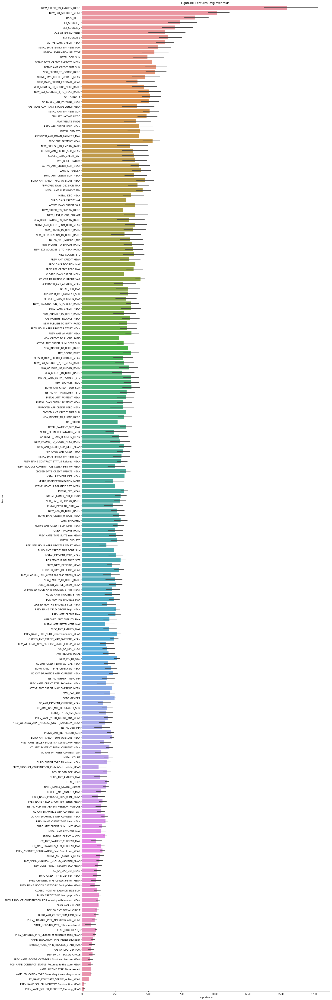

In [191]:
display_importance(feat_h7)

In [165]:
cols.to_csv('./Cols_values.csv')

In [147]:
#high_val_cols = cols[cols['importance']>10].index

In [148]:
## Num of trees = 14 with importance > 8
feat_h7, model_h7 = kfold_lightgbm_2(X_train[high_val_cols],y_train,alpha = 0.04, lam = 200, num_folds=5, stratified = False, debug= True)

Starting LightGBM. Train shape: (184504, 160) 
[1]	training's auc: 0.708278	valid_1's auc: 0.702555
Training until validation scores don't improve for 300 rounds.
[2]	training's auc: 0.709908	valid_1's auc: 0.703139
[3]	training's auc: 0.711146	valid_1's auc: 0.704187
[4]	training's auc: 0.717894	valid_1's auc: 0.710863
[5]	training's auc: 0.720679	valid_1's auc: 0.713426
[6]	training's auc: 0.723989	valid_1's auc: 0.715827
[7]	training's auc: 0.724683	valid_1's auc: 0.716496
[8]	training's auc: 0.724894	valid_1's auc: 0.716629
[9]	training's auc: 0.725609	valid_1's auc: 0.717043
[10]	training's auc: 0.728808	valid_1's auc: 0.72008
[11]	training's auc: 0.728923	valid_1's auc: 0.720568
[12]	training's auc: 0.729038	valid_1's auc: 0.720609
[13]	training's auc: 0.729401	valid_1's auc: 0.721176
[14]	training's auc: 0.72986	valid_1's auc: 0.721451
[15]	training's auc: 0.729981	valid_1's auc: 0.72167
[16]	training's auc: 0.730375	valid_1's auc: 0.721833
[17]	training's auc: 0.730508	valid_1'

[151]	training's auc: 0.771252	valid_1's auc: 0.757262
[152]	training's auc: 0.771446	valid_1's auc: 0.757361
[153]	training's auc: 0.771636	valid_1's auc: 0.757544
[154]	training's auc: 0.771852	valid_1's auc: 0.75777
[155]	training's auc: 0.77203	valid_1's auc: 0.757931
[156]	training's auc: 0.77221	valid_1's auc: 0.758099
[157]	training's auc: 0.772371	valid_1's auc: 0.758249
[158]	training's auc: 0.772577	valid_1's auc: 0.758446
[159]	training's auc: 0.772744	valid_1's auc: 0.758511
[160]	training's auc: 0.772966	valid_1's auc: 0.758781
[161]	training's auc: 0.773109	valid_1's auc: 0.758863
[162]	training's auc: 0.773301	valid_1's auc: 0.759018
[163]	training's auc: 0.773475	valid_1's auc: 0.759209
[164]	training's auc: 0.773627	valid_1's auc: 0.759296
[165]	training's auc: 0.773848	valid_1's auc: 0.759581
[166]	training's auc: 0.774048	valid_1's auc: 0.759773
[167]	training's auc: 0.774223	valid_1's auc: 0.759914
[168]	training's auc: 0.774405	valid_1's auc: 0.760088
[169]	trainin

[301]	training's auc: 0.7911	valid_1's auc: 0.773252
[302]	training's auc: 0.791196	valid_1's auc: 0.773318
[303]	training's auc: 0.791291	valid_1's auc: 0.773406
[304]	training's auc: 0.791404	valid_1's auc: 0.773445
[305]	training's auc: 0.791512	valid_1's auc: 0.773517
[306]	training's auc: 0.791585	valid_1's auc: 0.773574
[307]	training's auc: 0.791688	valid_1's auc: 0.773628
[308]	training's auc: 0.791765	valid_1's auc: 0.773658
[309]	training's auc: 0.79186	valid_1's auc: 0.773704
[310]	training's auc: 0.79195	valid_1's auc: 0.773755
[311]	training's auc: 0.79204	valid_1's auc: 0.77381
[312]	training's auc: 0.792123	valid_1's auc: 0.773828
[313]	training's auc: 0.792212	valid_1's auc: 0.773857
[314]	training's auc: 0.792291	valid_1's auc: 0.773892
[315]	training's auc: 0.792382	valid_1's auc: 0.773959
[316]	training's auc: 0.792471	valid_1's auc: 0.77403
[317]	training's auc: 0.792563	valid_1's auc: 0.774084
[318]	training's auc: 0.792632	valid_1's auc: 0.774136
[319]	training's 

[451]	training's auc: 0.802762	valid_1's auc: 0.779032
[452]	training's auc: 0.802843	valid_1's auc: 0.779069
[453]	training's auc: 0.802907	valid_1's auc: 0.779103
[454]	training's auc: 0.80297	valid_1's auc: 0.779118
[455]	training's auc: 0.803028	valid_1's auc: 0.779154
[456]	training's auc: 0.8031	valid_1's auc: 0.779172
[457]	training's auc: 0.803167	valid_1's auc: 0.779226
[458]	training's auc: 0.803228	valid_1's auc: 0.779261
[459]	training's auc: 0.803285	valid_1's auc: 0.779271
[460]	training's auc: 0.80335	valid_1's auc: 0.779296
[461]	training's auc: 0.803398	valid_1's auc: 0.779295
[462]	training's auc: 0.803464	valid_1's auc: 0.779295
[463]	training's auc: 0.803531	valid_1's auc: 0.779337
[464]	training's auc: 0.803582	valid_1's auc: 0.779372
[465]	training's auc: 0.803647	valid_1's auc: 0.779394
[466]	training's auc: 0.803716	valid_1's auc: 0.779396
[467]	training's auc: 0.803774	valid_1's auc: 0.779435
[468]	training's auc: 0.803868	valid_1's auc: 0.779491
[469]	training

[601]	training's auc: 0.811501	valid_1's auc: 0.781974
[602]	training's auc: 0.811559	valid_1's auc: 0.781985
[603]	training's auc: 0.811599	valid_1's auc: 0.782002
[604]	training's auc: 0.811644	valid_1's auc: 0.782036
[605]	training's auc: 0.811704	valid_1's auc: 0.782056
[606]	training's auc: 0.811752	valid_1's auc: 0.782068
[607]	training's auc: 0.811825	valid_1's auc: 0.782084
[608]	training's auc: 0.811908	valid_1's auc: 0.782107
[609]	training's auc: 0.811964	valid_1's auc: 0.78212
[610]	training's auc: 0.812025	valid_1's auc: 0.782145
[611]	training's auc: 0.812084	valid_1's auc: 0.782169
[612]	training's auc: 0.812163	valid_1's auc: 0.782195
[613]	training's auc: 0.812224	valid_1's auc: 0.782189
[614]	training's auc: 0.81228	valid_1's auc: 0.782193
[615]	training's auc: 0.812338	valid_1's auc: 0.782208
[616]	training's auc: 0.812395	valid_1's auc: 0.782226
[617]	training's auc: 0.812435	valid_1's auc: 0.782253
[618]	training's auc: 0.812526	valid_1's auc: 0.782258
[619]	traini

[751]	training's auc: 0.819527	valid_1's auc: 0.783641
[752]	training's auc: 0.819572	valid_1's auc: 0.783657
[753]	training's auc: 0.819623	valid_1's auc: 0.783669
[754]	training's auc: 0.819687	valid_1's auc: 0.783663
[755]	training's auc: 0.819745	valid_1's auc: 0.78369
[756]	training's auc: 0.819788	valid_1's auc: 0.783696
[757]	training's auc: 0.819826	valid_1's auc: 0.783697
[758]	training's auc: 0.819893	valid_1's auc: 0.783719
[759]	training's auc: 0.819926	valid_1's auc: 0.78372
[760]	training's auc: 0.819974	valid_1's auc: 0.783724
[761]	training's auc: 0.820005	valid_1's auc: 0.783736
[762]	training's auc: 0.820049	valid_1's auc: 0.783755
[763]	training's auc: 0.820102	valid_1's auc: 0.783762
[764]	training's auc: 0.820151	valid_1's auc: 0.783769
[765]	training's auc: 0.820217	valid_1's auc: 0.783816
[766]	training's auc: 0.820256	valid_1's auc: 0.783807
[767]	training's auc: 0.820292	valid_1's auc: 0.783802
[768]	training's auc: 0.820341	valid_1's auc: 0.783793
[769]	traini

[902]	training's auc: 0.8266	valid_1's auc: 0.784722
[903]	training's auc: 0.826641	valid_1's auc: 0.784722
[904]	training's auc: 0.826676	valid_1's auc: 0.784725
[905]	training's auc: 0.826723	valid_1's auc: 0.784713
[906]	training's auc: 0.826787	valid_1's auc: 0.784729
[907]	training's auc: 0.826834	valid_1's auc: 0.784748
[908]	training's auc: 0.826878	valid_1's auc: 0.784747
[909]	training's auc: 0.82692	valid_1's auc: 0.784738
[910]	training's auc: 0.826965	valid_1's auc: 0.784729
[911]	training's auc: 0.827006	valid_1's auc: 0.784719
[912]	training's auc: 0.827039	valid_1's auc: 0.784727
[913]	training's auc: 0.827074	valid_1's auc: 0.784756
[914]	training's auc: 0.827113	valid_1's auc: 0.784768
[915]	training's auc: 0.827169	valid_1's auc: 0.784773
[916]	training's auc: 0.827245	valid_1's auc: 0.784786
[917]	training's auc: 0.827317	valid_1's auc: 0.784812
[918]	training's auc: 0.827361	valid_1's auc: 0.784824
[919]	training's auc: 0.827418	valid_1's auc: 0.784818
[920]	trainin

[1052]	training's auc: 0.833172	valid_1's auc: 0.785569
[1053]	training's auc: 0.833199	valid_1's auc: 0.785582
[1054]	training's auc: 0.833225	valid_1's auc: 0.78559
[1055]	training's auc: 0.833303	valid_1's auc: 0.785577
[1056]	training's auc: 0.833334	valid_1's auc: 0.785581
[1057]	training's auc: 0.833377	valid_1's auc: 0.785562
[1058]	training's auc: 0.833414	valid_1's auc: 0.785567
[1059]	training's auc: 0.833447	valid_1's auc: 0.785566
[1060]	training's auc: 0.833476	valid_1's auc: 0.78558
[1061]	training's auc: 0.833524	valid_1's auc: 0.7856
[1062]	training's auc: 0.833557	valid_1's auc: 0.785596
[1063]	training's auc: 0.83362	valid_1's auc: 0.785598
[1064]	training's auc: 0.833668	valid_1's auc: 0.785613
[1065]	training's auc: 0.833716	valid_1's auc: 0.785617
[1066]	training's auc: 0.833776	valid_1's auc: 0.785607
[1067]	training's auc: 0.833816	valid_1's auc: 0.785599
[1068]	training's auc: 0.833858	valid_1's auc: 0.785593
[1069]	training's auc: 0.833913	valid_1's auc: 0.7855

[1200]	training's auc: 0.839323	valid_1's auc: 0.786326
[1201]	training's auc: 0.839362	valid_1's auc: 0.786318
[1202]	training's auc: 0.839394	valid_1's auc: 0.786316
[1203]	training's auc: 0.83943	valid_1's auc: 0.786303
[1204]	training's auc: 0.839452	valid_1's auc: 0.786297
[1205]	training's auc: 0.839496	valid_1's auc: 0.786305
[1206]	training's auc: 0.839531	valid_1's auc: 0.786317
[1207]	training's auc: 0.839566	valid_1's auc: 0.786322
[1208]	training's auc: 0.839607	valid_1's auc: 0.78633
[1209]	training's auc: 0.839646	valid_1's auc: 0.786336
[1210]	training's auc: 0.839692	valid_1's auc: 0.786343
[1211]	training's auc: 0.839738	valid_1's auc: 0.786355
[1212]	training's auc: 0.839793	valid_1's auc: 0.786375
[1213]	training's auc: 0.83984	valid_1's auc: 0.786375
[1214]	training's auc: 0.839869	valid_1's auc: 0.786382
[1215]	training's auc: 0.839898	valid_1's auc: 0.786382
[1216]	training's auc: 0.839935	valid_1's auc: 0.786402
[1217]	training's auc: 0.839982	valid_1's auc: 0.78

[1347]	training's auc: 0.845048	valid_1's auc: 0.786867
[1348]	training's auc: 0.845076	valid_1's auc: 0.786857
[1349]	training's auc: 0.845107	valid_1's auc: 0.786858
[1350]	training's auc: 0.845154	valid_1's auc: 0.786867
[1351]	training's auc: 0.845183	valid_1's auc: 0.786867
[1352]	training's auc: 0.845225	valid_1's auc: 0.786875
[1353]	training's auc: 0.84526	valid_1's auc: 0.786874
[1354]	training's auc: 0.845303	valid_1's auc: 0.786874
[1355]	training's auc: 0.845344	valid_1's auc: 0.786873
[1356]	training's auc: 0.845389	valid_1's auc: 0.786872
[1357]	training's auc: 0.845419	valid_1's auc: 0.786869
[1358]	training's auc: 0.845455	valid_1's auc: 0.786864
[1359]	training's auc: 0.845493	valid_1's auc: 0.78687
[1360]	training's auc: 0.845544	valid_1's auc: 0.786881
[1361]	training's auc: 0.845579	valid_1's auc: 0.78685
[1362]	training's auc: 0.845626	valid_1's auc: 0.786855
[1363]	training's auc: 0.84568	valid_1's auc: 0.786873
[1364]	training's auc: 0.845708	valid_1's auc: 0.786

[1495]	training's auc: 0.850606	valid_1's auc: 0.787215
[1496]	training's auc: 0.850635	valid_1's auc: 0.787218
[1497]	training's auc: 0.850687	valid_1's auc: 0.787218
[1498]	training's auc: 0.850736	valid_1's auc: 0.787214
[1499]	training's auc: 0.850765	valid_1's auc: 0.78721
[1500]	training's auc: 0.850802	valid_1's auc: 0.787219
[1501]	training's auc: 0.850834	valid_1's auc: 0.787218
[1502]	training's auc: 0.850867	valid_1's auc: 0.787217
[1503]	training's auc: 0.8509	valid_1's auc: 0.78721
[1504]	training's auc: 0.850946	valid_1's auc: 0.787225
[1505]	training's auc: 0.85098	valid_1's auc: 0.787224
[1506]	training's auc: 0.851026	valid_1's auc: 0.787226
[1507]	training's auc: 0.85109	valid_1's auc: 0.787242
[1508]	training's auc: 0.851119	valid_1's auc: 0.787245
[1509]	training's auc: 0.851145	valid_1's auc: 0.787248
[1510]	training's auc: 0.851179	valid_1's auc: 0.787255
[1511]	training's auc: 0.851225	valid_1's auc: 0.787267
[1512]	training's auc: 0.851252	valid_1's auc: 0.78726

[1643]	training's auc: 0.855771	valid_1's auc: 0.7875
[1644]	training's auc: 0.855814	valid_1's auc: 0.787504
[1645]	training's auc: 0.855845	valid_1's auc: 0.787489
[1646]	training's auc: 0.855878	valid_1's auc: 0.787477
[1647]	training's auc: 0.855904	valid_1's auc: 0.787491
[1648]	training's auc: 0.855932	valid_1's auc: 0.787492
[1649]	training's auc: 0.855973	valid_1's auc: 0.787511
[1650]	training's auc: 0.855999	valid_1's auc: 0.787509
[1651]	training's auc: 0.856025	valid_1's auc: 0.787505
[1652]	training's auc: 0.856058	valid_1's auc: 0.787504
[1653]	training's auc: 0.856096	valid_1's auc: 0.787505
[1654]	training's auc: 0.856125	valid_1's auc: 0.787514
[1655]	training's auc: 0.856175	valid_1's auc: 0.787513
[1656]	training's auc: 0.856213	valid_1's auc: 0.787512
[1657]	training's auc: 0.856247	valid_1's auc: 0.787548
[1658]	training's auc: 0.856275	valid_1's auc: 0.787544
[1659]	training's auc: 0.856317	valid_1's auc: 0.787539
[1660]	training's auc: 0.856353	valid_1's auc: 0.7

[1791]	training's auc: 0.860709	valid_1's auc: 0.787834
[1792]	training's auc: 0.860743	valid_1's auc: 0.787825
[1793]	training's auc: 0.860801	valid_1's auc: 0.787827
[1794]	training's auc: 0.86083	valid_1's auc: 0.787837
[1795]	training's auc: 0.860858	valid_1's auc: 0.787832
[1796]	training's auc: 0.86089	valid_1's auc: 0.787826
[1797]	training's auc: 0.860926	valid_1's auc: 0.787826
[1798]	training's auc: 0.860948	valid_1's auc: 0.787817
[1799]	training's auc: 0.860974	valid_1's auc: 0.787815
[1800]	training's auc: 0.861006	valid_1's auc: 0.787805
[1801]	training's auc: 0.861033	valid_1's auc: 0.787808
[1802]	training's auc: 0.861064	valid_1's auc: 0.787811
[1803]	training's auc: 0.861083	valid_1's auc: 0.787813
[1804]	training's auc: 0.861119	valid_1's auc: 0.787818
[1805]	training's auc: 0.861162	valid_1's auc: 0.787831
[1806]	training's auc: 0.861194	valid_1's auc: 0.787823
[1807]	training's auc: 0.861237	valid_1's auc: 0.787827
[1808]	training's auc: 0.861276	valid_1's auc: 0.7

[1939]	training's auc: 0.865561	valid_1's auc: 0.788204
[1940]	training's auc: 0.865592	valid_1's auc: 0.788211
[1941]	training's auc: 0.865624	valid_1's auc: 0.788217
[1942]	training's auc: 0.865658	valid_1's auc: 0.788219
[1943]	training's auc: 0.8657	valid_1's auc: 0.788214
[1944]	training's auc: 0.865729	valid_1's auc: 0.788209
[1945]	training's auc: 0.865757	valid_1's auc: 0.788202
[1946]	training's auc: 0.865784	valid_1's auc: 0.788189
[1947]	training's auc: 0.865824	valid_1's auc: 0.788192
[1948]	training's auc: 0.86585	valid_1's auc: 0.788195
[1949]	training's auc: 0.86588	valid_1's auc: 0.788191
[1950]	training's auc: 0.865913	valid_1's auc: 0.788197
[1951]	training's auc: 0.865936	valid_1's auc: 0.788207
[1952]	training's auc: 0.865974	valid_1's auc: 0.78821
[1953]	training's auc: 0.866003	valid_1's auc: 0.788203
[1954]	training's auc: 0.866037	valid_1's auc: 0.788198
[1955]	training's auc: 0.866072	valid_1's auc: 0.788207
[1956]	training's auc: 0.866097	valid_1's auc: 0.7882

[2086]	training's auc: 0.87014	valid_1's auc: 0.788181
[2087]	training's auc: 0.870195	valid_1's auc: 0.788192
[2088]	training's auc: 0.870224	valid_1's auc: 0.78819
[2089]	training's auc: 0.870257	valid_1's auc: 0.788194
[2090]	training's auc: 0.870282	valid_1's auc: 0.788198
[2091]	training's auc: 0.870308	valid_1's auc: 0.788207
[2092]	training's auc: 0.870334	valid_1's auc: 0.788206
[2093]	training's auc: 0.870367	valid_1's auc: 0.788212
[2094]	training's auc: 0.870388	valid_1's auc: 0.78821
[2095]	training's auc: 0.870415	valid_1's auc: 0.788205
[2096]	training's auc: 0.870454	valid_1's auc: 0.788225
[2097]	training's auc: 0.870477	valid_1's auc: 0.788206
[2098]	training's auc: 0.870499	valid_1's auc: 0.788206
[2099]	training's auc: 0.870541	valid_1's auc: 0.788213
[2100]	training's auc: 0.870562	valid_1's auc: 0.788218
[2101]	training's auc: 0.870589	valid_1's auc: 0.788217
[2102]	training's auc: 0.870617	valid_1's auc: 0.78822
[2103]	training's auc: 0.87065	valid_1's auc: 0.7882

[2234]	training's auc: 0.874557	valid_1's auc: 0.788296
[2235]	training's auc: 0.874585	valid_1's auc: 0.788312
[2236]	training's auc: 0.874611	valid_1's auc: 0.788299
[2237]	training's auc: 0.874644	valid_1's auc: 0.788281
[2238]	training's auc: 0.87468	valid_1's auc: 0.788263
[2239]	training's auc: 0.874692	valid_1's auc: 0.788257
[2240]	training's auc: 0.874724	valid_1's auc: 0.788245
[2241]	training's auc: 0.874754	valid_1's auc: 0.788253
[2242]	training's auc: 0.874783	valid_1's auc: 0.788253
[2243]	training's auc: 0.874801	valid_1's auc: 0.788249
[2244]	training's auc: 0.874832	valid_1's auc: 0.788264
[2245]	training's auc: 0.87487	valid_1's auc: 0.788271
[2246]	training's auc: 0.874894	valid_1's auc: 0.788274
[2247]	training's auc: 0.874931	valid_1's auc: 0.788273
[2248]	training's auc: 0.874968	valid_1's auc: 0.788272
[2249]	training's auc: 0.875006	valid_1's auc: 0.788274
[2250]	training's auc: 0.875041	valid_1's auc: 0.788275
[2251]	training's auc: 0.875061	valid_1's auc: 0.7

[2381]	training's auc: 0.878875	valid_1's auc: 0.788299
[2382]	training's auc: 0.878906	valid_1's auc: 0.788314
[2383]	training's auc: 0.878931	valid_1's auc: 0.788307
[2384]	training's auc: 0.878949	valid_1's auc: 0.788309
[2385]	training's auc: 0.878964	valid_1's auc: 0.788305
[2386]	training's auc: 0.878992	valid_1's auc: 0.788317
[2387]	training's auc: 0.879026	valid_1's auc: 0.788315
[2388]	training's auc: 0.879064	valid_1's auc: 0.788339
[2389]	training's auc: 0.879103	valid_1's auc: 0.788335
[2390]	training's auc: 0.879131	valid_1's auc: 0.788344
[2391]	training's auc: 0.879172	valid_1's auc: 0.788332
[2392]	training's auc: 0.879206	valid_1's auc: 0.788338
[2393]	training's auc: 0.879235	valid_1's auc: 0.788332
[2394]	training's auc: 0.879269	valid_1's auc: 0.788336
[2395]	training's auc: 0.879298	valid_1's auc: 0.788342
[2396]	training's auc: 0.879316	valid_1's auc: 0.788334
[2397]	training's auc: 0.879344	valid_1's auc: 0.788343
[2398]	training's auc: 0.879367	valid_1's auc: 0

[2529]	training's auc: 0.882963	valid_1's auc: 0.788401
[2530]	training's auc: 0.882985	valid_1's auc: 0.788396
[2531]	training's auc: 0.883009	valid_1's auc: 0.788397
[2532]	training's auc: 0.883037	valid_1's auc: 0.788394
[2533]	training's auc: 0.883061	valid_1's auc: 0.78838
[2534]	training's auc: 0.883079	valid_1's auc: 0.788384
[2535]	training's auc: 0.883109	valid_1's auc: 0.788373
[2536]	training's auc: 0.883131	valid_1's auc: 0.788375
[2537]	training's auc: 0.883149	valid_1's auc: 0.788372
[2538]	training's auc: 0.883158	valid_1's auc: 0.788371
[2539]	training's auc: 0.883181	valid_1's auc: 0.788368
[2540]	training's auc: 0.883206	valid_1's auc: 0.78836
[2541]	training's auc: 0.883234	valid_1's auc: 0.788332
[2542]	training's auc: 0.883253	valid_1's auc: 0.788331
[2543]	training's auc: 0.883289	valid_1's auc: 0.788347
[2544]	training's auc: 0.883314	valid_1's auc: 0.788354
[2545]	training's auc: 0.883341	valid_1's auc: 0.788364
[2546]	training's auc: 0.883366	valid_1's auc: 0.7

[2677]	training's auc: 0.886784	valid_1's auc: 0.788492
[2678]	training's auc: 0.886812	valid_1's auc: 0.788502
[2679]	training's auc: 0.886819	valid_1's auc: 0.788504
[2680]	training's auc: 0.886843	valid_1's auc: 0.78851
[2681]	training's auc: 0.886863	valid_1's auc: 0.7885
[2682]	training's auc: 0.886876	valid_1's auc: 0.788498
[2683]	training's auc: 0.886896	valid_1's auc: 0.788506
[2684]	training's auc: 0.88693	valid_1's auc: 0.788505
[2685]	training's auc: 0.886965	valid_1's auc: 0.788517
[2686]	training's auc: 0.886987	valid_1's auc: 0.78853
[2687]	training's auc: 0.887018	valid_1's auc: 0.788543
[2688]	training's auc: 0.88705	valid_1's auc: 0.788559
[2689]	training's auc: 0.88708	valid_1's auc: 0.788549
[2690]	training's auc: 0.887103	valid_1's auc: 0.788554
[2691]	training's auc: 0.887127	valid_1's auc: 0.788546
[2692]	training's auc: 0.88716	valid_1's auc: 0.788563
[2693]	training's auc: 0.887187	valid_1's auc: 0.788567
[2694]	training's auc: 0.88721	valid_1's auc: 0.788558
[

[2826]	training's auc: 0.890663	valid_1's auc: 0.788712
[2827]	training's auc: 0.890692	valid_1's auc: 0.788695
[2828]	training's auc: 0.890712	valid_1's auc: 0.788681
[2829]	training's auc: 0.89074	valid_1's auc: 0.788682
[2830]	training's auc: 0.890769	valid_1's auc: 0.788681
[2831]	training's auc: 0.890789	valid_1's auc: 0.78868
[2832]	training's auc: 0.890816	valid_1's auc: 0.788674
[2833]	training's auc: 0.890843	valid_1's auc: 0.788668
[2834]	training's auc: 0.890878	valid_1's auc: 0.788658
[2835]	training's auc: 0.890911	valid_1's auc: 0.788649
[2836]	training's auc: 0.890931	valid_1's auc: 0.788646
[2837]	training's auc: 0.890962	valid_1's auc: 0.788634
[2838]	training's auc: 0.890988	valid_1's auc: 0.788638
[2839]	training's auc: 0.891016	valid_1's auc: 0.788628
[2840]	training's auc: 0.891058	valid_1's auc: 0.788625
[2841]	training's auc: 0.891084	valid_1's auc: 0.788615
[2842]	training's auc: 0.891106	valid_1's auc: 0.78861
[2843]	training's auc: 0.891139	valid_1's auc: 0.78

[2973]	training's auc: 0.894325	valid_1's auc: 0.788448
[2974]	training's auc: 0.894334	valid_1's auc: 0.788435
[2975]	training's auc: 0.894355	valid_1's auc: 0.788416
[2976]	training's auc: 0.894384	valid_1's auc: 0.788409
[2977]	training's auc: 0.894412	valid_1's auc: 0.788408
[2978]	training's auc: 0.894429	valid_1's auc: 0.788417
[2979]	training's auc: 0.894447	valid_1's auc: 0.788431
[2980]	training's auc: 0.894478	valid_1's auc: 0.788417
[2981]	training's auc: 0.894494	valid_1's auc: 0.788424
[2982]	training's auc: 0.89451	valid_1's auc: 0.78843
[2983]	training's auc: 0.894527	valid_1's auc: 0.788423
[2984]	training's auc: 0.894563	valid_1's auc: 0.788418
[2985]	training's auc: 0.894582	valid_1's auc: 0.788414
[2986]	training's auc: 0.894607	valid_1's auc: 0.788408
[2987]	training's auc: 0.894638	valid_1's auc: 0.788394
[2988]	training's auc: 0.894663	valid_1's auc: 0.788404
[2989]	training's auc: 0.894683	valid_1's auc: 0.788413
[2990]	training's auc: 0.894716	valid_1's auc: 0.7

[3120]	training's auc: 0.89787	valid_1's auc: 0.788455
[3121]	training's auc: 0.897894	valid_1's auc: 0.788454
[3122]	training's auc: 0.897909	valid_1's auc: 0.788456
[3123]	training's auc: 0.897929	valid_1's auc: 0.788458
[3124]	training's auc: 0.897965	valid_1's auc: 0.788462
[3125]	training's auc: 0.89799	valid_1's auc: 0.788451
Early stopping, best iteration is:
[2825]	training's auc: 0.890627	valid_1's auc: 0.788717
Fold  1 AUC : 0.788717
[1]	training's auc: 0.707658	valid_1's auc: 0.709889
Training until validation scores don't improve for 300 rounds.
[2]	training's auc: 0.716913	valid_1's auc: 0.718932
[3]	training's auc: 0.718187	valid_1's auc: 0.719844
[4]	training's auc: 0.721266	valid_1's auc: 0.722746
[5]	training's auc: 0.72182	valid_1's auc: 0.723417
[6]	training's auc: 0.723462	valid_1's auc: 0.725376
[7]	training's auc: 0.72337	valid_1's auc: 0.72533
[8]	training's auc: 0.724597	valid_1's auc: 0.726598
[9]	training's auc: 0.725005	valid_1's auc: 0.726636
[10]	training's

[145]	training's auc: 0.770743	valid_1's auc: 0.759088
[146]	training's auc: 0.770915	valid_1's auc: 0.759228
[147]	training's auc: 0.771155	valid_1's auc: 0.759385
[148]	training's auc: 0.771358	valid_1's auc: 0.759489
[149]	training's auc: 0.771544	valid_1's auc: 0.759661
[150]	training's auc: 0.771741	valid_1's auc: 0.759791
[151]	training's auc: 0.771994	valid_1's auc: 0.759942
[152]	training's auc: 0.772208	valid_1's auc: 0.760077
[153]	training's auc: 0.772378	valid_1's auc: 0.760176
[154]	training's auc: 0.772628	valid_1's auc: 0.760386
[155]	training's auc: 0.772811	valid_1's auc: 0.76049
[156]	training's auc: 0.773059	valid_1's auc: 0.760628
[157]	training's auc: 0.773231	valid_1's auc: 0.760685
[158]	training's auc: 0.773426	valid_1's auc: 0.760771
[159]	training's auc: 0.773625	valid_1's auc: 0.760919
[160]	training's auc: 0.773781	valid_1's auc: 0.761047
[161]	training's auc: 0.774006	valid_1's auc: 0.761188
[162]	training's auc: 0.774138	valid_1's auc: 0.761225
[163]	train

[296]	training's auc: 0.791933	valid_1's auc: 0.770555
[297]	training's auc: 0.792026	valid_1's auc: 0.770604
[298]	training's auc: 0.792124	valid_1's auc: 0.770675
[299]	training's auc: 0.792207	valid_1's auc: 0.770702
[300]	training's auc: 0.792303	valid_1's auc: 0.770759
[301]	training's auc: 0.792398	valid_1's auc: 0.770815
[302]	training's auc: 0.792514	valid_1's auc: 0.770899
[303]	training's auc: 0.792608	valid_1's auc: 0.770928
[304]	training's auc: 0.792712	valid_1's auc: 0.770962
[305]	training's auc: 0.792813	valid_1's auc: 0.771013
[306]	training's auc: 0.792915	valid_1's auc: 0.771051
[307]	training's auc: 0.792996	valid_1's auc: 0.771091
[308]	training's auc: 0.793096	valid_1's auc: 0.771131
[309]	training's auc: 0.793196	valid_1's auc: 0.771195
[310]	training's auc: 0.79329	valid_1's auc: 0.771277
[311]	training's auc: 0.793389	valid_1's auc: 0.771297
[312]	training's auc: 0.793481	valid_1's auc: 0.771318
[313]	training's auc: 0.793583	valid_1's auc: 0.771374
[314]	train

[447]	training's auc: 0.804431	valid_1's auc: 0.775427
[448]	training's auc: 0.804492	valid_1's auc: 0.775448
[449]	training's auc: 0.804549	valid_1's auc: 0.775487
[450]	training's auc: 0.804635	valid_1's auc: 0.775512
[451]	training's auc: 0.804724	valid_1's auc: 0.77557
[452]	training's auc: 0.804778	valid_1's auc: 0.775593
[453]	training's auc: 0.804856	valid_1's auc: 0.775594
[454]	training's auc: 0.804918	valid_1's auc: 0.775623
[455]	training's auc: 0.804978	valid_1's auc: 0.775628
[456]	training's auc: 0.80503	valid_1's auc: 0.775659
[457]	training's auc: 0.805115	valid_1's auc: 0.775661
[458]	training's auc: 0.805196	valid_1's auc: 0.775665
[459]	training's auc: 0.805276	valid_1's auc: 0.775686
[460]	training's auc: 0.805343	valid_1's auc: 0.775699
[461]	training's auc: 0.805433	valid_1's auc: 0.775714
[462]	training's auc: 0.805498	valid_1's auc: 0.775753
[463]	training's auc: 0.805567	valid_1's auc: 0.775764
[464]	training's auc: 0.805638	valid_1's auc: 0.775785
[465]	traini

[597]	training's auc: 0.8137	valid_1's auc: 0.777745
[598]	training's auc: 0.813753	valid_1's auc: 0.777741
[599]	training's auc: 0.813816	valid_1's auc: 0.777775
[600]	training's auc: 0.813878	valid_1's auc: 0.77777
[601]	training's auc: 0.813917	valid_1's auc: 0.777781
[602]	training's auc: 0.813963	valid_1's auc: 0.777781
[603]	training's auc: 0.814017	valid_1's auc: 0.777784
[604]	training's auc: 0.81407	valid_1's auc: 0.777798
[605]	training's auc: 0.81413	valid_1's auc: 0.777798
[606]	training's auc: 0.814185	valid_1's auc: 0.777806
[607]	training's auc: 0.814247	valid_1's auc: 0.777812
[608]	training's auc: 0.814299	valid_1's auc: 0.777842
[609]	training's auc: 0.81436	valid_1's auc: 0.777816
[610]	training's auc: 0.81441	valid_1's auc: 0.77783
[611]	training's auc: 0.814487	valid_1's auc: 0.777816
[612]	training's auc: 0.814567	valid_1's auc: 0.777813
[613]	training's auc: 0.81463	valid_1's auc: 0.777808
[614]	training's auc: 0.814686	valid_1's auc: 0.777811
[615]	training's au

[747]	training's auc: 0.821407	valid_1's auc: 0.779147
[748]	training's auc: 0.821449	valid_1's auc: 0.77917
[749]	training's auc: 0.821497	valid_1's auc: 0.779178
[750]	training's auc: 0.82155	valid_1's auc: 0.77919
[751]	training's auc: 0.821585	valid_1's auc: 0.779205
[752]	training's auc: 0.821637	valid_1's auc: 0.779228
[753]	training's auc: 0.821679	valid_1's auc: 0.779239
[754]	training's auc: 0.82172	valid_1's auc: 0.77924
[755]	training's auc: 0.821757	valid_1's auc: 0.779233
[756]	training's auc: 0.821821	valid_1's auc: 0.779231
[757]	training's auc: 0.82187	valid_1's auc: 0.779253
[758]	training's auc: 0.821904	valid_1's auc: 0.779263
[759]	training's auc: 0.821958	valid_1's auc: 0.779281
[760]	training's auc: 0.82199	valid_1's auc: 0.779292
[761]	training's auc: 0.822057	valid_1's auc: 0.779289
[762]	training's auc: 0.822109	valid_1's auc: 0.779282
[763]	training's auc: 0.822136	valid_1's auc: 0.779286
[764]	training's auc: 0.82218	valid_1's auc: 0.779298
[765]	training's a

[898]	training's auc: 0.828339	valid_1's auc: 0.779739
[899]	training's auc: 0.828383	valid_1's auc: 0.779733
[900]	training's auc: 0.828419	valid_1's auc: 0.779754
[901]	training's auc: 0.828468	valid_1's auc: 0.779775
[902]	training's auc: 0.828504	valid_1's auc: 0.779773
[903]	training's auc: 0.828571	valid_1's auc: 0.779786
[904]	training's auc: 0.828632	valid_1's auc: 0.779785
[905]	training's auc: 0.828674	valid_1's auc: 0.779781
[906]	training's auc: 0.828706	valid_1's auc: 0.779778
[907]	training's auc: 0.828742	valid_1's auc: 0.7798
[908]	training's auc: 0.828788	valid_1's auc: 0.779801
[909]	training's auc: 0.828816	valid_1's auc: 0.77982
[910]	training's auc: 0.82886	valid_1's auc: 0.77982
[911]	training's auc: 0.828905	valid_1's auc: 0.779831
[912]	training's auc: 0.828975	valid_1's auc: 0.779839
[913]	training's auc: 0.829021	valid_1's auc: 0.779857
[914]	training's auc: 0.829079	valid_1's auc: 0.779857
[915]	training's auc: 0.82912	valid_1's auc: 0.779866
[916]	training's

[1048]	training's auc: 0.834966	valid_1's auc: 0.780535
[1049]	training's auc: 0.835004	valid_1's auc: 0.780545
[1050]	training's auc: 0.835045	valid_1's auc: 0.780535
[1051]	training's auc: 0.835089	valid_1's auc: 0.780524
[1052]	training's auc: 0.835111	valid_1's auc: 0.78055
[1053]	training's auc: 0.835178	valid_1's auc: 0.780574
[1054]	training's auc: 0.835231	valid_1's auc: 0.780573
[1055]	training's auc: 0.835276	valid_1's auc: 0.780576
[1056]	training's auc: 0.835318	valid_1's auc: 0.780579
[1057]	training's auc: 0.835355	valid_1's auc: 0.780583
[1058]	training's auc: 0.835388	valid_1's auc: 0.780578
[1059]	training's auc: 0.835452	valid_1's auc: 0.780575
[1060]	training's auc: 0.835497	valid_1's auc: 0.780557
[1061]	training's auc: 0.835539	valid_1's auc: 0.780549
[1062]	training's auc: 0.835579	valid_1's auc: 0.780562
[1063]	training's auc: 0.83561	valid_1's auc: 0.780567
[1064]	training's auc: 0.835653	valid_1's auc: 0.780579
[1065]	training's auc: 0.835691	valid_1's auc: 0.7

[1195]	training's auc: 0.841024	valid_1's auc: 0.781004
[1196]	training's auc: 0.841061	valid_1's auc: 0.781002
[1197]	training's auc: 0.841106	valid_1's auc: 0.781024
[1198]	training's auc: 0.841137	valid_1's auc: 0.781013
[1199]	training's auc: 0.841182	valid_1's auc: 0.781016
[1200]	training's auc: 0.841235	valid_1's auc: 0.781013
[1201]	training's auc: 0.841274	valid_1's auc: 0.781045
[1202]	training's auc: 0.841313	valid_1's auc: 0.781035
[1203]	training's auc: 0.84135	valid_1's auc: 0.781048
[1204]	training's auc: 0.841378	valid_1's auc: 0.781048
[1205]	training's auc: 0.841407	valid_1's auc: 0.781053
[1206]	training's auc: 0.841446	valid_1's auc: 0.781069
[1207]	training's auc: 0.841481	valid_1's auc: 0.781069
[1208]	training's auc: 0.841508	valid_1's auc: 0.781084
[1209]	training's auc: 0.841552	valid_1's auc: 0.781097
[1210]	training's auc: 0.841598	valid_1's auc: 0.781115
[1211]	training's auc: 0.841638	valid_1's auc: 0.781121
[1212]	training's auc: 0.841672	valid_1's auc: 0.

[1343]	training's auc: 0.846678	valid_1's auc: 0.78148
[1344]	training's auc: 0.846712	valid_1's auc: 0.781484
[1345]	training's auc: 0.846748	valid_1's auc: 0.781484
[1346]	training's auc: 0.84679	valid_1's auc: 0.781497
[1347]	training's auc: 0.846831	valid_1's auc: 0.781483
[1348]	training's auc: 0.846887	valid_1's auc: 0.781511
[1349]	training's auc: 0.84694	valid_1's auc: 0.781499
[1350]	training's auc: 0.846993	valid_1's auc: 0.781502
[1351]	training's auc: 0.847026	valid_1's auc: 0.781498
[1352]	training's auc: 0.847068	valid_1's auc: 0.781518
[1353]	training's auc: 0.847098	valid_1's auc: 0.781512
[1354]	training's auc: 0.847137	valid_1's auc: 0.781521
[1355]	training's auc: 0.847171	valid_1's auc: 0.781529
[1356]	training's auc: 0.847202	valid_1's auc: 0.781525
[1357]	training's auc: 0.847233	valid_1's auc: 0.78153
[1358]	training's auc: 0.847282	valid_1's auc: 0.781543
[1359]	training's auc: 0.84733	valid_1's auc: 0.781529
[1360]	training's auc: 0.847358	valid_1's auc: 0.7815

[1491]	training's auc: 0.852159	valid_1's auc: 0.781599
[1492]	training's auc: 0.852195	valid_1's auc: 0.781602
[1493]	training's auc: 0.852224	valid_1's auc: 0.781596
[1494]	training's auc: 0.852259	valid_1's auc: 0.781602
[1495]	training's auc: 0.852292	valid_1's auc: 0.781605
[1496]	training's auc: 0.852324	valid_1's auc: 0.781603
[1497]	training's auc: 0.852359	valid_1's auc: 0.781607
[1498]	training's auc: 0.852422	valid_1's auc: 0.781591
[1499]	training's auc: 0.852458	valid_1's auc: 0.781598
[1500]	training's auc: 0.852493	valid_1's auc: 0.781593
[1501]	training's auc: 0.852531	valid_1's auc: 0.781604
[1502]	training's auc: 0.852569	valid_1's auc: 0.781619
[1503]	training's auc: 0.852603	valid_1's auc: 0.781605
[1504]	training's auc: 0.852654	valid_1's auc: 0.781598
[1505]	training's auc: 0.852687	valid_1's auc: 0.781606
[1506]	training's auc: 0.852718	valid_1's auc: 0.781612
[1507]	training's auc: 0.852755	valid_1's auc: 0.781614
[1508]	training's auc: 0.852782	valid_1's auc: 0

[1639]	training's auc: 0.857163	valid_1's auc: 0.781809
[1640]	training's auc: 0.857195	valid_1's auc: 0.781811
[1641]	training's auc: 0.85722	valid_1's auc: 0.781813
[1642]	training's auc: 0.85724	valid_1's auc: 0.781814
[1643]	training's auc: 0.857265	valid_1's auc: 0.78182
[1644]	training's auc: 0.857311	valid_1's auc: 0.781813
[1645]	training's auc: 0.857366	valid_1's auc: 0.781813
[1646]	training's auc: 0.857417	valid_1's auc: 0.781798
[1647]	training's auc: 0.857447	valid_1's auc: 0.781797
[1648]	training's auc: 0.857507	valid_1's auc: 0.781799
[1649]	training's auc: 0.857556	valid_1's auc: 0.781784
[1650]	training's auc: 0.857586	valid_1's auc: 0.781791
[1651]	training's auc: 0.857612	valid_1's auc: 0.781785
[1652]	training's auc: 0.857637	valid_1's auc: 0.781769
[1653]	training's auc: 0.857672	valid_1's auc: 0.781776
[1654]	training's auc: 0.857705	valid_1's auc: 0.781788
[1655]	training's auc: 0.857731	valid_1's auc: 0.781798
[1656]	training's auc: 0.857772	valid_1's auc: 0.78

[1787]	training's auc: 0.861991	valid_1's auc: 0.781813
[1788]	training's auc: 0.862031	valid_1's auc: 0.781814
[1789]	training's auc: 0.862061	valid_1's auc: 0.78182
[1790]	training's auc: 0.862107	valid_1's auc: 0.781828
[1791]	training's auc: 0.862146	valid_1's auc: 0.781836
[1792]	training's auc: 0.862184	valid_1's auc: 0.781849
[1793]	training's auc: 0.862227	valid_1's auc: 0.781873
[1794]	training's auc: 0.862258	valid_1's auc: 0.781865
[1795]	training's auc: 0.862296	valid_1's auc: 0.781896
[1796]	training's auc: 0.862325	valid_1's auc: 0.781899
[1797]	training's auc: 0.862361	valid_1's auc: 0.78192
[1798]	training's auc: 0.862393	valid_1's auc: 0.781909
[1799]	training's auc: 0.862429	valid_1's auc: 0.781907
[1800]	training's auc: 0.862459	valid_1's auc: 0.781901
[1801]	training's auc: 0.862487	valid_1's auc: 0.781902
[1802]	training's auc: 0.862507	valid_1's auc: 0.781916
[1803]	training's auc: 0.862541	valid_1's auc: 0.781907
[1804]	training's auc: 0.862579	valid_1's auc: 0.7

[1934]	training's auc: 0.866785	valid_1's auc: 0.781878
[1935]	training's auc: 0.866811	valid_1's auc: 0.78187
[1936]	training's auc: 0.866842	valid_1's auc: 0.781881
[1937]	training's auc: 0.866874	valid_1's auc: 0.781884
[1938]	training's auc: 0.866907	valid_1's auc: 0.781886
[1939]	training's auc: 0.866935	valid_1's auc: 0.781877
[1940]	training's auc: 0.866962	valid_1's auc: 0.781869
[1941]	training's auc: 0.866989	valid_1's auc: 0.781867
[1942]	training's auc: 0.867012	valid_1's auc: 0.781882
[1943]	training's auc: 0.867045	valid_1's auc: 0.78188
[1944]	training's auc: 0.86709	valid_1's auc: 0.78188
[1945]	training's auc: 0.867125	valid_1's auc: 0.781884
[1946]	training's auc: 0.867171	valid_1's auc: 0.781869
[1947]	training's auc: 0.867197	valid_1's auc: 0.781877
[1948]	training's auc: 0.867227	valid_1's auc: 0.781882
[1949]	training's auc: 0.867268	valid_1's auc: 0.781909
[1950]	training's auc: 0.867303	valid_1's auc: 0.781913
[1951]	training's auc: 0.867337	valid_1's auc: 0.781

[2082]	training's auc: 0.871213	valid_1's auc: 0.782079
[2083]	training's auc: 0.871245	valid_1's auc: 0.78208
[2084]	training's auc: 0.871263	valid_1's auc: 0.782085
[2085]	training's auc: 0.871276	valid_1's auc: 0.782081
[2086]	training's auc: 0.871302	valid_1's auc: 0.782079
[2087]	training's auc: 0.871349	valid_1's auc: 0.782082
[2088]	training's auc: 0.871382	valid_1's auc: 0.78206
[2089]	training's auc: 0.871409	valid_1's auc: 0.782053
[2090]	training's auc: 0.871432	valid_1's auc: 0.782053
[2091]	training's auc: 0.871486	valid_1's auc: 0.782055
[2092]	training's auc: 0.871509	valid_1's auc: 0.782065
[2093]	training's auc: 0.87154	valid_1's auc: 0.782067
[2094]	training's auc: 0.871571	valid_1's auc: 0.782097
[2095]	training's auc: 0.871604	valid_1's auc: 0.782117
[2096]	training's auc: 0.871632	valid_1's auc: 0.782119
[2097]	training's auc: 0.871669	valid_1's auc: 0.782134
[2098]	training's auc: 0.871722	valid_1's auc: 0.782156
[2099]	training's auc: 0.871758	valid_1's auc: 0.78

[2231]	training's auc: 0.875503	valid_1's auc: 0.782213
[2232]	training's auc: 0.875528	valid_1's auc: 0.782209
[2233]	training's auc: 0.875567	valid_1's auc: 0.782207
[2234]	training's auc: 0.875586	valid_1's auc: 0.782219
[2235]	training's auc: 0.875648	valid_1's auc: 0.782222
[2236]	training's auc: 0.875677	valid_1's auc: 0.782227
[2237]	training's auc: 0.875703	valid_1's auc: 0.782227
[2238]	training's auc: 0.875725	valid_1's auc: 0.782229
[2239]	training's auc: 0.875752	valid_1's auc: 0.782239
[2240]	training's auc: 0.875775	valid_1's auc: 0.78225
[2241]	training's auc: 0.875798	valid_1's auc: 0.782254
[2242]	training's auc: 0.875825	valid_1's auc: 0.78226
[2243]	training's auc: 0.875849	valid_1's auc: 0.78228
[2244]	training's auc: 0.875893	valid_1's auc: 0.782284
[2245]	training's auc: 0.875929	valid_1's auc: 0.782281
[2246]	training's auc: 0.875954	valid_1's auc: 0.782281
[2247]	training's auc: 0.875984	valid_1's auc: 0.782281
[2248]	training's auc: 0.876014	valid_1's auc: 0.78

[2378]	training's auc: 0.87954	valid_1's auc: 0.78237
[2379]	training's auc: 0.879556	valid_1's auc: 0.782384
[2380]	training's auc: 0.879587	valid_1's auc: 0.782373
[2381]	training's auc: 0.879603	valid_1's auc: 0.782371
[2382]	training's auc: 0.879622	valid_1's auc: 0.782383
[2383]	training's auc: 0.879669	valid_1's auc: 0.782379
[2384]	training's auc: 0.879701	valid_1's auc: 0.782366
[2385]	training's auc: 0.879734	valid_1's auc: 0.782361
[2386]	training's auc: 0.879761	valid_1's auc: 0.782382
[2387]	training's auc: 0.87978	valid_1's auc: 0.782389
[2388]	training's auc: 0.879809	valid_1's auc: 0.782389
[2389]	training's auc: 0.879834	valid_1's auc: 0.782389
[2390]	training's auc: 0.87988	valid_1's auc: 0.782402
[2391]	training's auc: 0.879913	valid_1's auc: 0.782395
[2392]	training's auc: 0.879942	valid_1's auc: 0.782393
[2393]	training's auc: 0.879974	valid_1's auc: 0.782391
[2394]	training's auc: 0.880009	valid_1's auc: 0.782376
[2395]	training's auc: 0.880052	valid_1's auc: 0.782

[2525]	training's auc: 0.883469	valid_1's auc: 0.7825
[2526]	training's auc: 0.883509	valid_1's auc: 0.782494
[2527]	training's auc: 0.88354	valid_1's auc: 0.782485
[2528]	training's auc: 0.88357	valid_1's auc: 0.782481
[2529]	training's auc: 0.883609	valid_1's auc: 0.782484
[2530]	training's auc: 0.883632	valid_1's auc: 0.782485
[2531]	training's auc: 0.883664	valid_1's auc: 0.782472
[2532]	training's auc: 0.883677	valid_1's auc: 0.782464
[2533]	training's auc: 0.883703	valid_1's auc: 0.78245
[2534]	training's auc: 0.883733	valid_1's auc: 0.782436
[2535]	training's auc: 0.88377	valid_1's auc: 0.782443
[2536]	training's auc: 0.883815	valid_1's auc: 0.782449
[2537]	training's auc: 0.883839	valid_1's auc: 0.782445
[2538]	training's auc: 0.883867	valid_1's auc: 0.782445
[2539]	training's auc: 0.883903	valid_1's auc: 0.78244
[2540]	training's auc: 0.883942	valid_1's auc: 0.782434
[2541]	training's auc: 0.883961	valid_1's auc: 0.78243
[2542]	training's auc: 0.883988	valid_1's auc: 0.782437


[2674]	training's auc: 0.887524	valid_1's auc: 0.782447
[2675]	training's auc: 0.887545	valid_1's auc: 0.782449
[2676]	training's auc: 0.887565	valid_1's auc: 0.782457
[2677]	training's auc: 0.887588	valid_1's auc: 0.782464
[2678]	training's auc: 0.887626	valid_1's auc: 0.782457
[2679]	training's auc: 0.88767	valid_1's auc: 0.78247
[2680]	training's auc: 0.887699	valid_1's auc: 0.782475
[2681]	training's auc: 0.887723	valid_1's auc: 0.782474
[2682]	training's auc: 0.887742	valid_1's auc: 0.782483
[2683]	training's auc: 0.887789	valid_1's auc: 0.782478
[2684]	training's auc: 0.887812	valid_1's auc: 0.782477
[2685]	training's auc: 0.88783	valid_1's auc: 0.782493
[2686]	training's auc: 0.88787	valid_1's auc: 0.782487
[2687]	training's auc: 0.887896	valid_1's auc: 0.782487
[2688]	training's auc: 0.887916	valid_1's auc: 0.782484
[2689]	training's auc: 0.887944	valid_1's auc: 0.782505
[2690]	training's auc: 0.887968	valid_1's auc: 0.782505
[2691]	training's auc: 0.887991	valid_1's auc: 0.782

[2822]	training's auc: 0.891351	valid_1's auc: 0.782544
[2823]	training's auc: 0.89137	valid_1's auc: 0.782551
[2824]	training's auc: 0.891392	valid_1's auc: 0.782556
[2825]	training's auc: 0.891415	valid_1's auc: 0.782556
[2826]	training's auc: 0.891439	valid_1's auc: 0.782553
[2827]	training's auc: 0.891456	valid_1's auc: 0.782551
[2828]	training's auc: 0.891489	valid_1's auc: 0.782574
[2829]	training's auc: 0.891512	valid_1's auc: 0.782565
[2830]	training's auc: 0.891531	valid_1's auc: 0.782569
[2831]	training's auc: 0.891548	valid_1's auc: 0.782562
[2832]	training's auc: 0.891573	valid_1's auc: 0.782562
[2833]	training's auc: 0.891588	valid_1's auc: 0.782571
[2834]	training's auc: 0.891609	valid_1's auc: 0.782569
[2835]	training's auc: 0.891633	valid_1's auc: 0.782561
[2836]	training's auc: 0.89165	valid_1's auc: 0.782559
[2837]	training's auc: 0.89168	valid_1's auc: 0.782556
[2838]	training's auc: 0.891724	valid_1's auc: 0.782558
[2839]	training's auc: 0.891747	valid_1's auc: 0.78

[2970]	training's auc: 0.894979	valid_1's auc: 0.782541
[2971]	training's auc: 0.895001	valid_1's auc: 0.782553
[2972]	training's auc: 0.89503	valid_1's auc: 0.782564
[2973]	training's auc: 0.895059	valid_1's auc: 0.782563
[2974]	training's auc: 0.895084	valid_1's auc: 0.782561
[2975]	training's auc: 0.895107	valid_1's auc: 0.78256
[2976]	training's auc: 0.895123	valid_1's auc: 0.782566
[2977]	training's auc: 0.89515	valid_1's auc: 0.782558
[2978]	training's auc: 0.895164	valid_1's auc: 0.782551
[2979]	training's auc: 0.895199	valid_1's auc: 0.782531
[2980]	training's auc: 0.895218	valid_1's auc: 0.782526
[2981]	training's auc: 0.895256	valid_1's auc: 0.782507
[2982]	training's auc: 0.89529	valid_1's auc: 0.782502
[2983]	training's auc: 0.89531	valid_1's auc: 0.782502
[2984]	training's auc: 0.895341	valid_1's auc: 0.782493
[2985]	training's auc: 0.895373	valid_1's auc: 0.78248
[2986]	training's auc: 0.895396	valid_1's auc: 0.782483
[2987]	training's auc: 0.895411	valid_1's auc: 0.78248

[3118]	training's auc: 0.898675	valid_1's auc: 0.782448
[3119]	training's auc: 0.89869	valid_1's auc: 0.782457
[3120]	training's auc: 0.89871	valid_1's auc: 0.782451
[3121]	training's auc: 0.898734	valid_1's auc: 0.78245
[3122]	training's auc: 0.898753	valid_1's auc: 0.782447
[3123]	training's auc: 0.898785	valid_1's auc: 0.782452
[3124]	training's auc: 0.898813	valid_1's auc: 0.782459
[3125]	training's auc: 0.898828	valid_1's auc: 0.782452
[3126]	training's auc: 0.898843	valid_1's auc: 0.782491
[3127]	training's auc: 0.898873	valid_1's auc: 0.782492
[3128]	training's auc: 0.898903	valid_1's auc: 0.782479
[3129]	training's auc: 0.898929	valid_1's auc: 0.782464
[3130]	training's auc: 0.898944	valid_1's auc: 0.782456
[3131]	training's auc: 0.898966	valid_1's auc: 0.782449
[3132]	training's auc: 0.898995	valid_1's auc: 0.782451
[3133]	training's auc: 0.899014	valid_1's auc: 0.782458
[3134]	training's auc: 0.899049	valid_1's auc: 0.782462
[3135]	training's auc: 0.899068	valid_1's auc: 0.78

[41]	training's auc: 0.7402	valid_1's auc: 0.732708
[42]	training's auc: 0.740543	valid_1's auc: 0.73289
[43]	training's auc: 0.740864	valid_1's auc: 0.733087
[44]	training's auc: 0.741136	valid_1's auc: 0.733207
[45]	training's auc: 0.741574	valid_1's auc: 0.733301
[46]	training's auc: 0.742028	valid_1's auc: 0.733489
[47]	training's auc: 0.742217	valid_1's auc: 0.733678
[48]	training's auc: 0.742554	valid_1's auc: 0.733716
[49]	training's auc: 0.742954	valid_1's auc: 0.734025
[50]	training's auc: 0.743213	valid_1's auc: 0.734256
[51]	training's auc: 0.743339	valid_1's auc: 0.734355
[52]	training's auc: 0.743743	valid_1's auc: 0.73465
[53]	training's auc: 0.744033	valid_1's auc: 0.734936
[54]	training's auc: 0.744421	valid_1's auc: 0.735118
[55]	training's auc: 0.744735	valid_1's auc: 0.735385
[56]	training's auc: 0.74499	valid_1's auc: 0.735618
[57]	training's auc: 0.745316	valid_1's auc: 0.735754
[58]	training's auc: 0.745548	valid_1's auc: 0.735951
[59]	training's auc: 0.745915	val

[193]	training's auc: 0.779191	valid_1's auc: 0.762151
[194]	training's auc: 0.779359	valid_1's auc: 0.762241
[195]	training's auc: 0.779531	valid_1's auc: 0.762369
[196]	training's auc: 0.779697	valid_1's auc: 0.762504
[197]	training's auc: 0.779844	valid_1's auc: 0.762647
[198]	training's auc: 0.77998	valid_1's auc: 0.762738
[199]	training's auc: 0.780131	valid_1's auc: 0.762805
[200]	training's auc: 0.780263	valid_1's auc: 0.762898
[201]	training's auc: 0.780382	valid_1's auc: 0.762973
[202]	training's auc: 0.780524	valid_1's auc: 0.763049
[203]	training's auc: 0.780666	valid_1's auc: 0.76314
[204]	training's auc: 0.780811	valid_1's auc: 0.763242
[205]	training's auc: 0.780953	valid_1's auc: 0.763339
[206]	training's auc: 0.781086	valid_1's auc: 0.763407
[207]	training's auc: 0.781228	valid_1's auc: 0.763493
[208]	training's auc: 0.781388	valid_1's auc: 0.763625
[209]	training's auc: 0.781499	valid_1's auc: 0.763676
[210]	training's auc: 0.781647	valid_1's auc: 0.76379
[211]	trainin

[343]	training's auc: 0.795678	valid_1's auc: 0.772241
[344]	training's auc: 0.795751	valid_1's auc: 0.772278
[345]	training's auc: 0.795835	valid_1's auc: 0.77232
[346]	training's auc: 0.795922	valid_1's auc: 0.772349
[347]	training's auc: 0.796044	valid_1's auc: 0.772433
[348]	training's auc: 0.796125	valid_1's auc: 0.772473
[349]	training's auc: 0.796194	valid_1's auc: 0.772504
[350]	training's auc: 0.796263	valid_1's auc: 0.772546
[351]	training's auc: 0.796347	valid_1's auc: 0.772606
[352]	training's auc: 0.796437	valid_1's auc: 0.772677
[353]	training's auc: 0.7965	valid_1's auc: 0.772717
[354]	training's auc: 0.796583	valid_1's auc: 0.772752
[355]	training's auc: 0.796652	valid_1's auc: 0.772775
[356]	training's auc: 0.796733	valid_1's auc: 0.7728
[357]	training's auc: 0.796802	valid_1's auc: 0.772828
[358]	training's auc: 0.796895	valid_1's auc: 0.772897
[359]	training's auc: 0.796958	valid_1's auc: 0.772921
[360]	training's auc: 0.797045	valid_1's auc: 0.772976
[361]	training'

[493]	training's auc: 0.806482	valid_1's auc: 0.776639
[494]	training's auc: 0.806555	valid_1's auc: 0.776646
[495]	training's auc: 0.806611	valid_1's auc: 0.776662
[496]	training's auc: 0.806672	valid_1's auc: 0.776706
[497]	training's auc: 0.806745	valid_1's auc: 0.776738
[498]	training's auc: 0.806801	valid_1's auc: 0.776741
[499]	training's auc: 0.806858	valid_1's auc: 0.776763
[500]	training's auc: 0.806916	valid_1's auc: 0.776784
[501]	training's auc: 0.807004	valid_1's auc: 0.776836
[502]	training's auc: 0.807075	valid_1's auc: 0.77686
[503]	training's auc: 0.807131	valid_1's auc: 0.776882
[504]	training's auc: 0.807177	valid_1's auc: 0.776913
[505]	training's auc: 0.807267	valid_1's auc: 0.776934
[506]	training's auc: 0.807326	valid_1's auc: 0.776944
[507]	training's auc: 0.807381	valid_1's auc: 0.776962
[508]	training's auc: 0.807445	valid_1's auc: 0.776974
[509]	training's auc: 0.807507	valid_1's auc: 0.77697
[510]	training's auc: 0.807566	valid_1's auc: 0.776983
[511]	traini

[643]	training's auc: 0.815112	valid_1's auc: 0.778718
[644]	training's auc: 0.815157	valid_1's auc: 0.778713
[645]	training's auc: 0.815212	valid_1's auc: 0.778729
[646]	training's auc: 0.815261	valid_1's auc: 0.778737
[647]	training's auc: 0.815314	valid_1's auc: 0.778757
[648]	training's auc: 0.815363	valid_1's auc: 0.778756
[649]	training's auc: 0.815416	valid_1's auc: 0.778758
[650]	training's auc: 0.815478	valid_1's auc: 0.77877
[651]	training's auc: 0.815524	valid_1's auc: 0.778771
[652]	training's auc: 0.815557	valid_1's auc: 0.778772
[653]	training's auc: 0.815605	valid_1's auc: 0.778776
[654]	training's auc: 0.815683	valid_1's auc: 0.778786
[655]	training's auc: 0.815731	valid_1's auc: 0.778785
[656]	training's auc: 0.815786	valid_1's auc: 0.778806
[657]	training's auc: 0.815838	valid_1's auc: 0.778804
[658]	training's auc: 0.815882	valid_1's auc: 0.778813
[659]	training's auc: 0.815935	valid_1's auc: 0.778832
[660]	training's auc: 0.815973	valid_1's auc: 0.778839
[661]	train

[794]	training's auc: 0.822719	valid_1's auc: 0.779874
[795]	training's auc: 0.82276	valid_1's auc: 0.779846
[796]	training's auc: 0.822818	valid_1's auc: 0.779861
[797]	training's auc: 0.822858	valid_1's auc: 0.779849
[798]	training's auc: 0.822907	valid_1's auc: 0.779844
[799]	training's auc: 0.822961	valid_1's auc: 0.779843
[800]	training's auc: 0.822999	valid_1's auc: 0.779845
[801]	training's auc: 0.823031	valid_1's auc: 0.779859
[802]	training's auc: 0.823072	valid_1's auc: 0.779861
[803]	training's auc: 0.823137	valid_1's auc: 0.779871
[804]	training's auc: 0.823194	valid_1's auc: 0.779879
[805]	training's auc: 0.823236	valid_1's auc: 0.779871
[806]	training's auc: 0.823285	valid_1's auc: 0.779876
[807]	training's auc: 0.823327	valid_1's auc: 0.77986
[808]	training's auc: 0.82336	valid_1's auc: 0.779853
[809]	training's auc: 0.82343	valid_1's auc: 0.77988
[810]	training's auc: 0.823468	valid_1's auc: 0.779874
[811]	training's auc: 0.823516	valid_1's auc: 0.779877
[812]	training'

[945]	training's auc: 0.82982	valid_1's auc: 0.780759
[946]	training's auc: 0.829872	valid_1's auc: 0.780763
[947]	training's auc: 0.829932	valid_1's auc: 0.780766
[948]	training's auc: 0.829973	valid_1's auc: 0.780756
[949]	training's auc: 0.830009	valid_1's auc: 0.780765
[950]	training's auc: 0.830053	valid_1's auc: 0.780793
[951]	training's auc: 0.8301	valid_1's auc: 0.780783
[952]	training's auc: 0.830151	valid_1's auc: 0.780787
[953]	training's auc: 0.830188	valid_1's auc: 0.780806
[954]	training's auc: 0.830228	valid_1's auc: 0.780844
[955]	training's auc: 0.83025	valid_1's auc: 0.78085
[956]	training's auc: 0.830317	valid_1's auc: 0.78085
[957]	training's auc: 0.830372	valid_1's auc: 0.780872
[958]	training's auc: 0.830403	valid_1's auc: 0.780895
[959]	training's auc: 0.830454	valid_1's auc: 0.7809
[960]	training's auc: 0.830498	valid_1's auc: 0.780904
[961]	training's auc: 0.830544	valid_1's auc: 0.780915
[962]	training's auc: 0.830577	valid_1's auc: 0.780936
[963]	training's a

[1095]	training's auc: 0.836208	valid_1's auc: 0.781464
[1096]	training's auc: 0.83627	valid_1's auc: 0.781452
[1097]	training's auc: 0.836317	valid_1's auc: 0.781459
[1098]	training's auc: 0.836358	valid_1's auc: 0.781463
[1099]	training's auc: 0.836393	valid_1's auc: 0.781471
[1100]	training's auc: 0.83646	valid_1's auc: 0.781483
[1101]	training's auc: 0.836493	valid_1's auc: 0.781467
[1102]	training's auc: 0.836532	valid_1's auc: 0.781471
[1103]	training's auc: 0.836591	valid_1's auc: 0.78148
[1104]	training's auc: 0.83663	valid_1's auc: 0.781496
[1105]	training's auc: 0.836653	valid_1's auc: 0.781512
[1106]	training's auc: 0.836682	valid_1's auc: 0.781519
[1107]	training's auc: 0.836721	valid_1's auc: 0.781511
[1108]	training's auc: 0.83677	valid_1's auc: 0.781508
[1109]	training's auc: 0.836812	valid_1's auc: 0.781501
[1110]	training's auc: 0.836871	valid_1's auc: 0.781495
[1111]	training's auc: 0.836907	valid_1's auc: 0.781514
[1112]	training's auc: 0.836945	valid_1's auc: 0.7815

[1243]	training's auc: 0.842385	valid_1's auc: 0.781972
[1244]	training's auc: 0.842408	valid_1's auc: 0.781979
[1245]	training's auc: 0.842466	valid_1's auc: 0.78197
[1246]	training's auc: 0.842497	valid_1's auc: 0.781972
[1247]	training's auc: 0.842519	valid_1's auc: 0.78199
[1248]	training's auc: 0.842546	valid_1's auc: 0.781994
[1249]	training's auc: 0.842584	valid_1's auc: 0.781994
[1250]	training's auc: 0.842616	valid_1's auc: 0.781986
[1251]	training's auc: 0.842645	valid_1's auc: 0.781994
[1252]	training's auc: 0.842697	valid_1's auc: 0.781997
[1253]	training's auc: 0.842733	valid_1's auc: 0.781997
[1254]	training's auc: 0.842759	valid_1's auc: 0.781987
[1255]	training's auc: 0.842794	valid_1's auc: 0.781982
[1256]	training's auc: 0.842819	valid_1's auc: 0.78198
[1257]	training's auc: 0.842857	valid_1's auc: 0.781982
[1258]	training's auc: 0.842907	valid_1's auc: 0.781984
[1259]	training's auc: 0.842957	valid_1's auc: 0.781986
[1260]	training's auc: 0.842995	valid_1's auc: 0.78

[1390]	training's auc: 0.848	valid_1's auc: 0.782289
[1391]	training's auc: 0.848044	valid_1's auc: 0.78229
[1392]	training's auc: 0.848129	valid_1's auc: 0.782322
[1393]	training's auc: 0.848161	valid_1's auc: 0.78232
[1394]	training's auc: 0.848183	valid_1's auc: 0.782328
[1395]	training's auc: 0.848209	valid_1's auc: 0.782327
[1396]	training's auc: 0.848244	valid_1's auc: 0.782331
[1397]	training's auc: 0.848289	valid_1's auc: 0.782317
[1398]	training's auc: 0.848346	valid_1's auc: 0.78233
[1399]	training's auc: 0.848367	valid_1's auc: 0.782334
[1400]	training's auc: 0.848403	valid_1's auc: 0.782351
[1401]	training's auc: 0.848437	valid_1's auc: 0.78234
[1402]	training's auc: 0.848464	valid_1's auc: 0.782319
[1403]	training's auc: 0.84849	valid_1's auc: 0.78232
[1404]	training's auc: 0.84853	valid_1's auc: 0.782314
[1405]	training's auc: 0.848561	valid_1's auc: 0.782319
[1406]	training's auc: 0.848597	valid_1's auc: 0.782311
[1407]	training's auc: 0.848633	valid_1's auc: 0.782322
[1

[1538]	training's auc: 0.853342	valid_1's auc: 0.782712
[1539]	training's auc: 0.853376	valid_1's auc: 0.782713
[1540]	training's auc: 0.853419	valid_1's auc: 0.782714
[1541]	training's auc: 0.853463	valid_1's auc: 0.782705
[1542]	training's auc: 0.85351	valid_1's auc: 0.782693
[1543]	training's auc: 0.853542	valid_1's auc: 0.782689
[1544]	training's auc: 0.853581	valid_1's auc: 0.782694
[1545]	training's auc: 0.853614	valid_1's auc: 0.782712
[1546]	training's auc: 0.853652	valid_1's auc: 0.782704
[1547]	training's auc: 0.853682	valid_1's auc: 0.782721
[1548]	training's auc: 0.85372	valid_1's auc: 0.782716
[1549]	training's auc: 0.85375	valid_1's auc: 0.782728
[1550]	training's auc: 0.853787	valid_1's auc: 0.782725
[1551]	training's auc: 0.853833	valid_1's auc: 0.782731
[1552]	training's auc: 0.853877	valid_1's auc: 0.782721
[1553]	training's auc: 0.853915	valid_1's auc: 0.782717
[1554]	training's auc: 0.853952	valid_1's auc: 0.782721
[1555]	training's auc: 0.853979	valid_1's auc: 0.78

[1686]	training's auc: 0.858491	valid_1's auc: 0.783012
[1687]	training's auc: 0.858525	valid_1's auc: 0.782998
[1688]	training's auc: 0.858552	valid_1's auc: 0.782998
[1689]	training's auc: 0.858596	valid_1's auc: 0.78299
[1690]	training's auc: 0.858619	valid_1's auc: 0.782976
[1691]	training's auc: 0.858649	valid_1's auc: 0.782972
[1692]	training's auc: 0.85868	valid_1's auc: 0.782958
[1693]	training's auc: 0.858717	valid_1's auc: 0.782933
[1694]	training's auc: 0.858748	valid_1's auc: 0.782946
[1695]	training's auc: 0.858787	valid_1's auc: 0.782943
[1696]	training's auc: 0.858816	valid_1's auc: 0.782944
[1697]	training's auc: 0.858833	valid_1's auc: 0.782947
[1698]	training's auc: 0.858857	valid_1's auc: 0.782935
[1699]	training's auc: 0.858875	valid_1's auc: 0.782937
[1700]	training's auc: 0.858907	valid_1's auc: 0.782925
[1701]	training's auc: 0.858939	valid_1's auc: 0.782926
[1702]	training's auc: 0.858975	valid_1's auc: 0.782918
[1703]	training's auc: 0.859007	valid_1's auc: 0.7

[1834]	training's auc: 0.863386	valid_1's auc: 0.783099
[1835]	training's auc: 0.863443	valid_1's auc: 0.783116
[1836]	training's auc: 0.863475	valid_1's auc: 0.783101
[1837]	training's auc: 0.863514	valid_1's auc: 0.783098
[1838]	training's auc: 0.863537	valid_1's auc: 0.783101
[1839]	training's auc: 0.863576	valid_1's auc: 0.783093
[1840]	training's auc: 0.863608	valid_1's auc: 0.783105
[1841]	training's auc: 0.863642	valid_1's auc: 0.783081
[1842]	training's auc: 0.863674	valid_1's auc: 0.783092
[1843]	training's auc: 0.863704	valid_1's auc: 0.783085
[1844]	training's auc: 0.863739	valid_1's auc: 0.783087
[1845]	training's auc: 0.863779	valid_1's auc: 0.783071
[1846]	training's auc: 0.863834	valid_1's auc: 0.783098
[1847]	training's auc: 0.863885	valid_1's auc: 0.783111
[1848]	training's auc: 0.863916	valid_1's auc: 0.783112
[1849]	training's auc: 0.863948	valid_1's auc: 0.783113
[1850]	training's auc: 0.86398	valid_1's auc: 0.783093
[1851]	training's auc: 0.864021	valid_1's auc: 0.

[1982]	training's auc: 0.868254	valid_1's auc: 0.783231
[1983]	training's auc: 0.868283	valid_1's auc: 0.783221
[1984]	training's auc: 0.868307	valid_1's auc: 0.78324
[1985]	training's auc: 0.868331	valid_1's auc: 0.783241
[1986]	training's auc: 0.868353	valid_1's auc: 0.78323
[1987]	training's auc: 0.868386	valid_1's auc: 0.783244
[1988]	training's auc: 0.868413	valid_1's auc: 0.783248
[1989]	training's auc: 0.868469	valid_1's auc: 0.783241
[1990]	training's auc: 0.868498	valid_1's auc: 0.783236
[1991]	training's auc: 0.868532	valid_1's auc: 0.783229
[1992]	training's auc: 0.868545	valid_1's auc: 0.78323
[1993]	training's auc: 0.868573	valid_1's auc: 0.783231
[1994]	training's auc: 0.868619	valid_1's auc: 0.783225
[1995]	training's auc: 0.868646	valid_1's auc: 0.78322
[1996]	training's auc: 0.868682	valid_1's auc: 0.783216
[1997]	training's auc: 0.868706	valid_1's auc: 0.783202
[1998]	training's auc: 0.868729	valid_1's auc: 0.783205
[1999]	training's auc: 0.868758	valid_1's auc: 0.783

[2130]	training's auc: 0.872803	valid_1's auc: 0.783163
[2131]	training's auc: 0.872837	valid_1's auc: 0.78316
[2132]	training's auc: 0.872862	valid_1's auc: 0.783158
[2133]	training's auc: 0.872884	valid_1's auc: 0.783156
[2134]	training's auc: 0.872923	valid_1's auc: 0.783163
[2135]	training's auc: 0.872943	valid_1's auc: 0.783169
[2136]	training's auc: 0.872979	valid_1's auc: 0.783168
[2137]	training's auc: 0.873018	valid_1's auc: 0.783177
[2138]	training's auc: 0.873029	valid_1's auc: 0.783175
[2139]	training's auc: 0.873059	valid_1's auc: 0.78318
[2140]	training's auc: 0.873099	valid_1's auc: 0.783171
[2141]	training's auc: 0.873125	valid_1's auc: 0.783176
[2142]	training's auc: 0.873158	valid_1's auc: 0.783175
[2143]	training's auc: 0.873185	valid_1's auc: 0.78316
[2144]	training's auc: 0.873222	valid_1's auc: 0.783162
[2145]	training's auc: 0.873242	valid_1's auc: 0.783166
[2146]	training's auc: 0.873271	valid_1's auc: 0.783164
[2147]	training's auc: 0.8733	valid_1's auc: 0.7831

[2278]	training's auc: 0.87715	valid_1's auc: 0.783183
[2279]	training's auc: 0.877173	valid_1's auc: 0.78317
[2280]	training's auc: 0.877208	valid_1's auc: 0.783149
[2281]	training's auc: 0.87724	valid_1's auc: 0.783152
[2282]	training's auc: 0.87727	valid_1's auc: 0.783168
[2283]	training's auc: 0.877315	valid_1's auc: 0.783171
[2284]	training's auc: 0.877336	valid_1's auc: 0.783186
[2285]	training's auc: 0.877367	valid_1's auc: 0.783193
[2286]	training's auc: 0.877401	valid_1's auc: 0.783197
[2287]	training's auc: 0.877439	valid_1's auc: 0.783186
[2288]	training's auc: 0.877474	valid_1's auc: 0.783191
[2289]	training's auc: 0.87751	valid_1's auc: 0.783183
[2290]	training's auc: 0.87754	valid_1's auc: 0.783183
[2291]	training's auc: 0.877563	valid_1's auc: 0.783186
[2292]	training's auc: 0.877586	valid_1's auc: 0.783179
[2293]	training's auc: 0.877601	valid_1's auc: 0.783176
[2294]	training's auc: 0.877626	valid_1's auc: 0.783163
[2295]	training's auc: 0.877655	valid_1's auc: 0.78317

[101]	training's auc: 0.760356	valid_1's auc: 0.743122
[102]	training's auc: 0.760583	valid_1's auc: 0.74327
[103]	training's auc: 0.760872	valid_1's auc: 0.74353
[104]	training's auc: 0.76116	valid_1's auc: 0.743763
[105]	training's auc: 0.761536	valid_1's auc: 0.744071
[106]	training's auc: 0.761872	valid_1's auc: 0.744278
[107]	training's auc: 0.762051	valid_1's auc: 0.744389
[108]	training's auc: 0.762423	valid_1's auc: 0.744674
[109]	training's auc: 0.762721	valid_1's auc: 0.74488
[110]	training's auc: 0.763072	valid_1's auc: 0.745184
[111]	training's auc: 0.763326	valid_1's auc: 0.745386
[112]	training's auc: 0.76366	valid_1's auc: 0.745683
[113]	training's auc: 0.763868	valid_1's auc: 0.745823
[114]	training's auc: 0.764189	valid_1's auc: 0.746102
[115]	training's auc: 0.764445	valid_1's auc: 0.746245
[116]	training's auc: 0.764708	valid_1's auc: 0.746459
[117]	training's auc: 0.764912	valid_1's auc: 0.746596
[118]	training's auc: 0.765244	valid_1's auc: 0.746806
[119]	training'

[251]	training's auc: 0.788099	valid_1's auc: 0.762432
[252]	training's auc: 0.788225	valid_1's auc: 0.762488
[253]	training's auc: 0.788363	valid_1's auc: 0.762537
[254]	training's auc: 0.788477	valid_1's auc: 0.762605
[255]	training's auc: 0.788597	valid_1's auc: 0.762651
[256]	training's auc: 0.788724	valid_1's auc: 0.76276
[257]	training's auc: 0.78881	valid_1's auc: 0.762822
[258]	training's auc: 0.788906	valid_1's auc: 0.762878
[259]	training's auc: 0.789019	valid_1's auc: 0.762968
[260]	training's auc: 0.789147	valid_1's auc: 0.763042
[261]	training's auc: 0.789241	valid_1's auc: 0.763107
[262]	training's auc: 0.789346	valid_1's auc: 0.763151
[263]	training's auc: 0.789462	valid_1's auc: 0.763202
[264]	training's auc: 0.789554	valid_1's auc: 0.763264
[265]	training's auc: 0.789643	valid_1's auc: 0.763305
[266]	training's auc: 0.78975	valid_1's auc: 0.763345
[267]	training's auc: 0.789832	valid_1's auc: 0.763384
[268]	training's auc: 0.789957	valid_1's auc: 0.763486
[269]	trainin

[402]	training's auc: 0.801655	valid_1's auc: 0.769566
[403]	training's auc: 0.801707	valid_1's auc: 0.769583
[404]	training's auc: 0.801776	valid_1's auc: 0.769619
[405]	training's auc: 0.801871	valid_1's auc: 0.769683
[406]	training's auc: 0.801932	valid_1's auc: 0.769685
[407]	training's auc: 0.80199	valid_1's auc: 0.769717
[408]	training's auc: 0.802058	valid_1's auc: 0.769757
[409]	training's auc: 0.802117	valid_1's auc: 0.769781
[410]	training's auc: 0.802192	valid_1's auc: 0.769819
[411]	training's auc: 0.802272	valid_1's auc: 0.769829
[412]	training's auc: 0.802341	valid_1's auc: 0.769859
[413]	training's auc: 0.802412	valid_1's auc: 0.769926
[414]	training's auc: 0.802486	valid_1's auc: 0.769972
[415]	training's auc: 0.802552	valid_1's auc: 0.77
[416]	training's auc: 0.802608	valid_1's auc: 0.770015
[417]	training's auc: 0.802673	valid_1's auc: 0.77003
[418]	training's auc: 0.802744	valid_1's auc: 0.770032
[419]	training's auc: 0.802811	valid_1's auc: 0.770071
[420]	training's

[552]	training's auc: 0.811375	valid_1's auc: 0.773053
[553]	training's auc: 0.811428	valid_1's auc: 0.773065
[554]	training's auc: 0.811491	valid_1's auc: 0.773081
[555]	training's auc: 0.811561	valid_1's auc: 0.7731
[556]	training's auc: 0.811595	valid_1's auc: 0.773119
[557]	training's auc: 0.81165	valid_1's auc: 0.773129
[558]	training's auc: 0.811707	valid_1's auc: 0.773124
[559]	training's auc: 0.81177	valid_1's auc: 0.773127
[560]	training's auc: 0.811846	valid_1's auc: 0.773145
[561]	training's auc: 0.811919	valid_1's auc: 0.773193
[562]	training's auc: 0.811983	valid_1's auc: 0.773178
[563]	training's auc: 0.812038	valid_1's auc: 0.773204
[564]	training's auc: 0.812093	valid_1's auc: 0.773215
[565]	training's auc: 0.812161	valid_1's auc: 0.773233
[566]	training's auc: 0.812214	valid_1's auc: 0.773261
[567]	training's auc: 0.812256	valid_1's auc: 0.773257
[568]	training's auc: 0.812306	valid_1's auc: 0.77325
[569]	training's auc: 0.812345	valid_1's auc: 0.773263
[570]	training'

[702]	training's auc: 0.819547	valid_1's auc: 0.774911
[703]	training's auc: 0.819586	valid_1's auc: 0.774902
[704]	training's auc: 0.819633	valid_1's auc: 0.7749
[705]	training's auc: 0.819697	valid_1's auc: 0.774893
[706]	training's auc: 0.819746	valid_1's auc: 0.774879
[707]	training's auc: 0.819806	valid_1's auc: 0.774894
[708]	training's auc: 0.819851	valid_1's auc: 0.774916
[709]	training's auc: 0.819881	valid_1's auc: 0.774921
[710]	training's auc: 0.819932	valid_1's auc: 0.774942
[711]	training's auc: 0.819977	valid_1's auc: 0.774958
[712]	training's auc: 0.820018	valid_1's auc: 0.774953
[713]	training's auc: 0.820082	valid_1's auc: 0.774979
[714]	training's auc: 0.820132	valid_1's auc: 0.774972
[715]	training's auc: 0.820186	valid_1's auc: 0.774969
[716]	training's auc: 0.820235	valid_1's auc: 0.774976
[717]	training's auc: 0.820286	valid_1's auc: 0.774962
[718]	training's auc: 0.82033	valid_1's auc: 0.774963
[719]	training's auc: 0.820404	valid_1's auc: 0.774981
[720]	trainin

[853]	training's auc: 0.826681	valid_1's auc: 0.775824
[854]	training's auc: 0.826722	valid_1's auc: 0.775832
[855]	training's auc: 0.826772	valid_1's auc: 0.775857
[856]	training's auc: 0.826801	valid_1's auc: 0.77585
[857]	training's auc: 0.826822	valid_1's auc: 0.775859
[858]	training's auc: 0.826874	valid_1's auc: 0.77587
[859]	training's auc: 0.826912	valid_1's auc: 0.775861
[860]	training's auc: 0.826959	valid_1's auc: 0.775884
[861]	training's auc: 0.827005	valid_1's auc: 0.775878
[862]	training's auc: 0.827062	valid_1's auc: 0.77589
[863]	training's auc: 0.827112	valid_1's auc: 0.775894
[864]	training's auc: 0.827157	valid_1's auc: 0.775908
[865]	training's auc: 0.827193	valid_1's auc: 0.775908
[866]	training's auc: 0.827245	valid_1's auc: 0.77593
[867]	training's auc: 0.82729	valid_1's auc: 0.775909
[868]	training's auc: 0.827317	valid_1's auc: 0.775916
[869]	training's auc: 0.827362	valid_1's auc: 0.775925
[870]	training's auc: 0.827398	valid_1's auc: 0.775941
[871]	training'

[1003]	training's auc: 0.833122	valid_1's auc: 0.776396
[1004]	training's auc: 0.833154	valid_1's auc: 0.776416
[1005]	training's auc: 0.833191	valid_1's auc: 0.776418
[1006]	training's auc: 0.833231	valid_1's auc: 0.776413
[1007]	training's auc: 0.833266	valid_1's auc: 0.776416
[1008]	training's auc: 0.83329	valid_1's auc: 0.776413
[1009]	training's auc: 0.833328	valid_1's auc: 0.776407
[1010]	training's auc: 0.833361	valid_1's auc: 0.776398
[1011]	training's auc: 0.833396	valid_1's auc: 0.776379
[1012]	training's auc: 0.833439	valid_1's auc: 0.776399
[1013]	training's auc: 0.833476	valid_1's auc: 0.776397
[1014]	training's auc: 0.833521	valid_1's auc: 0.776413
[1015]	training's auc: 0.833548	valid_1's auc: 0.77641
[1016]	training's auc: 0.833591	valid_1's auc: 0.776408
[1017]	training's auc: 0.833633	valid_1's auc: 0.776422
[1018]	training's auc: 0.833666	valid_1's auc: 0.776428
[1019]	training's auc: 0.8337	valid_1's auc: 0.776424
[1020]	training's auc: 0.833742	valid_1's auc: 0.776

[1150]	training's auc: 0.839125	valid_1's auc: 0.776809
[1151]	training's auc: 0.839162	valid_1's auc: 0.776799
[1152]	training's auc: 0.839191	valid_1's auc: 0.776798
[1153]	training's auc: 0.839233	valid_1's auc: 0.776809
[1154]	training's auc: 0.839277	valid_1's auc: 0.776809
[1155]	training's auc: 0.839347	valid_1's auc: 0.776824
[1156]	training's auc: 0.839385	valid_1's auc: 0.776819
[1157]	training's auc: 0.839433	valid_1's auc: 0.776815
[1158]	training's auc: 0.839477	valid_1's auc: 0.776812
[1159]	training's auc: 0.839519	valid_1's auc: 0.776829
[1160]	training's auc: 0.839551	valid_1's auc: 0.776826
[1161]	training's auc: 0.839587	valid_1's auc: 0.776823
[1162]	training's auc: 0.839622	valid_1's auc: 0.776825
[1163]	training's auc: 0.839654	valid_1's auc: 0.77681
[1164]	training's auc: 0.839694	valid_1's auc: 0.776786
[1165]	training's auc: 0.839741	valid_1's auc: 0.77679
[1166]	training's auc: 0.839778	valid_1's auc: 0.776783
[1167]	training's auc: 0.839826	valid_1's auc: 0.7

[1297]	training's auc: 0.844617	valid_1's auc: 0.777119
[1298]	training's auc: 0.844664	valid_1's auc: 0.777132
[1299]	training's auc: 0.844703	valid_1's auc: 0.777125
[1300]	training's auc: 0.844753	valid_1's auc: 0.777109
[1301]	training's auc: 0.844786	valid_1's auc: 0.777101
[1302]	training's auc: 0.844811	valid_1's auc: 0.777124
[1303]	training's auc: 0.844862	valid_1's auc: 0.777125
[1304]	training's auc: 0.844887	valid_1's auc: 0.777116
[1305]	training's auc: 0.84492	valid_1's auc: 0.777127
[1306]	training's auc: 0.844959	valid_1's auc: 0.777111
[1307]	training's auc: 0.844982	valid_1's auc: 0.777115
[1308]	training's auc: 0.845007	valid_1's auc: 0.777118
[1309]	training's auc: 0.845038	valid_1's auc: 0.777109
[1310]	training's auc: 0.845087	valid_1's auc: 0.777096
[1311]	training's auc: 0.845126	valid_1's auc: 0.777094
[1312]	training's auc: 0.845171	valid_1's auc: 0.777103
[1313]	training's auc: 0.845221	valid_1's auc: 0.777125
[1314]	training's auc: 0.845259	valid_1's auc: 0.

[1445]	training's auc: 0.850079	valid_1's auc: 0.777506
[1446]	training's auc: 0.850118	valid_1's auc: 0.777515
[1447]	training's auc: 0.85014	valid_1's auc: 0.777519
[1448]	training's auc: 0.850178	valid_1's auc: 0.777552
[1449]	training's auc: 0.850223	valid_1's auc: 0.777566
[1450]	training's auc: 0.850267	valid_1's auc: 0.777584
[1451]	training's auc: 0.850296	valid_1's auc: 0.777576
[1452]	training's auc: 0.85033	valid_1's auc: 0.777564
[1453]	training's auc: 0.850362	valid_1's auc: 0.777574
[1454]	training's auc: 0.850415	valid_1's auc: 0.77758
[1455]	training's auc: 0.85047	valid_1's auc: 0.777577
[1456]	training's auc: 0.850502	valid_1's auc: 0.777566
[1457]	training's auc: 0.850536	valid_1's auc: 0.777576
[1458]	training's auc: 0.850565	valid_1's auc: 0.777575
[1459]	training's auc: 0.850607	valid_1's auc: 0.777571
[1460]	training's auc: 0.850633	valid_1's auc: 0.777564
[1461]	training's auc: 0.850675	valid_1's auc: 0.777568
[1462]	training's auc: 0.850725	valid_1's auc: 0.777

[1593]	training's auc: 0.855505	valid_1's auc: 0.778012
[1594]	training's auc: 0.855536	valid_1's auc: 0.778026
[1595]	training's auc: 0.855569	valid_1's auc: 0.778016
[1596]	training's auc: 0.855585	valid_1's auc: 0.778009
[1597]	training's auc: 0.855627	valid_1's auc: 0.777993
[1598]	training's auc: 0.855656	valid_1's auc: 0.777985
[1599]	training's auc: 0.855692	valid_1's auc: 0.777991
[1600]	training's auc: 0.855723	valid_1's auc: 0.778003
[1601]	training's auc: 0.855761	valid_1's auc: 0.777994
[1602]	training's auc: 0.855796	valid_1's auc: 0.778004
[1603]	training's auc: 0.85584	valid_1's auc: 0.778017
[1604]	training's auc: 0.855881	valid_1's auc: 0.778009
[1605]	training's auc: 0.855918	valid_1's auc: 0.778019
[1606]	training's auc: 0.855949	valid_1's auc: 0.77802
[1607]	training's auc: 0.855971	valid_1's auc: 0.77803
[1608]	training's auc: 0.856004	valid_1's auc: 0.778036
[1609]	training's auc: 0.856035	valid_1's auc: 0.778014
[1610]	training's auc: 0.856063	valid_1's auc: 0.77

[1740]	training's auc: 0.860244	valid_1's auc: 0.778064
[1741]	training's auc: 0.860266	valid_1's auc: 0.778065
[1742]	training's auc: 0.860308	valid_1's auc: 0.778059
[1743]	training's auc: 0.860343	valid_1's auc: 0.778055
[1744]	training's auc: 0.860365	valid_1's auc: 0.778059
[1745]	training's auc: 0.860405	valid_1's auc: 0.778053
[1746]	training's auc: 0.860432	valid_1's auc: 0.778078
[1747]	training's auc: 0.860451	valid_1's auc: 0.778088
[1748]	training's auc: 0.860474	valid_1's auc: 0.778079
[1749]	training's auc: 0.860519	valid_1's auc: 0.778051
[1750]	training's auc: 0.860546	valid_1's auc: 0.778042
[1751]	training's auc: 0.860589	valid_1's auc: 0.778054
[1752]	training's auc: 0.860627	valid_1's auc: 0.778076
[1753]	training's auc: 0.86066	valid_1's auc: 0.778085
[1754]	training's auc: 0.860691	valid_1's auc: 0.778083
[1755]	training's auc: 0.860718	valid_1's auc: 0.778088
[1756]	training's auc: 0.860736	valid_1's auc: 0.778085
[1757]	training's auc: 0.860771	valid_1's auc: 0.

[1888]	training's auc: 0.865055	valid_1's auc: 0.778093
[1889]	training's auc: 0.865094	valid_1's auc: 0.778111
[1890]	training's auc: 0.865136	valid_1's auc: 0.77811
[1891]	training's auc: 0.865161	valid_1's auc: 0.778101
[1892]	training's auc: 0.865184	valid_1's auc: 0.778083
[1893]	training's auc: 0.865211	valid_1's auc: 0.778082
[1894]	training's auc: 0.865229	valid_1's auc: 0.778076
[1895]	training's auc: 0.865262	valid_1's auc: 0.77809
[1896]	training's auc: 0.865298	valid_1's auc: 0.778082
[1897]	training's auc: 0.865329	valid_1's auc: 0.778084
[1898]	training's auc: 0.865358	valid_1's auc: 0.778069
[1899]	training's auc: 0.865385	valid_1's auc: 0.778069
[1900]	training's auc: 0.865425	valid_1's auc: 0.778077
[1901]	training's auc: 0.86545	valid_1's auc: 0.778074
[1902]	training's auc: 0.865475	valid_1's auc: 0.778064
[1903]	training's auc: 0.865507	valid_1's auc: 0.778056
[1904]	training's auc: 0.865531	valid_1's auc: 0.778045
[1905]	training's auc: 0.865576	valid_1's auc: 0.77

[13]	training's auc: 0.730658	valid_1's auc: 0.729485
[14]	training's auc: 0.730841	valid_1's auc: 0.729668
[15]	training's auc: 0.731298	valid_1's auc: 0.73013
[16]	training's auc: 0.731434	valid_1's auc: 0.730049
[17]	training's auc: 0.731584	valid_1's auc: 0.730128
[18]	training's auc: 0.732219	valid_1's auc: 0.73078
[19]	training's auc: 0.732837	valid_1's auc: 0.73112
[20]	training's auc: 0.73331	valid_1's auc: 0.731503
[21]	training's auc: 0.73362	valid_1's auc: 0.731694
[22]	training's auc: 0.734163	valid_1's auc: 0.732172
[23]	training's auc: 0.734592	valid_1's auc: 0.732535
[24]	training's auc: 0.735018	valid_1's auc: 0.732946
[25]	training's auc: 0.735338	valid_1's auc: 0.732993
[26]	training's auc: 0.735733	valid_1's auc: 0.733427
[27]	training's auc: 0.735892	valid_1's auc: 0.733525
[28]	training's auc: 0.736215	valid_1's auc: 0.733719
[29]	training's auc: 0.736605	valid_1's auc: 0.734037
[30]	training's auc: 0.736715	valid_1's auc: 0.733981
[31]	training's auc: 0.737058	val

[165]	training's auc: 0.773295	valid_1's auc: 0.764199
[166]	training's auc: 0.77348	valid_1's auc: 0.764311
[167]	training's auc: 0.77367	valid_1's auc: 0.764438
[168]	training's auc: 0.773848	valid_1's auc: 0.764558
[169]	training's auc: 0.774002	valid_1's auc: 0.764671
[170]	training's auc: 0.774178	valid_1's auc: 0.764804
[171]	training's auc: 0.77436	valid_1's auc: 0.76493
[172]	training's auc: 0.774552	valid_1's auc: 0.765081
[173]	training's auc: 0.774697	valid_1's auc: 0.765166
[174]	training's auc: 0.774845	valid_1's auc: 0.765295
[175]	training's auc: 0.775044	valid_1's auc: 0.765486
[176]	training's auc: 0.775225	valid_1's auc: 0.76557
[177]	training's auc: 0.775387	valid_1's auc: 0.765683
[178]	training's auc: 0.775558	valid_1's auc: 0.76584
[179]	training's auc: 0.775731	valid_1's auc: 0.765923
[180]	training's auc: 0.775888	valid_1's auc: 0.76606
[181]	training's auc: 0.776072	valid_1's auc: 0.766189
[182]	training's auc: 0.776193	valid_1's auc: 0.766265
[183]	training's 

[316]	training's auc: 0.792214	valid_1's auc: 0.777018
[317]	training's auc: 0.792309	valid_1's auc: 0.777058
[318]	training's auc: 0.7924	valid_1's auc: 0.777112
[319]	training's auc: 0.792492	valid_1's auc: 0.777156
[320]	training's auc: 0.792585	valid_1's auc: 0.777199
[321]	training's auc: 0.79268	valid_1's auc: 0.777261
[322]	training's auc: 0.792768	valid_1's auc: 0.777315
[323]	training's auc: 0.792879	valid_1's auc: 0.777373
[324]	training's auc: 0.792958	valid_1's auc: 0.777488
[325]	training's auc: 0.793047	valid_1's auc: 0.777523
[326]	training's auc: 0.79312	valid_1's auc: 0.777581
[327]	training's auc: 0.793223	valid_1's auc: 0.777657
[328]	training's auc: 0.793294	valid_1's auc: 0.777711
[329]	training's auc: 0.793367	valid_1's auc: 0.777748
[330]	training's auc: 0.793462	valid_1's auc: 0.777786
[331]	training's auc: 0.793558	valid_1's auc: 0.777867
[332]	training's auc: 0.793638	valid_1's auc: 0.777932
[333]	training's auc: 0.793751	valid_1's auc: 0.777992
[334]	training

[466]	training's auc: 0.803875	valid_1's auc: 0.781982
[467]	training's auc: 0.80394	valid_1's auc: 0.781973
[468]	training's auc: 0.803986	valid_1's auc: 0.781996
[469]	training's auc: 0.804052	valid_1's auc: 0.782017
[470]	training's auc: 0.804143	valid_1's auc: 0.782059
[471]	training's auc: 0.804229	valid_1's auc: 0.782091
[472]	training's auc: 0.804286	valid_1's auc: 0.782104
[473]	training's auc: 0.804372	valid_1's auc: 0.782121
[474]	training's auc: 0.804445	valid_1's auc: 0.78216
[475]	training's auc: 0.804501	valid_1's auc: 0.782188
[476]	training's auc: 0.804565	valid_1's auc: 0.782193
[477]	training's auc: 0.804646	valid_1's auc: 0.782201
[478]	training's auc: 0.8047	valid_1's auc: 0.782232
[479]	training's auc: 0.804762	valid_1's auc: 0.782247
[480]	training's auc: 0.804831	valid_1's auc: 0.782269
[481]	training's auc: 0.804907	valid_1's auc: 0.782295
[482]	training's auc: 0.804974	valid_1's auc: 0.782316
[483]	training's auc: 0.805044	valid_1's auc: 0.782352
[484]	training

[616]	training's auc: 0.813188	valid_1's auc: 0.784145
[617]	training's auc: 0.813227	valid_1's auc: 0.784162
[618]	training's auc: 0.813298	valid_1's auc: 0.784183
[619]	training's auc: 0.813379	valid_1's auc: 0.784177
[620]	training's auc: 0.813418	valid_1's auc: 0.78418
[621]	training's auc: 0.813469	valid_1's auc: 0.784175
[622]	training's auc: 0.813513	valid_1's auc: 0.784204
[623]	training's auc: 0.81356	valid_1's auc: 0.784206
[624]	training's auc: 0.81361	valid_1's auc: 0.784216
[625]	training's auc: 0.813662	valid_1's auc: 0.784229
[626]	training's auc: 0.813705	valid_1's auc: 0.784251
[627]	training's auc: 0.813756	valid_1's auc: 0.784249
[628]	training's auc: 0.813809	valid_1's auc: 0.784241
[629]	training's auc: 0.813863	valid_1's auc: 0.784238
[630]	training's auc: 0.813909	valid_1's auc: 0.784247
[631]	training's auc: 0.813996	valid_1's auc: 0.784263
[632]	training's auc: 0.814054	valid_1's auc: 0.784296
[633]	training's auc: 0.814107	valid_1's auc: 0.784293
[634]	trainin

[766]	training's auc: 0.820803	valid_1's auc: 0.785259
[767]	training's auc: 0.820844	valid_1's auc: 0.785265
[768]	training's auc: 0.820897	valid_1's auc: 0.785299
[769]	training's auc: 0.820939	valid_1's auc: 0.785311
[770]	training's auc: 0.820989	valid_1's auc: 0.785319
[771]	training's auc: 0.821038	valid_1's auc: 0.785312
[772]	training's auc: 0.821094	valid_1's auc: 0.785328
[773]	training's auc: 0.821131	valid_1's auc: 0.785321
[774]	training's auc: 0.821186	valid_1's auc: 0.785319
[775]	training's auc: 0.821222	valid_1's auc: 0.785324
[776]	training's auc: 0.821272	valid_1's auc: 0.785316
[777]	training's auc: 0.821347	valid_1's auc: 0.785323
[778]	training's auc: 0.82139	valid_1's auc: 0.785317
[779]	training's auc: 0.821437	valid_1's auc: 0.785328
[780]	training's auc: 0.821472	valid_1's auc: 0.785348
[781]	training's auc: 0.82151	valid_1's auc: 0.785342
[782]	training's auc: 0.821549	valid_1's auc: 0.785349
[783]	training's auc: 0.821581	valid_1's auc: 0.785342
[784]	traini

[1064]	training's auc: 0.834008	valid_1's auc: 0.786497
[1065]	training's auc: 0.834049	valid_1's auc: 0.786513
[1066]	training's auc: 0.834098	valid_1's auc: 0.786507
[1067]	training's auc: 0.834145	valid_1's auc: 0.786512
[1068]	training's auc: 0.834184	valid_1's auc: 0.786515
[1069]	training's auc: 0.834215	valid_1's auc: 0.786536
[1070]	training's auc: 0.834261	valid_1's auc: 0.786529
[1071]	training's auc: 0.834294	valid_1's auc: 0.78654
[1072]	training's auc: 0.83433	valid_1's auc: 0.786537
[1073]	training's auc: 0.834362	valid_1's auc: 0.786542
[1074]	training's auc: 0.834389	valid_1's auc: 0.786535
[1075]	training's auc: 0.834447	valid_1's auc: 0.786525
[1076]	training's auc: 0.834486	valid_1's auc: 0.786512
[1077]	training's auc: 0.834529	valid_1's auc: 0.78652
[1078]	training's auc: 0.834575	valid_1's auc: 0.786521
[1079]	training's auc: 0.834622	valid_1's auc: 0.786511
[1080]	training's auc: 0.834656	valid_1's auc: 0.786514
[1081]	training's auc: 0.834691	valid_1's auc: 0.78

[1212]	training's auc: 0.840041	valid_1's auc: 0.786891
[1213]	training's auc: 0.840097	valid_1's auc: 0.786891
[1214]	training's auc: 0.840136	valid_1's auc: 0.786902
[1215]	training's auc: 0.840169	valid_1's auc: 0.786903
[1216]	training's auc: 0.840214	valid_1's auc: 0.786908
[1217]	training's auc: 0.840251	valid_1's auc: 0.786905
[1218]	training's auc: 0.840307	valid_1's auc: 0.786904
[1219]	training's auc: 0.840325	valid_1's auc: 0.78691
[1220]	training's auc: 0.840368	valid_1's auc: 0.786935
[1221]	training's auc: 0.840407	valid_1's auc: 0.78694
[1222]	training's auc: 0.840442	valid_1's auc: 0.78693
[1223]	training's auc: 0.840493	valid_1's auc: 0.786938
[1224]	training's auc: 0.840529	valid_1's auc: 0.786938
[1225]	training's auc: 0.84057	valid_1's auc: 0.786924
[1226]	training's auc: 0.840606	valid_1's auc: 0.786925
[1227]	training's auc: 0.840641	valid_1's auc: 0.786923
[1228]	training's auc: 0.840684	valid_1's auc: 0.786914
[1229]	training's auc: 0.840723	valid_1's auc: 0.786

[1359]	training's auc: 0.845766	valid_1's auc: 0.787188
[1360]	training's auc: 0.845808	valid_1's auc: 0.787179
[1361]	training's auc: 0.845838	valid_1's auc: 0.787175
[1362]	training's auc: 0.845885	valid_1's auc: 0.787176
[1363]	training's auc: 0.845942	valid_1's auc: 0.787162
[1364]	training's auc: 0.845974	valid_1's auc: 0.787156
[1365]	training's auc: 0.846017	valid_1's auc: 0.787158
[1366]	training's auc: 0.846045	valid_1's auc: 0.787174
[1367]	training's auc: 0.846082	valid_1's auc: 0.787168
[1368]	training's auc: 0.846109	valid_1's auc: 0.787154
[1369]	training's auc: 0.84614	valid_1's auc: 0.787156
[1370]	training's auc: 0.846184	valid_1's auc: 0.787155
[1371]	training's auc: 0.846221	valid_1's auc: 0.78716
[1372]	training's auc: 0.846266	valid_1's auc: 0.787172
[1373]	training's auc: 0.846299	valid_1's auc: 0.787166
[1374]	training's auc: 0.846331	valid_1's auc: 0.787151
[1375]	training's auc: 0.846363	valid_1's auc: 0.787165
[1376]	training's auc: 0.846422	valid_1's auc: 0.7

[1507]	training's auc: 0.851157	valid_1's auc: 0.787445
[1508]	training's auc: 0.851198	valid_1's auc: 0.787464
[1509]	training's auc: 0.851243	valid_1's auc: 0.787457
[1510]	training's auc: 0.851271	valid_1's auc: 0.787461
[1511]	training's auc: 0.851303	valid_1's auc: 0.787452
[1512]	training's auc: 0.851347	valid_1's auc: 0.787423
[1513]	training's auc: 0.851391	valid_1's auc: 0.787407
[1514]	training's auc: 0.85143	valid_1's auc: 0.787396
[1515]	training's auc: 0.851489	valid_1's auc: 0.787385
[1516]	training's auc: 0.851537	valid_1's auc: 0.787388
[1517]	training's auc: 0.851571	valid_1's auc: 0.787383
[1518]	training's auc: 0.851604	valid_1's auc: 0.787386
[1519]	training's auc: 0.851628	valid_1's auc: 0.7874
[1520]	training's auc: 0.851669	valid_1's auc: 0.78738
[1521]	training's auc: 0.8517	valid_1's auc: 0.787385
[1522]	training's auc: 0.851741	valid_1's auc: 0.787384
[1523]	training's auc: 0.851766	valid_1's auc: 0.787388
[1524]	training's auc: 0.851787	valid_1's auc: 0.78739

[1654]	training's auc: 0.85628	valid_1's auc: 0.787329
[1655]	training's auc: 0.856315	valid_1's auc: 0.787322
[1656]	training's auc: 0.856357	valid_1's auc: 0.787312
[1657]	training's auc: 0.856391	valid_1's auc: 0.787313
[1658]	training's auc: 0.856439	valid_1's auc: 0.787315
[1659]	training's auc: 0.856479	valid_1's auc: 0.78732
[1660]	training's auc: 0.85652	valid_1's auc: 0.787331
[1661]	training's auc: 0.856562	valid_1's auc: 0.787324
[1662]	training's auc: 0.856587	valid_1's auc: 0.787327
[1663]	training's auc: 0.856615	valid_1's auc: 0.78733
[1664]	training's auc: 0.856633	valid_1's auc: 0.787326
[1665]	training's auc: 0.856668	valid_1's auc: 0.78734
[1666]	training's auc: 0.85669	valid_1's auc: 0.787343
[1667]	training's auc: 0.856708	valid_1's auc: 0.787345
[1668]	training's auc: 0.856759	valid_1's auc: 0.787352
[1669]	training's auc: 0.8568	valid_1's auc: 0.78735
[1670]	training's auc: 0.856837	valid_1's auc: 0.787354
[1671]	training's auc: 0.856876	valid_1's auc: 0.787345
[

[1803]	training's auc: 0.861242	valid_1's auc: 0.787438
[1804]	training's auc: 0.861268	valid_1's auc: 0.78743
[1805]	training's auc: 0.861302	valid_1's auc: 0.787446
[1806]	training's auc: 0.86134	valid_1's auc: 0.787457
[1807]	training's auc: 0.861368	valid_1's auc: 0.787472
[1808]	training's auc: 0.861391	valid_1's auc: 0.787474
[1809]	training's auc: 0.861445	valid_1's auc: 0.787495
[1810]	training's auc: 0.86147	valid_1's auc: 0.787503
[1811]	training's auc: 0.861502	valid_1's auc: 0.787495
[1812]	training's auc: 0.861548	valid_1's auc: 0.787493
[1813]	training's auc: 0.861586	valid_1's auc: 0.787493
[1814]	training's auc: 0.861641	valid_1's auc: 0.787504
[1815]	training's auc: 0.861669	valid_1's auc: 0.787515
[1816]	training's auc: 0.861689	valid_1's auc: 0.78751
[1817]	training's auc: 0.861716	valid_1's auc: 0.787493
[1818]	training's auc: 0.86173	valid_1's auc: 0.787487
[1819]	training's auc: 0.861779	valid_1's auc: 0.787496
[1820]	training's auc: 0.861807	valid_1's auc: 0.7875

[1950]	training's auc: 0.866057	valid_1's auc: 0.787394
[1951]	training's auc: 0.866106	valid_1's auc: 0.787382
[1952]	training's auc: 0.866135	valid_1's auc: 0.787387
[1953]	training's auc: 0.866161	valid_1's auc: 0.787382
[1954]	training's auc: 0.866193	valid_1's auc: 0.787379
[1955]	training's auc: 0.86622	valid_1's auc: 0.787374
[1956]	training's auc: 0.866264	valid_1's auc: 0.787386
[1957]	training's auc: 0.866291	valid_1's auc: 0.787381
[1958]	training's auc: 0.866325	valid_1's auc: 0.787388
[1959]	training's auc: 0.866359	valid_1's auc: 0.787388
[1960]	training's auc: 0.866371	valid_1's auc: 0.787391
[1961]	training's auc: 0.866407	valid_1's auc: 0.787386
[1962]	training's auc: 0.866445	valid_1's auc: 0.787382
[1963]	training's auc: 0.866483	valid_1's auc: 0.787391
[1964]	training's auc: 0.866518	valid_1's auc: 0.787395
[1965]	training's auc: 0.866551	valid_1's auc: 0.787396
[1966]	training's auc: 0.866594	valid_1's auc: 0.78739
[1967]	training's auc: 0.866626	valid_1's auc: 0.7

[2098]	training's auc: 0.870732	valid_1's auc: 0.787287
[2099]	training's auc: 0.870776	valid_1's auc: 0.787295
[2100]	training's auc: 0.870803	valid_1's auc: 0.787287
[2101]	training's auc: 0.870825	valid_1's auc: 0.787302
[2102]	training's auc: 0.870847	valid_1's auc: 0.78731
[2103]	training's auc: 0.870879	valid_1's auc: 0.787322
[2104]	training's auc: 0.87091	valid_1's auc: 0.787326
[2105]	training's auc: 0.870934	valid_1's auc: 0.787325
[2106]	training's auc: 0.870971	valid_1's auc: 0.787324
[2107]	training's auc: 0.871002	valid_1's auc: 0.787319
[2108]	training's auc: 0.871031	valid_1's auc: 0.787324
[2109]	training's auc: 0.871068	valid_1's auc: 0.787321
[2110]	training's auc: 0.871095	valid_1's auc: 0.787308
[2111]	training's auc: 0.871115	valid_1's auc: 0.78731
[2112]	training's auc: 0.871141	valid_1's auc: 0.787293
[2113]	training's auc: 0.871175	valid_1's auc: 0.787303
[2114]	training's auc: 0.871218	valid_1's auc: 0.787299
[2115]	training's auc: 0.871246	valid_1's auc: 0.78

,importance
feature,
NEW_CREDIT_TO_ANNUITY_RATIO,771.2
NEW_EXT_SOURCES_MEAN,714.2
EXT_SOURCE_2,464.8
EXT_SOURCE_3,450.8
AGE_AT_EMPLOYMENT,406.6
ACTIVE_DAYS_CREDIT_MEAN,406.2
DAYS_BIRTH,403.6
NEW_CREDIT_TO_GOODS_RATIO,401.8
PREV_CNT_PAYMENT_MEAN,389.0


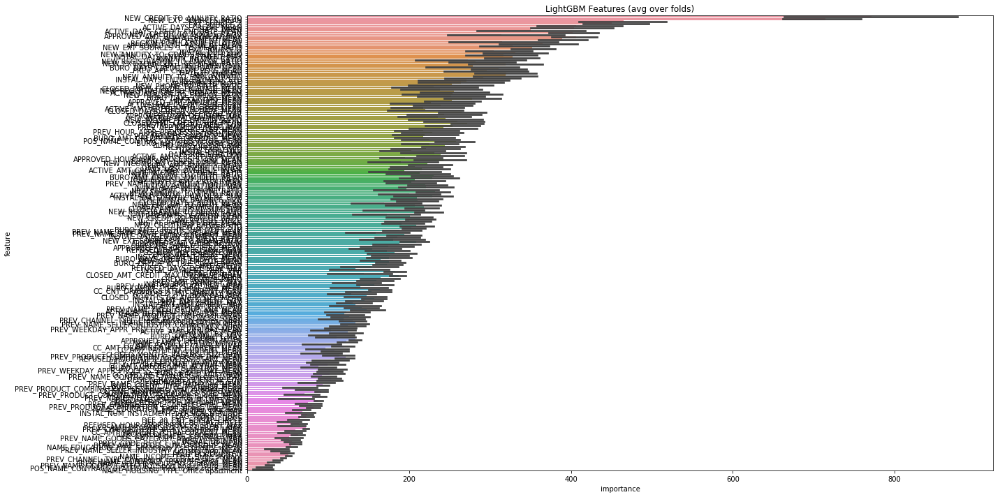

In [130]:
display_importance(feat_h)

In [12]:
#app_train = pd.read_csv('./application_train.csv')
#bureau =  pd.read_csv('./bureau.csv')
#bureau_balance = pd.read_csv("./bureau_balance.csv")
        #print(bureau_balance.shape)

def main(debug = False):
    num_rows = 10000 if debug else None
    #num_rows=None
    with timer("Loading Data"):
        app_train = pd.read_csv('./application_train.csv')
        bureau =  pd.read_csv('./bureau.csv')
        bureau_balance = pd.read_csv("./bureau_balance.csv")
        #print(bureau_balance.shape)
        cc_balance = pd.read_csv('./credit_card_balance.csv')
        #HomeCredit_columns_description = pd.read_csv('./HomeCredit_columns_description.csv')
        installment_pays = pd.read_csv('./installments_payments.csv')
        POS_balance = pd.read_csv('./POS_CASH_balance.csv')
        previous_application = pd.read_csv('./previous_application.csv')
        
    with timer("Processing Application data"):
        df = app_data_feature_engineering(app_train)
    
    with timer("Process bureau and bureau_balance"):
        bureau = bureau_and_balance(bureau,bureau_balance,num_rows)
        print("Bureau df shape:", bureau.shape)
        df = df.merge(bureau, how='left', on='SK_ID_CURR')
        del bureau
        gc.collect()
    with timer("Process previous_applications"):
        prev = previous_applications(previous_application, num_rows)
        print("Previous applications df shape:", prev.shape)
        df = df.merge(prev.reset_index(), how='left', on='SK_ID_CURR')
        del prev
        gc.collect()
    with timer("Process POS-CASH balance"):
        pos = pos_cash(POS_balance, num_rows)
        print("Pos-cash balance df shape:", pos.shape)
        df = df.merge(pos.reset_index(), how='left', on='SK_ID_CURR')
        del pos
        gc.collect()
    with timer("Process installments payments"):
        ins = installments_payments(installment_pays,num_rows)
        print("Installments payments df shape:", ins.shape)
        df = df.merge(ins.reset_index(), how='left', on='SK_ID_CURR')
        del ins
        gc.collect()
    with timer("Process credit card balance"):
        cc = credit_card_balance(cc_balance, num_rows)
        print("Credit card balance df shape:", cc.shape)
        df = df.merge(cc.reset_index(), how='left', on='SK_ID_CURR')
        del cc
        gc.collect()
        return df
    #with timer("Run LightGBM with kfold"):
        #feat_importance = kfold_lightgbm(df, num_folds= 5, stratified= False, debug= debug)

#if __name__ == "__main__":
#    submission_file_name = "submission_kernel02.csv"
 #   with timer("Full model run"):
#        main()

In [13]:
#app_train = pd.read_csv('./application_train.csv')
#bureau =  pd.read_csv('./bureau.csv')
#bureau_balance = pd.read_csv("./bureau_balance.csv")
#credit_card_balance = pd.read_csv('./credit_card_balance.csv')
#HomeCredit_columns_description = pd.read_csv('./HomeCredit_columns_description.csv')
#nstallments_payments = pd.read_csv('./installments_payments.csv')
#POS_CASH_balance = pd.read_csv('./POS_CASH_balance.csv')
#previous_application = pd.read_csv('./previous_application.csv')


df = main()

Loading Data - done in 100s


C:\Anaconda\envs\tensorflow\lib\site-packages\ipykernel\__main__.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda\envs\tensorflow\lib\site-packages\ipykernel\__main__.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda\envs\tensorflow\lib\site-packages\ipykernel\__main__.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#

C:\Anaconda\envs\tensorflow\lib\site-packages\ipykernel\__main__.py:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda\envs\tensorflow\lib\site-packages\ipykernel\__main__.py:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda\envs\tensorflow\lib\site-packages\ipykernel\__main__.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.ht

Processing Application data - done in 12s
Bureau df shape: (305811, 117)
Process bureau and bureau_balance - done in 98s
Previous applications df shape: (338857, 220)
Process previous_applications - done in 42s
Pos-cash balance df shape: (337252, 18)
Process POS-CASH balance - done in 17s
Installments payments df shape: (339587, 36)
Process installments payments - done in 46s
Credit card balance df shape: (103558, 113)
Process credit card balance - done in 22s


In [14]:
df.head()

,SK_ID_CURR,TARGET,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,...,CC_NAME_CONTRACT_STATUS_Sent proposal_VAR,CC_NAME_CONTRACT_STATUS_Signed_MAX,CC_NAME_CONTRACT_STATUS_Signed_MEAN,CC_NAME_CONTRACT_STATUS_Signed_SUM,CC_NAME_CONTRACT_STATUS_Signed_VAR,CC_NAME_CONTRACT_STATUS_nan_MAX,CC_NAME_CONTRACT_STATUS_nan_MEAN,CC_NAME_CONTRACT_STATUS_nan_SUM,CC_NAME_CONTRACT_STATUS_nan_VAR,CC_COUNT
0,100002,1,0,0,0,0,202500.0,406597.5,24700.5,351000.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,100003,0,1,0,1,0,270000.0,1293502.5,35698.5,1129500.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,100004,0,0,1,0,0,67500.0,135000.0,6750.0,135000.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,100006,0,1,0,0,0,135000.0,312682.5,29686.5,297000.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,6.0
4,100007,0,0,0,0,0,121500.0,513000.0,21865.5,513000.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [24]:
df.to_csv("./joined_data_with_feature_from_kageyama_notebook_PLUS_STATUS.csv",index = False)

In [10]:
df = pd.read_csv('./joined_data_with_feature_from_kageyama_notebook_PLUS_STATUS.csv')

In [11]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(df.iloc[:,2:],df['TARGET'], test_size=0.001, stratify=df['TARGET'], random_state=123476)
del df
gc.collect()


211

In [26]:
#params = {"max_depth":3, "n_estimators":560,"nthread":4, "silent":False,"gamma":3, "eta" : 0.1 ,"scale_pos_weight":7}

params = {"max_depth":3, "n_estimators":10000,"nthread":4, "silent":False,"gamma":0, "learning_rate" : 1 ,"scale_pos_weight":7}        
gbm_1 = build_XGB_Model(params,X_train, y_train,X_test,y_test,200)


[0]	validation_0-auc:0.694456
Will train until validation_0-auc hasn't improved in 200 rounds.
[1]	validation_0-auc:0.71687
[2]	validation_0-auc:0.730393
[3]	validation_0-auc:0.737176
[4]	validation_0-auc:0.742969
[5]	validation_0-auc:0.746624
[6]	validation_0-auc:0.750469
[7]	validation_0-auc:0.752653
[8]	validation_0-auc:0.754377
[9]	validation_0-auc:0.757183
[10]	validation_0-auc:0.758028
[11]	validation_0-auc:0.757791
[12]	validation_0-auc:0.759322
[13]	validation_0-auc:0.759781
[14]	validation_0-auc:0.761194
[15]	validation_0-auc:0.762229
[16]	validation_0-auc:0.762696
[17]	validation_0-auc:0.765305
[18]	validation_0-auc:0.764766
[19]	validation_0-auc:0.76534
[20]	validation_0-auc:0.765141
[21]	validation_0-auc:0.764689
[22]	validation_0-auc:0.764833
[23]	validation_0-auc:0.76469
[24]	validation_0-auc:0.765037
[25]	validation_0-auc:0.765875
[26]	validation_0-auc:0.766241
[27]	validation_0-auc:0.766093
[28]	validation_0-auc:0.766106
[29]	validation_0-auc:0.765794
[30]	validation_0-

KeyboardInterrupt: 

In [189]:
X_test.shape

(308, 669)

In [164]:
featurs, models = kfold_lightgbm_2(X_train,y_train, lam = 0.1, num_folds=5, stratified = False, debug= True)

Starting LightGBM. Train shape: (246005, 669) 
[1]	training's auc: 0.727699	valid_1's auc: 0.715175
Training until validation scores don't improve for 300 rounds.
[2]	training's auc: 0.72945	valid_1's auc: 0.716668
[3]	training's auc: 0.735296	valid_1's auc: 0.720585
[4]	training's auc: 0.73903	valid_1's auc: 0.722785
[5]	training's auc: 0.739793	valid_1's auc: 0.723145
[6]	training's auc: 0.739854	valid_1's auc: 0.722801
[7]	training's auc: 0.74261	valid_1's auc: 0.726264
[8]	training's auc: 0.74316	valid_1's auc: 0.726267
[9]	training's auc: 0.743736	valid_1's auc: 0.726446
[10]	training's auc: 0.744054	valid_1's auc: 0.726636
[11]	training's auc: 0.744422	valid_1's auc: 0.726813
[12]	training's auc: 0.744692	valid_1's auc: 0.726834
[13]	training's auc: 0.745604	valid_1's auc: 0.727111
[14]	training's auc: 0.74616	valid_1's auc: 0.727152
[15]	training's auc: 0.746579	valid_1's auc: 0.727183
[16]	training's auc: 0.747081	valid_1's auc: 0.727679
[17]	training's auc: 0.747813	valid_1's 

[151]	training's auc: 0.792076	valid_1's auc: 0.759415
[152]	training's auc: 0.792306	valid_1's auc: 0.759559
[153]	training's auc: 0.792556	valid_1's auc: 0.759699
[154]	training's auc: 0.79282	valid_1's auc: 0.759878
[155]	training's auc: 0.793022	valid_1's auc: 0.760023
[156]	training's auc: 0.793251	valid_1's auc: 0.760175
[157]	training's auc: 0.793471	valid_1's auc: 0.7603
[158]	training's auc: 0.79368	valid_1's auc: 0.760407
[159]	training's auc: 0.793873	valid_1's auc: 0.760509
[160]	training's auc: 0.7941	valid_1's auc: 0.760629
[161]	training's auc: 0.794332	valid_1's auc: 0.760797
[162]	training's auc: 0.794593	valid_1's auc: 0.760944
[163]	training's auc: 0.794813	valid_1's auc: 0.761096
[164]	training's auc: 0.795009	valid_1's auc: 0.761207
[165]	training's auc: 0.795234	valid_1's auc: 0.761356
[166]	training's auc: 0.795441	valid_1's auc: 0.761507
[167]	training's auc: 0.795632	valid_1's auc: 0.761612
[168]	training's auc: 0.795852	valid_1's auc: 0.761734
[169]	training's

[301]	training's auc: 0.815785	valid_1's auc: 0.770865
[302]	training's auc: 0.815903	valid_1's auc: 0.770903
[303]	training's auc: 0.81604	valid_1's auc: 0.770955
[304]	training's auc: 0.816149	valid_1's auc: 0.770983
[305]	training's auc: 0.816282	valid_1's auc: 0.771031
[306]	training's auc: 0.816411	valid_1's auc: 0.771072
[307]	training's auc: 0.816548	valid_1's auc: 0.771122
[308]	training's auc: 0.816661	valid_1's auc: 0.77117
[309]	training's auc: 0.816783	valid_1's auc: 0.771204
[310]	training's auc: 0.816902	valid_1's auc: 0.771223
[311]	training's auc: 0.817022	valid_1's auc: 0.77127
[312]	training's auc: 0.817149	valid_1's auc: 0.771313
[313]	training's auc: 0.81727	valid_1's auc: 0.771374
[314]	training's auc: 0.817368	valid_1's auc: 0.771407
[315]	training's auc: 0.817477	valid_1's auc: 0.771426
[316]	training's auc: 0.817596	valid_1's auc: 0.771474
[317]	training's auc: 0.81774	valid_1's auc: 0.771544
[318]	training's auc: 0.817849	valid_1's auc: 0.771592
[319]	training'

[451]	training's auc: 0.831582	valid_1's auc: 0.775358
[452]	training's auc: 0.831659	valid_1's auc: 0.775367
[453]	training's auc: 0.831768	valid_1's auc: 0.775366
[454]	training's auc: 0.83187	valid_1's auc: 0.775414
[455]	training's auc: 0.831982	valid_1's auc: 0.775415
[456]	training's auc: 0.832049	valid_1's auc: 0.775421
[457]	training's auc: 0.832128	valid_1's auc: 0.775435
[458]	training's auc: 0.832222	valid_1's auc: 0.775471
[459]	training's auc: 0.832327	valid_1's auc: 0.7755
[460]	training's auc: 0.832441	valid_1's auc: 0.775509
[461]	training's auc: 0.832536	valid_1's auc: 0.775555
[462]	training's auc: 0.832634	valid_1's auc: 0.775563
[463]	training's auc: 0.83268	valid_1's auc: 0.775585
[464]	training's auc: 0.832799	valid_1's auc: 0.775609
[465]	training's auc: 0.832899	valid_1's auc: 0.7756
[466]	training's auc: 0.832982	valid_1's auc: 0.775632
[467]	training's auc: 0.833063	valid_1's auc: 0.775639
[468]	training's auc: 0.83316	valid_1's auc: 0.775635
[469]	training's 

[601]	training's auc: 0.844769	valid_1's auc: 0.778021
[602]	training's auc: 0.84485	valid_1's auc: 0.778064
[603]	training's auc: 0.844938	valid_1's auc: 0.778076
[604]	training's auc: 0.845038	valid_1's auc: 0.778104
[605]	training's auc: 0.845131	valid_1's auc: 0.778113
[606]	training's auc: 0.84519	valid_1's auc: 0.778108
[607]	training's auc: 0.845268	valid_1's auc: 0.778134
[608]	training's auc: 0.845329	valid_1's auc: 0.778146
[609]	training's auc: 0.845387	valid_1's auc: 0.77814
[610]	training's auc: 0.84542	valid_1's auc: 0.778153
[611]	training's auc: 0.845502	valid_1's auc: 0.778157
[612]	training's auc: 0.845582	valid_1's auc: 0.778157
[613]	training's auc: 0.845679	valid_1's auc: 0.778159
[614]	training's auc: 0.845714	valid_1's auc: 0.778171
[615]	training's auc: 0.845786	valid_1's auc: 0.778187
[616]	training's auc: 0.845868	valid_1's auc: 0.778176
[617]	training's auc: 0.845939	valid_1's auc: 0.778204
[618]	training's auc: 0.846011	valid_1's auc: 0.778208
[619]	training

[751]	training's auc: 0.855892	valid_1's auc: 0.779688
[752]	training's auc: 0.855937	valid_1's auc: 0.779683
[753]	training's auc: 0.856011	valid_1's auc: 0.779682
[754]	training's auc: 0.856078	valid_1's auc: 0.779669
[755]	training's auc: 0.856144	valid_1's auc: 0.779679
[756]	training's auc: 0.856223	valid_1's auc: 0.77967
[757]	training's auc: 0.856313	valid_1's auc: 0.77969
[758]	training's auc: 0.856379	valid_1's auc: 0.779681
[759]	training's auc: 0.856458	valid_1's auc: 0.779684
[760]	training's auc: 0.856527	valid_1's auc: 0.779696
[761]	training's auc: 0.856593	valid_1's auc: 0.7797
[762]	training's auc: 0.856626	valid_1's auc: 0.779704
[763]	training's auc: 0.856679	valid_1's auc: 0.779713
[764]	training's auc: 0.856755	valid_1's auc: 0.779707
[765]	training's auc: 0.856799	valid_1's auc: 0.779692
[766]	training's auc: 0.856891	valid_1's auc: 0.779698
[767]	training's auc: 0.856949	valid_1's auc: 0.779708
[768]	training's auc: 0.857004	valid_1's auc: 0.779747
[769]	training

[901]	training's auc: 0.865287	valid_1's auc: 0.780715
[902]	training's auc: 0.865315	valid_1's auc: 0.780722
[903]	training's auc: 0.86535	valid_1's auc: 0.780728
[904]	training's auc: 0.865424	valid_1's auc: 0.780722
[905]	training's auc: 0.865498	valid_1's auc: 0.780734
[906]	training's auc: 0.865566	valid_1's auc: 0.780744
[907]	training's auc: 0.865641	valid_1's auc: 0.780747
[908]	training's auc: 0.865729	valid_1's auc: 0.780759
[909]	training's auc: 0.865797	valid_1's auc: 0.780775
[910]	training's auc: 0.86587	valid_1's auc: 0.780761
[911]	training's auc: 0.865935	valid_1's auc: 0.780767
[912]	training's auc: 0.865945	valid_1's auc: 0.780759
[913]	training's auc: 0.866009	valid_1's auc: 0.780756
[914]	training's auc: 0.866073	valid_1's auc: 0.780774
[915]	training's auc: 0.866132	valid_1's auc: 0.780761
[916]	training's auc: 0.86619	valid_1's auc: 0.780776
[917]	training's auc: 0.866245	valid_1's auc: 0.780775
[918]	training's auc: 0.866278	valid_1's auc: 0.780767
[919]	trainin

[1050]	training's auc: 0.873854	valid_1's auc: 0.781148
[1051]	training's auc: 0.873933	valid_1's auc: 0.78115
[1052]	training's auc: 0.873982	valid_1's auc: 0.781139
[1053]	training's auc: 0.874022	valid_1's auc: 0.781143
[1054]	training's auc: 0.874092	valid_1's auc: 0.781161
[1055]	training's auc: 0.87416	valid_1's auc: 0.781168
[1056]	training's auc: 0.874226	valid_1's auc: 0.781165
[1057]	training's auc: 0.874294	valid_1's auc: 0.781154
[1058]	training's auc: 0.874332	valid_1's auc: 0.781162
[1059]	training's auc: 0.874393	valid_1's auc: 0.78117
[1060]	training's auc: 0.874434	valid_1's auc: 0.781173
[1061]	training's auc: 0.874476	valid_1's auc: 0.781182
[1062]	training's auc: 0.874534	valid_1's auc: 0.781181
[1063]	training's auc: 0.874552	valid_1's auc: 0.781179
[1064]	training's auc: 0.874598	valid_1's auc: 0.781182
[1065]	training's auc: 0.874647	valid_1's auc: 0.78119
[1066]	training's auc: 0.874701	valid_1's auc: 0.781192
[1067]	training's auc: 0.874768	valid_1's auc: 0.781

[1197]	training's auc: 0.881724	valid_1's auc: 0.781555
[1198]	training's auc: 0.881774	valid_1's auc: 0.781558
[1199]	training's auc: 0.881827	valid_1's auc: 0.781549
[1200]	training's auc: 0.881849	valid_1's auc: 0.781545
[1201]	training's auc: 0.88191	valid_1's auc: 0.781545
[1202]	training's auc: 0.881983	valid_1's auc: 0.781554
[1203]	training's auc: 0.882015	valid_1's auc: 0.781547
[1204]	training's auc: 0.882073	valid_1's auc: 0.781547
[1205]	training's auc: 0.882127	valid_1's auc: 0.781535
[1206]	training's auc: 0.882181	valid_1's auc: 0.781528
[1207]	training's auc: 0.882225	valid_1's auc: 0.781541
[1208]	training's auc: 0.882247	valid_1's auc: 0.781545
[1209]	training's auc: 0.882308	valid_1's auc: 0.78155
[1210]	training's auc: 0.882353	valid_1's auc: 0.781545
[1211]	training's auc: 0.882415	valid_1's auc: 0.78154
[1212]	training's auc: 0.882476	valid_1's auc: 0.781553
[1213]	training's auc: 0.882523	valid_1's auc: 0.781548
[1214]	training's auc: 0.882577	valid_1's auc: 0.78

[1344]	training's auc: 0.888989	valid_1's auc: 0.781459
[1345]	training's auc: 0.889054	valid_1's auc: 0.781473
[1346]	training's auc: 0.889103	valid_1's auc: 0.781486
[1347]	training's auc: 0.889172	valid_1's auc: 0.78148
[1348]	training's auc: 0.889207	valid_1's auc: 0.781475
[1349]	training's auc: 0.889261	valid_1's auc: 0.781466
[1350]	training's auc: 0.889311	valid_1's auc: 0.781469
[1351]	training's auc: 0.88936	valid_1's auc: 0.781475
[1352]	training's auc: 0.889433	valid_1's auc: 0.781497
[1353]	training's auc: 0.889504	valid_1's auc: 0.781493
[1354]	training's auc: 0.889545	valid_1's auc: 0.781499
[1355]	training's auc: 0.88959	valid_1's auc: 0.781498
[1356]	training's auc: 0.889647	valid_1's auc: 0.781482
[1357]	training's auc: 0.889716	valid_1's auc: 0.781501
[1358]	training's auc: 0.889771	valid_1's auc: 0.781498
[1359]	training's auc: 0.889827	valid_1's auc: 0.78152
[1360]	training's auc: 0.88987	valid_1's auc: 0.781514
[1361]	training's auc: 0.889924	valid_1's auc: 0.7815

[1491]	training's auc: 0.895946	valid_1's auc: 0.7816
[1492]	training's auc: 0.89599	valid_1's auc: 0.781594
[1493]	training's auc: 0.896022	valid_1's auc: 0.781598
[1494]	training's auc: 0.896083	valid_1's auc: 0.781609
[1495]	training's auc: 0.896113	valid_1's auc: 0.781607
[1496]	training's auc: 0.896127	valid_1's auc: 0.781605
[1497]	training's auc: 0.896186	valid_1's auc: 0.781616
[1498]	training's auc: 0.896237	valid_1's auc: 0.78162
[1499]	training's auc: 0.896279	valid_1's auc: 0.781621
[1500]	training's auc: 0.896313	valid_1's auc: 0.7816
[1501]	training's auc: 0.896372	valid_1's auc: 0.781592
[1502]	training's auc: 0.896428	valid_1's auc: 0.781607
[1503]	training's auc: 0.896484	valid_1's auc: 0.781609
[1504]	training's auc: 0.896516	valid_1's auc: 0.781624
[1505]	training's auc: 0.896547	valid_1's auc: 0.781627
[1506]	training's auc: 0.896593	valid_1's auc: 0.781626
[1507]	training's auc: 0.896641	valid_1's auc: 0.781622
[1508]	training's auc: 0.8967	valid_1's auc: 0.781617


[1638]	training's auc: 0.902339	valid_1's auc: 0.781512
[1639]	training's auc: 0.902388	valid_1's auc: 0.781502
[1640]	training's auc: 0.902441	valid_1's auc: 0.781501
[1641]	training's auc: 0.902482	valid_1's auc: 0.781515
[1642]	training's auc: 0.902535	valid_1's auc: 0.781521
[1643]	training's auc: 0.902579	valid_1's auc: 0.781544
[1644]	training's auc: 0.902619	valid_1's auc: 0.781557
[1645]	training's auc: 0.90266	valid_1's auc: 0.781547
[1646]	training's auc: 0.902726	valid_1's auc: 0.781553
[1647]	training's auc: 0.902764	valid_1's auc: 0.781533
[1648]	training's auc: 0.902787	valid_1's auc: 0.78154
[1649]	training's auc: 0.902819	valid_1's auc: 0.781535
[1650]	training's auc: 0.90284	valid_1's auc: 0.781534
[1651]	training's auc: 0.902897	valid_1's auc: 0.78154
[1652]	training's auc: 0.902933	valid_1's auc: 0.781531
[1653]	training's auc: 0.902983	valid_1's auc: 0.781523
[1654]	training's auc: 0.903011	valid_1's auc: 0.781517
[1655]	training's auc: 0.903071	valid_1's auc: 0.781

[1785]	training's auc: 0.908458	valid_1's auc: 0.781406
[1786]	training's auc: 0.908493	valid_1's auc: 0.781405
[1787]	training's auc: 0.908554	valid_1's auc: 0.781418
[1788]	training's auc: 0.90861	valid_1's auc: 0.781423
[1789]	training's auc: 0.908658	valid_1's auc: 0.781422
[1790]	training's auc: 0.908679	valid_1's auc: 0.781419
[1791]	training's auc: 0.908729	valid_1's auc: 0.781412
[1792]	training's auc: 0.908742	valid_1's auc: 0.781419
[1793]	training's auc: 0.908787	valid_1's auc: 0.78143
[1794]	training's auc: 0.908822	valid_1's auc: 0.781428
[1795]	training's auc: 0.90886	valid_1's auc: 0.781434
[1796]	training's auc: 0.908877	valid_1's auc: 0.781431
[1797]	training's auc: 0.908923	valid_1's auc: 0.781423
[1798]	training's auc: 0.908972	valid_1's auc: 0.781424
[1799]	training's auc: 0.909013	valid_1's auc: 0.781412
[1800]	training's auc: 0.909072	valid_1's auc: 0.781412
[1801]	training's auc: 0.909082	valid_1's auc: 0.781406
[1802]	training's auc: 0.909114	valid_1's auc: 0.78

[121]	training's auc: 0.782289	valid_1's auc: 0.761955
[122]	training's auc: 0.782549	valid_1's auc: 0.762124
[123]	training's auc: 0.782845	valid_1's auc: 0.762285
[124]	training's auc: 0.783154	valid_1's auc: 0.762501
[125]	training's auc: 0.783393	valid_1's auc: 0.762734
[126]	training's auc: 0.783659	valid_1's auc: 0.762923
[127]	training's auc: 0.78391	valid_1's auc: 0.763117
[128]	training's auc: 0.784154	valid_1's auc: 0.763351
[129]	training's auc: 0.784386	valid_1's auc: 0.763547
[130]	training's auc: 0.784653	valid_1's auc: 0.763677
[131]	training's auc: 0.784919	valid_1's auc: 0.763821
[132]	training's auc: 0.785166	valid_1's auc: 0.764021
[133]	training's auc: 0.785454	valid_1's auc: 0.76426
[134]	training's auc: 0.785664	valid_1's auc: 0.764422
[135]	training's auc: 0.785929	valid_1's auc: 0.764566
[136]	training's auc: 0.786208	valid_1's auc: 0.764769
[137]	training's auc: 0.786415	valid_1's auc: 0.764937
[138]	training's auc: 0.786662	valid_1's auc: 0.76506
[139]	trainin

[271]	training's auc: 0.8101	valid_1's auc: 0.777754
[272]	training's auc: 0.810231	valid_1's auc: 0.777774
[273]	training's auc: 0.810361	valid_1's auc: 0.777802
[274]	training's auc: 0.810494	valid_1's auc: 0.777845
[275]	training's auc: 0.810625	valid_1's auc: 0.777883
[276]	training's auc: 0.810757	valid_1's auc: 0.777939
[277]	training's auc: 0.810881	valid_1's auc: 0.778004
[278]	training's auc: 0.811	valid_1's auc: 0.778062
[279]	training's auc: 0.811119	valid_1's auc: 0.77811
[280]	training's auc: 0.811241	valid_1's auc: 0.778148
[281]	training's auc: 0.811381	valid_1's auc: 0.778167
[282]	training's auc: 0.811509	valid_1's auc: 0.778204
[283]	training's auc: 0.811645	valid_1's auc: 0.778244
[284]	training's auc: 0.811776	valid_1's auc: 0.778316
[285]	training's auc: 0.811902	valid_1's auc: 0.778347
[286]	training's auc: 0.812037	valid_1's auc: 0.778431
[287]	training's auc: 0.812158	valid_1's auc: 0.778478
[288]	training's auc: 0.81224	valid_1's auc: 0.778484
[289]	training's 

[421]	training's auc: 0.826778	valid_1's auc: 0.782711
[422]	training's auc: 0.826892	valid_1's auc: 0.782731
[423]	training's auc: 0.826988	valid_1's auc: 0.782738
[424]	training's auc: 0.827066	valid_1's auc: 0.78275
[425]	training's auc: 0.827151	valid_1's auc: 0.782755
[426]	training's auc: 0.827237	valid_1's auc: 0.782772
[427]	training's auc: 0.827339	valid_1's auc: 0.782758
[428]	training's auc: 0.827426	valid_1's auc: 0.782798
[429]	training's auc: 0.82748	valid_1's auc: 0.782817
[430]	training's auc: 0.827574	valid_1's auc: 0.782852
[431]	training's auc: 0.82768	valid_1's auc: 0.782878
[432]	training's auc: 0.827754	valid_1's auc: 0.782897
[433]	training's auc: 0.827858	valid_1's auc: 0.782935
[434]	training's auc: 0.827959	valid_1's auc: 0.782981
[435]	training's auc: 0.828079	valid_1's auc: 0.783016
[436]	training's auc: 0.828163	valid_1's auc: 0.783032
[437]	training's auc: 0.828244	valid_1's auc: 0.783026
[438]	training's auc: 0.828348	valid_1's auc: 0.783053
[439]	trainin

[571]	training's auc: 0.839899	valid_1's auc: 0.784994
[572]	training's auc: 0.839985	valid_1's auc: 0.785012
[573]	training's auc: 0.840041	valid_1's auc: 0.785032
[574]	training's auc: 0.840112	valid_1's auc: 0.785031
[575]	training's auc: 0.840199	valid_1's auc: 0.785028
[576]	training's auc: 0.840275	valid_1's auc: 0.785023
[577]	training's auc: 0.840348	valid_1's auc: 0.785039
[578]	training's auc: 0.84044	valid_1's auc: 0.785046
[579]	training's auc: 0.840549	valid_1's auc: 0.785052
[580]	training's auc: 0.840646	valid_1's auc: 0.785086
[581]	training's auc: 0.840735	valid_1's auc: 0.785077
[582]	training's auc: 0.840818	valid_1's auc: 0.78506
[583]	training's auc: 0.840903	valid_1's auc: 0.785078
[584]	training's auc: 0.840991	valid_1's auc: 0.785115
[585]	training's auc: 0.841065	valid_1's auc: 0.785117
[586]	training's auc: 0.841126	valid_1's auc: 0.785129
[587]	training's auc: 0.841215	valid_1's auc: 0.785151
[588]	training's auc: 0.8413	valid_1's auc: 0.78519
[589]	training'

[721]	training's auc: 0.851157	valid_1's auc: 0.786238
[722]	training's auc: 0.851232	valid_1's auc: 0.786239
[723]	training's auc: 0.851295	valid_1's auc: 0.78624
[724]	training's auc: 0.851339	valid_1's auc: 0.78625
[725]	training's auc: 0.851463	valid_1's auc: 0.786285
[726]	training's auc: 0.851541	valid_1's auc: 0.786276
[727]	training's auc: 0.851614	valid_1's auc: 0.786281
[728]	training's auc: 0.851679	valid_1's auc: 0.786303
[729]	training's auc: 0.851727	valid_1's auc: 0.786323
[730]	training's auc: 0.851761	valid_1's auc: 0.786318
[731]	training's auc: 0.851843	valid_1's auc: 0.786306
[732]	training's auc: 0.851933	valid_1's auc: 0.786336
[733]	training's auc: 0.85201	valid_1's auc: 0.786338
[734]	training's auc: 0.852106	valid_1's auc: 0.786349
[735]	training's auc: 0.852173	valid_1's auc: 0.786364
[736]	training's auc: 0.852239	valid_1's auc: 0.786361
[737]	training's auc: 0.852318	valid_1's auc: 0.786364
[738]	training's auc: 0.852393	valid_1's auc: 0.786391
[739]	trainin

[871]	training's auc: 0.861209	valid_1's auc: 0.786906
[872]	training's auc: 0.861251	valid_1's auc: 0.786892
[873]	training's auc: 0.861327	valid_1's auc: 0.786867
[874]	training's auc: 0.861365	valid_1's auc: 0.786863
[875]	training's auc: 0.861435	valid_1's auc: 0.786893
[876]	training's auc: 0.861493	valid_1's auc: 0.786889
[877]	training's auc: 0.86156	valid_1's auc: 0.786908
[878]	training's auc: 0.861627	valid_1's auc: 0.786915
[879]	training's auc: 0.861696	valid_1's auc: 0.786923
[880]	training's auc: 0.86178	valid_1's auc: 0.786925
[881]	training's auc: 0.861836	valid_1's auc: 0.78692
[882]	training's auc: 0.861894	valid_1's auc: 0.78693
[883]	training's auc: 0.861977	valid_1's auc: 0.786953
[884]	training's auc: 0.861999	valid_1's auc: 0.786953
[885]	training's auc: 0.862108	valid_1's auc: 0.786969
[886]	training's auc: 0.862167	valid_1's auc: 0.786959
[887]	training's auc: 0.862232	valid_1's auc: 0.786961
[888]	training's auc: 0.862307	valid_1's auc: 0.786959
[889]	training

[1021]	training's auc: 0.870426	valid_1's auc: 0.787339
[1022]	training's auc: 0.87049	valid_1's auc: 0.787349
[1023]	training's auc: 0.870546	valid_1's auc: 0.787359
[1024]	training's auc: 0.870615	valid_1's auc: 0.78738
[1025]	training's auc: 0.870658	valid_1's auc: 0.787376
[1026]	training's auc: 0.870719	valid_1's auc: 0.787399
[1027]	training's auc: 0.8708	valid_1's auc: 0.787406
[1028]	training's auc: 0.870827	valid_1's auc: 0.787393
[1029]	training's auc: 0.870894	valid_1's auc: 0.787418
[1030]	training's auc: 0.870942	valid_1's auc: 0.787419
[1031]	training's auc: 0.870994	valid_1's auc: 0.787411
[1032]	training's auc: 0.871038	valid_1's auc: 0.787418
[1033]	training's auc: 0.871103	valid_1's auc: 0.787419
[1034]	training's auc: 0.871164	valid_1's auc: 0.787441
[1035]	training's auc: 0.8712	valid_1's auc: 0.787437
[1036]	training's auc: 0.871235	valid_1's auc: 0.787458
[1037]	training's auc: 0.871309	valid_1's auc: 0.787471
[1038]	training's auc: 0.871382	valid_1's auc: 0.78746

[1168]	training's auc: 0.87845	valid_1's auc: 0.787588
[1169]	training's auc: 0.878485	valid_1's auc: 0.787598
[1170]	training's auc: 0.878524	valid_1's auc: 0.787593
[1171]	training's auc: 0.878616	valid_1's auc: 0.787591
[1172]	training's auc: 0.878646	valid_1's auc: 0.78759
[1173]	training's auc: 0.878707	valid_1's auc: 0.787602
[1174]	training's auc: 0.878727	valid_1's auc: 0.787602
[1175]	training's auc: 0.878771	valid_1's auc: 0.787607
[1176]	training's auc: 0.878846	valid_1's auc: 0.787604
[1177]	training's auc: 0.878875	valid_1's auc: 0.787608
[1178]	training's auc: 0.87889	valid_1's auc: 0.787609
[1179]	training's auc: 0.878961	valid_1's auc: 0.787609
[1180]	training's auc: 0.878992	valid_1's auc: 0.787605
[1181]	training's auc: 0.879056	valid_1's auc: 0.787578
[1182]	training's auc: 0.879101	valid_1's auc: 0.787575
[1183]	training's auc: 0.879134	valid_1's auc: 0.787566
[1184]	training's auc: 0.879196	valid_1's auc: 0.787598
[1185]	training's auc: 0.879242	valid_1's auc: 0.78

[1315]	training's auc: 0.885978	valid_1's auc: 0.787508
[1316]	training's auc: 0.886037	valid_1's auc: 0.787496
[1317]	training's auc: 0.886109	valid_1's auc: 0.787489
[1318]	training's auc: 0.886159	valid_1's auc: 0.787485
[1319]	training's auc: 0.886186	valid_1's auc: 0.787482
[1320]	training's auc: 0.886205	valid_1's auc: 0.787485
[1321]	training's auc: 0.886254	valid_1's auc: 0.787507
[1322]	training's auc: 0.886269	valid_1's auc: 0.787503
[1323]	training's auc: 0.88632	valid_1's auc: 0.787506
[1324]	training's auc: 0.88637	valid_1's auc: 0.787515
[1325]	training's auc: 0.886425	valid_1's auc: 0.787498
[1326]	training's auc: 0.886501	valid_1's auc: 0.787505
[1327]	training's auc: 0.886557	valid_1's auc: 0.787522
[1328]	training's auc: 0.886599	valid_1's auc: 0.787542
[1329]	training's auc: 0.886674	valid_1's auc: 0.787553
[1330]	training's auc: 0.886731	valid_1's auc: 0.787552
[1331]	training's auc: 0.886793	valid_1's auc: 0.787549
[1332]	training's auc: 0.88685	valid_1's auc: 0.78

[24]	training's auc: 0.750707	valid_1's auc: 0.741925
[25]	training's auc: 0.751177	valid_1's auc: 0.742282
[26]	training's auc: 0.751535	valid_1's auc: 0.742548
[27]	training's auc: 0.751863	valid_1's auc: 0.742582
[28]	training's auc: 0.752306	valid_1's auc: 0.742967
[29]	training's auc: 0.752728	valid_1's auc: 0.743257
[30]	training's auc: 0.753265	valid_1's auc: 0.743708
[31]	training's auc: 0.753531	valid_1's auc: 0.743967
[32]	training's auc: 0.754099	valid_1's auc: 0.744352
[33]	training's auc: 0.754716	valid_1's auc: 0.744878
[34]	training's auc: 0.755189	valid_1's auc: 0.745236
[35]	training's auc: 0.755539	valid_1's auc: 0.745428
[36]	training's auc: 0.755916	valid_1's auc: 0.745675
[37]	training's auc: 0.756253	valid_1's auc: 0.745925
[38]	training's auc: 0.756633	valid_1's auc: 0.746159
[39]	training's auc: 0.756942	valid_1's auc: 0.74626
[40]	training's auc: 0.757217	valid_1's auc: 0.746506
[41]	training's auc: 0.757476	valid_1's auc: 0.746711
[42]	training's auc: 0.757806

[175]	training's auc: 0.795323	valid_1's auc: 0.770512
[176]	training's auc: 0.795561	valid_1's auc: 0.770656
[177]	training's auc: 0.795741	valid_1's auc: 0.770748
[178]	training's auc: 0.795923	valid_1's auc: 0.770841
[179]	training's auc: 0.796118	valid_1's auc: 0.770912
[180]	training's auc: 0.796322	valid_1's auc: 0.771039
[181]	training's auc: 0.796485	valid_1's auc: 0.771128
[182]	training's auc: 0.796661	valid_1's auc: 0.771231
[183]	training's auc: 0.796844	valid_1's auc: 0.771324
[184]	training's auc: 0.797051	valid_1's auc: 0.771447
[185]	training's auc: 0.797221	valid_1's auc: 0.771524
[186]	training's auc: 0.797387	valid_1's auc: 0.771593
[187]	training's auc: 0.797555	valid_1's auc: 0.771683
[188]	training's auc: 0.797726	valid_1's auc: 0.7718
[189]	training's auc: 0.797903	valid_1's auc: 0.771911
[190]	training's auc: 0.798058	valid_1's auc: 0.771993
[191]	training's auc: 0.798249	valid_1's auc: 0.772111
[192]	training's auc: 0.798437	valid_1's auc: 0.77218
[193]	trainin

[325]	training's auc: 0.817024	valid_1's auc: 0.78025
[326]	training's auc: 0.81714	valid_1's auc: 0.780289
[327]	training's auc: 0.817244	valid_1's auc: 0.780316
[328]	training's auc: 0.817359	valid_1's auc: 0.780365
[329]	training's auc: 0.817478	valid_1's auc: 0.780387
[330]	training's auc: 0.817596	valid_1's auc: 0.780452
[331]	training's auc: 0.817681	valid_1's auc: 0.780448
[332]	training's auc: 0.817795	valid_1's auc: 0.780486
[333]	training's auc: 0.817898	valid_1's auc: 0.780534
[334]	training's auc: 0.818022	valid_1's auc: 0.780595
[335]	training's auc: 0.818138	valid_1's auc: 0.78063
[336]	training's auc: 0.818243	valid_1's auc: 0.780678
[337]	training's auc: 0.818358	valid_1's auc: 0.780696
[338]	training's auc: 0.818486	valid_1's auc: 0.780786
[339]	training's auc: 0.81861	valid_1's auc: 0.780804
[340]	training's auc: 0.818715	valid_1's auc: 0.780859
[341]	training's auc: 0.81883	valid_1's auc: 0.780871
[342]	training's auc: 0.818938	valid_1's auc: 0.780872
[343]	training'

[475]	training's auc: 0.831961	valid_1's auc: 0.783794
[476]	training's auc: 0.832063	valid_1's auc: 0.78381
[477]	training's auc: 0.832186	valid_1's auc: 0.783837
[478]	training's auc: 0.832298	valid_1's auc: 0.783853
[479]	training's auc: 0.832387	valid_1's auc: 0.783908
[480]	training's auc: 0.832467	valid_1's auc: 0.783906
[481]	training's auc: 0.832546	valid_1's auc: 0.783938
[482]	training's auc: 0.832646	valid_1's auc: 0.783953
[483]	training's auc: 0.832749	valid_1's auc: 0.783976
[484]	training's auc: 0.832837	valid_1's auc: 0.784019
[485]	training's auc: 0.832928	valid_1's auc: 0.784034
[486]	training's auc: 0.832961	valid_1's auc: 0.784037
[487]	training's auc: 0.833048	valid_1's auc: 0.78406
[488]	training's auc: 0.833139	valid_1's auc: 0.784056
[489]	training's auc: 0.833184	valid_1's auc: 0.784073
[490]	training's auc: 0.833274	valid_1's auc: 0.784072
[491]	training's auc: 0.833362	valid_1's auc: 0.784114
[492]	training's auc: 0.833448	valid_1's auc: 0.784104
[493]	traini

[625]	training's auc: 0.844208	valid_1's auc: 0.785668
[626]	training's auc: 0.844295	valid_1's auc: 0.785681
[627]	training's auc: 0.844368	valid_1's auc: 0.78571
[628]	training's auc: 0.844467	valid_1's auc: 0.785757
[629]	training's auc: 0.844525	valid_1's auc: 0.785744
[630]	training's auc: 0.844593	valid_1's auc: 0.785746
[631]	training's auc: 0.844662	valid_1's auc: 0.785759
[632]	training's auc: 0.844733	valid_1's auc: 0.785787
[633]	training's auc: 0.844835	valid_1's auc: 0.785815
[634]	training's auc: 0.844918	valid_1's auc: 0.785814
[635]	training's auc: 0.845008	valid_1's auc: 0.785804
[636]	training's auc: 0.845111	valid_1's auc: 0.785805
[637]	training's auc: 0.845177	valid_1's auc: 0.785808
[638]	training's auc: 0.845227	valid_1's auc: 0.785825
[639]	training's auc: 0.845276	valid_1's auc: 0.785841
[640]	training's auc: 0.845376	valid_1's auc: 0.785882
[641]	training's auc: 0.845442	valid_1's auc: 0.785886
[642]	training's auc: 0.84552	valid_1's auc: 0.785891
[643]	traini

[775]	training's auc: 0.855102	valid_1's auc: 0.786775
[776]	training's auc: 0.855177	valid_1's auc: 0.786781
[777]	training's auc: 0.855264	valid_1's auc: 0.786795
[778]	training's auc: 0.8553	valid_1's auc: 0.786808
[779]	training's auc: 0.855373	valid_1's auc: 0.786822
[780]	training's auc: 0.855442	valid_1's auc: 0.786817
[781]	training's auc: 0.855519	valid_1's auc: 0.786835
[782]	training's auc: 0.855598	valid_1's auc: 0.786827
[783]	training's auc: 0.85567	valid_1's auc: 0.786834
[784]	training's auc: 0.855696	valid_1's auc: 0.78685
[785]	training's auc: 0.855739	valid_1's auc: 0.786866
[786]	training's auc: 0.855824	valid_1's auc: 0.786895
[787]	training's auc: 0.85591	valid_1's auc: 0.78692
[788]	training's auc: 0.85596	valid_1's auc: 0.786903
[789]	training's auc: 0.855969	valid_1's auc: 0.786908
[790]	training's auc: 0.856045	valid_1's auc: 0.78692
[791]	training's auc: 0.856122	valid_1's auc: 0.786941
[792]	training's auc: 0.85617	valid_1's auc: 0.786947
[793]	training's au

[925]	training's auc: 0.864205	valid_1's auc: 0.787483
[926]	training's auc: 0.864279	valid_1's auc: 0.787484
[927]	training's auc: 0.864346	valid_1's auc: 0.787502
[928]	training's auc: 0.864418	valid_1's auc: 0.787517
[929]	training's auc: 0.864486	valid_1's auc: 0.787497
[930]	training's auc: 0.864548	valid_1's auc: 0.787484
[931]	training's auc: 0.864596	valid_1's auc: 0.787508
[932]	training's auc: 0.864678	valid_1's auc: 0.787492
[933]	training's auc: 0.864732	valid_1's auc: 0.7875
[934]	training's auc: 0.864815	valid_1's auc: 0.7875
[935]	training's auc: 0.864885	valid_1's auc: 0.787501
[936]	training's auc: 0.864951	valid_1's auc: 0.787503
[937]	training's auc: 0.864984	valid_1's auc: 0.787507
[938]	training's auc: 0.865028	valid_1's auc: 0.787521
[939]	training's auc: 0.865061	valid_1's auc: 0.787526
[940]	training's auc: 0.865108	valid_1's auc: 0.787549
[941]	training's auc: 0.865173	valid_1's auc: 0.787538
[942]	training's auc: 0.865241	valid_1's auc: 0.787569
[943]	training

[1074]	training's auc: 0.873116	valid_1's auc: 0.787886
[1075]	training's auc: 0.873178	valid_1's auc: 0.787898
[1076]	training's auc: 0.873205	valid_1's auc: 0.787882
[1077]	training's auc: 0.873277	valid_1's auc: 0.787879
[1078]	training's auc: 0.873334	valid_1's auc: 0.787885
[1079]	training's auc: 0.873362	valid_1's auc: 0.787883
[1080]	training's auc: 0.873402	valid_1's auc: 0.787893
[1081]	training's auc: 0.873468	valid_1's auc: 0.78788
[1082]	training's auc: 0.873536	valid_1's auc: 0.787884
[1083]	training's auc: 0.873567	valid_1's auc: 0.787877
[1084]	training's auc: 0.873616	valid_1's auc: 0.78788
[1085]	training's auc: 0.873687	valid_1's auc: 0.787893
[1086]	training's auc: 0.873739	valid_1's auc: 0.78792
[1087]	training's auc: 0.873787	valid_1's auc: 0.787914
[1088]	training's auc: 0.873854	valid_1's auc: 0.787914
[1089]	training's auc: 0.873921	valid_1's auc: 0.787933
[1090]	training's auc: 0.873954	valid_1's auc: 0.787922
[1091]	training's auc: 0.87402	valid_1's auc: 0.787

[1221]	training's auc: 0.881313	valid_1's auc: 0.78826
[1222]	training's auc: 0.88138	valid_1's auc: 0.788263
[1223]	training's auc: 0.881436	valid_1's auc: 0.788274
[1224]	training's auc: 0.881515	valid_1's auc: 0.788274
[1225]	training's auc: 0.881574	valid_1's auc: 0.78828
[1226]	training's auc: 0.88163	valid_1's auc: 0.788295
[1227]	training's auc: 0.881692	valid_1's auc: 0.788305
[1228]	training's auc: 0.88177	valid_1's auc: 0.788306
[1229]	training's auc: 0.881819	valid_1's auc: 0.788308
[1230]	training's auc: 0.881869	valid_1's auc: 0.788331
[1231]	training's auc: 0.88191	valid_1's auc: 0.788326
[1232]	training's auc: 0.881936	valid_1's auc: 0.788327
[1233]	training's auc: 0.881996	valid_1's auc: 0.788331
[1234]	training's auc: 0.882031	valid_1's auc: 0.788337
[1235]	training's auc: 0.882088	valid_1's auc: 0.788346
[1236]	training's auc: 0.882146	valid_1's auc: 0.788347
[1237]	training's auc: 0.882166	valid_1's auc: 0.788352
[1238]	training's auc: 0.882192	valid_1's auc: 0.78836

[1368]	training's auc: 0.88889	valid_1's auc: 0.788664
[1369]	training's auc: 0.888927	valid_1's auc: 0.788658
[1370]	training's auc: 0.888985	valid_1's auc: 0.78866
[1371]	training's auc: 0.889016	valid_1's auc: 0.78866
[1372]	training's auc: 0.889074	valid_1's auc: 0.788658
[1373]	training's auc: 0.889155	valid_1's auc: 0.788656
[1374]	training's auc: 0.889207	valid_1's auc: 0.788644
[1375]	training's auc: 0.889266	valid_1's auc: 0.788649
[1376]	training's auc: 0.889332	valid_1's auc: 0.788645
[1377]	training's auc: 0.889409	valid_1's auc: 0.788646
[1378]	training's auc: 0.889458	valid_1's auc: 0.788673
[1379]	training's auc: 0.889534	valid_1's auc: 0.788666
[1380]	training's auc: 0.889605	valid_1's auc: 0.788683
[1381]	training's auc: 0.889632	valid_1's auc: 0.788687
[1382]	training's auc: 0.889669	valid_1's auc: 0.788693
[1383]	training's auc: 0.889719	valid_1's auc: 0.78868
[1384]	training's auc: 0.889767	valid_1's auc: 0.788678
[1385]	training's auc: 0.889823	valid_1's auc: 0.788

[1515]	training's auc: 0.895845	valid_1's auc: 0.788856
[1516]	training's auc: 0.89589	valid_1's auc: 0.788843
[1517]	training's auc: 0.895948	valid_1's auc: 0.78884
[1518]	training's auc: 0.896018	valid_1's auc: 0.788856
[1519]	training's auc: 0.896084	valid_1's auc: 0.788871
[1520]	training's auc: 0.89613	valid_1's auc: 0.788877
[1521]	training's auc: 0.896183	valid_1's auc: 0.788859
[1522]	training's auc: 0.896226	valid_1's auc: 0.788857
[1523]	training's auc: 0.896264	valid_1's auc: 0.788851
[1524]	training's auc: 0.896315	valid_1's auc: 0.788865
[1525]	training's auc: 0.896362	valid_1's auc: 0.788871
[1526]	training's auc: 0.896421	valid_1's auc: 0.788868
[1527]	training's auc: 0.896453	valid_1's auc: 0.788871
[1528]	training's auc: 0.896488	valid_1's auc: 0.78887
[1529]	training's auc: 0.896535	valid_1's auc: 0.788861
[1530]	training's auc: 0.896543	valid_1's auc: 0.788858
[1531]	training's auc: 0.896553	valid_1's auc: 0.78886
[1532]	training's auc: 0.896598	valid_1's auc: 0.7888

[1662]	training's auc: 0.902008	valid_1's auc: 0.788856
[1663]	training's auc: 0.902057	valid_1's auc: 0.788852
[1664]	training's auc: 0.902095	valid_1's auc: 0.78884
[1665]	training's auc: 0.90214	valid_1's auc: 0.788838
[1666]	training's auc: 0.902188	valid_1's auc: 0.788852
[1667]	training's auc: 0.902243	valid_1's auc: 0.788838
[1668]	training's auc: 0.902287	valid_1's auc: 0.788848
[1669]	training's auc: 0.902343	valid_1's auc: 0.788855
[1670]	training's auc: 0.90241	valid_1's auc: 0.788862
[1671]	training's auc: 0.902429	valid_1's auc: 0.788868
[1672]	training's auc: 0.902478	valid_1's auc: 0.788885
[1673]	training's auc: 0.902528	valid_1's auc: 0.788885
[1674]	training's auc: 0.902543	valid_1's auc: 0.788884
[1675]	training's auc: 0.902568	valid_1's auc: 0.788885
[1676]	training's auc: 0.902633	valid_1's auc: 0.788899
[1677]	training's auc: 0.902705	valid_1's auc: 0.788876
[1678]	training's auc: 0.90275	valid_1's auc: 0.788874
[1679]	training's auc: 0.902807	valid_1's auc: 0.788

[1809]	training's auc: 0.907964	valid_1's auc: 0.789069
[1810]	training's auc: 0.908006	valid_1's auc: 0.789082
[1811]	training's auc: 0.908023	valid_1's auc: 0.789071
[1812]	training's auc: 0.908066	valid_1's auc: 0.78908
[1813]	training's auc: 0.908107	valid_1's auc: 0.789091
[1814]	training's auc: 0.908182	valid_1's auc: 0.789098
[1815]	training's auc: 0.908221	valid_1's auc: 0.789111
[1816]	training's auc: 0.908271	valid_1's auc: 0.789101
[1817]	training's auc: 0.908316	valid_1's auc: 0.789086
[1818]	training's auc: 0.908356	valid_1's auc: 0.789087
[1819]	training's auc: 0.908408	valid_1's auc: 0.789094
[1820]	training's auc: 0.908436	valid_1's auc: 0.789088
[1821]	training's auc: 0.90848	valid_1's auc: 0.789095
[1822]	training's auc: 0.908518	valid_1's auc: 0.789088
[1823]	training's auc: 0.908572	valid_1's auc: 0.7891
[1824]	training's auc: 0.908613	valid_1's auc: 0.789091
[1825]	training's auc: 0.908647	valid_1's auc: 0.789101
[1826]	training's auc: 0.90867	valid_1's auc: 0.7890

[1956]	training's auc: 0.913796	valid_1's auc: 0.789084
[1957]	training's auc: 0.913826	valid_1's auc: 0.789092
[1958]	training's auc: 0.91386	valid_1's auc: 0.789081
[1959]	training's auc: 0.913901	valid_1's auc: 0.789083
[1960]	training's auc: 0.913943	valid_1's auc: 0.789091
[1961]	training's auc: 0.913975	valid_1's auc: 0.78909
[1962]	training's auc: 0.914015	valid_1's auc: 0.789092
[1963]	training's auc: 0.914052	valid_1's auc: 0.789092
[1964]	training's auc: 0.914098	valid_1's auc: 0.78911
[1965]	training's auc: 0.914138	valid_1's auc: 0.789126
[1966]	training's auc: 0.914161	valid_1's auc: 0.789128
[1967]	training's auc: 0.914191	valid_1's auc: 0.789123
[1968]	training's auc: 0.914236	valid_1's auc: 0.789134
[1969]	training's auc: 0.914291	valid_1's auc: 0.789153
[1970]	training's auc: 0.914315	valid_1's auc: 0.789155
[1971]	training's auc: 0.914378	valid_1's auc: 0.78914
[1972]	training's auc: 0.9144	valid_1's auc: 0.789142
[1973]	training's auc: 0.914447	valid_1's auc: 0.78914

[2104]	training's auc: 0.919159	valid_1's auc: 0.789098
[2105]	training's auc: 0.9192	valid_1's auc: 0.789116
[2106]	training's auc: 0.919229	valid_1's auc: 0.78911
[2107]	training's auc: 0.919257	valid_1's auc: 0.78911
[2108]	training's auc: 0.919265	valid_1's auc: 0.789104
[2109]	training's auc: 0.919304	valid_1's auc: 0.789091
[2110]	training's auc: 0.919343	valid_1's auc: 0.789093
[2111]	training's auc: 0.919384	valid_1's auc: 0.789084
[2112]	training's auc: 0.919427	valid_1's auc: 0.789088
[2113]	training's auc: 0.919454	valid_1's auc: 0.789091
[2114]	training's auc: 0.919495	valid_1's auc: 0.789083
[2115]	training's auc: 0.919537	valid_1's auc: 0.7891
[2116]	training's auc: 0.919572	valid_1's auc: 0.789101
[2117]	training's auc: 0.919605	valid_1's auc: 0.78911
[2118]	training's auc: 0.919626	valid_1's auc: 0.789111
[2119]	training's auc: 0.919656	valid_1's auc: 0.789101
[2120]	training's auc: 0.919695	valid_1's auc: 0.789074
[2121]	training's auc: 0.919749	valid_1's auc: 0.789069

[2251]	training's auc: 0.924072	valid_1's auc: 0.788895
[2252]	training's auc: 0.924111	valid_1's auc: 0.788889
[2253]	training's auc: 0.924144	valid_1's auc: 0.788903
[2254]	training's auc: 0.924156	valid_1's auc: 0.788906
[2255]	training's auc: 0.924179	valid_1's auc: 0.788909
[2256]	training's auc: 0.924208	valid_1's auc: 0.788904
[2257]	training's auc: 0.924244	valid_1's auc: 0.788897
[2258]	training's auc: 0.924261	valid_1's auc: 0.788897
[2259]	training's auc: 0.924306	valid_1's auc: 0.788901
[2260]	training's auc: 0.924349	valid_1's auc: 0.788899
[2261]	training's auc: 0.92439	valid_1's auc: 0.78889
[2262]	training's auc: 0.924419	valid_1's auc: 0.788878
[2263]	training's auc: 0.92446	valid_1's auc: 0.788889
[2264]	training's auc: 0.924509	valid_1's auc: 0.78889
[2265]	training's auc: 0.924535	valid_1's auc: 0.788895
[2266]	training's auc: 0.92457	valid_1's auc: 0.788898
[2267]	training's auc: 0.924612	valid_1's auc: 0.788892
[2268]	training's auc: 0.924655	valid_1's auc: 0.7888

[108]	training's auc: 0.779855	valid_1's auc: 0.760577
[109]	training's auc: 0.780131	valid_1's auc: 0.760758
[110]	training's auc: 0.780415	valid_1's auc: 0.760901
[111]	training's auc: 0.780698	valid_1's auc: 0.761096
[112]	training's auc: 0.780986	valid_1's auc: 0.761245
[113]	training's auc: 0.781223	valid_1's auc: 0.761383
[114]	training's auc: 0.781533	valid_1's auc: 0.761548
[115]	training's auc: 0.781837	valid_1's auc: 0.761764
[116]	training's auc: 0.782139	valid_1's auc: 0.761979
[117]	training's auc: 0.782508	valid_1's auc: 0.762271
[118]	training's auc: 0.782762	valid_1's auc: 0.762467
[119]	training's auc: 0.783088	valid_1's auc: 0.762674
[120]	training's auc: 0.783368	valid_1's auc: 0.762855
[121]	training's auc: 0.783701	valid_1's auc: 0.763097
[122]	training's auc: 0.783966	valid_1's auc: 0.763284
[123]	training's auc: 0.784189	valid_1's auc: 0.763454
[124]	training's auc: 0.784496	valid_1's auc: 0.763644
[125]	training's auc: 0.784774	valid_1's auc: 0.763841
[126]	trai

[258]	training's auc: 0.809433	valid_1's auc: 0.776347
[259]	training's auc: 0.809571	valid_1's auc: 0.776387
[260]	training's auc: 0.809714	valid_1's auc: 0.776426
[261]	training's auc: 0.809852	valid_1's auc: 0.776471
[262]	training's auc: 0.809992	valid_1's auc: 0.776525
[263]	training's auc: 0.810113	valid_1's auc: 0.776562
[264]	training's auc: 0.810232	valid_1's auc: 0.776602
[265]	training's auc: 0.810342	valid_1's auc: 0.776647
[266]	training's auc: 0.810462	valid_1's auc: 0.776685
[267]	training's auc: 0.810592	valid_1's auc: 0.776698
[268]	training's auc: 0.810708	valid_1's auc: 0.776747
[269]	training's auc: 0.810813	valid_1's auc: 0.77681
[270]	training's auc: 0.810959	valid_1's auc: 0.776839
[271]	training's auc: 0.811065	valid_1's auc: 0.776898
[272]	training's auc: 0.811181	valid_1's auc: 0.77692
[273]	training's auc: 0.811313	valid_1's auc: 0.776943
[274]	training's auc: 0.811456	valid_1's auc: 0.776958
[275]	training's auc: 0.811587	valid_1's auc: 0.777015
[276]	traini

[408]	training's auc: 0.826433	valid_1's auc: 0.781525
[409]	training's auc: 0.826544	valid_1's auc: 0.781554
[410]	training's auc: 0.826665	valid_1's auc: 0.781615
[411]	training's auc: 0.826738	valid_1's auc: 0.781633
[412]	training's auc: 0.82684	valid_1's auc: 0.781685
[413]	training's auc: 0.826937	valid_1's auc: 0.781724
[414]	training's auc: 0.827034	valid_1's auc: 0.781756
[415]	training's auc: 0.827153	valid_1's auc: 0.781773
[416]	training's auc: 0.827275	valid_1's auc: 0.781808
[417]	training's auc: 0.827378	valid_1's auc: 0.781857
[418]	training's auc: 0.827487	valid_1's auc: 0.781873
[419]	training's auc: 0.827577	valid_1's auc: 0.781867
[420]	training's auc: 0.827668	valid_1's auc: 0.781886
[421]	training's auc: 0.82777	valid_1's auc: 0.7819
[422]	training's auc: 0.827851	valid_1's auc: 0.781897
[423]	training's auc: 0.827939	valid_1's auc: 0.781897
[424]	training's auc: 0.828057	valid_1's auc: 0.781907
[425]	training's auc: 0.828124	valid_1's auc: 0.781925
[426]	training

[558]	training's auc: 0.840078	valid_1's auc: 0.783862
[559]	training's auc: 0.840121	valid_1's auc: 0.783866
[560]	training's auc: 0.840199	valid_1's auc: 0.783879
[561]	training's auc: 0.840287	valid_1's auc: 0.783898
[562]	training's auc: 0.840356	valid_1's auc: 0.783924
[563]	training's auc: 0.840432	valid_1's auc: 0.783956
[564]	training's auc: 0.840539	valid_1's auc: 0.783935
[565]	training's auc: 0.840591	valid_1's auc: 0.783931
[566]	training's auc: 0.840695	valid_1's auc: 0.783947
[567]	training's auc: 0.840768	valid_1's auc: 0.783935
[568]	training's auc: 0.84085	valid_1's auc: 0.783945
[569]	training's auc: 0.840929	valid_1's auc: 0.783952
[570]	training's auc: 0.841016	valid_1's auc: 0.783958
[571]	training's auc: 0.841066	valid_1's auc: 0.783981
[572]	training's auc: 0.841147	valid_1's auc: 0.783994
[573]	training's auc: 0.841249	valid_1's auc: 0.784014
[574]	training's auc: 0.84133	valid_1's auc: 0.784041
[575]	training's auc: 0.841397	valid_1's auc: 0.784042
[576]	traini

[708]	training's auc: 0.851425	valid_1's auc: 0.785114
[709]	training's auc: 0.851476	valid_1's auc: 0.785098
[710]	training's auc: 0.851578	valid_1's auc: 0.785122
[711]	training's auc: 0.851648	valid_1's auc: 0.78514
[712]	training's auc: 0.85173	valid_1's auc: 0.785161
[713]	training's auc: 0.85181	valid_1's auc: 0.785171
[714]	training's auc: 0.851891	valid_1's auc: 0.785199
[715]	training's auc: 0.851963	valid_1's auc: 0.785207
[716]	training's auc: 0.852049	valid_1's auc: 0.785201
[717]	training's auc: 0.852105	valid_1's auc: 0.785199
[718]	training's auc: 0.852134	valid_1's auc: 0.785204
[719]	training's auc: 0.852217	valid_1's auc: 0.785196
[720]	training's auc: 0.852313	valid_1's auc: 0.785206
[721]	training's auc: 0.852392	valid_1's auc: 0.785231
[722]	training's auc: 0.852467	valid_1's auc: 0.785227
[723]	training's auc: 0.852532	valid_1's auc: 0.785244
[724]	training's auc: 0.852617	valid_1's auc: 0.785231
[725]	training's auc: 0.852699	valid_1's auc: 0.785248
[726]	trainin

[858]	training's auc: 0.861881	valid_1's auc: 0.786158
[859]	training's auc: 0.861949	valid_1's auc: 0.786167
[860]	training's auc: 0.862012	valid_1's auc: 0.786177
[861]	training's auc: 0.862078	valid_1's auc: 0.786185
[862]	training's auc: 0.862126	valid_1's auc: 0.786158
[863]	training's auc: 0.862197	valid_1's auc: 0.786167
[864]	training's auc: 0.862234	valid_1's auc: 0.786161
[865]	training's auc: 0.862288	valid_1's auc: 0.786147
[866]	training's auc: 0.862362	valid_1's auc: 0.786173
[867]	training's auc: 0.862421	valid_1's auc: 0.786153
[868]	training's auc: 0.862495	valid_1's auc: 0.786146
[869]	training's auc: 0.862534	valid_1's auc: 0.786148
[870]	training's auc: 0.862594	valid_1's auc: 0.786155
[871]	training's auc: 0.862623	valid_1's auc: 0.786168
[872]	training's auc: 0.862692	valid_1's auc: 0.786192
[873]	training's auc: 0.862773	valid_1's auc: 0.786193
[874]	training's auc: 0.86283	valid_1's auc: 0.786192
[875]	training's auc: 0.862897	valid_1's auc: 0.786189
[876]	train

[1008]	training's auc: 0.871112	valid_1's auc: 0.786398
[1009]	training's auc: 0.871143	valid_1's auc: 0.7864
[1010]	training's auc: 0.871213	valid_1's auc: 0.78642
[1011]	training's auc: 0.87127	valid_1's auc: 0.786427
[1012]	training's auc: 0.871312	valid_1's auc: 0.786428
[1013]	training's auc: 0.87138	valid_1's auc: 0.786424
[1014]	training's auc: 0.871443	valid_1's auc: 0.786433
[1015]	training's auc: 0.871523	valid_1's auc: 0.786434
[1016]	training's auc: 0.87158	valid_1's auc: 0.786435
[1017]	training's auc: 0.871636	valid_1's auc: 0.786451
[1018]	training's auc: 0.871658	valid_1's auc: 0.786444
[1019]	training's auc: 0.871723	valid_1's auc: 0.786449
[1020]	training's auc: 0.871812	valid_1's auc: 0.786438
[1021]	training's auc: 0.871877	valid_1's auc: 0.786446
[1022]	training's auc: 0.871943	valid_1's auc: 0.786427
[1023]	training's auc: 0.872004	valid_1's auc: 0.786453
[1024]	training's auc: 0.872051	valid_1's auc: 0.786447
[1025]	training's auc: 0.872112	valid_1's auc: 0.78643

[1156]	training's auc: 0.87926	valid_1's auc: 0.786726
[1157]	training's auc: 0.879323	valid_1's auc: 0.786708
[1158]	training's auc: 0.879399	valid_1's auc: 0.78673
[1159]	training's auc: 0.879457	valid_1's auc: 0.786739
[1160]	training's auc: 0.879513	valid_1's auc: 0.78673
[1161]	training's auc: 0.879576	valid_1's auc: 0.786721
[1162]	training's auc: 0.879624	valid_1's auc: 0.786727
[1163]	training's auc: 0.879645	valid_1's auc: 0.786719
[1164]	training's auc: 0.879693	valid_1's auc: 0.786735
[1165]	training's auc: 0.879745	valid_1's auc: 0.78673
[1166]	training's auc: 0.879769	valid_1's auc: 0.786721
[1167]	training's auc: 0.879849	valid_1's auc: 0.786733
[1168]	training's auc: 0.879905	valid_1's auc: 0.786727
[1169]	training's auc: 0.87998	valid_1's auc: 0.786733
[1170]	training's auc: 0.880019	valid_1's auc: 0.786729
[1171]	training's auc: 0.880087	valid_1's auc: 0.786745
[1172]	training's auc: 0.880139	valid_1's auc: 0.786757
[1173]	training's auc: 0.880216	valid_1's auc: 0.7867

[1303]	training's auc: 0.886584	valid_1's auc: 0.78682
[1304]	training's auc: 0.886641	valid_1's auc: 0.786833
[1305]	training's auc: 0.886678	valid_1's auc: 0.786831
[1306]	training's auc: 0.886735	valid_1's auc: 0.786832
[1307]	training's auc: 0.886784	valid_1's auc: 0.786841
[1308]	training's auc: 0.88684	valid_1's auc: 0.786842
[1309]	training's auc: 0.886903	valid_1's auc: 0.786839
[1310]	training's auc: 0.88696	valid_1's auc: 0.786833
[1311]	training's auc: 0.887026	valid_1's auc: 0.786826
[1312]	training's auc: 0.887096	valid_1's auc: 0.786809
[1313]	training's auc: 0.887115	valid_1's auc: 0.786805
[1314]	training's auc: 0.887165	valid_1's auc: 0.786789
[1315]	training's auc: 0.887184	valid_1's auc: 0.786791
[1316]	training's auc: 0.887206	valid_1's auc: 0.786792
[1317]	training's auc: 0.887252	valid_1's auc: 0.786767
[1318]	training's auc: 0.887263	valid_1's auc: 0.786768
[1319]	training's auc: 0.88733	valid_1's auc: 0.786753
[1320]	training's auc: 0.887368	valid_1's auc: 0.786

[1450]	training's auc: 0.893674	valid_1's auc: 0.786756
[1451]	training's auc: 0.893727	valid_1's auc: 0.786757
[1452]	training's auc: 0.893776	valid_1's auc: 0.786754
[1453]	training's auc: 0.893824	valid_1's auc: 0.786745
[1454]	training's auc: 0.893865	valid_1's auc: 0.786729
[1455]	training's auc: 0.893915	valid_1's auc: 0.786726
[1456]	training's auc: 0.893972	valid_1's auc: 0.786722
[1457]	training's auc: 0.894036	valid_1's auc: 0.786743
[1458]	training's auc: 0.894064	valid_1's auc: 0.786746
[1459]	training's auc: 0.894095	valid_1's auc: 0.786756
[1460]	training's auc: 0.894145	valid_1's auc: 0.786748
[1461]	training's auc: 0.894168	valid_1's auc: 0.786747
[1462]	training's auc: 0.894223	valid_1's auc: 0.786747
[1463]	training's auc: 0.894277	valid_1's auc: 0.786738
[1464]	training's auc: 0.89431	valid_1's auc: 0.786742
[1465]	training's auc: 0.894365	valid_1's auc: 0.786741
[1466]	training's auc: 0.894417	valid_1's auc: 0.786733
[1467]	training's auc: 0.894472	valid_1's auc: 0.

[46]	training's auc: 0.758042	valid_1's auc: 0.751804
[47]	training's auc: 0.758412	valid_1's auc: 0.751988
[48]	training's auc: 0.758721	valid_1's auc: 0.752261
[49]	training's auc: 0.759049	valid_1's auc: 0.752487
[50]	training's auc: 0.759523	valid_1's auc: 0.7529
[51]	training's auc: 0.759791	valid_1's auc: 0.753028
[52]	training's auc: 0.760204	valid_1's auc: 0.75337
[53]	training's auc: 0.760563	valid_1's auc: 0.753593
[54]	training's auc: 0.761135	valid_1's auc: 0.754022
[55]	training's auc: 0.76146	valid_1's auc: 0.754215
[56]	training's auc: 0.761982	valid_1's auc: 0.754579
[57]	training's auc: 0.762298	valid_1's auc: 0.75483
[58]	training's auc: 0.762664	valid_1's auc: 0.755056
[59]	training's auc: 0.763	valid_1's auc: 0.7553
[60]	training's auc: 0.763325	valid_1's auc: 0.755516
[61]	training's auc: 0.763728	valid_1's auc: 0.75581
[62]	training's auc: 0.764059	valid_1's auc: 0.756086
[63]	training's auc: 0.764465	valid_1's auc: 0.756344
[64]	training's auc: 0.764658	valid_1's

[197]	training's auc: 0.798943	valid_1's auc: 0.777289
[198]	training's auc: 0.799128	valid_1's auc: 0.777371
[199]	training's auc: 0.799285	valid_1's auc: 0.777454
[200]	training's auc: 0.799455	valid_1's auc: 0.777493
[201]	training's auc: 0.799622	valid_1's auc: 0.777566
[202]	training's auc: 0.799785	valid_1's auc: 0.777668
[203]	training's auc: 0.79996	valid_1's auc: 0.777761
[204]	training's auc: 0.800118	valid_1's auc: 0.777792
[205]	training's auc: 0.800265	valid_1's auc: 0.777861
[206]	training's auc: 0.800426	valid_1's auc: 0.777958
[207]	training's auc: 0.800604	valid_1's auc: 0.778081
[208]	training's auc: 0.800762	valid_1's auc: 0.778141
[209]	training's auc: 0.800935	valid_1's auc: 0.778234
[210]	training's auc: 0.801094	valid_1's auc: 0.778302
[211]	training's auc: 0.801255	valid_1's auc: 0.778379
[212]	training's auc: 0.801432	valid_1's auc: 0.77845
[213]	training's auc: 0.8016	valid_1's auc: 0.778518
[214]	training's auc: 0.801757	valid_1's auc: 0.778598
[215]	training

[347]	training's auc: 0.819323	valid_1's auc: 0.784229
[348]	training's auc: 0.819436	valid_1's auc: 0.784263
[349]	training's auc: 0.819555	valid_1's auc: 0.784282
[350]	training's auc: 0.819648	valid_1's auc: 0.784317
[351]	training's auc: 0.819741	valid_1's auc: 0.784374
[352]	training's auc: 0.819793	valid_1's auc: 0.784378
[353]	training's auc: 0.819889	valid_1's auc: 0.784422
[354]	training's auc: 0.820029	valid_1's auc: 0.784462
[355]	training's auc: 0.820129	valid_1's auc: 0.784488
[356]	training's auc: 0.820248	valid_1's auc: 0.784538
[357]	training's auc: 0.820337	valid_1's auc: 0.784547
[358]	training's auc: 0.820424	valid_1's auc: 0.784564
[359]	training's auc: 0.820531	valid_1's auc: 0.784614
[360]	training's auc: 0.820645	valid_1's auc: 0.784664
[361]	training's auc: 0.820725	valid_1's auc: 0.784696
[362]	training's auc: 0.82081	valid_1's auc: 0.784705
[363]	training's auc: 0.82093	valid_1's auc: 0.78474
[364]	training's auc: 0.82108	valid_1's auc: 0.784795
[365]	training

[497]	training's auc: 0.833886	valid_1's auc: 0.787245
[498]	training's auc: 0.834004	valid_1's auc: 0.787218
[499]	training's auc: 0.8341	valid_1's auc: 0.787229
[500]	training's auc: 0.834191	valid_1's auc: 0.787233
[501]	training's auc: 0.8343	valid_1's auc: 0.787244
[502]	training's auc: 0.834385	valid_1's auc: 0.787225
[503]	training's auc: 0.834497	valid_1's auc: 0.787236
[504]	training's auc: 0.834584	valid_1's auc: 0.787263
[505]	training's auc: 0.834707	valid_1's auc: 0.787304
[506]	training's auc: 0.834822	valid_1's auc: 0.787319
[507]	training's auc: 0.834846	valid_1's auc: 0.787327
[508]	training's auc: 0.834937	valid_1's auc: 0.787334
[509]	training's auc: 0.83503	valid_1's auc: 0.78736
[510]	training's auc: 0.835121	valid_1's auc: 0.787368
[511]	training's auc: 0.835214	valid_1's auc: 0.787396
[512]	training's auc: 0.835324	valid_1's auc: 0.787403
[513]	training's auc: 0.835355	valid_1's auc: 0.787425
[514]	training's auc: 0.835452	valid_1's auc: 0.787435
[515]	training's

[647]	training's auc: 0.84635	valid_1's auc: 0.788178
[648]	training's auc: 0.84644	valid_1's auc: 0.788154
[649]	training's auc: 0.846497	valid_1's auc: 0.788148
[650]	training's auc: 0.846583	valid_1's auc: 0.78815
[651]	training's auc: 0.846676	valid_1's auc: 0.788151
[652]	training's auc: 0.846744	valid_1's auc: 0.788179
[653]	training's auc: 0.84681	valid_1's auc: 0.788185
[654]	training's auc: 0.846912	valid_1's auc: 0.788192
[655]	training's auc: 0.846998	valid_1's auc: 0.788197
[656]	training's auc: 0.847076	valid_1's auc: 0.7882
[657]	training's auc: 0.847169	valid_1's auc: 0.788195
[658]	training's auc: 0.847215	valid_1's auc: 0.788197
[659]	training's auc: 0.847251	valid_1's auc: 0.788197
[660]	training's auc: 0.847333	valid_1's auc: 0.788208
[661]	training's auc: 0.847426	valid_1's auc: 0.788197
[662]	training's auc: 0.847525	valid_1's auc: 0.7882
[663]	training's auc: 0.847598	valid_1's auc: 0.78819
[664]	training's auc: 0.84767	valid_1's auc: 0.78819
[665]	training's auc:

[797]	training's auc: 0.857338	valid_1's auc: 0.788646
[798]	training's auc: 0.857403	valid_1's auc: 0.788646
[799]	training's auc: 0.857469	valid_1's auc: 0.788664
[800]	training's auc: 0.857504	valid_1's auc: 0.788662
[801]	training's auc: 0.857549	valid_1's auc: 0.788654
[802]	training's auc: 0.857652	valid_1's auc: 0.78865
[803]	training's auc: 0.857718	valid_1's auc: 0.788651
[804]	training's auc: 0.857772	valid_1's auc: 0.788652
[805]	training's auc: 0.857829	valid_1's auc: 0.788668
[806]	training's auc: 0.857858	valid_1's auc: 0.788676
[807]	training's auc: 0.857965	valid_1's auc: 0.788683
[808]	training's auc: 0.858031	valid_1's auc: 0.788693
[809]	training's auc: 0.858096	valid_1's auc: 0.788682
[810]	training's auc: 0.858166	valid_1's auc: 0.788692
[811]	training's auc: 0.858249	valid_1's auc: 0.788676
[812]	training's auc: 0.858322	valid_1's auc: 0.788678
[813]	training's auc: 0.858395	valid_1's auc: 0.788674
[814]	training's auc: 0.858451	valid_1's auc: 0.788686
[815]	train

[947]	training's auc: 0.866741	valid_1's auc: 0.788802
[948]	training's auc: 0.866807	valid_1's auc: 0.788807
[949]	training's auc: 0.866839	valid_1's auc: 0.788796
[950]	training's auc: 0.866866	valid_1's auc: 0.788786
[951]	training's auc: 0.866917	valid_1's auc: 0.788798
[952]	training's auc: 0.86698	valid_1's auc: 0.788822
[953]	training's auc: 0.867037	valid_1's auc: 0.788825
[954]	training's auc: 0.867094	valid_1's auc: 0.788834
[955]	training's auc: 0.867111	valid_1's auc: 0.788836
[956]	training's auc: 0.867179	valid_1's auc: 0.788831
[957]	training's auc: 0.867229	valid_1's auc: 0.788838
[958]	training's auc: 0.867315	valid_1's auc: 0.788851
[959]	training's auc: 0.867433	valid_1's auc: 0.788813
[960]	training's auc: 0.867497	valid_1's auc: 0.788809
[961]	training's auc: 0.867587	valid_1's auc: 0.78881
[962]	training's auc: 0.867636	valid_1's auc: 0.788823
[963]	training's auc: 0.86768	valid_1's auc: 0.788822
[964]	training's auc: 0.867741	valid_1's auc: 0.788827
[965]	trainin

[1095]	training's auc: 0.875301	valid_1's auc: 0.789097
[1096]	training's auc: 0.875359	valid_1's auc: 0.789093
[1097]	training's auc: 0.875375	valid_1's auc: 0.789096
[1098]	training's auc: 0.875448	valid_1's auc: 0.789121
[1099]	training's auc: 0.875481	valid_1's auc: 0.789124
[1100]	training's auc: 0.87553	valid_1's auc: 0.789135
[1101]	training's auc: 0.875598	valid_1's auc: 0.789154
[1102]	training's auc: 0.875634	valid_1's auc: 0.789145
[1103]	training's auc: 0.875712	valid_1's auc: 0.789137
[1104]	training's auc: 0.87577	valid_1's auc: 0.789131
[1105]	training's auc: 0.875847	valid_1's auc: 0.789126
[1106]	training's auc: 0.87591	valid_1's auc: 0.789148
[1107]	training's auc: 0.876024	valid_1's auc: 0.789124
[1108]	training's auc: 0.876086	valid_1's auc: 0.789131
[1109]	training's auc: 0.876156	valid_1's auc: 0.789134
[1110]	training's auc: 0.876211	valid_1's auc: 0.789148
[1111]	training's auc: 0.87628	valid_1's auc: 0.789147
[1112]	training's auc: 0.876349	valid_1's auc: 0.789

[1242]	training's auc: 0.883233	valid_1's auc: 0.789216
[1243]	training's auc: 0.883295	valid_1's auc: 0.789213
[1244]	training's auc: 0.883357	valid_1's auc: 0.7892
[1245]	training's auc: 0.883378	valid_1's auc: 0.789216
[1246]	training's auc: 0.88343	valid_1's auc: 0.789199
[1247]	training's auc: 0.883483	valid_1's auc: 0.7892
[1248]	training's auc: 0.883553	valid_1's auc: 0.789208
[1249]	training's auc: 0.883622	valid_1's auc: 0.789227
[1250]	training's auc: 0.883652	valid_1's auc: 0.789224
[1251]	training's auc: 0.883707	valid_1's auc: 0.789223
[1252]	training's auc: 0.883762	valid_1's auc: 0.789234
[1253]	training's auc: 0.883791	valid_1's auc: 0.789237
[1254]	training's auc: 0.883845	valid_1's auc: 0.789239
[1255]	training's auc: 0.88391	valid_1's auc: 0.789257
[1256]	training's auc: 0.883993	valid_1's auc: 0.789258
[1257]	training's auc: 0.884061	valid_1's auc: 0.789239
[1258]	training's auc: 0.884091	valid_1's auc: 0.78925
[1259]	training's auc: 0.884109	valid_1's auc: 0.789256

[1389]	training's auc: 0.890796	valid_1's auc: 0.789152
[1390]	training's auc: 0.890841	valid_1's auc: 0.789152
[1391]	training's auc: 0.890899	valid_1's auc: 0.789148
[1392]	training's auc: 0.890927	valid_1's auc: 0.789138
[1393]	training's auc: 0.890972	valid_1's auc: 0.789144
[1394]	training's auc: 0.891019	valid_1's auc: 0.789144
[1395]	training's auc: 0.891082	valid_1's auc: 0.789151
[1396]	training's auc: 0.891129	valid_1's auc: 0.789153
[1397]	training's auc: 0.891166	valid_1's auc: 0.789158
[1398]	training's auc: 0.891222	valid_1's auc: 0.789169
[1399]	training's auc: 0.891283	valid_1's auc: 0.789166
[1400]	training's auc: 0.891341	valid_1's auc: 0.789168
[1401]	training's auc: 0.891386	valid_1's auc: 0.78916
[1402]	training's auc: 0.891429	valid_1's auc: 0.789168
[1403]	training's auc: 0.891456	valid_1's auc: 0.789176
[1404]	training's auc: 0.891508	valid_1's auc: 0.789178
[1405]	training's auc: 0.891569	valid_1's auc: 0.789175
[1406]	training's auc: 0.891635	valid_1's auc: 0.

[1536]	training's auc: 0.897632	valid_1's auc: 0.789257
[1537]	training's auc: 0.897683	valid_1's auc: 0.789259
[1538]	training's auc: 0.8977	valid_1's auc: 0.789257
[1539]	training's auc: 0.897771	valid_1's auc: 0.789261
[1540]	training's auc: 0.897833	valid_1's auc: 0.789272
[1541]	training's auc: 0.897845	valid_1's auc: 0.789264
[1542]	training's auc: 0.897867	valid_1's auc: 0.789269
[1543]	training's auc: 0.897907	valid_1's auc: 0.789299
[1544]	training's auc: 0.897929	valid_1's auc: 0.789313
[1545]	training's auc: 0.897979	valid_1's auc: 0.789339
[1546]	training's auc: 0.898002	valid_1's auc: 0.789348
[1547]	training's auc: 0.898041	valid_1's auc: 0.789347
[1548]	training's auc: 0.898114	valid_1's auc: 0.789337
[1549]	training's auc: 0.898169	valid_1's auc: 0.789325
[1550]	training's auc: 0.898219	valid_1's auc: 0.789322
[1551]	training's auc: 0.898279	valid_1's auc: 0.789325
[1552]	training's auc: 0.89834	valid_1's auc: 0.78934
[1553]	training's auc: 0.898392	valid_1's auc: 0.789

[1683]	training's auc: 0.903839	valid_1's auc: 0.789237
[1684]	training's auc: 0.903858	valid_1's auc: 0.789235
[1685]	training's auc: 0.903891	valid_1's auc: 0.789223
[1686]	training's auc: 0.903939	valid_1's auc: 0.789214
[1687]	training's auc: 0.903958	valid_1's auc: 0.789218
[1688]	training's auc: 0.904003	valid_1's auc: 0.78923
[1689]	training's auc: 0.904053	valid_1's auc: 0.789217
[1690]	training's auc: 0.9041	valid_1's auc: 0.789194
[1691]	training's auc: 0.904141	valid_1's auc: 0.789194
[1692]	training's auc: 0.904186	valid_1's auc: 0.789185
[1693]	training's auc: 0.904226	valid_1's auc: 0.789186
[1694]	training's auc: 0.904247	valid_1's auc: 0.789188
[1695]	training's auc: 0.904303	valid_1's auc: 0.789203
[1696]	training's auc: 0.904381	valid_1's auc: 0.7892
[1697]	training's auc: 0.904439	valid_1's auc: 0.789196
[1698]	training's auc: 0.904478	valid_1's auc: 0.789191
[1699]	training's auc: 0.904531	valid_1's auc: 0.789206
[1700]	training's auc: 0.904584	valid_1's auc: 0.7891

[1830]	training's auc: 0.90977	valid_1's auc: 0.789184
[1831]	training's auc: 0.909798	valid_1's auc: 0.789189
[1832]	training's auc: 0.90984	valid_1's auc: 0.789169
[1833]	training's auc: 0.909893	valid_1's auc: 0.789183
[1834]	training's auc: 0.909944	valid_1's auc: 0.789176
[1835]	training's auc: 0.909958	valid_1's auc: 0.789179
[1836]	training's auc: 0.909994	valid_1's auc: 0.789167
[1837]	training's auc: 0.910051	valid_1's auc: 0.78917
[1838]	training's auc: 0.910068	valid_1's auc: 0.789187
[1839]	training's auc: 0.91012	valid_1's auc: 0.78919
[1840]	training's auc: 0.91016	valid_1's auc: 0.789179
[1841]	training's auc: 0.910195	valid_1's auc: 0.789166
[1842]	training's auc: 0.910234	valid_1's auc: 0.789144
[1843]	training's auc: 0.910287	valid_1's auc: 0.789129
[1844]	training's auc: 0.910327	valid_1's auc: 0.789117
[1845]	training's auc: 0.910377	valid_1's auc: 0.789128
[1846]	training's auc: 0.910384	valid_1's auc: 0.789127
[1847]	training's auc: 0.910449	valid_1's auc: 0.78913

In [165]:
featurs3, models3 = kfold_lightgbm_2(X_train,y_train,lam = 0.3, num_folds=5, stratified = False, debug= True)

Starting LightGBM. Train shape: (246005, 669) 
[1]	training's auc: 0.727476	valid_1's auc: 0.714792
Training until validation scores don't improve for 300 rounds.
[2]	training's auc: 0.729372	valid_1's auc: 0.716489
[3]	training's auc: 0.735235	valid_1's auc: 0.720442
[4]	training's auc: 0.739015	valid_1's auc: 0.72259
[5]	training's auc: 0.739749	valid_1's auc: 0.723096
[6]	training's auc: 0.74023	valid_1's auc: 0.723102
[7]	training's auc: 0.742894	valid_1's auc: 0.726375
[8]	training's auc: 0.743493	valid_1's auc: 0.726379
[9]	training's auc: 0.744007	valid_1's auc: 0.726767
[10]	training's auc: 0.744212	valid_1's auc: 0.727073
[11]	training's auc: 0.744393	valid_1's auc: 0.727059
[12]	training's auc: 0.745374	valid_1's auc: 0.727616
[13]	training's auc: 0.746054	valid_1's auc: 0.727846
[14]	training's auc: 0.746496	valid_1's auc: 0.728036
[15]	training's auc: 0.746806	valid_1's auc: 0.727876
[16]	training's auc: 0.747203	valid_1's auc: 0.728106
[17]	training's auc: 0.747835	valid_1

[151]	training's auc: 0.791955	valid_1's auc: 0.759097
[152]	training's auc: 0.792187	valid_1's auc: 0.759281
[153]	training's auc: 0.792431	valid_1's auc: 0.759407
[154]	training's auc: 0.792658	valid_1's auc: 0.759528
[155]	training's auc: 0.792896	valid_1's auc: 0.759619
[156]	training's auc: 0.793136	valid_1's auc: 0.759762
[157]	training's auc: 0.793329	valid_1's auc: 0.759855
[158]	training's auc: 0.793569	valid_1's auc: 0.759991
[159]	training's auc: 0.793747	valid_1's auc: 0.760116
[160]	training's auc: 0.793992	valid_1's auc: 0.760281
[161]	training's auc: 0.794191	valid_1's auc: 0.760468
[162]	training's auc: 0.794454	valid_1's auc: 0.760637
[163]	training's auc: 0.79466	valid_1's auc: 0.760734
[164]	training's auc: 0.794864	valid_1's auc: 0.760844
[165]	training's auc: 0.795082	valid_1's auc: 0.760996
[166]	training's auc: 0.795302	valid_1's auc: 0.761168
[167]	training's auc: 0.795488	valid_1's auc: 0.761249
[168]	training's auc: 0.795682	valid_1's auc: 0.761401
[169]	train

[301]	training's auc: 0.815586	valid_1's auc: 0.77073
[302]	training's auc: 0.815694	valid_1's auc: 0.770773
[303]	training's auc: 0.815814	valid_1's auc: 0.7708
[304]	training's auc: 0.815922	valid_1's auc: 0.770853
[305]	training's auc: 0.816048	valid_1's auc: 0.770916
[306]	training's auc: 0.816174	valid_1's auc: 0.770953
[307]	training's auc: 0.816262	valid_1's auc: 0.770969
[308]	training's auc: 0.816352	valid_1's auc: 0.770961
[309]	training's auc: 0.816482	valid_1's auc: 0.771016
[310]	training's auc: 0.816613	valid_1's auc: 0.771078
[311]	training's auc: 0.816726	valid_1's auc: 0.771096
[312]	training's auc: 0.816835	valid_1's auc: 0.77117
[313]	training's auc: 0.816946	valid_1's auc: 0.771218
[314]	training's auc: 0.817081	valid_1's auc: 0.771261
[315]	training's auc: 0.817197	valid_1's auc: 0.771288
[316]	training's auc: 0.817327	valid_1's auc: 0.771325
[317]	training's auc: 0.81743	valid_1's auc: 0.771382
[318]	training's auc: 0.817526	valid_1's auc: 0.771441
[319]	training'

[451]	training's auc: 0.831314	valid_1's auc: 0.774955
[452]	training's auc: 0.831409	valid_1's auc: 0.774978
[453]	training's auc: 0.831445	valid_1's auc: 0.775008
[454]	training's auc: 0.831533	valid_1's auc: 0.775028
[455]	training's auc: 0.831658	valid_1's auc: 0.775067
[456]	training's auc: 0.831752	valid_1's auc: 0.775074
[457]	training's auc: 0.831817	valid_1's auc: 0.775086
[458]	training's auc: 0.831909	valid_1's auc: 0.775113
[459]	training's auc: 0.831995	valid_1's auc: 0.775115
[460]	training's auc: 0.83211	valid_1's auc: 0.77514
[461]	training's auc: 0.832193	valid_1's auc: 0.775164
[462]	training's auc: 0.832252	valid_1's auc: 0.775181
[463]	training's auc: 0.832344	valid_1's auc: 0.775218
[464]	training's auc: 0.832462	valid_1's auc: 0.775264
[465]	training's auc: 0.83258	valid_1's auc: 0.775289
[466]	training's auc: 0.832668	valid_1's auc: 0.775337
[467]	training's auc: 0.83273	valid_1's auc: 0.775342
[468]	training's auc: 0.832826	valid_1's auc: 0.775367
[469]	training

[601]	training's auc: 0.844074	valid_1's auc: 0.777394
[602]	training's auc: 0.844146	valid_1's auc: 0.777407
[603]	training's auc: 0.844259	valid_1's auc: 0.777456
[604]	training's auc: 0.844346	valid_1's auc: 0.777451
[605]	training's auc: 0.84445	valid_1's auc: 0.777458
[606]	training's auc: 0.844542	valid_1's auc: 0.777457
[607]	training's auc: 0.844639	valid_1's auc: 0.777486
[608]	training's auc: 0.844736	valid_1's auc: 0.777512
[609]	training's auc: 0.844804	valid_1's auc: 0.777516
[610]	training's auc: 0.844878	valid_1's auc: 0.777533
[611]	training's auc: 0.844948	valid_1's auc: 0.777532
[612]	training's auc: 0.845007	valid_1's auc: 0.777522
[613]	training's auc: 0.84504	valid_1's auc: 0.777538
[614]	training's auc: 0.845131	valid_1's auc: 0.777545
[615]	training's auc: 0.845214	valid_1's auc: 0.777533
[616]	training's auc: 0.845304	valid_1's auc: 0.777539
[617]	training's auc: 0.845344	valid_1's auc: 0.77755
[618]	training's auc: 0.845422	valid_1's auc: 0.777587
[619]	trainin

[751]	training's auc: 0.855241	valid_1's auc: 0.778988
[752]	training's auc: 0.855329	valid_1's auc: 0.778979
[753]	training's auc: 0.855398	valid_1's auc: 0.779004
[754]	training's auc: 0.855479	valid_1's auc: 0.778974
[755]	training's auc: 0.855549	valid_1's auc: 0.778971
[756]	training's auc: 0.855615	valid_1's auc: 0.778984
[757]	training's auc: 0.855698	valid_1's auc: 0.779002
[758]	training's auc: 0.855771	valid_1's auc: 0.778994
[759]	training's auc: 0.855853	valid_1's auc: 0.778988
[760]	training's auc: 0.855911	valid_1's auc: 0.778989
[761]	training's auc: 0.855982	valid_1's auc: 0.779011
[762]	training's auc: 0.856033	valid_1's auc: 0.779016
[763]	training's auc: 0.856094	valid_1's auc: 0.77904
[764]	training's auc: 0.85617	valid_1's auc: 0.779055
[765]	training's auc: 0.856241	valid_1's auc: 0.77906
[766]	training's auc: 0.856316	valid_1's auc: 0.779048
[767]	training's auc: 0.856401	valid_1's auc: 0.779046
[768]	training's auc: 0.856464	valid_1's auc: 0.779047
[769]	trainin

[901]	training's auc: 0.864614	valid_1's auc: 0.779521
[902]	training's auc: 0.86467	valid_1's auc: 0.779523
[903]	training's auc: 0.864748	valid_1's auc: 0.77953
[904]	training's auc: 0.86482	valid_1's auc: 0.779541
[905]	training's auc: 0.864882	valid_1's auc: 0.779536
[906]	training's auc: 0.86497	valid_1's auc: 0.779579
[907]	training's auc: 0.865049	valid_1's auc: 0.779585
[908]	training's auc: 0.865101	valid_1's auc: 0.779615
[909]	training's auc: 0.865176	valid_1's auc: 0.779607
[910]	training's auc: 0.865221	valid_1's auc: 0.779613
[911]	training's auc: 0.865242	valid_1's auc: 0.779611
[912]	training's auc: 0.865297	valid_1's auc: 0.779606
[913]	training's auc: 0.865377	valid_1's auc: 0.779617
[914]	training's auc: 0.865442	valid_1's auc: 0.779629
[915]	training's auc: 0.86545	valid_1's auc: 0.779624
[916]	training's auc: 0.865496	valid_1's auc: 0.779632
[917]	training's auc: 0.865549	valid_1's auc: 0.779625
[918]	training's auc: 0.865599	valid_1's auc: 0.779632
[919]	training'

[1050]	training's auc: 0.873108	valid_1's auc: 0.780298
[1051]	training's auc: 0.873134	valid_1's auc: 0.780321
[1052]	training's auc: 0.873213	valid_1's auc: 0.780344
[1053]	training's auc: 0.873274	valid_1's auc: 0.780348
[1054]	training's auc: 0.873331	valid_1's auc: 0.780356
[1055]	training's auc: 0.873374	valid_1's auc: 0.780346
[1056]	training's auc: 0.873425	valid_1's auc: 0.780335
[1057]	training's auc: 0.873496	valid_1's auc: 0.78035
[1058]	training's auc: 0.873526	valid_1's auc: 0.780363
[1059]	training's auc: 0.873592	valid_1's auc: 0.780355
[1060]	training's auc: 0.873602	valid_1's auc: 0.78036
[1061]	training's auc: 0.873636	valid_1's auc: 0.780359
[1062]	training's auc: 0.873728	valid_1's auc: 0.780367
[1063]	training's auc: 0.873795	valid_1's auc: 0.780348
[1064]	training's auc: 0.873867	valid_1's auc: 0.780362
[1065]	training's auc: 0.873911	valid_1's auc: 0.78037
[1066]	training's auc: 0.873975	valid_1's auc: 0.780386
[1067]	training's auc: 0.873986	valid_1's auc: 0.78

[1197]	training's auc: 0.881216	valid_1's auc: 0.780788
[1198]	training's auc: 0.881249	valid_1's auc: 0.780788
[1199]	training's auc: 0.881318	valid_1's auc: 0.780816
[1200]	training's auc: 0.881404	valid_1's auc: 0.780822
[1201]	training's auc: 0.881462	valid_1's auc: 0.78082
[1202]	training's auc: 0.881528	valid_1's auc: 0.780813
[1203]	training's auc: 0.881588	valid_1's auc: 0.780828
[1204]	training's auc: 0.881623	valid_1's auc: 0.780826
[1205]	training's auc: 0.881691	valid_1's auc: 0.78083
[1206]	training's auc: 0.881763	valid_1's auc: 0.780829
[1207]	training's auc: 0.88181	valid_1's auc: 0.780826
[1208]	training's auc: 0.881836	valid_1's auc: 0.780831
[1209]	training's auc: 0.881852	valid_1's auc: 0.780824
[1210]	training's auc: 0.881868	valid_1's auc: 0.780829
[1211]	training's auc: 0.881914	valid_1's auc: 0.780825
[1212]	training's auc: 0.88197	valid_1's auc: 0.78083
[1213]	training's auc: 0.882022	valid_1's auc: 0.780842
[1214]	training's auc: 0.882082	valid_1's auc: 0.7808

[1344]	training's auc: 0.888621	valid_1's auc: 0.781106
[1345]	training's auc: 0.888658	valid_1's auc: 0.781108
[1346]	training's auc: 0.888676	valid_1's auc: 0.781114
[1347]	training's auc: 0.888728	valid_1's auc: 0.781134
[1348]	training's auc: 0.888776	valid_1's auc: 0.781138
[1349]	training's auc: 0.888797	valid_1's auc: 0.781129
[1350]	training's auc: 0.888847	valid_1's auc: 0.78114
[1351]	training's auc: 0.888888	valid_1's auc: 0.78113
[1352]	training's auc: 0.888938	valid_1's auc: 0.781141
[1353]	training's auc: 0.888967	valid_1's auc: 0.781143
[1354]	training's auc: 0.889001	valid_1's auc: 0.781153
[1355]	training's auc: 0.889053	valid_1's auc: 0.781144
[1356]	training's auc: 0.889084	valid_1's auc: 0.781146
[1357]	training's auc: 0.889115	valid_1's auc: 0.781159
[1358]	training's auc: 0.889184	valid_1's auc: 0.781172
[1359]	training's auc: 0.889271	valid_1's auc: 0.781158
[1360]	training's auc: 0.889305	valid_1's auc: 0.781178
[1361]	training's auc: 0.889359	valid_1's auc: 0.7

[1491]	training's auc: 0.895419	valid_1's auc: 0.781255
[1492]	training's auc: 0.895446	valid_1's auc: 0.78125
[1493]	training's auc: 0.895485	valid_1's auc: 0.78124
[1494]	training's auc: 0.895541	valid_1's auc: 0.781236
[1495]	training's auc: 0.895599	valid_1's auc: 0.781239
[1496]	training's auc: 0.895652	valid_1's auc: 0.781223
[1497]	training's auc: 0.895698	valid_1's auc: 0.781247
[1498]	training's auc: 0.895738	valid_1's auc: 0.781247
[1499]	training's auc: 0.895762	valid_1's auc: 0.781237
[1500]	training's auc: 0.895827	valid_1's auc: 0.781255
[1501]	training's auc: 0.89588	valid_1's auc: 0.781259
[1502]	training's auc: 0.895921	valid_1's auc: 0.781251
[1503]	training's auc: 0.895979	valid_1's auc: 0.781263
[1504]	training's auc: 0.896006	valid_1's auc: 0.781266
[1505]	training's auc: 0.896053	valid_1's auc: 0.781259
[1506]	training's auc: 0.896113	valid_1's auc: 0.781244
[1507]	training's auc: 0.89617	valid_1's auc: 0.781245
[1508]	training's auc: 0.896216	valid_1's auc: 0.781

[1638]	training's auc: 0.901781	valid_1's auc: 0.781355
[1639]	training's auc: 0.901825	valid_1's auc: 0.781366
[1640]	training's auc: 0.901863	valid_1's auc: 0.781378
[1641]	training's auc: 0.9019	valid_1's auc: 0.781382
[1642]	training's auc: 0.901929	valid_1's auc: 0.781363
[1643]	training's auc: 0.901962	valid_1's auc: 0.781357
[1644]	training's auc: 0.90202	valid_1's auc: 0.781358
[1645]	training's auc: 0.902053	valid_1's auc: 0.781374
[1646]	training's auc: 0.90209	valid_1's auc: 0.781363
[1647]	training's auc: 0.902155	valid_1's auc: 0.781367
[1648]	training's auc: 0.902204	valid_1's auc: 0.78136
[1649]	training's auc: 0.902238	valid_1's auc: 0.781377
[1650]	training's auc: 0.902265	valid_1's auc: 0.781375
[1651]	training's auc: 0.902318	valid_1's auc: 0.781372
[1652]	training's auc: 0.902346	valid_1's auc: 0.78137
[1653]	training's auc: 0.902396	valid_1's auc: 0.781377
[1654]	training's auc: 0.902429	valid_1's auc: 0.781381
[1655]	training's auc: 0.902497	valid_1's auc: 0.78137

[1786]	training's auc: 0.907875	valid_1's auc: 0.781274
[1787]	training's auc: 0.907929	valid_1's auc: 0.78126
[1788]	training's auc: 0.907966	valid_1's auc: 0.781263
[1789]	training's auc: 0.908009	valid_1's auc: 0.781282
[1790]	training's auc: 0.908046	valid_1's auc: 0.781278
[1791]	training's auc: 0.90808	valid_1's auc: 0.781289
[1792]	training's auc: 0.908139	valid_1's auc: 0.781283
[1793]	training's auc: 0.908187	valid_1's auc: 0.78127
[1794]	training's auc: 0.908222	valid_1's auc: 0.781269
[1795]	training's auc: 0.908272	valid_1's auc: 0.781277
[1796]	training's auc: 0.908295	valid_1's auc: 0.78128
[1797]	training's auc: 0.908317	valid_1's auc: 0.781276
[1798]	training's auc: 0.908362	valid_1's auc: 0.78129
[1799]	training's auc: 0.908406	valid_1's auc: 0.781286
[1800]	training's auc: 0.908432	valid_1's auc: 0.781281
[1801]	training's auc: 0.90848	valid_1's auc: 0.781277
[1802]	training's auc: 0.908517	valid_1's auc: 0.781277
[1803]	training's auc: 0.908557	valid_1's auc: 0.78125

[1933]	training's auc: 0.913564	valid_1's auc: 0.781214
[1934]	training's auc: 0.913612	valid_1's auc: 0.781219
[1935]	training's auc: 0.913651	valid_1's auc: 0.781213
[1936]	training's auc: 0.913688	valid_1's auc: 0.781213
[1937]	training's auc: 0.913708	valid_1's auc: 0.781215
[1938]	training's auc: 0.913763	valid_1's auc: 0.781208
[1939]	training's auc: 0.913797	valid_1's auc: 0.781203
[1940]	training's auc: 0.913832	valid_1's auc: 0.781205
[1941]	training's auc: 0.913864	valid_1's auc: 0.781194
[1942]	training's auc: 0.913903	valid_1's auc: 0.781184
[1943]	training's auc: 0.913953	valid_1's auc: 0.781188
[1944]	training's auc: 0.914002	valid_1's auc: 0.781198
[1945]	training's auc: 0.914049	valid_1's auc: 0.7812
[1946]	training's auc: 0.914093	valid_1's auc: 0.781195
[1947]	training's auc: 0.914143	valid_1's auc: 0.781188
[1948]	training's auc: 0.914189	valid_1's auc: 0.781194
[1949]	training's auc: 0.914254	valid_1's auc: 0.781195
[1950]	training's auc: 0.914291	valid_1's auc: 0.7

[82]	training's auc: 0.771439	valid_1's auc: 0.754174
[83]	training's auc: 0.771817	valid_1's auc: 0.754517
[84]	training's auc: 0.772114	valid_1's auc: 0.754698
[85]	training's auc: 0.77247	valid_1's auc: 0.755017
[86]	training's auc: 0.772851	valid_1's auc: 0.755324
[87]	training's auc: 0.773117	valid_1's auc: 0.755471
[88]	training's auc: 0.773468	valid_1's auc: 0.755682
[89]	training's auc: 0.773765	valid_1's auc: 0.755818
[90]	training's auc: 0.774009	valid_1's auc: 0.75597
[91]	training's auc: 0.774323	valid_1's auc: 0.756204
[92]	training's auc: 0.774617	valid_1's auc: 0.75639
[93]	training's auc: 0.774885	valid_1's auc: 0.756514
[94]	training's auc: 0.775186	valid_1's auc: 0.75675
[95]	training's auc: 0.775433	valid_1's auc: 0.756925
[96]	training's auc: 0.775708	valid_1's auc: 0.757136
[97]	training's auc: 0.775956	valid_1's auc: 0.757338
[98]	training's auc: 0.776202	valid_1's auc: 0.757494
[99]	training's auc: 0.776443	valid_1's auc: 0.757644
[100]	training's auc: 0.776721	v

[232]	training's auc: 0.8046	valid_1's auc: 0.775315
[233]	training's auc: 0.804746	valid_1's auc: 0.775403
[234]	training's auc: 0.804908	valid_1's auc: 0.775438
[235]	training's auc: 0.805037	valid_1's auc: 0.775465
[236]	training's auc: 0.805208	valid_1's auc: 0.775571
[237]	training's auc: 0.80535	valid_1's auc: 0.775634
[238]	training's auc: 0.805497	valid_1's auc: 0.775679
[239]	training's auc: 0.805645	valid_1's auc: 0.77575
[240]	training's auc: 0.8058	valid_1's auc: 0.77582
[241]	training's auc: 0.805952	valid_1's auc: 0.77592
[242]	training's auc: 0.806092	valid_1's auc: 0.775975
[243]	training's auc: 0.806237	valid_1's auc: 0.776015
[244]	training's auc: 0.806382	valid_1's auc: 0.776078
[245]	training's auc: 0.806528	valid_1's auc: 0.776124
[246]	training's auc: 0.806663	valid_1's auc: 0.776185
[247]	training's auc: 0.80681	valid_1's auc: 0.776247
[248]	training's auc: 0.806938	valid_1's auc: 0.776324
[249]	training's auc: 0.807076	valid_1's auc: 0.776374
[250]	training's au

[382]	training's auc: 0.822787	valid_1's auc: 0.782026
[383]	training's auc: 0.8229	valid_1's auc: 0.782061
[384]	training's auc: 0.823015	valid_1's auc: 0.782085
[385]	training's auc: 0.823144	valid_1's auc: 0.782139
[386]	training's auc: 0.823245	valid_1's auc: 0.782167
[387]	training's auc: 0.823357	valid_1's auc: 0.782173
[388]	training's auc: 0.823476	valid_1's auc: 0.782171
[389]	training's auc: 0.823597	valid_1's auc: 0.782218
[390]	training's auc: 0.823636	valid_1's auc: 0.782246
[391]	training's auc: 0.823715	valid_1's auc: 0.782274
[392]	training's auc: 0.82384	valid_1's auc: 0.782307
[393]	training's auc: 0.823963	valid_1's auc: 0.782306
[394]	training's auc: 0.824058	valid_1's auc: 0.782331
[395]	training's auc: 0.824122	valid_1's auc: 0.782378
[396]	training's auc: 0.82419	valid_1's auc: 0.782383
[397]	training's auc: 0.824282	valid_1's auc: 0.782405
[398]	training's auc: 0.824391	valid_1's auc: 0.782415
[399]	training's auc: 0.824508	valid_1's auc: 0.782442
[400]	training

[532]	training's auc: 0.836481	valid_1's auc: 0.784686
[533]	training's auc: 0.836566	valid_1's auc: 0.784715
[534]	training's auc: 0.836669	valid_1's auc: 0.784702
[535]	training's auc: 0.836745	valid_1's auc: 0.784702
[536]	training's auc: 0.836833	valid_1's auc: 0.784719
[537]	training's auc: 0.836915	valid_1's auc: 0.784739
[538]	training's auc: 0.836959	valid_1's auc: 0.784746
[539]	training's auc: 0.837054	valid_1's auc: 0.784773
[540]	training's auc: 0.837148	valid_1's auc: 0.784779
[541]	training's auc: 0.837235	valid_1's auc: 0.784762
[542]	training's auc: 0.837339	valid_1's auc: 0.784761
[543]	training's auc: 0.837437	valid_1's auc: 0.784764
[544]	training's auc: 0.83752	valid_1's auc: 0.784781
[545]	training's auc: 0.837584	valid_1's auc: 0.784798
[546]	training's auc: 0.837668	valid_1's auc: 0.784802
[547]	training's auc: 0.837755	valid_1's auc: 0.784779
[548]	training's auc: 0.837862	valid_1's auc: 0.784815
[549]	training's auc: 0.837927	valid_1's auc: 0.784817
[550]	train

[682]	training's auc: 0.848178	valid_1's auc: 0.786033
[683]	training's auc: 0.848226	valid_1's auc: 0.786032
[684]	training's auc: 0.848272	valid_1's auc: 0.786043
[685]	training's auc: 0.848358	valid_1's auc: 0.786052
[686]	training's auc: 0.848438	valid_1's auc: 0.78607
[687]	training's auc: 0.848516	valid_1's auc: 0.786063
[688]	training's auc: 0.848585	valid_1's auc: 0.78607
[689]	training's auc: 0.848634	valid_1's auc: 0.786085
[690]	training's auc: 0.8487	valid_1's auc: 0.786079
[691]	training's auc: 0.848772	valid_1's auc: 0.786101
[692]	training's auc: 0.848858	valid_1's auc: 0.786126
[693]	training's auc: 0.848936	valid_1's auc: 0.786148
[694]	training's auc: 0.848957	valid_1's auc: 0.786159
[695]	training's auc: 0.849011	valid_1's auc: 0.786156
[696]	training's auc: 0.8491	valid_1's auc: 0.786139
[697]	training's auc: 0.849172	valid_1's auc: 0.786156
[698]	training's auc: 0.849239	valid_1's auc: 0.786173
[699]	training's auc: 0.849315	valid_1's auc: 0.786196
[700]	training's

[832]	training's auc: 0.858374	valid_1's auc: 0.786818
[833]	training's auc: 0.858413	valid_1's auc: 0.786823
[834]	training's auc: 0.858457	valid_1's auc: 0.786827
[835]	training's auc: 0.85855	valid_1's auc: 0.786829
[836]	training's auc: 0.858574	valid_1's auc: 0.786825
[837]	training's auc: 0.858654	valid_1's auc: 0.786823
[838]	training's auc: 0.858724	valid_1's auc: 0.786831
[839]	training's auc: 0.858808	valid_1's auc: 0.786839
[840]	training's auc: 0.858884	valid_1's auc: 0.786861
[841]	training's auc: 0.858948	valid_1's auc: 0.78686
[842]	training's auc: 0.859003	valid_1's auc: 0.786879
[843]	training's auc: 0.859068	valid_1's auc: 0.786877
[844]	training's auc: 0.859143	valid_1's auc: 0.786866
[845]	training's auc: 0.859175	valid_1's auc: 0.786856
[846]	training's auc: 0.859239	valid_1's auc: 0.786863
[847]	training's auc: 0.859313	valid_1's auc: 0.786858
[848]	training's auc: 0.859354	valid_1's auc: 0.786853
[849]	training's auc: 0.859404	valid_1's auc: 0.786859
[850]	traini

[982]	training's auc: 0.86774	valid_1's auc: 0.787128
[983]	training's auc: 0.867804	valid_1's auc: 0.787153
[984]	training's auc: 0.867854	valid_1's auc: 0.787151
[985]	training's auc: 0.867912	valid_1's auc: 0.787139
[986]	training's auc: 0.868	valid_1's auc: 0.78715
[987]	training's auc: 0.868081	valid_1's auc: 0.787144
[988]	training's auc: 0.86813	valid_1's auc: 0.787163
[989]	training's auc: 0.868183	valid_1's auc: 0.787182
[990]	training's auc: 0.868231	valid_1's auc: 0.787185
[991]	training's auc: 0.868301	valid_1's auc: 0.787188
[992]	training's auc: 0.86837	valid_1's auc: 0.787163
[993]	training's auc: 0.868425	valid_1's auc: 0.787168
[994]	training's auc: 0.868479	valid_1's auc: 0.787171
[995]	training's auc: 0.86854	valid_1's auc: 0.78717
[996]	training's auc: 0.868589	valid_1's auc: 0.787175
[997]	training's auc: 0.868656	valid_1's auc: 0.787172
[998]	training's auc: 0.868715	valid_1's auc: 0.787183
[999]	training's auc: 0.868799	valid_1's auc: 0.787202
[1000]	training's a

[1130]	training's auc: 0.876076	valid_1's auc: 0.787459
[1131]	training's auc: 0.876106	valid_1's auc: 0.787449
[1132]	training's auc: 0.876182	valid_1's auc: 0.787455
[1133]	training's auc: 0.876238	valid_1's auc: 0.787461
[1134]	training's auc: 0.876304	valid_1's auc: 0.787463
[1135]	training's auc: 0.876369	valid_1's auc: 0.787445
[1136]	training's auc: 0.876425	valid_1's auc: 0.787457
[1137]	training's auc: 0.876498	valid_1's auc: 0.78746
[1138]	training's auc: 0.876565	valid_1's auc: 0.78747
[1139]	training's auc: 0.876592	valid_1's auc: 0.787465
[1140]	training's auc: 0.876615	valid_1's auc: 0.78747
[1141]	training's auc: 0.876631	valid_1's auc: 0.787474
[1142]	training's auc: 0.876688	valid_1's auc: 0.787481
[1143]	training's auc: 0.876729	valid_1's auc: 0.787487
[1144]	training's auc: 0.876779	valid_1's auc: 0.787504
[1145]	training's auc: 0.876797	valid_1's auc: 0.787503
[1146]	training's auc: 0.876858	valid_1's auc: 0.787496
[1147]	training's auc: 0.876913	valid_1's auc: 0.78

[1277]	training's auc: 0.88361	valid_1's auc: 0.787571
[1278]	training's auc: 0.883658	valid_1's auc: 0.787574
[1279]	training's auc: 0.883684	valid_1's auc: 0.787583
[1280]	training's auc: 0.883737	valid_1's auc: 0.787571
[1281]	training's auc: 0.883819	valid_1's auc: 0.787591
[1282]	training's auc: 0.883844	valid_1's auc: 0.787595
[1283]	training's auc: 0.883902	valid_1's auc: 0.787586
[1284]	training's auc: 0.883925	valid_1's auc: 0.787602
[1285]	training's auc: 0.88398	valid_1's auc: 0.787602
[1286]	training's auc: 0.884047	valid_1's auc: 0.787607
[1287]	training's auc: 0.884101	valid_1's auc: 0.787612
[1288]	training's auc: 0.884161	valid_1's auc: 0.787606
[1289]	training's auc: 0.88422	valid_1's auc: 0.787635
[1290]	training's auc: 0.884261	valid_1's auc: 0.787638
[1291]	training's auc: 0.884294	valid_1's auc: 0.787643
[1292]	training's auc: 0.884333	valid_1's auc: 0.78765
[1293]	training's auc: 0.884377	valid_1's auc: 0.787655
[1294]	training's auc: 0.884422	valid_1's auc: 0.787

[1424]	training's auc: 0.890686	valid_1's auc: 0.787521
[1425]	training's auc: 0.89072	valid_1's auc: 0.787512
[1426]	training's auc: 0.890772	valid_1's auc: 0.787534
[1427]	training's auc: 0.890799	valid_1's auc: 0.787516
[1428]	training's auc: 0.890839	valid_1's auc: 0.787501
[1429]	training's auc: 0.890895	valid_1's auc: 0.787514
[1430]	training's auc: 0.890905	valid_1's auc: 0.78751
[1431]	training's auc: 0.890974	valid_1's auc: 0.787541
[1432]	training's auc: 0.890998	valid_1's auc: 0.787537
[1433]	training's auc: 0.891043	valid_1's auc: 0.787545
[1434]	training's auc: 0.8911	valid_1's auc: 0.787535
[1435]	training's auc: 0.891154	valid_1's auc: 0.787523
[1436]	training's auc: 0.891197	valid_1's auc: 0.787501
[1437]	training's auc: 0.891258	valid_1's auc: 0.787473
[1438]	training's auc: 0.891301	valid_1's auc: 0.787464
[1439]	training's auc: 0.891352	valid_1's auc: 0.787465
[1440]	training's auc: 0.8914	valid_1's auc: 0.787459
[1441]	training's auc: 0.891449	valid_1's auc: 0.78744

[1571]	training's auc: 0.897061	valid_1's auc: 0.787323
[1572]	training's auc: 0.89711	valid_1's auc: 0.787326
[1573]	training's auc: 0.897164	valid_1's auc: 0.787335
[1574]	training's auc: 0.897201	valid_1's auc: 0.787339
[1575]	training's auc: 0.897228	valid_1's auc: 0.787329
[1576]	training's auc: 0.897265	valid_1's auc: 0.787314
[1577]	training's auc: 0.897325	valid_1's auc: 0.787327
[1578]	training's auc: 0.89738	valid_1's auc: 0.787323
[1579]	training's auc: 0.897402	valid_1's auc: 0.787323
[1580]	training's auc: 0.897415	valid_1's auc: 0.787326
[1581]	training's auc: 0.897473	valid_1's auc: 0.787335
[1582]	training's auc: 0.897515	valid_1's auc: 0.787329
[1583]	training's auc: 0.897597	valid_1's auc: 0.787348
[1584]	training's auc: 0.897629	valid_1's auc: 0.787357
[1585]	training's auc: 0.897662	valid_1's auc: 0.78735
[1586]	training's auc: 0.897714	valid_1's auc: 0.787343
[1587]	training's auc: 0.897777	valid_1's auc: 0.787345
[1588]	training's auc: 0.89783	valid_1's auc: 0.787

[123]	training's auc: 0.783207	valid_1's auc: 0.763562
[124]	training's auc: 0.783488	valid_1's auc: 0.763802
[125]	training's auc: 0.783738	valid_1's auc: 0.763958
[126]	training's auc: 0.783966	valid_1's auc: 0.764111
[127]	training's auc: 0.784243	valid_1's auc: 0.764338
[128]	training's auc: 0.784473	valid_1's auc: 0.764432
[129]	training's auc: 0.7847	valid_1's auc: 0.764539
[130]	training's auc: 0.78496	valid_1's auc: 0.764713
[131]	training's auc: 0.78522	valid_1's auc: 0.764861
[132]	training's auc: 0.785456	valid_1's auc: 0.76503
[133]	training's auc: 0.785697	valid_1's auc: 0.765179
[134]	training's auc: 0.785939	valid_1's auc: 0.765353
[135]	training's auc: 0.786211	valid_1's auc: 0.765555
[136]	training's auc: 0.78648	valid_1's auc: 0.765737
[137]	training's auc: 0.786757	valid_1's auc: 0.765868
[138]	training's auc: 0.786987	valid_1's auc: 0.766039
[139]	training's auc: 0.787219	valid_1's auc: 0.76618
[140]	training's auc: 0.787517	valid_1's auc: 0.766435
[141]	training's 

[273]	training's auc: 0.810563	valid_1's auc: 0.777972
[274]	training's auc: 0.810698	valid_1's auc: 0.778009
[275]	training's auc: 0.810812	valid_1's auc: 0.778051
[276]	training's auc: 0.810952	valid_1's auc: 0.778119
[277]	training's auc: 0.811068	valid_1's auc: 0.778173
[278]	training's auc: 0.811189	valid_1's auc: 0.778219
[279]	training's auc: 0.811317	valid_1's auc: 0.778243
[280]	training's auc: 0.81143	valid_1's auc: 0.778295
[281]	training's auc: 0.811577	valid_1's auc: 0.778357
[282]	training's auc: 0.811691	valid_1's auc: 0.77841
[283]	training's auc: 0.811813	valid_1's auc: 0.778452
[284]	training's auc: 0.81193	valid_1's auc: 0.778488
[285]	training's auc: 0.812044	valid_1's auc: 0.778561
[286]	training's auc: 0.81218	valid_1's auc: 0.778641
[287]	training's auc: 0.812318	valid_1's auc: 0.778689
[288]	training's auc: 0.81246	valid_1's auc: 0.778743
[289]	training's auc: 0.812577	valid_1's auc: 0.778765
[290]	training's auc: 0.812707	valid_1's auc: 0.778796
[291]	training'

[423]	training's auc: 0.827018	valid_1's auc: 0.782759
[424]	training's auc: 0.827124	valid_1's auc: 0.782795
[425]	training's auc: 0.827227	valid_1's auc: 0.782831
[426]	training's auc: 0.827327	valid_1's auc: 0.782819
[427]	training's auc: 0.827415	valid_1's auc: 0.782832
[428]	training's auc: 0.827508	valid_1's auc: 0.782875
[429]	training's auc: 0.82761	valid_1's auc: 0.782902
[430]	training's auc: 0.827703	valid_1's auc: 0.78291
[431]	training's auc: 0.827792	valid_1's auc: 0.782933
[432]	training's auc: 0.827894	valid_1's auc: 0.782963
[433]	training's auc: 0.828015	valid_1's auc: 0.782946
[434]	training's auc: 0.828067	valid_1's auc: 0.782973
[435]	training's auc: 0.828131	valid_1's auc: 0.782986
[436]	training's auc: 0.828238	valid_1's auc: 0.783005
[437]	training's auc: 0.828357	valid_1's auc: 0.783035
[438]	training's auc: 0.828461	valid_1's auc: 0.783066
[439]	training's auc: 0.828571	valid_1's auc: 0.783083
[440]	training's auc: 0.82868	valid_1's auc: 0.783105
[441]	trainin

[573]	training's auc: 0.840071	valid_1's auc: 0.78511
[574]	training's auc: 0.840148	valid_1's auc: 0.785114
[575]	training's auc: 0.840201	valid_1's auc: 0.785139
[576]	training's auc: 0.840284	valid_1's auc: 0.785135
[577]	training's auc: 0.840369	valid_1's auc: 0.785146
[578]	training's auc: 0.840468	valid_1's auc: 0.785208
[579]	training's auc: 0.840563	valid_1's auc: 0.785183
[580]	training's auc: 0.840646	valid_1's auc: 0.785189
[581]	training's auc: 0.8407	valid_1's auc: 0.785191
[582]	training's auc: 0.840791	valid_1's auc: 0.785206
[583]	training's auc: 0.840879	valid_1's auc: 0.785177
[584]	training's auc: 0.84097	valid_1's auc: 0.785188
[585]	training's auc: 0.841049	valid_1's auc: 0.785189
[586]	training's auc: 0.841113	valid_1's auc: 0.785221
[587]	training's auc: 0.84119	valid_1's auc: 0.785209
[588]	training's auc: 0.841276	valid_1's auc: 0.785201
[589]	training's auc: 0.841357	valid_1's auc: 0.785209
[590]	training's auc: 0.841454	valid_1's auc: 0.785254
[591]	training'

[723]	training's auc: 0.851313	valid_1's auc: 0.786577
[724]	training's auc: 0.851378	valid_1's auc: 0.786583
[725]	training's auc: 0.851472	valid_1's auc: 0.786616
[726]	training's auc: 0.851552	valid_1's auc: 0.786601
[727]	training's auc: 0.85162	valid_1's auc: 0.786602
[728]	training's auc: 0.85168	valid_1's auc: 0.786593
[729]	training's auc: 0.851767	valid_1's auc: 0.786598
[730]	training's auc: 0.851787	valid_1's auc: 0.786591
[731]	training's auc: 0.851811	valid_1's auc: 0.786587
[732]	training's auc: 0.851872	valid_1's auc: 0.786613
[733]	training's auc: 0.851942	valid_1's auc: 0.786644
[734]	training's auc: 0.852018	valid_1's auc: 0.786648
[735]	training's auc: 0.852078	valid_1's auc: 0.786662
[736]	training's auc: 0.852133	valid_1's auc: 0.786679
[737]	training's auc: 0.852208	valid_1's auc: 0.78666
[738]	training's auc: 0.852279	valid_1's auc: 0.78667
[739]	training's auc: 0.852327	valid_1's auc: 0.786668
[740]	training's auc: 0.852405	valid_1's auc: 0.786679
[741]	training

[873]	training's auc: 0.861249	valid_1's auc: 0.787466
[874]	training's auc: 0.861334	valid_1's auc: 0.787474
[875]	training's auc: 0.861377	valid_1's auc: 0.787475
[876]	training's auc: 0.861453	valid_1's auc: 0.787501
[877]	training's auc: 0.861525	valid_1's auc: 0.787504
[878]	training's auc: 0.861606	valid_1's auc: 0.787517
[879]	training's auc: 0.861664	valid_1's auc: 0.787541
[880]	training's auc: 0.861691	valid_1's auc: 0.787543
[881]	training's auc: 0.861737	valid_1's auc: 0.78755
[882]	training's auc: 0.861812	valid_1's auc: 0.78754
[883]	training's auc: 0.861827	valid_1's auc: 0.787542
[884]	training's auc: 0.861884	valid_1's auc: 0.787545
[885]	training's auc: 0.861921	valid_1's auc: 0.787566
[886]	training's auc: 0.861992	valid_1's auc: 0.787573
[887]	training's auc: 0.862054	valid_1's auc: 0.787597
[888]	training's auc: 0.86212	valid_1's auc: 0.787603
[889]	training's auc: 0.86219	valid_1's auc: 0.787557
[890]	training's auc: 0.862256	valid_1's auc: 0.787564
[891]	training

[1023]	training's auc: 0.870389	valid_1's auc: 0.788245
[1024]	training's auc: 0.870449	valid_1's auc: 0.788251
[1025]	training's auc: 0.870527	valid_1's auc: 0.788262
[1026]	training's auc: 0.870575	valid_1's auc: 0.788262
[1027]	training's auc: 0.870637	valid_1's auc: 0.788268
[1028]	training's auc: 0.870706	valid_1's auc: 0.788302
[1029]	training's auc: 0.87078	valid_1's auc: 0.788291
[1030]	training's auc: 0.870844	valid_1's auc: 0.788304
[1031]	training's auc: 0.870884	valid_1's auc: 0.788301
[1032]	training's auc: 0.870912	valid_1's auc: 0.788312
[1033]	training's auc: 0.870976	valid_1's auc: 0.788326
[1034]	training's auc: 0.871036	valid_1's auc: 0.788323
[1035]	training's auc: 0.871109	valid_1's auc: 0.788324
[1036]	training's auc: 0.871171	valid_1's auc: 0.788329
[1037]	training's auc: 0.87123	valid_1's auc: 0.788317
[1038]	training's auc: 0.871297	valid_1's auc: 0.788302
[1039]	training's auc: 0.871364	valid_1's auc: 0.788324
[1040]	training's auc: 0.871401	valid_1's auc: 0.7

[1170]	training's auc: 0.878688	valid_1's auc: 0.788529
[1171]	training's auc: 0.878741	valid_1's auc: 0.788511
[1172]	training's auc: 0.878787	valid_1's auc: 0.788513
[1173]	training's auc: 0.878816	valid_1's auc: 0.788514
[1174]	training's auc: 0.878877	valid_1's auc: 0.788517
[1175]	training's auc: 0.878927	valid_1's auc: 0.788521
[1176]	training's auc: 0.878984	valid_1's auc: 0.78853
[1177]	training's auc: 0.879045	valid_1's auc: 0.78853
[1178]	training's auc: 0.879102	valid_1's auc: 0.788539
[1179]	training's auc: 0.879166	valid_1's auc: 0.788527
[1180]	training's auc: 0.879229	valid_1's auc: 0.78854
[1181]	training's auc: 0.879286	valid_1's auc: 0.788535
[1182]	training's auc: 0.879354	valid_1's auc: 0.788534
[1183]	training's auc: 0.879426	valid_1's auc: 0.788535
[1184]	training's auc: 0.879508	valid_1's auc: 0.788538
[1185]	training's auc: 0.879566	valid_1's auc: 0.788543
[1186]	training's auc: 0.879626	valid_1's auc: 0.788548
[1187]	training's auc: 0.879717	valid_1's auc: 0.78

[1317]	training's auc: 0.886777	valid_1's auc: 0.788769
[1318]	training's auc: 0.886808	valid_1's auc: 0.788763
[1319]	training's auc: 0.88686	valid_1's auc: 0.788768
[1320]	training's auc: 0.886898	valid_1's auc: 0.788784
[1321]	training's auc: 0.886955	valid_1's auc: 0.788779
[1322]	training's auc: 0.887015	valid_1's auc: 0.788761
[1323]	training's auc: 0.887072	valid_1's auc: 0.788746
[1324]	training's auc: 0.887122	valid_1's auc: 0.788752
[1325]	training's auc: 0.887185	valid_1's auc: 0.788739
[1326]	training's auc: 0.887255	valid_1's auc: 0.788712
[1327]	training's auc: 0.887312	valid_1's auc: 0.788714
[1328]	training's auc: 0.887334	valid_1's auc: 0.788713
[1329]	training's auc: 0.887388	valid_1's auc: 0.788719
[1330]	training's auc: 0.887454	valid_1's auc: 0.788709
[1331]	training's auc: 0.887497	valid_1's auc: 0.788722
[1332]	training's auc: 0.887542	valid_1's auc: 0.788741
[1333]	training's auc: 0.887592	valid_1's auc: 0.788746
[1334]	training's auc: 0.887642	valid_1's auc: 0.

[1464]	training's auc: 0.893891	valid_1's auc: 0.788846
[1465]	training's auc: 0.893931	valid_1's auc: 0.788818
[1466]	training's auc: 0.893986	valid_1's auc: 0.788817
[1467]	training's auc: 0.894007	valid_1's auc: 0.788814
[1468]	training's auc: 0.894026	valid_1's auc: 0.788803
[1469]	training's auc: 0.894052	valid_1's auc: 0.788812
[1470]	training's auc: 0.89412	valid_1's auc: 0.788811
[1471]	training's auc: 0.894195	valid_1's auc: 0.788802
[1472]	training's auc: 0.894251	valid_1's auc: 0.788781
[1473]	training's auc: 0.894325	valid_1's auc: 0.788788
[1474]	training's auc: 0.894361	valid_1's auc: 0.788796
[1475]	training's auc: 0.894401	valid_1's auc: 0.788802
[1476]	training's auc: 0.894417	valid_1's auc: 0.788792
[1477]	training's auc: 0.894456	valid_1's auc: 0.788791
[1478]	training's auc: 0.894522	valid_1's auc: 0.7888
[1479]	training's auc: 0.894582	valid_1's auc: 0.788829
[1480]	training's auc: 0.89463	valid_1's auc: 0.788818
[1481]	training's auc: 0.894691	valid_1's auc: 0.788

[1611]	training's auc: 0.900386	valid_1's auc: 0.788902
[1612]	training's auc: 0.900429	valid_1's auc: 0.788902
[1613]	training's auc: 0.900473	valid_1's auc: 0.788905
[1614]	training's auc: 0.900523	valid_1's auc: 0.78891
[1615]	training's auc: 0.900562	valid_1's auc: 0.788902
[1616]	training's auc: 0.900606	valid_1's auc: 0.788917
[1617]	training's auc: 0.900657	valid_1's auc: 0.788928
[1618]	training's auc: 0.900698	valid_1's auc: 0.788945
[1619]	training's auc: 0.900742	valid_1's auc: 0.788961
[1620]	training's auc: 0.900803	valid_1's auc: 0.788953
[1621]	training's auc: 0.900848	valid_1's auc: 0.788963
[1622]	training's auc: 0.90091	valid_1's auc: 0.788965
[1623]	training's auc: 0.900957	valid_1's auc: 0.788962
[1624]	training's auc: 0.900972	valid_1's auc: 0.788965
[1625]	training's auc: 0.901023	valid_1's auc: 0.788956
[1626]	training's auc: 0.901082	valid_1's auc: 0.788961
[1627]	training's auc: 0.901145	valid_1's auc: 0.788956
[1628]	training's auc: 0.901197	valid_1's auc: 0.7

[1758]	training's auc: 0.906646	valid_1's auc: 0.789041
[1759]	training's auc: 0.906682	valid_1's auc: 0.789042
[1760]	training's auc: 0.906729	valid_1's auc: 0.789035
[1761]	training's auc: 0.906775	valid_1's auc: 0.78903
[1762]	training's auc: 0.906812	valid_1's auc: 0.789026
[1763]	training's auc: 0.906861	valid_1's auc: 0.78902
[1764]	training's auc: 0.906888	valid_1's auc: 0.789019
[1765]	training's auc: 0.906927	valid_1's auc: 0.789002
[1766]	training's auc: 0.906981	valid_1's auc: 0.789002
[1767]	training's auc: 0.907011	valid_1's auc: 0.78899
[1768]	training's auc: 0.907033	valid_1's auc: 0.788988
[1769]	training's auc: 0.907062	valid_1's auc: 0.789009
[1770]	training's auc: 0.907104	valid_1's auc: 0.789009
[1771]	training's auc: 0.907149	valid_1's auc: 0.789006
[1772]	training's auc: 0.907186	valid_1's auc: 0.789019
[1773]	training's auc: 0.907239	valid_1's auc: 0.789025
[1774]	training's auc: 0.907283	valid_1's auc: 0.789016
[1775]	training's auc: 0.907328	valid_1's auc: 0.78

[1905]	training's auc: 0.912331	valid_1's auc: 0.78889
[1906]	training's auc: 0.912383	valid_1's auc: 0.788912
[1907]	training's auc: 0.91243	valid_1's auc: 0.788921
[1908]	training's auc: 0.912474	valid_1's auc: 0.788924
[1909]	training's auc: 0.912519	valid_1's auc: 0.788933
[1910]	training's auc: 0.912572	valid_1's auc: 0.78893
[1911]	training's auc: 0.912589	valid_1's auc: 0.788926
[1912]	training's auc: 0.912636	valid_1's auc: 0.788938
[1913]	training's auc: 0.912676	valid_1's auc: 0.788935
[1914]	training's auc: 0.912709	valid_1's auc: 0.788924
[1915]	training's auc: 0.912722	valid_1's auc: 0.788924
[1916]	training's auc: 0.912767	valid_1's auc: 0.788926
[1917]	training's auc: 0.912814	valid_1's auc: 0.788912
[1918]	training's auc: 0.912854	valid_1's auc: 0.788895
[1919]	training's auc: 0.912898	valid_1's auc: 0.788895
[1920]	training's auc: 0.912926	valid_1's auc: 0.788903
[1921]	training's auc: 0.912972	valid_1's auc: 0.788905
[1922]	training's auc: 0.91299	valid_1's auc: 0.788

[2]	training's auc: 0.72652	valid_1's auc: 0.721187
[3]	training's auc: 0.732598	valid_1's auc: 0.726247
[4]	training's auc: 0.734793	valid_1's auc: 0.727836
[5]	training's auc: 0.735519	valid_1's auc: 0.728421
[6]	training's auc: 0.73578	valid_1's auc: 0.728617
[7]	training's auc: 0.739694	valid_1's auc: 0.731907
[8]	training's auc: 0.740663	valid_1's auc: 0.732507
[9]	training's auc: 0.741504	valid_1's auc: 0.732875
[10]	training's auc: 0.742876	valid_1's auc: 0.733777
[11]	training's auc: 0.74287	valid_1's auc: 0.733836
[12]	training's auc: 0.74375	valid_1's auc: 0.734559
[13]	training's auc: 0.744141	valid_1's auc: 0.734879
[14]	training's auc: 0.744608	valid_1's auc: 0.73524
[15]	training's auc: 0.744841	valid_1's auc: 0.735489
[16]	training's auc: 0.745273	valid_1's auc: 0.735716
[17]	training's auc: 0.745787	valid_1's auc: 0.736189
[18]	training's auc: 0.746676	valid_1's auc: 0.737055
[19]	training's auc: 0.747269	valid_1's auc: 0.737615
[20]	training's auc: 0.747733	valid_1's a

[154]	training's auc: 0.791485	valid_1's auc: 0.767158
[155]	training's auc: 0.791746	valid_1's auc: 0.767311
[156]	training's auc: 0.791961	valid_1's auc: 0.767446
[157]	training's auc: 0.792166	valid_1's auc: 0.767545
[158]	training's auc: 0.792416	valid_1's auc: 0.767712
[159]	training's auc: 0.792633	valid_1's auc: 0.767886
[160]	training's auc: 0.792826	valid_1's auc: 0.767962
[161]	training's auc: 0.793044	valid_1's auc: 0.768068
[162]	training's auc: 0.793226	valid_1's auc: 0.768156
[163]	training's auc: 0.793439	valid_1's auc: 0.768273
[164]	training's auc: 0.793658	valid_1's auc: 0.768391
[165]	training's auc: 0.793874	valid_1's auc: 0.768518
[166]	training's auc: 0.79407	valid_1's auc: 0.76862
[167]	training's auc: 0.794271	valid_1's auc: 0.768729
[168]	training's auc: 0.794501	valid_1's auc: 0.768875
[169]	training's auc: 0.794723	valid_1's auc: 0.769016
[170]	training's auc: 0.794931	valid_1's auc: 0.769132
[171]	training's auc: 0.795147	valid_1's auc: 0.769261
[172]	traini

[304]	training's auc: 0.815094	valid_1's auc: 0.778322
[305]	training's auc: 0.815231	valid_1's auc: 0.778366
[306]	training's auc: 0.815345	valid_1's auc: 0.778404
[307]	training's auc: 0.815485	valid_1's auc: 0.778453
[308]	training's auc: 0.815595	valid_1's auc: 0.778478
[309]	training's auc: 0.815709	valid_1's auc: 0.778494
[310]	training's auc: 0.815846	valid_1's auc: 0.778511
[311]	training's auc: 0.815948	valid_1's auc: 0.778569
[312]	training's auc: 0.816077	valid_1's auc: 0.778587
[313]	training's auc: 0.816199	valid_1's auc: 0.778622
[314]	training's auc: 0.816326	valid_1's auc: 0.778667
[315]	training's auc: 0.816448	valid_1's auc: 0.778679
[316]	training's auc: 0.816564	valid_1's auc: 0.778713
[317]	training's auc: 0.816666	valid_1's auc: 0.778742
[318]	training's auc: 0.816798	valid_1's auc: 0.778789
[319]	training's auc: 0.816931	valid_1's auc: 0.778833
[320]	training's auc: 0.817059	valid_1's auc: 0.778832
[321]	training's auc: 0.817141	valid_1's auc: 0.778872
[322]	trai

[454]	training's auc: 0.830865	valid_1's auc: 0.782429
[455]	training's auc: 0.830948	valid_1's auc: 0.782455
[456]	training's auc: 0.831042	valid_1's auc: 0.782486
[457]	training's auc: 0.831084	valid_1's auc: 0.782506
[458]	training's auc: 0.831186	valid_1's auc: 0.782533
[459]	training's auc: 0.831292	valid_1's auc: 0.782546
[460]	training's auc: 0.83139	valid_1's auc: 0.782561
[461]	training's auc: 0.831489	valid_1's auc: 0.78257
[462]	training's auc: 0.831516	valid_1's auc: 0.782592
[463]	training's auc: 0.831593	valid_1's auc: 0.782617
[464]	training's auc: 0.831704	valid_1's auc: 0.782599
[465]	training's auc: 0.831837	valid_1's auc: 0.78259
[466]	training's auc: 0.831966	valid_1's auc: 0.782627
[467]	training's auc: 0.832056	valid_1's auc: 0.782634
[468]	training's auc: 0.83213	valid_1's auc: 0.782649
[469]	training's auc: 0.832209	valid_1's auc: 0.782665
[470]	training's auc: 0.832316	valid_1's auc: 0.782669
[471]	training's auc: 0.832412	valid_1's auc: 0.782681
[472]	training

[604]	training's auc: 0.843588	valid_1's auc: 0.784368
[605]	training's auc: 0.843667	valid_1's auc: 0.784386
[606]	training's auc: 0.843728	valid_1's auc: 0.78441
[607]	training's auc: 0.84381	valid_1's auc: 0.784427
[608]	training's auc: 0.843897	valid_1's auc: 0.784416
[609]	training's auc: 0.843956	valid_1's auc: 0.784428
[610]	training's auc: 0.844056	valid_1's auc: 0.784436
[611]	training's auc: 0.844133	valid_1's auc: 0.784422
[612]	training's auc: 0.844208	valid_1's auc: 0.784424
[613]	training's auc: 0.844316	valid_1's auc: 0.78445
[614]	training's auc: 0.844383	valid_1's auc: 0.784453
[615]	training's auc: 0.84446	valid_1's auc: 0.78447
[616]	training's auc: 0.84455	valid_1's auc: 0.784487
[617]	training's auc: 0.844626	valid_1's auc: 0.784512
[618]	training's auc: 0.844734	valid_1's auc: 0.784515
[619]	training's auc: 0.844818	valid_1's auc: 0.784507
[620]	training's auc: 0.844915	valid_1's auc: 0.784543
[621]	training's auc: 0.84501	valid_1's auc: 0.784542
[622]	training's 

[754]	training's auc: 0.854774	valid_1's auc: 0.785721
[755]	training's auc: 0.854853	valid_1's auc: 0.785731
[756]	training's auc: 0.854932	valid_1's auc: 0.785719
[757]	training's auc: 0.85499	valid_1's auc: 0.785728
[758]	training's auc: 0.855083	valid_1's auc: 0.785755
[759]	training's auc: 0.855159	valid_1's auc: 0.78575
[760]	training's auc: 0.855231	valid_1's auc: 0.785783
[761]	training's auc: 0.855335	valid_1's auc: 0.785804
[762]	training's auc: 0.855385	valid_1's auc: 0.785802
[763]	training's auc: 0.855476	valid_1's auc: 0.785804
[764]	training's auc: 0.855546	valid_1's auc: 0.785806
[765]	training's auc: 0.855622	valid_1's auc: 0.785813
[766]	training's auc: 0.85569	valid_1's auc: 0.785796
[767]	training's auc: 0.85575	valid_1's auc: 0.785799
[768]	training's auc: 0.855804	valid_1's auc: 0.785783
[769]	training's auc: 0.855879	valid_1's auc: 0.785825
[770]	training's auc: 0.855952	valid_1's auc: 0.785852
[771]	training's auc: 0.856026	valid_1's auc: 0.785868
[772]	training

[904]	training's auc: 0.864249	valid_1's auc: 0.786392
[905]	training's auc: 0.864307	valid_1's auc: 0.786403
[906]	training's auc: 0.864382	valid_1's auc: 0.786399
[907]	training's auc: 0.864445	valid_1's auc: 0.786412
[908]	training's auc: 0.864513	valid_1's auc: 0.786408
[909]	training's auc: 0.864591	valid_1's auc: 0.786417
[910]	training's auc: 0.864603	valid_1's auc: 0.78641
[911]	training's auc: 0.864678	valid_1's auc: 0.786413
[912]	training's auc: 0.864707	valid_1's auc: 0.786413
[913]	training's auc: 0.86477	valid_1's auc: 0.786428
[914]	training's auc: 0.864831	valid_1's auc: 0.786447
[915]	training's auc: 0.864899	valid_1's auc: 0.786444
[916]	training's auc: 0.864968	valid_1's auc: 0.786463
[917]	training's auc: 0.86503	valid_1's auc: 0.78648
[918]	training's auc: 0.865085	valid_1's auc: 0.786498
[919]	training's auc: 0.865155	valid_1's auc: 0.786508
[920]	training's auc: 0.865213	valid_1's auc: 0.786498
[921]	training's auc: 0.865276	valid_1's auc: 0.786509
[922]	training

[1053]	training's auc: 0.873112	valid_1's auc: 0.786759
[1054]	training's auc: 0.873172	valid_1's auc: 0.786771
[1055]	training's auc: 0.873237	valid_1's auc: 0.786786
[1056]	training's auc: 0.873313	valid_1's auc: 0.786777
[1057]	training's auc: 0.873377	valid_1's auc: 0.786777
[1058]	training's auc: 0.873444	valid_1's auc: 0.786761
[1059]	training's auc: 0.873471	valid_1's auc: 0.786747
[1060]	training's auc: 0.873518	valid_1's auc: 0.786754
[1061]	training's auc: 0.873544	valid_1's auc: 0.786761
[1062]	training's auc: 0.873596	valid_1's auc: 0.786769
[1063]	training's auc: 0.873641	valid_1's auc: 0.786774
[1064]	training's auc: 0.873713	valid_1's auc: 0.786761
[1065]	training's auc: 0.873731	valid_1's auc: 0.786775
[1066]	training's auc: 0.873779	valid_1's auc: 0.786758
[1067]	training's auc: 0.873838	valid_1's auc: 0.786741
[1068]	training's auc: 0.873909	valid_1's auc: 0.78674
[1069]	training's auc: 0.873946	valid_1's auc: 0.786738
[1070]	training's auc: 0.873982	valid_1's auc: 0.

[1200]	training's auc: 0.880586	valid_1's auc: 0.786915
[1201]	training's auc: 0.880647	valid_1's auc: 0.786907
[1202]	training's auc: 0.8807	valid_1's auc: 0.786901
[1203]	training's auc: 0.880759	valid_1's auc: 0.786884
[1204]	training's auc: 0.880825	valid_1's auc: 0.786877
[1205]	training's auc: 0.880866	valid_1's auc: 0.786875
[1206]	training's auc: 0.880884	valid_1's auc: 0.78686
[1207]	training's auc: 0.880942	valid_1's auc: 0.786866
[1208]	training's auc: 0.880967	valid_1's auc: 0.786876
[1209]	training's auc: 0.881045	valid_1's auc: 0.786893
[1210]	training's auc: 0.881098	valid_1's auc: 0.786896
[1211]	training's auc: 0.881148	valid_1's auc: 0.786903
[1212]	training's auc: 0.881206	valid_1's auc: 0.786895
[1213]	training's auc: 0.881231	valid_1's auc: 0.786905
[1214]	training's auc: 0.881306	valid_1's auc: 0.786922
[1215]	training's auc: 0.881353	valid_1's auc: 0.786922
[1216]	training's auc: 0.881425	valid_1's auc: 0.786932
[1217]	training's auc: 0.881482	valid_1's auc: 0.78

[1347]	training's auc: 0.887623	valid_1's auc: 0.787034
[1348]	training's auc: 0.887676	valid_1's auc: 0.78704
[1349]	training's auc: 0.887737	valid_1's auc: 0.787038
[1350]	training's auc: 0.887788	valid_1's auc: 0.787034
[1351]	training's auc: 0.887835	valid_1's auc: 0.787047
[1352]	training's auc: 0.887878	valid_1's auc: 0.787041
[1353]	training's auc: 0.887904	valid_1's auc: 0.787042
[1354]	training's auc: 0.887959	valid_1's auc: 0.787041
[1355]	training's auc: 0.888014	valid_1's auc: 0.787027
[1356]	training's auc: 0.888087	valid_1's auc: 0.787025
[1357]	training's auc: 0.888101	valid_1's auc: 0.787008
[1358]	training's auc: 0.888133	valid_1's auc: 0.786998
[1359]	training's auc: 0.88819	valid_1's auc: 0.786989
[1360]	training's auc: 0.888241	valid_1's auc: 0.78697
[1361]	training's auc: 0.88832	valid_1's auc: 0.786985
[1362]	training's auc: 0.888353	valid_1's auc: 0.787004
[1363]	training's auc: 0.888402	valid_1's auc: 0.787012
[1364]	training's auc: 0.888437	valid_1's auc: 0.787

[1494]	training's auc: 0.89471	valid_1's auc: 0.786894
[1495]	training's auc: 0.89476	valid_1's auc: 0.7869
[1496]	training's auc: 0.894809	valid_1's auc: 0.786896
[1497]	training's auc: 0.894857	valid_1's auc: 0.786904
[1498]	training's auc: 0.894907	valid_1's auc: 0.786905
[1499]	training's auc: 0.894958	valid_1's auc: 0.786908
[1500]	training's auc: 0.894989	valid_1's auc: 0.786911
[1501]	training's auc: 0.895047	valid_1's auc: 0.78691
[1502]	training's auc: 0.895104	valid_1's auc: 0.786916
[1503]	training's auc: 0.895129	valid_1's auc: 0.786901
[1504]	training's auc: 0.895158	valid_1's auc: 0.786904
[1505]	training's auc: 0.895237	valid_1's auc: 0.786899
[1506]	training's auc: 0.895276	valid_1's auc: 0.786891
[1507]	training's auc: 0.895335	valid_1's auc: 0.786881
[1508]	training's auc: 0.895381	valid_1's auc: 0.786888
[1509]	training's auc: 0.895404	valid_1's auc: 0.786884
[1510]	training's auc: 0.895458	valid_1's auc: 0.786884
[1511]	training's auc: 0.895501	valid_1's auc: 0.7868

[1641]	training's auc: 0.901398	valid_1's auc: 0.786563
[1642]	training's auc: 0.901445	valid_1's auc: 0.786566
[1643]	training's auc: 0.90149	valid_1's auc: 0.786573
[1644]	training's auc: 0.901534	valid_1's auc: 0.786574
[1645]	training's auc: 0.901583	valid_1's auc: 0.786579
[1646]	training's auc: 0.901614	valid_1's auc: 0.786597
[1647]	training's auc: 0.901669	valid_1's auc: 0.786602
[1648]	training's auc: 0.901708	valid_1's auc: 0.786596
[1649]	training's auc: 0.901748	valid_1's auc: 0.7866
[1650]	training's auc: 0.901819	valid_1's auc: 0.786614
[1651]	training's auc: 0.901877	valid_1's auc: 0.78663
[1652]	training's auc: 0.901927	valid_1's auc: 0.786629
[1653]	training's auc: 0.90197	valid_1's auc: 0.786633
[1654]	training's auc: 0.90203	valid_1's auc: 0.786643
[1655]	training's auc: 0.902091	valid_1's auc: 0.786644
[1656]	training's auc: 0.902116	valid_1's auc: 0.786641
[1657]	training's auc: 0.902146	valid_1's auc: 0.786636
[1658]	training's auc: 0.902206	valid_1's auc: 0.78663

[100]	training's auc: 0.776014	valid_1's auc: 0.763982
[101]	training's auc: 0.776277	valid_1's auc: 0.764096
[102]	training's auc: 0.77654	valid_1's auc: 0.764227
[103]	training's auc: 0.776812	valid_1's auc: 0.764385
[104]	training's auc: 0.777068	valid_1's auc: 0.764541
[105]	training's auc: 0.777388	valid_1's auc: 0.764796
[106]	training's auc: 0.777642	valid_1's auc: 0.764954
[107]	training's auc: 0.777965	valid_1's auc: 0.765183
[108]	training's auc: 0.778289	valid_1's auc: 0.765389
[109]	training's auc: 0.778594	valid_1's auc: 0.765568
[110]	training's auc: 0.778939	valid_1's auc: 0.765776
[111]	training's auc: 0.779248	valid_1's auc: 0.765964
[112]	training's auc: 0.779587	valid_1's auc: 0.766176
[113]	training's auc: 0.779837	valid_1's auc: 0.766302
[114]	training's auc: 0.780102	valid_1's auc: 0.766422
[115]	training's auc: 0.780369	valid_1's auc: 0.766573
[116]	training's auc: 0.780719	valid_1's auc: 0.766735
[117]	training's auc: 0.780971	valid_1's auc: 0.766922
[118]	train

[250]	training's auc: 0.80707	valid_1's auc: 0.780755
[251]	training's auc: 0.80722	valid_1's auc: 0.780821
[252]	training's auc: 0.807359	valid_1's auc: 0.780894
[253]	training's auc: 0.807485	valid_1's auc: 0.78091
[254]	training's auc: 0.807639	valid_1's auc: 0.78098
[255]	training's auc: 0.807778	valid_1's auc: 0.78107
[256]	training's auc: 0.807931	valid_1's auc: 0.781129
[257]	training's auc: 0.808098	valid_1's auc: 0.781198
[258]	training's auc: 0.808239	valid_1's auc: 0.781254
[259]	training's auc: 0.808366	valid_1's auc: 0.781308
[260]	training's auc: 0.808509	valid_1's auc: 0.781334
[261]	training's auc: 0.808643	valid_1's auc: 0.781369
[262]	training's auc: 0.808797	valid_1's auc: 0.781397
[263]	training's auc: 0.808963	valid_1's auc: 0.781461
[264]	training's auc: 0.809095	valid_1's auc: 0.781483
[265]	training's auc: 0.809227	valid_1's auc: 0.781527
[266]	training's auc: 0.809381	valid_1's auc: 0.781609
[267]	training's auc: 0.809515	valid_1's auc: 0.781651
[268]	training'

[400]	training's auc: 0.824634	valid_1's auc: 0.78573
[401]	training's auc: 0.824729	valid_1's auc: 0.785767
[402]	training's auc: 0.824819	valid_1's auc: 0.785776
[403]	training's auc: 0.824947	valid_1's auc: 0.785792
[404]	training's auc: 0.825038	valid_1's auc: 0.785811
[405]	training's auc: 0.825082	valid_1's auc: 0.785858
[406]	training's auc: 0.825194	valid_1's auc: 0.78589
[407]	training's auc: 0.825306	valid_1's auc: 0.785943
[408]	training's auc: 0.825412	valid_1's auc: 0.785956
[409]	training's auc: 0.825534	valid_1's auc: 0.785947
[410]	training's auc: 0.825632	valid_1's auc: 0.785946
[411]	training's auc: 0.825741	valid_1's auc: 0.785965
[412]	training's auc: 0.825834	valid_1's auc: 0.785986
[413]	training's auc: 0.825918	valid_1's auc: 0.785979
[414]	training's auc: 0.826028	valid_1's auc: 0.786006
[415]	training's auc: 0.826091	valid_1's auc: 0.786011
[416]	training's auc: 0.826183	valid_1's auc: 0.78603
[417]	training's auc: 0.826273	valid_1's auc: 0.78608
[418]	training

[550]	training's auc: 0.838631	valid_1's auc: 0.788128
[551]	training's auc: 0.838697	valid_1's auc: 0.78813
[552]	training's auc: 0.838765	valid_1's auc: 0.788113
[553]	training's auc: 0.838849	valid_1's auc: 0.788122
[554]	training's auc: 0.838936	valid_1's auc: 0.788121
[555]	training's auc: 0.839014	valid_1's auc: 0.788144
[556]	training's auc: 0.839105	valid_1's auc: 0.788171
[557]	training's auc: 0.839146	valid_1's auc: 0.788165
[558]	training's auc: 0.839252	valid_1's auc: 0.788179
[559]	training's auc: 0.839347	valid_1's auc: 0.788191
[560]	training's auc: 0.839425	valid_1's auc: 0.788209
[561]	training's auc: 0.839508	valid_1's auc: 0.78822
[562]	training's auc: 0.839556	valid_1's auc: 0.788234
[563]	training's auc: 0.839628	valid_1's auc: 0.788233
[564]	training's auc: 0.839717	valid_1's auc: 0.788228
[565]	training's auc: 0.839807	valid_1's auc: 0.788225
[566]	training's auc: 0.839901	valid_1's auc: 0.788229
[567]	training's auc: 0.839997	valid_1's auc: 0.788234
[568]	traini

[700]	training's auc: 0.850642	valid_1's auc: 0.789012
[701]	training's auc: 0.850673	valid_1's auc: 0.789002
[702]	training's auc: 0.850748	valid_1's auc: 0.789008
[703]	training's auc: 0.850818	valid_1's auc: 0.789002
[704]	training's auc: 0.850898	valid_1's auc: 0.789002
[705]	training's auc: 0.850983	valid_1's auc: 0.788991
[706]	training's auc: 0.851043	valid_1's auc: 0.789005
[707]	training's auc: 0.851096	valid_1's auc: 0.789004
[708]	training's auc: 0.851148	valid_1's auc: 0.789002
[709]	training's auc: 0.851256	valid_1's auc: 0.788998
[710]	training's auc: 0.851275	valid_1's auc: 0.789003
[711]	training's auc: 0.85133	valid_1's auc: 0.788993
[712]	training's auc: 0.851415	valid_1's auc: 0.788992
[713]	training's auc: 0.851489	valid_1's auc: 0.789006
[714]	training's auc: 0.85156	valid_1's auc: 0.789017
[715]	training's auc: 0.851648	valid_1's auc: 0.789021
[716]	training's auc: 0.851706	valid_1's auc: 0.789016
[717]	training's auc: 0.85177	valid_1's auc: 0.789024
[718]	trainin

[850]	training's auc: 0.860829	valid_1's auc: 0.789656
[851]	training's auc: 0.860914	valid_1's auc: 0.789656
[852]	training's auc: 0.860977	valid_1's auc: 0.789665
[853]	training's auc: 0.861075	valid_1's auc: 0.78968
[854]	training's auc: 0.861133	valid_1's auc: 0.789706
[855]	training's auc: 0.861179	valid_1's auc: 0.789716
[856]	training's auc: 0.861249	valid_1's auc: 0.789731
[857]	training's auc: 0.861294	valid_1's auc: 0.78973
[858]	training's auc: 0.861361	valid_1's auc: 0.789721
[859]	training's auc: 0.861452	valid_1's auc: 0.789715
[860]	training's auc: 0.861495	valid_1's auc: 0.789721
[861]	training's auc: 0.861583	valid_1's auc: 0.789719
[862]	training's auc: 0.861638	valid_1's auc: 0.789732
[863]	training's auc: 0.861682	valid_1's auc: 0.789732
[864]	training's auc: 0.861742	valid_1's auc: 0.789741
[865]	training's auc: 0.861811	valid_1's auc: 0.789753
[866]	training's auc: 0.861866	valid_1's auc: 0.789736
[867]	training's auc: 0.861938	valid_1's auc: 0.789716
[868]	traini

[1000]	training's auc: 0.870123	valid_1's auc: 0.790159
[1001]	training's auc: 0.870193	valid_1's auc: 0.790152
[1002]	training's auc: 0.870228	valid_1's auc: 0.790153
[1003]	training's auc: 0.8703	valid_1's auc: 0.79014
[1004]	training's auc: 0.870358	valid_1's auc: 0.790142
[1005]	training's auc: 0.870462	valid_1's auc: 0.790123
[1006]	training's auc: 0.870482	valid_1's auc: 0.79012
[1007]	training's auc: 0.870512	valid_1's auc: 0.790134
[1008]	training's auc: 0.870568	valid_1's auc: 0.790157
[1009]	training's auc: 0.870617	valid_1's auc: 0.790152
[1010]	training's auc: 0.870684	valid_1's auc: 0.790139
[1011]	training's auc: 0.870749	valid_1's auc: 0.790153
[1012]	training's auc: 0.870813	valid_1's auc: 0.790173
[1013]	training's auc: 0.870879	valid_1's auc: 0.790194
[1014]	training's auc: 0.870916	valid_1's auc: 0.790194
[1015]	training's auc: 0.870956	valid_1's auc: 0.790192
[1016]	training's auc: 0.871008	valid_1's auc: 0.790194
[1017]	training's auc: 0.871056	valid_1's auc: 0.790

[1147]	training's auc: 0.87804	valid_1's auc: 0.7904
[1148]	training's auc: 0.878108	valid_1's auc: 0.790393
[1149]	training's auc: 0.878142	valid_1's auc: 0.790395
[1150]	training's auc: 0.878199	valid_1's auc: 0.790405
[1151]	training's auc: 0.878256	valid_1's auc: 0.790399
[1152]	training's auc: 0.878332	valid_1's auc: 0.79041
[1153]	training's auc: 0.878351	valid_1's auc: 0.790419
[1154]	training's auc: 0.878378	valid_1's auc: 0.790422
[1155]	training's auc: 0.878471	valid_1's auc: 0.790413
[1156]	training's auc: 0.878533	valid_1's auc: 0.790427
[1157]	training's auc: 0.878591	valid_1's auc: 0.790408
[1158]	training's auc: 0.878653	valid_1's auc: 0.790409
[1159]	training's auc: 0.878678	valid_1's auc: 0.790418
[1160]	training's auc: 0.878719	valid_1's auc: 0.790426
[1161]	training's auc: 0.878776	valid_1's auc: 0.790417
[1162]	training's auc: 0.878838	valid_1's auc: 0.790415
[1163]	training's auc: 0.87891	valid_1's auc: 0.790404
[1164]	training's auc: 0.878925	valid_1's auc: 0.7904

[1295]	training's auc: 0.88538	valid_1's auc: 0.790392
[1296]	training's auc: 0.88542	valid_1's auc: 0.790388
[1297]	training's auc: 0.885476	valid_1's auc: 0.790399
[1298]	training's auc: 0.885532	valid_1's auc: 0.790394
[1299]	training's auc: 0.885567	valid_1's auc: 0.790396
[1300]	training's auc: 0.885605	valid_1's auc: 0.790383
[1301]	training's auc: 0.885633	valid_1's auc: 0.790375
[1302]	training's auc: 0.885682	valid_1's auc: 0.790386
[1303]	training's auc: 0.88574	valid_1's auc: 0.79038
[1304]	training's auc: 0.885782	valid_1's auc: 0.790389
[1305]	training's auc: 0.885823	valid_1's auc: 0.790399
[1306]	training's auc: 0.885876	valid_1's auc: 0.790381
[1307]	training's auc: 0.885934	valid_1's auc: 0.790384
[1308]	training's auc: 0.88596	valid_1's auc: 0.79038
[1309]	training's auc: 0.886016	valid_1's auc: 0.790383
[1310]	training's auc: 0.886038	valid_1's auc: 0.790382
[1311]	training's auc: 0.886097	valid_1's auc: 0.790386
[1312]	training's auc: 0.886151	valid_1's auc: 0.79037

[1442]	training's auc: 0.892527	valid_1's auc: 0.790555
[1443]	training's auc: 0.8926	valid_1's auc: 0.790543
[1444]	training's auc: 0.892654	valid_1's auc: 0.790549
[1445]	training's auc: 0.892712	valid_1's auc: 0.790534
[1446]	training's auc: 0.892774	valid_1's auc: 0.790516
[1447]	training's auc: 0.892825	valid_1's auc: 0.790525
[1448]	training's auc: 0.892876	valid_1's auc: 0.790508
[1449]	training's auc: 0.892925	valid_1's auc: 0.790501
[1450]	training's auc: 0.89299	valid_1's auc: 0.790491
[1451]	training's auc: 0.893043	valid_1's auc: 0.790493
[1452]	training's auc: 0.893084	valid_1's auc: 0.790481
[1453]	training's auc: 0.893105	valid_1's auc: 0.790481
[1454]	training's auc: 0.893155	valid_1's auc: 0.790479
[1455]	training's auc: 0.893215	valid_1's auc: 0.790468
[1456]	training's auc: 0.893286	valid_1's auc: 0.790459
[1457]	training's auc: 0.893313	valid_1's auc: 0.790451
[1458]	training's auc: 0.893324	valid_1's auc: 0.790439
[1459]	training's auc: 0.893393	valid_1's auc: 0.79

[1589]	training's auc: 0.899167	valid_1's auc: 0.790356
[1590]	training's auc: 0.899215	valid_1's auc: 0.790354
[1591]	training's auc: 0.899238	valid_1's auc: 0.790359
[1592]	training's auc: 0.89929	valid_1's auc: 0.790374
[1593]	training's auc: 0.899301	valid_1's auc: 0.790373
[1594]	training's auc: 0.899352	valid_1's auc: 0.790369
[1595]	training's auc: 0.899398	valid_1's auc: 0.790376
[1596]	training's auc: 0.899417	valid_1's auc: 0.790377
[1597]	training's auc: 0.899448	valid_1's auc: 0.79038
[1598]	training's auc: 0.899461	valid_1's auc: 0.790385
[1599]	training's auc: 0.899519	valid_1's auc: 0.79038
[1600]	training's auc: 0.899583	valid_1's auc: 0.79037
[1601]	training's auc: 0.899592	valid_1's auc: 0.790379
[1602]	training's auc: 0.899645	valid_1's auc: 0.790374
[1603]	training's auc: 0.899706	valid_1's auc: 0.790399
[1604]	training's auc: 0.899728	valid_1's auc: 0.790396
[1605]	training's auc: 0.899768	valid_1's auc: 0.7904
[1606]	training's auc: 0.899819	valid_1's auc: 0.79040

In [166]:
featurs6, models6 = kfold_lightgbm_2(X_train,y_train,lam = 0.6, num_folds=5, stratified = False, debug= True)

Starting LightGBM. Train shape: (246005, 669) 
[1]	training's auc: 0.727476	valid_1's auc: 0.714792
Training until validation scores don't improve for 300 rounds.
[2]	training's auc: 0.729373	valid_1's auc: 0.716488
[3]	training's auc: 0.735222	valid_1's auc: 0.720441
[4]	training's auc: 0.738959	valid_1's auc: 0.722781
[5]	training's auc: 0.740003	valid_1's auc: 0.723175
[6]	training's auc: 0.740441	valid_1's auc: 0.723348
[7]	training's auc: 0.743095	valid_1's auc: 0.726645
[8]	training's auc: 0.743668	valid_1's auc: 0.726614
[9]	training's auc: 0.744161	valid_1's auc: 0.726882
[10]	training's auc: 0.744348	valid_1's auc: 0.726878
[11]	training's auc: 0.744664	valid_1's auc: 0.727165
[12]	training's auc: 0.744905	valid_1's auc: 0.727223
[13]	training's auc: 0.745622	valid_1's auc: 0.727544
[14]	training's auc: 0.746222	valid_1's auc: 0.727686
[15]	training's auc: 0.74689	valid_1's auc: 0.728286
[16]	training's auc: 0.747713	valid_1's auc: 0.728531
[17]	training's auc: 0.748315	valid_

[151]	training's auc: 0.792088	valid_1's auc: 0.759021
[152]	training's auc: 0.792329	valid_1's auc: 0.759218
[153]	training's auc: 0.792587	valid_1's auc: 0.759404
[154]	training's auc: 0.792795	valid_1's auc: 0.759508
[155]	training's auc: 0.79303	valid_1's auc: 0.759701
[156]	training's auc: 0.793252	valid_1's auc: 0.75982
[157]	training's auc: 0.793479	valid_1's auc: 0.759963
[158]	training's auc: 0.793672	valid_1's auc: 0.760054
[159]	training's auc: 0.793877	valid_1's auc: 0.76018
[160]	training's auc: 0.794108	valid_1's auc: 0.760345
[161]	training's auc: 0.794363	valid_1's auc: 0.7605
[162]	training's auc: 0.794557	valid_1's auc: 0.760615
[163]	training's auc: 0.794781	valid_1's auc: 0.760752
[164]	training's auc: 0.794998	valid_1's auc: 0.760853
[165]	training's auc: 0.795193	valid_1's auc: 0.760945
[166]	training's auc: 0.795406	valid_1's auc: 0.7611
[167]	training's auc: 0.795636	valid_1's auc: 0.76125
[168]	training's auc: 0.795849	valid_1's auc: 0.761351
[169]	training's a

[301]	training's auc: 0.815831	valid_1's auc: 0.771038
[302]	training's auc: 0.815949	valid_1's auc: 0.771106
[303]	training's auc: 0.816056	valid_1's auc: 0.771141
[304]	training's auc: 0.816169	valid_1's auc: 0.771183
[305]	training's auc: 0.816285	valid_1's auc: 0.771223
[306]	training's auc: 0.816395	valid_1's auc: 0.771243
[307]	training's auc: 0.816497	valid_1's auc: 0.771282
[308]	training's auc: 0.816605	valid_1's auc: 0.77135
[309]	training's auc: 0.816727	valid_1's auc: 0.771395
[310]	training's auc: 0.816839	valid_1's auc: 0.77143
[311]	training's auc: 0.816949	valid_1's auc: 0.771479
[312]	training's auc: 0.817076	valid_1's auc: 0.771549
[313]	training's auc: 0.817204	valid_1's auc: 0.771591
[314]	training's auc: 0.817319	valid_1's auc: 0.771602
[315]	training's auc: 0.81744	valid_1's auc: 0.771652
[316]	training's auc: 0.817522	valid_1's auc: 0.771699
[317]	training's auc: 0.817633	valid_1's auc: 0.771756
[318]	training's auc: 0.817754	valid_1's auc: 0.771819
[319]	trainin

[451]	training's auc: 0.831477	valid_1's auc: 0.775482
[452]	training's auc: 0.831566	valid_1's auc: 0.775522
[453]	training's auc: 0.831659	valid_1's auc: 0.775556
[454]	training's auc: 0.831727	valid_1's auc: 0.775575
[455]	training's auc: 0.831824	valid_1's auc: 0.775573
[456]	training's auc: 0.831965	valid_1's auc: 0.775636
[457]	training's auc: 0.832045	valid_1's auc: 0.775652
[458]	training's auc: 0.832158	valid_1's auc: 0.775646
[459]	training's auc: 0.832249	valid_1's auc: 0.775681
[460]	training's auc: 0.83235	valid_1's auc: 0.775709
[461]	training's auc: 0.832429	valid_1's auc: 0.775743
[462]	training's auc: 0.832485	valid_1's auc: 0.775766
[463]	training's auc: 0.83258	valid_1's auc: 0.775789
[464]	training's auc: 0.832671	valid_1's auc: 0.775821
[465]	training's auc: 0.832737	valid_1's auc: 0.775833
[466]	training's auc: 0.832814	valid_1's auc: 0.775832
[467]	training's auc: 0.832865	valid_1's auc: 0.775857
[468]	training's auc: 0.832983	valid_1's auc: 0.775916
[469]	traini

[601]	training's auc: 0.8441	valid_1's auc: 0.777868
[602]	training's auc: 0.844199	valid_1's auc: 0.777878
[603]	training's auc: 0.844259	valid_1's auc: 0.777895
[604]	training's auc: 0.844298	valid_1's auc: 0.777902
[605]	training's auc: 0.844386	valid_1's auc: 0.777913
[606]	training's auc: 0.844483	valid_1's auc: 0.777951
[607]	training's auc: 0.844563	valid_1's auc: 0.777948
[608]	training's auc: 0.844614	valid_1's auc: 0.777968
[609]	training's auc: 0.844745	valid_1's auc: 0.777999
[610]	training's auc: 0.844778	valid_1's auc: 0.778013
[611]	training's auc: 0.844879	valid_1's auc: 0.778019
[612]	training's auc: 0.844956	valid_1's auc: 0.778036
[613]	training's auc: 0.845037	valid_1's auc: 0.778043
[614]	training's auc: 0.845095	valid_1's auc: 0.778046
[615]	training's auc: 0.845174	valid_1's auc: 0.77805
[616]	training's auc: 0.845261	valid_1's auc: 0.778061
[617]	training's auc: 0.845358	valid_1's auc: 0.77811
[618]	training's auc: 0.845435	valid_1's auc: 0.778135
[619]	training

[751]	training's auc: 0.855131	valid_1's auc: 0.77904
[752]	training's auc: 0.855213	valid_1's auc: 0.779046
[753]	training's auc: 0.85528	valid_1's auc: 0.779018
[754]	training's auc: 0.855326	valid_1's auc: 0.779034
[755]	training's auc: 0.855384	valid_1's auc: 0.779054
[756]	training's auc: 0.855448	valid_1's auc: 0.779081
[757]	training's auc: 0.855515	valid_1's auc: 0.779084
[758]	training's auc: 0.855549	valid_1's auc: 0.779097
[759]	training's auc: 0.855585	valid_1's auc: 0.77909
[760]	training's auc: 0.855662	valid_1's auc: 0.779101
[761]	training's auc: 0.8557	valid_1's auc: 0.779129
[762]	training's auc: 0.855792	valid_1's auc: 0.779144
[763]	training's auc: 0.855857	valid_1's auc: 0.779142
[764]	training's auc: 0.855924	valid_1's auc: 0.779143
[765]	training's auc: 0.855992	valid_1's auc: 0.779161
[766]	training's auc: 0.856081	valid_1's auc: 0.779182
[767]	training's auc: 0.856142	valid_1's auc: 0.779186
[768]	training's auc: 0.856213	valid_1's auc: 0.779202
[769]	training'

[901]	training's auc: 0.86462	valid_1's auc: 0.780067
[902]	training's auc: 0.864688	valid_1's auc: 0.780069
[903]	training's auc: 0.864772	valid_1's auc: 0.780052
[904]	training's auc: 0.86483	valid_1's auc: 0.780045
[905]	training's auc: 0.864893	valid_1's auc: 0.780069
[906]	training's auc: 0.864976	valid_1's auc: 0.780114
[907]	training's auc: 0.865037	valid_1's auc: 0.780111
[908]	training's auc: 0.865097	valid_1's auc: 0.780098
[909]	training's auc: 0.865112	valid_1's auc: 0.780099
[910]	training's auc: 0.865176	valid_1's auc: 0.780103
[911]	training's auc: 0.865202	valid_1's auc: 0.780096
[912]	training's auc: 0.865274	valid_1's auc: 0.780095
[913]	training's auc: 0.865346	valid_1's auc: 0.780089
[914]	training's auc: 0.865411	valid_1's auc: 0.780082
[915]	training's auc: 0.86548	valid_1's auc: 0.780083
[916]	training's auc: 0.865507	valid_1's auc: 0.78007
[917]	training's auc: 0.865557	valid_1's auc: 0.780083
[918]	training's auc: 0.865631	valid_1's auc: 0.780131
[919]	training

[1050]	training's auc: 0.873384	valid_1's auc: 0.78064
[1051]	training's auc: 0.873442	valid_1's auc: 0.780659
[1052]	training's auc: 0.873511	valid_1's auc: 0.780666
[1053]	training's auc: 0.873579	valid_1's auc: 0.780688
[1054]	training's auc: 0.873661	valid_1's auc: 0.780695
[1055]	training's auc: 0.873721	valid_1's auc: 0.780691
[1056]	training's auc: 0.873767	valid_1's auc: 0.780688
[1057]	training's auc: 0.873784	valid_1's auc: 0.780686
[1058]	training's auc: 0.873816	valid_1's auc: 0.780696
[1059]	training's auc: 0.873877	valid_1's auc: 0.780693
[1060]	training's auc: 0.873935	valid_1's auc: 0.780693
[1061]	training's auc: 0.873992	valid_1's auc: 0.780694
[1062]	training's auc: 0.874072	valid_1's auc: 0.78071
[1063]	training's auc: 0.874134	valid_1's auc: 0.780704
[1064]	training's auc: 0.874166	valid_1's auc: 0.780706
[1065]	training's auc: 0.874227	valid_1's auc: 0.780713
[1066]	training's auc: 0.874287	valid_1's auc: 0.780731
[1067]	training's auc: 0.874342	valid_1's auc: 0.7

[1197]	training's auc: 0.881356	valid_1's auc: 0.781234
[1198]	training's auc: 0.881395	valid_1's auc: 0.781232
[1199]	training's auc: 0.881409	valid_1's auc: 0.781237
[1200]	training's auc: 0.88147	valid_1's auc: 0.78125
[1201]	training's auc: 0.881488	valid_1's auc: 0.781245
[1202]	training's auc: 0.88155	valid_1's auc: 0.781235
[1203]	training's auc: 0.88161	valid_1's auc: 0.781227
[1204]	training's auc: 0.88165	valid_1's auc: 0.781229
[1205]	training's auc: 0.8817	valid_1's auc: 0.781249
[1206]	training's auc: 0.881744	valid_1's auc: 0.781243
[1207]	training's auc: 0.881801	valid_1's auc: 0.781247
[1208]	training's auc: 0.881829	valid_1's auc: 0.781243
[1209]	training's auc: 0.881886	valid_1's auc: 0.781237
[1210]	training's auc: 0.881974	valid_1's auc: 0.781244
[1211]	training's auc: 0.882014	valid_1's auc: 0.781236
[1212]	training's auc: 0.882073	valid_1's auc: 0.78124
[1213]	training's auc: 0.882139	valid_1's auc: 0.781237
[1214]	training's auc: 0.882201	valid_1's auc: 0.781246


[1345]	training's auc: 0.888719	valid_1's auc: 0.781449
[1346]	training's auc: 0.888734	valid_1's auc: 0.781451
[1347]	training's auc: 0.888809	valid_1's auc: 0.781472
[1348]	training's auc: 0.888871	valid_1's auc: 0.781475
[1349]	training's auc: 0.888894	valid_1's auc: 0.781479
[1350]	training's auc: 0.888943	valid_1's auc: 0.781487
[1351]	training's auc: 0.889002	valid_1's auc: 0.781474
[1352]	training's auc: 0.889059	valid_1's auc: 0.781469
[1353]	training's auc: 0.889091	valid_1's auc: 0.781462
[1354]	training's auc: 0.889149	valid_1's auc: 0.781472
[1355]	training's auc: 0.889207	valid_1's auc: 0.781453
[1356]	training's auc: 0.889248	valid_1's auc: 0.781453
[1357]	training's auc: 0.889293	valid_1's auc: 0.781436
[1358]	training's auc: 0.889347	valid_1's auc: 0.78144
[1359]	training's auc: 0.889397	valid_1's auc: 0.781437
[1360]	training's auc: 0.889435	valid_1's auc: 0.781451
[1361]	training's auc: 0.889481	valid_1's auc: 0.781463
[1362]	training's auc: 0.889534	valid_1's auc: 0.

[1492]	training's auc: 0.895511	valid_1's auc: 0.781417
[1493]	training's auc: 0.895519	valid_1's auc: 0.781421
[1494]	training's auc: 0.895548	valid_1's auc: 0.78141
[1495]	training's auc: 0.895601	valid_1's auc: 0.781424
[1496]	training's auc: 0.895661	valid_1's auc: 0.781438
[1497]	training's auc: 0.895721	valid_1's auc: 0.781455
[1498]	training's auc: 0.895775	valid_1's auc: 0.781448
[1499]	training's auc: 0.895834	valid_1's auc: 0.781465
[1500]	training's auc: 0.895894	valid_1's auc: 0.781488
[1501]	training's auc: 0.895936	valid_1's auc: 0.781483
[1502]	training's auc: 0.895993	valid_1's auc: 0.781481
[1503]	training's auc: 0.896027	valid_1's auc: 0.781484
[1504]	training's auc: 0.896064	valid_1's auc: 0.781479
[1505]	training's auc: 0.896132	valid_1's auc: 0.781477
[1506]	training's auc: 0.89618	valid_1's auc: 0.781475
[1507]	training's auc: 0.896236	valid_1's auc: 0.78148
[1508]	training's auc: 0.896264	valid_1's auc: 0.781473
[1509]	training's auc: 0.896337	valid_1's auc: 0.78

[1639]	training's auc: 0.901764	valid_1's auc: 0.781627
[1640]	training's auc: 0.901811	valid_1's auc: 0.781639
[1641]	training's auc: 0.901864	valid_1's auc: 0.781643
[1642]	training's auc: 0.901902	valid_1's auc: 0.781653
[1643]	training's auc: 0.90195	valid_1's auc: 0.781667
[1644]	training's auc: 0.901956	valid_1's auc: 0.781664
[1645]	training's auc: 0.90201	valid_1's auc: 0.781663
[1646]	training's auc: 0.902057	valid_1's auc: 0.78166
[1647]	training's auc: 0.902111	valid_1's auc: 0.781647
[1648]	training's auc: 0.902178	valid_1's auc: 0.781643
[1649]	training's auc: 0.902227	valid_1's auc: 0.781621
[1650]	training's auc: 0.902267	valid_1's auc: 0.781622
[1651]	training's auc: 0.902314	valid_1's auc: 0.781625
[1652]	training's auc: 0.902347	valid_1's auc: 0.781617
[1653]	training's auc: 0.902378	valid_1's auc: 0.78163
[1654]	training's auc: 0.902426	valid_1's auc: 0.781619
[1655]	training's auc: 0.902444	valid_1's auc: 0.781632
[1656]	training's auc: 0.902485	valid_1's auc: 0.781

[1786]	training's auc: 0.907826	valid_1's auc: 0.781773
[1787]	training's auc: 0.907846	valid_1's auc: 0.781758
[1788]	training's auc: 0.907885	valid_1's auc: 0.781768
[1789]	training's auc: 0.907946	valid_1's auc: 0.781786
[1790]	training's auc: 0.907963	valid_1's auc: 0.781787
[1791]	training's auc: 0.908023	valid_1's auc: 0.781812
[1792]	training's auc: 0.908044	valid_1's auc: 0.781806
[1793]	training's auc: 0.908094	valid_1's auc: 0.781813
[1794]	training's auc: 0.908135	valid_1's auc: 0.781811
[1795]	training's auc: 0.908173	valid_1's auc: 0.781816
[1796]	training's auc: 0.9082	valid_1's auc: 0.781816
[1797]	training's auc: 0.908247	valid_1's auc: 0.781823
[1798]	training's auc: 0.908288	valid_1's auc: 0.781816
[1799]	training's auc: 0.908328	valid_1's auc: 0.781823
[1800]	training's auc: 0.908366	valid_1's auc: 0.781801
[1801]	training's auc: 0.908416	valid_1's auc: 0.7818
[1802]	training's auc: 0.908454	valid_1's auc: 0.781811
[1803]	training's auc: 0.908497	valid_1's auc: 0.781

[1933]	training's auc: 0.91332	valid_1's auc: 0.78182
[1934]	training's auc: 0.913362	valid_1's auc: 0.781821
[1935]	training's auc: 0.913387	valid_1's auc: 0.781819
[1936]	training's auc: 0.913419	valid_1's auc: 0.781805
[1937]	training's auc: 0.913488	valid_1's auc: 0.781817
[1938]	training's auc: 0.913533	valid_1's auc: 0.781831
[1939]	training's auc: 0.913585	valid_1's auc: 0.781821
[1940]	training's auc: 0.913629	valid_1's auc: 0.78184
[1941]	training's auc: 0.913664	valid_1's auc: 0.781831
[1942]	training's auc: 0.913703	valid_1's auc: 0.781815
[1943]	training's auc: 0.913747	valid_1's auc: 0.781821
[1944]	training's auc: 0.913785	valid_1's auc: 0.781818
[1945]	training's auc: 0.913831	valid_1's auc: 0.781806
[1946]	training's auc: 0.913862	valid_1's auc: 0.781782
[1947]	training's auc: 0.913906	valid_1's auc: 0.781774
[1948]	training's auc: 0.913953	valid_1's auc: 0.781774
[1949]	training's auc: 0.91399	valid_1's auc: 0.781779
[1950]	training's auc: 0.914041	valid_1's auc: 0.781

[2080]	training's auc: 0.918622	valid_1's auc: 0.781836
[2081]	training's auc: 0.918664	valid_1's auc: 0.781835
[2082]	training's auc: 0.918706	valid_1's auc: 0.781836
[2083]	training's auc: 0.918733	valid_1's auc: 0.781851
[2084]	training's auc: 0.918767	valid_1's auc: 0.781854
[2085]	training's auc: 0.918804	valid_1's auc: 0.781856
[2086]	training's auc: 0.918852	valid_1's auc: 0.781844
[2087]	training's auc: 0.918895	valid_1's auc: 0.781844
[2088]	training's auc: 0.918941	valid_1's auc: 0.781842
[2089]	training's auc: 0.918985	valid_1's auc: 0.781843
[2090]	training's auc: 0.919031	valid_1's auc: 0.781852
[2091]	training's auc: 0.919046	valid_1's auc: 0.781844
[2092]	training's auc: 0.919062	valid_1's auc: 0.781836
[2093]	training's auc: 0.919112	valid_1's auc: 0.781841
[2094]	training's auc: 0.919143	valid_1's auc: 0.781838
[2095]	training's auc: 0.919178	valid_1's auc: 0.781846
[2096]	training's auc: 0.919225	valid_1's auc: 0.781835
[2097]	training's auc: 0.919233	valid_1's auc: 0

[2227]	training's auc: 0.923743	valid_1's auc: 0.781798
[2228]	training's auc: 0.923769	valid_1's auc: 0.781796
[2229]	training's auc: 0.923797	valid_1's auc: 0.781803
[2230]	training's auc: 0.923847	valid_1's auc: 0.781801
[2231]	training's auc: 0.923879	valid_1's auc: 0.781801
[2232]	training's auc: 0.923918	valid_1's auc: 0.781822
[2233]	training's auc: 0.92396	valid_1's auc: 0.781812
[2234]	training's auc: 0.923973	valid_1's auc: 0.781815
[2235]	training's auc: 0.924008	valid_1's auc: 0.781816
[2236]	training's auc: 0.924056	valid_1's auc: 0.78182
[2237]	training's auc: 0.924112	valid_1's auc: 0.781818
[2238]	training's auc: 0.924146	valid_1's auc: 0.781804
[2239]	training's auc: 0.92419	valid_1's auc: 0.781801
[2240]	training's auc: 0.924204	valid_1's auc: 0.781794
[2241]	training's auc: 0.924215	valid_1's auc: 0.7818
[2242]	training's auc: 0.924251	valid_1's auc: 0.781816
[2243]	training's auc: 0.924269	valid_1's auc: 0.781816
[2244]	training's auc: 0.924295	valid_1's auc: 0.7818

[2374]	training's auc: 0.928191	valid_1's auc: 0.781837
[2375]	training's auc: 0.928221	valid_1's auc: 0.781855
[2376]	training's auc: 0.928232	valid_1's auc: 0.781839
[2377]	training's auc: 0.928274	valid_1's auc: 0.781823
[2378]	training's auc: 0.928306	valid_1's auc: 0.78182
[2379]	training's auc: 0.92835	valid_1's auc: 0.781819
[2380]	training's auc: 0.928393	valid_1's auc: 0.781826
[2381]	training's auc: 0.928416	valid_1's auc: 0.781825
[2382]	training's auc: 0.928456	valid_1's auc: 0.781816
[2383]	training's auc: 0.928483	valid_1's auc: 0.781824
[2384]	training's auc: 0.928508	valid_1's auc: 0.781828
[2385]	training's auc: 0.928531	valid_1's auc: 0.781821
[2386]	training's auc: 0.928579	valid_1's auc: 0.781844
[2387]	training's auc: 0.928599	valid_1's auc: 0.781847
[2388]	training's auc: 0.928644	valid_1's auc: 0.781855
[2389]	training's auc: 0.92868	valid_1's auc: 0.781864
[2390]	training's auc: 0.928712	valid_1's auc: 0.781877
[2391]	training's auc: 0.928757	valid_1's auc: 0.78

[2521]	training's auc: 0.932752	valid_1's auc: 0.781789
[2522]	training's auc: 0.932766	valid_1's auc: 0.781805
[2523]	training's auc: 0.932807	valid_1's auc: 0.781798
[2524]	training's auc: 0.932821	valid_1's auc: 0.781788
[2525]	training's auc: 0.932845	valid_1's auc: 0.781777
[2526]	training's auc: 0.93288	valid_1's auc: 0.781772
[2527]	training's auc: 0.93292	valid_1's auc: 0.781767
[2528]	training's auc: 0.932951	valid_1's auc: 0.781763
[2529]	training's auc: 0.932993	valid_1's auc: 0.781767
[2530]	training's auc: 0.933007	valid_1's auc: 0.781776
[2531]	training's auc: 0.933043	valid_1's auc: 0.781772
[2532]	training's auc: 0.933054	valid_1's auc: 0.781776
[2533]	training's auc: 0.93309	valid_1's auc: 0.781774
[2534]	training's auc: 0.93312	valid_1's auc: 0.781759
[2535]	training's auc: 0.933156	valid_1's auc: 0.781753
[2536]	training's auc: 0.93316	valid_1's auc: 0.781758
[2537]	training's auc: 0.933193	valid_1's auc: 0.781757
[2538]	training's auc: 0.933213	valid_1's auc: 0.7817

[2669]	training's auc: 0.937092	valid_1's auc: 0.78166
[2670]	training's auc: 0.937118	valid_1's auc: 0.781656
[2671]	training's auc: 0.937122	valid_1's auc: 0.781658
[2672]	training's auc: 0.937151	valid_1's auc: 0.781662
[2673]	training's auc: 0.937184	valid_1's auc: 0.781646
[2674]	training's auc: 0.937219	valid_1's auc: 0.781649
[2675]	training's auc: 0.937236	valid_1's auc: 0.781655
[2676]	training's auc: 0.937276	valid_1's auc: 0.781659
[2677]	training's auc: 0.937303	valid_1's auc: 0.781666
[2678]	training's auc: 0.937333	valid_1's auc: 0.781653
[2679]	training's auc: 0.937377	valid_1's auc: 0.781657
[2680]	training's auc: 0.937414	valid_1's auc: 0.781662
[2681]	training's auc: 0.937445	valid_1's auc: 0.781662
[2682]	training's auc: 0.937456	valid_1's auc: 0.781663
[2683]	training's auc: 0.937487	valid_1's auc: 0.781656
[2684]	training's auc: 0.937513	valid_1's auc: 0.781652
[2685]	training's auc: 0.937548	valid_1's auc: 0.781653
[2686]	training's auc: 0.93756	valid_1's auc: 0.7

[119]	training's auc: 0.782155	valid_1's auc: 0.761781
[120]	training's auc: 0.782401	valid_1's auc: 0.762018
[121]	training's auc: 0.782703	valid_1's auc: 0.762276
[122]	training's auc: 0.782936	valid_1's auc: 0.762441
[123]	training's auc: 0.783183	valid_1's auc: 0.762615
[124]	training's auc: 0.783411	valid_1's auc: 0.76278
[125]	training's auc: 0.783714	valid_1's auc: 0.762996
[126]	training's auc: 0.783982	valid_1's auc: 0.763266
[127]	training's auc: 0.784219	valid_1's auc: 0.763389
[128]	training's auc: 0.784511	valid_1's auc: 0.76358
[129]	training's auc: 0.784725	valid_1's auc: 0.76376
[130]	training's auc: 0.784961	valid_1's auc: 0.763981
[131]	training's auc: 0.785189	valid_1's auc: 0.764085
[132]	training's auc: 0.78544	valid_1's auc: 0.764215
[133]	training's auc: 0.78568	valid_1's auc: 0.764374
[134]	training's auc: 0.785917	valid_1's auc: 0.764502
[135]	training's auc: 0.78617	valid_1's auc: 0.76469
[136]	training's auc: 0.786397	valid_1's auc: 0.764823
[137]	training's 

[269]	training's auc: 0.80985	valid_1's auc: 0.77797
[270]	training's auc: 0.809953	valid_1's auc: 0.778005
[271]	training's auc: 0.810059	valid_1's auc: 0.778033
[272]	training's auc: 0.810183	valid_1's auc: 0.778055
[273]	training's auc: 0.810322	valid_1's auc: 0.778153
[274]	training's auc: 0.810457	valid_1's auc: 0.778198
[275]	training's auc: 0.810585	valid_1's auc: 0.77823
[276]	training's auc: 0.810734	valid_1's auc: 0.778327
[277]	training's auc: 0.810869	valid_1's auc: 0.778392
[278]	training's auc: 0.810991	valid_1's auc: 0.778411
[279]	training's auc: 0.811118	valid_1's auc: 0.778474
[280]	training's auc: 0.811263	valid_1's auc: 0.778541
[281]	training's auc: 0.811386	valid_1's auc: 0.778569
[282]	training's auc: 0.811511	valid_1's auc: 0.778611
[283]	training's auc: 0.811635	valid_1's auc: 0.778656
[284]	training's auc: 0.811757	valid_1's auc: 0.77869
[285]	training's auc: 0.811861	valid_1's auc: 0.778723
[286]	training's auc: 0.81198	valid_1's auc: 0.778756
[287]	training'

[419]	training's auc: 0.826486	valid_1's auc: 0.78327
[420]	training's auc: 0.826604	valid_1's auc: 0.78331
[421]	training's auc: 0.826699	valid_1's auc: 0.783318
[422]	training's auc: 0.82681	valid_1's auc: 0.78336
[423]	training's auc: 0.826873	valid_1's auc: 0.78339
[424]	training's auc: 0.82697	valid_1's auc: 0.783435
[425]	training's auc: 0.827074	valid_1's auc: 0.783454
[426]	training's auc: 0.827118	valid_1's auc: 0.783459
[427]	training's auc: 0.827234	valid_1's auc: 0.783475
[428]	training's auc: 0.827314	valid_1's auc: 0.783499
[429]	training's auc: 0.827386	valid_1's auc: 0.7835
[430]	training's auc: 0.827491	valid_1's auc: 0.783526
[431]	training's auc: 0.82758	valid_1's auc: 0.783561
[432]	training's auc: 0.827662	valid_1's auc: 0.783576
[433]	training's auc: 0.827713	valid_1's auc: 0.783595
[434]	training's auc: 0.827821	valid_1's auc: 0.783599
[435]	training's auc: 0.827905	valid_1's auc: 0.783611
[436]	training's auc: 0.828029	valid_1's auc: 0.78364
[437]	training's auc

[569]	training's auc: 0.83928	valid_1's auc: 0.785588
[570]	training's auc: 0.839375	valid_1's auc: 0.785598
[571]	training's auc: 0.83947	valid_1's auc: 0.785597
[572]	training's auc: 0.839544	valid_1's auc: 0.785598
[573]	training's auc: 0.83964	valid_1's auc: 0.785595
[574]	training's auc: 0.839676	valid_1's auc: 0.785595
[575]	training's auc: 0.839765	valid_1's auc: 0.785619
[576]	training's auc: 0.839857	valid_1's auc: 0.785631
[577]	training's auc: 0.839946	valid_1's auc: 0.785618
[578]	training's auc: 0.840039	valid_1's auc: 0.785606
[579]	training's auc: 0.840106	valid_1's auc: 0.785619
[580]	training's auc: 0.840172	valid_1's auc: 0.785617
[581]	training's auc: 0.840225	valid_1's auc: 0.785635
[582]	training's auc: 0.84033	valid_1's auc: 0.785664
[583]	training's auc: 0.840435	valid_1's auc: 0.785694
[584]	training's auc: 0.840504	valid_1's auc: 0.785701
[585]	training's auc: 0.840592	valid_1's auc: 0.785697
[586]	training's auc: 0.840675	valid_1's auc: 0.785718
[587]	training

[719]	training's auc: 0.850592	valid_1's auc: 0.786794
[720]	training's auc: 0.850665	valid_1's auc: 0.786795
[721]	training's auc: 0.850714	valid_1's auc: 0.786787
[722]	training's auc: 0.850802	valid_1's auc: 0.786819
[723]	training's auc: 0.850882	valid_1's auc: 0.786823
[724]	training's auc: 0.850947	valid_1's auc: 0.78684
[725]	training's auc: 0.851048	valid_1's auc: 0.786813
[726]	training's auc: 0.851143	valid_1's auc: 0.786828
[727]	training's auc: 0.851202	valid_1's auc: 0.786834
[728]	training's auc: 0.851277	valid_1's auc: 0.786824
[729]	training's auc: 0.851346	valid_1's auc: 0.786841
[730]	training's auc: 0.851447	valid_1's auc: 0.786872
[731]	training's auc: 0.851515	valid_1's auc: 0.786868
[732]	training's auc: 0.851586	valid_1's auc: 0.786912
[733]	training's auc: 0.851662	valid_1's auc: 0.786908
[734]	training's auc: 0.851738	valid_1's auc: 0.786918
[735]	training's auc: 0.851803	valid_1's auc: 0.786955
[736]	training's auc: 0.851846	valid_1's auc: 0.786945
[737]	train

[869]	training's auc: 0.860865	valid_1's auc: 0.787336
[870]	training's auc: 0.860925	valid_1's auc: 0.787336
[871]	training's auc: 0.860958	valid_1's auc: 0.787328
[872]	training's auc: 0.861022	valid_1's auc: 0.787346
[873]	training's auc: 0.861088	valid_1's auc: 0.78736
[874]	training's auc: 0.861207	valid_1's auc: 0.787342
[875]	training's auc: 0.861263	valid_1's auc: 0.78734
[876]	training's auc: 0.861358	valid_1's auc: 0.787344
[877]	training's auc: 0.861437	valid_1's auc: 0.787361
[878]	training's auc: 0.861473	valid_1's auc: 0.787371
[879]	training's auc: 0.861573	valid_1's auc: 0.787355
[880]	training's auc: 0.861616	valid_1's auc: 0.787352
[881]	training's auc: 0.861693	valid_1's auc: 0.78736
[882]	training's auc: 0.861763	valid_1's auc: 0.787365
[883]	training's auc: 0.861815	valid_1's auc: 0.787374
[884]	training's auc: 0.861849	valid_1's auc: 0.787376
[885]	training's auc: 0.861922	valid_1's auc: 0.787407
[886]	training's auc: 0.861988	valid_1's auc: 0.787398
[887]	trainin

[1019]	training's auc: 0.869935	valid_1's auc: 0.7877
[1020]	training's auc: 0.870015	valid_1's auc: 0.787722
[1021]	training's auc: 0.870073	valid_1's auc: 0.787708
[1022]	training's auc: 0.870128	valid_1's auc: 0.787709
[1023]	training's auc: 0.870193	valid_1's auc: 0.787738
[1024]	training's auc: 0.870272	valid_1's auc: 0.787718
[1025]	training's auc: 0.870339	valid_1's auc: 0.787738
[1026]	training's auc: 0.870407	valid_1's auc: 0.787725
[1027]	training's auc: 0.870485	valid_1's auc: 0.787732
[1028]	training's auc: 0.870524	valid_1's auc: 0.787732
[1029]	training's auc: 0.870593	valid_1's auc: 0.78774
[1030]	training's auc: 0.870654	valid_1's auc: 0.787726
[1031]	training's auc: 0.870702	valid_1's auc: 0.787732
[1032]	training's auc: 0.87079	valid_1's auc: 0.787745
[1033]	training's auc: 0.870874	valid_1's auc: 0.787764
[1034]	training's auc: 0.870941	valid_1's auc: 0.78776
[1035]	training's auc: 0.871006	valid_1's auc: 0.787768
[1036]	training's auc: 0.871071	valid_1's auc: 0.7877

[1166]	training's auc: 0.878374	valid_1's auc: 0.788173
[1167]	training's auc: 0.878431	valid_1's auc: 0.788159
[1168]	training's auc: 0.878498	valid_1's auc: 0.788147
[1169]	training's auc: 0.878559	valid_1's auc: 0.788161
[1170]	training's auc: 0.878632	valid_1's auc: 0.788153
[1171]	training's auc: 0.878644	valid_1's auc: 0.788148
[1172]	training's auc: 0.878692	valid_1's auc: 0.788165
[1173]	training's auc: 0.878728	valid_1's auc: 0.788168
[1174]	training's auc: 0.878767	valid_1's auc: 0.788165
[1175]	training's auc: 0.87882	valid_1's auc: 0.78816
[1176]	training's auc: 0.878887	valid_1's auc: 0.788152
[1177]	training's auc: 0.878947	valid_1's auc: 0.788148
[1178]	training's auc: 0.879002	valid_1's auc: 0.788141
[1179]	training's auc: 0.879045	valid_1's auc: 0.788145
[1180]	training's auc: 0.879123	valid_1's auc: 0.788159
[1181]	training's auc: 0.879144	valid_1's auc: 0.788162
[1182]	training's auc: 0.879215	valid_1's auc: 0.788147
[1183]	training's auc: 0.879262	valid_1's auc: 0.7

[1313]	training's auc: 0.885565	valid_1's auc: 0.788353
[1314]	training's auc: 0.885626	valid_1's auc: 0.788344
[1315]	training's auc: 0.885675	valid_1's auc: 0.788365
[1316]	training's auc: 0.885721	valid_1's auc: 0.788349
[1317]	training's auc: 0.885734	valid_1's auc: 0.78834
[1318]	training's auc: 0.885776	valid_1's auc: 0.788338
[1319]	training's auc: 0.88584	valid_1's auc: 0.788342
[1320]	training's auc: 0.885885	valid_1's auc: 0.788332
[1321]	training's auc: 0.885942	valid_1's auc: 0.788337
[1322]	training's auc: 0.885956	valid_1's auc: 0.788342
[1323]	training's auc: 0.886012	valid_1's auc: 0.788333
[1324]	training's auc: 0.886075	valid_1's auc: 0.788337
[1325]	training's auc: 0.886133	valid_1's auc: 0.788375
[1326]	training's auc: 0.88617	valid_1's auc: 0.78839
[1327]	training's auc: 0.886224	valid_1's auc: 0.788391
[1328]	training's auc: 0.88625	valid_1's auc: 0.788412
[1329]	training's auc: 0.886298	valid_1's auc: 0.788406
[1330]	training's auc: 0.886338	valid_1's auc: 0.7884

[1460]	training's auc: 0.892238	valid_1's auc: 0.788308
[1461]	training's auc: 0.892313	valid_1's auc: 0.78834
[1462]	training's auc: 0.892342	valid_1's auc: 0.788346
[1463]	training's auc: 0.89237	valid_1's auc: 0.788354
[1464]	training's auc: 0.892419	valid_1's auc: 0.788354
[1465]	training's auc: 0.892488	valid_1's auc: 0.788335
[1466]	training's auc: 0.892537	valid_1's auc: 0.788333
[1467]	training's auc: 0.892588	valid_1's auc: 0.788326
[1468]	training's auc: 0.892625	valid_1's auc: 0.788334
[1469]	training's auc: 0.892727	valid_1's auc: 0.788326
[1470]	training's auc: 0.892767	valid_1's auc: 0.788318
[1471]	training's auc: 0.892821	valid_1's auc: 0.788325
[1472]	training's auc: 0.892876	valid_1's auc: 0.78833
[1473]	training's auc: 0.892926	valid_1's auc: 0.788335
[1474]	training's auc: 0.892974	valid_1's auc: 0.788343
[1475]	training's auc: 0.892983	valid_1's auc: 0.788344
[1476]	training's auc: 0.893015	valid_1's auc: 0.788333
[1477]	training's auc: 0.893068	valid_1's auc: 0.78

[1607]	training's auc: 0.898734	valid_1's auc: 0.78836
[1608]	training's auc: 0.898758	valid_1's auc: 0.788364
[1609]	training's auc: 0.898797	valid_1's auc: 0.78835
[1610]	training's auc: 0.898811	valid_1's auc: 0.788354
[1611]	training's auc: 0.898849	valid_1's auc: 0.788354
[1612]	training's auc: 0.898901	valid_1's auc: 0.788351
[1613]	training's auc: 0.898958	valid_1's auc: 0.788346
[1614]	training's auc: 0.898996	valid_1's auc: 0.788341
[1615]	training's auc: 0.899014	valid_1's auc: 0.788347
[1616]	training's auc: 0.899061	valid_1's auc: 0.788347
[1617]	training's auc: 0.899108	valid_1's auc: 0.788349
[1618]	training's auc: 0.899142	valid_1's auc: 0.788342
[1619]	training's auc: 0.899198	valid_1's auc: 0.788323
[1620]	training's auc: 0.89924	valid_1's auc: 0.788321
[1621]	training's auc: 0.899261	valid_1's auc: 0.788318
[1622]	training's auc: 0.899276	valid_1's auc: 0.788319
[1623]	training's auc: 0.899322	valid_1's auc: 0.788309
[1624]	training's auc: 0.899384	valid_1's auc: 0.78

[100]	training's auc: 0.776861	valid_1's auc: 0.759698
[101]	training's auc: 0.777129	valid_1's auc: 0.759768
[102]	training's auc: 0.777355	valid_1's auc: 0.759873
[103]	training's auc: 0.777587	valid_1's auc: 0.760034
[104]	training's auc: 0.777838	valid_1's auc: 0.760181
[105]	training's auc: 0.778101	valid_1's auc: 0.760374
[106]	training's auc: 0.778421	valid_1's auc: 0.760638
[107]	training's auc: 0.778707	valid_1's auc: 0.760842
[108]	training's auc: 0.778951	valid_1's auc: 0.760987
[109]	training's auc: 0.779263	valid_1's auc: 0.761143
[110]	training's auc: 0.779531	valid_1's auc: 0.761359
[111]	training's auc: 0.7798	valid_1's auc: 0.761528
[112]	training's auc: 0.780057	valid_1's auc: 0.761663
[113]	training's auc: 0.780356	valid_1's auc: 0.761893
[114]	training's auc: 0.780575	valid_1's auc: 0.761968
[115]	training's auc: 0.780835	valid_1's auc: 0.762078
[116]	training's auc: 0.781153	valid_1's auc: 0.762332
[117]	training's auc: 0.781404	valid_1's auc: 0.762491
[118]	traini

[250]	training's auc: 0.807329	valid_1's auc: 0.776564
[251]	training's auc: 0.80747	valid_1's auc: 0.776581
[252]	training's auc: 0.807592	valid_1's auc: 0.776618
[253]	training's auc: 0.807707	valid_1's auc: 0.776665
[254]	training's auc: 0.807849	valid_1's auc: 0.776764
[255]	training's auc: 0.807984	valid_1's auc: 0.776809
[256]	training's auc: 0.808121	valid_1's auc: 0.776884
[257]	training's auc: 0.808259	valid_1's auc: 0.776919
[258]	training's auc: 0.8084	valid_1's auc: 0.776997
[259]	training's auc: 0.808539	valid_1's auc: 0.777069
[260]	training's auc: 0.808672	valid_1's auc: 0.777145
[261]	training's auc: 0.808796	valid_1's auc: 0.77722
[262]	training's auc: 0.808948	valid_1's auc: 0.777281
[263]	training's auc: 0.809068	valid_1's auc: 0.777319
[264]	training's auc: 0.809196	valid_1's auc: 0.777369
[265]	training's auc: 0.809338	valid_1's auc: 0.777445
[266]	training's auc: 0.809486	valid_1's auc: 0.77749
[267]	training's auc: 0.809609	valid_1's auc: 0.777522
[268]	training'

[400]	training's auc: 0.824482	valid_1's auc: 0.782082
[401]	training's auc: 0.824564	valid_1's auc: 0.782104
[402]	training's auc: 0.824665	valid_1's auc: 0.782139
[403]	training's auc: 0.824763	valid_1's auc: 0.782139
[404]	training's auc: 0.824845	valid_1's auc: 0.782138
[405]	training's auc: 0.824948	valid_1's auc: 0.782203
[406]	training's auc: 0.824989	valid_1's auc: 0.782199
[407]	training's auc: 0.825106	valid_1's auc: 0.782258
[408]	training's auc: 0.825195	valid_1's auc: 0.782284
[409]	training's auc: 0.825291	valid_1's auc: 0.782293
[410]	training's auc: 0.82539	valid_1's auc: 0.782317
[411]	training's auc: 0.825466	valid_1's auc: 0.782342
[412]	training's auc: 0.825559	valid_1's auc: 0.782383
[413]	training's auc: 0.825666	valid_1's auc: 0.782413
[414]	training's auc: 0.825748	valid_1's auc: 0.782454
[415]	training's auc: 0.825849	valid_1's auc: 0.782492
[416]	training's auc: 0.825965	valid_1's auc: 0.782518
[417]	training's auc: 0.82607	valid_1's auc: 0.782524
[418]	traini

[550]	training's auc: 0.83789	valid_1's auc: 0.784517
[551]	training's auc: 0.83796	valid_1's auc: 0.784524
[552]	training's auc: 0.838042	valid_1's auc: 0.784521
[553]	training's auc: 0.838123	valid_1's auc: 0.784524
[554]	training's auc: 0.838222	valid_1's auc: 0.784538
[555]	training's auc: 0.838306	valid_1's auc: 0.784541
[556]	training's auc: 0.838392	valid_1's auc: 0.784529
[557]	training's auc: 0.83845	valid_1's auc: 0.784561
[558]	training's auc: 0.83853	valid_1's auc: 0.784567
[559]	training's auc: 0.838589	valid_1's auc: 0.784571
[560]	training's auc: 0.83868	valid_1's auc: 0.784564
[561]	training's auc: 0.838763	valid_1's auc: 0.784548
[562]	training's auc: 0.838863	valid_1's auc: 0.784577
[563]	training's auc: 0.838948	valid_1's auc: 0.784609
[564]	training's auc: 0.839037	valid_1's auc: 0.784642
[565]	training's auc: 0.839088	valid_1's auc: 0.784646
[566]	training's auc: 0.839163	valid_1's auc: 0.784634
[567]	training's auc: 0.839257	valid_1's auc: 0.784655
[568]	training'

[700]	training's auc: 0.849593	valid_1's auc: 0.785896
[701]	training's auc: 0.849671	valid_1's auc: 0.785913
[702]	training's auc: 0.849751	valid_1's auc: 0.78593
[703]	training's auc: 0.849807	valid_1's auc: 0.785959
[704]	training's auc: 0.849881	valid_1's auc: 0.785959
[705]	training's auc: 0.849951	valid_1's auc: 0.785974
[706]	training's auc: 0.849995	valid_1's auc: 0.785974
[707]	training's auc: 0.850084	valid_1's auc: 0.786019
[708]	training's auc: 0.850143	valid_1's auc: 0.786023
[709]	training's auc: 0.850206	valid_1's auc: 0.786034
[710]	training's auc: 0.850284	valid_1's auc: 0.786021
[711]	training's auc: 0.850353	valid_1's auc: 0.786008
[712]	training's auc: 0.850386	valid_1's auc: 0.786013
[713]	training's auc: 0.850468	valid_1's auc: 0.786034
[714]	training's auc: 0.850536	valid_1's auc: 0.786031
[715]	training's auc: 0.850624	valid_1's auc: 0.786026
[716]	training's auc: 0.850714	valid_1's auc: 0.786018
[717]	training's auc: 0.850756	valid_1's auc: 0.786029
[718]	train

[850]	training's auc: 0.859467	valid_1's auc: 0.78663
[851]	training's auc: 0.85954	valid_1's auc: 0.786636
[852]	training's auc: 0.859602	valid_1's auc: 0.786625
[853]	training's auc: 0.859689	valid_1's auc: 0.786611
[854]	training's auc: 0.859749	valid_1's auc: 0.786611
[855]	training's auc: 0.859781	valid_1's auc: 0.786609
[856]	training's auc: 0.859855	valid_1's auc: 0.786612
[857]	training's auc: 0.859945	valid_1's auc: 0.786617
[858]	training's auc: 0.860008	valid_1's auc: 0.786607
[859]	training's auc: 0.860038	valid_1's auc: 0.786611
[860]	training's auc: 0.860107	valid_1's auc: 0.786616
[861]	training's auc: 0.860195	valid_1's auc: 0.786631
[862]	training's auc: 0.860244	valid_1's auc: 0.786625
[863]	training's auc: 0.860315	valid_1's auc: 0.786617
[864]	training's auc: 0.860375	valid_1's auc: 0.786629
[865]	training's auc: 0.860443	valid_1's auc: 0.786653
[866]	training's auc: 0.860509	valid_1's auc: 0.786645
[867]	training's auc: 0.860563	valid_1's auc: 0.786653
[868]	traini

[1000]	training's auc: 0.868402	valid_1's auc: 0.787343
[1001]	training's auc: 0.868472	valid_1's auc: 0.78734
[1002]	training's auc: 0.868535	valid_1's auc: 0.78733
[1003]	training's auc: 0.868597	valid_1's auc: 0.787348
[1004]	training's auc: 0.868664	valid_1's auc: 0.787345
[1005]	training's auc: 0.868702	valid_1's auc: 0.787351
[1006]	training's auc: 0.86874	valid_1's auc: 0.787344
[1007]	training's auc: 0.868804	valid_1's auc: 0.78737
[1008]	training's auc: 0.868828	valid_1's auc: 0.787368
[1009]	training's auc: 0.868881	valid_1's auc: 0.787361
[1010]	training's auc: 0.868939	valid_1's auc: 0.787385
[1011]	training's auc: 0.868998	valid_1's auc: 0.787373
[1012]	training's auc: 0.869079	valid_1's auc: 0.787381
[1013]	training's auc: 0.869142	valid_1's auc: 0.787375
[1014]	training's auc: 0.869206	valid_1's auc: 0.787359
[1015]	training's auc: 0.869273	valid_1's auc: 0.787355
[1016]	training's auc: 0.869318	valid_1's auc: 0.787367
[1017]	training's auc: 0.869388	valid_1's auc: 0.787

[1147]	training's auc: 0.876654	valid_1's auc: 0.787823
[1148]	training's auc: 0.876727	valid_1's auc: 0.787836
[1149]	training's auc: 0.87678	valid_1's auc: 0.787818
[1150]	training's auc: 0.876868	valid_1's auc: 0.787791
[1151]	training's auc: 0.876932	valid_1's auc: 0.78779
[1152]	training's auc: 0.876959	valid_1's auc: 0.787781
[1153]	training's auc: 0.877027	valid_1's auc: 0.787779
[1154]	training's auc: 0.877092	valid_1's auc: 0.787778
[1155]	training's auc: 0.877164	valid_1's auc: 0.787776
[1156]	training's auc: 0.877201	valid_1's auc: 0.787783
[1157]	training's auc: 0.877245	valid_1's auc: 0.787793
[1158]	training's auc: 0.877303	valid_1's auc: 0.787775
[1159]	training's auc: 0.877339	valid_1's auc: 0.78777
[1160]	training's auc: 0.877426	valid_1's auc: 0.787776
[1161]	training's auc: 0.87749	valid_1's auc: 0.787777
[1162]	training's auc: 0.877546	valid_1's auc: 0.787773
[1163]	training's auc: 0.877591	valid_1's auc: 0.787779
[1164]	training's auc: 0.877632	valid_1's auc: 0.787

[1294]	training's auc: 0.884406	valid_1's auc: 0.78817
[1295]	training's auc: 0.884466	valid_1's auc: 0.788154
[1296]	training's auc: 0.884499	valid_1's auc: 0.788142
[1297]	training's auc: 0.884565	valid_1's auc: 0.788165
[1298]	training's auc: 0.884636	valid_1's auc: 0.788166
[1299]	training's auc: 0.884695	valid_1's auc: 0.788157
[1300]	training's auc: 0.884762	valid_1's auc: 0.788167
[1301]	training's auc: 0.884782	valid_1's auc: 0.788175
[1302]	training's auc: 0.884844	valid_1's auc: 0.788197
[1303]	training's auc: 0.884885	valid_1's auc: 0.788189
[1304]	training's auc: 0.884937	valid_1's auc: 0.7882
[1305]	training's auc: 0.884984	valid_1's auc: 0.788206
[1306]	training's auc: 0.88504	valid_1's auc: 0.788203
[1307]	training's auc: 0.885116	valid_1's auc: 0.788226
[1308]	training's auc: 0.885171	valid_1's auc: 0.78822
[1309]	training's auc: 0.885227	valid_1's auc: 0.788225
[1310]	training's auc: 0.885281	valid_1's auc: 0.788236
[1311]	training's auc: 0.885337	valid_1's auc: 0.7882

[1441]	training's auc: 0.891807	valid_1's auc: 0.788519
[1442]	training's auc: 0.891858	valid_1's auc: 0.788529
[1443]	training's auc: 0.891872	valid_1's auc: 0.788532
[1444]	training's auc: 0.891924	valid_1's auc: 0.788538
[1445]	training's auc: 0.891997	valid_1's auc: 0.788548
[1446]	training's auc: 0.892049	valid_1's auc: 0.788527
[1447]	training's auc: 0.8921	valid_1's auc: 0.788522
[1448]	training's auc: 0.892153	valid_1's auc: 0.788524
[1449]	training's auc: 0.892197	valid_1's auc: 0.788547
[1450]	training's auc: 0.892253	valid_1's auc: 0.788545
[1451]	training's auc: 0.892299	valid_1's auc: 0.788557
[1452]	training's auc: 0.892333	valid_1's auc: 0.788551
[1453]	training's auc: 0.892379	valid_1's auc: 0.788551
[1454]	training's auc: 0.892434	valid_1's auc: 0.788542
[1455]	training's auc: 0.892496	valid_1's auc: 0.78855
[1456]	training's auc: 0.89254	valid_1's auc: 0.788544
[1457]	training's auc: 0.892563	valid_1's auc: 0.78854
[1458]	training's auc: 0.892578	valid_1's auc: 0.7885

[1588]	training's auc: 0.89841	valid_1's auc: 0.788826
[1589]	training's auc: 0.898438	valid_1's auc: 0.788837
[1590]	training's auc: 0.89848	valid_1's auc: 0.788848
[1591]	training's auc: 0.898527	valid_1's auc: 0.78886
[1592]	training's auc: 0.898587	valid_1's auc: 0.788855
[1593]	training's auc: 0.898617	valid_1's auc: 0.788846
[1594]	training's auc: 0.898634	valid_1's auc: 0.788849
[1595]	training's auc: 0.89868	valid_1's auc: 0.788845
[1596]	training's auc: 0.898728	valid_1's auc: 0.788853
[1597]	training's auc: 0.898766	valid_1's auc: 0.78886
[1598]	training's auc: 0.89881	valid_1's auc: 0.788868
[1599]	training's auc: 0.898849	valid_1's auc: 0.788869
[1600]	training's auc: 0.898902	valid_1's auc: 0.788887
[1601]	training's auc: 0.898956	valid_1's auc: 0.788885
[1602]	training's auc: 0.899022	valid_1's auc: 0.788882
[1603]	training's auc: 0.899072	valid_1's auc: 0.788877
[1604]	training's auc: 0.899133	valid_1's auc: 0.788867
[1605]	training's auc: 0.899156	valid_1's auc: 0.78886

[1735]	training's auc: 0.904612	valid_1's auc: 0.788779
[1736]	training's auc: 0.904648	valid_1's auc: 0.788765
[1737]	training's auc: 0.90469	valid_1's auc: 0.788754
[1738]	training's auc: 0.904712	valid_1's auc: 0.788755
[1739]	training's auc: 0.90475	valid_1's auc: 0.788748
[1740]	training's auc: 0.904803	valid_1's auc: 0.788729
[1741]	training's auc: 0.904822	valid_1's auc: 0.788736
[1742]	training's auc: 0.904853	valid_1's auc: 0.788721
[1743]	training's auc: 0.904903	valid_1's auc: 0.788717
[1744]	training's auc: 0.904975	valid_1's auc: 0.78871
[1745]	training's auc: 0.904989	valid_1's auc: 0.788704
[1746]	training's auc: 0.90503	valid_1's auc: 0.788699
[1747]	training's auc: 0.905044	valid_1's auc: 0.788698
[1748]	training's auc: 0.905062	valid_1's auc: 0.788697
[1749]	training's auc: 0.905088	valid_1's auc: 0.7887
[1750]	training's auc: 0.905134	valid_1's auc: 0.788709
[1751]	training's auc: 0.90516	valid_1's auc: 0.788709
[1752]	training's auc: 0.905202	valid_1's auc: 0.788702

[1882]	training's auc: 0.91024	valid_1's auc: 0.788624
[1883]	training's auc: 0.910273	valid_1's auc: 0.788623
[1884]	training's auc: 0.910316	valid_1's auc: 0.788622
[1885]	training's auc: 0.91035	valid_1's auc: 0.788619
[1886]	training's auc: 0.910393	valid_1's auc: 0.788622
[1887]	training's auc: 0.910438	valid_1's auc: 0.788631
[1888]	training's auc: 0.910489	valid_1's auc: 0.788619
[1889]	training's auc: 0.910532	valid_1's auc: 0.788615
[1890]	training's auc: 0.910573	valid_1's auc: 0.78862
[1891]	training's auc: 0.910583	valid_1's auc: 0.78862
[1892]	training's auc: 0.910609	valid_1's auc: 0.788603
[1893]	training's auc: 0.910652	valid_1's auc: 0.788602
[1894]	training's auc: 0.910684	valid_1's auc: 0.788608
[1895]	training's auc: 0.910731	valid_1's auc: 0.788595
[1896]	training's auc: 0.910764	valid_1's auc: 0.788598
[1897]	training's auc: 0.910811	valid_1's auc: 0.788597
[1898]	training's auc: 0.91085	valid_1's auc: 0.78859
[1899]	training's auc: 0.910916	valid_1's auc: 0.78862

[109]	training's auc: 0.780034	valid_1's auc: 0.760505
[110]	training's auc: 0.780318	valid_1's auc: 0.760663
[111]	training's auc: 0.780655	valid_1's auc: 0.760878
[112]	training's auc: 0.780961	valid_1's auc: 0.761037
[113]	training's auc: 0.78117	valid_1's auc: 0.761167
[114]	training's auc: 0.781479	valid_1's auc: 0.761321
[115]	training's auc: 0.781787	valid_1's auc: 0.761509
[116]	training's auc: 0.78205	valid_1's auc: 0.761657
[117]	training's auc: 0.78236	valid_1's auc: 0.761883
[118]	training's auc: 0.782665	valid_1's auc: 0.762045
[119]	training's auc: 0.782952	valid_1's auc: 0.762211
[120]	training's auc: 0.783305	valid_1's auc: 0.762493
[121]	training's auc: 0.783527	valid_1's auc: 0.762643
[122]	training's auc: 0.783833	valid_1's auc: 0.762813
[123]	training's auc: 0.784124	valid_1's auc: 0.763004
[124]	training's auc: 0.784441	valid_1's auc: 0.763232
[125]	training's auc: 0.784667	valid_1's auc: 0.763309
[126]	training's auc: 0.784973	valid_1's auc: 0.763457
[127]	trainin

[259]	training's auc: 0.809452	valid_1's auc: 0.776159
[260]	training's auc: 0.809579	valid_1's auc: 0.776216
[261]	training's auc: 0.809719	valid_1's auc: 0.776291
[262]	training's auc: 0.80984	valid_1's auc: 0.776327
[263]	training's auc: 0.80996	valid_1's auc: 0.776399
[264]	training's auc: 0.810095	valid_1's auc: 0.776415
[265]	training's auc: 0.810227	valid_1's auc: 0.776501
[266]	training's auc: 0.810361	valid_1's auc: 0.776545
[267]	training's auc: 0.810468	valid_1's auc: 0.776542
[268]	training's auc: 0.8106	valid_1's auc: 0.7766
[269]	training's auc: 0.810724	valid_1's auc: 0.776638
[270]	training's auc: 0.810857	valid_1's auc: 0.776668
[271]	training's auc: 0.810975	valid_1's auc: 0.77671
[272]	training's auc: 0.811107	valid_1's auc: 0.776787
[273]	training's auc: 0.811247	valid_1's auc: 0.776848
[274]	training's auc: 0.811376	valid_1's auc: 0.776877
[275]	training's auc: 0.811494	valid_1's auc: 0.77692
[276]	training's auc: 0.811602	valid_1's auc: 0.776939
[277]	training's a

[409]	training's auc: 0.826587	valid_1's auc: 0.78141
[410]	training's auc: 0.826692	valid_1's auc: 0.781441
[411]	training's auc: 0.826792	valid_1's auc: 0.781458
[412]	training's auc: 0.826892	valid_1's auc: 0.781487
[413]	training's auc: 0.826982	valid_1's auc: 0.781505
[414]	training's auc: 0.82709	valid_1's auc: 0.781502
[415]	training's auc: 0.827201	valid_1's auc: 0.781547
[416]	training's auc: 0.8273	valid_1's auc: 0.781604
[417]	training's auc: 0.827407	valid_1's auc: 0.781622
[418]	training's auc: 0.827514	valid_1's auc: 0.781651
[419]	training's auc: 0.827596	valid_1's auc: 0.781677
[420]	training's auc: 0.827698	valid_1's auc: 0.781711
[421]	training's auc: 0.827791	valid_1's auc: 0.78174
[422]	training's auc: 0.827889	valid_1's auc: 0.781746
[423]	training's auc: 0.827974	valid_1's auc: 0.781763
[424]	training's auc: 0.828083	valid_1's auc: 0.781797
[425]	training's auc: 0.828203	valid_1's auc: 0.781837
[426]	training's auc: 0.828302	valid_1's auc: 0.781864
[427]	training'

[559]	training's auc: 0.83986	valid_1's auc: 0.783931
[560]	training's auc: 0.839924	valid_1's auc: 0.783928
[561]	training's auc: 0.839998	valid_1's auc: 0.783927
[562]	training's auc: 0.84008	valid_1's auc: 0.783954
[563]	training's auc: 0.84019	valid_1's auc: 0.78397
[564]	training's auc: 0.840253	valid_1's auc: 0.783981
[565]	training's auc: 0.840325	valid_1's auc: 0.783977
[566]	training's auc: 0.840413	valid_1's auc: 0.783973
[567]	training's auc: 0.840479	valid_1's auc: 0.783969
[568]	training's auc: 0.840555	valid_1's auc: 0.783961
[569]	training's auc: 0.840631	valid_1's auc: 0.783968
[570]	training's auc: 0.840713	valid_1's auc: 0.783972
[571]	training's auc: 0.840824	valid_1's auc: 0.783958
[572]	training's auc: 0.840906	valid_1's auc: 0.783971
[573]	training's auc: 0.841027	valid_1's auc: 0.783964
[574]	training's auc: 0.841111	valid_1's auc: 0.783995
[575]	training's auc: 0.841219	valid_1's auc: 0.783991
[576]	training's auc: 0.841256	valid_1's auc: 0.784001
[577]	training

[709]	training's auc: 0.851594	valid_1's auc: 0.785248
[710]	training's auc: 0.851702	valid_1's auc: 0.785281
[711]	training's auc: 0.851761	valid_1's auc: 0.785294
[712]	training's auc: 0.85185	valid_1's auc: 0.785321
[713]	training's auc: 0.851924	valid_1's auc: 0.785324
[714]	training's auc: 0.851986	valid_1's auc: 0.785316
[715]	training's auc: 0.852062	valid_1's auc: 0.785334
[716]	training's auc: 0.852101	valid_1's auc: 0.785325
[717]	training's auc: 0.85216	valid_1's auc: 0.785356
[718]	training's auc: 0.852237	valid_1's auc: 0.785349
[719]	training's auc: 0.852277	valid_1's auc: 0.785364
[720]	training's auc: 0.852326	valid_1's auc: 0.785379
[721]	training's auc: 0.852395	valid_1's auc: 0.785383
[722]	training's auc: 0.852435	valid_1's auc: 0.785387
[723]	training's auc: 0.852501	valid_1's auc: 0.785395
[724]	training's auc: 0.852552	valid_1's auc: 0.785397
[725]	training's auc: 0.852631	valid_1's auc: 0.785419
[726]	training's auc: 0.852714	valid_1's auc: 0.785436
[727]	traini

[859]	training's auc: 0.861705	valid_1's auc: 0.785873
[860]	training's auc: 0.861778	valid_1's auc: 0.785876
[861]	training's auc: 0.861856	valid_1's auc: 0.785871
[862]	training's auc: 0.861925	valid_1's auc: 0.785869
[863]	training's auc: 0.862028	valid_1's auc: 0.785889
[864]	training's auc: 0.862092	valid_1's auc: 0.78589
[865]	training's auc: 0.862165	valid_1's auc: 0.785902
[866]	training's auc: 0.862235	valid_1's auc: 0.785883
[867]	training's auc: 0.862261	valid_1's auc: 0.785883
[868]	training's auc: 0.862341	valid_1's auc: 0.785901
[869]	training's auc: 0.862347	valid_1's auc: 0.785903
[870]	training's auc: 0.862394	valid_1's auc: 0.785892
[871]	training's auc: 0.862449	valid_1's auc: 0.785918
[872]	training's auc: 0.86252	valid_1's auc: 0.785914
[873]	training's auc: 0.86261	valid_1's auc: 0.785926
[874]	training's auc: 0.86268	valid_1's auc: 0.785924
[875]	training's auc: 0.862735	valid_1's auc: 0.785892
[876]	training's auc: 0.862794	valid_1's auc: 0.785896
[877]	training

[1009]	training's auc: 0.870745	valid_1's auc: 0.78634
[1010]	training's auc: 0.870802	valid_1's auc: 0.786341
[1011]	training's auc: 0.870882	valid_1's auc: 0.78635
[1012]	training's auc: 0.870945	valid_1's auc: 0.786335
[1013]	training's auc: 0.871005	valid_1's auc: 0.786333
[1014]	training's auc: 0.871077	valid_1's auc: 0.786356
[1015]	training's auc: 0.871104	valid_1's auc: 0.786362
[1016]	training's auc: 0.871167	valid_1's auc: 0.786372
[1017]	training's auc: 0.871225	valid_1's auc: 0.786369
[1018]	training's auc: 0.871296	valid_1's auc: 0.786348
[1019]	training's auc: 0.87135	valid_1's auc: 0.786348
[1020]	training's auc: 0.87142	valid_1's auc: 0.786348
[1021]	training's auc: 0.871478	valid_1's auc: 0.786335
[1022]	training's auc: 0.871543	valid_1's auc: 0.786339
[1023]	training's auc: 0.871612	valid_1's auc: 0.786335
[1024]	training's auc: 0.871672	valid_1's auc: 0.786342
[1025]	training's auc: 0.871731	valid_1's auc: 0.786334
[1026]	training's auc: 0.8718	valid_1's auc: 0.78633

[1156]	training's auc: 0.878928	valid_1's auc: 0.786385
[1157]	training's auc: 0.878997	valid_1's auc: 0.786377
[1158]	training's auc: 0.879041	valid_1's auc: 0.786365
[1159]	training's auc: 0.879104	valid_1's auc: 0.786388
[1160]	training's auc: 0.879168	valid_1's auc: 0.786399
[1161]	training's auc: 0.879221	valid_1's auc: 0.786394
[1162]	training's auc: 0.879267	valid_1's auc: 0.786388
[1163]	training's auc: 0.879336	valid_1's auc: 0.786401
[1164]	training's auc: 0.8794	valid_1's auc: 0.786389
[1165]	training's auc: 0.879422	valid_1's auc: 0.786389
[1166]	training's auc: 0.879488	valid_1's auc: 0.786388
[1167]	training's auc: 0.879542	valid_1's auc: 0.786393
[1168]	training's auc: 0.879561	valid_1's auc: 0.786396
[1169]	training's auc: 0.879611	valid_1's auc: 0.786389
[1170]	training's auc: 0.879662	valid_1's auc: 0.786392
[1171]	training's auc: 0.879717	valid_1's auc: 0.786389
[1172]	training's auc: 0.879778	valid_1's auc: 0.786386
[1173]	training's auc: 0.879859	valid_1's auc: 0.7

[1303]	training's auc: 0.886311	valid_1's auc: 0.78645
[1304]	training's auc: 0.886361	valid_1's auc: 0.786459
[1305]	training's auc: 0.886393	valid_1's auc: 0.786455
[1306]	training's auc: 0.886445	valid_1's auc: 0.786441
[1307]	training's auc: 0.886479	valid_1's auc: 0.786434
[1308]	training's auc: 0.886535	valid_1's auc: 0.786442
[1309]	training's auc: 0.886607	valid_1's auc: 0.786446
[1310]	training's auc: 0.88664	valid_1's auc: 0.786462
[1311]	training's auc: 0.886709	valid_1's auc: 0.786462
[1312]	training's auc: 0.886774	valid_1's auc: 0.786482
[1313]	training's auc: 0.886813	valid_1's auc: 0.786478
[1314]	training's auc: 0.88684	valid_1's auc: 0.786478
[1315]	training's auc: 0.886895	valid_1's auc: 0.786483
[1316]	training's auc: 0.886927	valid_1's auc: 0.786488
[1317]	training's auc: 0.88703	valid_1's auc: 0.786478
[1318]	training's auc: 0.887093	valid_1's auc: 0.786506
[1319]	training's auc: 0.887146	valid_1's auc: 0.786511
[1320]	training's auc: 0.887197	valid_1's auc: 0.786

[1450]	training's auc: 0.893585	valid_1's auc: 0.786545
[1451]	training's auc: 0.893655	valid_1's auc: 0.786529
[1452]	training's auc: 0.893727	valid_1's auc: 0.786522
[1453]	training's auc: 0.893771	valid_1's auc: 0.786531
[1454]	training's auc: 0.893823	valid_1's auc: 0.786529
[1455]	training's auc: 0.893852	valid_1's auc: 0.786536
[1456]	training's auc: 0.893891	valid_1's auc: 0.786533
[1457]	training's auc: 0.893949	valid_1's auc: 0.786532
[1458]	training's auc: 0.893992	valid_1's auc: 0.786532
[1459]	training's auc: 0.894036	valid_1's auc: 0.786549
[1460]	training's auc: 0.894061	valid_1's auc: 0.786546
[1461]	training's auc: 0.894085	valid_1's auc: 0.78653
[1462]	training's auc: 0.894137	valid_1's auc: 0.786532
[1463]	training's auc: 0.894186	valid_1's auc: 0.786545
[1464]	training's auc: 0.894253	valid_1's auc: 0.786548
[1465]	training's auc: 0.894308	valid_1's auc: 0.786545
[1466]	training's auc: 0.894347	valid_1's auc: 0.78654
[1467]	training's auc: 0.894378	valid_1's auc: 0.7

[1597]	training's auc: 0.900073	valid_1's auc: 0.7864
[1598]	training's auc: 0.900116	valid_1's auc: 0.786386
[1599]	training's auc: 0.900162	valid_1's auc: 0.786372
[1600]	training's auc: 0.90023	valid_1's auc: 0.786362
[1601]	training's auc: 0.90025	valid_1's auc: 0.786354
[1602]	training's auc: 0.900282	valid_1's auc: 0.786341
[1603]	training's auc: 0.900331	valid_1's auc: 0.786343
[1604]	training's auc: 0.900395	valid_1's auc: 0.786366
[1605]	training's auc: 0.900436	valid_1's auc: 0.786367
[1606]	training's auc: 0.900449	valid_1's auc: 0.786375
[1607]	training's auc: 0.900496	valid_1's auc: 0.786374
[1608]	training's auc: 0.900512	valid_1's auc: 0.786367
[1609]	training's auc: 0.900554	valid_1's auc: 0.786345
[1610]	training's auc: 0.900586	valid_1's auc: 0.786339
[1611]	training's auc: 0.900604	valid_1's auc: 0.786332
[1612]	training's auc: 0.900665	valid_1's auc: 0.786354
[1613]	training's auc: 0.900729	valid_1's auc: 0.78637
[1614]	training's auc: 0.900789	valid_1's auc: 0.7863

[25]	training's auc: 0.750111	valid_1's auc: 0.745898
[26]	training's auc: 0.750724	valid_1's auc: 0.746204
[27]	training's auc: 0.751157	valid_1's auc: 0.746589
[28]	training's auc: 0.751447	valid_1's auc: 0.746736
[29]	training's auc: 0.751673	valid_1's auc: 0.746865
[30]	training's auc: 0.75198	valid_1's auc: 0.747122
[31]	training's auc: 0.752284	valid_1's auc: 0.747402
[32]	training's auc: 0.752614	valid_1's auc: 0.747787
[33]	training's auc: 0.753305	valid_1's auc: 0.74834
[34]	training's auc: 0.753588	valid_1's auc: 0.7486
[35]	training's auc: 0.753778	valid_1's auc: 0.748717
[36]	training's auc: 0.754077	valid_1's auc: 0.74896
[37]	training's auc: 0.754365	valid_1's auc: 0.749229
[38]	training's auc: 0.75475	valid_1's auc: 0.749482
[39]	training's auc: 0.755028	valid_1's auc: 0.74965
[40]	training's auc: 0.755333	valid_1's auc: 0.749882
[41]	training's auc: 0.755695	valid_1's auc: 0.750238
[42]	training's auc: 0.755935	valid_1's auc: 0.750379
[43]	training's auc: 0.756394	valid

[177]	training's auc: 0.795174	valid_1's auc: 0.77564
[178]	training's auc: 0.795361	valid_1's auc: 0.775761
[179]	training's auc: 0.795569	valid_1's auc: 0.775909
[180]	training's auc: 0.79576	valid_1's auc: 0.776027
[181]	training's auc: 0.79595	valid_1's auc: 0.776084
[182]	training's auc: 0.796154	valid_1's auc: 0.776172
[183]	training's auc: 0.796344	valid_1's auc: 0.776261
[184]	training's auc: 0.79656	valid_1's auc: 0.776393
[185]	training's auc: 0.796753	valid_1's auc: 0.776433
[186]	training's auc: 0.79695	valid_1's auc: 0.776502
[187]	training's auc: 0.797133	valid_1's auc: 0.776559
[188]	training's auc: 0.797291	valid_1's auc: 0.776622
[189]	training's auc: 0.797481	valid_1's auc: 0.776728
[190]	training's auc: 0.797645	valid_1's auc: 0.776795
[191]	training's auc: 0.797815	valid_1's auc: 0.776897
[192]	training's auc: 0.798007	valid_1's auc: 0.777005
[193]	training's auc: 0.798178	valid_1's auc: 0.77708
[194]	training's auc: 0.798353	valid_1's auc: 0.77721
[195]	training's 

[327]	training's auc: 0.816984	valid_1's auc: 0.783852
[328]	training's auc: 0.817121	valid_1's auc: 0.783905
[329]	training's auc: 0.817249	valid_1's auc: 0.783926
[330]	training's auc: 0.817374	valid_1's auc: 0.783955
[331]	training's auc: 0.817424	valid_1's auc: 0.783957
[332]	training's auc: 0.817537	valid_1's auc: 0.783978
[333]	training's auc: 0.817631	valid_1's auc: 0.784003
[334]	training's auc: 0.817732	valid_1's auc: 0.784012
[335]	training's auc: 0.817844	valid_1's auc: 0.784029
[336]	training's auc: 0.817966	valid_1's auc: 0.784068
[337]	training's auc: 0.818091	valid_1's auc: 0.784088
[338]	training's auc: 0.818209	valid_1's auc: 0.784104
[339]	training's auc: 0.818293	valid_1's auc: 0.784101
[340]	training's auc: 0.818398	valid_1's auc: 0.784167
[341]	training's auc: 0.81849	valid_1's auc: 0.784188
[342]	training's auc: 0.818608	valid_1's auc: 0.784212
[343]	training's auc: 0.818721	valid_1's auc: 0.784249
[344]	training's auc: 0.81884	valid_1's auc: 0.784285
[345]	traini

[477]	training's auc: 0.831978	valid_1's auc: 0.786686
[478]	training's auc: 0.832062	valid_1's auc: 0.78669
[479]	training's auc: 0.832145	valid_1's auc: 0.786698
[480]	training's auc: 0.832242	valid_1's auc: 0.786698
[481]	training's auc: 0.832348	valid_1's auc: 0.78672
[482]	training's auc: 0.832433	valid_1's auc: 0.786723
[483]	training's auc: 0.832534	valid_1's auc: 0.786705
[484]	training's auc: 0.832617	valid_1's auc: 0.786716
[485]	training's auc: 0.832711	valid_1's auc: 0.78674
[486]	training's auc: 0.832805	valid_1's auc: 0.786752
[487]	training's auc: 0.832896	valid_1's auc: 0.786775
[488]	training's auc: 0.832986	valid_1's auc: 0.786789
[489]	training's auc: 0.833057	valid_1's auc: 0.786807
[490]	training's auc: 0.83315	valid_1's auc: 0.786803
[491]	training's auc: 0.833226	valid_1's auc: 0.786793
[492]	training's auc: 0.833343	valid_1's auc: 0.786813
[493]	training's auc: 0.833441	valid_1's auc: 0.786811
[494]	training's auc: 0.833537	valid_1's auc: 0.786819
[495]	training

[627]	training's auc: 0.844867	valid_1's auc: 0.788218
[628]	training's auc: 0.844946	valid_1's auc: 0.788232
[629]	training's auc: 0.84504	valid_1's auc: 0.788246
[630]	training's auc: 0.84512	valid_1's auc: 0.788247
[631]	training's auc: 0.845218	valid_1's auc: 0.788249
[632]	training's auc: 0.8453	valid_1's auc: 0.78826
[633]	training's auc: 0.845411	valid_1's auc: 0.788281
[634]	training's auc: 0.845506	valid_1's auc: 0.788272
[635]	training's auc: 0.8456	valid_1's auc: 0.788303
[636]	training's auc: 0.845674	valid_1's auc: 0.788308
[637]	training's auc: 0.845754	valid_1's auc: 0.788307
[638]	training's auc: 0.845796	valid_1's auc: 0.788321
[639]	training's auc: 0.84588	valid_1's auc: 0.788334
[640]	training's auc: 0.845967	valid_1's auc: 0.788336
[641]	training's auc: 0.846025	valid_1's auc: 0.78836
[642]	training's auc: 0.846106	valid_1's auc: 0.788371
[643]	training's auc: 0.846203	valid_1's auc: 0.788368
[644]	training's auc: 0.846292	valid_1's auc: 0.788363
[645]	training's au

[777]	training's auc: 0.855664	valid_1's auc: 0.788971
[778]	training's auc: 0.855764	valid_1's auc: 0.788976
[779]	training's auc: 0.855843	valid_1's auc: 0.788969
[780]	training's auc: 0.855901	valid_1's auc: 0.788961
[781]	training's auc: 0.85597	valid_1's auc: 0.78897
[782]	training's auc: 0.856022	valid_1's auc: 0.788966
[783]	training's auc: 0.856084	valid_1's auc: 0.788983
[784]	training's auc: 0.856145	valid_1's auc: 0.788987
[785]	training's auc: 0.856236	valid_1's auc: 0.788989
[786]	training's auc: 0.856306	valid_1's auc: 0.789002
[787]	training's auc: 0.856364	valid_1's auc: 0.788996
[788]	training's auc: 0.856463	valid_1's auc: 0.788986
[789]	training's auc: 0.856561	valid_1's auc: 0.788984
[790]	training's auc: 0.856649	valid_1's auc: 0.788985
[791]	training's auc: 0.856718	valid_1's auc: 0.788982
[792]	training's auc: 0.856805	valid_1's auc: 0.788965
[793]	training's auc: 0.856859	valid_1's auc: 0.788962
[794]	training's auc: 0.85692	valid_1's auc: 0.788956
[795]	trainin

[927]	training's auc: 0.86519	valid_1's auc: 0.789488
[928]	training's auc: 0.865255	valid_1's auc: 0.789499
[929]	training's auc: 0.865305	valid_1's auc: 0.789494
[930]	training's auc: 0.865366	valid_1's auc: 0.789499
[931]	training's auc: 0.86545	valid_1's auc: 0.7895
[932]	training's auc: 0.865519	valid_1's auc: 0.789486
[933]	training's auc: 0.865573	valid_1's auc: 0.789504
[934]	training's auc: 0.865614	valid_1's auc: 0.789509
[935]	training's auc: 0.86566	valid_1's auc: 0.789517
[936]	training's auc: 0.865685	valid_1's auc: 0.789518
[937]	training's auc: 0.865749	valid_1's auc: 0.789527
[938]	training's auc: 0.865803	valid_1's auc: 0.789541
[939]	training's auc: 0.865821	valid_1's auc: 0.78953
[940]	training's auc: 0.865845	valid_1's auc: 0.78953
[941]	training's auc: 0.86592	valid_1's auc: 0.789501
[942]	training's auc: 0.866002	valid_1's auc: 0.789494
[943]	training's auc: 0.866066	valid_1's auc: 0.789493
[944]	training's auc: 0.866151	valid_1's auc: 0.789508
[945]	training's a

[1076]	training's auc: 0.873779	valid_1's auc: 0.789848
[1077]	training's auc: 0.873856	valid_1's auc: 0.789851
[1078]	training's auc: 0.873887	valid_1's auc: 0.789863
[1079]	training's auc: 0.873953	valid_1's auc: 0.789865
[1080]	training's auc: 0.874004	valid_1's auc: 0.789882
[1081]	training's auc: 0.874044	valid_1's auc: 0.78987
[1082]	training's auc: 0.874063	valid_1's auc: 0.789868
[1083]	training's auc: 0.87411	valid_1's auc: 0.789877
[1084]	training's auc: 0.874183	valid_1's auc: 0.789859
[1085]	training's auc: 0.874226	valid_1's auc: 0.789861
[1086]	training's auc: 0.874284	valid_1's auc: 0.789861
[1087]	training's auc: 0.874309	valid_1's auc: 0.789865
[1088]	training's auc: 0.874364	valid_1's auc: 0.789844
[1089]	training's auc: 0.874423	valid_1's auc: 0.789862
[1090]	training's auc: 0.874467	valid_1's auc: 0.789863
[1091]	training's auc: 0.874483	valid_1's auc: 0.789851
[1092]	training's auc: 0.874552	valid_1's auc: 0.789846
[1093]	training's auc: 0.874617	valid_1's auc: 0.7

[1223]	training's auc: 0.881308	valid_1's auc: 0.790059
[1224]	training's auc: 0.881364	valid_1's auc: 0.79007
[1225]	training's auc: 0.881448	valid_1's auc: 0.790072
[1226]	training's auc: 0.881515	valid_1's auc: 0.790066
[1227]	training's auc: 0.881528	valid_1's auc: 0.79006
[1228]	training's auc: 0.88155	valid_1's auc: 0.790068
[1229]	training's auc: 0.8816	valid_1's auc: 0.790074
[1230]	training's auc: 0.881623	valid_1's auc: 0.790069
[1231]	training's auc: 0.881663	valid_1's auc: 0.790057
[1232]	training's auc: 0.881721	valid_1's auc: 0.790046
[1233]	training's auc: 0.881761	valid_1's auc: 0.790056
[1234]	training's auc: 0.881827	valid_1's auc: 0.790052
[1235]	training's auc: 0.88188	valid_1's auc: 0.790051
[1236]	training's auc: 0.881934	valid_1's auc: 0.79004
[1237]	training's auc: 0.881978	valid_1's auc: 0.790027
[1238]	training's auc: 0.882005	valid_1's auc: 0.790009
[1239]	training's auc: 0.882114	valid_1's auc: 0.790017
[1240]	training's auc: 0.88217	valid_1's auc: 0.790011


[1371]	training's auc: 0.88864	valid_1's auc: 0.790069
[1372]	training's auc: 0.888698	valid_1's auc: 0.790055
[1373]	training's auc: 0.888734	valid_1's auc: 0.790058
[1374]	training's auc: 0.888795	valid_1's auc: 0.790054
[1375]	training's auc: 0.888866	valid_1's auc: 0.790057
[1376]	training's auc: 0.888922	valid_1's auc: 0.790021
[1377]	training's auc: 0.888965	valid_1's auc: 0.790023
[1378]	training's auc: 0.889003	valid_1's auc: 0.789994
[1379]	training's auc: 0.889019	valid_1's auc: 0.789985
[1380]	training's auc: 0.889073	valid_1's auc: 0.78998
[1381]	training's auc: 0.889138	valid_1's auc: 0.789968
[1382]	training's auc: 0.889212	valid_1's auc: 0.789993
[1383]	training's auc: 0.889234	valid_1's auc: 0.78999
[1384]	training's auc: 0.889292	valid_1's auc: 0.789993
[1385]	training's auc: 0.889334	valid_1's auc: 0.790004
[1386]	training's auc: 0.88938	valid_1's auc: 0.789993
[1387]	training's auc: 0.889445	valid_1's auc: 0.789976
[1388]	training's auc: 0.889511	valid_1's auc: 0.789

[1518]	training's auc: 0.895674	valid_1's auc: 0.790004
[1519]	training's auc: 0.895732	valid_1's auc: 0.789995
[1520]	training's auc: 0.895771	valid_1's auc: 0.789988
[1521]	training's auc: 0.895816	valid_1's auc: 0.789991
[1522]	training's auc: 0.895864	valid_1's auc: 0.789991
[1523]	training's auc: 0.895926	valid_1's auc: 0.79
[1524]	training's auc: 0.895976	valid_1's auc: 0.790009
[1525]	training's auc: 0.896036	valid_1's auc: 0.790023
[1526]	training's auc: 0.896084	valid_1's auc: 0.790024
[1527]	training's auc: 0.896136	valid_1's auc: 0.790029
[1528]	training's auc: 0.896197	valid_1's auc: 0.790035
[1529]	training's auc: 0.896276	valid_1's auc: 0.790013
[1530]	training's auc: 0.896334	valid_1's auc: 0.790003
[1531]	training's auc: 0.896367	valid_1's auc: 0.790011
[1532]	training's auc: 0.896405	valid_1's auc: 0.790002
[1533]	training's auc: 0.896449	valid_1's auc: 0.790002
[1534]	training's auc: 0.896507	valid_1's auc: 0.789995
[1535]	training's auc: 0.896559	valid_1's auc: 0.789

In [167]:
featurs10, models10 = kfold_lightgbm_2(X_train,y_train,lam = 1, num_folds=5, stratified = False, debug= True)

Starting LightGBM. Train shape: (246005, 669) 
[1]	training's auc: 0.727843	valid_1's auc: 0.714572
Training until validation scores don't improve for 300 rounds.
[2]	training's auc: 0.729962	valid_1's auc: 0.717037
[3]	training's auc: 0.735258	valid_1's auc: 0.720383
[4]	training's auc: 0.73925	valid_1's auc: 0.72282
[5]	training's auc: 0.740125	valid_1's auc: 0.723269
[6]	training's auc: 0.740579	valid_1's auc: 0.723417
[7]	training's auc: 0.743193	valid_1's auc: 0.726688
[8]	training's auc: 0.743713	valid_1's auc: 0.726559
[9]	training's auc: 0.744272	valid_1's auc: 0.726939
[10]	training's auc: 0.744461	valid_1's auc: 0.727211
[11]	training's auc: 0.744767	valid_1's auc: 0.727179
[12]	training's auc: 0.745097	valid_1's auc: 0.727304
[13]	training's auc: 0.745973	valid_1's auc: 0.727607
[14]	training's auc: 0.746554	valid_1's auc: 0.727709
[15]	training's auc: 0.747005	valid_1's auc: 0.727939
[16]	training's auc: 0.747506	valid_1's auc: 0.728428
[17]	training's auc: 0.748117	valid_1

[151]	training's auc: 0.792095	valid_1's auc: 0.759625
[152]	training's auc: 0.792331	valid_1's auc: 0.759753
[153]	training's auc: 0.79255	valid_1's auc: 0.759853
[154]	training's auc: 0.79275	valid_1's auc: 0.759992
[155]	training's auc: 0.792962	valid_1's auc: 0.760077
[156]	training's auc: 0.793208	valid_1's auc: 0.760234
[157]	training's auc: 0.793427	valid_1's auc: 0.760333
[158]	training's auc: 0.793638	valid_1's auc: 0.760468
[159]	training's auc: 0.793864	valid_1's auc: 0.760591
[160]	training's auc: 0.794074	valid_1's auc: 0.760708
[161]	training's auc: 0.794334	valid_1's auc: 0.760867
[162]	training's auc: 0.794567	valid_1's auc: 0.761028
[163]	training's auc: 0.794798	valid_1's auc: 0.761171
[164]	training's auc: 0.795023	valid_1's auc: 0.76127
[165]	training's auc: 0.795236	valid_1's auc: 0.761324
[166]	training's auc: 0.795443	valid_1's auc: 0.761471
[167]	training's auc: 0.795645	valid_1's auc: 0.76156
[168]	training's auc: 0.79582	valid_1's auc: 0.761648
[169]	training'

[301]	training's auc: 0.815758	valid_1's auc: 0.771014
[302]	training's auc: 0.815895	valid_1's auc: 0.771049
[303]	training's auc: 0.816028	valid_1's auc: 0.771121
[304]	training's auc: 0.816151	valid_1's auc: 0.771159
[305]	training's auc: 0.816277	valid_1's auc: 0.771208
[306]	training's auc: 0.81639	valid_1's auc: 0.771238
[307]	training's auc: 0.816517	valid_1's auc: 0.7713
[308]	training's auc: 0.816632	valid_1's auc: 0.771355
[309]	training's auc: 0.816747	valid_1's auc: 0.771404
[310]	training's auc: 0.816869	valid_1's auc: 0.771443
[311]	training's auc: 0.816974	valid_1's auc: 0.771457
[312]	training's auc: 0.817104	valid_1's auc: 0.771519
[313]	training's auc: 0.817228	valid_1's auc: 0.771541
[314]	training's auc: 0.81735	valid_1's auc: 0.77157
[315]	training's auc: 0.817452	valid_1's auc: 0.771608
[316]	training's auc: 0.817556	valid_1's auc: 0.771649
[317]	training's auc: 0.817655	valid_1's auc: 0.77169
[318]	training's auc: 0.81777	valid_1's auc: 0.77172
[319]	training's a

[451]	training's auc: 0.831298	valid_1's auc: 0.775603
[452]	training's auc: 0.831402	valid_1's auc: 0.775633
[453]	training's auc: 0.831526	valid_1's auc: 0.775695
[454]	training's auc: 0.831646	valid_1's auc: 0.775729
[455]	training's auc: 0.831722	valid_1's auc: 0.775761
[456]	training's auc: 0.831763	valid_1's auc: 0.775781
[457]	training's auc: 0.831885	valid_1's auc: 0.775807
[458]	training's auc: 0.831946	valid_1's auc: 0.775815
[459]	training's auc: 0.832024	valid_1's auc: 0.775844
[460]	training's auc: 0.832124	valid_1's auc: 0.775844
[461]	training's auc: 0.832225	valid_1's auc: 0.775849
[462]	training's auc: 0.832342	valid_1's auc: 0.775872
[463]	training's auc: 0.832432	valid_1's auc: 0.775879
[464]	training's auc: 0.832524	valid_1's auc: 0.775899
[465]	training's auc: 0.832624	valid_1's auc: 0.775934
[466]	training's auc: 0.832669	valid_1's auc: 0.775947
[467]	training's auc: 0.832766	valid_1's auc: 0.77594
[468]	training's auc: 0.832859	valid_1's auc: 0.775976
[469]	train

[601]	training's auc: 0.843779	valid_1's auc: 0.778071
[602]	training's auc: 0.843869	valid_1's auc: 0.778091
[603]	training's auc: 0.843957	valid_1's auc: 0.778114
[604]	training's auc: 0.844048	valid_1's auc: 0.778122
[605]	training's auc: 0.844136	valid_1's auc: 0.77813
[606]	training's auc: 0.844208	valid_1's auc: 0.77814
[607]	training's auc: 0.844276	valid_1's auc: 0.778178
[608]	training's auc: 0.844332	valid_1's auc: 0.778187
[609]	training's auc: 0.844409	valid_1's auc: 0.778205
[610]	training's auc: 0.844483	valid_1's auc: 0.778203
[611]	training's auc: 0.844598	valid_1's auc: 0.778243
[612]	training's auc: 0.844652	valid_1's auc: 0.778233
[613]	training's auc: 0.844746	valid_1's auc: 0.778254
[614]	training's auc: 0.844825	valid_1's auc: 0.778238
[615]	training's auc: 0.844918	valid_1's auc: 0.778241
[616]	training's auc: 0.845005	valid_1's auc: 0.778222
[617]	training's auc: 0.845105	valid_1's auc: 0.778245
[618]	training's auc: 0.845188	valid_1's auc: 0.778283
[619]	traini

[751]	training's auc: 0.854927	valid_1's auc: 0.779633
[752]	training's auc: 0.855011	valid_1's auc: 0.779674
[753]	training's auc: 0.855091	valid_1's auc: 0.779686
[754]	training's auc: 0.855173	valid_1's auc: 0.779697
[755]	training's auc: 0.855264	valid_1's auc: 0.779705
[756]	training's auc: 0.855354	valid_1's auc: 0.779732
[757]	training's auc: 0.855395	valid_1's auc: 0.779737
[758]	training's auc: 0.855475	valid_1's auc: 0.779739
[759]	training's auc: 0.855544	valid_1's auc: 0.779728
[760]	training's auc: 0.855607	valid_1's auc: 0.779737
[761]	training's auc: 0.855667	valid_1's auc: 0.779739
[762]	training's auc: 0.855689	valid_1's auc: 0.779733
[763]	training's auc: 0.855727	valid_1's auc: 0.779713
[764]	training's auc: 0.855828	valid_1's auc: 0.779726
[765]	training's auc: 0.855893	valid_1's auc: 0.779745
[766]	training's auc: 0.855964	valid_1's auc: 0.779758
[767]	training's auc: 0.856042	valid_1's auc: 0.779775
[768]	training's auc: 0.85611	valid_1's auc: 0.779801
[769]	train

[901]	training's auc: 0.864669	valid_1's auc: 0.780633
[902]	training's auc: 0.864731	valid_1's auc: 0.780655
[903]	training's auc: 0.864799	valid_1's auc: 0.780648
[904]	training's auc: 0.864856	valid_1's auc: 0.780638
[905]	training's auc: 0.864915	valid_1's auc: 0.78063
[906]	training's auc: 0.864955	valid_1's auc: 0.78064
[907]	training's auc: 0.865023	valid_1's auc: 0.780645
[908]	training's auc: 0.8651	valid_1's auc: 0.780665
[909]	training's auc: 0.865155	valid_1's auc: 0.780656
[910]	training's auc: 0.865221	valid_1's auc: 0.780658
[911]	training's auc: 0.865299	valid_1's auc: 0.780658
[912]	training's auc: 0.865357	valid_1's auc: 0.780646
[913]	training's auc: 0.865415	valid_1's auc: 0.780649
[914]	training's auc: 0.865487	valid_1's auc: 0.780642
[915]	training's auc: 0.865514	valid_1's auc: 0.780629
[916]	training's auc: 0.86558	valid_1's auc: 0.780627
[917]	training's auc: 0.865646	valid_1's auc: 0.780624
[918]	training's auc: 0.865705	valid_1's auc: 0.780623
[919]	training'

[1050]	training's auc: 0.873104	valid_1's auc: 0.781004
[1051]	training's auc: 0.873167	valid_1's auc: 0.781
[1052]	training's auc: 0.873189	valid_1's auc: 0.780997
[1053]	training's auc: 0.873229	valid_1's auc: 0.781008
[1054]	training's auc: 0.873284	valid_1's auc: 0.781016
[1055]	training's auc: 0.873351	valid_1's auc: 0.780998
[1056]	training's auc: 0.873421	valid_1's auc: 0.781003
[1057]	training's auc: 0.87348	valid_1's auc: 0.781007
[1058]	training's auc: 0.873503	valid_1's auc: 0.781012
[1059]	training's auc: 0.87356	valid_1's auc: 0.781031
[1060]	training's auc: 0.8736	valid_1's auc: 0.781026
[1061]	training's auc: 0.873667	valid_1's auc: 0.781023
[1062]	training's auc: 0.87369	valid_1's auc: 0.781029
[1063]	training's auc: 0.87376	valid_1's auc: 0.781019
[1064]	training's auc: 0.873826	valid_1's auc: 0.781033
[1065]	training's auc: 0.873846	valid_1's auc: 0.781038
[1066]	training's auc: 0.87387	valid_1's auc: 0.781043
[1067]	training's auc: 0.873926	valid_1's auc: 0.781058
[1

[1198]	training's auc: 0.881012	valid_1's auc: 0.781409
[1199]	training's auc: 0.881067	valid_1's auc: 0.781415
[1200]	training's auc: 0.881102	valid_1's auc: 0.781408
[1201]	training's auc: 0.881172	valid_1's auc: 0.781434
[1202]	training's auc: 0.881223	valid_1's auc: 0.781453
[1203]	training's auc: 0.881278	valid_1's auc: 0.781464
[1204]	training's auc: 0.881315	valid_1's auc: 0.781472
[1205]	training's auc: 0.881345	valid_1's auc: 0.781464
[1206]	training's auc: 0.881392	valid_1's auc: 0.781486
[1207]	training's auc: 0.881446	valid_1's auc: 0.781488
[1208]	training's auc: 0.881485	valid_1's auc: 0.781482
[1209]	training's auc: 0.881521	valid_1's auc: 0.781488
[1210]	training's auc: 0.881584	valid_1's auc: 0.781466
[1211]	training's auc: 0.881634	valid_1's auc: 0.781465
[1212]	training's auc: 0.881696	valid_1's auc: 0.78147
[1213]	training's auc: 0.881742	valid_1's auc: 0.781462
[1214]	training's auc: 0.881809	valid_1's auc: 0.781471
[1215]	training's auc: 0.881836	valid_1's auc: 0.

[1346]	training's auc: 0.888325	valid_1's auc: 0.781544
[1347]	training's auc: 0.888348	valid_1's auc: 0.781539
[1348]	training's auc: 0.888404	valid_1's auc: 0.781535
[1349]	training's auc: 0.888457	valid_1's auc: 0.781541
[1350]	training's auc: 0.88854	valid_1's auc: 0.781553
[1351]	training's auc: 0.888578	valid_1's auc: 0.781541
[1352]	training's auc: 0.888613	valid_1's auc: 0.78154
[1353]	training's auc: 0.888662	valid_1's auc: 0.781529
[1354]	training's auc: 0.888693	valid_1's auc: 0.781521
[1355]	training's auc: 0.888765	valid_1's auc: 0.781504
[1356]	training's auc: 0.888803	valid_1's auc: 0.781498
[1357]	training's auc: 0.888821	valid_1's auc: 0.781489
[1358]	training's auc: 0.888847	valid_1's auc: 0.781482
[1359]	training's auc: 0.888866	valid_1's auc: 0.781486
[1360]	training's auc: 0.88892	valid_1's auc: 0.781492
[1361]	training's auc: 0.888942	valid_1's auc: 0.781496
[1362]	training's auc: 0.888991	valid_1's auc: 0.781506
[1363]	training's auc: 0.88904	valid_1's auc: 0.781

[1493]	training's auc: 0.895018	valid_1's auc: 0.781601
[1494]	training's auc: 0.895068	valid_1's auc: 0.781607
[1495]	training's auc: 0.895113	valid_1's auc: 0.781594
[1496]	training's auc: 0.895138	valid_1's auc: 0.781581
[1497]	training's auc: 0.895186	valid_1's auc: 0.781571
[1498]	training's auc: 0.895253	valid_1's auc: 0.781577
[1499]	training's auc: 0.895301	valid_1's auc: 0.78158
[1500]	training's auc: 0.895313	valid_1's auc: 0.781594
[1501]	training's auc: 0.895354	valid_1's auc: 0.781608
[1502]	training's auc: 0.895374	valid_1's auc: 0.781606
[1503]	training's auc: 0.89541	valid_1's auc: 0.781616
[1504]	training's auc: 0.89546	valid_1's auc: 0.781605
[1505]	training's auc: 0.895526	valid_1's auc: 0.781615
[1506]	training's auc: 0.895593	valid_1's auc: 0.781642
[1507]	training's auc: 0.895639	valid_1's auc: 0.781648
[1508]	training's auc: 0.895688	valid_1's auc: 0.781641
[1509]	training's auc: 0.895744	valid_1's auc: 0.781661
[1510]	training's auc: 0.89581	valid_1's auc: 0.781

[1640]	training's auc: 0.901403	valid_1's auc: 0.781774
[1641]	training's auc: 0.901447	valid_1's auc: 0.781763
[1642]	training's auc: 0.90149	valid_1's auc: 0.781761
[1643]	training's auc: 0.901515	valid_1's auc: 0.781762
[1644]	training's auc: 0.90158	valid_1's auc: 0.781762
[1645]	training's auc: 0.901625	valid_1's auc: 0.781747
[1646]	training's auc: 0.90166	valid_1's auc: 0.781764
[1647]	training's auc: 0.901682	valid_1's auc: 0.781765
[1648]	training's auc: 0.901725	valid_1's auc: 0.781768
[1649]	training's auc: 0.901762	valid_1's auc: 0.781784
[1650]	training's auc: 0.901814	valid_1's auc: 0.781789
[1651]	training's auc: 0.901868	valid_1's auc: 0.781803
[1652]	training's auc: 0.901919	valid_1's auc: 0.78182
[1653]	training's auc: 0.901971	valid_1's auc: 0.78181
[1654]	training's auc: 0.902024	valid_1's auc: 0.781805
[1655]	training's auc: 0.902026	valid_1's auc: 0.781808
[1656]	training's auc: 0.902043	valid_1's auc: 0.78181
[1657]	training's auc: 0.902066	valid_1's auc: 0.78180

[1787]	training's auc: 0.90738	valid_1's auc: 0.78172
[1788]	training's auc: 0.907431	valid_1's auc: 0.78172
[1789]	training's auc: 0.907467	valid_1's auc: 0.78173
[1790]	training's auc: 0.907485	valid_1's auc: 0.781728
[1791]	training's auc: 0.907499	valid_1's auc: 0.781727
[1792]	training's auc: 0.907553	valid_1's auc: 0.781736
[1793]	training's auc: 0.907602	valid_1's auc: 0.781717
[1794]	training's auc: 0.907626	valid_1's auc: 0.781709
[1795]	training's auc: 0.907664	valid_1's auc: 0.781714
[1796]	training's auc: 0.907727	valid_1's auc: 0.781716
[1797]	training's auc: 0.907738	valid_1's auc: 0.781716
[1798]	training's auc: 0.907766	valid_1's auc: 0.781716
[1799]	training's auc: 0.907813	valid_1's auc: 0.781729
[1800]	training's auc: 0.90784	valid_1's auc: 0.781737
[1801]	training's auc: 0.907904	valid_1's auc: 0.781732
[1802]	training's auc: 0.90798	valid_1's auc: 0.781743
[1803]	training's auc: 0.908037	valid_1's auc: 0.781717
[1804]	training's auc: 0.908059	valid_1's auc: 0.78171

[1934]	training's auc: 0.913078	valid_1's auc: 0.781804
[1935]	training's auc: 0.913108	valid_1's auc: 0.781806
[1936]	training's auc: 0.91312	valid_1's auc: 0.781808
[1937]	training's auc: 0.913154	valid_1's auc: 0.781811
[1938]	training's auc: 0.913193	valid_1's auc: 0.781799
[1939]	training's auc: 0.913246	valid_1's auc: 0.781801
[1940]	training's auc: 0.913291	valid_1's auc: 0.781805
[1941]	training's auc: 0.913341	valid_1's auc: 0.781803
[1942]	training's auc: 0.913361	valid_1's auc: 0.781805
[1943]	training's auc: 0.913401	valid_1's auc: 0.781796
[1944]	training's auc: 0.91343	valid_1's auc: 0.781791
[1945]	training's auc: 0.913456	valid_1's auc: 0.781788
[1946]	training's auc: 0.913482	valid_1's auc: 0.781795
[1947]	training's auc: 0.913521	valid_1's auc: 0.781805
[1948]	training's auc: 0.913577	valid_1's auc: 0.781804
[1949]	training's auc: 0.913624	valid_1's auc: 0.781798
[1950]	training's auc: 0.913671	valid_1's auc: 0.781807
[1951]	training's auc: 0.913728	valid_1's auc: 0.7

[2081]	training's auc: 0.91846	valid_1's auc: 0.781844
[2082]	training's auc: 0.918496	valid_1's auc: 0.781856
[2083]	training's auc: 0.918507	valid_1's auc: 0.781849
[2084]	training's auc: 0.918563	valid_1's auc: 0.781838
[2085]	training's auc: 0.918589	valid_1's auc: 0.781835
[2086]	training's auc: 0.918624	valid_1's auc: 0.781817
[2087]	training's auc: 0.918677	valid_1's auc: 0.781801
[2088]	training's auc: 0.918715	valid_1's auc: 0.781799
[2089]	training's auc: 0.91873	valid_1's auc: 0.78181
[2090]	training's auc: 0.918784	valid_1's auc: 0.781803
[2091]	training's auc: 0.918806	valid_1's auc: 0.781809
[2092]	training's auc: 0.918857	valid_1's auc: 0.781808
[2093]	training's auc: 0.918868	valid_1's auc: 0.78181
[2094]	training's auc: 0.918892	valid_1's auc: 0.781818
[2095]	training's auc: 0.918936	valid_1's auc: 0.781814
[2096]	training's auc: 0.918975	valid_1's auc: 0.781809
[2097]	training's auc: 0.919007	valid_1's auc: 0.781809
[2098]	training's auc: 0.919054	valid_1's auc: 0.781

[2228]	training's auc: 0.92344	valid_1's auc: 0.781867
[2229]	training's auc: 0.923465	valid_1's auc: 0.781864
[2230]	training's auc: 0.923498	valid_1's auc: 0.781866
[2231]	training's auc: 0.923531	valid_1's auc: 0.78187
[2232]	training's auc: 0.923551	valid_1's auc: 0.781856
[2233]	training's auc: 0.923599	valid_1's auc: 0.781861
[2234]	training's auc: 0.923636	valid_1's auc: 0.781866
[2235]	training's auc: 0.92364	valid_1's auc: 0.781863
[2236]	training's auc: 0.923674	valid_1's auc: 0.781867
[2237]	training's auc: 0.92371	valid_1's auc: 0.781866
[2238]	training's auc: 0.923738	valid_1's auc: 0.781866
[2239]	training's auc: 0.923781	valid_1's auc: 0.781877
[2240]	training's auc: 0.923807	valid_1's auc: 0.781879
[2241]	training's auc: 0.923824	valid_1's auc: 0.781877
[2242]	training's auc: 0.923865	valid_1's auc: 0.781862
[2243]	training's auc: 0.923888	valid_1's auc: 0.781871
[2244]	training's auc: 0.92392	valid_1's auc: 0.781875
[2245]	training's auc: 0.923943	valid_1's auc: 0.7818

[17]	training's auc: 0.747913	valid_1's auc: 0.737108
[18]	training's auc: 0.748902	valid_1's auc: 0.737878
[19]	training's auc: 0.749495	valid_1's auc: 0.738404
[20]	training's auc: 0.750037	valid_1's auc: 0.738761
[21]	training's auc: 0.750479	valid_1's auc: 0.739014
[22]	training's auc: 0.750972	valid_1's auc: 0.739376
[23]	training's auc: 0.751321	valid_1's auc: 0.739654
[24]	training's auc: 0.751806	valid_1's auc: 0.739797
[25]	training's auc: 0.752104	valid_1's auc: 0.739836
[26]	training's auc: 0.752462	valid_1's auc: 0.740021
[27]	training's auc: 0.752747	valid_1's auc: 0.740219
[28]	training's auc: 0.753	valid_1's auc: 0.740321
[29]	training's auc: 0.753262	valid_1's auc: 0.74039
[30]	training's auc: 0.75364	valid_1's auc: 0.740585
[31]	training's auc: 0.753988	valid_1's auc: 0.740863
[32]	training's auc: 0.754297	valid_1's auc: 0.741046
[33]	training's auc: 0.754849	valid_1's auc: 0.741487
[34]	training's auc: 0.755024	valid_1's auc: 0.741652
[35]	training's auc: 0.755484	val

[169]	training's auc: 0.793519	valid_1's auc: 0.769071
[170]	training's auc: 0.793732	valid_1's auc: 0.769201
[171]	training's auc: 0.793893	valid_1's auc: 0.769271
[172]	training's auc: 0.794108	valid_1's auc: 0.769391
[173]	training's auc: 0.794261	valid_1's auc: 0.769496
[174]	training's auc: 0.794468	valid_1's auc: 0.769645
[175]	training's auc: 0.794663	valid_1's auc: 0.769789
[176]	training's auc: 0.794835	valid_1's auc: 0.769888
[177]	training's auc: 0.795046	valid_1's auc: 0.770012
[178]	training's auc: 0.795207	valid_1's auc: 0.770067
[179]	training's auc: 0.795441	valid_1's auc: 0.77024
[180]	training's auc: 0.795649	valid_1's auc: 0.770374
[181]	training's auc: 0.795837	valid_1's auc: 0.770483
[182]	training's auc: 0.796011	valid_1's auc: 0.770564
[183]	training's auc: 0.796206	valid_1's auc: 0.770678
[184]	training's auc: 0.796387	valid_1's auc: 0.770795
[185]	training's auc: 0.796552	valid_1's auc: 0.770891
[186]	training's auc: 0.796767	valid_1's auc: 0.770999
[187]	train

[319]	training's auc: 0.815699	valid_1's auc: 0.77982
[320]	training's auc: 0.815804	valid_1's auc: 0.779848
[321]	training's auc: 0.815925	valid_1's auc: 0.779866
[322]	training's auc: 0.816039	valid_1's auc: 0.779889
[323]	training's auc: 0.816172	valid_1's auc: 0.779929
[324]	training's auc: 0.816287	valid_1's auc: 0.779925
[325]	training's auc: 0.816405	valid_1's auc: 0.779937
[326]	training's auc: 0.816503	valid_1's auc: 0.779993
[327]	training's auc: 0.816625	valid_1's auc: 0.780043
[328]	training's auc: 0.816714	valid_1's auc: 0.780079
[329]	training's auc: 0.816825	valid_1's auc: 0.780113
[330]	training's auc: 0.816945	valid_1's auc: 0.780177
[331]	training's auc: 0.817069	valid_1's auc: 0.780231
[332]	training's auc: 0.817221	valid_1's auc: 0.780284
[333]	training's auc: 0.817321	valid_1's auc: 0.780311
[334]	training's auc: 0.817451	valid_1's auc: 0.78034
[335]	training's auc: 0.817564	valid_1's auc: 0.780366
[336]	training's auc: 0.817662	valid_1's auc: 0.780402
[337]	traini

[469]	training's auc: 0.830602	valid_1's auc: 0.783619
[470]	training's auc: 0.830684	valid_1's auc: 0.783626
[471]	training's auc: 0.83081	valid_1's auc: 0.783644
[472]	training's auc: 0.830891	valid_1's auc: 0.783656
[473]	training's auc: 0.830985	valid_1's auc: 0.783653
[474]	training's auc: 0.831096	valid_1's auc: 0.783701
[475]	training's auc: 0.831212	valid_1's auc: 0.783743
[476]	training's auc: 0.831271	valid_1's auc: 0.783721
[477]	training's auc: 0.831369	valid_1's auc: 0.783733
[478]	training's auc: 0.83148	valid_1's auc: 0.783759
[479]	training's auc: 0.831534	valid_1's auc: 0.783773
[480]	training's auc: 0.831629	valid_1's auc: 0.783789
[481]	training's auc: 0.831721	valid_1's auc: 0.783763
[482]	training's auc: 0.831809	valid_1's auc: 0.783769
[483]	training's auc: 0.831897	valid_1's auc: 0.783782
[484]	training's auc: 0.831972	valid_1's auc: 0.783787
[485]	training's auc: 0.832066	valid_1's auc: 0.783793
[486]	training's auc: 0.832115	valid_1's auc: 0.783797
[487]	traini

[619]	training's auc: 0.843061	valid_1's auc: 0.785544
[620]	training's auc: 0.843123	valid_1's auc: 0.785552
[621]	training's auc: 0.843204	valid_1's auc: 0.785568
[622]	training's auc: 0.843313	valid_1's auc: 0.7856
[623]	training's auc: 0.843397	valid_1's auc: 0.785596
[624]	training's auc: 0.843472	valid_1's auc: 0.785632
[625]	training's auc: 0.843564	valid_1's auc: 0.785639
[626]	training's auc: 0.843637	valid_1's auc: 0.78563
[627]	training's auc: 0.84372	valid_1's auc: 0.785631
[628]	training's auc: 0.843795	valid_1's auc: 0.785627
[629]	training's auc: 0.843862	valid_1's auc: 0.785626
[630]	training's auc: 0.843924	valid_1's auc: 0.785657
[631]	training's auc: 0.844037	valid_1's auc: 0.785678
[632]	training's auc: 0.844074	valid_1's auc: 0.785685
[633]	training's auc: 0.844145	valid_1's auc: 0.78571
[634]	training's auc: 0.844236	valid_1's auc: 0.785725
[635]	training's auc: 0.844322	valid_1's auc: 0.78575
[636]	training's auc: 0.844389	valid_1's auc: 0.785758
[637]	training's

[769]	training's auc: 0.853828	valid_1's auc: 0.786438
[770]	training's auc: 0.853919	valid_1's auc: 0.786465
[771]	training's auc: 0.853994	valid_1's auc: 0.786448
[772]	training's auc: 0.854055	valid_1's auc: 0.786461
[773]	training's auc: 0.854135	valid_1's auc: 0.786497
[774]	training's auc: 0.854204	valid_1's auc: 0.786501
[775]	training's auc: 0.854268	valid_1's auc: 0.786505
[776]	training's auc: 0.854336	valid_1's auc: 0.786509
[777]	training's auc: 0.854415	valid_1's auc: 0.786513
[778]	training's auc: 0.8545	valid_1's auc: 0.786511
[779]	training's auc: 0.854567	valid_1's auc: 0.786494
[780]	training's auc: 0.854662	valid_1's auc: 0.78653
[781]	training's auc: 0.854717	valid_1's auc: 0.78654
[782]	training's auc: 0.854759	valid_1's auc: 0.786554
[783]	training's auc: 0.854839	valid_1's auc: 0.786564
[784]	training's auc: 0.854908	valid_1's auc: 0.78656
[785]	training's auc: 0.854971	valid_1's auc: 0.786561
[786]	training's auc: 0.855034	valid_1's auc: 0.786549
[787]	training'

[919]	training's auc: 0.863627	valid_1's auc: 0.786862
[920]	training's auc: 0.863703	valid_1's auc: 0.786876
[921]	training's auc: 0.863749	valid_1's auc: 0.786857
[922]	training's auc: 0.863813	valid_1's auc: 0.786868
[923]	training's auc: 0.863863	valid_1's auc: 0.786879
[924]	training's auc: 0.863923	valid_1's auc: 0.786877
[925]	training's auc: 0.86398	valid_1's auc: 0.786874
[926]	training's auc: 0.864001	valid_1's auc: 0.786872
[927]	training's auc: 0.86407	valid_1's auc: 0.786895
[928]	training's auc: 0.864102	valid_1's auc: 0.786884
[929]	training's auc: 0.864144	valid_1's auc: 0.786895
[930]	training's auc: 0.864214	valid_1's auc: 0.786896
[931]	training's auc: 0.864279	valid_1's auc: 0.786895
[932]	training's auc: 0.864363	valid_1's auc: 0.786893
[933]	training's auc: 0.864409	valid_1's auc: 0.786899
[934]	training's auc: 0.8645	valid_1's auc: 0.786918
[935]	training's auc: 0.864567	valid_1's auc: 0.78693
[936]	training's auc: 0.86464	valid_1's auc: 0.786914
[937]	training's

[1068]	training's auc: 0.872279	valid_1's auc: 0.787118
[1069]	training's auc: 0.87232	valid_1's auc: 0.787124
[1070]	training's auc: 0.872414	valid_1's auc: 0.787136
[1071]	training's auc: 0.872485	valid_1's auc: 0.787144
[1072]	training's auc: 0.87253	valid_1's auc: 0.787154
[1073]	training's auc: 0.872558	valid_1's auc: 0.787149
[1074]	training's auc: 0.87262	valid_1's auc: 0.787149
[1075]	training's auc: 0.872674	valid_1's auc: 0.787142
[1076]	training's auc: 0.872736	valid_1's auc: 0.787157
[1077]	training's auc: 0.872794	valid_1's auc: 0.787146
[1078]	training's auc: 0.872871	valid_1's auc: 0.787143
[1079]	training's auc: 0.872912	valid_1's auc: 0.78714
[1080]	training's auc: 0.872958	valid_1's auc: 0.787134
[1081]	training's auc: 0.873039	valid_1's auc: 0.787154
[1082]	training's auc: 0.873113	valid_1's auc: 0.787171
[1083]	training's auc: 0.873172	valid_1's auc: 0.787187
[1084]	training's auc: 0.873204	valid_1's auc: 0.787186
[1085]	training's auc: 0.873256	valid_1's auc: 0.787

[1215]	training's auc: 0.880018	valid_1's auc: 0.787485
[1216]	training's auc: 0.880081	valid_1's auc: 0.787493
[1217]	training's auc: 0.880113	valid_1's auc: 0.787493
[1218]	training's auc: 0.880175	valid_1's auc: 0.787486
[1219]	training's auc: 0.880235	valid_1's auc: 0.787468
[1220]	training's auc: 0.880254	valid_1's auc: 0.787457
[1221]	training's auc: 0.88032	valid_1's auc: 0.787445
[1222]	training's auc: 0.880388	valid_1's auc: 0.78743
[1223]	training's auc: 0.880462	valid_1's auc: 0.787436
[1224]	training's auc: 0.880516	valid_1's auc: 0.787431
[1225]	training's auc: 0.880565	valid_1's auc: 0.787431
[1226]	training's auc: 0.880627	valid_1's auc: 0.787432
[1227]	training's auc: 0.880676	valid_1's auc: 0.787448
[1228]	training's auc: 0.880732	valid_1's auc: 0.787444
[1229]	training's auc: 0.880788	valid_1's auc: 0.787444
[1230]	training's auc: 0.880864	valid_1's auc: 0.787446
[1231]	training's auc: 0.880908	valid_1's auc: 0.787459
[1232]	training's auc: 0.880969	valid_1's auc: 0.7

[1363]	training's auc: 0.887323	valid_1's auc: 0.787465
[1364]	training's auc: 0.887366	valid_1's auc: 0.787472
[1365]	training's auc: 0.887406	valid_1's auc: 0.787484
[1366]	training's auc: 0.887478	valid_1's auc: 0.787484
[1367]	training's auc: 0.887539	valid_1's auc: 0.787463
[1368]	training's auc: 0.887549	valid_1's auc: 0.787461
[1369]	training's auc: 0.887609	valid_1's auc: 0.787467
[1370]	training's auc: 0.887662	valid_1's auc: 0.787452
[1371]	training's auc: 0.887731	valid_1's auc: 0.787419
[1372]	training's auc: 0.887785	valid_1's auc: 0.787415
[1373]	training's auc: 0.887809	valid_1's auc: 0.787429
[1374]	training's auc: 0.887859	valid_1's auc: 0.787423
[1375]	training's auc: 0.887915	valid_1's auc: 0.787439
[1376]	training's auc: 0.887966	valid_1's auc: 0.787433
[1377]	training's auc: 0.888029	valid_1's auc: 0.787421
[1378]	training's auc: 0.888078	valid_1's auc: 0.78743
[1379]	training's auc: 0.888117	valid_1's auc: 0.787425
[1380]	training's auc: 0.888141	valid_1's auc: 0.

[1510]	training's auc: 0.894143	valid_1's auc: 0.787494
[1511]	training's auc: 0.894163	valid_1's auc: 0.787487
[1512]	training's auc: 0.894216	valid_1's auc: 0.787485
[1513]	training's auc: 0.894248	valid_1's auc: 0.787468
[1514]	training's auc: 0.894285	valid_1's auc: 0.787448
[1515]	training's auc: 0.894317	valid_1's auc: 0.78744
[1516]	training's auc: 0.894372	valid_1's auc: 0.787461
[1517]	training's auc: 0.894416	valid_1's auc: 0.787463
[1518]	training's auc: 0.894471	valid_1's auc: 0.787479
[1519]	training's auc: 0.894495	valid_1's auc: 0.787488
[1520]	training's auc: 0.894531	valid_1's auc: 0.78748
[1521]	training's auc: 0.894591	valid_1's auc: 0.787475
[1522]	training's auc: 0.894605	valid_1's auc: 0.787469
[1523]	training's auc: 0.894651	valid_1's auc: 0.787458
[1524]	training's auc: 0.894716	valid_1's auc: 0.787475
[1525]	training's auc: 0.894764	valid_1's auc: 0.787482
[1526]	training's auc: 0.894811	valid_1's auc: 0.787479
[1527]	training's auc: 0.894838	valid_1's auc: 0.7

[1657]	training's auc: 0.90041	valid_1's auc: 0.787596
[1658]	training's auc: 0.90043	valid_1's auc: 0.787592
[1659]	training's auc: 0.900483	valid_1's auc: 0.787604
[1660]	training's auc: 0.900501	valid_1's auc: 0.787601
[1661]	training's auc: 0.900538	valid_1's auc: 0.787587
[1662]	training's auc: 0.900577	valid_1's auc: 0.787607
[1663]	training's auc: 0.900614	valid_1's auc: 0.787623
[1664]	training's auc: 0.900636	valid_1's auc: 0.787629
[1665]	training's auc: 0.90065	valid_1's auc: 0.787635
[1666]	training's auc: 0.900703	valid_1's auc: 0.787625
[1667]	training's auc: 0.900717	valid_1's auc: 0.787613
[1668]	training's auc: 0.900758	valid_1's auc: 0.787611
[1669]	training's auc: 0.900808	valid_1's auc: 0.787622
[1670]	training's auc: 0.900848	valid_1's auc: 0.787611
[1671]	training's auc: 0.900908	valid_1's auc: 0.787602
[1672]	training's auc: 0.900987	valid_1's auc: 0.787603
[1673]	training's auc: 0.901041	valid_1's auc: 0.787585
[1674]	training's auc: 0.901083	valid_1's auc: 0.78

[1804]	training's auc: 0.906214	valid_1's auc: 0.787499
[1805]	training's auc: 0.906232	valid_1's auc: 0.787512
[1806]	training's auc: 0.906243	valid_1's auc: 0.787503
[1807]	training's auc: 0.906258	valid_1's auc: 0.787512
[1808]	training's auc: 0.906303	valid_1's auc: 0.787507
[1809]	training's auc: 0.906323	valid_1's auc: 0.787499
[1810]	training's auc: 0.906384	valid_1's auc: 0.787512
[1811]	training's auc: 0.906427	valid_1's auc: 0.787516
[1812]	training's auc: 0.906479	valid_1's auc: 0.787505
[1813]	training's auc: 0.906499	valid_1's auc: 0.787503
[1814]	training's auc: 0.906537	valid_1's auc: 0.787498
[1815]	training's auc: 0.906594	valid_1's auc: 0.787496
[1816]	training's auc: 0.90662	valid_1's auc: 0.787501
[1817]	training's auc: 0.906641	valid_1's auc: 0.787487
[1818]	training's auc: 0.906687	valid_1's auc: 0.787483
[1819]	training's auc: 0.906701	valid_1's auc: 0.787484
[1820]	training's auc: 0.906749	valid_1's auc: 0.787477
[1821]	training's auc: 0.906768	valid_1's auc: 0.

[46]	training's auc: 0.759279	valid_1's auc: 0.747902
[47]	training's auc: 0.759661	valid_1's auc: 0.748114
[48]	training's auc: 0.759958	valid_1's auc: 0.748292
[49]	training's auc: 0.760269	valid_1's auc: 0.748507
[50]	training's auc: 0.760639	valid_1's auc: 0.748833
[51]	training's auc: 0.760959	valid_1's auc: 0.749076
[52]	training's auc: 0.761207	valid_1's auc: 0.749282
[53]	training's auc: 0.761509	valid_1's auc: 0.749623
[54]	training's auc: 0.762174	valid_1's auc: 0.750075
[55]	training's auc: 0.76244	valid_1's auc: 0.750307
[56]	training's auc: 0.763006	valid_1's auc: 0.750693
[57]	training's auc: 0.763287	valid_1's auc: 0.750922
[58]	training's auc: 0.76364	valid_1's auc: 0.751225
[59]	training's auc: 0.764049	valid_1's auc: 0.751454
[60]	training's auc: 0.764375	valid_1's auc: 0.751645
[61]	training's auc: 0.764744	valid_1's auc: 0.751822
[62]	training's auc: 0.76503	valid_1's auc: 0.752029
[63]	training's auc: 0.765406	valid_1's auc: 0.752249
[64]	training's auc: 0.765733	v

[197]	training's auc: 0.799053	valid_1's auc: 0.772767
[198]	training's auc: 0.799215	valid_1's auc: 0.772878
[199]	training's auc: 0.799391	valid_1's auc: 0.772978
[200]	training's auc: 0.799541	valid_1's auc: 0.773043
[201]	training's auc: 0.799709	valid_1's auc: 0.773168
[202]	training's auc: 0.799874	valid_1's auc: 0.77324
[203]	training's auc: 0.800046	valid_1's auc: 0.773312
[204]	training's auc: 0.80021	valid_1's auc: 0.773395
[205]	training's auc: 0.800389	valid_1's auc: 0.773509
[206]	training's auc: 0.800548	valid_1's auc: 0.773638
[207]	training's auc: 0.800738	valid_1's auc: 0.773733
[208]	training's auc: 0.800918	valid_1's auc: 0.773847
[209]	training's auc: 0.80109	valid_1's auc: 0.773905
[210]	training's auc: 0.801234	valid_1's auc: 0.774016
[211]	training's auc: 0.801407	valid_1's auc: 0.774128
[212]	training's auc: 0.801594	valid_1's auc: 0.774242
[213]	training's auc: 0.801797	valid_1's auc: 0.774301
[214]	training's auc: 0.801915	valid_1's auc: 0.774354
[215]	trainin

[347]	training's auc: 0.818992	valid_1's auc: 0.781112
[348]	training's auc: 0.819062	valid_1's auc: 0.781148
[349]	training's auc: 0.819142	valid_1's auc: 0.781167
[350]	training's auc: 0.819271	valid_1's auc: 0.781227
[351]	training's auc: 0.819368	valid_1's auc: 0.781252
[352]	training's auc: 0.819465	valid_1's auc: 0.781286
[353]	training's auc: 0.819565	valid_1's auc: 0.781316
[354]	training's auc: 0.819633	valid_1's auc: 0.781339
[355]	training's auc: 0.81976	valid_1's auc: 0.78141
[356]	training's auc: 0.819867	valid_1's auc: 0.781448
[357]	training's auc: 0.81998	valid_1's auc: 0.781436
[358]	training's auc: 0.82008	valid_1's auc: 0.781456
[359]	training's auc: 0.820178	valid_1's auc: 0.78148
[360]	training's auc: 0.820276	valid_1's auc: 0.781494
[361]	training's auc: 0.820408	valid_1's auc: 0.781563
[362]	training's auc: 0.82052	valid_1's auc: 0.781564
[363]	training's auc: 0.820633	valid_1's auc: 0.781582
[364]	training's auc: 0.820731	valid_1's auc: 0.781607
[365]	training's

[497]	training's auc: 0.833555	valid_1's auc: 0.784354
[498]	training's auc: 0.833635	valid_1's auc: 0.784359
[499]	training's auc: 0.833682	valid_1's auc: 0.784346
[500]	training's auc: 0.83378	valid_1's auc: 0.78438
[501]	training's auc: 0.833879	valid_1's auc: 0.78443
[502]	training's auc: 0.833973	valid_1's auc: 0.784448
[503]	training's auc: 0.834032	valid_1's auc: 0.784461
[504]	training's auc: 0.834117	valid_1's auc: 0.784485
[505]	training's auc: 0.834232	valid_1's auc: 0.784478
[506]	training's auc: 0.834308	valid_1's auc: 0.784496
[507]	training's auc: 0.834395	valid_1's auc: 0.784496
[508]	training's auc: 0.834485	valid_1's auc: 0.784506
[509]	training's auc: 0.834583	valid_1's auc: 0.784535
[510]	training's auc: 0.834694	valid_1's auc: 0.784569
[511]	training's auc: 0.834819	valid_1's auc: 0.784622
[512]	training's auc: 0.834908	valid_1's auc: 0.784663
[513]	training's auc: 0.834987	valid_1's auc: 0.784668
[514]	training's auc: 0.835071	valid_1's auc: 0.784674
[515]	trainin

[647]	training's auc: 0.845732	valid_1's auc: 0.786054
[648]	training's auc: 0.845847	valid_1's auc: 0.786092
[649]	training's auc: 0.845924	valid_1's auc: 0.786071
[650]	training's auc: 0.846028	valid_1's auc: 0.786081
[651]	training's auc: 0.846109	valid_1's auc: 0.786096
[652]	training's auc: 0.846191	valid_1's auc: 0.786096
[653]	training's auc: 0.846265	valid_1's auc: 0.786103
[654]	training's auc: 0.846324	valid_1's auc: 0.786131
[655]	training's auc: 0.846396	valid_1's auc: 0.786158
[656]	training's auc: 0.846482	valid_1's auc: 0.786167
[657]	training's auc: 0.846549	valid_1's auc: 0.786179
[658]	training's auc: 0.846644	valid_1's auc: 0.786182
[659]	training's auc: 0.846738	valid_1's auc: 0.786183
[660]	training's auc: 0.846826	valid_1's auc: 0.78621
[661]	training's auc: 0.846906	valid_1's auc: 0.786193
[662]	training's auc: 0.846977	valid_1's auc: 0.786207
[663]	training's auc: 0.84706	valid_1's auc: 0.786205
[664]	training's auc: 0.847138	valid_1's auc: 0.786209
[665]	traini

[797]	training's auc: 0.856411	valid_1's auc: 0.787099
[798]	training's auc: 0.856508	valid_1's auc: 0.787121
[799]	training's auc: 0.856575	valid_1's auc: 0.787125
[800]	training's auc: 0.856635	valid_1's auc: 0.787123
[801]	training's auc: 0.856695	valid_1's auc: 0.787128
[802]	training's auc: 0.856747	valid_1's auc: 0.787137
[803]	training's auc: 0.856807	valid_1's auc: 0.787158
[804]	training's auc: 0.856877	valid_1's auc: 0.787153
[805]	training's auc: 0.856967	valid_1's auc: 0.787141
[806]	training's auc: 0.85703	valid_1's auc: 0.787178
[807]	training's auc: 0.857064	valid_1's auc: 0.78719
[808]	training's auc: 0.857132	valid_1's auc: 0.787207
[809]	training's auc: 0.857231	valid_1's auc: 0.787233
[810]	training's auc: 0.857287	valid_1's auc: 0.787229
[811]	training's auc: 0.857356	valid_1's auc: 0.78722
[812]	training's auc: 0.857387	valid_1's auc: 0.78721
[813]	training's auc: 0.857414	valid_1's auc: 0.787211
[814]	training's auc: 0.857523	valid_1's auc: 0.787227
[815]	training

[947]	training's auc: 0.865631	valid_1's auc: 0.787886
[948]	training's auc: 0.865685	valid_1's auc: 0.787888
[949]	training's auc: 0.865711	valid_1's auc: 0.787894
[950]	training's auc: 0.865772	valid_1's auc: 0.787886
[951]	training's auc: 0.865839	valid_1's auc: 0.787878
[952]	training's auc: 0.865914	valid_1's auc: 0.787866
[953]	training's auc: 0.865972	valid_1's auc: 0.787857
[954]	training's auc: 0.866014	valid_1's auc: 0.787865
[955]	training's auc: 0.866076	valid_1's auc: 0.787857
[956]	training's auc: 0.866134	valid_1's auc: 0.787852
[957]	training's auc: 0.866205	valid_1's auc: 0.787842
[958]	training's auc: 0.86627	valid_1's auc: 0.787873
[959]	training's auc: 0.866332	valid_1's auc: 0.78788
[960]	training's auc: 0.866419	valid_1's auc: 0.787876
[961]	training's auc: 0.866455	valid_1's auc: 0.787873
[962]	training's auc: 0.86648	valid_1's auc: 0.787872
[963]	training's auc: 0.866539	valid_1's auc: 0.787875
[964]	training's auc: 0.866579	valid_1's auc: 0.787881
[965]	trainin

[1096]	training's auc: 0.87429	valid_1's auc: 0.788336
[1097]	training's auc: 0.87435	valid_1's auc: 0.788336
[1098]	training's auc: 0.874399	valid_1's auc: 0.788345
[1099]	training's auc: 0.87446	valid_1's auc: 0.788327
[1100]	training's auc: 0.874514	valid_1's auc: 0.788316
[1101]	training's auc: 0.874593	valid_1's auc: 0.788334
[1102]	training's auc: 0.874643	valid_1's auc: 0.788317
[1103]	training's auc: 0.874681	valid_1's auc: 0.788315
[1104]	training's auc: 0.874712	valid_1's auc: 0.788352
[1105]	training's auc: 0.874759	valid_1's auc: 0.788362
[1106]	training's auc: 0.874831	valid_1's auc: 0.788355
[1107]	training's auc: 0.874873	valid_1's auc: 0.788347
[1108]	training's auc: 0.874939	valid_1's auc: 0.788349
[1109]	training's auc: 0.875003	valid_1's auc: 0.788353
[1110]	training's auc: 0.875064	valid_1's auc: 0.78836
[1111]	training's auc: 0.875129	valid_1's auc: 0.788375
[1112]	training's auc: 0.875195	valid_1's auc: 0.788373
[1113]	training's auc: 0.87526	valid_1's auc: 0.7883

[1243]	training's auc: 0.88236	valid_1's auc: 0.788684
[1244]	training's auc: 0.882403	valid_1's auc: 0.788684
[1245]	training's auc: 0.882452	valid_1's auc: 0.788684
[1246]	training's auc: 0.88248	valid_1's auc: 0.788681
[1247]	training's auc: 0.88252	valid_1's auc: 0.788668
[1248]	training's auc: 0.882608	valid_1's auc: 0.788649
[1249]	training's auc: 0.882662	valid_1's auc: 0.788655
[1250]	training's auc: 0.882721	valid_1's auc: 0.78866
[1251]	training's auc: 0.88279	valid_1's auc: 0.788654
[1252]	training's auc: 0.882848	valid_1's auc: 0.78868
[1253]	training's auc: 0.8829	valid_1's auc: 0.788678
[1254]	training's auc: 0.882985	valid_1's auc: 0.788656
[1255]	training's auc: 0.883016	valid_1's auc: 0.788648
[1256]	training's auc: 0.883061	valid_1's auc: 0.788652
[1257]	training's auc: 0.883098	valid_1's auc: 0.78865
[1258]	training's auc: 0.883152	valid_1's auc: 0.788669
[1259]	training's auc: 0.883233	valid_1's auc: 0.788687
[1260]	training's auc: 0.88329	valid_1's auc: 0.788684
[1

[1390]	training's auc: 0.889673	valid_1's auc: 0.788895
[1391]	training's auc: 0.889713	valid_1's auc: 0.788893
[1392]	training's auc: 0.889767	valid_1's auc: 0.788899
[1393]	training's auc: 0.8898	valid_1's auc: 0.788902
[1394]	training's auc: 0.889858	valid_1's auc: 0.788917
[1395]	training's auc: 0.88991	valid_1's auc: 0.788906
[1396]	training's auc: 0.88997	valid_1's auc: 0.788918
[1397]	training's auc: 0.89002	valid_1's auc: 0.78893
[1398]	training's auc: 0.890082	valid_1's auc: 0.78893
[1399]	training's auc: 0.890099	valid_1's auc: 0.788926
[1400]	training's auc: 0.89016	valid_1's auc: 0.788928
[1401]	training's auc: 0.890188	valid_1's auc: 0.788937
[1402]	training's auc: 0.890238	valid_1's auc: 0.788926
[1403]	training's auc: 0.890297	valid_1's auc: 0.788922
[1404]	training's auc: 0.890319	valid_1's auc: 0.788918
[1405]	training's auc: 0.890372	valid_1's auc: 0.788916
[1406]	training's auc: 0.890446	valid_1's auc: 0.78889
[1407]	training's auc: 0.890504	valid_1's auc: 0.7889
[14

[1537]	training's auc: 0.896543	valid_1's auc: 0.788895
[1538]	training's auc: 0.896597	valid_1's auc: 0.788894
[1539]	training's auc: 0.896638	valid_1's auc: 0.788876
[1540]	training's auc: 0.896693	valid_1's auc: 0.788872
[1541]	training's auc: 0.896742	valid_1's auc: 0.788878
[1542]	training's auc: 0.896789	valid_1's auc: 0.788888
[1543]	training's auc: 0.896799	valid_1's auc: 0.788899
[1544]	training's auc: 0.896831	valid_1's auc: 0.788894
[1545]	training's auc: 0.896884	valid_1's auc: 0.788902
[1546]	training's auc: 0.896946	valid_1's auc: 0.788893
[1547]	training's auc: 0.897003	valid_1's auc: 0.788885
[1548]	training's auc: 0.897021	valid_1's auc: 0.788892
[1549]	training's auc: 0.897058	valid_1's auc: 0.788894
[1550]	training's auc: 0.897129	valid_1's auc: 0.788905
[1551]	training's auc: 0.897177	valid_1's auc: 0.7889
[1552]	training's auc: 0.897226	valid_1's auc: 0.788916
[1553]	training's auc: 0.897273	valid_1's auc: 0.788918
[1554]	training's auc: 0.897321	valid_1's auc: 0.7

[1684]	training's auc: 0.902781	valid_1's auc: 0.78907
[1685]	training's auc: 0.902787	valid_1's auc: 0.789062
[1686]	training's auc: 0.902824	valid_1's auc: 0.789047
[1687]	training's auc: 0.902832	valid_1's auc: 0.789045
[1688]	training's auc: 0.902881	valid_1's auc: 0.789049
[1689]	training's auc: 0.902927	valid_1's auc: 0.789045
[1690]	training's auc: 0.902973	valid_1's auc: 0.789045
[1691]	training's auc: 0.903017	valid_1's auc: 0.789036
[1692]	training's auc: 0.903047	valid_1's auc: 0.789033
[1693]	training's auc: 0.903058	valid_1's auc: 0.789026
[1694]	training's auc: 0.903093	valid_1's auc: 0.78902
[1695]	training's auc: 0.903137	valid_1's auc: 0.789021
[1696]	training's auc: 0.903165	valid_1's auc: 0.789023
[1697]	training's auc: 0.903208	valid_1's auc: 0.789019
[1698]	training's auc: 0.903238	valid_1's auc: 0.788998
[1699]	training's auc: 0.903283	valid_1's auc: 0.789007
[1700]	training's auc: 0.903351	valid_1's auc: 0.78902
[1701]	training's auc: 0.903378	valid_1's auc: 0.78

[1831]	training's auc: 0.908856	valid_1's auc: 0.789074
[1832]	training's auc: 0.908881	valid_1's auc: 0.789059
[1833]	training's auc: 0.908894	valid_1's auc: 0.789053
[1834]	training's auc: 0.908954	valid_1's auc: 0.789076
[1835]	training's auc: 0.909016	valid_1's auc: 0.789071
[1836]	training's auc: 0.909046	valid_1's auc: 0.789058
[1837]	training's auc: 0.909095	valid_1's auc: 0.789051
[1838]	training's auc: 0.909135	valid_1's auc: 0.789034
[1839]	training's auc: 0.909184	valid_1's auc: 0.789048
[1840]	training's auc: 0.909224	valid_1's auc: 0.789034
[1841]	training's auc: 0.909265	valid_1's auc: 0.789029
[1842]	training's auc: 0.90931	valid_1's auc: 0.78904
[1843]	training's auc: 0.909359	valid_1's auc: 0.789054
[1844]	training's auc: 0.909381	valid_1's auc: 0.789052
[1845]	training's auc: 0.909429	valid_1's auc: 0.789033
[1846]	training's auc: 0.909466	valid_1's auc: 0.789036
[1847]	training's auc: 0.909517	valid_1's auc: 0.789041
[1848]	training's auc: 0.909538	valid_1's auc: 0.7

[1978]	training's auc: 0.914408	valid_1's auc: 0.788833
[1979]	training's auc: 0.914431	valid_1's auc: 0.788853
[1980]	training's auc: 0.914475	valid_1's auc: 0.788847
[1981]	training's auc: 0.914485	valid_1's auc: 0.78885
[1982]	training's auc: 0.91451	valid_1's auc: 0.788841
[1983]	training's auc: 0.914546	valid_1's auc: 0.788831
[1984]	training's auc: 0.914552	valid_1's auc: 0.788825
[1985]	training's auc: 0.914589	valid_1's auc: 0.788835
[1986]	training's auc: 0.914627	valid_1's auc: 0.788845
[1987]	training's auc: 0.914658	valid_1's auc: 0.788868
[1988]	training's auc: 0.914693	valid_1's auc: 0.78888
[1989]	training's auc: 0.914756	valid_1's auc: 0.788894
[1990]	training's auc: 0.914791	valid_1's auc: 0.788894
[1991]	training's auc: 0.914807	valid_1's auc: 0.788896
[1992]	training's auc: 0.914858	valid_1's auc: 0.788899
[1993]	training's auc: 0.914901	valid_1's auc: 0.788917
[1994]	training's auc: 0.914923	valid_1's auc: 0.788926
[1995]	training's auc: 0.914942	valid_1's auc: 0.78

[15]	training's auc: 0.745183	valid_1's auc: 0.735985
[16]	training's auc: 0.745433	valid_1's auc: 0.736022
[17]	training's auc: 0.746181	valid_1's auc: 0.736634
[18]	training's auc: 0.74714	valid_1's auc: 0.737528
[19]	training's auc: 0.747635	valid_1's auc: 0.737908
[20]	training's auc: 0.748135	valid_1's auc: 0.738425
[21]	training's auc: 0.748369	valid_1's auc: 0.738825
[22]	training's auc: 0.748894	valid_1's auc: 0.739233
[23]	training's auc: 0.749774	valid_1's auc: 0.740032
[24]	training's auc: 0.750303	valid_1's auc: 0.740423
[25]	training's auc: 0.750888	valid_1's auc: 0.740857
[26]	training's auc: 0.751327	valid_1's auc: 0.74129
[27]	training's auc: 0.751663	valid_1's auc: 0.741643
[28]	training's auc: 0.751899	valid_1's auc: 0.741794
[29]	training's auc: 0.752446	valid_1's auc: 0.742087
[30]	training's auc: 0.752927	valid_1's auc: 0.742343
[31]	training's auc: 0.753336	valid_1's auc: 0.742721
[32]	training's auc: 0.753748	valid_1's auc: 0.742996
[33]	training's auc: 0.754474	

[167]	training's auc: 0.794281	valid_1's auc: 0.768846
[168]	training's auc: 0.794485	valid_1's auc: 0.768973
[169]	training's auc: 0.794666	valid_1's auc: 0.769063
[170]	training's auc: 0.794861	valid_1's auc: 0.769196
[171]	training's auc: 0.795076	valid_1's auc: 0.769308
[172]	training's auc: 0.795259	valid_1's auc: 0.769414
[173]	training's auc: 0.795452	valid_1's auc: 0.769575
[174]	training's auc: 0.795617	valid_1's auc: 0.769648
[175]	training's auc: 0.795795	valid_1's auc: 0.769751
[176]	training's auc: 0.795992	valid_1's auc: 0.769838
[177]	training's auc: 0.796176	valid_1's auc: 0.769906
[178]	training's auc: 0.796353	valid_1's auc: 0.769991
[179]	training's auc: 0.796517	valid_1's auc: 0.770101
[180]	training's auc: 0.796695	valid_1's auc: 0.770176
[181]	training's auc: 0.796904	valid_1's auc: 0.770274
[182]	training's auc: 0.797084	valid_1's auc: 0.770384
[183]	training's auc: 0.797275	valid_1's auc: 0.770465
[184]	training's auc: 0.797445	valid_1's auc: 0.770555
[185]	trai

[317]	training's auc: 0.816439	valid_1's auc: 0.778715
[318]	training's auc: 0.816545	valid_1's auc: 0.778742
[319]	training's auc: 0.816677	valid_1's auc: 0.778783
[320]	training's auc: 0.816768	valid_1's auc: 0.778807
[321]	training's auc: 0.816884	valid_1's auc: 0.778868
[322]	training's auc: 0.816983	valid_1's auc: 0.778923
[323]	training's auc: 0.817105	valid_1's auc: 0.778963
[324]	training's auc: 0.817214	valid_1's auc: 0.778986
[325]	training's auc: 0.817326	valid_1's auc: 0.77904
[326]	training's auc: 0.817436	valid_1's auc: 0.779095
[327]	training's auc: 0.817545	valid_1's auc: 0.779144
[328]	training's auc: 0.817667	valid_1's auc: 0.779173
[329]	training's auc: 0.817761	valid_1's auc: 0.779222
[330]	training's auc: 0.817915	valid_1's auc: 0.779261
[331]	training's auc: 0.818034	valid_1's auc: 0.779305
[332]	training's auc: 0.818151	valid_1's auc: 0.779373
[333]	training's auc: 0.818276	valid_1's auc: 0.779423
[334]	training's auc: 0.818416	valid_1's auc: 0.779455
[335]	train

[467]	training's auc: 0.831859	valid_1's auc: 0.782832
[468]	training's auc: 0.831955	valid_1's auc: 0.782843
[469]	training's auc: 0.832033	valid_1's auc: 0.782864
[470]	training's auc: 0.83213	valid_1's auc: 0.782845
[471]	training's auc: 0.832239	valid_1's auc: 0.782848
[472]	training's auc: 0.832301	valid_1's auc: 0.782857
[473]	training's auc: 0.832401	valid_1's auc: 0.782878
[474]	training's auc: 0.832512	valid_1's auc: 0.782922
[475]	training's auc: 0.832534	valid_1's auc: 0.78293
[476]	training's auc: 0.832635	valid_1's auc: 0.78293
[477]	training's auc: 0.832765	valid_1's auc: 0.782945
[478]	training's auc: 0.832852	valid_1's auc: 0.782928
[479]	training's auc: 0.832927	valid_1's auc: 0.782952
[480]	training's auc: 0.832983	valid_1's auc: 0.782971
[481]	training's auc: 0.833055	valid_1's auc: 0.782983
[482]	training's auc: 0.833128	valid_1's auc: 0.783018
[483]	training's auc: 0.833232	valid_1's auc: 0.783051
[484]	training's auc: 0.833323	valid_1's auc: 0.783069
[485]	trainin

[617]	training's auc: 0.84421	valid_1's auc: 0.784544
[618]	training's auc: 0.844283	valid_1's auc: 0.784539
[619]	training's auc: 0.844363	valid_1's auc: 0.784527
[620]	training's auc: 0.844447	valid_1's auc: 0.78456
[621]	training's auc: 0.844524	valid_1's auc: 0.784557
[622]	training's auc: 0.844571	valid_1's auc: 0.784568
[623]	training's auc: 0.844658	valid_1's auc: 0.784568
[624]	training's auc: 0.844716	valid_1's auc: 0.784578
[625]	training's auc: 0.844843	valid_1's auc: 0.784556
[626]	training's auc: 0.84493	valid_1's auc: 0.784558
[627]	training's auc: 0.845006	valid_1's auc: 0.784572
[628]	training's auc: 0.845048	valid_1's auc: 0.784564
[629]	training's auc: 0.845142	valid_1's auc: 0.784581
[630]	training's auc: 0.845165	valid_1's auc: 0.784585
[631]	training's auc: 0.845253	valid_1's auc: 0.784603
[632]	training's auc: 0.845308	valid_1's auc: 0.784626
[633]	training's auc: 0.845368	valid_1's auc: 0.784626
[634]	training's auc: 0.845485	valid_1's auc: 0.784658
[635]	trainin

[767]	training's auc: 0.855238	valid_1's auc: 0.785699
[768]	training's auc: 0.855302	valid_1's auc: 0.785708
[769]	training's auc: 0.855387	valid_1's auc: 0.785709
[770]	training's auc: 0.85546	valid_1's auc: 0.785723
[771]	training's auc: 0.855524	valid_1's auc: 0.78572
[772]	training's auc: 0.855596	valid_1's auc: 0.785759
[773]	training's auc: 0.855669	valid_1's auc: 0.785782
[774]	training's auc: 0.855735	valid_1's auc: 0.785785
[775]	training's auc: 0.855797	valid_1's auc: 0.785806
[776]	training's auc: 0.85584	valid_1's auc: 0.785812
[777]	training's auc: 0.855908	valid_1's auc: 0.785819
[778]	training's auc: 0.855989	valid_1's auc: 0.785851
[779]	training's auc: 0.856022	valid_1's auc: 0.785862
[780]	training's auc: 0.856063	valid_1's auc: 0.785869
[781]	training's auc: 0.856138	valid_1's auc: 0.785871
[782]	training's auc: 0.856218	valid_1's auc: 0.785872
[783]	training's auc: 0.856283	valid_1's auc: 0.785885
[784]	training's auc: 0.85636	valid_1's auc: 0.785893
[785]	training

[917]	training's auc: 0.86479	valid_1's auc: 0.786435
[918]	training's auc: 0.864873	valid_1's auc: 0.786457
[919]	training's auc: 0.864935	valid_1's auc: 0.786454
[920]	training's auc: 0.86496	valid_1's auc: 0.786449
[921]	training's auc: 0.86502	valid_1's auc: 0.786458
[922]	training's auc: 0.865091	valid_1's auc: 0.786488
[923]	training's auc: 0.865156	valid_1's auc: 0.78648
[924]	training's auc: 0.865213	valid_1's auc: 0.786483
[925]	training's auc: 0.865289	valid_1's auc: 0.786478
[926]	training's auc: 0.865358	valid_1's auc: 0.786481
[927]	training's auc: 0.865434	valid_1's auc: 0.786483
[928]	training's auc: 0.865512	valid_1's auc: 0.786496
[929]	training's auc: 0.865624	valid_1's auc: 0.786501
[930]	training's auc: 0.865641	valid_1's auc: 0.786501
[931]	training's auc: 0.865709	valid_1's auc: 0.786518
[932]	training's auc: 0.865754	valid_1's auc: 0.786535
[933]	training's auc: 0.865808	valid_1's auc: 0.786537
[934]	training's auc: 0.865879	valid_1's auc: 0.78654
[935]	training'

[1066]	training's auc: 0.873775	valid_1's auc: 0.786855
[1067]	training's auc: 0.873805	valid_1's auc: 0.786865
[1068]	training's auc: 0.873873	valid_1's auc: 0.786863
[1069]	training's auc: 0.873906	valid_1's auc: 0.786873
[1070]	training's auc: 0.873991	valid_1's auc: 0.786868
[1071]	training's auc: 0.874057	valid_1's auc: 0.786874
[1072]	training's auc: 0.874127	valid_1's auc: 0.78687
[1073]	training's auc: 0.874183	valid_1's auc: 0.786862
[1074]	training's auc: 0.874242	valid_1's auc: 0.786865
[1075]	training's auc: 0.874282	valid_1's auc: 0.786864
[1076]	training's auc: 0.874328	valid_1's auc: 0.786873
[1077]	training's auc: 0.874387	valid_1's auc: 0.786863
[1078]	training's auc: 0.874404	valid_1's auc: 0.786861
[1079]	training's auc: 0.874459	valid_1's auc: 0.786861
[1080]	training's auc: 0.87454	valid_1's auc: 0.78687
[1081]	training's auc: 0.874608	valid_1's auc: 0.786875
[1082]	training's auc: 0.874679	valid_1's auc: 0.786881
[1083]	training's auc: 0.874742	valid_1's auc: 0.78

[1213]	training's auc: 0.881632	valid_1's auc: 0.786957
[1214]	training's auc: 0.88169	valid_1's auc: 0.786943
[1215]	training's auc: 0.881725	valid_1's auc: 0.786938
[1216]	training's auc: 0.881751	valid_1's auc: 0.786949
[1217]	training's auc: 0.881785	valid_1's auc: 0.786958
[1218]	training's auc: 0.881835	valid_1's auc: 0.78697
[1219]	training's auc: 0.881886	valid_1's auc: 0.786981
[1220]	training's auc: 0.88192	valid_1's auc: 0.786976
[1221]	training's auc: 0.881963	valid_1's auc: 0.786973
[1222]	training's auc: 0.882025	valid_1's auc: 0.786971
[1223]	training's auc: 0.882088	valid_1's auc: 0.786961
[1224]	training's auc: 0.882142	valid_1's auc: 0.786951
[1225]	training's auc: 0.882194	valid_1's auc: 0.786943
[1226]	training's auc: 0.882243	valid_1's auc: 0.786948
[1227]	training's auc: 0.882271	valid_1's auc: 0.786946
[1228]	training's auc: 0.882316	valid_1's auc: 0.786957
[1229]	training's auc: 0.882395	valid_1's auc: 0.786968
[1230]	training's auc: 0.882451	valid_1's auc: 0.78

[1360]	training's auc: 0.888431	valid_1's auc: 0.786888
[1361]	training's auc: 0.888501	valid_1's auc: 0.786885
[1362]	training's auc: 0.88856	valid_1's auc: 0.786886
[1363]	training's auc: 0.888601	valid_1's auc: 0.786889
[1364]	training's auc: 0.888653	valid_1's auc: 0.786895
[1365]	training's auc: 0.888671	valid_1's auc: 0.786881
[1366]	training's auc: 0.888699	valid_1's auc: 0.786876
[1367]	training's auc: 0.888745	valid_1's auc: 0.786882
[1368]	training's auc: 0.888773	valid_1's auc: 0.786884
[1369]	training's auc: 0.888849	valid_1's auc: 0.786865
[1370]	training's auc: 0.888894	valid_1's auc: 0.786874
[1371]	training's auc: 0.888922	valid_1's auc: 0.786876
[1372]	training's auc: 0.888944	valid_1's auc: 0.786864
[1373]	training's auc: 0.889018	valid_1's auc: 0.786866
[1374]	training's auc: 0.889081	valid_1's auc: 0.786855
[1375]	training's auc: 0.889127	valid_1's auc: 0.786867
[1376]	training's auc: 0.88915	valid_1's auc: 0.786859
[1377]	training's auc: 0.889199	valid_1's auc: 0.7

[1507]	training's auc: 0.895187	valid_1's auc: 0.786726
[1508]	training's auc: 0.895234	valid_1's auc: 0.786716
[1509]	training's auc: 0.895281	valid_1's auc: 0.786711
[1510]	training's auc: 0.895317	valid_1's auc: 0.786697
[1511]	training's auc: 0.895356	valid_1's auc: 0.78669
[1512]	training's auc: 0.895405	valid_1's auc: 0.7867
[1513]	training's auc: 0.895471	valid_1's auc: 0.7867
[1514]	training's auc: 0.89549	valid_1's auc: 0.78671
[1515]	training's auc: 0.895543	valid_1's auc: 0.786725
[1516]	training's auc: 0.895592	valid_1's auc: 0.786733
[1517]	training's auc: 0.895636	valid_1's auc: 0.786734
[1518]	training's auc: 0.89569	valid_1's auc: 0.786736
[1519]	training's auc: 0.895755	valid_1's auc: 0.786735
[1520]	training's auc: 0.895775	valid_1's auc: 0.786736
[1521]	training's auc: 0.895818	valid_1's auc: 0.786729
[1522]	training's auc: 0.89585	valid_1's auc: 0.786717
[1523]	training's auc: 0.895902	valid_1's auc: 0.786714
[1524]	training's auc: 0.895952	valid_1's auc: 0.786701
[

[118]	training's auc: 0.781252	valid_1's auc: 0.767452
[119]	training's auc: 0.781537	valid_1's auc: 0.767633
[120]	training's auc: 0.781841	valid_1's auc: 0.767866
[121]	training's auc: 0.782092	valid_1's auc: 0.768022
[122]	training's auc: 0.782398	valid_1's auc: 0.768264
[123]	training's auc: 0.782669	valid_1's auc: 0.768436
[124]	training's auc: 0.782907	valid_1's auc: 0.768573
[125]	training's auc: 0.783213	valid_1's auc: 0.768795
[126]	training's auc: 0.783491	valid_1's auc: 0.768971
[127]	training's auc: 0.783761	valid_1's auc: 0.76911
[128]	training's auc: 0.784039	valid_1's auc: 0.769313
[129]	training's auc: 0.784319	valid_1's auc: 0.769477
[130]	training's auc: 0.784559	valid_1's auc: 0.769586
[131]	training's auc: 0.784799	valid_1's auc: 0.769751
[132]	training's auc: 0.785106	valid_1's auc: 0.769955
[133]	training's auc: 0.785362	valid_1's auc: 0.770064
[134]	training's auc: 0.785656	valid_1's auc: 0.770275
[135]	training's auc: 0.785848	valid_1's auc: 0.770378
[136]	train

[268]	training's auc: 0.809487	valid_1's auc: 0.781812
[269]	training's auc: 0.809648	valid_1's auc: 0.781884
[270]	training's auc: 0.809784	valid_1's auc: 0.781936
[271]	training's auc: 0.809916	valid_1's auc: 0.781932
[272]	training's auc: 0.810054	valid_1's auc: 0.781967
[273]	training's auc: 0.810209	valid_1's auc: 0.782008
[274]	training's auc: 0.810388	valid_1's auc: 0.782069
[275]	training's auc: 0.810534	valid_1's auc: 0.782125
[276]	training's auc: 0.810675	valid_1's auc: 0.782143
[277]	training's auc: 0.810802	valid_1's auc: 0.782165
[278]	training's auc: 0.810913	valid_1's auc: 0.782211
[279]	training's auc: 0.811043	valid_1's auc: 0.782268
[280]	training's auc: 0.811128	valid_1's auc: 0.782318
[281]	training's auc: 0.811233	valid_1's auc: 0.782341
[282]	training's auc: 0.811352	valid_1's auc: 0.782409
[283]	training's auc: 0.811487	valid_1's auc: 0.782443
[284]	training's auc: 0.811631	valid_1's auc: 0.782473
[285]	training's auc: 0.811778	valid_1's auc: 0.782541
[286]	trai

[418]	training's auc: 0.826209	valid_1's auc: 0.786049
[419]	training's auc: 0.826311	valid_1's auc: 0.786052
[420]	training's auc: 0.826423	valid_1's auc: 0.786067
[421]	training's auc: 0.82648	valid_1's auc: 0.786069
[422]	training's auc: 0.826575	valid_1's auc: 0.786073
[423]	training's auc: 0.826687	valid_1's auc: 0.786073
[424]	training's auc: 0.826819	valid_1's auc: 0.786153
[425]	training's auc: 0.826926	valid_1's auc: 0.786181
[426]	training's auc: 0.827032	valid_1's auc: 0.786206
[427]	training's auc: 0.827138	valid_1's auc: 0.786208
[428]	training's auc: 0.827225	valid_1's auc: 0.786272
[429]	training's auc: 0.827326	valid_1's auc: 0.78629
[430]	training's auc: 0.82738	valid_1's auc: 0.786296
[431]	training's auc: 0.827499	valid_1's auc: 0.786313
[432]	training's auc: 0.827585	valid_1's auc: 0.786337
[433]	training's auc: 0.827665	valid_1's auc: 0.78633
[434]	training's auc: 0.827783	valid_1's auc: 0.786332
[435]	training's auc: 0.827882	valid_1's auc: 0.786338
[436]	training

[568]	training's auc: 0.840194	valid_1's auc: 0.788361
[569]	training's auc: 0.840244	valid_1's auc: 0.788376
[570]	training's auc: 0.840351	valid_1's auc: 0.78836
[571]	training's auc: 0.840453	valid_1's auc: 0.788383
[572]	training's auc: 0.840546	valid_1's auc: 0.788399
[573]	training's auc: 0.840627	valid_1's auc: 0.788431
[574]	training's auc: 0.840688	valid_1's auc: 0.788435
[575]	training's auc: 0.840772	valid_1's auc: 0.788417
[576]	training's auc: 0.840875	valid_1's auc: 0.788408
[577]	training's auc: 0.840961	valid_1's auc: 0.788405
[578]	training's auc: 0.841054	valid_1's auc: 0.788447
[579]	training's auc: 0.841142	valid_1's auc: 0.788451
[580]	training's auc: 0.841232	valid_1's auc: 0.788455
[581]	training's auc: 0.841303	valid_1's auc: 0.788447
[582]	training's auc: 0.841394	valid_1's auc: 0.788458
[583]	training's auc: 0.841454	valid_1's auc: 0.788456
[584]	training's auc: 0.841523	valid_1's auc: 0.78846
[585]	training's auc: 0.841616	valid_1's auc: 0.788461
[586]	traini

[718]	training's auc: 0.851125	valid_1's auc: 0.789192
[719]	training's auc: 0.851207	valid_1's auc: 0.789215
[720]	training's auc: 0.851275	valid_1's auc: 0.789219
[721]	training's auc: 0.851345	valid_1's auc: 0.78919
[722]	training's auc: 0.851411	valid_1's auc: 0.789189
[723]	training's auc: 0.851487	valid_1's auc: 0.789189
[724]	training's auc: 0.851566	valid_1's auc: 0.789192
[725]	training's auc: 0.851648	valid_1's auc: 0.789184
[726]	training's auc: 0.851678	valid_1's auc: 0.78919
[727]	training's auc: 0.851749	valid_1's auc: 0.789189
[728]	training's auc: 0.851827	valid_1's auc: 0.789198
[729]	training's auc: 0.8519	valid_1's auc: 0.789189
[730]	training's auc: 0.851994	valid_1's auc: 0.789224
[731]	training's auc: 0.852035	valid_1's auc: 0.789225
[732]	training's auc: 0.852106	valid_1's auc: 0.789245
[733]	training's auc: 0.852178	valid_1's auc: 0.789238
[734]	training's auc: 0.852253	valid_1's auc: 0.789243
[735]	training's auc: 0.85231	valid_1's auc: 0.789253
[736]	training'

[868]	training's auc: 0.86118	valid_1's auc: 0.789408
[869]	training's auc: 0.861243	valid_1's auc: 0.789407
[870]	training's auc: 0.861295	valid_1's auc: 0.789418
[871]	training's auc: 0.861359	valid_1's auc: 0.789436
[872]	training's auc: 0.861431	valid_1's auc: 0.789452
[873]	training's auc: 0.861485	valid_1's auc: 0.789477
[874]	training's auc: 0.861548	valid_1's auc: 0.78947
[875]	training's auc: 0.861617	valid_1's auc: 0.789467
[876]	training's auc: 0.861742	valid_1's auc: 0.78946
[877]	training's auc: 0.861785	valid_1's auc: 0.789458
[878]	training's auc: 0.861849	valid_1's auc: 0.789462
[879]	training's auc: 0.861932	valid_1's auc: 0.78946
[880]	training's auc: 0.861959	valid_1's auc: 0.789452
[881]	training's auc: 0.861992	valid_1's auc: 0.789438
[882]	training's auc: 0.86206	valid_1's auc: 0.78945
[883]	training's auc: 0.862101	valid_1's auc: 0.789457
[884]	training's auc: 0.862157	valid_1's auc: 0.789466
[885]	training's auc: 0.862234	valid_1's auc: 0.789467
[886]	training's

[1018]	training's auc: 0.870188	valid_1's auc: 0.7897
[1019]	training's auc: 0.87025	valid_1's auc: 0.789715
[1020]	training's auc: 0.870315	valid_1's auc: 0.789722
[1021]	training's auc: 0.870376	valid_1's auc: 0.789729
[1022]	training's auc: 0.870434	valid_1's auc: 0.789736
[1023]	training's auc: 0.870497	valid_1's auc: 0.789725
[1024]	training's auc: 0.870561	valid_1's auc: 0.789725
[1025]	training's auc: 0.870613	valid_1's auc: 0.789718
[1026]	training's auc: 0.870683	valid_1's auc: 0.789724
[1027]	training's auc: 0.870736	valid_1's auc: 0.789721
[1028]	training's auc: 0.870767	valid_1's auc: 0.78972
[1029]	training's auc: 0.870826	valid_1's auc: 0.789723
[1030]	training's auc: 0.870914	valid_1's auc: 0.789731
[1031]	training's auc: 0.870972	valid_1's auc: 0.78975
[1032]	training's auc: 0.871042	valid_1's auc: 0.78973
[1033]	training's auc: 0.871132	valid_1's auc: 0.789702
[1034]	training's auc: 0.871209	valid_1's auc: 0.789717
[1035]	training's auc: 0.871286	valid_1's auc: 0.78973

[1166]	training's auc: 0.878571	valid_1's auc: 0.789951
[1167]	training's auc: 0.878652	valid_1's auc: 0.789947
[1168]	training's auc: 0.878701	valid_1's auc: 0.789952
[1169]	training's auc: 0.878731	valid_1's auc: 0.789959
[1170]	training's auc: 0.878747	valid_1's auc: 0.789963
[1171]	training's auc: 0.878806	valid_1's auc: 0.789965
[1172]	training's auc: 0.878871	valid_1's auc: 0.789959
[1173]	training's auc: 0.878943	valid_1's auc: 0.789951
[1174]	training's auc: 0.879005	valid_1's auc: 0.789954
[1175]	training's auc: 0.879065	valid_1's auc: 0.789968
[1176]	training's auc: 0.879142	valid_1's auc: 0.789955
[1177]	training's auc: 0.879181	valid_1's auc: 0.789956
[1178]	training's auc: 0.879197	valid_1's auc: 0.789955
[1179]	training's auc: 0.879241	valid_1's auc: 0.789951
[1180]	training's auc: 0.879286	valid_1's auc: 0.789959
[1181]	training's auc: 0.879326	valid_1's auc: 0.789962
[1182]	training's auc: 0.879378	valid_1's auc: 0.789955
[1183]	training's auc: 0.8794	valid_1's auc: 0.7

[1313]	training's auc: 0.88602	valid_1's auc: 0.790083
[1314]	training's auc: 0.88611	valid_1's auc: 0.790076
[1315]	training's auc: 0.886169	valid_1's auc: 0.790079
[1316]	training's auc: 0.8862	valid_1's auc: 0.79009
[1317]	training's auc: 0.886261	valid_1's auc: 0.790085
[1318]	training's auc: 0.88633	valid_1's auc: 0.790078
[1319]	training's auc: 0.886382	valid_1's auc: 0.790083
[1320]	training's auc: 0.886432	valid_1's auc: 0.790077
[1321]	training's auc: 0.88648	valid_1's auc: 0.790083
[1322]	training's auc: 0.886541	valid_1's auc: 0.790089
[1323]	training's auc: 0.88659	valid_1's auc: 0.790084
[1324]	training's auc: 0.886622	valid_1's auc: 0.790071
[1325]	training's auc: 0.886667	valid_1's auc: 0.790078
[1326]	training's auc: 0.886728	valid_1's auc: 0.790068
[1327]	training's auc: 0.886775	valid_1's auc: 0.79007
[1328]	training's auc: 0.88684	valid_1's auc: 0.790074
[1329]	training's auc: 0.886912	valid_1's auc: 0.790092
[1330]	training's auc: 0.886962	valid_1's auc: 0.790086
[1

[1460]	training's auc: 0.893072	valid_1's auc: 0.790045
[1461]	training's auc: 0.893145	valid_1's auc: 0.790031
[1462]	training's auc: 0.893198	valid_1's auc: 0.790029
[1463]	training's auc: 0.893239	valid_1's auc: 0.790012
[1464]	training's auc: 0.893279	valid_1's auc: 0.790021
[1465]	training's auc: 0.893311	valid_1's auc: 0.790021
[1466]	training's auc: 0.893364	valid_1's auc: 0.790024
[1467]	training's auc: 0.893376	valid_1's auc: 0.790017
[1468]	training's auc: 0.893435	valid_1's auc: 0.789993
[1469]	training's auc: 0.893499	valid_1's auc: 0.790009
[1470]	training's auc: 0.893561	valid_1's auc: 0.790019
[1471]	training's auc: 0.893592	valid_1's auc: 0.790009
[1472]	training's auc: 0.893668	valid_1's auc: 0.790016
[1473]	training's auc: 0.893712	valid_1's auc: 0.790011
[1474]	training's auc: 0.893775	valid_1's auc: 0.790012
[1475]	training's auc: 0.8938	valid_1's auc: 0.790023
[1476]	training's auc: 0.893853	valid_1's auc: 0.790006
[1477]	training's auc: 0.893885	valid_1's auc: 0.7

[1607]	training's auc: 0.899636	valid_1's auc: 0.790127
[1608]	training's auc: 0.899705	valid_1's auc: 0.790149
[1609]	training's auc: 0.899754	valid_1's auc: 0.790153
[1610]	training's auc: 0.8998	valid_1's auc: 0.790168
[1611]	training's auc: 0.899845	valid_1's auc: 0.790166
[1612]	training's auc: 0.899868	valid_1's auc: 0.790168
[1613]	training's auc: 0.899925	valid_1's auc: 0.790171
[1614]	training's auc: 0.899967	valid_1's auc: 0.790175
[1615]	training's auc: 0.899991	valid_1's auc: 0.790183
[1616]	training's auc: 0.90005	valid_1's auc: 0.790196
[1617]	training's auc: 0.900063	valid_1's auc: 0.790189
[1618]	training's auc: 0.900113	valid_1's auc: 0.790181
[1619]	training's auc: 0.900141	valid_1's auc: 0.790181
[1620]	training's auc: 0.90019	valid_1's auc: 0.790191
[1621]	training's auc: 0.900204	valid_1's auc: 0.790187
[1622]	training's auc: 0.900214	valid_1's auc: 0.790179
[1623]	training's auc: 0.900252	valid_1's auc: 0.790192
[1624]	training's auc: 0.900318	valid_1's auc: 0.790

[1754]	training's auc: 0.905772	valid_1's auc: 0.789911
[1755]	training's auc: 0.905792	valid_1's auc: 0.789901
[1756]	training's auc: 0.905825	valid_1's auc: 0.78989
[1757]	training's auc: 0.905845	valid_1's auc: 0.789889
[1758]	training's auc: 0.905883	valid_1's auc: 0.789881
[1759]	training's auc: 0.905929	valid_1's auc: 0.789861
[1760]	training's auc: 0.905967	valid_1's auc: 0.78987
[1761]	training's auc: 0.905988	valid_1's auc: 0.789876
[1762]	training's auc: 0.906046	valid_1's auc: 0.789866
[1763]	training's auc: 0.906095	valid_1's auc: 0.789864
[1764]	training's auc: 0.906144	valid_1's auc: 0.789882
[1765]	training's auc: 0.906187	valid_1's auc: 0.789883
[1766]	training's auc: 0.90625	valid_1's auc: 0.789873
[1767]	training's auc: 0.906291	valid_1's auc: 0.789881
[1768]	training's auc: 0.906333	valid_1's auc: 0.78989
[1769]	training's auc: 0.906371	valid_1's auc: 0.789875
[1770]	training's auc: 0.906413	valid_1's auc: 0.789867
[1771]	training's auc: 0.906436	valid_1's auc: 0.789

[1901]	training's auc: 0.911495	valid_1's auc: 0.789841
[1902]	training's auc: 0.911542	valid_1's auc: 0.789832
[1903]	training's auc: 0.911584	valid_1's auc: 0.789816
[1904]	training's auc: 0.911638	valid_1's auc: 0.789816
[1905]	training's auc: 0.911675	valid_1's auc: 0.789814
[1906]	training's auc: 0.911727	valid_1's auc: 0.789817
[1907]	training's auc: 0.911764	valid_1's auc: 0.789808
[1908]	training's auc: 0.911803	valid_1's auc: 0.789809
[1909]	training's auc: 0.911847	valid_1's auc: 0.789805
[1910]	training's auc: 0.911888	valid_1's auc: 0.789804
[1911]	training's auc: 0.911912	valid_1's auc: 0.789813
[1912]	training's auc: 0.911949	valid_1's auc: 0.789824
[1913]	training's auc: 0.911989	valid_1's auc: 0.789815
[1914]	training's auc: 0.912034	valid_1's auc: 0.789811
[1915]	training's auc: 0.91207	valid_1's auc: 0.789806
[1916]	training's auc: 0.912115	valid_1's auc: 0.789805
[1917]	training's auc: 0.912157	valid_1's auc: 0.789797
[1918]	training's auc: 0.912212	valid_1's auc: 0.

In [168]:
featurs100, models100 = kfold_lightgbm_2(X_train,y_train,lam = 10, num_folds=5, stratified = False, debug= True)

Starting LightGBM. Train shape: (246005, 669) 
[1]	training's auc: 0.730979	valid_1's auc: 0.716245
Training until validation scores don't improve for 300 rounds.
[2]	training's auc: 0.733463	valid_1's auc: 0.718743
[3]	training's auc: 0.738405	valid_1's auc: 0.72185
[4]	training's auc: 0.742	valid_1's auc: 0.724265
[5]	training's auc: 0.742626	valid_1's auc: 0.724368
[6]	training's auc: 0.742994	valid_1's auc: 0.724329
[7]	training's auc: 0.74493	valid_1's auc: 0.72704
[8]	training's auc: 0.745289	valid_1's auc: 0.727248
[9]	training's auc: 0.745507	valid_1's auc: 0.727336
[10]	training's auc: 0.745922	valid_1's auc: 0.727332
[11]	training's auc: 0.746354	valid_1's auc: 0.72744
[12]	training's auc: 0.747285	valid_1's auc: 0.727974
[13]	training's auc: 0.747919	valid_1's auc: 0.728416
[14]	training's auc: 0.748187	valid_1's auc: 0.728456
[15]	training's auc: 0.748695	valid_1's auc: 0.728637
[16]	training's auc: 0.74898	valid_1's auc: 0.728795
[17]	training's auc: 0.749524	valid_1's auc

[151]	training's auc: 0.791066	valid_1's auc: 0.758854
[152]	training's auc: 0.791239	valid_1's auc: 0.758948
[153]	training's auc: 0.791468	valid_1's auc: 0.759092
[154]	training's auc: 0.791688	valid_1's auc: 0.759236
[155]	training's auc: 0.791927	valid_1's auc: 0.759342
[156]	training's auc: 0.792152	valid_1's auc: 0.759459
[157]	training's auc: 0.79237	valid_1's auc: 0.759612
[158]	training's auc: 0.792553	valid_1's auc: 0.759717
[159]	training's auc: 0.79275	valid_1's auc: 0.75985
[160]	training's auc: 0.793009	valid_1's auc: 0.760056
[161]	training's auc: 0.793217	valid_1's auc: 0.760211
[162]	training's auc: 0.793433	valid_1's auc: 0.760324
[163]	training's auc: 0.793671	valid_1's auc: 0.760439
[164]	training's auc: 0.793897	valid_1's auc: 0.760539
[165]	training's auc: 0.794088	valid_1's auc: 0.76064
[166]	training's auc: 0.794264	valid_1's auc: 0.760749
[167]	training's auc: 0.794495	valid_1's auc: 0.760895
[168]	training's auc: 0.794726	valid_1's auc: 0.76103
[169]	training'

[301]	training's auc: 0.813843	valid_1's auc: 0.770419
[302]	training's auc: 0.813929	valid_1's auc: 0.770438
[303]	training's auc: 0.814043	valid_1's auc: 0.770491
[304]	training's auc: 0.814167	valid_1's auc: 0.770525
[305]	training's auc: 0.814282	valid_1's auc: 0.770569
[306]	training's auc: 0.814381	valid_1's auc: 0.77058
[307]	training's auc: 0.814488	valid_1's auc: 0.770627
[308]	training's auc: 0.814593	valid_1's auc: 0.770676
[309]	training's auc: 0.814695	valid_1's auc: 0.770725
[310]	training's auc: 0.81478	valid_1's auc: 0.770762
[311]	training's auc: 0.814884	valid_1's auc: 0.770807
[312]	training's auc: 0.814996	valid_1's auc: 0.770826
[313]	training's auc: 0.815109	valid_1's auc: 0.770881
[314]	training's auc: 0.815208	valid_1's auc: 0.770933
[315]	training's auc: 0.815315	valid_1's auc: 0.77097
[316]	training's auc: 0.815437	valid_1's auc: 0.771026
[317]	training's auc: 0.815554	valid_1's auc: 0.771051
[318]	training's auc: 0.815659	valid_1's auc: 0.771088
[319]	trainin

[451]	training's auc: 0.828716	valid_1's auc: 0.774822
[452]	training's auc: 0.828808	valid_1's auc: 0.77485
[453]	training's auc: 0.828897	valid_1's auc: 0.774873
[454]	training's auc: 0.828987	valid_1's auc: 0.774883
[455]	training's auc: 0.829082	valid_1's auc: 0.774914
[456]	training's auc: 0.82917	valid_1's auc: 0.774926
[457]	training's auc: 0.829253	valid_1's auc: 0.774943
[458]	training's auc: 0.829353	valid_1's auc: 0.774967
[459]	training's auc: 0.829409	valid_1's auc: 0.774979
[460]	training's auc: 0.829495	valid_1's auc: 0.77502
[461]	training's auc: 0.829597	valid_1's auc: 0.775036
[462]	training's auc: 0.829669	valid_1's auc: 0.775054
[463]	training's auc: 0.829757	valid_1's auc: 0.775092
[464]	training's auc: 0.829795	valid_1's auc: 0.775109
[465]	training's auc: 0.829898	valid_1's auc: 0.775115
[466]	training's auc: 0.830016	valid_1's auc: 0.775155
[467]	training's auc: 0.830099	valid_1's auc: 0.775166
[468]	training's auc: 0.830163	valid_1's auc: 0.775177
[469]	trainin

[601]	training's auc: 0.840819	valid_1's auc: 0.777386
[602]	training's auc: 0.840904	valid_1's auc: 0.777398
[603]	training's auc: 0.840973	valid_1's auc: 0.777421
[604]	training's auc: 0.841053	valid_1's auc: 0.777422
[605]	training's auc: 0.841117	valid_1's auc: 0.777437
[606]	training's auc: 0.841202	valid_1's auc: 0.777437
[607]	training's auc: 0.841285	valid_1's auc: 0.777458
[608]	training's auc: 0.841329	valid_1's auc: 0.777489
[609]	training's auc: 0.841422	valid_1's auc: 0.777485
[610]	training's auc: 0.841499	valid_1's auc: 0.777501
[611]	training's auc: 0.841548	valid_1's auc: 0.777503
[612]	training's auc: 0.841599	valid_1's auc: 0.777514
[613]	training's auc: 0.841649	valid_1's auc: 0.777518
[614]	training's auc: 0.841732	valid_1's auc: 0.777516
[615]	training's auc: 0.841823	valid_1's auc: 0.777519
[616]	training's auc: 0.841948	valid_1's auc: 0.777554
[617]	training's auc: 0.84204	valid_1's auc: 0.777552
[618]	training's auc: 0.842132	valid_1's auc: 0.777575
[619]	train

[751]	training's auc: 0.851454	valid_1's auc: 0.779141
[752]	training's auc: 0.851527	valid_1's auc: 0.779149
[753]	training's auc: 0.85157	valid_1's auc: 0.779155
[754]	training's auc: 0.851671	valid_1's auc: 0.779133
[755]	training's auc: 0.85175	valid_1's auc: 0.779133
[756]	training's auc: 0.851778	valid_1's auc: 0.779127
[757]	training's auc: 0.851849	valid_1's auc: 0.779124
[758]	training's auc: 0.851928	valid_1's auc: 0.779162
[759]	training's auc: 0.851995	valid_1's auc: 0.77914
[760]	training's auc: 0.85207	valid_1's auc: 0.77915
[761]	training's auc: 0.852148	valid_1's auc: 0.779176
[762]	training's auc: 0.852228	valid_1's auc: 0.779199
[763]	training's auc: 0.852299	valid_1's auc: 0.77919
[764]	training's auc: 0.85238	valid_1's auc: 0.779194
[765]	training's auc: 0.852441	valid_1's auc: 0.779227
[766]	training's auc: 0.852529	valid_1's auc: 0.77923
[767]	training's auc: 0.852595	valid_1's auc: 0.779228
[768]	training's auc: 0.852667	valid_1's auc: 0.779233
[769]	training's a

[901]	training's auc: 0.860488	valid_1's auc: 0.780188
[902]	training's auc: 0.86055	valid_1's auc: 0.780204
[903]	training's auc: 0.860624	valid_1's auc: 0.780198
[904]	training's auc: 0.860685	valid_1's auc: 0.780204
[905]	training's auc: 0.860741	valid_1's auc: 0.78022
[906]	training's auc: 0.8608	valid_1's auc: 0.780226
[907]	training's auc: 0.860838	valid_1's auc: 0.78024
[908]	training's auc: 0.860894	valid_1's auc: 0.780242
[909]	training's auc: 0.860929	valid_1's auc: 0.780245
[910]	training's auc: 0.860989	valid_1's auc: 0.780276
[911]	training's auc: 0.861038	valid_1's auc: 0.780268
[912]	training's auc: 0.861094	valid_1's auc: 0.78028
[913]	training's auc: 0.861124	valid_1's auc: 0.780286
[914]	training's auc: 0.861147	valid_1's auc: 0.780275
[915]	training's auc: 0.861216	valid_1's auc: 0.780298
[916]	training's auc: 0.861279	valid_1's auc: 0.780312
[917]	training's auc: 0.861338	valid_1's auc: 0.780306
[918]	training's auc: 0.861401	valid_1's auc: 0.780311
[919]	training's

[1050]	training's auc: 0.868459	valid_1's auc: 0.780773
[1051]	training's auc: 0.868502	valid_1's auc: 0.780768
[1052]	training's auc: 0.868543	valid_1's auc: 0.780763
[1053]	training's auc: 0.868563	valid_1's auc: 0.780763
[1054]	training's auc: 0.868616	valid_1's auc: 0.780759
[1055]	training's auc: 0.868683	valid_1's auc: 0.780746
[1056]	training's auc: 0.868744	valid_1's auc: 0.780742
[1057]	training's auc: 0.868794	valid_1's auc: 0.780743
[1058]	training's auc: 0.868859	valid_1's auc: 0.780747
[1059]	training's auc: 0.868905	valid_1's auc: 0.780757
[1060]	training's auc: 0.868931	valid_1's auc: 0.780756
[1061]	training's auc: 0.868993	valid_1's auc: 0.780765
[1062]	training's auc: 0.869004	valid_1's auc: 0.780772
[1063]	training's auc: 0.869047	valid_1's auc: 0.780769
[1064]	training's auc: 0.869093	valid_1's auc: 0.780779
[1065]	training's auc: 0.869148	valid_1's auc: 0.780788
[1066]	training's auc: 0.869216	valid_1's auc: 0.780778
[1067]	training's auc: 0.869236	valid_1's auc: 0

[1197]	training's auc: 0.875587	valid_1's auc: 0.781149
[1198]	training's auc: 0.875604	valid_1's auc: 0.781161
[1199]	training's auc: 0.875653	valid_1's auc: 0.781155
[1200]	training's auc: 0.875707	valid_1's auc: 0.781152
[1201]	training's auc: 0.87574	valid_1's auc: 0.78116
[1202]	training's auc: 0.875783	valid_1's auc: 0.781167
[1203]	training's auc: 0.875839	valid_1's auc: 0.781158
[1204]	training's auc: 0.87589	valid_1's auc: 0.781153
[1205]	training's auc: 0.87594	valid_1's auc: 0.781142
[1206]	training's auc: 0.875993	valid_1's auc: 0.781148
[1207]	training's auc: 0.876024	valid_1's auc: 0.781132
[1208]	training's auc: 0.876084	valid_1's auc: 0.781143
[1209]	training's auc: 0.87612	valid_1's auc: 0.781145
[1210]	training's auc: 0.876208	valid_1's auc: 0.781134
[1211]	training's auc: 0.876272	valid_1's auc: 0.781124
[1212]	training's auc: 0.87634	valid_1's auc: 0.781129
[1213]	training's auc: 0.876379	valid_1's auc: 0.781128
[1214]	training's auc: 0.876431	valid_1's auc: 0.78112

[1344]	training's auc: 0.882291	valid_1's auc: 0.781317
[1345]	training's auc: 0.882302	valid_1's auc: 0.78132
[1346]	training's auc: 0.882369	valid_1's auc: 0.781335
[1347]	training's auc: 0.882423	valid_1's auc: 0.781348
[1348]	training's auc: 0.882463	valid_1's auc: 0.781367
[1349]	training's auc: 0.882497	valid_1's auc: 0.781371
[1350]	training's auc: 0.882513	valid_1's auc: 0.781381
[1351]	training's auc: 0.882578	valid_1's auc: 0.781394
[1352]	training's auc: 0.88264	valid_1's auc: 0.781395
[1353]	training's auc: 0.882688	valid_1's auc: 0.781392
[1354]	training's auc: 0.882735	valid_1's auc: 0.781378
[1355]	training's auc: 0.882796	valid_1's auc: 0.781372
[1356]	training's auc: 0.882821	valid_1's auc: 0.781375
[1357]	training's auc: 0.882877	valid_1's auc: 0.781384
[1358]	training's auc: 0.88292	valid_1's auc: 0.781389
[1359]	training's auc: 0.882979	valid_1's auc: 0.781385
[1360]	training's auc: 0.883011	valid_1's auc: 0.781377
[1361]	training's auc: 0.883033	valid_1's auc: 0.78

[1491]	training's auc: 0.888668	valid_1's auc: 0.781573
[1492]	training's auc: 0.888722	valid_1's auc: 0.781562
[1493]	training's auc: 0.888767	valid_1's auc: 0.781587
[1494]	training's auc: 0.888815	valid_1's auc: 0.781567
[1495]	training's auc: 0.888859	valid_1's auc: 0.781548
[1496]	training's auc: 0.888912	valid_1's auc: 0.781539
[1497]	training's auc: 0.88892	valid_1's auc: 0.781536
[1498]	training's auc: 0.88897	valid_1's auc: 0.781538
[1499]	training's auc: 0.888998	valid_1's auc: 0.781539
[1500]	training's auc: 0.889047	valid_1's auc: 0.78153
[1501]	training's auc: 0.889075	valid_1's auc: 0.781533
[1502]	training's auc: 0.889102	valid_1's auc: 0.781548
[1503]	training's auc: 0.889155	valid_1's auc: 0.781556
[1504]	training's auc: 0.889172	valid_1's auc: 0.781568
[1505]	training's auc: 0.889226	valid_1's auc: 0.781572
[1506]	training's auc: 0.889288	valid_1's auc: 0.78157
[1507]	training's auc: 0.889341	valid_1's auc: 0.781557
[1508]	training's auc: 0.889397	valid_1's auc: 0.781

[1638]	training's auc: 0.894557	valid_1's auc: 0.781717
[1639]	training's auc: 0.894608	valid_1's auc: 0.781718
[1640]	training's auc: 0.894663	valid_1's auc: 0.781737
[1641]	training's auc: 0.89471	valid_1's auc: 0.781724
[1642]	training's auc: 0.894774	valid_1's auc: 0.78172
[1643]	training's auc: 0.894798	valid_1's auc: 0.781711
[1644]	training's auc: 0.894836	valid_1's auc: 0.781713
[1645]	training's auc: 0.894865	valid_1's auc: 0.781721
[1646]	training's auc: 0.894927	valid_1's auc: 0.781723
[1647]	training's auc: 0.894981	valid_1's auc: 0.781717
[1648]	training's auc: 0.895006	valid_1's auc: 0.781726
[1649]	training's auc: 0.895053	valid_1's auc: 0.781715
[1650]	training's auc: 0.895095	valid_1's auc: 0.781717
[1651]	training's auc: 0.895151	valid_1's auc: 0.781725
[1652]	training's auc: 0.895195	valid_1's auc: 0.781748
[1653]	training's auc: 0.895242	valid_1's auc: 0.781736
[1654]	training's auc: 0.895267	valid_1's auc: 0.781733
[1655]	training's auc: 0.89529	valid_1's auc: 0.78

[1785]	training's auc: 0.900519	valid_1's auc: 0.781864
[1786]	training's auc: 0.900538	valid_1's auc: 0.781866
[1787]	training's auc: 0.900557	valid_1's auc: 0.781867
[1788]	training's auc: 0.900581	valid_1's auc: 0.781874
[1789]	training's auc: 0.900594	valid_1's auc: 0.781864
[1790]	training's auc: 0.900618	valid_1's auc: 0.781881
[1791]	training's auc: 0.900638	valid_1's auc: 0.781878
[1792]	training's auc: 0.900681	valid_1's auc: 0.781876
[1793]	training's auc: 0.900713	valid_1's auc: 0.781873
[1794]	training's auc: 0.900758	valid_1's auc: 0.781871
[1795]	training's auc: 0.900783	valid_1's auc: 0.781875
[1796]	training's auc: 0.900819	valid_1's auc: 0.781873
[1797]	training's auc: 0.900859	valid_1's auc: 0.781867
[1798]	training's auc: 0.900909	valid_1's auc: 0.781874
[1799]	training's auc: 0.900922	valid_1's auc: 0.781874
[1800]	training's auc: 0.900973	valid_1's auc: 0.781868
[1801]	training's auc: 0.901001	valid_1's auc: 0.781871
[1802]	training's auc: 0.901037	valid_1's auc: 0

[1932]	training's auc: 0.905731	valid_1's auc: 0.781878
[1933]	training's auc: 0.905776	valid_1's auc: 0.781873
[1934]	training's auc: 0.905822	valid_1's auc: 0.781876
[1935]	training's auc: 0.905891	valid_1's auc: 0.781874
[1936]	training's auc: 0.905905	valid_1's auc: 0.781868
[1937]	training's auc: 0.905928	valid_1's auc: 0.781876
[1938]	training's auc: 0.905964	valid_1's auc: 0.781871
[1939]	training's auc: 0.905993	valid_1's auc: 0.781875
[1940]	training's auc: 0.906013	valid_1's auc: 0.781879
[1941]	training's auc: 0.906041	valid_1's auc: 0.781881
[1942]	training's auc: 0.906097	valid_1's auc: 0.78188
[1943]	training's auc: 0.906128	valid_1's auc: 0.781893
[1944]	training's auc: 0.906166	valid_1's auc: 0.781891
[1945]	training's auc: 0.906209	valid_1's auc: 0.781887
[1946]	training's auc: 0.906261	valid_1's auc: 0.78189
[1947]	training's auc: 0.906289	valid_1's auc: 0.781877
[1948]	training's auc: 0.906308	valid_1's auc: 0.78188
[1949]	training's auc: 0.906347	valid_1's auc: 0.78

[2079]	training's auc: 0.911029	valid_1's auc: 0.782001
[2080]	training's auc: 0.911068	valid_1's auc: 0.782008
[2081]	training's auc: 0.911121	valid_1's auc: 0.782007
[2082]	training's auc: 0.911149	valid_1's auc: 0.782016
[2083]	training's auc: 0.911198	valid_1's auc: 0.782025
[2084]	training's auc: 0.911238	valid_1's auc: 0.782027
[2085]	training's auc: 0.911277	valid_1's auc: 0.782041
[2086]	training's auc: 0.91132	valid_1's auc: 0.782044
[2087]	training's auc: 0.911351	valid_1's auc: 0.782042
[2088]	training's auc: 0.911389	valid_1's auc: 0.78203
[2089]	training's auc: 0.911427	valid_1's auc: 0.782031
[2090]	training's auc: 0.911471	valid_1's auc: 0.782037
[2091]	training's auc: 0.911516	valid_1's auc: 0.782017
[2092]	training's auc: 0.911528	valid_1's auc: 0.782017
[2093]	training's auc: 0.911555	valid_1's auc: 0.782022
[2094]	training's auc: 0.911595	valid_1's auc: 0.782033
[2095]	training's auc: 0.911613	valid_1's auc: 0.782039
[2096]	training's auc: 0.911644	valid_1's auc: 0.7

[2226]	training's auc: 0.915927	valid_1's auc: 0.781984
[2227]	training's auc: 0.915958	valid_1's auc: 0.781998
[2228]	training's auc: 0.915998	valid_1's auc: 0.782006
[2229]	training's auc: 0.91601	valid_1's auc: 0.782004
[2230]	training's auc: 0.916031	valid_1's auc: 0.782016
[2231]	training's auc: 0.916073	valid_1's auc: 0.782017
[2232]	training's auc: 0.916115	valid_1's auc: 0.782029
[2233]	training's auc: 0.91615	valid_1's auc: 0.782027
[2234]	training's auc: 0.916182	valid_1's auc: 0.782023
[2235]	training's auc: 0.916221	valid_1's auc: 0.782027
[2236]	training's auc: 0.916261	valid_1's auc: 0.78204
[2237]	training's auc: 0.91629	valid_1's auc: 0.782053
[2238]	training's auc: 0.916328	valid_1's auc: 0.782043
[2239]	training's auc: 0.916364	valid_1's auc: 0.782039
[2240]	training's auc: 0.916402	valid_1's auc: 0.782049
[2241]	training's auc: 0.916428	valid_1's auc: 0.782041
[2242]	training's auc: 0.916464	valid_1's auc: 0.782042
[2243]	training's auc: 0.9165	valid_1's auc: 0.78203

[2373]	training's auc: 0.920664	valid_1's auc: 0.782021
[2374]	training's auc: 0.920673	valid_1's auc: 0.782018
[2375]	training's auc: 0.920703	valid_1's auc: 0.782024
[2376]	training's auc: 0.920747	valid_1's auc: 0.782014
[2377]	training's auc: 0.920778	valid_1's auc: 0.782022
[2378]	training's auc: 0.920809	valid_1's auc: 0.782023
[2379]	training's auc: 0.920839	valid_1's auc: 0.782018
[2380]	training's auc: 0.920878	valid_1's auc: 0.78201
[2381]	training's auc: 0.92092	valid_1's auc: 0.782004
[2382]	training's auc: 0.920967	valid_1's auc: 0.781999
[2383]	training's auc: 0.921027	valid_1's auc: 0.782003
[2384]	training's auc: 0.921062	valid_1's auc: 0.782002
[2385]	training's auc: 0.921092	valid_1's auc: 0.781999
[2386]	training's auc: 0.921125	valid_1's auc: 0.781983
[2387]	training's auc: 0.921136	valid_1's auc: 0.781978
[2388]	training's auc: 0.921161	valid_1's auc: 0.781979
[2389]	training's auc: 0.92119	valid_1's auc: 0.781993
[2390]	training's auc: 0.921223	valid_1's auc: 0.78

[86]	training's auc: 0.772034	valid_1's auc: 0.75459
[87]	training's auc: 0.772298	valid_1's auc: 0.75477
[88]	training's auc: 0.772574	valid_1's auc: 0.754963
[89]	training's auc: 0.772872	valid_1's auc: 0.755195
[90]	training's auc: 0.77312	valid_1's auc: 0.755346
[91]	training's auc: 0.77337	valid_1's auc: 0.755511
[92]	training's auc: 0.77369	valid_1's auc: 0.755688
[93]	training's auc: 0.773968	valid_1's auc: 0.75591
[94]	training's auc: 0.774251	valid_1's auc: 0.756101
[95]	training's auc: 0.774544	valid_1's auc: 0.756284
[96]	training's auc: 0.774797	valid_1's auc: 0.756441
[97]	training's auc: 0.775073	valid_1's auc: 0.756605
[98]	training's auc: 0.775347	valid_1's auc: 0.756796
[99]	training's auc: 0.775698	valid_1's auc: 0.757136
[100]	training's auc: 0.77593	valid_1's auc: 0.75731
[101]	training's auc: 0.776207	valid_1's auc: 0.757525
[102]	training's auc: 0.776442	valid_1's auc: 0.757671
[103]	training's auc: 0.776693	valid_1's auc: 0.757822
[104]	training's auc: 0.776905	v

[236]	training's auc: 0.803624	valid_1's auc: 0.774849
[237]	training's auc: 0.803741	valid_1's auc: 0.77493
[238]	training's auc: 0.803876	valid_1's auc: 0.775014
[239]	training's auc: 0.804006	valid_1's auc: 0.775089
[240]	training's auc: 0.804153	valid_1's auc: 0.775171
[241]	training's auc: 0.804291	valid_1's auc: 0.775232
[242]	training's auc: 0.804419	valid_1's auc: 0.775289
[243]	training's auc: 0.804567	valid_1's auc: 0.775358
[244]	training's auc: 0.804703	valid_1's auc: 0.775443
[245]	training's auc: 0.804811	valid_1's auc: 0.775505
[246]	training's auc: 0.804948	valid_1's auc: 0.775527
[247]	training's auc: 0.805086	valid_1's auc: 0.775611
[248]	training's auc: 0.805223	valid_1's auc: 0.77569
[249]	training's auc: 0.805331	valid_1's auc: 0.77576
[250]	training's auc: 0.80548	valid_1's auc: 0.775863
[251]	training's auc: 0.805603	valid_1's auc: 0.775918
[252]	training's auc: 0.805749	valid_1's auc: 0.776016
[253]	training's auc: 0.805887	valid_1's auc: 0.776094
[254]	training

[386]	training's auc: 0.820707	valid_1's auc: 0.781539
[387]	training's auc: 0.820792	valid_1's auc: 0.781568
[388]	training's auc: 0.820904	valid_1's auc: 0.781603
[389]	training's auc: 0.821009	valid_1's auc: 0.781624
[390]	training's auc: 0.821075	valid_1's auc: 0.781656
[391]	training's auc: 0.821177	valid_1's auc: 0.781686
[392]	training's auc: 0.821281	valid_1's auc: 0.781719
[393]	training's auc: 0.821393	valid_1's auc: 0.781746
[394]	training's auc: 0.821513	valid_1's auc: 0.781789
[395]	training's auc: 0.821616	valid_1's auc: 0.781808
[396]	training's auc: 0.821734	valid_1's auc: 0.781866
[397]	training's auc: 0.821834	valid_1's auc: 0.781882
[398]	training's auc: 0.821944	valid_1's auc: 0.781918
[399]	training's auc: 0.822046	valid_1's auc: 0.781961
[400]	training's auc: 0.822139	valid_1's auc: 0.781951
[401]	training's auc: 0.82223	valid_1's auc: 0.78198
[402]	training's auc: 0.822329	valid_1's auc: 0.782024
[403]	training's auc: 0.822385	valid_1's auc: 0.782055
[404]	traini

[536]	training's auc: 0.833796	valid_1's auc: 0.784651
[537]	training's auc: 0.833887	valid_1's auc: 0.784664
[538]	training's auc: 0.833991	valid_1's auc: 0.784666
[539]	training's auc: 0.834045	valid_1's auc: 0.784685
[540]	training's auc: 0.834135	valid_1's auc: 0.7847
[541]	training's auc: 0.834241	valid_1's auc: 0.784694
[542]	training's auc: 0.834346	valid_1's auc: 0.784724
[543]	training's auc: 0.834429	valid_1's auc: 0.784733
[544]	training's auc: 0.834517	valid_1's auc: 0.784742
[545]	training's auc: 0.83459	valid_1's auc: 0.784758
[546]	training's auc: 0.834646	valid_1's auc: 0.784748
[547]	training's auc: 0.834711	valid_1's auc: 0.784768
[548]	training's auc: 0.83479	valid_1's auc: 0.784784
[549]	training's auc: 0.83486	valid_1's auc: 0.784805
[550]	training's auc: 0.83495	valid_1's auc: 0.784844
[551]	training's auc: 0.835007	valid_1's auc: 0.784868
[552]	training's auc: 0.835087	valid_1's auc: 0.784882
[553]	training's auc: 0.835169	valid_1's auc: 0.784894
[554]	training's

[686]	training's auc: 0.845043	valid_1's auc: 0.78624
[687]	training's auc: 0.845132	valid_1's auc: 0.786264
[688]	training's auc: 0.845202	valid_1's auc: 0.786259
[689]	training's auc: 0.845259	valid_1's auc: 0.786254
[690]	training's auc: 0.845291	valid_1's auc: 0.786248
[691]	training's auc: 0.845357	valid_1's auc: 0.786226
[692]	training's auc: 0.845438	valid_1's auc: 0.786219
[693]	training's auc: 0.845528	valid_1's auc: 0.786231
[694]	training's auc: 0.845594	valid_1's auc: 0.786236
[695]	training's auc: 0.84568	valid_1's auc: 0.78624
[696]	training's auc: 0.845757	valid_1's auc: 0.786262
[697]	training's auc: 0.845828	valid_1's auc: 0.786278
[698]	training's auc: 0.8459	valid_1's auc: 0.786274
[699]	training's auc: 0.845968	valid_1's auc: 0.786287
[700]	training's auc: 0.846034	valid_1's auc: 0.786275
[701]	training's auc: 0.846086	valid_1's auc: 0.786272
[702]	training's auc: 0.84613	valid_1's auc: 0.786282
[703]	training's auc: 0.846219	valid_1's auc: 0.786272
[704]	training's

[836]	training's auc: 0.854978	valid_1's auc: 0.786892
[837]	training's auc: 0.855041	valid_1's auc: 0.786914
[838]	training's auc: 0.855106	valid_1's auc: 0.786906
[839]	training's auc: 0.855178	valid_1's auc: 0.786913
[840]	training's auc: 0.855257	valid_1's auc: 0.786894
[841]	training's auc: 0.855315	valid_1's auc: 0.786869
[842]	training's auc: 0.855372	valid_1's auc: 0.786869
[843]	training's auc: 0.855429	valid_1's auc: 0.786879
[844]	training's auc: 0.855473	valid_1's auc: 0.786879
[845]	training's auc: 0.855514	valid_1's auc: 0.786883
[846]	training's auc: 0.855585	valid_1's auc: 0.786897
[847]	training's auc: 0.855647	valid_1's auc: 0.786908
[848]	training's auc: 0.855737	valid_1's auc: 0.786928
[849]	training's auc: 0.855811	valid_1's auc: 0.786917
[850]	training's auc: 0.855845	valid_1's auc: 0.786923
[851]	training's auc: 0.855897	valid_1's auc: 0.786911
[852]	training's auc: 0.855991	valid_1's auc: 0.78693
[853]	training's auc: 0.856009	valid_1's auc: 0.786935
[854]	train

[986]	training's auc: 0.863464	valid_1's auc: 0.787268
[987]	training's auc: 0.863538	valid_1's auc: 0.787274
[988]	training's auc: 0.863558	valid_1's auc: 0.787262
[989]	training's auc: 0.86362	valid_1's auc: 0.787262
[990]	training's auc: 0.86368	valid_1's auc: 0.787271
[991]	training's auc: 0.863734	valid_1's auc: 0.787261
[992]	training's auc: 0.863807	valid_1's auc: 0.787269
[993]	training's auc: 0.863856	valid_1's auc: 0.787287
[994]	training's auc: 0.863886	valid_1's auc: 0.787294
[995]	training's auc: 0.863917	valid_1's auc: 0.787301
[996]	training's auc: 0.863977	valid_1's auc: 0.787283
[997]	training's auc: 0.864023	valid_1's auc: 0.787283
[998]	training's auc: 0.864087	valid_1's auc: 0.787304
[999]	training's auc: 0.864131	valid_1's auc: 0.787292
[1000]	training's auc: 0.864183	valid_1's auc: 0.787291
[1001]	training's auc: 0.864277	valid_1's auc: 0.78729
[1002]	training's auc: 0.864337	valid_1's auc: 0.787304
[1003]	training's auc: 0.864425	valid_1's auc: 0.787304
[1004]	tr

[1134]	training's auc: 0.871208	valid_1's auc: 0.787504
[1135]	training's auc: 0.871236	valid_1's auc: 0.7875
[1136]	training's auc: 0.871285	valid_1's auc: 0.787503
[1137]	training's auc: 0.871365	valid_1's auc: 0.787517
[1138]	training's auc: 0.871385	valid_1's auc: 0.787522
[1139]	training's auc: 0.871432	valid_1's auc: 0.787514
[1140]	training's auc: 0.871504	valid_1's auc: 0.787526
[1141]	training's auc: 0.871529	valid_1's auc: 0.787521
[1142]	training's auc: 0.871575	valid_1's auc: 0.787534
[1143]	training's auc: 0.87161	valid_1's auc: 0.787544
[1144]	training's auc: 0.871678	valid_1's auc: 0.787545
[1145]	training's auc: 0.871703	valid_1's auc: 0.787541
[1146]	training's auc: 0.871762	valid_1's auc: 0.787545
[1147]	training's auc: 0.871824	valid_1's auc: 0.787565
[1148]	training's auc: 0.871879	valid_1's auc: 0.787573
[1149]	training's auc: 0.871937	valid_1's auc: 0.787555
[1150]	training's auc: 0.872006	valid_1's auc: 0.787553
[1151]	training's auc: 0.872042	valid_1's auc: 0.78

[1281]	training's auc: 0.878452	valid_1's auc: 0.787552
[1282]	training's auc: 0.878513	valid_1's auc: 0.787528
[1283]	training's auc: 0.878578	valid_1's auc: 0.787521
[1284]	training's auc: 0.878596	valid_1's auc: 0.78752
[1285]	training's auc: 0.878641	valid_1's auc: 0.787497
[1286]	training's auc: 0.878683	valid_1's auc: 0.787492
[1287]	training's auc: 0.878721	valid_1's auc: 0.787496
[1288]	training's auc: 0.878755	valid_1's auc: 0.787498
[1289]	training's auc: 0.878785	valid_1's auc: 0.787492
[1290]	training's auc: 0.878822	valid_1's auc: 0.787491
[1291]	training's auc: 0.878855	valid_1's auc: 0.787498
[1292]	training's auc: 0.878899	valid_1's auc: 0.787504
[1293]	training's auc: 0.87895	valid_1's auc: 0.787493
[1294]	training's auc: 0.878987	valid_1's auc: 0.78749
[1295]	training's auc: 0.879038	valid_1's auc: 0.787493
[1296]	training's auc: 0.87909	valid_1's auc: 0.787491
[1297]	training's auc: 0.879143	valid_1's auc: 0.787489
[1298]	training's auc: 0.879163	valid_1's auc: 0.787

[1428]	training's auc: 0.884796	valid_1's auc: 0.787688
[1429]	training's auc: 0.884842	valid_1's auc: 0.787687
[1430]	training's auc: 0.884867	valid_1's auc: 0.787686
[1431]	training's auc: 0.884894	valid_1's auc: 0.787677
[1432]	training's auc: 0.884959	valid_1's auc: 0.787668
[1433]	training's auc: 0.885004	valid_1's auc: 0.787669
[1434]	training's auc: 0.885054	valid_1's auc: 0.787656
[1435]	training's auc: 0.885074	valid_1's auc: 0.78766
[1436]	training's auc: 0.885133	valid_1's auc: 0.787661
[1437]	training's auc: 0.885188	valid_1's auc: 0.787661
[1438]	training's auc: 0.88521	valid_1's auc: 0.787658
[1439]	training's auc: 0.885254	valid_1's auc: 0.787647
[1440]	training's auc: 0.885288	valid_1's auc: 0.787649
[1441]	training's auc: 0.885343	valid_1's auc: 0.787653
[1442]	training's auc: 0.885395	valid_1's auc: 0.787662
[1443]	training's auc: 0.885449	valid_1's auc: 0.787668
[1444]	training's auc: 0.885495	valid_1's auc: 0.787677
[1445]	training's auc: 0.885552	valid_1's auc: 0.7

[1575]	training's auc: 0.890866	valid_1's auc: 0.787778
[1576]	training's auc: 0.890945	valid_1's auc: 0.787774
[1577]	training's auc: 0.890989	valid_1's auc: 0.787774
[1578]	training's auc: 0.891041	valid_1's auc: 0.787767
[1579]	training's auc: 0.891095	valid_1's auc: 0.787775
[1580]	training's auc: 0.891115	valid_1's auc: 0.787796
[1581]	training's auc: 0.891128	valid_1's auc: 0.787797
[1582]	training's auc: 0.891171	valid_1's auc: 0.787802
[1583]	training's auc: 0.891232	valid_1's auc: 0.787803
[1584]	training's auc: 0.891252	valid_1's auc: 0.787799
[1585]	training's auc: 0.891289	valid_1's auc: 0.787793
[1586]	training's auc: 0.891299	valid_1's auc: 0.787795
[1587]	training's auc: 0.89135	valid_1's auc: 0.787793
[1588]	training's auc: 0.891397	valid_1's auc: 0.787785
[1589]	training's auc: 0.891424	valid_1's auc: 0.787807
[1590]	training's auc: 0.891453	valid_1's auc: 0.787806
[1591]	training's auc: 0.891476	valid_1's auc: 0.787803
[1592]	training's auc: 0.891517	valid_1's auc: 0.

[1722]	training's auc: 0.896572	valid_1's auc: 0.787992
[1723]	training's auc: 0.896625	valid_1's auc: 0.787985
[1724]	training's auc: 0.896647	valid_1's auc: 0.787987
[1725]	training's auc: 0.896683	valid_1's auc: 0.787979
[1726]	training's auc: 0.896725	valid_1's auc: 0.787987
[1727]	training's auc: 0.896765	valid_1's auc: 0.787976
[1728]	training's auc: 0.896778	valid_1's auc: 0.787968
[1729]	training's auc: 0.896816	valid_1's auc: 0.787994
[1730]	training's auc: 0.896871	valid_1's auc: 0.787999
[1731]	training's auc: 0.896889	valid_1's auc: 0.787998
[1732]	training's auc: 0.896939	valid_1's auc: 0.787985
[1733]	training's auc: 0.896966	valid_1's auc: 0.787979
[1734]	training's auc: 0.897022	valid_1's auc: 0.787974
[1735]	training's auc: 0.897065	valid_1's auc: 0.787989
[1736]	training's auc: 0.897088	valid_1's auc: 0.787987
[1737]	training's auc: 0.897109	valid_1's auc: 0.787989
[1738]	training's auc: 0.89714	valid_1's auc: 0.78799
[1739]	training's auc: 0.897162	valid_1's auc: 0.7

[1869]	training's auc: 0.901959	valid_1's auc: 0.788055
[1870]	training's auc: 0.901978	valid_1's auc: 0.788055
[1871]	training's auc: 0.902016	valid_1's auc: 0.788053
[1872]	training's auc: 0.902059	valid_1's auc: 0.788044
[1873]	training's auc: 0.90209	valid_1's auc: 0.788037
[1874]	training's auc: 0.902172	valid_1's auc: 0.788025
[1875]	training's auc: 0.902217	valid_1's auc: 0.788015
[1876]	training's auc: 0.902261	valid_1's auc: 0.78803
[1877]	training's auc: 0.902283	valid_1's auc: 0.788027
[1878]	training's auc: 0.902335	valid_1's auc: 0.788034
[1879]	training's auc: 0.902375	valid_1's auc: 0.788027
[1880]	training's auc: 0.902388	valid_1's auc: 0.788032
[1881]	training's auc: 0.902406	valid_1's auc: 0.788029
[1882]	training's auc: 0.902446	valid_1's auc: 0.788053
[1883]	training's auc: 0.902486	valid_1's auc: 0.788058
[1884]	training's auc: 0.902528	valid_1's auc: 0.788058
[1885]	training's auc: 0.902565	valid_1's auc: 0.78803
[1886]	training's auc: 0.902576	valid_1's auc: 0.78

[2017]	training's auc: 0.907123	valid_1's auc: 0.788033
[2018]	training's auc: 0.907146	valid_1's auc: 0.788022
[2019]	training's auc: 0.907179	valid_1's auc: 0.788017
[2020]	training's auc: 0.907223	valid_1's auc: 0.788016
[2021]	training's auc: 0.907243	valid_1's auc: 0.788018
[2022]	training's auc: 0.907257	valid_1's auc: 0.788028
[2023]	training's auc: 0.907287	valid_1's auc: 0.788027
[2024]	training's auc: 0.907307	valid_1's auc: 0.78803
[2025]	training's auc: 0.907318	valid_1's auc: 0.788029
[2026]	training's auc: 0.907336	valid_1's auc: 0.788028
[2027]	training's auc: 0.907374	valid_1's auc: 0.78803
[2028]	training's auc: 0.90741	valid_1's auc: 0.788029
[2029]	training's auc: 0.907442	valid_1's auc: 0.788033
[2030]	training's auc: 0.907481	valid_1's auc: 0.788037
[2031]	training's auc: 0.907506	valid_1's auc: 0.788042
[2032]	training's auc: 0.907522	valid_1's auc: 0.788043
[2033]	training's auc: 0.907579	valid_1's auc: 0.788061
[2034]	training's auc: 0.907617	valid_1's auc: 0.78

[2164]	training's auc: 0.911644	valid_1's auc: 0.7879
[2165]	training's auc: 0.911693	valid_1's auc: 0.787908
[2166]	training's auc: 0.911732	valid_1's auc: 0.787911
[2167]	training's auc: 0.911747	valid_1's auc: 0.787912
[2168]	training's auc: 0.911794	valid_1's auc: 0.787906
[2169]	training's auc: 0.911832	valid_1's auc: 0.787893
[2170]	training's auc: 0.91185	valid_1's auc: 0.787888
[2171]	training's auc: 0.911897	valid_1's auc: 0.78789
[2172]	training's auc: 0.911936	valid_1's auc: 0.78787
[2173]	training's auc: 0.911974	valid_1's auc: 0.787868
[2174]	training's auc: 0.91198	valid_1's auc: 0.78787
[2175]	training's auc: 0.912023	valid_1's auc: 0.78785
[2176]	training's auc: 0.912063	valid_1's auc: 0.787846
[2177]	training's auc: 0.912101	valid_1's auc: 0.787844
[2178]	training's auc: 0.912139	valid_1's auc: 0.787845
[2179]	training's auc: 0.912185	valid_1's auc: 0.787853
[2180]	training's auc: 0.912217	valid_1's auc: 0.787845
[2181]	training's auc: 0.912253	valid_1's auc: 0.787848


[2311]	training's auc: 0.916328	valid_1's auc: 0.78783
[2312]	training's auc: 0.916367	valid_1's auc: 0.787827
[2313]	training's auc: 0.916407	valid_1's auc: 0.787837
[2314]	training's auc: 0.916448	valid_1's auc: 0.787829
[2315]	training's auc: 0.916469	valid_1's auc: 0.787837
[2316]	training's auc: 0.916515	valid_1's auc: 0.787825
[2317]	training's auc: 0.916551	valid_1's auc: 0.787831
[2318]	training's auc: 0.916593	valid_1's auc: 0.787813
[2319]	training's auc: 0.916599	valid_1's auc: 0.787813
[2320]	training's auc: 0.916622	valid_1's auc: 0.787805
[2321]	training's auc: 0.916668	valid_1's auc: 0.787812
[2322]	training's auc: 0.916685	valid_1's auc: 0.787814
[2323]	training's auc: 0.916711	valid_1's auc: 0.787819
[2324]	training's auc: 0.916723	valid_1's auc: 0.787812
[2325]	training's auc: 0.916756	valid_1's auc: 0.787803
[2326]	training's auc: 0.916775	valid_1's auc: 0.787815
[2327]	training's auc: 0.916813	valid_1's auc: 0.787814
[2328]	training's auc: 0.916847	valid_1's auc: 0.

[123]	training's auc: 0.782186	valid_1's auc: 0.762989
[124]	training's auc: 0.78245	valid_1's auc: 0.76316
[125]	training's auc: 0.782748	valid_1's auc: 0.763407
[126]	training's auc: 0.783007	valid_1's auc: 0.763523
[127]	training's auc: 0.783288	valid_1's auc: 0.763753
[128]	training's auc: 0.783542	valid_1's auc: 0.763899
[129]	training's auc: 0.783787	valid_1's auc: 0.764015
[130]	training's auc: 0.784029	valid_1's auc: 0.764216
[131]	training's auc: 0.784305	valid_1's auc: 0.764385
[132]	training's auc: 0.78457	valid_1's auc: 0.764583
[133]	training's auc: 0.784803	valid_1's auc: 0.764723
[134]	training's auc: 0.785049	valid_1's auc: 0.764885
[135]	training's auc: 0.785267	valid_1's auc: 0.765033
[136]	training's auc: 0.785522	valid_1's auc: 0.765179
[137]	training's auc: 0.78574	valid_1's auc: 0.765266
[138]	training's auc: 0.785986	valid_1's auc: 0.765437
[139]	training's auc: 0.786224	valid_1's auc: 0.765596
[140]	training's auc: 0.786473	valid_1's auc: 0.765795
[141]	training

[273]	training's auc: 0.80861	valid_1's auc: 0.777399
[274]	training's auc: 0.808738	valid_1's auc: 0.777427
[275]	training's auc: 0.808842	valid_1's auc: 0.777489
[276]	training's auc: 0.808962	valid_1's auc: 0.777512
[277]	training's auc: 0.809076	valid_1's auc: 0.777556
[278]	training's auc: 0.809221	valid_1's auc: 0.777641
[279]	training's auc: 0.809337	valid_1's auc: 0.777675
[280]	training's auc: 0.80946	valid_1's auc: 0.777714
[281]	training's auc: 0.809601	valid_1's auc: 0.77777
[282]	training's auc: 0.809703	valid_1's auc: 0.777825
[283]	training's auc: 0.809821	valid_1's auc: 0.777888
[284]	training's auc: 0.809921	valid_1's auc: 0.777935
[285]	training's auc: 0.810032	valid_1's auc: 0.777965
[286]	training's auc: 0.810141	valid_1's auc: 0.778025
[287]	training's auc: 0.810289	valid_1's auc: 0.778085
[288]	training's auc: 0.810389	valid_1's auc: 0.778122
[289]	training's auc: 0.810512	valid_1's auc: 0.77818
[290]	training's auc: 0.810619	valid_1's auc: 0.778225
[291]	training

[423]	training's auc: 0.823958	valid_1's auc: 0.782844
[424]	training's auc: 0.824045	valid_1's auc: 0.782851
[425]	training's auc: 0.824183	valid_1's auc: 0.782854
[426]	training's auc: 0.82428	valid_1's auc: 0.78286
[427]	training's auc: 0.824386	valid_1's auc: 0.782886
[428]	training's auc: 0.824464	valid_1's auc: 0.782921
[429]	training's auc: 0.824569	valid_1's auc: 0.782928
[430]	training's auc: 0.82467	valid_1's auc: 0.782958
[431]	training's auc: 0.824736	valid_1's auc: 0.78296
[432]	training's auc: 0.824817	valid_1's auc: 0.782971
[433]	training's auc: 0.824918	valid_1's auc: 0.78304
[434]	training's auc: 0.825007	valid_1's auc: 0.783061
[435]	training's auc: 0.825106	valid_1's auc: 0.783069
[436]	training's auc: 0.825159	valid_1's auc: 0.783077
[437]	training's auc: 0.825248	valid_1's auc: 0.783096
[438]	training's auc: 0.825327	valid_1's auc: 0.78312
[439]	training's auc: 0.825418	valid_1's auc: 0.783116
[440]	training's auc: 0.82553	valid_1's auc: 0.78314
[441]	training's a

[573]	training's auc: 0.836621	valid_1's auc: 0.785462
[574]	training's auc: 0.836697	valid_1's auc: 0.785458
[575]	training's auc: 0.836784	valid_1's auc: 0.785478
[576]	training's auc: 0.836855	valid_1's auc: 0.785463
[577]	training's auc: 0.836944	valid_1's auc: 0.785454
[578]	training's auc: 0.837025	valid_1's auc: 0.785462
[579]	training's auc: 0.837089	valid_1's auc: 0.785465
[580]	training's auc: 0.837162	valid_1's auc: 0.785467
[581]	training's auc: 0.837211	valid_1's auc: 0.785465
[582]	training's auc: 0.837307	valid_1's auc: 0.785484
[583]	training's auc: 0.83741	valid_1's auc: 0.785527
[584]	training's auc: 0.837489	valid_1's auc: 0.785546
[585]	training's auc: 0.837551	valid_1's auc: 0.785572
[586]	training's auc: 0.837619	valid_1's auc: 0.785595
[587]	training's auc: 0.837676	valid_1's auc: 0.7856
[588]	training's auc: 0.837766	valid_1's auc: 0.785607
[589]	training's auc: 0.837854	valid_1's auc: 0.785612
[590]	training's auc: 0.837913	valid_1's auc: 0.7856
[591]	training'

[723]	training's auc: 0.847677	valid_1's auc: 0.786618
[724]	training's auc: 0.847707	valid_1's auc: 0.786617
[725]	training's auc: 0.847776	valid_1's auc: 0.786602
[726]	training's auc: 0.847861	valid_1's auc: 0.786591
[727]	training's auc: 0.847933	valid_1's auc: 0.786666
[728]	training's auc: 0.848013	valid_1's auc: 0.786696
[729]	training's auc: 0.848081	valid_1's auc: 0.786692
[730]	training's auc: 0.848151	valid_1's auc: 0.786706
[731]	training's auc: 0.84819	valid_1's auc: 0.786722
[732]	training's auc: 0.84827	valid_1's auc: 0.786714
[733]	training's auc: 0.848334	valid_1's auc: 0.786712
[734]	training's auc: 0.848413	valid_1's auc: 0.786719
[735]	training's auc: 0.848476	valid_1's auc: 0.786719
[736]	training's auc: 0.848549	valid_1's auc: 0.786723
[737]	training's auc: 0.848605	valid_1's auc: 0.786739
[738]	training's auc: 0.848677	valid_1's auc: 0.786751
[739]	training's auc: 0.848752	valid_1's auc: 0.786733
[740]	training's auc: 0.848815	valid_1's auc: 0.786716
[741]	traini

[873]	training's auc: 0.856983	valid_1's auc: 0.787448
[874]	training's auc: 0.857039	valid_1's auc: 0.787464
[875]	training's auc: 0.857097	valid_1's auc: 0.787474
[876]	training's auc: 0.857121	valid_1's auc: 0.78749
[877]	training's auc: 0.857176	valid_1's auc: 0.787498
[878]	training's auc: 0.857242	valid_1's auc: 0.787498
[879]	training's auc: 0.857308	valid_1's auc: 0.78752
[880]	training's auc: 0.85734	valid_1's auc: 0.787525
[881]	training's auc: 0.857418	valid_1's auc: 0.787545
[882]	training's auc: 0.85751	valid_1's auc: 0.787557
[883]	training's auc: 0.857575	valid_1's auc: 0.787563
[884]	training's auc: 0.857635	valid_1's auc: 0.787557
[885]	training's auc: 0.857685	valid_1's auc: 0.787561
[886]	training's auc: 0.857758	valid_1's auc: 0.787567
[887]	training's auc: 0.857818	valid_1's auc: 0.78758
[888]	training's auc: 0.857857	valid_1's auc: 0.787575
[889]	training's auc: 0.857908	valid_1's auc: 0.787567
[890]	training's auc: 0.857934	valid_1's auc: 0.787584
[891]	training'

[1022]	training's auc: 0.865	valid_1's auc: 0.788172
[1023]	training's auc: 0.865073	valid_1's auc: 0.788178
[1024]	training's auc: 0.865147	valid_1's auc: 0.788185
[1025]	training's auc: 0.865208	valid_1's auc: 0.788209
[1026]	training's auc: 0.865278	valid_1's auc: 0.788219
[1027]	training's auc: 0.865324	valid_1's auc: 0.78822
[1028]	training's auc: 0.865349	valid_1's auc: 0.788219
[1029]	training's auc: 0.865416	valid_1's auc: 0.788242
[1030]	training's auc: 0.865439	valid_1's auc: 0.788248
[1031]	training's auc: 0.865504	valid_1's auc: 0.78825
[1032]	training's auc: 0.865561	valid_1's auc: 0.788253
[1033]	training's auc: 0.865614	valid_1's auc: 0.788238
[1034]	training's auc: 0.865682	valid_1's auc: 0.788254
[1035]	training's auc: 0.865745	valid_1's auc: 0.788257
[1036]	training's auc: 0.865815	valid_1's auc: 0.788262
[1037]	training's auc: 0.865881	valid_1's auc: 0.788287
[1038]	training's auc: 0.865907	valid_1's auc: 0.788294
[1039]	training's auc: 0.865964	valid_1's auc: 0.7883

[1170]	training's auc: 0.87284	valid_1's auc: 0.78857
[1171]	training's auc: 0.872921	valid_1's auc: 0.788584
[1172]	training's auc: 0.872979	valid_1's auc: 0.788592
[1173]	training's auc: 0.873028	valid_1's auc: 0.788625
[1174]	training's auc: 0.873061	valid_1's auc: 0.788627
[1175]	training's auc: 0.873122	valid_1's auc: 0.788631
[1176]	training's auc: 0.873157	valid_1's auc: 0.788628
[1177]	training's auc: 0.873199	valid_1's auc: 0.788622
[1178]	training's auc: 0.873222	valid_1's auc: 0.788624
[1179]	training's auc: 0.873284	valid_1's auc: 0.788604
[1180]	training's auc: 0.873344	valid_1's auc: 0.788594
[1181]	training's auc: 0.87337	valid_1's auc: 0.788591
[1182]	training's auc: 0.873418	valid_1's auc: 0.788569
[1183]	training's auc: 0.873466	valid_1's auc: 0.788557
[1184]	training's auc: 0.873532	valid_1's auc: 0.788557
[1185]	training's auc: 0.873558	valid_1's auc: 0.788578
[1186]	training's auc: 0.873624	valid_1's auc: 0.788586
[1187]	training's auc: 0.873687	valid_1's auc: 0.78

[1317]	training's auc: 0.880119	valid_1's auc: 0.788804
[1318]	training's auc: 0.880181	valid_1's auc: 0.788802
[1319]	training's auc: 0.880227	valid_1's auc: 0.78879
[1320]	training's auc: 0.880292	valid_1's auc: 0.788798
[1321]	training's auc: 0.880317	valid_1's auc: 0.788798
[1322]	training's auc: 0.880357	valid_1's auc: 0.788809
[1323]	training's auc: 0.880412	valid_1's auc: 0.788798
[1324]	training's auc: 0.88043	valid_1's auc: 0.788789
[1325]	training's auc: 0.880475	valid_1's auc: 0.788774
[1326]	training's auc: 0.880526	valid_1's auc: 0.788769
[1327]	training's auc: 0.880586	valid_1's auc: 0.788772
[1328]	training's auc: 0.88062	valid_1's auc: 0.788779
[1329]	training's auc: 0.880666	valid_1's auc: 0.788798
[1330]	training's auc: 0.880712	valid_1's auc: 0.788811
[1331]	training's auc: 0.880759	valid_1's auc: 0.788815
[1332]	training's auc: 0.880803	valid_1's auc: 0.78881
[1333]	training's auc: 0.880847	valid_1's auc: 0.788818
[1334]	training's auc: 0.88089	valid_1's auc: 0.7888

[1465]	training's auc: 0.887092	valid_1's auc: 0.789106
[1466]	training's auc: 0.887128	valid_1's auc: 0.789113
[1467]	training's auc: 0.887175	valid_1's auc: 0.789097
[1468]	training's auc: 0.887203	valid_1's auc: 0.789095
[1469]	training's auc: 0.887218	valid_1's auc: 0.789098
[1470]	training's auc: 0.887274	valid_1's auc: 0.789119
[1471]	training's auc: 0.887323	valid_1's auc: 0.789112
[1472]	training's auc: 0.887351	valid_1's auc: 0.789108
[1473]	training's auc: 0.887369	valid_1's auc: 0.789104
[1474]	training's auc: 0.887447	valid_1's auc: 0.789106
[1475]	training's auc: 0.887496	valid_1's auc: 0.789108
[1476]	training's auc: 0.887538	valid_1's auc: 0.789115
[1477]	training's auc: 0.887588	valid_1's auc: 0.789113
[1478]	training's auc: 0.887626	valid_1's auc: 0.789101
[1479]	training's auc: 0.887684	valid_1's auc: 0.789114
[1480]	training's auc: 0.887713	valid_1's auc: 0.789104
[1481]	training's auc: 0.887743	valid_1's auc: 0.789119
[1482]	training's auc: 0.887791	valid_1's auc: 0

[1612]	training's auc: 0.893499	valid_1's auc: 0.789144
[1613]	training's auc: 0.893545	valid_1's auc: 0.789149
[1614]	training's auc: 0.893595	valid_1's auc: 0.789136
[1615]	training's auc: 0.89365	valid_1's auc: 0.789147
[1616]	training's auc: 0.893704	valid_1's auc: 0.789152
[1617]	training's auc: 0.893779	valid_1's auc: 0.789161
[1618]	training's auc: 0.89382	valid_1's auc: 0.789155
[1619]	training's auc: 0.893838	valid_1's auc: 0.789164
[1620]	training's auc: 0.893852	valid_1's auc: 0.789168
[1621]	training's auc: 0.893868	valid_1's auc: 0.789162
[1622]	training's auc: 0.893906	valid_1's auc: 0.789145
[1623]	training's auc: 0.89391	valid_1's auc: 0.789148
[1624]	training's auc: 0.893924	valid_1's auc: 0.789156
[1625]	training's auc: 0.893976	valid_1's auc: 0.78916
[1626]	training's auc: 0.894022	valid_1's auc: 0.789172
[1627]	training's auc: 0.894071	valid_1's auc: 0.789176
[1628]	training's auc: 0.89411	valid_1's auc: 0.789171
[1629]	training's auc: 0.894155	valid_1's auc: 0.7891

[1759]	training's auc: 0.899175	valid_1's auc: 0.789277
[1760]	training's auc: 0.899214	valid_1's auc: 0.789283
[1761]	training's auc: 0.899237	valid_1's auc: 0.789285
[1762]	training's auc: 0.899264	valid_1's auc: 0.789284
[1763]	training's auc: 0.899308	valid_1's auc: 0.789291
[1764]	training's auc: 0.899357	valid_1's auc: 0.789288
[1765]	training's auc: 0.89941	valid_1's auc: 0.789284
[1766]	training's auc: 0.899485	valid_1's auc: 0.789281
[1767]	training's auc: 0.899524	valid_1's auc: 0.789276
[1768]	training's auc: 0.899571	valid_1's auc: 0.789266
[1769]	training's auc: 0.899619	valid_1's auc: 0.78926
[1770]	training's auc: 0.899644	valid_1's auc: 0.789266
[1771]	training's auc: 0.899668	valid_1's auc: 0.789273
[1772]	training's auc: 0.899708	valid_1's auc: 0.789276
[1773]	training's auc: 0.89975	valid_1's auc: 0.789272
[1774]	training's auc: 0.89978	valid_1's auc: 0.789266
[1775]	training's auc: 0.899841	valid_1's auc: 0.78926
[1776]	training's auc: 0.899894	valid_1's auc: 0.7892

[1906]	training's auc: 0.904502	valid_1's auc: 0.789529
[1907]	training's auc: 0.904551	valid_1's auc: 0.789515
[1908]	training's auc: 0.904602	valid_1's auc: 0.7895
[1909]	training's auc: 0.90462	valid_1's auc: 0.789493
[1910]	training's auc: 0.904645	valid_1's auc: 0.789497
[1911]	training's auc: 0.904666	valid_1's auc: 0.789507
[1912]	training's auc: 0.904713	valid_1's auc: 0.789514
[1913]	training's auc: 0.904781	valid_1's auc: 0.789528
[1914]	training's auc: 0.904831	valid_1's auc: 0.789523
[1915]	training's auc: 0.904844	valid_1's auc: 0.789525
[1916]	training's auc: 0.904876	valid_1's auc: 0.789521
[1917]	training's auc: 0.904892	valid_1's auc: 0.789511
[1918]	training's auc: 0.904907	valid_1's auc: 0.789507
[1919]	training's auc: 0.904948	valid_1's auc: 0.789518
[1920]	training's auc: 0.904992	valid_1's auc: 0.789522
[1921]	training's auc: 0.905034	valid_1's auc: 0.78953
[1922]	training's auc: 0.905056	valid_1's auc: 0.78952
[1923]	training's auc: 0.905075	valid_1's auc: 0.7895

[2053]	training's auc: 0.909972	valid_1's auc: 0.789639
[2054]	training's auc: 0.909991	valid_1's auc: 0.789638
[2055]	training's auc: 0.910041	valid_1's auc: 0.78963
[2056]	training's auc: 0.910086	valid_1's auc: 0.789635
[2057]	training's auc: 0.910152	valid_1's auc: 0.789643
[2058]	training's auc: 0.91019	valid_1's auc: 0.789643
[2059]	training's auc: 0.910237	valid_1's auc: 0.789642
[2060]	training's auc: 0.910261	valid_1's auc: 0.78965
[2061]	training's auc: 0.910301	valid_1's auc: 0.78965
[2062]	training's auc: 0.910326	valid_1's auc: 0.789666
[2063]	training's auc: 0.910349	valid_1's auc: 0.789671
[2064]	training's auc: 0.910382	valid_1's auc: 0.78967
[2065]	training's auc: 0.910416	valid_1's auc: 0.789678
[2066]	training's auc: 0.910457	valid_1's auc: 0.789679
[2067]	training's auc: 0.910501	valid_1's auc: 0.789693
[2068]	training's auc: 0.910533	valid_1's auc: 0.7897
[2069]	training's auc: 0.910571	valid_1's auc: 0.789706
[2070]	training's auc: 0.910608	valid_1's auc: 0.789704

[2201]	training's auc: 0.914975	valid_1's auc: 0.789701
[2202]	training's auc: 0.915017	valid_1's auc: 0.78969
[2203]	training's auc: 0.915052	valid_1's auc: 0.789696
[2204]	training's auc: 0.915071	valid_1's auc: 0.789691
[2205]	training's auc: 0.915107	valid_1's auc: 0.789679
[2206]	training's auc: 0.915149	valid_1's auc: 0.789665
[2207]	training's auc: 0.915183	valid_1's auc: 0.78968
[2208]	training's auc: 0.915228	valid_1's auc: 0.789669
[2209]	training's auc: 0.915283	valid_1's auc: 0.789671
[2210]	training's auc: 0.915306	valid_1's auc: 0.789668
[2211]	training's auc: 0.915335	valid_1's auc: 0.789677
[2212]	training's auc: 0.915366	valid_1's auc: 0.789679
[2213]	training's auc: 0.915396	valid_1's auc: 0.789678
[2214]	training's auc: 0.915404	valid_1's auc: 0.789678
[2215]	training's auc: 0.915421	valid_1's auc: 0.789695
[2216]	training's auc: 0.915454	valid_1's auc: 0.789687
[2217]	training's auc: 0.915493	valid_1's auc: 0.789689
[2218]	training's auc: 0.91553	valid_1's auc: 0.78

[2348]	training's auc: 0.919497	valid_1's auc: 0.789617
[2349]	training's auc: 0.919532	valid_1's auc: 0.789619
[2350]	training's auc: 0.919561	valid_1's auc: 0.789628
[2351]	training's auc: 0.919574	valid_1's auc: 0.789628
[2352]	training's auc: 0.919612	valid_1's auc: 0.789624
[2353]	training's auc: 0.919651	valid_1's auc: 0.789614
[2354]	training's auc: 0.919674	valid_1's auc: 0.78962
[2355]	training's auc: 0.9197	valid_1's auc: 0.789618
[2356]	training's auc: 0.919711	valid_1's auc: 0.789622
[2357]	training's auc: 0.919737	valid_1's auc: 0.789621
[2358]	training's auc: 0.919754	valid_1's auc: 0.789626
[2359]	training's auc: 0.919765	valid_1's auc: 0.789629
[2360]	training's auc: 0.919773	valid_1's auc: 0.789627
[2361]	training's auc: 0.919811	valid_1's auc: 0.789632
[2362]	training's auc: 0.919853	valid_1's auc: 0.789633
[2363]	training's auc: 0.919893	valid_1's auc: 0.789615
[2364]	training's auc: 0.919904	valid_1's auc: 0.789615
[2365]	training's auc: 0.919911	valid_1's auc: 0.78

[36]	training's auc: 0.755765	valid_1's auc: 0.74398
[37]	training's auc: 0.756126	valid_1's auc: 0.744149
[38]	training's auc: 0.75644	valid_1's auc: 0.744382
[39]	training's auc: 0.756713	valid_1's auc: 0.744557
[40]	training's auc: 0.756932	valid_1's auc: 0.744667
[41]	training's auc: 0.757307	valid_1's auc: 0.74495
[42]	training's auc: 0.757576	valid_1's auc: 0.745101
[43]	training's auc: 0.757988	valid_1's auc: 0.745365
[44]	training's auc: 0.75825	valid_1's auc: 0.745593
[45]	training's auc: 0.758816	valid_1's auc: 0.746194
[46]	training's auc: 0.759306	valid_1's auc: 0.746686
[47]	training's auc: 0.759656	valid_1's auc: 0.746973
[48]	training's auc: 0.760037	valid_1's auc: 0.747236
[49]	training's auc: 0.760444	valid_1's auc: 0.74748
[50]	training's auc: 0.760771	valid_1's auc: 0.747636
[51]	training's auc: 0.761235	valid_1's auc: 0.748111
[52]	training's auc: 0.76157	valid_1's auc: 0.748365
[53]	training's auc: 0.761924	valid_1's auc: 0.748629
[54]	training's auc: 0.762453	vali

[187]	training's auc: 0.796841	valid_1's auc: 0.770522
[188]	training's auc: 0.796997	valid_1's auc: 0.770592
[189]	training's auc: 0.797167	valid_1's auc: 0.770651
[190]	training's auc: 0.797353	valid_1's auc: 0.770771
[191]	training's auc: 0.797508	valid_1's auc: 0.770836
[192]	training's auc: 0.797669	valid_1's auc: 0.770934
[193]	training's auc: 0.797874	valid_1's auc: 0.771024
[194]	training's auc: 0.79804	valid_1's auc: 0.77115
[195]	training's auc: 0.798242	valid_1's auc: 0.771273
[196]	training's auc: 0.798428	valid_1's auc: 0.77135
[197]	training's auc: 0.798621	valid_1's auc: 0.771476
[198]	training's auc: 0.798798	valid_1's auc: 0.771551
[199]	training's auc: 0.798945	valid_1's auc: 0.771647
[200]	training's auc: 0.799111	valid_1's auc: 0.771747
[201]	training's auc: 0.799309	valid_1's auc: 0.771832
[202]	training's auc: 0.799491	valid_1's auc: 0.771952
[203]	training's auc: 0.799676	valid_1's auc: 0.772073
[204]	training's auc: 0.799829	valid_1's auc: 0.772176
[205]	trainin

[337]	training's auc: 0.816753	valid_1's auc: 0.778913
[338]	training's auc: 0.816876	valid_1's auc: 0.778967
[339]	training's auc: 0.816983	valid_1's auc: 0.778984
[340]	training's auc: 0.817083	valid_1's auc: 0.779013
[341]	training's auc: 0.817158	valid_1's auc: 0.779051
[342]	training's auc: 0.817301	valid_1's auc: 0.779078
[343]	training's auc: 0.817409	valid_1's auc: 0.779121
[344]	training's auc: 0.817515	valid_1's auc: 0.779188
[345]	training's auc: 0.817638	valid_1's auc: 0.779219
[346]	training's auc: 0.817749	valid_1's auc: 0.779249
[347]	training's auc: 0.817855	valid_1's auc: 0.77929
[348]	training's auc: 0.817963	valid_1's auc: 0.779332
[349]	training's auc: 0.818073	valid_1's auc: 0.779363
[350]	training's auc: 0.818178	valid_1's auc: 0.779406
[351]	training's auc: 0.818278	valid_1's auc: 0.779432
[352]	training's auc: 0.818388	valid_1's auc: 0.779479
[353]	training's auc: 0.818513	valid_1's auc: 0.779514
[354]	training's auc: 0.818648	valid_1's auc: 0.779564
[355]	train

[487]	training's auc: 0.831134	valid_1's auc: 0.782822
[488]	training's auc: 0.831222	valid_1's auc: 0.782827
[489]	training's auc: 0.831289	valid_1's auc: 0.782848
[490]	training's auc: 0.831371	valid_1's auc: 0.782863
[491]	training's auc: 0.83148	valid_1's auc: 0.782865
[492]	training's auc: 0.831559	valid_1's auc: 0.782888
[493]	training's auc: 0.831651	valid_1's auc: 0.78291
[494]	training's auc: 0.831712	valid_1's auc: 0.78293
[495]	training's auc: 0.831776	valid_1's auc: 0.782952
[496]	training's auc: 0.831844	valid_1's auc: 0.782973
[497]	training's auc: 0.831925	valid_1's auc: 0.782995
[498]	training's auc: 0.832008	valid_1's auc: 0.783004
[499]	training's auc: 0.832094	valid_1's auc: 0.782988
[500]	training's auc: 0.832188	valid_1's auc: 0.783009
[501]	training's auc: 0.832241	valid_1's auc: 0.783001
[502]	training's auc: 0.832304	valid_1's auc: 0.783026
[503]	training's auc: 0.832412	valid_1's auc: 0.78303
[504]	training's auc: 0.832502	valid_1's auc: 0.783009
[505]	training

[637]	training's auc: 0.842513	valid_1's auc: 0.784378
[638]	training's auc: 0.842579	valid_1's auc: 0.784395
[639]	training's auc: 0.842661	valid_1's auc: 0.784383
[640]	training's auc: 0.842734	valid_1's auc: 0.7844
[641]	training's auc: 0.842808	valid_1's auc: 0.784408
[642]	training's auc: 0.842855	valid_1's auc: 0.784418
[643]	training's auc: 0.842942	valid_1's auc: 0.784432
[644]	training's auc: 0.843016	valid_1's auc: 0.784439
[645]	training's auc: 0.843091	valid_1's auc: 0.784441
[646]	training's auc: 0.84317	valid_1's auc: 0.784461
[647]	training's auc: 0.843259	valid_1's auc: 0.784488
[648]	training's auc: 0.843313	valid_1's auc: 0.784506
[649]	training's auc: 0.843363	valid_1's auc: 0.784512
[650]	training's auc: 0.843396	valid_1's auc: 0.784512
[651]	training's auc: 0.843463	valid_1's auc: 0.784528
[652]	training's auc: 0.843538	valid_1's auc: 0.784542
[653]	training's auc: 0.843601	valid_1's auc: 0.784547
[654]	training's auc: 0.843677	valid_1's auc: 0.784571
[655]	trainin

[787]	training's auc: 0.852867	valid_1's auc: 0.785566
[788]	training's auc: 0.852906	valid_1's auc: 0.785552
[789]	training's auc: 0.852973	valid_1's auc: 0.785558
[790]	training's auc: 0.853036	valid_1's auc: 0.785556
[791]	training's auc: 0.853102	valid_1's auc: 0.785578
[792]	training's auc: 0.853168	valid_1's auc: 0.78557
[793]	training's auc: 0.853221	valid_1's auc: 0.785586
[794]	training's auc: 0.853289	valid_1's auc: 0.785583
[795]	training's auc: 0.853354	valid_1's auc: 0.78559
[796]	training's auc: 0.853408	valid_1's auc: 0.7856
[797]	training's auc: 0.853457	valid_1's auc: 0.785591
[798]	training's auc: 0.853541	valid_1's auc: 0.785575
[799]	training's auc: 0.853572	valid_1's auc: 0.785579
[800]	training's auc: 0.853629	valid_1's auc: 0.785578
[801]	training's auc: 0.853682	valid_1's auc: 0.785569
[802]	training's auc: 0.853773	valid_1's auc: 0.785566
[803]	training's auc: 0.853837	valid_1's auc: 0.785576
[804]	training's auc: 0.853914	valid_1's auc: 0.785599
[805]	training

[937]	training's auc: 0.861616	valid_1's auc: 0.786316
[938]	training's auc: 0.86168	valid_1's auc: 0.786334
[939]	training's auc: 0.861744	valid_1's auc: 0.786348
[940]	training's auc: 0.861812	valid_1's auc: 0.786347
[941]	training's auc: 0.86187	valid_1's auc: 0.786343
[942]	training's auc: 0.86193	valid_1's auc: 0.786347
[943]	training's auc: 0.861979	valid_1's auc: 0.786353
[944]	training's auc: 0.862036	valid_1's auc: 0.78635
[945]	training's auc: 0.862103	valid_1's auc: 0.786353
[946]	training's auc: 0.862149	valid_1's auc: 0.78637
[947]	training's auc: 0.862196	valid_1's auc: 0.786376
[948]	training's auc: 0.862252	valid_1's auc: 0.78637
[949]	training's auc: 0.862337	valid_1's auc: 0.786386
[950]	training's auc: 0.86236	valid_1's auc: 0.786382
[951]	training's auc: 0.862421	valid_1's auc: 0.786394
[952]	training's auc: 0.862479	valid_1's auc: 0.786405
[953]	training's auc: 0.862523	valid_1's auc: 0.786404
[954]	training's auc: 0.862612	valid_1's auc: 0.786385
[955]	training's 

[1085]	training's auc: 0.869656	valid_1's auc: 0.786574
[1086]	training's auc: 0.869691	valid_1's auc: 0.78657
[1087]	training's auc: 0.869739	valid_1's auc: 0.786566
[1088]	training's auc: 0.869763	valid_1's auc: 0.786562
[1089]	training's auc: 0.869857	valid_1's auc: 0.78658
[1090]	training's auc: 0.869891	valid_1's auc: 0.78659
[1091]	training's auc: 0.869952	valid_1's auc: 0.786568
[1092]	training's auc: 0.869992	valid_1's auc: 0.786567
[1093]	training's auc: 0.870046	valid_1's auc: 0.786573
[1094]	training's auc: 0.870097	valid_1's auc: 0.786562
[1095]	training's auc: 0.870142	valid_1's auc: 0.786564
[1096]	training's auc: 0.870213	valid_1's auc: 0.786561
[1097]	training's auc: 0.870256	valid_1's auc: 0.786566
[1098]	training's auc: 0.87034	valid_1's auc: 0.786571
[1099]	training's auc: 0.870397	valid_1's auc: 0.786578
[1100]	training's auc: 0.870437	valid_1's auc: 0.786566
[1101]	training's auc: 0.870497	valid_1's auc: 0.786566
[1102]	training's auc: 0.870547	valid_1's auc: 0.786

[1232]	training's auc: 0.876949	valid_1's auc: 0.786654
[1233]	training's auc: 0.876977	valid_1's auc: 0.786656
[1234]	training's auc: 0.877043	valid_1's auc: 0.786667
[1235]	training's auc: 0.877067	valid_1's auc: 0.786673
[1236]	training's auc: 0.87709	valid_1's auc: 0.786662
[1237]	training's auc: 0.87713	valid_1's auc: 0.786655
[1238]	training's auc: 0.877185	valid_1's auc: 0.786651
[1239]	training's auc: 0.87724	valid_1's auc: 0.786654
[1240]	training's auc: 0.877311	valid_1's auc: 0.786649
[1241]	training's auc: 0.877347	valid_1's auc: 0.786645
[1242]	training's auc: 0.877358	valid_1's auc: 0.786647
[1243]	training's auc: 0.877403	valid_1's auc: 0.78664
[1244]	training's auc: 0.877459	valid_1's auc: 0.786639
[1245]	training's auc: 0.877503	valid_1's auc: 0.786638
[1246]	training's auc: 0.877523	valid_1's auc: 0.786645
[1247]	training's auc: 0.877567	valid_1's auc: 0.786652
[1248]	training's auc: 0.87762	valid_1's auc: 0.786657
[1249]	training's auc: 0.877671	valid_1's auc: 0.7866

[1379]	training's auc: 0.883548	valid_1's auc: 0.786561
[1380]	training's auc: 0.883606	valid_1's auc: 0.78655
[1381]	training's auc: 0.883665	valid_1's auc: 0.786557
[1382]	training's auc: 0.883712	valid_1's auc: 0.78658
[1383]	training's auc: 0.88377	valid_1's auc: 0.786581
[1384]	training's auc: 0.883809	valid_1's auc: 0.786588
[1385]	training's auc: 0.883868	valid_1's auc: 0.786588
[1386]	training's auc: 0.883905	valid_1's auc: 0.786588
[1387]	training's auc: 0.883947	valid_1's auc: 0.786591
[1388]	training's auc: 0.883998	valid_1's auc: 0.786584
[1389]	training's auc: 0.884066	valid_1's auc: 0.786578
[1390]	training's auc: 0.88411	valid_1's auc: 0.786601
[1391]	training's auc: 0.884153	valid_1's auc: 0.786602
[1392]	training's auc: 0.884202	valid_1's auc: 0.786614
[1393]	training's auc: 0.884255	valid_1's auc: 0.786605
[1394]	training's auc: 0.884308	valid_1's auc: 0.786599
[1395]	training's auc: 0.884369	valid_1's auc: 0.786617
[1396]	training's auc: 0.884421	valid_1's auc: 0.786

[34]	training's auc: 0.754466	valid_1's auc: 0.749111
[35]	training's auc: 0.754704	valid_1's auc: 0.749221
[36]	training's auc: 0.754878	valid_1's auc: 0.749354
[37]	training's auc: 0.755228	valid_1's auc: 0.749663
[38]	training's auc: 0.755437	valid_1's auc: 0.749865
[39]	training's auc: 0.755715	valid_1's auc: 0.750138
[40]	training's auc: 0.755961	valid_1's auc: 0.75031
[41]	training's auc: 0.756355	valid_1's auc: 0.750596
[42]	training's auc: 0.75656	valid_1's auc: 0.750694
[43]	training's auc: 0.75683	valid_1's auc: 0.750922
[44]	training's auc: 0.75706	valid_1's auc: 0.751165
[45]	training's auc: 0.757481	valid_1's auc: 0.751577
[46]	training's auc: 0.757856	valid_1's auc: 0.751825
[47]	training's auc: 0.75831	valid_1's auc: 0.752225
[48]	training's auc: 0.758593	valid_1's auc: 0.752398
[49]	training's auc: 0.758949	valid_1's auc: 0.752785
[50]	training's auc: 0.759374	valid_1's auc: 0.753102
[51]	training's auc: 0.75971	valid_1's auc: 0.753325
[52]	training's auc: 0.760115	vali

[185]	training's auc: 0.795487	valid_1's auc: 0.776407
[186]	training's auc: 0.795656	valid_1's auc: 0.776532
[187]	training's auc: 0.795869	valid_1's auc: 0.776677
[188]	training's auc: 0.796041	valid_1's auc: 0.776753
[189]	training's auc: 0.796213	valid_1's auc: 0.776827
[190]	training's auc: 0.796388	valid_1's auc: 0.776922
[191]	training's auc: 0.796557	valid_1's auc: 0.776992
[192]	training's auc: 0.796698	valid_1's auc: 0.777054
[193]	training's auc: 0.796863	valid_1's auc: 0.77715
[194]	training's auc: 0.797033	valid_1's auc: 0.777231
[195]	training's auc: 0.797189	valid_1's auc: 0.777329
[196]	training's auc: 0.797362	valid_1's auc: 0.777418
[197]	training's auc: 0.797535	valid_1's auc: 0.777524
[198]	training's auc: 0.797694	valid_1's auc: 0.777589
[199]	training's auc: 0.797846	valid_1's auc: 0.777699
[200]	training's auc: 0.798009	valid_1's auc: 0.777801
[201]	training's auc: 0.798165	valid_1's auc: 0.777865
[202]	training's auc: 0.798344	valid_1's auc: 0.777989
[203]	train

[335]	training's auc: 0.815793	valid_1's auc: 0.784401
[336]	training's auc: 0.815892	valid_1's auc: 0.784446
[337]	training's auc: 0.815956	valid_1's auc: 0.784474
[338]	training's auc: 0.816072	valid_1's auc: 0.784528
[339]	training's auc: 0.816203	valid_1's auc: 0.784566
[340]	training's auc: 0.816315	valid_1's auc: 0.78458
[341]	training's auc: 0.816432	valid_1's auc: 0.784592
[342]	training's auc: 0.816543	valid_1's auc: 0.78461
[343]	training's auc: 0.816649	valid_1's auc: 0.784609
[344]	training's auc: 0.816738	valid_1's auc: 0.78462
[345]	training's auc: 0.816837	valid_1's auc: 0.784643
[346]	training's auc: 0.816886	valid_1's auc: 0.784662
[347]	training's auc: 0.816981	valid_1's auc: 0.784716
[348]	training's auc: 0.817126	valid_1's auc: 0.784802
[349]	training's auc: 0.817234	valid_1's auc: 0.784814
[350]	training's auc: 0.817335	valid_1's auc: 0.784854
[351]	training's auc: 0.817419	valid_1's auc: 0.784883
[352]	training's auc: 0.817515	valid_1's auc: 0.784906
[353]	trainin

[485]	training's auc: 0.830034	valid_1's auc: 0.787365
[486]	training's auc: 0.830094	valid_1's auc: 0.787367
[487]	training's auc: 0.830211	valid_1's auc: 0.787388
[488]	training's auc: 0.830318	valid_1's auc: 0.787428
[489]	training's auc: 0.83042	valid_1's auc: 0.787453
[490]	training's auc: 0.830475	valid_1's auc: 0.787471
[491]	training's auc: 0.83057	valid_1's auc: 0.787479
[492]	training's auc: 0.830656	valid_1's auc: 0.787487
[493]	training's auc: 0.830735	valid_1's auc: 0.787518
[494]	training's auc: 0.830832	valid_1's auc: 0.787521
[495]	training's auc: 0.830932	valid_1's auc: 0.787559
[496]	training's auc: 0.831027	valid_1's auc: 0.787566
[497]	training's auc: 0.831114	valid_1's auc: 0.787582
[498]	training's auc: 0.831199	valid_1's auc: 0.787585
[499]	training's auc: 0.831295	valid_1's auc: 0.787631
[500]	training's auc: 0.831367	valid_1's auc: 0.78764
[501]	training's auc: 0.83144	valid_1's auc: 0.787665
[502]	training's auc: 0.831495	valid_1's auc: 0.78767
[503]	training'

[635]	training's auc: 0.841758	valid_1's auc: 0.788929
[636]	training's auc: 0.841843	valid_1's auc: 0.788946
[637]	training's auc: 0.841905	valid_1's auc: 0.78895
[638]	training's auc: 0.84198	valid_1's auc: 0.788956
[639]	training's auc: 0.842052	valid_1's auc: 0.788966
[640]	training's auc: 0.842113	valid_1's auc: 0.788968
[641]	training's auc: 0.842205	valid_1's auc: 0.788952
[642]	training's auc: 0.84227	valid_1's auc: 0.788953
[643]	training's auc: 0.842336	valid_1's auc: 0.788947
[644]	training's auc: 0.842423	valid_1's auc: 0.788942
[645]	training's auc: 0.842496	valid_1's auc: 0.788947
[646]	training's auc: 0.842569	valid_1's auc: 0.78896
[647]	training's auc: 0.84264	valid_1's auc: 0.788959
[648]	training's auc: 0.842716	valid_1's auc: 0.788975
[649]	training's auc: 0.842792	valid_1's auc: 0.788976
[650]	training's auc: 0.842824	valid_1's auc: 0.78899
[651]	training's auc: 0.84287	valid_1's auc: 0.788983
[652]	training's auc: 0.842943	valid_1's auc: 0.789023
[653]	training's 

[785]	training's auc: 0.85207	valid_1's auc: 0.789675
[786]	training's auc: 0.85215	valid_1's auc: 0.789717
[787]	training's auc: 0.852213	valid_1's auc: 0.789701
[788]	training's auc: 0.852281	valid_1's auc: 0.789697
[789]	training's auc: 0.852361	valid_1's auc: 0.78971
[790]	training's auc: 0.852425	valid_1's auc: 0.789713
[791]	training's auc: 0.852532	valid_1's auc: 0.789715
[792]	training's auc: 0.852566	valid_1's auc: 0.789726
[793]	training's auc: 0.852646	valid_1's auc: 0.789728
[794]	training's auc: 0.852689	valid_1's auc: 0.789753
[795]	training's auc: 0.852744	valid_1's auc: 0.789755
[796]	training's auc: 0.852818	valid_1's auc: 0.789775
[797]	training's auc: 0.852896	valid_1's auc: 0.789769
[798]	training's auc: 0.852964	valid_1's auc: 0.78978
[799]	training's auc: 0.853028	valid_1's auc: 0.789784
[800]	training's auc: 0.853112	valid_1's auc: 0.789792
[801]	training's auc: 0.85318	valid_1's auc: 0.789786
[802]	training's auc: 0.853276	valid_1's auc: 0.789781
[803]	training'

[935]	training's auc: 0.861271	valid_1's auc: 0.790084
[936]	training's auc: 0.861296	valid_1's auc: 0.790074
[937]	training's auc: 0.861368	valid_1's auc: 0.790077
[938]	training's auc: 0.861432	valid_1's auc: 0.790076
[939]	training's auc: 0.861471	valid_1's auc: 0.790074
[940]	training's auc: 0.861518	valid_1's auc: 0.79007
[941]	training's auc: 0.861572	valid_1's auc: 0.790069
[942]	training's auc: 0.861636	valid_1's auc: 0.790067
[943]	training's auc: 0.861695	valid_1's auc: 0.790054
[944]	training's auc: 0.861757	valid_1's auc: 0.79008
[945]	training's auc: 0.86183	valid_1's auc: 0.790079
[946]	training's auc: 0.861889	valid_1's auc: 0.790097
[947]	training's auc: 0.861963	valid_1's auc: 0.790118
[948]	training's auc: 0.861998	valid_1's auc: 0.790125
[949]	training's auc: 0.862032	valid_1's auc: 0.79012
[950]	training's auc: 0.862087	valid_1's auc: 0.79012
[951]	training's auc: 0.862134	valid_1's auc: 0.790152
[952]	training's auc: 0.86222	valid_1's auc: 0.790167
[953]	training's

[1084]	training's auc: 0.869374	valid_1's auc: 0.790363
[1085]	training's auc: 0.869425	valid_1's auc: 0.790349
[1086]	training's auc: 0.869483	valid_1's auc: 0.790345
[1087]	training's auc: 0.869526	valid_1's auc: 0.790336
[1088]	training's auc: 0.869578	valid_1's auc: 0.790349
[1089]	training's auc: 0.869644	valid_1's auc: 0.79035
[1090]	training's auc: 0.869677	valid_1's auc: 0.790347
[1091]	training's auc: 0.86973	valid_1's auc: 0.790344
[1092]	training's auc: 0.869791	valid_1's auc: 0.790344
[1093]	training's auc: 0.869848	valid_1's auc: 0.790351
[1094]	training's auc: 0.869882	valid_1's auc: 0.790356
[1095]	training's auc: 0.869942	valid_1's auc: 0.790354
[1096]	training's auc: 0.869994	valid_1's auc: 0.790358
[1097]	training's auc: 0.870079	valid_1's auc: 0.790332
[1098]	training's auc: 0.870134	valid_1's auc: 0.790316
[1099]	training's auc: 0.870196	valid_1's auc: 0.790298
[1100]	training's auc: 0.870273	valid_1's auc: 0.790304
[1101]	training's auc: 0.870343	valid_1's auc: 0.7

[1231]	training's auc: 0.876665	valid_1's auc: 0.790634
[1232]	training's auc: 0.876724	valid_1's auc: 0.790633
[1233]	training's auc: 0.87676	valid_1's auc: 0.790621
[1234]	training's auc: 0.876823	valid_1's auc: 0.790626
[1235]	training's auc: 0.876848	valid_1's auc: 0.790624
[1236]	training's auc: 0.876911	valid_1's auc: 0.790631
[1237]	training's auc: 0.87695	valid_1's auc: 0.790637
[1238]	training's auc: 0.876995	valid_1's auc: 0.790643
[1239]	training's auc: 0.877031	valid_1's auc: 0.790638
[1240]	training's auc: 0.877072	valid_1's auc: 0.790624
[1241]	training's auc: 0.877091	valid_1's auc: 0.790624
[1242]	training's auc: 0.877118	valid_1's auc: 0.790625
[1243]	training's auc: 0.877183	valid_1's auc: 0.790636
[1244]	training's auc: 0.877211	valid_1's auc: 0.790632
[1245]	training's auc: 0.877271	valid_1's auc: 0.790623
[1246]	training's auc: 0.877354	valid_1's auc: 0.790611
[1247]	training's auc: 0.877397	valid_1's auc: 0.790607
[1248]	training's auc: 0.877432	valid_1's auc: 0.7

[1378]	training's auc: 0.88355	valid_1's auc: 0.790638
[1379]	training's auc: 0.883582	valid_1's auc: 0.790642
[1380]	training's auc: 0.883637	valid_1's auc: 0.790641
[1381]	training's auc: 0.883718	valid_1's auc: 0.790625
[1382]	training's auc: 0.883738	valid_1's auc: 0.790623
[1383]	training's auc: 0.883785	valid_1's auc: 0.790621
[1384]	training's auc: 0.88383	valid_1's auc: 0.790617
[1385]	training's auc: 0.883883	valid_1's auc: 0.790623
[1386]	training's auc: 0.883918	valid_1's auc: 0.790615
[1387]	training's auc: 0.883988	valid_1's auc: 0.790627
[1388]	training's auc: 0.884001	valid_1's auc: 0.790628
[1389]	training's auc: 0.88402	valid_1's auc: 0.790632
[1390]	training's auc: 0.884064	valid_1's auc: 0.79064
[1391]	training's auc: 0.884109	valid_1's auc: 0.790648
[1392]	training's auc: 0.884135	valid_1's auc: 0.790647
[1393]	training's auc: 0.884205	valid_1's auc: 0.790664
[1394]	training's auc: 0.884247	valid_1's auc: 0.790671
[1395]	training's auc: 0.884292	valid_1's auc: 0.790

[1525]	training's auc: 0.889756	valid_1's auc: 0.790489
[1526]	training's auc: 0.889798	valid_1's auc: 0.790486
[1527]	training's auc: 0.889863	valid_1's auc: 0.790487
[1528]	training's auc: 0.889919	valid_1's auc: 0.790477
[1529]	training's auc: 0.889963	valid_1's auc: 0.790482
[1530]	training's auc: 0.889976	valid_1's auc: 0.790477
[1531]	training's auc: 0.890019	valid_1's auc: 0.790487
[1532]	training's auc: 0.890031	valid_1's auc: 0.790482
[1533]	training's auc: 0.890081	valid_1's auc: 0.790481
[1534]	training's auc: 0.890109	valid_1's auc: 0.790469
[1535]	training's auc: 0.890157	valid_1's auc: 0.790464
[1536]	training's auc: 0.890209	valid_1's auc: 0.79046
[1537]	training's auc: 0.890266	valid_1's auc: 0.790471
[1538]	training's auc: 0.890319	valid_1's auc: 0.790467
[1539]	training's auc: 0.89034	valid_1's auc: 0.790462
[1540]	training's auc: 0.890421	valid_1's auc: 0.790439
[1541]	training's auc: 0.890459	valid_1's auc: 0.790461
[1542]	training's auc: 0.890527	valid_1's auc: 0.7

In [169]:
featurs500, models500 = kfold_lightgbm_2(X_train,y_train,lam = 50, num_folds=5, stratified = False, debug= True)

Starting LightGBM. Train shape: (246005, 669) 
[1]	training's auc: 0.731927	valid_1's auc: 0.715752
Training until validation scores don't improve for 300 rounds.
[2]	training's auc: 0.733334	valid_1's auc: 0.717038
[3]	training's auc: 0.738461	valid_1's auc: 0.720635
[4]	training's auc: 0.741598	valid_1's auc: 0.723701
[5]	training's auc: 0.743179	valid_1's auc: 0.724532
[6]	training's auc: 0.743423	valid_1's auc: 0.724746
[7]	training's auc: 0.745531	valid_1's auc: 0.727355
[8]	training's auc: 0.746013	valid_1's auc: 0.727489
[9]	training's auc: 0.745781	valid_1's auc: 0.727246
[10]	training's auc: 0.74633	valid_1's auc: 0.727498
[11]	training's auc: 0.747183	valid_1's auc: 0.7283
[12]	training's auc: 0.747746	valid_1's auc: 0.728625
[13]	training's auc: 0.748114	valid_1's auc: 0.72892
[14]	training's auc: 0.748543	valid_1's auc: 0.728931
[15]	training's auc: 0.748781	valid_1's auc: 0.729278
[16]	training's auc: 0.748831	valid_1's auc: 0.72915
[17]	training's auc: 0.749118	valid_1's 

[151]	training's auc: 0.787746	valid_1's auc: 0.757575
[152]	training's auc: 0.78796	valid_1's auc: 0.75778
[153]	training's auc: 0.788206	valid_1's auc: 0.757944
[154]	training's auc: 0.788386	valid_1's auc: 0.758028
[155]	training's auc: 0.788603	valid_1's auc: 0.75816
[156]	training's auc: 0.788823	valid_1's auc: 0.758289
[157]	training's auc: 0.78905	valid_1's auc: 0.758403
[158]	training's auc: 0.789245	valid_1's auc: 0.758529
[159]	training's auc: 0.789441	valid_1's auc: 0.758673
[160]	training's auc: 0.789662	valid_1's auc: 0.758812
[161]	training's auc: 0.789839	valid_1's auc: 0.758929
[162]	training's auc: 0.790045	valid_1's auc: 0.759039
[163]	training's auc: 0.790221	valid_1's auc: 0.759143
[164]	training's auc: 0.790435	valid_1's auc: 0.759286
[165]	training's auc: 0.790638	valid_1's auc: 0.759457
[166]	training's auc: 0.790817	valid_1's auc: 0.759586
[167]	training's auc: 0.791001	valid_1's auc: 0.759639
[168]	training's auc: 0.791169	valid_1's auc: 0.759727
[169]	training

[301]	training's auc: 0.809333	valid_1's auc: 0.769459
[302]	training's auc: 0.809436	valid_1's auc: 0.769503
[303]	training's auc: 0.809555	valid_1's auc: 0.76956
[304]	training's auc: 0.809642	valid_1's auc: 0.769613
[305]	training's auc: 0.809749	valid_1's auc: 0.769638
[306]	training's auc: 0.809843	valid_1's auc: 0.769701
[307]	training's auc: 0.809953	valid_1's auc: 0.769737
[308]	training's auc: 0.810058	valid_1's auc: 0.769767
[309]	training's auc: 0.810153	valid_1's auc: 0.769802
[310]	training's auc: 0.810251	valid_1's auc: 0.769817
[311]	training's auc: 0.810345	valid_1's auc: 0.769845
[312]	training's auc: 0.810458	valid_1's auc: 0.76988
[313]	training's auc: 0.810549	valid_1's auc: 0.769927
[314]	training's auc: 0.810657	valid_1's auc: 0.769949
[315]	training's auc: 0.81077	valid_1's auc: 0.769987
[316]	training's auc: 0.810892	valid_1's auc: 0.77005
[317]	training's auc: 0.810962	valid_1's auc: 0.770074
[318]	training's auc: 0.811058	valid_1's auc: 0.77012
[319]	training'

[451]	training's auc: 0.822734	valid_1's auc: 0.774171
[452]	training's auc: 0.822814	valid_1's auc: 0.774204
[453]	training's auc: 0.822882	valid_1's auc: 0.774231
[454]	training's auc: 0.82296	valid_1's auc: 0.774252
[455]	training's auc: 0.823052	valid_1's auc: 0.774285
[456]	training's auc: 0.823145	valid_1's auc: 0.774307
[457]	training's auc: 0.823222	valid_1's auc: 0.77435
[458]	training's auc: 0.823298	valid_1's auc: 0.774367
[459]	training's auc: 0.823371	valid_1's auc: 0.774379
[460]	training's auc: 0.823449	valid_1's auc: 0.774398
[461]	training's auc: 0.823527	valid_1's auc: 0.774409
[462]	training's auc: 0.823641	valid_1's auc: 0.774446
[463]	training's auc: 0.823722	valid_1's auc: 0.774476
[464]	training's auc: 0.823797	valid_1's auc: 0.774503
[465]	training's auc: 0.823882	valid_1's auc: 0.774548
[466]	training's auc: 0.823971	valid_1's auc: 0.774573
[467]	training's auc: 0.824009	valid_1's auc: 0.774595
[468]	training's auc: 0.82411	valid_1's auc: 0.774618
[469]	trainin

[601]	training's auc: 0.833914	valid_1's auc: 0.776778
[602]	training's auc: 0.834008	valid_1's auc: 0.776797
[603]	training's auc: 0.834094	valid_1's auc: 0.776793
[604]	training's auc: 0.834192	valid_1's auc: 0.776801
[605]	training's auc: 0.834266	valid_1's auc: 0.776826
[606]	training's auc: 0.834339	valid_1's auc: 0.776826
[607]	training's auc: 0.834404	valid_1's auc: 0.776848
[608]	training's auc: 0.834444	valid_1's auc: 0.776854
[609]	training's auc: 0.83451	valid_1's auc: 0.776859
[610]	training's auc: 0.834577	valid_1's auc: 0.776872
[611]	training's auc: 0.83462	valid_1's auc: 0.77689
[612]	training's auc: 0.834708	valid_1's auc: 0.776912
[613]	training's auc: 0.834758	valid_1's auc: 0.776913
[614]	training's auc: 0.834826	valid_1's auc: 0.776933
[615]	training's auc: 0.834893	valid_1's auc: 0.776945
[616]	training's auc: 0.834965	valid_1's auc: 0.776947
[617]	training's auc: 0.835055	valid_1's auc: 0.776963
[618]	training's auc: 0.835154	valid_1's auc: 0.77697
[619]	training

[751]	training's auc: 0.843633	valid_1's auc: 0.778433
[752]	training's auc: 0.843687	valid_1's auc: 0.778447
[753]	training's auc: 0.843737	valid_1's auc: 0.778454
[754]	training's auc: 0.843812	valid_1's auc: 0.778487
[755]	training's auc: 0.84385	valid_1's auc: 0.778489
[756]	training's auc: 0.843919	valid_1's auc: 0.778494
[757]	training's auc: 0.84398	valid_1's auc: 0.778498
[758]	training's auc: 0.844032	valid_1's auc: 0.778493
[759]	training's auc: 0.844089	valid_1's auc: 0.778507
[760]	training's auc: 0.844113	valid_1's auc: 0.778511
[761]	training's auc: 0.844149	valid_1's auc: 0.778522
[762]	training's auc: 0.844213	valid_1's auc: 0.778525
[763]	training's auc: 0.844279	valid_1's auc: 0.77854
[764]	training's auc: 0.844345	valid_1's auc: 0.77854
[765]	training's auc: 0.844414	valid_1's auc: 0.77855
[766]	training's auc: 0.844472	valid_1's auc: 0.778554
[767]	training's auc: 0.84454	valid_1's auc: 0.778572
[768]	training's auc: 0.844629	valid_1's auc: 0.778612
[769]	training's

[901]	training's auc: 0.851858	valid_1's auc: 0.779742
[902]	training's auc: 0.851889	valid_1's auc: 0.779752
[903]	training's auc: 0.851937	valid_1's auc: 0.779763
[904]	training's auc: 0.851992	valid_1's auc: 0.779781
[905]	training's auc: 0.852039	valid_1's auc: 0.779784
[906]	training's auc: 0.852089	valid_1's auc: 0.779797
[907]	training's auc: 0.852157	valid_1's auc: 0.779799
[908]	training's auc: 0.852202	valid_1's auc: 0.779803
[909]	training's auc: 0.852249	valid_1's auc: 0.779804
[910]	training's auc: 0.852297	valid_1's auc: 0.779802
[911]	training's auc: 0.852328	valid_1's auc: 0.779809
[912]	training's auc: 0.852356	valid_1's auc: 0.77982
[913]	training's auc: 0.852415	valid_1's auc: 0.779833
[914]	training's auc: 0.852472	valid_1's auc: 0.779838
[915]	training's auc: 0.852499	valid_1's auc: 0.779856
[916]	training's auc: 0.852564	valid_1's auc: 0.779866
[917]	training's auc: 0.852616	valid_1's auc: 0.779869
[918]	training's auc: 0.852684	valid_1's auc: 0.77988
[919]	traini

[1050]	training's auc: 0.859021	valid_1's auc: 0.780569
[1051]	training's auc: 0.85905	valid_1's auc: 0.780584
[1052]	training's auc: 0.859083	valid_1's auc: 0.780583
[1053]	training's auc: 0.85914	valid_1's auc: 0.780568
[1054]	training's auc: 0.859188	valid_1's auc: 0.78056
[1055]	training's auc: 0.85921	valid_1's auc: 0.78057
[1056]	training's auc: 0.859238	valid_1's auc: 0.780571
[1057]	training's auc: 0.859277	valid_1's auc: 0.780578
[1058]	training's auc: 0.859346	valid_1's auc: 0.780597
[1059]	training's auc: 0.859365	valid_1's auc: 0.780599
[1060]	training's auc: 0.859403	valid_1's auc: 0.780586
[1061]	training's auc: 0.859431	valid_1's auc: 0.780597
[1062]	training's auc: 0.85949	valid_1's auc: 0.780598
[1063]	training's auc: 0.859522	valid_1's auc: 0.780592
[1064]	training's auc: 0.859581	valid_1's auc: 0.780585
[1065]	training's auc: 0.859626	valid_1's auc: 0.780587
[1066]	training's auc: 0.859694	valid_1's auc: 0.780596
[1067]	training's auc: 0.859735	valid_1's auc: 0.78060

[1197]	training's auc: 0.865536	valid_1's auc: 0.781165
[1198]	training's auc: 0.865605	valid_1's auc: 0.781153
[1199]	training's auc: 0.865653	valid_1's auc: 0.781143
[1200]	training's auc: 0.865692	valid_1's auc: 0.781146
[1201]	training's auc: 0.865742	valid_1's auc: 0.781141
[1202]	training's auc: 0.865781	valid_1's auc: 0.781144
[1203]	training's auc: 0.865811	valid_1's auc: 0.781146
[1204]	training's auc: 0.865861	valid_1's auc: 0.781137
[1205]	training's auc: 0.865866	valid_1's auc: 0.78114
[1206]	training's auc: 0.865909	valid_1's auc: 0.781151
[1207]	training's auc: 0.86593	valid_1's auc: 0.781162
[1208]	training's auc: 0.865945	valid_1's auc: 0.781163
[1209]	training's auc: 0.865989	valid_1's auc: 0.781168
[1210]	training's auc: 0.866037	valid_1's auc: 0.781177
[1211]	training's auc: 0.866083	valid_1's auc: 0.781173
[1212]	training's auc: 0.866109	valid_1's auc: 0.781173
[1213]	training's auc: 0.866155	valid_1's auc: 0.78118
[1214]	training's auc: 0.866199	valid_1's auc: 0.78

[1344]	training's auc: 0.871382	valid_1's auc: 0.781698
[1345]	training's auc: 0.871402	valid_1's auc: 0.781706
[1346]	training's auc: 0.871424	valid_1's auc: 0.781724
[1347]	training's auc: 0.87146	valid_1's auc: 0.781736
[1348]	training's auc: 0.871517	valid_1's auc: 0.781742
[1349]	training's auc: 0.871559	valid_1's auc: 0.781744
[1350]	training's auc: 0.871602	valid_1's auc: 0.781747
[1351]	training's auc: 0.871644	valid_1's auc: 0.781753
[1352]	training's auc: 0.871668	valid_1's auc: 0.78175
[1353]	training's auc: 0.871707	valid_1's auc: 0.78176
[1354]	training's auc: 0.87174	valid_1's auc: 0.781765
[1355]	training's auc: 0.871762	valid_1's auc: 0.781773
[1356]	training's auc: 0.871779	valid_1's auc: 0.781768
[1357]	training's auc: 0.871825	valid_1's auc: 0.781767
[1358]	training's auc: 0.871862	valid_1's auc: 0.781768
[1359]	training's auc: 0.871911	valid_1's auc: 0.781783
[1360]	training's auc: 0.871947	valid_1's auc: 0.781789
[1361]	training's auc: 0.871972	valid_1's auc: 0.781

[1491]	training's auc: 0.876949	valid_1's auc: 0.781981
[1492]	training's auc: 0.876992	valid_1's auc: 0.781992
[1493]	training's auc: 0.876997	valid_1's auc: 0.781996
[1494]	training's auc: 0.877037	valid_1's auc: 0.782002
[1495]	training's auc: 0.877068	valid_1's auc: 0.781997
[1496]	training's auc: 0.877087	valid_1's auc: 0.781998
[1497]	training's auc: 0.877119	valid_1's auc: 0.781997
[1498]	training's auc: 0.877133	valid_1's auc: 0.782003
[1499]	training's auc: 0.877157	valid_1's auc: 0.782003
[1500]	training's auc: 0.877187	valid_1's auc: 0.782004
[1501]	training's auc: 0.877226	valid_1's auc: 0.782005
[1502]	training's auc: 0.877275	valid_1's auc: 0.78203
[1503]	training's auc: 0.87732	valid_1's auc: 0.78202
[1504]	training's auc: 0.877355	valid_1's auc: 0.782006
[1505]	training's auc: 0.877399	valid_1's auc: 0.782014
[1506]	training's auc: 0.877426	valid_1's auc: 0.782012
[1507]	training's auc: 0.877443	valid_1's auc: 0.782022
[1508]	training's auc: 0.877474	valid_1's auc: 0.78

[1638]	training's auc: 0.882028	valid_1's auc: 0.782185
[1639]	training's auc: 0.882064	valid_1's auc: 0.782172
[1640]	training's auc: 0.882102	valid_1's auc: 0.78217
[1641]	training's auc: 0.882138	valid_1's auc: 0.782179
[1642]	training's auc: 0.882175	valid_1's auc: 0.78218
[1643]	training's auc: 0.882216	valid_1's auc: 0.782189
[1644]	training's auc: 0.88226	valid_1's auc: 0.782185
[1645]	training's auc: 0.882301	valid_1's auc: 0.782183
[1646]	training's auc: 0.882349	valid_1's auc: 0.782184
[1647]	training's auc: 0.882402	valid_1's auc: 0.782183
[1648]	training's auc: 0.882443	valid_1's auc: 0.782194
[1649]	training's auc: 0.882487	valid_1's auc: 0.782194
[1650]	training's auc: 0.882517	valid_1's auc: 0.782215
[1651]	training's auc: 0.882539	valid_1's auc: 0.782216
[1652]	training's auc: 0.882559	valid_1's auc: 0.782212
[1653]	training's auc: 0.88258	valid_1's auc: 0.782216
[1654]	training's auc: 0.882604	valid_1's auc: 0.782208
[1655]	training's auc: 0.88264	valid_1's auc: 0.7822

[1785]	training's auc: 0.886899	valid_1's auc: 0.782289
[1786]	training's auc: 0.88694	valid_1's auc: 0.782293
[1787]	training's auc: 0.886986	valid_1's auc: 0.782291
[1788]	training's auc: 0.887035	valid_1's auc: 0.7823
[1789]	training's auc: 0.887079	valid_1's auc: 0.782296
[1790]	training's auc: 0.88712	valid_1's auc: 0.782294
[1791]	training's auc: 0.887157	valid_1's auc: 0.7823
[1792]	training's auc: 0.887183	valid_1's auc: 0.782302
[1793]	training's auc: 0.887223	valid_1's auc: 0.782298
[1794]	training's auc: 0.887259	valid_1's auc: 0.782298
[1795]	training's auc: 0.887291	valid_1's auc: 0.782307
[1796]	training's auc: 0.8873	valid_1's auc: 0.782318
[1797]	training's auc: 0.887324	valid_1's auc: 0.782311
[1798]	training's auc: 0.887362	valid_1's auc: 0.782307
[1799]	training's auc: 0.887397	valid_1's auc: 0.782312
[1800]	training's auc: 0.887431	valid_1's auc: 0.782304
[1801]	training's auc: 0.887468	valid_1's auc: 0.782314
[1802]	training's auc: 0.887502	valid_1's auc: 0.782315


[1933]	training's auc: 0.891247	valid_1's auc: 0.78251
[1934]	training's auc: 0.891277	valid_1's auc: 0.782523
[1935]	training's auc: 0.891317	valid_1's auc: 0.78252
[1936]	training's auc: 0.891364	valid_1's auc: 0.782518
[1937]	training's auc: 0.891402	valid_1's auc: 0.78251
[1938]	training's auc: 0.89144	valid_1's auc: 0.782498
[1939]	training's auc: 0.89147	valid_1's auc: 0.782482
[1940]	training's auc: 0.891504	valid_1's auc: 0.782476
[1941]	training's auc: 0.891517	valid_1's auc: 0.782476
[1942]	training's auc: 0.891551	valid_1's auc: 0.782464
[1943]	training's auc: 0.891605	valid_1's auc: 0.782477
[1944]	training's auc: 0.891642	valid_1's auc: 0.782478
[1945]	training's auc: 0.89166	valid_1's auc: 0.782481
[1946]	training's auc: 0.891693	valid_1's auc: 0.782465
[1947]	training's auc: 0.891739	valid_1's auc: 0.782455
[1948]	training's auc: 0.891766	valid_1's auc: 0.782449
[1949]	training's auc: 0.891803	valid_1's auc: 0.782457
[1950]	training's auc: 0.891833	valid_1's auc: 0.78245

[2080]	training's auc: 0.895826	valid_1's auc: 0.782426
[2081]	training's auc: 0.895861	valid_1's auc: 0.782421
[2082]	training's auc: 0.895885	valid_1's auc: 0.782426
[2083]	training's auc: 0.895902	valid_1's auc: 0.782423
[2084]	training's auc: 0.895918	valid_1's auc: 0.782423
[2085]	training's auc: 0.895933	valid_1's auc: 0.782428
[2086]	training's auc: 0.895969	valid_1's auc: 0.782425
[2087]	training's auc: 0.896003	valid_1's auc: 0.782421
[2088]	training's auc: 0.896027	valid_1's auc: 0.782426
[2089]	training's auc: 0.896036	valid_1's auc: 0.782427
[2090]	training's auc: 0.896068	valid_1's auc: 0.782429
[2091]	training's auc: 0.896102	valid_1's auc: 0.782438
[2092]	training's auc: 0.896121	valid_1's auc: 0.782439
[2093]	training's auc: 0.89615	valid_1's auc: 0.782429
[2094]	training's auc: 0.896182	valid_1's auc: 0.782419
[2095]	training's auc: 0.896218	valid_1's auc: 0.782428
[2096]	training's auc: 0.896255	valid_1's auc: 0.782419
[2097]	training's auc: 0.896314	valid_1's auc: 0.

[10]	training's auc: 0.745367	valid_1's auc: 0.734125
[11]	training's auc: 0.746239	valid_1's auc: 0.735242
[12]	training's auc: 0.746884	valid_1's auc: 0.735437
[13]	training's auc: 0.747177	valid_1's auc: 0.735642
[14]	training's auc: 0.747652	valid_1's auc: 0.736358
[15]	training's auc: 0.748021	valid_1's auc: 0.736628
[16]	training's auc: 0.748475	valid_1's auc: 0.736723
[17]	training's auc: 0.748801	valid_1's auc: 0.737033
[18]	training's auc: 0.749398	valid_1's auc: 0.73739
[19]	training's auc: 0.74968	valid_1's auc: 0.737638
[20]	training's auc: 0.750023	valid_1's auc: 0.737721
[21]	training's auc: 0.750404	valid_1's auc: 0.738107
[22]	training's auc: 0.751266	valid_1's auc: 0.73868
[23]	training's auc: 0.751766	valid_1's auc: 0.739099
[24]	training's auc: 0.75209	valid_1's auc: 0.73927
[25]	training's auc: 0.752394	valid_1's auc: 0.739376
[26]	training's auc: 0.752749	valid_1's auc: 0.739638
[27]	training's auc: 0.753018	valid_1's auc: 0.739882
[28]	training's auc: 0.753433	val

[162]	training's auc: 0.787763	valid_1's auc: 0.766661
[163]	training's auc: 0.787946	valid_1's auc: 0.766753
[164]	training's auc: 0.788136	valid_1's auc: 0.766911
[165]	training's auc: 0.788334	valid_1's auc: 0.767047
[166]	training's auc: 0.788503	valid_1's auc: 0.767128
[167]	training's auc: 0.788706	valid_1's auc: 0.767274
[168]	training's auc: 0.788927	valid_1's auc: 0.767412
[169]	training's auc: 0.789131	valid_1's auc: 0.767567
[170]	training's auc: 0.789368	valid_1's auc: 0.767717
[171]	training's auc: 0.789528	valid_1's auc: 0.767802
[172]	training's auc: 0.78972	valid_1's auc: 0.76795
[173]	training's auc: 0.789899	valid_1's auc: 0.768058
[174]	training's auc: 0.790053	valid_1's auc: 0.768134
[175]	training's auc: 0.790239	valid_1's auc: 0.768239
[176]	training's auc: 0.790425	valid_1's auc: 0.768357
[177]	training's auc: 0.790617	valid_1's auc: 0.768452
[178]	training's auc: 0.790797	valid_1's auc: 0.76859
[179]	training's auc: 0.790979	valid_1's auc: 0.768714
[180]	trainin

[312]	training's auc: 0.808568	valid_1's auc: 0.778302
[313]	training's auc: 0.808664	valid_1's auc: 0.778324
[314]	training's auc: 0.80878	valid_1's auc: 0.778392
[315]	training's auc: 0.808898	valid_1's auc: 0.778424
[316]	training's auc: 0.80901	valid_1's auc: 0.778473
[317]	training's auc: 0.809105	valid_1's auc: 0.778516
[318]	training's auc: 0.8092	valid_1's auc: 0.778544
[319]	training's auc: 0.80927	valid_1's auc: 0.77858
[320]	training's auc: 0.809345	valid_1's auc: 0.778614
[321]	training's auc: 0.809441	valid_1's auc: 0.778684
[322]	training's auc: 0.809536	valid_1's auc: 0.778729
[323]	training's auc: 0.809656	valid_1's auc: 0.778775
[324]	training's auc: 0.809723	valid_1's auc: 0.778782
[325]	training's auc: 0.809826	valid_1's auc: 0.778822
[326]	training's auc: 0.809931	valid_1's auc: 0.778847
[327]	training's auc: 0.810028	valid_1's auc: 0.778915
[328]	training's auc: 0.810125	valid_1's auc: 0.77897
[329]	training's auc: 0.810234	valid_1's auc: 0.779012
[330]	training's 

[462]	training's auc: 0.821872	valid_1's auc: 0.782728
[463]	training's auc: 0.821971	valid_1's auc: 0.78278
[464]	training's auc: 0.822064	valid_1's auc: 0.782803
[465]	training's auc: 0.822146	valid_1's auc: 0.782832
[466]	training's auc: 0.822233	valid_1's auc: 0.782857
[467]	training's auc: 0.82231	valid_1's auc: 0.782873
[468]	training's auc: 0.82241	valid_1's auc: 0.782884
[469]	training's auc: 0.822503	valid_1's auc: 0.782911
[470]	training's auc: 0.822583	valid_1's auc: 0.782925
[471]	training's auc: 0.822638	valid_1's auc: 0.782959
[472]	training's auc: 0.82271	valid_1's auc: 0.782979
[473]	training's auc: 0.822759	valid_1's auc: 0.783001
[474]	training's auc: 0.822816	valid_1's auc: 0.783015
[475]	training's auc: 0.8229	valid_1's auc: 0.783031
[476]	training's auc: 0.822972	valid_1's auc: 0.783038
[477]	training's auc: 0.823063	valid_1's auc: 0.783073
[478]	training's auc: 0.823136	valid_1's auc: 0.783107
[479]	training's auc: 0.823202	valid_1's auc: 0.783125
[480]	training's

[612]	training's auc: 0.832717	valid_1's auc: 0.78535
[613]	training's auc: 0.832785	valid_1's auc: 0.78535
[614]	training's auc: 0.832807	valid_1's auc: 0.785349
[615]	training's auc: 0.832876	valid_1's auc: 0.785345
[616]	training's auc: 0.832952	valid_1's auc: 0.785372
[617]	training's auc: 0.833013	valid_1's auc: 0.785379
[618]	training's auc: 0.833086	valid_1's auc: 0.785404
[619]	training's auc: 0.83318	valid_1's auc: 0.785412
[620]	training's auc: 0.833241	valid_1's auc: 0.785432
[621]	training's auc: 0.833283	valid_1's auc: 0.785441
[622]	training's auc: 0.833367	valid_1's auc: 0.785477
[623]	training's auc: 0.833441	valid_1's auc: 0.785493
[624]	training's auc: 0.833516	valid_1's auc: 0.785509
[625]	training's auc: 0.83358	valid_1's auc: 0.785538
[626]	training's auc: 0.833654	valid_1's auc: 0.785515
[627]	training's auc: 0.833698	valid_1's auc: 0.78553
[628]	training's auc: 0.833774	valid_1's auc: 0.785522
[629]	training's auc: 0.83385	valid_1's auc: 0.78555
[630]	training's 

[762]	training's auc: 0.841744	valid_1's auc: 0.786907
[763]	training's auc: 0.841805	valid_1's auc: 0.786899
[764]	training's auc: 0.841884	valid_1's auc: 0.786927
[765]	training's auc: 0.841935	valid_1's auc: 0.786933
[766]	training's auc: 0.842005	valid_1's auc: 0.786954
[767]	training's auc: 0.842073	valid_1's auc: 0.786961
[768]	training's auc: 0.842111	valid_1's auc: 0.786964
[769]	training's auc: 0.842169	valid_1's auc: 0.786972
[770]	training's auc: 0.842255	valid_1's auc: 0.786982
[771]	training's auc: 0.842308	valid_1's auc: 0.786988
[772]	training's auc: 0.842374	valid_1's auc: 0.786992
[773]	training's auc: 0.84244	valid_1's auc: 0.787005
[774]	training's auc: 0.842499	valid_1's auc: 0.78701
[775]	training's auc: 0.84256	valid_1's auc: 0.787026
[776]	training's auc: 0.84264	valid_1's auc: 0.787046
[777]	training's auc: 0.842701	valid_1's auc: 0.787056
[778]	training's auc: 0.84276	valid_1's auc: 0.78706
[779]	training's auc: 0.842807	valid_1's auc: 0.787075
[780]	training's

[912]	training's auc: 0.849862	valid_1's auc: 0.787907
[913]	training's auc: 0.849916	valid_1's auc: 0.787914
[914]	training's auc: 0.849965	valid_1's auc: 0.787925
[915]	training's auc: 0.850018	valid_1's auc: 0.787917
[916]	training's auc: 0.850068	valid_1's auc: 0.78791
[917]	training's auc: 0.850143	valid_1's auc: 0.787926
[918]	training's auc: 0.850166	valid_1's auc: 0.787928
[919]	training's auc: 0.850186	valid_1's auc: 0.787935
[920]	training's auc: 0.850236	valid_1's auc: 0.787951
[921]	training's auc: 0.850274	valid_1's auc: 0.787963
[922]	training's auc: 0.850339	valid_1's auc: 0.787969
[923]	training's auc: 0.850367	valid_1's auc: 0.787977
[924]	training's auc: 0.850399	valid_1's auc: 0.787981
[925]	training's auc: 0.850453	valid_1's auc: 0.787985
[926]	training's auc: 0.850509	valid_1's auc: 0.787976
[927]	training's auc: 0.850562	valid_1's auc: 0.787975
[928]	training's auc: 0.85063	valid_1's auc: 0.787985
[929]	training's auc: 0.850659	valid_1's auc: 0.787989
[930]	traini

[1061]	training's auc: 0.856811	valid_1's auc: 0.788417
[1062]	training's auc: 0.856859	valid_1's auc: 0.788412
[1063]	training's auc: 0.856899	valid_1's auc: 0.78842
[1064]	training's auc: 0.856946	valid_1's auc: 0.78842
[1065]	training's auc: 0.856994	valid_1's auc: 0.788434
[1066]	training's auc: 0.857028	valid_1's auc: 0.788423
[1067]	training's auc: 0.857085	valid_1's auc: 0.788429
[1068]	training's auc: 0.857157	valid_1's auc: 0.788426
[1069]	training's auc: 0.857205	valid_1's auc: 0.788425
[1070]	training's auc: 0.857261	valid_1's auc: 0.788445
[1071]	training's auc: 0.857305	valid_1's auc: 0.788448
[1072]	training's auc: 0.857355	valid_1's auc: 0.788464
[1073]	training's auc: 0.857408	valid_1's auc: 0.78848
[1074]	training's auc: 0.857436	valid_1's auc: 0.78848
[1075]	training's auc: 0.857487	valid_1's auc: 0.788505
[1076]	training's auc: 0.857544	valid_1's auc: 0.788533
[1077]	training's auc: 0.857607	valid_1's auc: 0.788531
[1078]	training's auc: 0.857633	valid_1's auc: 0.788

[1208]	training's auc: 0.863544	valid_1's auc: 0.789099
[1209]	training's auc: 0.86357	valid_1's auc: 0.789094
[1210]	training's auc: 0.863619	valid_1's auc: 0.7891
[1211]	training's auc: 0.863689	valid_1's auc: 0.789115
[1212]	training's auc: 0.86374	valid_1's auc: 0.789117
[1213]	training's auc: 0.86378	valid_1's auc: 0.789102
[1214]	training's auc: 0.863835	valid_1's auc: 0.789102
[1215]	training's auc: 0.86389	valid_1's auc: 0.789113
[1216]	training's auc: 0.86391	valid_1's auc: 0.789112
[1217]	training's auc: 0.863962	valid_1's auc: 0.789119
[1218]	training's auc: 0.864013	valid_1's auc: 0.789136
[1219]	training's auc: 0.864059	valid_1's auc: 0.789161
[1220]	training's auc: 0.864123	valid_1's auc: 0.789176
[1221]	training's auc: 0.864168	valid_1's auc: 0.789178
[1222]	training's auc: 0.864201	valid_1's auc: 0.789181
[1223]	training's auc: 0.864258	valid_1's auc: 0.7892
[1224]	training's auc: 0.864311	valid_1's auc: 0.789206
[1225]	training's auc: 0.864334	valid_1's auc: 0.789212
[

[1355]	training's auc: 0.869497	valid_1's auc: 0.789459
[1356]	training's auc: 0.869556	valid_1's auc: 0.789456
[1357]	training's auc: 0.869591	valid_1's auc: 0.789445
[1358]	training's auc: 0.869627	valid_1's auc: 0.789429
[1359]	training's auc: 0.869659	valid_1's auc: 0.789429
[1360]	training's auc: 0.869699	valid_1's auc: 0.789429
[1361]	training's auc: 0.869742	valid_1's auc: 0.789434
[1362]	training's auc: 0.869791	valid_1's auc: 0.789441
[1363]	training's auc: 0.86981	valid_1's auc: 0.789449
[1364]	training's auc: 0.869866	valid_1's auc: 0.789465
[1365]	training's auc: 0.869908	valid_1's auc: 0.789463
[1366]	training's auc: 0.869952	valid_1's auc: 0.789463
[1367]	training's auc: 0.870005	valid_1's auc: 0.789458
[1368]	training's auc: 0.870054	valid_1's auc: 0.789472
[1369]	training's auc: 0.870095	valid_1's auc: 0.789478
[1370]	training's auc: 0.870139	valid_1's auc: 0.789476
[1371]	training's auc: 0.870186	valid_1's auc: 0.789475
[1372]	training's auc: 0.870214	valid_1's auc: 0.

[1502]	training's auc: 0.875025	valid_1's auc: 0.789776
[1503]	training's auc: 0.875063	valid_1's auc: 0.789777
[1504]	training's auc: 0.875112	valid_1's auc: 0.789787
[1505]	training's auc: 0.875156	valid_1's auc: 0.78978
[1506]	training's auc: 0.875198	valid_1's auc: 0.789783
[1507]	training's auc: 0.87524	valid_1's auc: 0.789778
[1508]	training's auc: 0.87526	valid_1's auc: 0.789782
[1509]	training's auc: 0.875283	valid_1's auc: 0.789784
[1510]	training's auc: 0.875293	valid_1's auc: 0.78979
[1511]	training's auc: 0.875328	valid_1's auc: 0.789784
[1512]	training's auc: 0.875381	valid_1's auc: 0.789795
[1513]	training's auc: 0.875412	valid_1's auc: 0.789801
[1514]	training's auc: 0.875427	valid_1's auc: 0.789797
[1515]	training's auc: 0.875467	valid_1's auc: 0.789807
[1516]	training's auc: 0.875488	valid_1's auc: 0.789801
[1517]	training's auc: 0.87553	valid_1's auc: 0.789799
[1518]	training's auc: 0.875562	valid_1's auc: 0.789789
[1519]	training's auc: 0.875604	valid_1's auc: 0.7897

[1649]	training's auc: 0.880064	valid_1's auc: 0.789947
[1650]	training's auc: 0.880115	valid_1's auc: 0.78995
[1651]	training's auc: 0.880134	valid_1's auc: 0.789954
[1652]	training's auc: 0.880163	valid_1's auc: 0.789944
[1653]	training's auc: 0.880186	valid_1's auc: 0.789943
[1654]	training's auc: 0.880209	valid_1's auc: 0.789936
[1655]	training's auc: 0.880242	valid_1's auc: 0.789937
[1656]	training's auc: 0.880295	valid_1's auc: 0.789957
[1657]	training's auc: 0.880318	valid_1's auc: 0.789968
[1658]	training's auc: 0.880338	valid_1's auc: 0.789973
[1659]	training's auc: 0.880373	valid_1's auc: 0.78997
[1660]	training's auc: 0.880395	valid_1's auc: 0.789967
[1661]	training's auc: 0.880422	valid_1's auc: 0.789969
[1662]	training's auc: 0.88044	valid_1's auc: 0.789964
[1663]	training's auc: 0.880456	valid_1's auc: 0.789957
[1664]	training's auc: 0.880474	valid_1's auc: 0.78996
[1665]	training's auc: 0.880512	valid_1's auc: 0.789952
[1666]	training's auc: 0.880544	valid_1's auc: 0.789

[1796]	training's auc: 0.884584	valid_1's auc: 0.789931
[1797]	training's auc: 0.884601	valid_1's auc: 0.789931
[1798]	training's auc: 0.884635	valid_1's auc: 0.789926
[1799]	training's auc: 0.884676	valid_1's auc: 0.789926
[1800]	training's auc: 0.884712	valid_1's auc: 0.789932
[1801]	training's auc: 0.884738	valid_1's auc: 0.789933
[1802]	training's auc: 0.884766	valid_1's auc: 0.789928
[1803]	training's auc: 0.884783	valid_1's auc: 0.78994
[1804]	training's auc: 0.884803	valid_1's auc: 0.789943
[1805]	training's auc: 0.884819	valid_1's auc: 0.789949
[1806]	training's auc: 0.884857	valid_1's auc: 0.789954
[1807]	training's auc: 0.884874	valid_1's auc: 0.789949
[1808]	training's auc: 0.884908	valid_1's auc: 0.78993
[1809]	training's auc: 0.884945	valid_1's auc: 0.78993
[1810]	training's auc: 0.884981	valid_1's auc: 0.789951
[1811]	training's auc: 0.885008	valid_1's auc: 0.789957
[1812]	training's auc: 0.885047	valid_1's auc: 0.78994
[1813]	training's auc: 0.885076	valid_1's auc: 0.789

[1943]	training's auc: 0.889121	valid_1's auc: 0.790098
[1944]	training's auc: 0.889184	valid_1's auc: 0.790101
[1945]	training's auc: 0.889218	valid_1's auc: 0.790105
[1946]	training's auc: 0.889243	valid_1's auc: 0.7901
[1947]	training's auc: 0.889284	valid_1's auc: 0.790094
[1948]	training's auc: 0.889307	valid_1's auc: 0.790083
[1949]	training's auc: 0.889331	valid_1's auc: 0.79008
[1950]	training's auc: 0.889354	valid_1's auc: 0.790084
[1951]	training's auc: 0.889405	valid_1's auc: 0.790082
[1952]	training's auc: 0.889451	valid_1's auc: 0.790084
[1953]	training's auc: 0.889463	valid_1's auc: 0.79009
[1954]	training's auc: 0.889493	valid_1's auc: 0.790087
[1955]	training's auc: 0.889509	valid_1's auc: 0.790086
[1956]	training's auc: 0.889532	valid_1's auc: 0.790086
[1957]	training's auc: 0.889589	valid_1's auc: 0.790107
[1958]	training's auc: 0.889603	valid_1's auc: 0.790109
[1959]	training's auc: 0.88962	valid_1's auc: 0.79011
[1960]	training's auc: 0.889633	valid_1's auc: 0.7901


[2090]	training's auc: 0.893582	valid_1's auc: 0.790082
[2091]	training's auc: 0.89363	valid_1's auc: 0.7901
[2092]	training's auc: 0.893654	valid_1's auc: 0.790105
[2093]	training's auc: 0.89369	valid_1's auc: 0.7901
[2094]	training's auc: 0.893701	valid_1's auc: 0.790102
[2095]	training's auc: 0.89372	valid_1's auc: 0.790101
[2096]	training's auc: 0.893747	valid_1's auc: 0.790104
[2097]	training's auc: 0.893804	valid_1's auc: 0.790095
[2098]	training's auc: 0.893854	valid_1's auc: 0.790106
[2099]	training's auc: 0.893895	valid_1's auc: 0.790111
[2100]	training's auc: 0.89393	valid_1's auc: 0.790102
[2101]	training's auc: 0.893961	valid_1's auc: 0.790095
[2102]	training's auc: 0.893982	valid_1's auc: 0.790086
[2103]	training's auc: 0.894002	valid_1's auc: 0.79008
[2104]	training's auc: 0.894037	valid_1's auc: 0.790097
[2105]	training's auc: 0.894045	valid_1's auc: 0.790097
[2106]	training's auc: 0.894067	valid_1's auc: 0.790092
[2107]	training's auc: 0.894103	valid_1's auc: 0.790079
[

[2237]	training's auc: 0.898301	valid_1's auc: 0.789895
[2238]	training's auc: 0.898333	valid_1's auc: 0.789884
[2239]	training's auc: 0.898345	valid_1's auc: 0.78988
[2240]	training's auc: 0.898376	valid_1's auc: 0.789882
[2241]	training's auc: 0.898388	valid_1's auc: 0.789891
[2242]	training's auc: 0.898414	valid_1's auc: 0.789885
[2243]	training's auc: 0.898429	valid_1's auc: 0.789883
[2244]	training's auc: 0.898451	valid_1's auc: 0.78988
[2245]	training's auc: 0.898469	valid_1's auc: 0.789873
[2246]	training's auc: 0.898491	valid_1's auc: 0.78988
[2247]	training's auc: 0.898548	valid_1's auc: 0.789886
[2248]	training's auc: 0.898589	valid_1's auc: 0.789903
[2249]	training's auc: 0.89862	valid_1's auc: 0.789901
[2250]	training's auc: 0.898671	valid_1's auc: 0.789909
[2251]	training's auc: 0.898713	valid_1's auc: 0.789892
[2252]	training's auc: 0.898729	valid_1's auc: 0.789897
[2253]	training's auc: 0.898762	valid_1's auc: 0.789898
[2254]	training's auc: 0.898779	valid_1's auc: 0.789

[119]	training's auc: 0.778117	valid_1's auc: 0.760717
[120]	training's auc: 0.778373	valid_1's auc: 0.760873
[121]	training's auc: 0.778641	valid_1's auc: 0.761065
[122]	training's auc: 0.778915	valid_1's auc: 0.761278
[123]	training's auc: 0.779118	valid_1's auc: 0.761422
[124]	training's auc: 0.779363	valid_1's auc: 0.761594
[125]	training's auc: 0.779597	valid_1's auc: 0.761732
[126]	training's auc: 0.779858	valid_1's auc: 0.761897
[127]	training's auc: 0.780112	valid_1's auc: 0.762081
[128]	training's auc: 0.780373	valid_1's auc: 0.76229
[129]	training's auc: 0.78061	valid_1's auc: 0.762451
[130]	training's auc: 0.780891	valid_1's auc: 0.762664
[131]	training's auc: 0.781095	valid_1's auc: 0.76279
[132]	training's auc: 0.781314	valid_1's auc: 0.762903
[133]	training's auc: 0.781588	valid_1's auc: 0.763115
[134]	training's auc: 0.781785	valid_1's auc: 0.763242
[135]	training's auc: 0.782009	valid_1's auc: 0.763419
[136]	training's auc: 0.782285	valid_1's auc: 0.7636
[137]	training'

[269]	training's auc: 0.803862	valid_1's auc: 0.776523
[270]	training's auc: 0.803988	valid_1's auc: 0.776561
[271]	training's auc: 0.804097	valid_1's auc: 0.776631
[272]	training's auc: 0.804207	valid_1's auc: 0.776708
[273]	training's auc: 0.804323	valid_1's auc: 0.776746
[274]	training's auc: 0.804447	valid_1's auc: 0.776805
[275]	training's auc: 0.804564	valid_1's auc: 0.77689
[276]	training's auc: 0.804648	valid_1's auc: 0.776955
[277]	training's auc: 0.80477	valid_1's auc: 0.777002
[278]	training's auc: 0.804873	valid_1's auc: 0.777034
[279]	training's auc: 0.804999	valid_1's auc: 0.777109
[280]	training's auc: 0.805105	valid_1's auc: 0.777141
[281]	training's auc: 0.805248	valid_1's auc: 0.777218
[282]	training's auc: 0.805371	valid_1's auc: 0.777307
[283]	training's auc: 0.805477	valid_1's auc: 0.777364
[284]	training's auc: 0.805586	valid_1's auc: 0.777401
[285]	training's auc: 0.805699	valid_1's auc: 0.777456
[286]	training's auc: 0.805794	valid_1's auc: 0.777482
[287]	traini

[419]	training's auc: 0.818434	valid_1's auc: 0.782034
[420]	training's auc: 0.818526	valid_1's auc: 0.782083
[421]	training's auc: 0.818621	valid_1's auc: 0.782121
[422]	training's auc: 0.8187	valid_1's auc: 0.782152
[423]	training's auc: 0.818777	valid_1's auc: 0.782163
[424]	training's auc: 0.818879	valid_1's auc: 0.782194
[425]	training's auc: 0.818976	valid_1's auc: 0.782248
[426]	training's auc: 0.819068	valid_1's auc: 0.782257
[427]	training's auc: 0.819147	valid_1's auc: 0.782301
[428]	training's auc: 0.819202	valid_1's auc: 0.782326
[429]	training's auc: 0.819279	valid_1's auc: 0.782357
[430]	training's auc: 0.819356	valid_1's auc: 0.782378
[431]	training's auc: 0.819426	valid_1's auc: 0.782405
[432]	training's auc: 0.819505	valid_1's auc: 0.782474
[433]	training's auc: 0.819579	valid_1's auc: 0.78249
[434]	training's auc: 0.819668	valid_1's auc: 0.782536
[435]	training's auc: 0.819732	valid_1's auc: 0.782555
[436]	training's auc: 0.819811	valid_1's auc: 0.782577
[437]	trainin

[569]	training's auc: 0.829887	valid_1's auc: 0.784836
[570]	training's auc: 0.829929	valid_1's auc: 0.784855
[571]	training's auc: 0.830004	valid_1's auc: 0.784862
[572]	training's auc: 0.830081	valid_1's auc: 0.78489
[573]	training's auc: 0.830122	valid_1's auc: 0.784897
[574]	training's auc: 0.830193	valid_1's auc: 0.784902
[575]	training's auc: 0.830272	valid_1's auc: 0.784929
[576]	training's auc: 0.830357	valid_1's auc: 0.784961
[577]	training's auc: 0.830438	valid_1's auc: 0.784969
[578]	training's auc: 0.830486	valid_1's auc: 0.784976
[579]	training's auc: 0.830539	valid_1's auc: 0.784963
[580]	training's auc: 0.830623	valid_1's auc: 0.784969
[581]	training's auc: 0.830722	valid_1's auc: 0.784979
[582]	training's auc: 0.830752	valid_1's auc: 0.784981
[583]	training's auc: 0.830822	valid_1's auc: 0.785005
[584]	training's auc: 0.830909	valid_1's auc: 0.785034
[585]	training's auc: 0.830992	valid_1's auc: 0.785042
[586]	training's auc: 0.831063	valid_1's auc: 0.785047
[587]	train

[719]	training's auc: 0.839806	valid_1's auc: 0.78671
[720]	training's auc: 0.839869	valid_1's auc: 0.78671
[721]	training's auc: 0.839948	valid_1's auc: 0.786739
[722]	training's auc: 0.840025	valid_1's auc: 0.786741
[723]	training's auc: 0.840077	valid_1's auc: 0.786745
[724]	training's auc: 0.840101	valid_1's auc: 0.786748
[725]	training's auc: 0.840165	valid_1's auc: 0.786749
[726]	training's auc: 0.840226	valid_1's auc: 0.786778
[727]	training's auc: 0.840284	valid_1's auc: 0.786801
[728]	training's auc: 0.840378	valid_1's auc: 0.786832
[729]	training's auc: 0.840405	valid_1's auc: 0.786835
[730]	training's auc: 0.840449	valid_1's auc: 0.786833
[731]	training's auc: 0.840511	valid_1's auc: 0.786868
[732]	training's auc: 0.840566	valid_1's auc: 0.786883
[733]	training's auc: 0.840608	valid_1's auc: 0.786888
[734]	training's auc: 0.840668	valid_1's auc: 0.786898
[735]	training's auc: 0.840729	valid_1's auc: 0.786904
[736]	training's auc: 0.840776	valid_1's auc: 0.786892
[737]	traini

[869]	training's auc: 0.848082	valid_1's auc: 0.787776
[870]	training's auc: 0.848124	valid_1's auc: 0.787766
[871]	training's auc: 0.84818	valid_1's auc: 0.787763
[872]	training's auc: 0.848242	valid_1's auc: 0.787764
[873]	training's auc: 0.848268	valid_1's auc: 0.787771
[874]	training's auc: 0.84833	valid_1's auc: 0.787772
[875]	training's auc: 0.848381	valid_1's auc: 0.787781
[876]	training's auc: 0.848438	valid_1's auc: 0.787793
[877]	training's auc: 0.848506	valid_1's auc: 0.787804
[878]	training's auc: 0.848569	valid_1's auc: 0.787804
[879]	training's auc: 0.848652	valid_1's auc: 0.787831
[880]	training's auc: 0.848697	valid_1's auc: 0.787837
[881]	training's auc: 0.848757	valid_1's auc: 0.787841
[882]	training's auc: 0.848814	valid_1's auc: 0.787847
[883]	training's auc: 0.848866	valid_1's auc: 0.787845
[884]	training's auc: 0.848929	valid_1's auc: 0.787858
[885]	training's auc: 0.848968	valid_1's auc: 0.787859
[886]	training's auc: 0.849007	valid_1's auc: 0.787873
[887]	traini

[1019]	training's auc: 0.855675	valid_1's auc: 0.788496
[1020]	training's auc: 0.855717	valid_1's auc: 0.788486
[1021]	training's auc: 0.855759	valid_1's auc: 0.78848
[1022]	training's auc: 0.855822	valid_1's auc: 0.78846
[1023]	training's auc: 0.855876	valid_1's auc: 0.788453
[1024]	training's auc: 0.855915	valid_1's auc: 0.788471
[1025]	training's auc: 0.85595	valid_1's auc: 0.788468
[1026]	training's auc: 0.855979	valid_1's auc: 0.788466
[1027]	training's auc: 0.85603	valid_1's auc: 0.788471
[1028]	training's auc: 0.856084	valid_1's auc: 0.788475
[1029]	training's auc: 0.856137	valid_1's auc: 0.788475
[1030]	training's auc: 0.856183	valid_1's auc: 0.788467
[1031]	training's auc: 0.856204	valid_1's auc: 0.788466
[1032]	training's auc: 0.856256	valid_1's auc: 0.788474
[1033]	training's auc: 0.856273	valid_1's auc: 0.788481
[1034]	training's auc: 0.856301	valid_1's auc: 0.788482
[1035]	training's auc: 0.856348	valid_1's auc: 0.788483
[1036]	training's auc: 0.85638	valid_1's auc: 0.7884

[1166]	training's auc: 0.862203	valid_1's auc: 0.789069
[1167]	training's auc: 0.862255	valid_1's auc: 0.789074
[1168]	training's auc: 0.862301	valid_1's auc: 0.789078
[1169]	training's auc: 0.862333	valid_1's auc: 0.789077
[1170]	training's auc: 0.862357	valid_1's auc: 0.789081
[1171]	training's auc: 0.8624	valid_1's auc: 0.78907
[1172]	training's auc: 0.862463	valid_1's auc: 0.789077
[1173]	training's auc: 0.862509	valid_1's auc: 0.789077
[1174]	training's auc: 0.862584	valid_1's auc: 0.789073
[1175]	training's auc: 0.862647	valid_1's auc: 0.789081
[1176]	training's auc: 0.862697	valid_1's auc: 0.789077
[1177]	training's auc: 0.862718	valid_1's auc: 0.789073
[1178]	training's auc: 0.86276	valid_1's auc: 0.789076
[1179]	training's auc: 0.86282	valid_1's auc: 0.789083
[1180]	training's auc: 0.862873	valid_1's auc: 0.789088
[1181]	training's auc: 0.862911	valid_1's auc: 0.789089
[1182]	training's auc: 0.862971	valid_1's auc: 0.789105
[1183]	training's auc: 0.862992	valid_1's auc: 0.7891

[1314]	training's auc: 0.868499	valid_1's auc: 0.789323
[1315]	training's auc: 0.868544	valid_1's auc: 0.789331
[1316]	training's auc: 0.868563	valid_1's auc: 0.789337
[1317]	training's auc: 0.868595	valid_1's auc: 0.78933
[1318]	training's auc: 0.868636	valid_1's auc: 0.789339
[1319]	training's auc: 0.868663	valid_1's auc: 0.789336
[1320]	training's auc: 0.868701	valid_1's auc: 0.789347
[1321]	training's auc: 0.868736	valid_1's auc: 0.789363
[1322]	training's auc: 0.868792	valid_1's auc: 0.789363
[1323]	training's auc: 0.868837	valid_1's auc: 0.789369
[1324]	training's auc: 0.868877	valid_1's auc: 0.78936
[1325]	training's auc: 0.868934	valid_1's auc: 0.789357
[1326]	training's auc: 0.868991	valid_1's auc: 0.789341
[1327]	training's auc: 0.869035	valid_1's auc: 0.789349
[1328]	training's auc: 0.869104	valid_1's auc: 0.789355
[1329]	training's auc: 0.869143	valid_1's auc: 0.789359
[1330]	training's auc: 0.869174	valid_1's auc: 0.789371
[1331]	training's auc: 0.869189	valid_1's auc: 0.7

[1461]	training's auc: 0.874409	valid_1's auc: 0.789745
[1462]	training's auc: 0.874453	valid_1's auc: 0.789751
[1463]	training's auc: 0.874481	valid_1's auc: 0.789765
[1464]	training's auc: 0.874503	valid_1's auc: 0.789765
[1465]	training's auc: 0.874543	valid_1's auc: 0.789783
[1466]	training's auc: 0.874578	valid_1's auc: 0.789766
[1467]	training's auc: 0.874611	valid_1's auc: 0.789778
[1468]	training's auc: 0.874638	valid_1's auc: 0.789767
[1469]	training's auc: 0.874678	valid_1's auc: 0.789755
[1470]	training's auc: 0.874706	valid_1's auc: 0.789761
[1471]	training's auc: 0.874742	valid_1's auc: 0.789771
[1472]	training's auc: 0.874779	valid_1's auc: 0.789765
[1473]	training's auc: 0.874805	valid_1's auc: 0.789767
[1474]	training's auc: 0.874841	valid_1's auc: 0.789773
[1475]	training's auc: 0.87487	valid_1's auc: 0.789772
[1476]	training's auc: 0.874933	valid_1's auc: 0.789773
[1477]	training's auc: 0.874959	valid_1's auc: 0.789767
[1478]	training's auc: 0.874996	valid_1's auc: 0.

[1608]	training's auc: 0.879897	valid_1's auc: 0.790019
[1609]	training's auc: 0.879926	valid_1's auc: 0.790024
[1610]	training's auc: 0.879977	valid_1's auc: 0.790034
[1611]	training's auc: 0.880004	valid_1's auc: 0.790042
[1612]	training's auc: 0.880047	valid_1's auc: 0.790031
[1613]	training's auc: 0.880063	valid_1's auc: 0.790031
[1614]	training's auc: 0.880103	valid_1's auc: 0.790037
[1615]	training's auc: 0.880134	valid_1's auc: 0.790044
[1616]	training's auc: 0.880172	valid_1's auc: 0.790046
[1617]	training's auc: 0.88021	valid_1's auc: 0.790055
[1618]	training's auc: 0.880243	valid_1's auc: 0.790071
[1619]	training's auc: 0.880276	valid_1's auc: 0.790088
[1620]	training's auc: 0.880301	valid_1's auc: 0.790083
[1621]	training's auc: 0.88034	valid_1's auc: 0.790077
[1622]	training's auc: 0.880391	valid_1's auc: 0.790089
[1623]	training's auc: 0.880427	valid_1's auc: 0.790084
[1624]	training's auc: 0.880435	valid_1's auc: 0.790087
[1625]	training's auc: 0.880462	valid_1's auc: 0.7

[1756]	training's auc: 0.885063	valid_1's auc: 0.790213
[1757]	training's auc: 0.885092	valid_1's auc: 0.790205
[1758]	training's auc: 0.885129	valid_1's auc: 0.790217
[1759]	training's auc: 0.885172	valid_1's auc: 0.790218
[1760]	training's auc: 0.885214	valid_1's auc: 0.790216
[1761]	training's auc: 0.885243	valid_1's auc: 0.790226
[1762]	training's auc: 0.885261	valid_1's auc: 0.790226
[1763]	training's auc: 0.885286	valid_1's auc: 0.790229
[1764]	training's auc: 0.885333	valid_1's auc: 0.790228
[1765]	training's auc: 0.88537	valid_1's auc: 0.790242
[1766]	training's auc: 0.885416	valid_1's auc: 0.790247
[1767]	training's auc: 0.88543	valid_1's auc: 0.790243
[1768]	training's auc: 0.885458	valid_1's auc: 0.790236
[1769]	training's auc: 0.885494	valid_1's auc: 0.790223
[1770]	training's auc: 0.885509	valid_1's auc: 0.790221
[1771]	training's auc: 0.885532	valid_1's auc: 0.790223
[1772]	training's auc: 0.885589	valid_1's auc: 0.790226
[1773]	training's auc: 0.885632	valid_1's auc: 0.7

[1903]	training's auc: 0.889757	valid_1's auc: 0.790223
[1904]	training's auc: 0.889791	valid_1's auc: 0.790218
[1905]	training's auc: 0.889815	valid_1's auc: 0.790225
[1906]	training's auc: 0.889846	valid_1's auc: 0.790224
[1907]	training's auc: 0.889882	valid_1's auc: 0.790231
[1908]	training's auc: 0.889919	valid_1's auc: 0.790223
[1909]	training's auc: 0.889958	valid_1's auc: 0.790211
[1910]	training's auc: 0.889996	valid_1's auc: 0.790213
[1911]	training's auc: 0.890032	valid_1's auc: 0.790209
[1912]	training's auc: 0.890046	valid_1's auc: 0.790204
[1913]	training's auc: 0.890086	valid_1's auc: 0.79021
[1914]	training's auc: 0.890099	valid_1's auc: 0.790209
[1915]	training's auc: 0.890121	valid_1's auc: 0.790211
[1916]	training's auc: 0.890162	valid_1's auc: 0.7902
[1917]	training's auc: 0.89021	valid_1's auc: 0.790207
[1918]	training's auc: 0.890248	valid_1's auc: 0.790211
[1919]	training's auc: 0.890277	valid_1's auc: 0.790214
[1920]	training's auc: 0.890333	valid_1's auc: 0.790

[2050]	training's auc: 0.894363	valid_1's auc: 0.790345
[2051]	training's auc: 0.894394	valid_1's auc: 0.790345
[2052]	training's auc: 0.894458	valid_1's auc: 0.790358
[2053]	training's auc: 0.894475	valid_1's auc: 0.790349
[2054]	training's auc: 0.894508	valid_1's auc: 0.790358
[2055]	training's auc: 0.894551	valid_1's auc: 0.790363
[2056]	training's auc: 0.894574	valid_1's auc: 0.790359
[2057]	training's auc: 0.894614	valid_1's auc: 0.790358
[2058]	training's auc: 0.894639	valid_1's auc: 0.790357
[2059]	training's auc: 0.894666	valid_1's auc: 0.79036
[2060]	training's auc: 0.894692	valid_1's auc: 0.790353
[2061]	training's auc: 0.894732	valid_1's auc: 0.790343
[2062]	training's auc: 0.894767	valid_1's auc: 0.790338
[2063]	training's auc: 0.894801	valid_1's auc: 0.790338
[2064]	training's auc: 0.894817	valid_1's auc: 0.790343
[2065]	training's auc: 0.894839	valid_1's auc: 0.790332
[2066]	training's auc: 0.894861	valid_1's auc: 0.790337
[2067]	training's auc: 0.8949	valid_1's auc: 0.79

[2197]	training's auc: 0.898906	valid_1's auc: 0.790522
[2198]	training's auc: 0.898929	valid_1's auc: 0.79051
[2199]	training's auc: 0.898954	valid_1's auc: 0.790504
[2200]	training's auc: 0.898972	valid_1's auc: 0.790504
[2201]	training's auc: 0.898997	valid_1's auc: 0.7905
[2202]	training's auc: 0.899032	valid_1's auc: 0.790499
[2203]	training's auc: 0.899086	valid_1's auc: 0.790495
[2204]	training's auc: 0.899112	valid_1's auc: 0.790489
[2205]	training's auc: 0.899132	valid_1's auc: 0.7905
[2206]	training's auc: 0.899145	valid_1's auc: 0.790504
[2207]	training's auc: 0.899156	valid_1's auc: 0.790505
[2208]	training's auc: 0.899192	valid_1's auc: 0.790509
[2209]	training's auc: 0.899217	valid_1's auc: 0.790501
[2210]	training's auc: 0.899254	valid_1's auc: 0.790487
[2211]	training's auc: 0.899273	valid_1's auc: 0.790499
[2212]	training's auc: 0.899306	valid_1's auc: 0.790498
[2213]	training's auc: 0.899333	valid_1's auc: 0.790506
[2214]	training's auc: 0.899387	valid_1's auc: 0.7905

[2345]	training's auc: 0.90318	valid_1's auc: 0.790518
[2346]	training's auc: 0.903203	valid_1's auc: 0.790518
[2347]	training's auc: 0.903231	valid_1's auc: 0.790524
[2348]	training's auc: 0.903263	valid_1's auc: 0.790512
[2349]	training's auc: 0.903293	valid_1's auc: 0.790518
[2350]	training's auc: 0.903331	valid_1's auc: 0.79053
[2351]	training's auc: 0.903339	valid_1's auc: 0.790529
[2352]	training's auc: 0.903356	valid_1's auc: 0.79054
[2353]	training's auc: 0.903378	valid_1's auc: 0.790534
[2354]	training's auc: 0.903418	valid_1's auc: 0.790542
[2355]	training's auc: 0.903439	valid_1's auc: 0.790547
[2356]	training's auc: 0.903469	valid_1's auc: 0.790539
[2357]	training's auc: 0.903493	valid_1's auc: 0.790537
[2358]	training's auc: 0.903529	valid_1's auc: 0.790533
[2359]	training's auc: 0.903537	valid_1's auc: 0.790534
[2360]	training's auc: 0.903564	valid_1's auc: 0.790537
[2361]	training's auc: 0.903576	valid_1's auc: 0.790544
[2362]	training's auc: 0.903612	valid_1's auc: 0.79

[2492]	training's auc: 0.907051	valid_1's auc: 0.79044
[2493]	training's auc: 0.907082	valid_1's auc: 0.79044
[2494]	training's auc: 0.90711	valid_1's auc: 0.790435
[2495]	training's auc: 0.907134	valid_1's auc: 0.790431
[2496]	training's auc: 0.907174	valid_1's auc: 0.790426
[2497]	training's auc: 0.907206	valid_1's auc: 0.790416
[2498]	training's auc: 0.907221	valid_1's auc: 0.790416
[2499]	training's auc: 0.907247	valid_1's auc: 0.790412
[2500]	training's auc: 0.907275	valid_1's auc: 0.790411
[2501]	training's auc: 0.9073	valid_1's auc: 0.790402
[2502]	training's auc: 0.907335	valid_1's auc: 0.7904
[2503]	training's auc: 0.907366	valid_1's auc: 0.790402
[2504]	training's auc: 0.907407	valid_1's auc: 0.790411
[2505]	training's auc: 0.907442	valid_1's auc: 0.790416
[2506]	training's auc: 0.907478	valid_1's auc: 0.790417
[2507]	training's auc: 0.907501	valid_1's auc: 0.790424
[2508]	training's auc: 0.907519	valid_1's auc: 0.790425
[2509]	training's auc: 0.907547	valid_1's auc: 0.790414

[44]	training's auc: 0.75756	valid_1's auc: 0.745701
[45]	training's auc: 0.757796	valid_1's auc: 0.745828
[46]	training's auc: 0.758059	valid_1's auc: 0.746126
[47]	training's auc: 0.758317	valid_1's auc: 0.746332
[48]	training's auc: 0.758677	valid_1's auc: 0.74669
[49]	training's auc: 0.758931	valid_1's auc: 0.746922
[50]	training's auc: 0.759384	valid_1's auc: 0.747325
[51]	training's auc: 0.759696	valid_1's auc: 0.747557
[52]	training's auc: 0.75995	valid_1's auc: 0.747788
[53]	training's auc: 0.760408	valid_1's auc: 0.748256
[54]	training's auc: 0.760901	valid_1's auc: 0.748653
[55]	training's auc: 0.76122	valid_1's auc: 0.748806
[56]	training's auc: 0.761693	valid_1's auc: 0.7492
[57]	training's auc: 0.762037	valid_1's auc: 0.749438
[58]	training's auc: 0.762307	valid_1's auc: 0.749683
[59]	training's auc: 0.762567	valid_1's auc: 0.749913
[60]	training's auc: 0.762799	valid_1's auc: 0.750034
[61]	training's auc: 0.763061	valid_1's auc: 0.750204
[62]	training's auc: 0.763303	vali

[195]	training's auc: 0.79464	valid_1's auc: 0.770602
[196]	training's auc: 0.794806	valid_1's auc: 0.770709
[197]	training's auc: 0.794954	valid_1's auc: 0.770773
[198]	training's auc: 0.795113	valid_1's auc: 0.770875
[199]	training's auc: 0.795295	valid_1's auc: 0.770974
[200]	training's auc: 0.795451	valid_1's auc: 0.771058
[201]	training's auc: 0.795585	valid_1's auc: 0.771105
[202]	training's auc: 0.795736	valid_1's auc: 0.771181
[203]	training's auc: 0.79591	valid_1's auc: 0.771303
[204]	training's auc: 0.796064	valid_1's auc: 0.77136
[205]	training's auc: 0.796215	valid_1's auc: 0.771424
[206]	training's auc: 0.796386	valid_1's auc: 0.771531
[207]	training's auc: 0.796555	valid_1's auc: 0.771616
[208]	training's auc: 0.796697	valid_1's auc: 0.771697
[209]	training's auc: 0.796849	valid_1's auc: 0.771801
[210]	training's auc: 0.796997	valid_1's auc: 0.771913
[211]	training's auc: 0.797142	valid_1's auc: 0.77197
[212]	training's auc: 0.797288	valid_1's auc: 0.772013
[213]	training

[345]	training's auc: 0.812614	valid_1's auc: 0.779148
[346]	training's auc: 0.812709	valid_1's auc: 0.779166
[347]	training's auc: 0.812805	valid_1's auc: 0.779202
[348]	training's auc: 0.812898	valid_1's auc: 0.779219
[349]	training's auc: 0.812977	valid_1's auc: 0.779258
[350]	training's auc: 0.813059	valid_1's auc: 0.779284
[351]	training's auc: 0.813157	valid_1's auc: 0.779318
[352]	training's auc: 0.813279	valid_1's auc: 0.77941
[353]	training's auc: 0.813339	valid_1's auc: 0.779443
[354]	training's auc: 0.81342	valid_1's auc: 0.77946
[355]	training's auc: 0.813491	valid_1's auc: 0.779476
[356]	training's auc: 0.813578	valid_1's auc: 0.779482
[357]	training's auc: 0.813685	valid_1's auc: 0.779509
[358]	training's auc: 0.813778	valid_1's auc: 0.779521
[359]	training's auc: 0.813861	valid_1's auc: 0.779554
[360]	training's auc: 0.813944	valid_1's auc: 0.779574
[361]	training's auc: 0.814027	valid_1's auc: 0.7796
[362]	training's auc: 0.814133	valid_1's auc: 0.779663
[363]	training'

[495]	training's auc: 0.825565	valid_1's auc: 0.782716
[496]	training's auc: 0.82564	valid_1's auc: 0.782737
[497]	training's auc: 0.825682	valid_1's auc: 0.782749
[498]	training's auc: 0.825792	valid_1's auc: 0.782781
[499]	training's auc: 0.825879	valid_1's auc: 0.782805
[500]	training's auc: 0.825951	valid_1's auc: 0.782813
[501]	training's auc: 0.826032	valid_1's auc: 0.78284
[502]	training's auc: 0.826104	valid_1's auc: 0.782855
[503]	training's auc: 0.826143	valid_1's auc: 0.782879
[504]	training's auc: 0.826219	valid_1's auc: 0.782888
[505]	training's auc: 0.826319	valid_1's auc: 0.782898
[506]	training's auc: 0.826395	valid_1's auc: 0.782908
[507]	training's auc: 0.826463	valid_1's auc: 0.782919
[508]	training's auc: 0.826568	valid_1's auc: 0.782931
[509]	training's auc: 0.826673	valid_1's auc: 0.782942
[510]	training's auc: 0.826733	valid_1's auc: 0.782972
[511]	training's auc: 0.826821	valid_1's auc: 0.783014
[512]	training's auc: 0.826904	valid_1's auc: 0.783043
[513]	traini

[645]	training's auc: 0.836295	valid_1's auc: 0.784575
[646]	training's auc: 0.836381	valid_1's auc: 0.784594
[647]	training's auc: 0.836449	valid_1's auc: 0.78462
[648]	training's auc: 0.836484	valid_1's auc: 0.784637
[649]	training's auc: 0.836562	valid_1's auc: 0.784648
[650]	training's auc: 0.83661	valid_1's auc: 0.784639
[651]	training's auc: 0.836657	valid_1's auc: 0.784637
[652]	training's auc: 0.836719	valid_1's auc: 0.784652
[653]	training's auc: 0.836798	valid_1's auc: 0.784665
[654]	training's auc: 0.83687	valid_1's auc: 0.78468
[655]	training's auc: 0.836934	valid_1's auc: 0.784683
[656]	training's auc: 0.836984	valid_1's auc: 0.784682
[657]	training's auc: 0.83707	valid_1's auc: 0.784673
[658]	training's auc: 0.837137	valid_1's auc: 0.784684
[659]	training's auc: 0.837199	valid_1's auc: 0.784692
[660]	training's auc: 0.837236	valid_1's auc: 0.784706
[661]	training's auc: 0.837332	valid_1's auc: 0.784722
[662]	training's auc: 0.83739	valid_1's auc: 0.784745
[663]	training's

[795]	training's auc: 0.845206	valid_1's auc: 0.786081
[796]	training's auc: 0.845264	valid_1's auc: 0.786074
[797]	training's auc: 0.84534	valid_1's auc: 0.786096
[798]	training's auc: 0.845405	valid_1's auc: 0.786112
[799]	training's auc: 0.84544	valid_1's auc: 0.786119
[800]	training's auc: 0.845505	valid_1's auc: 0.786136
[801]	training's auc: 0.845558	valid_1's auc: 0.786138
[802]	training's auc: 0.845604	valid_1's auc: 0.786141
[803]	training's auc: 0.845669	valid_1's auc: 0.786143
[804]	training's auc: 0.845724	valid_1's auc: 0.786159
[805]	training's auc: 0.845787	valid_1's auc: 0.786176
[806]	training's auc: 0.845855	valid_1's auc: 0.786189
[807]	training's auc: 0.84588	valid_1's auc: 0.786192
[808]	training's auc: 0.845915	valid_1's auc: 0.786192
[809]	training's auc: 0.845982	valid_1's auc: 0.786204
[810]	training's auc: 0.846042	valid_1's auc: 0.786201
[811]	training's auc: 0.846125	valid_1's auc: 0.786222
[812]	training's auc: 0.846165	valid_1's auc: 0.786225
[813]	trainin

[945]	training's auc: 0.852756	valid_1's auc: 0.786921
[946]	training's auc: 0.852807	valid_1's auc: 0.786935
[947]	training's auc: 0.85286	valid_1's auc: 0.786944
[948]	training's auc: 0.852904	valid_1's auc: 0.786952
[949]	training's auc: 0.85294	valid_1's auc: 0.78697
[950]	training's auc: 0.852989	valid_1's auc: 0.786971
[951]	training's auc: 0.853037	valid_1's auc: 0.786983
[952]	training's auc: 0.853099	valid_1's auc: 0.786981
[953]	training's auc: 0.853147	valid_1's auc: 0.786978
[954]	training's auc: 0.853205	valid_1's auc: 0.786986
[955]	training's auc: 0.853243	valid_1's auc: 0.787004
[956]	training's auc: 0.853319	valid_1's auc: 0.787026
[957]	training's auc: 0.85335	valid_1's auc: 0.787026
[958]	training's auc: 0.853407	valid_1's auc: 0.787024
[959]	training's auc: 0.853457	valid_1's auc: 0.78704
[960]	training's auc: 0.853481	valid_1's auc: 0.787047
[961]	training's auc: 0.853519	valid_1's auc: 0.787064
[962]	training's auc: 0.853545	valid_1's auc: 0.787069
[963]	training'

[1093]	training's auc: 0.860089	valid_1's auc: 0.78746
[1094]	training's auc: 0.860139	valid_1's auc: 0.787463
[1095]	training's auc: 0.86017	valid_1's auc: 0.787476
[1096]	training's auc: 0.860226	valid_1's auc: 0.787477
[1097]	training's auc: 0.860253	valid_1's auc: 0.787468
[1098]	training's auc: 0.860294	valid_1's auc: 0.787469
[1099]	training's auc: 0.860329	valid_1's auc: 0.787473
[1100]	training's auc: 0.860368	valid_1's auc: 0.787479
[1101]	training's auc: 0.860399	valid_1's auc: 0.787482
[1102]	training's auc: 0.860452	valid_1's auc: 0.78747
[1103]	training's auc: 0.860505	valid_1's auc: 0.787463
[1104]	training's auc: 0.860554	valid_1's auc: 0.787462
[1105]	training's auc: 0.860588	valid_1's auc: 0.787464
[1106]	training's auc: 0.86062	valid_1's auc: 0.787459
[1107]	training's auc: 0.860662	valid_1's auc: 0.787469
[1108]	training's auc: 0.860738	valid_1's auc: 0.787477
[1109]	training's auc: 0.86079	valid_1's auc: 0.787487
[1110]	training's auc: 0.860847	valid_1's auc: 0.7875

[1241]	training's auc: 0.86647	valid_1's auc: 0.787836
[1242]	training's auc: 0.866509	valid_1's auc: 0.787834
[1243]	training's auc: 0.86656	valid_1's auc: 0.787847
[1244]	training's auc: 0.866608	valid_1's auc: 0.787853
[1245]	training's auc: 0.86665	valid_1's auc: 0.787862
[1246]	training's auc: 0.866699	valid_1's auc: 0.787841
[1247]	training's auc: 0.86672	valid_1's auc: 0.787842
[1248]	training's auc: 0.866757	valid_1's auc: 0.787835
[1249]	training's auc: 0.866797	valid_1's auc: 0.787844
[1250]	training's auc: 0.866826	valid_1's auc: 0.787858
[1251]	training's auc: 0.86687	valid_1's auc: 0.787846
[1252]	training's auc: 0.866885	valid_1's auc: 0.787849
[1253]	training's auc: 0.866952	valid_1's auc: 0.787844
[1254]	training's auc: 0.867003	valid_1's auc: 0.78784
[1255]	training's auc: 0.867019	valid_1's auc: 0.787843
[1256]	training's auc: 0.867039	valid_1's auc: 0.787848
[1257]	training's auc: 0.867086	valid_1's auc: 0.787858
[1258]	training's auc: 0.86713	valid_1's auc: 0.787851

[1388]	training's auc: 0.87228	valid_1's auc: 0.78816
[1389]	training's auc: 0.872337	valid_1's auc: 0.788164
[1390]	training's auc: 0.872376	valid_1's auc: 0.78816
[1391]	training's auc: 0.872409	valid_1's auc: 0.788157
[1392]	training's auc: 0.872449	valid_1's auc: 0.788144
[1393]	training's auc: 0.872473	valid_1's auc: 0.788154
[1394]	training's auc: 0.872504	valid_1's auc: 0.788155
[1395]	training's auc: 0.87254	valid_1's auc: 0.788152
[1396]	training's auc: 0.872573	valid_1's auc: 0.788155
[1397]	training's auc: 0.872609	valid_1's auc: 0.788148
[1398]	training's auc: 0.872644	valid_1's auc: 0.788144
[1399]	training's auc: 0.872695	valid_1's auc: 0.788166
[1400]	training's auc: 0.872736	valid_1's auc: 0.788153
[1401]	training's auc: 0.872777	valid_1's auc: 0.788157
[1402]	training's auc: 0.872789	valid_1's auc: 0.788147
[1403]	training's auc: 0.872826	valid_1's auc: 0.788146
[1404]	training's auc: 0.872863	valid_1's auc: 0.788138
[1405]	training's auc: 0.872898	valid_1's auc: 0.788

[1535]	training's auc: 0.877765	valid_1's auc: 0.7881
[1536]	training's auc: 0.877795	valid_1's auc: 0.788089
[1537]	training's auc: 0.877821	valid_1's auc: 0.788083
[1538]	training's auc: 0.877845	valid_1's auc: 0.788081
[1539]	training's auc: 0.877888	valid_1's auc: 0.788082
[1540]	training's auc: 0.877924	valid_1's auc: 0.788083
[1541]	training's auc: 0.877948	valid_1's auc: 0.788092
[1542]	training's auc: 0.877974	valid_1's auc: 0.788097
[1543]	training's auc: 0.878004	valid_1's auc: 0.788099
[1544]	training's auc: 0.878045	valid_1's auc: 0.788101
[1545]	training's auc: 0.878088	valid_1's auc: 0.788099
[1546]	training's auc: 0.878116	valid_1's auc: 0.788091
[1547]	training's auc: 0.878162	valid_1's auc: 0.788094
[1548]	training's auc: 0.878183	valid_1's auc: 0.788094
[1549]	training's auc: 0.87823	valid_1's auc: 0.788087
[1550]	training's auc: 0.878272	valid_1's auc: 0.788106
[1551]	training's auc: 0.878303	valid_1's auc: 0.788099
[1552]	training's auc: 0.878342	valid_1's auc: 0.78

[1682]	training's auc: 0.882859	valid_1's auc: 0.788107
[1683]	training's auc: 0.882898	valid_1's auc: 0.788109
[1684]	training's auc: 0.882917	valid_1's auc: 0.788096
[1685]	training's auc: 0.882939	valid_1's auc: 0.788091
[1686]	training's auc: 0.882976	valid_1's auc: 0.788086
[1687]	training's auc: 0.88301	valid_1's auc: 0.788107
[1688]	training's auc: 0.883052	valid_1's auc: 0.788099
[1689]	training's auc: 0.883091	valid_1's auc: 0.788108
[1690]	training's auc: 0.883127	valid_1's auc: 0.788107
[1691]	training's auc: 0.883141	valid_1's auc: 0.788112
[1692]	training's auc: 0.883183	valid_1's auc: 0.788101
[1693]	training's auc: 0.883221	valid_1's auc: 0.788102
[1694]	training's auc: 0.883262	valid_1's auc: 0.788099
[1695]	training's auc: 0.883299	valid_1's auc: 0.788104
[1696]	training's auc: 0.883336	valid_1's auc: 0.788096
[1697]	training's auc: 0.883354	valid_1's auc: 0.788091
[1698]	training's auc: 0.883398	valid_1's auc: 0.78809
[1699]	training's auc: 0.883423	valid_1's auc: 0.7

[131]	training's auc: 0.780521	valid_1's auc: 0.768067
[132]	training's auc: 0.780765	valid_1's auc: 0.768226
[133]	training's auc: 0.780993	valid_1's auc: 0.768328
[134]	training's auc: 0.7812	valid_1's auc: 0.768469
[135]	training's auc: 0.781461	valid_1's auc: 0.768601
[136]	training's auc: 0.781693	valid_1's auc: 0.76877
[137]	training's auc: 0.781925	valid_1's auc: 0.768905
[138]	training's auc: 0.782192	valid_1's auc: 0.769102
[139]	training's auc: 0.782421	valid_1's auc: 0.769255
[140]	training's auc: 0.782635	valid_1's auc: 0.769399
[141]	training's auc: 0.7829	valid_1's auc: 0.76958
[142]	training's auc: 0.783102	valid_1's auc: 0.769706
[143]	training's auc: 0.783265	valid_1's auc: 0.76985
[144]	training's auc: 0.783552	valid_1's auc: 0.770063
[145]	training's auc: 0.783751	valid_1's auc: 0.770217
[146]	training's auc: 0.783949	valid_1's auc: 0.770314
[147]	training's auc: 0.784193	valid_1's auc: 0.770482
[148]	training's auc: 0.784423	valid_1's auc: 0.770594
[149]	training's 

[281]	training's auc: 0.804937	valid_1's auc: 0.781271
[282]	training's auc: 0.805052	valid_1's auc: 0.781323
[283]	training's auc: 0.80515	valid_1's auc: 0.781361
[284]	training's auc: 0.805243	valid_1's auc: 0.781377
[285]	training's auc: 0.805368	valid_1's auc: 0.781418
[286]	training's auc: 0.805485	valid_1's auc: 0.781469
[287]	training's auc: 0.805627	valid_1's auc: 0.78154
[288]	training's auc: 0.805728	valid_1's auc: 0.781578
[289]	training's auc: 0.805821	valid_1's auc: 0.78162
[290]	training's auc: 0.805938	valid_1's auc: 0.781686
[291]	training's auc: 0.806052	valid_1's auc: 0.781712
[292]	training's auc: 0.806172	valid_1's auc: 0.781787
[293]	training's auc: 0.806283	valid_1's auc: 0.781818
[294]	training's auc: 0.806401	valid_1's auc: 0.781874
[295]	training's auc: 0.806483	valid_1's auc: 0.78192
[296]	training's auc: 0.806586	valid_1's auc: 0.781976
[297]	training's auc: 0.80671	valid_1's auc: 0.782017
[298]	training's auc: 0.806817	valid_1's auc: 0.782064
[299]	training'

[431]	training's auc: 0.819349	valid_1's auc: 0.785868
[432]	training's auc: 0.819427	valid_1's auc: 0.785888
[433]	training's auc: 0.819532	valid_1's auc: 0.785938
[434]	training's auc: 0.819609	valid_1's auc: 0.785942
[435]	training's auc: 0.819699	valid_1's auc: 0.785991
[436]	training's auc: 0.81978	valid_1's auc: 0.786019
[437]	training's auc: 0.819865	valid_1's auc: 0.786041
[438]	training's auc: 0.819941	valid_1's auc: 0.786073
[439]	training's auc: 0.82003	valid_1's auc: 0.786082
[440]	training's auc: 0.820087	valid_1's auc: 0.786082
[441]	training's auc: 0.820173	valid_1's auc: 0.786101
[442]	training's auc: 0.820256	valid_1's auc: 0.78611
[443]	training's auc: 0.820351	valid_1's auc: 0.786134
[444]	training's auc: 0.820427	valid_1's auc: 0.78615
[445]	training's auc: 0.820472	valid_1's auc: 0.78616
[446]	training's auc: 0.820557	valid_1's auc: 0.786192
[447]	training's auc: 0.820651	valid_1's auc: 0.786223
[448]	training's auc: 0.820718	valid_1's auc: 0.786237
[449]	training'

[581]	training's auc: 0.830659	valid_1's auc: 0.788459
[582]	training's auc: 0.830722	valid_1's auc: 0.788472
[583]	training's auc: 0.830791	valid_1's auc: 0.788502
[584]	training's auc: 0.830873	valid_1's auc: 0.788504
[585]	training's auc: 0.830956	valid_1's auc: 0.788511
[586]	training's auc: 0.831022	valid_1's auc: 0.788507
[587]	training's auc: 0.831094	valid_1's auc: 0.788521
[588]	training's auc: 0.83116	valid_1's auc: 0.788529
[589]	training's auc: 0.831264	valid_1's auc: 0.788551
[590]	training's auc: 0.831351	valid_1's auc: 0.788589
[591]	training's auc: 0.831431	valid_1's auc: 0.788615
[592]	training's auc: 0.83148	valid_1's auc: 0.788614
[593]	training's auc: 0.831556	valid_1's auc: 0.788626
[594]	training's auc: 0.831621	valid_1's auc: 0.788635
[595]	training's auc: 0.831697	valid_1's auc: 0.788651
[596]	training's auc: 0.83173	valid_1's auc: 0.788665
[597]	training's auc: 0.831798	valid_1's auc: 0.788685
[598]	training's auc: 0.831871	valid_1's auc: 0.788699
[599]	trainin

[731]	training's auc: 0.84066	valid_1's auc: 0.789886
[732]	training's auc: 0.840742	valid_1's auc: 0.789908
[733]	training's auc: 0.840806	valid_1's auc: 0.789901
[734]	training's auc: 0.840855	valid_1's auc: 0.789922
[735]	training's auc: 0.840898	valid_1's auc: 0.789919
[736]	training's auc: 0.840932	valid_1's auc: 0.78992
[737]	training's auc: 0.840984	valid_1's auc: 0.789929
[738]	training's auc: 0.841057	valid_1's auc: 0.789946
[739]	training's auc: 0.841124	valid_1's auc: 0.789949
[740]	training's auc: 0.841204	valid_1's auc: 0.789948
[741]	training's auc: 0.841271	valid_1's auc: 0.789962
[742]	training's auc: 0.841326	valid_1's auc: 0.789944
[743]	training's auc: 0.841389	valid_1's auc: 0.789939
[744]	training's auc: 0.841454	valid_1's auc: 0.789937
[745]	training's auc: 0.841519	valid_1's auc: 0.789965
[746]	training's auc: 0.841584	valid_1's auc: 0.789975
[747]	training's auc: 0.841646	valid_1's auc: 0.789971
[748]	training's auc: 0.841709	valid_1's auc: 0.789979
[749]	traini

[881]	training's auc: 0.849134	valid_1's auc: 0.790454
[882]	training's auc: 0.849182	valid_1's auc: 0.790463
[883]	training's auc: 0.849244	valid_1's auc: 0.79046
[884]	training's auc: 0.849328	valid_1's auc: 0.790491
[885]	training's auc: 0.84939	valid_1's auc: 0.7905
[886]	training's auc: 0.849434	valid_1's auc: 0.790505
[887]	training's auc: 0.849486	valid_1's auc: 0.790529
[888]	training's auc: 0.849508	valid_1's auc: 0.790532
[889]	training's auc: 0.849579	valid_1's auc: 0.790544
[890]	training's auc: 0.849628	valid_1's auc: 0.790538
[891]	training's auc: 0.849661	valid_1's auc: 0.790554
[892]	training's auc: 0.84973	valid_1's auc: 0.790591
[893]	training's auc: 0.84979	valid_1's auc: 0.790592
[894]	training's auc: 0.849811	valid_1's auc: 0.790587
[895]	training's auc: 0.84987	valid_1's auc: 0.790609
[896]	training's auc: 0.849897	valid_1's auc: 0.790613
[897]	training's auc: 0.849955	valid_1's auc: 0.790615
[898]	training's auc: 0.849998	valid_1's auc: 0.79061
[899]	training's a

[1031]	training's auc: 0.856665	valid_1's auc: 0.791044
[1032]	training's auc: 0.85669	valid_1's auc: 0.791037
[1033]	training's auc: 0.856774	valid_1's auc: 0.791047
[1034]	training's auc: 0.85683	valid_1's auc: 0.791038
[1035]	training's auc: 0.856893	valid_1's auc: 0.791018
[1036]	training's auc: 0.85692	valid_1's auc: 0.791016
[1037]	training's auc: 0.856948	valid_1's auc: 0.79102
[1038]	training's auc: 0.857005	valid_1's auc: 0.791029
[1039]	training's auc: 0.857056	valid_1's auc: 0.791037
[1040]	training's auc: 0.857097	valid_1's auc: 0.791044
[1041]	training's auc: 0.85715	valid_1's auc: 0.791047
[1042]	training's auc: 0.857187	valid_1's auc: 0.791054
[1043]	training's auc: 0.857257	valid_1's auc: 0.79106
[1044]	training's auc: 0.857303	valid_1's auc: 0.791061
[1045]	training's auc: 0.857322	valid_1's auc: 0.791054
[1046]	training's auc: 0.857374	valid_1's auc: 0.791046
[1047]	training's auc: 0.857445	valid_1's auc: 0.791031
[1048]	training's auc: 0.857474	valid_1's auc: 0.79103

[1178]	training's auc: 0.863361	valid_1's auc: 0.791335
[1179]	training's auc: 0.863414	valid_1's auc: 0.791342
[1180]	training's auc: 0.863466	valid_1's auc: 0.791347
[1181]	training's auc: 0.863546	valid_1's auc: 0.79135
[1182]	training's auc: 0.863572	valid_1's auc: 0.79136
[1183]	training's auc: 0.863607	valid_1's auc: 0.791361
[1184]	training's auc: 0.863639	valid_1's auc: 0.791364
[1185]	training's auc: 0.86366	valid_1's auc: 0.791365
[1186]	training's auc: 0.863695	valid_1's auc: 0.791359
[1187]	training's auc: 0.863729	valid_1's auc: 0.791364
[1188]	training's auc: 0.863758	valid_1's auc: 0.79137
[1189]	training's auc: 0.863798	valid_1's auc: 0.791359
[1190]	training's auc: 0.86384	valid_1's auc: 0.791352
[1191]	training's auc: 0.86388	valid_1's auc: 0.791358
[1192]	training's auc: 0.863936	valid_1's auc: 0.791357
[1193]	training's auc: 0.863977	valid_1's auc: 0.791368
[1194]	training's auc: 0.864024	valid_1's auc: 0.791371
[1195]	training's auc: 0.864068	valid_1's auc: 0.79137

[1326]	training's auc: 0.869483	valid_1's auc: 0.79149
[1327]	training's auc: 0.869538	valid_1's auc: 0.791479
[1328]	training's auc: 0.869578	valid_1's auc: 0.791469
[1329]	training's auc: 0.869592	valid_1's auc: 0.791467
[1330]	training's auc: 0.869647	valid_1's auc: 0.791469
[1331]	training's auc: 0.869694	valid_1's auc: 0.791475
[1332]	training's auc: 0.86973	valid_1's auc: 0.791477
[1333]	training's auc: 0.869758	valid_1's auc: 0.791479
[1334]	training's auc: 0.869768	valid_1's auc: 0.791474
[1335]	training's auc: 0.869819	valid_1's auc: 0.791479
[1336]	training's auc: 0.869838	valid_1's auc: 0.791487
[1337]	training's auc: 0.86988	valid_1's auc: 0.791481
[1338]	training's auc: 0.869907	valid_1's auc: 0.791482
[1339]	training's auc: 0.86995	valid_1's auc: 0.791465
[1340]	training's auc: 0.870005	valid_1's auc: 0.791464
[1341]	training's auc: 0.870061	valid_1's auc: 0.791476
[1342]	training's auc: 0.87011	valid_1's auc: 0.791458
[1343]	training's auc: 0.870152	valid_1's auc: 0.7914

[1473]	training's auc: 0.875329	valid_1's auc: 0.791411
[1474]	training's auc: 0.875344	valid_1's auc: 0.791416
[1475]	training's auc: 0.87536	valid_1's auc: 0.791411
[1476]	training's auc: 0.875404	valid_1's auc: 0.791407
[1477]	training's auc: 0.875442	valid_1's auc: 0.791404
[1478]	training's auc: 0.875503	valid_1's auc: 0.791403
[1479]	training's auc: 0.875536	valid_1's auc: 0.791406
[1480]	training's auc: 0.8756	valid_1's auc: 0.791401
[1481]	training's auc: 0.875637	valid_1's auc: 0.791399
[1482]	training's auc: 0.875672	valid_1's auc: 0.791399
[1483]	training's auc: 0.875702	valid_1's auc: 0.791398
[1484]	training's auc: 0.875726	valid_1's auc: 0.791401
[1485]	training's auc: 0.875762	valid_1's auc: 0.79142
[1486]	training's auc: 0.87581	valid_1's auc: 0.791418
[1487]	training's auc: 0.875839	valid_1's auc: 0.791415
[1488]	training's auc: 0.875878	valid_1's auc: 0.791418
[1489]	training's auc: 0.87591	valid_1's auc: 0.791411
[1490]	training's auc: 0.875961	valid_1's auc: 0.79140

In [211]:
featurs1000, models1000 = kfold_lightgbm_2(X_train,y_train,lam = 100, num_folds=5, stratified = False, debug= True)

Starting LightGBM. Train shape: (246005, 669) 
[1]	training's auc: 0.731973	valid_1's auc: 0.714464
Training until validation scores don't improve for 300 rounds.
[2]	training's auc: 0.736157	valid_1's auc: 0.718079
[3]	training's auc: 0.737755	valid_1's auc: 0.719033
[4]	training's auc: 0.740285	valid_1's auc: 0.722065
[5]	training's auc: 0.74068	valid_1's auc: 0.722785
[6]	training's auc: 0.741182	valid_1's auc: 0.722602
[7]	training's auc: 0.743898	valid_1's auc: 0.725825
[8]	training's auc: 0.744328	valid_1's auc: 0.725897
[9]	training's auc: 0.744674	valid_1's auc: 0.726078
[10]	training's auc: 0.745425	valid_1's auc: 0.726642
[11]	training's auc: 0.745505	valid_1's auc: 0.727135
[12]	training's auc: 0.745846	valid_1's auc: 0.727353
[13]	training's auc: 0.746593	valid_1's auc: 0.727841
[14]	training's auc: 0.747077	valid_1's auc: 0.728281
[15]	training's auc: 0.747531	valid_1's auc: 0.728733
[16]	training's auc: 0.747542	valid_1's auc: 0.728852
[17]	training's auc: 0.747904	valid_

[151]	training's auc: 0.784847	valid_1's auc: 0.756107
[152]	training's auc: 0.78506	valid_1's auc: 0.756271
[153]	training's auc: 0.785251	valid_1's auc: 0.756398
[154]	training's auc: 0.785445	valid_1's auc: 0.756516
[155]	training's auc: 0.785645	valid_1's auc: 0.756633
[156]	training's auc: 0.785894	valid_1's auc: 0.756799
[157]	training's auc: 0.786067	valid_1's auc: 0.756881
[158]	training's auc: 0.786271	valid_1's auc: 0.756993
[159]	training's auc: 0.786475	valid_1's auc: 0.757164
[160]	training's auc: 0.786646	valid_1's auc: 0.757283
[161]	training's auc: 0.786856	valid_1's auc: 0.757422
[162]	training's auc: 0.787065	valid_1's auc: 0.757553
[163]	training's auc: 0.78724	valid_1's auc: 0.757668
[164]	training's auc: 0.787485	valid_1's auc: 0.757848
[165]	training's auc: 0.787683	valid_1's auc: 0.757979
[166]	training's auc: 0.787853	valid_1's auc: 0.758081
[167]	training's auc: 0.788061	valid_1's auc: 0.758248
[168]	training's auc: 0.788218	valid_1's auc: 0.758342
[169]	traini

[301]	training's auc: 0.806167	valid_1's auc: 0.768358
[302]	training's auc: 0.806258	valid_1's auc: 0.768424
[303]	training's auc: 0.806364	valid_1's auc: 0.768474
[304]	training's auc: 0.806454	valid_1's auc: 0.768481
[305]	training's auc: 0.806546	valid_1's auc: 0.768524
[306]	training's auc: 0.806632	valid_1's auc: 0.768549
[307]	training's auc: 0.806753	valid_1's auc: 0.76865
[308]	training's auc: 0.806852	valid_1's auc: 0.768723
[309]	training's auc: 0.806942	valid_1's auc: 0.768752
[310]	training's auc: 0.807051	valid_1's auc: 0.768816
[311]	training's auc: 0.807143	valid_1's auc: 0.768883
[312]	training's auc: 0.807231	valid_1's auc: 0.768898
[313]	training's auc: 0.807329	valid_1's auc: 0.768955
[314]	training's auc: 0.807417	valid_1's auc: 0.768997
[315]	training's auc: 0.807515	valid_1's auc: 0.769033
[316]	training's auc: 0.807616	valid_1's auc: 0.769088
[317]	training's auc: 0.807709	valid_1's auc: 0.769101
[318]	training's auc: 0.807806	valid_1's auc: 0.76914
[319]	traini

[451]	training's auc: 0.819054	valid_1's auc: 0.773517
[452]	training's auc: 0.819151	valid_1's auc: 0.773532
[453]	training's auc: 0.819214	valid_1's auc: 0.77355
[454]	training's auc: 0.819289	valid_1's auc: 0.773571
[455]	training's auc: 0.819369	valid_1's auc: 0.773612
[456]	training's auc: 0.819434	valid_1's auc: 0.773628
[457]	training's auc: 0.81952	valid_1's auc: 0.773643
[458]	training's auc: 0.819592	valid_1's auc: 0.773681
[459]	training's auc: 0.819665	valid_1's auc: 0.773691
[460]	training's auc: 0.81972	valid_1's auc: 0.7737
[461]	training's auc: 0.819777	valid_1's auc: 0.773718
[462]	training's auc: 0.819865	valid_1's auc: 0.773732
[463]	training's auc: 0.819936	valid_1's auc: 0.773738
[464]	training's auc: 0.82003	valid_1's auc: 0.773764
[465]	training's auc: 0.820112	valid_1's auc: 0.773788
[466]	training's auc: 0.820174	valid_1's auc: 0.773811
[467]	training's auc: 0.820265	valid_1's auc: 0.773835
[468]	training's auc: 0.820335	valid_1's auc: 0.773886
[469]	training's

[601]	training's auc: 0.829312	valid_1's auc: 0.776485
[602]	training's auc: 0.829388	valid_1's auc: 0.776505
[603]	training's auc: 0.829434	valid_1's auc: 0.776523
[604]	training's auc: 0.829498	valid_1's auc: 0.776541
[605]	training's auc: 0.829566	valid_1's auc: 0.776557
[606]	training's auc: 0.829634	valid_1's auc: 0.776578
[607]	training's auc: 0.829703	valid_1's auc: 0.776605
[608]	training's auc: 0.829763	valid_1's auc: 0.776608
[609]	training's auc: 0.829851	valid_1's auc: 0.776626
[610]	training's auc: 0.82993	valid_1's auc: 0.776661
[611]	training's auc: 0.829989	valid_1's auc: 0.776681
[612]	training's auc: 0.83003	valid_1's auc: 0.7767
[613]	training's auc: 0.830102	valid_1's auc: 0.776729
[614]	training's auc: 0.830144	valid_1's auc: 0.776724
[615]	training's auc: 0.830201	valid_1's auc: 0.77673
[616]	training's auc: 0.830254	valid_1's auc: 0.776741
[617]	training's auc: 0.830284	valid_1's auc: 0.776753
[618]	training's auc: 0.830347	valid_1's auc: 0.776753
[619]	training'

[751]	training's auc: 0.838521	valid_1's auc: 0.778568
[752]	training's auc: 0.83857	valid_1's auc: 0.778577
[753]	training's auc: 0.838627	valid_1's auc: 0.778579
[754]	training's auc: 0.838683	valid_1's auc: 0.778591
[755]	training's auc: 0.838736	valid_1's auc: 0.778604
[756]	training's auc: 0.838796	valid_1's auc: 0.778615
[757]	training's auc: 0.838862	valid_1's auc: 0.778625
[758]	training's auc: 0.838908	valid_1's auc: 0.778634
[759]	training's auc: 0.83896	valid_1's auc: 0.778652
[760]	training's auc: 0.839016	valid_1's auc: 0.77866
[761]	training's auc: 0.83909	valid_1's auc: 0.77866
[762]	training's auc: 0.839129	valid_1's auc: 0.77866
[763]	training's auc: 0.839179	valid_1's auc: 0.778653
[764]	training's auc: 0.839239	valid_1's auc: 0.778672
[765]	training's auc: 0.8393	valid_1's auc: 0.778674
[766]	training's auc: 0.839344	valid_1's auc: 0.778684
[767]	training's auc: 0.839383	valid_1's auc: 0.778691
[768]	training's auc: 0.83945	valid_1's auc: 0.778705
[769]	training's au

[901]	training's auc: 0.846417	valid_1's auc: 0.779893
[902]	training's auc: 0.84647	valid_1's auc: 0.779906
[903]	training's auc: 0.846518	valid_1's auc: 0.779928
[904]	training's auc: 0.846582	valid_1's auc: 0.779917
[905]	training's auc: 0.846628	valid_1's auc: 0.779918
[906]	training's auc: 0.846663	valid_1's auc: 0.779936
[907]	training's auc: 0.846681	valid_1's auc: 0.779936
[908]	training's auc: 0.846721	valid_1's auc: 0.779934
[909]	training's auc: 0.846774	valid_1's auc: 0.779942
[910]	training's auc: 0.84683	valid_1's auc: 0.779943
[911]	training's auc: 0.846887	valid_1's auc: 0.779939
[912]	training's auc: 0.846941	valid_1's auc: 0.779948
[913]	training's auc: 0.846991	valid_1's auc: 0.779949
[914]	training's auc: 0.847051	valid_1's auc: 0.779943
[915]	training's auc: 0.847093	valid_1's auc: 0.77996
[916]	training's auc: 0.84716	valid_1's auc: 0.779979
[917]	training's auc: 0.847209	valid_1's auc: 0.779981
[918]	training's auc: 0.847242	valid_1's auc: 0.779983
[919]	training

[1050]	training's auc: 0.853271	valid_1's auc: 0.780712
[1051]	training's auc: 0.853303	valid_1's auc: 0.780734
[1052]	training's auc: 0.85333	valid_1's auc: 0.780728
[1053]	training's auc: 0.85339	valid_1's auc: 0.780723
[1054]	training's auc: 0.853459	valid_1's auc: 0.780727
[1055]	training's auc: 0.853518	valid_1's auc: 0.780738
[1056]	training's auc: 0.853553	valid_1's auc: 0.780748
[1057]	training's auc: 0.853585	valid_1's auc: 0.780738
[1058]	training's auc: 0.853626	valid_1's auc: 0.780749
[1059]	training's auc: 0.853677	valid_1's auc: 0.780745
[1060]	training's auc: 0.853724	valid_1's auc: 0.780746
[1061]	training's auc: 0.85378	valid_1's auc: 0.780749
[1062]	training's auc: 0.853824	valid_1's auc: 0.780766
[1063]	training's auc: 0.853874	valid_1's auc: 0.780765
[1064]	training's auc: 0.853916	valid_1's auc: 0.780783
[1065]	training's auc: 0.853962	valid_1's auc: 0.780803
[1066]	training's auc: 0.853994	valid_1's auc: 0.780801
[1067]	training's auc: 0.854029	valid_1's auc: 0.78

[1197]	training's auc: 0.859374	valid_1's auc: 0.781481
[1198]	training's auc: 0.859417	valid_1's auc: 0.781507
[1199]	training's auc: 0.859462	valid_1's auc: 0.781514
[1200]	training's auc: 0.859493	valid_1's auc: 0.781507
[1201]	training's auc: 0.859511	valid_1's auc: 0.781505
[1202]	training's auc: 0.859579	valid_1's auc: 0.781515
[1203]	training's auc: 0.859614	valid_1's auc: 0.781522
[1204]	training's auc: 0.85966	valid_1's auc: 0.781535
[1205]	training's auc: 0.859706	valid_1's auc: 0.781557
[1206]	training's auc: 0.859726	valid_1's auc: 0.781562
[1207]	training's auc: 0.859743	valid_1's auc: 0.781565
[1208]	training's auc: 0.859783	valid_1's auc: 0.781564
[1209]	training's auc: 0.859824	valid_1's auc: 0.781578
[1210]	training's auc: 0.859875	valid_1's auc: 0.781566
[1211]	training's auc: 0.859932	valid_1's auc: 0.781571
[1212]	training's auc: 0.859988	valid_1's auc: 0.781567
[1213]	training's auc: 0.860045	valid_1's auc: 0.781571
[1214]	training's auc: 0.860095	valid_1's auc: 0.

[1344]	training's auc: 0.865253	valid_1's auc: 0.781911
[1345]	training's auc: 0.865296	valid_1's auc: 0.781914
[1346]	training's auc: 0.865338	valid_1's auc: 0.781931
[1347]	training's auc: 0.865383	valid_1's auc: 0.781936
[1348]	training's auc: 0.865411	valid_1's auc: 0.781939
[1349]	training's auc: 0.865453	valid_1's auc: 0.781939
[1350]	training's auc: 0.865483	valid_1's auc: 0.781946
[1351]	training's auc: 0.865496	valid_1's auc: 0.781951
[1352]	training's auc: 0.865545	valid_1's auc: 0.781953
[1353]	training's auc: 0.865596	valid_1's auc: 0.781961
[1354]	training's auc: 0.865623	valid_1's auc: 0.781972
[1355]	training's auc: 0.865658	valid_1's auc: 0.781967
[1356]	training's auc: 0.865703	valid_1's auc: 0.781976
[1357]	training's auc: 0.865724	valid_1's auc: 0.781983
[1358]	training's auc: 0.865758	valid_1's auc: 0.781982
[1359]	training's auc: 0.865791	valid_1's auc: 0.781993
[1360]	training's auc: 0.86584	valid_1's auc: 0.781995
[1361]	training's auc: 0.865895	valid_1's auc: 0.

[1491]	training's auc: 0.87046	valid_1's auc: 0.782306
[1492]	training's auc: 0.870472	valid_1's auc: 0.782304
[1493]	training's auc: 0.870508	valid_1's auc: 0.782302
[1494]	training's auc: 0.870546	valid_1's auc: 0.782313
[1495]	training's auc: 0.870584	valid_1's auc: 0.782322
[1496]	training's auc: 0.8706	valid_1's auc: 0.782324
[1497]	training's auc: 0.870637	valid_1's auc: 0.782317
[1498]	training's auc: 0.87067	valid_1's auc: 0.782327
[1499]	training's auc: 0.870715	valid_1's auc: 0.782328
[1500]	training's auc: 0.870758	valid_1's auc: 0.782335
[1501]	training's auc: 0.870793	valid_1's auc: 0.782343
[1502]	training's auc: 0.87083	valid_1's auc: 0.782351
[1503]	training's auc: 0.870868	valid_1's auc: 0.782354
[1504]	training's auc: 0.870907	valid_1's auc: 0.782352
[1505]	training's auc: 0.870941	valid_1's auc: 0.782358
[1506]	training's auc: 0.870978	valid_1's auc: 0.782349
[1507]	training's auc: 0.871015	valid_1's auc: 0.782343
[1508]	training's auc: 0.87107	valid_1's auc: 0.78234

[1638]	training's auc: 0.87519	valid_1's auc: 0.782597
[1639]	training's auc: 0.875252	valid_1's auc: 0.782612
[1640]	training's auc: 0.875285	valid_1's auc: 0.782623
[1641]	training's auc: 0.875303	valid_1's auc: 0.782631
[1642]	training's auc: 0.875353	valid_1's auc: 0.782628
[1643]	training's auc: 0.875376	valid_1's auc: 0.782627
[1644]	training's auc: 0.875399	valid_1's auc: 0.782627
[1645]	training's auc: 0.875422	valid_1's auc: 0.782631
[1646]	training's auc: 0.87544	valid_1's auc: 0.782631
[1647]	training's auc: 0.875489	valid_1's auc: 0.782639
[1648]	training's auc: 0.875519	valid_1's auc: 0.782625
[1649]	training's auc: 0.875532	valid_1's auc: 0.78262
[1650]	training's auc: 0.87557	valid_1's auc: 0.782627
[1651]	training's auc: 0.875609	valid_1's auc: 0.782618
[1652]	training's auc: 0.875664	valid_1's auc: 0.782608
[1653]	training's auc: 0.875697	valid_1's auc: 0.782615
[1654]	training's auc: 0.875717	valid_1's auc: 0.782618
[1655]	training's auc: 0.875738	valid_1's auc: 0.782

[1785]	training's auc: 0.879772	valid_1's auc: 0.782756
[1786]	training's auc: 0.879808	valid_1's auc: 0.782753
[1787]	training's auc: 0.879858	valid_1's auc: 0.782752
[1788]	training's auc: 0.879877	valid_1's auc: 0.782751
[1789]	training's auc: 0.879919	valid_1's auc: 0.782759
[1790]	training's auc: 0.879951	valid_1's auc: 0.782766
[1791]	training's auc: 0.879983	valid_1's auc: 0.782768
[1792]	training's auc: 0.880017	valid_1's auc: 0.782768
[1793]	training's auc: 0.880036	valid_1's auc: 0.782758
[1794]	training's auc: 0.880072	valid_1's auc: 0.782768
[1795]	training's auc: 0.880121	valid_1's auc: 0.782777
[1796]	training's auc: 0.880152	valid_1's auc: 0.78279
[1797]	training's auc: 0.880209	valid_1's auc: 0.782786
[1798]	training's auc: 0.880256	valid_1's auc: 0.78279
[1799]	training's auc: 0.880288	valid_1's auc: 0.782792
[1800]	training's auc: 0.880316	valid_1's auc: 0.782786
[1801]	training's auc: 0.880339	valid_1's auc: 0.782783
[1802]	training's auc: 0.880356	valid_1's auc: 0.7

[1932]	training's auc: 0.884049	valid_1's auc: 0.782899
[1933]	training's auc: 0.884069	valid_1's auc: 0.782899
[1934]	training's auc: 0.884082	valid_1's auc: 0.782897
[1935]	training's auc: 0.884093	valid_1's auc: 0.782895
[1936]	training's auc: 0.884118	valid_1's auc: 0.78288
[1937]	training's auc: 0.884151	valid_1's auc: 0.782872
[1938]	training's auc: 0.884202	valid_1's auc: 0.782875
[1939]	training's auc: 0.884234	valid_1's auc: 0.782872
[1940]	training's auc: 0.884261	valid_1's auc: 0.782875
[1941]	training's auc: 0.884293	valid_1's auc: 0.782878
[1942]	training's auc: 0.884325	valid_1's auc: 0.782882
[1943]	training's auc: 0.884358	valid_1's auc: 0.782887
[1944]	training's auc: 0.884374	valid_1's auc: 0.782885
[1945]	training's auc: 0.884409	valid_1's auc: 0.782866
[1946]	training's auc: 0.884439	valid_1's auc: 0.782861
[1947]	training's auc: 0.884472	valid_1's auc: 0.782857
[1948]	training's auc: 0.884515	valid_1's auc: 0.78285
[1949]	training's auc: 0.884544	valid_1's auc: 0.7

[2079]	training's auc: 0.888103	valid_1's auc: 0.782741
[2080]	training's auc: 0.888125	valid_1's auc: 0.782742
[2081]	training's auc: 0.888162	valid_1's auc: 0.782756
[2082]	training's auc: 0.888209	valid_1's auc: 0.782753
[2083]	training's auc: 0.888241	valid_1's auc: 0.782753
[2084]	training's auc: 0.888272	valid_1's auc: 0.782752
[2085]	training's auc: 0.888312	valid_1's auc: 0.782766
[2086]	training's auc: 0.888321	valid_1's auc: 0.782774
[2087]	training's auc: 0.888354	valid_1's auc: 0.782782
[2088]	training's auc: 0.888387	valid_1's auc: 0.782788
[2089]	training's auc: 0.888431	valid_1's auc: 0.782783
[2090]	training's auc: 0.888467	valid_1's auc: 0.782778
[2091]	training's auc: 0.888469	valid_1's auc: 0.782778
[2092]	training's auc: 0.888504	valid_1's auc: 0.782783
[2093]	training's auc: 0.888527	valid_1's auc: 0.782782
[2094]	training's auc: 0.888562	valid_1's auc: 0.782779
[2095]	training's auc: 0.888593	valid_1's auc: 0.782762
[2096]	training's auc: 0.888635	valid_1's auc: 0

[2226]	training's auc: 0.892039	valid_1's auc: 0.782775
[2227]	training's auc: 0.892054	valid_1's auc: 0.782779
[2228]	training's auc: 0.892079	valid_1's auc: 0.782776
[2229]	training's auc: 0.892104	valid_1's auc: 0.782785
[2230]	training's auc: 0.892135	valid_1's auc: 0.782794
[2231]	training's auc: 0.892154	valid_1's auc: 0.782797
Early stopping, best iteration is:
[1931]	training's auc: 0.884021	valid_1's auc: 0.78291
Fold  1 AUC : 0.782910
[1]	training's auc: 0.730895	valid_1's auc: 0.71873
Training until validation scores don't improve for 300 rounds.
[2]	training's auc: 0.73224	valid_1's auc: 0.720288
[3]	training's auc: 0.733649	valid_1's auc: 0.721987
[4]	training's auc: 0.736403	valid_1's auc: 0.725056
[5]	training's auc: 0.74022	valid_1's auc: 0.728945
[6]	training's auc: 0.741376	valid_1's auc: 0.730076
[7]	training's auc: 0.743585	valid_1's auc: 0.731462
[8]	training's auc: 0.744052	valid_1's auc: 0.73225
[9]	training's auc: 0.744249	valid_1's auc: 0.732485
[10]	training's

[144]	training's auc: 0.781547	valid_1's auc: 0.762247
[145]	training's auc: 0.781749	valid_1's auc: 0.762444
[146]	training's auc: 0.781927	valid_1's auc: 0.762582
[147]	training's auc: 0.78214	valid_1's auc: 0.762742
[148]	training's auc: 0.782327	valid_1's auc: 0.762906
[149]	training's auc: 0.782554	valid_1's auc: 0.763043
[150]	training's auc: 0.78273	valid_1's auc: 0.763169
[151]	training's auc: 0.782897	valid_1's auc: 0.763304
[152]	training's auc: 0.78309	valid_1's auc: 0.763442
[153]	training's auc: 0.783269	valid_1's auc: 0.763539
[154]	training's auc: 0.783474	valid_1's auc: 0.763664
[155]	training's auc: 0.783648	valid_1's auc: 0.763803
[156]	training's auc: 0.783837	valid_1's auc: 0.763969
[157]	training's auc: 0.784051	valid_1's auc: 0.764123
[158]	training's auc: 0.784241	valid_1's auc: 0.764235
[159]	training's auc: 0.784452	valid_1's auc: 0.764392
[160]	training's auc: 0.784679	valid_1's auc: 0.764566
[161]	training's auc: 0.784851	valid_1's auc: 0.764691
[162]	trainin

[294]	training's auc: 0.803601	valid_1's auc: 0.775884
[295]	training's auc: 0.803687	valid_1's auc: 0.775942
[296]	training's auc: 0.803776	valid_1's auc: 0.775977
[297]	training's auc: 0.803884	valid_1's auc: 0.776018
[298]	training's auc: 0.803984	valid_1's auc: 0.776053
[299]	training's auc: 0.804086	valid_1's auc: 0.776118
[300]	training's auc: 0.804204	valid_1's auc: 0.776161
[301]	training's auc: 0.804306	valid_1's auc: 0.776212
[302]	training's auc: 0.804415	valid_1's auc: 0.776253
[303]	training's auc: 0.804539	valid_1's auc: 0.776327
[304]	training's auc: 0.804634	valid_1's auc: 0.776351
[305]	training's auc: 0.804758	valid_1's auc: 0.776407
[306]	training's auc: 0.804842	valid_1's auc: 0.776438
[307]	training's auc: 0.804935	valid_1's auc: 0.776493
[308]	training's auc: 0.805025	valid_1's auc: 0.776557
[309]	training's auc: 0.805125	valid_1's auc: 0.77658
[310]	training's auc: 0.805234	valid_1's auc: 0.776621
[311]	training's auc: 0.805332	valid_1's auc: 0.776669
[312]	train

[444]	training's auc: 0.816722	valid_1's auc: 0.781284
[445]	training's auc: 0.81681	valid_1's auc: 0.781312
[446]	training's auc: 0.816841	valid_1's auc: 0.781333
[447]	training's auc: 0.816908	valid_1's auc: 0.781371
[448]	training's auc: 0.816985	valid_1's auc: 0.781401
[449]	training's auc: 0.817058	valid_1's auc: 0.781428
[450]	training's auc: 0.817167	valid_1's auc: 0.781449
[451]	training's auc: 0.817258	valid_1's auc: 0.781455
[452]	training's auc: 0.817331	valid_1's auc: 0.781493
[453]	training's auc: 0.817437	valid_1's auc: 0.781524
[454]	training's auc: 0.81751	valid_1's auc: 0.781514
[455]	training's auc: 0.817556	valid_1's auc: 0.781531
[456]	training's auc: 0.817636	valid_1's auc: 0.78156
[457]	training's auc: 0.817669	valid_1's auc: 0.781564
[458]	training's auc: 0.81775	valid_1's auc: 0.781602
[459]	training's auc: 0.817843	valid_1's auc: 0.781621
[460]	training's auc: 0.817874	valid_1's auc: 0.781634
[461]	training's auc: 0.817961	valid_1's auc: 0.781639
[462]	training

[594]	training's auc: 0.827449	valid_1's auc: 0.783987
[595]	training's auc: 0.827538	valid_1's auc: 0.784024
[596]	training's auc: 0.82759	valid_1's auc: 0.784042
[597]	training's auc: 0.827649	valid_1's auc: 0.784061
[598]	training's auc: 0.827714	valid_1's auc: 0.784061
[599]	training's auc: 0.827779	valid_1's auc: 0.78408
[600]	training's auc: 0.827856	valid_1's auc: 0.784102
[601]	training's auc: 0.827904	valid_1's auc: 0.784115
[602]	training's auc: 0.827936	valid_1's auc: 0.784108
[603]	training's auc: 0.828005	valid_1's auc: 0.784107
[604]	training's auc: 0.828071	valid_1's auc: 0.784122
[605]	training's auc: 0.828144	valid_1's auc: 0.784138
[606]	training's auc: 0.828219	valid_1's auc: 0.784156
[607]	training's auc: 0.828282	valid_1's auc: 0.784163
[608]	training's auc: 0.828337	valid_1's auc: 0.784158
[609]	training's auc: 0.828402	valid_1's auc: 0.784174
[610]	training's auc: 0.82843	valid_1's auc: 0.784167
[611]	training's auc: 0.828502	valid_1's auc: 0.784176
[612]	trainin

[744]	training's auc: 0.836587	valid_1's auc: 0.78571
[745]	training's auc: 0.836653	valid_1's auc: 0.785723
[746]	training's auc: 0.836692	valid_1's auc: 0.785719
[747]	training's auc: 0.83675	valid_1's auc: 0.785731
[748]	training's auc: 0.836803	valid_1's auc: 0.785753
[749]	training's auc: 0.836861	valid_1's auc: 0.785756
[750]	training's auc: 0.836905	valid_1's auc: 0.785765
[751]	training's auc: 0.836958	valid_1's auc: 0.785773
[752]	training's auc: 0.837015	valid_1's auc: 0.78578
[753]	training's auc: 0.837081	valid_1's auc: 0.785793
[754]	training's auc: 0.837116	valid_1's auc: 0.785806
[755]	training's auc: 0.837195	valid_1's auc: 0.785827
[756]	training's auc: 0.837249	valid_1's auc: 0.78583
[757]	training's auc: 0.837316	valid_1's auc: 0.785849
[758]	training's auc: 0.837363	valid_1's auc: 0.785859
[759]	training's auc: 0.837431	valid_1's auc: 0.785861
[760]	training's auc: 0.837478	valid_1's auc: 0.78587
[761]	training's auc: 0.837547	valid_1's auc: 0.785896
[762]	training'

[894]	training's auc: 0.844253	valid_1's auc: 0.786858
[895]	training's auc: 0.844331	valid_1's auc: 0.786876
[896]	training's auc: 0.844361	valid_1's auc: 0.786879
[897]	training's auc: 0.844415	valid_1's auc: 0.786885
[898]	training's auc: 0.844471	valid_1's auc: 0.786893
[899]	training's auc: 0.844516	valid_1's auc: 0.786894
[900]	training's auc: 0.844583	valid_1's auc: 0.786924
[901]	training's auc: 0.844626	valid_1's auc: 0.786917
[902]	training's auc: 0.84468	valid_1's auc: 0.78691
[903]	training's auc: 0.844735	valid_1's auc: 0.786923
[904]	training's auc: 0.844781	valid_1's auc: 0.786929
[905]	training's auc: 0.844838	valid_1's auc: 0.786921
[906]	training's auc: 0.844888	valid_1's auc: 0.786926
[907]	training's auc: 0.844933	valid_1's auc: 0.786934
[908]	training's auc: 0.84497	valid_1's auc: 0.786935
[909]	training's auc: 0.845017	valid_1's auc: 0.786939
[910]	training's auc: 0.845071	valid_1's auc: 0.786943
[911]	training's auc: 0.845086	valid_1's auc: 0.786942
[912]	trainin

[1043]	training's auc: 0.851093	valid_1's auc: 0.787497
[1044]	training's auc: 0.851126	valid_1's auc: 0.787495
[1045]	training's auc: 0.851163	valid_1's auc: 0.787502
[1046]	training's auc: 0.851198	valid_1's auc: 0.78753
[1047]	training's auc: 0.851242	valid_1's auc: 0.787531
[1048]	training's auc: 0.851311	valid_1's auc: 0.787514
[1049]	training's auc: 0.851352	valid_1's auc: 0.787511
[1050]	training's auc: 0.851386	valid_1's auc: 0.787524
[1051]	training's auc: 0.851453	valid_1's auc: 0.787525
[1052]	training's auc: 0.851518	valid_1's auc: 0.787521
[1053]	training's auc: 0.851565	valid_1's auc: 0.787533
[1054]	training's auc: 0.851631	valid_1's auc: 0.787533
[1055]	training's auc: 0.851672	valid_1's auc: 0.787534
[1056]	training's auc: 0.851717	valid_1's auc: 0.787535
[1057]	training's auc: 0.851746	valid_1's auc: 0.787544
[1058]	training's auc: 0.85176	valid_1's auc: 0.787551
[1059]	training's auc: 0.85178	valid_1's auc: 0.787544
[1060]	training's auc: 0.851859	valid_1's auc: 0.78

[1190]	training's auc: 0.85727	valid_1's auc: 0.78821
[1191]	training's auc: 0.857294	valid_1's auc: 0.788222
[1192]	training's auc: 0.857342	valid_1's auc: 0.78822
[1193]	training's auc: 0.857372	valid_1's auc: 0.78822
[1194]	training's auc: 0.85742	valid_1's auc: 0.788219
[1195]	training's auc: 0.857456	valid_1's auc: 0.788218
[1196]	training's auc: 0.8575	valid_1's auc: 0.788229
[1197]	training's auc: 0.857543	valid_1's auc: 0.788234
[1198]	training's auc: 0.857599	valid_1's auc: 0.788242
[1199]	training's auc: 0.857644	valid_1's auc: 0.78825
[1200]	training's auc: 0.857684	valid_1's auc: 0.78825
[1201]	training's auc: 0.857707	valid_1's auc: 0.788246
[1202]	training's auc: 0.857715	valid_1's auc: 0.788248
[1203]	training's auc: 0.857735	valid_1's auc: 0.788244
[1204]	training's auc: 0.857761	valid_1's auc: 0.788242
[1205]	training's auc: 0.857797	valid_1's auc: 0.788245
[1206]	training's auc: 0.857816	valid_1's auc: 0.788252
[1207]	training's auc: 0.857846	valid_1's auc: 0.788253
[

[1337]	training's auc: 0.862928	valid_1's auc: 0.788458
[1338]	training's auc: 0.862986	valid_1's auc: 0.788463
[1339]	training's auc: 0.863031	valid_1's auc: 0.788465
[1340]	training's auc: 0.863076	valid_1's auc: 0.788459
[1341]	training's auc: 0.863105	valid_1's auc: 0.788464
[1342]	training's auc: 0.863156	valid_1's auc: 0.788464
[1343]	training's auc: 0.863187	valid_1's auc: 0.788466
[1344]	training's auc: 0.863224	valid_1's auc: 0.788469
[1345]	training's auc: 0.86326	valid_1's auc: 0.78847
[1346]	training's auc: 0.863302	valid_1's auc: 0.788471
[1347]	training's auc: 0.863338	valid_1's auc: 0.788475
[1348]	training's auc: 0.863396	valid_1's auc: 0.788497
[1349]	training's auc: 0.863441	valid_1's auc: 0.788505
[1350]	training's auc: 0.863456	valid_1's auc: 0.788512
[1351]	training's auc: 0.863507	valid_1's auc: 0.788536
[1352]	training's auc: 0.863532	valid_1's auc: 0.788541
[1353]	training's auc: 0.86354	valid_1's auc: 0.788541
[1354]	training's auc: 0.863571	valid_1's auc: 0.78

[1484]	training's auc: 0.868128	valid_1's auc: 0.788757
[1485]	training's auc: 0.868185	valid_1's auc: 0.788745
[1486]	training's auc: 0.868211	valid_1's auc: 0.788749
[1487]	training's auc: 0.868246	valid_1's auc: 0.788751
[1488]	training's auc: 0.868284	valid_1's auc: 0.788746
[1489]	training's auc: 0.868323	valid_1's auc: 0.788744
[1490]	training's auc: 0.868366	valid_1's auc: 0.788748
[1491]	training's auc: 0.868401	valid_1's auc: 0.788749
[1492]	training's auc: 0.868452	valid_1's auc: 0.788751
[1493]	training's auc: 0.868507	valid_1's auc: 0.788748
[1494]	training's auc: 0.86854	valid_1's auc: 0.788754
[1495]	training's auc: 0.868586	valid_1's auc: 0.788763
[1496]	training's auc: 0.868631	valid_1's auc: 0.788765
[1497]	training's auc: 0.868663	valid_1's auc: 0.788771
[1498]	training's auc: 0.868706	valid_1's auc: 0.788772
[1499]	training's auc: 0.868755	valid_1's auc: 0.788761
[1500]	training's auc: 0.868778	valid_1's auc: 0.78876
[1501]	training's auc: 0.868807	valid_1's auc: 0.7

[1632]	training's auc: 0.872901	valid_1's auc: 0.788927
[1633]	training's auc: 0.872939	valid_1's auc: 0.788917
[1634]	training's auc: 0.872972	valid_1's auc: 0.788923
[1635]	training's auc: 0.873017	valid_1's auc: 0.788931
[1636]	training's auc: 0.873046	valid_1's auc: 0.78894
[1637]	training's auc: 0.87308	valid_1's auc: 0.788949
[1638]	training's auc: 0.87312	valid_1's auc: 0.788948
[1639]	training's auc: 0.873166	valid_1's auc: 0.788941
[1640]	training's auc: 0.87321	valid_1's auc: 0.788944
[1641]	training's auc: 0.873244	valid_1's auc: 0.788946
[1642]	training's auc: 0.873265	valid_1's auc: 0.788945
[1643]	training's auc: 0.873294	valid_1's auc: 0.788956
[1644]	training's auc: 0.873313	valid_1's auc: 0.788958
[1645]	training's auc: 0.873331	valid_1's auc: 0.788952
[1646]	training's auc: 0.873364	valid_1's auc: 0.78896
[1647]	training's auc: 0.873397	valid_1's auc: 0.788963
[1648]	training's auc: 0.873413	valid_1's auc: 0.788958
[1649]	training's auc: 0.873446	valid_1's auc: 0.7889

[1779]	training's auc: 0.877394	valid_1's auc: 0.788919
[1780]	training's auc: 0.877435	valid_1's auc: 0.788919
[1781]	training's auc: 0.877467	valid_1's auc: 0.788915
[1782]	training's auc: 0.87749	valid_1's auc: 0.788915
[1783]	training's auc: 0.877527	valid_1's auc: 0.788915
[1784]	training's auc: 0.87756	valid_1's auc: 0.788917
[1785]	training's auc: 0.877591	valid_1's auc: 0.788919
[1786]	training's auc: 0.877626	valid_1's auc: 0.78893
[1787]	training's auc: 0.877655	valid_1's auc: 0.788926
[1788]	training's auc: 0.877699	valid_1's auc: 0.788914
[1789]	training's auc: 0.87773	valid_1's auc: 0.788904
[1790]	training's auc: 0.877758	valid_1's auc: 0.788912
[1791]	training's auc: 0.877792	valid_1's auc: 0.788909
[1792]	training's auc: 0.877823	valid_1's auc: 0.788916
[1793]	training's auc: 0.877861	valid_1's auc: 0.788912
[1794]	training's auc: 0.877872	valid_1's auc: 0.788913
[1795]	training's auc: 0.877917	valid_1's auc: 0.788905
[1796]	training's auc: 0.877956	valid_1's auc: 0.788

[1927]	training's auc: 0.881815	valid_1's auc: 0.788948
[1928]	training's auc: 0.881834	valid_1's auc: 0.788953
[1929]	training's auc: 0.881865	valid_1's auc: 0.788961
[1930]	training's auc: 0.881902	valid_1's auc: 0.788961
[1931]	training's auc: 0.881937	valid_1's auc: 0.788973
[1932]	training's auc: 0.881961	valid_1's auc: 0.788972
[1933]	training's auc: 0.881985	valid_1's auc: 0.788967
[1934]	training's auc: 0.882001	valid_1's auc: 0.788969
[1935]	training's auc: 0.882043	valid_1's auc: 0.788968
[1936]	training's auc: 0.882058	valid_1's auc: 0.78897
[1937]	training's auc: 0.882077	valid_1's auc: 0.788964
[1938]	training's auc: 0.882114	valid_1's auc: 0.788966
[1939]	training's auc: 0.882135	valid_1's auc: 0.788959
[1940]	training's auc: 0.88216	valid_1's auc: 0.78896
[1941]	training's auc: 0.882192	valid_1's auc: 0.788956
[1942]	training's auc: 0.882206	valid_1's auc: 0.788955
[1943]	training's auc: 0.882228	valid_1's auc: 0.788948
[1944]	training's auc: 0.882257	valid_1's auc: 0.78

[2074]	training's auc: 0.88561	valid_1's auc: 0.788916
[2075]	training's auc: 0.885641	valid_1's auc: 0.788929
[2076]	training's auc: 0.885657	valid_1's auc: 0.788925
[2077]	training's auc: 0.885687	valid_1's auc: 0.788917
[2078]	training's auc: 0.885716	valid_1's auc: 0.788914
[2079]	training's auc: 0.88572	valid_1's auc: 0.788925
[2080]	training's auc: 0.885761	valid_1's auc: 0.788917
[2081]	training's auc: 0.885793	valid_1's auc: 0.788915
[2082]	training's auc: 0.885823	valid_1's auc: 0.788906
[2083]	training's auc: 0.885851	valid_1's auc: 0.7889
[2084]	training's auc: 0.885866	valid_1's auc: 0.788897
[2085]	training's auc: 0.885874	valid_1's auc: 0.788899
[2086]	training's auc: 0.8859	valid_1's auc: 0.788906
[2087]	training's auc: 0.885921	valid_1's auc: 0.788908
[2088]	training's auc: 0.885932	valid_1's auc: 0.788909
[2089]	training's auc: 0.885959	valid_1's auc: 0.788902
[2090]	training's auc: 0.885977	valid_1's auc: 0.788903
[2091]	training's auc: 0.886008	valid_1's auc: 0.78890

[2221]	training's auc: 0.889535	valid_1's auc: 0.789015
[2222]	training's auc: 0.889557	valid_1's auc: 0.789009
[2223]	training's auc: 0.889582	valid_1's auc: 0.789013
[2224]	training's auc: 0.889616	valid_1's auc: 0.789017
[2225]	training's auc: 0.889648	valid_1's auc: 0.789026
[2226]	training's auc: 0.889678	valid_1's auc: 0.789026
[2227]	training's auc: 0.889706	valid_1's auc: 0.789022
[2228]	training's auc: 0.88973	valid_1's auc: 0.789026
[2229]	training's auc: 0.889748	valid_1's auc: 0.789033
[2230]	training's auc: 0.889777	valid_1's auc: 0.789028
[2231]	training's auc: 0.889788	valid_1's auc: 0.789027
[2232]	training's auc: 0.889798	valid_1's auc: 0.789027
[2233]	training's auc: 0.889827	valid_1's auc: 0.789028
[2234]	training's auc: 0.88984	valid_1's auc: 0.789021
[2235]	training's auc: 0.889856	valid_1's auc: 0.78902
[2236]	training's auc: 0.889883	valid_1's auc: 0.789027
[2237]	training's auc: 0.889906	valid_1's auc: 0.789038
[2238]	training's auc: 0.889952	valid_1's auc: 0.78

[2368]	training's auc: 0.893083	valid_1's auc: 0.78901
[2369]	training's auc: 0.893119	valid_1's auc: 0.789015
[2370]	training's auc: 0.893148	valid_1's auc: 0.78901
[2371]	training's auc: 0.893174	valid_1's auc: 0.788999
[2372]	training's auc: 0.893203	valid_1's auc: 0.789001
[2373]	training's auc: 0.893232	valid_1's auc: 0.789007
[2374]	training's auc: 0.893269	valid_1's auc: 0.789004
[2375]	training's auc: 0.89328	valid_1's auc: 0.789003
[2376]	training's auc: 0.893295	valid_1's auc: 0.789005
[2377]	training's auc: 0.893315	valid_1's auc: 0.789
[2378]	training's auc: 0.89335	valid_1's auc: 0.78901
[2379]	training's auc: 0.893361	valid_1's auc: 0.789015
[2380]	training's auc: 0.893371	valid_1's auc: 0.789021
[2381]	training's auc: 0.893401	valid_1's auc: 0.789016
[2382]	training's auc: 0.893425	valid_1's auc: 0.789015
[2383]	training's auc: 0.893457	valid_1's auc: 0.789011
[2384]	training's auc: 0.893485	valid_1's auc: 0.789005
[2385]	training's auc: 0.893508	valid_1's auc: 0.78901
[

[2515]	training's auc: 0.89684	valid_1's auc: 0.78909
[2516]	training's auc: 0.896863	valid_1's auc: 0.789087
[2517]	training's auc: 0.896882	valid_1's auc: 0.789088
[2518]	training's auc: 0.89691	valid_1's auc: 0.789095
[2519]	training's auc: 0.89694	valid_1's auc: 0.789097
[2520]	training's auc: 0.896983	valid_1's auc: 0.789082
[2521]	training's auc: 0.897018	valid_1's auc: 0.789072
[2522]	training's auc: 0.897031	valid_1's auc: 0.789075
[2523]	training's auc: 0.89705	valid_1's auc: 0.789074
[2524]	training's auc: 0.89707	valid_1's auc: 0.789067
[2525]	training's auc: 0.897092	valid_1's auc: 0.789069
[2526]	training's auc: 0.897122	valid_1's auc: 0.789072
[2527]	training's auc: 0.897156	valid_1's auc: 0.789063
[2528]	training's auc: 0.897194	valid_1's auc: 0.789062
[2529]	training's auc: 0.897215	valid_1's auc: 0.789062
[2530]	training's auc: 0.897227	valid_1's auc: 0.789063
[2531]	training's auc: 0.897263	valid_1's auc: 0.789055
[2532]	training's auc: 0.897279	valid_1's auc: 0.78904

[2663]	training's auc: 0.900151	valid_1's auc: 0.788957
[2664]	training's auc: 0.900177	valid_1's auc: 0.788951
[2665]	training's auc: 0.900193	valid_1's auc: 0.788944
[2666]	training's auc: 0.90022	valid_1's auc: 0.788939
[2667]	training's auc: 0.900242	valid_1's auc: 0.788929
[2668]	training's auc: 0.900279	valid_1's auc: 0.788926
[2669]	training's auc: 0.900293	valid_1's auc: 0.788929
[2670]	training's auc: 0.900313	valid_1's auc: 0.788931
[2671]	training's auc: 0.900323	valid_1's auc: 0.788935
[2672]	training's auc: 0.900335	valid_1's auc: 0.788934
[2673]	training's auc: 0.900355	valid_1's auc: 0.788934
[2674]	training's auc: 0.900367	valid_1's auc: 0.788936
[2675]	training's auc: 0.900382	valid_1's auc: 0.788926
[2676]	training's auc: 0.900401	valid_1's auc: 0.788923
[2677]	training's auc: 0.900448	valid_1's auc: 0.788938
[2678]	training's auc: 0.900466	valid_1's auc: 0.788939
[2679]	training's auc: 0.90049	valid_1's auc: 0.788947
[2680]	training's auc: 0.900515	valid_1's auc: 0.7

[2810]	training's auc: 0.903554	valid_1's auc: 0.788836
[2811]	training's auc: 0.903596	valid_1's auc: 0.788845
[2812]	training's auc: 0.903627	valid_1's auc: 0.78884
Early stopping, best iteration is:
[2512]	training's auc: 0.896747	valid_1's auc: 0.7891
Fold  2 AUC : 0.789100
[1]	training's auc: 0.726027	valid_1's auc: 0.717296
Training until validation scores don't improve for 300 rounds.
[2]	training's auc: 0.728463	valid_1's auc: 0.72035
[3]	training's auc: 0.730528	valid_1's auc: 0.722594
[4]	training's auc: 0.735744	valid_1's auc: 0.728938
[5]	training's auc: 0.735892	valid_1's auc: 0.728959
[6]	training's auc: 0.736874	valid_1's auc: 0.730238
[7]	training's auc: 0.739879	valid_1's auc: 0.732438
[8]	training's auc: 0.740222	valid_1's auc: 0.732252
[9]	training's auc: 0.740277	valid_1's auc: 0.732559
[10]	training's auc: 0.74037	valid_1's auc: 0.732714
[11]	training's auc: 0.740642	valid_1's auc: 0.733117
[12]	training's auc: 0.741715	valid_1's auc: 0.73396
[13]	training's auc: 0

[147]	training's auc: 0.782139	valid_1's auc: 0.763875
[148]	training's auc: 0.782348	valid_1's auc: 0.76401
[149]	training's auc: 0.782541	valid_1's auc: 0.764154
[150]	training's auc: 0.782724	valid_1's auc: 0.764274
[151]	training's auc: 0.782909	valid_1's auc: 0.764367
[152]	training's auc: 0.783077	valid_1's auc: 0.764456
[153]	training's auc: 0.783238	valid_1's auc: 0.764585
[154]	training's auc: 0.783433	valid_1's auc: 0.764729
[155]	training's auc: 0.783619	valid_1's auc: 0.764811
[156]	training's auc: 0.783821	valid_1's auc: 0.764969
[157]	training's auc: 0.784045	valid_1's auc: 0.765158
[158]	training's auc: 0.784199	valid_1's auc: 0.765263
[159]	training's auc: 0.784427	valid_1's auc: 0.765405
[160]	training's auc: 0.784627	valid_1's auc: 0.765542
[161]	training's auc: 0.784808	valid_1's auc: 0.765683
[162]	training's auc: 0.784975	valid_1's auc: 0.765816
[163]	training's auc: 0.785181	valid_1's auc: 0.765974
[164]	training's auc: 0.785358	valid_1's auc: 0.766056
[165]	train

[297]	training's auc: 0.803614	valid_1's auc: 0.776992
[298]	training's auc: 0.803718	valid_1's auc: 0.777034
[299]	training's auc: 0.803798	valid_1's auc: 0.777075
[300]	training's auc: 0.803897	valid_1's auc: 0.777126
[301]	training's auc: 0.804009	valid_1's auc: 0.777153
[302]	training's auc: 0.804128	valid_1's auc: 0.777209
[303]	training's auc: 0.804243	valid_1's auc: 0.77727
[304]	training's auc: 0.804354	valid_1's auc: 0.777309
[305]	training's auc: 0.804448	valid_1's auc: 0.777331
[306]	training's auc: 0.804552	valid_1's auc: 0.777383
[307]	training's auc: 0.804643	valid_1's auc: 0.777428
[308]	training's auc: 0.804756	valid_1's auc: 0.777484
[309]	training's auc: 0.804859	valid_1's auc: 0.777556
[310]	training's auc: 0.804964	valid_1's auc: 0.777589
[311]	training's auc: 0.805051	valid_1's auc: 0.777633
[312]	training's auc: 0.80515	valid_1's auc: 0.77767
[313]	training's auc: 0.805247	valid_1's auc: 0.777705
[314]	training's auc: 0.805346	valid_1's auc: 0.777735
[315]	trainin

[447]	training's auc: 0.8169	valid_1's auc: 0.782125
[448]	training's auc: 0.816961	valid_1's auc: 0.782115
[449]	training's auc: 0.817051	valid_1's auc: 0.782138
[450]	training's auc: 0.817115	valid_1's auc: 0.78215
[451]	training's auc: 0.817163	valid_1's auc: 0.78216
[452]	training's auc: 0.81722	valid_1's auc: 0.782195
[453]	training's auc: 0.817283	valid_1's auc: 0.782208
[454]	training's auc: 0.817367	valid_1's auc: 0.782241
[455]	training's auc: 0.81746	valid_1's auc: 0.782268
[456]	training's auc: 0.817543	valid_1's auc: 0.782303
[457]	training's auc: 0.81759	valid_1's auc: 0.782315
[458]	training's auc: 0.817664	valid_1's auc: 0.782323
[459]	training's auc: 0.817749	valid_1's auc: 0.782357
[460]	training's auc: 0.817811	valid_1's auc: 0.782365
[461]	training's auc: 0.817897	valid_1's auc: 0.782385
[462]	training's auc: 0.817967	valid_1's auc: 0.782396
[463]	training's auc: 0.818054	valid_1's auc: 0.782417
[464]	training's auc: 0.818139	valid_1's auc: 0.782423
[465]	training's 

[597]	training's auc: 0.827374	valid_1's auc: 0.784734
[598]	training's auc: 0.827456	valid_1's auc: 0.784778
[599]	training's auc: 0.827521	valid_1's auc: 0.784794
[600]	training's auc: 0.827601	valid_1's auc: 0.78483
[601]	training's auc: 0.827645	valid_1's auc: 0.784846
[602]	training's auc: 0.827707	valid_1's auc: 0.784875
[603]	training's auc: 0.827768	valid_1's auc: 0.784893
[604]	training's auc: 0.827841	valid_1's auc: 0.784907
[605]	training's auc: 0.827928	valid_1's auc: 0.784948
[606]	training's auc: 0.828006	valid_1's auc: 0.784945
[607]	training's auc: 0.828081	valid_1's auc: 0.784965
[608]	training's auc: 0.828156	valid_1's auc: 0.784995
[609]	training's auc: 0.828227	valid_1's auc: 0.784992
[610]	training's auc: 0.828283	valid_1's auc: 0.785009
[611]	training's auc: 0.82832	valid_1's auc: 0.785
[612]	training's auc: 0.828395	valid_1's auc: 0.785015
[613]	training's auc: 0.828465	valid_1's auc: 0.78499
[614]	training's auc: 0.828546	valid_1's auc: 0.78502
[615]	training's 

[747]	training's auc: 0.836533	valid_1's auc: 0.786638
[748]	training's auc: 0.836584	valid_1's auc: 0.786643
[749]	training's auc: 0.83666	valid_1's auc: 0.786657
[750]	training's auc: 0.836708	valid_1's auc: 0.786671
[751]	training's auc: 0.836746	valid_1's auc: 0.786663
[752]	training's auc: 0.836815	valid_1's auc: 0.786665
[753]	training's auc: 0.836846	valid_1's auc: 0.786667
[754]	training's auc: 0.836886	valid_1's auc: 0.786679
[755]	training's auc: 0.836957	valid_1's auc: 0.786695
[756]	training's auc: 0.837009	valid_1's auc: 0.786692
[757]	training's auc: 0.837054	valid_1's auc: 0.786705
[758]	training's auc: 0.83713	valid_1's auc: 0.786707
[759]	training's auc: 0.837196	valid_1's auc: 0.786709
[760]	training's auc: 0.837251	valid_1's auc: 0.786721
[761]	training's auc: 0.837329	valid_1's auc: 0.786726
[762]	training's auc: 0.837386	valid_1's auc: 0.786732
[763]	training's auc: 0.837452	valid_1's auc: 0.786728
[764]	training's auc: 0.837516	valid_1's auc: 0.786721
[765]	traini

[897]	training's auc: 0.844564	valid_1's auc: 0.788067
[898]	training's auc: 0.844594	valid_1's auc: 0.788073
[899]	training's auc: 0.844633	valid_1's auc: 0.78807
[900]	training's auc: 0.844685	valid_1's auc: 0.788073
[901]	training's auc: 0.844739	valid_1's auc: 0.788076
[902]	training's auc: 0.8448	valid_1's auc: 0.788079
[903]	training's auc: 0.844852	valid_1's auc: 0.788069
[904]	training's auc: 0.844883	valid_1's auc: 0.788071
[905]	training's auc: 0.844899	valid_1's auc: 0.788069
[906]	training's auc: 0.844929	valid_1's auc: 0.788081
[907]	training's auc: 0.844988	valid_1's auc: 0.788073
[908]	training's auc: 0.845062	valid_1's auc: 0.788075
[909]	training's auc: 0.845121	valid_1's auc: 0.788084
[910]	training's auc: 0.845173	valid_1's auc: 0.788092
[911]	training's auc: 0.845233	valid_1's auc: 0.788107
[912]	training's auc: 0.845293	valid_1's auc: 0.788121
[913]	training's auc: 0.845337	valid_1's auc: 0.788114
[914]	training's auc: 0.845375	valid_1's auc: 0.788127
[915]	trainin

[1046]	training's auc: 0.85141	valid_1's auc: 0.788802
[1047]	training's auc: 0.851435	valid_1's auc: 0.788808
[1048]	training's auc: 0.851481	valid_1's auc: 0.788803
[1049]	training's auc: 0.851533	valid_1's auc: 0.788788
[1050]	training's auc: 0.851567	valid_1's auc: 0.788785
[1051]	training's auc: 0.851606	valid_1's auc: 0.78878
[1052]	training's auc: 0.851668	valid_1's auc: 0.788779
[1053]	training's auc: 0.851731	valid_1's auc: 0.788783
[1054]	training's auc: 0.851755	valid_1's auc: 0.788782
[1055]	training's auc: 0.851801	valid_1's auc: 0.788789
[1056]	training's auc: 0.851858	valid_1's auc: 0.788794
[1057]	training's auc: 0.851914	valid_1's auc: 0.78881
[1058]	training's auc: 0.851971	valid_1's auc: 0.788826
[1059]	training's auc: 0.852016	valid_1's auc: 0.788842
[1060]	training's auc: 0.852059	valid_1's auc: 0.788845
[1061]	training's auc: 0.852114	valid_1's auc: 0.788857
[1062]	training's auc: 0.852154	valid_1's auc: 0.78885
[1063]	training's auc: 0.852178	valid_1's auc: 0.788

[1193]	training's auc: 0.85748	valid_1's auc: 0.789279
[1194]	training's auc: 0.857495	valid_1's auc: 0.789273
[1195]	training's auc: 0.85755	valid_1's auc: 0.789275
[1196]	training's auc: 0.857589	valid_1's auc: 0.789276
[1197]	training's auc: 0.857613	valid_1's auc: 0.789274
[1198]	training's auc: 0.857674	valid_1's auc: 0.789272
[1199]	training's auc: 0.857711	valid_1's auc: 0.789274
[1200]	training's auc: 0.857755	valid_1's auc: 0.789277
[1201]	training's auc: 0.857789	valid_1's auc: 0.789276
[1202]	training's auc: 0.857815	valid_1's auc: 0.789283
[1203]	training's auc: 0.857865	valid_1's auc: 0.789302
[1204]	training's auc: 0.857882	valid_1's auc: 0.789307
[1205]	training's auc: 0.857905	valid_1's auc: 0.789314
[1206]	training's auc: 0.857975	valid_1's auc: 0.789324
[1207]	training's auc: 0.858037	valid_1's auc: 0.789312
[1208]	training's auc: 0.858079	valid_1's auc: 0.789329
[1209]	training's auc: 0.858111	valid_1's auc: 0.789327
[1210]	training's auc: 0.858144	valid_1's auc: 0.7

[1340]	training's auc: 0.86317	valid_1's auc: 0.789749
[1341]	training's auc: 0.863232	valid_1's auc: 0.78976
[1342]	training's auc: 0.863265	valid_1's auc: 0.789759
[1343]	training's auc: 0.863309	valid_1's auc: 0.789773
[1344]	training's auc: 0.863374	valid_1's auc: 0.789771
[1345]	training's auc: 0.863406	valid_1's auc: 0.789765
[1346]	training's auc: 0.863446	valid_1's auc: 0.789771
[1347]	training's auc: 0.863505	valid_1's auc: 0.789784
[1348]	training's auc: 0.863539	valid_1's auc: 0.789792
[1349]	training's auc: 0.863573	valid_1's auc: 0.789796
[1350]	training's auc: 0.863634	valid_1's auc: 0.78981
[1351]	training's auc: 0.863674	valid_1's auc: 0.789811
[1352]	training's auc: 0.863716	valid_1's auc: 0.789813
[1353]	training's auc: 0.863771	valid_1's auc: 0.789813
[1354]	training's auc: 0.863812	valid_1's auc: 0.789812
[1355]	training's auc: 0.863852	valid_1's auc: 0.789815
[1356]	training's auc: 0.863877	valid_1's auc: 0.789804
[1357]	training's auc: 0.863928	valid_1's auc: 0.78

[1488]	training's auc: 0.86876	valid_1's auc: 0.790049
[1489]	training's auc: 0.868798	valid_1's auc: 0.790042
[1490]	training's auc: 0.868833	valid_1's auc: 0.790044
[1491]	training's auc: 0.868872	valid_1's auc: 0.790046
[1492]	training's auc: 0.868915	valid_1's auc: 0.790038
[1493]	training's auc: 0.86895	valid_1's auc: 0.790037
[1494]	training's auc: 0.868986	valid_1's auc: 0.79005
[1495]	training's auc: 0.869037	valid_1's auc: 0.790053
[1496]	training's auc: 0.869084	valid_1's auc: 0.790059
[1497]	training's auc: 0.869124	valid_1's auc: 0.790054
[1498]	training's auc: 0.869159	valid_1's auc: 0.790052
[1499]	training's auc: 0.869201	valid_1's auc: 0.790043
[1500]	training's auc: 0.869225	valid_1's auc: 0.790041
[1501]	training's auc: 0.869264	valid_1's auc: 0.790038
[1502]	training's auc: 0.869299	valid_1's auc: 0.790031
[1503]	training's auc: 0.869332	valid_1's auc: 0.790037
[1504]	training's auc: 0.869379	valid_1's auc: 0.790053
[1505]	training's auc: 0.869395	valid_1's auc: 0.79

[1635]	training's auc: 0.873752	valid_1's auc: 0.790187
[1636]	training's auc: 0.873792	valid_1's auc: 0.79019
[1637]	training's auc: 0.873808	valid_1's auc: 0.790191
[1638]	training's auc: 0.873848	valid_1's auc: 0.790207
[1639]	training's auc: 0.873867	valid_1's auc: 0.790207
[1640]	training's auc: 0.873915	valid_1's auc: 0.79021
[1641]	training's auc: 0.873962	valid_1's auc: 0.790209
[1642]	training's auc: 0.874001	valid_1's auc: 0.790205
[1643]	training's auc: 0.87404	valid_1's auc: 0.790209
[1644]	training's auc: 0.874061	valid_1's auc: 0.790206
[1645]	training's auc: 0.874083	valid_1's auc: 0.790196
[1646]	training's auc: 0.87411	valid_1's auc: 0.790209
[1647]	training's auc: 0.874153	valid_1's auc: 0.790202
[1648]	training's auc: 0.874172	valid_1's auc: 0.790207
[1649]	training's auc: 0.874211	valid_1's auc: 0.790204
[1650]	training's auc: 0.874253	valid_1's auc: 0.7902
[1651]	training's auc: 0.874287	valid_1's auc: 0.790203
[1652]	training's auc: 0.8743	valid_1's auc: 0.790203


[1783]	training's auc: 0.878421	valid_1's auc: 0.790297
[1784]	training's auc: 0.878457	valid_1's auc: 0.790303
[1785]	training's auc: 0.87849	valid_1's auc: 0.7903
[1786]	training's auc: 0.878521	valid_1's auc: 0.790305
[1787]	training's auc: 0.878544	valid_1's auc: 0.790303
[1788]	training's auc: 0.878579	valid_1's auc: 0.790294
[1789]	training's auc: 0.878616	valid_1's auc: 0.790279
[1790]	training's auc: 0.878641	valid_1's auc: 0.79028
[1791]	training's auc: 0.878654	valid_1's auc: 0.790279
[1792]	training's auc: 0.878682	valid_1's auc: 0.790289
[1793]	training's auc: 0.878708	valid_1's auc: 0.790288
[1794]	training's auc: 0.878733	valid_1's auc: 0.790292
[1795]	training's auc: 0.87875	valid_1's auc: 0.790297
[1796]	training's auc: 0.878788	valid_1's auc: 0.790293
[1797]	training's auc: 0.878811	valid_1's auc: 0.790294
[1798]	training's auc: 0.878835	valid_1's auc: 0.790283
[1799]	training's auc: 0.878884	valid_1's auc: 0.790283
[1800]	training's auc: 0.878918	valid_1's auc: 0.7902

[1930]	training's auc: 0.882765	valid_1's auc: 0.790407
[1931]	training's auc: 0.882795	valid_1's auc: 0.790407
[1932]	training's auc: 0.882842	valid_1's auc: 0.7904
[1933]	training's auc: 0.882867	valid_1's auc: 0.790398
[1934]	training's auc: 0.882895	valid_1's auc: 0.790402
[1935]	training's auc: 0.882938	valid_1's auc: 0.790408
[1936]	training's auc: 0.882981	valid_1's auc: 0.790412
[1937]	training's auc: 0.883026	valid_1's auc: 0.790402
[1938]	training's auc: 0.883064	valid_1's auc: 0.790402
[1939]	training's auc: 0.883087	valid_1's auc: 0.790397
[1940]	training's auc: 0.883123	valid_1's auc: 0.790395
[1941]	training's auc: 0.883146	valid_1's auc: 0.790391
[1942]	training's auc: 0.883183	valid_1's auc: 0.790376
[1943]	training's auc: 0.883226	valid_1's auc: 0.790374
[1944]	training's auc: 0.883258	valid_1's auc: 0.790365
[1945]	training's auc: 0.88329	valid_1's auc: 0.790368
[1946]	training's auc: 0.883321	valid_1's auc: 0.790369
[1947]	training's auc: 0.883333	valid_1's auc: 0.79

[2077]	training's auc: 0.887142	valid_1's auc: 0.790373
[2078]	training's auc: 0.887169	valid_1's auc: 0.790383
[2079]	training's auc: 0.887186	valid_1's auc: 0.790386
[2080]	training's auc: 0.887216	valid_1's auc: 0.790391
[2081]	training's auc: 0.887251	valid_1's auc: 0.790397
[2082]	training's auc: 0.887281	valid_1's auc: 0.790406
[2083]	training's auc: 0.887329	valid_1's auc: 0.790417
[2084]	training's auc: 0.887373	valid_1's auc: 0.790415
[2085]	training's auc: 0.887394	valid_1's auc: 0.790419
[2086]	training's auc: 0.887411	valid_1's auc: 0.790413
[2087]	training's auc: 0.887445	valid_1's auc: 0.790409
[2088]	training's auc: 0.887455	valid_1's auc: 0.790413
[2089]	training's auc: 0.88751	valid_1's auc: 0.790419
[2090]	training's auc: 0.887529	valid_1's auc: 0.790422
[2091]	training's auc: 0.887552	valid_1's auc: 0.790421
[2092]	training's auc: 0.887594	valid_1's auc: 0.790426
[2093]	training's auc: 0.887625	valid_1's auc: 0.790424
[2094]	training's auc: 0.887661	valid_1's auc: 0.

[32]	training's auc: 0.752011	valid_1's auc: 0.742172
[33]	training's auc: 0.752705	valid_1's auc: 0.742713
[34]	training's auc: 0.752978	valid_1's auc: 0.742861
[35]	training's auc: 0.753359	valid_1's auc: 0.743182
[36]	training's auc: 0.75366	valid_1's auc: 0.743439
[37]	training's auc: 0.753849	valid_1's auc: 0.743561
[38]	training's auc: 0.754133	valid_1's auc: 0.743779
[39]	training's auc: 0.754418	valid_1's auc: 0.743965
[40]	training's auc: 0.754688	valid_1's auc: 0.744169
[41]	training's auc: 0.754998	valid_1's auc: 0.744447
[42]	training's auc: 0.755272	valid_1's auc: 0.744649
[43]	training's auc: 0.755732	valid_1's auc: 0.74492
[44]	training's auc: 0.755898	valid_1's auc: 0.745018
[45]	training's auc: 0.756173	valid_1's auc: 0.745231
[46]	training's auc: 0.756432	valid_1's auc: 0.745427
[47]	training's auc: 0.756672	valid_1's auc: 0.745644
[48]	training's auc: 0.757072	valid_1's auc: 0.746065
[49]	training's auc: 0.757416	valid_1's auc: 0.746261
[50]	training's auc: 0.757795	

[183]	training's auc: 0.789589	valid_1's auc: 0.76849
[184]	training's auc: 0.789751	valid_1's auc: 0.768567
[185]	training's auc: 0.789912	valid_1's auc: 0.768671
[186]	training's auc: 0.790054	valid_1's auc: 0.768747
[187]	training's auc: 0.79019	valid_1's auc: 0.76883
[188]	training's auc: 0.790344	valid_1's auc: 0.768922
[189]	training's auc: 0.790516	valid_1's auc: 0.769035
[190]	training's auc: 0.790644	valid_1's auc: 0.769102
[191]	training's auc: 0.790811	valid_1's auc: 0.769247
[192]	training's auc: 0.790982	valid_1's auc: 0.769346
[193]	training's auc: 0.791141	valid_1's auc: 0.769439
[194]	training's auc: 0.791266	valid_1's auc: 0.769482
[195]	training's auc: 0.791437	valid_1's auc: 0.769585
[196]	training's auc: 0.791585	valid_1's auc: 0.769701
[197]	training's auc: 0.79173	valid_1's auc: 0.769771
[198]	training's auc: 0.791896	valid_1's auc: 0.769923
[199]	training's auc: 0.792057	valid_1's auc: 0.770011
[200]	training's auc: 0.7922	valid_1's auc: 0.770108
[201]	training's

[333]	training's auc: 0.807899	valid_1's auc: 0.778158
[334]	training's auc: 0.807984	valid_1's auc: 0.778168
[335]	training's auc: 0.808084	valid_1's auc: 0.77824
[336]	training's auc: 0.80817	valid_1's auc: 0.778266
[337]	training's auc: 0.808265	valid_1's auc: 0.778313
[338]	training's auc: 0.808338	valid_1's auc: 0.77835
[339]	training's auc: 0.808427	valid_1's auc: 0.778381
[340]	training's auc: 0.80851	valid_1's auc: 0.778408
[341]	training's auc: 0.808613	valid_1's auc: 0.778477
[342]	training's auc: 0.808693	valid_1's auc: 0.778519
[343]	training's auc: 0.808788	valid_1's auc: 0.778537
[344]	training's auc: 0.808872	valid_1's auc: 0.778541
[345]	training's auc: 0.808966	valid_1's auc: 0.77859
[346]	training's auc: 0.809075	valid_1's auc: 0.778627
[347]	training's auc: 0.809171	valid_1's auc: 0.778685
[348]	training's auc: 0.809265	valid_1's auc: 0.778742
[349]	training's auc: 0.809345	valid_1's auc: 0.778776
[350]	training's auc: 0.809441	valid_1's auc: 0.778817
[351]	training'

[483]	training's auc: 0.820158	valid_1's auc: 0.782512
[484]	training's auc: 0.820227	valid_1's auc: 0.782525
[485]	training's auc: 0.820303	valid_1's auc: 0.782522
[486]	training's auc: 0.8204	valid_1's auc: 0.782539
[487]	training's auc: 0.820472	valid_1's auc: 0.782544
[488]	training's auc: 0.820555	valid_1's auc: 0.782573
[489]	training's auc: 0.82062	valid_1's auc: 0.782593
[490]	training's auc: 0.820709	valid_1's auc: 0.782613
[491]	training's auc: 0.820767	valid_1's auc: 0.782648
[492]	training's auc: 0.82086	valid_1's auc: 0.78268
[493]	training's auc: 0.820952	valid_1's auc: 0.782705
[494]	training's auc: 0.821024	valid_1's auc: 0.782714
[495]	training's auc: 0.821073	valid_1's auc: 0.782724
[496]	training's auc: 0.821113	valid_1's auc: 0.782741
[497]	training's auc: 0.821178	valid_1's auc: 0.782754
[498]	training's auc: 0.821261	valid_1's auc: 0.782776
[499]	training's auc: 0.821352	valid_1's auc: 0.78278
[500]	training's auc: 0.821405	valid_1's auc: 0.782794
[501]	training's

[633]	training's auc: 0.830369	valid_1's auc: 0.784662
[634]	training's auc: 0.830448	valid_1's auc: 0.784694
[635]	training's auc: 0.830518	valid_1's auc: 0.784696
[636]	training's auc: 0.830554	valid_1's auc: 0.784698
[637]	training's auc: 0.830622	valid_1's auc: 0.784718
[638]	training's auc: 0.830683	valid_1's auc: 0.784732
[639]	training's auc: 0.830738	valid_1's auc: 0.784748
[640]	training's auc: 0.830783	valid_1's auc: 0.784744
[641]	training's auc: 0.830858	valid_1's auc: 0.784768
[642]	training's auc: 0.830948	valid_1's auc: 0.784767
[643]	training's auc: 0.831013	valid_1's auc: 0.784781
[644]	training's auc: 0.831064	valid_1's auc: 0.784786
[645]	training's auc: 0.831125	valid_1's auc: 0.784783
[646]	training's auc: 0.831174	valid_1's auc: 0.784787
[647]	training's auc: 0.831246	valid_1's auc: 0.784811
[648]	training's auc: 0.831305	valid_1's auc: 0.784818
[649]	training's auc: 0.83137	valid_1's auc: 0.784835
[650]	training's auc: 0.83141	valid_1's auc: 0.784843
[651]	traini

[783]	training's auc: 0.839303	valid_1's auc: 0.786261
[784]	training's auc: 0.839367	valid_1's auc: 0.786287
[785]	training's auc: 0.839422	valid_1's auc: 0.786285
[786]	training's auc: 0.839476	valid_1's auc: 0.786292
[787]	training's auc: 0.839551	valid_1's auc: 0.786315
[788]	training's auc: 0.839601	valid_1's auc: 0.786329
[789]	training's auc: 0.839661	valid_1's auc: 0.786354
[790]	training's auc: 0.839712	valid_1's auc: 0.786362
[791]	training's auc: 0.839762	valid_1's auc: 0.786364
[792]	training's auc: 0.839796	valid_1's auc: 0.786366
[793]	training's auc: 0.839853	valid_1's auc: 0.786376
[794]	training's auc: 0.839912	valid_1's auc: 0.786381
[795]	training's auc: 0.839949	valid_1's auc: 0.786386
[796]	training's auc: 0.840027	valid_1's auc: 0.786384
[797]	training's auc: 0.840081	valid_1's auc: 0.786387
[798]	training's auc: 0.840158	valid_1's auc: 0.78639
[799]	training's auc: 0.840203	valid_1's auc: 0.786383
[800]	training's auc: 0.840229	valid_1's auc: 0.786388
[801]	train

[933]	training's auc: 0.846653	valid_1's auc: 0.787084
[934]	training's auc: 0.846707	valid_1's auc: 0.787086
[935]	training's auc: 0.846746	valid_1's auc: 0.787098
[936]	training's auc: 0.846775	valid_1's auc: 0.787097
[937]	training's auc: 0.846835	valid_1's auc: 0.78712
[938]	training's auc: 0.846886	valid_1's auc: 0.787126
[939]	training's auc: 0.846929	valid_1's auc: 0.787134
[940]	training's auc: 0.846974	valid_1's auc: 0.78714
[941]	training's auc: 0.847042	valid_1's auc: 0.787153
[942]	training's auc: 0.847108	valid_1's auc: 0.787183
[943]	training's auc: 0.847145	valid_1's auc: 0.787192
[944]	training's auc: 0.84719	valid_1's auc: 0.787196
[945]	training's auc: 0.847247	valid_1's auc: 0.787199
[946]	training's auc: 0.847304	valid_1's auc: 0.787199
[947]	training's auc: 0.847361	valid_1's auc: 0.787202
[948]	training's auc: 0.847383	valid_1's auc: 0.787215
[949]	training's auc: 0.847429	valid_1's auc: 0.787226
[950]	training's auc: 0.847487	valid_1's auc: 0.787224
[951]	trainin

[1081]	training's auc: 0.853417	valid_1's auc: 0.787971
[1082]	training's auc: 0.853462	valid_1's auc: 0.787974
[1083]	training's auc: 0.853511	valid_1's auc: 0.787962
[1084]	training's auc: 0.853565	valid_1's auc: 0.787961
[1085]	training's auc: 0.853599	valid_1's auc: 0.787972
[1086]	training's auc: 0.853646	valid_1's auc: 0.787974
[1087]	training's auc: 0.853678	valid_1's auc: 0.78798
[1088]	training's auc: 0.853719	valid_1's auc: 0.787972
[1089]	training's auc: 0.853753	valid_1's auc: 0.787981
[1090]	training's auc: 0.853802	valid_1's auc: 0.787982
[1091]	training's auc: 0.853863	valid_1's auc: 0.787973
[1092]	training's auc: 0.853908	valid_1's auc: 0.78798
[1093]	training's auc: 0.853943	valid_1's auc: 0.787989
[1094]	training's auc: 0.853973	valid_1's auc: 0.787988
[1095]	training's auc: 0.854007	valid_1's auc: 0.787986
[1096]	training's auc: 0.854069	valid_1's auc: 0.788
[1097]	training's auc: 0.854094	valid_1's auc: 0.788009
[1098]	training's auc: 0.854137	valid_1's auc: 0.7880

[1228]	training's auc: 0.859503	valid_1's auc: 0.788391
[1229]	training's auc: 0.859552	valid_1's auc: 0.788406
[1230]	training's auc: 0.859594	valid_1's auc: 0.788409
[1231]	training's auc: 0.859614	valid_1's auc: 0.788407
[1232]	training's auc: 0.859648	valid_1's auc: 0.788405
[1233]	training's auc: 0.859692	valid_1's auc: 0.788405
[1234]	training's auc: 0.859747	valid_1's auc: 0.788397
[1235]	training's auc: 0.859764	valid_1's auc: 0.788405
[1236]	training's auc: 0.859811	valid_1's auc: 0.788399
[1237]	training's auc: 0.859856	valid_1's auc: 0.788398
[1238]	training's auc: 0.859904	valid_1's auc: 0.788396
[1239]	training's auc: 0.859925	valid_1's auc: 0.788396
[1240]	training's auc: 0.859964	valid_1's auc: 0.788392
[1241]	training's auc: 0.860015	valid_1's auc: 0.788416
[1242]	training's auc: 0.860055	valid_1's auc: 0.788422
[1243]	training's auc: 0.860086	valid_1's auc: 0.788426
[1244]	training's auc: 0.860145	valid_1's auc: 0.788444
[1245]	training's auc: 0.860188	valid_1's auc: 0

[1375]	training's auc: 0.865272	valid_1's auc: 0.788799
[1376]	training's auc: 0.86532	valid_1's auc: 0.788804
[1377]	training's auc: 0.86534	valid_1's auc: 0.788796
[1378]	training's auc: 0.865384	valid_1's auc: 0.788784
[1379]	training's auc: 0.865427	valid_1's auc: 0.788782
[1380]	training's auc: 0.865464	valid_1's auc: 0.788772
[1381]	training's auc: 0.865499	valid_1's auc: 0.788784
[1382]	training's auc: 0.865519	valid_1's auc: 0.788787
[1383]	training's auc: 0.865547	valid_1's auc: 0.788782
[1384]	training's auc: 0.865569	valid_1's auc: 0.788774
[1385]	training's auc: 0.865613	valid_1's auc: 0.788778
[1386]	training's auc: 0.865678	valid_1's auc: 0.788791
[1387]	training's auc: 0.865707	valid_1's auc: 0.78879
[1388]	training's auc: 0.865744	valid_1's auc: 0.788796
[1389]	training's auc: 0.865765	valid_1's auc: 0.788793
[1390]	training's auc: 0.865807	valid_1's auc: 0.788792
[1391]	training's auc: 0.865853	valid_1's auc: 0.788784
[1392]	training's auc: 0.865878	valid_1's auc: 0.78

[1522]	training's auc: 0.870367	valid_1's auc: 0.788805
[1523]	training's auc: 0.870407	valid_1's auc: 0.788805
[1524]	training's auc: 0.870448	valid_1's auc: 0.788818
[1525]	training's auc: 0.870477	valid_1's auc: 0.788827
[1526]	training's auc: 0.870527	valid_1's auc: 0.788845
[1527]	training's auc: 0.870543	valid_1's auc: 0.78885
[1528]	training's auc: 0.870577	valid_1's auc: 0.788855
[1529]	training's auc: 0.870617	valid_1's auc: 0.788855
[1530]	training's auc: 0.870665	valid_1's auc: 0.788862
[1531]	training's auc: 0.870712	valid_1's auc: 0.788865
[1532]	training's auc: 0.87074	valid_1's auc: 0.788867
[1533]	training's auc: 0.870774	valid_1's auc: 0.788876
[1534]	training's auc: 0.87081	valid_1's auc: 0.78888
[1535]	training's auc: 0.870852	valid_1's auc: 0.788885
[1536]	training's auc: 0.870871	valid_1's auc: 0.788888
[1537]	training's auc: 0.870912	valid_1's auc: 0.788877
[1538]	training's auc: 0.870928	valid_1's auc: 0.788876
[1539]	training's auc: 0.870968	valid_1's auc: 0.788

[1669]	training's auc: 0.875446	valid_1's auc: 0.789047
[1670]	training's auc: 0.875481	valid_1's auc: 0.789051
[1671]	training's auc: 0.875498	valid_1's auc: 0.78905
[1672]	training's auc: 0.875511	valid_1's auc: 0.789048
[1673]	training's auc: 0.875527	valid_1's auc: 0.789052
[1674]	training's auc: 0.875564	valid_1's auc: 0.789049
[1675]	training's auc: 0.875603	valid_1's auc: 0.789047
[1676]	training's auc: 0.875621	valid_1's auc: 0.789046
[1677]	training's auc: 0.875662	valid_1's auc: 0.78904
[1678]	training's auc: 0.875687	valid_1's auc: 0.789045
[1679]	training's auc: 0.87572	valid_1's auc: 0.789049
[1680]	training's auc: 0.875771	valid_1's auc: 0.789043
[1681]	training's auc: 0.875799	valid_1's auc: 0.789048
[1682]	training's auc: 0.875844	valid_1's auc: 0.789048
[1683]	training's auc: 0.875878	valid_1's auc: 0.789042
[1684]	training's auc: 0.875887	valid_1's auc: 0.789039
[1685]	training's auc: 0.875899	valid_1's auc: 0.789042
[1686]	training's auc: 0.875932	valid_1's auc: 0.78

[1816]	training's auc: 0.880017	valid_1's auc: 0.789166
[1817]	training's auc: 0.88005	valid_1's auc: 0.789161
[1818]	training's auc: 0.880069	valid_1's auc: 0.789167
[1819]	training's auc: 0.880105	valid_1's auc: 0.789168
[1820]	training's auc: 0.88015	valid_1's auc: 0.789159
[1821]	training's auc: 0.880179	valid_1's auc: 0.789163
[1822]	training's auc: 0.880206	valid_1's auc: 0.789154
[1823]	training's auc: 0.880251	valid_1's auc: 0.78914
[1824]	training's auc: 0.880278	valid_1's auc: 0.789141
[1825]	training's auc: 0.880301	valid_1's auc: 0.789131
[1826]	training's auc: 0.880343	valid_1's auc: 0.789135
[1827]	training's auc: 0.880383	valid_1's auc: 0.78914
[1828]	training's auc: 0.880403	valid_1's auc: 0.789142
[1829]	training's auc: 0.880414	valid_1's auc: 0.789149
[1830]	training's auc: 0.880459	valid_1's auc: 0.789141
[1831]	training's auc: 0.88049	valid_1's auc: 0.789133
[1832]	training's auc: 0.880517	valid_1's auc: 0.789131
[1833]	training's auc: 0.88055	valid_1's auc: 0.78913

[1963]	training's auc: 0.88436	valid_1's auc: 0.78914
[1964]	training's auc: 0.884389	valid_1's auc: 0.78915
[1965]	training's auc: 0.88442	valid_1's auc: 0.789148
[1966]	training's auc: 0.884454	valid_1's auc: 0.789145
[1967]	training's auc: 0.884471	valid_1's auc: 0.78914
[1968]	training's auc: 0.884502	valid_1's auc: 0.789142
[1969]	training's auc: 0.884527	valid_1's auc: 0.789149
[1970]	training's auc: 0.884555	valid_1's auc: 0.789156
[1971]	training's auc: 0.884602	valid_1's auc: 0.789166
[1972]	training's auc: 0.884629	valid_1's auc: 0.789165
[1973]	training's auc: 0.884668	valid_1's auc: 0.789169
[1974]	training's auc: 0.884687	valid_1's auc: 0.789165
[1975]	training's auc: 0.884701	valid_1's auc: 0.789168
[1976]	training's auc: 0.884736	valid_1's auc: 0.789168
[1977]	training's auc: 0.884765	valid_1's auc: 0.789163
[1978]	training's auc: 0.88481	valid_1's auc: 0.789156
[1979]	training's auc: 0.884834	valid_1's auc: 0.789147
[1980]	training's auc: 0.884871	valid_1's auc: 0.78913

[2111]	training's auc: 0.888648	valid_1's auc: 0.789182
[2112]	training's auc: 0.888677	valid_1's auc: 0.789175
[2113]	training's auc: 0.88871	valid_1's auc: 0.789182
[2114]	training's auc: 0.888727	valid_1's auc: 0.789178
[2115]	training's auc: 0.888762	valid_1's auc: 0.789176
[2116]	training's auc: 0.888773	valid_1's auc: 0.789175
[2117]	training's auc: 0.888808	valid_1's auc: 0.789179
[2118]	training's auc: 0.888837	valid_1's auc: 0.789185
[2119]	training's auc: 0.888881	valid_1's auc: 0.789174
[2120]	training's auc: 0.888895	valid_1's auc: 0.789174
[2121]	training's auc: 0.888916	valid_1's auc: 0.789168
[2122]	training's auc: 0.888953	valid_1's auc: 0.789165
[2123]	training's auc: 0.888986	valid_1's auc: 0.789165
[2124]	training's auc: 0.889021	valid_1's auc: 0.78917
[2125]	training's auc: 0.889073	valid_1's auc: 0.789176
[2126]	training's auc: 0.889105	valid_1's auc: 0.789196
[2127]	training's auc: 0.88913	valid_1's auc: 0.789201
[2128]	training's auc: 0.889174	valid_1's auc: 0.78

[2258]	training's auc: 0.892626	valid_1's auc: 0.78916
[2259]	training's auc: 0.892649	valid_1's auc: 0.789162
[2260]	training's auc: 0.892676	valid_1's auc: 0.789165
[2261]	training's auc: 0.892708	valid_1's auc: 0.789166
[2262]	training's auc: 0.892722	valid_1's auc: 0.789168
[2263]	training's auc: 0.892753	valid_1's auc: 0.789159
[2264]	training's auc: 0.892777	valid_1's auc: 0.789157
[2265]	training's auc: 0.892788	valid_1's auc: 0.789161
[2266]	training's auc: 0.892832	valid_1's auc: 0.789182
[2267]	training's auc: 0.892848	valid_1's auc: 0.789183
[2268]	training's auc: 0.892864	valid_1's auc: 0.789179
[2269]	training's auc: 0.892891	valid_1's auc: 0.789176
[2270]	training's auc: 0.892901	valid_1's auc: 0.789172
[2271]	training's auc: 0.892914	valid_1's auc: 0.789167
[2272]	training's auc: 0.892948	valid_1's auc: 0.789167
[2273]	training's auc: 0.892963	valid_1's auc: 0.789167
[2274]	training's auc: 0.892996	valid_1's auc: 0.789169
[2275]	training's auc: 0.893031	valid_1's auc: 0.

[2405]	training's auc: 0.896527	valid_1's auc: 0.789066
[2406]	training's auc: 0.896538	valid_1's auc: 0.789068
[2407]	training's auc: 0.896568	valid_1's auc: 0.789072
[2408]	training's auc: 0.896601	valid_1's auc: 0.789069
[2409]	training's auc: 0.896633	valid_1's auc: 0.789067
[2410]	training's auc: 0.89666	valid_1's auc: 0.789067
[2411]	training's auc: 0.896686	valid_1's auc: 0.789066
[2412]	training's auc: 0.896712	valid_1's auc: 0.789075
[2413]	training's auc: 0.896739	valid_1's auc: 0.789071
[2414]	training's auc: 0.896759	valid_1's auc: 0.789076
[2415]	training's auc: 0.896791	valid_1's auc: 0.789088
[2416]	training's auc: 0.8968	valid_1's auc: 0.789091
[2417]	training's auc: 0.896815	valid_1's auc: 0.789091
[2418]	training's auc: 0.896837	valid_1's auc: 0.789091
[2419]	training's auc: 0.89687	valid_1's auc: 0.789096
[2420]	training's auc: 0.896907	valid_1's auc: 0.78909
[2421]	training's auc: 0.896938	valid_1's auc: 0.789099
[2422]	training's auc: 0.896953	valid_1's auc: 0.7890

[112]	training's auc: 0.773069	valid_1's auc: 0.763906
[113]	training's auc: 0.773333	valid_1's auc: 0.764123
[114]	training's auc: 0.773544	valid_1's auc: 0.764274
[115]	training's auc: 0.773756	valid_1's auc: 0.764381
[116]	training's auc: 0.773994	valid_1's auc: 0.764551
[117]	training's auc: 0.774271	valid_1's auc: 0.764755
[118]	training's auc: 0.774477	valid_1's auc: 0.764848
[119]	training's auc: 0.774785	valid_1's auc: 0.765031
[120]	training's auc: 0.77505	valid_1's auc: 0.765223
[121]	training's auc: 0.775297	valid_1's auc: 0.765334
[122]	training's auc: 0.775552	valid_1's auc: 0.765541
[123]	training's auc: 0.77579	valid_1's auc: 0.765706
[124]	training's auc: 0.776016	valid_1's auc: 0.765861
[125]	training's auc: 0.77625	valid_1's auc: 0.765995
[126]	training's auc: 0.776522	valid_1's auc: 0.76619
[127]	training's auc: 0.776743	valid_1's auc: 0.766321
[128]	training's auc: 0.776993	valid_1's auc: 0.76653
[129]	training's auc: 0.777264	valid_1's auc: 0.766725
[130]	training'

[262]	training's auc: 0.799492	valid_1's auc: 0.779779
[263]	training's auc: 0.799607	valid_1's auc: 0.77983
[264]	training's auc: 0.799757	valid_1's auc: 0.779894
[265]	training's auc: 0.799873	valid_1's auc: 0.779935
[266]	training's auc: 0.799992	valid_1's auc: 0.780006
[267]	training's auc: 0.800105	valid_1's auc: 0.780056
[268]	training's auc: 0.800222	valid_1's auc: 0.780123
[269]	training's auc: 0.800337	valid_1's auc: 0.780143
[270]	training's auc: 0.800465	valid_1's auc: 0.780188
[271]	training's auc: 0.800598	valid_1's auc: 0.780245
[272]	training's auc: 0.8007	valid_1's auc: 0.780302
[273]	training's auc: 0.800817	valid_1's auc: 0.780362
[274]	training's auc: 0.800935	valid_1's auc: 0.780407
[275]	training's auc: 0.80105	valid_1's auc: 0.780455
[276]	training's auc: 0.801175	valid_1's auc: 0.780535
[277]	training's auc: 0.801284	valid_1's auc: 0.78058
[278]	training's auc: 0.801363	valid_1's auc: 0.780595
[279]	training's auc: 0.80146	valid_1's auc: 0.780631
[280]	training's

[412]	training's auc: 0.814248	valid_1's auc: 0.785042
[413]	training's auc: 0.814337	valid_1's auc: 0.785065
[414]	training's auc: 0.814415	valid_1's auc: 0.785089
[415]	training's auc: 0.81449	valid_1's auc: 0.785099
[416]	training's auc: 0.814571	valid_1's auc: 0.785131
[417]	training's auc: 0.814651	valid_1's auc: 0.785147
[418]	training's auc: 0.814702	valid_1's auc: 0.78515
[419]	training's auc: 0.814796	valid_1's auc: 0.785167
[420]	training's auc: 0.814851	valid_1's auc: 0.785183
[421]	training's auc: 0.814926	valid_1's auc: 0.785214
[422]	training's auc: 0.815014	valid_1's auc: 0.785236
[423]	training's auc: 0.815097	valid_1's auc: 0.785266
[424]	training's auc: 0.815184	valid_1's auc: 0.785303
[425]	training's auc: 0.815269	valid_1's auc: 0.785336
[426]	training's auc: 0.815347	valid_1's auc: 0.785371
[427]	training's auc: 0.815456	valid_1's auc: 0.78541
[428]	training's auc: 0.815533	valid_1's auc: 0.785424
[429]	training's auc: 0.815626	valid_1's auc: 0.78544
[430]	training

[562]	training's auc: 0.825325	valid_1's auc: 0.787931
[563]	training's auc: 0.82541	valid_1's auc: 0.787949
[564]	training's auc: 0.825484	valid_1's auc: 0.787951
[565]	training's auc: 0.825542	valid_1's auc: 0.787976
[566]	training's auc: 0.825615	valid_1's auc: 0.787989
[567]	training's auc: 0.82569	valid_1's auc: 0.788003
[568]	training's auc: 0.825761	valid_1's auc: 0.788012
[569]	training's auc: 0.825836	valid_1's auc: 0.788014
[570]	training's auc: 0.825908	valid_1's auc: 0.788043
[571]	training's auc: 0.825965	valid_1's auc: 0.788054
[572]	training's auc: 0.826022	valid_1's auc: 0.788052
[573]	training's auc: 0.826086	valid_1's auc: 0.788056
[574]	training's auc: 0.826134	valid_1's auc: 0.788048
[575]	training's auc: 0.826201	valid_1's auc: 0.788065
[576]	training's auc: 0.826246	valid_1's auc: 0.78807
[577]	training's auc: 0.826309	valid_1's auc: 0.788089
[578]	training's auc: 0.826404	valid_1's auc: 0.788088
[579]	training's auc: 0.826475	valid_1's auc: 0.788098
[580]	trainin

[712]	training's auc: 0.834797	valid_1's auc: 0.789616
[713]	training's auc: 0.834863	valid_1's auc: 0.789631
[714]	training's auc: 0.834905	valid_1's auc: 0.78963
[715]	training's auc: 0.83495	valid_1's auc: 0.789635
[716]	training's auc: 0.835018	valid_1's auc: 0.789665
[717]	training's auc: 0.835072	valid_1's auc: 0.789682
[718]	training's auc: 0.835139	valid_1's auc: 0.78969
[719]	training's auc: 0.835188	valid_1's auc: 0.789687
[720]	training's auc: 0.835226	valid_1's auc: 0.789689
[721]	training's auc: 0.835275	valid_1's auc: 0.789698
[722]	training's auc: 0.835347	valid_1's auc: 0.789703
[723]	training's auc: 0.835412	valid_1's auc: 0.789715
[724]	training's auc: 0.835448	valid_1's auc: 0.789716
[725]	training's auc: 0.835502	valid_1's auc: 0.789721
[726]	training's auc: 0.835568	valid_1's auc: 0.78973
[727]	training's auc: 0.835615	valid_1's auc: 0.789733
[728]	training's auc: 0.835669	valid_1's auc: 0.789753
[729]	training's auc: 0.835747	valid_1's auc: 0.789756
[730]	training

[862]	training's auc: 0.842803	valid_1's auc: 0.790562
[863]	training's auc: 0.84286	valid_1's auc: 0.790563
[864]	training's auc: 0.84292	valid_1's auc: 0.790572
[865]	training's auc: 0.842962	valid_1's auc: 0.790563
[866]	training's auc: 0.843036	valid_1's auc: 0.790572
[867]	training's auc: 0.843084	valid_1's auc: 0.79057
[868]	training's auc: 0.84314	valid_1's auc: 0.790584
[869]	training's auc: 0.843198	valid_1's auc: 0.790582
[870]	training's auc: 0.843238	valid_1's auc: 0.79059
[871]	training's auc: 0.843264	valid_1's auc: 0.790598
[872]	training's auc: 0.843335	valid_1's auc: 0.790624
[873]	training's auc: 0.84337	valid_1's auc: 0.790629
[874]	training's auc: 0.843419	valid_1's auc: 0.790627
[875]	training's auc: 0.843487	valid_1's auc: 0.790652
[876]	training's auc: 0.843545	valid_1's auc: 0.790651
[877]	training's auc: 0.843582	valid_1's auc: 0.790654
[878]	training's auc: 0.843611	valid_1's auc: 0.790656
[879]	training's auc: 0.843683	valid_1's auc: 0.790643
[880]	training's

[1012]	training's auc: 0.850157	valid_1's auc: 0.791153
[1013]	training's auc: 0.850202	valid_1's auc: 0.791143
[1014]	training's auc: 0.850247	valid_1's auc: 0.791132
[1015]	training's auc: 0.850275	valid_1's auc: 0.791137
[1016]	training's auc: 0.85031	valid_1's auc: 0.791142
[1017]	training's auc: 0.850352	valid_1's auc: 0.79113
[1018]	training's auc: 0.850406	valid_1's auc: 0.791147
[1019]	training's auc: 0.850466	valid_1's auc: 0.791157
[1020]	training's auc: 0.850504	valid_1's auc: 0.791166
[1021]	training's auc: 0.850569	valid_1's auc: 0.791167
[1022]	training's auc: 0.850617	valid_1's auc: 0.791192
[1023]	training's auc: 0.850672	valid_1's auc: 0.79121
[1024]	training's auc: 0.850715	valid_1's auc: 0.791209
[1025]	training's auc: 0.850744	valid_1's auc: 0.791201
[1026]	training's auc: 0.850805	valid_1's auc: 0.791194
[1027]	training's auc: 0.850861	valid_1's auc: 0.791199
[1028]	training's auc: 0.850895	valid_1's auc: 0.791193
[1029]	training's auc: 0.850927	valid_1's auc: 0.79

[1159]	training's auc: 0.856303	valid_1's auc: 0.79151
[1160]	training's auc: 0.856344	valid_1's auc: 0.791511
[1161]	training's auc: 0.856384	valid_1's auc: 0.791509
[1162]	training's auc: 0.856438	valid_1's auc: 0.79151
[1163]	training's auc: 0.856477	valid_1's auc: 0.791513
[1164]	training's auc: 0.856525	valid_1's auc: 0.79148
[1165]	training's auc: 0.856557	valid_1's auc: 0.791475
[1166]	training's auc: 0.856578	valid_1's auc: 0.791479
[1167]	training's auc: 0.856624	valid_1's auc: 0.791483
[1168]	training's auc: 0.856661	valid_1's auc: 0.791495
[1169]	training's auc: 0.856707	valid_1's auc: 0.791489
[1170]	training's auc: 0.856743	valid_1's auc: 0.791478
[1171]	training's auc: 0.856758	valid_1's auc: 0.791479
[1172]	training's auc: 0.856798	valid_1's auc: 0.791484
[1173]	training's auc: 0.856848	valid_1's auc: 0.791488
[1174]	training's auc: 0.856895	valid_1's auc: 0.791485
[1175]	training's auc: 0.856916	valid_1's auc: 0.791489
[1176]	training's auc: 0.856945	valid_1's auc: 0.79

[1306]	training's auc: 0.861928	valid_1's auc: 0.791511
[1307]	training's auc: 0.861954	valid_1's auc: 0.791518
[1308]	training's auc: 0.861978	valid_1's auc: 0.791526
[1309]	training's auc: 0.86203	valid_1's auc: 0.791521
[1310]	training's auc: 0.862071	valid_1's auc: 0.79152
[1311]	training's auc: 0.862117	valid_1's auc: 0.791503
[1312]	training's auc: 0.862165	valid_1's auc: 0.791497
[1313]	training's auc: 0.862193	valid_1's auc: 0.791515
[1314]	training's auc: 0.862235	valid_1's auc: 0.791518
[1315]	training's auc: 0.862281	valid_1's auc: 0.79151
[1316]	training's auc: 0.862343	valid_1's auc: 0.791498
[1317]	training's auc: 0.862366	valid_1's auc: 0.791497
[1318]	training's auc: 0.862419	valid_1's auc: 0.791503
[1319]	training's auc: 0.862442	valid_1's auc: 0.791511
[1320]	training's auc: 0.862487	valid_1's auc: 0.791514
[1321]	training's auc: 0.862533	valid_1's auc: 0.791508
[1322]	training's auc: 0.862548	valid_1's auc: 0.791508
[1323]	training's auc: 0.862573	valid_1's auc: 0.79

[1454]	training's auc: 0.867668	valid_1's auc: 0.791742
[1455]	training's auc: 0.867683	valid_1's auc: 0.791747
[1456]	training's auc: 0.867701	valid_1's auc: 0.791754
[1457]	training's auc: 0.867748	valid_1's auc: 0.791763
[1458]	training's auc: 0.867785	valid_1's auc: 0.791767
[1459]	training's auc: 0.867831	valid_1's auc: 0.791762
[1460]	training's auc: 0.867852	valid_1's auc: 0.791765
[1461]	training's auc: 0.867888	valid_1's auc: 0.791776
[1462]	training's auc: 0.867926	valid_1's auc: 0.791769
[1463]	training's auc: 0.867969	valid_1's auc: 0.791776
[1464]	training's auc: 0.868002	valid_1's auc: 0.791778
[1465]	training's auc: 0.868046	valid_1's auc: 0.791776
[1466]	training's auc: 0.868088	valid_1's auc: 0.791781
[1467]	training's auc: 0.868128	valid_1's auc: 0.791788
[1468]	training's auc: 0.868159	valid_1's auc: 0.791789
[1469]	training's auc: 0.86819	valid_1's auc: 0.791784
[1470]	training's auc: 0.868215	valid_1's auc: 0.791787
[1471]	training's auc: 0.868262	valid_1's auc: 0.

[1601]	training's auc: 0.87279	valid_1's auc: 0.791813
[1602]	training's auc: 0.872811	valid_1's auc: 0.791816
[1603]	training's auc: 0.872846	valid_1's auc: 0.791814
[1604]	training's auc: 0.872881	valid_1's auc: 0.791807
[1605]	training's auc: 0.872913	valid_1's auc: 0.791801
[1606]	training's auc: 0.872957	valid_1's auc: 0.791796
[1607]	training's auc: 0.872998	valid_1's auc: 0.791803
[1608]	training's auc: 0.873031	valid_1's auc: 0.791801
[1609]	training's auc: 0.873041	valid_1's auc: 0.791809
[1610]	training's auc: 0.873102	valid_1's auc: 0.79181
[1611]	training's auc: 0.873121	valid_1's auc: 0.791806
[1612]	training's auc: 0.873148	valid_1's auc: 0.7918
[1613]	training's auc: 0.873167	valid_1's auc: 0.791795
[1614]	training's auc: 0.87322	valid_1's auc: 0.791808
[1615]	training's auc: 0.873247	valid_1's auc: 0.79181
[1616]	training's auc: 0.873255	valid_1's auc: 0.791807
[1617]	training's auc: 0.873289	valid_1's auc: 0.79181
[1618]	training's auc: 0.873305	valid_1's auc: 0.791808

[1749]	training's auc: 0.87751	valid_1's auc: 0.791826
[1750]	training's auc: 0.877521	valid_1's auc: 0.791831
[1751]	training's auc: 0.877552	valid_1's auc: 0.791825
[1752]	training's auc: 0.877584	valid_1's auc: 0.791824
[1753]	training's auc: 0.877601	valid_1's auc: 0.791823
[1754]	training's auc: 0.877643	valid_1's auc: 0.79182
[1755]	training's auc: 0.877674	valid_1's auc: 0.791833
[1756]	training's auc: 0.877696	valid_1's auc: 0.79184
[1757]	training's auc: 0.87771	valid_1's auc: 0.791847
[1758]	training's auc: 0.877737	valid_1's auc: 0.791857
[1759]	training's auc: 0.877758	valid_1's auc: 0.791856
[1760]	training's auc: 0.877792	valid_1's auc: 0.791855
[1761]	training's auc: 0.877826	valid_1's auc: 0.791869
[1762]	training's auc: 0.877858	valid_1's auc: 0.791858
[1763]	training's auc: 0.877894	valid_1's auc: 0.791839
[1764]	training's auc: 0.877935	valid_1's auc: 0.791842
[1765]	training's auc: 0.877956	valid_1's auc: 0.79184
[1766]	training's auc: 0.877988	valid_1's auc: 0.7918

[1896]	training's auc: 0.881895	valid_1's auc: 0.791838
[1897]	training's auc: 0.88193	valid_1's auc: 0.79184
[1898]	training's auc: 0.881948	valid_1's auc: 0.791839
[1899]	training's auc: 0.882001	valid_1's auc: 0.791838
[1900]	training's auc: 0.882029	valid_1's auc: 0.791847
[1901]	training's auc: 0.882042	valid_1's auc: 0.791858
[1902]	training's auc: 0.882082	valid_1's auc: 0.791861
[1903]	training's auc: 0.882115	valid_1's auc: 0.791856
[1904]	training's auc: 0.882126	valid_1's auc: 0.791856
[1905]	training's auc: 0.88214	valid_1's auc: 0.791854
[1906]	training's auc: 0.88217	valid_1's auc: 0.79186
[1907]	training's auc: 0.882199	valid_1's auc: 0.791867
[1908]	training's auc: 0.882234	valid_1's auc: 0.791882
[1909]	training's auc: 0.882266	valid_1's auc: 0.791881
[1910]	training's auc: 0.882292	valid_1's auc: 0.791884
[1911]	training's auc: 0.882313	valid_1's auc: 0.791891
[1912]	training's auc: 0.88233	valid_1's auc: 0.791893
[1913]	training's auc: 0.882371	valid_1's auc: 0.79190

[2043]	training's auc: 0.886033	valid_1's auc: 0.791941
[2044]	training's auc: 0.886056	valid_1's auc: 0.791944
[2045]	training's auc: 0.88609	valid_1's auc: 0.791928
[2046]	training's auc: 0.886107	valid_1's auc: 0.791924
[2047]	training's auc: 0.886146	valid_1's auc: 0.79192
[2048]	training's auc: 0.886182	valid_1's auc: 0.791919
[2049]	training's auc: 0.886217	valid_1's auc: 0.791919
[2050]	training's auc: 0.886257	valid_1's auc: 0.791905
[2051]	training's auc: 0.886291	valid_1's auc: 0.791905
[2052]	training's auc: 0.886321	valid_1's auc: 0.791898
[2053]	training's auc: 0.886341	valid_1's auc: 0.791894
[2054]	training's auc: 0.886368	valid_1's auc: 0.791892
[2055]	training's auc: 0.886384	valid_1's auc: 0.791891
[2056]	training's auc: 0.886437	valid_1's auc: 0.791904
[2057]	training's auc: 0.886449	valid_1's auc: 0.791908
[2058]	training's auc: 0.886484	valid_1's auc: 0.791896
[2059]	training's auc: 0.886504	valid_1's auc: 0.791899
[2060]	training's auc: 0.886541	valid_1's auc: 0.7

[2190]	training's auc: 0.889946	valid_1's auc: 0.791876
[2191]	training's auc: 0.889972	valid_1's auc: 0.791872
[2192]	training's auc: 0.889991	valid_1's auc: 0.791872
[2193]	training's auc: 0.890018	valid_1's auc: 0.791875
[2194]	training's auc: 0.890044	valid_1's auc: 0.791887
[2195]	training's auc: 0.890088	valid_1's auc: 0.791885
[2196]	training's auc: 0.8901	valid_1's auc: 0.79188
[2197]	training's auc: 0.890117	valid_1's auc: 0.791873
[2198]	training's auc: 0.890126	valid_1's auc: 0.79187
[2199]	training's auc: 0.890151	valid_1's auc: 0.791877
[2200]	training's auc: 0.890177	valid_1's auc: 0.791872
[2201]	training's auc: 0.890196	valid_1's auc: 0.791874
[2202]	training's auc: 0.890237	valid_1's auc: 0.791876
[2203]	training's auc: 0.890262	valid_1's auc: 0.791883
[2204]	training's auc: 0.890278	valid_1's auc: 0.791878
[2205]	training's auc: 0.890298	valid_1's auc: 0.791869
[2206]	training's auc: 0.890329	valid_1's auc: 0.791872
[2207]	training's auc: 0.890358	valid_1's auc: 0.791

In [220]:
featurs1000_a15, models1000_al5 = kfold_lightgbm_2(X_train,y_train,alpha = 0.5, lam = 100, num_folds=5, stratified = False, debug= True)

Starting LightGBM. Train shape: (246005, 669) 
[1]	training's auc: 0.731857	valid_1's auc: 0.714876
Training until validation scores don't improve for 300 rounds.
[2]	training's auc: 0.734972	valid_1's auc: 0.717278
[3]	training's auc: 0.736978	valid_1's auc: 0.71866
[4]	training's auc: 0.739659	valid_1's auc: 0.721618
[5]	training's auc: 0.740378	valid_1's auc: 0.7222
[6]	training's auc: 0.740965	valid_1's auc: 0.722389
[7]	training's auc: 0.743751	valid_1's auc: 0.725636
[8]	training's auc: 0.743693	valid_1's auc: 0.725661
[9]	training's auc: 0.744152	valid_1's auc: 0.725962
[10]	training's auc: 0.745141	valid_1's auc: 0.726565
[11]	training's auc: 0.745149	valid_1's auc: 0.72705
[12]	training's auc: 0.745312	valid_1's auc: 0.727354
[13]	training's auc: 0.74588	valid_1's auc: 0.727552
[14]	training's auc: 0.746652	valid_1's auc: 0.727751
[15]	training's auc: 0.74712	valid_1's auc: 0.728301
[16]	training's auc: 0.747273	valid_1's auc: 0.728363
[17]	training's auc: 0.74795	valid_1's au

[151]	training's auc: 0.784698	valid_1's auc: 0.75588
[152]	training's auc: 0.784911	valid_1's auc: 0.756013
[153]	training's auc: 0.785186	valid_1's auc: 0.756218
[154]	training's auc: 0.785388	valid_1's auc: 0.756328
[155]	training's auc: 0.785582	valid_1's auc: 0.75645
[156]	training's auc: 0.785762	valid_1's auc: 0.756539
[157]	training's auc: 0.785965	valid_1's auc: 0.756714
[158]	training's auc: 0.78617	valid_1's auc: 0.756876
[159]	training's auc: 0.786339	valid_1's auc: 0.756997
[160]	training's auc: 0.786556	valid_1's auc: 0.757184
[161]	training's auc: 0.786738	valid_1's auc: 0.757309
[162]	training's auc: 0.786984	valid_1's auc: 0.757479
[163]	training's auc: 0.787168	valid_1's auc: 0.757583
[164]	training's auc: 0.787361	valid_1's auc: 0.757724
[165]	training's auc: 0.787585	valid_1's auc: 0.757923
[166]	training's auc: 0.787795	valid_1's auc: 0.758036
[167]	training's auc: 0.78801	valid_1's auc: 0.758215
[168]	training's auc: 0.788182	valid_1's auc: 0.758311
[169]	training

[301]	training's auc: 0.80591	valid_1's auc: 0.767973
[302]	training's auc: 0.806008	valid_1's auc: 0.767989
[303]	training's auc: 0.806109	valid_1's auc: 0.768031
[304]	training's auc: 0.806196	valid_1's auc: 0.768077
[305]	training's auc: 0.806295	valid_1's auc: 0.768114
[306]	training's auc: 0.8064	valid_1's auc: 0.768188
[307]	training's auc: 0.806501	valid_1's auc: 0.768225
[308]	training's auc: 0.806587	valid_1's auc: 0.768262
[309]	training's auc: 0.806688	valid_1's auc: 0.768297
[310]	training's auc: 0.806794	valid_1's auc: 0.768354
[311]	training's auc: 0.806889	valid_1's auc: 0.768411
[312]	training's auc: 0.807008	valid_1's auc: 0.768478
[313]	training's auc: 0.807103	valid_1's auc: 0.768509
[314]	training's auc: 0.807196	valid_1's auc: 0.768569
[315]	training's auc: 0.807296	valid_1's auc: 0.768613
[316]	training's auc: 0.807395	valid_1's auc: 0.768678
[317]	training's auc: 0.807487	valid_1's auc: 0.768707
[318]	training's auc: 0.807581	valid_1's auc: 0.768763
[319]	trainin

[451]	training's auc: 0.818829	valid_1's auc: 0.772982
[452]	training's auc: 0.818909	valid_1's auc: 0.772991
[453]	training's auc: 0.818976	valid_1's auc: 0.773012
[454]	training's auc: 0.819029	valid_1's auc: 0.773032
[455]	training's auc: 0.819094	valid_1's auc: 0.77305
[456]	training's auc: 0.819141	valid_1's auc: 0.773061
[457]	training's auc: 0.819211	valid_1's auc: 0.773081
[458]	training's auc: 0.819286	valid_1's auc: 0.773112
[459]	training's auc: 0.819371	valid_1's auc: 0.77313
[460]	training's auc: 0.819459	valid_1's auc: 0.773147
[461]	training's auc: 0.81955	valid_1's auc: 0.773172
[462]	training's auc: 0.819625	valid_1's auc: 0.773195
[463]	training's auc: 0.819713	valid_1's auc: 0.773234
[464]	training's auc: 0.819783	valid_1's auc: 0.773248
[465]	training's auc: 0.819849	valid_1's auc: 0.773277
[466]	training's auc: 0.819935	valid_1's auc: 0.77331
[467]	training's auc: 0.820007	valid_1's auc: 0.773345
[468]	training's auc: 0.820083	valid_1's auc: 0.773359
[469]	training

[601]	training's auc: 0.829233	valid_1's auc: 0.775784
[602]	training's auc: 0.829265	valid_1's auc: 0.775796
[603]	training's auc: 0.829326	valid_1's auc: 0.775806
[604]	training's auc: 0.829393	valid_1's auc: 0.775815
[605]	training's auc: 0.829468	valid_1's auc: 0.775817
[606]	training's auc: 0.829513	valid_1's auc: 0.775824
[607]	training's auc: 0.829557	valid_1's auc: 0.775832
[608]	training's auc: 0.82965	valid_1's auc: 0.775889
[609]	training's auc: 0.829722	valid_1's auc: 0.775906
[610]	training's auc: 0.829811	valid_1's auc: 0.775932
[611]	training's auc: 0.829856	valid_1's auc: 0.775947
[612]	training's auc: 0.829919	valid_1's auc: 0.775965
[613]	training's auc: 0.829971	valid_1's auc: 0.77597
[614]	training's auc: 0.830026	valid_1's auc: 0.776012
[615]	training's auc: 0.830098	valid_1's auc: 0.776042
[616]	training's auc: 0.830161	valid_1's auc: 0.776059
[617]	training's auc: 0.830239	valid_1's auc: 0.776056
[618]	training's auc: 0.8303	valid_1's auc: 0.776082
[619]	training

[751]	training's auc: 0.838279	valid_1's auc: 0.777882
[752]	training's auc: 0.838346	valid_1's auc: 0.777897
[753]	training's auc: 0.838423	valid_1's auc: 0.777909
[754]	training's auc: 0.838471	valid_1's auc: 0.777915
[755]	training's auc: 0.838521	valid_1's auc: 0.777931
[756]	training's auc: 0.838579	valid_1's auc: 0.777948
[757]	training's auc: 0.838639	valid_1's auc: 0.777964
[758]	training's auc: 0.838705	valid_1's auc: 0.777975
[759]	training's auc: 0.838758	valid_1's auc: 0.777983
[760]	training's auc: 0.838825	valid_1's auc: 0.77799
[761]	training's auc: 0.838882	valid_1's auc: 0.778001
[762]	training's auc: 0.838927	valid_1's auc: 0.778011
[763]	training's auc: 0.838983	valid_1's auc: 0.778031
[764]	training's auc: 0.839016	valid_1's auc: 0.778047
[765]	training's auc: 0.839077	valid_1's auc: 0.778068
[766]	training's auc: 0.839125	valid_1's auc: 0.77807
[767]	training's auc: 0.83919	valid_1's auc: 0.778064
[768]	training's auc: 0.839262	valid_1's auc: 0.778073
[769]	trainin

[901]	training's auc: 0.84594	valid_1's auc: 0.779117
[902]	training's auc: 0.845995	valid_1's auc: 0.779142
[903]	training's auc: 0.846048	valid_1's auc: 0.779148
[904]	training's auc: 0.8461	valid_1's auc: 0.779168
[905]	training's auc: 0.84615	valid_1's auc: 0.779164
[906]	training's auc: 0.846204	valid_1's auc: 0.779167
[907]	training's auc: 0.846259	valid_1's auc: 0.77918
[908]	training's auc: 0.846302	valid_1's auc: 0.77917
[909]	training's auc: 0.84636	valid_1's auc: 0.77919
[910]	training's auc: 0.846414	valid_1's auc: 0.779206
[911]	training's auc: 0.846454	valid_1's auc: 0.779211
[912]	training's auc: 0.846495	valid_1's auc: 0.779221
[913]	training's auc: 0.84654	valid_1's auc: 0.779227
[914]	training's auc: 0.846611	valid_1's auc: 0.779229
[915]	training's auc: 0.846682	valid_1's auc: 0.779245
[916]	training's auc: 0.846735	valid_1's auc: 0.779237
[917]	training's auc: 0.846774	valid_1's auc: 0.779241
[918]	training's auc: 0.846811	valid_1's auc: 0.779251
[919]	training's au

[1050]	training's auc: 0.853035	valid_1's auc: 0.780056
[1051]	training's auc: 0.853094	valid_1's auc: 0.780062
[1052]	training's auc: 0.853127	valid_1's auc: 0.780067
[1053]	training's auc: 0.853162	valid_1's auc: 0.780074
[1054]	training's auc: 0.853206	valid_1's auc: 0.780091
[1055]	training's auc: 0.853265	valid_1's auc: 0.780124
[1056]	training's auc: 0.853333	valid_1's auc: 0.780118
[1057]	training's auc: 0.853389	valid_1's auc: 0.780115
[1058]	training's auc: 0.853436	valid_1's auc: 0.780104
[1059]	training's auc: 0.853488	valid_1's auc: 0.780095
[1060]	training's auc: 0.853525	valid_1's auc: 0.780098
[1061]	training's auc: 0.853565	valid_1's auc: 0.780109
[1062]	training's auc: 0.853591	valid_1's auc: 0.780111
[1063]	training's auc: 0.853643	valid_1's auc: 0.780119
[1064]	training's auc: 0.853675	valid_1's auc: 0.780118
[1065]	training's auc: 0.853718	valid_1's auc: 0.780105
[1066]	training's auc: 0.853759	valid_1's auc: 0.780102
[1067]	training's auc: 0.853794	valid_1's auc: 0

[1197]	training's auc: 0.859126	valid_1's auc: 0.780646
[1198]	training's auc: 0.859163	valid_1's auc: 0.780646
[1199]	training's auc: 0.859184	valid_1's auc: 0.780646
[1200]	training's auc: 0.859228	valid_1's auc: 0.780646
[1201]	training's auc: 0.859265	valid_1's auc: 0.780653
[1202]	training's auc: 0.859297	valid_1's auc: 0.780657
[1203]	training's auc: 0.859339	valid_1's auc: 0.780655
[1204]	training's auc: 0.859361	valid_1's auc: 0.780658
[1205]	training's auc: 0.859412	valid_1's auc: 0.780662
[1206]	training's auc: 0.859458	valid_1's auc: 0.78065
[1207]	training's auc: 0.859498	valid_1's auc: 0.78066
[1208]	training's auc: 0.859523	valid_1's auc: 0.780667
[1209]	training's auc: 0.859567	valid_1's auc: 0.780664
[1210]	training's auc: 0.859595	valid_1's auc: 0.780672
[1211]	training's auc: 0.859622	valid_1's auc: 0.780671
[1212]	training's auc: 0.859672	valid_1's auc: 0.780685
[1213]	training's auc: 0.859707	valid_1's auc: 0.78069
[1214]	training's auc: 0.85973	valid_1's auc: 0.780

[1344]	training's auc: 0.864794	valid_1's auc: 0.781192
[1345]	training's auc: 0.86485	valid_1's auc: 0.781195
[1346]	training's auc: 0.864898	valid_1's auc: 0.781191
[1347]	training's auc: 0.864933	valid_1's auc: 0.781192
[1348]	training's auc: 0.86497	valid_1's auc: 0.781193
[1349]	training's auc: 0.865013	valid_1's auc: 0.781194
[1350]	training's auc: 0.865043	valid_1's auc: 0.781212
[1351]	training's auc: 0.865069	valid_1's auc: 0.781225
[1352]	training's auc: 0.865113	valid_1's auc: 0.781205
[1353]	training's auc: 0.865158	valid_1's auc: 0.781209
[1354]	training's auc: 0.865196	valid_1's auc: 0.781202
[1355]	training's auc: 0.865223	valid_1's auc: 0.781212
[1356]	training's auc: 0.865253	valid_1's auc: 0.781216
[1357]	training's auc: 0.865287	valid_1's auc: 0.78121
[1358]	training's auc: 0.865313	valid_1's auc: 0.781214
[1359]	training's auc: 0.865352	valid_1's auc: 0.781218
[1360]	training's auc: 0.865406	valid_1's auc: 0.781216
[1361]	training's auc: 0.865453	valid_1's auc: 0.78

[1491]	training's auc: 0.870084	valid_1's auc: 0.781586
[1492]	training's auc: 0.870104	valid_1's auc: 0.781586
[1493]	training's auc: 0.870147	valid_1's auc: 0.781602
[1494]	training's auc: 0.87019	valid_1's auc: 0.781606
[1495]	training's auc: 0.870231	valid_1's auc: 0.781606
[1496]	training's auc: 0.870269	valid_1's auc: 0.781611
[1497]	training's auc: 0.870295	valid_1's auc: 0.781619
[1498]	training's auc: 0.87033	valid_1's auc: 0.781624
[1499]	training's auc: 0.870365	valid_1's auc: 0.781633
[1500]	training's auc: 0.870394	valid_1's auc: 0.781635
[1501]	training's auc: 0.870439	valid_1's auc: 0.781649
[1502]	training's auc: 0.870456	valid_1's auc: 0.78165
[1503]	training's auc: 0.870498	valid_1's auc: 0.781654
[1504]	training's auc: 0.870541	valid_1's auc: 0.781672
[1505]	training's auc: 0.870578	valid_1's auc: 0.781678
[1506]	training's auc: 0.870618	valid_1's auc: 0.781691
[1507]	training's auc: 0.870649	valid_1's auc: 0.781689
[1508]	training's auc: 0.870664	valid_1's auc: 0.78

[1638]	training's auc: 0.874974	valid_1's auc: 0.781966
[1639]	training's auc: 0.875029	valid_1's auc: 0.781975
[1640]	training's auc: 0.875067	valid_1's auc: 0.781968
[1641]	training's auc: 0.875086	valid_1's auc: 0.78197
[1642]	training's auc: 0.875106	valid_1's auc: 0.781967
[1643]	training's auc: 0.875139	valid_1's auc: 0.781982
[1644]	training's auc: 0.875169	valid_1's auc: 0.781985
[1645]	training's auc: 0.875199	valid_1's auc: 0.781979
[1646]	training's auc: 0.875236	valid_1's auc: 0.781988
[1647]	training's auc: 0.875274	valid_1's auc: 0.781979
[1648]	training's auc: 0.875322	valid_1's auc: 0.781965
[1649]	training's auc: 0.875357	valid_1's auc: 0.781974
[1650]	training's auc: 0.8754	valid_1's auc: 0.781982
[1651]	training's auc: 0.875446	valid_1's auc: 0.781989
[1652]	training's auc: 0.875491	valid_1's auc: 0.782009
[1653]	training's auc: 0.87551	valid_1's auc: 0.782013
[1654]	training's auc: 0.875525	valid_1's auc: 0.782018
[1655]	training's auc: 0.875556	valid_1's auc: 0.782

[1785]	training's auc: 0.879717	valid_1's auc: 0.78201
[1786]	training's auc: 0.879761	valid_1's auc: 0.782015
[1787]	training's auc: 0.879802	valid_1's auc: 0.78202
[1788]	training's auc: 0.879822	valid_1's auc: 0.78202
[1789]	training's auc: 0.879842	valid_1's auc: 0.782008
[1790]	training's auc: 0.879884	valid_1's auc: 0.782027
[1791]	training's auc: 0.879906	valid_1's auc: 0.782017
[1792]	training's auc: 0.879935	valid_1's auc: 0.782013
[1793]	training's auc: 0.879971	valid_1's auc: 0.782014
[1794]	training's auc: 0.880025	valid_1's auc: 0.78202
[1795]	training's auc: 0.880063	valid_1's auc: 0.78203
[1796]	training's auc: 0.880104	valid_1's auc: 0.782014
[1797]	training's auc: 0.880132	valid_1's auc: 0.782018
[1798]	training's auc: 0.880157	valid_1's auc: 0.782022
[1799]	training's auc: 0.880185	valid_1's auc: 0.78202
[1800]	training's auc: 0.880218	valid_1's auc: 0.782026
[1801]	training's auc: 0.880228	valid_1's auc: 0.782027
[1802]	training's auc: 0.880258	valid_1's auc: 0.78201

[1933]	training's auc: 0.883964	valid_1's auc: 0.782067
[1934]	training's auc: 0.88401	valid_1's auc: 0.78206
[1935]	training's auc: 0.884039	valid_1's auc: 0.782066
[1936]	training's auc: 0.884063	valid_1's auc: 0.782071
[1937]	training's auc: 0.884092	valid_1's auc: 0.782069
[1938]	training's auc: 0.884105	valid_1's auc: 0.782071
[1939]	training's auc: 0.884138	valid_1's auc: 0.782073
[1940]	training's auc: 0.884184	valid_1's auc: 0.782066
[1941]	training's auc: 0.884222	valid_1's auc: 0.782058
[1942]	training's auc: 0.884245	valid_1's auc: 0.782067
[1943]	training's auc: 0.884278	valid_1's auc: 0.782057
[1944]	training's auc: 0.884308	valid_1's auc: 0.782062
[1945]	training's auc: 0.884335	valid_1's auc: 0.782074
[1946]	training's auc: 0.884351	valid_1's auc: 0.782077
[1947]	training's auc: 0.884392	valid_1's auc: 0.782083
[1948]	training's auc: 0.884419	valid_1's auc: 0.782088
[1949]	training's auc: 0.88444	valid_1's auc: 0.782081
[1950]	training's auc: 0.884459	valid_1's auc: 0.78

[2080]	training's auc: 0.888156	valid_1's auc: 0.782221
[2081]	training's auc: 0.888189	valid_1's auc: 0.782218
[2082]	training's auc: 0.888211	valid_1's auc: 0.782219
[2083]	training's auc: 0.888254	valid_1's auc: 0.782222
[2084]	training's auc: 0.88827	valid_1's auc: 0.782222
[2085]	training's auc: 0.888284	valid_1's auc: 0.78222
[2086]	training's auc: 0.888314	valid_1's auc: 0.782205
[2087]	training's auc: 0.88833	valid_1's auc: 0.782203
[2088]	training's auc: 0.888361	valid_1's auc: 0.782201
[2089]	training's auc: 0.888393	valid_1's auc: 0.782204
[2090]	training's auc: 0.888421	valid_1's auc: 0.782203
[2091]	training's auc: 0.888452	valid_1's auc: 0.782205
[2092]	training's auc: 0.888489	valid_1's auc: 0.782201
[2093]	training's auc: 0.888527	valid_1's auc: 0.782202
[2094]	training's auc: 0.88856	valid_1's auc: 0.782192
[2095]	training's auc: 0.888589	valid_1's auc: 0.782199
[2096]	training's auc: 0.888611	valid_1's auc: 0.782203
[2097]	training's auc: 0.888642	valid_1's auc: 0.782

[2228]	training's auc: 0.892082	valid_1's auc: 0.782294
[2229]	training's auc: 0.892109	valid_1's auc: 0.782293
[2230]	training's auc: 0.892146	valid_1's auc: 0.7823
[2231]	training's auc: 0.892173	valid_1's auc: 0.782299
[2232]	training's auc: 0.892211	valid_1's auc: 0.782303
[2233]	training's auc: 0.892235	valid_1's auc: 0.782305
[2234]	training's auc: 0.89226	valid_1's auc: 0.782306
[2235]	training's auc: 0.89229	valid_1's auc: 0.782312
[2236]	training's auc: 0.892328	valid_1's auc: 0.782315
[2237]	training's auc: 0.892348	valid_1's auc: 0.782316
[2238]	training's auc: 0.892357	valid_1's auc: 0.782317
[2239]	training's auc: 0.892378	valid_1's auc: 0.782317
[2240]	training's auc: 0.8924	valid_1's auc: 0.782321
[2241]	training's auc: 0.892428	valid_1's auc: 0.782305
[2242]	training's auc: 0.892469	valid_1's auc: 0.782294
[2243]	training's auc: 0.892508	valid_1's auc: 0.782294
[2244]	training's auc: 0.892544	valid_1's auc: 0.78229
[2245]	training's auc: 0.892583	valid_1's auc: 0.78229


[2376]	training's auc: 0.896067	valid_1's auc: 0.782178
[2377]	training's auc: 0.896076	valid_1's auc: 0.782178
[2378]	training's auc: 0.896111	valid_1's auc: 0.782167
[2379]	training's auc: 0.896142	valid_1's auc: 0.782165
[2380]	training's auc: 0.896169	valid_1's auc: 0.782161
[2381]	training's auc: 0.896196	valid_1's auc: 0.782156
[2382]	training's auc: 0.896229	valid_1's auc: 0.78215
[2383]	training's auc: 0.89626	valid_1's auc: 0.782149
[2384]	training's auc: 0.89627	valid_1's auc: 0.782142
[2385]	training's auc: 0.896289	valid_1's auc: 0.782141
[2386]	training's auc: 0.896303	valid_1's auc: 0.782136
[2387]	training's auc: 0.896321	valid_1's auc: 0.78214
[2388]	training's auc: 0.89634	valid_1's auc: 0.78214
[2389]	training's auc: 0.896371	valid_1's auc: 0.78214
[2390]	training's auc: 0.896398	valid_1's auc: 0.78214
[2391]	training's auc: 0.896436	valid_1's auc: 0.78214
[2392]	training's auc: 0.896466	valid_1's auc: 0.782133
[2393]	training's auc: 0.896503	valid_1's auc: 0.782122
[

[2523]	training's auc: 0.899422	valid_1's auc: 0.782083
[2524]	training's auc: 0.899449	valid_1's auc: 0.782086
[2525]	training's auc: 0.899469	valid_1's auc: 0.782079
[2526]	training's auc: 0.899499	valid_1's auc: 0.782088
[2527]	training's auc: 0.899515	valid_1's auc: 0.782099
[2528]	training's auc: 0.899529	valid_1's auc: 0.782097
[2529]	training's auc: 0.899538	valid_1's auc: 0.782101
[2530]	training's auc: 0.899571	valid_1's auc: 0.782104
[2531]	training's auc: 0.899585	valid_1's auc: 0.782102
[2532]	training's auc: 0.899599	valid_1's auc: 0.782095
[2533]	training's auc: 0.899621	valid_1's auc: 0.782102
[2534]	training's auc: 0.899636	valid_1's auc: 0.782102
[2535]	training's auc: 0.899649	valid_1's auc: 0.782107
[2536]	training's auc: 0.89967	valid_1's auc: 0.782106
[2537]	training's auc: 0.899696	valid_1's auc: 0.782106
[2538]	training's auc: 0.899722	valid_1's auc: 0.782101
[2539]	training's auc: 0.899739	valid_1's auc: 0.782089
[2540]	training's auc: 0.899771	valid_1's auc: 0.

[132]	training's auc: 0.778745	valid_1's auc: 0.760165
[133]	training's auc: 0.778944	valid_1's auc: 0.760342
[134]	training's auc: 0.779209	valid_1's auc: 0.760563
[135]	training's auc: 0.779385	valid_1's auc: 0.760688
[136]	training's auc: 0.779615	valid_1's auc: 0.760847
[137]	training's auc: 0.779837	valid_1's auc: 0.761055
[138]	training's auc: 0.780101	valid_1's auc: 0.761249
[139]	training's auc: 0.780294	valid_1's auc: 0.761372
[140]	training's auc: 0.780537	valid_1's auc: 0.761553
[141]	training's auc: 0.780728	valid_1's auc: 0.761749
[142]	training's auc: 0.780959	valid_1's auc: 0.761938
[143]	training's auc: 0.781163	valid_1's auc: 0.762115
[144]	training's auc: 0.78136	valid_1's auc: 0.762261
[145]	training's auc: 0.781562	valid_1's auc: 0.762403
[146]	training's auc: 0.781779	valid_1's auc: 0.762566
[147]	training's auc: 0.78197	valid_1's auc: 0.762687
[148]	training's auc: 0.782151	valid_1's auc: 0.762813
[149]	training's auc: 0.782401	valid_1's auc: 0.763
[150]	training'

[282]	training's auc: 0.802206	valid_1's auc: 0.775328
[283]	training's auc: 0.80232	valid_1's auc: 0.775376
[284]	training's auc: 0.802438	valid_1's auc: 0.775428
[285]	training's auc: 0.802542	valid_1's auc: 0.775485
[286]	training's auc: 0.802654	valid_1's auc: 0.775533
[287]	training's auc: 0.802757	valid_1's auc: 0.775565
[288]	training's auc: 0.802856	valid_1's auc: 0.775603
[289]	training's auc: 0.802988	valid_1's auc: 0.77566
[290]	training's auc: 0.803101	valid_1's auc: 0.775713
[291]	training's auc: 0.803204	valid_1's auc: 0.775756
[292]	training's auc: 0.803305	valid_1's auc: 0.775793
[293]	training's auc: 0.803398	valid_1's auc: 0.775838
[294]	training's auc: 0.80352	valid_1's auc: 0.775881
[295]	training's auc: 0.803632	valid_1's auc: 0.775936
[296]	training's auc: 0.803759	valid_1's auc: 0.776002
[297]	training's auc: 0.803865	valid_1's auc: 0.776037
[298]	training's auc: 0.803992	valid_1's auc: 0.776085
[299]	training's auc: 0.804104	valid_1's auc: 0.776146
[300]	trainin

[432]	training's auc: 0.815772	valid_1's auc: 0.780806
[433]	training's auc: 0.815867	valid_1's auc: 0.780836
[434]	training's auc: 0.815939	valid_1's auc: 0.780863
[435]	training's auc: 0.815984	valid_1's auc: 0.780869
[436]	training's auc: 0.816074	valid_1's auc: 0.780921
[437]	training's auc: 0.81615	valid_1's auc: 0.780941
[438]	training's auc: 0.816257	valid_1's auc: 0.780969
[439]	training's auc: 0.816329	valid_1's auc: 0.780978
[440]	training's auc: 0.816422	valid_1's auc: 0.781012
[441]	training's auc: 0.816488	valid_1's auc: 0.781018
[442]	training's auc: 0.816576	valid_1's auc: 0.781029
[443]	training's auc: 0.816625	valid_1's auc: 0.781047
[444]	training's auc: 0.816695	valid_1's auc: 0.781069
[445]	training's auc: 0.81676	valid_1's auc: 0.781101
[446]	training's auc: 0.816846	valid_1's auc: 0.781135
[447]	training's auc: 0.816931	valid_1's auc: 0.781156
[448]	training's auc: 0.817019	valid_1's auc: 0.781184
[449]	training's auc: 0.817116	valid_1's auc: 0.781205
[450]	traini

[582]	training's auc: 0.826591	valid_1's auc: 0.783625
[583]	training's auc: 0.826656	valid_1's auc: 0.783623
[584]	training's auc: 0.826719	valid_1's auc: 0.783614
[585]	training's auc: 0.826784	valid_1's auc: 0.783634
[586]	training's auc: 0.826844	valid_1's auc: 0.783643
[587]	training's auc: 0.826913	valid_1's auc: 0.783656
[588]	training's auc: 0.82695	valid_1's auc: 0.78367
[589]	training's auc: 0.826996	valid_1's auc: 0.78368
[590]	training's auc: 0.827056	valid_1's auc: 0.783689
[591]	training's auc: 0.827107	valid_1's auc: 0.7837
[592]	training's auc: 0.82716	valid_1's auc: 0.783698
[593]	training's auc: 0.827232	valid_1's auc: 0.783735
[594]	training's auc: 0.827294	valid_1's auc: 0.783759
[595]	training's auc: 0.827371	valid_1's auc: 0.783797
[596]	training's auc: 0.827417	valid_1's auc: 0.783803
[597]	training's auc: 0.827478	valid_1's auc: 0.783821
[598]	training's auc: 0.827542	valid_1's auc: 0.783841
[599]	training's auc: 0.827595	valid_1's auc: 0.783842
[600]	training's

[732]	training's auc: 0.835728	valid_1's auc: 0.785434
[733]	training's auc: 0.835799	valid_1's auc: 0.785458
[734]	training's auc: 0.835829	valid_1's auc: 0.785463
[735]	training's auc: 0.835891	valid_1's auc: 0.785458
[736]	training's auc: 0.835941	valid_1's auc: 0.78547
[737]	training's auc: 0.835996	valid_1's auc: 0.785462
[738]	training's auc: 0.836053	valid_1's auc: 0.785475
[739]	training's auc: 0.836109	valid_1's auc: 0.785475
[740]	training's auc: 0.836142	valid_1's auc: 0.785485
[741]	training's auc: 0.836213	valid_1's auc: 0.785518
[742]	training's auc: 0.836273	valid_1's auc: 0.785543
[743]	training's auc: 0.836312	valid_1's auc: 0.785542
[744]	training's auc: 0.836378	valid_1's auc: 0.785562
[745]	training's auc: 0.836437	valid_1's auc: 0.785546
[746]	training's auc: 0.836483	valid_1's auc: 0.785551
[747]	training's auc: 0.836531	valid_1's auc: 0.785557
[748]	training's auc: 0.836572	valid_1's auc: 0.785563
[749]	training's auc: 0.836639	valid_1's auc: 0.785567
[750]	train

[882]	training's auc: 0.843479	valid_1's auc: 0.786492
[883]	training's auc: 0.843514	valid_1's auc: 0.786492
[884]	training's auc: 0.843569	valid_1's auc: 0.786507
[885]	training's auc: 0.843612	valid_1's auc: 0.786512
[886]	training's auc: 0.843675	valid_1's auc: 0.786528
[887]	training's auc: 0.843714	valid_1's auc: 0.786536
[888]	training's auc: 0.843767	valid_1's auc: 0.786554
[889]	training's auc: 0.843807	valid_1's auc: 0.786572
[890]	training's auc: 0.843858	valid_1's auc: 0.786582
[891]	training's auc: 0.843927	valid_1's auc: 0.786583
[892]	training's auc: 0.843972	valid_1's auc: 0.786571
[893]	training's auc: 0.844009	valid_1's auc: 0.786576
[894]	training's auc: 0.84404	valid_1's auc: 0.786589
[895]	training's auc: 0.844064	valid_1's auc: 0.786597
[896]	training's auc: 0.844097	valid_1's auc: 0.786595
[897]	training's auc: 0.844164	valid_1's auc: 0.786591
[898]	training's auc: 0.844222	valid_1's auc: 0.786613
[899]	training's auc: 0.844238	valid_1's auc: 0.786607
[900]	train

[1031]	training's auc: 0.850526	valid_1's auc: 0.787173
[1032]	training's auc: 0.850595	valid_1's auc: 0.787194
[1033]	training's auc: 0.850635	valid_1's auc: 0.787187
[1034]	training's auc: 0.850692	valid_1's auc: 0.787199
[1035]	training's auc: 0.850745	valid_1's auc: 0.787208
[1036]	training's auc: 0.850785	valid_1's auc: 0.787207
[1037]	training's auc: 0.850836	valid_1's auc: 0.787215
[1038]	training's auc: 0.850908	valid_1's auc: 0.787218
[1039]	training's auc: 0.850952	valid_1's auc: 0.787217
[1040]	training's auc: 0.850991	valid_1's auc: 0.787224
[1041]	training's auc: 0.851029	valid_1's auc: 0.787243
[1042]	training's auc: 0.851083	valid_1's auc: 0.787249
[1043]	training's auc: 0.851144	valid_1's auc: 0.787263
[1044]	training's auc: 0.851193	valid_1's auc: 0.787263
[1045]	training's auc: 0.851259	valid_1's auc: 0.787269
[1046]	training's auc: 0.851296	valid_1's auc: 0.787273
[1047]	training's auc: 0.851345	valid_1's auc: 0.787287
[1048]	training's auc: 0.851385	valid_1's auc: 0

[1178]	training's auc: 0.856601	valid_1's auc: 0.787876
[1179]	training's auc: 0.85667	valid_1's auc: 0.787869
[1180]	training's auc: 0.85671	valid_1's auc: 0.787879
[1181]	training's auc: 0.856772	valid_1's auc: 0.787877
[1182]	training's auc: 0.856788	valid_1's auc: 0.787883
[1183]	training's auc: 0.856833	valid_1's auc: 0.787884
[1184]	training's auc: 0.856878	valid_1's auc: 0.787886
[1185]	training's auc: 0.856912	valid_1's auc: 0.787895
[1186]	training's auc: 0.856946	valid_1's auc: 0.787895
[1187]	training's auc: 0.856982	valid_1's auc: 0.787901
[1188]	training's auc: 0.857006	valid_1's auc: 0.787905
[1189]	training's auc: 0.857035	valid_1's auc: 0.787892
[1190]	training's auc: 0.857075	valid_1's auc: 0.787903
[1191]	training's auc: 0.857125	valid_1's auc: 0.787898
[1192]	training's auc: 0.857167	valid_1's auc: 0.787896
[1193]	training's auc: 0.857213	valid_1's auc: 0.7879
[1194]	training's auc: 0.857236	valid_1's auc: 0.787897
[1195]	training's auc: 0.85728	valid_1's auc: 0.7879

[1325]	training's auc: 0.86223	valid_1's auc: 0.788201
[1326]	training's auc: 0.862259	valid_1's auc: 0.788198
[1327]	training's auc: 0.862306	valid_1's auc: 0.788196
[1328]	training's auc: 0.862342	valid_1's auc: 0.788191
[1329]	training's auc: 0.862357	valid_1's auc: 0.788189
[1330]	training's auc: 0.862382	valid_1's auc: 0.788181
[1331]	training's auc: 0.862448	valid_1's auc: 0.788178
[1332]	training's auc: 0.862457	valid_1's auc: 0.788179
[1333]	training's auc: 0.862508	valid_1's auc: 0.788159
[1334]	training's auc: 0.862532	valid_1's auc: 0.788159
[1335]	training's auc: 0.862553	valid_1's auc: 0.788167
[1336]	training's auc: 0.862593	valid_1's auc: 0.788168
[1337]	training's auc: 0.862631	valid_1's auc: 0.788181
[1338]	training's auc: 0.862669	valid_1's auc: 0.788186
[1339]	training's auc: 0.862703	valid_1's auc: 0.788185
[1340]	training's auc: 0.862739	valid_1's auc: 0.788199
[1341]	training's auc: 0.862773	valid_1's auc: 0.788197
[1342]	training's auc: 0.862825	valid_1's auc: 0.

[1472]	training's auc: 0.867329	valid_1's auc: 0.788264
[1473]	training's auc: 0.867374	valid_1's auc: 0.788256
[1474]	training's auc: 0.867406	valid_1's auc: 0.788259
[1475]	training's auc: 0.867442	valid_1's auc: 0.788247
[1476]	training's auc: 0.867472	valid_1's auc: 0.788254
[1477]	training's auc: 0.867503	valid_1's auc: 0.78826
[1478]	training's auc: 0.867536	valid_1's auc: 0.788261
[1479]	training's auc: 0.867567	valid_1's auc: 0.788264
[1480]	training's auc: 0.867605	valid_1's auc: 0.78827
[1481]	training's auc: 0.86764	valid_1's auc: 0.788271
[1482]	training's auc: 0.867684	valid_1's auc: 0.788277
[1483]	training's auc: 0.867736	valid_1's auc: 0.788283
[1484]	training's auc: 0.867775	valid_1's auc: 0.788281
[1485]	training's auc: 0.867797	valid_1's auc: 0.788276
[1486]	training's auc: 0.867841	valid_1's auc: 0.788279
[1487]	training's auc: 0.867889	valid_1's auc: 0.788274
[1488]	training's auc: 0.86795	valid_1's auc: 0.788271
[1489]	training's auc: 0.868008	valid_1's auc: 0.788

[1619]	training's auc: 0.872465	valid_1's auc: 0.788398
[1620]	training's auc: 0.872493	valid_1's auc: 0.788395
[1621]	training's auc: 0.872519	valid_1's auc: 0.788395
[1622]	training's auc: 0.872552	valid_1's auc: 0.788394
[1623]	training's auc: 0.872601	valid_1's auc: 0.788396
[1624]	training's auc: 0.872644	valid_1's auc: 0.788403
[1625]	training's auc: 0.872695	valid_1's auc: 0.788402
[1626]	training's auc: 0.872716	valid_1's auc: 0.788407
[1627]	training's auc: 0.872755	valid_1's auc: 0.788409
[1628]	training's auc: 0.872793	valid_1's auc: 0.788396
[1629]	training's auc: 0.872825	valid_1's auc: 0.788408
[1630]	training's auc: 0.872857	valid_1's auc: 0.788399
[1631]	training's auc: 0.872888	valid_1's auc: 0.788396
[1632]	training's auc: 0.872917	valid_1's auc: 0.788389
[1633]	training's auc: 0.87296	valid_1's auc: 0.788395
[1634]	training's auc: 0.872976	valid_1's auc: 0.788399
[1635]	training's auc: 0.872997	valid_1's auc: 0.788397
[1636]	training's auc: 0.873031	valid_1's auc: 0.

[1766]	training's auc: 0.876958	valid_1's auc: 0.788481
[1767]	training's auc: 0.876979	valid_1's auc: 0.788479
[1768]	training's auc: 0.876994	valid_1's auc: 0.788484
[1769]	training's auc: 0.877026	valid_1's auc: 0.78848
[1770]	training's auc: 0.877047	valid_1's auc: 0.78848
[1771]	training's auc: 0.877072	valid_1's auc: 0.788479
[1772]	training's auc: 0.8771	valid_1's auc: 0.788475
[1773]	training's auc: 0.877143	valid_1's auc: 0.78848
[1774]	training's auc: 0.877179	valid_1's auc: 0.788487
[1775]	training's auc: 0.877205	valid_1's auc: 0.788494
[1776]	training's auc: 0.877245	valid_1's auc: 0.788497
[1777]	training's auc: 0.877274	valid_1's auc: 0.78851
[1778]	training's auc: 0.877291	valid_1's auc: 0.788513
[1779]	training's auc: 0.87731	valid_1's auc: 0.788513
[1780]	training's auc: 0.877345	valid_1's auc: 0.788514
[1781]	training's auc: 0.877387	valid_1's auc: 0.788512
[1782]	training's auc: 0.877416	valid_1's auc: 0.788502
[1783]	training's auc: 0.877439	valid_1's auc: 0.788507

[1914]	training's auc: 0.881214	valid_1's auc: 0.788526
[1915]	training's auc: 0.881252	valid_1's auc: 0.788511
[1916]	training's auc: 0.881284	valid_1's auc: 0.788503
[1917]	training's auc: 0.881304	valid_1's auc: 0.788499
[1918]	training's auc: 0.881319	valid_1's auc: 0.788501
[1919]	training's auc: 0.88133	valid_1's auc: 0.788503
[1920]	training's auc: 0.881365	valid_1's auc: 0.788513
[1921]	training's auc: 0.881385	valid_1's auc: 0.788509
[1922]	training's auc: 0.881414	valid_1's auc: 0.788507
[1923]	training's auc: 0.881462	valid_1's auc: 0.788518
[1924]	training's auc: 0.881477	valid_1's auc: 0.788521
[1925]	training's auc: 0.881499	valid_1's auc: 0.788512
[1926]	training's auc: 0.881512	valid_1's auc: 0.788511
[1927]	training's auc: 0.88154	valid_1's auc: 0.788511
[1928]	training's auc: 0.88156	valid_1's auc: 0.788508
[1929]	training's auc: 0.881593	valid_1's auc: 0.788511
[1930]	training's auc: 0.881626	valid_1's auc: 0.788508
[1931]	training's auc: 0.881655	valid_1's auc: 0.78

[2061]	training's auc: 0.88505	valid_1's auc: 0.788451
[2062]	training's auc: 0.885075	valid_1's auc: 0.788451
[2063]	training's auc: 0.8851	valid_1's auc: 0.78845
[2064]	training's auc: 0.885129	valid_1's auc: 0.788452
[2065]	training's auc: 0.885165	valid_1's auc: 0.788471
[2066]	training's auc: 0.885203	valid_1's auc: 0.788482
[2067]	training's auc: 0.885247	valid_1's auc: 0.788485
[2068]	training's auc: 0.885285	valid_1's auc: 0.788472
[2069]	training's auc: 0.885331	valid_1's auc: 0.788477
[2070]	training's auc: 0.885367	valid_1's auc: 0.78848
[2071]	training's auc: 0.88539	valid_1's auc: 0.788475
[2072]	training's auc: 0.885421	valid_1's auc: 0.788477
[2073]	training's auc: 0.885448	valid_1's auc: 0.788485
[2074]	training's auc: 0.885472	valid_1's auc: 0.788477
[2075]	training's auc: 0.885485	valid_1's auc: 0.788486
[2076]	training's auc: 0.885531	valid_1's auc: 0.788493
[2077]	training's auc: 0.885574	valid_1's auc: 0.788505
[2078]	training's auc: 0.885612	valid_1's auc: 0.78850

[2208]	training's auc: 0.889028	valid_1's auc: 0.788638
[2209]	training's auc: 0.889065	valid_1's auc: 0.78864
[2210]	training's auc: 0.889077	valid_1's auc: 0.78864
[2211]	training's auc: 0.889093	valid_1's auc: 0.788638
[2212]	training's auc: 0.889125	valid_1's auc: 0.788636
[2213]	training's auc: 0.889169	valid_1's auc: 0.788648
[2214]	training's auc: 0.889201	valid_1's auc: 0.788651
[2215]	training's auc: 0.889231	valid_1's auc: 0.788647
[2216]	training's auc: 0.889265	valid_1's auc: 0.788651
[2217]	training's auc: 0.889293	valid_1's auc: 0.788641
[2218]	training's auc: 0.889312	valid_1's auc: 0.788639
[2219]	training's auc: 0.889324	valid_1's auc: 0.788639
[2220]	training's auc: 0.889336	valid_1's auc: 0.788641
[2221]	training's auc: 0.889348	valid_1's auc: 0.788645
[2222]	training's auc: 0.889366	valid_1's auc: 0.788653
[2223]	training's auc: 0.889383	valid_1's auc: 0.788657
[2224]	training's auc: 0.889425	valid_1's auc: 0.788663
[2225]	training's auc: 0.889466	valid_1's auc: 0.7

[2355]	training's auc: 0.892724	valid_1's auc: 0.788668
[2356]	training's auc: 0.892752	valid_1's auc: 0.788656
[2357]	training's auc: 0.892783	valid_1's auc: 0.788648
[2358]	training's auc: 0.892805	valid_1's auc: 0.788643
[2359]	training's auc: 0.892814	valid_1's auc: 0.788645
[2360]	training's auc: 0.892857	valid_1's auc: 0.788651
[2361]	training's auc: 0.892894	valid_1's auc: 0.788638
[2362]	training's auc: 0.89294	valid_1's auc: 0.788644
[2363]	training's auc: 0.892964	valid_1's auc: 0.788639
[2364]	training's auc: 0.892991	valid_1's auc: 0.788638
[2365]	training's auc: 0.893025	valid_1's auc: 0.78865
[2366]	training's auc: 0.893043	valid_1's auc: 0.788656
[2367]	training's auc: 0.893057	valid_1's auc: 0.788659
[2368]	training's auc: 0.893088	valid_1's auc: 0.78866
[2369]	training's auc: 0.893115	valid_1's auc: 0.788664
[2370]	training's auc: 0.893153	valid_1's auc: 0.788659
[2371]	training's auc: 0.893165	valid_1's auc: 0.788657
[2372]	training's auc: 0.893176	valid_1's auc: 0.78

[2502]	training's auc: 0.896357	valid_1's auc: 0.788484
[2503]	training's auc: 0.896389	valid_1's auc: 0.78849
[2504]	training's auc: 0.896405	valid_1's auc: 0.788485
[2505]	training's auc: 0.896426	valid_1's auc: 0.788487
[2506]	training's auc: 0.896448	valid_1's auc: 0.788484
[2507]	training's auc: 0.896451	valid_1's auc: 0.788481
[2508]	training's auc: 0.896469	valid_1's auc: 0.788479
[2509]	training's auc: 0.896499	valid_1's auc: 0.788477
[2510]	training's auc: 0.896532	valid_1's auc: 0.788483
[2511]	training's auc: 0.896547	valid_1's auc: 0.788483
[2512]	training's auc: 0.896567	valid_1's auc: 0.788483
[2513]	training's auc: 0.896605	valid_1's auc: 0.788488
[2514]	training's auc: 0.896623	valid_1's auc: 0.788486
[2515]	training's auc: 0.896652	valid_1's auc: 0.788494
[2516]	training's auc: 0.896683	valid_1's auc: 0.788503
[2517]	training's auc: 0.896699	valid_1's auc: 0.788505
[2518]	training's auc: 0.896716	valid_1's auc: 0.788503
[2519]	training's auc: 0.896739	valid_1's auc: 0.

[28]	training's auc: 0.750618	valid_1's auc: 0.740753
[29]	training's auc: 0.750827	valid_1's auc: 0.740971
[30]	training's auc: 0.751039	valid_1's auc: 0.741101
[31]	training's auc: 0.751608	valid_1's auc: 0.741603
[32]	training's auc: 0.752078	valid_1's auc: 0.742014
[33]	training's auc: 0.752557	valid_1's auc: 0.742426
[34]	training's auc: 0.752877	valid_1's auc: 0.742724
[35]	training's auc: 0.753165	valid_1's auc: 0.74303
[36]	training's auc: 0.753542	valid_1's auc: 0.743326
[37]	training's auc: 0.753807	valid_1's auc: 0.743544
[38]	training's auc: 0.754088	valid_1's auc: 0.743761
[39]	training's auc: 0.754333	valid_1's auc: 0.743992
[40]	training's auc: 0.754619	valid_1's auc: 0.74414
[41]	training's auc: 0.754834	valid_1's auc: 0.744283
[42]	training's auc: 0.755131	valid_1's auc: 0.744519
[43]	training's auc: 0.755288	valid_1's auc: 0.744625
[44]	training's auc: 0.755636	valid_1's auc: 0.744922
[45]	training's auc: 0.755942	valid_1's auc: 0.74511
[46]	training's auc: 0.756259	v

[179]	training's auc: 0.788093	valid_1's auc: 0.767698
[180]	training's auc: 0.788287	valid_1's auc: 0.767839
[181]	training's auc: 0.788419	valid_1's auc: 0.767929
[182]	training's auc: 0.788589	valid_1's auc: 0.768055
[183]	training's auc: 0.788747	valid_1's auc: 0.768155
[184]	training's auc: 0.788922	valid_1's auc: 0.768285
[185]	training's auc: 0.789079	valid_1's auc: 0.768374
[186]	training's auc: 0.789259	valid_1's auc: 0.768499
[187]	training's auc: 0.789401	valid_1's auc: 0.768633
[188]	training's auc: 0.789576	valid_1's auc: 0.768757
[189]	training's auc: 0.789708	valid_1's auc: 0.768846
[190]	training's auc: 0.789888	valid_1's auc: 0.768978
[191]	training's auc: 0.79004	valid_1's auc: 0.769089
[192]	training's auc: 0.7902	valid_1's auc: 0.769176
[193]	training's auc: 0.790379	valid_1's auc: 0.769318
[194]	training's auc: 0.790552	valid_1's auc: 0.769476
[195]	training's auc: 0.790698	valid_1's auc: 0.769572
[196]	training's auc: 0.790864	valid_1's auc: 0.769685
[197]	trainin

[329]	training's auc: 0.806738	valid_1's auc: 0.778546
[330]	training's auc: 0.806828	valid_1's auc: 0.778582
[331]	training's auc: 0.806918	valid_1's auc: 0.778624
[332]	training's auc: 0.807021	valid_1's auc: 0.778671
[333]	training's auc: 0.807123	valid_1's auc: 0.77869
[334]	training's auc: 0.807207	valid_1's auc: 0.778756
[335]	training's auc: 0.807308	valid_1's auc: 0.7788
[336]	training's auc: 0.807403	valid_1's auc: 0.778813
[337]	training's auc: 0.807488	valid_1's auc: 0.778897
[338]	training's auc: 0.807569	valid_1's auc: 0.778931
[339]	training's auc: 0.807673	valid_1's auc: 0.778978
[340]	training's auc: 0.807788	valid_1's auc: 0.779028
[341]	training's auc: 0.80786	valid_1's auc: 0.779067
[342]	training's auc: 0.807975	valid_1's auc: 0.779109
[343]	training's auc: 0.808074	valid_1's auc: 0.779152
[344]	training's auc: 0.808146	valid_1's auc: 0.779204
[345]	training's auc: 0.808254	valid_1's auc: 0.77925
[346]	training's auc: 0.808322	valid_1's auc: 0.77927
[347]	training's

[479]	training's auc: 0.81921	valid_1's auc: 0.782896
[480]	training's auc: 0.819293	valid_1's auc: 0.782909
[481]	training's auc: 0.819362	valid_1's auc: 0.782925
[482]	training's auc: 0.819444	valid_1's auc: 0.782942
[483]	training's auc: 0.819521	valid_1's auc: 0.782974
[484]	training's auc: 0.81962	valid_1's auc: 0.78301
[485]	training's auc: 0.819701	valid_1's auc: 0.78302
[486]	training's auc: 0.819776	valid_1's auc: 0.783011
[487]	training's auc: 0.819839	valid_1's auc: 0.783022
[488]	training's auc: 0.819883	valid_1's auc: 0.78305
[489]	training's auc: 0.819958	valid_1's auc: 0.78307
[490]	training's auc: 0.820041	valid_1's auc: 0.783099
[491]	training's auc: 0.820124	valid_1's auc: 0.783119
[492]	training's auc: 0.820203	valid_1's auc: 0.783125
[493]	training's auc: 0.820276	valid_1's auc: 0.783144
[494]	training's auc: 0.820326	valid_1's auc: 0.78315
[495]	training's auc: 0.82037	valid_1's auc: 0.783161
[496]	training's auc: 0.820467	valid_1's auc: 0.783202
[497]	training's a

[629]	training's auc: 0.829489	valid_1's auc: 0.785342
[630]	training's auc: 0.829562	valid_1's auc: 0.785336
[631]	training's auc: 0.829628	valid_1's auc: 0.785356
[632]	training's auc: 0.829701	valid_1's auc: 0.78538
[633]	training's auc: 0.829758	valid_1's auc: 0.785403
[634]	training's auc: 0.829795	valid_1's auc: 0.785407
[635]	training's auc: 0.829867	valid_1's auc: 0.785421
[636]	training's auc: 0.829926	valid_1's auc: 0.785433
[637]	training's auc: 0.83	valid_1's auc: 0.785422
[638]	training's auc: 0.830052	valid_1's auc: 0.785428
[639]	training's auc: 0.830113	valid_1's auc: 0.785436
[640]	training's auc: 0.830188	valid_1's auc: 0.785474
[641]	training's auc: 0.830218	valid_1's auc: 0.785474
[642]	training's auc: 0.830302	valid_1's auc: 0.785477
[643]	training's auc: 0.830382	valid_1's auc: 0.785491
[644]	training's auc: 0.830447	valid_1's auc: 0.785513
[645]	training's auc: 0.830479	valid_1's auc: 0.785514
[646]	training's auc: 0.830547	valid_1's auc: 0.785536
[647]	training'

[779]	training's auc: 0.838331	valid_1's auc: 0.787057
[780]	training's auc: 0.838395	valid_1's auc: 0.787082
[781]	training's auc: 0.838459	valid_1's auc: 0.7871
[782]	training's auc: 0.838514	valid_1's auc: 0.78712
[783]	training's auc: 0.838576	valid_1's auc: 0.787133
[784]	training's auc: 0.838626	valid_1's auc: 0.787136
[785]	training's auc: 0.83868	valid_1's auc: 0.787135
[786]	training's auc: 0.838741	valid_1's auc: 0.78714
[787]	training's auc: 0.838811	valid_1's auc: 0.787171
[788]	training's auc: 0.838859	valid_1's auc: 0.787175
[789]	training's auc: 0.838921	valid_1's auc: 0.787163
[790]	training's auc: 0.838955	valid_1's auc: 0.787179
[791]	training's auc: 0.838994	valid_1's auc: 0.787198
[792]	training's auc: 0.839039	valid_1's auc: 0.787209
[793]	training's auc: 0.839068	valid_1's auc: 0.787222
[794]	training's auc: 0.839129	valid_1's auc: 0.787233
[795]	training's auc: 0.839166	valid_1's auc: 0.787243
[796]	training's auc: 0.839227	valid_1's auc: 0.787259
[797]	training'

[929]	training's auc: 0.846402	valid_1's auc: 0.788225
[930]	training's auc: 0.846447	valid_1's auc: 0.788236
[931]	training's auc: 0.846499	valid_1's auc: 0.788235
[932]	training's auc: 0.84656	valid_1's auc: 0.788259
[933]	training's auc: 0.846601	valid_1's auc: 0.788272
[934]	training's auc: 0.846651	valid_1's auc: 0.788286
[935]	training's auc: 0.846695	valid_1's auc: 0.788284
[936]	training's auc: 0.846755	valid_1's auc: 0.788279
[937]	training's auc: 0.846824	valid_1's auc: 0.788266
[938]	training's auc: 0.846892	valid_1's auc: 0.788255
[939]	training's auc: 0.846967	valid_1's auc: 0.788277
[940]	training's auc: 0.846998	valid_1's auc: 0.788276
[941]	training's auc: 0.847044	valid_1's auc: 0.78828
[942]	training's auc: 0.847062	valid_1's auc: 0.788279
[943]	training's auc: 0.847092	valid_1's auc: 0.788291
[944]	training's auc: 0.847135	valid_1's auc: 0.7883
[945]	training's auc: 0.847172	valid_1's auc: 0.788313
[946]	training's auc: 0.847211	valid_1's auc: 0.788326
[947]	training

[1078]	training's auc: 0.853251	valid_1's auc: 0.788942
[1079]	training's auc: 0.853292	valid_1's auc: 0.788945
[1080]	training's auc: 0.853322	valid_1's auc: 0.788946
[1081]	training's auc: 0.853366	valid_1's auc: 0.78895
[1082]	training's auc: 0.853413	valid_1's auc: 0.788945
[1083]	training's auc: 0.853459	valid_1's auc: 0.788945
[1084]	training's auc: 0.853522	valid_1's auc: 0.78895
[1085]	training's auc: 0.853573	valid_1's auc: 0.788968
[1086]	training's auc: 0.853619	valid_1's auc: 0.788964
[1087]	training's auc: 0.853662	valid_1's auc: 0.788973
[1088]	training's auc: 0.853698	valid_1's auc: 0.788974
[1089]	training's auc: 0.853739	valid_1's auc: 0.788959
[1090]	training's auc: 0.853779	valid_1's auc: 0.788956
[1091]	training's auc: 0.85382	valid_1's auc: 0.788959
[1092]	training's auc: 0.853863	valid_1's auc: 0.788971
[1093]	training's auc: 0.853898	valid_1's auc: 0.788971
[1094]	training's auc: 0.853942	valid_1's auc: 0.788977
[1095]	training's auc: 0.853984	valid_1's auc: 0.78

[1225]	training's auc: 0.859262	valid_1's auc: 0.789267
[1226]	training's auc: 0.859285	valid_1's auc: 0.789266
[1227]	training's auc: 0.859318	valid_1's auc: 0.789272
[1228]	training's auc: 0.859363	valid_1's auc: 0.789266
[1229]	training's auc: 0.859393	valid_1's auc: 0.789275
[1230]	training's auc: 0.85944	valid_1's auc: 0.789275
[1231]	training's auc: 0.85947	valid_1's auc: 0.789278
[1232]	training's auc: 0.859506	valid_1's auc: 0.789287
[1233]	training's auc: 0.859536	valid_1's auc: 0.789292
[1234]	training's auc: 0.859559	valid_1's auc: 0.789279
[1235]	training's auc: 0.859596	valid_1's auc: 0.789286
[1236]	training's auc: 0.859647	valid_1's auc: 0.78929
[1237]	training's auc: 0.859687	valid_1's auc: 0.789299
[1238]	training's auc: 0.859727	valid_1's auc: 0.789306
[1239]	training's auc: 0.859751	valid_1's auc: 0.789309
[1240]	training's auc: 0.85978	valid_1's auc: 0.789313
[1241]	training's auc: 0.859825	valid_1's auc: 0.789326
[1242]	training's auc: 0.859856	valid_1's auc: 0.789

[1372]	training's auc: 0.864761	valid_1's auc: 0.789626
[1373]	training's auc: 0.864778	valid_1's auc: 0.789626
[1374]	training's auc: 0.864823	valid_1's auc: 0.789626
[1375]	training's auc: 0.864864	valid_1's auc: 0.78962
[1376]	training's auc: 0.864909	valid_1's auc: 0.789608
[1377]	training's auc: 0.86494	valid_1's auc: 0.789607
[1378]	training's auc: 0.864975	valid_1's auc: 0.789633
[1379]	training's auc: 0.865022	valid_1's auc: 0.789628
[1380]	training's auc: 0.865042	valid_1's auc: 0.789636
[1381]	training's auc: 0.865067	valid_1's auc: 0.789634
[1382]	training's auc: 0.86509	valid_1's auc: 0.789632
[1383]	training's auc: 0.865137	valid_1's auc: 0.789636
[1384]	training's auc: 0.865153	valid_1's auc: 0.789634
[1385]	training's auc: 0.865179	valid_1's auc: 0.789631
[1386]	training's auc: 0.865229	valid_1's auc: 0.789633
[1387]	training's auc: 0.86528	valid_1's auc: 0.789626
[1388]	training's auc: 0.865307	valid_1's auc: 0.789622
[1389]	training's auc: 0.865355	valid_1's auc: 0.789

[1519]	training's auc: 0.870235	valid_1's auc: 0.789956
[1520]	training's auc: 0.870249	valid_1's auc: 0.789953
[1521]	training's auc: 0.870311	valid_1's auc: 0.789965
[1522]	training's auc: 0.870345	valid_1's auc: 0.789964
[1523]	training's auc: 0.870379	valid_1's auc: 0.789968
[1524]	training's auc: 0.870419	valid_1's auc: 0.789969
[1525]	training's auc: 0.870459	valid_1's auc: 0.789963
[1526]	training's auc: 0.870502	valid_1's auc: 0.789972
[1527]	training's auc: 0.870551	valid_1's auc: 0.789973
[1528]	training's auc: 0.870594	valid_1's auc: 0.789968
[1529]	training's auc: 0.870642	valid_1's auc: 0.789953
[1530]	training's auc: 0.870679	valid_1's auc: 0.789951
[1531]	training's auc: 0.870723	valid_1's auc: 0.789967
[1532]	training's auc: 0.870764	valid_1's auc: 0.789953
[1533]	training's auc: 0.870801	valid_1's auc: 0.789951
[1534]	training's auc: 0.870847	valid_1's auc: 0.789968
[1535]	training's auc: 0.870894	valid_1's auc: 0.789976
[1536]	training's auc: 0.870911	valid_1's auc: 0

[1666]	training's auc: 0.8752	valid_1's auc: 0.790132
[1667]	training's auc: 0.875256	valid_1's auc: 0.790126
[1668]	training's auc: 0.875281	valid_1's auc: 0.790127
[1669]	training's auc: 0.875312	valid_1's auc: 0.790126
[1670]	training's auc: 0.875326	valid_1's auc: 0.790127
[1671]	training's auc: 0.875356	valid_1's auc: 0.790126
[1672]	training's auc: 0.875382	valid_1's auc: 0.79013
[1673]	training's auc: 0.875402	valid_1's auc: 0.79013
[1674]	training's auc: 0.875445	valid_1's auc: 0.79013
[1675]	training's auc: 0.875474	valid_1's auc: 0.790121
[1676]	training's auc: 0.875485	valid_1's auc: 0.790122
[1677]	training's auc: 0.875525	valid_1's auc: 0.790121
[1678]	training's auc: 0.875556	valid_1's auc: 0.790117
[1679]	training's auc: 0.875596	valid_1's auc: 0.79011
[1680]	training's auc: 0.87561	valid_1's auc: 0.79011
[1681]	training's auc: 0.875647	valid_1's auc: 0.790102
[1682]	training's auc: 0.875679	valid_1's auc: 0.790098
[1683]	training's auc: 0.87571	valid_1's auc: 0.790094
[

[1814]	training's auc: 0.879796	valid_1's auc: 0.790198
[1815]	training's auc: 0.879824	valid_1's auc: 0.790195
[1816]	training's auc: 0.879853	valid_1's auc: 0.790196
[1817]	training's auc: 0.879872	valid_1's auc: 0.790191
[1818]	training's auc: 0.8799	valid_1's auc: 0.790192
[1819]	training's auc: 0.879936	valid_1's auc: 0.790186
[1820]	training's auc: 0.879955	valid_1's auc: 0.790191
[1821]	training's auc: 0.879984	valid_1's auc: 0.790188
[1822]	training's auc: 0.880006	valid_1's auc: 0.790184
[1823]	training's auc: 0.880028	valid_1's auc: 0.790186
[1824]	training's auc: 0.880053	valid_1's auc: 0.79019
[1825]	training's auc: 0.880077	valid_1's auc: 0.790198
[1826]	training's auc: 0.88012	valid_1's auc: 0.790192
[1827]	training's auc: 0.880163	valid_1's auc: 0.790209
[1828]	training's auc: 0.880194	valid_1's auc: 0.790199
[1829]	training's auc: 0.88023	valid_1's auc: 0.79019
[1830]	training's auc: 0.880245	valid_1's auc: 0.790192
[1831]	training's auc: 0.880307	valid_1's auc: 0.79018

[1962]	training's auc: 0.884211	valid_1's auc: 0.790239
[1963]	training's auc: 0.884253	valid_1's auc: 0.790252
[1964]	training's auc: 0.884288	valid_1's auc: 0.790241
[1965]	training's auc: 0.884323	valid_1's auc: 0.790239
[1966]	training's auc: 0.884352	valid_1's auc: 0.790236
[1967]	training's auc: 0.884381	valid_1's auc: 0.790233
[1968]	training's auc: 0.884406	valid_1's auc: 0.790227
[1969]	training's auc: 0.884439	valid_1's auc: 0.79021
[1970]	training's auc: 0.884467	valid_1's auc: 0.790219
[1971]	training's auc: 0.884502	valid_1's auc: 0.790225
[1972]	training's auc: 0.884535	valid_1's auc: 0.790217
[1973]	training's auc: 0.884566	valid_1's auc: 0.790205
[1974]	training's auc: 0.884592	valid_1's auc: 0.7902
[1975]	training's auc: 0.884613	valid_1's auc: 0.790193
[1976]	training's auc: 0.884641	valid_1's auc: 0.790188
[1977]	training's auc: 0.884668	valid_1's auc: 0.790182
[1978]	training's auc: 0.884691	valid_1's auc: 0.790183
[1979]	training's auc: 0.884749	valid_1's auc: 0.79

[2109]	training's auc: 0.88839	valid_1's auc: 0.790318
[2110]	training's auc: 0.888433	valid_1's auc: 0.790319
[2111]	training's auc: 0.888483	valid_1's auc: 0.790331
[2112]	training's auc: 0.888522	valid_1's auc: 0.790327
[2113]	training's auc: 0.88854	valid_1's auc: 0.790328
[2114]	training's auc: 0.88857	valid_1's auc: 0.79032
[2115]	training's auc: 0.888591	valid_1's auc: 0.790318
[2116]	training's auc: 0.888612	valid_1's auc: 0.790314
[2117]	training's auc: 0.888628	valid_1's auc: 0.790315
[2118]	training's auc: 0.888638	valid_1's auc: 0.790314
[2119]	training's auc: 0.888675	valid_1's auc: 0.790315
[2120]	training's auc: 0.888716	valid_1's auc: 0.79032
[2121]	training's auc: 0.888745	valid_1's auc: 0.790319
[2122]	training's auc: 0.888781	valid_1's auc: 0.790329
[2123]	training's auc: 0.888789	valid_1's auc: 0.790326
[2124]	training's auc: 0.88881	valid_1's auc: 0.790328
[2125]	training's auc: 0.88884	valid_1's auc: 0.790336
[2126]	training's auc: 0.888865	valid_1's auc: 0.790339

[2256]	training's auc: 0.892405	valid_1's auc: 0.790373
[2257]	training's auc: 0.892423	valid_1's auc: 0.790373
[2258]	training's auc: 0.892464	valid_1's auc: 0.790377
[2259]	training's auc: 0.89249	valid_1's auc: 0.790367
[2260]	training's auc: 0.892531	valid_1's auc: 0.790364
[2261]	training's auc: 0.892552	valid_1's auc: 0.790363
[2262]	training's auc: 0.892596	valid_1's auc: 0.790368
[2263]	training's auc: 0.892614	valid_1's auc: 0.790368
[2264]	training's auc: 0.892653	valid_1's auc: 0.790364
[2265]	training's auc: 0.892685	valid_1's auc: 0.790366
[2266]	training's auc: 0.892714	valid_1's auc: 0.79037
[2267]	training's auc: 0.892746	valid_1's auc: 0.790367
[2268]	training's auc: 0.892754	valid_1's auc: 0.790374
[2269]	training's auc: 0.892787	valid_1's auc: 0.790369
[2270]	training's auc: 0.892806	valid_1's auc: 0.790368
[2271]	training's auc: 0.892841	valid_1's auc: 0.790376
[2272]	training's auc: 0.892871	valid_1's auc: 0.790381
[2273]	training's auc: 0.892894	valid_1's auc: 0.7

[2403]	training's auc: 0.896388	valid_1's auc: 0.79029
[2404]	training's auc: 0.896413	valid_1's auc: 0.790298
[2405]	training's auc: 0.89645	valid_1's auc: 0.790281
[2406]	training's auc: 0.896472	valid_1's auc: 0.790273
[2407]	training's auc: 0.896504	valid_1's auc: 0.790276
[2408]	training's auc: 0.89652	valid_1's auc: 0.790272
[2409]	training's auc: 0.896534	valid_1's auc: 0.790275
[2410]	training's auc: 0.896559	valid_1's auc: 0.790264
[2411]	training's auc: 0.896596	valid_1's auc: 0.790258
[2412]	training's auc: 0.896627	valid_1's auc: 0.790259
[2413]	training's auc: 0.896639	valid_1's auc: 0.790264
[2414]	training's auc: 0.896662	valid_1's auc: 0.790256
[2415]	training's auc: 0.896686	valid_1's auc: 0.790257
[2416]	training's auc: 0.896709	valid_1's auc: 0.790259
[2417]	training's auc: 0.896728	valid_1's auc: 0.790266
[2418]	training's auc: 0.896744	valid_1's auc: 0.790271
[2419]	training's auc: 0.896772	valid_1's auc: 0.790263
[2420]	training's auc: 0.896804	valid_1's auc: 0.79

[56]	training's auc: 0.75974	valid_1's auc: 0.748302
[57]	training's auc: 0.760033	valid_1's auc: 0.748535
[58]	training's auc: 0.76036	valid_1's auc: 0.748878
[59]	training's auc: 0.760609	valid_1's auc: 0.749132
[60]	training's auc: 0.760867	valid_1's auc: 0.749207
[61]	training's auc: 0.761289	valid_1's auc: 0.74946
[62]	training's auc: 0.761487	valid_1's auc: 0.749585
[63]	training's auc: 0.76168	valid_1's auc: 0.749714
[64]	training's auc: 0.761873	valid_1's auc: 0.749876
[65]	training's auc: 0.762084	valid_1's auc: 0.750047
[66]	training's auc: 0.762316	valid_1's auc: 0.750236
[67]	training's auc: 0.762615	valid_1's auc: 0.750427
[68]	training's auc: 0.763061	valid_1's auc: 0.750813
[69]	training's auc: 0.763246	valid_1's auc: 0.751029
[70]	training's auc: 0.763532	valid_1's auc: 0.751217
[71]	training's auc: 0.763772	valid_1's auc: 0.75137
[72]	training's auc: 0.764077	valid_1's auc: 0.751548
[73]	training's auc: 0.76447	valid_1's auc: 0.7519
[74]	training's auc: 0.764694	valid_

[207]	training's auc: 0.793134	valid_1's auc: 0.770826
[208]	training's auc: 0.793287	valid_1's auc: 0.770924
[209]	training's auc: 0.793419	valid_1's auc: 0.771
[210]	training's auc: 0.793544	valid_1's auc: 0.771089
[211]	training's auc: 0.79368	valid_1's auc: 0.771127
[212]	training's auc: 0.793831	valid_1's auc: 0.771236
[213]	training's auc: 0.793994	valid_1's auc: 0.771322
[214]	training's auc: 0.794144	valid_1's auc: 0.7714
[215]	training's auc: 0.794268	valid_1's auc: 0.771439
[216]	training's auc: 0.794404	valid_1's auc: 0.77151
[217]	training's auc: 0.794539	valid_1's auc: 0.771579
[218]	training's auc: 0.7947	valid_1's auc: 0.771669
[219]	training's auc: 0.79484	valid_1's auc: 0.771728
[220]	training's auc: 0.794968	valid_1's auc: 0.771801
[221]	training's auc: 0.795119	valid_1's auc: 0.771919
[222]	training's auc: 0.795239	valid_1's auc: 0.771958
[223]	training's auc: 0.795374	valid_1's auc: 0.772049
[224]	training's auc: 0.795532	valid_1's auc: 0.772129
[225]	training's auc

[357]	training's auc: 0.809746	valid_1's auc: 0.778952
[358]	training's auc: 0.809829	valid_1's auc: 0.779021
[359]	training's auc: 0.809928	valid_1's auc: 0.779063
[360]	training's auc: 0.810027	valid_1's auc: 0.77908
[361]	training's auc: 0.810127	valid_1's auc: 0.779105
[362]	training's auc: 0.810227	valid_1's auc: 0.779146
[363]	training's auc: 0.810313	valid_1's auc: 0.779197
[364]	training's auc: 0.810415	valid_1's auc: 0.779239
[365]	training's auc: 0.810517	valid_1's auc: 0.77926
[366]	training's auc: 0.810597	valid_1's auc: 0.779275
[367]	training's auc: 0.810705	valid_1's auc: 0.779315
[368]	training's auc: 0.810795	valid_1's auc: 0.779333
[369]	training's auc: 0.810879	valid_1's auc: 0.779375
[370]	training's auc: 0.810949	valid_1's auc: 0.779402
[371]	training's auc: 0.811029	valid_1's auc: 0.779426
[372]	training's auc: 0.811114	valid_1's auc: 0.779487
[373]	training's auc: 0.811187	valid_1's auc: 0.779512
[374]	training's auc: 0.811289	valid_1's auc: 0.779578
[375]	traini

[507]	training's auc: 0.821943	valid_1's auc: 0.783026
[508]	training's auc: 0.822029	valid_1's auc: 0.783054
[509]	training's auc: 0.82207	valid_1's auc: 0.783073
[510]	training's auc: 0.822142	valid_1's auc: 0.783079
[511]	training's auc: 0.822196	valid_1's auc: 0.783085
[512]	training's auc: 0.822273	valid_1's auc: 0.783123
[513]	training's auc: 0.82235	valid_1's auc: 0.783149
[514]	training's auc: 0.822436	valid_1's auc: 0.783175
[515]	training's auc: 0.822522	valid_1's auc: 0.783182
[516]	training's auc: 0.822578	valid_1's auc: 0.783202
[517]	training's auc: 0.822653	valid_1's auc: 0.783216
[518]	training's auc: 0.822691	valid_1's auc: 0.783233
[519]	training's auc: 0.822762	valid_1's auc: 0.783243
[520]	training's auc: 0.822835	valid_1's auc: 0.783267
[521]	training's auc: 0.822908	valid_1's auc: 0.783299
[522]	training's auc: 0.822949	valid_1's auc: 0.783317
[523]	training's auc: 0.823	valid_1's auc: 0.783318
[524]	training's auc: 0.823077	valid_1's auc: 0.783327
[525]	training'

[657]	training's auc: 0.832038	valid_1's auc: 0.785211
[658]	training's auc: 0.832107	valid_1's auc: 0.785213
[659]	training's auc: 0.832174	valid_1's auc: 0.785236
[660]	training's auc: 0.832238	valid_1's auc: 0.785244
[661]	training's auc: 0.832292	valid_1's auc: 0.785252
[662]	training's auc: 0.832354	valid_1's auc: 0.785277
[663]	training's auc: 0.832417	valid_1's auc: 0.785309
[664]	training's auc: 0.832499	valid_1's auc: 0.785307
[665]	training's auc: 0.832574	valid_1's auc: 0.785325
[666]	training's auc: 0.832639	valid_1's auc: 0.785327
[667]	training's auc: 0.832709	valid_1's auc: 0.785349
[668]	training's auc: 0.83275	valid_1's auc: 0.785359
[669]	training's auc: 0.8328	valid_1's auc: 0.785371
[670]	training's auc: 0.83289	valid_1's auc: 0.7854
[671]	training's auc: 0.832956	valid_1's auc: 0.785415
[672]	training's auc: 0.833006	valid_1's auc: 0.785421
[673]	training's auc: 0.833056	valid_1's auc: 0.785416
[674]	training's auc: 0.833131	valid_1's auc: 0.78543
[675]	training's 

[807]	training's auc: 0.84076	valid_1's auc: 0.786579
[808]	training's auc: 0.840819	valid_1's auc: 0.786587
[809]	training's auc: 0.840863	valid_1's auc: 0.786586
[810]	training's auc: 0.840923	valid_1's auc: 0.786576
[811]	training's auc: 0.84097	valid_1's auc: 0.786578
[812]	training's auc: 0.841034	valid_1's auc: 0.786581
[813]	training's auc: 0.841098	valid_1's auc: 0.786588
[814]	training's auc: 0.841163	valid_1's auc: 0.78659
[815]	training's auc: 0.84121	valid_1's auc: 0.786598
[816]	training's auc: 0.841268	valid_1's auc: 0.786609
[817]	training's auc: 0.841308	valid_1's auc: 0.786619
[818]	training's auc: 0.841365	valid_1's auc: 0.786623
[819]	training's auc: 0.841435	valid_1's auc: 0.786638
[820]	training's auc: 0.841507	valid_1's auc: 0.786648
[821]	training's auc: 0.841567	valid_1's auc: 0.786655
[822]	training's auc: 0.841626	valid_1's auc: 0.786658
[823]	training's auc: 0.841679	valid_1's auc: 0.786656
[824]	training's auc: 0.841744	valid_1's auc: 0.786654
[825]	training

[957]	training's auc: 0.84824	valid_1's auc: 0.787513
[958]	training's auc: 0.848274	valid_1's auc: 0.787508
[959]	training's auc: 0.848313	valid_1's auc: 0.787513
[960]	training's auc: 0.848346	valid_1's auc: 0.78751
[961]	training's auc: 0.84838	valid_1's auc: 0.787507
[962]	training's auc: 0.848434	valid_1's auc: 0.78751
[963]	training's auc: 0.848468	valid_1's auc: 0.787526
[964]	training's auc: 0.848508	valid_1's auc: 0.787538
[965]	training's auc: 0.848556	valid_1's auc: 0.787549
[966]	training's auc: 0.8486	valid_1's auc: 0.787546
[967]	training's auc: 0.848626	valid_1's auc: 0.787558
[968]	training's auc: 0.84868	valid_1's auc: 0.787567
[969]	training's auc: 0.848727	valid_1's auc: 0.787572
[970]	training's auc: 0.848781	valid_1's auc: 0.787588
[971]	training's auc: 0.848838	valid_1's auc: 0.787586
[972]	training's auc: 0.848886	valid_1's auc: 0.787605
[973]	training's auc: 0.848934	valid_1's auc: 0.787609
[974]	training's auc: 0.848968	valid_1's auc: 0.787605
[975]	training's 

[1105]	training's auc: 0.854506	valid_1's auc: 0.787985
[1106]	training's auc: 0.854562	valid_1's auc: 0.787986
[1107]	training's auc: 0.854611	valid_1's auc: 0.787994
[1108]	training's auc: 0.854638	valid_1's auc: 0.787996
[1109]	training's auc: 0.85467	valid_1's auc: 0.788001
[1110]	training's auc: 0.85473	valid_1's auc: 0.78799
[1111]	training's auc: 0.854777	valid_1's auc: 0.787988
[1112]	training's auc: 0.854811	valid_1's auc: 0.78799
[1113]	training's auc: 0.854883	valid_1's auc: 0.788004
[1114]	training's auc: 0.854935	valid_1's auc: 0.788006
[1115]	training's auc: 0.854992	valid_1's auc: 0.788001
[1116]	training's auc: 0.855049	valid_1's auc: 0.788002
[1117]	training's auc: 0.855079	valid_1's auc: 0.788003
[1118]	training's auc: 0.855121	valid_1's auc: 0.787997
[1119]	training's auc: 0.855149	valid_1's auc: 0.788
[1120]	training's auc: 0.85517	valid_1's auc: 0.787996
[1121]	training's auc: 0.855221	valid_1's auc: 0.787995
[1122]	training's auc: 0.855267	valid_1's auc: 0.787988


[1253]	training's auc: 0.860795	valid_1's auc: 0.788312
[1254]	training's auc: 0.86083	valid_1's auc: 0.788317
[1255]	training's auc: 0.860888	valid_1's auc: 0.788323
[1256]	training's auc: 0.860911	valid_1's auc: 0.788326
[1257]	training's auc: 0.860954	valid_1's auc: 0.788334
[1258]	training's auc: 0.860977	valid_1's auc: 0.788327
[1259]	training's auc: 0.861015	valid_1's auc: 0.788331
[1260]	training's auc: 0.861067	valid_1's auc: 0.788339
[1261]	training's auc: 0.861109	valid_1's auc: 0.788339
[1262]	training's auc: 0.86116	valid_1's auc: 0.788341
[1263]	training's auc: 0.861204	valid_1's auc: 0.788328
[1264]	training's auc: 0.861241	valid_1's auc: 0.788325
[1265]	training's auc: 0.861279	valid_1's auc: 0.788325
[1266]	training's auc: 0.861341	valid_1's auc: 0.788316
[1267]	training's auc: 0.861383	valid_1's auc: 0.788307
[1268]	training's auc: 0.861435	valid_1's auc: 0.788306
[1269]	training's auc: 0.861476	valid_1's auc: 0.788302
[1270]	training's auc: 0.861507	valid_1's auc: 0.7

[1400]	training's auc: 0.866492	valid_1's auc: 0.788597
[1401]	training's auc: 0.866537	valid_1's auc: 0.788597
[1402]	training's auc: 0.866569	valid_1's auc: 0.788602
[1403]	training's auc: 0.866578	valid_1's auc: 0.788605
[1404]	training's auc: 0.866624	valid_1's auc: 0.788603
[1405]	training's auc: 0.866672	valid_1's auc: 0.788603
[1406]	training's auc: 0.866706	valid_1's auc: 0.788606
[1407]	training's auc: 0.866743	valid_1's auc: 0.788598
[1408]	training's auc: 0.866784	valid_1's auc: 0.788591
[1409]	training's auc: 0.866829	valid_1's auc: 0.788596
[1410]	training's auc: 0.866852	valid_1's auc: 0.788592
[1411]	training's auc: 0.866884	valid_1's auc: 0.788585
[1412]	training's auc: 0.866906	valid_1's auc: 0.788593
[1413]	training's auc: 0.866954	valid_1's auc: 0.788593
[1414]	training's auc: 0.866985	valid_1's auc: 0.788597
[1415]	training's auc: 0.867029	valid_1's auc: 0.788608
[1416]	training's auc: 0.867078	valid_1's auc: 0.788628
[1417]	training's auc: 0.867136	valid_1's auc: 0

[1547]	training's auc: 0.871689	valid_1's auc: 0.78889
[1548]	training's auc: 0.87173	valid_1's auc: 0.788887
[1549]	training's auc: 0.871776	valid_1's auc: 0.788892
[1550]	training's auc: 0.871814	valid_1's auc: 0.788892
[1551]	training's auc: 0.871853	valid_1's auc: 0.788895
[1552]	training's auc: 0.871876	valid_1's auc: 0.788903
[1553]	training's auc: 0.87191	valid_1's auc: 0.788909
[1554]	training's auc: 0.871932	valid_1's auc: 0.788913
[1555]	training's auc: 0.871947	valid_1's auc: 0.788909
[1556]	training's auc: 0.871984	valid_1's auc: 0.788904
[1557]	training's auc: 0.872014	valid_1's auc: 0.788907
[1558]	training's auc: 0.872044	valid_1's auc: 0.788917
[1559]	training's auc: 0.872069	valid_1's auc: 0.788918
[1560]	training's auc: 0.872099	valid_1's auc: 0.788918
[1561]	training's auc: 0.872124	valid_1's auc: 0.788915
[1562]	training's auc: 0.872167	valid_1's auc: 0.788917
[1563]	training's auc: 0.872203	valid_1's auc: 0.78891
[1564]	training's auc: 0.872241	valid_1's auc: 0.788

[1694]	training's auc: 0.87649	valid_1's auc: 0.788895
[1695]	training's auc: 0.876521	valid_1's auc: 0.788897
[1696]	training's auc: 0.876541	valid_1's auc: 0.788895
[1697]	training's auc: 0.876568	valid_1's auc: 0.7889
[1698]	training's auc: 0.876606	valid_1's auc: 0.7889
[1699]	training's auc: 0.876644	valid_1's auc: 0.788894
[1700]	training's auc: 0.876688	valid_1's auc: 0.788897
[1701]	training's auc: 0.876708	valid_1's auc: 0.788897
[1702]	training's auc: 0.876744	valid_1's auc: 0.788899
[1703]	training's auc: 0.876778	valid_1's auc: 0.7889
[1704]	training's auc: 0.876811	valid_1's auc: 0.788906
[1705]	training's auc: 0.876826	valid_1's auc: 0.788909
[1706]	training's auc: 0.876865	valid_1's auc: 0.788913
[1707]	training's auc: 0.876889	valid_1's auc: 0.788913
[1708]	training's auc: 0.87692	valid_1's auc: 0.788926
[1709]	training's auc: 0.87696	valid_1's auc: 0.78893
[1710]	training's auc: 0.876983	valid_1's auc: 0.788926
[1711]	training's auc: 0.877011	valid_1's auc: 0.788931
[1

[1842]	training's auc: 0.881083	valid_1's auc: 0.788968
[1843]	training's auc: 0.881117	valid_1's auc: 0.788967
[1844]	training's auc: 0.881147	valid_1's auc: 0.78898
[1845]	training's auc: 0.881178	valid_1's auc: 0.788972
[1846]	training's auc: 0.881212	valid_1's auc: 0.788965
[1847]	training's auc: 0.881235	valid_1's auc: 0.78897
[1848]	training's auc: 0.881282	valid_1's auc: 0.788974
[1849]	training's auc: 0.881323	valid_1's auc: 0.788967
[1850]	training's auc: 0.881355	valid_1's auc: 0.788974
[1851]	training's auc: 0.881389	valid_1's auc: 0.788976
[1852]	training's auc: 0.881421	valid_1's auc: 0.788983
[1853]	training's auc: 0.881464	valid_1's auc: 0.788978
[1854]	training's auc: 0.881497	valid_1's auc: 0.788965
[1855]	training's auc: 0.881527	valid_1's auc: 0.788971
[1856]	training's auc: 0.881556	valid_1's auc: 0.788978
[1857]	training's auc: 0.881578	valid_1's auc: 0.788979
[1858]	training's auc: 0.881592	valid_1's auc: 0.788982
[1859]	training's auc: 0.881627	valid_1's auc: 0.7

[1989]	training's auc: 0.885447	valid_1's auc: 0.788972
[1990]	training's auc: 0.885486	valid_1's auc: 0.788972
[1991]	training's auc: 0.88551	valid_1's auc: 0.788974
[1992]	training's auc: 0.885551	valid_1's auc: 0.788967
[1993]	training's auc: 0.885589	valid_1's auc: 0.788977
[1994]	training's auc: 0.88562	valid_1's auc: 0.788974
[1995]	training's auc: 0.885645	valid_1's auc: 0.788984
[1996]	training's auc: 0.885686	valid_1's auc: 0.788972
[1997]	training's auc: 0.885716	valid_1's auc: 0.788979
[1998]	training's auc: 0.885744	valid_1's auc: 0.788985
[1999]	training's auc: 0.885764	valid_1's auc: 0.788981
[2000]	training's auc: 0.885777	valid_1's auc: 0.788978
[2001]	training's auc: 0.885809	valid_1's auc: 0.788972
[2002]	training's auc: 0.885849	valid_1's auc: 0.78898
[2003]	training's auc: 0.885878	valid_1's auc: 0.788979
[2004]	training's auc: 0.885915	valid_1's auc: 0.788969
[2005]	training's auc: 0.885951	valid_1's auc: 0.788966
[2006]	training's auc: 0.885966	valid_1's auc: 0.78

[2136]	training's auc: 0.889446	valid_1's auc: 0.788898
[2137]	training's auc: 0.889477	valid_1's auc: 0.788893
[2138]	training's auc: 0.889492	valid_1's auc: 0.788891
[2139]	training's auc: 0.889514	valid_1's auc: 0.788892
[2140]	training's auc: 0.889544	valid_1's auc: 0.788894
[2141]	training's auc: 0.889552	valid_1's auc: 0.788891
[2142]	training's auc: 0.88958	valid_1's auc: 0.788894
[2143]	training's auc: 0.889594	valid_1's auc: 0.788898
[2144]	training's auc: 0.889614	valid_1's auc: 0.788902
[2145]	training's auc: 0.889637	valid_1's auc: 0.788903
[2146]	training's auc: 0.889663	valid_1's auc: 0.788897
[2147]	training's auc: 0.889692	valid_1's auc: 0.788896
[2148]	training's auc: 0.889701	valid_1's auc: 0.7889
[2149]	training's auc: 0.889725	valid_1's auc: 0.788898
[2150]	training's auc: 0.88976	valid_1's auc: 0.788901
[2151]	training's auc: 0.889788	valid_1's auc: 0.788906
[2152]	training's auc: 0.889809	valid_1's auc: 0.788901
[2153]	training's auc: 0.889828	valid_1's auc: 0.788

[8]	training's auc: 0.740445	valid_1's auc: 0.737709
[9]	training's auc: 0.740763	valid_1's auc: 0.737945
[10]	training's auc: 0.740773	valid_1's auc: 0.738048
[11]	training's auc: 0.741863	valid_1's auc: 0.739004
[12]	training's auc: 0.742527	valid_1's auc: 0.739263
[13]	training's auc: 0.742702	valid_1's auc: 0.739477
[14]	training's auc: 0.743102	valid_1's auc: 0.739544
[15]	training's auc: 0.743703	valid_1's auc: 0.739983
[16]	training's auc: 0.744248	valid_1's auc: 0.740762
[17]	training's auc: 0.744733	valid_1's auc: 0.741485
[18]	training's auc: 0.74547	valid_1's auc: 0.742132
[19]	training's auc: 0.745792	valid_1's auc: 0.742734
[20]	training's auc: 0.746126	valid_1's auc: 0.742963
[21]	training's auc: 0.746617	valid_1's auc: 0.743341
[22]	training's auc: 0.746938	valid_1's auc: 0.743711
[23]	training's auc: 0.747234	valid_1's auc: 0.744058
[24]	training's auc: 0.747596	valid_1's auc: 0.744264
[25]	training's auc: 0.748119	valid_1's auc: 0.744688
[26]	training's auc: 0.748482	v

[160]	training's auc: 0.784128	valid_1's auc: 0.771461
[161]	training's auc: 0.784324	valid_1's auc: 0.771536
[162]	training's auc: 0.784553	valid_1's auc: 0.771711
[163]	training's auc: 0.784761	valid_1's auc: 0.771861
[164]	training's auc: 0.784945	valid_1's auc: 0.771958
[165]	training's auc: 0.785142	valid_1's auc: 0.772065
[166]	training's auc: 0.785348	valid_1's auc: 0.772188
[167]	training's auc: 0.785513	valid_1's auc: 0.772269
[168]	training's auc: 0.785709	valid_1's auc: 0.772409
[169]	training's auc: 0.785938	valid_1's auc: 0.772562
[170]	training's auc: 0.786123	valid_1's auc: 0.772652
[171]	training's auc: 0.786291	valid_1's auc: 0.772741
[172]	training's auc: 0.786473	valid_1's auc: 0.77289
[173]	training's auc: 0.786618	valid_1's auc: 0.772963
[174]	training's auc: 0.786782	valid_1's auc: 0.773031
[175]	training's auc: 0.786951	valid_1's auc: 0.773143
[176]	training's auc: 0.787149	valid_1's auc: 0.773281
[177]	training's auc: 0.787323	valid_1's auc: 0.77342
[178]	traini

[310]	training's auc: 0.80465	valid_1's auc: 0.782096
[311]	training's auc: 0.804762	valid_1's auc: 0.782151
[312]	training's auc: 0.804864	valid_1's auc: 0.782188
[313]	training's auc: 0.80497	valid_1's auc: 0.782251
[314]	training's auc: 0.805082	valid_1's auc: 0.782276
[315]	training's auc: 0.805192	valid_1's auc: 0.782344
[316]	training's auc: 0.805276	valid_1's auc: 0.782362
[317]	training's auc: 0.805393	valid_1's auc: 0.782416
[318]	training's auc: 0.805525	valid_1's auc: 0.782487
[319]	training's auc: 0.805623	valid_1's auc: 0.782493
[320]	training's auc: 0.805738	valid_1's auc: 0.782546
[321]	training's auc: 0.805844	valid_1's auc: 0.782594
[322]	training's auc: 0.805942	valid_1's auc: 0.782642
[323]	training's auc: 0.80603	valid_1's auc: 0.78266
[324]	training's auc: 0.806117	valid_1's auc: 0.78268
[325]	training's auc: 0.806235	valid_1's auc: 0.782716
[326]	training's auc: 0.806318	valid_1's auc: 0.782741
[327]	training's auc: 0.806418	valid_1's auc: 0.782792
[328]	training'

[460]	training's auc: 0.817835	valid_1's auc: 0.786552
[461]	training's auc: 0.817906	valid_1's auc: 0.78658
[462]	training's auc: 0.817976	valid_1's auc: 0.786584
[463]	training's auc: 0.818069	valid_1's auc: 0.786624
[464]	training's auc: 0.818137	valid_1's auc: 0.786645
[465]	training's auc: 0.818215	valid_1's auc: 0.786652
[466]	training's auc: 0.818291	valid_1's auc: 0.786672
[467]	training's auc: 0.818384	valid_1's auc: 0.78672
[468]	training's auc: 0.81846	valid_1's auc: 0.786739
[469]	training's auc: 0.818519	valid_1's auc: 0.786742
[470]	training's auc: 0.818587	valid_1's auc: 0.786762
[471]	training's auc: 0.818659	valid_1's auc: 0.786791
[472]	training's auc: 0.818743	valid_1's auc: 0.786814
[473]	training's auc: 0.818823	valid_1's auc: 0.786848
[474]	training's auc: 0.818884	valid_1's auc: 0.78687
[475]	training's auc: 0.818971	valid_1's auc: 0.786875
[476]	training's auc: 0.819059	valid_1's auc: 0.786877
[477]	training's auc: 0.819146	valid_1's auc: 0.78689
[478]	training'

[610]	training's auc: 0.828155	valid_1's auc: 0.788657
[611]	training's auc: 0.828224	valid_1's auc: 0.788673
[612]	training's auc: 0.82828	valid_1's auc: 0.78867
[613]	training's auc: 0.828338	valid_1's auc: 0.788694
[614]	training's auc: 0.828423	valid_1's auc: 0.78872
[615]	training's auc: 0.82849	valid_1's auc: 0.788742
[616]	training's auc: 0.828555	valid_1's auc: 0.788749
[617]	training's auc: 0.828627	valid_1's auc: 0.788762
[618]	training's auc: 0.828668	valid_1's auc: 0.788772
[619]	training's auc: 0.828705	valid_1's auc: 0.78878
[620]	training's auc: 0.82877	valid_1's auc: 0.788803
[621]	training's auc: 0.828844	valid_1's auc: 0.788815
[622]	training's auc: 0.828921	valid_1's auc: 0.788819
[623]	training's auc: 0.828988	valid_1's auc: 0.788818
[624]	training's auc: 0.829053	valid_1's auc: 0.788847
[625]	training's auc: 0.829116	valid_1's auc: 0.788866
[626]	training's auc: 0.829179	valid_1's auc: 0.788883
[627]	training's auc: 0.829251	valid_1's auc: 0.788887
[628]	training's

[760]	training's auc: 0.837064	valid_1's auc: 0.790069
[761]	training's auc: 0.837117	valid_1's auc: 0.790082
[762]	training's auc: 0.837165	valid_1's auc: 0.790092
[763]	training's auc: 0.837242	valid_1's auc: 0.790106
[764]	training's auc: 0.837312	valid_1's auc: 0.79013
[765]	training's auc: 0.83736	valid_1's auc: 0.790142
[766]	training's auc: 0.837399	valid_1's auc: 0.790152
[767]	training's auc: 0.83747	valid_1's auc: 0.790176
[768]	training's auc: 0.837522	valid_1's auc: 0.790173
[769]	training's auc: 0.837577	valid_1's auc: 0.790196
[770]	training's auc: 0.837631	valid_1's auc: 0.790211
[771]	training's auc: 0.837684	valid_1's auc: 0.790213
[772]	training's auc: 0.837741	valid_1's auc: 0.790221
[773]	training's auc: 0.837785	valid_1's auc: 0.790248
[774]	training's auc: 0.837838	valid_1's auc: 0.79025
[775]	training's auc: 0.837901	valid_1's auc: 0.790252
[776]	training's auc: 0.837961	valid_1's auc: 0.790277
[777]	training's auc: 0.838003	valid_1's auc: 0.790277
[778]	training

[910]	training's auc: 0.844973	valid_1's auc: 0.790901
[911]	training's auc: 0.845023	valid_1's auc: 0.790911
[912]	training's auc: 0.845086	valid_1's auc: 0.790926
[913]	training's auc: 0.845132	valid_1's auc: 0.790941
[914]	training's auc: 0.845185	valid_1's auc: 0.790947
[915]	training's auc: 0.845252	valid_1's auc: 0.79096
[916]	training's auc: 0.845298	valid_1's auc: 0.790981
[917]	training's auc: 0.845333	valid_1's auc: 0.790975
[918]	training's auc: 0.845361	valid_1's auc: 0.790983
[919]	training's auc: 0.84542	valid_1's auc: 0.790977
[920]	training's auc: 0.84547	valid_1's auc: 0.790972
[921]	training's auc: 0.845512	valid_1's auc: 0.790977
[922]	training's auc: 0.845554	valid_1's auc: 0.790977
[923]	training's auc: 0.845611	valid_1's auc: 0.790982
[924]	training's auc: 0.845676	valid_1's auc: 0.791014
[925]	training's auc: 0.845715	valid_1's auc: 0.791028
[926]	training's auc: 0.845763	valid_1's auc: 0.791033
[927]	training's auc: 0.845836	valid_1's auc: 0.791031
[928]	trainin

[1059]	training's auc: 0.852026	valid_1's auc: 0.79135
[1060]	training's auc: 0.852045	valid_1's auc: 0.791357
[1061]	training's auc: 0.852093	valid_1's auc: 0.791355
[1062]	training's auc: 0.852147	valid_1's auc: 0.791367
[1063]	training's auc: 0.852211	valid_1's auc: 0.791374
[1064]	training's auc: 0.852256	valid_1's auc: 0.791364
[1065]	training's auc: 0.852286	valid_1's auc: 0.791362
[1066]	training's auc: 0.85231	valid_1's auc: 0.791362
[1067]	training's auc: 0.852332	valid_1's auc: 0.79136
[1068]	training's auc: 0.852381	valid_1's auc: 0.791345
[1069]	training's auc: 0.852423	valid_1's auc: 0.791346
[1070]	training's auc: 0.852478	valid_1's auc: 0.791352
[1071]	training's auc: 0.852541	valid_1's auc: 0.791353
[1072]	training's auc: 0.852578	valid_1's auc: 0.791354
[1073]	training's auc: 0.852613	valid_1's auc: 0.791357
[1074]	training's auc: 0.852642	valid_1's auc: 0.791354
[1075]	training's auc: 0.852682	valid_1's auc: 0.791366
[1076]	training's auc: 0.852733	valid_1's auc: 0.79

[1206]	training's auc: 0.858184	valid_1's auc: 0.791668
[1207]	training's auc: 0.85822	valid_1's auc: 0.791667
[1208]	training's auc: 0.858251	valid_1's auc: 0.791675
[1209]	training's auc: 0.858304	valid_1's auc: 0.791686
[1210]	training's auc: 0.858351	valid_1's auc: 0.791702
[1211]	training's auc: 0.858399	valid_1's auc: 0.791701
[1212]	training's auc: 0.85842	valid_1's auc: 0.791699
[1213]	training's auc: 0.858443	valid_1's auc: 0.791704
[1214]	training's auc: 0.858498	valid_1's auc: 0.791718
[1215]	training's auc: 0.858534	valid_1's auc: 0.791709
[1216]	training's auc: 0.858549	valid_1's auc: 0.791715
[1217]	training's auc: 0.858599	valid_1's auc: 0.791732
[1218]	training's auc: 0.858652	valid_1's auc: 0.791728
[1219]	training's auc: 0.858699	valid_1's auc: 0.791725
[1220]	training's auc: 0.858753	valid_1's auc: 0.791727
[1221]	training's auc: 0.858787	valid_1's auc: 0.791729
[1222]	training's auc: 0.858828	valid_1's auc: 0.791727
[1223]	training's auc: 0.858849	valid_1's auc: 0.7

[1353]	training's auc: 0.863711	valid_1's auc: 0.791891
[1354]	training's auc: 0.863733	valid_1's auc: 0.791886
[1355]	training's auc: 0.863776	valid_1's auc: 0.791882
[1356]	training's auc: 0.863805	valid_1's auc: 0.791887
[1357]	training's auc: 0.863851	valid_1's auc: 0.791877
[1358]	training's auc: 0.863896	valid_1's auc: 0.791887
[1359]	training's auc: 0.863911	valid_1's auc: 0.791896
[1360]	training's auc: 0.863945	valid_1's auc: 0.79189
[1361]	training's auc: 0.863987	valid_1's auc: 0.791904
[1362]	training's auc: 0.864047	valid_1's auc: 0.791893
[1363]	training's auc: 0.86407	valid_1's auc: 0.791894
[1364]	training's auc: 0.864102	valid_1's auc: 0.791894
[1365]	training's auc: 0.864143	valid_1's auc: 0.79189
[1366]	training's auc: 0.864163	valid_1's auc: 0.791896
[1367]	training's auc: 0.864205	valid_1's auc: 0.791894
[1368]	training's auc: 0.86423	valid_1's auc: 0.791892
[1369]	training's auc: 0.864272	valid_1's auc: 0.791903
[1370]	training's auc: 0.864301	valid_1's auc: 0.791

[1500]	training's auc: 0.869002	valid_1's auc: 0.791934
[1501]	training's auc: 0.869044	valid_1's auc: 0.791944
[1502]	training's auc: 0.86908	valid_1's auc: 0.791948
[1503]	training's auc: 0.869118	valid_1's auc: 0.791952
[1504]	training's auc: 0.869164	valid_1's auc: 0.791955
[1505]	training's auc: 0.869188	valid_1's auc: 0.791954
[1506]	training's auc: 0.869221	valid_1's auc: 0.791964
[1507]	training's auc: 0.869267	valid_1's auc: 0.791962
[1508]	training's auc: 0.869317	valid_1's auc: 0.791974
[1509]	training's auc: 0.869349	valid_1's auc: 0.791988
[1510]	training's auc: 0.869385	valid_1's auc: 0.791989
[1511]	training's auc: 0.869407	valid_1's auc: 0.79199
[1512]	training's auc: 0.869469	valid_1's auc: 0.791992
[1513]	training's auc: 0.8695	valid_1's auc: 0.791992
[1514]	training's auc: 0.869544	valid_1's auc: 0.791994
[1515]	training's auc: 0.869574	valid_1's auc: 0.791998
[1516]	training's auc: 0.869611	valid_1's auc: 0.791993
[1517]	training's auc: 0.869639	valid_1's auc: 0.791

[1648]	training's auc: 0.874119	valid_1's auc: 0.792005
[1649]	training's auc: 0.874154	valid_1's auc: 0.79201
[1650]	training's auc: 0.874196	valid_1's auc: 0.792023
[1651]	training's auc: 0.874255	valid_1's auc: 0.792022
[1652]	training's auc: 0.874292	valid_1's auc: 0.792042
[1653]	training's auc: 0.874323	valid_1's auc: 0.792054
[1654]	training's auc: 0.874344	valid_1's auc: 0.79206
[1655]	training's auc: 0.874385	valid_1's auc: 0.792063
[1656]	training's auc: 0.874414	valid_1's auc: 0.792069
[1657]	training's auc: 0.874448	valid_1's auc: 0.792058
[1658]	training's auc: 0.87449	valid_1's auc: 0.792067
[1659]	training's auc: 0.874527	valid_1's auc: 0.792069
[1660]	training's auc: 0.874561	valid_1's auc: 0.79208
[1661]	training's auc: 0.874601	valid_1's auc: 0.792081
[1662]	training's auc: 0.874624	valid_1's auc: 0.792081
[1663]	training's auc: 0.874654	valid_1's auc: 0.792085
[1664]	training's auc: 0.874691	valid_1's auc: 0.792077
[1665]	training's auc: 0.874737	valid_1's auc: 0.792

[1796]	training's auc: 0.878906	valid_1's auc: 0.792028
[1797]	training's auc: 0.878935	valid_1's auc: 0.792033
[1798]	training's auc: 0.878972	valid_1's auc: 0.792043
[1799]	training's auc: 0.879023	valid_1's auc: 0.792062
[1800]	training's auc: 0.879033	valid_1's auc: 0.792072
[1801]	training's auc: 0.879072	valid_1's auc: 0.792058
[1802]	training's auc: 0.87911	valid_1's auc: 0.792064
[1803]	training's auc: 0.87915	valid_1's auc: 0.792058
[1804]	training's auc: 0.879181	valid_1's auc: 0.792063
[1805]	training's auc: 0.879212	valid_1's auc: 0.792065
[1806]	training's auc: 0.879241	valid_1's auc: 0.792068
[1807]	training's auc: 0.879279	valid_1's auc: 0.792076
[1808]	training's auc: 0.879297	valid_1's auc: 0.792066
[1809]	training's auc: 0.879339	valid_1's auc: 0.792063
[1810]	training's auc: 0.879374	valid_1's auc: 0.792069
[1811]	training's auc: 0.879414	valid_1's auc: 0.792066
[1812]	training's auc: 0.879437	valid_1's auc: 0.79207
[1813]	training's auc: 0.87948	valid_1's auc: 0.792

[1943]	training's auc: 0.883289	valid_1's auc: 0.791961
[1944]	training's auc: 0.883318	valid_1's auc: 0.791972
[1945]	training's auc: 0.883363	valid_1's auc: 0.791991
[1946]	training's auc: 0.883386	valid_1's auc: 0.792002
[1947]	training's auc: 0.88342	valid_1's auc: 0.791992
[1948]	training's auc: 0.883446	valid_1's auc: 0.791999
[1949]	training's auc: 0.883487	valid_1's auc: 0.791996
[1950]	training's auc: 0.883498	valid_1's auc: 0.791994
[1951]	training's auc: 0.883519	valid_1's auc: 0.791993
[1952]	training's auc: 0.883553	valid_1's auc: 0.791995
[1953]	training's auc: 0.883596	valid_1's auc: 0.792005
[1954]	training's auc: 0.883628	valid_1's auc: 0.792003
[1955]	training's auc: 0.883648	valid_1's auc: 0.791999
[1956]	training's auc: 0.883686	valid_1's auc: 0.791998
[1957]	training's auc: 0.883702	valid_1's auc: 0.792003
[1958]	training's auc: 0.883731	valid_1's auc: 0.792003
[1959]	training's auc: 0.883769	valid_1's auc: 0.792001
[1960]	training's auc: 0.88381	valid_1's auc: 0.7

In [221]:
featurs1000_a150, models1000_al50 = kfold_lightgbm_2(X_train,y_train,alpha = 5, lam = 100, num_folds=5, stratified = False, debug= True)

Starting LightGBM. Train shape: (246005, 669) 
[1]	training's auc: 0.731539	valid_1's auc: 0.71387
Training until validation scores don't improve for 300 rounds.
[2]	training's auc: 0.734094	valid_1's auc: 0.716393
[3]	training's auc: 0.736846	valid_1's auc: 0.718421
[4]	training's auc: 0.739401	valid_1's auc: 0.721765
[5]	training's auc: 0.740262	valid_1's auc: 0.722173
[6]	training's auc: 0.74073	valid_1's auc: 0.7225
[7]	training's auc: 0.743531	valid_1's auc: 0.725602
[8]	training's auc: 0.74344	valid_1's auc: 0.725327
[9]	training's auc: 0.744722	valid_1's auc: 0.726163
[10]	training's auc: 0.744746	valid_1's auc: 0.726216
[11]	training's auc: 0.744932	valid_1's auc: 0.726602
[12]	training's auc: 0.745396	valid_1's auc: 0.726843
[13]	training's auc: 0.745466	valid_1's auc: 0.727282
[14]	training's auc: 0.745954	valid_1's auc: 0.727585
[15]	training's auc: 0.7466	valid_1's auc: 0.727712
[16]	training's auc: 0.747086	valid_1's auc: 0.728265
[17]	training's auc: 0.747481	valid_1's au

[151]	training's auc: 0.78406	valid_1's auc: 0.755739
[152]	training's auc: 0.78426	valid_1's auc: 0.755868
[153]	training's auc: 0.784477	valid_1's auc: 0.755951
[154]	training's auc: 0.78466	valid_1's auc: 0.756059
[155]	training's auc: 0.784878	valid_1's auc: 0.756157
[156]	training's auc: 0.785108	valid_1's auc: 0.756342
[157]	training's auc: 0.785318	valid_1's auc: 0.756457
[158]	training's auc: 0.78554	valid_1's auc: 0.756656
[159]	training's auc: 0.785783	valid_1's auc: 0.756819
[160]	training's auc: 0.78595	valid_1's auc: 0.756905
[161]	training's auc: 0.786144	valid_1's auc: 0.757037
[162]	training's auc: 0.786356	valid_1's auc: 0.757202
[163]	training's auc: 0.786529	valid_1's auc: 0.75732
[164]	training's auc: 0.786706	valid_1's auc: 0.757405
[165]	training's auc: 0.786899	valid_1's auc: 0.757553
[166]	training's auc: 0.787109	valid_1's auc: 0.757747
[167]	training's auc: 0.787301	valid_1's auc: 0.757844
[168]	training's auc: 0.787483	valid_1's auc: 0.757969
[169]	training's

[301]	training's auc: 0.805022	valid_1's auc: 0.767674
[302]	training's auc: 0.805116	valid_1's auc: 0.767707
[303]	training's auc: 0.805211	valid_1's auc: 0.767765
[304]	training's auc: 0.805304	valid_1's auc: 0.767826
[305]	training's auc: 0.805394	valid_1's auc: 0.767874
[306]	training's auc: 0.8055	valid_1's auc: 0.767932
[307]	training's auc: 0.805587	valid_1's auc: 0.767992
[308]	training's auc: 0.805685	valid_1's auc: 0.768028
[309]	training's auc: 0.805799	valid_1's auc: 0.768086
[310]	training's auc: 0.805894	valid_1's auc: 0.76814
[311]	training's auc: 0.805991	valid_1's auc: 0.768201
[312]	training's auc: 0.806083	valid_1's auc: 0.768236
[313]	training's auc: 0.806187	valid_1's auc: 0.768287
[314]	training's auc: 0.806269	valid_1's auc: 0.768312
[315]	training's auc: 0.806368	valid_1's auc: 0.768361
[316]	training's auc: 0.806472	valid_1's auc: 0.768388
[317]	training's auc: 0.806572	valid_1's auc: 0.76846
[318]	training's auc: 0.806662	valid_1's auc: 0.768511
[319]	training

[451]	training's auc: 0.817648	valid_1's auc: 0.772927
[452]	training's auc: 0.817717	valid_1's auc: 0.772954
[453]	training's auc: 0.817799	valid_1's auc: 0.772974
[454]	training's auc: 0.817873	valid_1's auc: 0.772998
[455]	training's auc: 0.817921	valid_1's auc: 0.773016
[456]	training's auc: 0.81799	valid_1's auc: 0.773049
[457]	training's auc: 0.818062	valid_1's auc: 0.773067
[458]	training's auc: 0.818115	valid_1's auc: 0.773082
[459]	training's auc: 0.818191	valid_1's auc: 0.77311
[460]	training's auc: 0.818256	valid_1's auc: 0.773128
[461]	training's auc: 0.818358	valid_1's auc: 0.77317
[462]	training's auc: 0.818446	valid_1's auc: 0.7732
[463]	training's auc: 0.818526	valid_1's auc: 0.773229
[464]	training's auc: 0.818628	valid_1's auc: 0.773266
[465]	training's auc: 0.818707	valid_1's auc: 0.773295
[466]	training's auc: 0.818778	valid_1's auc: 0.77332
[467]	training's auc: 0.818866	valid_1's auc: 0.773357
[468]	training's auc: 0.81895	valid_1's auc: 0.773373
[469]	training's 

[601]	training's auc: 0.827988	valid_1's auc: 0.775836
[602]	training's auc: 0.828064	valid_1's auc: 0.775856
[603]	training's auc: 0.828123	valid_1's auc: 0.775862
[604]	training's auc: 0.828182	valid_1's auc: 0.775878
[605]	training's auc: 0.828218	valid_1's auc: 0.7759
[606]	training's auc: 0.82829	valid_1's auc: 0.775906
[607]	training's auc: 0.828367	valid_1's auc: 0.775953
[608]	training's auc: 0.828446	valid_1's auc: 0.775968
[609]	training's auc: 0.828512	valid_1's auc: 0.775993
[610]	training's auc: 0.828571	valid_1's auc: 0.776027
[611]	training's auc: 0.828635	valid_1's auc: 0.776072
[612]	training's auc: 0.828683	valid_1's auc: 0.776079
[613]	training's auc: 0.828759	valid_1's auc: 0.776089
[614]	training's auc: 0.828828	valid_1's auc: 0.776133
[615]	training's auc: 0.828881	valid_1's auc: 0.776151
[616]	training's auc: 0.828938	valid_1's auc: 0.776178
[617]	training's auc: 0.828998	valid_1's auc: 0.776184
[618]	training's auc: 0.829028	valid_1's auc: 0.776198
[619]	trainin

[751]	training's auc: 0.836849	valid_1's auc: 0.778001
[752]	training's auc: 0.836912	valid_1's auc: 0.77799
[753]	training's auc: 0.836956	valid_1's auc: 0.778001
[754]	training's auc: 0.837015	valid_1's auc: 0.778016
[755]	training's auc: 0.83708	valid_1's auc: 0.778026
[756]	training's auc: 0.837131	valid_1's auc: 0.778018
[757]	training's auc: 0.837168	valid_1's auc: 0.778027
[758]	training's auc: 0.837211	valid_1's auc: 0.778041
[759]	training's auc: 0.837271	valid_1's auc: 0.778052
[760]	training's auc: 0.837334	valid_1's auc: 0.778062
[761]	training's auc: 0.837394	valid_1's auc: 0.778063
[762]	training's auc: 0.837452	valid_1's auc: 0.778084
[763]	training's auc: 0.837518	valid_1's auc: 0.778092
[764]	training's auc: 0.837578	valid_1's auc: 0.778089
[765]	training's auc: 0.837622	valid_1's auc: 0.778104
[766]	training's auc: 0.837651	valid_1's auc: 0.778114
[767]	training's auc: 0.837705	valid_1's auc: 0.778132
[768]	training's auc: 0.837765	valid_1's auc: 0.778143
[769]	traini

[901]	training's auc: 0.844891	valid_1's auc: 0.779387
[902]	training's auc: 0.84494	valid_1's auc: 0.779378
[903]	training's auc: 0.844996	valid_1's auc: 0.779379
[904]	training's auc: 0.845036	valid_1's auc: 0.779381
[905]	training's auc: 0.845083	valid_1's auc: 0.77938
[906]	training's auc: 0.845134	valid_1's auc: 0.779377
[907]	training's auc: 0.845188	valid_1's auc: 0.779394
[908]	training's auc: 0.845252	valid_1's auc: 0.779413
[909]	training's auc: 0.845296	valid_1's auc: 0.779438
[910]	training's auc: 0.845341	valid_1's auc: 0.779434
[911]	training's auc: 0.845402	valid_1's auc: 0.779445
[912]	training's auc: 0.845446	valid_1's auc: 0.779446
[913]	training's auc: 0.845484	valid_1's auc: 0.779459
[914]	training's auc: 0.845542	valid_1's auc: 0.779471
[915]	training's auc: 0.845604	valid_1's auc: 0.779483
[916]	training's auc: 0.845642	valid_1's auc: 0.779492
[917]	training's auc: 0.845685	valid_1's auc: 0.779495
[918]	training's auc: 0.845746	valid_1's auc: 0.779496
[919]	traini

[1050]	training's auc: 0.851948	valid_1's auc: 0.780298
[1051]	training's auc: 0.852	valid_1's auc: 0.780318
[1052]	training's auc: 0.85206	valid_1's auc: 0.780323
[1053]	training's auc: 0.852103	valid_1's auc: 0.780334
[1054]	training's auc: 0.852141	valid_1's auc: 0.780335
[1055]	training's auc: 0.852179	valid_1's auc: 0.780327
[1056]	training's auc: 0.852228	valid_1's auc: 0.780334
[1057]	training's auc: 0.852277	valid_1's auc: 0.780339
[1058]	training's auc: 0.852309	valid_1's auc: 0.780351
[1059]	training's auc: 0.852361	valid_1's auc: 0.78034
[1060]	training's auc: 0.852409	valid_1's auc: 0.780336
[1061]	training's auc: 0.852456	valid_1's auc: 0.780339
[1062]	training's auc: 0.852496	valid_1's auc: 0.780342
[1063]	training's auc: 0.852542	valid_1's auc: 0.780345
[1064]	training's auc: 0.852575	valid_1's auc: 0.780344
[1065]	training's auc: 0.852636	valid_1's auc: 0.780341
[1066]	training's auc: 0.852685	valid_1's auc: 0.78034
[1067]	training's auc: 0.852728	valid_1's auc: 0.78035

[1197]	training's auc: 0.858349	valid_1's auc: 0.781011
[1198]	training's auc: 0.858387	valid_1's auc: 0.781016
[1199]	training's auc: 0.858432	valid_1's auc: 0.781018
[1200]	training's auc: 0.858489	valid_1's auc: 0.781028
[1201]	training's auc: 0.858532	valid_1's auc: 0.781049
[1202]	training's auc: 0.858568	valid_1's auc: 0.781053
[1203]	training's auc: 0.85861	valid_1's auc: 0.781056
[1204]	training's auc: 0.858655	valid_1's auc: 0.781053
[1205]	training's auc: 0.858707	valid_1's auc: 0.78106
[1206]	training's auc: 0.858758	valid_1's auc: 0.781067
[1207]	training's auc: 0.858794	valid_1's auc: 0.781061
[1208]	training's auc: 0.858827	valid_1's auc: 0.781059
[1209]	training's auc: 0.85886	valid_1's auc: 0.78106
[1210]	training's auc: 0.858902	valid_1's auc: 0.781055
[1211]	training's auc: 0.85895	valid_1's auc: 0.781055
[1212]	training's auc: 0.859003	valid_1's auc: 0.781061
[1213]	training's auc: 0.859039	valid_1's auc: 0.781062
[1214]	training's auc: 0.859061	valid_1's auc: 0.7810

[1344]	training's auc: 0.864305	valid_1's auc: 0.781392
[1345]	training's auc: 0.864348	valid_1's auc: 0.781402
[1346]	training's auc: 0.864401	valid_1's auc: 0.781404
[1347]	training's auc: 0.864455	valid_1's auc: 0.7814
[1348]	training's auc: 0.864509	valid_1's auc: 0.781413
[1349]	training's auc: 0.864544	valid_1's auc: 0.781399
[1350]	training's auc: 0.864591	valid_1's auc: 0.781403
[1351]	training's auc: 0.864622	valid_1's auc: 0.781402
[1352]	training's auc: 0.86467	valid_1's auc: 0.78138
[1353]	training's auc: 0.864699	valid_1's auc: 0.781374
[1354]	training's auc: 0.864742	valid_1's auc: 0.78136
[1355]	training's auc: 0.864787	valid_1's auc: 0.78137
[1356]	training's auc: 0.864826	valid_1's auc: 0.781378
[1357]	training's auc: 0.864874	valid_1's auc: 0.781378
[1358]	training's auc: 0.864898	valid_1's auc: 0.781379
[1359]	training's auc: 0.864942	valid_1's auc: 0.781401
[1360]	training's auc: 0.86499	valid_1's auc: 0.781392
[1361]	training's auc: 0.865036	valid_1's auc: 0.781397

[1492]	training's auc: 0.869869	valid_1's auc: 0.78174
[1493]	training's auc: 0.8699	valid_1's auc: 0.781728
[1494]	training's auc: 0.869937	valid_1's auc: 0.781732
[1495]	training's auc: 0.869978	valid_1's auc: 0.781742
[1496]	training's auc: 0.870011	valid_1's auc: 0.781745
[1497]	training's auc: 0.870053	valid_1's auc: 0.781746
[1498]	training's auc: 0.870073	valid_1's auc: 0.781756
[1499]	training's auc: 0.870095	valid_1's auc: 0.781761
[1500]	training's auc: 0.870138	valid_1's auc: 0.781765
[1501]	training's auc: 0.870186	valid_1's auc: 0.781782
[1502]	training's auc: 0.870225	valid_1's auc: 0.781782
[1503]	training's auc: 0.870244	valid_1's auc: 0.781783
[1504]	training's auc: 0.870267	valid_1's auc: 0.781805
[1505]	training's auc: 0.870292	valid_1's auc: 0.781821
[1506]	training's auc: 0.870321	valid_1's auc: 0.781825
[1507]	training's auc: 0.87037	valid_1's auc: 0.781811
[1508]	training's auc: 0.870409	valid_1's auc: 0.781815
[1509]	training's auc: 0.870439	valid_1's auc: 0.781

[1639]	training's auc: 0.874913	valid_1's auc: 0.782023
[1640]	training's auc: 0.874943	valid_1's auc: 0.782016
[1641]	training's auc: 0.874994	valid_1's auc: 0.782017
[1642]	training's auc: 0.875033	valid_1's auc: 0.782018
[1643]	training's auc: 0.875065	valid_1's auc: 0.782025
[1644]	training's auc: 0.875097	valid_1's auc: 0.78202
[1645]	training's auc: 0.875117	valid_1's auc: 0.78202
[1646]	training's auc: 0.87516	valid_1's auc: 0.782027
[1647]	training's auc: 0.87519	valid_1's auc: 0.782025
[1648]	training's auc: 0.875202	valid_1's auc: 0.782027
[1649]	training's auc: 0.875241	valid_1's auc: 0.782016
[1650]	training's auc: 0.875275	valid_1's auc: 0.782018
[1651]	training's auc: 0.875316	valid_1's auc: 0.782034
[1652]	training's auc: 0.87535	valid_1's auc: 0.78204
[1653]	training's auc: 0.87539	valid_1's auc: 0.782037
[1654]	training's auc: 0.875431	valid_1's auc: 0.782025
[1655]	training's auc: 0.875456	valid_1's auc: 0.782028
[1656]	training's auc: 0.875482	valid_1's auc: 0.782035

[1786]	training's auc: 0.87974	valid_1's auc: 0.782237
[1787]	training's auc: 0.879763	valid_1's auc: 0.782239
[1788]	training's auc: 0.879805	valid_1's auc: 0.782255
[1789]	training's auc: 0.879832	valid_1's auc: 0.782255
[1790]	training's auc: 0.879843	valid_1's auc: 0.782266
[1791]	training's auc: 0.879877	valid_1's auc: 0.782278
[1792]	training's auc: 0.879908	valid_1's auc: 0.782284
[1793]	training's auc: 0.879958	valid_1's auc: 0.782279
[1794]	training's auc: 0.879983	valid_1's auc: 0.78228
[1795]	training's auc: 0.880019	valid_1's auc: 0.782285
[1796]	training's auc: 0.880048	valid_1's auc: 0.782293
[1797]	training's auc: 0.88008	valid_1's auc: 0.782282
[1798]	training's auc: 0.880109	valid_1's auc: 0.7823
[1799]	training's auc: 0.880134	valid_1's auc: 0.782294
[1800]	training's auc: 0.880166	valid_1's auc: 0.782299
[1801]	training's auc: 0.8802	valid_1's auc: 0.782289
[1802]	training's auc: 0.880242	valid_1's auc: 0.782294
[1803]	training's auc: 0.88027	valid_1's auc: 0.782294


[1934]	training's auc: 0.884298	valid_1's auc: 0.782421
[1935]	training's auc: 0.884336	valid_1's auc: 0.782405
[1936]	training's auc: 0.884373	valid_1's auc: 0.782415
[1937]	training's auc: 0.884405	valid_1's auc: 0.782408
[1938]	training's auc: 0.884452	valid_1's auc: 0.782412
[1939]	training's auc: 0.884479	valid_1's auc: 0.782414
[1940]	training's auc: 0.884505	valid_1's auc: 0.782412
[1941]	training's auc: 0.884529	valid_1's auc: 0.782401
[1942]	training's auc: 0.884566	valid_1's auc: 0.782412
[1943]	training's auc: 0.884596	valid_1's auc: 0.782412
[1944]	training's auc: 0.884624	valid_1's auc: 0.78242
[1945]	training's auc: 0.884649	valid_1's auc: 0.782419
[1946]	training's auc: 0.884676	valid_1's auc: 0.782424
[1947]	training's auc: 0.884706	valid_1's auc: 0.782423
[1948]	training's auc: 0.884738	valid_1's auc: 0.782423
[1949]	training's auc: 0.884785	valid_1's auc: 0.782427
[1950]	training's auc: 0.884827	valid_1's auc: 0.782432
[1951]	training's auc: 0.88486	valid_1's auc: 0.7

[2081]	training's auc: 0.888656	valid_1's auc: 0.782474
[2082]	training's auc: 0.888682	valid_1's auc: 0.782477
[2083]	training's auc: 0.888722	valid_1's auc: 0.782487
[2084]	training's auc: 0.888751	valid_1's auc: 0.782489
[2085]	training's auc: 0.888787	valid_1's auc: 0.78249
[2086]	training's auc: 0.888824	valid_1's auc: 0.782489
[2087]	training's auc: 0.888834	valid_1's auc: 0.782488
[2088]	training's auc: 0.88886	valid_1's auc: 0.782484
[2089]	training's auc: 0.888912	valid_1's auc: 0.782481
[2090]	training's auc: 0.888932	valid_1's auc: 0.782481
[2091]	training's auc: 0.888958	valid_1's auc: 0.782486
[2092]	training's auc: 0.888994	valid_1's auc: 0.782482
[2093]	training's auc: 0.889025	valid_1's auc: 0.782481
[2094]	training's auc: 0.889055	valid_1's auc: 0.782485
[2095]	training's auc: 0.889078	valid_1's auc: 0.782479
[2096]	training's auc: 0.88911	valid_1's auc: 0.782479
[2097]	training's auc: 0.889147	valid_1's auc: 0.782477
[2098]	training's auc: 0.889176	valid_1's auc: 0.78

[2228]	training's auc: 0.892867	valid_1's auc: 0.782509
[2229]	training's auc: 0.892895	valid_1's auc: 0.782513
[2230]	training's auc: 0.892922	valid_1's auc: 0.782512
[2231]	training's auc: 0.892948	valid_1's auc: 0.782508
[2232]	training's auc: 0.892959	valid_1's auc: 0.782501
[2233]	training's auc: 0.892984	valid_1's auc: 0.782499
[2234]	training's auc: 0.892996	valid_1's auc: 0.782497
[2235]	training's auc: 0.893019	valid_1's auc: 0.782502
[2236]	training's auc: 0.893048	valid_1's auc: 0.782502
[2237]	training's auc: 0.893067	valid_1's auc: 0.782503
[2238]	training's auc: 0.893091	valid_1's auc: 0.782509
[2239]	training's auc: 0.893124	valid_1's auc: 0.782515
[2240]	training's auc: 0.893154	valid_1's auc: 0.782523
[2241]	training's auc: 0.893187	valid_1's auc: 0.782522
[2242]	training's auc: 0.893217	valid_1's auc: 0.782516
[2243]	training's auc: 0.893233	valid_1's auc: 0.782519
[2244]	training's auc: 0.893269	valid_1's auc: 0.782525
[2245]	training's auc: 0.89329	valid_1's auc: 0.

[2375]	training's auc: 0.896648	valid_1's auc: 0.782545
[2376]	training's auc: 0.89668	valid_1's auc: 0.782543
[2377]	training's auc: 0.896723	valid_1's auc: 0.782551
[2378]	training's auc: 0.896747	valid_1's auc: 0.782557
[2379]	training's auc: 0.89677	valid_1's auc: 0.782551
[2380]	training's auc: 0.896797	valid_1's auc: 0.782543
[2381]	training's auc: 0.896821	valid_1's auc: 0.782538
[2382]	training's auc: 0.896852	valid_1's auc: 0.782541
[2383]	training's auc: 0.89687	valid_1's auc: 0.78255
[2384]	training's auc: 0.896899	valid_1's auc: 0.782538
[2385]	training's auc: 0.896922	valid_1's auc: 0.782536
[2386]	training's auc: 0.89695	valid_1's auc: 0.782536
[2387]	training's auc: 0.896959	valid_1's auc: 0.782538
[2388]	training's auc: 0.896981	valid_1's auc: 0.782526
[2389]	training's auc: 0.897006	valid_1's auc: 0.78253
[2390]	training's auc: 0.897032	valid_1's auc: 0.782528
[2391]	training's auc: 0.897052	valid_1's auc: 0.782527
[2392]	training's auc: 0.897081	valid_1's auc: 0.78253

[2522]	training's auc: 0.900314	valid_1's auc: 0.782593
[2523]	training's auc: 0.900356	valid_1's auc: 0.782592
[2524]	training's auc: 0.900397	valid_1's auc: 0.782594
[2525]	training's auc: 0.90041	valid_1's auc: 0.782592
[2526]	training's auc: 0.900431	valid_1's auc: 0.782596
[2527]	training's auc: 0.900458	valid_1's auc: 0.782593
[2528]	training's auc: 0.900488	valid_1's auc: 0.782605
[2529]	training's auc: 0.900512	valid_1's auc: 0.782598
[2530]	training's auc: 0.900537	valid_1's auc: 0.782598
[2531]	training's auc: 0.900573	valid_1's auc: 0.782591
[2532]	training's auc: 0.900601	valid_1's auc: 0.78259
[2533]	training's auc: 0.900631	valid_1's auc: 0.782585
[2534]	training's auc: 0.900645	valid_1's auc: 0.782591
[2535]	training's auc: 0.900671	valid_1's auc: 0.782586
[2536]	training's auc: 0.900702	valid_1's auc: 0.782579
[2537]	training's auc: 0.900725	valid_1's auc: 0.782581
[2538]	training's auc: 0.900751	valid_1's auc: 0.782576
[2539]	training's auc: 0.900777	valid_1's auc: 0.7

[2669]	training's auc: 0.903871	valid_1's auc: 0.782537
[2670]	training's auc: 0.903895	valid_1's auc: 0.782541
[2671]	training's auc: 0.903927	valid_1's auc: 0.782534
[2672]	training's auc: 0.903953	valid_1's auc: 0.782538
[2673]	training's auc: 0.903983	valid_1's auc: 0.78254
[2674]	training's auc: 0.904012	valid_1's auc: 0.782542
[2675]	training's auc: 0.904041	valid_1's auc: 0.782543
[2676]	training's auc: 0.904056	valid_1's auc: 0.782543
[2677]	training's auc: 0.904084	valid_1's auc: 0.782542
[2678]	training's auc: 0.904103	valid_1's auc: 0.78254
[2679]	training's auc: 0.904122	valid_1's auc: 0.782537
[2680]	training's auc: 0.904142	valid_1's auc: 0.782539
[2681]	training's auc: 0.904172	valid_1's auc: 0.782534
[2682]	training's auc: 0.904201	valid_1's auc: 0.782529
[2683]	training's auc: 0.904227	valid_1's auc: 0.782534
[2684]	training's auc: 0.904247	valid_1's auc: 0.782533
[2685]	training's auc: 0.904276	valid_1's auc: 0.782536
[2686]	training's auc: 0.904304	valid_1's auc: 0.7

[2816]	training's auc: 0.907273	valid_1's auc: 0.782541
Early stopping, best iteration is:
[2516]	training's auc: 0.900173	valid_1's auc: 0.782613
Fold  1 AUC : 0.782613
[1]	training's auc: 0.730823	valid_1's auc: 0.71871
Training until validation scores don't improve for 300 rounds.
[2]	training's auc: 0.732534	valid_1's auc: 0.720581
[3]	training's auc: 0.733447	valid_1's auc: 0.721972
[4]	training's auc: 0.73375	valid_1's auc: 0.722032
[5]	training's auc: 0.737949	valid_1's auc: 0.726704
[6]	training's auc: 0.739263	valid_1's auc: 0.728108
[7]	training's auc: 0.742083	valid_1's auc: 0.730042
[8]	training's auc: 0.743343	valid_1's auc: 0.7324
[9]	training's auc: 0.743623	valid_1's auc: 0.732988
[10]	training's auc: 0.744169	valid_1's auc: 0.733354
[11]	training's auc: 0.744483	valid_1's auc: 0.733557
[12]	training's auc: 0.744532	valid_1's auc: 0.733539
[13]	training's auc: 0.745004	valid_1's auc: 0.733852
[14]	training's auc: 0.745453	valid_1's auc: 0.734386
[15]	training's auc: 0.7

[149]	training's auc: 0.781697	valid_1's auc: 0.762546
[150]	training's auc: 0.781942	valid_1's auc: 0.76273
[151]	training's auc: 0.782112	valid_1's auc: 0.762903
[152]	training's auc: 0.782354	valid_1's auc: 0.763048
[153]	training's auc: 0.782566	valid_1's auc: 0.763202
[154]	training's auc: 0.78273	valid_1's auc: 0.76332
[155]	training's auc: 0.782943	valid_1's auc: 0.763479
[156]	training's auc: 0.783112	valid_1's auc: 0.76363
[157]	training's auc: 0.783319	valid_1's auc: 0.763793
[158]	training's auc: 0.783516	valid_1's auc: 0.764
[159]	training's auc: 0.783764	valid_1's auc: 0.764178
[160]	training's auc: 0.783921	valid_1's auc: 0.764299
[161]	training's auc: 0.784081	valid_1's auc: 0.764397
[162]	training's auc: 0.784274	valid_1's auc: 0.764543
[163]	training's auc: 0.784501	valid_1's auc: 0.76472
[164]	training's auc: 0.784684	valid_1's auc: 0.764832
[165]	training's auc: 0.784893	valid_1's auc: 0.764994
[166]	training's auc: 0.785056	valid_1's auc: 0.765097
[167]	training's a

[299]	training's auc: 0.803042	valid_1's auc: 0.776241
[300]	training's auc: 0.803147	valid_1's auc: 0.776299
[301]	training's auc: 0.803254	valid_1's auc: 0.77632
[302]	training's auc: 0.803352	valid_1's auc: 0.776374
[303]	training's auc: 0.803472	valid_1's auc: 0.776439
[304]	training's auc: 0.803589	valid_1's auc: 0.776482
[305]	training's auc: 0.803686	valid_1's auc: 0.776544
[306]	training's auc: 0.803784	valid_1's auc: 0.776582
[307]	training's auc: 0.803877	valid_1's auc: 0.776637
[308]	training's auc: 0.803978	valid_1's auc: 0.776663
[309]	training's auc: 0.80407	valid_1's auc: 0.776717
[310]	training's auc: 0.804167	valid_1's auc: 0.776766
[311]	training's auc: 0.804279	valid_1's auc: 0.776798
[312]	training's auc: 0.804374	valid_1's auc: 0.776846
[313]	training's auc: 0.804459	valid_1's auc: 0.77688
[314]	training's auc: 0.804561	valid_1's auc: 0.776945
[315]	training's auc: 0.804651	valid_1's auc: 0.777002
[316]	training's auc: 0.804767	valid_1's auc: 0.777062
[317]	trainin

[449]	training's auc: 0.81607	valid_1's auc: 0.781616
[450]	training's auc: 0.816139	valid_1's auc: 0.781626
[451]	training's auc: 0.816203	valid_1's auc: 0.781634
[452]	training's auc: 0.816289	valid_1's auc: 0.78166
[453]	training's auc: 0.81637	valid_1's auc: 0.781678
[454]	training's auc: 0.816448	valid_1's auc: 0.781706
[455]	training's auc: 0.816549	valid_1's auc: 0.781749
[456]	training's auc: 0.816624	valid_1's auc: 0.781781
[457]	training's auc: 0.816692	valid_1's auc: 0.7818
[458]	training's auc: 0.816787	valid_1's auc: 0.781825
[459]	training's auc: 0.81685	valid_1's auc: 0.781835
[460]	training's auc: 0.816916	valid_1's auc: 0.781857
[461]	training's auc: 0.816988	valid_1's auc: 0.781869
[462]	training's auc: 0.81708	valid_1's auc: 0.781885
[463]	training's auc: 0.81714	valid_1's auc: 0.781909
[464]	training's auc: 0.81722	valid_1's auc: 0.781926
[465]	training's auc: 0.817285	valid_1's auc: 0.781951
[466]	training's auc: 0.817354	valid_1's auc: 0.781976
[467]	training's au

[599]	training's auc: 0.826433	valid_1's auc: 0.784189
[600]	training's auc: 0.826497	valid_1's auc: 0.784203
[601]	training's auc: 0.826555	valid_1's auc: 0.784215
[602]	training's auc: 0.826624	valid_1's auc: 0.784233
[603]	training's auc: 0.826682	valid_1's auc: 0.784247
[604]	training's auc: 0.82674	valid_1's auc: 0.784257
[605]	training's auc: 0.826789	valid_1's auc: 0.784277
[606]	training's auc: 0.826864	valid_1's auc: 0.784299
[607]	training's auc: 0.826927	valid_1's auc: 0.784329
[608]	training's auc: 0.826985	valid_1's auc: 0.784347
[609]	training's auc: 0.82705	valid_1's auc: 0.784365
[610]	training's auc: 0.827108	valid_1's auc: 0.78439
[611]	training's auc: 0.827186	valid_1's auc: 0.784393
[612]	training's auc: 0.827269	valid_1's auc: 0.784414
[613]	training's auc: 0.827335	valid_1's auc: 0.784436
[614]	training's auc: 0.82739	valid_1's auc: 0.784451
[615]	training's auc: 0.827463	valid_1's auc: 0.784494
[616]	training's auc: 0.827512	valid_1's auc: 0.784512
[617]	training

[749]	training's auc: 0.835336	valid_1's auc: 0.785933
[750]	training's auc: 0.835391	valid_1's auc: 0.785936
[751]	training's auc: 0.835438	valid_1's auc: 0.78594
[752]	training's auc: 0.835495	valid_1's auc: 0.785944
[753]	training's auc: 0.835546	valid_1's auc: 0.785957
[754]	training's auc: 0.83559	valid_1's auc: 0.785953
[755]	training's auc: 0.83567	valid_1's auc: 0.785962
[756]	training's auc: 0.835727	valid_1's auc: 0.78595
[757]	training's auc: 0.835777	valid_1's auc: 0.785965
[758]	training's auc: 0.83582	valid_1's auc: 0.785981
[759]	training's auc: 0.83587	valid_1's auc: 0.785975
[760]	training's auc: 0.835947	valid_1's auc: 0.785999
[761]	training's auc: 0.836009	valid_1's auc: 0.786013
[762]	training's auc: 0.836053	valid_1's auc: 0.786022
[763]	training's auc: 0.83609	valid_1's auc: 0.786033
[764]	training's auc: 0.836151	valid_1's auc: 0.786045
[765]	training's auc: 0.836224	valid_1's auc: 0.786059
[766]	training's auc: 0.836267	valid_1's auc: 0.786056
[767]	training's 

[899]	training's auc: 0.843184	valid_1's auc: 0.787073
[900]	training's auc: 0.843249	valid_1's auc: 0.787067
[901]	training's auc: 0.843305	valid_1's auc: 0.787063
[902]	training's auc: 0.843349	valid_1's auc: 0.787073
[903]	training's auc: 0.843405	valid_1's auc: 0.787069
[904]	training's auc: 0.843456	valid_1's auc: 0.787071
[905]	training's auc: 0.843503	valid_1's auc: 0.787073
[906]	training's auc: 0.843564	valid_1's auc: 0.787071
[907]	training's auc: 0.843617	valid_1's auc: 0.787084
[908]	training's auc: 0.843657	valid_1's auc: 0.787082
[909]	training's auc: 0.843717	valid_1's auc: 0.787098
[910]	training's auc: 0.843769	valid_1's auc: 0.787094
[911]	training's auc: 0.843813	valid_1's auc: 0.787099
[912]	training's auc: 0.84386	valid_1's auc: 0.787119
[913]	training's auc: 0.843894	valid_1's auc: 0.787117
[914]	training's auc: 0.84393	valid_1's auc: 0.787122
[915]	training's auc: 0.843974	valid_1's auc: 0.787118
[916]	training's auc: 0.844026	valid_1's auc: 0.787117
[917]	traini

[1048]	training's auc: 0.850024	valid_1's auc: 0.787733
[1049]	training's auc: 0.850078	valid_1's auc: 0.787748
[1050]	training's auc: 0.850129	valid_1's auc: 0.787755
[1051]	training's auc: 0.850186	valid_1's auc: 0.787758
[1052]	training's auc: 0.850207	valid_1's auc: 0.787751
[1053]	training's auc: 0.850252	valid_1's auc: 0.787758
[1054]	training's auc: 0.850291	valid_1's auc: 0.787751
[1055]	training's auc: 0.850354	valid_1's auc: 0.787767
[1056]	training's auc: 0.850409	valid_1's auc: 0.787772
[1057]	training's auc: 0.850461	valid_1's auc: 0.787765
[1058]	training's auc: 0.850488	valid_1's auc: 0.787762
[1059]	training's auc: 0.850533	valid_1's auc: 0.787771
[1060]	training's auc: 0.850574	valid_1's auc: 0.787765
[1061]	training's auc: 0.850624	valid_1's auc: 0.787757
[1062]	training's auc: 0.850667	valid_1's auc: 0.78776
[1063]	training's auc: 0.850709	valid_1's auc: 0.787775
[1064]	training's auc: 0.85077	valid_1's auc: 0.787775
[1065]	training's auc: 0.850805	valid_1's auc: 0.7

[1195]	training's auc: 0.856322	valid_1's auc: 0.788273
[1196]	training's auc: 0.856366	valid_1's auc: 0.788273
[1197]	training's auc: 0.856417	valid_1's auc: 0.788262
[1198]	training's auc: 0.85645	valid_1's auc: 0.788277
[1199]	training's auc: 0.856501	valid_1's auc: 0.788286
[1200]	training's auc: 0.85652	valid_1's auc: 0.788297
[1201]	training's auc: 0.856555	valid_1's auc: 0.788293
[1202]	training's auc: 0.856596	valid_1's auc: 0.788286
[1203]	training's auc: 0.856645	valid_1's auc: 0.788287
[1204]	training's auc: 0.856673	valid_1's auc: 0.788289
[1205]	training's auc: 0.856716	valid_1's auc: 0.788289
[1206]	training's auc: 0.856748	valid_1's auc: 0.788303
[1207]	training's auc: 0.856792	valid_1's auc: 0.788306
[1208]	training's auc: 0.856843	valid_1's auc: 0.788304
[1209]	training's auc: 0.856894	valid_1's auc: 0.78831
[1210]	training's auc: 0.856937	valid_1's auc: 0.788307
[1211]	training's auc: 0.856983	valid_1's auc: 0.788311
[1212]	training's auc: 0.857018	valid_1's auc: 0.78

[1343]	training's auc: 0.862096	valid_1's auc: 0.788537
[1344]	training's auc: 0.862119	valid_1's auc: 0.788526
[1345]	training's auc: 0.862154	valid_1's auc: 0.78853
[1346]	training's auc: 0.862184	valid_1's auc: 0.78854
[1347]	training's auc: 0.862211	valid_1's auc: 0.788534
[1348]	training's auc: 0.862253	valid_1's auc: 0.788527
[1349]	training's auc: 0.862295	valid_1's auc: 0.788516
[1350]	training's auc: 0.862311	valid_1's auc: 0.788515
[1351]	training's auc: 0.862357	valid_1's auc: 0.788521
[1352]	training's auc: 0.862402	valid_1's auc: 0.788514
[1353]	training's auc: 0.862432	valid_1's auc: 0.788515
[1354]	training's auc: 0.862454	valid_1's auc: 0.788518
[1355]	training's auc: 0.862486	valid_1's auc: 0.788513
[1356]	training's auc: 0.862518	valid_1's auc: 0.788505
[1357]	training's auc: 0.862552	valid_1's auc: 0.788506
[1358]	training's auc: 0.862608	valid_1's auc: 0.788498
[1359]	training's auc: 0.862636	valid_1's auc: 0.788488
[1360]	training's auc: 0.862661	valid_1's auc: 0.7

[1490]	training's auc: 0.867452	valid_1's auc: 0.788657
[1491]	training's auc: 0.867493	valid_1's auc: 0.788658
[1492]	training's auc: 0.867535	valid_1's auc: 0.78866
[1493]	training's auc: 0.86756	valid_1's auc: 0.78867
[1494]	training's auc: 0.867603	valid_1's auc: 0.788671
[1495]	training's auc: 0.867633	valid_1's auc: 0.788669
[1496]	training's auc: 0.867674	valid_1's auc: 0.788659
[1497]	training's auc: 0.86771	valid_1's auc: 0.788657
[1498]	training's auc: 0.867745	valid_1's auc: 0.78865
[1499]	training's auc: 0.86778	valid_1's auc: 0.788657
[1500]	training's auc: 0.867812	valid_1's auc: 0.788664
[1501]	training's auc: 0.867852	valid_1's auc: 0.788667
[1502]	training's auc: 0.867892	valid_1's auc: 0.788669
[1503]	training's auc: 0.867935	valid_1's auc: 0.788683
[1504]	training's auc: 0.867982	valid_1's auc: 0.78869
[1505]	training's auc: 0.868013	valid_1's auc: 0.788684
[1506]	training's auc: 0.86806	valid_1's auc: 0.788699
[1507]	training's auc: 0.868115	valid_1's auc: 0.788705


[1637]	training's auc: 0.872562	valid_1's auc: 0.788776
[1638]	training's auc: 0.872596	valid_1's auc: 0.788777
[1639]	training's auc: 0.87264	valid_1's auc: 0.788768
[1640]	training's auc: 0.872674	valid_1's auc: 0.788774
[1641]	training's auc: 0.872692	valid_1's auc: 0.788779
[1642]	training's auc: 0.872728	valid_1's auc: 0.788779
[1643]	training's auc: 0.872749	valid_1's auc: 0.78878
[1644]	training's auc: 0.872779	valid_1's auc: 0.788777
[1645]	training's auc: 0.872817	valid_1's auc: 0.788768
[1646]	training's auc: 0.87285	valid_1's auc: 0.788769
[1647]	training's auc: 0.872898	valid_1's auc: 0.788776
[1648]	training's auc: 0.872941	valid_1's auc: 0.788772
[1649]	training's auc: 0.872978	valid_1's auc: 0.788767
[1650]	training's auc: 0.873009	valid_1's auc: 0.788775
[1651]	training's auc: 0.873044	valid_1's auc: 0.788781
[1652]	training's auc: 0.873073	valid_1's auc: 0.788776
[1653]	training's auc: 0.873123	valid_1's auc: 0.788784
[1654]	training's auc: 0.873159	valid_1's auc: 0.78

[1784]	training's auc: 0.877451	valid_1's auc: 0.788796
[1785]	training's auc: 0.87748	valid_1's auc: 0.7888
[1786]	training's auc: 0.877509	valid_1's auc: 0.788813
[1787]	training's auc: 0.877554	valid_1's auc: 0.788818
[1788]	training's auc: 0.877582	valid_1's auc: 0.788811
[1789]	training's auc: 0.877618	valid_1's auc: 0.788811
[1790]	training's auc: 0.877653	valid_1's auc: 0.788831
[1791]	training's auc: 0.877684	valid_1's auc: 0.788833
[1792]	training's auc: 0.877718	valid_1's auc: 0.788828
[1793]	training's auc: 0.877753	valid_1's auc: 0.788828
[1794]	training's auc: 0.877773	valid_1's auc: 0.788823
[1795]	training's auc: 0.877804	valid_1's auc: 0.788813
[1796]	training's auc: 0.877836	valid_1's auc: 0.788814
[1797]	training's auc: 0.877863	valid_1's auc: 0.788811
[1798]	training's auc: 0.877893	valid_1's auc: 0.788806
[1799]	training's auc: 0.877929	valid_1's auc: 0.788798
[1800]	training's auc: 0.87797	valid_1's auc: 0.788791
[1801]	training's auc: 0.878014	valid_1's auc: 0.788

[1931]	training's auc: 0.88195	valid_1's auc: 0.788853
[1932]	training's auc: 0.881983	valid_1's auc: 0.788854
[1933]	training's auc: 0.882014	valid_1's auc: 0.788845
[1934]	training's auc: 0.882049	valid_1's auc: 0.788837
[1935]	training's auc: 0.882085	valid_1's auc: 0.788828
[1936]	training's auc: 0.882115	valid_1's auc: 0.788825
[1937]	training's auc: 0.882145	valid_1's auc: 0.788823
[1938]	training's auc: 0.882181	valid_1's auc: 0.788828
[1939]	training's auc: 0.882186	valid_1's auc: 0.788826
[1940]	training's auc: 0.882213	valid_1's auc: 0.788813
[1941]	training's auc: 0.882249	valid_1's auc: 0.78882
[1942]	training's auc: 0.882263	valid_1's auc: 0.788817
[1943]	training's auc: 0.882281	valid_1's auc: 0.788822
[1944]	training's auc: 0.882308	valid_1's auc: 0.788811
[1945]	training's auc: 0.882332	valid_1's auc: 0.788819
[1946]	training's auc: 0.882373	valid_1's auc: 0.788819
[1947]	training's auc: 0.882419	valid_1's auc: 0.788832
[1948]	training's auc: 0.882442	valid_1's auc: 0.7

[2078]	training's auc: 0.886178	valid_1's auc: 0.788861
[2079]	training's auc: 0.886197	valid_1's auc: 0.788859
[2080]	training's auc: 0.886221	valid_1's auc: 0.788861
[2081]	training's auc: 0.886243	valid_1's auc: 0.788855
[2082]	training's auc: 0.886269	valid_1's auc: 0.788855
[2083]	training's auc: 0.886322	valid_1's auc: 0.788838
[2084]	training's auc: 0.886345	valid_1's auc: 0.788836
[2085]	training's auc: 0.886371	valid_1's auc: 0.788838
[2086]	training's auc: 0.886394	valid_1's auc: 0.788834
[2087]	training's auc: 0.886416	valid_1's auc: 0.788829
[2088]	training's auc: 0.886433	valid_1's auc: 0.788816
[2089]	training's auc: 0.88648	valid_1's auc: 0.788807
[2090]	training's auc: 0.88651	valid_1's auc: 0.788791
[2091]	training's auc: 0.88654	valid_1's auc: 0.788784
[2092]	training's auc: 0.886563	valid_1's auc: 0.788782
[2093]	training's auc: 0.886602	valid_1's auc: 0.788796
[2094]	training's auc: 0.886621	valid_1's auc: 0.788797
[2095]	training's auc: 0.886648	valid_1's auc: 0.78

[22]	training's auc: 0.746866	valid_1's auc: 0.738266
[23]	training's auc: 0.747106	valid_1's auc: 0.738401
[24]	training's auc: 0.747757	valid_1's auc: 0.738767
[25]	training's auc: 0.747905	valid_1's auc: 0.738898
[26]	training's auc: 0.748143	valid_1's auc: 0.739048
[27]	training's auc: 0.748746	valid_1's auc: 0.739505
[28]	training's auc: 0.749168	valid_1's auc: 0.739943
[29]	training's auc: 0.749618	valid_1's auc: 0.740187
[30]	training's auc: 0.750218	valid_1's auc: 0.740589
[31]	training's auc: 0.750555	valid_1's auc: 0.740963
[32]	training's auc: 0.751021	valid_1's auc: 0.741346
[33]	training's auc: 0.7516	valid_1's auc: 0.741773
[34]	training's auc: 0.751966	valid_1's auc: 0.742091
[35]	training's auc: 0.752344	valid_1's auc: 0.74243
[36]	training's auc: 0.752711	valid_1's auc: 0.742647
[37]	training's auc: 0.752998	valid_1's auc: 0.742877
[38]	training's auc: 0.753369	valid_1's auc: 0.743198
[39]	training's auc: 0.753641	valid_1's auc: 0.743465
[40]	training's auc: 0.753974	v

[173]	training's auc: 0.786453	valid_1's auc: 0.766929
[174]	training's auc: 0.78662	valid_1's auc: 0.767042
[175]	training's auc: 0.786766	valid_1's auc: 0.767119
[176]	training's auc: 0.786955	valid_1's auc: 0.767273
[177]	training's auc: 0.787153	valid_1's auc: 0.767448
[178]	training's auc: 0.787326	valid_1's auc: 0.767572
[179]	training's auc: 0.787496	valid_1's auc: 0.7677
[180]	training's auc: 0.787678	valid_1's auc: 0.767843
[181]	training's auc: 0.787852	valid_1's auc: 0.767965
[182]	training's auc: 0.788032	valid_1's auc: 0.768084
[183]	training's auc: 0.788205	valid_1's auc: 0.768204
[184]	training's auc: 0.788355	valid_1's auc: 0.768316
[185]	training's auc: 0.788515	valid_1's auc: 0.768439
[186]	training's auc: 0.788697	valid_1's auc: 0.768539
[187]	training's auc: 0.788871	valid_1's auc: 0.768652
[188]	training's auc: 0.789016	valid_1's auc: 0.768747
[189]	training's auc: 0.78917	valid_1's auc: 0.768845
[190]	training's auc: 0.789318	valid_1's auc: 0.76895
[191]	training'

[323]	training's auc: 0.8051	valid_1's auc: 0.77796
[324]	training's auc: 0.805201	valid_1's auc: 0.778013
[325]	training's auc: 0.805301	valid_1's auc: 0.778039
[326]	training's auc: 0.805399	valid_1's auc: 0.778065
[327]	training's auc: 0.805491	valid_1's auc: 0.778099
[328]	training's auc: 0.805612	valid_1's auc: 0.778162
[329]	training's auc: 0.805712	valid_1's auc: 0.778223
[330]	training's auc: 0.805796	valid_1's auc: 0.778284
[331]	training's auc: 0.805887	valid_1's auc: 0.778317
[332]	training's auc: 0.805975	valid_1's auc: 0.778351
[333]	training's auc: 0.806063	valid_1's auc: 0.778384
[334]	training's auc: 0.806119	valid_1's auc: 0.778412
[335]	training's auc: 0.806222	valid_1's auc: 0.778439
[336]	training's auc: 0.806303	valid_1's auc: 0.778465
[337]	training's auc: 0.806393	valid_1's auc: 0.778498
[338]	training's auc: 0.806496	valid_1's auc: 0.778573
[339]	training's auc: 0.806595	valid_1's auc: 0.77862
[340]	training's auc: 0.806691	valid_1's auc: 0.778658
[341]	training

[473]	training's auc: 0.817613	valid_1's auc: 0.782825
[474]	training's auc: 0.817683	valid_1's auc: 0.782835
[475]	training's auc: 0.817771	valid_1's auc: 0.782856
[476]	training's auc: 0.817838	valid_1's auc: 0.782883
[477]	training's auc: 0.81791	valid_1's auc: 0.782887
[478]	training's auc: 0.81799	valid_1's auc: 0.782908
[479]	training's auc: 0.818068	valid_1's auc: 0.782935
[480]	training's auc: 0.818141	valid_1's auc: 0.782948
[481]	training's auc: 0.818203	valid_1's auc: 0.782973
[482]	training's auc: 0.818273	valid_1's auc: 0.782996
[483]	training's auc: 0.818333	valid_1's auc: 0.783005
[484]	training's auc: 0.818394	valid_1's auc: 0.783016
[485]	training's auc: 0.818451	valid_1's auc: 0.783022
[486]	training's auc: 0.818525	valid_1's auc: 0.783027
[487]	training's auc: 0.818595	valid_1's auc: 0.783077
[488]	training's auc: 0.81865	valid_1's auc: 0.783097
[489]	training's auc: 0.818712	valid_1's auc: 0.78312
[490]	training's auc: 0.818774	valid_1's auc: 0.783141
[491]	training

[623]	training's auc: 0.827588	valid_1's auc: 0.785259
[624]	training's auc: 0.827628	valid_1's auc: 0.78526
[625]	training's auc: 0.827704	valid_1's auc: 0.785257
[626]	training's auc: 0.827778	valid_1's auc: 0.785249
[627]	training's auc: 0.827844	valid_1's auc: 0.78526
[628]	training's auc: 0.827923	valid_1's auc: 0.785268
[629]	training's auc: 0.827997	valid_1's auc: 0.785297
[630]	training's auc: 0.828052	valid_1's auc: 0.785307
[631]	training's auc: 0.828121	valid_1's auc: 0.785326
[632]	training's auc: 0.828173	valid_1's auc: 0.785355
[633]	training's auc: 0.828247	valid_1's auc: 0.785386
[634]	training's auc: 0.828307	valid_1's auc: 0.78538
[635]	training's auc: 0.828364	valid_1's auc: 0.78539
[636]	training's auc: 0.828434	valid_1's auc: 0.785389
[637]	training's auc: 0.828499	valid_1's auc: 0.785415
[638]	training's auc: 0.828591	valid_1's auc: 0.785415
[639]	training's auc: 0.828669	valid_1's auc: 0.785435
[640]	training's auc: 0.828737	valid_1's auc: 0.785451
[641]	training

[773]	training's auc: 0.83676	valid_1's auc: 0.786939
[774]	training's auc: 0.836787	valid_1's auc: 0.786946
[775]	training's auc: 0.836835	valid_1's auc: 0.786963
[776]	training's auc: 0.836896	valid_1's auc: 0.78697
[777]	training's auc: 0.836952	valid_1's auc: 0.786956
[778]	training's auc: 0.83699	valid_1's auc: 0.786956
[779]	training's auc: 0.837047	valid_1's auc: 0.78697
[780]	training's auc: 0.837103	valid_1's auc: 0.786984
[781]	training's auc: 0.837162	valid_1's auc: 0.787
[782]	training's auc: 0.837241	valid_1's auc: 0.787011
[783]	training's auc: 0.837293	valid_1's auc: 0.787014
[784]	training's auc: 0.837331	valid_1's auc: 0.787034
[785]	training's auc: 0.837388	valid_1's auc: 0.787034
[786]	training's auc: 0.837447	valid_1's auc: 0.787044
[787]	training's auc: 0.837488	valid_1's auc: 0.787038
[788]	training's auc: 0.837532	valid_1's auc: 0.787041
[789]	training's auc: 0.83759	valid_1's auc: 0.787053
[790]	training's auc: 0.837648	valid_1's auc: 0.787054
[791]	training's a

[923]	training's auc: 0.84444	valid_1's auc: 0.788113
[924]	training's auc: 0.844495	valid_1's auc: 0.788109
[925]	training's auc: 0.844527	valid_1's auc: 0.788121
[926]	training's auc: 0.844572	valid_1's auc: 0.788126
[927]	training's auc: 0.844637	valid_1's auc: 0.788125
[928]	training's auc: 0.844656	valid_1's auc: 0.788133
[929]	training's auc: 0.844712	valid_1's auc: 0.788135
[930]	training's auc: 0.844768	valid_1's auc: 0.788157
[931]	training's auc: 0.84482	valid_1's auc: 0.788154
[932]	training's auc: 0.84487	valid_1's auc: 0.788143
[933]	training's auc: 0.844918	valid_1's auc: 0.788158
[934]	training's auc: 0.844983	valid_1's auc: 0.788156
[935]	training's auc: 0.845038	valid_1's auc: 0.788152
[936]	training's auc: 0.84508	valid_1's auc: 0.788155
[937]	training's auc: 0.845121	valid_1's auc: 0.788176
[938]	training's auc: 0.845176	valid_1's auc: 0.788164
[939]	training's auc: 0.845218	valid_1's auc: 0.788168
[940]	training's auc: 0.845272	valid_1's auc: 0.788181
[941]	training

[1072]	training's auc: 0.851272	valid_1's auc: 0.788841
[1073]	training's auc: 0.851333	valid_1's auc: 0.788846
[1074]	training's auc: 0.851381	valid_1's auc: 0.788854
[1075]	training's auc: 0.851436	valid_1's auc: 0.788852
[1076]	training's auc: 0.851487	valid_1's auc: 0.788841
[1077]	training's auc: 0.851544	valid_1's auc: 0.788831
[1078]	training's auc: 0.851578	valid_1's auc: 0.788844
[1079]	training's auc: 0.851628	valid_1's auc: 0.788851
[1080]	training's auc: 0.851644	valid_1's auc: 0.788854
[1081]	training's auc: 0.851707	valid_1's auc: 0.788851
[1082]	training's auc: 0.85174	valid_1's auc: 0.788872
[1083]	training's auc: 0.851787	valid_1's auc: 0.788872
[1084]	training's auc: 0.851828	valid_1's auc: 0.788887
[1085]	training's auc: 0.851871	valid_1's auc: 0.788911
[1086]	training's auc: 0.851913	valid_1's auc: 0.788919
[1087]	training's auc: 0.851956	valid_1's auc: 0.788917
[1088]	training's auc: 0.851994	valid_1's auc: 0.788926
[1089]	training's auc: 0.85206	valid_1's auc: 0.7

[1220]	training's auc: 0.857507	valid_1's auc: 0.789356
[1221]	training's auc: 0.857556	valid_1's auc: 0.789363
[1222]	training's auc: 0.857606	valid_1's auc: 0.78936
[1223]	training's auc: 0.85765	valid_1's auc: 0.789369
[1224]	training's auc: 0.857683	valid_1's auc: 0.789369
[1225]	training's auc: 0.857733	valid_1's auc: 0.789373
[1226]	training's auc: 0.857779	valid_1's auc: 0.789373
[1227]	training's auc: 0.857822	valid_1's auc: 0.789389
[1228]	training's auc: 0.857866	valid_1's auc: 0.789407
[1229]	training's auc: 0.857904	valid_1's auc: 0.789416
[1230]	training's auc: 0.85796	valid_1's auc: 0.789427
[1231]	training's auc: 0.857985	valid_1's auc: 0.789435
[1232]	training's auc: 0.858031	valid_1's auc: 0.789449
[1233]	training's auc: 0.858077	valid_1's auc: 0.789467
[1234]	training's auc: 0.858121	valid_1's auc: 0.789473
[1235]	training's auc: 0.858163	valid_1's auc: 0.78949
[1236]	training's auc: 0.858183	valid_1's auc: 0.789493
[1237]	training's auc: 0.858233	valid_1's auc: 0.789

[1367]	training's auc: 0.863372	valid_1's auc: 0.789947
[1368]	training's auc: 0.863413	valid_1's auc: 0.789944
[1369]	training's auc: 0.863451	valid_1's auc: 0.789952
[1370]	training's auc: 0.863497	valid_1's auc: 0.789936
[1371]	training's auc: 0.863534	valid_1's auc: 0.789939
[1372]	training's auc: 0.863576	valid_1's auc: 0.789945
[1373]	training's auc: 0.863606	valid_1's auc: 0.789952
[1374]	training's auc: 0.863647	valid_1's auc: 0.789953
[1375]	training's auc: 0.863678	valid_1's auc: 0.789956
[1376]	training's auc: 0.863702	valid_1's auc: 0.789959
[1377]	training's auc: 0.863733	valid_1's auc: 0.789968
[1378]	training's auc: 0.863778	valid_1's auc: 0.789987
[1379]	training's auc: 0.863813	valid_1's auc: 0.789985
[1380]	training's auc: 0.863845	valid_1's auc: 0.790017
[1381]	training's auc: 0.863887	valid_1's auc: 0.790018
[1382]	training's auc: 0.863931	valid_1's auc: 0.790015
[1383]	training's auc: 0.863971	valid_1's auc: 0.790015
[1384]	training's auc: 0.864015	valid_1's auc: 0

[1514]	training's auc: 0.868811	valid_1's auc: 0.790192
[1515]	training's auc: 0.868836	valid_1's auc: 0.790193
[1516]	training's auc: 0.868883	valid_1's auc: 0.790172
[1517]	training's auc: 0.868932	valid_1's auc: 0.790176
[1518]	training's auc: 0.868969	valid_1's auc: 0.790183
[1519]	training's auc: 0.868986	valid_1's auc: 0.790179
[1520]	training's auc: 0.869018	valid_1's auc: 0.790169
[1521]	training's auc: 0.869044	valid_1's auc: 0.790175
[1522]	training's auc: 0.869079	valid_1's auc: 0.790172
[1523]	training's auc: 0.869113	valid_1's auc: 0.790158
[1524]	training's auc: 0.869152	valid_1's auc: 0.790149
[1525]	training's auc: 0.869191	valid_1's auc: 0.790141
[1526]	training's auc: 0.869236	valid_1's auc: 0.790154
[1527]	training's auc: 0.869265	valid_1's auc: 0.79015
[1528]	training's auc: 0.869282	valid_1's auc: 0.790145
[1529]	training's auc: 0.869317	valid_1's auc: 0.790145
[1530]	training's auc: 0.869331	valid_1's auc: 0.790147
[1531]	training's auc: 0.869365	valid_1's auc: 0.

[1661]	training's auc: 0.87389	valid_1's auc: 0.790366
[1662]	training's auc: 0.873923	valid_1's auc: 0.790374
[1663]	training's auc: 0.873942	valid_1's auc: 0.790381
[1664]	training's auc: 0.87397	valid_1's auc: 0.790383
[1665]	training's auc: 0.874001	valid_1's auc: 0.790384
[1666]	training's auc: 0.874033	valid_1's auc: 0.790377
[1667]	training's auc: 0.874068	valid_1's auc: 0.790373
[1668]	training's auc: 0.874095	valid_1's auc: 0.790379
[1669]	training's auc: 0.874118	valid_1's auc: 0.790377
[1670]	training's auc: 0.874169	valid_1's auc: 0.790372
[1671]	training's auc: 0.87422	valid_1's auc: 0.790366
[1672]	training's auc: 0.874261	valid_1's auc: 0.79036
[1673]	training's auc: 0.874302	valid_1's auc: 0.790359
[1674]	training's auc: 0.874332	valid_1's auc: 0.790353
[1675]	training's auc: 0.874371	valid_1's auc: 0.790354
[1676]	training's auc: 0.87441	valid_1's auc: 0.790352
[1677]	training's auc: 0.874445	valid_1's auc: 0.790342
[1678]	training's auc: 0.87447	valid_1's auc: 0.79034

[1808]	training's auc: 0.878793	valid_1's auc: 0.790571
[1809]	training's auc: 0.878818	valid_1's auc: 0.790569
[1810]	training's auc: 0.878836	valid_1's auc: 0.790567
[1811]	training's auc: 0.878864	valid_1's auc: 0.790579
[1812]	training's auc: 0.878887	valid_1's auc: 0.79058
[1813]	training's auc: 0.878914	valid_1's auc: 0.790585
[1814]	training's auc: 0.87895	valid_1's auc: 0.790595
[1815]	training's auc: 0.878986	valid_1's auc: 0.790592
[1816]	training's auc: 0.879018	valid_1's auc: 0.790596
[1817]	training's auc: 0.879045	valid_1's auc: 0.790592
[1818]	training's auc: 0.87908	valid_1's auc: 0.790587
[1819]	training's auc: 0.879113	valid_1's auc: 0.790604
[1820]	training's auc: 0.879142	valid_1's auc: 0.790597
[1821]	training's auc: 0.879178	valid_1's auc: 0.790601
[1822]	training's auc: 0.879207	valid_1's auc: 0.790608
[1823]	training's auc: 0.879235	valid_1's auc: 0.790607
[1824]	training's auc: 0.879266	valid_1's auc: 0.790607
[1825]	training's auc: 0.8793	valid_1's auc: 0.7906

[1955]	training's auc: 0.883329	valid_1's auc: 0.79062
[1956]	training's auc: 0.883343	valid_1's auc: 0.790616
[1957]	training's auc: 0.88336	valid_1's auc: 0.790613
[1958]	training's auc: 0.883383	valid_1's auc: 0.790614
[1959]	training's auc: 0.883413	valid_1's auc: 0.790606
[1960]	training's auc: 0.883441	valid_1's auc: 0.790607
[1961]	training's auc: 0.883485	valid_1's auc: 0.790598
[1962]	training's auc: 0.883516	valid_1's auc: 0.790605
[1963]	training's auc: 0.883546	valid_1's auc: 0.790613
[1964]	training's auc: 0.883564	valid_1's auc: 0.790616
[1965]	training's auc: 0.8836	valid_1's auc: 0.79061
[1966]	training's auc: 0.883643	valid_1's auc: 0.790613
[1967]	training's auc: 0.88367	valid_1's auc: 0.790625
[1968]	training's auc: 0.883709	valid_1's auc: 0.790609
[1969]	training's auc: 0.883737	valid_1's auc: 0.79061
[1970]	training's auc: 0.883761	valid_1's auc: 0.790599
[1971]	training's auc: 0.883783	valid_1's auc: 0.7906
[1972]	training's auc: 0.883815	valid_1's auc: 0.790595
[

[2102]	training's auc: 0.887688	valid_1's auc: 0.790588
[2103]	training's auc: 0.887715	valid_1's auc: 0.79058
[2104]	training's auc: 0.887756	valid_1's auc: 0.790581
[2105]	training's auc: 0.887794	valid_1's auc: 0.790583
[2106]	training's auc: 0.887839	valid_1's auc: 0.790591
[2107]	training's auc: 0.887866	valid_1's auc: 0.790591
[2108]	training's auc: 0.887878	valid_1's auc: 0.790592
[2109]	training's auc: 0.887907	valid_1's auc: 0.790593
[2110]	training's auc: 0.887932	valid_1's auc: 0.790592
[2111]	training's auc: 0.887959	valid_1's auc: 0.790587
[2112]	training's auc: 0.88799	valid_1's auc: 0.790582
[2113]	training's auc: 0.888015	valid_1's auc: 0.790587
[2114]	training's auc: 0.88803	valid_1's auc: 0.790585
[2115]	training's auc: 0.888066	valid_1's auc: 0.79059
[2116]	training's auc: 0.888107	valid_1's auc: 0.790598
[2117]	training's auc: 0.888138	valid_1's auc: 0.790583
[2118]	training's auc: 0.888166	valid_1's auc: 0.790595
[2119]	training's auc: 0.888204	valid_1's auc: 0.790

[37]	training's auc: 0.753542	valid_1's auc: 0.743235
[38]	training's auc: 0.753815	valid_1's auc: 0.743384
[39]	training's auc: 0.754096	valid_1's auc: 0.743663
[40]	training's auc: 0.754507	valid_1's auc: 0.743929
[41]	training's auc: 0.7547	valid_1's auc: 0.744047
[42]	training's auc: 0.754902	valid_1's auc: 0.744141
[43]	training's auc: 0.755111	valid_1's auc: 0.744325
[44]	training's auc: 0.755408	valid_1's auc: 0.744618
[45]	training's auc: 0.755816	valid_1's auc: 0.74487
[46]	training's auc: 0.756085	valid_1's auc: 0.745117
[47]	training's auc: 0.756539	valid_1's auc: 0.745621
[48]	training's auc: 0.75676	valid_1's auc: 0.745805
[49]	training's auc: 0.756997	valid_1's auc: 0.745976
[50]	training's auc: 0.757236	valid_1's auc: 0.746081
[51]	training's auc: 0.757546	valid_1's auc: 0.746374
[52]	training's auc: 0.757855	valid_1's auc: 0.746679
[53]	training's auc: 0.758148	valid_1's auc: 0.746955
[54]	training's auc: 0.758651	valid_1's auc: 0.747437
[55]	training's auc: 0.758937	va

[188]	training's auc: 0.789622	valid_1's auc: 0.768575
[189]	training's auc: 0.789796	valid_1's auc: 0.768702
[190]	training's auc: 0.789956	valid_1's auc: 0.768823
[191]	training's auc: 0.790105	valid_1's auc: 0.7689
[192]	training's auc: 0.790297	valid_1's auc: 0.769017
[193]	training's auc: 0.790431	valid_1's auc: 0.769067
[194]	training's auc: 0.790585	valid_1's auc: 0.769146
[195]	training's auc: 0.790742	valid_1's auc: 0.769242
[196]	training's auc: 0.790889	valid_1's auc: 0.769347
[197]	training's auc: 0.791018	valid_1's auc: 0.769433
[198]	training's auc: 0.791155	valid_1's auc: 0.769517
[199]	training's auc: 0.791309	valid_1's auc: 0.769618
[200]	training's auc: 0.791474	valid_1's auc: 0.769713
[201]	training's auc: 0.791598	valid_1's auc: 0.769759
[202]	training's auc: 0.791746	valid_1's auc: 0.769824
[203]	training's auc: 0.791879	valid_1's auc: 0.769887
[204]	training's auc: 0.792034	valid_1's auc: 0.769973
[205]	training's auc: 0.792202	valid_1's auc: 0.770106
[206]	traini

[338]	training's auc: 0.80713	valid_1's auc: 0.777931
[339]	training's auc: 0.807212	valid_1's auc: 0.777964
[340]	training's auc: 0.807303	valid_1's auc: 0.777992
[341]	training's auc: 0.807392	valid_1's auc: 0.778019
[342]	training's auc: 0.807487	valid_1's auc: 0.778087
[343]	training's auc: 0.807574	valid_1's auc: 0.778102
[344]	training's auc: 0.807646	valid_1's auc: 0.778155
[345]	training's auc: 0.807733	valid_1's auc: 0.778209
[346]	training's auc: 0.807849	valid_1's auc: 0.778281
[347]	training's auc: 0.807939	valid_1's auc: 0.778321
[348]	training's auc: 0.808034	valid_1's auc: 0.778386
[349]	training's auc: 0.808115	valid_1's auc: 0.778408
[350]	training's auc: 0.808197	valid_1's auc: 0.778445
[351]	training's auc: 0.808287	valid_1's auc: 0.778483
[352]	training's auc: 0.808391	valid_1's auc: 0.778524
[353]	training's auc: 0.808471	valid_1's auc: 0.778569
[354]	training's auc: 0.808581	valid_1's auc: 0.778646
[355]	training's auc: 0.808694	valid_1's auc: 0.7787
[356]	trainin

[488]	training's auc: 0.819169	valid_1's auc: 0.782363
[489]	training's auc: 0.819217	valid_1's auc: 0.782387
[490]	training's auc: 0.819299	valid_1's auc: 0.782405
[491]	training's auc: 0.819365	valid_1's auc: 0.782413
[492]	training's auc: 0.819431	valid_1's auc: 0.782404
[493]	training's auc: 0.819497	valid_1's auc: 0.782417
[494]	training's auc: 0.819575	valid_1's auc: 0.78243
[495]	training's auc: 0.819663	valid_1's auc: 0.782454
[496]	training's auc: 0.819748	valid_1's auc: 0.782467
[497]	training's auc: 0.819824	valid_1's auc: 0.782493
[498]	training's auc: 0.81986	valid_1's auc: 0.782511
[499]	training's auc: 0.819934	valid_1's auc: 0.782541
[500]	training's auc: 0.820005	valid_1's auc: 0.782567
[501]	training's auc: 0.820069	valid_1's auc: 0.782578
[502]	training's auc: 0.820147	valid_1's auc: 0.782589
[503]	training's auc: 0.82022	valid_1's auc: 0.78263
[504]	training's auc: 0.820286	valid_1's auc: 0.782649
[505]	training's auc: 0.820354	valid_1's auc: 0.782668
[506]	training

[638]	training's auc: 0.829055	valid_1's auc: 0.784583
[639]	training's auc: 0.829122	valid_1's auc: 0.784599
[640]	training's auc: 0.829176	valid_1's auc: 0.784607
[641]	training's auc: 0.829228	valid_1's auc: 0.78462
[642]	training's auc: 0.8293	valid_1's auc: 0.784628
[643]	training's auc: 0.829369	valid_1's auc: 0.784625
[644]	training's auc: 0.829441	valid_1's auc: 0.784647
[645]	training's auc: 0.829507	valid_1's auc: 0.78466
[646]	training's auc: 0.829575	valid_1's auc: 0.784672
[647]	training's auc: 0.82963	valid_1's auc: 0.784673
[648]	training's auc: 0.829685	valid_1's auc: 0.784677
[649]	training's auc: 0.829742	valid_1's auc: 0.784697
[650]	training's auc: 0.829809	valid_1's auc: 0.784708
[651]	training's auc: 0.829888	valid_1's auc: 0.784715
[652]	training's auc: 0.829955	valid_1's auc: 0.784724
[653]	training's auc: 0.830017	valid_1's auc: 0.784744
[654]	training's auc: 0.830058	valid_1's auc: 0.784754
[655]	training's auc: 0.83011	valid_1's auc: 0.784764
[656]	training's

[788]	training's auc: 0.837739	valid_1's auc: 0.786012
[789]	training's auc: 0.837794	valid_1's auc: 0.786029
[790]	training's auc: 0.83785	valid_1's auc: 0.786039
[791]	training's auc: 0.837908	valid_1's auc: 0.786056
[792]	training's auc: 0.837976	valid_1's auc: 0.786092
[793]	training's auc: 0.838037	valid_1's auc: 0.786082
[794]	training's auc: 0.838093	valid_1's auc: 0.786077
[795]	training's auc: 0.838138	valid_1's auc: 0.78608
[796]	training's auc: 0.838194	valid_1's auc: 0.786074
[797]	training's auc: 0.838251	valid_1's auc: 0.786092
[798]	training's auc: 0.838311	valid_1's auc: 0.786094
[799]	training's auc: 0.83837	valid_1's auc: 0.786101
[800]	training's auc: 0.838427	valid_1's auc: 0.786099
[801]	training's auc: 0.838483	valid_1's auc: 0.786104
[802]	training's auc: 0.838521	valid_1's auc: 0.786115
[803]	training's auc: 0.838564	valid_1's auc: 0.786111
[804]	training's auc: 0.838622	valid_1's auc: 0.786133
[805]	training's auc: 0.83867	valid_1's auc: 0.786134
[806]	training

[938]	training's auc: 0.845638	valid_1's auc: 0.786903
[939]	training's auc: 0.845689	valid_1's auc: 0.786901
[940]	training's auc: 0.84575	valid_1's auc: 0.786929
[941]	training's auc: 0.845809	valid_1's auc: 0.786926
[942]	training's auc: 0.845858	valid_1's auc: 0.786921
[943]	training's auc: 0.845892	valid_1's auc: 0.786919
[944]	training's auc: 0.845909	valid_1's auc: 0.786922
[945]	training's auc: 0.845969	valid_1's auc: 0.786924
[946]	training's auc: 0.84601	valid_1's auc: 0.786924
[947]	training's auc: 0.846069	valid_1's auc: 0.786927
[948]	training's auc: 0.84612	valid_1's auc: 0.786941
[949]	training's auc: 0.846155	valid_1's auc: 0.786946
[950]	training's auc: 0.846191	valid_1's auc: 0.786948
[951]	training's auc: 0.846213	valid_1's auc: 0.786956
[952]	training's auc: 0.846254	valid_1's auc: 0.786955
[953]	training's auc: 0.846289	valid_1's auc: 0.786958
[954]	training's auc: 0.846321	valid_1's auc: 0.786954
[955]	training's auc: 0.84635	valid_1's auc: 0.786955
[956]	training

[1087]	training's auc: 0.852578	valid_1's auc: 0.787708
[1088]	training's auc: 0.852613	valid_1's auc: 0.787707
[1089]	training's auc: 0.852658	valid_1's auc: 0.787717
[1090]	training's auc: 0.852702	valid_1's auc: 0.787725
[1091]	training's auc: 0.85275	valid_1's auc: 0.787734
[1092]	training's auc: 0.852779	valid_1's auc: 0.787726
[1093]	training's auc: 0.852838	valid_1's auc: 0.78772
[1094]	training's auc: 0.852885	valid_1's auc: 0.787727
[1095]	training's auc: 0.852925	valid_1's auc: 0.787728
[1096]	training's auc: 0.852968	valid_1's auc: 0.787742
[1097]	training's auc: 0.853016	valid_1's auc: 0.787749
[1098]	training's auc: 0.853075	valid_1's auc: 0.787764
[1099]	training's auc: 0.853103	valid_1's auc: 0.787763
[1100]	training's auc: 0.853138	valid_1's auc: 0.787784
[1101]	training's auc: 0.853176	valid_1's auc: 0.787785
[1102]	training's auc: 0.85322	valid_1's auc: 0.78778
[1103]	training's auc: 0.853279	valid_1's auc: 0.787779
[1104]	training's auc: 0.853333	valid_1's auc: 0.787

[1234]	training's auc: 0.858717	valid_1's auc: 0.788142
[1235]	training's auc: 0.858771	valid_1's auc: 0.788159
[1236]	training's auc: 0.858813	valid_1's auc: 0.788153
[1237]	training's auc: 0.858856	valid_1's auc: 0.78816
[1238]	training's auc: 0.858902	valid_1's auc: 0.788173
[1239]	training's auc: 0.858935	valid_1's auc: 0.78818
[1240]	training's auc: 0.858966	valid_1's auc: 0.788167
[1241]	training's auc: 0.858984	valid_1's auc: 0.788164
[1242]	training's auc: 0.859021	valid_1's auc: 0.788163
[1243]	training's auc: 0.859065	valid_1's auc: 0.788154
[1244]	training's auc: 0.859095	valid_1's auc: 0.78816
[1245]	training's auc: 0.859139	valid_1's auc: 0.788164
[1246]	training's auc: 0.859186	valid_1's auc: 0.788165
[1247]	training's auc: 0.859231	valid_1's auc: 0.788169
[1248]	training's auc: 0.859281	valid_1's auc: 0.78817
[1249]	training's auc: 0.859324	valid_1's auc: 0.788171
[1250]	training's auc: 0.859378	valid_1's auc: 0.788194
[1251]	training's auc: 0.859415	valid_1's auc: 0.788

[1381]	training's auc: 0.864357	valid_1's auc: 0.788434
[1382]	training's auc: 0.864401	valid_1's auc: 0.788426
[1383]	training's auc: 0.864448	valid_1's auc: 0.788428
[1384]	training's auc: 0.864485	valid_1's auc: 0.78843
[1385]	training's auc: 0.864533	valid_1's auc: 0.788441
[1386]	training's auc: 0.864573	valid_1's auc: 0.788442
[1387]	training's auc: 0.864612	valid_1's auc: 0.788442
[1388]	training's auc: 0.864646	valid_1's auc: 0.788435
[1389]	training's auc: 0.864677	valid_1's auc: 0.788439
[1390]	training's auc: 0.864708	valid_1's auc: 0.78844
[1391]	training's auc: 0.864746	valid_1's auc: 0.788447
[1392]	training's auc: 0.864763	valid_1's auc: 0.788453
[1393]	training's auc: 0.864817	valid_1's auc: 0.788428
[1394]	training's auc: 0.864848	valid_1's auc: 0.788436
[1395]	training's auc: 0.8649	valid_1's auc: 0.788422
[1396]	training's auc: 0.864932	valid_1's auc: 0.788427
[1397]	training's auc: 0.864987	valid_1's auc: 0.788436
[1398]	training's auc: 0.865027	valid_1's auc: 0.788

[1528]	training's auc: 0.869949	valid_1's auc: 0.788666
[1529]	training's auc: 0.869977	valid_1's auc: 0.788667
[1530]	training's auc: 0.870012	valid_1's auc: 0.78867
[1531]	training's auc: 0.870052	valid_1's auc: 0.788669
[1532]	training's auc: 0.870089	valid_1's auc: 0.788662
[1533]	training's auc: 0.870124	valid_1's auc: 0.788664
[1534]	training's auc: 0.87017	valid_1's auc: 0.788661
[1535]	training's auc: 0.870202	valid_1's auc: 0.788659
[1536]	training's auc: 0.870243	valid_1's auc: 0.788657
[1537]	training's auc: 0.870268	valid_1's auc: 0.788663
[1538]	training's auc: 0.870295	valid_1's auc: 0.788662
[1539]	training's auc: 0.870324	valid_1's auc: 0.788667
[1540]	training's auc: 0.87034	valid_1's auc: 0.788667
[1541]	training's auc: 0.870387	valid_1's auc: 0.788661
[1542]	training's auc: 0.870419	valid_1's auc: 0.788668
[1543]	training's auc: 0.87045	valid_1's auc: 0.788662
[1544]	training's auc: 0.870477	valid_1's auc: 0.788671
[1545]	training's auc: 0.870517	valid_1's auc: 0.788

[1676]	training's auc: 0.875088	valid_1's auc: 0.788701
[1677]	training's auc: 0.875113	valid_1's auc: 0.788704
[1678]	training's auc: 0.875149	valid_1's auc: 0.788701
[1679]	training's auc: 0.875186	valid_1's auc: 0.788686
[1680]	training's auc: 0.875214	valid_1's auc: 0.788686
[1681]	training's auc: 0.875255	valid_1's auc: 0.788689
[1682]	training's auc: 0.875276	valid_1's auc: 0.788686
[1683]	training's auc: 0.875318	valid_1's auc: 0.788684
[1684]	training's auc: 0.87535	valid_1's auc: 0.78867
[1685]	training's auc: 0.875376	valid_1's auc: 0.788673
[1686]	training's auc: 0.875413	valid_1's auc: 0.788666
[1687]	training's auc: 0.875452	valid_1's auc: 0.788658
[1688]	training's auc: 0.875497	valid_1's auc: 0.788651
[1689]	training's auc: 0.875539	valid_1's auc: 0.788651
[1690]	training's auc: 0.87558	valid_1's auc: 0.788654
[1691]	training's auc: 0.875617	valid_1's auc: 0.788652
[1692]	training's auc: 0.875657	valid_1's auc: 0.788658
[1693]	training's auc: 0.875686	valid_1's auc: 0.78

[1823]	training's auc: 0.880125	valid_1's auc: 0.788594
[1824]	training's auc: 0.880156	valid_1's auc: 0.788591
[1825]	training's auc: 0.880177	valid_1's auc: 0.788587
[1826]	training's auc: 0.880205	valid_1's auc: 0.7886
[1827]	training's auc: 0.88023	valid_1's auc: 0.788593
[1828]	training's auc: 0.88026	valid_1's auc: 0.788591
[1829]	training's auc: 0.880295	valid_1's auc: 0.78859
[1830]	training's auc: 0.880317	valid_1's auc: 0.788593
[1831]	training's auc: 0.880356	valid_1's auc: 0.788599
[1832]	training's auc: 0.8804	valid_1's auc: 0.788597
[1833]	training's auc: 0.880441	valid_1's auc: 0.788601
[1834]	training's auc: 0.880478	valid_1's auc: 0.788604
[1835]	training's auc: 0.88053	valid_1's auc: 0.788601
[1836]	training's auc: 0.880563	valid_1's auc: 0.788606
[1837]	training's auc: 0.880593	valid_1's auc: 0.788617
[1838]	training's auc: 0.880615	valid_1's auc: 0.788619
[1839]	training's auc: 0.880654	valid_1's auc: 0.788619
[1840]	training's auc: 0.880684	valid_1's auc: 0.788616


[18]	training's auc: 0.745192	valid_1's auc: 0.741712
[19]	training's auc: 0.745403	valid_1's auc: 0.742037
[20]	training's auc: 0.745695	valid_1's auc: 0.742304
[21]	training's auc: 0.746121	valid_1's auc: 0.74269
[22]	training's auc: 0.746529	valid_1's auc: 0.743044
[23]	training's auc: 0.746769	valid_1's auc: 0.743319
[24]	training's auc: 0.747193	valid_1's auc: 0.743671
[25]	training's auc: 0.747773	valid_1's auc: 0.744182
[26]	training's auc: 0.748109	valid_1's auc: 0.74443
[27]	training's auc: 0.748363	valid_1's auc: 0.744694
[28]	training's auc: 0.748926	valid_1's auc: 0.745241
[29]	training's auc: 0.749354	valid_1's auc: 0.745598
[30]	training's auc: 0.749788	valid_1's auc: 0.746114
[31]	training's auc: 0.750092	valid_1's auc: 0.746272
[32]	training's auc: 0.750414	valid_1's auc: 0.746542
[33]	training's auc: 0.751029	valid_1's auc: 0.746982
[34]	training's auc: 0.751263	valid_1's auc: 0.747307
[35]	training's auc: 0.751446	valid_1's auc: 0.747528
[36]	training's auc: 0.751756	

[170]	training's auc: 0.785378	valid_1's auc: 0.771835
[171]	training's auc: 0.785553	valid_1's auc: 0.771924
[172]	training's auc: 0.785757	valid_1's auc: 0.772058
[173]	training's auc: 0.785949	valid_1's auc: 0.772191
[174]	training's auc: 0.786105	valid_1's auc: 0.77225
[175]	training's auc: 0.786277	valid_1's auc: 0.772363
[176]	training's auc: 0.786483	valid_1's auc: 0.77251
[177]	training's auc: 0.786651	valid_1's auc: 0.77265
[178]	training's auc: 0.78682	valid_1's auc: 0.772737
[179]	training's auc: 0.786979	valid_1's auc: 0.772806
[180]	training's auc: 0.787161	valid_1's auc: 0.772939
[181]	training's auc: 0.787341	valid_1's auc: 0.773057
[182]	training's auc: 0.787501	valid_1's auc: 0.773147
[183]	training's auc: 0.787655	valid_1's auc: 0.77326
[184]	training's auc: 0.787808	valid_1's auc: 0.77336
[185]	training's auc: 0.787962	valid_1's auc: 0.77347
[186]	training's auc: 0.788102	valid_1's auc: 0.773555
[187]	training's auc: 0.788256	valid_1's auc: 0.773614
[188]	training's 

[320]	training's auc: 0.804594	valid_1's auc: 0.782012
[321]	training's auc: 0.804711	valid_1's auc: 0.782072
[322]	training's auc: 0.804807	valid_1's auc: 0.782115
[323]	training's auc: 0.804935	valid_1's auc: 0.782177
[324]	training's auc: 0.805018	valid_1's auc: 0.782205
[325]	training's auc: 0.805127	valid_1's auc: 0.78225
[326]	training's auc: 0.80522	valid_1's auc: 0.782296
[327]	training's auc: 0.805317	valid_1's auc: 0.782347
[328]	training's auc: 0.80542	valid_1's auc: 0.782405
[329]	training's auc: 0.805517	valid_1's auc: 0.782445
[330]	training's auc: 0.805614	valid_1's auc: 0.782507
[331]	training's auc: 0.805718	valid_1's auc: 0.782556
[332]	training's auc: 0.805817	valid_1's auc: 0.782606
[333]	training's auc: 0.805883	valid_1's auc: 0.782626
[334]	training's auc: 0.805981	valid_1's auc: 0.782661
[335]	training's auc: 0.806074	valid_1's auc: 0.782699
[336]	training's auc: 0.806153	valid_1's auc: 0.782707
[337]	training's auc: 0.806233	valid_1's auc: 0.782768
[338]	trainin

[470]	training's auc: 0.817192	valid_1's auc: 0.786319
[471]	training's auc: 0.817249	valid_1's auc: 0.786332
[472]	training's auc: 0.817316	valid_1's auc: 0.786359
[473]	training's auc: 0.817387	valid_1's auc: 0.786369
[474]	training's auc: 0.817443	valid_1's auc: 0.786396
[475]	training's auc: 0.817526	valid_1's auc: 0.786428
[476]	training's auc: 0.817589	valid_1's auc: 0.786432
[477]	training's auc: 0.817678	valid_1's auc: 0.786454
[478]	training's auc: 0.81776	valid_1's auc: 0.786461
[479]	training's auc: 0.817841	valid_1's auc: 0.786474
[480]	training's auc: 0.817922	valid_1's auc: 0.786499
[481]	training's auc: 0.817984	valid_1's auc: 0.786503
[482]	training's auc: 0.818037	valid_1's auc: 0.786537
[483]	training's auc: 0.818119	valid_1's auc: 0.786571
[484]	training's auc: 0.818213	valid_1's auc: 0.786575
[485]	training's auc: 0.818285	valid_1's auc: 0.786587
[486]	training's auc: 0.818361	valid_1's auc: 0.786618
[487]	training's auc: 0.818425	valid_1's auc: 0.786645
[488]	train

[620]	training's auc: 0.827445	valid_1's auc: 0.788602
[621]	training's auc: 0.827517	valid_1's auc: 0.788629
[622]	training's auc: 0.827575	valid_1's auc: 0.788635
[623]	training's auc: 0.827614	valid_1's auc: 0.788641
[624]	training's auc: 0.827679	valid_1's auc: 0.788643
[625]	training's auc: 0.827731	valid_1's auc: 0.788646
[626]	training's auc: 0.827799	valid_1's auc: 0.788658
[627]	training's auc: 0.827878	valid_1's auc: 0.788676
[628]	training's auc: 0.827942	valid_1's auc: 0.788669
[629]	training's auc: 0.828008	valid_1's auc: 0.788673
[630]	training's auc: 0.828088	valid_1's auc: 0.788664
[631]	training's auc: 0.828135	valid_1's auc: 0.788673
[632]	training's auc: 0.828195	valid_1's auc: 0.78869
[633]	training's auc: 0.828238	valid_1's auc: 0.788697
[634]	training's auc: 0.828304	valid_1's auc: 0.788726
[635]	training's auc: 0.828366	valid_1's auc: 0.78874
[636]	training's auc: 0.828426	valid_1's auc: 0.78876
[637]	training's auc: 0.82849	valid_1's auc: 0.788763
[638]	training

[770]	training's auc: 0.836417	valid_1's auc: 0.790143
[771]	training's auc: 0.836476	valid_1's auc: 0.790138
[772]	training's auc: 0.836543	valid_1's auc: 0.790148
[773]	training's auc: 0.836595	valid_1's auc: 0.790152
[774]	training's auc: 0.83666	valid_1's auc: 0.790164
[775]	training's auc: 0.836698	valid_1's auc: 0.790164
[776]	training's auc: 0.836762	valid_1's auc: 0.790176
[777]	training's auc: 0.836806	valid_1's auc: 0.790172
[778]	training's auc: 0.836855	valid_1's auc: 0.790183
[779]	training's auc: 0.836914	valid_1's auc: 0.790219
[780]	training's auc: 0.836967	valid_1's auc: 0.790239
[781]	training's auc: 0.83704	valid_1's auc: 0.790247
[782]	training's auc: 0.8371	valid_1's auc: 0.790259
[783]	training's auc: 0.837142	valid_1's auc: 0.790263
[784]	training's auc: 0.837209	valid_1's auc: 0.790269
[785]	training's auc: 0.837263	valid_1's auc: 0.79028
[786]	training's auc: 0.837322	valid_1's auc: 0.790301
[787]	training's auc: 0.83738	valid_1's auc: 0.7903
[788]	training's a

[920]	training's auc: 0.844291	valid_1's auc: 0.791059
[921]	training's auc: 0.844321	valid_1's auc: 0.791065
[922]	training's auc: 0.844365	valid_1's auc: 0.791057
[923]	training's auc: 0.844401	valid_1's auc: 0.791067
[924]	training's auc: 0.844456	valid_1's auc: 0.791071
[925]	training's auc: 0.844506	valid_1's auc: 0.791074
[926]	training's auc: 0.844534	valid_1's auc: 0.791077
[927]	training's auc: 0.844598	valid_1's auc: 0.791076
[928]	training's auc: 0.844637	valid_1's auc: 0.791071
[929]	training's auc: 0.844694	valid_1's auc: 0.791066
[930]	training's auc: 0.844752	valid_1's auc: 0.791066
[931]	training's auc: 0.844808	valid_1's auc: 0.791077
[932]	training's auc: 0.844855	valid_1's auc: 0.791081
[933]	training's auc: 0.844917	valid_1's auc: 0.791106
[934]	training's auc: 0.844978	valid_1's auc: 0.79112
[935]	training's auc: 0.845033	valid_1's auc: 0.791142
[936]	training's auc: 0.845088	valid_1's auc: 0.791147
[937]	training's auc: 0.84514	valid_1's auc: 0.791143
[938]	traini

[1069]	training's auc: 0.851392	valid_1's auc: 0.791444
[1070]	training's auc: 0.851454	valid_1's auc: 0.791456
[1071]	training's auc: 0.851492	valid_1's auc: 0.791468
[1072]	training's auc: 0.85154	valid_1's auc: 0.791485
[1073]	training's auc: 0.851582	valid_1's auc: 0.791497
[1074]	training's auc: 0.851631	valid_1's auc: 0.791509
[1075]	training's auc: 0.851684	valid_1's auc: 0.791505
[1076]	training's auc: 0.851729	valid_1's auc: 0.791507
[1077]	training's auc: 0.85177	valid_1's auc: 0.791498
[1078]	training's auc: 0.851813	valid_1's auc: 0.791498
[1079]	training's auc: 0.851864	valid_1's auc: 0.791491
[1080]	training's auc: 0.85191	valid_1's auc: 0.79148
[1081]	training's auc: 0.851957	valid_1's auc: 0.791494
[1082]	training's auc: 0.852004	valid_1's auc: 0.791489
[1083]	training's auc: 0.852053	valid_1's auc: 0.7915
[1084]	training's auc: 0.852095	valid_1's auc: 0.791507
[1085]	training's auc: 0.852126	valid_1's auc: 0.791515
[1086]	training's auc: 0.852181	valid_1's auc: 0.79152

[1216]	training's auc: 0.857948	valid_1's auc: 0.791651
[1217]	training's auc: 0.857986	valid_1's auc: 0.791643
[1218]	training's auc: 0.858046	valid_1's auc: 0.791641
[1219]	training's auc: 0.858079	valid_1's auc: 0.791639
[1220]	training's auc: 0.858115	valid_1's auc: 0.791633
[1221]	training's auc: 0.858143	valid_1's auc: 0.791636
[1222]	training's auc: 0.858187	valid_1's auc: 0.791622
[1223]	training's auc: 0.858226	valid_1's auc: 0.791618
[1224]	training's auc: 0.858266	valid_1's auc: 0.791638
[1225]	training's auc: 0.858319	valid_1's auc: 0.791637
[1226]	training's auc: 0.858353	valid_1's auc: 0.791632
[1227]	training's auc: 0.858392	valid_1's auc: 0.791648
[1228]	training's auc: 0.858423	valid_1's auc: 0.791638
[1229]	training's auc: 0.858456	valid_1's auc: 0.791637
[1230]	training's auc: 0.858494	valid_1's auc: 0.79165
[1231]	training's auc: 0.858534	valid_1's auc: 0.791661
[1232]	training's auc: 0.858574	valid_1's auc: 0.791658
[1233]	training's auc: 0.858623	valid_1's auc: 0.

[1363]	training's auc: 0.863674	valid_1's auc: 0.791842
[1364]	training's auc: 0.863728	valid_1's auc: 0.791839
[1365]	training's auc: 0.86379	valid_1's auc: 0.791847
[1366]	training's auc: 0.863839	valid_1's auc: 0.791854
[1367]	training's auc: 0.863875	valid_1's auc: 0.79186
[1368]	training's auc: 0.863915	valid_1's auc: 0.791854
[1369]	training's auc: 0.863943	valid_1's auc: 0.791858
[1370]	training's auc: 0.863996	valid_1's auc: 0.791875
[1371]	training's auc: 0.864025	valid_1's auc: 0.791874
[1372]	training's auc: 0.864058	valid_1's auc: 0.791882
[1373]	training's auc: 0.864093	valid_1's auc: 0.791901
[1374]	training's auc: 0.864113	valid_1's auc: 0.791904
[1375]	training's auc: 0.864146	valid_1's auc: 0.79191
[1376]	training's auc: 0.864172	valid_1's auc: 0.791916
[1377]	training's auc: 0.86422	valid_1's auc: 0.79193
[1378]	training's auc: 0.86428	valid_1's auc: 0.791953
[1379]	training's auc: 0.864324	valid_1's auc: 0.791955
[1380]	training's auc: 0.86436	valid_1's auc: 0.791948

[1511]	training's auc: 0.869127	valid_1's auc: 0.792007
[1512]	training's auc: 0.86915	valid_1's auc: 0.792006
[1513]	training's auc: 0.869191	valid_1's auc: 0.79201
[1514]	training's auc: 0.869235	valid_1's auc: 0.792002
[1515]	training's auc: 0.869271	valid_1's auc: 0.792011
[1516]	training's auc: 0.869302	valid_1's auc: 0.791997
[1517]	training's auc: 0.869354	valid_1's auc: 0.792013
[1518]	training's auc: 0.869393	valid_1's auc: 0.792012
[1519]	training's auc: 0.869422	valid_1's auc: 0.792005
[1520]	training's auc: 0.869456	valid_1's auc: 0.79199
[1521]	training's auc: 0.869499	valid_1's auc: 0.79198
[1522]	training's auc: 0.869533	valid_1's auc: 0.791979
[1523]	training's auc: 0.86958	valid_1's auc: 0.791989
[1524]	training's auc: 0.869617	valid_1's auc: 0.791983
[1525]	training's auc: 0.869656	valid_1's auc: 0.791979
[1526]	training's auc: 0.869688	valid_1's auc: 0.791973
[1527]	training's auc: 0.869723	valid_1's auc: 0.79198
[1528]	training's auc: 0.869743	valid_1's auc: 0.79197

[1658]	training's auc: 0.874166	valid_1's auc: 0.791874
[1659]	training's auc: 0.874193	valid_1's auc: 0.791868
[1660]	training's auc: 0.874235	valid_1's auc: 0.791874
[1661]	training's auc: 0.87426	valid_1's auc: 0.791876
[1662]	training's auc: 0.874299	valid_1's auc: 0.791893
[1663]	training's auc: 0.874329	valid_1's auc: 0.791894
[1664]	training's auc: 0.874366	valid_1's auc: 0.791907
[1665]	training's auc: 0.874389	valid_1's auc: 0.791906
[1666]	training's auc: 0.874435	valid_1's auc: 0.791914
[1667]	training's auc: 0.874473	valid_1's auc: 0.791916
[1668]	training's auc: 0.874512	valid_1's auc: 0.791913
[1669]	training's auc: 0.874525	valid_1's auc: 0.791917
[1670]	training's auc: 0.874559	valid_1's auc: 0.791913
[1671]	training's auc: 0.874579	valid_1's auc: 0.791916
[1672]	training's auc: 0.874632	valid_1's auc: 0.791908
[1673]	training's auc: 0.874658	valid_1's auc: 0.791902
[1674]	training's auc: 0.874701	valid_1's auc: 0.791897
[1675]	training's auc: 0.874731	valid_1's auc: 0.

[1806]	training's auc: 0.878868	valid_1's auc: 0.791883
[1807]	training's auc: 0.878896	valid_1's auc: 0.791877
Early stopping, best iteration is:
[1507]	training's auc: 0.868983	valid_1's auc: 0.792034
Fold  5 AUC : 0.792034
For Iteration:  4
Full AUC score 0.788574


In [222]:
featurs1000_a500, models1000_a500 = kfold_lightgbm_2(X_train,y_train,alpha = 50, lam = 100, num_folds=5, stratified = False, debug= True)

Starting LightGBM. Train shape: (246005, 669) 
[1]	training's auc: 0.724136	valid_1's auc: 0.706412
Training until validation scores don't improve for 300 rounds.
[2]	training's auc: 0.726803	valid_1's auc: 0.709044
[3]	training's auc: 0.732905	valid_1's auc: 0.715099
[4]	training's auc: 0.734292	valid_1's auc: 0.716618
[5]	training's auc: 0.736282	valid_1's auc: 0.719004
[6]	training's auc: 0.73629	valid_1's auc: 0.718801
[7]	training's auc: 0.740419	valid_1's auc: 0.72386
[8]	training's auc: 0.740539	valid_1's auc: 0.724366
[9]	training's auc: 0.740681	valid_1's auc: 0.724149
[10]	training's auc: 0.740673	valid_1's auc: 0.724258
[11]	training's auc: 0.741107	valid_1's auc: 0.72458
[12]	training's auc: 0.741149	valid_1's auc: 0.724376
[13]	training's auc: 0.741157	valid_1's auc: 0.724349
[14]	training's auc: 0.741824	valid_1's auc: 0.724525
[15]	training's auc: 0.742718	valid_1's auc: 0.725166
[16]	training's auc: 0.743239	valid_1's auc: 0.725458
[17]	training's auc: 0.74347	valid_1's

[151]	training's auc: 0.778327	valid_1's auc: 0.752308
[152]	training's auc: 0.778515	valid_1's auc: 0.752445
[153]	training's auc: 0.778702	valid_1's auc: 0.752572
[154]	training's auc: 0.778863	valid_1's auc: 0.752653
[155]	training's auc: 0.779018	valid_1's auc: 0.752728
[156]	training's auc: 0.779184	valid_1's auc: 0.75284
[157]	training's auc: 0.779313	valid_1's auc: 0.752931
[158]	training's auc: 0.779506	valid_1's auc: 0.753103
[159]	training's auc: 0.779671	valid_1's auc: 0.753216
[160]	training's auc: 0.779841	valid_1's auc: 0.75333
[161]	training's auc: 0.780027	valid_1's auc: 0.753486
[162]	training's auc: 0.780203	valid_1's auc: 0.753638
[163]	training's auc: 0.780405	valid_1's auc: 0.753818
[164]	training's auc: 0.780574	valid_1's auc: 0.753951
[165]	training's auc: 0.780729	valid_1's auc: 0.754052
[166]	training's auc: 0.78091	valid_1's auc: 0.754205
[167]	training's auc: 0.781089	valid_1's auc: 0.754298
[168]	training's auc: 0.781257	valid_1's auc: 0.754424
[169]	trainin

[301]	training's auc: 0.797004	valid_1's auc: 0.764002
[302]	training's auc: 0.797077	valid_1's auc: 0.764047
[303]	training's auc: 0.797164	valid_1's auc: 0.764097
[304]	training's auc: 0.797253	valid_1's auc: 0.764141
[305]	training's auc: 0.797333	valid_1's auc: 0.764188
[306]	training's auc: 0.797429	valid_1's auc: 0.764247
[307]	training's auc: 0.7975	valid_1's auc: 0.764302
[308]	training's auc: 0.797574	valid_1's auc: 0.764338
[309]	training's auc: 0.797661	valid_1's auc: 0.764367
[310]	training's auc: 0.797747	valid_1's auc: 0.764408
[311]	training's auc: 0.797835	valid_1's auc: 0.764453
[312]	training's auc: 0.797924	valid_1's auc: 0.764523
[313]	training's auc: 0.798001	valid_1's auc: 0.764573
[314]	training's auc: 0.798073	valid_1's auc: 0.764599
[315]	training's auc: 0.798166	valid_1's auc: 0.764654
[316]	training's auc: 0.798253	valid_1's auc: 0.76469
[317]	training's auc: 0.798332	valid_1's auc: 0.764743
[318]	training's auc: 0.798402	valid_1's auc: 0.764778
[319]	trainin

[451]	training's auc: 0.807721	valid_1's auc: 0.769389
[452]	training's auc: 0.807777	valid_1's auc: 0.769404
[453]	training's auc: 0.807845	valid_1's auc: 0.76945
[454]	training's auc: 0.807898	valid_1's auc: 0.769474
[455]	training's auc: 0.807945	valid_1's auc: 0.769483
[456]	training's auc: 0.808009	valid_1's auc: 0.769485
[457]	training's auc: 0.808072	valid_1's auc: 0.76951
[458]	training's auc: 0.808142	valid_1's auc: 0.769547
[459]	training's auc: 0.808197	valid_1's auc: 0.769562
[460]	training's auc: 0.808257	valid_1's auc: 0.769607
[461]	training's auc: 0.808325	valid_1's auc: 0.769643
[462]	training's auc: 0.808416	valid_1's auc: 0.769691
[463]	training's auc: 0.808482	valid_1's auc: 0.769719
[464]	training's auc: 0.808539	valid_1's auc: 0.769745
[465]	training's auc: 0.808598	valid_1's auc: 0.769768
[466]	training's auc: 0.808655	valid_1's auc: 0.769802
[467]	training's auc: 0.808707	valid_1's auc: 0.769816
[468]	training's auc: 0.808758	valid_1's auc: 0.769831
[469]	traini

[601]	training's auc: 0.816355	valid_1's auc: 0.772656
[602]	training's auc: 0.816401	valid_1's auc: 0.772662
[603]	training's auc: 0.816467	valid_1's auc: 0.772685
[604]	training's auc: 0.816519	valid_1's auc: 0.772693
[605]	training's auc: 0.816577	valid_1's auc: 0.772715
[606]	training's auc: 0.816628	valid_1's auc: 0.772721
[607]	training's auc: 0.816674	valid_1's auc: 0.772733
[608]	training's auc: 0.816741	valid_1's auc: 0.772757
[609]	training's auc: 0.816784	valid_1's auc: 0.772761
[610]	training's auc: 0.816832	valid_1's auc: 0.772771
[611]	training's auc: 0.816891	valid_1's auc: 0.77281
[612]	training's auc: 0.816944	valid_1's auc: 0.772834
[613]	training's auc: 0.816991	valid_1's auc: 0.772834
[614]	training's auc: 0.817043	valid_1's auc: 0.772861
[615]	training's auc: 0.817087	valid_1's auc: 0.772874
[616]	training's auc: 0.817154	valid_1's auc: 0.77291
[617]	training's auc: 0.817204	valid_1's auc: 0.772929
[618]	training's auc: 0.817248	valid_1's auc: 0.772958
[619]	traini

[751]	training's auc: 0.823415	valid_1's auc: 0.774728
[752]	training's auc: 0.823465	valid_1's auc: 0.774736
[753]	training's auc: 0.823504	valid_1's auc: 0.774744
[754]	training's auc: 0.823549	valid_1's auc: 0.774738
[755]	training's auc: 0.823589	valid_1's auc: 0.774756
[756]	training's auc: 0.823635	valid_1's auc: 0.774777
[757]	training's auc: 0.823682	valid_1's auc: 0.774782
[758]	training's auc: 0.823716	valid_1's auc: 0.774792
[759]	training's auc: 0.823764	valid_1's auc: 0.774818
[760]	training's auc: 0.823806	valid_1's auc: 0.774821
[761]	training's auc: 0.823853	valid_1's auc: 0.77484
[762]	training's auc: 0.823886	valid_1's auc: 0.774842
[763]	training's auc: 0.823936	valid_1's auc: 0.774845
[764]	training's auc: 0.823972	valid_1's auc: 0.774864
[765]	training's auc: 0.824014	valid_1's auc: 0.77488
[766]	training's auc: 0.824048	valid_1's auc: 0.774876
[767]	training's auc: 0.824083	valid_1's auc: 0.774868
[768]	training's auc: 0.824142	valid_1's auc: 0.774899
[769]	traini

[901]	training's auc: 0.829636	valid_1's auc: 0.776502
[902]	training's auc: 0.829682	valid_1's auc: 0.776524
[903]	training's auc: 0.829717	valid_1's auc: 0.776525
[904]	training's auc: 0.829764	valid_1's auc: 0.776528
[905]	training's auc: 0.829805	valid_1's auc: 0.776558
[906]	training's auc: 0.829852	valid_1's auc: 0.776568
[907]	training's auc: 0.82989	valid_1's auc: 0.7766
[908]	training's auc: 0.829922	valid_1's auc: 0.776614
[909]	training's auc: 0.829961	valid_1's auc: 0.776637
[910]	training's auc: 0.829996	valid_1's auc: 0.77664
[911]	training's auc: 0.830035	valid_1's auc: 0.776649
[912]	training's auc: 0.830068	valid_1's auc: 0.776645
[913]	training's auc: 0.830106	valid_1's auc: 0.776643
[914]	training's auc: 0.830133	valid_1's auc: 0.776647
[915]	training's auc: 0.830169	valid_1's auc: 0.77666
[916]	training's auc: 0.830215	valid_1's auc: 0.776676
[917]	training's auc: 0.830251	valid_1's auc: 0.776696
[918]	training's auc: 0.830292	valid_1's auc: 0.776712
[919]	training'

[1050]	training's auc: 0.8351	valid_1's auc: 0.777757
[1051]	training's auc: 0.835129	valid_1's auc: 0.777766
[1052]	training's auc: 0.835158	valid_1's auc: 0.777776
[1053]	training's auc: 0.835193	valid_1's auc: 0.777795
[1054]	training's auc: 0.835225	valid_1's auc: 0.777795
[1055]	training's auc: 0.835267	valid_1's auc: 0.777797
[1056]	training's auc: 0.835293	valid_1's auc: 0.777801
[1057]	training's auc: 0.835325	valid_1's auc: 0.777809
[1058]	training's auc: 0.835349	valid_1's auc: 0.777821
[1059]	training's auc: 0.83538	valid_1's auc: 0.77783
[1060]	training's auc: 0.835419	valid_1's auc: 0.777845
[1061]	training's auc: 0.835452	valid_1's auc: 0.777841
[1062]	training's auc: 0.835486	valid_1's auc: 0.777856
[1063]	training's auc: 0.835513	valid_1's auc: 0.777867
[1064]	training's auc: 0.835559	valid_1's auc: 0.777867
[1065]	training's auc: 0.835598	valid_1's auc: 0.777861
[1066]	training's auc: 0.835643	valid_1's auc: 0.777866
[1067]	training's auc: 0.835673	valid_1's auc: 0.777

[1197]	training's auc: 0.839919	valid_1's auc: 0.778556
[1198]	training's auc: 0.839952	valid_1's auc: 0.778558
[1199]	training's auc: 0.839985	valid_1's auc: 0.778552
[1200]	training's auc: 0.840018	valid_1's auc: 0.778562
[1201]	training's auc: 0.840055	valid_1's auc: 0.778572
[1202]	training's auc: 0.840084	valid_1's auc: 0.778574
[1203]	training's auc: 0.840124	valid_1's auc: 0.778588
[1204]	training's auc: 0.840158	valid_1's auc: 0.778587
[1205]	training's auc: 0.84019	valid_1's auc: 0.778581
[1206]	training's auc: 0.840228	valid_1's auc: 0.778584
[1207]	training's auc: 0.840269	valid_1's auc: 0.778597
[1208]	training's auc: 0.840303	valid_1's auc: 0.778595
[1209]	training's auc: 0.840325	valid_1's auc: 0.77862
[1210]	training's auc: 0.840352	valid_1's auc: 0.778627
[1211]	training's auc: 0.840392	valid_1's auc: 0.778641
[1212]	training's auc: 0.840422	valid_1's auc: 0.778633
[1213]	training's auc: 0.840444	valid_1's auc: 0.778633
[1214]	training's auc: 0.84047	valid_1's auc: 0.77

[1344]	training's auc: 0.844401	valid_1's auc: 0.779146
[1345]	training's auc: 0.844426	valid_1's auc: 0.779153
[1346]	training's auc: 0.844462	valid_1's auc: 0.779165
[1347]	training's auc: 0.844499	valid_1's auc: 0.779177
[1348]	training's auc: 0.844525	valid_1's auc: 0.779187
[1349]	training's auc: 0.844554	valid_1's auc: 0.779193
[1350]	training's auc: 0.844577	valid_1's auc: 0.779194
[1351]	training's auc: 0.844612	valid_1's auc: 0.779201
[1352]	training's auc: 0.844637	valid_1's auc: 0.779207
[1353]	training's auc: 0.844662	valid_1's auc: 0.779206
[1354]	training's auc: 0.844689	valid_1's auc: 0.779215
[1355]	training's auc: 0.844718	valid_1's auc: 0.779211
[1356]	training's auc: 0.844756	valid_1's auc: 0.779219
[1357]	training's auc: 0.844788	valid_1's auc: 0.779222
[1358]	training's auc: 0.844825	valid_1's auc: 0.779239
[1359]	training's auc: 0.844857	valid_1's auc: 0.779246
[1360]	training's auc: 0.844884	valid_1's auc: 0.779244
[1361]	training's auc: 0.844909	valid_1's auc: 0

[1491]	training's auc: 0.848492	valid_1's auc: 0.7797
[1492]	training's auc: 0.848518	valid_1's auc: 0.779702
[1493]	training's auc: 0.848568	valid_1's auc: 0.779705
[1494]	training's auc: 0.848596	valid_1's auc: 0.779707
[1495]	training's auc: 0.848629	valid_1's auc: 0.779713
[1496]	training's auc: 0.848649	valid_1's auc: 0.779715
[1497]	training's auc: 0.848672	valid_1's auc: 0.779721
[1498]	training's auc: 0.848697	valid_1's auc: 0.779726
[1499]	training's auc: 0.848719	valid_1's auc: 0.779729
[1500]	training's auc: 0.848737	valid_1's auc: 0.779729
[1501]	training's auc: 0.848759	valid_1's auc: 0.779725
[1502]	training's auc: 0.848779	valid_1's auc: 0.779731
[1503]	training's auc: 0.848807	valid_1's auc: 0.779737
[1504]	training's auc: 0.848828	valid_1's auc: 0.779741
[1505]	training's auc: 0.848845	valid_1's auc: 0.779737
[1506]	training's auc: 0.848872	valid_1's auc: 0.779741
[1507]	training's auc: 0.848906	valid_1's auc: 0.77975
[1508]	training's auc: 0.848932	valid_1's auc: 0.77

[1639]	training's auc: 0.851873	valid_1's auc: 0.780038
[1640]	training's auc: 0.851888	valid_1's auc: 0.780033
[1641]	training's auc: 0.851911	valid_1's auc: 0.780038
[1642]	training's auc: 0.851935	valid_1's auc: 0.780038
[1643]	training's auc: 0.851945	valid_1's auc: 0.780033
[1644]	training's auc: 0.851965	valid_1's auc: 0.780034
[1645]	training's auc: 0.851981	valid_1's auc: 0.780027
[1646]	training's auc: 0.852004	valid_1's auc: 0.780028
[1647]	training's auc: 0.852017	valid_1's auc: 0.780032
[1648]	training's auc: 0.852031	valid_1's auc: 0.78003
[1649]	training's auc: 0.852055	valid_1's auc: 0.780029
[1650]	training's auc: 0.852069	valid_1's auc: 0.780029
[1651]	training's auc: 0.852077	valid_1's auc: 0.780034
[1652]	training's auc: 0.852105	valid_1's auc: 0.780038
[1653]	training's auc: 0.852118	valid_1's auc: 0.780037
[1654]	training's auc: 0.852134	valid_1's auc: 0.780039
[1655]	training's auc: 0.852149	valid_1's auc: 0.780053
[1656]	training's auc: 0.852165	valid_1's auc: 0.

[1787]	training's auc: 0.85314	valid_1's auc: 0.780133
[1788]	training's auc: 0.85314	valid_1's auc: 0.780133
[1789]	training's auc: 0.85314	valid_1's auc: 0.780133
[1790]	training's auc: 0.85314	valid_1's auc: 0.780133
[1791]	training's auc: 0.85314	valid_1's auc: 0.780133
[1792]	training's auc: 0.85314	valid_1's auc: 0.780133
[1793]	training's auc: 0.85314	valid_1's auc: 0.780133
[1794]	training's auc: 0.85314	valid_1's auc: 0.780133
[1795]	training's auc: 0.85314	valid_1's auc: 0.780133
[1796]	training's auc: 0.85314	valid_1's auc: 0.780133
[1797]	training's auc: 0.85314	valid_1's auc: 0.780133
[1798]	training's auc: 0.85314	valid_1's auc: 0.780133
[1799]	training's auc: 0.85314	valid_1's auc: 0.780133
[1800]	training's auc: 0.85314	valid_1's auc: 0.780133
[1801]	training's auc: 0.85314	valid_1's auc: 0.780133
[1802]	training's auc: 0.85314	valid_1's auc: 0.780133
[1803]	training's auc: 0.85314	valid_1's auc: 0.780133
[1804]	training's auc: 0.85314	valid_1's auc: 0.780133
[1805]	tra

[1936]	training's auc: 0.85314	valid_1's auc: 0.780133
[1937]	training's auc: 0.85314	valid_1's auc: 0.780133
[1938]	training's auc: 0.85314	valid_1's auc: 0.780133
[1939]	training's auc: 0.85314	valid_1's auc: 0.780133
[1940]	training's auc: 0.85314	valid_1's auc: 0.780133
[1941]	training's auc: 0.85314	valid_1's auc: 0.780133
[1942]	training's auc: 0.85314	valid_1's auc: 0.780133
[1943]	training's auc: 0.85314	valid_1's auc: 0.780133
[1944]	training's auc: 0.85314	valid_1's auc: 0.780133
[1945]	training's auc: 0.85314	valid_1's auc: 0.780133
[1946]	training's auc: 0.85314	valid_1's auc: 0.780133
[1947]	training's auc: 0.85314	valid_1's auc: 0.780133
[1948]	training's auc: 0.85314	valid_1's auc: 0.780133
[1949]	training's auc: 0.85314	valid_1's auc: 0.780133
[1950]	training's auc: 0.85314	valid_1's auc: 0.780133
[1951]	training's auc: 0.85314	valid_1's auc: 0.780133
[1952]	training's auc: 0.85314	valid_1's auc: 0.780133
[1953]	training's auc: 0.85314	valid_1's auc: 0.780133
[1954]	tra

[82]	training's auc: 0.761965	valid_1's auc: 0.747568
[83]	training's auc: 0.762192	valid_1's auc: 0.747689
[84]	training's auc: 0.76256	valid_1's auc: 0.747993
[85]	training's auc: 0.762838	valid_1's auc: 0.748184
[86]	training's auc: 0.763125	valid_1's auc: 0.748382
[87]	training's auc: 0.763358	valid_1's auc: 0.748521
[88]	training's auc: 0.763523	valid_1's auc: 0.748611
[89]	training's auc: 0.763828	valid_1's auc: 0.748867
[90]	training's auc: 0.764048	valid_1's auc: 0.749072
[91]	training's auc: 0.764274	valid_1's auc: 0.749234
[92]	training's auc: 0.764516	valid_1's auc: 0.749418
[93]	training's auc: 0.764735	valid_1's auc: 0.749571
[94]	training's auc: 0.764888	valid_1's auc: 0.749697
[95]	training's auc: 0.765142	valid_1's auc: 0.749846
[96]	training's auc: 0.765384	valid_1's auc: 0.750052
[97]	training's auc: 0.765635	valid_1's auc: 0.75023
[98]	training's auc: 0.76585	valid_1's auc: 0.750414
[99]	training's auc: 0.766088	valid_1's auc: 0.750591
[100]	training's auc: 0.76631	v

[232]	training's auc: 0.788682	valid_1's auc: 0.767723
[233]	training's auc: 0.78878	valid_1's auc: 0.767799
[234]	training's auc: 0.788888	valid_1's auc: 0.767851
[235]	training's auc: 0.789004	valid_1's auc: 0.76793
[236]	training's auc: 0.789122	valid_1's auc: 0.768043
[237]	training's auc: 0.789237	valid_1's auc: 0.768115
[238]	training's auc: 0.789342	valid_1's auc: 0.768155
[239]	training's auc: 0.78947	valid_1's auc: 0.768242
[240]	training's auc: 0.789574	valid_1's auc: 0.768288
[241]	training's auc: 0.789697	valid_1's auc: 0.768367
[242]	training's auc: 0.78981	valid_1's auc: 0.768403
[243]	training's auc: 0.789929	valid_1's auc: 0.768476
[244]	training's auc: 0.790036	valid_1's auc: 0.768552
[245]	training's auc: 0.790123	valid_1's auc: 0.768625
[246]	training's auc: 0.790251	valid_1's auc: 0.768703
[247]	training's auc: 0.790347	valid_1's auc: 0.768782
[248]	training's auc: 0.79046	valid_1's auc: 0.768858
[249]	training's auc: 0.790551	valid_1's auc: 0.768921
[250]	training'

[382]	training's auc: 0.801976	valid_1's auc: 0.775654
[383]	training's auc: 0.802032	valid_1's auc: 0.77568
[384]	training's auc: 0.802107	valid_1's auc: 0.77573
[385]	training's auc: 0.802186	valid_1's auc: 0.775773
[386]	training's auc: 0.802264	valid_1's auc: 0.775802
[387]	training's auc: 0.80232	valid_1's auc: 0.775844
[388]	training's auc: 0.802378	valid_1's auc: 0.775863
[389]	training's auc: 0.802463	valid_1's auc: 0.775909
[390]	training's auc: 0.802533	valid_1's auc: 0.775939
[391]	training's auc: 0.802595	valid_1's auc: 0.775957
[392]	training's auc: 0.80266	valid_1's auc: 0.77599
[393]	training's auc: 0.802726	valid_1's auc: 0.77602
[394]	training's auc: 0.802799	valid_1's auc: 0.776045
[395]	training's auc: 0.802865	valid_1's auc: 0.77606
[396]	training's auc: 0.802924	valid_1's auc: 0.776085
[397]	training's auc: 0.803007	valid_1's auc: 0.776133
[398]	training's auc: 0.803076	valid_1's auc: 0.776168
[399]	training's auc: 0.803145	valid_1's auc: 0.776209
[400]	training's 

[532]	training's auc: 0.811478	valid_1's auc: 0.77962
[533]	training's auc: 0.811538	valid_1's auc: 0.779647
[534]	training's auc: 0.811597	valid_1's auc: 0.779673
[535]	training's auc: 0.811651	valid_1's auc: 0.779685
[536]	training's auc: 0.81171	valid_1's auc: 0.779715
[537]	training's auc: 0.811758	valid_1's auc: 0.77974
[538]	training's auc: 0.81181	valid_1's auc: 0.77976
[539]	training's auc: 0.811871	valid_1's auc: 0.779761
[540]	training's auc: 0.811937	valid_1's auc: 0.779781
[541]	training's auc: 0.811996	valid_1's auc: 0.779786
[542]	training's auc: 0.812054	valid_1's auc: 0.779806
[543]	training's auc: 0.812107	valid_1's auc: 0.779824
[544]	training's auc: 0.81216	valid_1's auc: 0.779833
[545]	training's auc: 0.812205	valid_1's auc: 0.779859
[546]	training's auc: 0.812273	valid_1's auc: 0.77987
[547]	training's auc: 0.812321	valid_1's auc: 0.7799
[548]	training's auc: 0.812367	valid_1's auc: 0.779929
[549]	training's auc: 0.812426	valid_1's auc: 0.779963
[550]	training's au

[682]	training's auc: 0.819098	valid_1's auc: 0.782243
[683]	training's auc: 0.819135	valid_1's auc: 0.782254
[684]	training's auc: 0.819177	valid_1's auc: 0.78226
[685]	training's auc: 0.819238	valid_1's auc: 0.782271
[686]	training's auc: 0.819301	valid_1's auc: 0.782295
[687]	training's auc: 0.819354	valid_1's auc: 0.782302
[688]	training's auc: 0.8194	valid_1's auc: 0.782309
[689]	training's auc: 0.819437	valid_1's auc: 0.782323
[690]	training's auc: 0.819497	valid_1's auc: 0.782347
[691]	training's auc: 0.819549	valid_1's auc: 0.782353
[692]	training's auc: 0.819595	valid_1's auc: 0.782357
[693]	training's auc: 0.819634	valid_1's auc: 0.782373
[694]	training's auc: 0.819684	valid_1's auc: 0.782402
[695]	training's auc: 0.819739	valid_1's auc: 0.782417
[696]	training's auc: 0.819774	valid_1's auc: 0.782425
[697]	training's auc: 0.819817	valid_1's auc: 0.782442
[698]	training's auc: 0.819856	valid_1's auc: 0.782451
[699]	training's auc: 0.819907	valid_1's auc: 0.782478
[700]	trainin

[832]	training's auc: 0.825691	valid_1's auc: 0.78395
[833]	training's auc: 0.825729	valid_1's auc: 0.783961
[834]	training's auc: 0.825769	valid_1's auc: 0.783963
[835]	training's auc: 0.825805	valid_1's auc: 0.783988
[836]	training's auc: 0.825843	valid_1's auc: 0.783995
[837]	training's auc: 0.825887	valid_1's auc: 0.78399
[838]	training's auc: 0.825926	valid_1's auc: 0.78399
[839]	training's auc: 0.825957	valid_1's auc: 0.783999
[840]	training's auc: 0.826003	valid_1's auc: 0.784012
[841]	training's auc: 0.826052	valid_1's auc: 0.784017
[842]	training's auc: 0.826082	valid_1's auc: 0.784036
[843]	training's auc: 0.826127	valid_1's auc: 0.784033
[844]	training's auc: 0.826168	valid_1's auc: 0.784034
[845]	training's auc: 0.826201	valid_1's auc: 0.784041
[846]	training's auc: 0.826238	valid_1's auc: 0.784053
[847]	training's auc: 0.826278	valid_1's auc: 0.784065
[848]	training's auc: 0.826322	valid_1's auc: 0.784073
[849]	training's auc: 0.826358	valid_1's auc: 0.78408
[850]	training

[982]	training's auc: 0.831509	valid_1's auc: 0.785114
[983]	training's auc: 0.831551	valid_1's auc: 0.785115
[984]	training's auc: 0.831601	valid_1's auc: 0.785138
[985]	training's auc: 0.831634	valid_1's auc: 0.785144
[986]	training's auc: 0.831664	valid_1's auc: 0.785147
[987]	training's auc: 0.831703	valid_1's auc: 0.785144
[988]	training's auc: 0.831742	valid_1's auc: 0.78516
[989]	training's auc: 0.831785	valid_1's auc: 0.785182
[990]	training's auc: 0.831821	valid_1's auc: 0.785189
[991]	training's auc: 0.831858	valid_1's auc: 0.785193
[992]	training's auc: 0.8319	valid_1's auc: 0.785205
[993]	training's auc: 0.831933	valid_1's auc: 0.785209
[994]	training's auc: 0.83197	valid_1's auc: 0.785217
[995]	training's auc: 0.832	valid_1's auc: 0.785207
[996]	training's auc: 0.832033	valid_1's auc: 0.785216
[997]	training's auc: 0.832078	valid_1's auc: 0.785216
[998]	training's auc: 0.832115	valid_1's auc: 0.785219
[999]	training's auc: 0.832144	valid_1's auc: 0.785219
[1000]	training's

[1130]	training's auc: 0.836686	valid_1's auc: 0.786039
[1131]	training's auc: 0.836713	valid_1's auc: 0.786042
[1132]	training's auc: 0.836742	valid_1's auc: 0.786057
[1133]	training's auc: 0.836764	valid_1's auc: 0.786067
[1134]	training's auc: 0.836799	valid_1's auc: 0.78608
[1135]	training's auc: 0.83683	valid_1's auc: 0.786084
[1136]	training's auc: 0.836855	valid_1's auc: 0.786094
[1137]	training's auc: 0.836885	valid_1's auc: 0.786088
[1138]	training's auc: 0.836929	valid_1's auc: 0.7861
[1139]	training's auc: 0.836961	valid_1's auc: 0.786114
[1140]	training's auc: 0.836993	valid_1's auc: 0.786124
[1141]	training's auc: 0.837018	valid_1's auc: 0.786131
[1142]	training's auc: 0.837054	valid_1's auc: 0.78614
[1143]	training's auc: 0.837084	valid_1's auc: 0.78615
[1144]	training's auc: 0.837117	valid_1's auc: 0.786152
[1145]	training's auc: 0.837155	valid_1's auc: 0.786154
[1146]	training's auc: 0.837187	valid_1's auc: 0.78617
[1147]	training's auc: 0.837222	valid_1's auc: 0.786178

[1278]	training's auc: 0.841249	valid_1's auc: 0.786736
[1279]	training's auc: 0.841283	valid_1's auc: 0.786736
[1280]	training's auc: 0.841311	valid_1's auc: 0.786743
[1281]	training's auc: 0.841345	valid_1's auc: 0.786738
[1282]	training's auc: 0.841364	valid_1's auc: 0.786747
[1283]	training's auc: 0.841396	valid_1's auc: 0.786762
[1284]	training's auc: 0.841429	valid_1's auc: 0.786765
[1285]	training's auc: 0.841456	valid_1's auc: 0.786768
[1286]	training's auc: 0.841492	valid_1's auc: 0.786776
[1287]	training's auc: 0.84152	valid_1's auc: 0.786771
[1288]	training's auc: 0.841555	valid_1's auc: 0.786775
[1289]	training's auc: 0.841579	valid_1's auc: 0.786777
[1290]	training's auc: 0.841601	valid_1's auc: 0.786785
[1291]	training's auc: 0.841637	valid_1's auc: 0.786791
[1292]	training's auc: 0.841662	valid_1's auc: 0.786797
[1293]	training's auc: 0.841685	valid_1's auc: 0.7868
[1294]	training's auc: 0.841705	valid_1's auc: 0.786788
[1295]	training's auc: 0.841735	valid_1's auc: 0.78

[1425]	training's auc: 0.845369	valid_1's auc: 0.787265
[1426]	training's auc: 0.845401	valid_1's auc: 0.787265
[1427]	training's auc: 0.845429	valid_1's auc: 0.787265
[1428]	training's auc: 0.845446	valid_1's auc: 0.787264
[1429]	training's auc: 0.845474	valid_1's auc: 0.787257
[1430]	training's auc: 0.845497	valid_1's auc: 0.787259
[1431]	training's auc: 0.845526	valid_1's auc: 0.787268
[1432]	training's auc: 0.845554	valid_1's auc: 0.787277
[1433]	training's auc: 0.845577	valid_1's auc: 0.787283
[1434]	training's auc: 0.845602	valid_1's auc: 0.78729
[1435]	training's auc: 0.845639	valid_1's auc: 0.78729
[1436]	training's auc: 0.845666	valid_1's auc: 0.787295
[1437]	training's auc: 0.845707	valid_1's auc: 0.787301
[1438]	training's auc: 0.845731	valid_1's auc: 0.787307
[1439]	training's auc: 0.845761	valid_1's auc: 0.787322
[1440]	training's auc: 0.845797	valid_1's auc: 0.787331
[1441]	training's auc: 0.845821	valid_1's auc: 0.787334
[1442]	training's auc: 0.845842	valid_1's auc: 0.7

[1572]	training's auc: 0.849202	valid_1's auc: 0.787702
[1573]	training's auc: 0.84923	valid_1's auc: 0.787705
[1574]	training's auc: 0.849258	valid_1's auc: 0.787706
[1575]	training's auc: 0.849274	valid_1's auc: 0.787711
[1576]	training's auc: 0.849296	valid_1's auc: 0.787716
[1577]	training's auc: 0.849313	valid_1's auc: 0.787717
[1578]	training's auc: 0.849333	valid_1's auc: 0.787722
[1579]	training's auc: 0.849357	valid_1's auc: 0.787724
[1580]	training's auc: 0.849373	valid_1's auc: 0.787725
[1581]	training's auc: 0.849388	valid_1's auc: 0.787727
[1582]	training's auc: 0.849406	valid_1's auc: 0.787727
[1583]	training's auc: 0.849422	valid_1's auc: 0.787733
[1584]	training's auc: 0.849445	valid_1's auc: 0.787736
[1585]	training's auc: 0.849475	valid_1's auc: 0.787737
[1586]	training's auc: 0.8495	valid_1's auc: 0.787734
[1587]	training's auc: 0.849527	valid_1's auc: 0.787734
[1588]	training's auc: 0.849544	valid_1's auc: 0.787738
[1589]	training's auc: 0.849563	valid_1's auc: 0.78

[1719]	training's auc: 0.851711	valid_1's auc: 0.787958
[1720]	training's auc: 0.851711	valid_1's auc: 0.787958
[1721]	training's auc: 0.851711	valid_1's auc: 0.787958
[1722]	training's auc: 0.851711	valid_1's auc: 0.787958
[1723]	training's auc: 0.851711	valid_1's auc: 0.787958
[1724]	training's auc: 0.851711	valid_1's auc: 0.787958
[1725]	training's auc: 0.851711	valid_1's auc: 0.787958
[1726]	training's auc: 0.851711	valid_1's auc: 0.787958
[1727]	training's auc: 0.851711	valid_1's auc: 0.787958
[1728]	training's auc: 0.851711	valid_1's auc: 0.787958
[1729]	training's auc: 0.851711	valid_1's auc: 0.787958
[1730]	training's auc: 0.851711	valid_1's auc: 0.787958
[1731]	training's auc: 0.851711	valid_1's auc: 0.787958
[1732]	training's auc: 0.851711	valid_1's auc: 0.787958
[1733]	training's auc: 0.851711	valid_1's auc: 0.787958
[1734]	training's auc: 0.851711	valid_1's auc: 0.787958
[1735]	training's auc: 0.851711	valid_1's auc: 0.787958
[1736]	training's auc: 0.851711	valid_1's auc: 0

[1866]	training's auc: 0.851711	valid_1's auc: 0.787958
[1867]	training's auc: 0.851711	valid_1's auc: 0.787958
[1868]	training's auc: 0.851711	valid_1's auc: 0.787958
[1869]	training's auc: 0.851711	valid_1's auc: 0.787958
[1870]	training's auc: 0.851711	valid_1's auc: 0.787958
[1871]	training's auc: 0.851711	valid_1's auc: 0.787958
[1872]	training's auc: 0.851711	valid_1's auc: 0.787958
[1873]	training's auc: 0.851711	valid_1's auc: 0.787958
[1874]	training's auc: 0.851711	valid_1's auc: 0.787958
[1875]	training's auc: 0.851711	valid_1's auc: 0.787958
[1876]	training's auc: 0.851711	valid_1's auc: 0.787958
[1877]	training's auc: 0.851711	valid_1's auc: 0.787958
[1878]	training's auc: 0.851711	valid_1's auc: 0.787958
[1879]	training's auc: 0.851711	valid_1's auc: 0.787958
[1880]	training's auc: 0.851711	valid_1's auc: 0.787958
[1881]	training's auc: 0.851711	valid_1's auc: 0.787958
[1882]	training's auc: 0.851711	valid_1's auc: 0.787958
[1883]	training's auc: 0.851711	valid_1's auc: 0

[4]	training's auc: 0.728692	valid_1's auc: 0.720708
[5]	training's auc: 0.729324	valid_1's auc: 0.721345
[6]	training's auc: 0.730092	valid_1's auc: 0.722187
[7]	training's auc: 0.736292	valid_1's auc: 0.727275
[8]	training's auc: 0.737022	valid_1's auc: 0.728069
[9]	training's auc: 0.737536	valid_1's auc: 0.728609
[10]	training's auc: 0.737916	valid_1's auc: 0.729254
[11]	training's auc: 0.737872	valid_1's auc: 0.729216
[12]	training's auc: 0.737879	valid_1's auc: 0.729232
[13]	training's auc: 0.738606	valid_1's auc: 0.730504
[14]	training's auc: 0.739542	valid_1's auc: 0.731513
[15]	training's auc: 0.740354	valid_1's auc: 0.732198
[16]	training's auc: 0.741073	valid_1's auc: 0.732999
[17]	training's auc: 0.741324	valid_1's auc: 0.733088
[18]	training's auc: 0.742233	valid_1's auc: 0.733915
[19]	training's auc: 0.742829	valid_1's auc: 0.734455
[20]	training's auc: 0.743433	valid_1's auc: 0.734837
[21]	training's auc: 0.743755	valid_1's auc: 0.735092
[22]	training's auc: 0.744134	vali

[156]	training's auc: 0.777547	valid_1's auc: 0.760859
[157]	training's auc: 0.777697	valid_1's auc: 0.76095
[158]	training's auc: 0.777885	valid_1's auc: 0.76111
[159]	training's auc: 0.778061	valid_1's auc: 0.761228
[160]	training's auc: 0.778227	valid_1's auc: 0.761351
[161]	training's auc: 0.778404	valid_1's auc: 0.761482
[162]	training's auc: 0.778601	valid_1's auc: 0.761625
[163]	training's auc: 0.778759	valid_1's auc: 0.761712
[164]	training's auc: 0.778912	valid_1's auc: 0.761827
[165]	training's auc: 0.779087	valid_1's auc: 0.76193
[166]	training's auc: 0.77925	valid_1's auc: 0.762059
[167]	training's auc: 0.779391	valid_1's auc: 0.762189
[168]	training's auc: 0.779542	valid_1's auc: 0.762298
[169]	training's auc: 0.779702	valid_1's auc: 0.762397
[170]	training's auc: 0.779875	valid_1's auc: 0.762543
[171]	training's auc: 0.780042	valid_1's auc: 0.762701
[172]	training's auc: 0.780197	valid_1's auc: 0.762807
[173]	training's auc: 0.780335	valid_1's auc: 0.762895
[174]	training

[306]	training's auc: 0.795651	valid_1's auc: 0.77319
[307]	training's auc: 0.795737	valid_1's auc: 0.773237
[308]	training's auc: 0.795823	valid_1's auc: 0.773303
[309]	training's auc: 0.795915	valid_1's auc: 0.773335
[310]	training's auc: 0.796002	valid_1's auc: 0.773381
[311]	training's auc: 0.796085	valid_1's auc: 0.773408
[312]	training's auc: 0.79617	valid_1's auc: 0.773443
[313]	training's auc: 0.796264	valid_1's auc: 0.773478
[314]	training's auc: 0.796328	valid_1's auc: 0.773542
[315]	training's auc: 0.796405	valid_1's auc: 0.773578
[316]	training's auc: 0.796474	valid_1's auc: 0.773602
[317]	training's auc: 0.79656	valid_1's auc: 0.773661
[318]	training's auc: 0.796644	valid_1's auc: 0.773724
[319]	training's auc: 0.796727	valid_1's auc: 0.773774
[320]	training's auc: 0.796804	valid_1's auc: 0.773798
[321]	training's auc: 0.7969	valid_1's auc: 0.773849
[322]	training's auc: 0.796981	valid_1's auc: 0.773898
[323]	training's auc: 0.797063	valid_1's auc: 0.773936
[324]	training'

[456]	training's auc: 0.806379	valid_1's auc: 0.778568
[457]	training's auc: 0.806428	valid_1's auc: 0.778584
[458]	training's auc: 0.806497	valid_1's auc: 0.778621
[459]	training's auc: 0.806546	valid_1's auc: 0.778626
[460]	training's auc: 0.806603	valid_1's auc: 0.778645
[461]	training's auc: 0.806665	valid_1's auc: 0.778663
[462]	training's auc: 0.80674	valid_1's auc: 0.778683
[463]	training's auc: 0.806781	valid_1's auc: 0.778713
[464]	training's auc: 0.806836	valid_1's auc: 0.778716
[465]	training's auc: 0.806922	valid_1's auc: 0.778741
[466]	training's auc: 0.80698	valid_1's auc: 0.778751
[467]	training's auc: 0.807052	valid_1's auc: 0.778799
[468]	training's auc: 0.807112	valid_1's auc: 0.778818
[469]	training's auc: 0.807181	valid_1's auc: 0.778843
[470]	training's auc: 0.807235	valid_1's auc: 0.778861
[471]	training's auc: 0.807308	valid_1's auc: 0.778878
[472]	training's auc: 0.80737	valid_1's auc: 0.778922
[473]	training's auc: 0.807453	valid_1's auc: 0.778963
[474]	trainin

[606]	training's auc: 0.814831	valid_1's auc: 0.781822
[607]	training's auc: 0.814881	valid_1's auc: 0.781845
[608]	training's auc: 0.814945	valid_1's auc: 0.781868
[609]	training's auc: 0.815003	valid_1's auc: 0.781887
[610]	training's auc: 0.815057	valid_1's auc: 0.781892
[611]	training's auc: 0.815116	valid_1's auc: 0.781908
[612]	training's auc: 0.815153	valid_1's auc: 0.781915
[613]	training's auc: 0.815202	valid_1's auc: 0.781927
[614]	training's auc: 0.815246	valid_1's auc: 0.781938
[615]	training's auc: 0.815286	valid_1's auc: 0.781956
[616]	training's auc: 0.815344	valid_1's auc: 0.781963
[617]	training's auc: 0.815386	valid_1's auc: 0.781966
[618]	training's auc: 0.81544	valid_1's auc: 0.781983
[619]	training's auc: 0.815485	valid_1's auc: 0.782
[620]	training's auc: 0.815532	valid_1's auc: 0.782022
[621]	training's auc: 0.815581	valid_1's auc: 0.782036
[622]	training's auc: 0.815617	valid_1's auc: 0.78204
[623]	training's auc: 0.815669	valid_1's auc: 0.782068
[624]	training'

[756]	training's auc: 0.821994	valid_1's auc: 0.783871
[757]	training's auc: 0.822032	valid_1's auc: 0.783888
[758]	training's auc: 0.822079	valid_1's auc: 0.783891
[759]	training's auc: 0.82212	valid_1's auc: 0.783914
[760]	training's auc: 0.822164	valid_1's auc: 0.783926
[761]	training's auc: 0.822202	valid_1's auc: 0.783946
[762]	training's auc: 0.822239	valid_1's auc: 0.783955
[763]	training's auc: 0.822286	valid_1's auc: 0.783973
[764]	training's auc: 0.822333	valid_1's auc: 0.783984
[765]	training's auc: 0.82238	valid_1's auc: 0.783999
[766]	training's auc: 0.822425	valid_1's auc: 0.784013
[767]	training's auc: 0.82248	valid_1's auc: 0.784023
[768]	training's auc: 0.822532	valid_1's auc: 0.784036
[769]	training's auc: 0.822568	valid_1's auc: 0.784045
[770]	training's auc: 0.822607	valid_1's auc: 0.784045
[771]	training's auc: 0.822654	valid_1's auc: 0.78405
[772]	training's auc: 0.82269	valid_1's auc: 0.784051
[773]	training's auc: 0.822728	valid_1's auc: 0.784067
[774]	training'

[906]	training's auc: 0.828209	valid_1's auc: 0.78541
[907]	training's auc: 0.828262	valid_1's auc: 0.785415
[908]	training's auc: 0.828318	valid_1's auc: 0.785418
[909]	training's auc: 0.828352	valid_1's auc: 0.785415
[910]	training's auc: 0.828402	valid_1's auc: 0.785423
[911]	training's auc: 0.828439	valid_1's auc: 0.785431
[912]	training's auc: 0.828474	valid_1's auc: 0.785445
[913]	training's auc: 0.828501	valid_1's auc: 0.785457
[914]	training's auc: 0.828532	valid_1's auc: 0.785463
[915]	training's auc: 0.82857	valid_1's auc: 0.785472
[916]	training's auc: 0.828606	valid_1's auc: 0.785467
[917]	training's auc: 0.828635	valid_1's auc: 0.785473
[918]	training's auc: 0.828676	valid_1's auc: 0.785469
[919]	training's auc: 0.828708	valid_1's auc: 0.785467
[920]	training's auc: 0.828753	valid_1's auc: 0.785477
[921]	training's auc: 0.828786	valid_1's auc: 0.785478
[922]	training's auc: 0.828833	valid_1's auc: 0.785475
[923]	training's auc: 0.82887	valid_1's auc: 0.785481
[924]	trainin

[1055]	training's auc: 0.833624	valid_1's auc: 0.786185
[1056]	training's auc: 0.833667	valid_1's auc: 0.786177
[1057]	training's auc: 0.833701	valid_1's auc: 0.78617
[1058]	training's auc: 0.833736	valid_1's auc: 0.786154
[1059]	training's auc: 0.833764	valid_1's auc: 0.786157
[1060]	training's auc: 0.833801	valid_1's auc: 0.786159
[1061]	training's auc: 0.833834	valid_1's auc: 0.786163
[1062]	training's auc: 0.833876	valid_1's auc: 0.786171
[1063]	training's auc: 0.83391	valid_1's auc: 0.78617
[1064]	training's auc: 0.833963	valid_1's auc: 0.786186
[1065]	training's auc: 0.833999	valid_1's auc: 0.786196
[1066]	training's auc: 0.834045	valid_1's auc: 0.786197
[1067]	training's auc: 0.834078	valid_1's auc: 0.786204
[1068]	training's auc: 0.834111	valid_1's auc: 0.786217
[1069]	training's auc: 0.834145	valid_1's auc: 0.786236
[1070]	training's auc: 0.834174	valid_1's auc: 0.78624
[1071]	training's auc: 0.834203	valid_1's auc: 0.78625
[1072]	training's auc: 0.834249	valid_1's auc: 0.7862

[1202]	training's auc: 0.838609	valid_1's auc: 0.786776
[1203]	training's auc: 0.838647	valid_1's auc: 0.786773
[1204]	training's auc: 0.838677	valid_1's auc: 0.786766
[1205]	training's auc: 0.83871	valid_1's auc: 0.786771
[1206]	training's auc: 0.838741	valid_1's auc: 0.78678
[1207]	training's auc: 0.838785	valid_1's auc: 0.786787
[1208]	training's auc: 0.838819	valid_1's auc: 0.7868
[1209]	training's auc: 0.838861	valid_1's auc: 0.786798
[1210]	training's auc: 0.838893	valid_1's auc: 0.786794
[1211]	training's auc: 0.838923	valid_1's auc: 0.78679
[1212]	training's auc: 0.83895	valid_1's auc: 0.786797
[1213]	training's auc: 0.838979	valid_1's auc: 0.786803
[1214]	training's auc: 0.839004	valid_1's auc: 0.786803
[1215]	training's auc: 0.839032	valid_1's auc: 0.786804
[1216]	training's auc: 0.839059	valid_1's auc: 0.786799
[1217]	training's auc: 0.839093	valid_1's auc: 0.786788
[1218]	training's auc: 0.839126	valid_1's auc: 0.786797
[1219]	training's auc: 0.83915	valid_1's auc: 0.786799

[1349]	training's auc: 0.842943	valid_1's auc: 0.787325
[1350]	training's auc: 0.842988	valid_1's auc: 0.787339
[1351]	training's auc: 0.843018	valid_1's auc: 0.787344
[1352]	training's auc: 0.843042	valid_1's auc: 0.787339
[1353]	training's auc: 0.843078	valid_1's auc: 0.78734
[1354]	training's auc: 0.843101	valid_1's auc: 0.787348
[1355]	training's auc: 0.843134	valid_1's auc: 0.787341
[1356]	training's auc: 0.843161	valid_1's auc: 0.787349
[1357]	training's auc: 0.843192	valid_1's auc: 0.78736
[1358]	training's auc: 0.843218	valid_1's auc: 0.787355
[1359]	training's auc: 0.843249	valid_1's auc: 0.787357
[1360]	training's auc: 0.843278	valid_1's auc: 0.787354
[1361]	training's auc: 0.843301	valid_1's auc: 0.787357
[1362]	training's auc: 0.843322	valid_1's auc: 0.787357
[1363]	training's auc: 0.843357	valid_1's auc: 0.787357
[1364]	training's auc: 0.843398	valid_1's auc: 0.787362
[1365]	training's auc: 0.843427	valid_1's auc: 0.787353
[1366]	training's auc: 0.843452	valid_1's auc: 0.7

[1496]	training's auc: 0.847026	valid_1's auc: 0.787764
[1497]	training's auc: 0.847053	valid_1's auc: 0.787771
[1498]	training's auc: 0.84708	valid_1's auc: 0.787777
[1499]	training's auc: 0.847108	valid_1's auc: 0.787779
[1500]	training's auc: 0.847139	valid_1's auc: 0.787787
[1501]	training's auc: 0.847165	valid_1's auc: 0.787786
[1502]	training's auc: 0.847186	valid_1's auc: 0.787785
[1503]	training's auc: 0.847209	valid_1's auc: 0.787794
[1504]	training's auc: 0.847241	valid_1's auc: 0.787789
[1505]	training's auc: 0.847287	valid_1's auc: 0.787785
[1506]	training's auc: 0.847307	valid_1's auc: 0.787787
[1507]	training's auc: 0.847338	valid_1's auc: 0.787788
[1508]	training's auc: 0.847359	valid_1's auc: 0.787787
[1509]	training's auc: 0.84738	valid_1's auc: 0.787783
[1510]	training's auc: 0.84741	valid_1's auc: 0.787791
[1511]	training's auc: 0.847424	valid_1's auc: 0.787788
[1512]	training's auc: 0.847434	valid_1's auc: 0.787792
[1513]	training's auc: 0.84746	valid_1's auc: 0.787

[1643]	training's auc: 0.850507	valid_1's auc: 0.788044
[1644]	training's auc: 0.850529	valid_1's auc: 0.788048
[1645]	training's auc: 0.850547	valid_1's auc: 0.788051
[1646]	training's auc: 0.850558	valid_1's auc: 0.788055
[1647]	training's auc: 0.850589	valid_1's auc: 0.788062
[1648]	training's auc: 0.850616	valid_1's auc: 0.788069
[1649]	training's auc: 0.850637	valid_1's auc: 0.788076
[1650]	training's auc: 0.85066	valid_1's auc: 0.788069
[1651]	training's auc: 0.850681	valid_1's auc: 0.788061
[1652]	training's auc: 0.850702	valid_1's auc: 0.788052
[1653]	training's auc: 0.850721	valid_1's auc: 0.788052
[1654]	training's auc: 0.850731	valid_1's auc: 0.78805
[1655]	training's auc: 0.850746	valid_1's auc: 0.788054
[1656]	training's auc: 0.850759	valid_1's auc: 0.78806
[1657]	training's auc: 0.850778	valid_1's auc: 0.788058
[1658]	training's auc: 0.850791	valid_1's auc: 0.788065
[1659]	training's auc: 0.850808	valid_1's auc: 0.788067
[1660]	training's auc: 0.850827	valid_1's auc: 0.78

[1790]	training's auc: 0.852405	valid_1's auc: 0.788099
[1791]	training's auc: 0.852405	valid_1's auc: 0.788099
[1792]	training's auc: 0.852405	valid_1's auc: 0.788099
[1793]	training's auc: 0.852405	valid_1's auc: 0.788099
[1794]	training's auc: 0.852405	valid_1's auc: 0.788099
[1795]	training's auc: 0.852405	valid_1's auc: 0.788099
[1796]	training's auc: 0.852405	valid_1's auc: 0.788099
[1797]	training's auc: 0.852405	valid_1's auc: 0.788099
[1798]	training's auc: 0.852405	valid_1's auc: 0.788099
[1799]	training's auc: 0.852405	valid_1's auc: 0.788099
[1800]	training's auc: 0.852405	valid_1's auc: 0.788099
[1801]	training's auc: 0.852405	valid_1's auc: 0.788099
[1802]	training's auc: 0.852405	valid_1's auc: 0.788099
[1803]	training's auc: 0.852405	valid_1's auc: 0.788099
[1804]	training's auc: 0.852405	valid_1's auc: 0.788099
[1805]	training's auc: 0.852405	valid_1's auc: 0.788099
[1806]	training's auc: 0.852405	valid_1's auc: 0.788099
[1807]	training's auc: 0.852405	valid_1's auc: 0

[1937]	training's auc: 0.852405	valid_1's auc: 0.788099
[1938]	training's auc: 0.852405	valid_1's auc: 0.788099
[1939]	training's auc: 0.852405	valid_1's auc: 0.788099
[1940]	training's auc: 0.852405	valid_1's auc: 0.788099
[1941]	training's auc: 0.852405	valid_1's auc: 0.788099
[1942]	training's auc: 0.852405	valid_1's auc: 0.788099
[1943]	training's auc: 0.852405	valid_1's auc: 0.788099
[1944]	training's auc: 0.852405	valid_1's auc: 0.788099
[1945]	training's auc: 0.852405	valid_1's auc: 0.788099
[1946]	training's auc: 0.852405	valid_1's auc: 0.788099
[1947]	training's auc: 0.852405	valid_1's auc: 0.788099
[1948]	training's auc: 0.852405	valid_1's auc: 0.788099
[1949]	training's auc: 0.852405	valid_1's auc: 0.788099
[1950]	training's auc: 0.852405	valid_1's auc: 0.788099
[1951]	training's auc: 0.852405	valid_1's auc: 0.788099
[1952]	training's auc: 0.852405	valid_1's auc: 0.788099
[1953]	training's auc: 0.852405	valid_1's auc: 0.788099
[1954]	training's auc: 0.852405	valid_1's auc: 0

[45]	training's auc: 0.751783	valid_1's auc: 0.741884
[46]	training's auc: 0.752261	valid_1's auc: 0.742328
[47]	training's auc: 0.752536	valid_1's auc: 0.742482
[48]	training's auc: 0.752954	valid_1's auc: 0.742788
[49]	training's auc: 0.753166	valid_1's auc: 0.742961
[50]	training's auc: 0.753428	valid_1's auc: 0.743082
[51]	training's auc: 0.753777	valid_1's auc: 0.743416
[52]	training's auc: 0.754263	valid_1's auc: 0.743579
[53]	training's auc: 0.754488	valid_1's auc: 0.74374
[54]	training's auc: 0.755063	valid_1's auc: 0.744267
[55]	training's auc: 0.755275	valid_1's auc: 0.744377
[56]	training's auc: 0.755722	valid_1's auc: 0.744774
[57]	training's auc: 0.755986	valid_1's auc: 0.744948
[58]	training's auc: 0.75617	valid_1's auc: 0.74506
[59]	training's auc: 0.756415	valid_1's auc: 0.745224
[60]	training's auc: 0.756712	valid_1's auc: 0.745494
[61]	training's auc: 0.756921	valid_1's auc: 0.745642
[62]	training's auc: 0.757297	valid_1's auc: 0.74588
[63]	training's auc: 0.757512	va

[196]	training's auc: 0.784417	valid_1's auc: 0.765846
[197]	training's auc: 0.78453	valid_1's auc: 0.765918
[198]	training's auc: 0.784699	valid_1's auc: 0.766047
[199]	training's auc: 0.784809	valid_1's auc: 0.766134
[200]	training's auc: 0.784946	valid_1's auc: 0.766211
[201]	training's auc: 0.785079	valid_1's auc: 0.766302
[202]	training's auc: 0.785229	valid_1's auc: 0.766415
[203]	training's auc: 0.785394	valid_1's auc: 0.766527
[204]	training's auc: 0.785527	valid_1's auc: 0.766617
[205]	training's auc: 0.78567	valid_1's auc: 0.766738
[206]	training's auc: 0.78578	valid_1's auc: 0.766783
[207]	training's auc: 0.785895	valid_1's auc: 0.766872
[208]	training's auc: 0.786026	valid_1's auc: 0.766955
[209]	training's auc: 0.786137	valid_1's auc: 0.767026
[210]	training's auc: 0.786254	valid_1's auc: 0.767108
[211]	training's auc: 0.786407	valid_1's auc: 0.767219
[212]	training's auc: 0.786511	valid_1's auc: 0.767299
[213]	training's auc: 0.786637	valid_1's auc: 0.767345
[214]	trainin

[346]	training's auc: 0.799352	valid_1's auc: 0.774791
[347]	training's auc: 0.799422	valid_1's auc: 0.774817
[348]	training's auc: 0.799488	valid_1's auc: 0.774858
[349]	training's auc: 0.79956	valid_1's auc: 0.774898
[350]	training's auc: 0.799634	valid_1's auc: 0.774922
[351]	training's auc: 0.799717	valid_1's auc: 0.774976
[352]	training's auc: 0.799787	valid_1's auc: 0.775013
[353]	training's auc: 0.799854	valid_1's auc: 0.77507
[354]	training's auc: 0.799923	valid_1's auc: 0.775125
[355]	training's auc: 0.799993	valid_1's auc: 0.775146
[356]	training's auc: 0.800071	valid_1's auc: 0.775204
[357]	training's auc: 0.800142	valid_1's auc: 0.775228
[358]	training's auc: 0.800215	valid_1's auc: 0.775254
[359]	training's auc: 0.800282	valid_1's auc: 0.77529
[360]	training's auc: 0.800354	valid_1's auc: 0.775305
[361]	training's auc: 0.800411	valid_1's auc: 0.775327
[362]	training's auc: 0.800489	valid_1's auc: 0.775385
[363]	training's auc: 0.800557	valid_1's auc: 0.775418
[364]	trainin

[496]	training's auc: 0.809102	valid_1's auc: 0.779549
[497]	training's auc: 0.809162	valid_1's auc: 0.779585
[498]	training's auc: 0.809219	valid_1's auc: 0.779608
[499]	training's auc: 0.809273	valid_1's auc: 0.779633
[500]	training's auc: 0.809326	valid_1's auc: 0.779647
[501]	training's auc: 0.809382	valid_1's auc: 0.779657
[502]	training's auc: 0.809437	valid_1's auc: 0.779691
[503]	training's auc: 0.809514	valid_1's auc: 0.779731
[504]	training's auc: 0.809582	valid_1's auc: 0.779793
[505]	training's auc: 0.809652	valid_1's auc: 0.779819
[506]	training's auc: 0.809714	valid_1's auc: 0.779823
[507]	training's auc: 0.809757	valid_1's auc: 0.77984
[508]	training's auc: 0.809815	valid_1's auc: 0.779869
[509]	training's auc: 0.809891	valid_1's auc: 0.779886
[510]	training's auc: 0.809939	valid_1's auc: 0.779916
[511]	training's auc: 0.81	valid_1's auc: 0.779932
[512]	training's auc: 0.810054	valid_1's auc: 0.779943
[513]	training's auc: 0.810122	valid_1's auc: 0.779976
[514]	training'

[646]	training's auc: 0.817019	valid_1's auc: 0.78224
[647]	training's auc: 0.817068	valid_1's auc: 0.782244
[648]	training's auc: 0.817114	valid_1's auc: 0.782243
[649]	training's auc: 0.817174	valid_1's auc: 0.782271
[650]	training's auc: 0.817213	valid_1's auc: 0.782287
[651]	training's auc: 0.817256	valid_1's auc: 0.782306
[652]	training's auc: 0.8173	valid_1's auc: 0.78232
[653]	training's auc: 0.817335	valid_1's auc: 0.782335
[654]	training's auc: 0.81738	valid_1's auc: 0.782343
[655]	training's auc: 0.817427	valid_1's auc: 0.782363
[656]	training's auc: 0.817473	valid_1's auc: 0.782369
[657]	training's auc: 0.817516	valid_1's auc: 0.782358
[658]	training's auc: 0.81758	valid_1's auc: 0.782381
[659]	training's auc: 0.817634	valid_1's auc: 0.782392
[660]	training's auc: 0.817681	valid_1's auc: 0.782403
[661]	training's auc: 0.817724	valid_1's auc: 0.782416
[662]	training's auc: 0.817777	valid_1's auc: 0.782418
[663]	training's auc: 0.817821	valid_1's auc: 0.782427
[664]	training's

[796]	training's auc: 0.82396	valid_1's auc: 0.783855
[797]	training's auc: 0.824003	valid_1's auc: 0.783856
[798]	training's auc: 0.824038	valid_1's auc: 0.783863
[799]	training's auc: 0.824073	valid_1's auc: 0.78388
[800]	training's auc: 0.824121	valid_1's auc: 0.783898
[801]	training's auc: 0.824158	valid_1's auc: 0.783914
[802]	training's auc: 0.824204	valid_1's auc: 0.783925
[803]	training's auc: 0.824244	valid_1's auc: 0.783929
[804]	training's auc: 0.824287	valid_1's auc: 0.783927
[805]	training's auc: 0.824322	valid_1's auc: 0.783929
[806]	training's auc: 0.824363	valid_1's auc: 0.783939
[807]	training's auc: 0.824402	valid_1's auc: 0.783944
[808]	training's auc: 0.824442	valid_1's auc: 0.783944
[809]	training's auc: 0.824487	valid_1's auc: 0.78395
[810]	training's auc: 0.824524	valid_1's auc: 0.783958
[811]	training's auc: 0.824562	valid_1's auc: 0.783974
[812]	training's auc: 0.824596	valid_1's auc: 0.783968
[813]	training's auc: 0.824635	valid_1's auc: 0.78398
[814]	training

[946]	training's auc: 0.829932	valid_1's auc: 0.784765
[947]	training's auc: 0.829971	valid_1's auc: 0.784766
[948]	training's auc: 0.830005	valid_1's auc: 0.784767
[949]	training's auc: 0.830041	valid_1's auc: 0.784786
[950]	training's auc: 0.830073	valid_1's auc: 0.784787
[951]	training's auc: 0.830109	valid_1's auc: 0.784787
[952]	training's auc: 0.83015	valid_1's auc: 0.78479
[953]	training's auc: 0.830188	valid_1's auc: 0.784806
[954]	training's auc: 0.830223	valid_1's auc: 0.78481
[955]	training's auc: 0.830261	valid_1's auc: 0.784814
[956]	training's auc: 0.830295	valid_1's auc: 0.784811
[957]	training's auc: 0.830349	valid_1's auc: 0.784816
[958]	training's auc: 0.830388	valid_1's auc: 0.784838
[959]	training's auc: 0.830426	valid_1's auc: 0.784837
[960]	training's auc: 0.830467	valid_1's auc: 0.784846
[961]	training's auc: 0.830504	valid_1's auc: 0.784853
[962]	training's auc: 0.830543	valid_1's auc: 0.784858
[963]	training's auc: 0.830572	valid_1's auc: 0.784855
[964]	trainin

[1094]	training's auc: 0.835325	valid_1's auc: 0.785454
[1095]	training's auc: 0.835357	valid_1's auc: 0.785454
[1096]	training's auc: 0.835388	valid_1's auc: 0.785458
[1097]	training's auc: 0.83542	valid_1's auc: 0.785467
[1098]	training's auc: 0.835459	valid_1's auc: 0.785469
[1099]	training's auc: 0.835486	valid_1's auc: 0.785479
[1100]	training's auc: 0.835517	valid_1's auc: 0.785474
[1101]	training's auc: 0.835549	valid_1's auc: 0.785494
[1102]	training's auc: 0.835587	valid_1's auc: 0.785497
[1103]	training's auc: 0.835616	valid_1's auc: 0.785497
[1104]	training's auc: 0.83565	valid_1's auc: 0.785491
[1105]	training's auc: 0.835683	valid_1's auc: 0.785491
[1106]	training's auc: 0.835705	valid_1's auc: 0.785487
[1107]	training's auc: 0.835734	valid_1's auc: 0.785485
[1108]	training's auc: 0.835763	valid_1's auc: 0.785479
[1109]	training's auc: 0.835791	valid_1's auc: 0.78548
[1110]	training's auc: 0.835821	valid_1's auc: 0.785484
[1111]	training's auc: 0.835852	valid_1's auc: 0.78

[1241]	training's auc: 0.84	valid_1's auc: 0.785865
[1242]	training's auc: 0.840038	valid_1's auc: 0.785866
[1243]	training's auc: 0.840075	valid_1's auc: 0.785878
[1244]	training's auc: 0.840103	valid_1's auc: 0.785878
[1245]	training's auc: 0.840132	valid_1's auc: 0.785876
[1246]	training's auc: 0.840167	valid_1's auc: 0.785871
[1247]	training's auc: 0.8402	valid_1's auc: 0.785863
[1248]	training's auc: 0.84023	valid_1's auc: 0.785853
[1249]	training's auc: 0.840264	valid_1's auc: 0.78585
[1250]	training's auc: 0.840297	valid_1's auc: 0.78586
[1251]	training's auc: 0.840333	valid_1's auc: 0.785853
[1252]	training's auc: 0.840369	valid_1's auc: 0.785851
[1253]	training's auc: 0.840413	valid_1's auc: 0.785864
[1254]	training's auc: 0.840443	valid_1's auc: 0.785866
[1255]	training's auc: 0.840473	valid_1's auc: 0.785872
[1256]	training's auc: 0.840504	valid_1's auc: 0.785876
[1257]	training's auc: 0.840539	valid_1's auc: 0.785894
[1258]	training's auc: 0.840573	valid_1's auc: 0.7859
[12

[1389]	training's auc: 0.844465	valid_1's auc: 0.78616
[1390]	training's auc: 0.844488	valid_1's auc: 0.786163
[1391]	training's auc: 0.844515	valid_1's auc: 0.786171
[1392]	training's auc: 0.84455	valid_1's auc: 0.786179
[1393]	training's auc: 0.844577	valid_1's auc: 0.786177
[1394]	training's auc: 0.844605	valid_1's auc: 0.786172
[1395]	training's auc: 0.844644	valid_1's auc: 0.786182
[1396]	training's auc: 0.844673	valid_1's auc: 0.786172
[1397]	training's auc: 0.844703	valid_1's auc: 0.786178
[1398]	training's auc: 0.844734	valid_1's auc: 0.78618
[1399]	training's auc: 0.844759	valid_1's auc: 0.78619
[1400]	training's auc: 0.844783	valid_1's auc: 0.786195
[1401]	training's auc: 0.844813	valid_1's auc: 0.786193
[1402]	training's auc: 0.844841	valid_1's auc: 0.786197
[1403]	training's auc: 0.844877	valid_1's auc: 0.786199
[1404]	training's auc: 0.844913	valid_1's auc: 0.786203
[1405]	training's auc: 0.844944	valid_1's auc: 0.786202
[1406]	training's auc: 0.844969	valid_1's auc: 0.786

[1536]	training's auc: 0.848437	valid_1's auc: 0.786423
[1537]	training's auc: 0.848468	valid_1's auc: 0.786424
[1538]	training's auc: 0.848489	valid_1's auc: 0.78642
[1539]	training's auc: 0.848513	valid_1's auc: 0.786417
[1540]	training's auc: 0.848535	valid_1's auc: 0.786411
[1541]	training's auc: 0.848555	valid_1's auc: 0.786417
[1542]	training's auc: 0.848585	valid_1's auc: 0.786425
[1543]	training's auc: 0.848594	valid_1's auc: 0.786425
[1544]	training's auc: 0.84861	valid_1's auc: 0.786418
[1545]	training's auc: 0.848628	valid_1's auc: 0.786425
[1546]	training's auc: 0.848655	valid_1's auc: 0.786427
[1547]	training's auc: 0.848679	valid_1's auc: 0.786427
[1548]	training's auc: 0.848698	valid_1's auc: 0.786428
[1549]	training's auc: 0.848723	valid_1's auc: 0.786424
[1550]	training's auc: 0.848761	valid_1's auc: 0.786428
[1551]	training's auc: 0.84878	valid_1's auc: 0.786424
[1552]	training's auc: 0.848805	valid_1's auc: 0.786426
[1553]	training's auc: 0.848824	valid_1's auc: 0.78

[1683]	training's auc: 0.851468	valid_1's auc: 0.786558
[1684]	training's auc: 0.85147	valid_1's auc: 0.786563
[1685]	training's auc: 0.851469	valid_1's auc: 0.786562
[1686]	training's auc: 0.851472	valid_1's auc: 0.786562
[1687]	training's auc: 0.851472	valid_1's auc: 0.786562
[1688]	training's auc: 0.851472	valid_1's auc: 0.786562
[1689]	training's auc: 0.851472	valid_1's auc: 0.786562
[1690]	training's auc: 0.851472	valid_1's auc: 0.786562
[1691]	training's auc: 0.851472	valid_1's auc: 0.786562
[1692]	training's auc: 0.851472	valid_1's auc: 0.786562
[1693]	training's auc: 0.851472	valid_1's auc: 0.786562
[1694]	training's auc: 0.851472	valid_1's auc: 0.786562
[1695]	training's auc: 0.851472	valid_1's auc: 0.786562
[1696]	training's auc: 0.851472	valid_1's auc: 0.786562
[1697]	training's auc: 0.851472	valid_1's auc: 0.786562
[1698]	training's auc: 0.851472	valid_1's auc: 0.786562
[1699]	training's auc: 0.851472	valid_1's auc: 0.786562
[1700]	training's auc: 0.851472	valid_1's auc: 0.

[1830]	training's auc: 0.851472	valid_1's auc: 0.786562
[1831]	training's auc: 0.851472	valid_1's auc: 0.786562
[1832]	training's auc: 0.851472	valid_1's auc: 0.786562
[1833]	training's auc: 0.851472	valid_1's auc: 0.786562
[1834]	training's auc: 0.851472	valid_1's auc: 0.786562
[1835]	training's auc: 0.851472	valid_1's auc: 0.786562
[1836]	training's auc: 0.851472	valid_1's auc: 0.786562
[1837]	training's auc: 0.851472	valid_1's auc: 0.786562
[1838]	training's auc: 0.851472	valid_1's auc: 0.786562
[1839]	training's auc: 0.851472	valid_1's auc: 0.786562
[1840]	training's auc: 0.851472	valid_1's auc: 0.786562
[1841]	training's auc: 0.851472	valid_1's auc: 0.786562
[1842]	training's auc: 0.851472	valid_1's auc: 0.786562
[1843]	training's auc: 0.851472	valid_1's auc: 0.786562
[1844]	training's auc: 0.851472	valid_1's auc: 0.786562
[1845]	training's auc: 0.851472	valid_1's auc: 0.786562
[1846]	training's auc: 0.851472	valid_1's auc: 0.786562
[1847]	training's auc: 0.851472	valid_1's auc: 0

[1977]	training's auc: 0.851472	valid_1's auc: 0.786562
[1978]	training's auc: 0.851472	valid_1's auc: 0.786562
[1979]	training's auc: 0.851472	valid_1's auc: 0.786562
[1980]	training's auc: 0.851472	valid_1's auc: 0.786562
[1981]	training's auc: 0.851472	valid_1's auc: 0.786562
[1982]	training's auc: 0.851472	valid_1's auc: 0.786562
[1983]	training's auc: 0.851472	valid_1's auc: 0.786562
[1984]	training's auc: 0.851472	valid_1's auc: 0.786562
Early stopping, best iteration is:
[1684]	training's auc: 0.85147	valid_1's auc: 0.786563
Fold  4 AUC : 0.786563
[1]	training's auc: 0.719129	valid_1's auc: 0.718445
Training until validation scores don't improve for 300 rounds.
[2]	training's auc: 0.724788	valid_1's auc: 0.723224
[3]	training's auc: 0.726988	valid_1's auc: 0.726721
[4]	training's auc: 0.729449	valid_1's auc: 0.728473
[5]	training's auc: 0.729903	valid_1's auc: 0.728876
[6]	training's auc: 0.72976	valid_1's auc: 0.72908
[7]	training's auc: 0.735946	valid_1's auc: 0.73458
[8]	trai

[142]	training's auc: 0.77373	valid_1's auc: 0.764221
[143]	training's auc: 0.77395	valid_1's auc: 0.764399
[144]	training's auc: 0.774153	valid_1's auc: 0.76451
[145]	training's auc: 0.774355	valid_1's auc: 0.76469
[146]	training's auc: 0.774581	valid_1's auc: 0.764848
[147]	training's auc: 0.774793	valid_1's auc: 0.765001
[148]	training's auc: 0.774962	valid_1's auc: 0.765128
[149]	training's auc: 0.775146	valid_1's auc: 0.765233
[150]	training's auc: 0.775335	valid_1's auc: 0.765337
[151]	training's auc: 0.775493	valid_1's auc: 0.765459
[152]	training's auc: 0.775667	valid_1's auc: 0.765612
[153]	training's auc: 0.775895	valid_1's auc: 0.765732
[154]	training's auc: 0.776101	valid_1's auc: 0.765907
[155]	training's auc: 0.776341	valid_1's auc: 0.766052
[156]	training's auc: 0.776518	valid_1's auc: 0.766137
[157]	training's auc: 0.776685	valid_1's auc: 0.766224
[158]	training's auc: 0.776849	valid_1's auc: 0.766357
[159]	training's auc: 0.777055	valid_1's auc: 0.766448
[160]	training

[292]	training's auc: 0.793929	valid_1's auc: 0.777132
[293]	training's auc: 0.794026	valid_1's auc: 0.777189
[294]	training's auc: 0.794109	valid_1's auc: 0.77721
[295]	training's auc: 0.794194	valid_1's auc: 0.77727
[296]	training's auc: 0.794281	valid_1's auc: 0.777308
[297]	training's auc: 0.794349	valid_1's auc: 0.777337
[298]	training's auc: 0.794426	valid_1's auc: 0.777375
[299]	training's auc: 0.794512	valid_1's auc: 0.777404
[300]	training's auc: 0.794603	valid_1's auc: 0.777454
[301]	training's auc: 0.794685	valid_1's auc: 0.777478
[302]	training's auc: 0.794777	valid_1's auc: 0.777519
[303]	training's auc: 0.79486	valid_1's auc: 0.777555
[304]	training's auc: 0.794931	valid_1's auc: 0.7776
[305]	training's auc: 0.79501	valid_1's auc: 0.777652
[306]	training's auc: 0.795079	valid_1's auc: 0.777676
[307]	training's auc: 0.795173	valid_1's auc: 0.77774
[308]	training's auc: 0.795258	valid_1's auc: 0.777782
[309]	training's auc: 0.795353	valid_1's auc: 0.777818
[310]	training's 

[442]	training's auc: 0.805145	valid_1's auc: 0.78242
[443]	training's auc: 0.805196	valid_1's auc: 0.782434
[444]	training's auc: 0.805252	valid_1's auc: 0.782447
[445]	training's auc: 0.805311	valid_1's auc: 0.782475
[446]	training's auc: 0.805379	valid_1's auc: 0.7825
[447]	training's auc: 0.805442	valid_1's auc: 0.782524
[448]	training's auc: 0.805523	valid_1's auc: 0.782565
[449]	training's auc: 0.805584	valid_1's auc: 0.782589
[450]	training's auc: 0.805641	valid_1's auc: 0.782613
[451]	training's auc: 0.805691	valid_1's auc: 0.782617
[452]	training's auc: 0.805759	valid_1's auc: 0.78265
[453]	training's auc: 0.805816	valid_1's auc: 0.782674
[454]	training's auc: 0.805906	valid_1's auc: 0.78272
[455]	training's auc: 0.805966	valid_1's auc: 0.782733
[456]	training's auc: 0.806052	valid_1's auc: 0.782772
[457]	training's auc: 0.806098	valid_1's auc: 0.782783
[458]	training's auc: 0.806159	valid_1's auc: 0.7828
[459]	training's auc: 0.806208	valid_1's auc: 0.782821
[460]	training's 

[592]	training's auc: 0.813632	valid_1's auc: 0.785456
[593]	training's auc: 0.813688	valid_1's auc: 0.785468
[594]	training's auc: 0.813752	valid_1's auc: 0.785496
[595]	training's auc: 0.813813	valid_1's auc: 0.785498
[596]	training's auc: 0.813871	valid_1's auc: 0.785527
[597]	training's auc: 0.81392	valid_1's auc: 0.78553
[598]	training's auc: 0.813969	valid_1's auc: 0.785564
[599]	training's auc: 0.814022	valid_1's auc: 0.785589
[600]	training's auc: 0.814058	valid_1's auc: 0.7856
[601]	training's auc: 0.814117	valid_1's auc: 0.785618
[602]	training's auc: 0.814172	valid_1's auc: 0.785648
[603]	training's auc: 0.814212	valid_1's auc: 0.785639
[604]	training's auc: 0.814268	valid_1's auc: 0.785663
[605]	training's auc: 0.814324	valid_1's auc: 0.785676
[606]	training's auc: 0.814366	valid_1's auc: 0.785703
[607]	training's auc: 0.814421	valid_1's auc: 0.785717
[608]	training's auc: 0.814472	valid_1's auc: 0.785729
[609]	training's auc: 0.814544	valid_1's auc: 0.785753
[610]	training

[742]	training's auc: 0.820757	valid_1's auc: 0.787576
[743]	training's auc: 0.820798	valid_1's auc: 0.787597
[744]	training's auc: 0.820838	valid_1's auc: 0.787609
[745]	training's auc: 0.820893	valid_1's auc: 0.787639
[746]	training's auc: 0.820925	valid_1's auc: 0.787642
[747]	training's auc: 0.820968	valid_1's auc: 0.787653
[748]	training's auc: 0.821009	valid_1's auc: 0.787663
[749]	training's auc: 0.821054	valid_1's auc: 0.787676
[750]	training's auc: 0.821093	valid_1's auc: 0.787678
[751]	training's auc: 0.821137	valid_1's auc: 0.787687
[752]	training's auc: 0.82119	valid_1's auc: 0.787705
[753]	training's auc: 0.821227	valid_1's auc: 0.787717
[754]	training's auc: 0.821261	valid_1's auc: 0.787716
[755]	training's auc: 0.821288	valid_1's auc: 0.787721
[756]	training's auc: 0.821337	valid_1's auc: 0.787746
[757]	training's auc: 0.82138	valid_1's auc: 0.787744
[758]	training's auc: 0.821436	valid_1's auc: 0.787753
[759]	training's auc: 0.821479	valid_1's auc: 0.787777
[760]	traini

[892]	training's auc: 0.826919	valid_1's auc: 0.788884
[893]	training's auc: 0.826952	valid_1's auc: 0.788885
[894]	training's auc: 0.826991	valid_1's auc: 0.788905
[895]	training's auc: 0.827031	valid_1's auc: 0.788924
[896]	training's auc: 0.827083	valid_1's auc: 0.788934
[897]	training's auc: 0.827123	valid_1's auc: 0.788926
[898]	training's auc: 0.827164	valid_1's auc: 0.788934
[899]	training's auc: 0.827204	valid_1's auc: 0.788935
[900]	training's auc: 0.827256	valid_1's auc: 0.788941
[901]	training's auc: 0.827293	valid_1's auc: 0.788948
[902]	training's auc: 0.827321	valid_1's auc: 0.788968
[903]	training's auc: 0.827352	valid_1's auc: 0.788974
[904]	training's auc: 0.827398	valid_1's auc: 0.788976
[905]	training's auc: 0.827439	valid_1's auc: 0.788982
[906]	training's auc: 0.827481	valid_1's auc: 0.788986
[907]	training's auc: 0.827522	valid_1's auc: 0.789006
[908]	training's auc: 0.827557	valid_1's auc: 0.789012
[909]	training's auc: 0.827595	valid_1's auc: 0.789023
[910]	trai

[1041]	training's auc: 0.832601	valid_1's auc: 0.789913
[1042]	training's auc: 0.832644	valid_1's auc: 0.789923
[1043]	training's auc: 0.832676	valid_1's auc: 0.789924
[1044]	training's auc: 0.832706	valid_1's auc: 0.789927
[1045]	training's auc: 0.832748	valid_1's auc: 0.78994
[1046]	training's auc: 0.832779	valid_1's auc: 0.789938
[1047]	training's auc: 0.832814	valid_1's auc: 0.789946
[1048]	training's auc: 0.832861	valid_1's auc: 0.789962
[1049]	training's auc: 0.832891	valid_1's auc: 0.789968
[1050]	training's auc: 0.832921	valid_1's auc: 0.78998
[1051]	training's auc: 0.832959	valid_1's auc: 0.789987
[1052]	training's auc: 0.832993	valid_1's auc: 0.789992
[1053]	training's auc: 0.833026	valid_1's auc: 0.78999
[1054]	training's auc: 0.833068	valid_1's auc: 0.789981
[1055]	training's auc: 0.833103	valid_1's auc: 0.789968
[1056]	training's auc: 0.833134	valid_1's auc: 0.789988
[1057]	training's auc: 0.833171	valid_1's auc: 0.790007
[1058]	training's auc: 0.833201	valid_1's auc: 0.79

[1188]	training's auc: 0.837635	valid_1's auc: 0.79057
[1189]	training's auc: 0.837666	valid_1's auc: 0.790573
[1190]	training's auc: 0.837692	valid_1's auc: 0.790568
[1191]	training's auc: 0.837718	valid_1's auc: 0.790565
[1192]	training's auc: 0.837752	valid_1's auc: 0.79057
[1193]	training's auc: 0.837784	valid_1's auc: 0.790578
[1194]	training's auc: 0.837814	valid_1's auc: 0.790593
[1195]	training's auc: 0.837843	valid_1's auc: 0.790605
[1196]	training's auc: 0.837872	valid_1's auc: 0.790609
[1197]	training's auc: 0.837901	valid_1's auc: 0.79063
[1198]	training's auc: 0.837929	valid_1's auc: 0.790633
[1199]	training's auc: 0.837974	valid_1's auc: 0.790638
[1200]	training's auc: 0.83801	valid_1's auc: 0.790639
[1201]	training's auc: 0.838048	valid_1's auc: 0.790644
[1202]	training's auc: 0.83808	valid_1's auc: 0.790648
[1203]	training's auc: 0.838107	valid_1's auc: 0.79065
[1204]	training's auc: 0.838142	valid_1's auc: 0.79066
[1205]	training's auc: 0.838175	valid_1's auc: 0.790656

[1335]	training's auc: 0.842204	valid_1's auc: 0.790878
[1336]	training's auc: 0.842222	valid_1's auc: 0.790875
[1337]	training's auc: 0.842251	valid_1's auc: 0.790875
[1338]	training's auc: 0.842275	valid_1's auc: 0.790877
[1339]	training's auc: 0.842297	valid_1's auc: 0.790883
[1340]	training's auc: 0.842322	valid_1's auc: 0.790889
[1341]	training's auc: 0.842353	valid_1's auc: 0.790888
[1342]	training's auc: 0.84238	valid_1's auc: 0.790885
[1343]	training's auc: 0.842408	valid_1's auc: 0.790888
[1344]	training's auc: 0.842429	valid_1's auc: 0.790891
[1345]	training's auc: 0.842466	valid_1's auc: 0.790906
[1346]	training's auc: 0.842491	valid_1's auc: 0.790912
[1347]	training's auc: 0.842525	valid_1's auc: 0.790916
[1348]	training's auc: 0.842551	valid_1's auc: 0.790928
[1349]	training's auc: 0.84258	valid_1's auc: 0.790935
[1350]	training's auc: 0.842614	valid_1's auc: 0.790934
[1351]	training's auc: 0.842635	valid_1's auc: 0.790938
[1352]	training's auc: 0.842673	valid_1's auc: 0.7

[1482]	training's auc: 0.846492	valid_1's auc: 0.791192
[1483]	training's auc: 0.84652	valid_1's auc: 0.791194
[1484]	training's auc: 0.846551	valid_1's auc: 0.791197
[1485]	training's auc: 0.846576	valid_1's auc: 0.791207
[1486]	training's auc: 0.846598	valid_1's auc: 0.791197
[1487]	training's auc: 0.846624	valid_1's auc: 0.791188
[1488]	training's auc: 0.846654	valid_1's auc: 0.791181
[1489]	training's auc: 0.846683	valid_1's auc: 0.791178
[1490]	training's auc: 0.846713	valid_1's auc: 0.791172
[1491]	training's auc: 0.846739	valid_1's auc: 0.791174
[1492]	training's auc: 0.846766	valid_1's auc: 0.791173
[1493]	training's auc: 0.846796	valid_1's auc: 0.79117
[1494]	training's auc: 0.846816	valid_1's auc: 0.791173
[1495]	training's auc: 0.84685	valid_1's auc: 0.791168
[1496]	training's auc: 0.846875	valid_1's auc: 0.791168
[1497]	training's auc: 0.846906	valid_1's auc: 0.791167
[1498]	training's auc: 0.846931	valid_1's auc: 0.791171
[1499]	training's auc: 0.846958	valid_1's auc: 0.79

[1629]	training's auc: 0.85022	valid_1's auc: 0.791318
[1630]	training's auc: 0.850241	valid_1's auc: 0.791329
[1631]	training's auc: 0.850261	valid_1's auc: 0.791331
[1632]	training's auc: 0.850281	valid_1's auc: 0.79133
[1633]	training's auc: 0.850304	valid_1's auc: 0.79133
[1634]	training's auc: 0.850326	valid_1's auc: 0.791327
[1635]	training's auc: 0.850349	valid_1's auc: 0.791329
[1636]	training's auc: 0.850382	valid_1's auc: 0.791339
[1637]	training's auc: 0.850403	valid_1's auc: 0.791347
[1638]	training's auc: 0.850418	valid_1's auc: 0.791343
[1639]	training's auc: 0.850441	valid_1's auc: 0.791337
[1640]	training's auc: 0.850464	valid_1's auc: 0.791333
[1641]	training's auc: 0.85049	valid_1's auc: 0.791344
[1642]	training's auc: 0.850513	valid_1's auc: 0.79134
[1643]	training's auc: 0.850541	valid_1's auc: 0.791336
[1644]	training's auc: 0.850564	valid_1's auc: 0.791335
[1645]	training's auc: 0.850589	valid_1's auc: 0.79133
[1646]	training's auc: 0.850612	valid_1's auc: 0.79134

[1776]	training's auc: 0.853133	valid_1's auc: 0.791491
[1777]	training's auc: 0.853148	valid_1's auc: 0.79149
[1778]	training's auc: 0.853173	valid_1's auc: 0.79148
[1779]	training's auc: 0.853191	valid_1's auc: 0.791484
[1780]	training's auc: 0.853193	valid_1's auc: 0.791479
[1781]	training's auc: 0.853206	valid_1's auc: 0.791485
[1782]	training's auc: 0.85321	valid_1's auc: 0.791485
[1783]	training's auc: 0.853226	valid_1's auc: 0.791488
[1784]	training's auc: 0.853227	valid_1's auc: 0.791488
[1785]	training's auc: 0.853229	valid_1's auc: 0.791489
[1786]	training's auc: 0.853233	valid_1's auc: 0.791491
[1787]	training's auc: 0.853242	valid_1's auc: 0.791489
[1788]	training's auc: 0.85325	valid_1's auc: 0.79149
[1789]	training's auc: 0.853253	valid_1's auc: 0.791492
[1790]	training's auc: 0.85326	valid_1's auc: 0.791492
[1791]	training's auc: 0.85326	valid_1's auc: 0.791492
[1792]	training's auc: 0.85326	valid_1's auc: 0.791492
[1793]	training's auc: 0.85326	valid_1's auc: 0.791492
[

[1925]	training's auc: 0.85326	valid_1's auc: 0.791492
[1926]	training's auc: 0.85326	valid_1's auc: 0.791492
[1927]	training's auc: 0.85326	valid_1's auc: 0.791492
[1928]	training's auc: 0.85326	valid_1's auc: 0.791492
[1929]	training's auc: 0.85326	valid_1's auc: 0.791492
[1930]	training's auc: 0.85326	valid_1's auc: 0.791492
[1931]	training's auc: 0.85326	valid_1's auc: 0.791492
[1932]	training's auc: 0.85326	valid_1's auc: 0.791492
[1933]	training's auc: 0.85326	valid_1's auc: 0.791492
[1934]	training's auc: 0.85326	valid_1's auc: 0.791492
[1935]	training's auc: 0.85326	valid_1's auc: 0.791492
[1936]	training's auc: 0.85326	valid_1's auc: 0.791492
[1937]	training's auc: 0.85326	valid_1's auc: 0.791492
[1938]	training's auc: 0.85326	valid_1's auc: 0.791492
[1939]	training's auc: 0.85326	valid_1's auc: 0.791492
[1940]	training's auc: 0.85326	valid_1's auc: 0.791492
[1941]	training's auc: 0.85326	valid_1's auc: 0.791492
[1942]	training's auc: 0.85326	valid_1's auc: 0.791492
[1943]	tra

[2074]	training's auc: 0.85326	valid_1's auc: 0.791492
[2075]	training's auc: 0.85326	valid_1's auc: 0.791492
Early stopping, best iteration is:
[1775]	training's auc: 0.853117	valid_1's auc: 0.791492
Fold  5 AUC : 0.791492
For Iteration:  4
Full AUC score 0.786865


In [223]:
featurs1000_a5000, models1000_a5000 = kfold_lightgbm_2(X_train,y_train,alpha = 500, lam = 100, num_folds=5, stratified = False, debug= True)

Starting LightGBM. Train shape: (246005, 669) 
[1]	training's auc: 0.70529	valid_1's auc: 0.692312
Training until validation scores don't improve for 300 rounds.
[2]	training's auc: 0.707471	valid_1's auc: 0.69485
[3]	training's auc: 0.712224	valid_1's auc: 0.700033
[4]	training's auc: 0.71278	valid_1's auc: 0.700745
[5]	training's auc: 0.712954	valid_1's auc: 0.701111
[6]	training's auc: 0.714573	valid_1's auc: 0.702763
[7]	training's auc: 0.722558	valid_1's auc: 0.710676
[8]	training's auc: 0.72452	valid_1's auc: 0.712024
[9]	training's auc: 0.725158	valid_1's auc: 0.712487
[10]	training's auc: 0.725466	valid_1's auc: 0.712768
[11]	training's auc: 0.726201	valid_1's auc: 0.712936
[12]	training's auc: 0.726254	valid_1's auc: 0.712888
[13]	training's auc: 0.726264	valid_1's auc: 0.713085
[14]	training's auc: 0.727294	valid_1's auc: 0.713882
[15]	training's auc: 0.727754	valid_1's auc: 0.7141
[16]	training's auc: 0.728035	valid_1's auc: 0.714123
[17]	training's auc: 0.728186	valid_1's a

[151]	training's auc: 0.751742	valid_1's auc: 0.734603
[152]	training's auc: 0.751885	valid_1's auc: 0.734756
[153]	training's auc: 0.752049	valid_1's auc: 0.734918
[154]	training's auc: 0.752208	valid_1's auc: 0.735025
[155]	training's auc: 0.752387	valid_1's auc: 0.735185
[156]	training's auc: 0.75248	valid_1's auc: 0.735254
[157]	training's auc: 0.752608	valid_1's auc: 0.735327
[158]	training's auc: 0.752754	valid_1's auc: 0.735476
[159]	training's auc: 0.752924	valid_1's auc: 0.735626
[160]	training's auc: 0.753084	valid_1's auc: 0.735764
[161]	training's auc: 0.753234	valid_1's auc: 0.735909
[162]	training's auc: 0.753397	valid_1's auc: 0.736106
[163]	training's auc: 0.753531	valid_1's auc: 0.736185
[164]	training's auc: 0.753668	valid_1's auc: 0.736322
[165]	training's auc: 0.753798	valid_1's auc: 0.736421
[166]	training's auc: 0.753942	valid_1's auc: 0.736524
[167]	training's auc: 0.754088	valid_1's auc: 0.736683
[168]	training's auc: 0.754212	valid_1's auc: 0.736755
[169]	train

[301]	training's auc: 0.765836	valid_1's auc: 0.746619
[302]	training's auc: 0.765913	valid_1's auc: 0.746692
[303]	training's auc: 0.765967	valid_1's auc: 0.746737
[304]	training's auc: 0.766009	valid_1's auc: 0.746765
[305]	training's auc: 0.766065	valid_1's auc: 0.746827
[306]	training's auc: 0.766114	valid_1's auc: 0.746857
[307]	training's auc: 0.76616	valid_1's auc: 0.746894
[308]	training's auc: 0.766199	valid_1's auc: 0.746918
[309]	training's auc: 0.766237	valid_1's auc: 0.746943
[310]	training's auc: 0.766274	valid_1's auc: 0.746967
[311]	training's auc: 0.766348	valid_1's auc: 0.74704
[312]	training's auc: 0.766397	valid_1's auc: 0.747108
[313]	training's auc: 0.766438	valid_1's auc: 0.747145
[314]	training's auc: 0.766482	valid_1's auc: 0.74719
[315]	training's auc: 0.766531	valid_1's auc: 0.747231
[316]	training's auc: 0.766595	valid_1's auc: 0.747262
[317]	training's auc: 0.766632	valid_1's auc: 0.747285
[318]	training's auc: 0.766668	valid_1's auc: 0.747318
[319]	trainin

[451]	training's auc: 0.769895	valid_1's auc: 0.750159
[452]	training's auc: 0.769895	valid_1's auc: 0.750159
[453]	training's auc: 0.769895	valid_1's auc: 0.750159
[454]	training's auc: 0.769895	valid_1's auc: 0.750159
[455]	training's auc: 0.769895	valid_1's auc: 0.750159
[456]	training's auc: 0.769895	valid_1's auc: 0.750159
[457]	training's auc: 0.769895	valid_1's auc: 0.750159
[458]	training's auc: 0.769895	valid_1's auc: 0.750159
[459]	training's auc: 0.769895	valid_1's auc: 0.750159
[460]	training's auc: 0.769895	valid_1's auc: 0.750159
[461]	training's auc: 0.769895	valid_1's auc: 0.750159
[462]	training's auc: 0.769895	valid_1's auc: 0.750159
[463]	training's auc: 0.769895	valid_1's auc: 0.750159
[464]	training's auc: 0.769895	valid_1's auc: 0.750159
[465]	training's auc: 0.769895	valid_1's auc: 0.750159
[466]	training's auc: 0.769895	valid_1's auc: 0.750159
[467]	training's auc: 0.769895	valid_1's auc: 0.750159
[468]	training's auc: 0.769895	valid_1's auc: 0.750159
[469]	trai

[600]	training's auc: 0.769895	valid_1's auc: 0.750159
[601]	training's auc: 0.769895	valid_1's auc: 0.750159
[602]	training's auc: 0.769895	valid_1's auc: 0.750159
[603]	training's auc: 0.769895	valid_1's auc: 0.750159
[604]	training's auc: 0.769895	valid_1's auc: 0.750159
[605]	training's auc: 0.769895	valid_1's auc: 0.750159
[606]	training's auc: 0.769895	valid_1's auc: 0.750159
[607]	training's auc: 0.769895	valid_1's auc: 0.750159
[608]	training's auc: 0.769895	valid_1's auc: 0.750159
[609]	training's auc: 0.769895	valid_1's auc: 0.750159
[610]	training's auc: 0.769895	valid_1's auc: 0.750159
[611]	training's auc: 0.769895	valid_1's auc: 0.750159
[612]	training's auc: 0.769895	valid_1's auc: 0.750159
[613]	training's auc: 0.769895	valid_1's auc: 0.750159
[614]	training's auc: 0.769895	valid_1's auc: 0.750159
[615]	training's auc: 0.769895	valid_1's auc: 0.750159
[616]	training's auc: 0.769895	valid_1's auc: 0.750159
[617]	training's auc: 0.769895	valid_1's auc: 0.750159
[618]	trai

[29]	training's auc: 0.731215	valid_1's auc: 0.726316
[30]	training's auc: 0.731414	valid_1's auc: 0.726801
[31]	training's auc: 0.731591	valid_1's auc: 0.727046
[32]	training's auc: 0.731849	valid_1's auc: 0.727112
[33]	training's auc: 0.732532	valid_1's auc: 0.727628
[34]	training's auc: 0.732559	valid_1's auc: 0.727829
[35]	training's auc: 0.732922	valid_1's auc: 0.728052
[36]	training's auc: 0.733045	valid_1's auc: 0.728294
[37]	training's auc: 0.733136	valid_1's auc: 0.728333
[38]	training's auc: 0.733396	valid_1's auc: 0.728641
[39]	training's auc: 0.733468	valid_1's auc: 0.728641
[40]	training's auc: 0.733907	valid_1's auc: 0.728806
[41]	training's auc: 0.734002	valid_1's auc: 0.728851
[42]	training's auc: 0.734163	valid_1's auc: 0.728864
[43]	training's auc: 0.734304	valid_1's auc: 0.728862
[44]	training's auc: 0.734447	valid_1's auc: 0.728846
[45]	training's auc: 0.734488	valid_1's auc: 0.728735
[46]	training's auc: 0.734615	valid_1's auc: 0.728862
[47]	training's auc: 0.73469

[180]	training's auc: 0.753847	valid_1's auc: 0.74434
[181]	training's auc: 0.753965	valid_1's auc: 0.744443
[182]	training's auc: 0.754083	valid_1's auc: 0.744565
[183]	training's auc: 0.754195	valid_1's auc: 0.744628
[184]	training's auc: 0.754364	valid_1's auc: 0.744796
[185]	training's auc: 0.754479	valid_1's auc: 0.744934
[186]	training's auc: 0.754612	valid_1's auc: 0.745057
[187]	training's auc: 0.754729	valid_1's auc: 0.745174
[188]	training's auc: 0.754842	valid_1's auc: 0.74526
[189]	training's auc: 0.754993	valid_1's auc: 0.745401
[190]	training's auc: 0.755095	valid_1's auc: 0.745469
[191]	training's auc: 0.755223	valid_1's auc: 0.745598
[192]	training's auc: 0.755311	valid_1's auc: 0.745684
[193]	training's auc: 0.755417	valid_1's auc: 0.74578
[194]	training's auc: 0.755525	valid_1's auc: 0.745891
[195]	training's auc: 0.755638	valid_1's auc: 0.745991
[196]	training's auc: 0.755765	valid_1's auc: 0.746109
[197]	training's auc: 0.755885	valid_1's auc: 0.746242
[198]	trainin

[330]	training's auc: 0.765322	valid_1's auc: 0.754429
[331]	training's auc: 0.765366	valid_1's auc: 0.754458
[332]	training's auc: 0.765396	valid_1's auc: 0.754496
[333]	training's auc: 0.765428	valid_1's auc: 0.754523
[334]	training's auc: 0.765467	valid_1's auc: 0.754558
[335]	training's auc: 0.765522	valid_1's auc: 0.754622
[336]	training's auc: 0.765565	valid_1's auc: 0.754652
[337]	training's auc: 0.765611	valid_1's auc: 0.754689
[338]	training's auc: 0.765659	valid_1's auc: 0.754733
[339]	training's auc: 0.765698	valid_1's auc: 0.754754
[340]	training's auc: 0.765728	valid_1's auc: 0.754804
[341]	training's auc: 0.765768	valid_1's auc: 0.754831
[342]	training's auc: 0.765807	valid_1's auc: 0.754862
[343]	training's auc: 0.765841	valid_1's auc: 0.754888
[344]	training's auc: 0.765867	valid_1's auc: 0.754924
[345]	training's auc: 0.765891	valid_1's auc: 0.75495
[346]	training's auc: 0.76592	valid_1's auc: 0.754971
[347]	training's auc: 0.76597	valid_1's auc: 0.755027
[348]	trainin

[480]	training's auc: 0.767546	valid_1's auc: 0.756421
[481]	training's auc: 0.767546	valid_1's auc: 0.756421
[482]	training's auc: 0.767546	valid_1's auc: 0.756421
[483]	training's auc: 0.767546	valid_1's auc: 0.756421
[484]	training's auc: 0.767546	valid_1's auc: 0.756421
[485]	training's auc: 0.767546	valid_1's auc: 0.756421
[486]	training's auc: 0.767546	valid_1's auc: 0.756421
[487]	training's auc: 0.767546	valid_1's auc: 0.756421
[488]	training's auc: 0.767546	valid_1's auc: 0.756421
[489]	training's auc: 0.767546	valid_1's auc: 0.756421
[490]	training's auc: 0.767546	valid_1's auc: 0.756421
[491]	training's auc: 0.767546	valid_1's auc: 0.756421
[492]	training's auc: 0.767546	valid_1's auc: 0.756421
[493]	training's auc: 0.767546	valid_1's auc: 0.756421
[494]	training's auc: 0.767546	valid_1's auc: 0.756421
[495]	training's auc: 0.767546	valid_1's auc: 0.756421
[496]	training's auc: 0.767546	valid_1's auc: 0.756421
[497]	training's auc: 0.767546	valid_1's auc: 0.756421
[498]	trai

[629]	training's auc: 0.767546	valid_1's auc: 0.756421
[630]	training's auc: 0.767546	valid_1's auc: 0.756421
[631]	training's auc: 0.767546	valid_1's auc: 0.756421
[632]	training's auc: 0.767546	valid_1's auc: 0.756421
[633]	training's auc: 0.767546	valid_1's auc: 0.756421
[634]	training's auc: 0.767546	valid_1's auc: 0.756421
[635]	training's auc: 0.767546	valid_1's auc: 0.756421
[636]	training's auc: 0.767546	valid_1's auc: 0.756421
[637]	training's auc: 0.767546	valid_1's auc: 0.756421
[638]	training's auc: 0.767546	valid_1's auc: 0.756421
[639]	training's auc: 0.767546	valid_1's auc: 0.756421
[640]	training's auc: 0.767546	valid_1's auc: 0.756421
[641]	training's auc: 0.767546	valid_1's auc: 0.756421
[642]	training's auc: 0.767546	valid_1's auc: 0.756421
[643]	training's auc: 0.767546	valid_1's auc: 0.756421
[644]	training's auc: 0.767546	valid_1's auc: 0.756421
[645]	training's auc: 0.767546	valid_1's auc: 0.756421
[646]	training's auc: 0.767546	valid_1's auc: 0.756421
[647]	trai

[68]	training's auc: 0.738003	valid_1's auc: 0.732121
[69]	training's auc: 0.738152	valid_1's auc: 0.732264
[70]	training's auc: 0.738291	valid_1's auc: 0.732359
[71]	training's auc: 0.738354	valid_1's auc: 0.732403
[72]	training's auc: 0.738518	valid_1's auc: 0.732486
[73]	training's auc: 0.738641	valid_1's auc: 0.732512
[74]	training's auc: 0.738739	valid_1's auc: 0.732604
[75]	training's auc: 0.738802	valid_1's auc: 0.732638
[76]	training's auc: 0.739089	valid_1's auc: 0.732831
[77]	training's auc: 0.739204	valid_1's auc: 0.732924
[78]	training's auc: 0.739357	valid_1's auc: 0.733019
[79]	training's auc: 0.73948	valid_1's auc: 0.733103
[80]	training's auc: 0.739699	valid_1's auc: 0.733278
[81]	training's auc: 0.739834	valid_1's auc: 0.733384
[82]	training's auc: 0.739975	valid_1's auc: 0.733547
[83]	training's auc: 0.740071	valid_1's auc: 0.733594
[84]	training's auc: 0.740212	valid_1's auc: 0.733715
[85]	training's auc: 0.740393	valid_1's auc: 0.733875
[86]	training's auc: 0.74065	

[219]	training's auc: 0.757512	valid_1's auc: 0.748578
[220]	training's auc: 0.757593	valid_1's auc: 0.748638
[221]	training's auc: 0.757677	valid_1's auc: 0.748705
[222]	training's auc: 0.757776	valid_1's auc: 0.748802
[223]	training's auc: 0.757867	valid_1's auc: 0.748903
[224]	training's auc: 0.757946	valid_1's auc: 0.748969
[225]	training's auc: 0.758029	valid_1's auc: 0.749028
[226]	training's auc: 0.758132	valid_1's auc: 0.749122
[227]	training's auc: 0.758203	valid_1's auc: 0.749188
[228]	training's auc: 0.758277	valid_1's auc: 0.749249
[229]	training's auc: 0.758352	valid_1's auc: 0.749324
[230]	training's auc: 0.758441	valid_1's auc: 0.749425
[231]	training's auc: 0.758517	valid_1's auc: 0.74947
[232]	training's auc: 0.758614	valid_1's auc: 0.749566
[233]	training's auc: 0.758698	valid_1's auc: 0.749653
[234]	training's auc: 0.758772	valid_1's auc: 0.749696
[235]	training's auc: 0.758843	valid_1's auc: 0.749752
[236]	training's auc: 0.758902	valid_1's auc: 0.749798
[237]	train

[369]	training's auc: 0.766069	valid_1's auc: 0.756003
[370]	training's auc: 0.7661	valid_1's auc: 0.756039
[371]	training's auc: 0.76612	valid_1's auc: 0.756058
[372]	training's auc: 0.766152	valid_1's auc: 0.756094
[373]	training's auc: 0.766171	valid_1's auc: 0.756109
[374]	training's auc: 0.766198	valid_1's auc: 0.756132
[375]	training's auc: 0.76623	valid_1's auc: 0.75616
[376]	training's auc: 0.766256	valid_1's auc: 0.75618
[377]	training's auc: 0.766273	valid_1's auc: 0.756192
[378]	training's auc: 0.7663	valid_1's auc: 0.756219
[379]	training's auc: 0.766321	valid_1's auc: 0.756233
[380]	training's auc: 0.766344	valid_1's auc: 0.756255
[381]	training's auc: 0.766375	valid_1's auc: 0.756289
[382]	training's auc: 0.766402	valid_1's auc: 0.756305
[383]	training's auc: 0.766428	valid_1's auc: 0.756328
[384]	training's auc: 0.76645	valid_1's auc: 0.756346
[385]	training's auc: 0.766472	valid_1's auc: 0.756362
[386]	training's auc: 0.766492	valid_1's auc: 0.75638
[387]	training's auc

[519]	training's auc: 0.766804	valid_1's auc: 0.756662
[520]	training's auc: 0.766804	valid_1's auc: 0.756662
[521]	training's auc: 0.766804	valid_1's auc: 0.756662
[522]	training's auc: 0.766804	valid_1's auc: 0.756662
[523]	training's auc: 0.766804	valid_1's auc: 0.756662
[524]	training's auc: 0.766804	valid_1's auc: 0.756662
[525]	training's auc: 0.766804	valid_1's auc: 0.756662
[526]	training's auc: 0.766804	valid_1's auc: 0.756662
[527]	training's auc: 0.766804	valid_1's auc: 0.756662
[528]	training's auc: 0.766804	valid_1's auc: 0.756662
[529]	training's auc: 0.766804	valid_1's auc: 0.756662
[530]	training's auc: 0.766804	valid_1's auc: 0.756662
[531]	training's auc: 0.766804	valid_1's auc: 0.756662
[532]	training's auc: 0.766804	valid_1's auc: 0.756662
[533]	training's auc: 0.766804	valid_1's auc: 0.756662
[534]	training's auc: 0.766804	valid_1's auc: 0.756662
[535]	training's auc: 0.766804	valid_1's auc: 0.756662
[536]	training's auc: 0.766804	valid_1's auc: 0.756662
[537]	trai

[668]	training's auc: 0.766804	valid_1's auc: 0.756662
[669]	training's auc: 0.766804	valid_1's auc: 0.756662
[670]	training's auc: 0.766804	valid_1's auc: 0.756662
[671]	training's auc: 0.766804	valid_1's auc: 0.756662
[672]	training's auc: 0.766804	valid_1's auc: 0.756662
[673]	training's auc: 0.766804	valid_1's auc: 0.756662
[674]	training's auc: 0.766804	valid_1's auc: 0.756662
[675]	training's auc: 0.766804	valid_1's auc: 0.756662
[676]	training's auc: 0.766804	valid_1's auc: 0.756662
[677]	training's auc: 0.766804	valid_1's auc: 0.756662
[678]	training's auc: 0.766804	valid_1's auc: 0.756662
[679]	training's auc: 0.766804	valid_1's auc: 0.756662
[680]	training's auc: 0.766804	valid_1's auc: 0.756662
[681]	training's auc: 0.766804	valid_1's auc: 0.756662
[682]	training's auc: 0.766804	valid_1's auc: 0.756662
[683]	training's auc: 0.766804	valid_1's auc: 0.756662
[684]	training's auc: 0.766804	valid_1's auc: 0.756662
[685]	training's auc: 0.766804	valid_1's auc: 0.756662
[686]	trai

[114]	training's auc: 0.74471	valid_1's auc: 0.736727
[115]	training's auc: 0.744789	valid_1's auc: 0.736787
[116]	training's auc: 0.744895	valid_1's auc: 0.736899
[117]	training's auc: 0.745104	valid_1's auc: 0.737089
[118]	training's auc: 0.745184	valid_1's auc: 0.737163
[119]	training's auc: 0.745287	valid_1's auc: 0.73727
[120]	training's auc: 0.745431	valid_1's auc: 0.737412
[121]	training's auc: 0.745533	valid_1's auc: 0.737524
[122]	training's auc: 0.745646	valid_1's auc: 0.737621
[123]	training's auc: 0.745849	valid_1's auc: 0.737784
[124]	training's auc: 0.745926	valid_1's auc: 0.737877
[125]	training's auc: 0.746019	valid_1's auc: 0.737949
[126]	training's auc: 0.746204	valid_1's auc: 0.738119
[127]	training's auc: 0.746295	valid_1's auc: 0.738215
[128]	training's auc: 0.746474	valid_1's auc: 0.738384
[129]	training's auc: 0.746676	valid_1's auc: 0.738553
[130]	training's auc: 0.74678	valid_1's auc: 0.738657
[131]	training's auc: 0.746945	valid_1's auc: 0.738812
[132]	trainin

[264]	training's auc: 0.762346	valid_1's auc: 0.751646
[265]	training's auc: 0.762438	valid_1's auc: 0.751702
[266]	training's auc: 0.762487	valid_1's auc: 0.75175
[267]	training's auc: 0.762547	valid_1's auc: 0.751805
[268]	training's auc: 0.762607	valid_1's auc: 0.751852
[269]	training's auc: 0.762678	valid_1's auc: 0.751912
[270]	training's auc: 0.76276	valid_1's auc: 0.751985
[271]	training's auc: 0.762841	valid_1's auc: 0.752034
[272]	training's auc: 0.762906	valid_1's auc: 0.7521
[273]	training's auc: 0.76296	valid_1's auc: 0.752152
[274]	training's auc: 0.763009	valid_1's auc: 0.752172
[275]	training's auc: 0.763067	valid_1's auc: 0.752225
[276]	training's auc: 0.763114	valid_1's auc: 0.752272
[277]	training's auc: 0.763177	valid_1's auc: 0.752325
[278]	training's auc: 0.763247	valid_1's auc: 0.752392
[279]	training's auc: 0.763329	valid_1's auc: 0.752442
[280]	training's auc: 0.76338	valid_1's auc: 0.752491
[281]	training's auc: 0.763437	valid_1's auc: 0.75254
[282]	training's 

[414]	training's auc: 0.768125	valid_1's auc: 0.756484
[415]	training's auc: 0.768125	valid_1's auc: 0.756484
[416]	training's auc: 0.768125	valid_1's auc: 0.756484
[417]	training's auc: 0.768125	valid_1's auc: 0.756484
[418]	training's auc: 0.768125	valid_1's auc: 0.756484
[419]	training's auc: 0.768125	valid_1's auc: 0.756484
[420]	training's auc: 0.768125	valid_1's auc: 0.756484
[421]	training's auc: 0.768125	valid_1's auc: 0.756484
[422]	training's auc: 0.768125	valid_1's auc: 0.756484
[423]	training's auc: 0.768125	valid_1's auc: 0.756484
[424]	training's auc: 0.768125	valid_1's auc: 0.756484
[425]	training's auc: 0.768125	valid_1's auc: 0.756484
[426]	training's auc: 0.768125	valid_1's auc: 0.756484
[427]	training's auc: 0.768125	valid_1's auc: 0.756484
[428]	training's auc: 0.768125	valid_1's auc: 0.756484
[429]	training's auc: 0.768125	valid_1's auc: 0.756484
[430]	training's auc: 0.768125	valid_1's auc: 0.756484
[431]	training's auc: 0.768125	valid_1's auc: 0.756484
[432]	trai

[563]	training's auc: 0.768125	valid_1's auc: 0.756484
[564]	training's auc: 0.768125	valid_1's auc: 0.756484
[565]	training's auc: 0.768125	valid_1's auc: 0.756484
[566]	training's auc: 0.768125	valid_1's auc: 0.756484
[567]	training's auc: 0.768125	valid_1's auc: 0.756484
[568]	training's auc: 0.768125	valid_1's auc: 0.756484
[569]	training's auc: 0.768125	valid_1's auc: 0.756484
[570]	training's auc: 0.768125	valid_1's auc: 0.756484
[571]	training's auc: 0.768125	valid_1's auc: 0.756484
[572]	training's auc: 0.768125	valid_1's auc: 0.756484
[573]	training's auc: 0.768125	valid_1's auc: 0.756484
[574]	training's auc: 0.768125	valid_1's auc: 0.756484
[575]	training's auc: 0.768125	valid_1's auc: 0.756484
[576]	training's auc: 0.768125	valid_1's auc: 0.756484
[577]	training's auc: 0.768125	valid_1's auc: 0.756484
[578]	training's auc: 0.768125	valid_1's auc: 0.756484
[579]	training's auc: 0.768125	valid_1's auc: 0.756484
[580]	training's auc: 0.768125	valid_1's auc: 0.756484
[581]	trai

[712]	training's auc: 0.768125	valid_1's auc: 0.756484
[713]	training's auc: 0.768125	valid_1's auc: 0.756484
Early stopping, best iteration is:
[413]	training's auc: 0.768125	valid_1's auc: 0.756484
Fold  4 AUC : 0.756484
[1]	training's auc: 0.704585	valid_1's auc: 0.706955
Training until validation scores don't improve for 300 rounds.
[2]	training's auc: 0.706933	valid_1's auc: 0.70895
[3]	training's auc: 0.709607	valid_1's auc: 0.710976
[4]	training's auc: 0.710237	valid_1's auc: 0.711417
[5]	training's auc: 0.710233	valid_1's auc: 0.711371
[6]	training's auc: 0.711639	valid_1's auc: 0.713108
[7]	training's auc: 0.719874	valid_1's auc: 0.719956
[8]	training's auc: 0.720018	valid_1's auc: 0.720003
[9]	training's auc: 0.722699	valid_1's auc: 0.722659
[10]	training's auc: 0.723386	valid_1's auc: 0.722734
[11]	training's auc: 0.723416	valid_1's auc: 0.72285
[12]	training's auc: 0.723949	valid_1's auc: 0.723356
[13]	training's auc: 0.723891	valid_1's auc: 0.723347
[14]	training's auc: 0.

[148]	training's auc: 0.748171	valid_1's auc: 0.746659
[149]	training's auc: 0.748241	valid_1's auc: 0.746731
[150]	training's auc: 0.748408	valid_1's auc: 0.746855
[151]	training's auc: 0.748568	valid_1's auc: 0.747012
[152]	training's auc: 0.748747	valid_1's auc: 0.747154
[153]	training's auc: 0.748856	valid_1's auc: 0.747216
[154]	training's auc: 0.749029	valid_1's auc: 0.747385
[155]	training's auc: 0.749199	valid_1's auc: 0.747599
[156]	training's auc: 0.749371	valid_1's auc: 0.747758
[157]	training's auc: 0.749553	valid_1's auc: 0.74791
[158]	training's auc: 0.749672	valid_1's auc: 0.748013
[159]	training's auc: 0.749814	valid_1's auc: 0.74809
[160]	training's auc: 0.749963	valid_1's auc: 0.748242
[161]	training's auc: 0.750134	valid_1's auc: 0.748386
[162]	training's auc: 0.750292	valid_1's auc: 0.748559
[163]	training's auc: 0.750435	valid_1's auc: 0.7487
[164]	training's auc: 0.7506	valid_1's auc: 0.748844
[165]	training's auc: 0.750741	valid_1's auc: 0.748977
[166]	training's

[298]	training's auc: 0.762523	valid_1's auc: 0.759162
[299]	training's auc: 0.762588	valid_1's auc: 0.759208
[300]	training's auc: 0.762628	valid_1's auc: 0.759241
[301]	training's auc: 0.762676	valid_1's auc: 0.759284
[302]	training's auc: 0.762734	valid_1's auc: 0.759324
[303]	training's auc: 0.762776	valid_1's auc: 0.759356
[304]	training's auc: 0.762833	valid_1's auc: 0.759416
[305]	training's auc: 0.762894	valid_1's auc: 0.759443
[306]	training's auc: 0.762954	valid_1's auc: 0.759504
[307]	training's auc: 0.763016	valid_1's auc: 0.759548
[308]	training's auc: 0.763052	valid_1's auc: 0.759589
[309]	training's auc: 0.763102	valid_1's auc: 0.759634
[310]	training's auc: 0.76315	valid_1's auc: 0.759661
[311]	training's auc: 0.763191	valid_1's auc: 0.759703
[312]	training's auc: 0.763236	valid_1's auc: 0.759743
[313]	training's auc: 0.763284	valid_1's auc: 0.759763
[314]	training's auc: 0.763319	valid_1's auc: 0.759787
[315]	training's auc: 0.763376	valid_1's auc: 0.759846
[316]	train

[449]	training's auc: 0.766134	valid_1's auc: 0.76193
[450]	training's auc: 0.766134	valid_1's auc: 0.76193
[451]	training's auc: 0.766134	valid_1's auc: 0.76193
[452]	training's auc: 0.766134	valid_1's auc: 0.76193
[453]	training's auc: 0.766134	valid_1's auc: 0.76193
[454]	training's auc: 0.766134	valid_1's auc: 0.76193
[455]	training's auc: 0.766134	valid_1's auc: 0.76193
[456]	training's auc: 0.766134	valid_1's auc: 0.76193
[457]	training's auc: 0.766134	valid_1's auc: 0.76193
[458]	training's auc: 0.766134	valid_1's auc: 0.76193
[459]	training's auc: 0.766134	valid_1's auc: 0.76193
[460]	training's auc: 0.766134	valid_1's auc: 0.76193
[461]	training's auc: 0.766134	valid_1's auc: 0.76193
[462]	training's auc: 0.766134	valid_1's auc: 0.76193
[463]	training's auc: 0.766134	valid_1's auc: 0.76193
[464]	training's auc: 0.766134	valid_1's auc: 0.76193
[465]	training's auc: 0.766134	valid_1's auc: 0.76193
[466]	training's auc: 0.766134	valid_1's auc: 0.76193
[467]	training's auc: 0.7661

[601]	training's auc: 0.766134	valid_1's auc: 0.76193
[602]	training's auc: 0.766134	valid_1's auc: 0.76193
[603]	training's auc: 0.766134	valid_1's auc: 0.76193
[604]	training's auc: 0.766134	valid_1's auc: 0.76193
[605]	training's auc: 0.766134	valid_1's auc: 0.76193
[606]	training's auc: 0.766134	valid_1's auc: 0.76193
[607]	training's auc: 0.766134	valid_1's auc: 0.76193
[608]	training's auc: 0.766134	valid_1's auc: 0.76193
[609]	training's auc: 0.766134	valid_1's auc: 0.76193
[610]	training's auc: 0.766134	valid_1's auc: 0.76193
[611]	training's auc: 0.766134	valid_1's auc: 0.76193
[612]	training's auc: 0.766134	valid_1's auc: 0.76193
[613]	training's auc: 0.766134	valid_1's auc: 0.76193
[614]	training's auc: 0.766134	valid_1's auc: 0.76193
[615]	training's auc: 0.766134	valid_1's auc: 0.76193
[616]	training's auc: 0.766134	valid_1's auc: 0.76193
[617]	training's auc: 0.766134	valid_1's auc: 0.76193
[618]	training's auc: 0.766134	valid_1's auc: 0.76193
[619]	training's auc: 0.7661

In [224]:
featurs10000_a500, models10000_a500 = kfold_lightgbm_2(X_train,y_train,alpha = 50, lam = 1000, num_folds=5, stratified = False, debug= True)

Starting LightGBM. Train shape: (246005, 669) 
[1]	training's auc: 0.716277	valid_1's auc: 0.700563
Training until validation scores don't improve for 300 rounds.
[2]	training's auc: 0.717385	valid_1's auc: 0.702921
[3]	training's auc: 0.717942	valid_1's auc: 0.703576
[4]	training's auc: 0.720904	valid_1's auc: 0.70701
[5]	training's auc: 0.721497	valid_1's auc: 0.707287
[6]	training's auc: 0.721698	valid_1's auc: 0.708088
[7]	training's auc: 0.72946	valid_1's auc: 0.71569
[8]	training's auc: 0.729838	valid_1's auc: 0.716372
[9]	training's auc: 0.730067	valid_1's auc: 0.716363
[10]	training's auc: 0.7316	valid_1's auc: 0.717144
[11]	training's auc: 0.732502	valid_1's auc: 0.718231
[12]	training's auc: 0.732782	valid_1's auc: 0.71859
[13]	training's auc: 0.73285	valid_1's auc: 0.718527
[14]	training's auc: 0.733122	valid_1's auc: 0.718759
[15]	training's auc: 0.733476	valid_1's auc: 0.719015
[16]	training's auc: 0.734244	valid_1's auc: 0.720166
[17]	training's auc: 0.734267	valid_1's au

[151]	training's auc: 0.764244	valid_1's auc: 0.742991
[152]	training's auc: 0.764415	valid_1's auc: 0.743189
[153]	training's auc: 0.764593	valid_1's auc: 0.743313
[154]	training's auc: 0.764842	valid_1's auc: 0.743519
[155]	training's auc: 0.765007	valid_1's auc: 0.743663
[156]	training's auc: 0.765166	valid_1's auc: 0.743771
[157]	training's auc: 0.765344	valid_1's auc: 0.743954
[158]	training's auc: 0.765542	valid_1's auc: 0.744134
[159]	training's auc: 0.765691	valid_1's auc: 0.74422
[160]	training's auc: 0.765862	valid_1's auc: 0.744337
[161]	training's auc: 0.766033	valid_1's auc: 0.744477
[162]	training's auc: 0.766236	valid_1's auc: 0.744645
[163]	training's auc: 0.766407	valid_1's auc: 0.744798
[164]	training's auc: 0.766542	valid_1's auc: 0.744935
[165]	training's auc: 0.766691	valid_1's auc: 0.74505
[166]	training's auc: 0.766848	valid_1's auc: 0.745164
[167]	training's auc: 0.767003	valid_1's auc: 0.745298
[168]	training's auc: 0.767193	valid_1's auc: 0.745451
[169]	traini

[301]	training's auc: 0.782693	valid_1's auc: 0.756848
[302]	training's auc: 0.782783	valid_1's auc: 0.756899
[303]	training's auc: 0.782856	valid_1's auc: 0.756939
[304]	training's auc: 0.782953	valid_1's auc: 0.757004
[305]	training's auc: 0.783037	valid_1's auc: 0.757058
[306]	training's auc: 0.783131	valid_1's auc: 0.757128
[307]	training's auc: 0.783199	valid_1's auc: 0.757171
[308]	training's auc: 0.783284	valid_1's auc: 0.757218
[309]	training's auc: 0.783374	valid_1's auc: 0.757274
[310]	training's auc: 0.783452	valid_1's auc: 0.757314
[311]	training's auc: 0.783521	valid_1's auc: 0.757356
[312]	training's auc: 0.783604	valid_1's auc: 0.757403
[313]	training's auc: 0.783674	valid_1's auc: 0.757443
[314]	training's auc: 0.783741	valid_1's auc: 0.757486
[315]	training's auc: 0.783825	valid_1's auc: 0.757548
[316]	training's auc: 0.783907	valid_1's auc: 0.757602
[317]	training's auc: 0.78398	valid_1's auc: 0.757637
[318]	training's auc: 0.784071	valid_1's auc: 0.757698
[319]	train

[451]	training's auc: 0.792597	valid_1's auc: 0.762985
[452]	training's auc: 0.792647	valid_1's auc: 0.763011
[453]	training's auc: 0.792698	valid_1's auc: 0.763027
[454]	training's auc: 0.792753	valid_1's auc: 0.763056
[455]	training's auc: 0.792803	valid_1's auc: 0.76309
[456]	training's auc: 0.792847	valid_1's auc: 0.763116
[457]	training's auc: 0.792895	valid_1's auc: 0.763153
[458]	training's auc: 0.79294	valid_1's auc: 0.763178
[459]	training's auc: 0.792997	valid_1's auc: 0.763209
[460]	training's auc: 0.793044	valid_1's auc: 0.763247
[461]	training's auc: 0.793095	valid_1's auc: 0.763279
[462]	training's auc: 0.793156	valid_1's auc: 0.763313
[463]	training's auc: 0.793205	valid_1's auc: 0.763334
[464]	training's auc: 0.79325	valid_1's auc: 0.763357
[465]	training's auc: 0.793294	valid_1's auc: 0.763384
[466]	training's auc: 0.793338	valid_1's auc: 0.763398
[467]	training's auc: 0.793385	valid_1's auc: 0.76342
[468]	training's auc: 0.793432	valid_1's auc: 0.763433
[469]	training

[601]	training's auc: 0.799319	valid_1's auc: 0.766397
[602]	training's auc: 0.799354	valid_1's auc: 0.766414
[603]	training's auc: 0.799394	valid_1's auc: 0.766428
[604]	training's auc: 0.799451	valid_1's auc: 0.766465
[605]	training's auc: 0.799486	valid_1's auc: 0.766485
[606]	training's auc: 0.799524	valid_1's auc: 0.766497
[607]	training's auc: 0.799565	valid_1's auc: 0.766517
[608]	training's auc: 0.799613	valid_1's auc: 0.766522
[609]	training's auc: 0.799639	valid_1's auc: 0.766541
[610]	training's auc: 0.799676	valid_1's auc: 0.76656
[611]	training's auc: 0.799731	valid_1's auc: 0.766595
[612]	training's auc: 0.799767	valid_1's auc: 0.766611
[613]	training's auc: 0.799807	valid_1's auc: 0.766635
[614]	training's auc: 0.79984	valid_1's auc: 0.766658
[615]	training's auc: 0.799883	valid_1's auc: 0.766684
[616]	training's auc: 0.799909	valid_1's auc: 0.766704
[617]	training's auc: 0.79995	valid_1's auc: 0.766726
[618]	training's auc: 0.799985	valid_1's auc: 0.766739
[619]	trainin

[751]	training's auc: 0.805105	valid_1's auc: 0.769143
[752]	training's auc: 0.805139	valid_1's auc: 0.769154
[753]	training's auc: 0.805166	valid_1's auc: 0.769168
[754]	training's auc: 0.805216	valid_1's auc: 0.769203
[755]	training's auc: 0.805261	valid_1's auc: 0.769232
[756]	training's auc: 0.805296	valid_1's auc: 0.769239
[757]	training's auc: 0.805329	valid_1's auc: 0.769243
[758]	training's auc: 0.805362	valid_1's auc: 0.769253
[759]	training's auc: 0.805395	valid_1's auc: 0.769272
[760]	training's auc: 0.805427	valid_1's auc: 0.769277
[761]	training's auc: 0.805457	valid_1's auc: 0.769282
[762]	training's auc: 0.805483	valid_1's auc: 0.7693
[763]	training's auc: 0.805514	valid_1's auc: 0.769317
[764]	training's auc: 0.805541	valid_1's auc: 0.769324
[765]	training's auc: 0.805592	valid_1's auc: 0.769349
[766]	training's auc: 0.805639	valid_1's auc: 0.769374
[767]	training's auc: 0.805669	valid_1's auc: 0.769379
[768]	training's auc: 0.805714	valid_1's auc: 0.769395
[769]	traini

[901]	training's auc: 0.810126	valid_1's auc: 0.771332
[902]	training's auc: 0.810145	valid_1's auc: 0.771347
[903]	training's auc: 0.81018	valid_1's auc: 0.771356
[904]	training's auc: 0.810206	valid_1's auc: 0.771365
[905]	training's auc: 0.810234	valid_1's auc: 0.771374
[906]	training's auc: 0.810278	valid_1's auc: 0.771387
[907]	training's auc: 0.810301	valid_1's auc: 0.771404
[908]	training's auc: 0.810328	valid_1's auc: 0.771411
[909]	training's auc: 0.810357	valid_1's auc: 0.771426
[910]	training's auc: 0.810387	valid_1's auc: 0.771445
[911]	training's auc: 0.81042	valid_1's auc: 0.771448
[912]	training's auc: 0.810453	valid_1's auc: 0.771465
[913]	training's auc: 0.810481	valid_1's auc: 0.771478
[914]	training's auc: 0.810513	valid_1's auc: 0.771492
[915]	training's auc: 0.810542	valid_1's auc: 0.771505
[916]	training's auc: 0.810578	valid_1's auc: 0.771521
[917]	training's auc: 0.810617	valid_1's auc: 0.771543
[918]	training's auc: 0.810648	valid_1's auc: 0.77155
[919]	trainin

[1050]	training's auc: 0.814513	valid_1's auc: 0.773046
[1051]	training's auc: 0.814541	valid_1's auc: 0.773073
[1052]	training's auc: 0.814568	valid_1's auc: 0.773085
[1053]	training's auc: 0.814586	valid_1's auc: 0.773092
[1054]	training's auc: 0.814626	valid_1's auc: 0.773103
[1055]	training's auc: 0.814647	valid_1's auc: 0.77311
[1056]	training's auc: 0.814689	valid_1's auc: 0.773127
[1057]	training's auc: 0.814717	valid_1's auc: 0.773134
[1058]	training's auc: 0.814743	valid_1's auc: 0.773163
[1059]	training's auc: 0.81477	valid_1's auc: 0.773175
[1060]	training's auc: 0.814805	valid_1's auc: 0.773189
[1061]	training's auc: 0.814834	valid_1's auc: 0.773202
[1062]	training's auc: 0.814856	valid_1's auc: 0.773208
[1063]	training's auc: 0.814884	valid_1's auc: 0.773215
[1064]	training's auc: 0.814908	valid_1's auc: 0.77322
[1065]	training's auc: 0.814929	valid_1's auc: 0.773223
[1066]	training's auc: 0.814959	valid_1's auc: 0.773227
[1067]	training's auc: 0.814984	valid_1's auc: 0.77

[1198]	training's auc: 0.818385	valid_1's auc: 0.774394
[1199]	training's auc: 0.818412	valid_1's auc: 0.7744
[1200]	training's auc: 0.818445	valid_1's auc: 0.774397
[1201]	training's auc: 0.818472	valid_1's auc: 0.774408
[1202]	training's auc: 0.818497	valid_1's auc: 0.77442
[1203]	training's auc: 0.818521	valid_1's auc: 0.774426
[1204]	training's auc: 0.818544	valid_1's auc: 0.774433
[1205]	training's auc: 0.818565	valid_1's auc: 0.774434
[1206]	training's auc: 0.818588	valid_1's auc: 0.774451
[1207]	training's auc: 0.818611	valid_1's auc: 0.774449
[1208]	training's auc: 0.818636	valid_1's auc: 0.774457
[1209]	training's auc: 0.818661	valid_1's auc: 0.774459
[1210]	training's auc: 0.818689	valid_1's auc: 0.774479
[1211]	training's auc: 0.818713	valid_1's auc: 0.774478
[1212]	training's auc: 0.818736	valid_1's auc: 0.774484
[1213]	training's auc: 0.818768	valid_1's auc: 0.7745
[1214]	training's auc: 0.818797	valid_1's auc: 0.774518
[1215]	training's auc: 0.818819	valid_1's auc: 0.7745

[1345]	training's auc: 0.82199	valid_1's auc: 0.775444
[1346]	training's auc: 0.82201	valid_1's auc: 0.775444
[1347]	training's auc: 0.822034	valid_1's auc: 0.775451
[1348]	training's auc: 0.822051	valid_1's auc: 0.77546
[1349]	training's auc: 0.822069	valid_1's auc: 0.775457
[1350]	training's auc: 0.822088	valid_1's auc: 0.775467
[1351]	training's auc: 0.822117	valid_1's auc: 0.775471
[1352]	training's auc: 0.822141	valid_1's auc: 0.775485
[1353]	training's auc: 0.822171	valid_1's auc: 0.775489
[1354]	training's auc: 0.822192	valid_1's auc: 0.775498
[1355]	training's auc: 0.822209	valid_1's auc: 0.775507
[1356]	training's auc: 0.822238	valid_1's auc: 0.775521
[1357]	training's auc: 0.822264	valid_1's auc: 0.775525
[1358]	training's auc: 0.822287	valid_1's auc: 0.775529
[1359]	training's auc: 0.822308	valid_1's auc: 0.775532
[1360]	training's auc: 0.822333	valid_1's auc: 0.77554
[1361]	training's auc: 0.822358	valid_1's auc: 0.775544
[1362]	training's auc: 0.822378	valid_1's auc: 0.775

[1492]	training's auc: 0.82526	valid_1's auc: 0.776339
[1493]	training's auc: 0.82528	valid_1's auc: 0.776353
[1494]	training's auc: 0.825299	valid_1's auc: 0.776349
[1495]	training's auc: 0.82532	valid_1's auc: 0.776357
[1496]	training's auc: 0.825342	valid_1's auc: 0.77636
[1497]	training's auc: 0.825367	valid_1's auc: 0.776365
[1498]	training's auc: 0.825402	valid_1's auc: 0.776379
[1499]	training's auc: 0.825421	valid_1's auc: 0.776382
[1500]	training's auc: 0.82544	valid_1's auc: 0.776379
[1501]	training's auc: 0.82546	valid_1's auc: 0.776375
[1502]	training's auc: 0.825478	valid_1's auc: 0.776382
[1503]	training's auc: 0.825502	valid_1's auc: 0.776382
[1504]	training's auc: 0.825521	valid_1's auc: 0.776386
[1505]	training's auc: 0.825535	valid_1's auc: 0.776394
[1506]	training's auc: 0.825557	valid_1's auc: 0.776401
[1507]	training's auc: 0.825575	valid_1's auc: 0.776403
[1508]	training's auc: 0.825596	valid_1's auc: 0.776412
[1509]	training's auc: 0.825616	valid_1's auc: 0.77641

[1639]	training's auc: 0.82831	valid_1's auc: 0.77711
[1640]	training's auc: 0.828332	valid_1's auc: 0.777115
[1641]	training's auc: 0.82835	valid_1's auc: 0.777121
[1642]	training's auc: 0.828368	valid_1's auc: 0.777122
[1643]	training's auc: 0.828384	valid_1's auc: 0.777126
[1644]	training's auc: 0.828405	valid_1's auc: 0.777128
[1645]	training's auc: 0.828422	valid_1's auc: 0.77713
[1646]	training's auc: 0.828442	valid_1's auc: 0.777134
[1647]	training's auc: 0.828458	valid_1's auc: 0.777143
[1648]	training's auc: 0.828477	valid_1's auc: 0.777141
[1649]	training's auc: 0.828497	valid_1's auc: 0.777146
[1650]	training's auc: 0.828514	valid_1's auc: 0.777149
[1651]	training's auc: 0.828531	valid_1's auc: 0.777153
[1652]	training's auc: 0.828552	valid_1's auc: 0.777159
[1653]	training's auc: 0.828571	valid_1's auc: 0.777159
[1654]	training's auc: 0.828591	valid_1's auc: 0.777169
[1655]	training's auc: 0.828606	valid_1's auc: 0.77717
[1656]	training's auc: 0.828625	valid_1's auc: 0.7771

[1786]	training's auc: 0.831175	valid_1's auc: 0.77776
[1787]	training's auc: 0.831204	valid_1's auc: 0.777771
[1788]	training's auc: 0.831224	valid_1's auc: 0.777769
[1789]	training's auc: 0.83124	valid_1's auc: 0.777772
[1790]	training's auc: 0.831254	valid_1's auc: 0.777767
[1791]	training's auc: 0.831271	valid_1's auc: 0.777775
[1792]	training's auc: 0.831285	valid_1's auc: 0.777788
[1793]	training's auc: 0.8313	valid_1's auc: 0.77779
[1794]	training's auc: 0.831319	valid_1's auc: 0.777788
[1795]	training's auc: 0.831337	valid_1's auc: 0.777787
[1796]	training's auc: 0.831353	valid_1's auc: 0.777794
[1797]	training's auc: 0.831371	valid_1's auc: 0.777792
[1798]	training's auc: 0.831384	valid_1's auc: 0.777789
[1799]	training's auc: 0.831399	valid_1's auc: 0.7778
[1800]	training's auc: 0.831418	valid_1's auc: 0.777801
[1801]	training's auc: 0.831438	valid_1's auc: 0.777805
[1802]	training's auc: 0.831456	valid_1's auc: 0.777814
[1803]	training's auc: 0.831475	valid_1's auc: 0.777818

[1934]	training's auc: 0.833822	valid_1's auc: 0.778151
[1935]	training's auc: 0.833839	valid_1's auc: 0.778158
[1936]	training's auc: 0.833858	valid_1's auc: 0.778165
[1937]	training's auc: 0.833878	valid_1's auc: 0.778165
[1938]	training's auc: 0.833896	valid_1's auc: 0.778171
[1939]	training's auc: 0.833918	valid_1's auc: 0.778169
[1940]	training's auc: 0.833939	valid_1's auc: 0.778174
[1941]	training's auc: 0.833954	valid_1's auc: 0.778176
[1942]	training's auc: 0.833974	valid_1's auc: 0.778175
[1943]	training's auc: 0.833993	valid_1's auc: 0.778178
[1944]	training's auc: 0.834008	valid_1's auc: 0.778185
[1945]	training's auc: 0.834018	valid_1's auc: 0.77818
[1946]	training's auc: 0.834035	valid_1's auc: 0.778188
[1947]	training's auc: 0.834051	valid_1's auc: 0.778193
[1948]	training's auc: 0.834067	valid_1's auc: 0.778189
[1949]	training's auc: 0.83409	valid_1's auc: 0.778192
[1950]	training's auc: 0.834101	valid_1's auc: 0.778194
[1951]	training's auc: 0.834116	valid_1's auc: 0.7

[2081]	training's auc: 0.836331	valid_1's auc: 0.778626
[2082]	training's auc: 0.836348	valid_1's auc: 0.778631
[2083]	training's auc: 0.836366	valid_1's auc: 0.778633
[2084]	training's auc: 0.836381	valid_1's auc: 0.77864
[2085]	training's auc: 0.836394	valid_1's auc: 0.77864
[2086]	training's auc: 0.83641	valid_1's auc: 0.778645
[2087]	training's auc: 0.836423	valid_1's auc: 0.778641
[2088]	training's auc: 0.836438	valid_1's auc: 0.778647
[2089]	training's auc: 0.836453	valid_1's auc: 0.778646
[2090]	training's auc: 0.836473	valid_1's auc: 0.778651
[2091]	training's auc: 0.836487	valid_1's auc: 0.778658
[2092]	training's auc: 0.8365	valid_1's auc: 0.778659
[2093]	training's auc: 0.836513	valid_1's auc: 0.77866
[2094]	training's auc: 0.836526	valid_1's auc: 0.778664
[2095]	training's auc: 0.836543	valid_1's auc: 0.778668
[2096]	training's auc: 0.836562	valid_1's auc: 0.778666
[2097]	training's auc: 0.836575	valid_1's auc: 0.778664
[2098]	training's auc: 0.836587	valid_1's auc: 0.77866

[2228]	training's auc: 0.838652	valid_1's auc: 0.778873
[2229]	training's auc: 0.838664	valid_1's auc: 0.778877
[2230]	training's auc: 0.838677	valid_1's auc: 0.778874
[2231]	training's auc: 0.8387	valid_1's auc: 0.778879
[2232]	training's auc: 0.838712	valid_1's auc: 0.778882
[2233]	training's auc: 0.838728	valid_1's auc: 0.778888
[2234]	training's auc: 0.838748	valid_1's auc: 0.778887
[2235]	training's auc: 0.838764	valid_1's auc: 0.77889
[2236]	training's auc: 0.838777	valid_1's auc: 0.778892
[2237]	training's auc: 0.838791	valid_1's auc: 0.7789
[2238]	training's auc: 0.838807	valid_1's auc: 0.778901
[2239]	training's auc: 0.838826	valid_1's auc: 0.778907
[2240]	training's auc: 0.838846	valid_1's auc: 0.778909
[2241]	training's auc: 0.838861	valid_1's auc: 0.778903
[2242]	training's auc: 0.838878	valid_1's auc: 0.778898
[2243]	training's auc: 0.838889	valid_1's auc: 0.778907
[2244]	training's auc: 0.838916	valid_1's auc: 0.778917
[2245]	training's auc: 0.838932	valid_1's auc: 0.7789

[2375]	training's auc: 0.840908	valid_1's auc: 0.779212
[2376]	training's auc: 0.84093	valid_1's auc: 0.779216
[2377]	training's auc: 0.840944	valid_1's auc: 0.779222
[2378]	training's auc: 0.840961	valid_1's auc: 0.779221
[2379]	training's auc: 0.84098	valid_1's auc: 0.779224
[2380]	training's auc: 0.840994	valid_1's auc: 0.779219
[2381]	training's auc: 0.841011	valid_1's auc: 0.779228
[2382]	training's auc: 0.841022	valid_1's auc: 0.779235
[2383]	training's auc: 0.841041	valid_1's auc: 0.779227
[2384]	training's auc: 0.841057	valid_1's auc: 0.779218
[2385]	training's auc: 0.841071	valid_1's auc: 0.779222
[2386]	training's auc: 0.841084	valid_1's auc: 0.779227
[2387]	training's auc: 0.841094	valid_1's auc: 0.779232
[2388]	training's auc: 0.841106	valid_1's auc: 0.779241
[2389]	training's auc: 0.841122	valid_1's auc: 0.779241
[2390]	training's auc: 0.841133	valid_1's auc: 0.779243
[2391]	training's auc: 0.841154	valid_1's auc: 0.779241
[2392]	training's auc: 0.841167	valid_1's auc: 0.7

[2522]	training's auc: 0.842981	valid_1's auc: 0.779506
[2523]	training's auc: 0.842993	valid_1's auc: 0.779505
[2524]	training's auc: 0.843007	valid_1's auc: 0.779508
[2525]	training's auc: 0.843023	valid_1's auc: 0.779511
[2526]	training's auc: 0.843038	valid_1's auc: 0.779515
[2527]	training's auc: 0.843043	valid_1's auc: 0.779512
[2528]	training's auc: 0.843054	valid_1's auc: 0.77951
[2529]	training's auc: 0.843068	valid_1's auc: 0.779514
[2530]	training's auc: 0.843086	valid_1's auc: 0.779516
[2531]	training's auc: 0.843097	valid_1's auc: 0.779519
[2532]	training's auc: 0.84311	valid_1's auc: 0.779522
[2533]	training's auc: 0.843124	valid_1's auc: 0.779524
[2534]	training's auc: 0.843137	valid_1's auc: 0.779527
[2535]	training's auc: 0.843153	valid_1's auc: 0.779533
[2536]	training's auc: 0.843169	valid_1's auc: 0.779531
[2537]	training's auc: 0.84318	valid_1's auc: 0.779529
[2538]	training's auc: 0.843192	valid_1's auc: 0.779532
[2539]	training's auc: 0.843207	valid_1's auc: 0.77

[2669]	training's auc: 0.844951	valid_1's auc: 0.779691
[2670]	training's auc: 0.844963	valid_1's auc: 0.779693
[2671]	training's auc: 0.844972	valid_1's auc: 0.779692
[2672]	training's auc: 0.84499	valid_1's auc: 0.779699
[2673]	training's auc: 0.845002	valid_1's auc: 0.779703
[2674]	training's auc: 0.845017	valid_1's auc: 0.779702
[2675]	training's auc: 0.845033	valid_1's auc: 0.779703
[2676]	training's auc: 0.845043	valid_1's auc: 0.7797
[2677]	training's auc: 0.84506	valid_1's auc: 0.779697
[2678]	training's auc: 0.845069	valid_1's auc: 0.779706
[2679]	training's auc: 0.845081	valid_1's auc: 0.779707
[2680]	training's auc: 0.845093	valid_1's auc: 0.779715
[2681]	training's auc: 0.845107	valid_1's auc: 0.779717
[2682]	training's auc: 0.84512	valid_1's auc: 0.779715
[2683]	training's auc: 0.845129	valid_1's auc: 0.779714
[2684]	training's auc: 0.845145	valid_1's auc: 0.779714
[2685]	training's auc: 0.845158	valid_1's auc: 0.779711
[2686]	training's auc: 0.845167	valid_1's auc: 0.7797

[2816]	training's auc: 0.846695	valid_1's auc: 0.779886
[2817]	training's auc: 0.846711	valid_1's auc: 0.779883
[2818]	training's auc: 0.846723	valid_1's auc: 0.779883
[2819]	training's auc: 0.846737	valid_1's auc: 0.779887
[2820]	training's auc: 0.846747	valid_1's auc: 0.779887
[2821]	training's auc: 0.846758	valid_1's auc: 0.779889
[2822]	training's auc: 0.846769	valid_1's auc: 0.77989
[2823]	training's auc: 0.846778	valid_1's auc: 0.779888
[2824]	training's auc: 0.846787	valid_1's auc: 0.779888
[2825]	training's auc: 0.846794	valid_1's auc: 0.779886
[2826]	training's auc: 0.846803	valid_1's auc: 0.77989
[2827]	training's auc: 0.846814	valid_1's auc: 0.779896
[2828]	training's auc: 0.846823	valid_1's auc: 0.779899
[2829]	training's auc: 0.846833	valid_1's auc: 0.779898
[2830]	training's auc: 0.846843	valid_1's auc: 0.7799
[2831]	training's auc: 0.846853	valid_1's auc: 0.7799
[2832]	training's auc: 0.846864	valid_1's auc: 0.779898
[2833]	training's auc: 0.846874	valid_1's auc: 0.77990

[2964]	training's auc: 0.847451	valid_1's auc: 0.77997
[2965]	training's auc: 0.847451	valid_1's auc: 0.77997
[2966]	training's auc: 0.847451	valid_1's auc: 0.77997
[2967]	training's auc: 0.847451	valid_1's auc: 0.77997
[2968]	training's auc: 0.847451	valid_1's auc: 0.77997
[2969]	training's auc: 0.847451	valid_1's auc: 0.77997
[2970]	training's auc: 0.847451	valid_1's auc: 0.77997
[2971]	training's auc: 0.847451	valid_1's auc: 0.77997
[2972]	training's auc: 0.847451	valid_1's auc: 0.77997
[2973]	training's auc: 0.847451	valid_1's auc: 0.77997
[2974]	training's auc: 0.847451	valid_1's auc: 0.77997
[2975]	training's auc: 0.847451	valid_1's auc: 0.77997
[2976]	training's auc: 0.847451	valid_1's auc: 0.77997
[2977]	training's auc: 0.847451	valid_1's auc: 0.77997
[2978]	training's auc: 0.847451	valid_1's auc: 0.77997
[2979]	training's auc: 0.847451	valid_1's auc: 0.77997
[2980]	training's auc: 0.847451	valid_1's auc: 0.77997
[2981]	training's auc: 0.847451	valid_1's auc: 0.77997
[2982]	tra

[3113]	training's auc: 0.847451	valid_1's auc: 0.77997
[3114]	training's auc: 0.847451	valid_1's auc: 0.77997
[3115]	training's auc: 0.847451	valid_1's auc: 0.77997
[3116]	training's auc: 0.847451	valid_1's auc: 0.77997
[3117]	training's auc: 0.847451	valid_1's auc: 0.77997
[3118]	training's auc: 0.847451	valid_1's auc: 0.77997
[3119]	training's auc: 0.847451	valid_1's auc: 0.77997
[3120]	training's auc: 0.847451	valid_1's auc: 0.77997
[3121]	training's auc: 0.847451	valid_1's auc: 0.77997
[3122]	training's auc: 0.847451	valid_1's auc: 0.77997
[3123]	training's auc: 0.847451	valid_1's auc: 0.77997
[3124]	training's auc: 0.847451	valid_1's auc: 0.77997
[3125]	training's auc: 0.847451	valid_1's auc: 0.77997
[3126]	training's auc: 0.847451	valid_1's auc: 0.77997
[3127]	training's auc: 0.847451	valid_1's auc: 0.77997
[3128]	training's auc: 0.847451	valid_1's auc: 0.77997
[3129]	training's auc: 0.847451	valid_1's auc: 0.77997
[3130]	training's auc: 0.847451	valid_1's auc: 0.77997
[3131]	tra

[51]	training's auc: 0.742147	valid_1's auc: 0.732882
[52]	training's auc: 0.742262	valid_1's auc: 0.73297
[53]	training's auc: 0.742457	valid_1's auc: 0.733033
[54]	training's auc: 0.742827	valid_1's auc: 0.7334
[55]	training's auc: 0.743214	valid_1's auc: 0.733782
[56]	training's auc: 0.743536	valid_1's auc: 0.734005
[57]	training's auc: 0.743748	valid_1's auc: 0.734241
[58]	training's auc: 0.743957	valid_1's auc: 0.734341
[59]	training's auc: 0.744444	valid_1's auc: 0.734787
[60]	training's auc: 0.744649	valid_1's auc: 0.734877
[61]	training's auc: 0.744822	valid_1's auc: 0.735208
[62]	training's auc: 0.744999	valid_1's auc: 0.735295
[63]	training's auc: 0.745188	valid_1's auc: 0.73552
[64]	training's auc: 0.745364	valid_1's auc: 0.73571
[65]	training's auc: 0.745734	valid_1's auc: 0.735962
[66]	training's auc: 0.745877	valid_1's auc: 0.736096
[67]	training's auc: 0.74608	valid_1's auc: 0.736346
[68]	training's auc: 0.746433	valid_1's auc: 0.736623
[69]	training's auc: 0.74667	valid

[202]	training's auc: 0.770436	valid_1's auc: 0.755888
[203]	training's auc: 0.770574	valid_1's auc: 0.756011
[204]	training's auc: 0.770704	valid_1's auc: 0.756105
[205]	training's auc: 0.770842	valid_1's auc: 0.756238
[206]	training's auc: 0.770981	valid_1's auc: 0.756353
[207]	training's auc: 0.771132	valid_1's auc: 0.756478
[208]	training's auc: 0.771264	valid_1's auc: 0.756606
[209]	training's auc: 0.771395	valid_1's auc: 0.756679
[210]	training's auc: 0.771523	valid_1's auc: 0.756774
[211]	training's auc: 0.771661	valid_1's auc: 0.756894
[212]	training's auc: 0.7718	valid_1's auc: 0.757008
[213]	training's auc: 0.771919	valid_1's auc: 0.757104
[214]	training's auc: 0.772055	valid_1's auc: 0.757204
[215]	training's auc: 0.77217	valid_1's auc: 0.757293
[216]	training's auc: 0.772298	valid_1's auc: 0.757409
[217]	training's auc: 0.772417	valid_1's auc: 0.757493
[218]	training's auc: 0.772535	valid_1's auc: 0.757587
[219]	training's auc: 0.772657	valid_1's auc: 0.757687
[220]	trainin

[352]	training's auc: 0.784543	valid_1's auc: 0.766435
[353]	training's auc: 0.78462	valid_1's auc: 0.766494
[354]	training's auc: 0.784696	valid_1's auc: 0.766561
[355]	training's auc: 0.784762	valid_1's auc: 0.766608
[356]	training's auc: 0.784829	valid_1's auc: 0.766653
[357]	training's auc: 0.784893	valid_1's auc: 0.76671
[358]	training's auc: 0.784957	valid_1's auc: 0.766756
[359]	training's auc: 0.785021	valid_1's auc: 0.766793
[360]	training's auc: 0.785096	valid_1's auc: 0.766859
[361]	training's auc: 0.785166	valid_1's auc: 0.766894
[362]	training's auc: 0.785245	valid_1's auc: 0.766936
[363]	training's auc: 0.785312	valid_1's auc: 0.767002
[364]	training's auc: 0.785396	valid_1's auc: 0.76705
[365]	training's auc: 0.785457	valid_1's auc: 0.767091
[366]	training's auc: 0.785525	valid_1's auc: 0.767129
[367]	training's auc: 0.785589	valid_1's auc: 0.76715
[368]	training's auc: 0.785671	valid_1's auc: 0.767207
[369]	training's auc: 0.785734	valid_1's auc: 0.76725
[370]	training'

[502]	training's auc: 0.793367	valid_1's auc: 0.772115
[503]	training's auc: 0.793413	valid_1's auc: 0.772147
[504]	training's auc: 0.793458	valid_1's auc: 0.772172
[505]	training's auc: 0.793517	valid_1's auc: 0.772209
[506]	training's auc: 0.793553	valid_1's auc: 0.772222
[507]	training's auc: 0.793602	valid_1's auc: 0.772246
[508]	training's auc: 0.793658	valid_1's auc: 0.772288
[509]	training's auc: 0.793713	valid_1's auc: 0.772326
[510]	training's auc: 0.793767	valid_1's auc: 0.772362
[511]	training's auc: 0.793812	valid_1's auc: 0.772384
[512]	training's auc: 0.793862	valid_1's auc: 0.772423
[513]	training's auc: 0.793906	valid_1's auc: 0.772439
[514]	training's auc: 0.793955	valid_1's auc: 0.772472
[515]	training's auc: 0.794006	valid_1's auc: 0.772511
[516]	training's auc: 0.794056	valid_1's auc: 0.772533
[517]	training's auc: 0.794098	valid_1's auc: 0.772559
[518]	training's auc: 0.794147	valid_1's auc: 0.772586
[519]	training's auc: 0.794184	valid_1's auc: 0.772617
[520]	trai

[652]	training's auc: 0.800011	valid_1's auc: 0.775628
[653]	training's auc: 0.80005	valid_1's auc: 0.775645
[654]	training's auc: 0.800092	valid_1's auc: 0.77566
[655]	training's auc: 0.800137	valid_1's auc: 0.775697
[656]	training's auc: 0.800176	valid_1's auc: 0.775716
[657]	training's auc: 0.800207	valid_1's auc: 0.775738
[658]	training's auc: 0.800245	valid_1's auc: 0.775764
[659]	training's auc: 0.800295	valid_1's auc: 0.775781
[660]	training's auc: 0.800335	valid_1's auc: 0.775804
[661]	training's auc: 0.800365	valid_1's auc: 0.775818
[662]	training's auc: 0.800403	valid_1's auc: 0.775842
[663]	training's auc: 0.800444	valid_1's auc: 0.775859
[664]	training's auc: 0.800487	valid_1's auc: 0.775873
[665]	training's auc: 0.800519	valid_1's auc: 0.775884
[666]	training's auc: 0.800555	valid_1's auc: 0.775898
[667]	training's auc: 0.800611	valid_1's auc: 0.775923
[668]	training's auc: 0.800648	valid_1's auc: 0.775935
[669]	training's auc: 0.800686	valid_1's auc: 0.775952
[670]	traini

[802]	training's auc: 0.805586	valid_1's auc: 0.777956
[803]	training's auc: 0.80562	valid_1's auc: 0.777961
[804]	training's auc: 0.805651	valid_1's auc: 0.777978
[805]	training's auc: 0.805673	valid_1's auc: 0.777977
[806]	training's auc: 0.805705	valid_1's auc: 0.778001
[807]	training's auc: 0.805734	valid_1's auc: 0.778017
[808]	training's auc: 0.80577	valid_1's auc: 0.778024
[809]	training's auc: 0.805799	valid_1's auc: 0.778034
[810]	training's auc: 0.805835	valid_1's auc: 0.77806
[811]	training's auc: 0.80587	valid_1's auc: 0.778076
[812]	training's auc: 0.805918	valid_1's auc: 0.7781
[813]	training's auc: 0.805963	valid_1's auc: 0.778116
[814]	training's auc: 0.805999	valid_1's auc: 0.778116
[815]	training's auc: 0.806027	valid_1's auc: 0.778137
[816]	training's auc: 0.80606	valid_1's auc: 0.778143
[817]	training's auc: 0.806089	valid_1's auc: 0.778152
[818]	training's auc: 0.806121	valid_1's auc: 0.778165
[819]	training's auc: 0.806152	valid_1's auc: 0.778176
[820]	training's 

[952]	training's auc: 0.810302	valid_1's auc: 0.77977
[953]	training's auc: 0.810336	valid_1's auc: 0.779777
[954]	training's auc: 0.81036	valid_1's auc: 0.779779
[955]	training's auc: 0.810396	valid_1's auc: 0.779793
[956]	training's auc: 0.810419	valid_1's auc: 0.779797
[957]	training's auc: 0.810444	valid_1's auc: 0.779791
[958]	training's auc: 0.810475	valid_1's auc: 0.779796
[959]	training's auc: 0.810499	valid_1's auc: 0.779794
[960]	training's auc: 0.810523	valid_1's auc: 0.779804
[961]	training's auc: 0.81055	valid_1's auc: 0.779817
[962]	training's auc: 0.810582	valid_1's auc: 0.779842
[963]	training's auc: 0.810608	valid_1's auc: 0.779852
[964]	training's auc: 0.810634	valid_1's auc: 0.779862
[965]	training's auc: 0.810662	valid_1's auc: 0.779875
[966]	training's auc: 0.810687	valid_1's auc: 0.779883
[967]	training's auc: 0.81073	valid_1's auc: 0.779894
[968]	training's auc: 0.810759	valid_1's auc: 0.779898
[969]	training's auc: 0.810791	valid_1's auc: 0.779906
[970]	training

[1100]	training's auc: 0.814486	valid_1's auc: 0.78102
[1101]	training's auc: 0.814508	valid_1's auc: 0.781032
[1102]	training's auc: 0.814533	valid_1's auc: 0.781036
[1103]	training's auc: 0.814554	valid_1's auc: 0.781036
[1104]	training's auc: 0.814582	valid_1's auc: 0.781047
[1105]	training's auc: 0.814605	valid_1's auc: 0.781045
[1106]	training's auc: 0.814628	valid_1's auc: 0.781047
[1107]	training's auc: 0.814668	valid_1's auc: 0.781064
[1108]	training's auc: 0.81469	valid_1's auc: 0.781067
[1109]	training's auc: 0.814715	valid_1's auc: 0.781067
[1110]	training's auc: 0.814739	valid_1's auc: 0.781073
[1111]	training's auc: 0.814758	valid_1's auc: 0.781081
[1112]	training's auc: 0.814783	valid_1's auc: 0.781089
[1113]	training's auc: 0.814815	valid_1's auc: 0.781096
[1114]	training's auc: 0.814849	valid_1's auc: 0.781104
[1115]	training's auc: 0.814871	valid_1's auc: 0.781106
[1116]	training's auc: 0.814899	valid_1's auc: 0.781113
[1117]	training's auc: 0.814925	valid_1's auc: 0.7

[1247]	training's auc: 0.818173	valid_1's auc: 0.782143
[1248]	training's auc: 0.818197	valid_1's auc: 0.78215
[1249]	training's auc: 0.818222	valid_1's auc: 0.782166
[1250]	training's auc: 0.818247	valid_1's auc: 0.782173
[1251]	training's auc: 0.818265	valid_1's auc: 0.782178
[1252]	training's auc: 0.818297	valid_1's auc: 0.782186
[1253]	training's auc: 0.818315	valid_1's auc: 0.782191
[1254]	training's auc: 0.818337	valid_1's auc: 0.782203
[1255]	training's auc: 0.818359	valid_1's auc: 0.782199
[1256]	training's auc: 0.818381	valid_1's auc: 0.782208
[1257]	training's auc: 0.818408	valid_1's auc: 0.782209
[1258]	training's auc: 0.818434	valid_1's auc: 0.782225
[1259]	training's auc: 0.818457	valid_1's auc: 0.782229
[1260]	training's auc: 0.818478	valid_1's auc: 0.782238
[1261]	training's auc: 0.818503	valid_1's auc: 0.78225
[1262]	training's auc: 0.818532	valid_1's auc: 0.78227
[1263]	training's auc: 0.818556	valid_1's auc: 0.782271
[1264]	training's auc: 0.818576	valid_1's auc: 0.78

[1394]	training's auc: 0.821678	valid_1's auc: 0.783112
[1395]	training's auc: 0.821696	valid_1's auc: 0.783118
[1396]	training's auc: 0.821717	valid_1's auc: 0.783124
[1397]	training's auc: 0.821741	valid_1's auc: 0.783123
[1398]	training's auc: 0.821758	valid_1's auc: 0.783118
[1399]	training's auc: 0.821779	valid_1's auc: 0.78313
[1400]	training's auc: 0.821795	valid_1's auc: 0.783133
[1401]	training's auc: 0.821813	valid_1's auc: 0.783137
[1402]	training's auc: 0.821832	valid_1's auc: 0.783138
[1403]	training's auc: 0.82185	valid_1's auc: 0.78314
[1404]	training's auc: 0.821868	valid_1's auc: 0.783138
[1405]	training's auc: 0.821888	valid_1's auc: 0.783142
[1406]	training's auc: 0.821908	valid_1's auc: 0.783147
[1407]	training's auc: 0.82193	valid_1's auc: 0.783156
[1408]	training's auc: 0.821961	valid_1's auc: 0.783176
[1409]	training's auc: 0.821984	valid_1's auc: 0.78318
[1410]	training's auc: 0.822013	valid_1's auc: 0.78319
[1411]	training's auc: 0.822033	valid_1's auc: 0.78318

[1542]	training's auc: 0.824951	valid_1's auc: 0.783863
[1543]	training's auc: 0.824969	valid_1's auc: 0.783872
[1544]	training's auc: 0.824985	valid_1's auc: 0.783876
[1545]	training's auc: 0.825011	valid_1's auc: 0.783882
[1546]	training's auc: 0.825028	valid_1's auc: 0.783882
[1547]	training's auc: 0.82505	valid_1's auc: 0.783894
[1548]	training's auc: 0.825069	valid_1's auc: 0.783901
[1549]	training's auc: 0.825089	valid_1's auc: 0.783898
[1550]	training's auc: 0.825109	valid_1's auc: 0.783899
[1551]	training's auc: 0.825131	valid_1's auc: 0.783906
[1552]	training's auc: 0.825145	valid_1's auc: 0.783914
[1553]	training's auc: 0.825163	valid_1's auc: 0.783919
[1554]	training's auc: 0.825184	valid_1's auc: 0.783922
[1555]	training's auc: 0.825207	valid_1's auc: 0.783925
[1556]	training's auc: 0.825229	valid_1's auc: 0.783932
[1557]	training's auc: 0.82525	valid_1's auc: 0.783931
[1558]	training's auc: 0.825274	valid_1's auc: 0.783936
[1559]	training's auc: 0.82529	valid_1's auc: 0.78

[1689]	training's auc: 0.827952	valid_1's auc: 0.784484
[1690]	training's auc: 0.82797	valid_1's auc: 0.784493
[1691]	training's auc: 0.827992	valid_1's auc: 0.784497
[1692]	training's auc: 0.828009	valid_1's auc: 0.784505
[1693]	training's auc: 0.828033	valid_1's auc: 0.784508
[1694]	training's auc: 0.828059	valid_1's auc: 0.784512
[1695]	training's auc: 0.828075	valid_1's auc: 0.784516
[1696]	training's auc: 0.828097	valid_1's auc: 0.784511
[1697]	training's auc: 0.828115	valid_1's auc: 0.784513
[1698]	training's auc: 0.828128	valid_1's auc: 0.784517
[1699]	training's auc: 0.828142	valid_1's auc: 0.78452
[1700]	training's auc: 0.828167	valid_1's auc: 0.784522
[1701]	training's auc: 0.828191	valid_1's auc: 0.78453
[1702]	training's auc: 0.828209	valid_1's auc: 0.784539
[1703]	training's auc: 0.82823	valid_1's auc: 0.784536
[1704]	training's auc: 0.828248	valid_1's auc: 0.784542
[1705]	training's auc: 0.828264	valid_1's auc: 0.784541
[1706]	training's auc: 0.828282	valid_1's auc: 0.784

[1836]	training's auc: 0.830841	valid_1's auc: 0.785039
[1837]	training's auc: 0.830858	valid_1's auc: 0.785044
[1838]	training's auc: 0.830874	valid_1's auc: 0.78505
[1839]	training's auc: 0.830888	valid_1's auc: 0.785052
[1840]	training's auc: 0.830908	valid_1's auc: 0.785054
[1841]	training's auc: 0.830924	valid_1's auc: 0.785061
[1842]	training's auc: 0.83094	valid_1's auc: 0.785061
[1843]	training's auc: 0.83096	valid_1's auc: 0.785072
[1844]	training's auc: 0.830981	valid_1's auc: 0.785078
[1845]	training's auc: 0.830999	valid_1's auc: 0.785078
[1846]	training's auc: 0.831017	valid_1's auc: 0.785087
[1847]	training's auc: 0.831039	valid_1's auc: 0.785091
[1848]	training's auc: 0.831056	valid_1's auc: 0.7851
[1849]	training's auc: 0.831079	valid_1's auc: 0.785105
[1850]	training's auc: 0.831098	valid_1's auc: 0.785112
[1851]	training's auc: 0.831116	valid_1's auc: 0.785121
[1852]	training's auc: 0.831137	valid_1's auc: 0.785126
[1853]	training's auc: 0.831165	valid_1's auc: 0.7851

[1983]	training's auc: 0.833497	valid_1's auc: 0.78554
[1984]	training's auc: 0.833513	valid_1's auc: 0.785544
[1985]	training's auc: 0.833528	valid_1's auc: 0.785548
[1986]	training's auc: 0.833547	valid_1's auc: 0.785543
[1987]	training's auc: 0.833561	valid_1's auc: 0.785545
[1988]	training's auc: 0.833577	valid_1's auc: 0.785547
[1989]	training's auc: 0.833594	valid_1's auc: 0.785555
[1990]	training's auc: 0.833609	valid_1's auc: 0.785559
[1991]	training's auc: 0.83363	valid_1's auc: 0.785562
[1992]	training's auc: 0.833647	valid_1's auc: 0.785564
[1993]	training's auc: 0.833667	valid_1's auc: 0.785564
[1994]	training's auc: 0.83369	valid_1's auc: 0.785571
[1995]	training's auc: 0.833704	valid_1's auc: 0.785578
[1996]	training's auc: 0.833718	valid_1's auc: 0.785579
[1997]	training's auc: 0.833737	valid_1's auc: 0.785588
[1998]	training's auc: 0.833753	valid_1's auc: 0.785585
[1999]	training's auc: 0.833769	valid_1's auc: 0.785587
[2000]	training's auc: 0.833785	valid_1's auc: 0.78

[2130]	training's auc: 0.836054	valid_1's auc: 0.785891
[2131]	training's auc: 0.836068	valid_1's auc: 0.785894
[2132]	training's auc: 0.836082	valid_1's auc: 0.785897
[2133]	training's auc: 0.836099	valid_1's auc: 0.785894
[2134]	training's auc: 0.836112	valid_1's auc: 0.785897
[2135]	training's auc: 0.836129	valid_1's auc: 0.785892
[2136]	training's auc: 0.836149	valid_1's auc: 0.785898
[2137]	training's auc: 0.836162	valid_1's auc: 0.785897
[2138]	training's auc: 0.836179	valid_1's auc: 0.785903
[2139]	training's auc: 0.836196	valid_1's auc: 0.785905
[2140]	training's auc: 0.836221	valid_1's auc: 0.785906
[2141]	training's auc: 0.836234	valid_1's auc: 0.785906
[2142]	training's auc: 0.836249	valid_1's auc: 0.785909
[2143]	training's auc: 0.836264	valid_1's auc: 0.785907
[2144]	training's auc: 0.836286	valid_1's auc: 0.785916
[2145]	training's auc: 0.836304	valid_1's auc: 0.785917
[2146]	training's auc: 0.836326	valid_1's auc: 0.78592
[2147]	training's auc: 0.836346	valid_1's auc: 0.

[2277]	training's auc: 0.838542	valid_1's auc: 0.786292
[2278]	training's auc: 0.838558	valid_1's auc: 0.786296
[2279]	training's auc: 0.838575	valid_1's auc: 0.786293
[2280]	training's auc: 0.838597	valid_1's auc: 0.786297
[2281]	training's auc: 0.838622	valid_1's auc: 0.786307
[2282]	training's auc: 0.838637	valid_1's auc: 0.786304
[2283]	training's auc: 0.838656	valid_1's auc: 0.786308
[2284]	training's auc: 0.838676	valid_1's auc: 0.786315
[2285]	training's auc: 0.838692	valid_1's auc: 0.786313
[2286]	training's auc: 0.83871	valid_1's auc: 0.786313
[2287]	training's auc: 0.838725	valid_1's auc: 0.786315
[2288]	training's auc: 0.83874	valid_1's auc: 0.786315
[2289]	training's auc: 0.838756	valid_1's auc: 0.786313
[2290]	training's auc: 0.838773	valid_1's auc: 0.786318
[2291]	training's auc: 0.838784	valid_1's auc: 0.786312
[2292]	training's auc: 0.838801	valid_1's auc: 0.786315
[2293]	training's auc: 0.838818	valid_1's auc: 0.786314
[2294]	training's auc: 0.838845	valid_1's auc: 0.7

[2424]	training's auc: 0.840936	valid_1's auc: 0.786546
[2425]	training's auc: 0.840951	valid_1's auc: 0.786548
[2426]	training's auc: 0.840975	valid_1's auc: 0.786551
[2427]	training's auc: 0.841002	valid_1's auc: 0.786554
[2428]	training's auc: 0.841014	valid_1's auc: 0.786548
[2429]	training's auc: 0.841029	valid_1's auc: 0.786552
[2430]	training's auc: 0.841047	valid_1's auc: 0.786553
[2431]	training's auc: 0.841063	valid_1's auc: 0.786557
[2432]	training's auc: 0.841075	valid_1's auc: 0.786558
[2433]	training's auc: 0.841097	valid_1's auc: 0.786555
[2434]	training's auc: 0.841112	valid_1's auc: 0.78656
[2435]	training's auc: 0.841127	valid_1's auc: 0.786562
[2436]	training's auc: 0.84114	valid_1's auc: 0.786564
[2437]	training's auc: 0.84115	valid_1's auc: 0.786568
[2438]	training's auc: 0.841166	valid_1's auc: 0.78656
[2439]	training's auc: 0.841181	valid_1's auc: 0.786565
[2440]	training's auc: 0.8412	valid_1's auc: 0.786566
[2441]	training's auc: 0.841214	valid_1's auc: 0.78657

[2571]	training's auc: 0.843144	valid_1's auc: 0.786785
[2572]	training's auc: 0.843155	valid_1's auc: 0.786789
[2573]	training's auc: 0.843177	valid_1's auc: 0.786793
[2574]	training's auc: 0.843189	valid_1's auc: 0.786791
[2575]	training's auc: 0.843203	valid_1's auc: 0.786793
[2576]	training's auc: 0.843218	valid_1's auc: 0.786795
[2577]	training's auc: 0.843239	valid_1's auc: 0.786801
[2578]	training's auc: 0.843254	valid_1's auc: 0.786803
[2579]	training's auc: 0.843271	valid_1's auc: 0.786801
[2580]	training's auc: 0.843293	valid_1's auc: 0.786804
[2581]	training's auc: 0.843303	valid_1's auc: 0.786805
[2582]	training's auc: 0.843313	valid_1's auc: 0.786805
[2583]	training's auc: 0.843326	valid_1's auc: 0.786806
[2584]	training's auc: 0.84334	valid_1's auc: 0.786809
[2585]	training's auc: 0.843354	valid_1's auc: 0.786809
[2586]	training's auc: 0.843369	valid_1's auc: 0.786808
[2587]	training's auc: 0.843382	valid_1's auc: 0.786809
[2588]	training's auc: 0.843396	valid_1's auc: 0.

[2718]	training's auc: 0.845133	valid_1's auc: 0.787131
[2719]	training's auc: 0.845151	valid_1's auc: 0.787137
[2720]	training's auc: 0.845162	valid_1's auc: 0.787137
[2721]	training's auc: 0.845176	valid_1's auc: 0.787143
[2722]	training's auc: 0.845192	valid_1's auc: 0.787143
[2723]	training's auc: 0.845201	valid_1's auc: 0.787143
[2724]	training's auc: 0.845215	valid_1's auc: 0.787146
[2725]	training's auc: 0.845225	valid_1's auc: 0.787153
[2726]	training's auc: 0.845238	valid_1's auc: 0.787154
[2727]	training's auc: 0.84526	valid_1's auc: 0.787158
[2728]	training's auc: 0.845274	valid_1's auc: 0.787156
[2729]	training's auc: 0.845297	valid_1's auc: 0.787155
[2730]	training's auc: 0.845305	valid_1's auc: 0.787153
[2731]	training's auc: 0.845315	valid_1's auc: 0.787151
[2732]	training's auc: 0.845324	valid_1's auc: 0.787153
[2733]	training's auc: 0.845336	valid_1's auc: 0.787153
[2734]	training's auc: 0.845347	valid_1's auc: 0.787161
[2735]	training's auc: 0.845362	valid_1's auc: 0.

[2865]	training's auc: 0.846973	valid_1's auc: 0.787334
[2866]	training's auc: 0.846981	valid_1's auc: 0.787335
[2867]	training's auc: 0.846996	valid_1's auc: 0.787339
[2868]	training's auc: 0.84701	valid_1's auc: 0.787338
[2869]	training's auc: 0.847021	valid_1's auc: 0.787341
[2870]	training's auc: 0.84703	valid_1's auc: 0.78734
[2871]	training's auc: 0.847033	valid_1's auc: 0.787338
[2872]	training's auc: 0.847045	valid_1's auc: 0.787341
[2873]	training's auc: 0.847053	valid_1's auc: 0.787337
[2874]	training's auc: 0.847066	valid_1's auc: 0.787342
[2875]	training's auc: 0.847082	valid_1's auc: 0.787344
[2876]	training's auc: 0.847093	valid_1's auc: 0.787344
[2877]	training's auc: 0.847104	valid_1's auc: 0.787338
[2878]	training's auc: 0.847115	valid_1's auc: 0.787338
[2879]	training's auc: 0.847123	valid_1's auc: 0.787337
[2880]	training's auc: 0.847135	valid_1's auc: 0.787333
[2881]	training's auc: 0.847143	valid_1's auc: 0.787329
[2882]	training's auc: 0.847158	valid_1's auc: 0.78

[3012]	training's auc: 0.848476	valid_1's auc: 0.78748
[3013]	training's auc: 0.848484	valid_1's auc: 0.787481
[3014]	training's auc: 0.848497	valid_1's auc: 0.787482
[3015]	training's auc: 0.848504	valid_1's auc: 0.787483
[3016]	training's auc: 0.84851	valid_1's auc: 0.787486
[3017]	training's auc: 0.848514	valid_1's auc: 0.787488
[3018]	training's auc: 0.848516	valid_1's auc: 0.787486
[3019]	training's auc: 0.848524	valid_1's auc: 0.787491
[3020]	training's auc: 0.848531	valid_1's auc: 0.787492
[3021]	training's auc: 0.848537	valid_1's auc: 0.787494
[3022]	training's auc: 0.848543	valid_1's auc: 0.787499
[3023]	training's auc: 0.848547	valid_1's auc: 0.787502
[3024]	training's auc: 0.84855	valid_1's auc: 0.787508
[3025]	training's auc: 0.848554	valid_1's auc: 0.787513
[3026]	training's auc: 0.848558	valid_1's auc: 0.787519
[3027]	training's auc: 0.848563	valid_1's auc: 0.78752
[3028]	training's auc: 0.848567	valid_1's auc: 0.787524
[3029]	training's auc: 0.848568	valid_1's auc: 0.787

[3159]	training's auc: 0.848753	valid_1's auc: 0.787613
[3160]	training's auc: 0.848753	valid_1's auc: 0.787613
[3161]	training's auc: 0.848753	valid_1's auc: 0.787613
[3162]	training's auc: 0.848753	valid_1's auc: 0.787613
[3163]	training's auc: 0.848753	valid_1's auc: 0.787613
[3164]	training's auc: 0.848753	valid_1's auc: 0.787613
[3165]	training's auc: 0.848753	valid_1's auc: 0.787613
[3166]	training's auc: 0.848753	valid_1's auc: 0.787613
[3167]	training's auc: 0.848753	valid_1's auc: 0.787613
[3168]	training's auc: 0.848753	valid_1's auc: 0.787613
[3169]	training's auc: 0.848753	valid_1's auc: 0.787613
[3170]	training's auc: 0.848753	valid_1's auc: 0.787613
[3171]	training's auc: 0.848753	valid_1's auc: 0.787613
[3172]	training's auc: 0.848753	valid_1's auc: 0.787613
[3173]	training's auc: 0.848753	valid_1's auc: 0.787613
[3174]	training's auc: 0.848753	valid_1's auc: 0.787613
[3175]	training's auc: 0.848753	valid_1's auc: 0.787613
[3176]	training's auc: 0.848753	valid_1's auc: 0

[3306]	training's auc: 0.848753	valid_1's auc: 0.787613
[3307]	training's auc: 0.848753	valid_1's auc: 0.787613
[3308]	training's auc: 0.848753	valid_1's auc: 0.787613
[3309]	training's auc: 0.848753	valid_1's auc: 0.787613
[3310]	training's auc: 0.848753	valid_1's auc: 0.787613
[3311]	training's auc: 0.848753	valid_1's auc: 0.787613
[3312]	training's auc: 0.848753	valid_1's auc: 0.787613
[3313]	training's auc: 0.848753	valid_1's auc: 0.787613
[3314]	training's auc: 0.848753	valid_1's auc: 0.787613
[3315]	training's auc: 0.848753	valid_1's auc: 0.787613
[3316]	training's auc: 0.848753	valid_1's auc: 0.787613
[3317]	training's auc: 0.848753	valid_1's auc: 0.787613
[3318]	training's auc: 0.848753	valid_1's auc: 0.787613
[3319]	training's auc: 0.848753	valid_1's auc: 0.787613
[3320]	training's auc: 0.848753	valid_1's auc: 0.787613
[3321]	training's auc: 0.848753	valid_1's auc: 0.787613
[3322]	training's auc: 0.848753	valid_1's auc: 0.787613
[3323]	training's auc: 0.848753	valid_1's auc: 0

[53]	training's auc: 0.741931	valid_1's auc: 0.734928
[54]	training's auc: 0.742297	valid_1's auc: 0.735323
[55]	training's auc: 0.742792	valid_1's auc: 0.735827
[56]	training's auc: 0.743264	valid_1's auc: 0.736176
[57]	training's auc: 0.743407	valid_1's auc: 0.736264
[58]	training's auc: 0.743656	valid_1's auc: 0.736434
[59]	training's auc: 0.743763	valid_1's auc: 0.736526
[60]	training's auc: 0.744099	valid_1's auc: 0.736738
[61]	training's auc: 0.744294	valid_1's auc: 0.736866
[62]	training's auc: 0.744563	valid_1's auc: 0.737038
[63]	training's auc: 0.7447	valid_1's auc: 0.737163
[64]	training's auc: 0.744919	valid_1's auc: 0.737282
[65]	training's auc: 0.745233	valid_1's auc: 0.737499
[66]	training's auc: 0.745389	valid_1's auc: 0.737572
[67]	training's auc: 0.745708	valid_1's auc: 0.737782
[68]	training's auc: 0.746075	valid_1's auc: 0.738038
[69]	training's auc: 0.746287	valid_1's auc: 0.738216
[70]	training's auc: 0.746483	valid_1's auc: 0.738305
[71]	training's auc: 0.746706	

[204]	training's auc: 0.770135	valid_1's auc: 0.75714
[205]	training's auc: 0.770249	valid_1's auc: 0.757228
[206]	training's auc: 0.770404	valid_1's auc: 0.757371
[207]	training's auc: 0.770531	valid_1's auc: 0.757478
[208]	training's auc: 0.770657	valid_1's auc: 0.757569
[209]	training's auc: 0.770786	valid_1's auc: 0.757678
[210]	training's auc: 0.770919	valid_1's auc: 0.757793
[211]	training's auc: 0.771037	valid_1's auc: 0.757885
[212]	training's auc: 0.771165	valid_1's auc: 0.75797
[213]	training's auc: 0.771313	valid_1's auc: 0.758094
[214]	training's auc: 0.771446	valid_1's auc: 0.758195
[215]	training's auc: 0.771583	valid_1's auc: 0.758281
[216]	training's auc: 0.771701	valid_1's auc: 0.758376
[217]	training's auc: 0.771804	valid_1's auc: 0.758446
[218]	training's auc: 0.771914	valid_1's auc: 0.758538
[219]	training's auc: 0.772036	valid_1's auc: 0.758628
[220]	training's auc: 0.772145	valid_1's auc: 0.758735
[221]	training's auc: 0.772285	valid_1's auc: 0.758827
[222]	traini

[354]	training's auc: 0.784224	valid_1's auc: 0.767352
[355]	training's auc: 0.784289	valid_1's auc: 0.767402
[356]	training's auc: 0.784353	valid_1's auc: 0.767423
[357]	training's auc: 0.784424	valid_1's auc: 0.767461
[358]	training's auc: 0.784509	valid_1's auc: 0.767493
[359]	training's auc: 0.784579	valid_1's auc: 0.76753
[360]	training's auc: 0.784663	valid_1's auc: 0.767595
[361]	training's auc: 0.784731	valid_1's auc: 0.767635
[362]	training's auc: 0.784797	valid_1's auc: 0.767681
[363]	training's auc: 0.784852	valid_1's auc: 0.767732
[364]	training's auc: 0.784927	valid_1's auc: 0.767799
[365]	training's auc: 0.784988	valid_1's auc: 0.767833
[366]	training's auc: 0.78506	valid_1's auc: 0.767868
[367]	training's auc: 0.78512	valid_1's auc: 0.767903
[368]	training's auc: 0.785192	valid_1's auc: 0.76794
[369]	training's auc: 0.785264	valid_1's auc: 0.767995
[370]	training's auc: 0.785342	valid_1's auc: 0.768042
[371]	training's auc: 0.785402	valid_1's auc: 0.768083
[372]	training

[504]	training's auc: 0.792787	valid_1's auc: 0.773017
[505]	training's auc: 0.792846	valid_1's auc: 0.77305
[506]	training's auc: 0.792886	valid_1's auc: 0.773062
[507]	training's auc: 0.792928	valid_1's auc: 0.773083
[508]	training's auc: 0.792978	valid_1's auc: 0.773106
[509]	training's auc: 0.793024	valid_1's auc: 0.773136
[510]	training's auc: 0.793076	valid_1's auc: 0.773159
[511]	training's auc: 0.79312	valid_1's auc: 0.773187
[512]	training's auc: 0.793161	valid_1's auc: 0.773226
[513]	training's auc: 0.793209	valid_1's auc: 0.773248
[514]	training's auc: 0.793267	valid_1's auc: 0.773269
[515]	training's auc: 0.793308	valid_1's auc: 0.773282
[516]	training's auc: 0.793356	valid_1's auc: 0.773295
[517]	training's auc: 0.793402	valid_1's auc: 0.773319
[518]	training's auc: 0.793457	valid_1's auc: 0.773349
[519]	training's auc: 0.793497	valid_1's auc: 0.773375
[520]	training's auc: 0.793538	valid_1's auc: 0.773391
[521]	training's auc: 0.793583	valid_1's auc: 0.773429
[522]	traini

[654]	training's auc: 0.799378	valid_1's auc: 0.776453
[655]	training's auc: 0.799411	valid_1's auc: 0.776463
[656]	training's auc: 0.799457	valid_1's auc: 0.776497
[657]	training's auc: 0.799511	valid_1's auc: 0.77651
[658]	training's auc: 0.799552	valid_1's auc: 0.77653
[659]	training's auc: 0.799591	valid_1's auc: 0.776544
[660]	training's auc: 0.799628	valid_1's auc: 0.776567
[661]	training's auc: 0.799669	valid_1's auc: 0.776584
[662]	training's auc: 0.799705	valid_1's auc: 0.776593
[663]	training's auc: 0.79974	valid_1's auc: 0.776606
[664]	training's auc: 0.799774	valid_1's auc: 0.776621
[665]	training's auc: 0.799827	valid_1's auc: 0.776638
[666]	training's auc: 0.799867	valid_1's auc: 0.776642
[667]	training's auc: 0.799907	valid_1's auc: 0.776676
[668]	training's auc: 0.799965	valid_1's auc: 0.776705
[669]	training's auc: 0.799998	valid_1's auc: 0.776722
[670]	training's auc: 0.800029	valid_1's auc: 0.776738
[671]	training's auc: 0.80006	valid_1's auc: 0.776748
[672]	training

[804]	training's auc: 0.804947	valid_1's auc: 0.77908
[805]	training's auc: 0.804981	valid_1's auc: 0.779087
[806]	training's auc: 0.805015	valid_1's auc: 0.779102
[807]	training's auc: 0.805045	valid_1's auc: 0.779111
[808]	training's auc: 0.805094	valid_1's auc: 0.779139
[809]	training's auc: 0.805127	valid_1's auc: 0.779156
[810]	training's auc: 0.805157	valid_1's auc: 0.779171
[811]	training's auc: 0.805199	valid_1's auc: 0.779196
[812]	training's auc: 0.805231	valid_1's auc: 0.779202
[813]	training's auc: 0.805287	valid_1's auc: 0.779235
[814]	training's auc: 0.805317	valid_1's auc: 0.779247
[815]	training's auc: 0.805344	valid_1's auc: 0.779258
[816]	training's auc: 0.805373	valid_1's auc: 0.779267
[817]	training's auc: 0.805408	valid_1's auc: 0.779288
[818]	training's auc: 0.80544	valid_1's auc: 0.779299
[819]	training's auc: 0.805474	valid_1's auc: 0.779308
[820]	training's auc: 0.805504	valid_1's auc: 0.779317
[821]	training's auc: 0.805544	valid_1's auc: 0.779333
[822]	traini

[954]	training's auc: 0.809877	valid_1's auc: 0.781095
[955]	training's auc: 0.809919	valid_1's auc: 0.781116
[956]	training's auc: 0.809949	valid_1's auc: 0.781128
[957]	training's auc: 0.809985	valid_1's auc: 0.781142
[958]	training's auc: 0.810017	valid_1's auc: 0.781144
[959]	training's auc: 0.810042	valid_1's auc: 0.781144
[960]	training's auc: 0.810077	valid_1's auc: 0.781158
[961]	training's auc: 0.81011	valid_1's auc: 0.781179
[962]	training's auc: 0.810142	valid_1's auc: 0.781192
[963]	training's auc: 0.810165	valid_1's auc: 0.7812
[964]	training's auc: 0.810189	valid_1's auc: 0.781212
[965]	training's auc: 0.810216	valid_1's auc: 0.781214
[966]	training's auc: 0.810241	valid_1's auc: 0.78122
[967]	training's auc: 0.810278	valid_1's auc: 0.781242
[968]	training's auc: 0.810313	valid_1's auc: 0.781264
[969]	training's auc: 0.810348	valid_1's auc: 0.781276
[970]	training's auc: 0.810372	valid_1's auc: 0.781279
[971]	training's auc: 0.810399	valid_1's auc: 0.781288
[972]	training

[1102]	training's auc: 0.814078	valid_1's auc: 0.782549
[1103]	training's auc: 0.8141	valid_1's auc: 0.782554
[1104]	training's auc: 0.814121	valid_1's auc: 0.782556
[1105]	training's auc: 0.814151	valid_1's auc: 0.782574
[1106]	training's auc: 0.814172	valid_1's auc: 0.782585
[1107]	training's auc: 0.814199	valid_1's auc: 0.782598
[1108]	training's auc: 0.814231	valid_1's auc: 0.782601
[1109]	training's auc: 0.814256	valid_1's auc: 0.782611
[1110]	training's auc: 0.814297	valid_1's auc: 0.782619
[1111]	training's auc: 0.814319	valid_1's auc: 0.782622
[1112]	training's auc: 0.814343	valid_1's auc: 0.78263
[1113]	training's auc: 0.814368	valid_1's auc: 0.782639
[1114]	training's auc: 0.814403	valid_1's auc: 0.782649
[1115]	training's auc: 0.814422	valid_1's auc: 0.782655
[1116]	training's auc: 0.814446	valid_1's auc: 0.782657
[1117]	training's auc: 0.814473	valid_1's auc: 0.782658
[1118]	training's auc: 0.814499	valid_1's auc: 0.782668
[1119]	training's auc: 0.814527	valid_1's auc: 0.78

[1250]	training's auc: 0.81785	valid_1's auc: 0.783639
[1251]	training's auc: 0.81788	valid_1's auc: 0.783647
[1252]	training's auc: 0.81791	valid_1's auc: 0.783643
[1253]	training's auc: 0.817935	valid_1's auc: 0.783652
[1254]	training's auc: 0.817955	valid_1's auc: 0.783647
[1255]	training's auc: 0.817976	valid_1's auc: 0.783657
[1256]	training's auc: 0.817996	valid_1's auc: 0.78366
[1257]	training's auc: 0.818024	valid_1's auc: 0.783666
[1258]	training's auc: 0.818062	valid_1's auc: 0.783681
[1259]	training's auc: 0.818084	valid_1's auc: 0.783694
[1260]	training's auc: 0.818106	valid_1's auc: 0.783698
[1261]	training's auc: 0.818124	valid_1's auc: 0.783702
[1262]	training's auc: 0.818142	valid_1's auc: 0.783706
[1263]	training's auc: 0.818166	valid_1's auc: 0.783712
[1264]	training's auc: 0.818185	valid_1's auc: 0.783713
[1265]	training's auc: 0.818209	valid_1's auc: 0.783716
[1266]	training's auc: 0.818231	valid_1's auc: 0.783725
[1267]	training's auc: 0.818256	valid_1's auc: 0.783

[1397]	training's auc: 0.821173	valid_1's auc: 0.784481
[1398]	training's auc: 0.821198	valid_1's auc: 0.784482
[1399]	training's auc: 0.821218	valid_1's auc: 0.784491
[1400]	training's auc: 0.82124	valid_1's auc: 0.784496
[1401]	training's auc: 0.821265	valid_1's auc: 0.784511
[1402]	training's auc: 0.821283	valid_1's auc: 0.784515
[1403]	training's auc: 0.821305	valid_1's auc: 0.784521
[1404]	training's auc: 0.821321	valid_1's auc: 0.784523
[1405]	training's auc: 0.821342	valid_1's auc: 0.78452
[1406]	training's auc: 0.821362	valid_1's auc: 0.784533
[1407]	training's auc: 0.821383	valid_1's auc: 0.784531
[1408]	training's auc: 0.821406	valid_1's auc: 0.784536
[1409]	training's auc: 0.821431	valid_1's auc: 0.78455
[1410]	training's auc: 0.821462	valid_1's auc: 0.784555
[1411]	training's auc: 0.821482	valid_1's auc: 0.784554
[1412]	training's auc: 0.821498	valid_1's auc: 0.784554
[1413]	training's auc: 0.82152	valid_1's auc: 0.784558
[1414]	training's auc: 0.821547	valid_1's auc: 0.784

[1544]	training's auc: 0.824349	valid_1's auc: 0.785266
[1545]	training's auc: 0.824375	valid_1's auc: 0.785267
[1546]	training's auc: 0.824399	valid_1's auc: 0.785276
[1547]	training's auc: 0.824424	valid_1's auc: 0.785301
[1548]	training's auc: 0.824443	valid_1's auc: 0.785306
[1549]	training's auc: 0.824464	valid_1's auc: 0.785308
[1550]	training's auc: 0.824489	valid_1's auc: 0.785315
[1551]	training's auc: 0.824509	valid_1's auc: 0.785323
[1552]	training's auc: 0.824532	valid_1's auc: 0.78533
[1553]	training's auc: 0.82455	valid_1's auc: 0.785335
[1554]	training's auc: 0.824568	valid_1's auc: 0.785336
[1555]	training's auc: 0.824593	valid_1's auc: 0.785348
[1556]	training's auc: 0.824609	valid_1's auc: 0.785356
[1557]	training's auc: 0.824635	valid_1's auc: 0.785354
[1558]	training's auc: 0.824658	valid_1's auc: 0.785374
[1559]	training's auc: 0.824675	valid_1's auc: 0.785369
[1560]	training's auc: 0.824698	valid_1's auc: 0.785374
[1561]	training's auc: 0.824723	valid_1's auc: 0.7

[1692]	training's auc: 0.827378	valid_1's auc: 0.786034
[1693]	training's auc: 0.827399	valid_1's auc: 0.786036
[1694]	training's auc: 0.827427	valid_1's auc: 0.786042
[1695]	training's auc: 0.827447	valid_1's auc: 0.786042
[1696]	training's auc: 0.827467	valid_1's auc: 0.786048
[1697]	training's auc: 0.827482	valid_1's auc: 0.786052
[1698]	training's auc: 0.827502	valid_1's auc: 0.786056
[1699]	training's auc: 0.827522	valid_1's auc: 0.786057
[1700]	training's auc: 0.827539	valid_1's auc: 0.786066
[1701]	training's auc: 0.827555	valid_1's auc: 0.786075
[1702]	training's auc: 0.827578	valid_1's auc: 0.786079
[1703]	training's auc: 0.827591	valid_1's auc: 0.786083
[1704]	training's auc: 0.827609	valid_1's auc: 0.786086
[1705]	training's auc: 0.827628	valid_1's auc: 0.786084
[1706]	training's auc: 0.827653	valid_1's auc: 0.786086
[1707]	training's auc: 0.827671	valid_1's auc: 0.786088
[1708]	training's auc: 0.82769	valid_1's auc: 0.786094
[1709]	training's auc: 0.827708	valid_1's auc: 0.

[1839]	training's auc: 0.830155	valid_1's auc: 0.786459
[1840]	training's auc: 0.830165	valid_1's auc: 0.786462
[1841]	training's auc: 0.830179	valid_1's auc: 0.786464
[1842]	training's auc: 0.830195	valid_1's auc: 0.786465
[1843]	training's auc: 0.830211	valid_1's auc: 0.786459
[1844]	training's auc: 0.830232	valid_1's auc: 0.786462
[1845]	training's auc: 0.830254	valid_1's auc: 0.786463
[1846]	training's auc: 0.830273	valid_1's auc: 0.786465
[1847]	training's auc: 0.830296	valid_1's auc: 0.786472
[1848]	training's auc: 0.830311	valid_1's auc: 0.786475
[1849]	training's auc: 0.830334	valid_1's auc: 0.786484
[1850]	training's auc: 0.830359	valid_1's auc: 0.786489
[1851]	training's auc: 0.830383	valid_1's auc: 0.786497
[1852]	training's auc: 0.830396	valid_1's auc: 0.786504
[1853]	training's auc: 0.830414	valid_1's auc: 0.786503
[1854]	training's auc: 0.830433	valid_1's auc: 0.786508
[1855]	training's auc: 0.830448	valid_1's auc: 0.786511
[1856]	training's auc: 0.830466	valid_1's auc: 0

[1986]	training's auc: 0.832711	valid_1's auc: 0.786867
[1987]	training's auc: 0.83273	valid_1's auc: 0.786865
[1988]	training's auc: 0.832745	valid_1's auc: 0.786859
[1989]	training's auc: 0.832766	valid_1's auc: 0.786865
[1990]	training's auc: 0.832779	valid_1's auc: 0.786867
[1991]	training's auc: 0.832795	valid_1's auc: 0.786872
[1992]	training's auc: 0.832809	valid_1's auc: 0.786877
[1993]	training's auc: 0.832827	valid_1's auc: 0.786882
[1994]	training's auc: 0.832852	valid_1's auc: 0.786878
[1995]	training's auc: 0.832867	valid_1's auc: 0.786882
[1996]	training's auc: 0.832885	valid_1's auc: 0.786878
[1997]	training's auc: 0.832896	valid_1's auc: 0.786881
[1998]	training's auc: 0.832916	valid_1's auc: 0.786881
[1999]	training's auc: 0.83293	valid_1's auc: 0.786888
[2000]	training's auc: 0.832954	valid_1's auc: 0.786896
[2001]	training's auc: 0.83297	valid_1's auc: 0.786897
[2002]	training's auc: 0.832986	valid_1's auc: 0.7869
[2003]	training's auc: 0.833005	valid_1's auc: 0.7869

[2134]	training's auc: 0.835287	valid_1's auc: 0.787255
[2135]	training's auc: 0.835306	valid_1's auc: 0.787253
[2136]	training's auc: 0.835324	valid_1's auc: 0.787255
[2137]	training's auc: 0.835343	valid_1's auc: 0.787259
[2138]	training's auc: 0.835365	valid_1's auc: 0.78726
[2139]	training's auc: 0.835381	valid_1's auc: 0.787266
[2140]	training's auc: 0.835397	valid_1's auc: 0.787272
[2141]	training's auc: 0.835407	valid_1's auc: 0.787272
[2142]	training's auc: 0.83542	valid_1's auc: 0.787275
[2143]	training's auc: 0.835438	valid_1's auc: 0.787272
[2144]	training's auc: 0.835453	valid_1's auc: 0.787275
[2145]	training's auc: 0.835473	valid_1's auc: 0.787276
[2146]	training's auc: 0.835495	valid_1's auc: 0.787278
[2147]	training's auc: 0.835514	valid_1's auc: 0.787282
[2148]	training's auc: 0.835528	valid_1's auc: 0.787287
[2149]	training's auc: 0.835541	valid_1's auc: 0.787288
[2150]	training's auc: 0.835555	valid_1's auc: 0.78729
[2151]	training's auc: 0.835569	valid_1's auc: 0.78

[2281]	training's auc: 0.83772	valid_1's auc: 0.787513
[2282]	training's auc: 0.837736	valid_1's auc: 0.787516
[2283]	training's auc: 0.837751	valid_1's auc: 0.787513
[2284]	training's auc: 0.837761	valid_1's auc: 0.787513
[2285]	training's auc: 0.837777	valid_1's auc: 0.787518
[2286]	training's auc: 0.837796	valid_1's auc: 0.787517
[2287]	training's auc: 0.837812	valid_1's auc: 0.787521
[2288]	training's auc: 0.83783	valid_1's auc: 0.787523
[2289]	training's auc: 0.837844	valid_1's auc: 0.787523
[2290]	training's auc: 0.837863	valid_1's auc: 0.78753
[2291]	training's auc: 0.837884	valid_1's auc: 0.78753
[2292]	training's auc: 0.837908	valid_1's auc: 0.787532
[2293]	training's auc: 0.837924	valid_1's auc: 0.787537
[2294]	training's auc: 0.83795	valid_1's auc: 0.787537
[2295]	training's auc: 0.837973	valid_1's auc: 0.787544
[2296]	training's auc: 0.837999	valid_1's auc: 0.787544
[2297]	training's auc: 0.838019	valid_1's auc: 0.787545
[2298]	training's auc: 0.838038	valid_1's auc: 0.7875

[2428]	training's auc: 0.840057	valid_1's auc: 0.787756
[2429]	training's auc: 0.840071	valid_1's auc: 0.787751
[2430]	training's auc: 0.840086	valid_1's auc: 0.787755
[2431]	training's auc: 0.840108	valid_1's auc: 0.787755
[2432]	training's auc: 0.840129	valid_1's auc: 0.787755
[2433]	training's auc: 0.840147	valid_1's auc: 0.78776
[2434]	training's auc: 0.840169	valid_1's auc: 0.78776
[2435]	training's auc: 0.840187	valid_1's auc: 0.78776
[2436]	training's auc: 0.840203	valid_1's auc: 0.787761
[2437]	training's auc: 0.840224	valid_1's auc: 0.78776
[2438]	training's auc: 0.840246	valid_1's auc: 0.787763
[2439]	training's auc: 0.840266	valid_1's auc: 0.787762
[2440]	training's auc: 0.840288	valid_1's auc: 0.787765
[2441]	training's auc: 0.840303	valid_1's auc: 0.787771
[2442]	training's auc: 0.84032	valid_1's auc: 0.787777
[2443]	training's auc: 0.840338	valid_1's auc: 0.787771
[2444]	training's auc: 0.84036	valid_1's auc: 0.787777
[2445]	training's auc: 0.840385	valid_1's auc: 0.78778

[2576]	training's auc: 0.84232	valid_1's auc: 0.788015
[2577]	training's auc: 0.84233	valid_1's auc: 0.788021
[2578]	training's auc: 0.842348	valid_1's auc: 0.788022
[2579]	training's auc: 0.842359	valid_1's auc: 0.788026
[2580]	training's auc: 0.842373	valid_1's auc: 0.788023
[2581]	training's auc: 0.842385	valid_1's auc: 0.788026
[2582]	training's auc: 0.842395	valid_1's auc: 0.788029
[2583]	training's auc: 0.842411	valid_1's auc: 0.788036
[2584]	training's auc: 0.842427	valid_1's auc: 0.78804
[2585]	training's auc: 0.842434	valid_1's auc: 0.788036
[2586]	training's auc: 0.842445	valid_1's auc: 0.788039
[2587]	training's auc: 0.842456	valid_1's auc: 0.788041
[2588]	training's auc: 0.842469	valid_1's auc: 0.788045
[2589]	training's auc: 0.842483	valid_1's auc: 0.788046
[2590]	training's auc: 0.842495	valid_1's auc: 0.78804
[2591]	training's auc: 0.842519	valid_1's auc: 0.788041
[2592]	training's auc: 0.842527	valid_1's auc: 0.788044
[2593]	training's auc: 0.842538	valid_1's auc: 0.788

[2723]	training's auc: 0.844293	valid_1's auc: 0.788183
[2724]	training's auc: 0.844307	valid_1's auc: 0.78819
[2725]	training's auc: 0.844317	valid_1's auc: 0.788193
[2726]	training's auc: 0.844329	valid_1's auc: 0.78819
[2727]	training's auc: 0.844342	valid_1's auc: 0.788186
[2728]	training's auc: 0.844358	valid_1's auc: 0.788183
[2729]	training's auc: 0.84437	valid_1's auc: 0.788185
[2730]	training's auc: 0.844381	valid_1's auc: 0.788186
[2731]	training's auc: 0.844391	valid_1's auc: 0.788189
[2732]	training's auc: 0.8444	valid_1's auc: 0.788188
[2733]	training's auc: 0.844413	valid_1's auc: 0.788192
[2734]	training's auc: 0.844423	valid_1's auc: 0.788187
[2735]	training's auc: 0.844433	valid_1's auc: 0.788192
[2736]	training's auc: 0.844446	valid_1's auc: 0.788195
[2737]	training's auc: 0.844457	valid_1's auc: 0.788199
[2738]	training's auc: 0.844468	valid_1's auc: 0.788204
[2739]	training's auc: 0.844482	valid_1's auc: 0.788206
[2740]	training's auc: 0.8445	valid_1's auc: 0.788208

[2871]	training's auc: 0.846069	valid_1's auc: 0.788299
[2872]	training's auc: 0.846077	valid_1's auc: 0.788298
[2873]	training's auc: 0.846091	valid_1's auc: 0.7883
[2874]	training's auc: 0.846099	valid_1's auc: 0.7883
[2875]	training's auc: 0.846106	valid_1's auc: 0.788304
[2876]	training's auc: 0.846119	valid_1's auc: 0.788296
[2877]	training's auc: 0.846128	valid_1's auc: 0.788299
[2878]	training's auc: 0.846139	valid_1's auc: 0.788298
[2879]	training's auc: 0.846144	valid_1's auc: 0.788296
[2880]	training's auc: 0.846148	valid_1's auc: 0.788296
[2881]	training's auc: 0.846162	valid_1's auc: 0.788295
[2882]	training's auc: 0.846178	valid_1's auc: 0.788294
[2883]	training's auc: 0.846188	valid_1's auc: 0.788297
[2884]	training's auc: 0.846201	valid_1's auc: 0.788295
[2885]	training's auc: 0.846208	valid_1's auc: 0.7883
[2886]	training's auc: 0.846222	valid_1's auc: 0.788297
[2887]	training's auc: 0.846234	valid_1's auc: 0.788294
[2888]	training's auc: 0.846241	valid_1's auc: 0.78830

[3019]	training's auc: 0.847627	valid_1's auc: 0.788346
[3020]	training's auc: 0.847637	valid_1's auc: 0.788347
[3021]	training's auc: 0.847651	valid_1's auc: 0.788345
[3022]	training's auc: 0.847663	valid_1's auc: 0.788349
[3023]	training's auc: 0.847673	valid_1's auc: 0.788349
[3024]	training's auc: 0.847678	valid_1's auc: 0.788354
[3025]	training's auc: 0.847689	valid_1's auc: 0.788358
[3026]	training's auc: 0.847695	valid_1's auc: 0.788358
[3027]	training's auc: 0.847697	valid_1's auc: 0.788361
[3028]	training's auc: 0.847698	valid_1's auc: 0.788363
[3029]	training's auc: 0.847698	valid_1's auc: 0.788362
[3030]	training's auc: 0.847699	valid_1's auc: 0.788361
[3031]	training's auc: 0.847699	valid_1's auc: 0.788361
[3032]	training's auc: 0.847699	valid_1's auc: 0.788361
[3033]	training's auc: 0.847699	valid_1's auc: 0.788361
[3034]	training's auc: 0.847699	valid_1's auc: 0.788361
[3035]	training's auc: 0.847699	valid_1's auc: 0.788361
[3036]	training's auc: 0.847699	valid_1's auc: 0

[3166]	training's auc: 0.847699	valid_1's auc: 0.788361
[3167]	training's auc: 0.847699	valid_1's auc: 0.788361
[3168]	training's auc: 0.847699	valid_1's auc: 0.788361
[3169]	training's auc: 0.847699	valid_1's auc: 0.788361
[3170]	training's auc: 0.847699	valid_1's auc: 0.788361
[3171]	training's auc: 0.847699	valid_1's auc: 0.788361
[3172]	training's auc: 0.847699	valid_1's auc: 0.788361
[3173]	training's auc: 0.847699	valid_1's auc: 0.788361
[3174]	training's auc: 0.847699	valid_1's auc: 0.788361
[3175]	training's auc: 0.847699	valid_1's auc: 0.788361
[3176]	training's auc: 0.847699	valid_1's auc: 0.788361
[3177]	training's auc: 0.847699	valid_1's auc: 0.788361
[3178]	training's auc: 0.847699	valid_1's auc: 0.788361
[3179]	training's auc: 0.847699	valid_1's auc: 0.788361
[3180]	training's auc: 0.847699	valid_1's auc: 0.788361
[3181]	training's auc: 0.847699	valid_1's auc: 0.788361
[3182]	training's auc: 0.847699	valid_1's auc: 0.788361
[3183]	training's auc: 0.847699	valid_1's auc: 0

[3313]	training's auc: 0.847699	valid_1's auc: 0.788361
[3314]	training's auc: 0.847699	valid_1's auc: 0.788361
[3315]	training's auc: 0.847699	valid_1's auc: 0.788361
[3316]	training's auc: 0.847699	valid_1's auc: 0.788361
[3317]	training's auc: 0.847699	valid_1's auc: 0.788361
[3318]	training's auc: 0.847699	valid_1's auc: 0.788361
[3319]	training's auc: 0.847699	valid_1's auc: 0.788361
[3320]	training's auc: 0.847699	valid_1's auc: 0.788361
[3321]	training's auc: 0.847699	valid_1's auc: 0.788361
[3322]	training's auc: 0.847699	valid_1's auc: 0.788361
[3323]	training's auc: 0.847699	valid_1's auc: 0.788361
[3324]	training's auc: 0.847699	valid_1's auc: 0.788361
[3325]	training's auc: 0.847699	valid_1's auc: 0.788361
[3326]	training's auc: 0.847699	valid_1's auc: 0.788361
[3327]	training's auc: 0.847699	valid_1's auc: 0.788361
[3328]	training's auc: 0.847699	valid_1's auc: 0.788361
Early stopping, best iteration is:
[3028]	training's auc: 0.847698	valid_1's auc: 0.788363
Fold  3 AUC :

[133]	training's auc: 0.759309	valid_1's auc: 0.748211
[134]	training's auc: 0.759488	valid_1's auc: 0.748369
[135]	training's auc: 0.759657	valid_1's auc: 0.748512
[136]	training's auc: 0.759872	valid_1's auc: 0.748655
[137]	training's auc: 0.76007	valid_1's auc: 0.748793
[138]	training's auc: 0.760239	valid_1's auc: 0.748961
[139]	training's auc: 0.760478	valid_1's auc: 0.749134
[140]	training's auc: 0.760732	valid_1's auc: 0.749368
[141]	training's auc: 0.760902	valid_1's auc: 0.749494
[142]	training's auc: 0.761098	valid_1's auc: 0.749679
[143]	training's auc: 0.761336	valid_1's auc: 0.749894
[144]	training's auc: 0.761512	valid_1's auc: 0.750034
[145]	training's auc: 0.761743	valid_1's auc: 0.750196
[146]	training's auc: 0.761952	valid_1's auc: 0.750342
[147]	training's auc: 0.762133	valid_1's auc: 0.750538
[148]	training's auc: 0.762357	valid_1's auc: 0.750729
[149]	training's auc: 0.762537	valid_1's auc: 0.750889
[150]	training's auc: 0.762694	valid_1's auc: 0.751012
[151]	train

[283]	training's auc: 0.779476	valid_1's auc: 0.76376
[284]	training's auc: 0.779569	valid_1's auc: 0.763849
[285]	training's auc: 0.779674	valid_1's auc: 0.763935
[286]	training's auc: 0.779755	valid_1's auc: 0.763976
[287]	training's auc: 0.779831	valid_1's auc: 0.764036
[288]	training's auc: 0.779904	valid_1's auc: 0.764099
[289]	training's auc: 0.779989	valid_1's auc: 0.764167
[290]	training's auc: 0.780062	valid_1's auc: 0.76422
[291]	training's auc: 0.780146	valid_1's auc: 0.764262
[292]	training's auc: 0.780217	valid_1's auc: 0.764312
[293]	training's auc: 0.780292	valid_1's auc: 0.764364
[294]	training's auc: 0.780369	valid_1's auc: 0.764393
[295]	training's auc: 0.780456	valid_1's auc: 0.764459
[296]	training's auc: 0.780542	valid_1's auc: 0.764508
[297]	training's auc: 0.78063	valid_1's auc: 0.76455
[298]	training's auc: 0.7807	valid_1's auc: 0.764615
[299]	training's auc: 0.780795	valid_1's auc: 0.764663
[300]	training's auc: 0.780873	valid_1's auc: 0.764698
[301]	training's

[433]	training's auc: 0.789676	valid_1's auc: 0.769999
[434]	training's auc: 0.789719	valid_1's auc: 0.770015
[435]	training's auc: 0.789777	valid_1's auc: 0.770052
[436]	training's auc: 0.789836	valid_1's auc: 0.770087
[437]	training's auc: 0.789894	valid_1's auc: 0.770119
[438]	training's auc: 0.789952	valid_1's auc: 0.770159
[439]	training's auc: 0.789992	valid_1's auc: 0.77017
[440]	training's auc: 0.790043	valid_1's auc: 0.770202
[441]	training's auc: 0.790103	valid_1's auc: 0.770248
[442]	training's auc: 0.790165	valid_1's auc: 0.770303
[443]	training's auc: 0.790225	valid_1's auc: 0.770342
[444]	training's auc: 0.790278	valid_1's auc: 0.770378
[445]	training's auc: 0.790331	valid_1's auc: 0.770414
[446]	training's auc: 0.790384	valid_1's auc: 0.770444
[447]	training's auc: 0.790444	valid_1's auc: 0.77049
[448]	training's auc: 0.790492	valid_1's auc: 0.77052
[449]	training's auc: 0.790545	valid_1's auc: 0.770549
[450]	training's auc: 0.790599	valid_1's auc: 0.770574
[451]	trainin

[583]	training's auc: 0.796767	valid_1's auc: 0.774107
[584]	training's auc: 0.79681	valid_1's auc: 0.774126
[585]	training's auc: 0.796857	valid_1's auc: 0.774159
[586]	training's auc: 0.796907	valid_1's auc: 0.774175
[587]	training's auc: 0.796946	valid_1's auc: 0.774195
[588]	training's auc: 0.796983	valid_1's auc: 0.774222
[589]	training's auc: 0.797022	valid_1's auc: 0.774238
[590]	training's auc: 0.797067	valid_1's auc: 0.77427
[591]	training's auc: 0.797104	valid_1's auc: 0.774297
[592]	training's auc: 0.797144	valid_1's auc: 0.77433
[593]	training's auc: 0.797207	valid_1's auc: 0.774367
[594]	training's auc: 0.79725	valid_1's auc: 0.774397
[595]	training's auc: 0.797289	valid_1's auc: 0.774414
[596]	training's auc: 0.797328	valid_1's auc: 0.774444
[597]	training's auc: 0.79736	valid_1's auc: 0.774455
[598]	training's auc: 0.797392	valid_1's auc: 0.77447
[599]	training's auc: 0.79743	valid_1's auc: 0.77448
[600]	training's auc: 0.797487	valid_1's auc: 0.774511
[601]	training's a

[733]	training's auc: 0.802802	valid_1's auc: 0.777198
[734]	training's auc: 0.802834	valid_1's auc: 0.777199
[735]	training's auc: 0.802874	valid_1's auc: 0.777228
[736]	training's auc: 0.80291	valid_1's auc: 0.777259
[737]	training's auc: 0.80294	valid_1's auc: 0.77728
[738]	training's auc: 0.802998	valid_1's auc: 0.777301
[739]	training's auc: 0.803031	valid_1's auc: 0.777311
[740]	training's auc: 0.803069	valid_1's auc: 0.777331
[741]	training's auc: 0.803097	valid_1's auc: 0.777345
[742]	training's auc: 0.803127	valid_1's auc: 0.777351
[743]	training's auc: 0.803163	valid_1's auc: 0.777373
[744]	training's auc: 0.803197	valid_1's auc: 0.777391
[745]	training's auc: 0.803241	valid_1's auc: 0.777407
[746]	training's auc: 0.803278	valid_1's auc: 0.777422
[747]	training's auc: 0.803316	valid_1's auc: 0.777455
[748]	training's auc: 0.803352	valid_1's auc: 0.777474
[749]	training's auc: 0.803383	valid_1's auc: 0.777491
[750]	training's auc: 0.803409	valid_1's auc: 0.777498
[751]	trainin

[883]	training's auc: 0.807906	valid_1's auc: 0.779641
[884]	training's auc: 0.80795	valid_1's auc: 0.779653
[885]	training's auc: 0.807989	valid_1's auc: 0.779672
[886]	training's auc: 0.808022	valid_1's auc: 0.779677
[887]	training's auc: 0.808064	valid_1's auc: 0.779692
[888]	training's auc: 0.808089	valid_1's auc: 0.779692
[889]	training's auc: 0.808111	valid_1's auc: 0.779702
[890]	training's auc: 0.808139	valid_1's auc: 0.779707
[891]	training's auc: 0.808171	valid_1's auc: 0.779731
[892]	training's auc: 0.808204	valid_1's auc: 0.779754
[893]	training's auc: 0.808231	valid_1's auc: 0.779758
[894]	training's auc: 0.808264	valid_1's auc: 0.779778
[895]	training's auc: 0.808291	valid_1's auc: 0.779789
[896]	training's auc: 0.808321	valid_1's auc: 0.779804
[897]	training's auc: 0.808347	valid_1's auc: 0.779809
[898]	training's auc: 0.808387	valid_1's auc: 0.779823
[899]	training's auc: 0.808412	valid_1's auc: 0.779831
[900]	training's auc: 0.80845	valid_1's auc: 0.779843
[901]	traini

[1032]	training's auc: 0.812183	valid_1's auc: 0.781351
[1033]	training's auc: 0.812205	valid_1's auc: 0.781367
[1034]	training's auc: 0.812245	valid_1's auc: 0.781382
[1035]	training's auc: 0.812274	valid_1's auc: 0.781392
[1036]	training's auc: 0.812299	valid_1's auc: 0.781399
[1037]	training's auc: 0.812321	valid_1's auc: 0.781413
[1038]	training's auc: 0.812346	valid_1's auc: 0.781417
[1039]	training's auc: 0.812375	valid_1's auc: 0.781434
[1040]	training's auc: 0.812396	valid_1's auc: 0.781441
[1041]	training's auc: 0.812431	valid_1's auc: 0.781448
[1042]	training's auc: 0.812457	valid_1's auc: 0.78145
[1043]	training's auc: 0.812485	valid_1's auc: 0.78145
[1044]	training's auc: 0.812511	valid_1's auc: 0.78146
[1045]	training's auc: 0.812532	valid_1's auc: 0.781462
[1046]	training's auc: 0.812555	valid_1's auc: 0.781471
[1047]	training's auc: 0.812579	valid_1's auc: 0.781483
[1048]	training's auc: 0.812601	valid_1's auc: 0.781494
[1049]	training's auc: 0.81263	valid_1's auc: 0.781

[1179]	training's auc: 0.816151	valid_1's auc: 0.782593
[1180]	training's auc: 0.816189	valid_1's auc: 0.782597
[1181]	training's auc: 0.81621	valid_1's auc: 0.782597
[1182]	training's auc: 0.816233	valid_1's auc: 0.782606
[1183]	training's auc: 0.816257	valid_1's auc: 0.782604
[1184]	training's auc: 0.816289	valid_1's auc: 0.782622
[1185]	training's auc: 0.81632	valid_1's auc: 0.782629
[1186]	training's auc: 0.816356	valid_1's auc: 0.782635
[1187]	training's auc: 0.816379	valid_1's auc: 0.78264
[1188]	training's auc: 0.816404	valid_1's auc: 0.78264
[1189]	training's auc: 0.816427	valid_1's auc: 0.782647
[1190]	training's auc: 0.816467	valid_1's auc: 0.782659
[1191]	training's auc: 0.816496	valid_1's auc: 0.782671
[1192]	training's auc: 0.816518	valid_1's auc: 0.782679
[1193]	training's auc: 0.816533	valid_1's auc: 0.782682
[1194]	training's auc: 0.816556	valid_1's auc: 0.782693
[1195]	training's auc: 0.81658	valid_1's auc: 0.782694
[1196]	training's auc: 0.816606	valid_1's auc: 0.7827

[1326]	training's auc: 0.819762	valid_1's auc: 0.783393
[1327]	training's auc: 0.819786	valid_1's auc: 0.783402
[1328]	training's auc: 0.819811	valid_1's auc: 0.783413
[1329]	training's auc: 0.819832	valid_1's auc: 0.783424
[1330]	training's auc: 0.819847	valid_1's auc: 0.783427
[1331]	training's auc: 0.819865	valid_1's auc: 0.783437
[1332]	training's auc: 0.81989	valid_1's auc: 0.783438
[1333]	training's auc: 0.819912	valid_1's auc: 0.783444
[1334]	training's auc: 0.819942	valid_1's auc: 0.783449
[1335]	training's auc: 0.819963	valid_1's auc: 0.783449
[1336]	training's auc: 0.819979	valid_1's auc: 0.783452
[1337]	training's auc: 0.820011	valid_1's auc: 0.783453
[1338]	training's auc: 0.820032	valid_1's auc: 0.783463
[1339]	training's auc: 0.820055	valid_1's auc: 0.783465
[1340]	training's auc: 0.820077	valid_1's auc: 0.783469
[1341]	training's auc: 0.820094	valid_1's auc: 0.783477
[1342]	training's auc: 0.820118	valid_1's auc: 0.783487
[1343]	training's auc: 0.820148	valid_1's auc: 0.

[1473]	training's auc: 0.8231	valid_1's auc: 0.784045
[1474]	training's auc: 0.823121	valid_1's auc: 0.784044
[1475]	training's auc: 0.823146	valid_1's auc: 0.784046
[1476]	training's auc: 0.823168	valid_1's auc: 0.784048
[1477]	training's auc: 0.823188	valid_1's auc: 0.784052
[1478]	training's auc: 0.823208	valid_1's auc: 0.784057
[1479]	training's auc: 0.823231	valid_1's auc: 0.78406
[1480]	training's auc: 0.823263	valid_1's auc: 0.784065
[1481]	training's auc: 0.823284	valid_1's auc: 0.784076
[1482]	training's auc: 0.823307	valid_1's auc: 0.784095
[1483]	training's auc: 0.82333	valid_1's auc: 0.784101
[1484]	training's auc: 0.82335	valid_1's auc: 0.784099
[1485]	training's auc: 0.823375	valid_1's auc: 0.784104
[1486]	training's auc: 0.823392	valid_1's auc: 0.784109
[1487]	training's auc: 0.823416	valid_1's auc: 0.784119
[1488]	training's auc: 0.823433	valid_1's auc: 0.78412
[1489]	training's auc: 0.823454	valid_1's auc: 0.784131
[1490]	training's auc: 0.823475	valid_1's auc: 0.78413

[1620]	training's auc: 0.826217	valid_1's auc: 0.784673
[1621]	training's auc: 0.826233	valid_1's auc: 0.784675
[1622]	training's auc: 0.826256	valid_1's auc: 0.784682
[1623]	training's auc: 0.826273	valid_1's auc: 0.784687
[1624]	training's auc: 0.826293	valid_1's auc: 0.784688
[1625]	training's auc: 0.826313	valid_1's auc: 0.784695
[1626]	training's auc: 0.826334	valid_1's auc: 0.784705
[1627]	training's auc: 0.826357	valid_1's auc: 0.784708
[1628]	training's auc: 0.826379	valid_1's auc: 0.784715
[1629]	training's auc: 0.826397	valid_1's auc: 0.78472
[1630]	training's auc: 0.826417	valid_1's auc: 0.784722
[1631]	training's auc: 0.826445	valid_1's auc: 0.784724
[1632]	training's auc: 0.826465	valid_1's auc: 0.784726
[1633]	training's auc: 0.826487	valid_1's auc: 0.784733
[1634]	training's auc: 0.826509	valid_1's auc: 0.784741
[1635]	training's auc: 0.826525	valid_1's auc: 0.784745
[1636]	training's auc: 0.826543	valid_1's auc: 0.784758
[1637]	training's auc: 0.826566	valid_1's auc: 0.

[1767]	training's auc: 0.829158	valid_1's auc: 0.785183
[1768]	training's auc: 0.829181	valid_1's auc: 0.785187
[1769]	training's auc: 0.8292	valid_1's auc: 0.785195
[1770]	training's auc: 0.829223	valid_1's auc: 0.785194
[1771]	training's auc: 0.829247	valid_1's auc: 0.785202
[1772]	training's auc: 0.829268	valid_1's auc: 0.785203
[1773]	training's auc: 0.829291	valid_1's auc: 0.78521
[1774]	training's auc: 0.829314	valid_1's auc: 0.785213
[1775]	training's auc: 0.829334	valid_1's auc: 0.785214
[1776]	training's auc: 0.829353	valid_1's auc: 0.785213
[1777]	training's auc: 0.829374	valid_1's auc: 0.78522
[1778]	training's auc: 0.829396	valid_1's auc: 0.785216
[1779]	training's auc: 0.829414	valid_1's auc: 0.785215
[1780]	training's auc: 0.829436	valid_1's auc: 0.785221
[1781]	training's auc: 0.829459	valid_1's auc: 0.785222
[1782]	training's auc: 0.829476	valid_1's auc: 0.785232
[1783]	training's auc: 0.829493	valid_1's auc: 0.785233
[1784]	training's auc: 0.82951	valid_1's auc: 0.7852

[1914]	training's auc: 0.831946	valid_1's auc: 0.785669
[1915]	training's auc: 0.831964	valid_1's auc: 0.785672
[1916]	training's auc: 0.831981	valid_1's auc: 0.78568
[1917]	training's auc: 0.831994	valid_1's auc: 0.785686
[1918]	training's auc: 0.832006	valid_1's auc: 0.785694
[1919]	training's auc: 0.832022	valid_1's auc: 0.785698
[1920]	training's auc: 0.832042	valid_1's auc: 0.785699
[1921]	training's auc: 0.832058	valid_1's auc: 0.785696
[1922]	training's auc: 0.832076	valid_1's auc: 0.785696
[1923]	training's auc: 0.832093	valid_1's auc: 0.785697
[1924]	training's auc: 0.83211	valid_1's auc: 0.785699
[1925]	training's auc: 0.832134	valid_1's auc: 0.7857
[1926]	training's auc: 0.832152	valid_1's auc: 0.785697
[1927]	training's auc: 0.832173	valid_1's auc: 0.785701
[1928]	training's auc: 0.832192	valid_1's auc: 0.785704
[1929]	training's auc: 0.832211	valid_1's auc: 0.7857
[1930]	training's auc: 0.83223	valid_1's auc: 0.785704
[1931]	training's auc: 0.832251	valid_1's auc: 0.785712

[2061]	training's auc: 0.834551	valid_1's auc: 0.785924
[2062]	training's auc: 0.834563	valid_1's auc: 0.785929
[2063]	training's auc: 0.83459	valid_1's auc: 0.785928
[2064]	training's auc: 0.834603	valid_1's auc: 0.785928
[2065]	training's auc: 0.834625	valid_1's auc: 0.785932
[2066]	training's auc: 0.834639	valid_1's auc: 0.785936
[2067]	training's auc: 0.83465	valid_1's auc: 0.785939
[2068]	training's auc: 0.834668	valid_1's auc: 0.785943
[2069]	training's auc: 0.834689	valid_1's auc: 0.785943
[2070]	training's auc: 0.834712	valid_1's auc: 0.785945
[2071]	training's auc: 0.834736	valid_1's auc: 0.785947
[2072]	training's auc: 0.834758	valid_1's auc: 0.785956
[2073]	training's auc: 0.834776	valid_1's auc: 0.785956
[2074]	training's auc: 0.834789	valid_1's auc: 0.785958
[2075]	training's auc: 0.834806	valid_1's auc: 0.785961
[2076]	training's auc: 0.834824	valid_1's auc: 0.785959
[2077]	training's auc: 0.834841	valid_1's auc: 0.785962
[2078]	training's auc: 0.834859	valid_1's auc: 0.7

[2208]	training's auc: 0.837039	valid_1's auc: 0.786221
[2209]	training's auc: 0.837056	valid_1's auc: 0.786226
[2210]	training's auc: 0.837071	valid_1's auc: 0.786229
[2211]	training's auc: 0.837088	valid_1's auc: 0.786228
[2212]	training's auc: 0.837108	valid_1's auc: 0.786237
[2213]	training's auc: 0.837121	valid_1's auc: 0.78624
[2214]	training's auc: 0.837139	valid_1's auc: 0.786243
[2215]	training's auc: 0.837162	valid_1's auc: 0.786241
[2216]	training's auc: 0.837179	valid_1's auc: 0.78624
[2217]	training's auc: 0.837194	valid_1's auc: 0.78624
[2218]	training's auc: 0.837209	valid_1's auc: 0.786242
[2219]	training's auc: 0.837228	valid_1's auc: 0.786239
[2220]	training's auc: 0.837246	valid_1's auc: 0.786241
[2221]	training's auc: 0.837264	valid_1's auc: 0.786245
[2222]	training's auc: 0.83728	valid_1's auc: 0.786247
[2223]	training's auc: 0.837295	valid_1's auc: 0.786252
[2224]	training's auc: 0.83731	valid_1's auc: 0.78625
[2225]	training's auc: 0.837329	valid_1's auc: 0.78625

[2355]	training's auc: 0.839373	valid_1's auc: 0.786401
[2356]	training's auc: 0.839388	valid_1's auc: 0.7864
[2357]	training's auc: 0.839407	valid_1's auc: 0.786405
[2358]	training's auc: 0.839425	valid_1's auc: 0.78641
[2359]	training's auc: 0.839444	valid_1's auc: 0.786416
[2360]	training's auc: 0.839464	valid_1's auc: 0.78642
[2361]	training's auc: 0.839485	valid_1's auc: 0.786415
[2362]	training's auc: 0.839501	valid_1's auc: 0.786412
[2363]	training's auc: 0.839515	valid_1's auc: 0.786415
[2364]	training's auc: 0.839532	valid_1's auc: 0.786409
[2365]	training's auc: 0.839545	valid_1's auc: 0.786405
[2366]	training's auc: 0.83956	valid_1's auc: 0.786406
[2367]	training's auc: 0.839574	valid_1's auc: 0.786412
[2368]	training's auc: 0.839591	valid_1's auc: 0.786412
[2369]	training's auc: 0.839604	valid_1's auc: 0.786411
[2370]	training's auc: 0.839619	valid_1's auc: 0.786411
[2371]	training's auc: 0.839631	valid_1's auc: 0.786409
[2372]	training's auc: 0.839643	valid_1's auc: 0.7864

[2502]	training's auc: 0.841592	valid_1's auc: 0.786532
[2503]	training's auc: 0.841606	valid_1's auc: 0.786528
[2504]	training's auc: 0.841617	valid_1's auc: 0.78652
[2505]	training's auc: 0.841633	valid_1's auc: 0.78652
[2506]	training's auc: 0.841652	valid_1's auc: 0.786522
[2507]	training's auc: 0.84166	valid_1's auc: 0.786525
[2508]	training's auc: 0.841669	valid_1's auc: 0.786527
[2509]	training's auc: 0.841681	valid_1's auc: 0.786531
[2510]	training's auc: 0.841699	valid_1's auc: 0.786521
[2511]	training's auc: 0.841721	valid_1's auc: 0.786516
[2512]	training's auc: 0.841731	valid_1's auc: 0.786509
[2513]	training's auc: 0.84175	valid_1's auc: 0.786505
[2514]	training's auc: 0.84176	valid_1's auc: 0.78651
[2515]	training's auc: 0.841777	valid_1's auc: 0.786507
[2516]	training's auc: 0.84179	valid_1's auc: 0.786506
[2517]	training's auc: 0.841807	valid_1's auc: 0.786504
[2518]	training's auc: 0.841818	valid_1's auc: 0.786509
[2519]	training's auc: 0.841831	valid_1's auc: 0.786508

[2649]	training's auc: 0.843712	valid_1's auc: 0.786646
[2650]	training's auc: 0.843729	valid_1's auc: 0.786648
[2651]	training's auc: 0.843744	valid_1's auc: 0.786645
[2652]	training's auc: 0.843763	valid_1's auc: 0.78664
[2653]	training's auc: 0.843775	valid_1's auc: 0.786643
[2654]	training's auc: 0.843787	valid_1's auc: 0.786639
[2655]	training's auc: 0.843793	valid_1's auc: 0.786643
[2656]	training's auc: 0.843808	valid_1's auc: 0.786646
[2657]	training's auc: 0.843822	valid_1's auc: 0.786643
[2658]	training's auc: 0.843838	valid_1's auc: 0.786642
[2659]	training's auc: 0.843851	valid_1's auc: 0.786637
[2660]	training's auc: 0.843865	valid_1's auc: 0.786634
[2661]	training's auc: 0.843879	valid_1's auc: 0.786637
[2662]	training's auc: 0.843903	valid_1's auc: 0.78664
[2663]	training's auc: 0.843918	valid_1's auc: 0.786634
[2664]	training's auc: 0.843928	valid_1's auc: 0.786636
[2665]	training's auc: 0.843939	valid_1's auc: 0.786638
[2666]	training's auc: 0.843953	valid_1's auc: 0.7

[2796]	training's auc: 0.845775	valid_1's auc: 0.786776
[2797]	training's auc: 0.84579	valid_1's auc: 0.786773
[2798]	training's auc: 0.845801	valid_1's auc: 0.786777
[2799]	training's auc: 0.845815	valid_1's auc: 0.786773
[2800]	training's auc: 0.845828	valid_1's auc: 0.786775
[2801]	training's auc: 0.845841	valid_1's auc: 0.786778
[2802]	training's auc: 0.845859	valid_1's auc: 0.786784
[2803]	training's auc: 0.845875	valid_1's auc: 0.786785
[2804]	training's auc: 0.84589	valid_1's auc: 0.786793
[2805]	training's auc: 0.845903	valid_1's auc: 0.786789
[2806]	training's auc: 0.845917	valid_1's auc: 0.786787
[2807]	training's auc: 0.845931	valid_1's auc: 0.786789
[2808]	training's auc: 0.845943	valid_1's auc: 0.786789
[2809]	training's auc: 0.845957	valid_1's auc: 0.786786
[2810]	training's auc: 0.845969	valid_1's auc: 0.786791
[2811]	training's auc: 0.845983	valid_1's auc: 0.786795
[2812]	training's auc: 0.845999	valid_1's auc: 0.786795
[2813]	training's auc: 0.846011	valid_1's auc: 0.7

[2943]	training's auc: 0.847611	valid_1's auc: 0.786783
[2944]	training's auc: 0.847622	valid_1's auc: 0.786783
[2945]	training's auc: 0.847633	valid_1's auc: 0.786784
[2946]	training's auc: 0.847641	valid_1's auc: 0.786791
[2947]	training's auc: 0.847659	valid_1's auc: 0.786792
[2948]	training's auc: 0.847671	valid_1's auc: 0.786796
[2949]	training's auc: 0.847681	valid_1's auc: 0.786796
[2950]	training's auc: 0.847695	valid_1's auc: 0.786793
[2951]	training's auc: 0.847707	valid_1's auc: 0.786796
[2952]	training's auc: 0.847717	valid_1's auc: 0.786794
[2953]	training's auc: 0.84773	valid_1's auc: 0.786798
[2954]	training's auc: 0.847747	valid_1's auc: 0.786796
[2955]	training's auc: 0.847756	valid_1's auc: 0.786797
[2956]	training's auc: 0.847765	valid_1's auc: 0.786798
[2957]	training's auc: 0.847778	valid_1's auc: 0.786798
[2958]	training's auc: 0.847799	valid_1's auc: 0.786791
[2959]	training's auc: 0.84781	valid_1's auc: 0.786789
[2960]	training's auc: 0.847823	valid_1's auc: 0.7

[3091]	training's auc: 0.849056	valid_1's auc: 0.786829
[3092]	training's auc: 0.849056	valid_1's auc: 0.786829
[3093]	training's auc: 0.849056	valid_1's auc: 0.786829
[3094]	training's auc: 0.849056	valid_1's auc: 0.786829
[3095]	training's auc: 0.849056	valid_1's auc: 0.786829
[3096]	training's auc: 0.849056	valid_1's auc: 0.786829
[3097]	training's auc: 0.849056	valid_1's auc: 0.786829
[3098]	training's auc: 0.849056	valid_1's auc: 0.786829
[3099]	training's auc: 0.849056	valid_1's auc: 0.786829
[3100]	training's auc: 0.849056	valid_1's auc: 0.786829
[3101]	training's auc: 0.849056	valid_1's auc: 0.786829
[3102]	training's auc: 0.849056	valid_1's auc: 0.786829
[3103]	training's auc: 0.849056	valid_1's auc: 0.786829
[3104]	training's auc: 0.849056	valid_1's auc: 0.786829
[3105]	training's auc: 0.849056	valid_1's auc: 0.786829
[3106]	training's auc: 0.849056	valid_1's auc: 0.786829
[3107]	training's auc: 0.849056	valid_1's auc: 0.786829
[3108]	training's auc: 0.849056	valid_1's auc: 0

[3238]	training's auc: 0.849056	valid_1's auc: 0.786829
[3239]	training's auc: 0.849056	valid_1's auc: 0.786829
[3240]	training's auc: 0.849056	valid_1's auc: 0.786829
[3241]	training's auc: 0.849056	valid_1's auc: 0.786829
[3242]	training's auc: 0.849056	valid_1's auc: 0.786829
[3243]	training's auc: 0.849056	valid_1's auc: 0.786829
[3244]	training's auc: 0.849056	valid_1's auc: 0.786829
[3245]	training's auc: 0.849056	valid_1's auc: 0.786829
[3246]	training's auc: 0.849056	valid_1's auc: 0.786829
[3247]	training's auc: 0.849056	valid_1's auc: 0.786829
[3248]	training's auc: 0.849056	valid_1's auc: 0.786829
[3249]	training's auc: 0.849056	valid_1's auc: 0.786829
[3250]	training's auc: 0.849056	valid_1's auc: 0.786829
[3251]	training's auc: 0.849056	valid_1's auc: 0.786829
[3252]	training's auc: 0.849056	valid_1's auc: 0.786829
[3253]	training's auc: 0.849056	valid_1's auc: 0.786829
[3254]	training's auc: 0.849056	valid_1's auc: 0.786829
[3255]	training's auc: 0.849056	valid_1's auc: 0

[30]	training's auc: 0.735687	valid_1's auc: 0.734366
[31]	training's auc: 0.736227	valid_1's auc: 0.734845
[32]	training's auc: 0.736484	valid_1's auc: 0.734995
[33]	training's auc: 0.737169	valid_1's auc: 0.735534
[34]	training's auc: 0.737355	valid_1's auc: 0.735695
[35]	training's auc: 0.737462	valid_1's auc: 0.735775
[36]	training's auc: 0.737695	valid_1's auc: 0.735941
[37]	training's auc: 0.738125	valid_1's auc: 0.736318
[38]	training's auc: 0.738369	valid_1's auc: 0.736617
[39]	training's auc: 0.738651	valid_1's auc: 0.737088
[40]	training's auc: 0.738799	valid_1's auc: 0.737243
[41]	training's auc: 0.738982	valid_1's auc: 0.73744
[42]	training's auc: 0.739264	valid_1's auc: 0.737686
[43]	training's auc: 0.739388	valid_1's auc: 0.737897
[44]	training's auc: 0.739823	valid_1's auc: 0.738339
[45]	training's auc: 0.740053	valid_1's auc: 0.738516
[46]	training's auc: 0.74016	valid_1's auc: 0.738722
[47]	training's auc: 0.740343	valid_1's auc: 0.738832
[48]	training's auc: 0.740568	

[181]	training's auc: 0.766247	valid_1's auc: 0.760077
[182]	training's auc: 0.766406	valid_1's auc: 0.760188
[183]	training's auc: 0.766564	valid_1's auc: 0.760353
[184]	training's auc: 0.766723	valid_1's auc: 0.760492
[185]	training's auc: 0.766866	valid_1's auc: 0.760588
[186]	training's auc: 0.767002	valid_1's auc: 0.760693
[187]	training's auc: 0.767153	valid_1's auc: 0.760788
[188]	training's auc: 0.767299	valid_1's auc: 0.760919
[189]	training's auc: 0.767458	valid_1's auc: 0.761066
[190]	training's auc: 0.767583	valid_1's auc: 0.761163
[191]	training's auc: 0.767723	valid_1's auc: 0.761271
[192]	training's auc: 0.76786	valid_1's auc: 0.761362
[193]	training's auc: 0.768006	valid_1's auc: 0.761483
[194]	training's auc: 0.76814	valid_1's auc: 0.761562
[195]	training's auc: 0.76827	valid_1's auc: 0.761694
[196]	training's auc: 0.768387	valid_1's auc: 0.761771
[197]	training's auc: 0.76854	valid_1's auc: 0.761892
[198]	training's auc: 0.768691	valid_1's auc: 0.762014
[199]	training

[331]	training's auc: 0.781979	valid_1's auc: 0.77121
[332]	training's auc: 0.782061	valid_1's auc: 0.771259
[333]	training's auc: 0.782152	valid_1's auc: 0.771334
[334]	training's auc: 0.782226	valid_1's auc: 0.771389
[335]	training's auc: 0.7823	valid_1's auc: 0.771453
[336]	training's auc: 0.782363	valid_1's auc: 0.771483
[337]	training's auc: 0.782437	valid_1's auc: 0.771528
[338]	training's auc: 0.782507	valid_1's auc: 0.771585
[339]	training's auc: 0.782591	valid_1's auc: 0.771645
[340]	training's auc: 0.782671	valid_1's auc: 0.771699
[341]	training's auc: 0.782752	valid_1's auc: 0.771727
[342]	training's auc: 0.78282	valid_1's auc: 0.771777
[343]	training's auc: 0.782875	valid_1's auc: 0.771804
[344]	training's auc: 0.782952	valid_1's auc: 0.771835
[345]	training's auc: 0.783018	valid_1's auc: 0.771873
[346]	training's auc: 0.783084	valid_1's auc: 0.7719
[347]	training's auc: 0.783161	valid_1's auc: 0.771938
[348]	training's auc: 0.78323	valid_1's auc: 0.77199
[349]	training's a

[481]	training's auc: 0.791192	valid_1's auc: 0.776957
[482]	training's auc: 0.791241	valid_1's auc: 0.776991
[483]	training's auc: 0.791286	valid_1's auc: 0.777009
[484]	training's auc: 0.791337	valid_1's auc: 0.777035
[485]	training's auc: 0.791382	valid_1's auc: 0.777062
[486]	training's auc: 0.791432	valid_1's auc: 0.777083
[487]	training's auc: 0.791476	valid_1's auc: 0.777102
[488]	training's auc: 0.791518	valid_1's auc: 0.777112
[489]	training's auc: 0.791562	valid_1's auc: 0.777123
[490]	training's auc: 0.791612	valid_1's auc: 0.777148
[491]	training's auc: 0.791674	valid_1's auc: 0.777199
[492]	training's auc: 0.791712	valid_1's auc: 0.777219
[493]	training's auc: 0.791759	valid_1's auc: 0.777248
[494]	training's auc: 0.791806	valid_1's auc: 0.777274
[495]	training's auc: 0.791857	valid_1's auc: 0.777295
[496]	training's auc: 0.791904	valid_1's auc: 0.777312
[497]	training's auc: 0.791956	valid_1's auc: 0.777353
[498]	training's auc: 0.792011	valid_1's auc: 0.777367
[499]	trai

[631]	training's auc: 0.798024	valid_1's auc: 0.780513
[632]	training's auc: 0.798062	valid_1's auc: 0.780536
[633]	training's auc: 0.798109	valid_1's auc: 0.780572
[634]	training's auc: 0.798146	valid_1's auc: 0.78059
[635]	training's auc: 0.798186	valid_1's auc: 0.780602
[636]	training's auc: 0.798224	valid_1's auc: 0.780617
[637]	training's auc: 0.798262	valid_1's auc: 0.780632
[638]	training's auc: 0.798303	valid_1's auc: 0.780652
[639]	training's auc: 0.798362	valid_1's auc: 0.780685
[640]	training's auc: 0.798415	valid_1's auc: 0.780716
[641]	training's auc: 0.798468	valid_1's auc: 0.780747
[642]	training's auc: 0.798513	valid_1's auc: 0.780763
[643]	training's auc: 0.79855	valid_1's auc: 0.780782
[644]	training's auc: 0.798585	valid_1's auc: 0.780794
[645]	training's auc: 0.798616	valid_1's auc: 0.780812
[646]	training's auc: 0.798653	valid_1's auc: 0.780832
[647]	training's auc: 0.7987	valid_1's auc: 0.78086
[648]	training's auc: 0.798736	valid_1's auc: 0.780894
[649]	training'

[781]	training's auc: 0.803666	valid_1's auc: 0.783093
[782]	training's auc: 0.803717	valid_1's auc: 0.783124
[783]	training's auc: 0.803741	valid_1's auc: 0.783136
[784]	training's auc: 0.803772	valid_1's auc: 0.783145
[785]	training's auc: 0.803807	valid_1's auc: 0.783166
[786]	training's auc: 0.803834	valid_1's auc: 0.783178
[787]	training's auc: 0.803863	valid_1's auc: 0.783192
[788]	training's auc: 0.803908	valid_1's auc: 0.783208
[789]	training's auc: 0.803955	valid_1's auc: 0.783239
[790]	training's auc: 0.803992	valid_1's auc: 0.783236
[791]	training's auc: 0.80402	valid_1's auc: 0.783246
[792]	training's auc: 0.80405	valid_1's auc: 0.783255
[793]	training's auc: 0.804079	valid_1's auc: 0.783257
[794]	training's auc: 0.804115	valid_1's auc: 0.783277
[795]	training's auc: 0.804149	valid_1's auc: 0.783297
[796]	training's auc: 0.804187	valid_1's auc: 0.783319
[797]	training's auc: 0.804215	valid_1's auc: 0.783329
[798]	training's auc: 0.804243	valid_1's auc: 0.783339
[799]	traini

[931]	training's auc: 0.808431	valid_1's auc: 0.784902
[932]	training's auc: 0.808461	valid_1's auc: 0.784909
[933]	training's auc: 0.808492	valid_1's auc: 0.78493
[934]	training's auc: 0.808519	valid_1's auc: 0.784938
[935]	training's auc: 0.808557	valid_1's auc: 0.784956
[936]	training's auc: 0.808585	valid_1's auc: 0.784969
[937]	training's auc: 0.808616	valid_1's auc: 0.784976
[938]	training's auc: 0.808647	valid_1's auc: 0.78498
[939]	training's auc: 0.808681	valid_1's auc: 0.784982
[940]	training's auc: 0.808708	valid_1's auc: 0.784996
[941]	training's auc: 0.808731	valid_1's auc: 0.785006
[942]	training's auc: 0.808763	valid_1's auc: 0.785016
[943]	training's auc: 0.808803	valid_1's auc: 0.785026
[944]	training's auc: 0.808832	valid_1's auc: 0.785036
[945]	training's auc: 0.808873	valid_1's auc: 0.785061
[946]	training's auc: 0.808903	valid_1's auc: 0.785066
[947]	training's auc: 0.808936	valid_1's auc: 0.785079
[948]	training's auc: 0.808977	valid_1's auc: 0.785103
[949]	traini

[1080]	training's auc: 0.812686	valid_1's auc: 0.786449
[1081]	training's auc: 0.812713	valid_1's auc: 0.786458
[1082]	training's auc: 0.812733	valid_1's auc: 0.786464
[1083]	training's auc: 0.812759	valid_1's auc: 0.78648
[1084]	training's auc: 0.812788	valid_1's auc: 0.786481
[1085]	training's auc: 0.81281	valid_1's auc: 0.786493
[1086]	training's auc: 0.812834	valid_1's auc: 0.786501
[1087]	training's auc: 0.812861	valid_1's auc: 0.786503
[1088]	training's auc: 0.81288	valid_1's auc: 0.786518
[1089]	training's auc: 0.812923	valid_1's auc: 0.786528
[1090]	training's auc: 0.81296	valid_1's auc: 0.786537
[1091]	training's auc: 0.812983	valid_1's auc: 0.786539
[1092]	training's auc: 0.813003	valid_1's auc: 0.786539
[1093]	training's auc: 0.813027	valid_1's auc: 0.786546
[1094]	training's auc: 0.813052	valid_1's auc: 0.786565
[1095]	training's auc: 0.813079	valid_1's auc: 0.786568
[1096]	training's auc: 0.813103	valid_1's auc: 0.786572
[1097]	training's auc: 0.813126	valid_1's auc: 0.786

[1227]	training's auc: 0.816561	valid_1's auc: 0.787597
[1228]	training's auc: 0.816585	valid_1's auc: 0.787603
[1229]	training's auc: 0.816611	valid_1's auc: 0.787607
[1230]	training's auc: 0.816633	valid_1's auc: 0.787609
[1231]	training's auc: 0.816656	valid_1's auc: 0.787613
[1232]	training's auc: 0.816688	valid_1's auc: 0.787628
[1233]	training's auc: 0.816712	valid_1's auc: 0.787634
[1234]	training's auc: 0.816733	valid_1's auc: 0.787641
[1235]	training's auc: 0.816759	valid_1's auc: 0.787653
[1236]	training's auc: 0.816784	valid_1's auc: 0.787646
[1237]	training's auc: 0.816803	valid_1's auc: 0.78765
[1238]	training's auc: 0.816836	valid_1's auc: 0.787658
[1239]	training's auc: 0.816861	valid_1's auc: 0.78766
[1240]	training's auc: 0.816885	valid_1's auc: 0.787661
[1241]	training's auc: 0.816908	valid_1's auc: 0.787667
[1242]	training's auc: 0.816938	valid_1's auc: 0.787682
[1243]	training's auc: 0.816964	valid_1's auc: 0.787693
[1244]	training's auc: 0.816993	valid_1's auc: 0.7

[1374]	training's auc: 0.820124	valid_1's auc: 0.788418
[1375]	training's auc: 0.820147	valid_1's auc: 0.788422
[1376]	training's auc: 0.820171	valid_1's auc: 0.788431
[1377]	training's auc: 0.820191	valid_1's auc: 0.788428
[1378]	training's auc: 0.820217	valid_1's auc: 0.788434
[1379]	training's auc: 0.820245	valid_1's auc: 0.788437
[1380]	training's auc: 0.820266	valid_1's auc: 0.788444
[1381]	training's auc: 0.820291	valid_1's auc: 0.78846
[1382]	training's auc: 0.820325	valid_1's auc: 0.788457
[1383]	training's auc: 0.82035	valid_1's auc: 0.788465
[1384]	training's auc: 0.820368	valid_1's auc: 0.788467
[1385]	training's auc: 0.820391	valid_1's auc: 0.788483
[1386]	training's auc: 0.820413	valid_1's auc: 0.788485
[1387]	training's auc: 0.820438	valid_1's auc: 0.788498
[1388]	training's auc: 0.82046	valid_1's auc: 0.7885
[1389]	training's auc: 0.820485	valid_1's auc: 0.788508
[1390]	training's auc: 0.820506	valid_1's auc: 0.788506
[1391]	training's auc: 0.82053	valid_1's auc: 0.78850

[1521]	training's auc: 0.823422	valid_1's auc: 0.788993
[1522]	training's auc: 0.823445	valid_1's auc: 0.789007
[1523]	training's auc: 0.823468	valid_1's auc: 0.789016
[1524]	training's auc: 0.823491	valid_1's auc: 0.789021
[1525]	training's auc: 0.823511	valid_1's auc: 0.789031
[1526]	training's auc: 0.823539	valid_1's auc: 0.789035
[1527]	training's auc: 0.82356	valid_1's auc: 0.789032
[1528]	training's auc: 0.823579	valid_1's auc: 0.789031
[1529]	training's auc: 0.823599	valid_1's auc: 0.789043
[1530]	training's auc: 0.823616	valid_1's auc: 0.789044
[1531]	training's auc: 0.823636	valid_1's auc: 0.78905
[1532]	training's auc: 0.823664	valid_1's auc: 0.789053
[1533]	training's auc: 0.823688	valid_1's auc: 0.789062
[1534]	training's auc: 0.823704	valid_1's auc: 0.789068
[1535]	training's auc: 0.823718	valid_1's auc: 0.789072
[1536]	training's auc: 0.823741	valid_1's auc: 0.78907
[1537]	training's auc: 0.823762	valid_1's auc: 0.789076
[1538]	training's auc: 0.823788	valid_1's auc: 0.78

[1669]	training's auc: 0.826533	valid_1's auc: 0.789535
[1670]	training's auc: 0.826552	valid_1's auc: 0.789534
[1671]	training's auc: 0.826571	valid_1's auc: 0.789543
[1672]	training's auc: 0.826593	valid_1's auc: 0.789539
[1673]	training's auc: 0.826611	valid_1's auc: 0.789536
[1674]	training's auc: 0.826628	valid_1's auc: 0.789547
[1675]	training's auc: 0.826647	valid_1's auc: 0.78955
[1676]	training's auc: 0.826664	valid_1's auc: 0.789554
[1677]	training's auc: 0.82668	valid_1's auc: 0.789553
[1678]	training's auc: 0.8267	valid_1's auc: 0.789564
[1679]	training's auc: 0.82672	valid_1's auc: 0.789562
[1680]	training's auc: 0.826743	valid_1's auc: 0.789568
[1681]	training's auc: 0.826761	valid_1's auc: 0.78957
[1682]	training's auc: 0.826786	valid_1's auc: 0.789568
[1683]	training's auc: 0.826806	valid_1's auc: 0.789575
[1684]	training's auc: 0.826822	valid_1's auc: 0.789585
[1685]	training's auc: 0.826845	valid_1's auc: 0.789591
[1686]	training's auc: 0.826867	valid_1's auc: 0.78959

[1816]	training's auc: 0.829383	valid_1's auc: 0.789915
[1817]	training's auc: 0.829401	valid_1's auc: 0.789922
[1818]	training's auc: 0.829419	valid_1's auc: 0.789921
[1819]	training's auc: 0.82944	valid_1's auc: 0.789925
[1820]	training's auc: 0.829468	valid_1's auc: 0.789931
[1821]	training's auc: 0.829484	valid_1's auc: 0.789926
[1822]	training's auc: 0.8295	valid_1's auc: 0.789924
[1823]	training's auc: 0.829522	valid_1's auc: 0.789924
[1824]	training's auc: 0.829541	valid_1's auc: 0.789935
[1825]	training's auc: 0.82956	valid_1's auc: 0.789932
[1826]	training's auc: 0.829579	valid_1's auc: 0.789943
[1827]	training's auc: 0.8296	valid_1's auc: 0.789958
[1828]	training's auc: 0.82962	valid_1's auc: 0.789954
[1829]	training's auc: 0.829635	valid_1's auc: 0.789966
[1830]	training's auc: 0.829653	valid_1's auc: 0.789976
[1831]	training's auc: 0.82967	valid_1's auc: 0.78997
[1832]	training's auc: 0.82969	valid_1's auc: 0.789984
[1833]	training's auc: 0.829711	valid_1's auc: 0.789988
[1

[1963]	training's auc: 0.832107	valid_1's auc: 0.790237
[1964]	training's auc: 0.832117	valid_1's auc: 0.790237
[1965]	training's auc: 0.832141	valid_1's auc: 0.790238
[1966]	training's auc: 0.832161	valid_1's auc: 0.790242
[1967]	training's auc: 0.83218	valid_1's auc: 0.790246
[1968]	training's auc: 0.832199	valid_1's auc: 0.790243
[1969]	training's auc: 0.832219	valid_1's auc: 0.790247
[1970]	training's auc: 0.832238	valid_1's auc: 0.790254
[1971]	training's auc: 0.832256	valid_1's auc: 0.790259
[1972]	training's auc: 0.832271	valid_1's auc: 0.79026
[1973]	training's auc: 0.832288	valid_1's auc: 0.79026
[1974]	training's auc: 0.832306	valid_1's auc: 0.790258
[1975]	training's auc: 0.832322	valid_1's auc: 0.790261
[1976]	training's auc: 0.832339	valid_1's auc: 0.790258
[1977]	training's auc: 0.832355	valid_1's auc: 0.790257
[1978]	training's auc: 0.832375	valid_1's auc: 0.79026
[1979]	training's auc: 0.832394	valid_1's auc: 0.790268
[1980]	training's auc: 0.832414	valid_1's auc: 0.790

[2110]	training's auc: 0.834654	valid_1's auc: 0.790448
[2111]	training's auc: 0.834671	valid_1's auc: 0.790449
[2112]	training's auc: 0.834689	valid_1's auc: 0.790456
[2113]	training's auc: 0.834706	valid_1's auc: 0.790457
[2114]	training's auc: 0.834721	valid_1's auc: 0.790454
[2115]	training's auc: 0.834739	valid_1's auc: 0.790456
[2116]	training's auc: 0.834751	valid_1's auc: 0.790456
[2117]	training's auc: 0.834763	valid_1's auc: 0.790454
[2118]	training's auc: 0.834783	valid_1's auc: 0.790455
[2119]	training's auc: 0.834801	valid_1's auc: 0.790466
[2120]	training's auc: 0.834817	valid_1's auc: 0.790467
[2121]	training's auc: 0.834833	valid_1's auc: 0.790473
[2122]	training's auc: 0.834852	valid_1's auc: 0.790475
[2123]	training's auc: 0.834868	valid_1's auc: 0.790474
[2124]	training's auc: 0.834882	valid_1's auc: 0.790479
[2125]	training's auc: 0.834895	valid_1's auc: 0.790484
[2126]	training's auc: 0.83491	valid_1's auc: 0.790486
[2127]	training's auc: 0.834929	valid_1's auc: 0.

[2257]	training's auc: 0.83701	valid_1's auc: 0.790769
[2258]	training's auc: 0.837024	valid_1's auc: 0.790772
[2259]	training's auc: 0.837039	valid_1's auc: 0.790776
[2260]	training's auc: 0.837054	valid_1's auc: 0.790776
[2261]	training's auc: 0.837071	valid_1's auc: 0.790775
[2262]	training's auc: 0.837088	valid_1's auc: 0.790777
[2263]	training's auc: 0.8371	valid_1's auc: 0.790777
[2264]	training's auc: 0.83712	valid_1's auc: 0.790777
[2265]	training's auc: 0.837138	valid_1's auc: 0.790775
[2266]	training's auc: 0.837155	valid_1's auc: 0.790781
[2267]	training's auc: 0.837169	valid_1's auc: 0.790783
[2268]	training's auc: 0.837186	valid_1's auc: 0.790785
[2269]	training's auc: 0.837204	valid_1's auc: 0.790784
[2270]	training's auc: 0.83723	valid_1's auc: 0.790786
[2271]	training's auc: 0.837248	valid_1's auc: 0.79079
[2272]	training's auc: 0.837263	valid_1's auc: 0.790803
[2273]	training's auc: 0.837276	valid_1's auc: 0.79081
[2274]	training's auc: 0.83729	valid_1's auc: 0.790813


[2405]	training's auc: 0.839445	valid_1's auc: 0.790872
[2406]	training's auc: 0.839458	valid_1's auc: 0.790872
[2407]	training's auc: 0.839474	valid_1's auc: 0.790869
[2408]	training's auc: 0.839489	valid_1's auc: 0.790871
[2409]	training's auc: 0.839505	valid_1's auc: 0.790877
[2410]	training's auc: 0.83952	valid_1's auc: 0.790873
[2411]	training's auc: 0.839531	valid_1's auc: 0.79087
[2412]	training's auc: 0.839552	valid_1's auc: 0.79087
[2413]	training's auc: 0.839568	valid_1's auc: 0.790874
[2414]	training's auc: 0.839583	valid_1's auc: 0.790871
[2415]	training's auc: 0.839597	valid_1's auc: 0.790876
[2416]	training's auc: 0.839615	valid_1's auc: 0.790878
[2417]	training's auc: 0.839629	valid_1's auc: 0.790869
[2418]	training's auc: 0.839646	valid_1's auc: 0.790877
[2419]	training's auc: 0.839662	valid_1's auc: 0.790877
[2420]	training's auc: 0.839673	valid_1's auc: 0.790875
[2421]	training's auc: 0.839688	valid_1's auc: 0.790872
[2422]	training's auc: 0.839699	valid_1's auc: 0.79

[2552]	training's auc: 0.841672	valid_1's auc: 0.791002
[2553]	training's auc: 0.841683	valid_1's auc: 0.791005
[2554]	training's auc: 0.841703	valid_1's auc: 0.791009
[2555]	training's auc: 0.841712	valid_1's auc: 0.791011
[2556]	training's auc: 0.841725	valid_1's auc: 0.791012
[2557]	training's auc: 0.841738	valid_1's auc: 0.791012
[2558]	training's auc: 0.841749	valid_1's auc: 0.791012
[2559]	training's auc: 0.841763	valid_1's auc: 0.79101
[2560]	training's auc: 0.841773	valid_1's auc: 0.791011
[2561]	training's auc: 0.841787	valid_1's auc: 0.791015
[2562]	training's auc: 0.841806	valid_1's auc: 0.791014
[2563]	training's auc: 0.841819	valid_1's auc: 0.791015
[2564]	training's auc: 0.841831	valid_1's auc: 0.791012
[2565]	training's auc: 0.841845	valid_1's auc: 0.791014
[2566]	training's auc: 0.841866	valid_1's auc: 0.791018
[2567]	training's auc: 0.84188	valid_1's auc: 0.791025
[2568]	training's auc: 0.841896	valid_1's auc: 0.791029
[2569]	training's auc: 0.841911	valid_1's auc: 0.7

[2699]	training's auc: 0.843747	valid_1's auc: 0.791087
[2700]	training's auc: 0.84377	valid_1's auc: 0.791084
[2701]	training's auc: 0.843784	valid_1's auc: 0.791079
[2702]	training's auc: 0.843797	valid_1's auc: 0.791083
[2703]	training's auc: 0.843808	valid_1's auc: 0.791081
[2704]	training's auc: 0.843822	valid_1's auc: 0.791082
[2705]	training's auc: 0.843836	valid_1's auc: 0.79108
[2706]	training's auc: 0.84385	valid_1's auc: 0.791085
[2707]	training's auc: 0.843862	valid_1's auc: 0.791086
[2708]	training's auc: 0.843872	valid_1's auc: 0.791084
[2709]	training's auc: 0.84389	valid_1's auc: 0.791082
[2710]	training's auc: 0.843903	valid_1's auc: 0.791082
[2711]	training's auc: 0.843914	valid_1's auc: 0.791085
[2712]	training's auc: 0.843926	valid_1's auc: 0.791084
[2713]	training's auc: 0.843939	valid_1's auc: 0.791078
[2714]	training's auc: 0.843956	valid_1's auc: 0.791074
[2715]	training's auc: 0.843973	valid_1's auc: 0.791082
[2716]	training's auc: 0.843987	valid_1's auc: 0.791

[2846]	training's auc: 0.845668	valid_1's auc: 0.791169
[2847]	training's auc: 0.845675	valid_1's auc: 0.791172
[2848]	training's auc: 0.845685	valid_1's auc: 0.791176
[2849]	training's auc: 0.845697	valid_1's auc: 0.79118
[2850]	training's auc: 0.845713	valid_1's auc: 0.791179
[2851]	training's auc: 0.84572	valid_1's auc: 0.791175
[2852]	training's auc: 0.845731	valid_1's auc: 0.791175
[2853]	training's auc: 0.845745	valid_1's auc: 0.791173
[2854]	training's auc: 0.845755	valid_1's auc: 0.791176
[2855]	training's auc: 0.845765	valid_1's auc: 0.791179
[2856]	training's auc: 0.845776	valid_1's auc: 0.791175
[2857]	training's auc: 0.845785	valid_1's auc: 0.791179
[2858]	training's auc: 0.845802	valid_1's auc: 0.791178
[2859]	training's auc: 0.84581	valid_1's auc: 0.791178
[2860]	training's auc: 0.845823	valid_1's auc: 0.791181
[2861]	training's auc: 0.845833	valid_1's auc: 0.791181
[2862]	training's auc: 0.845845	valid_1's auc: 0.79118
[2863]	training's auc: 0.845853	valid_1's auc: 0.791

[2993]	training's auc: 0.847345	valid_1's auc: 0.791238
[2994]	training's auc: 0.84736	valid_1's auc: 0.791236
[2995]	training's auc: 0.84737	valid_1's auc: 0.791234
[2996]	training's auc: 0.847376	valid_1's auc: 0.79123
[2997]	training's auc: 0.847387	valid_1's auc: 0.791226
[2998]	training's auc: 0.847397	valid_1's auc: 0.79123
[2999]	training's auc: 0.847407	valid_1's auc: 0.791237
[3000]	training's auc: 0.84742	valid_1's auc: 0.791238
[3001]	training's auc: 0.847432	valid_1's auc: 0.791239
[3002]	training's auc: 0.847443	valid_1's auc: 0.791237
[3003]	training's auc: 0.84745	valid_1's auc: 0.791242
[3004]	training's auc: 0.847455	valid_1's auc: 0.791238
[3005]	training's auc: 0.847474	valid_1's auc: 0.79123
[3006]	training's auc: 0.847485	valid_1's auc: 0.791234
[3007]	training's auc: 0.847498	valid_1's auc: 0.791231
[3008]	training's auc: 0.847508	valid_1's auc: 0.791229
[3009]	training's auc: 0.847516	valid_1's auc: 0.791226
[3010]	training's auc: 0.847528	valid_1's auc: 0.791228

[3140]	training's auc: 0.84869	valid_1's auc: 0.791274
[3141]	training's auc: 0.848694	valid_1's auc: 0.791273
[3142]	training's auc: 0.848699	valid_1's auc: 0.791276
[3143]	training's auc: 0.848698	valid_1's auc: 0.791277
[3144]	training's auc: 0.848704	valid_1's auc: 0.791274
[3145]	training's auc: 0.84871	valid_1's auc: 0.791273
[3146]	training's auc: 0.848719	valid_1's auc: 0.791273
[3147]	training's auc: 0.848734	valid_1's auc: 0.791276
[3148]	training's auc: 0.848742	valid_1's auc: 0.791277
[3149]	training's auc: 0.848746	valid_1's auc: 0.791278
[3150]	training's auc: 0.848753	valid_1's auc: 0.791274
[3151]	training's auc: 0.848755	valid_1's auc: 0.791271
[3152]	training's auc: 0.848756	valid_1's auc: 0.79127
[3153]	training's auc: 0.848756	valid_1's auc: 0.79127
[3154]	training's auc: 0.848756	valid_1's auc: 0.79127
[3155]	training's auc: 0.848756	valid_1's auc: 0.79127
[3156]	training's auc: 0.84876	valid_1's auc: 0.791272
[3157]	training's auc: 0.84876	valid_1's auc: 0.791272


[3289]	training's auc: 0.84876	valid_1's auc: 0.791273
[3290]	training's auc: 0.84876	valid_1's auc: 0.791273
[3291]	training's auc: 0.84876	valid_1's auc: 0.791273
[3292]	training's auc: 0.84876	valid_1's auc: 0.791273
[3293]	training's auc: 0.84876	valid_1's auc: 0.791273
[3294]	training's auc: 0.84876	valid_1's auc: 0.791273
[3295]	training's auc: 0.84876	valid_1's auc: 0.791273
[3296]	training's auc: 0.84876	valid_1's auc: 0.791273
[3297]	training's auc: 0.84876	valid_1's auc: 0.791273
[3298]	training's auc: 0.84876	valid_1's auc: 0.791273
[3299]	training's auc: 0.84876	valid_1's auc: 0.791273
[3300]	training's auc: 0.84876	valid_1's auc: 0.791273
[3301]	training's auc: 0.84876	valid_1's auc: 0.791273
[3302]	training's auc: 0.84876	valid_1's auc: 0.791273
[3303]	training's auc: 0.84876	valid_1's auc: 0.791273
[3304]	training's auc: 0.84876	valid_1's auc: 0.791273
[3305]	training's auc: 0.84876	valid_1's auc: 0.791273
[3306]	training's auc: 0.84876	valid_1's auc: 0.791273
[3307]	tra

[3438]	training's auc: 0.84876	valid_1's auc: 0.791273
[3439]	training's auc: 0.84876	valid_1's auc: 0.791273
[3440]	training's auc: 0.84876	valid_1's auc: 0.791273
[3441]	training's auc: 0.84876	valid_1's auc: 0.791273
[3442]	training's auc: 0.84876	valid_1's auc: 0.791273
[3443]	training's auc: 0.84876	valid_1's auc: 0.791273
[3444]	training's auc: 0.84876	valid_1's auc: 0.791273
[3445]	training's auc: 0.84876	valid_1's auc: 0.791273
[3446]	training's auc: 0.84876	valid_1's auc: 0.791273
[3447]	training's auc: 0.84876	valid_1's auc: 0.791273
[3448]	training's auc: 0.84876	valid_1's auc: 0.791273
[3449]	training's auc: 0.84876	valid_1's auc: 0.791273
Early stopping, best iteration is:
[3149]	training's auc: 0.848746	valid_1's auc: 0.791278
Fold  5 AUC : 0.791278
For Iteration:  4
Full AUC score 0.786823


In [225]:
featurs10000_a50, models1000_a50 = kfold_lightgbm_2(X_train,y_train,alpha = 5, lam = 1000, num_folds=5, stratified = False, debug= True)

Starting LightGBM. Train shape: (246005, 669) 
[1]	training's auc: 0.71844	valid_1's auc: 0.702507
Training until validation scores don't improve for 300 rounds.
[2]	training's auc: 0.721303	valid_1's auc: 0.705427
[3]	training's auc: 0.721749	valid_1's auc: 0.706346
[4]	training's auc: 0.722029	valid_1's auc: 0.7067
[5]	training's auc: 0.722289	valid_1's auc: 0.70708
[6]	training's auc: 0.723443	valid_1's auc: 0.708819
[7]	training's auc: 0.730499	valid_1's auc: 0.715975
[8]	training's auc: 0.731939	valid_1's auc: 0.716867
[9]	training's auc: 0.732578	valid_1's auc: 0.717366
[10]	training's auc: 0.733533	valid_1's auc: 0.718417
[11]	training's auc: 0.734683	valid_1's auc: 0.719295
[12]	training's auc: 0.734924	valid_1's auc: 0.719508
[13]	training's auc: 0.734979	valid_1's auc: 0.719587
[14]	training's auc: 0.735159	valid_1's auc: 0.719975
[15]	training's auc: 0.735365	valid_1's auc: 0.720003
[16]	training's auc: 0.735716	valid_1's auc: 0.720152
[17]	training's auc: 0.735818	valid_1's

[151]	training's auc: 0.766896	valid_1's auc: 0.744568
[152]	training's auc: 0.767067	valid_1's auc: 0.744729
[153]	training's auc: 0.767247	valid_1's auc: 0.744864
[154]	training's auc: 0.767415	valid_1's auc: 0.744974
[155]	training's auc: 0.767584	valid_1's auc: 0.74509
[156]	training's auc: 0.767755	valid_1's auc: 0.745286
[157]	training's auc: 0.767934	valid_1's auc: 0.745403
[158]	training's auc: 0.768134	valid_1's auc: 0.745573
[159]	training's auc: 0.768323	valid_1's auc: 0.745754
[160]	training's auc: 0.768484	valid_1's auc: 0.745871
[161]	training's auc: 0.768676	valid_1's auc: 0.746038
[162]	training's auc: 0.768857	valid_1's auc: 0.74617
[163]	training's auc: 0.769004	valid_1's auc: 0.746272
[164]	training's auc: 0.769178	valid_1's auc: 0.746418
[165]	training's auc: 0.769334	valid_1's auc: 0.746539
[166]	training's auc: 0.769476	valid_1's auc: 0.746675
[167]	training's auc: 0.769648	valid_1's auc: 0.746769
[168]	training's auc: 0.769795	valid_1's auc: 0.746884
[169]	traini

[301]	training's auc: 0.786051	valid_1's auc: 0.758449
[302]	training's auc: 0.786147	valid_1's auc: 0.758501
[303]	training's auc: 0.78622	valid_1's auc: 0.758545
[304]	training's auc: 0.786303	valid_1's auc: 0.758592
[305]	training's auc: 0.786396	valid_1's auc: 0.758652
[306]	training's auc: 0.786499	valid_1's auc: 0.758725
[307]	training's auc: 0.786605	valid_1's auc: 0.758805
[308]	training's auc: 0.786694	valid_1's auc: 0.758845
[309]	training's auc: 0.786776	valid_1's auc: 0.75888
[310]	training's auc: 0.786869	valid_1's auc: 0.758926
[311]	training's auc: 0.786958	valid_1's auc: 0.75898
[312]	training's auc: 0.787051	valid_1's auc: 0.759041
[313]	training's auc: 0.787124	valid_1's auc: 0.759085
[314]	training's auc: 0.787211	valid_1's auc: 0.759127
[315]	training's auc: 0.787287	valid_1's auc: 0.759158
[316]	training's auc: 0.787368	valid_1's auc: 0.759216
[317]	training's auc: 0.787439	valid_1's auc: 0.75927
[318]	training's auc: 0.787538	valid_1's auc: 0.75933
[319]	training'

[451]	training's auc: 0.796738	valid_1's auc: 0.76467
[452]	training's auc: 0.796799	valid_1's auc: 0.764697
[453]	training's auc: 0.79685	valid_1's auc: 0.764725
[454]	training's auc: 0.796908	valid_1's auc: 0.764764
[455]	training's auc: 0.796967	valid_1's auc: 0.764794
[456]	training's auc: 0.797026	valid_1's auc: 0.764808
[457]	training's auc: 0.797084	valid_1's auc: 0.764832
[458]	training's auc: 0.79714	valid_1's auc: 0.764872
[459]	training's auc: 0.797197	valid_1's auc: 0.764909
[460]	training's auc: 0.797245	valid_1's auc: 0.764937
[461]	training's auc: 0.797301	valid_1's auc: 0.764965
[462]	training's auc: 0.797351	valid_1's auc: 0.764989
[463]	training's auc: 0.797403	valid_1's auc: 0.765016
[464]	training's auc: 0.797454	valid_1's auc: 0.76503
[465]	training's auc: 0.797531	valid_1's auc: 0.76508
[466]	training's auc: 0.797589	valid_1's auc: 0.765115
[467]	training's auc: 0.797646	valid_1's auc: 0.765143
[468]	training's auc: 0.797701	valid_1's auc: 0.765174
[469]	training'

[601]	training's auc: 0.804623	valid_1's auc: 0.768565
[602]	training's auc: 0.804679	valid_1's auc: 0.768591
[603]	training's auc: 0.804717	valid_1's auc: 0.768624
[604]	training's auc: 0.804774	valid_1's auc: 0.768659
[605]	training's auc: 0.80482	valid_1's auc: 0.768674
[606]	training's auc: 0.804882	valid_1's auc: 0.768708
[607]	training's auc: 0.804943	valid_1's auc: 0.768736
[608]	training's auc: 0.804993	valid_1's auc: 0.768777
[609]	training's auc: 0.805038	valid_1's auc: 0.7688
[610]	training's auc: 0.805083	valid_1's auc: 0.768816
[611]	training's auc: 0.805147	valid_1's auc: 0.768851
[612]	training's auc: 0.805199	valid_1's auc: 0.768887
[613]	training's auc: 0.805253	valid_1's auc: 0.768928
[614]	training's auc: 0.805304	valid_1's auc: 0.768953
[615]	training's auc: 0.805349	valid_1's auc: 0.768968
[616]	training's auc: 0.8054	valid_1's auc: 0.769004
[617]	training's auc: 0.805447	valid_1's auc: 0.769023
[618]	training's auc: 0.805487	valid_1's auc: 0.769024
[619]	training'

[751]	training's auc: 0.81146	valid_1's auc: 0.771575
[752]	training's auc: 0.811497	valid_1's auc: 0.77159
[753]	training's auc: 0.811538	valid_1's auc: 0.771596
[754]	training's auc: 0.811576	valid_1's auc: 0.771617
[755]	training's auc: 0.811614	valid_1's auc: 0.771627
[756]	training's auc: 0.811653	valid_1's auc: 0.771642
[757]	training's auc: 0.811693	valid_1's auc: 0.771661
[758]	training's auc: 0.811735	valid_1's auc: 0.77166
[759]	training's auc: 0.811769	valid_1's auc: 0.77167
[760]	training's auc: 0.811807	valid_1's auc: 0.771693
[761]	training's auc: 0.811854	valid_1's auc: 0.771719
[762]	training's auc: 0.811886	valid_1's auc: 0.771722
[763]	training's auc: 0.811926	valid_1's auc: 0.771739
[764]	training's auc: 0.811967	valid_1's auc: 0.771757
[765]	training's auc: 0.812005	valid_1's auc: 0.771758
[766]	training's auc: 0.812056	valid_1's auc: 0.771764
[767]	training's auc: 0.812092	valid_1's auc: 0.771782
[768]	training's auc: 0.812128	valid_1's auc: 0.771791
[769]	training

[901]	training's auc: 0.817251	valid_1's auc: 0.7735
[902]	training's auc: 0.817283	valid_1's auc: 0.773524
[903]	training's auc: 0.817326	valid_1's auc: 0.773548
[904]	training's auc: 0.817375	valid_1's auc: 0.773573
[905]	training's auc: 0.817422	valid_1's auc: 0.773584
[906]	training's auc: 0.817455	valid_1's auc: 0.773586
[907]	training's auc: 0.817506	valid_1's auc: 0.773601
[908]	training's auc: 0.817535	valid_1's auc: 0.773604
[909]	training's auc: 0.817585	valid_1's auc: 0.77363
[910]	training's auc: 0.817623	valid_1's auc: 0.773639
[911]	training's auc: 0.817657	valid_1's auc: 0.773648
[912]	training's auc: 0.817688	valid_1's auc: 0.773656
[913]	training's auc: 0.817736	valid_1's auc: 0.773674
[914]	training's auc: 0.81777	valid_1's auc: 0.773695
[915]	training's auc: 0.817821	valid_1's auc: 0.773727
[916]	training's auc: 0.817854	valid_1's auc: 0.773736
[917]	training's auc: 0.817897	valid_1's auc: 0.773755
[918]	training's auc: 0.817927	valid_1's auc: 0.773764
[919]	training

[1050]	training's auc: 0.822405	valid_1's auc: 0.775152
[1051]	training's auc: 0.822435	valid_1's auc: 0.775162
[1052]	training's auc: 0.822462	valid_1's auc: 0.775166
[1053]	training's auc: 0.822494	valid_1's auc: 0.775175
[1054]	training's auc: 0.822535	valid_1's auc: 0.775202
[1055]	training's auc: 0.822567	valid_1's auc: 0.775217
[1056]	training's auc: 0.822608	valid_1's auc: 0.775228
[1057]	training's auc: 0.822641	valid_1's auc: 0.77524
[1058]	training's auc: 0.822677	valid_1's auc: 0.775249
[1059]	training's auc: 0.822711	valid_1's auc: 0.775276
[1060]	training's auc: 0.82274	valid_1's auc: 0.775288
[1061]	training's auc: 0.822769	valid_1's auc: 0.775301
[1062]	training's auc: 0.822803	valid_1's auc: 0.775306
[1063]	training's auc: 0.822832	valid_1's auc: 0.775312
[1064]	training's auc: 0.822872	valid_1's auc: 0.775325
[1065]	training's auc: 0.8229	valid_1's auc: 0.775323
[1066]	training's auc: 0.822932	valid_1's auc: 0.775323
[1067]	training's auc: 0.822961	valid_1's auc: 0.775

[1197]	training's auc: 0.827063	valid_1's auc: 0.776442
[1198]	training's auc: 0.827089	valid_1's auc: 0.77645
[1199]	training's auc: 0.827114	valid_1's auc: 0.776456
[1200]	training's auc: 0.82714	valid_1's auc: 0.77647
[1201]	training's auc: 0.827167	valid_1's auc: 0.776474
[1202]	training's auc: 0.827198	valid_1's auc: 0.77648
[1203]	training's auc: 0.827224	valid_1's auc: 0.776482
[1204]	training's auc: 0.82725	valid_1's auc: 0.776488
[1205]	training's auc: 0.827283	valid_1's auc: 0.776485
[1206]	training's auc: 0.827305	valid_1's auc: 0.776494
[1207]	training's auc: 0.827332	valid_1's auc: 0.776503
[1208]	training's auc: 0.827362	valid_1's auc: 0.776504
[1209]	training's auc: 0.827399	valid_1's auc: 0.776509
[1210]	training's auc: 0.827431	valid_1's auc: 0.776518
[1211]	training's auc: 0.82746	valid_1's auc: 0.776536
[1212]	training's auc: 0.827503	valid_1's auc: 0.776541
[1213]	training's auc: 0.827529	valid_1's auc: 0.776555
[1214]	training's auc: 0.827572	valid_1's auc: 0.77655

[1344]	training's auc: 0.831376	valid_1's auc: 0.777384
[1345]	training's auc: 0.831405	valid_1's auc: 0.777389
[1346]	training's auc: 0.831436	valid_1's auc: 0.777394
[1347]	training's auc: 0.831481	valid_1's auc: 0.777411
[1348]	training's auc: 0.831508	valid_1's auc: 0.777417
[1349]	training's auc: 0.831534	valid_1's auc: 0.777419
[1350]	training's auc: 0.831565	valid_1's auc: 0.777421
[1351]	training's auc: 0.831593	valid_1's auc: 0.777428
[1352]	training's auc: 0.831624	valid_1's auc: 0.777432
[1353]	training's auc: 0.831646	valid_1's auc: 0.777438
[1354]	training's auc: 0.831678	valid_1's auc: 0.777447
[1355]	training's auc: 0.831694	valid_1's auc: 0.777452
[1356]	training's auc: 0.83173	valid_1's auc: 0.777465
[1357]	training's auc: 0.831758	valid_1's auc: 0.777471
[1358]	training's auc: 0.831791	valid_1's auc: 0.777479
[1359]	training's auc: 0.831814	valid_1's auc: 0.777484
[1360]	training's auc: 0.831841	valid_1's auc: 0.777498
[1361]	training's auc: 0.831864	valid_1's auc: 0.

[1491]	training's auc: 0.83546	valid_1's auc: 0.778185
[1492]	training's auc: 0.835486	valid_1's auc: 0.778193
[1493]	training's auc: 0.835512	valid_1's auc: 0.7782
[1494]	training's auc: 0.835537	valid_1's auc: 0.778203
[1495]	training's auc: 0.835565	valid_1's auc: 0.778208
[1496]	training's auc: 0.835589	valid_1's auc: 0.778213
[1497]	training's auc: 0.835619	valid_1's auc: 0.778219
[1498]	training's auc: 0.83564	valid_1's auc: 0.778224
[1499]	training's auc: 0.835661	valid_1's auc: 0.778226
[1500]	training's auc: 0.83569	valid_1's auc: 0.778237
[1501]	training's auc: 0.83571	valid_1's auc: 0.778238
[1502]	training's auc: 0.835734	valid_1's auc: 0.778246
[1503]	training's auc: 0.835761	valid_1's auc: 0.778259
[1504]	training's auc: 0.835783	valid_1's auc: 0.778256
[1505]	training's auc: 0.83581	valid_1's auc: 0.778272
[1506]	training's auc: 0.835832	valid_1's auc: 0.778282
[1507]	training's auc: 0.83586	valid_1's auc: 0.778287
[1508]	training's auc: 0.835889	valid_1's auc: 0.77829
[

[1638]	training's auc: 0.839342	valid_1's auc: 0.778782
[1639]	training's auc: 0.839365	valid_1's auc: 0.778785
[1640]	training's auc: 0.839394	valid_1's auc: 0.778788
[1641]	training's auc: 0.839418	valid_1's auc: 0.778793
[1642]	training's auc: 0.839445	valid_1's auc: 0.778795
[1643]	training's auc: 0.839469	valid_1's auc: 0.778812
[1644]	training's auc: 0.839494	valid_1's auc: 0.778817
[1645]	training's auc: 0.839515	valid_1's auc: 0.778818
[1646]	training's auc: 0.839533	valid_1's auc: 0.778822
[1647]	training's auc: 0.839558	valid_1's auc: 0.778821
[1648]	training's auc: 0.839575	valid_1's auc: 0.778824
[1649]	training's auc: 0.839601	valid_1's auc: 0.778824
[1650]	training's auc: 0.839635	valid_1's auc: 0.778825
[1651]	training's auc: 0.839659	valid_1's auc: 0.778826
[1652]	training's auc: 0.839681	valid_1's auc: 0.778842
[1653]	training's auc: 0.839708	valid_1's auc: 0.778846
[1654]	training's auc: 0.839733	valid_1's auc: 0.77885
[1655]	training's auc: 0.839765	valid_1's auc: 0.

[1785]	training's auc: 0.842932	valid_1's auc: 0.779163
[1786]	training's auc: 0.842954	valid_1's auc: 0.779173
[1787]	training's auc: 0.842975	valid_1's auc: 0.779173
[1788]	training's auc: 0.842992	valid_1's auc: 0.77917
[1789]	training's auc: 0.843017	valid_1's auc: 0.77917
[1790]	training's auc: 0.843037	valid_1's auc: 0.779172
[1791]	training's auc: 0.843064	valid_1's auc: 0.779171
[1792]	training's auc: 0.843085	valid_1's auc: 0.779175
[1793]	training's auc: 0.843107	valid_1's auc: 0.779173
[1794]	training's auc: 0.84313	valid_1's auc: 0.779175
[1795]	training's auc: 0.843153	valid_1's auc: 0.779181
[1796]	training's auc: 0.843175	valid_1's auc: 0.779187
[1797]	training's auc: 0.843196	valid_1's auc: 0.779189
[1798]	training's auc: 0.84322	valid_1's auc: 0.77919
[1799]	training's auc: 0.843236	valid_1's auc: 0.779193
[1800]	training's auc: 0.843263	valid_1's auc: 0.779195
[1801]	training's auc: 0.843293	valid_1's auc: 0.779192
[1802]	training's auc: 0.843319	valid_1's auc: 0.7791

[1932]	training's auc: 0.846306	valid_1's auc: 0.779585
[1933]	training's auc: 0.846328	valid_1's auc: 0.779587
[1934]	training's auc: 0.846358	valid_1's auc: 0.779597
[1935]	training's auc: 0.846382	valid_1's auc: 0.779609
[1936]	training's auc: 0.846405	valid_1's auc: 0.7796
[1937]	training's auc: 0.846425	valid_1's auc: 0.779602
[1938]	training's auc: 0.84645	valid_1's auc: 0.779601
[1939]	training's auc: 0.846472	valid_1's auc: 0.779605
[1940]	training's auc: 0.846502	valid_1's auc: 0.77961
[1941]	training's auc: 0.846522	valid_1's auc: 0.779611
[1942]	training's auc: 0.846545	valid_1's auc: 0.779617
[1943]	training's auc: 0.846561	valid_1's auc: 0.779615
[1944]	training's auc: 0.846583	valid_1's auc: 0.779615
[1945]	training's auc: 0.846605	valid_1's auc: 0.779614
[1946]	training's auc: 0.846641	valid_1's auc: 0.77962
[1947]	training's auc: 0.846661	valid_1's auc: 0.779619
[1948]	training's auc: 0.846684	valid_1's auc: 0.779625
[1949]	training's auc: 0.846705	valid_1's auc: 0.7796

[2079]	training's auc: 0.849511	valid_1's auc: 0.77994
[2080]	training's auc: 0.84953	valid_1's auc: 0.779943
[2081]	training's auc: 0.849554	valid_1's auc: 0.779942
[2082]	training's auc: 0.849576	valid_1's auc: 0.779943
[2083]	training's auc: 0.849602	valid_1's auc: 0.779945
[2084]	training's auc: 0.849624	valid_1's auc: 0.77995
[2085]	training's auc: 0.849646	valid_1's auc: 0.779953
[2086]	training's auc: 0.849678	valid_1's auc: 0.779958
[2087]	training's auc: 0.849701	valid_1's auc: 0.779956
[2088]	training's auc: 0.849725	valid_1's auc: 0.779959
[2089]	training's auc: 0.849744	valid_1's auc: 0.779964
[2090]	training's auc: 0.849768	valid_1's auc: 0.779956
[2091]	training's auc: 0.849791	valid_1's auc: 0.779956
[2092]	training's auc: 0.849819	valid_1's auc: 0.779957
[2093]	training's auc: 0.849846	valid_1's auc: 0.779952
[2094]	training's auc: 0.84987	valid_1's auc: 0.779945
[2095]	training's auc: 0.849893	valid_1's auc: 0.779953
[2096]	training's auc: 0.849917	valid_1's auc: 0.779

[2227]	training's auc: 0.852752	valid_1's auc: 0.78022
[2228]	training's auc: 0.852772	valid_1's auc: 0.780214
[2229]	training's auc: 0.852797	valid_1's auc: 0.780223
[2230]	training's auc: 0.852815	valid_1's auc: 0.780221
[2231]	training's auc: 0.852838	valid_1's auc: 0.78022
[2232]	training's auc: 0.852859	valid_1's auc: 0.78022
[2233]	training's auc: 0.852874	valid_1's auc: 0.780226
[2234]	training's auc: 0.852885	valid_1's auc: 0.780227
[2235]	training's auc: 0.852901	valid_1's auc: 0.780229
[2236]	training's auc: 0.852917	valid_1's auc: 0.780232
[2237]	training's auc: 0.852934	valid_1's auc: 0.780238
[2238]	training's auc: 0.852959	valid_1's auc: 0.780239
[2239]	training's auc: 0.852981	valid_1's auc: 0.780241
[2240]	training's auc: 0.853006	valid_1's auc: 0.780239
[2241]	training's auc: 0.853025	valid_1's auc: 0.780239
[2242]	training's auc: 0.853047	valid_1's auc: 0.780234
[2243]	training's auc: 0.853072	valid_1's auc: 0.780228
[2244]	training's auc: 0.853091	valid_1's auc: 0.78

[2374]	training's auc: 0.855756	valid_1's auc: 0.78045
[2375]	training's auc: 0.855782	valid_1's auc: 0.780446
[2376]	training's auc: 0.855804	valid_1's auc: 0.780438
[2377]	training's auc: 0.85582	valid_1's auc: 0.78044
[2378]	training's auc: 0.85584	valid_1's auc: 0.780441
[2379]	training's auc: 0.85586	valid_1's auc: 0.780438
[2380]	training's auc: 0.855878	valid_1's auc: 0.780433
[2381]	training's auc: 0.855904	valid_1's auc: 0.78043
[2382]	training's auc: 0.855924	valid_1's auc: 0.780436
[2383]	training's auc: 0.855946	valid_1's auc: 0.780445
[2384]	training's auc: 0.855961	valid_1's auc: 0.780448
[2385]	training's auc: 0.855973	valid_1's auc: 0.780452
[2386]	training's auc: 0.856	valid_1's auc: 0.780451
[2387]	training's auc: 0.856022	valid_1's auc: 0.78045
[2388]	training's auc: 0.856047	valid_1's auc: 0.780448
[2389]	training's auc: 0.856064	valid_1's auc: 0.78045
[2390]	training's auc: 0.856085	valid_1's auc: 0.780459
[2391]	training's auc: 0.85611	valid_1's auc: 0.780458
[239

[2522]	training's auc: 0.858928	valid_1's auc: 0.78057
[2523]	training's auc: 0.858941	valid_1's auc: 0.78057
[2524]	training's auc: 0.858965	valid_1's auc: 0.780571
[2525]	training's auc: 0.858994	valid_1's auc: 0.780573
[2526]	training's auc: 0.859017	valid_1's auc: 0.780571
[2527]	training's auc: 0.859039	valid_1's auc: 0.780568
[2528]	training's auc: 0.859056	valid_1's auc: 0.780568
[2529]	training's auc: 0.859075	valid_1's auc: 0.780564
[2530]	training's auc: 0.859096	valid_1's auc: 0.780567
[2531]	training's auc: 0.859119	valid_1's auc: 0.780566
[2532]	training's auc: 0.859136	valid_1's auc: 0.78057
[2533]	training's auc: 0.859156	valid_1's auc: 0.780576
[2534]	training's auc: 0.859178	valid_1's auc: 0.780583
[2535]	training's auc: 0.859186	valid_1's auc: 0.780578
[2536]	training's auc: 0.859206	valid_1's auc: 0.780584
[2537]	training's auc: 0.859215	valid_1's auc: 0.780583
[2538]	training's auc: 0.859236	valid_1's auc: 0.780582
[2539]	training's auc: 0.859268	valid_1's auc: 0.78

[2669]	training's auc: 0.861735	valid_1's auc: 0.780712
[2670]	training's auc: 0.861762	valid_1's auc: 0.780709
[2671]	training's auc: 0.861783	valid_1's auc: 0.780711
[2672]	training's auc: 0.861799	valid_1's auc: 0.780711
[2673]	training's auc: 0.861819	valid_1's auc: 0.78071
[2674]	training's auc: 0.861841	valid_1's auc: 0.780712
[2675]	training's auc: 0.861857	valid_1's auc: 0.780714
[2676]	training's auc: 0.861877	valid_1's auc: 0.780718
[2677]	training's auc: 0.861894	valid_1's auc: 0.780709
[2678]	training's auc: 0.86191	valid_1's auc: 0.780709
[2679]	training's auc: 0.861934	valid_1's auc: 0.780716
[2680]	training's auc: 0.861955	valid_1's auc: 0.780716
[2681]	training's auc: 0.861978	valid_1's auc: 0.780714
[2682]	training's auc: 0.861994	valid_1's auc: 0.78072
[2683]	training's auc: 0.862013	valid_1's auc: 0.780724
[2684]	training's auc: 0.862034	valid_1's auc: 0.780723
[2685]	training's auc: 0.862053	valid_1's auc: 0.780721
[2686]	training's auc: 0.862069	valid_1's auc: 0.78

[2816]	training's auc: 0.864565	valid_1's auc: 0.780826
[2817]	training's auc: 0.864582	valid_1's auc: 0.780823
[2818]	training's auc: 0.8646	valid_1's auc: 0.78082
[2819]	training's auc: 0.864623	valid_1's auc: 0.78082
[2820]	training's auc: 0.864635	valid_1's auc: 0.780821
[2821]	training's auc: 0.864652	valid_1's auc: 0.780821
[2822]	training's auc: 0.864671	valid_1's auc: 0.780816
[2823]	training's auc: 0.86469	valid_1's auc: 0.780814
[2824]	training's auc: 0.864715	valid_1's auc: 0.780811
[2825]	training's auc: 0.864732	valid_1's auc: 0.780806
[2826]	training's auc: 0.864749	valid_1's auc: 0.780811
[2827]	training's auc: 0.86477	valid_1's auc: 0.780817
[2828]	training's auc: 0.864789	valid_1's auc: 0.78082
[2829]	training's auc: 0.864816	valid_1's auc: 0.780818
[2830]	training's auc: 0.864835	valid_1's auc: 0.780829
[2831]	training's auc: 0.864853	valid_1's auc: 0.78083
[2832]	training's auc: 0.864881	valid_1's auc: 0.780825
[2833]	training's auc: 0.864897	valid_1's auc: 0.780832


[2963]	training's auc: 0.867304	valid_1's auc: 0.78091
[2964]	training's auc: 0.86732	valid_1's auc: 0.780914
[2965]	training's auc: 0.867337	valid_1's auc: 0.780915
[2966]	training's auc: 0.867356	valid_1's auc: 0.780917
[2967]	training's auc: 0.867369	valid_1's auc: 0.78092
[2968]	training's auc: 0.867382	valid_1's auc: 0.780916
[2969]	training's auc: 0.867405	valid_1's auc: 0.78092
[2970]	training's auc: 0.867429	valid_1's auc: 0.780921
[2971]	training's auc: 0.867445	valid_1's auc: 0.780923
[2972]	training's auc: 0.86747	valid_1's auc: 0.780924
[2973]	training's auc: 0.867491	valid_1's auc: 0.780924
[2974]	training's auc: 0.867516	valid_1's auc: 0.780928
[2975]	training's auc: 0.867539	valid_1's auc: 0.780933
[2976]	training's auc: 0.867562	valid_1's auc: 0.780933
[2977]	training's auc: 0.867584	valid_1's auc: 0.780932
[2978]	training's auc: 0.867603	valid_1's auc: 0.780932
[2979]	training's auc: 0.867624	valid_1's auc: 0.780933
[2980]	training's auc: 0.867642	valid_1's auc: 0.7809

[3111]	training's auc: 0.869971	valid_1's auc: 0.780951
[3112]	training's auc: 0.869995	valid_1's auc: 0.780954
[3113]	training's auc: 0.870023	valid_1's auc: 0.780956
[3114]	training's auc: 0.870038	valid_1's auc: 0.780958
[3115]	training's auc: 0.87005	valid_1's auc: 0.780959
[3116]	training's auc: 0.870069	valid_1's auc: 0.780964
[3117]	training's auc: 0.870086	valid_1's auc: 0.780963
[3118]	training's auc: 0.870108	valid_1's auc: 0.780961
[3119]	training's auc: 0.870128	valid_1's auc: 0.780963
[3120]	training's auc: 0.870149	valid_1's auc: 0.780959
[3121]	training's auc: 0.870169	valid_1's auc: 0.780951
[3122]	training's auc: 0.870185	valid_1's auc: 0.780947
[3123]	training's auc: 0.870215	valid_1's auc: 0.780945
[3124]	training's auc: 0.870236	valid_1's auc: 0.780948
[3125]	training's auc: 0.870249	valid_1's auc: 0.780953
[3126]	training's auc: 0.870274	valid_1's auc: 0.780948
[3127]	training's auc: 0.870294	valid_1's auc: 0.780943
[3128]	training's auc: 0.870314	valid_1's auc: 0.

[3258]	training's auc: 0.872706	valid_1's auc: 0.780975
[3259]	training's auc: 0.872727	valid_1's auc: 0.780975
[3260]	training's auc: 0.872752	valid_1's auc: 0.78098
[3261]	training's auc: 0.872764	valid_1's auc: 0.780981
[3262]	training's auc: 0.872771	valid_1's auc: 0.780982
[3263]	training's auc: 0.872794	valid_1's auc: 0.780983
[3264]	training's auc: 0.872812	valid_1's auc: 0.780982
[3265]	training's auc: 0.872828	valid_1's auc: 0.780983
[3266]	training's auc: 0.872844	valid_1's auc: 0.780991
[3267]	training's auc: 0.87286	valid_1's auc: 0.780998
[3268]	training's auc: 0.872878	valid_1's auc: 0.780996
[3269]	training's auc: 0.872887	valid_1's auc: 0.780996
[3270]	training's auc: 0.872906	valid_1's auc: 0.781005
[3271]	training's auc: 0.872917	valid_1's auc: 0.78101
[3272]	training's auc: 0.872935	valid_1's auc: 0.781015
[3273]	training's auc: 0.872947	valid_1's auc: 0.781014
[3274]	training's auc: 0.872963	valid_1's auc: 0.781018
[3275]	training's auc: 0.872979	valid_1's auc: 0.78

[3405]	training's auc: 0.875178	valid_1's auc: 0.781015
[3406]	training's auc: 0.875189	valid_1's auc: 0.781018
[3407]	training's auc: 0.875209	valid_1's auc: 0.781019
[3408]	training's auc: 0.875224	valid_1's auc: 0.781018
[3409]	training's auc: 0.875237	valid_1's auc: 0.781023
[3410]	training's auc: 0.875258	valid_1's auc: 0.781018
[3411]	training's auc: 0.875278	valid_1's auc: 0.781025
[3412]	training's auc: 0.87529	valid_1's auc: 0.781033
[3413]	training's auc: 0.875315	valid_1's auc: 0.781037
[3414]	training's auc: 0.875334	valid_1's auc: 0.781033
[3415]	training's auc: 0.87535	valid_1's auc: 0.781037
[3416]	training's auc: 0.875361	valid_1's auc: 0.781035
[3417]	training's auc: 0.87538	valid_1's auc: 0.781028
[3418]	training's auc: 0.875397	valid_1's auc: 0.781025
[3419]	training's auc: 0.875405	valid_1's auc: 0.781024
[3420]	training's auc: 0.875417	valid_1's auc: 0.781021
[3421]	training's auc: 0.875437	valid_1's auc: 0.781023
[3422]	training's auc: 0.875459	valid_1's auc: 0.78

[3552]	training's auc: 0.877705	valid_1's auc: 0.781011
[3553]	training's auc: 0.877725	valid_1's auc: 0.781012
[3554]	training's auc: 0.877748	valid_1's auc: 0.781019
[3555]	training's auc: 0.877766	valid_1's auc: 0.781018
[3556]	training's auc: 0.877775	valid_1's auc: 0.781012
[3557]	training's auc: 0.877785	valid_1's auc: 0.781016
[3558]	training's auc: 0.877798	valid_1's auc: 0.781012
[3559]	training's auc: 0.877817	valid_1's auc: 0.781015
[3560]	training's auc: 0.877838	valid_1's auc: 0.781011
[3561]	training's auc: 0.877859	valid_1's auc: 0.78101
[3562]	training's auc: 0.877874	valid_1's auc: 0.781013
[3563]	training's auc: 0.877892	valid_1's auc: 0.781007
[3564]	training's auc: 0.87791	valid_1's auc: 0.781003
[3565]	training's auc: 0.877926	valid_1's auc: 0.780991
[3566]	training's auc: 0.877942	valid_1's auc: 0.780997
[3567]	training's auc: 0.87796	valid_1's auc: 0.780998
[3568]	training's auc: 0.877977	valid_1's auc: 0.780999
[3569]	training's auc: 0.877992	valid_1's auc: 0.78

[27]	training's auc: 0.737546	valid_1's auc: 0.728676
[28]	training's auc: 0.73773	valid_1's auc: 0.728821
[29]	training's auc: 0.738146	valid_1's auc: 0.729058
[30]	training's auc: 0.738723	valid_1's auc: 0.729613
[31]	training's auc: 0.73889	valid_1's auc: 0.729668
[32]	training's auc: 0.738996	valid_1's auc: 0.729657
[33]	training's auc: 0.739777	valid_1's auc: 0.730474
[34]	training's auc: 0.73986	valid_1's auc: 0.730485
[35]	training's auc: 0.739945	valid_1's auc: 0.730507
[36]	training's auc: 0.740326	valid_1's auc: 0.731098
[37]	training's auc: 0.740453	valid_1's auc: 0.731153
[38]	training's auc: 0.740789	valid_1's auc: 0.731447
[39]	training's auc: 0.740923	valid_1's auc: 0.731653
[40]	training's auc: 0.741101	valid_1's auc: 0.731771
[41]	training's auc: 0.741321	valid_1's auc: 0.731926
[42]	training's auc: 0.741602	valid_1's auc: 0.732254
[43]	training's auc: 0.741946	valid_1's auc: 0.732635
[44]	training's auc: 0.742281	valid_1's auc: 0.732887
[45]	training's auc: 0.742422	v

[178]	training's auc: 0.769745	valid_1's auc: 0.754947
[179]	training's auc: 0.769917	valid_1's auc: 0.755089
[180]	training's auc: 0.770061	valid_1's auc: 0.755193
[181]	training's auc: 0.770206	valid_1's auc: 0.755313
[182]	training's auc: 0.770385	valid_1's auc: 0.755469
[183]	training's auc: 0.770557	valid_1's auc: 0.755566
[184]	training's auc: 0.770728	valid_1's auc: 0.755721
[185]	training's auc: 0.770878	valid_1's auc: 0.755831
[186]	training's auc: 0.771053	valid_1's auc: 0.755984
[187]	training's auc: 0.771208	valid_1's auc: 0.756109
[188]	training's auc: 0.771337	valid_1's auc: 0.756211
[189]	training's auc: 0.771494	valid_1's auc: 0.756352
[190]	training's auc: 0.771643	valid_1's auc: 0.756487
[191]	training's auc: 0.7718	valid_1's auc: 0.756613
[192]	training's auc: 0.771953	valid_1's auc: 0.756709
[193]	training's auc: 0.772086	valid_1's auc: 0.756796
[194]	training's auc: 0.772241	valid_1's auc: 0.756919
[195]	training's auc: 0.772386	valid_1's auc: 0.75703
[196]	trainin

[328]	training's auc: 0.786439	valid_1's auc: 0.767229
[329]	training's auc: 0.786521	valid_1's auc: 0.767286
[330]	training's auc: 0.786603	valid_1's auc: 0.767324
[331]	training's auc: 0.786693	valid_1's auc: 0.767384
[332]	training's auc: 0.786773	valid_1's auc: 0.767432
[333]	training's auc: 0.786846	valid_1's auc: 0.76749
[334]	training's auc: 0.786939	valid_1's auc: 0.767524
[335]	training's auc: 0.787026	valid_1's auc: 0.767569
[336]	training's auc: 0.787104	valid_1's auc: 0.767621
[337]	training's auc: 0.787196	valid_1's auc: 0.767686
[338]	training's auc: 0.787275	valid_1's auc: 0.767744
[339]	training's auc: 0.787373	valid_1's auc: 0.767796
[340]	training's auc: 0.787449	valid_1's auc: 0.767851
[341]	training's auc: 0.787527	valid_1's auc: 0.767904
[342]	training's auc: 0.78761	valid_1's auc: 0.767974
[343]	training's auc: 0.787683	valid_1's auc: 0.768001
[344]	training's auc: 0.787759	valid_1's auc: 0.768062
[345]	training's auc: 0.787847	valid_1's auc: 0.768141
[346]	traini

[478]	training's auc: 0.796547	valid_1's auc: 0.77352
[479]	training's auc: 0.796598	valid_1's auc: 0.773559
[480]	training's auc: 0.796666	valid_1's auc: 0.773606
[481]	training's auc: 0.796732	valid_1's auc: 0.773613
[482]	training's auc: 0.796797	valid_1's auc: 0.773645
[483]	training's auc: 0.796852	valid_1's auc: 0.773658
[484]	training's auc: 0.796903	valid_1's auc: 0.773676
[485]	training's auc: 0.796966	valid_1's auc: 0.773704
[486]	training's auc: 0.797035	valid_1's auc: 0.773733
[487]	training's auc: 0.797105	valid_1's auc: 0.77376
[488]	training's auc: 0.797157	valid_1's auc: 0.773787
[489]	training's auc: 0.797208	valid_1's auc: 0.773812
[490]	training's auc: 0.797259	valid_1's auc: 0.773829
[491]	training's auc: 0.79731	valid_1's auc: 0.773836
[492]	training's auc: 0.797353	valid_1's auc: 0.77386
[493]	training's auc: 0.797402	valid_1's auc: 0.773911
[494]	training's auc: 0.797453	valid_1's auc: 0.773957
[495]	training's auc: 0.79751	valid_1's auc: 0.773979
[496]	training'

[628]	training's auc: 0.804429	valid_1's auc: 0.77722
[629]	training's auc: 0.804486	valid_1's auc: 0.777238
[630]	training's auc: 0.804532	valid_1's auc: 0.777256
[631]	training's auc: 0.804589	valid_1's auc: 0.777263
[632]	training's auc: 0.80464	valid_1's auc: 0.777291
[633]	training's auc: 0.804681	valid_1's auc: 0.777311
[634]	training's auc: 0.804737	valid_1's auc: 0.777315
[635]	training's auc: 0.80479	valid_1's auc: 0.777334
[636]	training's auc: 0.804834	valid_1's auc: 0.77737
[637]	training's auc: 0.804871	valid_1's auc: 0.777386
[638]	training's auc: 0.804927	valid_1's auc: 0.7774
[639]	training's auc: 0.804981	valid_1's auc: 0.777419
[640]	training's auc: 0.805025	valid_1's auc: 0.77743
[641]	training's auc: 0.80507	valid_1's auc: 0.777447
[642]	training's auc: 0.805115	valid_1's auc: 0.777461
[643]	training's auc: 0.805155	valid_1's auc: 0.777482
[644]	training's auc: 0.8052	valid_1's auc: 0.777493
[645]	training's auc: 0.805265	valid_1's auc: 0.777527
[646]	training's auc

[778]	training's auc: 0.811025	valid_1's auc: 0.779502
[779]	training's auc: 0.811064	valid_1's auc: 0.779522
[780]	training's auc: 0.81111	valid_1's auc: 0.77954
[781]	training's auc: 0.81115	valid_1's auc: 0.779551
[782]	training's auc: 0.811186	valid_1's auc: 0.779559
[783]	training's auc: 0.811226	valid_1's auc: 0.779574
[784]	training's auc: 0.811268	valid_1's auc: 0.779598
[785]	training's auc: 0.811308	valid_1's auc: 0.779614
[786]	training's auc: 0.811343	valid_1's auc: 0.779617
[787]	training's auc: 0.811391	valid_1's auc: 0.779646
[788]	training's auc: 0.81145	valid_1's auc: 0.779668
[789]	training's auc: 0.811489	valid_1's auc: 0.779696
[790]	training's auc: 0.811539	valid_1's auc: 0.779712
[791]	training's auc: 0.811577	valid_1's auc: 0.779732
[792]	training's auc: 0.811615	valid_1's auc: 0.77974
[793]	training's auc: 0.811652	valid_1's auc: 0.779756
[794]	training's auc: 0.811696	valid_1's auc: 0.779776
[795]	training's auc: 0.811732	valid_1's auc: 0.779778
[796]	training'

[928]	training's auc: 0.816731	valid_1's auc: 0.781273
[929]	training's auc: 0.816769	valid_1's auc: 0.781289
[930]	training's auc: 0.816799	valid_1's auc: 0.781301
[931]	training's auc: 0.816838	valid_1's auc: 0.781313
[932]	training's auc: 0.816882	valid_1's auc: 0.781334
[933]	training's auc: 0.816914	valid_1's auc: 0.781337
[934]	training's auc: 0.816951	valid_1's auc: 0.781342
[935]	training's auc: 0.816984	valid_1's auc: 0.781356
[936]	training's auc: 0.817014	valid_1's auc: 0.781355
[937]	training's auc: 0.817046	valid_1's auc: 0.781369
[938]	training's auc: 0.817081	valid_1's auc: 0.781381
[939]	training's auc: 0.81712	valid_1's auc: 0.781391
[940]	training's auc: 0.817157	valid_1's auc: 0.781405
[941]	training's auc: 0.817189	valid_1's auc: 0.781414
[942]	training's auc: 0.817224	valid_1's auc: 0.781434
[943]	training's auc: 0.817258	valid_1's auc: 0.781446
[944]	training's auc: 0.817295	valid_1's auc: 0.781455
[945]	training's auc: 0.817325	valid_1's auc: 0.781467
[946]	train

[1077]	training's auc: 0.821827	valid_1's auc: 0.78263
[1078]	training's auc: 0.821855	valid_1's auc: 0.782634
[1079]	training's auc: 0.821886	valid_1's auc: 0.78264
[1080]	training's auc: 0.821923	valid_1's auc: 0.782652
[1081]	training's auc: 0.821952	valid_1's auc: 0.782656
[1082]	training's auc: 0.821981	valid_1's auc: 0.782672
[1083]	training's auc: 0.822013	valid_1's auc: 0.78268
[1084]	training's auc: 0.822039	valid_1's auc: 0.78269
[1085]	training's auc: 0.822072	valid_1's auc: 0.782697
[1086]	training's auc: 0.822108	valid_1's auc: 0.782711
[1087]	training's auc: 0.822145	valid_1's auc: 0.782722
[1088]	training's auc: 0.822181	valid_1's auc: 0.782725
[1089]	training's auc: 0.822211	valid_1's auc: 0.782727
[1090]	training's auc: 0.822245	valid_1's auc: 0.782723
[1091]	training's auc: 0.822282	valid_1's auc: 0.782743
[1092]	training's auc: 0.822318	valid_1's auc: 0.782753
[1093]	training's auc: 0.822357	valid_1's auc: 0.782763
[1094]	training's auc: 0.822395	valid_1's auc: 0.782

[1224]	training's auc: 0.826547	valid_1's auc: 0.783772
[1225]	training's auc: 0.826571	valid_1's auc: 0.78377
[1226]	training's auc: 0.826594	valid_1's auc: 0.783769
[1227]	training's auc: 0.826624	valid_1's auc: 0.783782
[1228]	training's auc: 0.826655	valid_1's auc: 0.783789
[1229]	training's auc: 0.826686	valid_1's auc: 0.783798
[1230]	training's auc: 0.826716	valid_1's auc: 0.783799
[1231]	training's auc: 0.82674	valid_1's auc: 0.783803
[1232]	training's auc: 0.826773	valid_1's auc: 0.783805
[1233]	training's auc: 0.826796	valid_1's auc: 0.783815
[1234]	training's auc: 0.826827	valid_1's auc: 0.783824
[1235]	training's auc: 0.826864	valid_1's auc: 0.783834
[1236]	training's auc: 0.826891	valid_1's auc: 0.783835
[1237]	training's auc: 0.826921	valid_1's auc: 0.783848
[1238]	training's auc: 0.826953	valid_1's auc: 0.783855
[1239]	training's auc: 0.82698	valid_1's auc: 0.783863
[1240]	training's auc: 0.827005	valid_1's auc: 0.783862
[1241]	training's auc: 0.827036	valid_1's auc: 0.78

[1371]	training's auc: 0.830789	valid_1's auc: 0.784652
[1372]	training's auc: 0.830817	valid_1's auc: 0.784659
[1373]	training's auc: 0.830847	valid_1's auc: 0.784657
[1374]	training's auc: 0.830874	valid_1's auc: 0.784661
[1375]	training's auc: 0.830907	valid_1's auc: 0.784659
[1376]	training's auc: 0.830931	valid_1's auc: 0.784666
[1377]	training's auc: 0.830962	valid_1's auc: 0.784669
[1378]	training's auc: 0.830988	valid_1's auc: 0.78466
[1379]	training's auc: 0.831023	valid_1's auc: 0.784657
[1380]	training's auc: 0.831068	valid_1's auc: 0.784669
[1381]	training's auc: 0.831104	valid_1's auc: 0.784677
[1382]	training's auc: 0.831132	valid_1's auc: 0.784685
[1383]	training's auc: 0.831155	valid_1's auc: 0.784695
[1384]	training's auc: 0.831184	valid_1's auc: 0.784701
[1385]	training's auc: 0.831225	valid_1's auc: 0.784706
[1386]	training's auc: 0.831247	valid_1's auc: 0.784707
[1387]	training's auc: 0.831271	valid_1's auc: 0.784703
[1388]	training's auc: 0.831298	valid_1's auc: 0.

[1518]	training's auc: 0.834872	valid_1's auc: 0.785373
[1519]	training's auc: 0.834895	valid_1's auc: 0.785372
[1520]	training's auc: 0.834921	valid_1's auc: 0.785378
[1521]	training's auc: 0.834944	valid_1's auc: 0.78539
[1522]	training's auc: 0.83497	valid_1's auc: 0.785398
[1523]	training's auc: 0.834993	valid_1's auc: 0.785393
[1524]	training's auc: 0.835019	valid_1's auc: 0.785394
[1525]	training's auc: 0.835047	valid_1's auc: 0.785384
[1526]	training's auc: 0.835072	valid_1's auc: 0.785377
[1527]	training's auc: 0.835097	valid_1's auc: 0.785383
[1528]	training's auc: 0.83512	valid_1's auc: 0.785392
[1529]	training's auc: 0.83515	valid_1's auc: 0.785396
[1530]	training's auc: 0.835175	valid_1's auc: 0.785406
[1531]	training's auc: 0.8352	valid_1's auc: 0.785408
[1532]	training's auc: 0.83523	valid_1's auc: 0.785431
[1533]	training's auc: 0.835255	valid_1's auc: 0.785439
[1534]	training's auc: 0.835274	valid_1's auc: 0.785449
[1535]	training's auc: 0.835296	valid_1's auc: 0.785448

[1665]	training's auc: 0.838601	valid_1's auc: 0.786068
[1666]	training's auc: 0.838627	valid_1's auc: 0.786074
[1667]	training's auc: 0.838646	valid_1's auc: 0.786072
[1668]	training's auc: 0.83867	valid_1's auc: 0.786075
[1669]	training's auc: 0.838696	valid_1's auc: 0.786082
[1670]	training's auc: 0.838715	valid_1's auc: 0.786086
[1671]	training's auc: 0.838738	valid_1's auc: 0.78609
[1672]	training's auc: 0.838762	valid_1's auc: 0.786096
[1673]	training's auc: 0.838786	valid_1's auc: 0.786093
[1674]	training's auc: 0.838811	valid_1's auc: 0.786091
[1675]	training's auc: 0.83883	valid_1's auc: 0.786091
[1676]	training's auc: 0.838862	valid_1's auc: 0.7861
[1677]	training's auc: 0.83889	valid_1's auc: 0.786097
[1678]	training's auc: 0.838912	valid_1's auc: 0.7861
[1679]	training's auc: 0.838935	valid_1's auc: 0.786103
[1680]	training's auc: 0.838957	valid_1's auc: 0.786099
[1681]	training's auc: 0.838977	valid_1's auc: 0.786102
[1682]	training's auc: 0.838999	valid_1's auc: 0.786103


[1813]	training's auc: 0.842196	valid_1's auc: 0.786516
[1814]	training's auc: 0.84222	valid_1's auc: 0.786522
[1815]	training's auc: 0.842241	valid_1's auc: 0.786525
[1816]	training's auc: 0.842264	valid_1's auc: 0.786533
[1817]	training's auc: 0.842286	valid_1's auc: 0.786529
[1818]	training's auc: 0.842311	valid_1's auc: 0.786527
[1819]	training's auc: 0.842335	valid_1's auc: 0.786532
[1820]	training's auc: 0.842357	valid_1's auc: 0.786536
[1821]	training's auc: 0.842381	valid_1's auc: 0.786546
[1822]	training's auc: 0.842406	valid_1's auc: 0.786553
[1823]	training's auc: 0.842422	valid_1's auc: 0.786556
[1824]	training's auc: 0.84244	valid_1's auc: 0.786562
[1825]	training's auc: 0.84246	valid_1's auc: 0.786568
[1826]	training's auc: 0.842484	valid_1's auc: 0.786569
[1827]	training's auc: 0.842502	valid_1's auc: 0.786575
[1828]	training's auc: 0.842522	valid_1's auc: 0.786578
[1829]	training's auc: 0.842545	valid_1's auc: 0.786586
[1830]	training's auc: 0.842569	valid_1's auc: 0.78

[1960]	training's auc: 0.845569	valid_1's auc: 0.787071
[1961]	training's auc: 0.845596	valid_1's auc: 0.787069
[1962]	training's auc: 0.845635	valid_1's auc: 0.787079
[1963]	training's auc: 0.84566	valid_1's auc: 0.787071
[1964]	training's auc: 0.845677	valid_1's auc: 0.787076
[1965]	training's auc: 0.845697	valid_1's auc: 0.787068
[1966]	training's auc: 0.845719	valid_1's auc: 0.78707
[1967]	training's auc: 0.845742	valid_1's auc: 0.787079
[1968]	training's auc: 0.845764	valid_1's auc: 0.78708
[1969]	training's auc: 0.84579	valid_1's auc: 0.787086
[1970]	training's auc: 0.845812	valid_1's auc: 0.787091
[1971]	training's auc: 0.845836	valid_1's auc: 0.787086
[1972]	training's auc: 0.845854	valid_1's auc: 0.787087
[1973]	training's auc: 0.845877	valid_1's auc: 0.787088
[1974]	training's auc: 0.845901	valid_1's auc: 0.787085
[1975]	training's auc: 0.845924	valid_1's auc: 0.787088
[1976]	training's auc: 0.845943	valid_1's auc: 0.787096
[1977]	training's auc: 0.845967	valid_1's auc: 0.787

[2107]	training's auc: 0.848849	valid_1's auc: 0.787417
[2108]	training's auc: 0.848868	valid_1's auc: 0.787425
[2109]	training's auc: 0.848891	valid_1's auc: 0.787422
[2110]	training's auc: 0.848909	valid_1's auc: 0.787422
[2111]	training's auc: 0.848937	valid_1's auc: 0.78742
[2112]	training's auc: 0.848965	valid_1's auc: 0.787421
[2113]	training's auc: 0.848987	valid_1's auc: 0.787422
[2114]	training's auc: 0.849006	valid_1's auc: 0.78742
[2115]	training's auc: 0.849031	valid_1's auc: 0.787415
[2116]	training's auc: 0.849057	valid_1's auc: 0.787416
[2117]	training's auc: 0.849079	valid_1's auc: 0.787419
[2118]	training's auc: 0.849102	valid_1's auc: 0.787426
[2119]	training's auc: 0.849127	valid_1's auc: 0.787427
[2120]	training's auc: 0.849143	valid_1's auc: 0.787437
[2121]	training's auc: 0.849161	valid_1's auc: 0.78744
[2122]	training's auc: 0.849186	valid_1's auc: 0.787449
[2123]	training's auc: 0.849204	valid_1's auc: 0.787454
[2124]	training's auc: 0.849225	valid_1's auc: 0.78

[2254]	training's auc: 0.851945	valid_1's auc: 0.787725
[2255]	training's auc: 0.85197	valid_1's auc: 0.787725
[2256]	training's auc: 0.851993	valid_1's auc: 0.787734
[2257]	training's auc: 0.852018	valid_1's auc: 0.787732
[2258]	training's auc: 0.852037	valid_1's auc: 0.787736
[2259]	training's auc: 0.852061	valid_1's auc: 0.787739
[2260]	training's auc: 0.852081	valid_1's auc: 0.787742
[2261]	training's auc: 0.852103	valid_1's auc: 0.787737
[2262]	training's auc: 0.852127	valid_1's auc: 0.787738
[2263]	training's auc: 0.852154	valid_1's auc: 0.78774
[2264]	training's auc: 0.852172	valid_1's auc: 0.787738
[2265]	training's auc: 0.85219	valid_1's auc: 0.787739
[2266]	training's auc: 0.852218	valid_1's auc: 0.787743
[2267]	training's auc: 0.852245	valid_1's auc: 0.787748
[2268]	training's auc: 0.852262	valid_1's auc: 0.787749
[2269]	training's auc: 0.852284	valid_1's auc: 0.787748
[2270]	training's auc: 0.852305	valid_1's auc: 0.787753
[2271]	training's auc: 0.852323	valid_1's auc: 0.78

[2401]	training's auc: 0.855065	valid_1's auc: 0.787942
[2402]	training's auc: 0.855074	valid_1's auc: 0.787941
[2403]	training's auc: 0.855099	valid_1's auc: 0.787936
[2404]	training's auc: 0.855118	valid_1's auc: 0.787935
[2405]	training's auc: 0.855133	valid_1's auc: 0.787935
[2406]	training's auc: 0.855154	valid_1's auc: 0.78794
[2407]	training's auc: 0.855175	valid_1's auc: 0.787941
[2408]	training's auc: 0.855197	valid_1's auc: 0.78794
[2409]	training's auc: 0.855224	valid_1's auc: 0.787941
[2410]	training's auc: 0.855245	valid_1's auc: 0.787937
[2411]	training's auc: 0.855267	valid_1's auc: 0.787936
[2412]	training's auc: 0.855284	valid_1's auc: 0.787933
[2413]	training's auc: 0.855305	valid_1's auc: 0.787936
[2414]	training's auc: 0.855324	valid_1's auc: 0.787947
[2415]	training's auc: 0.855346	valid_1's auc: 0.787945
[2416]	training's auc: 0.855366	valid_1's auc: 0.787948
[2417]	training's auc: 0.855388	valid_1's auc: 0.787942
[2418]	training's auc: 0.855415	valid_1's auc: 0.7

[2548]	training's auc: 0.858008	valid_1's auc: 0.788133
[2549]	training's auc: 0.858029	valid_1's auc: 0.788127
[2550]	training's auc: 0.858053	valid_1's auc: 0.788131
[2551]	training's auc: 0.858071	valid_1's auc: 0.788132
[2552]	training's auc: 0.858099	valid_1's auc: 0.788132
[2553]	training's auc: 0.858118	valid_1's auc: 0.788133
[2554]	training's auc: 0.858136	valid_1's auc: 0.788132
[2555]	training's auc: 0.858158	valid_1's auc: 0.788135
[2556]	training's auc: 0.85818	valid_1's auc: 0.788135
[2557]	training's auc: 0.858197	valid_1's auc: 0.788138
[2558]	training's auc: 0.858219	valid_1's auc: 0.788141
[2559]	training's auc: 0.858239	valid_1's auc: 0.788138
[2560]	training's auc: 0.858258	valid_1's auc: 0.788139
[2561]	training's auc: 0.858277	valid_1's auc: 0.788134
[2562]	training's auc: 0.858295	valid_1's auc: 0.788135
[2563]	training's auc: 0.858324	valid_1's auc: 0.788131
[2564]	training's auc: 0.858336	valid_1's auc: 0.78814
[2565]	training's auc: 0.858355	valid_1's auc: 0.7

[2695]	training's auc: 0.860856	valid_1's auc: 0.788271
[2696]	training's auc: 0.860885	valid_1's auc: 0.788277
[2697]	training's auc: 0.860911	valid_1's auc: 0.788286
[2698]	training's auc: 0.860934	valid_1's auc: 0.788282
[2699]	training's auc: 0.860955	valid_1's auc: 0.788282
[2700]	training's auc: 0.860973	valid_1's auc: 0.788283
[2701]	training's auc: 0.86099	valid_1's auc: 0.788278
[2702]	training's auc: 0.861014	valid_1's auc: 0.788278
[2703]	training's auc: 0.861035	valid_1's auc: 0.788278
[2704]	training's auc: 0.861053	valid_1's auc: 0.788286
[2705]	training's auc: 0.861077	valid_1's auc: 0.788289
[2706]	training's auc: 0.861096	valid_1's auc: 0.788295
[2707]	training's auc: 0.861116	valid_1's auc: 0.788294
[2708]	training's auc: 0.861133	valid_1's auc: 0.788287
[2709]	training's auc: 0.861153	valid_1's auc: 0.788292
[2710]	training's auc: 0.861174	valid_1's auc: 0.788294
[2711]	training's auc: 0.86119	valid_1's auc: 0.788288
[2712]	training's auc: 0.86121	valid_1's auc: 0.78

[2842]	training's auc: 0.86378	valid_1's auc: 0.788519
[2843]	training's auc: 0.863798	valid_1's auc: 0.788525
[2844]	training's auc: 0.863813	valid_1's auc: 0.788525
[2845]	training's auc: 0.863832	valid_1's auc: 0.788526
[2846]	training's auc: 0.863855	valid_1's auc: 0.788527
[2847]	training's auc: 0.863873	valid_1's auc: 0.788526
[2848]	training's auc: 0.863901	valid_1's auc: 0.788526
[2849]	training's auc: 0.863916	valid_1's auc: 0.788527
[2850]	training's auc: 0.863939	valid_1's auc: 0.788529
[2851]	training's auc: 0.863961	valid_1's auc: 0.788533
[2852]	training's auc: 0.86398	valid_1's auc: 0.788534
[2853]	training's auc: 0.864002	valid_1's auc: 0.788537
[2854]	training's auc: 0.864019	valid_1's auc: 0.788539
[2855]	training's auc: 0.864035	valid_1's auc: 0.788539
[2856]	training's auc: 0.864051	valid_1's auc: 0.788544
[2857]	training's auc: 0.864063	valid_1's auc: 0.788538
[2858]	training's auc: 0.864082	valid_1's auc: 0.788533
[2859]	training's auc: 0.8641	valid_1's auc: 0.788

[2989]	training's auc: 0.866605	valid_1's auc: 0.788639
[2990]	training's auc: 0.866624	valid_1's auc: 0.788638
[2991]	training's auc: 0.866643	valid_1's auc: 0.788646
[2992]	training's auc: 0.866658	valid_1's auc: 0.788647
[2993]	training's auc: 0.866678	valid_1's auc: 0.788649
[2994]	training's auc: 0.866696	valid_1's auc: 0.788657
[2995]	training's auc: 0.86671	valid_1's auc: 0.788653
[2996]	training's auc: 0.866732	valid_1's auc: 0.788661
[2997]	training's auc: 0.866747	valid_1's auc: 0.788661
[2998]	training's auc: 0.866762	valid_1's auc: 0.788661
[2999]	training's auc: 0.866781	valid_1's auc: 0.788662
[3000]	training's auc: 0.866804	valid_1's auc: 0.788669
[3001]	training's auc: 0.866817	valid_1's auc: 0.78867
[3002]	training's auc: 0.866836	valid_1's auc: 0.788668
[3003]	training's auc: 0.866846	valid_1's auc: 0.788666
[3004]	training's auc: 0.866872	valid_1's auc: 0.788664
[3005]	training's auc: 0.86689	valid_1's auc: 0.788662
[3006]	training's auc: 0.86691	valid_1's auc: 0.788

[3136]	training's auc: 0.869289	valid_1's auc: 0.788811
[3137]	training's auc: 0.869302	valid_1's auc: 0.788811
[3138]	training's auc: 0.869322	valid_1's auc: 0.78881
[3139]	training's auc: 0.869338	valid_1's auc: 0.78881
[3140]	training's auc: 0.869352	valid_1's auc: 0.788815
[3141]	training's auc: 0.869368	valid_1's auc: 0.78881
[3142]	training's auc: 0.869384	valid_1's auc: 0.788807
[3143]	training's auc: 0.869405	valid_1's auc: 0.78881
[3144]	training's auc: 0.869426	valid_1's auc: 0.788808
[3145]	training's auc: 0.869444	valid_1's auc: 0.788803
[3146]	training's auc: 0.869465	valid_1's auc: 0.788796
[3147]	training's auc: 0.869485	valid_1's auc: 0.788805
[3148]	training's auc: 0.869494	valid_1's auc: 0.788806
[3149]	training's auc: 0.869512	valid_1's auc: 0.78881
[3150]	training's auc: 0.86953	valid_1's auc: 0.788809
[3151]	training's auc: 0.869541	valid_1's auc: 0.78881
[3152]	training's auc: 0.869561	valid_1's auc: 0.788817
[3153]	training's auc: 0.869577	valid_1's auc: 0.788817

[3283]	training's auc: 0.871864	valid_1's auc: 0.78895
[3284]	training's auc: 0.871879	valid_1's auc: 0.788945
[3285]	training's auc: 0.871901	valid_1's auc: 0.788936
[3286]	training's auc: 0.871919	valid_1's auc: 0.788946
[3287]	training's auc: 0.87194	valid_1's auc: 0.788944
[3288]	training's auc: 0.871964	valid_1's auc: 0.788947
[3289]	training's auc: 0.871986	valid_1's auc: 0.788951
[3290]	training's auc: 0.87201	valid_1's auc: 0.788952
[3291]	training's auc: 0.872025	valid_1's auc: 0.788955
[3292]	training's auc: 0.87204	valid_1's auc: 0.788948
[3293]	training's auc: 0.872063	valid_1's auc: 0.788942
[3294]	training's auc: 0.872079	valid_1's auc: 0.788948
[3295]	training's auc: 0.872095	valid_1's auc: 0.788951
[3296]	training's auc: 0.872108	valid_1's auc: 0.788958
[3297]	training's auc: 0.872122	valid_1's auc: 0.788961
[3298]	training's auc: 0.872148	valid_1's auc: 0.788959
[3299]	training's auc: 0.872166	valid_1's auc: 0.788953
[3300]	training's auc: 0.872181	valid_1's auc: 0.788

[3430]	training's auc: 0.87447	valid_1's auc: 0.788938
[3431]	training's auc: 0.874484	valid_1's auc: 0.788943
[3432]	training's auc: 0.874498	valid_1's auc: 0.788943
[3433]	training's auc: 0.874517	valid_1's auc: 0.788943
[3434]	training's auc: 0.874529	valid_1's auc: 0.788944
[3435]	training's auc: 0.874551	valid_1's auc: 0.788948
[3436]	training's auc: 0.874572	valid_1's auc: 0.788945
[3437]	training's auc: 0.874588	valid_1's auc: 0.788948
[3438]	training's auc: 0.874615	valid_1's auc: 0.788954
[3439]	training's auc: 0.874635	valid_1's auc: 0.788952
[3440]	training's auc: 0.874649	valid_1's auc: 0.788949
[3441]	training's auc: 0.874667	valid_1's auc: 0.788954
[3442]	training's auc: 0.874686	valid_1's auc: 0.788956
[3443]	training's auc: 0.8747	valid_1's auc: 0.788961
[3444]	training's auc: 0.874724	valid_1's auc: 0.788961
[3445]	training's auc: 0.874747	valid_1's auc: 0.788952
[3446]	training's auc: 0.874764	valid_1's auc: 0.788957
[3447]	training's auc: 0.874778	valid_1's auc: 0.78

[3577]	training's auc: 0.877043	valid_1's auc: 0.789024
[3578]	training's auc: 0.877054	valid_1's auc: 0.789025
[3579]	training's auc: 0.877073	valid_1's auc: 0.789025
[3580]	training's auc: 0.877085	valid_1's auc: 0.789025
[3581]	training's auc: 0.877099	valid_1's auc: 0.789025
[3582]	training's auc: 0.877126	valid_1's auc: 0.789024
[3583]	training's auc: 0.877145	valid_1's auc: 0.789024
[3584]	training's auc: 0.87716	valid_1's auc: 0.789019
[3585]	training's auc: 0.877181	valid_1's auc: 0.789021
[3586]	training's auc: 0.877197	valid_1's auc: 0.789022
[3587]	training's auc: 0.877216	valid_1's auc: 0.789022
[3588]	training's auc: 0.877231	valid_1's auc: 0.789023
[3589]	training's auc: 0.877249	valid_1's auc: 0.789027
[3590]	training's auc: 0.877264	valid_1's auc: 0.789025
[3591]	training's auc: 0.87728	valid_1's auc: 0.789028
[3592]	training's auc: 0.877293	valid_1's auc: 0.789026
[3593]	training's auc: 0.877308	valid_1's auc: 0.789026
[3594]	training's auc: 0.877328	valid_1's auc: 0.7

[3724]	training's auc: 0.879465	valid_1's auc: 0.788998
[3725]	training's auc: 0.879489	valid_1's auc: 0.788994
[3726]	training's auc: 0.879506	valid_1's auc: 0.788995
[3727]	training's auc: 0.879525	valid_1's auc: 0.788991
[3728]	training's auc: 0.879539	valid_1's auc: 0.78899
[3729]	training's auc: 0.879551	valid_1's auc: 0.788991
[3730]	training's auc: 0.879569	valid_1's auc: 0.788987
[3731]	training's auc: 0.879582	valid_1's auc: 0.788985
[3732]	training's auc: 0.879604	valid_1's auc: 0.788994
[3733]	training's auc: 0.879621	valid_1's auc: 0.788987
[3734]	training's auc: 0.879634	valid_1's auc: 0.788987
[3735]	training's auc: 0.879655	valid_1's auc: 0.788985
[3736]	training's auc: 0.879673	valid_1's auc: 0.788983
[3737]	training's auc: 0.87968	valid_1's auc: 0.788986
[3738]	training's auc: 0.879695	valid_1's auc: 0.788986
[3739]	training's auc: 0.879721	valid_1's auc: 0.788985
[3740]	training's auc: 0.879744	valid_1's auc: 0.788988
[3741]	training's auc: 0.879757	valid_1's auc: 0.7

[8]	training's auc: 0.729987	valid_1's auc: 0.722958
[9]	training's auc: 0.73079	valid_1's auc: 0.723788
[10]	training's auc: 0.730956	valid_1's auc: 0.723949
[11]	training's auc: 0.731452	valid_1's auc: 0.724402
[12]	training's auc: 0.73176	valid_1's auc: 0.724415
[13]	training's auc: 0.731769	valid_1's auc: 0.724472
[14]	training's auc: 0.731787	valid_1's auc: 0.72445
[15]	training's auc: 0.731762	valid_1's auc: 0.724354
[16]	training's auc: 0.731893	valid_1's auc: 0.724455
[17]	training's auc: 0.732164	valid_1's auc: 0.724717
[18]	training's auc: 0.73383	valid_1's auc: 0.726057
[19]	training's auc: 0.733896	valid_1's auc: 0.72605
[20]	training's auc: 0.734854	valid_1's auc: 0.727327
[21]	training's auc: 0.73518	valid_1's auc: 0.727795
[22]	training's auc: 0.735428	valid_1's auc: 0.727983
[23]	training's auc: 0.735607	valid_1's auc: 0.728318
[24]	training's auc: 0.736201	valid_1's auc: 0.729049
[25]	training's auc: 0.736377	valid_1's auc: 0.729328
[26]	training's auc: 0.73653	valid_1

[160]	training's auc: 0.766168	valid_1's auc: 0.753571
[161]	training's auc: 0.766336	valid_1's auc: 0.753704
[162]	training's auc: 0.766532	valid_1's auc: 0.753835
[163]	training's auc: 0.766703	valid_1's auc: 0.753948
[164]	training's auc: 0.766903	valid_1's auc: 0.754105
[165]	training's auc: 0.767066	valid_1's auc: 0.754239
[166]	training's auc: 0.767262	valid_1's auc: 0.754421
[167]	training's auc: 0.76741	valid_1's auc: 0.754546
[168]	training's auc: 0.767597	valid_1's auc: 0.754705
[169]	training's auc: 0.767767	valid_1's auc: 0.754836
[170]	training's auc: 0.767951	valid_1's auc: 0.754995
[171]	training's auc: 0.768089	valid_1's auc: 0.755118
[172]	training's auc: 0.768255	valid_1's auc: 0.755249
[173]	training's auc: 0.768411	valid_1's auc: 0.755373
[174]	training's auc: 0.768598	valid_1's auc: 0.755539
[175]	training's auc: 0.768762	valid_1's auc: 0.755648
[176]	training's auc: 0.768931	valid_1's auc: 0.755795
[177]	training's auc: 0.769078	valid_1's auc: 0.755903
[178]	train

[310]	training's auc: 0.784471	valid_1's auc: 0.767012
[311]	training's auc: 0.784553	valid_1's auc: 0.76705
[312]	training's auc: 0.78465	valid_1's auc: 0.767107
[313]	training's auc: 0.784739	valid_1's auc: 0.767176
[314]	training's auc: 0.784826	valid_1's auc: 0.76723
[315]	training's auc: 0.784903	valid_1's auc: 0.76726
[316]	training's auc: 0.784996	valid_1's auc: 0.767316
[317]	training's auc: 0.785085	valid_1's auc: 0.767393
[318]	training's auc: 0.785167	valid_1's auc: 0.767428
[319]	training's auc: 0.785239	valid_1's auc: 0.767486
[320]	training's auc: 0.785323	valid_1's auc: 0.767537
[321]	training's auc: 0.785411	valid_1's auc: 0.767611
[322]	training's auc: 0.785493	valid_1's auc: 0.767676
[323]	training's auc: 0.785568	valid_1's auc: 0.767698
[324]	training's auc: 0.785643	valid_1's auc: 0.767752
[325]	training's auc: 0.785726	valid_1's auc: 0.767805
[326]	training's auc: 0.785807	valid_1's auc: 0.767851
[327]	training's auc: 0.785876	valid_1's auc: 0.767897
[328]	training

[460]	training's auc: 0.795004	valid_1's auc: 0.773721
[461]	training's auc: 0.795065	valid_1's auc: 0.77376
[462]	training's auc: 0.795124	valid_1's auc: 0.773793
[463]	training's auc: 0.79519	valid_1's auc: 0.773812
[464]	training's auc: 0.795248	valid_1's auc: 0.773848
[465]	training's auc: 0.795293	valid_1's auc: 0.773891
[466]	training's auc: 0.795345	valid_1's auc: 0.773909
[467]	training's auc: 0.795398	valid_1's auc: 0.773926
[468]	training's auc: 0.795456	valid_1's auc: 0.773956
[469]	training's auc: 0.795515	valid_1's auc: 0.774001
[470]	training's auc: 0.795571	valid_1's auc: 0.774036
[471]	training's auc: 0.795623	valid_1's auc: 0.774079
[472]	training's auc: 0.795669	valid_1's auc: 0.774114
[473]	training's auc: 0.795729	valid_1's auc: 0.774128
[474]	training's auc: 0.795781	valid_1's auc: 0.774156
[475]	training's auc: 0.795825	valid_1's auc: 0.774175
[476]	training's auc: 0.79589	valid_1's auc: 0.774211
[477]	training's auc: 0.795945	valid_1's auc: 0.774236
[478]	trainin

[610]	training's auc: 0.802912	valid_1's auc: 0.777906
[611]	training's auc: 0.802965	valid_1's auc: 0.777934
[612]	training's auc: 0.803004	valid_1's auc: 0.777944
[613]	training's auc: 0.803048	valid_1's auc: 0.777953
[614]	training's auc: 0.803096	valid_1's auc: 0.777978
[615]	training's auc: 0.803146	valid_1's auc: 0.778003
[616]	training's auc: 0.803186	valid_1's auc: 0.778016
[617]	training's auc: 0.803236	valid_1's auc: 0.778045
[618]	training's auc: 0.80328	valid_1's auc: 0.778063
[619]	training's auc: 0.803319	valid_1's auc: 0.778088
[620]	training's auc: 0.80337	valid_1's auc: 0.778135
[621]	training's auc: 0.803407	valid_1's auc: 0.778146
[622]	training's auc: 0.80346	valid_1's auc: 0.778177
[623]	training's auc: 0.803512	valid_1's auc: 0.778211
[624]	training's auc: 0.803556	valid_1's auc: 0.778227
[625]	training's auc: 0.803601	valid_1's auc: 0.778241
[626]	training's auc: 0.803646	valid_1's auc: 0.778269
[627]	training's auc: 0.803691	valid_1's auc: 0.778284
[628]	trainin

[760]	training's auc: 0.809732	valid_1's auc: 0.780773
[761]	training's auc: 0.809795	valid_1's auc: 0.7808
[762]	training's auc: 0.809833	valid_1's auc: 0.780808
[763]	training's auc: 0.809877	valid_1's auc: 0.780827
[764]	training's auc: 0.809931	valid_1's auc: 0.780854
[765]	training's auc: 0.809965	valid_1's auc: 0.780869
[766]	training's auc: 0.81	valid_1's auc: 0.78087
[767]	training's auc: 0.810049	valid_1's auc: 0.780891
[768]	training's auc: 0.810088	valid_1's auc: 0.780906
[769]	training's auc: 0.810134	valid_1's auc: 0.780928
[770]	training's auc: 0.810181	valid_1's auc: 0.780948
[771]	training's auc: 0.810221	valid_1's auc: 0.780968
[772]	training's auc: 0.810279	valid_1's auc: 0.780996
[773]	training's auc: 0.810315	valid_1's auc: 0.781011
[774]	training's auc: 0.810357	valid_1's auc: 0.781031
[775]	training's auc: 0.810397	valid_1's auc: 0.781031
[776]	training's auc: 0.810435	valid_1's auc: 0.781046
[777]	training's auc: 0.81048	valid_1's auc: 0.781059
[778]	training's a

[910]	training's auc: 0.815663	valid_1's auc: 0.782731
[911]	training's auc: 0.81569	valid_1's auc: 0.782748
[912]	training's auc: 0.815719	valid_1's auc: 0.78275
[913]	training's auc: 0.815761	valid_1's auc: 0.78277
[914]	training's auc: 0.815801	valid_1's auc: 0.782787
[915]	training's auc: 0.815839	valid_1's auc: 0.782794
[916]	training's auc: 0.815867	valid_1's auc: 0.7828
[917]	training's auc: 0.815901	valid_1's auc: 0.782807
[918]	training's auc: 0.815936	valid_1's auc: 0.78281
[919]	training's auc: 0.815975	valid_1's auc: 0.782809
[920]	training's auc: 0.816013	valid_1's auc: 0.782816
[921]	training's auc: 0.816044	valid_1's auc: 0.782825
[922]	training's auc: 0.816085	valid_1's auc: 0.782832
[923]	training's auc: 0.816122	valid_1's auc: 0.782833
[924]	training's auc: 0.816165	valid_1's auc: 0.782847
[925]	training's auc: 0.816201	valid_1's auc: 0.782856
[926]	training's auc: 0.816235	valid_1's auc: 0.782862
[927]	training's auc: 0.816282	valid_1's auc: 0.782883
[928]	training's

[1059]	training's auc: 0.820838	valid_1's auc: 0.784085
[1060]	training's auc: 0.820865	valid_1's auc: 0.784087
[1061]	training's auc: 0.820891	valid_1's auc: 0.784097
[1062]	training's auc: 0.820916	valid_1's auc: 0.784104
[1063]	training's auc: 0.820944	valid_1's auc: 0.78411
[1064]	training's auc: 0.820979	valid_1's auc: 0.784114
[1065]	training's auc: 0.821014	valid_1's auc: 0.784112
[1066]	training's auc: 0.82104	valid_1's auc: 0.78413
[1067]	training's auc: 0.821068	valid_1's auc: 0.78414
[1068]	training's auc: 0.8211	valid_1's auc: 0.784145
[1069]	training's auc: 0.82114	valid_1's auc: 0.784156
[1070]	training's auc: 0.821167	valid_1's auc: 0.784168
[1071]	training's auc: 0.821195	valid_1's auc: 0.784167
[1072]	training's auc: 0.821227	valid_1's auc: 0.784183
[1073]	training's auc: 0.82126	valid_1's auc: 0.784187
[1074]	training's auc: 0.821293	valid_1's auc: 0.784201
[1075]	training's auc: 0.821325	valid_1's auc: 0.784203
[1076]	training's auc: 0.821358	valid_1's auc: 0.784201


[1206]	training's auc: 0.825481	valid_1's auc: 0.785056
[1207]	training's auc: 0.825516	valid_1's auc: 0.785078
[1208]	training's auc: 0.825543	valid_1's auc: 0.785079
[1209]	training's auc: 0.825572	valid_1's auc: 0.785072
[1210]	training's auc: 0.825597	valid_1's auc: 0.785079
[1211]	training's auc: 0.825625	valid_1's auc: 0.785078
[1212]	training's auc: 0.825653	valid_1's auc: 0.785081
[1213]	training's auc: 0.825684	valid_1's auc: 0.785082
[1214]	training's auc: 0.825711	valid_1's auc: 0.785083
[1215]	training's auc: 0.825755	valid_1's auc: 0.785094
[1216]	training's auc: 0.825789	valid_1's auc: 0.785107
[1217]	training's auc: 0.825816	valid_1's auc: 0.785103
[1218]	training's auc: 0.825847	valid_1's auc: 0.785115
[1219]	training's auc: 0.825886	valid_1's auc: 0.785123
[1220]	training's auc: 0.825918	valid_1's auc: 0.785127
[1221]	training's auc: 0.825955	valid_1's auc: 0.785128
[1222]	training's auc: 0.825982	valid_1's auc: 0.785131
[1223]	training's auc: 0.826014	valid_1's auc: 0

[1353]	training's auc: 0.829857	valid_1's auc: 0.785895
[1354]	training's auc: 0.829892	valid_1's auc: 0.785894
[1355]	training's auc: 0.829921	valid_1's auc: 0.785907
[1356]	training's auc: 0.829951	valid_1's auc: 0.785912
[1357]	training's auc: 0.829989	valid_1's auc: 0.785923
[1358]	training's auc: 0.830007	valid_1's auc: 0.785928
[1359]	training's auc: 0.830038	valid_1's auc: 0.785923
[1360]	training's auc: 0.830063	valid_1's auc: 0.785925
[1361]	training's auc: 0.830092	valid_1's auc: 0.785921
[1362]	training's auc: 0.830119	valid_1's auc: 0.785936
[1363]	training's auc: 0.830145	valid_1's auc: 0.785936
[1364]	training's auc: 0.830172	valid_1's auc: 0.785934
[1365]	training's auc: 0.830201	valid_1's auc: 0.785935
[1366]	training's auc: 0.830226	valid_1's auc: 0.785942
[1367]	training's auc: 0.830256	valid_1's auc: 0.785952
[1368]	training's auc: 0.830283	valid_1's auc: 0.78595
[1369]	training's auc: 0.830308	valid_1's auc: 0.785955
[1370]	training's auc: 0.830336	valid_1's auc: 0.

[1500]	training's auc: 0.833969	valid_1's auc: 0.786615
[1501]	training's auc: 0.834006	valid_1's auc: 0.786621
[1502]	training's auc: 0.834037	valid_1's auc: 0.786624
[1503]	training's auc: 0.834062	valid_1's auc: 0.786637
[1504]	training's auc: 0.834086	valid_1's auc: 0.786635
[1505]	training's auc: 0.834113	valid_1's auc: 0.786638
[1506]	training's auc: 0.834137	valid_1's auc: 0.786646
[1507]	training's auc: 0.834163	valid_1's auc: 0.786643
[1508]	training's auc: 0.834187	valid_1's auc: 0.786655
[1509]	training's auc: 0.834213	valid_1's auc: 0.786656
[1510]	training's auc: 0.834245	valid_1's auc: 0.786656
[1511]	training's auc: 0.834273	valid_1's auc: 0.786658
[1512]	training's auc: 0.8343	valid_1's auc: 0.786667
[1513]	training's auc: 0.834337	valid_1's auc: 0.786678
[1514]	training's auc: 0.834366	valid_1's auc: 0.786685
[1515]	training's auc: 0.83439	valid_1's auc: 0.786688
[1516]	training's auc: 0.834416	valid_1's auc: 0.786685
[1517]	training's auc: 0.834446	valid_1's auc: 0.78

[1647]	training's auc: 0.837846	valid_1's auc: 0.78713
[1648]	training's auc: 0.837865	valid_1's auc: 0.787135
[1649]	training's auc: 0.837892	valid_1's auc: 0.787131
[1650]	training's auc: 0.837918	valid_1's auc: 0.787128
[1651]	training's auc: 0.837937	valid_1's auc: 0.787133
[1652]	training's auc: 0.83796	valid_1's auc: 0.78714
[1653]	training's auc: 0.837985	valid_1's auc: 0.787135
[1654]	training's auc: 0.838009	valid_1's auc: 0.787147
[1655]	training's auc: 0.83803	valid_1's auc: 0.787151
[1656]	training's auc: 0.838057	valid_1's auc: 0.787163
[1657]	training's auc: 0.838084	valid_1's auc: 0.787172
[1658]	training's auc: 0.838109	valid_1's auc: 0.787169
[1659]	training's auc: 0.838128	valid_1's auc: 0.787182
[1660]	training's auc: 0.838157	valid_1's auc: 0.787184
[1661]	training's auc: 0.838182	valid_1's auc: 0.787179
[1662]	training's auc: 0.838217	valid_1's auc: 0.787188
[1663]	training's auc: 0.838245	valid_1's auc: 0.78719
[1664]	training's auc: 0.838274	valid_1's auc: 0.7871

[1794]	training's auc: 0.841503	valid_1's auc: 0.787502
[1795]	training's auc: 0.84152	valid_1's auc: 0.787502
[1796]	training's auc: 0.841544	valid_1's auc: 0.787505
[1797]	training's auc: 0.841565	valid_1's auc: 0.787504
[1798]	training's auc: 0.841586	valid_1's auc: 0.787512
[1799]	training's auc: 0.841615	valid_1's auc: 0.787513
[1800]	training's auc: 0.841636	valid_1's auc: 0.787514
[1801]	training's auc: 0.84166	valid_1's auc: 0.787516
[1802]	training's auc: 0.84168	valid_1's auc: 0.787518
[1803]	training's auc: 0.841704	valid_1's auc: 0.787525
[1804]	training's auc: 0.841723	valid_1's auc: 0.787529
[1805]	training's auc: 0.841746	valid_1's auc: 0.787524
[1806]	training's auc: 0.841779	valid_1's auc: 0.787529
[1807]	training's auc: 0.841806	valid_1's auc: 0.787537
[1808]	training's auc: 0.841826	valid_1's auc: 0.787536
[1809]	training's auc: 0.841853	valid_1's auc: 0.787535
[1810]	training's auc: 0.841877	valid_1's auc: 0.787529
[1811]	training's auc: 0.841901	valid_1's auc: 0.78

[1941]	training's auc: 0.844993	valid_1's auc: 0.787781
[1942]	training's auc: 0.845011	valid_1's auc: 0.787788
[1943]	training's auc: 0.84503	valid_1's auc: 0.787789
[1944]	training's auc: 0.845055	valid_1's auc: 0.787785
[1945]	training's auc: 0.845079	valid_1's auc: 0.78779
[1946]	training's auc: 0.845106	valid_1's auc: 0.787796
[1947]	training's auc: 0.845129	valid_1's auc: 0.787802
[1948]	training's auc: 0.845156	valid_1's auc: 0.787796
[1949]	training's auc: 0.845185	valid_1's auc: 0.787804
[1950]	training's auc: 0.845214	valid_1's auc: 0.787806
[1951]	training's auc: 0.845239	valid_1's auc: 0.787811
[1952]	training's auc: 0.845264	valid_1's auc: 0.787813
[1953]	training's auc: 0.84529	valid_1's auc: 0.787814
[1954]	training's auc: 0.845312	valid_1's auc: 0.787817
[1955]	training's auc: 0.84534	valid_1's auc: 0.787818
[1956]	training's auc: 0.845371	valid_1's auc: 0.787818
[1957]	training's auc: 0.845393	valid_1's auc: 0.78782
[1958]	training's auc: 0.845416	valid_1's auc: 0.7878

[2088]	training's auc: 0.848305	valid_1's auc: 0.788224
[2089]	training's auc: 0.84833	valid_1's auc: 0.788216
[2090]	training's auc: 0.848351	valid_1's auc: 0.788221
[2091]	training's auc: 0.84837	valid_1's auc: 0.788223
[2092]	training's auc: 0.848389	valid_1's auc: 0.788222
[2093]	training's auc: 0.848407	valid_1's auc: 0.788227
[2094]	training's auc: 0.848428	valid_1's auc: 0.788229
[2095]	training's auc: 0.848449	valid_1's auc: 0.788234
[2096]	training's auc: 0.848468	valid_1's auc: 0.78824
[2097]	training's auc: 0.848487	valid_1's auc: 0.788246
[2098]	training's auc: 0.848513	valid_1's auc: 0.788246
[2099]	training's auc: 0.84853	valid_1's auc: 0.788248
[2100]	training's auc: 0.848553	valid_1's auc: 0.788256
[2101]	training's auc: 0.848568	valid_1's auc: 0.788263
[2102]	training's auc: 0.848587	valid_1's auc: 0.788258
[2103]	training's auc: 0.848612	valid_1's auc: 0.788258
[2104]	training's auc: 0.848632	valid_1's auc: 0.788258
[2105]	training's auc: 0.848655	valid_1's auc: 0.788

[2236]	training's auc: 0.851496	valid_1's auc: 0.788586
[2237]	training's auc: 0.851514	valid_1's auc: 0.788586
[2238]	training's auc: 0.851542	valid_1's auc: 0.788586
[2239]	training's auc: 0.85156	valid_1's auc: 0.788588
[2240]	training's auc: 0.85158	valid_1's auc: 0.78859
[2241]	training's auc: 0.851597	valid_1's auc: 0.788591
[2242]	training's auc: 0.851615	valid_1's auc: 0.788592
[2243]	training's auc: 0.851633	valid_1's auc: 0.788596
[2244]	training's auc: 0.851661	valid_1's auc: 0.78859
[2245]	training's auc: 0.851687	valid_1's auc: 0.788596
[2246]	training's auc: 0.851707	valid_1's auc: 0.788593
[2247]	training's auc: 0.851727	valid_1's auc: 0.788598
[2248]	training's auc: 0.85175	valid_1's auc: 0.788598
[2249]	training's auc: 0.851773	valid_1's auc: 0.7886
[2250]	training's auc: 0.851792	valid_1's auc: 0.788609
[2251]	training's auc: 0.85181	valid_1's auc: 0.788605
[2252]	training's auc: 0.851834	valid_1's auc: 0.788605
[2253]	training's auc: 0.851859	valid_1's auc: 0.788618


[2384]	training's auc: 0.854679	valid_1's auc: 0.788711
[2385]	training's auc: 0.854701	valid_1's auc: 0.78871
[2386]	training's auc: 0.854729	valid_1's auc: 0.788706
[2387]	training's auc: 0.854751	valid_1's auc: 0.788709
[2388]	training's auc: 0.854776	valid_1's auc: 0.788709
[2389]	training's auc: 0.854799	valid_1's auc: 0.788711
[2390]	training's auc: 0.854823	valid_1's auc: 0.788711
[2391]	training's auc: 0.854843	valid_1's auc: 0.78871
[2392]	training's auc: 0.854861	valid_1's auc: 0.788705
[2393]	training's auc: 0.854882	valid_1's auc: 0.788711
[2394]	training's auc: 0.854905	valid_1's auc: 0.788707
[2395]	training's auc: 0.854925	valid_1's auc: 0.788711
[2396]	training's auc: 0.854939	valid_1's auc: 0.788707
[2397]	training's auc: 0.854962	valid_1's auc: 0.788704
[2398]	training's auc: 0.854993	valid_1's auc: 0.788701
[2399]	training's auc: 0.855013	valid_1's auc: 0.788702
[2400]	training's auc: 0.855036	valid_1's auc: 0.788704
[2401]	training's auc: 0.855058	valid_1's auc: 0.7

[2531]	training's auc: 0.857718	valid_1's auc: 0.788855
[2532]	training's auc: 0.857742	valid_1's auc: 0.788852
[2533]	training's auc: 0.857764	valid_1's auc: 0.788856
[2534]	training's auc: 0.857785	valid_1's auc: 0.788865
[2535]	training's auc: 0.857807	valid_1's auc: 0.788872
[2536]	training's auc: 0.857831	valid_1's auc: 0.788877
[2537]	training's auc: 0.857848	valid_1's auc: 0.78888
[2538]	training's auc: 0.857865	valid_1's auc: 0.788891
[2539]	training's auc: 0.857888	valid_1's auc: 0.788887
[2540]	training's auc: 0.857904	valid_1's auc: 0.788888
[2541]	training's auc: 0.857923	valid_1's auc: 0.788891
[2542]	training's auc: 0.857953	valid_1's auc: 0.788887
[2543]	training's auc: 0.857973	valid_1's auc: 0.788895
[2544]	training's auc: 0.857997	valid_1's auc: 0.788896
[2545]	training's auc: 0.858018	valid_1's auc: 0.788904
[2546]	training's auc: 0.85805	valid_1's auc: 0.788902
[2547]	training's auc: 0.858067	valid_1's auc: 0.788904
[2548]	training's auc: 0.858083	valid_1's auc: 0.7

[2679]	training's auc: 0.86073	valid_1's auc: 0.788947
[2680]	training's auc: 0.860748	valid_1's auc: 0.788947
[2681]	training's auc: 0.860765	valid_1's auc: 0.788949
[2682]	training's auc: 0.860788	valid_1's auc: 0.788945
[2683]	training's auc: 0.860801	valid_1's auc: 0.788945
[2684]	training's auc: 0.86082	valid_1's auc: 0.78895
[2685]	training's auc: 0.860841	valid_1's auc: 0.788949
[2686]	training's auc: 0.860863	valid_1's auc: 0.788949
[2687]	training's auc: 0.86088	valid_1's auc: 0.788947
[2688]	training's auc: 0.860902	valid_1's auc: 0.788942
[2689]	training's auc: 0.860921	valid_1's auc: 0.788932
[2690]	training's auc: 0.860944	valid_1's auc: 0.788926
[2691]	training's auc: 0.860963	valid_1's auc: 0.788925
[2692]	training's auc: 0.860978	valid_1's auc: 0.788928
[2693]	training's auc: 0.860997	valid_1's auc: 0.788937
[2694]	training's auc: 0.861012	valid_1's auc: 0.788937
[2695]	training's auc: 0.861035	valid_1's auc: 0.788936
[2696]	training's auc: 0.861055	valid_1's auc: 0.788

[2826]	training's auc: 0.863465	valid_1's auc: 0.788885
[2827]	training's auc: 0.863489	valid_1's auc: 0.788882
[2828]	training's auc: 0.863512	valid_1's auc: 0.788888
[2829]	training's auc: 0.863534	valid_1's auc: 0.788897
[2830]	training's auc: 0.863553	valid_1's auc: 0.788899
[2831]	training's auc: 0.863575	valid_1's auc: 0.788902
[2832]	training's auc: 0.863592	valid_1's auc: 0.788899
[2833]	training's auc: 0.863613	valid_1's auc: 0.788904
[2834]	training's auc: 0.863628	valid_1's auc: 0.788901
[2835]	training's auc: 0.863644	valid_1's auc: 0.7889
[2836]	training's auc: 0.863667	valid_1's auc: 0.788902
[2837]	training's auc: 0.863687	valid_1's auc: 0.788903
[2838]	training's auc: 0.863701	valid_1's auc: 0.788902
[2839]	training's auc: 0.863719	valid_1's auc: 0.788905
[2840]	training's auc: 0.863735	valid_1's auc: 0.788906
[2841]	training's auc: 0.863755	valid_1's auc: 0.788903
[2842]	training's auc: 0.863774	valid_1's auc: 0.788899
[2843]	training's auc: 0.863791	valid_1's auc: 0.7

[2973]	training's auc: 0.866258	valid_1's auc: 0.78905
[2974]	training's auc: 0.866277	valid_1's auc: 0.789046
[2975]	training's auc: 0.866295	valid_1's auc: 0.78905
[2976]	training's auc: 0.866314	valid_1's auc: 0.789052
[2977]	training's auc: 0.866343	valid_1's auc: 0.789043
[2978]	training's auc: 0.866364	valid_1's auc: 0.789042
[2979]	training's auc: 0.866387	valid_1's auc: 0.78905
[2980]	training's auc: 0.866415	valid_1's auc: 0.789045
[2981]	training's auc: 0.866434	valid_1's auc: 0.789041
[2982]	training's auc: 0.866454	valid_1's auc: 0.789043
[2983]	training's auc: 0.866463	valid_1's auc: 0.789045
[2984]	training's auc: 0.866482	valid_1's auc: 0.789045
[2985]	training's auc: 0.866503	valid_1's auc: 0.789038
[2986]	training's auc: 0.866523	valid_1's auc: 0.789047
[2987]	training's auc: 0.866539	valid_1's auc: 0.789051
[2988]	training's auc: 0.866558	valid_1's auc: 0.789056
[2989]	training's auc: 0.866572	valid_1's auc: 0.789058
[2990]	training's auc: 0.866588	valid_1's auc: 0.78

[3120]	training's auc: 0.868896	valid_1's auc: 0.789133
[3121]	training's auc: 0.868913	valid_1's auc: 0.789132
[3122]	training's auc: 0.868932	valid_1's auc: 0.789128
[3123]	training's auc: 0.868964	valid_1's auc: 0.789121
[3124]	training's auc: 0.868987	valid_1's auc: 0.789123
[3125]	training's auc: 0.869006	valid_1's auc: 0.789116
[3126]	training's auc: 0.869025	valid_1's auc: 0.789119
[3127]	training's auc: 0.869044	valid_1's auc: 0.789117
[3128]	training's auc: 0.869058	valid_1's auc: 0.789114
[3129]	training's auc: 0.869075	valid_1's auc: 0.789114
[3130]	training's auc: 0.86909	valid_1's auc: 0.789119
[3131]	training's auc: 0.869103	valid_1's auc: 0.789115
[3132]	training's auc: 0.869124	valid_1's auc: 0.789113
[3133]	training's auc: 0.869142	valid_1's auc: 0.789117
[3134]	training's auc: 0.869155	valid_1's auc: 0.789127
[3135]	training's auc: 0.869169	valid_1's auc: 0.789123
[3136]	training's auc: 0.869184	valid_1's auc: 0.789118
[3137]	training's auc: 0.869203	valid_1's auc: 0.

[3267]	training's auc: 0.871535	valid_1's auc: 0.789175
[3268]	training's auc: 0.871553	valid_1's auc: 0.789173
[3269]	training's auc: 0.871573	valid_1's auc: 0.789172
[3270]	training's auc: 0.871593	valid_1's auc: 0.789176
[3271]	training's auc: 0.871618	valid_1's auc: 0.789175
[3272]	training's auc: 0.871639	valid_1's auc: 0.789174
[3273]	training's auc: 0.871657	valid_1's auc: 0.789171
[3274]	training's auc: 0.871671	valid_1's auc: 0.789177
[3275]	training's auc: 0.871695	valid_1's auc: 0.789182
[3276]	training's auc: 0.871716	valid_1's auc: 0.789175
[3277]	training's auc: 0.871734	valid_1's auc: 0.789179
[3278]	training's auc: 0.871753	valid_1's auc: 0.789177
[3279]	training's auc: 0.871773	valid_1's auc: 0.789181
[3280]	training's auc: 0.871793	valid_1's auc: 0.789175
[3281]	training's auc: 0.871815	valid_1's auc: 0.789173
[3282]	training's auc: 0.871836	valid_1's auc: 0.789175
[3283]	training's auc: 0.871857	valid_1's auc: 0.789176
[3284]	training's auc: 0.871883	valid_1's auc: 0

[3414]	training's auc: 0.874169	valid_1's auc: 0.789173
[3415]	training's auc: 0.874186	valid_1's auc: 0.789177
[3416]	training's auc: 0.874203	valid_1's auc: 0.789177
[3417]	training's auc: 0.874224	valid_1's auc: 0.789182
[3418]	training's auc: 0.87424	valid_1's auc: 0.789184
[3419]	training's auc: 0.87426	valid_1's auc: 0.789173
[3420]	training's auc: 0.874269	valid_1's auc: 0.789187
[3421]	training's auc: 0.874286	valid_1's auc: 0.789184
[3422]	training's auc: 0.874302	valid_1's auc: 0.789179
[3423]	training's auc: 0.874317	valid_1's auc: 0.789178
[3424]	training's auc: 0.874332	valid_1's auc: 0.789175
[3425]	training's auc: 0.874348	valid_1's auc: 0.789175
[3426]	training's auc: 0.874365	valid_1's auc: 0.789178
[3427]	training's auc: 0.874383	valid_1's auc: 0.789172
[3428]	training's auc: 0.8744	valid_1's auc: 0.789169
[3429]	training's auc: 0.874418	valid_1's auc: 0.78917
[3430]	training's auc: 0.874439	valid_1's auc: 0.789171
[3431]	training's auc: 0.87445	valid_1's auc: 0.78916

[3561]	training's auc: 0.87669	valid_1's auc: 0.789114
[3562]	training's auc: 0.876706	valid_1's auc: 0.78912
[3563]	training's auc: 0.876729	valid_1's auc: 0.789114
[3564]	training's auc: 0.876747	valid_1's auc: 0.789115
[3565]	training's auc: 0.876763	valid_1's auc: 0.789115
[3566]	training's auc: 0.876777	valid_1's auc: 0.789117
[3567]	training's auc: 0.876789	valid_1's auc: 0.78912
[3568]	training's auc: 0.876805	valid_1's auc: 0.789117
[3569]	training's auc: 0.87682	valid_1's auc: 0.789117
[3570]	training's auc: 0.876839	valid_1's auc: 0.789125
[3571]	training's auc: 0.876857	valid_1's auc: 0.789123
[3572]	training's auc: 0.876874	valid_1's auc: 0.789121
[3573]	training's auc: 0.876889	valid_1's auc: 0.789121
[3574]	training's auc: 0.876909	valid_1's auc: 0.789125
[3575]	training's auc: 0.876919	valid_1's auc: 0.78912
[3576]	training's auc: 0.876935	valid_1's auc: 0.789125
[3577]	training's auc: 0.876953	valid_1's auc: 0.789121
[3578]	training's auc: 0.87697	valid_1's auc: 0.78912

[46]	training's auc: 0.742836	valid_1's auc: 0.734664
[47]	training's auc: 0.742983	valid_1's auc: 0.734803
[48]	training's auc: 0.743316	valid_1's auc: 0.735094
[49]	training's auc: 0.74367	valid_1's auc: 0.735388
[50]	training's auc: 0.743925	valid_1's auc: 0.735756
[51]	training's auc: 0.744171	valid_1's auc: 0.735856
[52]	training's auc: 0.744426	valid_1's auc: 0.736097
[53]	training's auc: 0.74473	valid_1's auc: 0.736464
[54]	training's auc: 0.745096	valid_1's auc: 0.73674
[55]	training's auc: 0.745328	valid_1's auc: 0.736973
[56]	training's auc: 0.745767	valid_1's auc: 0.737286
[57]	training's auc: 0.746073	valid_1's auc: 0.737471
[58]	training's auc: 0.746443	valid_1's auc: 0.737819
[59]	training's auc: 0.746657	valid_1's auc: 0.737937
[60]	training's auc: 0.746869	valid_1's auc: 0.738196
[61]	training's auc: 0.747222	valid_1's auc: 0.738419
[62]	training's auc: 0.747445	valid_1's auc: 0.738579
[63]	training's auc: 0.747627	valid_1's auc: 0.738774
[64]	training's auc: 0.747957	v

[197]	training's auc: 0.773001	valid_1's auc: 0.758639
[198]	training's auc: 0.773181	valid_1's auc: 0.758778
[199]	training's auc: 0.773307	valid_1's auc: 0.758872
[200]	training's auc: 0.773462	valid_1's auc: 0.758984
[201]	training's auc: 0.773587	valid_1's auc: 0.75909
[202]	training's auc: 0.773732	valid_1's auc: 0.759193
[203]	training's auc: 0.773883	valid_1's auc: 0.759299
[204]	training's auc: 0.774002	valid_1's auc: 0.759388
[205]	training's auc: 0.774152	valid_1's auc: 0.759471
[206]	training's auc: 0.774314	valid_1's auc: 0.759595
[207]	training's auc: 0.774436	valid_1's auc: 0.759705
[208]	training's auc: 0.774561	valid_1's auc: 0.759804
[209]	training's auc: 0.774701	valid_1's auc: 0.759902
[210]	training's auc: 0.774842	valid_1's auc: 0.760007
[211]	training's auc: 0.774948	valid_1's auc: 0.760086
[212]	training's auc: 0.775084	valid_1's auc: 0.760223
[213]	training's auc: 0.77524	valid_1's auc: 0.760335
[214]	training's auc: 0.775359	valid_1's auc: 0.760431
[215]	traini

[347]	training's auc: 0.787955	valid_1's auc: 0.768731
[348]	training's auc: 0.78803	valid_1's auc: 0.768787
[349]	training's auc: 0.788108	valid_1's auc: 0.76884
[350]	training's auc: 0.788192	valid_1's auc: 0.768898
[351]	training's auc: 0.788271	valid_1's auc: 0.76894
[352]	training's auc: 0.788334	valid_1's auc: 0.768966
[353]	training's auc: 0.788405	valid_1's auc: 0.768997
[354]	training's auc: 0.788481	valid_1's auc: 0.769064
[355]	training's auc: 0.788559	valid_1's auc: 0.769098
[356]	training's auc: 0.788634	valid_1's auc: 0.769137
[357]	training's auc: 0.788711	valid_1's auc: 0.769169
[358]	training's auc: 0.788771	valid_1's auc: 0.769193
[359]	training's auc: 0.788834	valid_1's auc: 0.769234
[360]	training's auc: 0.788913	valid_1's auc: 0.769277
[361]	training's auc: 0.788996	valid_1's auc: 0.769323
[362]	training's auc: 0.789062	valid_1's auc: 0.76936
[363]	training's auc: 0.789142	valid_1's auc: 0.769401
[364]	training's auc: 0.789216	valid_1's auc: 0.769444
[365]	training

[497]	training's auc: 0.797408	valid_1's auc: 0.77424
[498]	training's auc: 0.797473	valid_1's auc: 0.774291
[499]	training's auc: 0.79753	valid_1's auc: 0.774315
[500]	training's auc: 0.797578	valid_1's auc: 0.774339
[501]	training's auc: 0.797625	valid_1's auc: 0.774343
[502]	training's auc: 0.797671	valid_1's auc: 0.774358
[503]	training's auc: 0.797736	valid_1's auc: 0.774401
[504]	training's auc: 0.797784	valid_1's auc: 0.774432
[505]	training's auc: 0.797841	valid_1's auc: 0.774466
[506]	training's auc: 0.797899	valid_1's auc: 0.774499
[507]	training's auc: 0.797958	valid_1's auc: 0.774523
[508]	training's auc: 0.798024	valid_1's auc: 0.774564
[509]	training's auc: 0.798074	valid_1's auc: 0.774593
[510]	training's auc: 0.798121	valid_1's auc: 0.774622
[511]	training's auc: 0.798175	valid_1's auc: 0.774645
[512]	training's auc: 0.79822	valid_1's auc: 0.774645
[513]	training's auc: 0.798272	valid_1's auc: 0.774665
[514]	training's auc: 0.798319	valid_1's auc: 0.774685
[515]	trainin

[647]	training's auc: 0.805064	valid_1's auc: 0.778136
[648]	training's auc: 0.805101	valid_1's auc: 0.778147
[649]	training's auc: 0.805146	valid_1's auc: 0.778152
[650]	training's auc: 0.80519	valid_1's auc: 0.778168
[651]	training's auc: 0.805249	valid_1's auc: 0.778197
[652]	training's auc: 0.805298	valid_1's auc: 0.778236
[653]	training's auc: 0.805345	valid_1's auc: 0.778263
[654]	training's auc: 0.805383	valid_1's auc: 0.778276
[655]	training's auc: 0.805439	valid_1's auc: 0.778296
[656]	training's auc: 0.805486	valid_1's auc: 0.778318
[657]	training's auc: 0.805535	valid_1's auc: 0.778336
[658]	training's auc: 0.805573	valid_1's auc: 0.778364
[659]	training's auc: 0.805622	valid_1's auc: 0.778399
[660]	training's auc: 0.805666	valid_1's auc: 0.77841
[661]	training's auc: 0.805708	valid_1's auc: 0.778427
[662]	training's auc: 0.805765	valid_1's auc: 0.778438
[663]	training's auc: 0.805811	valid_1's auc: 0.778475
[664]	training's auc: 0.805847	valid_1's auc: 0.778485
[665]	traini

[797]	training's auc: 0.81151	valid_1's auc: 0.780866
[798]	training's auc: 0.811551	valid_1's auc: 0.780884
[799]	training's auc: 0.811591	valid_1's auc: 0.780893
[800]	training's auc: 0.811621	valid_1's auc: 0.780903
[801]	training's auc: 0.811661	valid_1's auc: 0.780919
[802]	training's auc: 0.811705	valid_1's auc: 0.780947
[803]	training's auc: 0.81174	valid_1's auc: 0.780955
[804]	training's auc: 0.811792	valid_1's auc: 0.780979
[805]	training's auc: 0.811832	valid_1's auc: 0.78099
[806]	training's auc: 0.811867	valid_1's auc: 0.781016
[807]	training's auc: 0.811905	valid_1's auc: 0.781032
[808]	training's auc: 0.81194	valid_1's auc: 0.781048
[809]	training's auc: 0.811975	valid_1's auc: 0.78106
[810]	training's auc: 0.812009	valid_1's auc: 0.781072
[811]	training's auc: 0.812049	valid_1's auc: 0.781095
[812]	training's auc: 0.812083	valid_1's auc: 0.781112
[813]	training's auc: 0.812128	valid_1's auc: 0.781132
[814]	training's auc: 0.812177	valid_1's auc: 0.781152
[815]	training'

[947]	training's auc: 0.817074	valid_1's auc: 0.782586
[948]	training's auc: 0.817106	valid_1's auc: 0.782593
[949]	training's auc: 0.817137	valid_1's auc: 0.782602
[950]	training's auc: 0.817179	valid_1's auc: 0.782614
[951]	training's auc: 0.817213	valid_1's auc: 0.782623
[952]	training's auc: 0.817248	valid_1's auc: 0.782625
[953]	training's auc: 0.817293	valid_1's auc: 0.782635
[954]	training's auc: 0.817322	valid_1's auc: 0.782645
[955]	training's auc: 0.817357	valid_1's auc: 0.782651
[956]	training's auc: 0.817388	valid_1's auc: 0.782664
[957]	training's auc: 0.817418	valid_1's auc: 0.782674
[958]	training's auc: 0.817449	valid_1's auc: 0.782681
[959]	training's auc: 0.817482	valid_1's auc: 0.782695
[960]	training's auc: 0.817521	valid_1's auc: 0.782706
[961]	training's auc: 0.817553	valid_1's auc: 0.782707
[962]	training's auc: 0.817586	valid_1's auc: 0.782722
[963]	training's auc: 0.817619	valid_1's auc: 0.782727
[964]	training's auc: 0.817653	valid_1's auc: 0.782739
[965]	trai

[1095]	training's auc: 0.82214	valid_1's auc: 0.78376
[1096]	training's auc: 0.822175	valid_1's auc: 0.783774
[1097]	training's auc: 0.822206	valid_1's auc: 0.783777
[1098]	training's auc: 0.822232	valid_1's auc: 0.783778
[1099]	training's auc: 0.822264	valid_1's auc: 0.783784
[1100]	training's auc: 0.822289	valid_1's auc: 0.783797
[1101]	training's auc: 0.822316	valid_1's auc: 0.783801
[1102]	training's auc: 0.822348	valid_1's auc: 0.783808
[1103]	training's auc: 0.822384	valid_1's auc: 0.783834
[1104]	training's auc: 0.822416	valid_1's auc: 0.783833
[1105]	training's auc: 0.822445	valid_1's auc: 0.783833
[1106]	training's auc: 0.822485	valid_1's auc: 0.783845
[1107]	training's auc: 0.822515	valid_1's auc: 0.783854
[1108]	training's auc: 0.822552	valid_1's auc: 0.783866
[1109]	training's auc: 0.822586	valid_1's auc: 0.783874
[1110]	training's auc: 0.82262	valid_1's auc: 0.783877
[1111]	training's auc: 0.822651	valid_1's auc: 0.783879
[1112]	training's auc: 0.82268	valid_1's auc: 0.783

[1242]	training's auc: 0.826719	valid_1's auc: 0.784703
[1243]	training's auc: 0.826751	valid_1's auc: 0.784708
[1244]	training's auc: 0.826774	valid_1's auc: 0.784708
[1245]	training's auc: 0.826797	valid_1's auc: 0.784723
[1246]	training's auc: 0.826837	valid_1's auc: 0.784729
[1247]	training's auc: 0.826869	valid_1's auc: 0.784737
[1248]	training's auc: 0.826902	valid_1's auc: 0.784733
[1249]	training's auc: 0.826931	valid_1's auc: 0.784741
[1250]	training's auc: 0.826958	valid_1's auc: 0.78474
[1251]	training's auc: 0.826992	valid_1's auc: 0.784745
[1252]	training's auc: 0.827021	valid_1's auc: 0.784742
[1253]	training's auc: 0.827047	valid_1's auc: 0.784748
[1254]	training's auc: 0.827079	valid_1's auc: 0.784746
[1255]	training's auc: 0.82712	valid_1's auc: 0.784751
[1256]	training's auc: 0.827148	valid_1's auc: 0.784748
[1257]	training's auc: 0.827181	valid_1's auc: 0.78476
[1258]	training's auc: 0.827213	valid_1's auc: 0.784763
[1259]	training's auc: 0.827254	valid_1's auc: 0.78

[1389]	training's auc: 0.831138	valid_1's auc: 0.785276
[1390]	training's auc: 0.831163	valid_1's auc: 0.785275
[1391]	training's auc: 0.831191	valid_1's auc: 0.785279
[1392]	training's auc: 0.831223	valid_1's auc: 0.785277
[1393]	training's auc: 0.831248	valid_1's auc: 0.785276
[1394]	training's auc: 0.831277	valid_1's auc: 0.785273
[1395]	training's auc: 0.831303	valid_1's auc: 0.785279
[1396]	training's auc: 0.831324	valid_1's auc: 0.785284
[1397]	training's auc: 0.831363	valid_1's auc: 0.78529
[1398]	training's auc: 0.831385	valid_1's auc: 0.785296
[1399]	training's auc: 0.831416	valid_1's auc: 0.785305
[1400]	training's auc: 0.831444	valid_1's auc: 0.785312
[1401]	training's auc: 0.831472	valid_1's auc: 0.785317
[1402]	training's auc: 0.831503	valid_1's auc: 0.78533
[1403]	training's auc: 0.831533	valid_1's auc: 0.785339
[1404]	training's auc: 0.831557	valid_1's auc: 0.785334
[1405]	training's auc: 0.831581	valid_1's auc: 0.785333
[1406]	training's auc: 0.831606	valid_1's auc: 0.7

[1536]	training's auc: 0.835291	valid_1's auc: 0.785784
[1537]	training's auc: 0.835322	valid_1's auc: 0.785791
[1538]	training's auc: 0.835345	valid_1's auc: 0.785798
[1539]	training's auc: 0.835387	valid_1's auc: 0.7858
[1540]	training's auc: 0.835416	valid_1's auc: 0.785801
[1541]	training's auc: 0.835442	valid_1's auc: 0.785798
[1542]	training's auc: 0.835481	valid_1's auc: 0.785802
[1543]	training's auc: 0.835507	valid_1's auc: 0.785805
[1544]	training's auc: 0.835533	valid_1's auc: 0.785806
[1545]	training's auc: 0.835567	valid_1's auc: 0.785808
[1546]	training's auc: 0.835592	valid_1's auc: 0.785812
[1547]	training's auc: 0.83562	valid_1's auc: 0.785807
[1548]	training's auc: 0.835646	valid_1's auc: 0.785809
[1549]	training's auc: 0.835673	valid_1's auc: 0.785804
[1550]	training's auc: 0.835696	valid_1's auc: 0.785811
[1551]	training's auc: 0.83572	valid_1's auc: 0.785811
[1552]	training's auc: 0.835746	valid_1's auc: 0.785815
[1553]	training's auc: 0.835779	valid_1's auc: 0.785

[1683]	training's auc: 0.839144	valid_1's auc: 0.786255
[1684]	training's auc: 0.839172	valid_1's auc: 0.786265
[1685]	training's auc: 0.839205	valid_1's auc: 0.78627
[1686]	training's auc: 0.83923	valid_1's auc: 0.786271
[1687]	training's auc: 0.839259	valid_1's auc: 0.786271
[1688]	training's auc: 0.839277	valid_1's auc: 0.786277
[1689]	training's auc: 0.8393	valid_1's auc: 0.786277
[1690]	training's auc: 0.839321	valid_1's auc: 0.786281
[1691]	training's auc: 0.83935	valid_1's auc: 0.786277
[1692]	training's auc: 0.839366	valid_1's auc: 0.786274
[1693]	training's auc: 0.839389	valid_1's auc: 0.786272
[1694]	training's auc: 0.839415	valid_1's auc: 0.78627
[1695]	training's auc: 0.839436	valid_1's auc: 0.786274
[1696]	training's auc: 0.839462	valid_1's auc: 0.786277
[1697]	training's auc: 0.839491	valid_1's auc: 0.786276
[1698]	training's auc: 0.839514	valid_1's auc: 0.786286
[1699]	training's auc: 0.839541	valid_1's auc: 0.786288
[1700]	training's auc: 0.839566	valid_1's auc: 0.78629

[1831]	training's auc: 0.842793	valid_1's auc: 0.786663
[1832]	training's auc: 0.842821	valid_1's auc: 0.786656
[1833]	training's auc: 0.842851	valid_1's auc: 0.786656
[1834]	training's auc: 0.842873	valid_1's auc: 0.786656
[1835]	training's auc: 0.842906	valid_1's auc: 0.786665
[1836]	training's auc: 0.842935	valid_1's auc: 0.786663
[1837]	training's auc: 0.84296	valid_1's auc: 0.786668
[1838]	training's auc: 0.842992	valid_1's auc: 0.786668
[1839]	training's auc: 0.843013	valid_1's auc: 0.786675
[1840]	training's auc: 0.843044	valid_1's auc: 0.786676
[1841]	training's auc: 0.843069	valid_1's auc: 0.786676
[1842]	training's auc: 0.843091	valid_1's auc: 0.786673
[1843]	training's auc: 0.843122	valid_1's auc: 0.786678
[1844]	training's auc: 0.843144	valid_1's auc: 0.786681
[1845]	training's auc: 0.843169	valid_1's auc: 0.786686
[1846]	training's auc: 0.843191	valid_1's auc: 0.786679
[1847]	training's auc: 0.843213	valid_1's auc: 0.786683
[1848]	training's auc: 0.843236	valid_1's auc: 0.

[1978]	training's auc: 0.846361	valid_1's auc: 0.786866
[1979]	training's auc: 0.846379	valid_1's auc: 0.786866
[1980]	training's auc: 0.846407	valid_1's auc: 0.786871
[1981]	training's auc: 0.846436	valid_1's auc: 0.786868
[1982]	training's auc: 0.846461	valid_1's auc: 0.786876
[1983]	training's auc: 0.846485	valid_1's auc: 0.786876
[1984]	training's auc: 0.846509	valid_1's auc: 0.78688
[1985]	training's auc: 0.84654	valid_1's auc: 0.786878
[1986]	training's auc: 0.84656	valid_1's auc: 0.786874
[1987]	training's auc: 0.846584	valid_1's auc: 0.786875
[1988]	training's auc: 0.846606	valid_1's auc: 0.786875
[1989]	training's auc: 0.846626	valid_1's auc: 0.786874
[1990]	training's auc: 0.846651	valid_1's auc: 0.786872
[1991]	training's auc: 0.84668	valid_1's auc: 0.786871
[1992]	training's auc: 0.846701	valid_1's auc: 0.786878
[1993]	training's auc: 0.846731	valid_1's auc: 0.786883
[1994]	training's auc: 0.846754	valid_1's auc: 0.786887
[1995]	training's auc: 0.846773	valid_1's auc: 0.786

[2125]	training's auc: 0.849684	valid_1's auc: 0.786944
[2126]	training's auc: 0.849703	valid_1's auc: 0.786943
[2127]	training's auc: 0.849722	valid_1's auc: 0.786945
[2128]	training's auc: 0.84974	valid_1's auc: 0.786943
[2129]	training's auc: 0.84976	valid_1's auc: 0.786952
[2130]	training's auc: 0.849775	valid_1's auc: 0.786951
[2131]	training's auc: 0.849792	valid_1's auc: 0.78695
[2132]	training's auc: 0.849807	valid_1's auc: 0.786952
[2133]	training's auc: 0.849832	valid_1's auc: 0.78695
[2134]	training's auc: 0.849851	valid_1's auc: 0.786959
[2135]	training's auc: 0.849867	valid_1's auc: 0.786958
[2136]	training's auc: 0.849889	valid_1's auc: 0.786954
[2137]	training's auc: 0.849908	valid_1's auc: 0.786961
[2138]	training's auc: 0.849931	valid_1's auc: 0.786962
[2139]	training's auc: 0.849946	valid_1's auc: 0.786959
[2140]	training's auc: 0.849975	valid_1's auc: 0.786959
[2141]	training's auc: 0.85	valid_1's auc: 0.786957
[2142]	training's auc: 0.850024	valid_1's auc: 0.786961


[2273]	training's auc: 0.852925	valid_1's auc: 0.787084
[2274]	training's auc: 0.852944	valid_1's auc: 0.787088
[2275]	training's auc: 0.852968	valid_1's auc: 0.787082
[2276]	training's auc: 0.852993	valid_1's auc: 0.787081
[2277]	training's auc: 0.853012	valid_1's auc: 0.787083
[2278]	training's auc: 0.853032	valid_1's auc: 0.787086
[2279]	training's auc: 0.853063	valid_1's auc: 0.787078
[2280]	training's auc: 0.85308	valid_1's auc: 0.787079
[2281]	training's auc: 0.853099	valid_1's auc: 0.78708
[2282]	training's auc: 0.85312	valid_1's auc: 0.787082
[2283]	training's auc: 0.853137	valid_1's auc: 0.78708
[2284]	training's auc: 0.853154	valid_1's auc: 0.787079
[2285]	training's auc: 0.853174	valid_1's auc: 0.787075
[2286]	training's auc: 0.853201	valid_1's auc: 0.787071
[2287]	training's auc: 0.853224	valid_1's auc: 0.787075
[2288]	training's auc: 0.85324	valid_1's auc: 0.787068
[2289]	training's auc: 0.85326	valid_1's auc: 0.78707
[2290]	training's auc: 0.853274	valid_1's auc: 0.787077

[2420]	training's auc: 0.856071	valid_1's auc: 0.787196
[2421]	training's auc: 0.856091	valid_1's auc: 0.787195
[2422]	training's auc: 0.85611	valid_1's auc: 0.787204
[2423]	training's auc: 0.856126	valid_1's auc: 0.787204
[2424]	training's auc: 0.856139	valid_1's auc: 0.78721
[2425]	training's auc: 0.856159	valid_1's auc: 0.787213
[2426]	training's auc: 0.856175	valid_1's auc: 0.787223
[2427]	training's auc: 0.856196	valid_1's auc: 0.787229
[2428]	training's auc: 0.856211	valid_1's auc: 0.787228
[2429]	training's auc: 0.856226	valid_1's auc: 0.787225
[2430]	training's auc: 0.856248	valid_1's auc: 0.78722
[2431]	training's auc: 0.856264	valid_1's auc: 0.787219
[2432]	training's auc: 0.85628	valid_1's auc: 0.787228
[2433]	training's auc: 0.856303	valid_1's auc: 0.787229
[2434]	training's auc: 0.856319	valid_1's auc: 0.787229
[2435]	training's auc: 0.85634	valid_1's auc: 0.787227
[2436]	training's auc: 0.856358	valid_1's auc: 0.787234
[2437]	training's auc: 0.856384	valid_1's auc: 0.7872

[2567]	training's auc: 0.859054	valid_1's auc: 0.787287
[2568]	training's auc: 0.859074	valid_1's auc: 0.787291
[2569]	training's auc: 0.8591	valid_1's auc: 0.787292
[2570]	training's auc: 0.859123	valid_1's auc: 0.787302
[2571]	training's auc: 0.85915	valid_1's auc: 0.787301
[2572]	training's auc: 0.859172	valid_1's auc: 0.787304
[2573]	training's auc: 0.859183	valid_1's auc: 0.787304
[2574]	training's auc: 0.859201	valid_1's auc: 0.787309
[2575]	training's auc: 0.859217	valid_1's auc: 0.787308
[2576]	training's auc: 0.859237	valid_1's auc: 0.787303
[2577]	training's auc: 0.859261	valid_1's auc: 0.787306
[2578]	training's auc: 0.859279	valid_1's auc: 0.787306
[2579]	training's auc: 0.8593	valid_1's auc: 0.787305
[2580]	training's auc: 0.859327	valid_1's auc: 0.787306
[2581]	training's auc: 0.859351	valid_1's auc: 0.787308
[2582]	training's auc: 0.859367	valid_1's auc: 0.787308
[2583]	training's auc: 0.859387	valid_1's auc: 0.787312
[2584]	training's auc: 0.859404	valid_1's auc: 0.7873

[2714]	training's auc: 0.862098	valid_1's auc: 0.787307
[2715]	training's auc: 0.862118	valid_1's auc: 0.7873
[2716]	training's auc: 0.862142	valid_1's auc: 0.787297
[2717]	training's auc: 0.862167	valid_1's auc: 0.787295
[2718]	training's auc: 0.862188	valid_1's auc: 0.787294
[2719]	training's auc: 0.86221	valid_1's auc: 0.787296
[2720]	training's auc: 0.862228	valid_1's auc: 0.787288
[2721]	training's auc: 0.862247	valid_1's auc: 0.787289
[2722]	training's auc: 0.862267	valid_1's auc: 0.787286
[2723]	training's auc: 0.862285	valid_1's auc: 0.787272
[2724]	training's auc: 0.862312	valid_1's auc: 0.787274
[2725]	training's auc: 0.862333	valid_1's auc: 0.787275
[2726]	training's auc: 0.862355	valid_1's auc: 0.787272
[2727]	training's auc: 0.862377	valid_1's auc: 0.787274
[2728]	training's auc: 0.862398	valid_1's auc: 0.787277
[2729]	training's auc: 0.862418	valid_1's auc: 0.787282
[2730]	training's auc: 0.862444	valid_1's auc: 0.787282
[2731]	training's auc: 0.862468	valid_1's auc: 0.78

[2861]	training's auc: 0.865014	valid_1's auc: 0.787328
[2862]	training's auc: 0.865036	valid_1's auc: 0.787334
[2863]	training's auc: 0.865056	valid_1's auc: 0.787335
[2864]	training's auc: 0.865069	valid_1's auc: 0.787336
[2865]	training's auc: 0.865085	valid_1's auc: 0.787332
[2866]	training's auc: 0.865101	valid_1's auc: 0.787329
[2867]	training's auc: 0.86512	valid_1's auc: 0.787329
[2868]	training's auc: 0.865139	valid_1's auc: 0.78733
[2869]	training's auc: 0.865158	valid_1's auc: 0.787334
[2870]	training's auc: 0.865179	valid_1's auc: 0.78733
[2871]	training's auc: 0.865192	valid_1's auc: 0.787333
[2872]	training's auc: 0.865214	valid_1's auc: 0.787329
[2873]	training's auc: 0.865229	valid_1's auc: 0.787321
[2874]	training's auc: 0.865248	valid_1's auc: 0.787322
[2875]	training's auc: 0.865263	valid_1's auc: 0.787318
[2876]	training's auc: 0.86528	valid_1's auc: 0.787317
[2877]	training's auc: 0.8653	valid_1's auc: 0.787314
[2878]	training's auc: 0.86532	valid_1's auc: 0.787313

[71]	training's auc: 0.748421	valid_1's auc: 0.745716
[72]	training's auc: 0.748609	valid_1's auc: 0.745873
[73]	training's auc: 0.748798	valid_1's auc: 0.74599
[74]	training's auc: 0.748926	valid_1's auc: 0.746067
[75]	training's auc: 0.749123	valid_1's auc: 0.746234
[76]	training's auc: 0.749347	valid_1's auc: 0.746349
[77]	training's auc: 0.749499	valid_1's auc: 0.746452
[78]	training's auc: 0.749669	valid_1's auc: 0.746601
[79]	training's auc: 0.749901	valid_1's auc: 0.746793
[80]	training's auc: 0.750094	valid_1's auc: 0.746936
[81]	training's auc: 0.750285	valid_1's auc: 0.747112
[82]	training's auc: 0.75048	valid_1's auc: 0.747239
[83]	training's auc: 0.750713	valid_1's auc: 0.747394
[84]	training's auc: 0.750928	valid_1's auc: 0.747597
[85]	training's auc: 0.751102	valid_1's auc: 0.747735
[86]	training's auc: 0.751459	valid_1's auc: 0.74793
[87]	training's auc: 0.751601	valid_1's auc: 0.748066
[88]	training's auc: 0.751822	valid_1's auc: 0.748226
[89]	training's auc: 0.751995	v

[222]	training's auc: 0.774798	valid_1's auc: 0.765935
[223]	training's auc: 0.774921	valid_1's auc: 0.766048
[224]	training's auc: 0.775022	valid_1's auc: 0.766128
[225]	training's auc: 0.775146	valid_1's auc: 0.766229
[226]	training's auc: 0.775302	valid_1's auc: 0.766346
[227]	training's auc: 0.775447	valid_1's auc: 0.766435
[228]	training's auc: 0.77557	valid_1's auc: 0.766521
[229]	training's auc: 0.775687	valid_1's auc: 0.766621
[230]	training's auc: 0.775801	valid_1's auc: 0.766707
[231]	training's auc: 0.775906	valid_1's auc: 0.766769
[232]	training's auc: 0.776054	valid_1's auc: 0.766893
[233]	training's auc: 0.77618	valid_1's auc: 0.766973
[234]	training's auc: 0.776294	valid_1's auc: 0.76706
[235]	training's auc: 0.776412	valid_1's auc: 0.767172
[236]	training's auc: 0.776532	valid_1's auc: 0.767216
[237]	training's auc: 0.776669	valid_1's auc: 0.7673
[238]	training's auc: 0.776786	valid_1's auc: 0.767379
[239]	training's auc: 0.776922	valid_1's auc: 0.767482
[240]	training'

[372]	training's auc: 0.788763	valid_1's auc: 0.77514
[373]	training's auc: 0.788829	valid_1's auc: 0.775154
[374]	training's auc: 0.788903	valid_1's auc: 0.775213
[375]	training's auc: 0.788982	valid_1's auc: 0.77527
[376]	training's auc: 0.789062	valid_1's auc: 0.775327
[377]	training's auc: 0.789137	valid_1's auc: 0.775381
[378]	training's auc: 0.789216	valid_1's auc: 0.775438
[379]	training's auc: 0.789281	valid_1's auc: 0.775467
[380]	training's auc: 0.789354	valid_1's auc: 0.775508
[381]	training's auc: 0.789427	valid_1's auc: 0.775548
[382]	training's auc: 0.789492	valid_1's auc: 0.775594
[383]	training's auc: 0.789567	valid_1's auc: 0.775654
[384]	training's auc: 0.789621	valid_1's auc: 0.775687
[385]	training's auc: 0.789699	valid_1's auc: 0.775739
[386]	training's auc: 0.789765	valid_1's auc: 0.775782
[387]	training's auc: 0.789838	valid_1's auc: 0.775811
[388]	training's auc: 0.789907	valid_1's auc: 0.775854
[389]	training's auc: 0.789978	valid_1's auc: 0.775898
[390]	traini

[522]	training's auc: 0.798071	valid_1's auc: 0.780071
[523]	training's auc: 0.798125	valid_1's auc: 0.780089
[524]	training's auc: 0.79817	valid_1's auc: 0.780105
[525]	training's auc: 0.798228	valid_1's auc: 0.780131
[526]	training's auc: 0.798278	valid_1's auc: 0.780175
[527]	training's auc: 0.798327	valid_1's auc: 0.780189
[528]	training's auc: 0.798372	valid_1's auc: 0.78021
[529]	training's auc: 0.798424	valid_1's auc: 0.780247
[530]	training's auc: 0.798476	valid_1's auc: 0.780276
[531]	training's auc: 0.798535	valid_1's auc: 0.780303
[532]	training's auc: 0.798591	valid_1's auc: 0.780332
[533]	training's auc: 0.798637	valid_1's auc: 0.780355
[534]	training's auc: 0.798688	valid_1's auc: 0.780374
[535]	training's auc: 0.798734	valid_1's auc: 0.780387
[536]	training's auc: 0.798789	valid_1's auc: 0.780429
[537]	training's auc: 0.798845	valid_1's auc: 0.780439
[538]	training's auc: 0.798919	valid_1's auc: 0.78047
[539]	training's auc: 0.798971	valid_1's auc: 0.780485
[540]	trainin

[672]	training's auc: 0.80566	valid_1's auc: 0.78321
[673]	training's auc: 0.805699	valid_1's auc: 0.783226
[674]	training's auc: 0.805736	valid_1's auc: 0.783246
[675]	training's auc: 0.805776	valid_1's auc: 0.783257
[676]	training's auc: 0.805821	valid_1's auc: 0.783265
[677]	training's auc: 0.805865	valid_1's auc: 0.783284
[678]	training's auc: 0.805905	valid_1's auc: 0.783297
[679]	training's auc: 0.805965	valid_1's auc: 0.783334
[680]	training's auc: 0.806004	valid_1's auc: 0.783344
[681]	training's auc: 0.806054	valid_1's auc: 0.783361
[682]	training's auc: 0.806099	valid_1's auc: 0.783381
[683]	training's auc: 0.806138	valid_1's auc: 0.783394
[684]	training's auc: 0.806188	valid_1's auc: 0.783422
[685]	training's auc: 0.806228	valid_1's auc: 0.78344
[686]	training's auc: 0.806287	valid_1's auc: 0.783451
[687]	training's auc: 0.806325	valid_1's auc: 0.783461
[688]	training's auc: 0.806367	valid_1's auc: 0.78347
[689]	training's auc: 0.806408	valid_1's auc: 0.783488
[690]	training

[822]	training's auc: 0.811922	valid_1's auc: 0.785345
[823]	training's auc: 0.81195	valid_1's auc: 0.785358
[824]	training's auc: 0.811991	valid_1's auc: 0.785379
[825]	training's auc: 0.812023	valid_1's auc: 0.785401
[826]	training's auc: 0.812059	valid_1's auc: 0.785401
[827]	training's auc: 0.8121	valid_1's auc: 0.78541
[828]	training's auc: 0.812153	valid_1's auc: 0.785431
[829]	training's auc: 0.812191	valid_1's auc: 0.785444
[830]	training's auc: 0.812226	valid_1's auc: 0.785452
[831]	training's auc: 0.812266	valid_1's auc: 0.785455
[832]	training's auc: 0.812305	valid_1's auc: 0.785457
[833]	training's auc: 0.812343	valid_1's auc: 0.785458
[834]	training's auc: 0.812378	valid_1's auc: 0.785479
[835]	training's auc: 0.812415	valid_1's auc: 0.785489
[836]	training's auc: 0.812455	valid_1's auc: 0.785512
[837]	training's auc: 0.812498	valid_1's auc: 0.785525
[838]	training's auc: 0.812552	valid_1's auc: 0.785539
[839]	training's auc: 0.812592	valid_1's auc: 0.78554
[840]	training'

[972]	training's auc: 0.817591	valid_1's auc: 0.787009
[973]	training's auc: 0.81763	valid_1's auc: 0.787009
[974]	training's auc: 0.817663	valid_1's auc: 0.787018
[975]	training's auc: 0.817694	valid_1's auc: 0.787014
[976]	training's auc: 0.817729	valid_1's auc: 0.787028
[977]	training's auc: 0.817766	valid_1's auc: 0.787039
[978]	training's auc: 0.817798	valid_1's auc: 0.787044
[979]	training's auc: 0.817827	valid_1's auc: 0.787051
[980]	training's auc: 0.817862	valid_1's auc: 0.787058
[981]	training's auc: 0.817892	valid_1's auc: 0.787062
[982]	training's auc: 0.817927	valid_1's auc: 0.787068
[983]	training's auc: 0.81796	valid_1's auc: 0.787087
[984]	training's auc: 0.818004	valid_1's auc: 0.787111
[985]	training's auc: 0.818033	valid_1's auc: 0.787124
[986]	training's auc: 0.818071	valid_1's auc: 0.787119
[987]	training's auc: 0.818115	valid_1's auc: 0.787134
[988]	training's auc: 0.818162	valid_1's auc: 0.787142
[989]	training's auc: 0.818195	valid_1's auc: 0.787151
[990]	traini

[1120]	training's auc: 0.822506	valid_1's auc: 0.788134
[1121]	training's auc: 0.822544	valid_1's auc: 0.788144
[1122]	training's auc: 0.822574	valid_1's auc: 0.78814
[1123]	training's auc: 0.822606	valid_1's auc: 0.788157
[1124]	training's auc: 0.822635	valid_1's auc: 0.788157
[1125]	training's auc: 0.82267	valid_1's auc: 0.788173
[1126]	training's auc: 0.822709	valid_1's auc: 0.78818
[1127]	training's auc: 0.82275	valid_1's auc: 0.788195
[1128]	training's auc: 0.822786	valid_1's auc: 0.788207
[1129]	training's auc: 0.822821	valid_1's auc: 0.788211
[1130]	training's auc: 0.822861	valid_1's auc: 0.788236
[1131]	training's auc: 0.822897	valid_1's auc: 0.788247
[1132]	training's auc: 0.822925	valid_1's auc: 0.788252
[1133]	training's auc: 0.82295	valid_1's auc: 0.788258
[1134]	training's auc: 0.822988	valid_1's auc: 0.788261
[1135]	training's auc: 0.823017	valid_1's auc: 0.788261
[1136]	training's auc: 0.823051	valid_1's auc: 0.788275
[1137]	training's auc: 0.823085	valid_1's auc: 0.7882

[1268]	training's auc: 0.827126	valid_1's auc: 0.788992
[1269]	training's auc: 0.827154	valid_1's auc: 0.789
[1270]	training's auc: 0.827181	valid_1's auc: 0.789007
[1271]	training's auc: 0.827211	valid_1's auc: 0.789011
[1272]	training's auc: 0.827239	valid_1's auc: 0.789013
[1273]	training's auc: 0.827276	valid_1's auc: 0.789021
[1274]	training's auc: 0.827305	valid_1's auc: 0.789024
[1275]	training's auc: 0.827337	valid_1's auc: 0.789023
[1276]	training's auc: 0.827365	valid_1's auc: 0.789025
[1277]	training's auc: 0.827396	valid_1's auc: 0.789028
[1278]	training's auc: 0.827423	valid_1's auc: 0.789035
[1279]	training's auc: 0.827456	valid_1's auc: 0.789044
[1280]	training's auc: 0.827486	valid_1's auc: 0.789055
[1281]	training's auc: 0.827512	valid_1's auc: 0.789065
[1282]	training's auc: 0.827543	valid_1's auc: 0.789075
[1283]	training's auc: 0.827572	valid_1's auc: 0.789086
[1284]	training's auc: 0.827606	valid_1's auc: 0.789085
[1285]	training's auc: 0.827637	valid_1's auc: 0.78

[1415]	training's auc: 0.831391	valid_1's auc: 0.789585
[1416]	training's auc: 0.831417	valid_1's auc: 0.789587
[1417]	training's auc: 0.831443	valid_1's auc: 0.789584
[1418]	training's auc: 0.831466	valid_1's auc: 0.789585
[1419]	training's auc: 0.831488	valid_1's auc: 0.789587
[1420]	training's auc: 0.831518	valid_1's auc: 0.789591
[1421]	training's auc: 0.831549	valid_1's auc: 0.789595
[1422]	training's auc: 0.83157	valid_1's auc: 0.789596
[1423]	training's auc: 0.831607	valid_1's auc: 0.789602
[1424]	training's auc: 0.831643	valid_1's auc: 0.789602
[1425]	training's auc: 0.831664	valid_1's auc: 0.789603
[1426]	training's auc: 0.831695	valid_1's auc: 0.789603
[1427]	training's auc: 0.831719	valid_1's auc: 0.789601
[1428]	training's auc: 0.831744	valid_1's auc: 0.789607
[1429]	training's auc: 0.831778	valid_1's auc: 0.789613
[1430]	training's auc: 0.831808	valid_1's auc: 0.789617
[1431]	training's auc: 0.831837	valid_1's auc: 0.789622
[1432]	training's auc: 0.831863	valid_1's auc: 0.

[1562]	training's auc: 0.835434	valid_1's auc: 0.79004
[1563]	training's auc: 0.83546	valid_1's auc: 0.790044
[1564]	training's auc: 0.835488	valid_1's auc: 0.790049
[1565]	training's auc: 0.835513	valid_1's auc: 0.790056
[1566]	training's auc: 0.835542	valid_1's auc: 0.790052
[1567]	training's auc: 0.835568	valid_1's auc: 0.790059
[1568]	training's auc: 0.835592	valid_1's auc: 0.79005
[1569]	training's auc: 0.835625	valid_1's auc: 0.79005
[1570]	training's auc: 0.835657	valid_1's auc: 0.790047
[1571]	training's auc: 0.835681	valid_1's auc: 0.790047
[1572]	training's auc: 0.835702	valid_1's auc: 0.790052
[1573]	training's auc: 0.835729	valid_1's auc: 0.790056
[1574]	training's auc: 0.835766	valid_1's auc: 0.79006
[1575]	training's auc: 0.835787	valid_1's auc: 0.790065
[1576]	training's auc: 0.835807	valid_1's auc: 0.790073
[1577]	training's auc: 0.835841	valid_1's auc: 0.790076
[1578]	training's auc: 0.835862	valid_1's auc: 0.790072
[1579]	training's auc: 0.835894	valid_1's auc: 0.7900

[1709]	training's auc: 0.839221	valid_1's auc: 0.790375
[1710]	training's auc: 0.839246	valid_1's auc: 0.790383
[1711]	training's auc: 0.839278	valid_1's auc: 0.790389
[1712]	training's auc: 0.839315	valid_1's auc: 0.79038
[1713]	training's auc: 0.839337	valid_1's auc: 0.790381
[1714]	training's auc: 0.839368	valid_1's auc: 0.790377
[1715]	training's auc: 0.839393	valid_1's auc: 0.790381
[1716]	training's auc: 0.839417	valid_1's auc: 0.790382
[1717]	training's auc: 0.839438	valid_1's auc: 0.790391
[1718]	training's auc: 0.839463	valid_1's auc: 0.790393
[1719]	training's auc: 0.839493	valid_1's auc: 0.790388
[1720]	training's auc: 0.839517	valid_1's auc: 0.790386
[1721]	training's auc: 0.839535	valid_1's auc: 0.790389
[1722]	training's auc: 0.839566	valid_1's auc: 0.790398
[1723]	training's auc: 0.839587	valid_1's auc: 0.790397
[1724]	training's auc: 0.839614	valid_1's auc: 0.7904
[1725]	training's auc: 0.839643	valid_1's auc: 0.790403
[1726]	training's auc: 0.839669	valid_1's auc: 0.79

[1856]	training's auc: 0.842847	valid_1's auc: 0.790611
[1857]	training's auc: 0.842877	valid_1's auc: 0.790619
[1858]	training's auc: 0.842899	valid_1's auc: 0.790617
[1859]	training's auc: 0.842919	valid_1's auc: 0.790623
[1860]	training's auc: 0.842954	valid_1's auc: 0.79063
[1861]	training's auc: 0.842973	valid_1's auc: 0.790627
[1862]	training's auc: 0.842991	valid_1's auc: 0.790624
[1863]	training's auc: 0.843012	valid_1's auc: 0.790623
[1864]	training's auc: 0.843041	valid_1's auc: 0.790629
[1865]	training's auc: 0.843063	valid_1's auc: 0.790631
[1866]	training's auc: 0.843091	valid_1's auc: 0.790632
[1867]	training's auc: 0.843121	valid_1's auc: 0.790636
[1868]	training's auc: 0.843142	valid_1's auc: 0.790636
[1869]	training's auc: 0.84316	valid_1's auc: 0.790642
[1870]	training's auc: 0.843187	valid_1's auc: 0.790644
[1871]	training's auc: 0.843214	valid_1's auc: 0.790641
[1872]	training's auc: 0.843237	valid_1's auc: 0.790634
[1873]	training's auc: 0.843261	valid_1's auc: 0.7

[2003]	training's auc: 0.846449	valid_1's auc: 0.79072
[2004]	training's auc: 0.846472	valid_1's auc: 0.790728
[2005]	training's auc: 0.846492	valid_1's auc: 0.790733
[2006]	training's auc: 0.84651	valid_1's auc: 0.790735
[2007]	training's auc: 0.846534	valid_1's auc: 0.790743
[2008]	training's auc: 0.846553	valid_1's auc: 0.790746
[2009]	training's auc: 0.846577	valid_1's auc: 0.790744
[2010]	training's auc: 0.846601	valid_1's auc: 0.790742
[2011]	training's auc: 0.846627	valid_1's auc: 0.790741
[2012]	training's auc: 0.846648	valid_1's auc: 0.790739
[2013]	training's auc: 0.846668	valid_1's auc: 0.790741
[2014]	training's auc: 0.846687	valid_1's auc: 0.790742
[2015]	training's auc: 0.846708	valid_1's auc: 0.790741
[2016]	training's auc: 0.84673	valid_1's auc: 0.790742
[2017]	training's auc: 0.846749	valid_1's auc: 0.790742
[2018]	training's auc: 0.846768	valid_1's auc: 0.790738
[2019]	training's auc: 0.846795	valid_1's auc: 0.790738
[2020]	training's auc: 0.84682	valid_1's auc: 0.790

[2150]	training's auc: 0.849828	valid_1's auc: 0.790782
[2151]	training's auc: 0.849856	valid_1's auc: 0.790772
[2152]	training's auc: 0.849876	valid_1's auc: 0.790772
[2153]	training's auc: 0.849893	valid_1's auc: 0.790767
[2154]	training's auc: 0.849914	valid_1's auc: 0.790774
[2155]	training's auc: 0.849935	valid_1's auc: 0.790775
[2156]	training's auc: 0.849952	valid_1's auc: 0.790777
[2157]	training's auc: 0.849972	valid_1's auc: 0.790784
[2158]	training's auc: 0.849993	valid_1's auc: 0.790783
[2159]	training's auc: 0.850012	valid_1's auc: 0.790782
[2160]	training's auc: 0.85004	valid_1's auc: 0.790781
[2161]	training's auc: 0.850069	valid_1's auc: 0.790784
[2162]	training's auc: 0.850086	valid_1's auc: 0.79078
[2163]	training's auc: 0.850112	valid_1's auc: 0.790781
[2164]	training's auc: 0.850139	valid_1's auc: 0.790782
[2165]	training's auc: 0.850159	valid_1's auc: 0.79078
[2166]	training's auc: 0.85018	valid_1's auc: 0.790782
[2167]	training's auc: 0.850199	valid_1's auc: 0.790

[2298]	training's auc: 0.853057	valid_1's auc: 0.790886
[2299]	training's auc: 0.853071	valid_1's auc: 0.790889
[2300]	training's auc: 0.853089	valid_1's auc: 0.790888
[2301]	training's auc: 0.853114	valid_1's auc: 0.790889
[2302]	training's auc: 0.853134	valid_1's auc: 0.790885
[2303]	training's auc: 0.853159	valid_1's auc: 0.790885
[2304]	training's auc: 0.853182	valid_1's auc: 0.790889
[2305]	training's auc: 0.853203	valid_1's auc: 0.790895
[2306]	training's auc: 0.853222	valid_1's auc: 0.790902
[2307]	training's auc: 0.853244	valid_1's auc: 0.790899
[2308]	training's auc: 0.853263	valid_1's auc: 0.790902
[2309]	training's auc: 0.853281	valid_1's auc: 0.790905
[2310]	training's auc: 0.853304	valid_1's auc: 0.790899
[2311]	training's auc: 0.853324	valid_1's auc: 0.790903
[2312]	training's auc: 0.853347	valid_1's auc: 0.790902
[2313]	training's auc: 0.853377	valid_1's auc: 0.790908
[2314]	training's auc: 0.853399	valid_1's auc: 0.790905
[2315]	training's auc: 0.853424	valid_1's auc: 0

[2445]	training's auc: 0.856188	valid_1's auc: 0.791004
[2446]	training's auc: 0.856207	valid_1's auc: 0.791006
[2447]	training's auc: 0.856229	valid_1's auc: 0.79101
[2448]	training's auc: 0.856254	valid_1's auc: 0.791015
[2449]	training's auc: 0.856268	valid_1's auc: 0.791013
[2450]	training's auc: 0.856285	valid_1's auc: 0.791011
[2451]	training's auc: 0.856308	valid_1's auc: 0.791012
[2452]	training's auc: 0.856325	valid_1's auc: 0.791006
[2453]	training's auc: 0.856346	valid_1's auc: 0.791019
[2454]	training's auc: 0.856373	valid_1's auc: 0.791024
[2455]	training's auc: 0.856396	valid_1's auc: 0.791024
[2456]	training's auc: 0.856415	valid_1's auc: 0.791018
[2457]	training's auc: 0.856435	valid_1's auc: 0.791014
[2458]	training's auc: 0.856454	valid_1's auc: 0.791013
[2459]	training's auc: 0.856473	valid_1's auc: 0.791013
[2460]	training's auc: 0.856491	valid_1's auc: 0.79102
[2461]	training's auc: 0.856517	valid_1's auc: 0.791021
[2462]	training's auc: 0.856539	valid_1's auc: 0.7

[2593]	training's auc: 0.859228	valid_1's auc: 0.791033
[2594]	training's auc: 0.859253	valid_1's auc: 0.79103
[2595]	training's auc: 0.859276	valid_1's auc: 0.791026
[2596]	training's auc: 0.859294	valid_1's auc: 0.791029
[2597]	training's auc: 0.859319	valid_1's auc: 0.791029
[2598]	training's auc: 0.859335	valid_1's auc: 0.791028
[2599]	training's auc: 0.859361	valid_1's auc: 0.791031
[2600]	training's auc: 0.859378	valid_1's auc: 0.79103
[2601]	training's auc: 0.859404	valid_1's auc: 0.791023
[2602]	training's auc: 0.85942	valid_1's auc: 0.791027
[2603]	training's auc: 0.859441	valid_1's auc: 0.791029
[2604]	training's auc: 0.859457	valid_1's auc: 0.791022
[2605]	training's auc: 0.859478	valid_1's auc: 0.791022
[2606]	training's auc: 0.859506	valid_1's auc: 0.791018
[2607]	training's auc: 0.859531	valid_1's auc: 0.791013
[2608]	training's auc: 0.859549	valid_1's auc: 0.791015
[2609]	training's auc: 0.859574	valid_1's auc: 0.791014
[2610]	training's auc: 0.859599	valid_1's auc: 0.79

[2741]	training's auc: 0.862179	valid_1's auc: 0.791027
[2742]	training's auc: 0.862195	valid_1's auc: 0.791024
[2743]	training's auc: 0.862217	valid_1's auc: 0.791026
[2744]	training's auc: 0.862243	valid_1's auc: 0.791022
[2745]	training's auc: 0.862266	valid_1's auc: 0.791027
[2746]	training's auc: 0.862281	valid_1's auc: 0.79103
[2747]	training's auc: 0.8623	valid_1's auc: 0.791035
[2748]	training's auc: 0.862327	valid_1's auc: 0.79103
[2749]	training's auc: 0.862349	valid_1's auc: 0.791026
[2750]	training's auc: 0.862361	valid_1's auc: 0.791028
[2751]	training's auc: 0.862378	valid_1's auc: 0.791031
[2752]	training's auc: 0.862396	valid_1's auc: 0.791028
[2753]	training's auc: 0.862414	valid_1's auc: 0.79103
[2754]	training's auc: 0.862431	valid_1's auc: 0.79103
[2755]	training's auc: 0.862449	valid_1's auc: 0.791032
[2756]	training's auc: 0.862476	valid_1's auc: 0.791037
[2757]	training's auc: 0.8625	valid_1's auc: 0.791032
[2758]	training's auc: 0.862522	valid_1's auc: 0.791033


[2889]	training's auc: 0.865055	valid_1's auc: 0.790983
[2890]	training's auc: 0.865071	valid_1's auc: 0.790987
[2891]	training's auc: 0.865092	valid_1's auc: 0.790991
[2892]	training's auc: 0.865106	valid_1's auc: 0.79099
[2893]	training's auc: 0.865125	valid_1's auc: 0.790986
[2894]	training's auc: 0.865143	valid_1's auc: 0.790986
[2895]	training's auc: 0.86516	valid_1's auc: 0.79099
[2896]	training's auc: 0.865174	valid_1's auc: 0.790981
[2897]	training's auc: 0.86519	valid_1's auc: 0.790981
[2898]	training's auc: 0.865205	valid_1's auc: 0.790987
[2899]	training's auc: 0.865228	valid_1's auc: 0.790988
[2900]	training's auc: 0.865244	valid_1's auc: 0.79099
[2901]	training's auc: 0.865263	valid_1's auc: 0.790986
[2902]	training's auc: 0.865286	valid_1's auc: 0.790982
[2903]	training's auc: 0.865308	valid_1's auc: 0.790983
[2904]	training's auc: 0.865323	valid_1's auc: 0.790988
[2905]	training's auc: 0.865344	valid_1's auc: 0.790979
[2906]	training's auc: 0.865364	valid_1's auc: 0.7909

[3036]	training's auc: 0.867883	valid_1's auc: 0.790889
[3037]	training's auc: 0.867906	valid_1's auc: 0.790891
[3038]	training's auc: 0.867923	valid_1's auc: 0.790882
[3039]	training's auc: 0.867945	valid_1's auc: 0.790877
[3040]	training's auc: 0.867963	valid_1's auc: 0.790878
[3041]	training's auc: 0.867983	valid_1's auc: 0.790874
[3042]	training's auc: 0.868	valid_1's auc: 0.790872
[3043]	training's auc: 0.868021	valid_1's auc: 0.790873
[3044]	training's auc: 0.868038	valid_1's auc: 0.790874
[3045]	training's auc: 0.868056	valid_1's auc: 0.790872
[3046]	training's auc: 0.868071	valid_1's auc: 0.790879
[3047]	training's auc: 0.868088	valid_1's auc: 0.790874
[3048]	training's auc: 0.868106	valid_1's auc: 0.790874
[3049]	training's auc: 0.868126	valid_1's auc: 0.790876
[3050]	training's auc: 0.868145	valid_1's auc: 0.790873
[3051]	training's auc: 0.868161	valid_1's auc: 0.790875
[3052]	training's auc: 0.868178	valid_1's auc: 0.79088
[3053]	training's auc: 0.868196	valid_1's auc: 0.790

In [226]:
featurs10000_a50, models1000_a50 = kfold_lightgbm_2(X_train,y_train,alpha = 0.1, lam = 1000, num_folds=5, stratified = False, debug= True)

Starting LightGBM. Train shape: (246005, 669) 
[1]	training's auc: 0.718451	valid_1's auc: 0.702465
Training until validation scores don't improve for 300 rounds.
[2]	training's auc: 0.721353	valid_1's auc: 0.705469
[3]	training's auc: 0.721911	valid_1's auc: 0.70643
[4]	training's auc: 0.722158	valid_1's auc: 0.706736
[5]	training's auc: 0.722421	valid_1's auc: 0.70709
[6]	training's auc: 0.723279	valid_1's auc: 0.70825
[7]	training's auc: 0.730432	valid_1's auc: 0.715695
[8]	training's auc: 0.731302	valid_1's auc: 0.716777
[9]	training's auc: 0.733242	valid_1's auc: 0.718174
[10]	training's auc: 0.733365	valid_1's auc: 0.718425
[11]	training's auc: 0.734437	valid_1's auc: 0.719121
[12]	training's auc: 0.734594	valid_1's auc: 0.719301
[13]	training's auc: 0.734771	valid_1's auc: 0.71971
[14]	training's auc: 0.735223	valid_1's auc: 0.720321
[15]	training's auc: 0.735419	valid_1's auc: 0.720257
[16]	training's auc: 0.735759	valid_1's auc: 0.720302
[17]	training's auc: 0.736214	valid_1's

[151]	training's auc: 0.767304	valid_1's auc: 0.744817
[152]	training's auc: 0.767472	valid_1's auc: 0.744955
[153]	training's auc: 0.76764	valid_1's auc: 0.745073
[154]	training's auc: 0.767804	valid_1's auc: 0.745221
[155]	training's auc: 0.767969	valid_1's auc: 0.745324
[156]	training's auc: 0.768147	valid_1's auc: 0.745477
[157]	training's auc: 0.768366	valid_1's auc: 0.745659
[158]	training's auc: 0.768507	valid_1's auc: 0.745769
[159]	training's auc: 0.768674	valid_1's auc: 0.745897
[160]	training's auc: 0.768856	valid_1's auc: 0.746047
[161]	training's auc: 0.769004	valid_1's auc: 0.746174
[162]	training's auc: 0.769171	valid_1's auc: 0.746283
[163]	training's auc: 0.769373	valid_1's auc: 0.746469
[164]	training's auc: 0.769553	valid_1's auc: 0.7466
[165]	training's auc: 0.769732	valid_1's auc: 0.74672
[166]	training's auc: 0.769896	valid_1's auc: 0.746845
[167]	training's auc: 0.770052	valid_1's auc: 0.746942
[168]	training's auc: 0.770246	valid_1's auc: 0.747103
[169]	training

[301]	training's auc: 0.78651	valid_1's auc: 0.758664
[302]	training's auc: 0.786594	valid_1's auc: 0.758701
[303]	training's auc: 0.786689	valid_1's auc: 0.758759
[304]	training's auc: 0.786779	valid_1's auc: 0.758814
[305]	training's auc: 0.786853	valid_1's auc: 0.758859
[306]	training's auc: 0.786944	valid_1's auc: 0.758913
[307]	training's auc: 0.787034	valid_1's auc: 0.758975
[308]	training's auc: 0.787124	valid_1's auc: 0.75902
[309]	training's auc: 0.787201	valid_1's auc: 0.759061
[310]	training's auc: 0.787296	valid_1's auc: 0.759131
[311]	training's auc: 0.787376	valid_1's auc: 0.759196
[312]	training's auc: 0.787479	valid_1's auc: 0.759279
[313]	training's auc: 0.787574	valid_1's auc: 0.759338
[314]	training's auc: 0.787656	valid_1's auc: 0.759392
[315]	training's auc: 0.787732	valid_1's auc: 0.759426
[316]	training's auc: 0.787824	valid_1's auc: 0.759499
[317]	training's auc: 0.787923	valid_1's auc: 0.759578
[318]	training's auc: 0.787991	valid_1's auc: 0.759636
[319]	traini

[451]	training's auc: 0.797266	valid_1's auc: 0.764842
[452]	training's auc: 0.797333	valid_1's auc: 0.76489
[453]	training's auc: 0.79739	valid_1's auc: 0.76493
[454]	training's auc: 0.797442	valid_1's auc: 0.764956
[455]	training's auc: 0.797506	valid_1's auc: 0.764995
[456]	training's auc: 0.797553	valid_1's auc: 0.765005
[457]	training's auc: 0.797616	valid_1's auc: 0.765044
[458]	training's auc: 0.797678	valid_1's auc: 0.765087
[459]	training's auc: 0.797736	valid_1's auc: 0.765127
[460]	training's auc: 0.7978	valid_1's auc: 0.765152
[461]	training's auc: 0.797856	valid_1's auc: 0.765174
[462]	training's auc: 0.797907	valid_1's auc: 0.765189
[463]	training's auc: 0.797964	valid_1's auc: 0.765207
[464]	training's auc: 0.798016	valid_1's auc: 0.765226
[465]	training's auc: 0.798065	valid_1's auc: 0.765238
[466]	training's auc: 0.79812	valid_1's auc: 0.76528
[467]	training's auc: 0.798178	valid_1's auc: 0.765312
[468]	training's auc: 0.798227	valid_1's auc: 0.765341
[469]	training's 

[601]	training's auc: 0.80539	valid_1's auc: 0.768913
[602]	training's auc: 0.80544	valid_1's auc: 0.768938
[603]	training's auc: 0.805494	valid_1's auc: 0.768974
[604]	training's auc: 0.805536	valid_1's auc: 0.768988
[605]	training's auc: 0.805583	valid_1's auc: 0.769007
[606]	training's auc: 0.805621	valid_1's auc: 0.769027
[607]	training's auc: 0.805686	valid_1's auc: 0.769051
[608]	training's auc: 0.805734	valid_1's auc: 0.76907
[609]	training's auc: 0.805778	valid_1's auc: 0.769099
[610]	training's auc: 0.80584	valid_1's auc: 0.769143
[611]	training's auc: 0.805885	valid_1's auc: 0.769162
[612]	training's auc: 0.80595	valid_1's auc: 0.769193
[613]	training's auc: 0.805995	valid_1's auc: 0.769213
[614]	training's auc: 0.806047	valid_1's auc: 0.769245
[615]	training's auc: 0.80609	valid_1's auc: 0.769266
[616]	training's auc: 0.806137	valid_1's auc: 0.769282
[617]	training's auc: 0.80619	valid_1's auc: 0.7693
[618]	training's auc: 0.80623	valid_1's auc: 0.769327
[619]	training's auc

[751]	training's auc: 0.812372	valid_1's auc: 0.771853
[752]	training's auc: 0.812432	valid_1's auc: 0.771885
[753]	training's auc: 0.812471	valid_1's auc: 0.771902
[754]	training's auc: 0.812513	valid_1's auc: 0.771923
[755]	training's auc: 0.812568	valid_1's auc: 0.771951
[756]	training's auc: 0.812606	valid_1's auc: 0.77196
[757]	training's auc: 0.812647	valid_1's auc: 0.771971
[758]	training's auc: 0.812695	valid_1's auc: 0.77199
[759]	training's auc: 0.812747	valid_1's auc: 0.771997
[760]	training's auc: 0.812787	valid_1's auc: 0.772012
[761]	training's auc: 0.812823	valid_1's auc: 0.772035
[762]	training's auc: 0.812862	valid_1's auc: 0.772037
[763]	training's auc: 0.8129	valid_1's auc: 0.772053
[764]	training's auc: 0.812939	valid_1's auc: 0.772055
[765]	training's auc: 0.81298	valid_1's auc: 0.772075
[766]	training's auc: 0.813021	valid_1's auc: 0.772093
[767]	training's auc: 0.813078	valid_1's auc: 0.77212
[768]	training's auc: 0.813114	valid_1's auc: 0.772132
[769]	training's

[901]	training's auc: 0.818258	valid_1's auc: 0.773904
[902]	training's auc: 0.818293	valid_1's auc: 0.773905
[903]	training's auc: 0.818334	valid_1's auc: 0.773933
[904]	training's auc: 0.818378	valid_1's auc: 0.773949
[905]	training's auc: 0.818422	valid_1's auc: 0.773974
[906]	training's auc: 0.818455	valid_1's auc: 0.773983
[907]	training's auc: 0.818492	valid_1's auc: 0.773995
[908]	training's auc: 0.818525	valid_1's auc: 0.774007
[909]	training's auc: 0.81856	valid_1's auc: 0.774019
[910]	training's auc: 0.818603	valid_1's auc: 0.77403
[911]	training's auc: 0.818643	valid_1's auc: 0.774043
[912]	training's auc: 0.81868	valid_1's auc: 0.774047
[913]	training's auc: 0.818715	valid_1's auc: 0.774073
[914]	training's auc: 0.818748	valid_1's auc: 0.774082
[915]	training's auc: 0.818794	valid_1's auc: 0.774106
[916]	training's auc: 0.818831	valid_1's auc: 0.774108
[917]	training's auc: 0.818866	valid_1's auc: 0.774118
[918]	training's auc: 0.818895	valid_1's auc: 0.77412
[919]	training

[1050]	training's auc: 0.823507	valid_1's auc: 0.775453
[1051]	training's auc: 0.823544	valid_1's auc: 0.775463
[1052]	training's auc: 0.823573	valid_1's auc: 0.775483
[1053]	training's auc: 0.823615	valid_1's auc: 0.775497
[1054]	training's auc: 0.823643	valid_1's auc: 0.775502
[1055]	training's auc: 0.823676	valid_1's auc: 0.775509
[1056]	training's auc: 0.823706	valid_1's auc: 0.775522
[1057]	training's auc: 0.823732	valid_1's auc: 0.775531
[1058]	training's auc: 0.823762	valid_1's auc: 0.77554
[1059]	training's auc: 0.823792	valid_1's auc: 0.775547
[1060]	training's auc: 0.823823	valid_1's auc: 0.775561
[1061]	training's auc: 0.823857	valid_1's auc: 0.775565
[1062]	training's auc: 0.823891	valid_1's auc: 0.775585
[1063]	training's auc: 0.823923	valid_1's auc: 0.775588
[1064]	training's auc: 0.823962	valid_1's auc: 0.775602
[1065]	training's auc: 0.823992	valid_1's auc: 0.775612
[1066]	training's auc: 0.824025	valid_1's auc: 0.775624
[1067]	training's auc: 0.824059	valid_1's auc: 0.

[1197]	training's auc: 0.828324	valid_1's auc: 0.776754
[1198]	training's auc: 0.828365	valid_1's auc: 0.776767
[1199]	training's auc: 0.828397	valid_1's auc: 0.776779
[1200]	training's auc: 0.828424	valid_1's auc: 0.776781
[1201]	training's auc: 0.828447	valid_1's auc: 0.776786
[1202]	training's auc: 0.828475	valid_1's auc: 0.776788
[1203]	training's auc: 0.828508	valid_1's auc: 0.776794
[1204]	training's auc: 0.828536	valid_1's auc: 0.776801
[1205]	training's auc: 0.828568	valid_1's auc: 0.776811
[1206]	training's auc: 0.828591	valid_1's auc: 0.776823
[1207]	training's auc: 0.828624	valid_1's auc: 0.776827
[1208]	training's auc: 0.828651	valid_1's auc: 0.776829
[1209]	training's auc: 0.828684	valid_1's auc: 0.776825
[1210]	training's auc: 0.828719	valid_1's auc: 0.77683
[1211]	training's auc: 0.828757	valid_1's auc: 0.776829
[1212]	training's auc: 0.828801	valid_1's auc: 0.77685
[1213]	training's auc: 0.828827	valid_1's auc: 0.776853
[1214]	training's auc: 0.828862	valid_1's auc: 0.7

[1344]	training's auc: 0.832771	valid_1's auc: 0.777669
[1345]	training's auc: 0.832801	valid_1's auc: 0.777668
[1346]	training's auc: 0.83283	valid_1's auc: 0.777684
[1347]	training's auc: 0.832852	valid_1's auc: 0.777698
[1348]	training's auc: 0.832885	valid_1's auc: 0.777698
[1349]	training's auc: 0.832917	valid_1's auc: 0.777704
[1350]	training's auc: 0.832943	valid_1's auc: 0.777711
[1351]	training's auc: 0.832967	valid_1's auc: 0.777716
[1352]	training's auc: 0.832997	valid_1's auc: 0.777716
[1353]	training's auc: 0.833024	valid_1's auc: 0.777722
[1354]	training's auc: 0.833055	valid_1's auc: 0.777726
[1355]	training's auc: 0.833081	valid_1's auc: 0.777729
[1356]	training's auc: 0.833107	valid_1's auc: 0.777727
[1357]	training's auc: 0.833132	valid_1's auc: 0.777735
[1358]	training's auc: 0.833162	valid_1's auc: 0.777739
[1359]	training's auc: 0.83319	valid_1's auc: 0.777741
[1360]	training's auc: 0.833216	valid_1's auc: 0.777734
[1361]	training's auc: 0.833249	valid_1's auc: 0.7

[1491]	training's auc: 0.83696	valid_1's auc: 0.778585
[1492]	training's auc: 0.836988	valid_1's auc: 0.778591
[1493]	training's auc: 0.837014	valid_1's auc: 0.7786
[1494]	training's auc: 0.837041	valid_1's auc: 0.778614
[1495]	training's auc: 0.837066	valid_1's auc: 0.778613
[1496]	training's auc: 0.8371	valid_1's auc: 0.778616
[1497]	training's auc: 0.837133	valid_1's auc: 0.77862
[1498]	training's auc: 0.837163	valid_1's auc: 0.778635
[1499]	training's auc: 0.837185	valid_1's auc: 0.778639
[1500]	training's auc: 0.837209	valid_1's auc: 0.778647
[1501]	training's auc: 0.83724	valid_1's auc: 0.778647
[1502]	training's auc: 0.837265	valid_1's auc: 0.778654
[1503]	training's auc: 0.837295	valid_1's auc: 0.778659
[1504]	training's auc: 0.837329	valid_1's auc: 0.77866
[1505]	training's auc: 0.837356	valid_1's auc: 0.778664
[1506]	training's auc: 0.837384	valid_1's auc: 0.778668
[1507]	training's auc: 0.837416	valid_1's auc: 0.778668
[1508]	training's auc: 0.837443	valid_1's auc: 0.778672


[1638]	training's auc: 0.840929	valid_1's auc: 0.779267
[1639]	training's auc: 0.840953	valid_1's auc: 0.779257
[1640]	training's auc: 0.840985	valid_1's auc: 0.77927
[1641]	training's auc: 0.841013	valid_1's auc: 0.779266
[1642]	training's auc: 0.841035	valid_1's auc: 0.77927
[1643]	training's auc: 0.841072	valid_1's auc: 0.779274
[1644]	training's auc: 0.841106	valid_1's auc: 0.779285
[1645]	training's auc: 0.841127	valid_1's auc: 0.779286
[1646]	training's auc: 0.841153	valid_1's auc: 0.77929
[1647]	training's auc: 0.841174	valid_1's auc: 0.779295
[1648]	training's auc: 0.841202	valid_1's auc: 0.779291
[1649]	training's auc: 0.841225	valid_1's auc: 0.779292
[1650]	training's auc: 0.841248	valid_1's auc: 0.779299
[1651]	training's auc: 0.841273	valid_1's auc: 0.779295
[1652]	training's auc: 0.8413	valid_1's auc: 0.779294
[1653]	training's auc: 0.841325	valid_1's auc: 0.779302
[1654]	training's auc: 0.841346	valid_1's auc: 0.779308
[1655]	training's auc: 0.841375	valid_1's auc: 0.7793

[1786]	training's auc: 0.844678	valid_1's auc: 0.779787
[1787]	training's auc: 0.844698	valid_1's auc: 0.779788
[1788]	training's auc: 0.844724	valid_1's auc: 0.779795
[1789]	training's auc: 0.844742	valid_1's auc: 0.779802
[1790]	training's auc: 0.844773	valid_1's auc: 0.779803
[1791]	training's auc: 0.844795	valid_1's auc: 0.779807
[1792]	training's auc: 0.844824	valid_1's auc: 0.779807
[1793]	training's auc: 0.844845	valid_1's auc: 0.779814
[1794]	training's auc: 0.844867	valid_1's auc: 0.779812
[1795]	training's auc: 0.844889	valid_1's auc: 0.779823
[1796]	training's auc: 0.844911	valid_1's auc: 0.779823
[1797]	training's auc: 0.844943	valid_1's auc: 0.779821
[1798]	training's auc: 0.844974	valid_1's auc: 0.779822
[1799]	training's auc: 0.845002	valid_1's auc: 0.779821
[1800]	training's auc: 0.845028	valid_1's auc: 0.779824
[1801]	training's auc: 0.845052	valid_1's auc: 0.779828
[1802]	training's auc: 0.845077	valid_1's auc: 0.779824
[1803]	training's auc: 0.845097	valid_1's auc: 0

[1933]	training's auc: 0.848092	valid_1's auc: 0.78023
[1934]	training's auc: 0.848115	valid_1's auc: 0.780232
[1935]	training's auc: 0.848134	valid_1's auc: 0.780232
[1936]	training's auc: 0.848164	valid_1's auc: 0.780231
[1937]	training's auc: 0.848185	valid_1's auc: 0.780237
[1938]	training's auc: 0.848204	valid_1's auc: 0.780252
[1939]	training's auc: 0.84823	valid_1's auc: 0.780249
[1940]	training's auc: 0.848257	valid_1's auc: 0.780246
[1941]	training's auc: 0.848287	valid_1's auc: 0.780245
[1942]	training's auc: 0.848311	valid_1's auc: 0.780238
[1943]	training's auc: 0.848335	valid_1's auc: 0.78024
[1944]	training's auc: 0.848361	valid_1's auc: 0.78024
[1945]	training's auc: 0.848381	valid_1's auc: 0.780246
[1946]	training's auc: 0.848402	valid_1's auc: 0.78025
[1947]	training's auc: 0.848425	valid_1's auc: 0.780251
[1948]	training's auc: 0.848451	valid_1's auc: 0.780256
[1949]	training's auc: 0.848476	valid_1's auc: 0.780267
[1950]	training's auc: 0.848493	valid_1's auc: 0.7802

[2080]	training's auc: 0.851456	valid_1's auc: 0.780475
[2081]	training's auc: 0.85148	valid_1's auc: 0.780475
[2082]	training's auc: 0.8515	valid_1's auc: 0.780468
[2083]	training's auc: 0.851527	valid_1's auc: 0.780478
[2084]	training's auc: 0.851553	valid_1's auc: 0.780479
[2085]	training's auc: 0.851575	valid_1's auc: 0.780473
[2086]	training's auc: 0.851599	valid_1's auc: 0.78048
[2087]	training's auc: 0.851621	valid_1's auc: 0.780473
[2088]	training's auc: 0.851644	valid_1's auc: 0.780482
[2089]	training's auc: 0.851668	valid_1's auc: 0.780487
[2090]	training's auc: 0.851688	valid_1's auc: 0.780489
[2091]	training's auc: 0.851702	valid_1's auc: 0.780489
[2092]	training's auc: 0.851729	valid_1's auc: 0.780498
[2093]	training's auc: 0.851757	valid_1's auc: 0.780502
[2094]	training's auc: 0.851779	valid_1's auc: 0.7805
[2095]	training's auc: 0.851808	valid_1's auc: 0.7805
[2096]	training's auc: 0.851834	valid_1's auc: 0.780497
[2097]	training's auc: 0.851867	valid_1's auc: 0.780493


[2227]	training's auc: 0.854732	valid_1's auc: 0.780693
[2228]	training's auc: 0.854753	valid_1's auc: 0.780695
[2229]	training's auc: 0.854771	valid_1's auc: 0.780698
[2230]	training's auc: 0.854784	valid_1's auc: 0.780699
[2231]	training's auc: 0.854809	valid_1's auc: 0.780697
[2232]	training's auc: 0.85483	valid_1's auc: 0.780697
[2233]	training's auc: 0.85485	valid_1's auc: 0.780702
[2234]	training's auc: 0.854871	valid_1's auc: 0.780702
[2235]	training's auc: 0.854894	valid_1's auc: 0.780704
[2236]	training's auc: 0.85491	valid_1's auc: 0.780715
[2237]	training's auc: 0.854922	valid_1's auc: 0.780714
[2238]	training's auc: 0.854941	valid_1's auc: 0.780714
[2239]	training's auc: 0.854962	valid_1's auc: 0.780715
[2240]	training's auc: 0.854976	valid_1's auc: 0.780712
[2241]	training's auc: 0.855003	valid_1's auc: 0.780721
[2242]	training's auc: 0.855024	valid_1's auc: 0.780728
[2243]	training's auc: 0.855048	valid_1's auc: 0.780736
[2244]	training's auc: 0.855079	valid_1's auc: 0.78

[2374]	training's auc: 0.857797	valid_1's auc: 0.78084
[2375]	training's auc: 0.857814	valid_1's auc: 0.780836
[2376]	training's auc: 0.857839	valid_1's auc: 0.780838
[2377]	training's auc: 0.857858	valid_1's auc: 0.780842
[2378]	training's auc: 0.85788	valid_1's auc: 0.780843
[2379]	training's auc: 0.8579	valid_1's auc: 0.780847
[2380]	training's auc: 0.857923	valid_1's auc: 0.780849
[2381]	training's auc: 0.857939	valid_1's auc: 0.780855
[2382]	training's auc: 0.857968	valid_1's auc: 0.780856
[2383]	training's auc: 0.857993	valid_1's auc: 0.780854
[2384]	training's auc: 0.858019	valid_1's auc: 0.780854
[2385]	training's auc: 0.858038	valid_1's auc: 0.780861
[2386]	training's auc: 0.858058	valid_1's auc: 0.78086
[2387]	training's auc: 0.85808	valid_1's auc: 0.780859
[2388]	training's auc: 0.858105	valid_1's auc: 0.780861
[2389]	training's auc: 0.858127	valid_1's auc: 0.780866
[2390]	training's auc: 0.858152	valid_1's auc: 0.780871
[2391]	training's auc: 0.858174	valid_1's auc: 0.78086

[2521]	training's auc: 0.860805	valid_1's auc: 0.780943
[2522]	training's auc: 0.860821	valid_1's auc: 0.78094
[2523]	training's auc: 0.860843	valid_1's auc: 0.780944
[2524]	training's auc: 0.860859	valid_1's auc: 0.78095
[2525]	training's auc: 0.860875	valid_1's auc: 0.780953
[2526]	training's auc: 0.8609	valid_1's auc: 0.780953
[2527]	training's auc: 0.860921	valid_1's auc: 0.780949
[2528]	training's auc: 0.860938	valid_1's auc: 0.780944
[2529]	training's auc: 0.860968	valid_1's auc: 0.780948
[2530]	training's auc: 0.860986	valid_1's auc: 0.78095
[2531]	training's auc: 0.861009	valid_1's auc: 0.780957
[2532]	training's auc: 0.86103	valid_1's auc: 0.780962
[2533]	training's auc: 0.861057	valid_1's auc: 0.780964
[2534]	training's auc: 0.861073	valid_1's auc: 0.780964
[2535]	training's auc: 0.861092	valid_1's auc: 0.780962
[2536]	training's auc: 0.861111	valid_1's auc: 0.78097
[2537]	training's auc: 0.861135	valid_1's auc: 0.780974
[2538]	training's auc: 0.861153	valid_1's auc: 0.78098


[2668]	training's auc: 0.863856	valid_1's auc: 0.781171
[2669]	training's auc: 0.863877	valid_1's auc: 0.781172
[2670]	training's auc: 0.863905	valid_1's auc: 0.781174
[2671]	training's auc: 0.863926	valid_1's auc: 0.781178
[2672]	training's auc: 0.863949	valid_1's auc: 0.78118
[2673]	training's auc: 0.863966	valid_1's auc: 0.781186
[2674]	training's auc: 0.863983	valid_1's auc: 0.781187
[2675]	training's auc: 0.864	valid_1's auc: 0.78119
[2676]	training's auc: 0.864024	valid_1's auc: 0.781192
[2677]	training's auc: 0.864046	valid_1's auc: 0.781187
[2678]	training's auc: 0.864061	valid_1's auc: 0.781191
[2679]	training's auc: 0.864084	valid_1's auc: 0.781196
[2680]	training's auc: 0.864105	valid_1's auc: 0.781198
[2681]	training's auc: 0.864126	valid_1's auc: 0.781201
[2682]	training's auc: 0.864143	valid_1's auc: 0.781194
[2683]	training's auc: 0.864164	valid_1's auc: 0.781205
[2684]	training's auc: 0.864183	valid_1's auc: 0.781202
[2685]	training's auc: 0.8642	valid_1's auc: 0.781209

[2816]	training's auc: 0.866762	valid_1's auc: 0.78114
[2817]	training's auc: 0.86678	valid_1's auc: 0.781136
[2818]	training's auc: 0.866797	valid_1's auc: 0.78114
[2819]	training's auc: 0.866811	valid_1's auc: 0.781136
[2820]	training's auc: 0.866835	valid_1's auc: 0.781142
[2821]	training's auc: 0.866852	valid_1's auc: 0.781144
[2822]	training's auc: 0.866875	valid_1's auc: 0.781148
[2823]	training's auc: 0.866887	valid_1's auc: 0.781148
[2824]	training's auc: 0.866905	valid_1's auc: 0.781145
[2825]	training's auc: 0.866924	valid_1's auc: 0.781148
[2826]	training's auc: 0.866946	valid_1's auc: 0.781151
[2827]	training's auc: 0.866971	valid_1's auc: 0.781155
[2828]	training's auc: 0.866995	valid_1's auc: 0.781158
[2829]	training's auc: 0.867008	valid_1's auc: 0.781156
[2830]	training's auc: 0.867023	valid_1's auc: 0.78115
[2831]	training's auc: 0.86704	valid_1's auc: 0.781149
[2832]	training's auc: 0.86706	valid_1's auc: 0.781146
[2833]	training's auc: 0.867082	valid_1's auc: 0.78114

[2963]	training's auc: 0.869598	valid_1's auc: 0.781232
[2964]	training's auc: 0.869611	valid_1's auc: 0.781232
[2965]	training's auc: 0.869627	valid_1's auc: 0.781231
[2966]	training's auc: 0.86964	valid_1's auc: 0.781227
[2967]	training's auc: 0.86965	valid_1's auc: 0.781231
[2968]	training's auc: 0.869668	valid_1's auc: 0.781226
[2969]	training's auc: 0.869688	valid_1's auc: 0.781228
[2970]	training's auc: 0.869712	valid_1's auc: 0.781234
[2971]	training's auc: 0.869729	valid_1's auc: 0.781228
[2972]	training's auc: 0.869746	valid_1's auc: 0.781224
[2973]	training's auc: 0.86976	valid_1's auc: 0.781228
[2974]	training's auc: 0.869777	valid_1's auc: 0.78122
[2975]	training's auc: 0.869795	valid_1's auc: 0.781219
[2976]	training's auc: 0.869811	valid_1's auc: 0.781226
[2977]	training's auc: 0.869835	valid_1's auc: 0.781225
[2978]	training's auc: 0.869851	valid_1's auc: 0.78123
[2979]	training's auc: 0.869868	valid_1's auc: 0.781236
[2980]	training's auc: 0.869885	valid_1's auc: 0.7812

[57]	training's auc: 0.746221	valid_1's auc: 0.736382
[58]	training's auc: 0.746446	valid_1's auc: 0.736473
[59]	training's auc: 0.746683	valid_1's auc: 0.736764
[60]	training's auc: 0.746936	valid_1's auc: 0.736856
[61]	training's auc: 0.74712	valid_1's auc: 0.736948
[62]	training's auc: 0.74735	valid_1's auc: 0.73708
[63]	training's auc: 0.747564	valid_1's auc: 0.737313
[64]	training's auc: 0.747717	valid_1's auc: 0.737463
[65]	training's auc: 0.747874	valid_1's auc: 0.737523
[66]	training's auc: 0.748025	valid_1's auc: 0.737703
[67]	training's auc: 0.748364	valid_1's auc: 0.737889
[68]	training's auc: 0.748695	valid_1's auc: 0.738138
[69]	training's auc: 0.748964	valid_1's auc: 0.738363
[70]	training's auc: 0.749148	valid_1's auc: 0.738545
[71]	training's auc: 0.749343	valid_1's auc: 0.738638
[72]	training's auc: 0.749487	valid_1's auc: 0.738768
[73]	training's auc: 0.749711	valid_1's auc: 0.738957
[74]	training's auc: 0.749913	valid_1's auc: 0.739098
[75]	training's auc: 0.750087	v

[208]	training's auc: 0.774511	valid_1's auc: 0.758775
[209]	training's auc: 0.774642	valid_1's auc: 0.758898
[210]	training's auc: 0.774766	valid_1's auc: 0.758984
[211]	training's auc: 0.774903	valid_1's auc: 0.759082
[212]	training's auc: 0.775026	valid_1's auc: 0.759177
[213]	training's auc: 0.775149	valid_1's auc: 0.759285
[214]	training's auc: 0.775272	valid_1's auc: 0.759394
[215]	training's auc: 0.775401	valid_1's auc: 0.759487
[216]	training's auc: 0.775514	valid_1's auc: 0.759586
[217]	training's auc: 0.775657	valid_1's auc: 0.759704
[218]	training's auc: 0.77577	valid_1's auc: 0.759795
[219]	training's auc: 0.7759	valid_1's auc: 0.759849
[220]	training's auc: 0.776025	valid_1's auc: 0.759928
[221]	training's auc: 0.776147	valid_1's auc: 0.76002
[222]	training's auc: 0.776266	valid_1's auc: 0.760102
[223]	training's auc: 0.776377	valid_1's auc: 0.760187
[224]	training's auc: 0.776497	valid_1's auc: 0.76028
[225]	training's auc: 0.776644	valid_1's auc: 0.760387
[226]	training'

[358]	training's auc: 0.789382	valid_1's auc: 0.769184
[359]	training's auc: 0.789461	valid_1's auc: 0.769241
[360]	training's auc: 0.789536	valid_1's auc: 0.769298
[361]	training's auc: 0.789617	valid_1's auc: 0.769365
[362]	training's auc: 0.789699	valid_1's auc: 0.769411
[363]	training's auc: 0.789776	valid_1's auc: 0.769459
[364]	training's auc: 0.789852	valid_1's auc: 0.769502
[365]	training's auc: 0.789925	valid_1's auc: 0.769572
[366]	training's auc: 0.790007	valid_1's auc: 0.76962
[367]	training's auc: 0.790076	valid_1's auc: 0.769663
[368]	training's auc: 0.790137	valid_1's auc: 0.769694
[369]	training's auc: 0.79022	valid_1's auc: 0.769746
[370]	training's auc: 0.790294	valid_1's auc: 0.769784
[371]	training's auc: 0.790364	valid_1's auc: 0.769835
[372]	training's auc: 0.790439	valid_1's auc: 0.76988
[373]	training's auc: 0.790509	valid_1's auc: 0.769905
[374]	training's auc: 0.790571	valid_1's auc: 0.769931
[375]	training's auc: 0.790643	valid_1's auc: 0.769994
[376]	trainin

[508]	training's auc: 0.798972	valid_1's auc: 0.774755
[509]	training's auc: 0.799026	valid_1's auc: 0.774782
[510]	training's auc: 0.799075	valid_1's auc: 0.774806
[511]	training's auc: 0.799126	valid_1's auc: 0.774829
[512]	training's auc: 0.79918	valid_1's auc: 0.774854
[513]	training's auc: 0.799224	valid_1's auc: 0.774895
[514]	training's auc: 0.799288	valid_1's auc: 0.774952
[515]	training's auc: 0.799333	valid_1's auc: 0.77497
[516]	training's auc: 0.799401	valid_1's auc: 0.775
[517]	training's auc: 0.799455	valid_1's auc: 0.775023
[518]	training's auc: 0.799517	valid_1's auc: 0.775054
[519]	training's auc: 0.799574	valid_1's auc: 0.775079
[520]	training's auc: 0.79963	valid_1's auc: 0.775124
[521]	training's auc: 0.799692	valid_1's auc: 0.775147
[522]	training's auc: 0.79974	valid_1's auc: 0.775171
[523]	training's auc: 0.799798	valid_1's auc: 0.775189
[524]	training's auc: 0.79986	valid_1's auc: 0.775215
[525]	training's auc: 0.799921	valid_1's auc: 0.775267
[526]	training's a

[658]	training's auc: 0.806646	valid_1's auc: 0.778061
[659]	training's auc: 0.806697	valid_1's auc: 0.778088
[660]	training's auc: 0.80675	valid_1's auc: 0.778114
[661]	training's auc: 0.806787	valid_1's auc: 0.778121
[662]	training's auc: 0.806826	valid_1's auc: 0.778141
[663]	training's auc: 0.80687	valid_1's auc: 0.77816
[664]	training's auc: 0.806914	valid_1's auc: 0.77818
[665]	training's auc: 0.806961	valid_1's auc: 0.778203
[666]	training's auc: 0.807012	valid_1's auc: 0.778232
[667]	training's auc: 0.807055	valid_1's auc: 0.778245
[668]	training's auc: 0.807103	valid_1's auc: 0.778282
[669]	training's auc: 0.807161	valid_1's auc: 0.778287
[670]	training's auc: 0.807211	valid_1's auc: 0.778311
[671]	training's auc: 0.807254	valid_1's auc: 0.77832
[672]	training's auc: 0.8073	valid_1's auc: 0.778337
[673]	training's auc: 0.80735	valid_1's auc: 0.778365
[674]	training's auc: 0.807387	valid_1's auc: 0.77838
[675]	training's auc: 0.807432	valid_1's auc: 0.778401
[676]	training's au

[808]	training's auc: 0.813141	valid_1's auc: 0.780304
[809]	training's auc: 0.813176	valid_1's auc: 0.780338
[810]	training's auc: 0.813219	valid_1's auc: 0.780351
[811]	training's auc: 0.813271	valid_1's auc: 0.780376
[812]	training's auc: 0.813308	valid_1's auc: 0.780385
[813]	training's auc: 0.813356	valid_1's auc: 0.780414
[814]	training's auc: 0.813406	valid_1's auc: 0.780423
[815]	training's auc: 0.813443	valid_1's auc: 0.780435
[816]	training's auc: 0.813486	valid_1's auc: 0.780456
[817]	training's auc: 0.81352	valid_1's auc: 0.780463
[818]	training's auc: 0.813557	valid_1's auc: 0.780464
[819]	training's auc: 0.813609	valid_1's auc: 0.780491
[820]	training's auc: 0.813653	valid_1's auc: 0.780492
[821]	training's auc: 0.813692	valid_1's auc: 0.7805
[822]	training's auc: 0.813732	valid_1's auc: 0.780514
[823]	training's auc: 0.813774	valid_1's auc: 0.780543
[824]	training's auc: 0.81383	valid_1's auc: 0.780561
[825]	training's auc: 0.813869	valid_1's auc: 0.780577
[826]	training

[958]	training's auc: 0.818847	valid_1's auc: 0.782023
[959]	training's auc: 0.818882	valid_1's auc: 0.782049
[960]	training's auc: 0.818909	valid_1's auc: 0.782063
[961]	training's auc: 0.818941	valid_1's auc: 0.782065
[962]	training's auc: 0.818974	valid_1's auc: 0.782078
[963]	training's auc: 0.819014	valid_1's auc: 0.782081
[964]	training's auc: 0.819048	valid_1's auc: 0.782095
[965]	training's auc: 0.81908	valid_1's auc: 0.782088
[966]	training's auc: 0.819124	valid_1's auc: 0.782091
[967]	training's auc: 0.819158	valid_1's auc: 0.782113
[968]	training's auc: 0.819207	valid_1's auc: 0.782135
[969]	training's auc: 0.819243	valid_1's auc: 0.782146
[970]	training's auc: 0.819277	valid_1's auc: 0.782152
[971]	training's auc: 0.819312	valid_1's auc: 0.782165
[972]	training's auc: 0.819344	valid_1's auc: 0.782165
[973]	training's auc: 0.819378	valid_1's auc: 0.782175
[974]	training's auc: 0.819411	valid_1's auc: 0.782191
[975]	training's auc: 0.81945	valid_1's auc: 0.782207
[976]	traini

[1106]	training's auc: 0.823983	valid_1's auc: 0.783382
[1107]	training's auc: 0.82401	valid_1's auc: 0.783388
[1108]	training's auc: 0.824041	valid_1's auc: 0.783397
[1109]	training's auc: 0.824075	valid_1's auc: 0.783411
[1110]	training's auc: 0.824102	valid_1's auc: 0.783422
[1111]	training's auc: 0.824129	valid_1's auc: 0.78342
[1112]	training's auc: 0.824168	valid_1's auc: 0.783427
[1113]	training's auc: 0.824199	valid_1's auc: 0.783433
[1114]	training's auc: 0.82423	valid_1's auc: 0.78344
[1115]	training's auc: 0.824264	valid_1's auc: 0.783458
[1116]	training's auc: 0.824303	valid_1's auc: 0.783468
[1117]	training's auc: 0.824334	valid_1's auc: 0.783474
[1118]	training's auc: 0.824366	valid_1's auc: 0.783478
[1119]	training's auc: 0.824396	valid_1's auc: 0.783489
[1120]	training's auc: 0.824431	valid_1's auc: 0.783499
[1121]	training's auc: 0.824467	valid_1's auc: 0.783498
[1122]	training's auc: 0.824498	valid_1's auc: 0.783515
[1123]	training's auc: 0.824534	valid_1's auc: 0.783

[1253]	training's auc: 0.828684	valid_1's auc: 0.784451
[1254]	training's auc: 0.828712	valid_1's auc: 0.784467
[1255]	training's auc: 0.828736	valid_1's auc: 0.784474
[1256]	training's auc: 0.828763	valid_1's auc: 0.784471
[1257]	training's auc: 0.828793	valid_1's auc: 0.784475
[1258]	training's auc: 0.828826	valid_1's auc: 0.78449
[1259]	training's auc: 0.828875	valid_1's auc: 0.784499
[1260]	training's auc: 0.828906	valid_1's auc: 0.784501
[1261]	training's auc: 0.828933	valid_1's auc: 0.784509
[1262]	training's auc: 0.828969	valid_1's auc: 0.784521
[1263]	training's auc: 0.829005	valid_1's auc: 0.784533
[1264]	training's auc: 0.829042	valid_1's auc: 0.784539
[1265]	training's auc: 0.829076	valid_1's auc: 0.784542
[1266]	training's auc: 0.829118	valid_1's auc: 0.784556
[1267]	training's auc: 0.829146	valid_1's auc: 0.784551
[1268]	training's auc: 0.829175	valid_1's auc: 0.784555
[1269]	training's auc: 0.8292	valid_1's auc: 0.784554
[1270]	training's auc: 0.829225	valid_1's auc: 0.78

[1401]	training's auc: 0.833107	valid_1's auc: 0.785296
[1402]	training's auc: 0.833125	valid_1's auc: 0.78531
[1403]	training's auc: 0.833153	valid_1's auc: 0.785313
[1404]	training's auc: 0.833173	valid_1's auc: 0.785321
[1405]	training's auc: 0.833196	valid_1's auc: 0.785325
[1406]	training's auc: 0.833229	valid_1's auc: 0.785334
[1407]	training's auc: 0.833258	valid_1's auc: 0.785335
[1408]	training's auc: 0.833289	valid_1's auc: 0.785358
[1409]	training's auc: 0.833316	valid_1's auc: 0.785361
[1410]	training's auc: 0.833341	valid_1's auc: 0.785369
[1411]	training's auc: 0.833368	valid_1's auc: 0.785373
[1412]	training's auc: 0.833386	valid_1's auc: 0.785383
[1413]	training's auc: 0.833412	valid_1's auc: 0.785376
[1414]	training's auc: 0.833438	valid_1's auc: 0.785383
[1415]	training's auc: 0.833473	valid_1's auc: 0.785388
[1416]	training's auc: 0.833496	valid_1's auc: 0.78539
[1417]	training's auc: 0.833541	valid_1's auc: 0.785404
[1418]	training's auc: 0.833578	valid_1's auc: 0.7

[1548]	training's auc: 0.837117	valid_1's auc: 0.785925
[1549]	training's auc: 0.837145	valid_1's auc: 0.785928
[1550]	training's auc: 0.837166	valid_1's auc: 0.785923
[1551]	training's auc: 0.837198	valid_1's auc: 0.785929
[1552]	training's auc: 0.837224	valid_1's auc: 0.785945
[1553]	training's auc: 0.837247	valid_1's auc: 0.785953
[1554]	training's auc: 0.837286	valid_1's auc: 0.785959
[1555]	training's auc: 0.83731	valid_1's auc: 0.785962
[1556]	training's auc: 0.837337	valid_1's auc: 0.785973
[1557]	training's auc: 0.83736	valid_1's auc: 0.785978
[1558]	training's auc: 0.837385	valid_1's auc: 0.785974
[1559]	training's auc: 0.837417	valid_1's auc: 0.785978
[1560]	training's auc: 0.837437	valid_1's auc: 0.78598
[1561]	training's auc: 0.837465	valid_1's auc: 0.785983
[1562]	training's auc: 0.837489	valid_1's auc: 0.785988
[1563]	training's auc: 0.837511	valid_1's auc: 0.785993
[1564]	training's auc: 0.837537	valid_1's auc: 0.785989
[1565]	training's auc: 0.837563	valid_1's auc: 0.78

[1696]	training's auc: 0.840913	valid_1's auc: 0.786496
[1697]	training's auc: 0.840937	valid_1's auc: 0.786496
[1698]	training's auc: 0.84096	valid_1's auc: 0.786497
[1699]	training's auc: 0.840981	valid_1's auc: 0.786498
[1700]	training's auc: 0.841005	valid_1's auc: 0.786507
[1701]	training's auc: 0.841025	valid_1's auc: 0.786508
[1702]	training's auc: 0.841047	valid_1's auc: 0.786513
[1703]	training's auc: 0.841081	valid_1's auc: 0.786521
[1704]	training's auc: 0.841109	valid_1's auc: 0.786522
[1705]	training's auc: 0.841131	valid_1's auc: 0.786522
[1706]	training's auc: 0.841151	valid_1's auc: 0.786518
[1707]	training's auc: 0.841177	valid_1's auc: 0.786524
[1708]	training's auc: 0.841199	valid_1's auc: 0.786523
[1709]	training's auc: 0.841218	valid_1's auc: 0.786531
[1710]	training's auc: 0.841236	valid_1's auc: 0.786533
[1711]	training's auc: 0.84126	valid_1's auc: 0.786532
[1712]	training's auc: 0.841278	valid_1's auc: 0.78654
[1713]	training's auc: 0.841305	valid_1's auc: 0.78

[1843]	training's auc: 0.844464	valid_1's auc: 0.787039
[1844]	training's auc: 0.844504	valid_1's auc: 0.787055
[1845]	training's auc: 0.844526	valid_1's auc: 0.787068
[1846]	training's auc: 0.84455	valid_1's auc: 0.787069
[1847]	training's auc: 0.844571	valid_1's auc: 0.787072
[1848]	training's auc: 0.844593	valid_1's auc: 0.787066
[1849]	training's auc: 0.844618	valid_1's auc: 0.78707
[1850]	training's auc: 0.844651	valid_1's auc: 0.787078
[1851]	training's auc: 0.844676	valid_1's auc: 0.78708
[1852]	training's auc: 0.844693	valid_1's auc: 0.78708
[1853]	training's auc: 0.84472	valid_1's auc: 0.787083
[1854]	training's auc: 0.844746	valid_1's auc: 0.78709
[1855]	training's auc: 0.84477	valid_1's auc: 0.787099
[1856]	training's auc: 0.844796	valid_1's auc: 0.787106
[1857]	training's auc: 0.844817	valid_1's auc: 0.787114
[1858]	training's auc: 0.84484	valid_1's auc: 0.787114
[1859]	training's auc: 0.844867	valid_1's auc: 0.787123
[1860]	training's auc: 0.84489	valid_1's auc: 0.787124
[

[1990]	training's auc: 0.847904	valid_1's auc: 0.787426
[1991]	training's auc: 0.847926	valid_1's auc: 0.787428
[1992]	training's auc: 0.847945	valid_1's auc: 0.78743
[1993]	training's auc: 0.847979	valid_1's auc: 0.787433
[1994]	training's auc: 0.848009	valid_1's auc: 0.787433
[1995]	training's auc: 0.848032	valid_1's auc: 0.787432
[1996]	training's auc: 0.848054	valid_1's auc: 0.787435
[1997]	training's auc: 0.848077	valid_1's auc: 0.787438
[1998]	training's auc: 0.848097	valid_1's auc: 0.787442
[1999]	training's auc: 0.848121	valid_1's auc: 0.787441
[2000]	training's auc: 0.84814	valid_1's auc: 0.787443
[2001]	training's auc: 0.848163	valid_1's auc: 0.787452
[2002]	training's auc: 0.848186	valid_1's auc: 0.787442
[2003]	training's auc: 0.848206	valid_1's auc: 0.787444
[2004]	training's auc: 0.848225	valid_1's auc: 0.787446
[2005]	training's auc: 0.84825	valid_1's auc: 0.787455
[2006]	training's auc: 0.848277	valid_1's auc: 0.787448
[2007]	training's auc: 0.848297	valid_1's auc: 0.78

[2137]	training's auc: 0.851278	valid_1's auc: 0.787682
[2138]	training's auc: 0.851299	valid_1's auc: 0.787676
[2139]	training's auc: 0.851317	valid_1's auc: 0.787685
[2140]	training's auc: 0.851342	valid_1's auc: 0.787691
[2141]	training's auc: 0.851369	valid_1's auc: 0.787692
[2142]	training's auc: 0.851391	valid_1's auc: 0.7877
[2143]	training's auc: 0.851411	valid_1's auc: 0.787702
[2144]	training's auc: 0.851427	valid_1's auc: 0.787702
[2145]	training's auc: 0.851449	valid_1's auc: 0.787697
[2146]	training's auc: 0.85147	valid_1's auc: 0.787696
[2147]	training's auc: 0.85149	valid_1's auc: 0.787695
[2148]	training's auc: 0.85151	valid_1's auc: 0.78769
[2149]	training's auc: 0.851535	valid_1's auc: 0.787686
[2150]	training's auc: 0.851558	valid_1's auc: 0.787692
[2151]	training's auc: 0.851583	valid_1's auc: 0.787691
[2152]	training's auc: 0.85161	valid_1's auc: 0.787692
[2153]	training's auc: 0.851631	valid_1's auc: 0.78769
[2154]	training's auc: 0.851652	valid_1's auc: 0.787689


[2285]	training's auc: 0.854515	valid_1's auc: 0.787827
[2286]	training's auc: 0.854531	valid_1's auc: 0.787831
[2287]	training's auc: 0.854556	valid_1's auc: 0.787828
[2288]	training's auc: 0.854575	valid_1's auc: 0.787823
[2289]	training's auc: 0.854594	valid_1's auc: 0.787822
[2290]	training's auc: 0.854617	valid_1's auc: 0.787831
[2291]	training's auc: 0.854644	valid_1's auc: 0.787829
[2292]	training's auc: 0.854666	valid_1's auc: 0.78783
[2293]	training's auc: 0.85469	valid_1's auc: 0.787828
[2294]	training's auc: 0.854709	valid_1's auc: 0.787824
[2295]	training's auc: 0.854731	valid_1's auc: 0.787828
[2296]	training's auc: 0.854755	valid_1's auc: 0.787827
[2297]	training's auc: 0.854779	valid_1's auc: 0.787829
[2298]	training's auc: 0.8548	valid_1's auc: 0.787826
[2299]	training's auc: 0.854827	valid_1's auc: 0.78783
[2300]	training's auc: 0.854845	valid_1's auc: 0.787839
[2301]	training's auc: 0.854867	valid_1's auc: 0.787837
[2302]	training's auc: 0.85489	valid_1's auc: 0.78783

[2432]	training's auc: 0.857699	valid_1's auc: 0.788132
[2433]	training's auc: 0.857716	valid_1's auc: 0.788133
[2434]	training's auc: 0.857738	valid_1's auc: 0.788135
[2435]	training's auc: 0.857753	valid_1's auc: 0.788144
[2436]	training's auc: 0.857776	valid_1's auc: 0.78815
[2437]	training's auc: 0.857798	valid_1's auc: 0.788148
[2438]	training's auc: 0.857812	valid_1's auc: 0.78815
[2439]	training's auc: 0.857832	valid_1's auc: 0.788151
[2440]	training's auc: 0.857847	valid_1's auc: 0.78815
[2441]	training's auc: 0.85787	valid_1's auc: 0.788152
[2442]	training's auc: 0.85789	valid_1's auc: 0.788153
[2443]	training's auc: 0.857916	valid_1's auc: 0.788158
[2444]	training's auc: 0.857943	valid_1's auc: 0.788156
[2445]	training's auc: 0.857965	valid_1's auc: 0.78816
[2446]	training's auc: 0.857987	valid_1's auc: 0.78816
[2447]	training's auc: 0.858012	valid_1's auc: 0.788162
[2448]	training's auc: 0.858043	valid_1's auc: 0.788161
[2449]	training's auc: 0.85807	valid_1's auc: 0.788156


[2579]	training's auc: 0.860659	valid_1's auc: 0.788358
[2580]	training's auc: 0.860683	valid_1's auc: 0.788348
[2581]	training's auc: 0.860701	valid_1's auc: 0.788348
[2582]	training's auc: 0.86072	valid_1's auc: 0.788348
[2583]	training's auc: 0.860738	valid_1's auc: 0.788349
[2584]	training's auc: 0.860758	valid_1's auc: 0.788347
[2585]	training's auc: 0.860773	valid_1's auc: 0.788346
[2586]	training's auc: 0.860794	valid_1's auc: 0.78835
[2587]	training's auc: 0.860815	valid_1's auc: 0.788348
[2588]	training's auc: 0.860834	valid_1's auc: 0.788355
[2589]	training's auc: 0.860854	valid_1's auc: 0.788351
[2590]	training's auc: 0.860875	valid_1's auc: 0.788357
[2591]	training's auc: 0.860901	valid_1's auc: 0.788352
[2592]	training's auc: 0.860926	valid_1's auc: 0.788349
[2593]	training's auc: 0.86095	valid_1's auc: 0.788353
[2594]	training's auc: 0.860975	valid_1's auc: 0.788356
[2595]	training's auc: 0.861001	valid_1's auc: 0.788358
[2596]	training's auc: 0.861017	valid_1's auc: 0.78

[2726]	training's auc: 0.863631	valid_1's auc: 0.788411
[2727]	training's auc: 0.863649	valid_1's auc: 0.788412
[2728]	training's auc: 0.863674	valid_1's auc: 0.788409
[2729]	training's auc: 0.863704	valid_1's auc: 0.788411
[2730]	training's auc: 0.863722	valid_1's auc: 0.788416
[2731]	training's auc: 0.863747	valid_1's auc: 0.788416
[2732]	training's auc: 0.863767	valid_1's auc: 0.788413
[2733]	training's auc: 0.863786	valid_1's auc: 0.788414
[2734]	training's auc: 0.863812	valid_1's auc: 0.78842
[2735]	training's auc: 0.863825	valid_1's auc: 0.788417
[2736]	training's auc: 0.86384	valid_1's auc: 0.788425
[2737]	training's auc: 0.863856	valid_1's auc: 0.788426
[2738]	training's auc: 0.863877	valid_1's auc: 0.788427
[2739]	training's auc: 0.8639	valid_1's auc: 0.788431
[2740]	training's auc: 0.863921	valid_1's auc: 0.788436
[2741]	training's auc: 0.863939	valid_1's auc: 0.788432
[2742]	training's auc: 0.863964	valid_1's auc: 0.788429
[2743]	training's auc: 0.863981	valid_1's auc: 0.788

[2873]	training's auc: 0.866481	valid_1's auc: 0.788544
[2874]	training's auc: 0.866502	valid_1's auc: 0.788538
[2875]	training's auc: 0.866525	valid_1's auc: 0.78854
[2876]	training's auc: 0.866543	valid_1's auc: 0.788541
[2877]	training's auc: 0.866567	valid_1's auc: 0.788541
[2878]	training's auc: 0.866588	valid_1's auc: 0.788538
[2879]	training's auc: 0.866608	valid_1's auc: 0.788544
[2880]	training's auc: 0.86663	valid_1's auc: 0.788549
[2881]	training's auc: 0.866647	valid_1's auc: 0.788548
[2882]	training's auc: 0.866669	valid_1's auc: 0.788557
[2883]	training's auc: 0.866686	valid_1's auc: 0.788558
[2884]	training's auc: 0.866703	valid_1's auc: 0.788563
[2885]	training's auc: 0.86672	valid_1's auc: 0.788559
[2886]	training's auc: 0.866737	valid_1's auc: 0.788564
[2887]	training's auc: 0.866752	valid_1's auc: 0.788563
[2888]	training's auc: 0.866767	valid_1's auc: 0.788561
[2889]	training's auc: 0.866785	valid_1's auc: 0.788562
[2890]	training's auc: 0.866805	valid_1's auc: 0.78

[3020]	training's auc: 0.86924	valid_1's auc: 0.788565
[3021]	training's auc: 0.869265	valid_1's auc: 0.788562
[3022]	training's auc: 0.869282	valid_1's auc: 0.788569
[3023]	training's auc: 0.869305	valid_1's auc: 0.788566
[3024]	training's auc: 0.869323	valid_1's auc: 0.788565
[3025]	training's auc: 0.86935	valid_1's auc: 0.788563
[3026]	training's auc: 0.869373	valid_1's auc: 0.788564
[3027]	training's auc: 0.869392	valid_1's auc: 0.788559
[3028]	training's auc: 0.869415	valid_1's auc: 0.788559
[3029]	training's auc: 0.86943	valid_1's auc: 0.788561
[3030]	training's auc: 0.869452	valid_1's auc: 0.788558
[3031]	training's auc: 0.869473	valid_1's auc: 0.788559
[3032]	training's auc: 0.869497	valid_1's auc: 0.78856
[3033]	training's auc: 0.869517	valid_1's auc: 0.788565
[3034]	training's auc: 0.869533	valid_1's auc: 0.788568
[3035]	training's auc: 0.869547	valid_1's auc: 0.788568
[3036]	training's auc: 0.86957	valid_1's auc: 0.788569
[3037]	training's auc: 0.869584	valid_1's auc: 0.7885

[3167]	training's auc: 0.871996	valid_1's auc: 0.788688
[3168]	training's auc: 0.872015	valid_1's auc: 0.788689
[3169]	training's auc: 0.872033	valid_1's auc: 0.788699
[3170]	training's auc: 0.872054	valid_1's auc: 0.788697
[3171]	training's auc: 0.872072	valid_1's auc: 0.788705
[3172]	training's auc: 0.872084	valid_1's auc: 0.788707
[3173]	training's auc: 0.872101	valid_1's auc: 0.788711
[3174]	training's auc: 0.872119	valid_1's auc: 0.788711
[3175]	training's auc: 0.872142	valid_1's auc: 0.788707
[3176]	training's auc: 0.872163	valid_1's auc: 0.788703
[3177]	training's auc: 0.872184	valid_1's auc: 0.788707
[3178]	training's auc: 0.872195	valid_1's auc: 0.788709
[3179]	training's auc: 0.872221	valid_1's auc: 0.788716
[3180]	training's auc: 0.872246	valid_1's auc: 0.788719
[3181]	training's auc: 0.872262	valid_1's auc: 0.788718
[3182]	training's auc: 0.872281	valid_1's auc: 0.788714
[3183]	training's auc: 0.872298	valid_1's auc: 0.788712
[3184]	training's auc: 0.872315	valid_1's auc: 0

[3314]	training's auc: 0.874658	valid_1's auc: 0.788674
[3315]	training's auc: 0.874682	valid_1's auc: 0.788674
[3316]	training's auc: 0.874703	valid_1's auc: 0.788669
[3317]	training's auc: 0.874719	valid_1's auc: 0.788673
[3318]	training's auc: 0.874733	valid_1's auc: 0.788669
[3319]	training's auc: 0.874745	valid_1's auc: 0.788669
[3320]	training's auc: 0.874773	valid_1's auc: 0.78867
[3321]	training's auc: 0.874781	valid_1's auc: 0.788673
[3322]	training's auc: 0.874796	valid_1's auc: 0.788672
[3323]	training's auc: 0.874814	valid_1's auc: 0.788677
[3324]	training's auc: 0.874837	valid_1's auc: 0.788669
[3325]	training's auc: 0.874855	valid_1's auc: 0.78867
[3326]	training's auc: 0.87487	valid_1's auc: 0.788668
[3327]	training's auc: 0.874881	valid_1's auc: 0.788669
[3328]	training's auc: 0.874894	valid_1's auc: 0.788669
[3329]	training's auc: 0.874907	valid_1's auc: 0.788668
[3330]	training's auc: 0.874925	valid_1's auc: 0.788661
[3331]	training's auc: 0.874944	valid_1's auc: 0.78

[3462]	training's auc: 0.877255	valid_1's auc: 0.788735
[3463]	training's auc: 0.877272	valid_1's auc: 0.788737
[3464]	training's auc: 0.877288	valid_1's auc: 0.788735
[3465]	training's auc: 0.877306	valid_1's auc: 0.788735
[3466]	training's auc: 0.877321	valid_1's auc: 0.788735
[3467]	training's auc: 0.877344	valid_1's auc: 0.788733
[3468]	training's auc: 0.877356	valid_1's auc: 0.788737
[3469]	training's auc: 0.877366	valid_1's auc: 0.788737
[3470]	training's auc: 0.877384	valid_1's auc: 0.788735
[3471]	training's auc: 0.877402	valid_1's auc: 0.78873
[3472]	training's auc: 0.877426	valid_1's auc: 0.788734
[3473]	training's auc: 0.877446	valid_1's auc: 0.78874
[3474]	training's auc: 0.877459	valid_1's auc: 0.788749
[3475]	training's auc: 0.877473	valid_1's auc: 0.788756
[3476]	training's auc: 0.877495	valid_1's auc: 0.788753
[3477]	training's auc: 0.877509	valid_1's auc: 0.788756
[3478]	training's auc: 0.877526	valid_1's auc: 0.788764
[3479]	training's auc: 0.877545	valid_1's auc: 0.7

[3609]	training's auc: 0.879699	valid_1's auc: 0.788754
[3610]	training's auc: 0.879708	valid_1's auc: 0.788756
[3611]	training's auc: 0.879727	valid_1's auc: 0.78876
[3612]	training's auc: 0.879739	valid_1's auc: 0.78876
[3613]	training's auc: 0.879754	valid_1's auc: 0.788758
[3614]	training's auc: 0.879777	valid_1's auc: 0.788752
[3615]	training's auc: 0.879792	valid_1's auc: 0.78875
[3616]	training's auc: 0.879805	valid_1's auc: 0.788749
[3617]	training's auc: 0.879818	valid_1's auc: 0.788747
[3618]	training's auc: 0.879837	valid_1's auc: 0.788752
[3619]	training's auc: 0.879856	valid_1's auc: 0.788756
[3620]	training's auc: 0.879867	valid_1's auc: 0.788752
[3621]	training's auc: 0.879882	valid_1's auc: 0.788751
[3622]	training's auc: 0.879906	valid_1's auc: 0.788742
[3623]	training's auc: 0.879924	valid_1's auc: 0.788742
[3624]	training's auc: 0.879943	valid_1's auc: 0.788743
[3625]	training's auc: 0.879962	valid_1's auc: 0.788748
[3626]	training's auc: 0.879976	valid_1's auc: 0.78

[3756]	training's auc: 0.882133	valid_1's auc: 0.788736
[3757]	training's auc: 0.882147	valid_1's auc: 0.78874
[3758]	training's auc: 0.882168	valid_1's auc: 0.788735
[3759]	training's auc: 0.882177	valid_1's auc: 0.788737
[3760]	training's auc: 0.882194	valid_1's auc: 0.788746
[3761]	training's auc: 0.882208	valid_1's auc: 0.788746
[3762]	training's auc: 0.882223	valid_1's auc: 0.788742
[3763]	training's auc: 0.882238	valid_1's auc: 0.788734
[3764]	training's auc: 0.88226	valid_1's auc: 0.788732
[3765]	training's auc: 0.882283	valid_1's auc: 0.788735
[3766]	training's auc: 0.882309	valid_1's auc: 0.788737
[3767]	training's auc: 0.882323	valid_1's auc: 0.788734
[3768]	training's auc: 0.882338	valid_1's auc: 0.788735
[3769]	training's auc: 0.882354	valid_1's auc: 0.788735
[3770]	training's auc: 0.882374	valid_1's auc: 0.788734
[3771]	training's auc: 0.882393	valid_1's auc: 0.788729
[3772]	training's auc: 0.882408	valid_1's auc: 0.788727
[3773]	training's auc: 0.882427	valid_1's auc: 0.7

[117]	training's auc: 0.758366	valid_1's auc: 0.747527
[118]	training's auc: 0.758615	valid_1's auc: 0.747734
[119]	training's auc: 0.758777	valid_1's auc: 0.747867
[120]	training's auc: 0.758971	valid_1's auc: 0.748014
[121]	training's auc: 0.759209	valid_1's auc: 0.748184
[122]	training's auc: 0.759447	valid_1's auc: 0.748387
[123]	training's auc: 0.75964	valid_1's auc: 0.748586
[124]	training's auc: 0.759792	valid_1's auc: 0.748684
[125]	training's auc: 0.759986	valid_1's auc: 0.74884
[126]	training's auc: 0.760131	valid_1's auc: 0.748928
[127]	training's auc: 0.760346	valid_1's auc: 0.749114
[128]	training's auc: 0.760562	valid_1's auc: 0.749302
[129]	training's auc: 0.760727	valid_1's auc: 0.749477
[130]	training's auc: 0.760882	valid_1's auc: 0.749556
[131]	training's auc: 0.761067	valid_1's auc: 0.749662
[132]	training's auc: 0.761246	valid_1's auc: 0.749811
[133]	training's auc: 0.761452	valid_1's auc: 0.749983
[134]	training's auc: 0.76162	valid_1's auc: 0.750088
[135]	trainin

[267]	training's auc: 0.780976	valid_1's auc: 0.764792
[268]	training's auc: 0.7811	valid_1's auc: 0.764889
[269]	training's auc: 0.781191	valid_1's auc: 0.764936
[270]	training's auc: 0.781285	valid_1's auc: 0.765005
[271]	training's auc: 0.781396	valid_1's auc: 0.765084
[272]	training's auc: 0.781477	valid_1's auc: 0.765124
[273]	training's auc: 0.781563	valid_1's auc: 0.765178
[274]	training's auc: 0.781658	valid_1's auc: 0.765229
[275]	training's auc: 0.781746	valid_1's auc: 0.765288
[276]	training's auc: 0.781844	valid_1's auc: 0.765354
[277]	training's auc: 0.781956	valid_1's auc: 0.765445
[278]	training's auc: 0.782061	valid_1's auc: 0.765514
[279]	training's auc: 0.782145	valid_1's auc: 0.765575
[280]	training's auc: 0.782258	valid_1's auc: 0.765657
[281]	training's auc: 0.782359	valid_1's auc: 0.765714
[282]	training's auc: 0.78246	valid_1's auc: 0.765802
[283]	training's auc: 0.782572	valid_1's auc: 0.765869
[284]	training's auc: 0.782656	valid_1's auc: 0.765922
[285]	trainin

[417]	training's auc: 0.793014	valid_1's auc: 0.772576
[418]	training's auc: 0.793079	valid_1's auc: 0.77262
[419]	training's auc: 0.79314	valid_1's auc: 0.772654
[420]	training's auc: 0.793203	valid_1's auc: 0.772701
[421]	training's auc: 0.793269	valid_1's auc: 0.772745
[422]	training's auc: 0.793325	valid_1's auc: 0.77279
[423]	training's auc: 0.793381	valid_1's auc: 0.772819
[424]	training's auc: 0.793446	valid_1's auc: 0.772857
[425]	training's auc: 0.793502	valid_1's auc: 0.77288
[426]	training's auc: 0.793568	valid_1's auc: 0.772917
[427]	training's auc: 0.793619	valid_1's auc: 0.772937
[428]	training's auc: 0.793674	valid_1's auc: 0.772976
[429]	training's auc: 0.793738	valid_1's auc: 0.773019
[430]	training's auc: 0.793799	valid_1's auc: 0.773058
[431]	training's auc: 0.793857	valid_1's auc: 0.773081
[432]	training's auc: 0.793906	valid_1's auc: 0.773117
[433]	training's auc: 0.793966	valid_1's auc: 0.77315
[434]	training's auc: 0.794021	valid_1's auc: 0.773181
[435]	training'

[567]	training's auc: 0.801471	valid_1's auc: 0.77712
[568]	training's auc: 0.801518	valid_1's auc: 0.777127
[569]	training's auc: 0.801567	valid_1's auc: 0.777136
[570]	training's auc: 0.801625	valid_1's auc: 0.777181
[571]	training's auc: 0.801673	valid_1's auc: 0.777209
[572]	training's auc: 0.801721	valid_1's auc: 0.777223
[573]	training's auc: 0.801776	valid_1's auc: 0.777254
[574]	training's auc: 0.801813	valid_1's auc: 0.777263
[575]	training's auc: 0.801886	valid_1's auc: 0.777296
[576]	training's auc: 0.801932	valid_1's auc: 0.777321
[577]	training's auc: 0.802005	valid_1's auc: 0.777355
[578]	training's auc: 0.802045	valid_1's auc: 0.777387
[579]	training's auc: 0.802092	valid_1's auc: 0.777403
[580]	training's auc: 0.802139	valid_1's auc: 0.777421
[581]	training's auc: 0.802201	valid_1's auc: 0.777459
[582]	training's auc: 0.802256	valid_1's auc: 0.77749
[583]	training's auc: 0.802314	valid_1's auc: 0.777533
[584]	training's auc: 0.802376	valid_1's auc: 0.77756
[585]	trainin

[717]	training's auc: 0.808727	valid_1's auc: 0.78038
[718]	training's auc: 0.808764	valid_1's auc: 0.780393
[719]	training's auc: 0.808808	valid_1's auc: 0.780417
[720]	training's auc: 0.808849	valid_1's auc: 0.780437
[721]	training's auc: 0.808898	valid_1's auc: 0.78046
[722]	training's auc: 0.808933	valid_1's auc: 0.780473
[723]	training's auc: 0.808986	valid_1's auc: 0.78048
[724]	training's auc: 0.809023	valid_1's auc: 0.780494
[725]	training's auc: 0.809059	valid_1's auc: 0.780504
[726]	training's auc: 0.809104	valid_1's auc: 0.780527
[727]	training's auc: 0.809154	valid_1's auc: 0.780542
[728]	training's auc: 0.809196	valid_1's auc: 0.780556
[729]	training's auc: 0.809241	valid_1's auc: 0.780574
[730]	training's auc: 0.80929	valid_1's auc: 0.780601
[731]	training's auc: 0.809338	valid_1's auc: 0.780615
[732]	training's auc: 0.809406	valid_1's auc: 0.780642
[733]	training's auc: 0.809451	valid_1's auc: 0.780661
[734]	training's auc: 0.80949	valid_1's auc: 0.780677
[735]	training'

[867]	training's auc: 0.815068	valid_1's auc: 0.782586
[868]	training's auc: 0.815116	valid_1's auc: 0.782592
[869]	training's auc: 0.815156	valid_1's auc: 0.782592
[870]	training's auc: 0.815197	valid_1's auc: 0.782602
[871]	training's auc: 0.815235	valid_1's auc: 0.782618
[872]	training's auc: 0.815268	valid_1's auc: 0.782629
[873]	training's auc: 0.815298	valid_1's auc: 0.782644
[874]	training's auc: 0.815333	valid_1's auc: 0.782644
[875]	training's auc: 0.815361	valid_1's auc: 0.782651
[876]	training's auc: 0.815396	valid_1's auc: 0.782665
[877]	training's auc: 0.81543	valid_1's auc: 0.782675
[878]	training's auc: 0.815469	valid_1's auc: 0.78268
[879]	training's auc: 0.815508	valid_1's auc: 0.782696
[880]	training's auc: 0.815556	valid_1's auc: 0.782707
[881]	training's auc: 0.815589	valid_1's auc: 0.782718
[882]	training's auc: 0.815626	valid_1's auc: 0.782732
[883]	training's auc: 0.815668	valid_1's auc: 0.782748
[884]	training's auc: 0.815709	valid_1's auc: 0.782771
[885]	traini

[1017]	training's auc: 0.820424	valid_1's auc: 0.783879
[1018]	training's auc: 0.820472	valid_1's auc: 0.783886
[1019]	training's auc: 0.820523	valid_1's auc: 0.783897
[1020]	training's auc: 0.820553	valid_1's auc: 0.783909
[1021]	training's auc: 0.820587	valid_1's auc: 0.783916
[1022]	training's auc: 0.820614	valid_1's auc: 0.783929
[1023]	training's auc: 0.820647	valid_1's auc: 0.783932
[1024]	training's auc: 0.820675	valid_1's auc: 0.783948
[1025]	training's auc: 0.820721	valid_1's auc: 0.783969
[1026]	training's auc: 0.820754	valid_1's auc: 0.783972
[1027]	training's auc: 0.8208	valid_1's auc: 0.783986
[1028]	training's auc: 0.820828	valid_1's auc: 0.783993
[1029]	training's auc: 0.820861	valid_1's auc: 0.783998
[1030]	training's auc: 0.820892	valid_1's auc: 0.783992
[1031]	training's auc: 0.820923	valid_1's auc: 0.783989
[1032]	training's auc: 0.820961	valid_1's auc: 0.783988
[1033]	training's auc: 0.821005	valid_1's auc: 0.783999
[1034]	training's auc: 0.821033	valid_1's auc: 0.7

[1164]	training's auc: 0.82534	valid_1's auc: 0.784911
[1165]	training's auc: 0.825383	valid_1's auc: 0.784923
[1166]	training's auc: 0.825418	valid_1's auc: 0.784915
[1167]	training's auc: 0.825448	valid_1's auc: 0.784923
[1168]	training's auc: 0.82548	valid_1's auc: 0.784919
[1169]	training's auc: 0.825513	valid_1's auc: 0.784928
[1170]	training's auc: 0.825547	valid_1's auc: 0.784938
[1171]	training's auc: 0.825589	valid_1's auc: 0.784962
[1172]	training's auc: 0.825617	valid_1's auc: 0.784969
[1173]	training's auc: 0.825654	valid_1's auc: 0.784973
[1174]	training's auc: 0.825692	valid_1's auc: 0.784981
[1175]	training's auc: 0.825723	valid_1's auc: 0.784983
[1176]	training's auc: 0.825762	valid_1's auc: 0.784986
[1177]	training's auc: 0.825792	valid_1's auc: 0.78499
[1178]	training's auc: 0.825824	valid_1's auc: 0.785003
[1179]	training's auc: 0.825853	valid_1's auc: 0.78501
[1180]	training's auc: 0.825881	valid_1's auc: 0.785027
[1181]	training's auc: 0.825911	valid_1's auc: 0.785

[1311]	training's auc: 0.829998	valid_1's auc: 0.785716
[1312]	training's auc: 0.830016	valid_1's auc: 0.785722
[1313]	training's auc: 0.830046	valid_1's auc: 0.785738
[1314]	training's auc: 0.830075	valid_1's auc: 0.785744
[1315]	training's auc: 0.830111	valid_1's auc: 0.785756
[1316]	training's auc: 0.830141	valid_1's auc: 0.785759
[1317]	training's auc: 0.830164	valid_1's auc: 0.785764
[1318]	training's auc: 0.830189	valid_1's auc: 0.785771
[1319]	training's auc: 0.830216	valid_1's auc: 0.785782
[1320]	training's auc: 0.830247	valid_1's auc: 0.785782
[1321]	training's auc: 0.830273	valid_1's auc: 0.785786
[1322]	training's auc: 0.830299	valid_1's auc: 0.785791
[1323]	training's auc: 0.830332	valid_1's auc: 0.785791
[1324]	training's auc: 0.830362	valid_1's auc: 0.785799
[1325]	training's auc: 0.830395	valid_1's auc: 0.785801
[1326]	training's auc: 0.830424	valid_1's auc: 0.785806
[1327]	training's auc: 0.830451	valid_1's auc: 0.785818
[1328]	training's auc: 0.830483	valid_1's auc: 0

[1458]	training's auc: 0.834154	valid_1's auc: 0.786407
[1459]	training's auc: 0.834178	valid_1's auc: 0.786415
[1460]	training's auc: 0.834214	valid_1's auc: 0.786419
[1461]	training's auc: 0.834246	valid_1's auc: 0.786417
[1462]	training's auc: 0.83428	valid_1's auc: 0.786424
[1463]	training's auc: 0.834306	valid_1's auc: 0.786423
[1464]	training's auc: 0.834334	valid_1's auc: 0.786421
[1465]	training's auc: 0.834365	valid_1's auc: 0.786432
[1466]	training's auc: 0.834393	valid_1's auc: 0.786435
[1467]	training's auc: 0.83443	valid_1's auc: 0.78644
[1468]	training's auc: 0.834473	valid_1's auc: 0.786452
[1469]	training's auc: 0.8345	valid_1's auc: 0.786455
[1470]	training's auc: 0.834527	valid_1's auc: 0.786452
[1471]	training's auc: 0.834556	valid_1's auc: 0.786451
[1472]	training's auc: 0.834585	valid_1's auc: 0.786448
[1473]	training's auc: 0.834603	valid_1's auc: 0.786455
[1474]	training's auc: 0.834639	valid_1's auc: 0.786467
[1475]	training's auc: 0.834669	valid_1's auc: 0.7864

[1605]	training's auc: 0.838214	valid_1's auc: 0.786995
[1606]	training's auc: 0.838237	valid_1's auc: 0.786998
[1607]	training's auc: 0.83826	valid_1's auc: 0.787005
[1608]	training's auc: 0.838283	valid_1's auc: 0.787006
[1609]	training's auc: 0.838305	valid_1's auc: 0.787009
[1610]	training's auc: 0.838333	valid_1's auc: 0.787011
[1611]	training's auc: 0.838354	valid_1's auc: 0.787023
[1612]	training's auc: 0.838376	valid_1's auc: 0.787025
[1613]	training's auc: 0.838404	valid_1's auc: 0.787025
[1614]	training's auc: 0.838436	valid_1's auc: 0.787022
[1615]	training's auc: 0.838459	valid_1's auc: 0.787021
[1616]	training's auc: 0.83849	valid_1's auc: 0.787025
[1617]	training's auc: 0.83852	valid_1's auc: 0.787019
[1618]	training's auc: 0.838541	valid_1's auc: 0.787022
[1619]	training's auc: 0.83857	valid_1's auc: 0.787031
[1620]	training's auc: 0.838597	valid_1's auc: 0.78704
[1621]	training's auc: 0.838622	valid_1's auc: 0.787037
[1622]	training's auc: 0.838642	valid_1's auc: 0.7870

[1752]	training's auc: 0.841948	valid_1's auc: 0.78739
[1753]	training's auc: 0.841986	valid_1's auc: 0.787395
[1754]	training's auc: 0.842011	valid_1's auc: 0.787395
[1755]	training's auc: 0.842037	valid_1's auc: 0.78741
[1756]	training's auc: 0.842058	valid_1's auc: 0.787418
[1757]	training's auc: 0.842081	valid_1's auc: 0.787415
[1758]	training's auc: 0.842097	valid_1's auc: 0.787418
[1759]	training's auc: 0.842122	valid_1's auc: 0.787422
[1760]	training's auc: 0.842138	valid_1's auc: 0.787422
[1761]	training's auc: 0.842161	valid_1's auc: 0.787432
[1762]	training's auc: 0.842191	valid_1's auc: 0.787439
[1763]	training's auc: 0.842225	valid_1's auc: 0.787447
[1764]	training's auc: 0.842254	valid_1's auc: 0.787455
[1765]	training's auc: 0.842275	valid_1's auc: 0.787453
[1766]	training's auc: 0.8423	valid_1's auc: 0.78745
[1767]	training's auc: 0.842324	valid_1's auc: 0.787458
[1768]	training's auc: 0.842349	valid_1's auc: 0.787459
[1769]	training's auc: 0.842372	valid_1's auc: 0.7874

[1899]	training's auc: 0.845636	valid_1's auc: 0.787858
[1900]	training's auc: 0.845659	valid_1's auc: 0.787876
[1901]	training's auc: 0.845679	valid_1's auc: 0.787872
[1902]	training's auc: 0.845703	valid_1's auc: 0.787874
[1903]	training's auc: 0.845729	valid_1's auc: 0.787878
[1904]	training's auc: 0.845752	valid_1's auc: 0.787874
[1905]	training's auc: 0.845772	valid_1's auc: 0.78787
[1906]	training's auc: 0.845799	valid_1's auc: 0.787868
[1907]	training's auc: 0.845821	valid_1's auc: 0.787861
[1908]	training's auc: 0.845844	valid_1's auc: 0.787856
[1909]	training's auc: 0.845863	valid_1's auc: 0.78787
[1910]	training's auc: 0.845889	valid_1's auc: 0.787885
[1911]	training's auc: 0.845915	valid_1's auc: 0.787892
[1912]	training's auc: 0.845944	valid_1's auc: 0.787892
[1913]	training's auc: 0.845965	valid_1's auc: 0.787905
[1914]	training's auc: 0.845989	valid_1's auc: 0.787918
[1915]	training's auc: 0.846015	valid_1's auc: 0.787931
[1916]	training's auc: 0.846044	valid_1's auc: 0.7

[2046]	training's auc: 0.849151	valid_1's auc: 0.788279
[2047]	training's auc: 0.849177	valid_1's auc: 0.788279
[2048]	training's auc: 0.849203	valid_1's auc: 0.788277
[2049]	training's auc: 0.849223	valid_1's auc: 0.788276
[2050]	training's auc: 0.849248	valid_1's auc: 0.788271
[2051]	training's auc: 0.849269	valid_1's auc: 0.788281
[2052]	training's auc: 0.849295	valid_1's auc: 0.788282
[2053]	training's auc: 0.849317	valid_1's auc: 0.788286
[2054]	training's auc: 0.849341	valid_1's auc: 0.788289
[2055]	training's auc: 0.849363	valid_1's auc: 0.788296
[2056]	training's auc: 0.849385	valid_1's auc: 0.788284
[2057]	training's auc: 0.849408	valid_1's auc: 0.788285
[2058]	training's auc: 0.849431	valid_1's auc: 0.788278
[2059]	training's auc: 0.849448	valid_1's auc: 0.78828
[2060]	training's auc: 0.849469	valid_1's auc: 0.788281
[2061]	training's auc: 0.849488	valid_1's auc: 0.788292
[2062]	training's auc: 0.849508	valid_1's auc: 0.788292
[2063]	training's auc: 0.849533	valid_1's auc: 0.

[2193]	training's auc: 0.852452	valid_1's auc: 0.788535
[2194]	training's auc: 0.852466	valid_1's auc: 0.788545
[2195]	training's auc: 0.852483	valid_1's auc: 0.788552
[2196]	training's auc: 0.852505	valid_1's auc: 0.788556
[2197]	training's auc: 0.852527	valid_1's auc: 0.788554
[2198]	training's auc: 0.85255	valid_1's auc: 0.788554
[2199]	training's auc: 0.852578	valid_1's auc: 0.788563
[2200]	training's auc: 0.852601	valid_1's auc: 0.788564
[2201]	training's auc: 0.852622	valid_1's auc: 0.788563
[2202]	training's auc: 0.852649	valid_1's auc: 0.788565
[2203]	training's auc: 0.852667	valid_1's auc: 0.788574
[2204]	training's auc: 0.852691	valid_1's auc: 0.788575
[2205]	training's auc: 0.852718	valid_1's auc: 0.788576
[2206]	training's auc: 0.852739	valid_1's auc: 0.788579
[2207]	training's auc: 0.85276	valid_1's auc: 0.788586
[2208]	training's auc: 0.852785	valid_1's auc: 0.788591
[2209]	training's auc: 0.852808	valid_1's auc: 0.788586
[2210]	training's auc: 0.852832	valid_1's auc: 0.7

[2340]	training's auc: 0.855703	valid_1's auc: 0.788729
[2341]	training's auc: 0.85572	valid_1's auc: 0.788729
[2342]	training's auc: 0.855743	valid_1's auc: 0.788731
[2343]	training's auc: 0.855764	valid_1's auc: 0.788733
[2344]	training's auc: 0.855787	valid_1's auc: 0.788732
[2345]	training's auc: 0.855808	valid_1's auc: 0.788728
[2346]	training's auc: 0.855829	valid_1's auc: 0.788733
[2347]	training's auc: 0.855843	valid_1's auc: 0.788733
[2348]	training's auc: 0.855865	valid_1's auc: 0.788735
[2349]	training's auc: 0.855888	valid_1's auc: 0.788736
[2350]	training's auc: 0.855909	valid_1's auc: 0.788743
[2351]	training's auc: 0.855932	valid_1's auc: 0.788743
[2352]	training's auc: 0.855954	valid_1's auc: 0.788743
[2353]	training's auc: 0.855976	valid_1's auc: 0.78874
[2354]	training's auc: 0.856003	valid_1's auc: 0.788738
[2355]	training's auc: 0.856029	valid_1's auc: 0.788737
[2356]	training's auc: 0.856057	valid_1's auc: 0.78874
[2357]	training's auc: 0.856078	valid_1's auc: 0.78

[2487]	training's auc: 0.858805	valid_1's auc: 0.788892
[2488]	training's auc: 0.858837	valid_1's auc: 0.78889
[2489]	training's auc: 0.85885	valid_1's auc: 0.788893
[2490]	training's auc: 0.858875	valid_1's auc: 0.788898
[2491]	training's auc: 0.858903	valid_1's auc: 0.788899
[2492]	training's auc: 0.858921	valid_1's auc: 0.788897
[2493]	training's auc: 0.85894	valid_1's auc: 0.788899
[2494]	training's auc: 0.858957	valid_1's auc: 0.788891
[2495]	training's auc: 0.858969	valid_1's auc: 0.788889
[2496]	training's auc: 0.85899	valid_1's auc: 0.788885
[2497]	training's auc: 0.859007	valid_1's auc: 0.788888
[2498]	training's auc: 0.859026	valid_1's auc: 0.788885
[2499]	training's auc: 0.859048	valid_1's auc: 0.788882
[2500]	training's auc: 0.859068	valid_1's auc: 0.788883
[2501]	training's auc: 0.859085	valid_1's auc: 0.788884
[2502]	training's auc: 0.859105	valid_1's auc: 0.788881
[2503]	training's auc: 0.859122	valid_1's auc: 0.788882
[2504]	training's auc: 0.859146	valid_1's auc: 0.788

[2634]	training's auc: 0.861869	valid_1's auc: 0.789006
[2635]	training's auc: 0.861891	valid_1's auc: 0.789005
[2636]	training's auc: 0.86191	valid_1's auc: 0.789001
[2637]	training's auc: 0.861932	valid_1's auc: 0.789001
[2638]	training's auc: 0.861954	valid_1's auc: 0.789004
[2639]	training's auc: 0.861977	valid_1's auc: 0.788996
[2640]	training's auc: 0.862004	valid_1's auc: 0.788988
[2641]	training's auc: 0.862021	valid_1's auc: 0.788988
[2642]	training's auc: 0.862035	valid_1's auc: 0.788987
[2643]	training's auc: 0.862052	valid_1's auc: 0.788988
[2644]	training's auc: 0.862088	valid_1's auc: 0.788989
[2645]	training's auc: 0.862108	valid_1's auc: 0.78899
[2646]	training's auc: 0.862119	valid_1's auc: 0.788994
[2647]	training's auc: 0.862142	valid_1's auc: 0.788989
[2648]	training's auc: 0.862171	valid_1's auc: 0.788984
[2649]	training's auc: 0.862194	valid_1's auc: 0.788984
[2650]	training's auc: 0.862216	valid_1's auc: 0.788983
[2651]	training's auc: 0.862237	valid_1's auc: 0.7

[2781]	training's auc: 0.864819	valid_1's auc: 0.789025
[2782]	training's auc: 0.864836	valid_1's auc: 0.789025
[2783]	training's auc: 0.864849	valid_1's auc: 0.789022
[2784]	training's auc: 0.864874	valid_1's auc: 0.789019
[2785]	training's auc: 0.864888	valid_1's auc: 0.789017
[2786]	training's auc: 0.864909	valid_1's auc: 0.789013
[2787]	training's auc: 0.864928	valid_1's auc: 0.789012
[2788]	training's auc: 0.864938	valid_1's auc: 0.789011
[2789]	training's auc: 0.864961	valid_1's auc: 0.789006
[2790]	training's auc: 0.864971	valid_1's auc: 0.789005
[2791]	training's auc: 0.864986	valid_1's auc: 0.789006
[2792]	training's auc: 0.865009	valid_1's auc: 0.789002
[2793]	training's auc: 0.865022	valid_1's auc: 0.788997
[2794]	training's auc: 0.865033	valid_1's auc: 0.788998
[2795]	training's auc: 0.865052	valid_1's auc: 0.788996
[2796]	training's auc: 0.865071	valid_1's auc: 0.788994
[2797]	training's auc: 0.865086	valid_1's auc: 0.788994
[2798]	training's auc: 0.865106	valid_1's auc: 0

[2928]	training's auc: 0.867535	valid_1's auc: 0.789142
[2929]	training's auc: 0.867559	valid_1's auc: 0.789143
[2930]	training's auc: 0.867575	valid_1's auc: 0.789143
[2931]	training's auc: 0.867596	valid_1's auc: 0.789144
[2932]	training's auc: 0.867617	valid_1's auc: 0.789141
[2933]	training's auc: 0.867643	valid_1's auc: 0.789137
[2934]	training's auc: 0.867667	valid_1's auc: 0.789129
[2935]	training's auc: 0.86769	valid_1's auc: 0.789134
[2936]	training's auc: 0.867703	valid_1's auc: 0.789133
[2937]	training's auc: 0.867713	valid_1's auc: 0.789131
[2938]	training's auc: 0.867737	valid_1's auc: 0.789138
[2939]	training's auc: 0.867758	valid_1's auc: 0.789138
[2940]	training's auc: 0.867771	valid_1's auc: 0.789133
[2941]	training's auc: 0.867787	valid_1's auc: 0.789134
[2942]	training's auc: 0.867805	valid_1's auc: 0.789136
[2943]	training's auc: 0.867826	valid_1's auc: 0.789138
[2944]	training's auc: 0.867844	valid_1's auc: 0.789144
[2945]	training's auc: 0.867856	valid_1's auc: 0.

[3075]	training's auc: 0.870259	valid_1's auc: 0.789169
[3076]	training's auc: 0.870278	valid_1's auc: 0.789168
[3077]	training's auc: 0.870301	valid_1's auc: 0.789167
[3078]	training's auc: 0.870327	valid_1's auc: 0.789168
[3079]	training's auc: 0.870345	valid_1's auc: 0.789172
[3080]	training's auc: 0.870362	valid_1's auc: 0.789167
[3081]	training's auc: 0.870381	valid_1's auc: 0.789174
[3082]	training's auc: 0.870402	valid_1's auc: 0.789174
[3083]	training's auc: 0.870422	valid_1's auc: 0.789172
[3084]	training's auc: 0.870446	valid_1's auc: 0.789168
[3085]	training's auc: 0.870467	valid_1's auc: 0.789168
[3086]	training's auc: 0.870484	valid_1's auc: 0.789183
[3087]	training's auc: 0.870495	valid_1's auc: 0.789181
[3088]	training's auc: 0.870512	valid_1's auc: 0.789187
[3089]	training's auc: 0.870536	valid_1's auc: 0.78919
[3090]	training's auc: 0.870553	valid_1's auc: 0.789201
[3091]	training's auc: 0.870567	valid_1's auc: 0.789202
[3092]	training's auc: 0.870587	valid_1's auc: 0.

[3222]	training's auc: 0.873063	valid_1's auc: 0.789234
[3223]	training's auc: 0.87308	valid_1's auc: 0.789237
[3224]	training's auc: 0.8731	valid_1's auc: 0.789236
[3225]	training's auc: 0.873116	valid_1's auc: 0.78924
[3226]	training's auc: 0.87313	valid_1's auc: 0.789239
[3227]	training's auc: 0.873145	valid_1's auc: 0.789238
[3228]	training's auc: 0.873159	valid_1's auc: 0.78924
[3229]	training's auc: 0.87318	valid_1's auc: 0.789245
[3230]	training's auc: 0.873199	valid_1's auc: 0.789247
[3231]	training's auc: 0.873225	valid_1's auc: 0.789243
[3232]	training's auc: 0.873248	valid_1's auc: 0.789247
[3233]	training's auc: 0.873264	valid_1's auc: 0.789251
[3234]	training's auc: 0.873278	valid_1's auc: 0.789252
[3235]	training's auc: 0.873294	valid_1's auc: 0.789261
[3236]	training's auc: 0.873319	valid_1's auc: 0.789261
[3237]	training's auc: 0.873338	valid_1's auc: 0.789266
[3238]	training's auc: 0.873355	valid_1's auc: 0.789269
[3239]	training's auc: 0.873375	valid_1's auc: 0.789258

[3369]	training's auc: 0.875758	valid_1's auc: 0.789201
[3370]	training's auc: 0.87578	valid_1's auc: 0.789202
[3371]	training's auc: 0.875795	valid_1's auc: 0.789199
[3372]	training's auc: 0.875813	valid_1's auc: 0.789199
[3373]	training's auc: 0.875831	valid_1's auc: 0.789194
[3374]	training's auc: 0.875847	valid_1's auc: 0.789189
[3375]	training's auc: 0.875867	valid_1's auc: 0.789192
[3376]	training's auc: 0.875881	valid_1's auc: 0.789189
[3377]	training's auc: 0.875901	valid_1's auc: 0.789192
[3378]	training's auc: 0.875915	valid_1's auc: 0.789193
[3379]	training's auc: 0.875934	valid_1's auc: 0.789191
[3380]	training's auc: 0.875952	valid_1's auc: 0.789187
[3381]	training's auc: 0.875971	valid_1's auc: 0.789186
[3382]	training's auc: 0.875985	valid_1's auc: 0.789187
[3383]	training's auc: 0.876009	valid_1's auc: 0.789188
[3384]	training's auc: 0.876029	valid_1's auc: 0.789185
[3385]	training's auc: 0.876045	valid_1's auc: 0.789192
[3386]	training's auc: 0.876064	valid_1's auc: 0.

[3516]	training's auc: 0.878318	valid_1's auc: 0.789152
[3517]	training's auc: 0.878329	valid_1's auc: 0.789152
[3518]	training's auc: 0.878347	valid_1's auc: 0.789153
[3519]	training's auc: 0.878371	valid_1's auc: 0.789154
[3520]	training's auc: 0.878385	valid_1's auc: 0.789151
[3521]	training's auc: 0.878402	valid_1's auc: 0.789152
[3522]	training's auc: 0.878415	valid_1's auc: 0.789154
[3523]	training's auc: 0.878434	valid_1's auc: 0.78915
[3524]	training's auc: 0.878452	valid_1's auc: 0.789148
[3525]	training's auc: 0.878468	valid_1's auc: 0.789142
[3526]	training's auc: 0.878484	valid_1's auc: 0.78914
[3527]	training's auc: 0.878502	valid_1's auc: 0.789145
[3528]	training's auc: 0.878522	valid_1's auc: 0.789146
[3529]	training's auc: 0.878543	valid_1's auc: 0.789146
[3530]	training's auc: 0.878558	valid_1's auc: 0.789148
[3531]	training's auc: 0.878579	valid_1's auc: 0.789142
[3532]	training's auc: 0.878589	valid_1's auc: 0.789144
[3533]	training's auc: 0.87861	valid_1's auc: 0.78

[79]	training's auc: 0.751576	valid_1's auc: 0.742035
[80]	training's auc: 0.751812	valid_1's auc: 0.742257
[81]	training's auc: 0.752097	valid_1's auc: 0.742475
[82]	training's auc: 0.752314	valid_1's auc: 0.742639
[83]	training's auc: 0.75247	valid_1's auc: 0.742703
[84]	training's auc: 0.752696	valid_1's auc: 0.742883
[85]	training's auc: 0.752901	valid_1's auc: 0.742995
[86]	training's auc: 0.753202	valid_1's auc: 0.743346
[87]	training's auc: 0.753389	valid_1's auc: 0.743504
[88]	training's auc: 0.753653	valid_1's auc: 0.743737
[89]	training's auc: 0.753829	valid_1's auc: 0.743871
[90]	training's auc: 0.754031	valid_1's auc: 0.743946
[91]	training's auc: 0.754176	valid_1's auc: 0.744016
[92]	training's auc: 0.754342	valid_1's auc: 0.744108
[93]	training's auc: 0.754563	valid_1's auc: 0.744297
[94]	training's auc: 0.754763	valid_1's auc: 0.74443
[95]	training's auc: 0.754908	valid_1's auc: 0.744498
[96]	training's auc: 0.755153	valid_1's auc: 0.744709
[97]	training's auc: 0.755301	

[229]	training's auc: 0.777518	valid_1's auc: 0.762067
[230]	training's auc: 0.77763	valid_1's auc: 0.762149
[231]	training's auc: 0.77777	valid_1's auc: 0.762257
[232]	training's auc: 0.777883	valid_1's auc: 0.762347
[233]	training's auc: 0.777989	valid_1's auc: 0.762431
[234]	training's auc: 0.778112	valid_1's auc: 0.762509
[235]	training's auc: 0.778233	valid_1's auc: 0.762572
[236]	training's auc: 0.778338	valid_1's auc: 0.762654
[237]	training's auc: 0.778463	valid_1's auc: 0.762735
[238]	training's auc: 0.778566	valid_1's auc: 0.76281
[239]	training's auc: 0.778664	valid_1's auc: 0.762889
[240]	training's auc: 0.778781	valid_1's auc: 0.76295
[241]	training's auc: 0.778904	valid_1's auc: 0.76303
[242]	training's auc: 0.77902	valid_1's auc: 0.763089
[243]	training's auc: 0.779135	valid_1's auc: 0.763154
[244]	training's auc: 0.779237	valid_1's auc: 0.763215
[245]	training's auc: 0.779358	valid_1's auc: 0.763317
[246]	training's auc: 0.779448	valid_1's auc: 0.7634
[247]	training's a

[379]	training's auc: 0.79083	valid_1's auc: 0.77054
[380]	training's auc: 0.790891	valid_1's auc: 0.770579
[381]	training's auc: 0.790945	valid_1's auc: 0.77061
[382]	training's auc: 0.791014	valid_1's auc: 0.770655
[383]	training's auc: 0.791084	valid_1's auc: 0.770688
[384]	training's auc: 0.791145	valid_1's auc: 0.770732
[385]	training's auc: 0.791221	valid_1's auc: 0.770779
[386]	training's auc: 0.791286	valid_1's auc: 0.770831
[387]	training's auc: 0.791361	valid_1's auc: 0.770898
[388]	training's auc: 0.791443	valid_1's auc: 0.770955
[389]	training's auc: 0.7915	valid_1's auc: 0.770975
[390]	training's auc: 0.79157	valid_1's auc: 0.771029
[391]	training's auc: 0.791637	valid_1's auc: 0.77106
[392]	training's auc: 0.791701	valid_1's auc: 0.771097
[393]	training's auc: 0.791772	valid_1's auc: 0.77114
[394]	training's auc: 0.791839	valid_1's auc: 0.771188
[395]	training's auc: 0.791905	valid_1's auc: 0.77123
[396]	training's auc: 0.791954	valid_1's auc: 0.771246
[397]	training's au

[529]	training's auc: 0.799778	valid_1's auc: 0.775466
[530]	training's auc: 0.799826	valid_1's auc: 0.775496
[531]	training's auc: 0.799871	valid_1's auc: 0.775511
[532]	training's auc: 0.799933	valid_1's auc: 0.775554
[533]	training's auc: 0.800008	valid_1's auc: 0.775594
[534]	training's auc: 0.800055	valid_1's auc: 0.775624
[535]	training's auc: 0.800104	valid_1's auc: 0.775638
[536]	training's auc: 0.80016	valid_1's auc: 0.775672
[537]	training's auc: 0.800205	valid_1's auc: 0.775699
[538]	training's auc: 0.80025	valid_1's auc: 0.775717
[539]	training's auc: 0.800302	valid_1's auc: 0.775745
[540]	training's auc: 0.800377	valid_1's auc: 0.775788
[541]	training's auc: 0.800421	valid_1's auc: 0.775801
[542]	training's auc: 0.800482	valid_1's auc: 0.775828
[543]	training's auc: 0.800524	valid_1's auc: 0.775842
[544]	training's auc: 0.800567	valid_1's auc: 0.775859
[545]	training's auc: 0.800609	valid_1's auc: 0.775879
[546]	training's auc: 0.800668	valid_1's auc: 0.775895
[547]	traini

[679]	training's auc: 0.807366	valid_1's auc: 0.779281
[680]	training's auc: 0.80741	valid_1's auc: 0.779313
[681]	training's auc: 0.807463	valid_1's auc: 0.779339
[682]	training's auc: 0.80751	valid_1's auc: 0.779348
[683]	training's auc: 0.807544	valid_1's auc: 0.779365
[684]	training's auc: 0.807584	valid_1's auc: 0.779395
[685]	training's auc: 0.80765	valid_1's auc: 0.779418
[686]	training's auc: 0.80769	valid_1's auc: 0.779429
[687]	training's auc: 0.807734	valid_1's auc: 0.779448
[688]	training's auc: 0.807781	valid_1's auc: 0.779481
[689]	training's auc: 0.807835	valid_1's auc: 0.779531
[690]	training's auc: 0.807875	valid_1's auc: 0.779556
[691]	training's auc: 0.807911	valid_1's auc: 0.779569
[692]	training's auc: 0.807944	valid_1's auc: 0.779579
[693]	training's auc: 0.80799	valid_1's auc: 0.7796
[694]	training's auc: 0.808027	valid_1's auc: 0.779615
[695]	training's auc: 0.808072	valid_1's auc: 0.779622
[696]	training's auc: 0.808112	valid_1's auc: 0.779636
[697]	training's 

[829]	training's auc: 0.813646	valid_1's auc: 0.781721
[830]	training's auc: 0.813675	valid_1's auc: 0.781733
[831]	training's auc: 0.813708	valid_1's auc: 0.781751
[832]	training's auc: 0.813756	valid_1's auc: 0.781773
[833]	training's auc: 0.81381	valid_1's auc: 0.781793
[834]	training's auc: 0.813845	valid_1's auc: 0.781804
[835]	training's auc: 0.813876	valid_1's auc: 0.781808
[836]	training's auc: 0.813906	valid_1's auc: 0.781822
[837]	training's auc: 0.813938	valid_1's auc: 0.781832
[838]	training's auc: 0.813979	valid_1's auc: 0.781839
[839]	training's auc: 0.814029	valid_1's auc: 0.781861
[840]	training's auc: 0.814066	valid_1's auc: 0.781879
[841]	training's auc: 0.814106	valid_1's auc: 0.781883
[842]	training's auc: 0.814158	valid_1's auc: 0.781895
[843]	training's auc: 0.814191	valid_1's auc: 0.781905
[844]	training's auc: 0.814219	valid_1's auc: 0.781909
[845]	training's auc: 0.814253	valid_1's auc: 0.781915
[846]	training's auc: 0.814288	valid_1's auc: 0.781931
[847]	train

[979]	training's auc: 0.819195	valid_1's auc: 0.783258
[980]	training's auc: 0.819229	valid_1's auc: 0.783279
[981]	training's auc: 0.819262	valid_1's auc: 0.783293
[982]	training's auc: 0.8193	valid_1's auc: 0.783306
[983]	training's auc: 0.81933	valid_1's auc: 0.783314
[984]	training's auc: 0.819375	valid_1's auc: 0.78332
[985]	training's auc: 0.819402	valid_1's auc: 0.78333
[986]	training's auc: 0.819437	valid_1's auc: 0.783332
[987]	training's auc: 0.81947	valid_1's auc: 0.783347
[988]	training's auc: 0.819507	valid_1's auc: 0.783353
[989]	training's auc: 0.819549	valid_1's auc: 0.783368
[990]	training's auc: 0.819584	valid_1's auc: 0.783373
[991]	training's auc: 0.819621	valid_1's auc: 0.783379
[992]	training's auc: 0.819656	valid_1's auc: 0.783386
[993]	training's auc: 0.819687	valid_1's auc: 0.783399
[994]	training's auc: 0.819727	valid_1's auc: 0.783403
[995]	training's auc: 0.819758	valid_1's auc: 0.783417
[996]	training's auc: 0.819793	valid_1's auc: 0.783416
[997]	training's

[1127]	training's auc: 0.824274	valid_1's auc: 0.784336
[1128]	training's auc: 0.824302	valid_1's auc: 0.784336
[1129]	training's auc: 0.824334	valid_1's auc: 0.784338
[1130]	training's auc: 0.82437	valid_1's auc: 0.784342
[1131]	training's auc: 0.8244	valid_1's auc: 0.784349
[1132]	training's auc: 0.824436	valid_1's auc: 0.784363
[1133]	training's auc: 0.82447	valid_1's auc: 0.784374
[1134]	training's auc: 0.824501	valid_1's auc: 0.784379
[1135]	training's auc: 0.824532	valid_1's auc: 0.784383
[1136]	training's auc: 0.82456	valid_1's auc: 0.784396
[1137]	training's auc: 0.824599	valid_1's auc: 0.784414
[1138]	training's auc: 0.824634	valid_1's auc: 0.784423
[1139]	training's auc: 0.824658	valid_1's auc: 0.78442
[1140]	training's auc: 0.824688	valid_1's auc: 0.784424
[1141]	training's auc: 0.824717	valid_1's auc: 0.784438
[1142]	training's auc: 0.824758	valid_1's auc: 0.784458
[1143]	training's auc: 0.82479	valid_1's auc: 0.784462
[1144]	training's auc: 0.824825	valid_1's auc: 0.784468

[1275]	training's auc: 0.829011	valid_1's auc: 0.785179
[1276]	training's auc: 0.829045	valid_1's auc: 0.785179
[1277]	training's auc: 0.829081	valid_1's auc: 0.78518
[1278]	training's auc: 0.829108	valid_1's auc: 0.785187
[1279]	training's auc: 0.829144	valid_1's auc: 0.785182
[1280]	training's auc: 0.829174	valid_1's auc: 0.785184
[1281]	training's auc: 0.829194	valid_1's auc: 0.785182
[1282]	training's auc: 0.829223	valid_1's auc: 0.785181
[1283]	training's auc: 0.829255	valid_1's auc: 0.785176
[1284]	training's auc: 0.829284	valid_1's auc: 0.785192
[1285]	training's auc: 0.829322	valid_1's auc: 0.785202
[1286]	training's auc: 0.829358	valid_1's auc: 0.785206
[1287]	training's auc: 0.829398	valid_1's auc: 0.785205
[1288]	training's auc: 0.82943	valid_1's auc: 0.785217
[1289]	training's auc: 0.829457	valid_1's auc: 0.78522
[1290]	training's auc: 0.829486	valid_1's auc: 0.785218
[1291]	training's auc: 0.829522	valid_1's auc: 0.78523
[1292]	training's auc: 0.829549	valid_1's auc: 0.785

[1422]	training's auc: 0.83338	valid_1's auc: 0.785711
[1423]	training's auc: 0.833405	valid_1's auc: 0.785721
[1424]	training's auc: 0.833436	valid_1's auc: 0.78572
[1425]	training's auc: 0.833459	valid_1's auc: 0.785724
[1426]	training's auc: 0.833491	valid_1's auc: 0.785729
[1427]	training's auc: 0.833523	valid_1's auc: 0.785727
[1428]	training's auc: 0.833549	valid_1's auc: 0.785736
[1429]	training's auc: 0.833584	valid_1's auc: 0.785748
[1430]	training's auc: 0.83361	valid_1's auc: 0.78575
[1431]	training's auc: 0.833632	valid_1's auc: 0.785751
[1432]	training's auc: 0.83366	valid_1's auc: 0.785752
[1433]	training's auc: 0.833694	valid_1's auc: 0.785753
[1434]	training's auc: 0.83372	valid_1's auc: 0.785753
[1435]	training's auc: 0.833742	valid_1's auc: 0.785755
[1436]	training's auc: 0.833772	valid_1's auc: 0.785765
[1437]	training's auc: 0.833795	valid_1's auc: 0.785761
[1438]	training's auc: 0.833822	valid_1's auc: 0.785772
[1439]	training's auc: 0.833851	valid_1's auc: 0.78577

[1569]	training's auc: 0.837569	valid_1's auc: 0.786234
[1570]	training's auc: 0.8376	valid_1's auc: 0.786243
[1571]	training's auc: 0.83763	valid_1's auc: 0.786244
[1572]	training's auc: 0.837664	valid_1's auc: 0.786256
[1573]	training's auc: 0.837691	valid_1's auc: 0.78626
[1574]	training's auc: 0.837722	valid_1's auc: 0.786266
[1575]	training's auc: 0.837748	valid_1's auc: 0.786273
[1576]	training's auc: 0.837772	valid_1's auc: 0.786274
[1577]	training's auc: 0.8378	valid_1's auc: 0.786273
[1578]	training's auc: 0.837838	valid_1's auc: 0.786278
[1579]	training's auc: 0.837862	valid_1's auc: 0.786275
[1580]	training's auc: 0.837889	valid_1's auc: 0.786282
[1581]	training's auc: 0.837915	valid_1's auc: 0.786282
[1582]	training's auc: 0.837942	valid_1's auc: 0.786286
[1583]	training's auc: 0.837975	valid_1's auc: 0.786288
[1584]	training's auc: 0.837995	valid_1's auc: 0.786297
[1585]	training's auc: 0.838026	valid_1's auc: 0.786296
[1586]	training's auc: 0.838057	valid_1's auc: 0.78629

[1716]	training's auc: 0.841562	valid_1's auc: 0.786698
[1717]	training's auc: 0.841587	valid_1's auc: 0.786692
[1718]	training's auc: 0.84162	valid_1's auc: 0.786695
[1719]	training's auc: 0.84165	valid_1's auc: 0.786698
[1720]	training's auc: 0.841681	valid_1's auc: 0.786694
[1721]	training's auc: 0.84171	valid_1's auc: 0.786698
[1722]	training's auc: 0.84173	valid_1's auc: 0.786707
[1723]	training's auc: 0.841748	valid_1's auc: 0.786709
[1724]	training's auc: 0.841773	valid_1's auc: 0.786715
[1725]	training's auc: 0.841802	valid_1's auc: 0.786719
[1726]	training's auc: 0.841831	valid_1's auc: 0.78672
[1727]	training's auc: 0.841862	valid_1's auc: 0.786722
[1728]	training's auc: 0.841892	valid_1's auc: 0.786722
[1729]	training's auc: 0.841911	valid_1's auc: 0.786723
[1730]	training's auc: 0.841936	valid_1's auc: 0.786726
[1731]	training's auc: 0.841957	valid_1's auc: 0.786734
[1732]	training's auc: 0.841983	valid_1's auc: 0.786735
[1733]	training's auc: 0.842003	valid_1's auc: 0.7867

[1864]	training's auc: 0.845253	valid_1's auc: 0.786947
[1865]	training's auc: 0.845279	valid_1's auc: 0.78695
[1866]	training's auc: 0.845299	valid_1's auc: 0.786953
[1867]	training's auc: 0.845326	valid_1's auc: 0.786948
[1868]	training's auc: 0.845351	valid_1's auc: 0.786949
[1869]	training's auc: 0.84537	valid_1's auc: 0.786953
[1870]	training's auc: 0.845393	valid_1's auc: 0.786952
[1871]	training's auc: 0.845421	valid_1's auc: 0.786949
[1872]	training's auc: 0.845449	valid_1's auc: 0.786951
[1873]	training's auc: 0.845469	valid_1's auc: 0.786962
[1874]	training's auc: 0.845489	valid_1's auc: 0.786962
[1875]	training's auc: 0.845505	valid_1's auc: 0.786964
[1876]	training's auc: 0.845528	valid_1's auc: 0.786965
[1877]	training's auc: 0.845551	valid_1's auc: 0.786967
[1878]	training's auc: 0.845573	valid_1's auc: 0.786979
[1879]	training's auc: 0.845608	valid_1's auc: 0.786976
[1880]	training's auc: 0.845637	valid_1's auc: 0.786979
[1881]	training's auc: 0.845668	valid_1's auc: 0.7

[2012]	training's auc: 0.848788	valid_1's auc: 0.787213
[2013]	training's auc: 0.848819	valid_1's auc: 0.787216
[2014]	training's auc: 0.848842	valid_1's auc: 0.78722
[2015]	training's auc: 0.848867	valid_1's auc: 0.787219
[2016]	training's auc: 0.848885	valid_1's auc: 0.787225
[2017]	training's auc: 0.848911	valid_1's auc: 0.787226
[2018]	training's auc: 0.848937	valid_1's auc: 0.787227
[2019]	training's auc: 0.848956	valid_1's auc: 0.787233
[2020]	training's auc: 0.848984	valid_1's auc: 0.787235
[2021]	training's auc: 0.849012	valid_1's auc: 0.787236
[2022]	training's auc: 0.849035	valid_1's auc: 0.787246
[2023]	training's auc: 0.849056	valid_1's auc: 0.787249
[2024]	training's auc: 0.849084	valid_1's auc: 0.787242
[2025]	training's auc: 0.849109	valid_1's auc: 0.787242
[2026]	training's auc: 0.849136	valid_1's auc: 0.787255
[2027]	training's auc: 0.849161	valid_1's auc: 0.787261
[2028]	training's auc: 0.849188	valid_1's auc: 0.78727
[2029]	training's auc: 0.849212	valid_1's auc: 0.7

[2160]	training's auc: 0.852218	valid_1's auc: 0.787359
[2161]	training's auc: 0.852238	valid_1's auc: 0.787364
[2162]	training's auc: 0.852257	valid_1's auc: 0.787368
[2163]	training's auc: 0.852291	valid_1's auc: 0.787367
[2164]	training's auc: 0.852313	valid_1's auc: 0.787369
[2165]	training's auc: 0.852338	valid_1's auc: 0.787369
[2166]	training's auc: 0.85236	valid_1's auc: 0.787367
[2167]	training's auc: 0.852381	valid_1's auc: 0.787364
[2168]	training's auc: 0.852407	valid_1's auc: 0.787357
[2169]	training's auc: 0.852427	valid_1's auc: 0.787359
[2170]	training's auc: 0.852453	valid_1's auc: 0.787357
[2171]	training's auc: 0.852476	valid_1's auc: 0.787358
[2172]	training's auc: 0.852497	valid_1's auc: 0.787357
[2173]	training's auc: 0.852517	valid_1's auc: 0.787362
[2174]	training's auc: 0.852535	valid_1's auc: 0.787369
[2175]	training's auc: 0.852556	valid_1's auc: 0.787374
[2176]	training's auc: 0.852578	valid_1's auc: 0.787383
[2177]	training's auc: 0.852598	valid_1's auc: 0.

[2307]	training's auc: 0.855543	valid_1's auc: 0.787469
[2308]	training's auc: 0.855556	valid_1's auc: 0.787469
[2309]	training's auc: 0.855576	valid_1's auc: 0.78747
[2310]	training's auc: 0.855605	valid_1's auc: 0.787471
[2311]	training's auc: 0.855632	valid_1's auc: 0.787473
[2312]	training's auc: 0.855651	valid_1's auc: 0.787473
[2313]	training's auc: 0.855676	valid_1's auc: 0.787475
[2314]	training's auc: 0.855703	valid_1's auc: 0.787466
[2315]	training's auc: 0.855725	valid_1's auc: 0.787474
[2316]	training's auc: 0.855747	valid_1's auc: 0.787471
[2317]	training's auc: 0.85577	valid_1's auc: 0.787465
[2318]	training's auc: 0.855789	valid_1's auc: 0.787464
[2319]	training's auc: 0.85581	valid_1's auc: 0.787462
[2320]	training's auc: 0.855838	valid_1's auc: 0.787468
[2321]	training's auc: 0.855856	valid_1's auc: 0.787466
[2322]	training's auc: 0.855877	valid_1's auc: 0.787463
[2323]	training's auc: 0.855896	valid_1's auc: 0.787459
[2324]	training's auc: 0.85592	valid_1's auc: 0.787

[2454]	training's auc: 0.858637	valid_1's auc: 0.787499
[2455]	training's auc: 0.858661	valid_1's auc: 0.787496
[2456]	training's auc: 0.858684	valid_1's auc: 0.787494
[2457]	training's auc: 0.858705	valid_1's auc: 0.787488
[2458]	training's auc: 0.858721	valid_1's auc: 0.78749
[2459]	training's auc: 0.858736	valid_1's auc: 0.787489
[2460]	training's auc: 0.858757	valid_1's auc: 0.787488
[2461]	training's auc: 0.858776	valid_1's auc: 0.787487
[2462]	training's auc: 0.858799	valid_1's auc: 0.787486
[2463]	training's auc: 0.858814	valid_1's auc: 0.787479
[2464]	training's auc: 0.858838	valid_1's auc: 0.787474
[2465]	training's auc: 0.858855	valid_1's auc: 0.787475
[2466]	training's auc: 0.858883	valid_1's auc: 0.787477
[2467]	training's auc: 0.858904	valid_1's auc: 0.787474
[2468]	training's auc: 0.858927	valid_1's auc: 0.787472
[2469]	training's auc: 0.85895	valid_1's auc: 0.787469
[2470]	training's auc: 0.85897	valid_1's auc: 0.787467
[2471]	training's auc: 0.858988	valid_1's auc: 0.78

[2602]	training's auc: 0.86167	valid_1's auc: 0.787548
[2603]	training's auc: 0.861697	valid_1's auc: 0.787552
[2604]	training's auc: 0.86172	valid_1's auc: 0.787554
[2605]	training's auc: 0.861744	valid_1's auc: 0.787559
[2606]	training's auc: 0.861765	valid_1's auc: 0.787551
[2607]	training's auc: 0.861785	valid_1's auc: 0.787558
[2608]	training's auc: 0.861804	valid_1's auc: 0.787555
[2609]	training's auc: 0.861824	valid_1's auc: 0.787558
[2610]	training's auc: 0.861849	valid_1's auc: 0.787562
[2611]	training's auc: 0.861869	valid_1's auc: 0.787558
[2612]	training's auc: 0.861893	valid_1's auc: 0.787549
[2613]	training's auc: 0.86191	valid_1's auc: 0.787549
[2614]	training's auc: 0.861932	valid_1's auc: 0.787547
[2615]	training's auc: 0.861956	valid_1's auc: 0.787548
[2616]	training's auc: 0.861981	valid_1's auc: 0.787546
[2617]	training's auc: 0.862005	valid_1's auc: 0.787543
[2618]	training's auc: 0.862028	valid_1's auc: 0.787545
[2619]	training's auc: 0.862048	valid_1's auc: 0.78

[2749]	training's auc: 0.86476	valid_1's auc: 0.787665
[2750]	training's auc: 0.864781	valid_1's auc: 0.787669
[2751]	training's auc: 0.864803	valid_1's auc: 0.787668
[2752]	training's auc: 0.864824	valid_1's auc: 0.787661
[2753]	training's auc: 0.864846	valid_1's auc: 0.787664
[2754]	training's auc: 0.864861	valid_1's auc: 0.787668
[2755]	training's auc: 0.864884	valid_1's auc: 0.787661
[2756]	training's auc: 0.864899	valid_1's auc: 0.787661
[2757]	training's auc: 0.864921	valid_1's auc: 0.787652
[2758]	training's auc: 0.86495	valid_1's auc: 0.787659
[2759]	training's auc: 0.864969	valid_1's auc: 0.787653
[2760]	training's auc: 0.864991	valid_1's auc: 0.787654
[2761]	training's auc: 0.865004	valid_1's auc: 0.787657
[2762]	training's auc: 0.865025	valid_1's auc: 0.787653
[2763]	training's auc: 0.865046	valid_1's auc: 0.787657
[2764]	training's auc: 0.865061	valid_1's auc: 0.787665
[2765]	training's auc: 0.865086	valid_1's auc: 0.787661
[2766]	training's auc: 0.865105	valid_1's auc: 0.7

[2896]	training's auc: 0.867738	valid_1's auc: 0.787696
[2897]	training's auc: 0.867761	valid_1's auc: 0.787695
[2898]	training's auc: 0.867781	valid_1's auc: 0.787694
[2899]	training's auc: 0.867805	valid_1's auc: 0.787695
[2900]	training's auc: 0.867829	valid_1's auc: 0.787699
[2901]	training's auc: 0.867848	valid_1's auc: 0.787699
[2902]	training's auc: 0.867869	valid_1's auc: 0.787708
[2903]	training's auc: 0.867891	valid_1's auc: 0.787699
[2904]	training's auc: 0.867914	valid_1's auc: 0.7877
[2905]	training's auc: 0.867929	valid_1's auc: 0.787698
[2906]	training's auc: 0.86795	valid_1's auc: 0.787701
[2907]	training's auc: 0.867976	valid_1's auc: 0.787698
[2908]	training's auc: 0.868002	valid_1's auc: 0.787699
[2909]	training's auc: 0.868022	valid_1's auc: 0.787698
[2910]	training's auc: 0.868047	valid_1's auc: 0.787697
[2911]	training's auc: 0.868062	valid_1's auc: 0.787698
[2912]	training's auc: 0.868076	valid_1's auc: 0.787705
[2913]	training's auc: 0.868093	valid_1's auc: 0.78

[3043]	training's auc: 0.870523	valid_1's auc: 0.787704
[3044]	training's auc: 0.870538	valid_1's auc: 0.787705
[3045]	training's auc: 0.870557	valid_1's auc: 0.787699
[3046]	training's auc: 0.870571	valid_1's auc: 0.787707
[3047]	training's auc: 0.870586	valid_1's auc: 0.787701
[3048]	training's auc: 0.8706	valid_1's auc: 0.787698
[3049]	training's auc: 0.870614	valid_1's auc: 0.787703
[3050]	training's auc: 0.870632	valid_1's auc: 0.787705
[3051]	training's auc: 0.870651	valid_1's auc: 0.787705
[3052]	training's auc: 0.870668	valid_1's auc: 0.787701
[3053]	training's auc: 0.870693	valid_1's auc: 0.787701
[3054]	training's auc: 0.870717	valid_1's auc: 0.787692
[3055]	training's auc: 0.870735	valid_1's auc: 0.787692
[3056]	training's auc: 0.87075	valid_1's auc: 0.787693
[3057]	training's auc: 0.87077	valid_1's auc: 0.787691
[3058]	training's auc: 0.870789	valid_1's auc: 0.787679
[3059]	training's auc: 0.870815	valid_1's auc: 0.787678
[3060]	training's auc: 0.870832	valid_1's auc: 0.787

[3190]	training's auc: 0.873245	valid_1's auc: 0.787683
[3191]	training's auc: 0.873264	valid_1's auc: 0.787691
[3192]	training's auc: 0.873283	valid_1's auc: 0.78769
[3193]	training's auc: 0.873295	valid_1's auc: 0.787698
[3194]	training's auc: 0.873318	valid_1's auc: 0.787697
[3195]	training's auc: 0.873333	valid_1's auc: 0.7877
[3196]	training's auc: 0.873357	valid_1's auc: 0.787701
[3197]	training's auc: 0.873375	valid_1's auc: 0.7877
[3198]	training's auc: 0.873393	valid_1's auc: 0.787696
[3199]	training's auc: 0.873412	valid_1's auc: 0.78769
[3200]	training's auc: 0.873427	valid_1's auc: 0.787694
[3201]	training's auc: 0.873439	valid_1's auc: 0.787697
[3202]	training's auc: 0.873455	valid_1's auc: 0.787697
[3203]	training's auc: 0.873473	valid_1's auc: 0.787693
[3204]	training's auc: 0.873496	valid_1's auc: 0.787696
[3205]	training's auc: 0.873518	valid_1's auc: 0.787695
[3206]	training's auc: 0.873542	valid_1's auc: 0.787696
[3207]	training's auc: 0.873559	valid_1's auc: 0.78769

[3337]	training's auc: 0.875932	valid_1's auc: 0.787636
[3338]	training's auc: 0.875953	valid_1's auc: 0.787635
[3339]	training's auc: 0.875965	valid_1's auc: 0.787636
[3340]	training's auc: 0.875986	valid_1's auc: 0.787636
[3341]	training's auc: 0.876011	valid_1's auc: 0.787631
[3342]	training's auc: 0.876027	valid_1's auc: 0.787635
[3343]	training's auc: 0.876045	valid_1's auc: 0.787642
[3344]	training's auc: 0.876066	valid_1's auc: 0.787641
[3345]	training's auc: 0.876084	valid_1's auc: 0.787637
[3346]	training's auc: 0.876106	valid_1's auc: 0.787638
[3347]	training's auc: 0.87612	valid_1's auc: 0.787634
[3348]	training's auc: 0.876141	valid_1's auc: 0.787636
[3349]	training's auc: 0.876161	valid_1's auc: 0.787632
[3350]	training's auc: 0.876184	valid_1's auc: 0.78763
[3351]	training's auc: 0.876203	valid_1's auc: 0.787634
[3352]	training's auc: 0.876225	valid_1's auc: 0.787639
[3353]	training's auc: 0.876241	valid_1's auc: 0.787642
[3354]	training's auc: 0.876253	valid_1's auc: 0.7

[68]	training's auc: 0.747904	valid_1's auc: 0.745517
[69]	training's auc: 0.748172	valid_1's auc: 0.745754
[70]	training's auc: 0.748408	valid_1's auc: 0.746006
[71]	training's auc: 0.748559	valid_1's auc: 0.746131
[72]	training's auc: 0.748799	valid_1's auc: 0.74635
[73]	training's auc: 0.749022	valid_1's auc: 0.746515
[74]	training's auc: 0.74923	valid_1's auc: 0.746662
[75]	training's auc: 0.749413	valid_1's auc: 0.746777
[76]	training's auc: 0.749678	valid_1's auc: 0.746971
[77]	training's auc: 0.749886	valid_1's auc: 0.747116
[78]	training's auc: 0.750046	valid_1's auc: 0.747232
[79]	training's auc: 0.75021	valid_1's auc: 0.747364
[80]	training's auc: 0.750444	valid_1's auc: 0.747551
[81]	training's auc: 0.750615	valid_1's auc: 0.747701
[82]	training's auc: 0.75077	valid_1's auc: 0.747788
[83]	training's auc: 0.750982	valid_1's auc: 0.748007
[84]	training's auc: 0.751195	valid_1's auc: 0.748191
[85]	training's auc: 0.75141	valid_1's auc: 0.74836
[86]	training's auc: 0.751763	vali

[219]	training's auc: 0.774749	valid_1's auc: 0.766134
[220]	training's auc: 0.774889	valid_1's auc: 0.766225
[221]	training's auc: 0.775021	valid_1's auc: 0.766342
[222]	training's auc: 0.775141	valid_1's auc: 0.766444
[223]	training's auc: 0.775242	valid_1's auc: 0.766515
[224]	training's auc: 0.775391	valid_1's auc: 0.766604
[225]	training's auc: 0.77554	valid_1's auc: 0.766699
[226]	training's auc: 0.775676	valid_1's auc: 0.766799
[227]	training's auc: 0.775794	valid_1's auc: 0.766864
[228]	training's auc: 0.77592	valid_1's auc: 0.766939
[229]	training's auc: 0.776035	valid_1's auc: 0.767038
[230]	training's auc: 0.776154	valid_1's auc: 0.767129
[231]	training's auc: 0.77628	valid_1's auc: 0.76721
[232]	training's auc: 0.776382	valid_1's auc: 0.767247
[233]	training's auc: 0.776518	valid_1's auc: 0.767358
[234]	training's auc: 0.776638	valid_1's auc: 0.767416
[235]	training's auc: 0.77675	valid_1's auc: 0.767488
[236]	training's auc: 0.77687	valid_1's auc: 0.767565
[237]	training's

[369]	training's auc: 0.789053	valid_1's auc: 0.77533
[370]	training's auc: 0.789123	valid_1's auc: 0.775358
[371]	training's auc: 0.789201	valid_1's auc: 0.775419
[372]	training's auc: 0.78928	valid_1's auc: 0.775472
[373]	training's auc: 0.789353	valid_1's auc: 0.775508
[374]	training's auc: 0.789434	valid_1's auc: 0.775548
[375]	training's auc: 0.789512	valid_1's auc: 0.775607
[376]	training's auc: 0.789579	valid_1's auc: 0.77564
[377]	training's auc: 0.789644	valid_1's auc: 0.775664
[378]	training's auc: 0.78971	valid_1's auc: 0.775698
[379]	training's auc: 0.789778	valid_1's auc: 0.775719
[380]	training's auc: 0.789851	valid_1's auc: 0.775746
[381]	training's auc: 0.789926	valid_1's auc: 0.775787
[382]	training's auc: 0.789998	valid_1's auc: 0.775839
[383]	training's auc: 0.790079	valid_1's auc: 0.775894
[384]	training's auc: 0.790145	valid_1's auc: 0.77594
[385]	training's auc: 0.790223	valid_1's auc: 0.775975
[386]	training's auc: 0.790292	valid_1's auc: 0.776007
[387]	training'

[519]	training's auc: 0.798551	valid_1's auc: 0.780367
[520]	training's auc: 0.798609	valid_1's auc: 0.780398
[521]	training's auc: 0.798672	valid_1's auc: 0.780428
[522]	training's auc: 0.798723	valid_1's auc: 0.780451
[523]	training's auc: 0.798774	valid_1's auc: 0.78047
[524]	training's auc: 0.798819	valid_1's auc: 0.780489
[525]	training's auc: 0.798897	valid_1's auc: 0.780519
[526]	training's auc: 0.798943	valid_1's auc: 0.780523
[527]	training's auc: 0.798998	valid_1's auc: 0.780554
[528]	training's auc: 0.799049	valid_1's auc: 0.780586
[529]	training's auc: 0.799113	valid_1's auc: 0.780617
[530]	training's auc: 0.799175	valid_1's auc: 0.780646
[531]	training's auc: 0.799228	valid_1's auc: 0.780677
[532]	training's auc: 0.799282	valid_1's auc: 0.780715
[533]	training's auc: 0.799336	valid_1's auc: 0.78074
[534]	training's auc: 0.799395	valid_1's auc: 0.780771
[535]	training's auc: 0.799438	valid_1's auc: 0.780789
[536]	training's auc: 0.799495	valid_1's auc: 0.780821
[537]	traini

[669]	training's auc: 0.806324	valid_1's auc: 0.783529
[670]	training's auc: 0.806364	valid_1's auc: 0.783535
[671]	training's auc: 0.806428	valid_1's auc: 0.783552
[672]	training's auc: 0.806475	valid_1's auc: 0.783558
[673]	training's auc: 0.806516	valid_1's auc: 0.783575
[674]	training's auc: 0.806561	valid_1's auc: 0.783591
[675]	training's auc: 0.806602	valid_1's auc: 0.783595
[676]	training's auc: 0.806647	valid_1's auc: 0.783606
[677]	training's auc: 0.806685	valid_1's auc: 0.783609
[678]	training's auc: 0.806729	valid_1's auc: 0.783619
[679]	training's auc: 0.806781	valid_1's auc: 0.78365
[680]	training's auc: 0.806821	valid_1's auc: 0.783662
[681]	training's auc: 0.806868	valid_1's auc: 0.783679
[682]	training's auc: 0.806911	valid_1's auc: 0.783691
[683]	training's auc: 0.806956	valid_1's auc: 0.783702
[684]	training's auc: 0.806997	valid_1's auc: 0.783711
[685]	training's auc: 0.807046	valid_1's auc: 0.78374
[686]	training's auc: 0.807112	valid_1's auc: 0.783778
[687]	traini

[819]	training's auc: 0.812839	valid_1's auc: 0.785726
[820]	training's auc: 0.812866	valid_1's auc: 0.785742
[821]	training's auc: 0.812904	valid_1's auc: 0.785747
[822]	training's auc: 0.812939	valid_1's auc: 0.785763
[823]	training's auc: 0.812991	valid_1's auc: 0.785774
[824]	training's auc: 0.813025	valid_1's auc: 0.785781
[825]	training's auc: 0.813066	valid_1's auc: 0.7858
[826]	training's auc: 0.813106	valid_1's auc: 0.785802
[827]	training's auc: 0.813156	valid_1's auc: 0.785827
[828]	training's auc: 0.813198	valid_1's auc: 0.785836
[829]	training's auc: 0.813235	valid_1's auc: 0.785847
[830]	training's auc: 0.813272	valid_1's auc: 0.785863
[831]	training's auc: 0.813324	valid_1's auc: 0.785884
[832]	training's auc: 0.813375	valid_1's auc: 0.785894
[833]	training's auc: 0.813412	valid_1's auc: 0.785908
[834]	training's auc: 0.813448	valid_1's auc: 0.78592
[835]	training's auc: 0.813487	valid_1's auc: 0.785923
[836]	training's auc: 0.81352	valid_1's auc: 0.785934
[837]	training

[969]	training's auc: 0.818537	valid_1's auc: 0.787415
[970]	training's auc: 0.818572	valid_1's auc: 0.787415
[971]	training's auc: 0.81861	valid_1's auc: 0.787427
[972]	training's auc: 0.818651	valid_1's auc: 0.787432
[973]	training's auc: 0.818684	valid_1's auc: 0.787439
[974]	training's auc: 0.818716	valid_1's auc: 0.787434
[975]	training's auc: 0.818752	valid_1's auc: 0.787445
[976]	training's auc: 0.818789	valid_1's auc: 0.787453
[977]	training's auc: 0.818821	valid_1's auc: 0.787462
[978]	training's auc: 0.818866	valid_1's auc: 0.787474
[979]	training's auc: 0.818901	valid_1's auc: 0.787476
[980]	training's auc: 0.818935	valid_1's auc: 0.787482
[981]	training's auc: 0.818968	valid_1's auc: 0.787486
[982]	training's auc: 0.819003	valid_1's auc: 0.787489
[983]	training's auc: 0.819036	valid_1's auc: 0.787509
[984]	training's auc: 0.81908	valid_1's auc: 0.787519
[985]	training's auc: 0.819107	valid_1's auc: 0.787522
[986]	training's auc: 0.819142	valid_1's auc: 0.787519
[987]	traini

[1117]	training's auc: 0.823661	valid_1's auc: 0.788395
[1118]	training's auc: 0.823698	valid_1's auc: 0.788405
[1119]	training's auc: 0.823736	valid_1's auc: 0.788405
[1120]	training's auc: 0.823771	valid_1's auc: 0.788406
[1121]	training's auc: 0.823797	valid_1's auc: 0.788409
[1122]	training's auc: 0.823829	valid_1's auc: 0.788415
[1123]	training's auc: 0.82386	valid_1's auc: 0.788424
[1124]	training's auc: 0.82389	valid_1's auc: 0.788423
[1125]	training's auc: 0.823932	valid_1's auc: 0.788441
[1126]	training's auc: 0.823966	valid_1's auc: 0.788443
[1127]	training's auc: 0.824005	valid_1's auc: 0.78845
[1128]	training's auc: 0.824036	valid_1's auc: 0.788457
[1129]	training's auc: 0.824065	valid_1's auc: 0.78846
[1130]	training's auc: 0.8241	valid_1's auc: 0.788471
[1131]	training's auc: 0.824134	valid_1's auc: 0.788472
[1132]	training's auc: 0.824165	valid_1's auc: 0.788472
[1133]	training's auc: 0.824202	valid_1's auc: 0.788475
[1134]	training's auc: 0.824237	valid_1's auc: 0.78849

[1264]	training's auc: 0.828313	valid_1's auc: 0.789218
[1265]	training's auc: 0.828342	valid_1's auc: 0.789225
[1266]	training's auc: 0.828371	valid_1's auc: 0.789226
[1267]	training's auc: 0.828397	valid_1's auc: 0.789228
[1268]	training's auc: 0.828425	valid_1's auc: 0.789238
[1269]	training's auc: 0.828457	valid_1's auc: 0.789239
[1270]	training's auc: 0.82849	valid_1's auc: 0.789248
[1271]	training's auc: 0.828521	valid_1's auc: 0.789254
[1272]	training's auc: 0.828551	valid_1's auc: 0.789256
[1273]	training's auc: 0.828577	valid_1's auc: 0.78926
[1274]	training's auc: 0.828608	valid_1's auc: 0.789264
[1275]	training's auc: 0.828642	valid_1's auc: 0.789269
[1276]	training's auc: 0.828681	valid_1's auc: 0.789269
[1277]	training's auc: 0.82871	valid_1's auc: 0.789277
[1278]	training's auc: 0.828747	valid_1's auc: 0.789279
[1279]	training's auc: 0.828776	valid_1's auc: 0.789285
[1280]	training's auc: 0.828803	valid_1's auc: 0.789289
[1281]	training's auc: 0.828836	valid_1's auc: 0.78

[1411]	training's auc: 0.832739	valid_1's auc: 0.789755
[1412]	training's auc: 0.832769	valid_1's auc: 0.789759
[1413]	training's auc: 0.832803	valid_1's auc: 0.789767
[1414]	training's auc: 0.832832	valid_1's auc: 0.789774
[1415]	training's auc: 0.832863	valid_1's auc: 0.789774
[1416]	training's auc: 0.832899	valid_1's auc: 0.789779
[1417]	training's auc: 0.832927	valid_1's auc: 0.789786
[1418]	training's auc: 0.832959	valid_1's auc: 0.789791
[1419]	training's auc: 0.832996	valid_1's auc: 0.789802
[1420]	training's auc: 0.833036	valid_1's auc: 0.789808
[1421]	training's auc: 0.833071	valid_1's auc: 0.789807
[1422]	training's auc: 0.833099	valid_1's auc: 0.789798
[1423]	training's auc: 0.833132	valid_1's auc: 0.789804
[1424]	training's auc: 0.833164	valid_1's auc: 0.789802
[1425]	training's auc: 0.833185	valid_1's auc: 0.789809
[1426]	training's auc: 0.833215	valid_1's auc: 0.789812
[1427]	training's auc: 0.833241	valid_1's auc: 0.789817
[1428]	training's auc: 0.833277	valid_1's auc: 0

[1558]	training's auc: 0.836943	valid_1's auc: 0.790154
[1559]	training's auc: 0.836967	valid_1's auc: 0.790162
[1560]	training's auc: 0.836995	valid_1's auc: 0.790166
[1561]	training's auc: 0.837026	valid_1's auc: 0.790168
[1562]	training's auc: 0.837061	valid_1's auc: 0.790167
[1563]	training's auc: 0.837088	valid_1's auc: 0.79017
[1564]	training's auc: 0.837114	valid_1's auc: 0.790183
[1565]	training's auc: 0.837148	valid_1's auc: 0.790186
[1566]	training's auc: 0.837184	valid_1's auc: 0.790188
[1567]	training's auc: 0.837214	valid_1's auc: 0.790187
[1568]	training's auc: 0.837239	valid_1's auc: 0.790189
[1569]	training's auc: 0.837263	valid_1's auc: 0.790189
[1570]	training's auc: 0.837289	valid_1's auc: 0.790193
[1571]	training's auc: 0.837317	valid_1's auc: 0.790198
[1572]	training's auc: 0.837343	valid_1's auc: 0.790203
[1573]	training's auc: 0.837372	valid_1's auc: 0.790209
[1574]	training's auc: 0.837404	valid_1's auc: 0.790209
[1575]	training's auc: 0.837426	valid_1's auc: 0.

[1705]	training's auc: 0.840886	valid_1's auc: 0.790535
[1706]	training's auc: 0.840907	valid_1's auc: 0.79053
[1707]	training's auc: 0.840927	valid_1's auc: 0.79054
[1708]	training's auc: 0.840954	valid_1's auc: 0.790542
[1709]	training's auc: 0.840985	valid_1's auc: 0.790548
[1710]	training's auc: 0.841015	valid_1's auc: 0.790558
[1711]	training's auc: 0.841041	valid_1's auc: 0.790554
[1712]	training's auc: 0.841071	valid_1's auc: 0.790556
[1713]	training's auc: 0.841095	valid_1's auc: 0.790557
[1714]	training's auc: 0.841113	valid_1's auc: 0.790562
[1715]	training's auc: 0.841148	valid_1's auc: 0.790562
[1716]	training's auc: 0.841176	valid_1's auc: 0.790563
[1717]	training's auc: 0.841202	valid_1's auc: 0.790564
[1718]	training's auc: 0.841228	valid_1's auc: 0.790572
[1719]	training's auc: 0.841252	valid_1's auc: 0.790568
[1720]	training's auc: 0.841278	valid_1's auc: 0.790576
[1721]	training's auc: 0.841304	valid_1's auc: 0.790585
[1722]	training's auc: 0.841322	valid_1's auc: 0.7

[1852]	training's auc: 0.844486	valid_1's auc: 0.790801
[1853]	training's auc: 0.844517	valid_1's auc: 0.790805
[1854]	training's auc: 0.844545	valid_1's auc: 0.790806
[1855]	training's auc: 0.84457	valid_1's auc: 0.790806
[1856]	training's auc: 0.844592	valid_1's auc: 0.790798
[1857]	training's auc: 0.844614	valid_1's auc: 0.790799
[1858]	training's auc: 0.844638	valid_1's auc: 0.790794
[1859]	training's auc: 0.844667	valid_1's auc: 0.790788
[1860]	training's auc: 0.844694	valid_1's auc: 0.790791
[1861]	training's auc: 0.844718	valid_1's auc: 0.790797
[1862]	training's auc: 0.844751	valid_1's auc: 0.79079
[1863]	training's auc: 0.844775	valid_1's auc: 0.79079
[1864]	training's auc: 0.8448	valid_1's auc: 0.790788
[1865]	training's auc: 0.844829	valid_1's auc: 0.790793
[1866]	training's auc: 0.844863	valid_1's auc: 0.790784
[1867]	training's auc: 0.844888	valid_1's auc: 0.790786
[1868]	training's auc: 0.844919	valid_1's auc: 0.790786
[1869]	training's auc: 0.844953	valid_1's auc: 0.7907

[1999]	training's auc: 0.848059	valid_1's auc: 0.790887
[2000]	training's auc: 0.848084	valid_1's auc: 0.79089
[2001]	training's auc: 0.848112	valid_1's auc: 0.790893
[2002]	training's auc: 0.848148	valid_1's auc: 0.790896
[2003]	training's auc: 0.84817	valid_1's auc: 0.790901
[2004]	training's auc: 0.848196	valid_1's auc: 0.790903
[2005]	training's auc: 0.848223	valid_1's auc: 0.790899
[2006]	training's auc: 0.848247	valid_1's auc: 0.790911
[2007]	training's auc: 0.848273	valid_1's auc: 0.790918
[2008]	training's auc: 0.848293	valid_1's auc: 0.79092
[2009]	training's auc: 0.848318	valid_1's auc: 0.790916
[2010]	training's auc: 0.848346	valid_1's auc: 0.790933
[2011]	training's auc: 0.84838	valid_1's auc: 0.79094
[2012]	training's auc: 0.848401	valid_1's auc: 0.79094
[2013]	training's auc: 0.848426	valid_1's auc: 0.790943
[2014]	training's auc: 0.848453	valid_1's auc: 0.790946
[2015]	training's auc: 0.848472	valid_1's auc: 0.790948
[2016]	training's auc: 0.848495	valid_1's auc: 0.79095

[2147]	training's auc: 0.851585	valid_1's auc: 0.791036
[2148]	training's auc: 0.851609	valid_1's auc: 0.79104
[2149]	training's auc: 0.851635	valid_1's auc: 0.791041
[2150]	training's auc: 0.851653	valid_1's auc: 0.791042
[2151]	training's auc: 0.851674	valid_1's auc: 0.79105
[2152]	training's auc: 0.85169	valid_1's auc: 0.791052
[2153]	training's auc: 0.851716	valid_1's auc: 0.791054
[2154]	training's auc: 0.851736	valid_1's auc: 0.791059
[2155]	training's auc: 0.851757	valid_1's auc: 0.791058
[2156]	training's auc: 0.851788	valid_1's auc: 0.791057
[2157]	training's auc: 0.851811	valid_1's auc: 0.791055
[2158]	training's auc: 0.851831	valid_1's auc: 0.79105
[2159]	training's auc: 0.851858	valid_1's auc: 0.791049
[2160]	training's auc: 0.851877	valid_1's auc: 0.791049
[2161]	training's auc: 0.851903	valid_1's auc: 0.791052
[2162]	training's auc: 0.851919	valid_1's auc: 0.791057
[2163]	training's auc: 0.851946	valid_1's auc: 0.79105
[2164]	training's auc: 0.851976	valid_1's auc: 0.7910

[2294]	training's auc: 0.854888	valid_1's auc: 0.791056
[2295]	training's auc: 0.854917	valid_1's auc: 0.791061
[2296]	training's auc: 0.85494	valid_1's auc: 0.791059
[2297]	training's auc: 0.854953	valid_1's auc: 0.791061
[2298]	training's auc: 0.85497	valid_1's auc: 0.791063
[2299]	training's auc: 0.854993	valid_1's auc: 0.79107
[2300]	training's auc: 0.855017	valid_1's auc: 0.79107
[2301]	training's auc: 0.855041	valid_1's auc: 0.791072
[2302]	training's auc: 0.85506	valid_1's auc: 0.791068
[2303]	training's auc: 0.855082	valid_1's auc: 0.791074
[2304]	training's auc: 0.855104	valid_1's auc: 0.791077
[2305]	training's auc: 0.855124	valid_1's auc: 0.791074
[2306]	training's auc: 0.855146	valid_1's auc: 0.791077
[2307]	training's auc: 0.855167	valid_1's auc: 0.79108
[2308]	training's auc: 0.855189	valid_1's auc: 0.791083
[2309]	training's auc: 0.855216	valid_1's auc: 0.791083
[2310]	training's auc: 0.855241	valid_1's auc: 0.791082
[2311]	training's auc: 0.855264	valid_1's auc: 0.79108

[2441]	training's auc: 0.858145	valid_1's auc: 0.791171
[2442]	training's auc: 0.858168	valid_1's auc: 0.791173
[2443]	training's auc: 0.858181	valid_1's auc: 0.791177
[2444]	training's auc: 0.858205	valid_1's auc: 0.791179
[2445]	training's auc: 0.858222	valid_1's auc: 0.791179
[2446]	training's auc: 0.85825	valid_1's auc: 0.791172
[2447]	training's auc: 0.858267	valid_1's auc: 0.791175
[2448]	training's auc: 0.858295	valid_1's auc: 0.791174
[2449]	training's auc: 0.858307	valid_1's auc: 0.791175
[2450]	training's auc: 0.858328	valid_1's auc: 0.79117
[2451]	training's auc: 0.858351	valid_1's auc: 0.79117
[2452]	training's auc: 0.858368	valid_1's auc: 0.79116
[2453]	training's auc: 0.858396	valid_1's auc: 0.791154
[2454]	training's auc: 0.858413	valid_1's auc: 0.791154
[2455]	training's auc: 0.858434	valid_1's auc: 0.79116
[2456]	training's auc: 0.858455	valid_1's auc: 0.791158
[2457]	training's auc: 0.858476	valid_1's auc: 0.791154
[2458]	training's auc: 0.858492	valid_1's auc: 0.7911

[2588]	training's auc: 0.861214	valid_1's auc: 0.79119
[2589]	training's auc: 0.861235	valid_1's auc: 0.791193
[2590]	training's auc: 0.861251	valid_1's auc: 0.791188
[2591]	training's auc: 0.861272	valid_1's auc: 0.791186
[2592]	training's auc: 0.86129	valid_1's auc: 0.791188
[2593]	training's auc: 0.861309	valid_1's auc: 0.791188
[2594]	training's auc: 0.861333	valid_1's auc: 0.791185
[2595]	training's auc: 0.86135	valid_1's auc: 0.791186
[2596]	training's auc: 0.861373	valid_1's auc: 0.791189
[2597]	training's auc: 0.861392	valid_1's auc: 0.791195
[2598]	training's auc: 0.861414	valid_1's auc: 0.791197
[2599]	training's auc: 0.861433	valid_1's auc: 0.7912
[2600]	training's auc: 0.86145	valid_1's auc: 0.791198
[2601]	training's auc: 0.861472	valid_1's auc: 0.791185
[2602]	training's auc: 0.86149	valid_1's auc: 0.791187
[2603]	training's auc: 0.861517	valid_1's auc: 0.791182
[2604]	training's auc: 0.861539	valid_1's auc: 0.791184
[2605]	training's auc: 0.861563	valid_1's auc: 0.791182

[2735]	training's auc: 0.864278	valid_1's auc: 0.791102
[2736]	training's auc: 0.864295	valid_1's auc: 0.791096
[2737]	training's auc: 0.864312	valid_1's auc: 0.791099
[2738]	training's auc: 0.864328	valid_1's auc: 0.791097
[2739]	training's auc: 0.864347	valid_1's auc: 0.791091
[2740]	training's auc: 0.864364	valid_1's auc: 0.791092
[2741]	training's auc: 0.864384	valid_1's auc: 0.791098
[2742]	training's auc: 0.864409	valid_1's auc: 0.791097
[2743]	training's auc: 0.86443	valid_1's auc: 0.791098
[2744]	training's auc: 0.864442	valid_1's auc: 0.791099
[2745]	training's auc: 0.864468	valid_1's auc: 0.791103
[2746]	training's auc: 0.86449	valid_1's auc: 0.7911
[2747]	training's auc: 0.864506	valid_1's auc: 0.791098
[2748]	training's auc: 0.864524	valid_1's auc: 0.791102
[2749]	training's auc: 0.864541	valid_1's auc: 0.791097
[2750]	training's auc: 0.864559	valid_1's auc: 0.791088
[2751]	training's auc: 0.864584	valid_1's auc: 0.791081
[2752]	training's auc: 0.864602	valid_1's auc: 0.791

In [227]:
featurs100_a50, models10_a50 = kfold_lightgbm_2(X_train,y_train,alpha = 5, lam = 10, num_folds=5, stratified = False, debug= True)

Starting LightGBM. Train shape: (246005, 669) 
[1]	training's auc: 0.730506	valid_1's auc: 0.715901
Training until validation scores don't improve for 300 rounds.
[2]	training's auc: 0.734378	valid_1's auc: 0.719271
[3]	training's auc: 0.739202	valid_1's auc: 0.721096
[4]	training's auc: 0.742671	valid_1's auc: 0.723965
[5]	training's auc: 0.743279	valid_1's auc: 0.724339
[6]	training's auc: 0.743382	valid_1's auc: 0.724573
[7]	training's auc: 0.745491	valid_1's auc: 0.727688
[8]	training's auc: 0.745805	valid_1's auc: 0.727789
[9]	training's auc: 0.745755	valid_1's auc: 0.727665
[10]	training's auc: 0.746203	valid_1's auc: 0.727648
[11]	training's auc: 0.746844	valid_1's auc: 0.727974
[12]	training's auc: 0.747154	valid_1's auc: 0.728069
[13]	training's auc: 0.747619	valid_1's auc: 0.7283
[14]	training's auc: 0.748093	valid_1's auc: 0.728423
[15]	training's auc: 0.748847	valid_1's auc: 0.728866
[16]	training's auc: 0.749118	valid_1's auc: 0.729157
[17]	training's auc: 0.749512	valid_1

[151]	training's auc: 0.789617	valid_1's auc: 0.758303
[152]	training's auc: 0.789804	valid_1's auc: 0.758406
[153]	training's auc: 0.790065	valid_1's auc: 0.758599
[154]	training's auc: 0.790301	valid_1's auc: 0.758739
[155]	training's auc: 0.790533	valid_1's auc: 0.758885
[156]	training's auc: 0.790779	valid_1's auc: 0.75909
[157]	training's auc: 0.79097	valid_1's auc: 0.759213
[158]	training's auc: 0.791157	valid_1's auc: 0.759324
[159]	training's auc: 0.791374	valid_1's auc: 0.759452
[160]	training's auc: 0.791562	valid_1's auc: 0.759552
[161]	training's auc: 0.791792	valid_1's auc: 0.759692
[162]	training's auc: 0.792006	valid_1's auc: 0.759871
[163]	training's auc: 0.792194	valid_1's auc: 0.759992
[164]	training's auc: 0.792399	valid_1's auc: 0.760112
[165]	training's auc: 0.792605	valid_1's auc: 0.760202
[166]	training's auc: 0.792789	valid_1's auc: 0.760317
[167]	training's auc: 0.792974	valid_1's auc: 0.760475
[168]	training's auc: 0.793169	valid_1's auc: 0.760611
[169]	traini

[301]	training's auc: 0.811944	valid_1's auc: 0.770072
[302]	training's auc: 0.812055	valid_1's auc: 0.770117
[303]	training's auc: 0.812176	valid_1's auc: 0.770166
[304]	training's auc: 0.812278	valid_1's auc: 0.7702
[305]	training's auc: 0.812383	valid_1's auc: 0.770262
[306]	training's auc: 0.812491	valid_1's auc: 0.770292
[307]	training's auc: 0.8126	valid_1's auc: 0.770311
[308]	training's auc: 0.812699	valid_1's auc: 0.770363
[309]	training's auc: 0.812812	valid_1's auc: 0.770406
[310]	training's auc: 0.812914	valid_1's auc: 0.770444
[311]	training's auc: 0.813002	valid_1's auc: 0.770476
[312]	training's auc: 0.813115	valid_1's auc: 0.770532
[313]	training's auc: 0.813231	valid_1's auc: 0.770574
[314]	training's auc: 0.813344	valid_1's auc: 0.770607
[315]	training's auc: 0.813443	valid_1's auc: 0.770691
[316]	training's auc: 0.813538	valid_1's auc: 0.770748
[317]	training's auc: 0.813639	valid_1's auc: 0.770806
[318]	training's auc: 0.813721	valid_1's auc: 0.77087
[319]	training'

[451]	training's auc: 0.826235	valid_1's auc: 0.775106
[452]	training's auc: 0.826338	valid_1's auc: 0.775163
[453]	training's auc: 0.826432	valid_1's auc: 0.775191
[454]	training's auc: 0.82652	valid_1's auc: 0.775193
[455]	training's auc: 0.826614	valid_1's auc: 0.775226
[456]	training's auc: 0.826667	valid_1's auc: 0.775242
[457]	training's auc: 0.826748	valid_1's auc: 0.775269
[458]	training's auc: 0.826838	valid_1's auc: 0.775289
[459]	training's auc: 0.826913	valid_1's auc: 0.775306
[460]	training's auc: 0.827002	valid_1's auc: 0.775343
[461]	training's auc: 0.827074	valid_1's auc: 0.775365
[462]	training's auc: 0.827178	valid_1's auc: 0.775411
[463]	training's auc: 0.827267	valid_1's auc: 0.775426
[464]	training's auc: 0.827356	valid_1's auc: 0.775453
[465]	training's auc: 0.827447	valid_1's auc: 0.775489
[466]	training's auc: 0.82754	valid_1's auc: 0.775527
[467]	training's auc: 0.827626	valid_1's auc: 0.775536
[468]	training's auc: 0.827723	valid_1's auc: 0.775537
[469]	traini

[601]	training's auc: 0.838105	valid_1's auc: 0.777737
[602]	training's auc: 0.838178	valid_1's auc: 0.777766
[603]	training's auc: 0.838273	valid_1's auc: 0.777802
[604]	training's auc: 0.838343	valid_1's auc: 0.777815
[605]	training's auc: 0.838399	valid_1's auc: 0.777823
[606]	training's auc: 0.838481	valid_1's auc: 0.777814
[607]	training's auc: 0.838578	valid_1's auc: 0.777846
[608]	training's auc: 0.838641	valid_1's auc: 0.77786
[609]	training's auc: 0.838721	valid_1's auc: 0.777852
[610]	training's auc: 0.838769	valid_1's auc: 0.777873
[611]	training's auc: 0.838866	valid_1's auc: 0.777895
[612]	training's auc: 0.83895	valid_1's auc: 0.777927
[613]	training's auc: 0.839013	valid_1's auc: 0.777939
[614]	training's auc: 0.83908	valid_1's auc: 0.77795
[615]	training's auc: 0.839141	valid_1's auc: 0.777955
[616]	training's auc: 0.839211	valid_1's auc: 0.777971
[617]	training's auc: 0.83929	valid_1's auc: 0.777975
[618]	training's auc: 0.839364	valid_1's auc: 0.777986
[619]	training'

[751]	training's auc: 0.848565	valid_1's auc: 0.779631
[752]	training's auc: 0.848626	valid_1's auc: 0.779632
[753]	training's auc: 0.848656	valid_1's auc: 0.779651
[754]	training's auc: 0.848705	valid_1's auc: 0.779674
[755]	training's auc: 0.848786	valid_1's auc: 0.779686
[756]	training's auc: 0.848863	valid_1's auc: 0.779687
[757]	training's auc: 0.848939	valid_1's auc: 0.779684
[758]	training's auc: 0.849005	valid_1's auc: 0.779685
[759]	training's auc: 0.849071	valid_1's auc: 0.779702
[760]	training's auc: 0.84914	valid_1's auc: 0.779689
[761]	training's auc: 0.849205	valid_1's auc: 0.779695
[762]	training's auc: 0.849258	valid_1's auc: 0.779725
[763]	training's auc: 0.849321	valid_1's auc: 0.779722
[764]	training's auc: 0.849384	valid_1's auc: 0.779716
[765]	training's auc: 0.849454	valid_1's auc: 0.779745
[766]	training's auc: 0.849539	valid_1's auc: 0.779734
[767]	training's auc: 0.849595	valid_1's auc: 0.77974
[768]	training's auc: 0.849675	valid_1's auc: 0.779749
[769]	traini

[901]	training's auc: 0.857495	valid_1's auc: 0.780497
[902]	training's auc: 0.857544	valid_1's auc: 0.780501
[903]	training's auc: 0.857617	valid_1's auc: 0.780532
[904]	training's auc: 0.85767	valid_1's auc: 0.780538
[905]	training's auc: 0.857739	valid_1's auc: 0.780571
[906]	training's auc: 0.857793	valid_1's auc: 0.780578
[907]	training's auc: 0.857849	valid_1's auc: 0.780558
[908]	training's auc: 0.857902	valid_1's auc: 0.780566
[909]	training's auc: 0.857962	valid_1's auc: 0.780563
[910]	training's auc: 0.858032	valid_1's auc: 0.780572
[911]	training's auc: 0.858114	valid_1's auc: 0.780571
[912]	training's auc: 0.858166	valid_1's auc: 0.780583
[913]	training's auc: 0.858243	valid_1's auc: 0.780571
[914]	training's auc: 0.858287	valid_1's auc: 0.780577
[915]	training's auc: 0.858375	valid_1's auc: 0.780582
[916]	training's auc: 0.85841	valid_1's auc: 0.780588
[917]	training's auc: 0.858476	valid_1's auc: 0.780586
[918]	training's auc: 0.858531	valid_1's auc: 0.780603
[919]	traini

[1050]	training's auc: 0.865681	valid_1's auc: 0.781152
[1051]	training's auc: 0.865738	valid_1's auc: 0.78115
[1052]	training's auc: 0.865785	valid_1's auc: 0.781157
[1053]	training's auc: 0.865847	valid_1's auc: 0.78116
[1054]	training's auc: 0.865908	valid_1's auc: 0.781164
[1055]	training's auc: 0.865955	valid_1's auc: 0.781186
[1056]	training's auc: 0.86601	valid_1's auc: 0.781202
[1057]	training's auc: 0.866059	valid_1's auc: 0.781207
[1058]	training's auc: 0.866108	valid_1's auc: 0.781208
[1059]	training's auc: 0.866155	valid_1's auc: 0.781204
[1060]	training's auc: 0.86622	valid_1's auc: 0.781213
[1061]	training's auc: 0.866274	valid_1's auc: 0.781188
[1062]	training's auc: 0.86633	valid_1's auc: 0.781204
[1063]	training's auc: 0.866403	valid_1's auc: 0.781204
[1064]	training's auc: 0.866451	valid_1's auc: 0.781227
[1065]	training's auc: 0.866504	valid_1's auc: 0.781225
[1066]	training's auc: 0.866572	valid_1's auc: 0.781228
[1067]	training's auc: 0.866618	valid_1's auc: 0.7812

[1197]	training's auc: 0.873229	valid_1's auc: 0.781801
[1198]	training's auc: 0.873303	valid_1's auc: 0.781822
[1199]	training's auc: 0.873355	valid_1's auc: 0.781838
[1200]	training's auc: 0.873396	valid_1's auc: 0.781841
[1201]	training's auc: 0.873453	valid_1's auc: 0.781851
[1202]	training's auc: 0.873496	valid_1's auc: 0.781846
[1203]	training's auc: 0.873526	valid_1's auc: 0.781867
[1204]	training's auc: 0.873576	valid_1's auc: 0.781861
[1205]	training's auc: 0.873651	valid_1's auc: 0.78187
[1206]	training's auc: 0.873691	valid_1's auc: 0.781873
[1207]	training's auc: 0.87374	valid_1's auc: 0.78186
[1208]	training's auc: 0.87379	valid_1's auc: 0.781864
[1209]	training's auc: 0.873848	valid_1's auc: 0.781859
[1210]	training's auc: 0.873902	valid_1's auc: 0.781855
[1211]	training's auc: 0.873957	valid_1's auc: 0.78184
[1212]	training's auc: 0.873999	valid_1's auc: 0.781837
[1213]	training's auc: 0.874053	valid_1's auc: 0.781841
[1214]	training's auc: 0.874111	valid_1's auc: 0.7818

[1344]	training's auc: 0.880245	valid_1's auc: 0.782135
[1345]	training's auc: 0.880282	valid_1's auc: 0.782123
[1346]	training's auc: 0.880313	valid_1's auc: 0.782119
[1347]	training's auc: 0.880353	valid_1's auc: 0.782113
[1348]	training's auc: 0.880404	valid_1's auc: 0.782118
[1349]	training's auc: 0.880456	valid_1's auc: 0.78211
[1350]	training's auc: 0.880499	valid_1's auc: 0.782113
[1351]	training's auc: 0.88055	valid_1's auc: 0.782097
[1352]	training's auc: 0.880587	valid_1's auc: 0.782093
[1353]	training's auc: 0.880624	valid_1's auc: 0.782106
[1354]	training's auc: 0.88067	valid_1's auc: 0.782098
[1355]	training's auc: 0.880726	valid_1's auc: 0.782116
[1356]	training's auc: 0.880775	valid_1's auc: 0.782124
[1357]	training's auc: 0.880824	valid_1's auc: 0.782122
[1358]	training's auc: 0.880883	valid_1's auc: 0.782131
[1359]	training's auc: 0.880926	valid_1's auc: 0.782138
[1360]	training's auc: 0.880975	valid_1's auc: 0.782129
[1361]	training's auc: 0.881016	valid_1's auc: 0.78

[1492]	training's auc: 0.886593	valid_1's auc: 0.782321
[1493]	training's auc: 0.886637	valid_1's auc: 0.782319
[1494]	training's auc: 0.886676	valid_1's auc: 0.78233
[1495]	training's auc: 0.886709	valid_1's auc: 0.782334
[1496]	training's auc: 0.88675	valid_1's auc: 0.782341
[1497]	training's auc: 0.886795	valid_1's auc: 0.782341
[1498]	training's auc: 0.886856	valid_1's auc: 0.782338
[1499]	training's auc: 0.886915	valid_1's auc: 0.782344
[1500]	training's auc: 0.886958	valid_1's auc: 0.782339
[1501]	training's auc: 0.887013	valid_1's auc: 0.782334
[1502]	training's auc: 0.887064	valid_1's auc: 0.782323
[1503]	training's auc: 0.887118	valid_1's auc: 0.782332
[1504]	training's auc: 0.887173	valid_1's auc: 0.782332
[1505]	training's auc: 0.887211	valid_1's auc: 0.782351
[1506]	training's auc: 0.887263	valid_1's auc: 0.782347
[1507]	training's auc: 0.887309	valid_1's auc: 0.78236
[1508]	training's auc: 0.887356	valid_1's auc: 0.782371
[1509]	training's auc: 0.887398	valid_1's auc: 0.78

[1639]	training's auc: 0.8928	valid_1's auc: 0.782633
[1640]	training's auc: 0.892847	valid_1's auc: 0.782631
[1641]	training's auc: 0.892866	valid_1's auc: 0.782632
[1642]	training's auc: 0.892886	valid_1's auc: 0.782645
[1643]	training's auc: 0.892937	valid_1's auc: 0.782647
[1644]	training's auc: 0.892987	valid_1's auc: 0.782649
[1645]	training's auc: 0.893032	valid_1's auc: 0.782645
[1646]	training's auc: 0.893077	valid_1's auc: 0.782647
[1647]	training's auc: 0.893129	valid_1's auc: 0.782644
[1648]	training's auc: 0.893166	valid_1's auc: 0.782647
[1649]	training's auc: 0.893205	valid_1's auc: 0.78265
[1650]	training's auc: 0.89325	valid_1's auc: 0.782648
[1651]	training's auc: 0.893315	valid_1's auc: 0.782653
[1652]	training's auc: 0.893348	valid_1's auc: 0.782644
[1653]	training's auc: 0.893381	valid_1's auc: 0.782637
[1654]	training's auc: 0.89343	valid_1's auc: 0.782644
[1655]	training's auc: 0.893476	valid_1's auc: 0.782638
[1656]	training's auc: 0.893509	valid_1's auc: 0.7826

[1786]	training's auc: 0.898656	valid_1's auc: 0.782682
[1787]	training's auc: 0.898692	valid_1's auc: 0.782689
[1788]	training's auc: 0.898728	valid_1's auc: 0.782683
[1789]	training's auc: 0.89877	valid_1's auc: 0.782677
[1790]	training's auc: 0.898825	valid_1's auc: 0.782688
[1791]	training's auc: 0.898869	valid_1's auc: 0.782692
[1792]	training's auc: 0.898921	valid_1's auc: 0.7827
[1793]	training's auc: 0.898971	valid_1's auc: 0.782697
[1794]	training's auc: 0.898998	valid_1's auc: 0.782696
[1795]	training's auc: 0.899046	valid_1's auc: 0.782703
[1796]	training's auc: 0.899092	valid_1's auc: 0.7827
[1797]	training's auc: 0.899127	valid_1's auc: 0.782709
[1798]	training's auc: 0.899157	valid_1's auc: 0.782701
[1799]	training's auc: 0.899205	valid_1's auc: 0.78268
[1800]	training's auc: 0.899249	valid_1's auc: 0.782684
[1801]	training's auc: 0.899288	valid_1's auc: 0.782678
[1802]	training's auc: 0.899336	valid_1's auc: 0.782682
[1803]	training's auc: 0.899346	valid_1's auc: 0.78268

[1933]	training's auc: 0.903956	valid_1's auc: 0.782824
[1934]	training's auc: 0.90398	valid_1's auc: 0.782826
[1935]	training's auc: 0.90401	valid_1's auc: 0.782822
[1936]	training's auc: 0.904053	valid_1's auc: 0.782824
[1937]	training's auc: 0.904083	valid_1's auc: 0.782822
[1938]	training's auc: 0.904122	valid_1's auc: 0.782815
[1939]	training's auc: 0.904168	valid_1's auc: 0.782803
[1940]	training's auc: 0.9042	valid_1's auc: 0.782805
[1941]	training's auc: 0.904245	valid_1's auc: 0.782803
[1942]	training's auc: 0.904276	valid_1's auc: 0.782806
[1943]	training's auc: 0.904314	valid_1's auc: 0.782804
[1944]	training's auc: 0.904341	valid_1's auc: 0.782801
[1945]	training's auc: 0.904383	valid_1's auc: 0.782797
[1946]	training's auc: 0.904401	valid_1's auc: 0.7828
[1947]	training's auc: 0.904439	valid_1's auc: 0.782788
[1948]	training's auc: 0.904468	valid_1's auc: 0.782792
[1949]	training's auc: 0.904489	valid_1's auc: 0.782801
[1950]	training's auc: 0.904532	valid_1's auc: 0.78280

[2080]	training's auc: 0.908923	valid_1's auc: 0.78271
[2081]	training's auc: 0.908962	valid_1's auc: 0.782697
[2082]	training's auc: 0.908996	valid_1's auc: 0.782687
[2083]	training's auc: 0.909038	valid_1's auc: 0.782688
[2084]	training's auc: 0.909068	valid_1's auc: 0.782681
[2085]	training's auc: 0.909105	valid_1's auc: 0.782687
[2086]	training's auc: 0.90914	valid_1's auc: 0.7827
[2087]	training's auc: 0.909154	valid_1's auc: 0.782703
[2088]	training's auc: 0.909188	valid_1's auc: 0.782707
[2089]	training's auc: 0.909222	valid_1's auc: 0.782713
[2090]	training's auc: 0.909264	valid_1's auc: 0.782713
[2091]	training's auc: 0.909295	valid_1's auc: 0.782719
[2092]	training's auc: 0.909327	valid_1's auc: 0.78274
[2093]	training's auc: 0.909372	valid_1's auc: 0.782733
[2094]	training's auc: 0.909411	valid_1's auc: 0.782723
[2095]	training's auc: 0.909458	valid_1's auc: 0.782734
[2096]	training's auc: 0.909487	valid_1's auc: 0.782747
[2097]	training's auc: 0.909527	valid_1's auc: 0.7827

[12]	training's auc: 0.747222	valid_1's auc: 0.736188
[13]	training's auc: 0.747456	valid_1's auc: 0.736256
[14]	training's auc: 0.747968	valid_1's auc: 0.736535
[15]	training's auc: 0.748401	valid_1's auc: 0.736963
[16]	training's auc: 0.7487	valid_1's auc: 0.737175
[17]	training's auc: 0.749372	valid_1's auc: 0.737684
[18]	training's auc: 0.750014	valid_1's auc: 0.738052
[19]	training's auc: 0.750602	valid_1's auc: 0.738222
[20]	training's auc: 0.751027	valid_1's auc: 0.738574
[21]	training's auc: 0.751612	valid_1's auc: 0.739058
[22]	training's auc: 0.75193	valid_1's auc: 0.739263
[23]	training's auc: 0.752378	valid_1's auc: 0.739563
[24]	training's auc: 0.75268	valid_1's auc: 0.739743
[25]	training's auc: 0.752978	valid_1's auc: 0.739861
[26]	training's auc: 0.753297	valid_1's auc: 0.740081
[27]	training's auc: 0.75346	valid_1's auc: 0.740175
[28]	training's auc: 0.75377	valid_1's auc: 0.740369
[29]	training's auc: 0.753984	valid_1's auc: 0.740489
[30]	training's auc: 0.754301	vali

[164]	training's auc: 0.790215	valid_1's auc: 0.767997
[165]	training's auc: 0.790442	valid_1's auc: 0.768138
[166]	training's auc: 0.790598	valid_1's auc: 0.768215
[167]	training's auc: 0.79077	valid_1's auc: 0.768337
[168]	training's auc: 0.790932	valid_1's auc: 0.768437
[169]	training's auc: 0.791123	valid_1's auc: 0.768551
[170]	training's auc: 0.791305	valid_1's auc: 0.768685
[171]	training's auc: 0.791526	valid_1's auc: 0.76882
[172]	training's auc: 0.791676	valid_1's auc: 0.768902
[173]	training's auc: 0.791874	valid_1's auc: 0.769013
[174]	training's auc: 0.792054	valid_1's auc: 0.769121
[175]	training's auc: 0.792251	valid_1's auc: 0.769262
[176]	training's auc: 0.792451	valid_1's auc: 0.769349
[177]	training's auc: 0.792629	valid_1's auc: 0.7694
[178]	training's auc: 0.792811	valid_1's auc: 0.769501
[179]	training's auc: 0.792999	valid_1's auc: 0.76962
[180]	training's auc: 0.793189	valid_1's auc: 0.769744
[181]	training's auc: 0.793366	valid_1's auc: 0.76988
[182]	training's

[314]	training's auc: 0.811276	valid_1's auc: 0.779056
[315]	training's auc: 0.811399	valid_1's auc: 0.779098
[316]	training's auc: 0.81149	valid_1's auc: 0.779141
[317]	training's auc: 0.811585	valid_1's auc: 0.779187
[318]	training's auc: 0.811696	valid_1's auc: 0.779225
[319]	training's auc: 0.811799	valid_1's auc: 0.779254
[320]	training's auc: 0.811886	valid_1's auc: 0.779304
[321]	training's auc: 0.811997	valid_1's auc: 0.779378
[322]	training's auc: 0.812092	valid_1's auc: 0.779433
[323]	training's auc: 0.812193	valid_1's auc: 0.779465
[324]	training's auc: 0.812304	valid_1's auc: 0.779514
[325]	training's auc: 0.812422	valid_1's auc: 0.77957
[326]	training's auc: 0.812527	valid_1's auc: 0.779574
[327]	training's auc: 0.812622	valid_1's auc: 0.779641
[328]	training's auc: 0.812695	valid_1's auc: 0.779655
[329]	training's auc: 0.81281	valid_1's auc: 0.779683
[330]	training's auc: 0.812909	valid_1's auc: 0.779723
[331]	training's auc: 0.813015	valid_1's auc: 0.779794
[332]	trainin

[464]	training's auc: 0.825453	valid_1's auc: 0.783393
[465]	training's auc: 0.825534	valid_1's auc: 0.783411
[466]	training's auc: 0.825588	valid_1's auc: 0.783414
[467]	training's auc: 0.825701	valid_1's auc: 0.78345
[468]	training's auc: 0.825802	valid_1's auc: 0.783493
[469]	training's auc: 0.825885	valid_1's auc: 0.783525
[470]	training's auc: 0.825976	valid_1's auc: 0.783545
[471]	training's auc: 0.826084	valid_1's auc: 0.783582
[472]	training's auc: 0.826175	valid_1's auc: 0.783584
[473]	training's auc: 0.826233	valid_1's auc: 0.783608
[474]	training's auc: 0.826324	valid_1's auc: 0.783636
[475]	training's auc: 0.826422	valid_1's auc: 0.783674
[476]	training's auc: 0.826491	valid_1's auc: 0.783708
[477]	training's auc: 0.82656	valid_1's auc: 0.783721
[478]	training's auc: 0.826664	valid_1's auc: 0.783746
[479]	training's auc: 0.826746	valid_1's auc: 0.783772
[480]	training's auc: 0.82684	valid_1's auc: 0.783792
[481]	training's auc: 0.8269	valid_1's auc: 0.78379
[482]	training's

[614]	training's auc: 0.837105	valid_1's auc: 0.785871
[615]	training's auc: 0.837193	valid_1's auc: 0.785901
[616]	training's auc: 0.837267	valid_1's auc: 0.785901
[617]	training's auc: 0.837325	valid_1's auc: 0.785918
[618]	training's auc: 0.837403	valid_1's auc: 0.785945
[619]	training's auc: 0.837487	valid_1's auc: 0.785969
[620]	training's auc: 0.837566	valid_1's auc: 0.785984
[621]	training's auc: 0.837635	valid_1's auc: 0.785994
[622]	training's auc: 0.837694	valid_1's auc: 0.786004
[623]	training's auc: 0.837764	valid_1's auc: 0.785997
[624]	training's auc: 0.837841	valid_1's auc: 0.786008
[625]	training's auc: 0.837906	valid_1's auc: 0.786011
[626]	training's auc: 0.837956	valid_1's auc: 0.786025
[627]	training's auc: 0.838024	valid_1's auc: 0.786047
[628]	training's auc: 0.83813	valid_1's auc: 0.786017
[629]	training's auc: 0.838203	valid_1's auc: 0.786001
[630]	training's auc: 0.838286	valid_1's auc: 0.786004
[631]	training's auc: 0.838352	valid_1's auc: 0.785991
[632]	train

[764]	training's auc: 0.847196	valid_1's auc: 0.787322
[765]	training's auc: 0.847256	valid_1's auc: 0.787313
[766]	training's auc: 0.847314	valid_1's auc: 0.787301
[767]	training's auc: 0.847355	valid_1's auc: 0.787308
[768]	training's auc: 0.847414	valid_1's auc: 0.787295
[769]	training's auc: 0.847493	valid_1's auc: 0.787299
[770]	training's auc: 0.847565	valid_1's auc: 0.787309
[771]	training's auc: 0.847616	valid_1's auc: 0.787308
[772]	training's auc: 0.847677	valid_1's auc: 0.787331
[773]	training's auc: 0.84774	valid_1's auc: 0.787344
[774]	training's auc: 0.847813	valid_1's auc: 0.787348
[775]	training's auc: 0.847877	valid_1's auc: 0.787367
[776]	training's auc: 0.847945	valid_1's auc: 0.787383
[777]	training's auc: 0.84801	valid_1's auc: 0.787391
[778]	training's auc: 0.848054	valid_1's auc: 0.787395
[779]	training's auc: 0.848106	valid_1's auc: 0.787396
[780]	training's auc: 0.848183	valid_1's auc: 0.787405
[781]	training's auc: 0.848213	valid_1's auc: 0.787391
[782]	traini

[914]	training's auc: 0.856391	valid_1's auc: 0.787998
[915]	training's auc: 0.856443	valid_1's auc: 0.788006
[916]	training's auc: 0.856521	valid_1's auc: 0.788015
[917]	training's auc: 0.856586	valid_1's auc: 0.788028
[918]	training's auc: 0.856635	valid_1's auc: 0.788029
[919]	training's auc: 0.856688	valid_1's auc: 0.788058
[920]	training's auc: 0.856748	valid_1's auc: 0.788064
[921]	training's auc: 0.856797	valid_1's auc: 0.788071
[922]	training's auc: 0.856865	valid_1's auc: 0.788074
[923]	training's auc: 0.856938	valid_1's auc: 0.788071
[924]	training's auc: 0.857	valid_1's auc: 0.788075
[925]	training's auc: 0.85706	valid_1's auc: 0.788072
[926]	training's auc: 0.857132	valid_1's auc: 0.788087
[927]	training's auc: 0.857187	valid_1's auc: 0.788076
[928]	training's auc: 0.857228	valid_1's auc: 0.788079
[929]	training's auc: 0.857274	valid_1's auc: 0.788082
[930]	training's auc: 0.857327	valid_1's auc: 0.788087
[931]	training's auc: 0.857388	valid_1's auc: 0.788086
[932]	training

[1063]	training's auc: 0.864768	valid_1's auc: 0.788541
[1064]	training's auc: 0.864854	valid_1's auc: 0.788514
[1065]	training's auc: 0.864914	valid_1's auc: 0.78851
[1066]	training's auc: 0.864949	valid_1's auc: 0.788497
[1067]	training's auc: 0.865008	valid_1's auc: 0.788495
[1068]	training's auc: 0.865042	valid_1's auc: 0.788496
[1069]	training's auc: 0.865094	valid_1's auc: 0.788495
[1070]	training's auc: 0.865147	valid_1's auc: 0.788487
[1071]	training's auc: 0.865195	valid_1's auc: 0.78848
[1072]	training's auc: 0.865241	valid_1's auc: 0.78848
[1073]	training's auc: 0.865301	valid_1's auc: 0.788456
[1074]	training's auc: 0.865353	valid_1's auc: 0.788454
[1075]	training's auc: 0.8654	valid_1's auc: 0.788462
[1076]	training's auc: 0.865445	valid_1's auc: 0.788456
[1077]	training's auc: 0.865497	valid_1's auc: 0.788463
[1078]	training's auc: 0.865549	valid_1's auc: 0.788462
[1079]	training's auc: 0.865594	valid_1's auc: 0.788465
[1080]	training's auc: 0.865651	valid_1's auc: 0.7884

[1211]	training's auc: 0.872371	valid_1's auc: 0.788662
[1212]	training's auc: 0.872412	valid_1's auc: 0.788676
[1213]	training's auc: 0.872456	valid_1's auc: 0.788666
[1214]	training's auc: 0.872477	valid_1's auc: 0.78867
[1215]	training's auc: 0.872521	valid_1's auc: 0.788676
[1216]	training's auc: 0.872576	valid_1's auc: 0.788678
[1217]	training's auc: 0.872622	valid_1's auc: 0.788668
[1218]	training's auc: 0.872655	valid_1's auc: 0.788672
[1219]	training's auc: 0.872705	valid_1's auc: 0.788679
[1220]	training's auc: 0.87276	valid_1's auc: 0.788686
[1221]	training's auc: 0.872804	valid_1's auc: 0.788675
[1222]	training's auc: 0.872863	valid_1's auc: 0.788653
[1223]	training's auc: 0.872907	valid_1's auc: 0.788668
[1224]	training's auc: 0.872964	valid_1's auc: 0.788685
[1225]	training's auc: 0.872991	valid_1's auc: 0.788698
[1226]	training's auc: 0.873048	valid_1's auc: 0.788682
[1227]	training's auc: 0.873094	valid_1's auc: 0.788681
[1228]	training's auc: 0.873133	valid_1's auc: 0.7

[1359]	training's auc: 0.879521	valid_1's auc: 0.78898
[1360]	training's auc: 0.879572	valid_1's auc: 0.78898
[1361]	training's auc: 0.879621	valid_1's auc: 0.78898
[1362]	training's auc: 0.879669	valid_1's auc: 0.788987
[1363]	training's auc: 0.879719	valid_1's auc: 0.788975
[1364]	training's auc: 0.879778	valid_1's auc: 0.78898
[1365]	training's auc: 0.879825	valid_1's auc: 0.788981
[1366]	training's auc: 0.879876	valid_1's auc: 0.789011
[1367]	training's auc: 0.879921	valid_1's auc: 0.789008
[1368]	training's auc: 0.87997	valid_1's auc: 0.789003
[1369]	training's auc: 0.880017	valid_1's auc: 0.789011
[1370]	training's auc: 0.880055	valid_1's auc: 0.789011
[1371]	training's auc: 0.880108	valid_1's auc: 0.789032
[1372]	training's auc: 0.880153	valid_1's auc: 0.789039
[1373]	training's auc: 0.880202	valid_1's auc: 0.789039
[1374]	training's auc: 0.880249	valid_1's auc: 0.789043
[1375]	training's auc: 0.88031	valid_1's auc: 0.789058
[1376]	training's auc: 0.88036	valid_1's auc: 0.789052

[1507]	training's auc: 0.886292	valid_1's auc: 0.789238
[1508]	training's auc: 0.886334	valid_1's auc: 0.789233
[1509]	training's auc: 0.88636	valid_1's auc: 0.789232
[1510]	training's auc: 0.886405	valid_1's auc: 0.789259
[1511]	training's auc: 0.886451	valid_1's auc: 0.789246
[1512]	training's auc: 0.886507	valid_1's auc: 0.78925
[1513]	training's auc: 0.886534	valid_1's auc: 0.789249
[1514]	training's auc: 0.886576	valid_1's auc: 0.789254
[1515]	training's auc: 0.886617	valid_1's auc: 0.789261
[1516]	training's auc: 0.886666	valid_1's auc: 0.789268
[1517]	training's auc: 0.886708	valid_1's auc: 0.789263
[1518]	training's auc: 0.886754	valid_1's auc: 0.789262
[1519]	training's auc: 0.886769	valid_1's auc: 0.789265
[1520]	training's auc: 0.886789	valid_1's auc: 0.789262
[1521]	training's auc: 0.886844	valid_1's auc: 0.789269
[1522]	training's auc: 0.886886	valid_1's auc: 0.789283
[1523]	training's auc: 0.886943	valid_1's auc: 0.789291
[1524]	training's auc: 0.886988	valid_1's auc: 0.7

[1654]	training's auc: 0.892347	valid_1's auc: 0.78925
[1655]	training's auc: 0.892384	valid_1's auc: 0.789251
[1656]	training's auc: 0.892411	valid_1's auc: 0.789248
[1657]	training's auc: 0.892439	valid_1's auc: 0.789244
[1658]	training's auc: 0.89247	valid_1's auc: 0.789269
[1659]	training's auc: 0.89251	valid_1's auc: 0.789257
[1660]	training's auc: 0.892562	valid_1's auc: 0.789231
[1661]	training's auc: 0.892595	valid_1's auc: 0.78922
[1662]	training's auc: 0.892623	valid_1's auc: 0.789215
[1663]	training's auc: 0.892686	valid_1's auc: 0.789222
[1664]	training's auc: 0.892729	valid_1's auc: 0.789217
[1665]	training's auc: 0.89279	valid_1's auc: 0.789207
[1666]	training's auc: 0.892843	valid_1's auc: 0.789205
[1667]	training's auc: 0.892879	valid_1's auc: 0.789197
[1668]	training's auc: 0.892937	valid_1's auc: 0.789215
[1669]	training's auc: 0.892968	valid_1's auc: 0.789219
[1670]	training's auc: 0.892999	valid_1's auc: 0.789215
[1671]	training's auc: 0.893054	valid_1's auc: 0.7892

[1801]	training's auc: 0.898062	valid_1's auc: 0.789195
[1802]	training's auc: 0.898102	valid_1's auc: 0.789195
[1803]	training's auc: 0.898145	valid_1's auc: 0.789175
[1804]	training's auc: 0.898192	valid_1's auc: 0.78919
[1805]	training's auc: 0.898236	valid_1's auc: 0.789196
[1806]	training's auc: 0.898269	valid_1's auc: 0.789201
[1807]	training's auc: 0.89831	valid_1's auc: 0.789203
[1808]	training's auc: 0.898343	valid_1's auc: 0.789194
[1809]	training's auc: 0.898376	valid_1's auc: 0.78919
[1810]	training's auc: 0.898418	valid_1's auc: 0.789187
[1811]	training's auc: 0.898468	valid_1's auc: 0.789188
[1812]	training's auc: 0.898483	valid_1's auc: 0.789192
[1813]	training's auc: 0.898524	valid_1's auc: 0.7892
[1814]	training's auc: 0.898563	valid_1's auc: 0.789191
[1815]	training's auc: 0.898593	valid_1's auc: 0.789195
[1816]	training's auc: 0.898608	valid_1's auc: 0.789194
[1817]	training's auc: 0.898659	valid_1's auc: 0.789176
[1818]	training's auc: 0.898705	valid_1's auc: 0.7891

[28]	training's auc: 0.752942	valid_1's auc: 0.742995
[29]	training's auc: 0.753317	valid_1's auc: 0.743304
[30]	training's auc: 0.753741	valid_1's auc: 0.743604
[31]	training's auc: 0.754146	valid_1's auc: 0.74399
[32]	training's auc: 0.754462	valid_1's auc: 0.744232
[33]	training's auc: 0.755033	valid_1's auc: 0.744712
[34]	training's auc: 0.755362	valid_1's auc: 0.744932
[35]	training's auc: 0.755767	valid_1's auc: 0.745317
[36]	training's auc: 0.756072	valid_1's auc: 0.745651
[37]	training's auc: 0.756398	valid_1's auc: 0.74599
[38]	training's auc: 0.756733	valid_1's auc: 0.746268
[39]	training's auc: 0.757028	valid_1's auc: 0.746501
[40]	training's auc: 0.757263	valid_1's auc: 0.746681
[41]	training's auc: 0.757548	valid_1's auc: 0.746896
[42]	training's auc: 0.757998	valid_1's auc: 0.747085
[43]	training's auc: 0.758311	valid_1's auc: 0.747238
[44]	training's auc: 0.758722	valid_1's auc: 0.747422
[45]	training's auc: 0.759027	valid_1's auc: 0.747641
[46]	training's auc: 0.759389	

[179]	training's auc: 0.793034	valid_1's auc: 0.770008
[180]	training's auc: 0.793236	valid_1's auc: 0.77015
[181]	training's auc: 0.793408	valid_1's auc: 0.770306
[182]	training's auc: 0.793618	valid_1's auc: 0.770435
[183]	training's auc: 0.793806	valid_1's auc: 0.770556
[184]	training's auc: 0.794007	valid_1's auc: 0.770698
[185]	training's auc: 0.794164	valid_1's auc: 0.770783
[186]	training's auc: 0.794342	valid_1's auc: 0.77091
[187]	training's auc: 0.794499	valid_1's auc: 0.771032
[188]	training's auc: 0.794664	valid_1's auc: 0.771113
[189]	training's auc: 0.794807	valid_1's auc: 0.771199
[190]	training's auc: 0.794984	valid_1's auc: 0.771281
[191]	training's auc: 0.795141	valid_1's auc: 0.771366
[192]	training's auc: 0.795312	valid_1's auc: 0.771429
[193]	training's auc: 0.795475	valid_1's auc: 0.771527
[194]	training's auc: 0.795648	valid_1's auc: 0.771632
[195]	training's auc: 0.79583	valid_1's auc: 0.771696
[196]	training's auc: 0.795986	valid_1's auc: 0.771751
[197]	trainin

[329]	training's auc: 0.813132	valid_1's auc: 0.779611
[330]	training's auc: 0.813216	valid_1's auc: 0.77963
[331]	training's auc: 0.813325	valid_1's auc: 0.779666
[332]	training's auc: 0.813433	valid_1's auc: 0.77967
[333]	training's auc: 0.813544	valid_1's auc: 0.779711
[334]	training's auc: 0.813647	valid_1's auc: 0.779738
[335]	training's auc: 0.813753	valid_1's auc: 0.77977
[336]	training's auc: 0.813874	valid_1's auc: 0.779796
[337]	training's auc: 0.813978	valid_1's auc: 0.779825
[338]	training's auc: 0.814076	valid_1's auc: 0.77984
[339]	training's auc: 0.814177	valid_1's auc: 0.779877
[340]	training's auc: 0.814281	valid_1's auc: 0.779906
[341]	training's auc: 0.814378	valid_1's auc: 0.779951
[342]	training's auc: 0.814479	valid_1's auc: 0.780005
[343]	training's auc: 0.814592	valid_1's auc: 0.780038
[344]	training's auc: 0.81469	valid_1's auc: 0.780041
[345]	training's auc: 0.814788	valid_1's auc: 0.780065
[346]	training's auc: 0.81488	valid_1's auc: 0.780107
[347]	training's

[479]	training's auc: 0.826693	valid_1's auc: 0.783558
[480]	training's auc: 0.826793	valid_1's auc: 0.783587
[481]	training's auc: 0.826865	valid_1's auc: 0.783607
[482]	training's auc: 0.826949	valid_1's auc: 0.78361
[483]	training's auc: 0.827046	valid_1's auc: 0.783617
[484]	training's auc: 0.827133	valid_1's auc: 0.783639
[485]	training's auc: 0.827223	valid_1's auc: 0.783649
[486]	training's auc: 0.827317	valid_1's auc: 0.783647
[487]	training's auc: 0.827398	valid_1's auc: 0.783666
[488]	training's auc: 0.827475	valid_1's auc: 0.783667
[489]	training's auc: 0.827569	valid_1's auc: 0.783678
[490]	training's auc: 0.827633	valid_1's auc: 0.783696
[491]	training's auc: 0.827735	valid_1's auc: 0.783721
[492]	training's auc: 0.827785	valid_1's auc: 0.78372
[493]	training's auc: 0.827866	valid_1's auc: 0.783757
[494]	training's auc: 0.827936	valid_1's auc: 0.783765
[495]	training's auc: 0.828035	valid_1's auc: 0.783791
[496]	training's auc: 0.828106	valid_1's auc: 0.783813
[497]	traini

[629]	training's auc: 0.838462	valid_1's auc: 0.785619
[630]	training's auc: 0.838526	valid_1's auc: 0.785631
[631]	training's auc: 0.838612	valid_1's auc: 0.785662
[632]	training's auc: 0.838661	valid_1's auc: 0.785672
[633]	training's auc: 0.838745	valid_1's auc: 0.785672
[634]	training's auc: 0.838816	valid_1's auc: 0.785671
[635]	training's auc: 0.838888	valid_1's auc: 0.785683
[636]	training's auc: 0.838995	valid_1's auc: 0.785699
[637]	training's auc: 0.839063	valid_1's auc: 0.785701
[638]	training's auc: 0.839137	valid_1's auc: 0.78571
[639]	training's auc: 0.839213	valid_1's auc: 0.785703
[640]	training's auc: 0.839282	valid_1's auc: 0.785704
[641]	training's auc: 0.839332	valid_1's auc: 0.78571
[642]	training's auc: 0.839396	valid_1's auc: 0.785742
[643]	training's auc: 0.839442	valid_1's auc: 0.785758
[644]	training's auc: 0.839487	valid_1's auc: 0.785766
[645]	training's auc: 0.839569	valid_1's auc: 0.785785
[646]	training's auc: 0.839621	valid_1's auc: 0.785784
[647]	traini

[779]	training's auc: 0.848787	valid_1's auc: 0.786936
[780]	training's auc: 0.84884	valid_1's auc: 0.78697
[781]	training's auc: 0.848923	valid_1's auc: 0.786971
[782]	training's auc: 0.848983	valid_1's auc: 0.786967
[783]	training's auc: 0.849037	valid_1's auc: 0.78697
[784]	training's auc: 0.849105	valid_1's auc: 0.786977
[785]	training's auc: 0.849183	valid_1's auc: 0.786949
[786]	training's auc: 0.849261	valid_1's auc: 0.786958
[787]	training's auc: 0.849349	valid_1's auc: 0.786976
[788]	training's auc: 0.849416	valid_1's auc: 0.786996
[789]	training's auc: 0.849487	valid_1's auc: 0.786987
[790]	training's auc: 0.849554	valid_1's auc: 0.787013
[791]	training's auc: 0.849612	valid_1's auc: 0.787022
[792]	training's auc: 0.849665	valid_1's auc: 0.787023
[793]	training's auc: 0.84972	valid_1's auc: 0.787035
[794]	training's auc: 0.849789	valid_1's auc: 0.787057
[795]	training's auc: 0.849826	valid_1's auc: 0.787049
[796]	training's auc: 0.849884	valid_1's auc: 0.78705
[797]	training'

[929]	training's auc: 0.857644	valid_1's auc: 0.787709
[930]	training's auc: 0.857705	valid_1's auc: 0.787703
[931]	training's auc: 0.857779	valid_1's auc: 0.787701
[932]	training's auc: 0.857835	valid_1's auc: 0.787701
[933]	training's auc: 0.857892	valid_1's auc: 0.787701
[934]	training's auc: 0.857945	valid_1's auc: 0.787679
[935]	training's auc: 0.857998	valid_1's auc: 0.787692
[936]	training's auc: 0.858062	valid_1's auc: 0.787696
[937]	training's auc: 0.858135	valid_1's auc: 0.787701
[938]	training's auc: 0.858196	valid_1's auc: 0.787709
[939]	training's auc: 0.858247	valid_1's auc: 0.787715
[940]	training's auc: 0.858305	valid_1's auc: 0.787709
[941]	training's auc: 0.858357	valid_1's auc: 0.787695
[942]	training's auc: 0.858411	valid_1's auc: 0.787683
[943]	training's auc: 0.858474	valid_1's auc: 0.787693
[944]	training's auc: 0.858534	valid_1's auc: 0.787684
[945]	training's auc: 0.858591	valid_1's auc: 0.787694
[946]	training's auc: 0.858653	valid_1's auc: 0.787699
[947]	trai

[1078]	training's auc: 0.865763	valid_1's auc: 0.788134
[1079]	training's auc: 0.865819	valid_1's auc: 0.788149
[1080]	training's auc: 0.865856	valid_1's auc: 0.788158
[1081]	training's auc: 0.865899	valid_1's auc: 0.788172
[1082]	training's auc: 0.865945	valid_1's auc: 0.788178
[1083]	training's auc: 0.865989	valid_1's auc: 0.788176
[1084]	training's auc: 0.86605	valid_1's auc: 0.788171
[1085]	training's auc: 0.866117	valid_1's auc: 0.788184
[1086]	training's auc: 0.866179	valid_1's auc: 0.788203
[1087]	training's auc: 0.866203	valid_1's auc: 0.788197
[1088]	training's auc: 0.866263	valid_1's auc: 0.78822
[1089]	training's auc: 0.866292	valid_1's auc: 0.788213
[1090]	training's auc: 0.866348	valid_1's auc: 0.788236
[1091]	training's auc: 0.866404	valid_1's auc: 0.788242
[1092]	training's auc: 0.866455	valid_1's auc: 0.788225
[1093]	training's auc: 0.866503	valid_1's auc: 0.788234
[1094]	training's auc: 0.86655	valid_1's auc: 0.788237
[1095]	training's auc: 0.866603	valid_1's auc: 0.78

[1225]	training's auc: 0.873151	valid_1's auc: 0.788651
[1226]	training's auc: 0.8732	valid_1's auc: 0.788648
[1227]	training's auc: 0.873249	valid_1's auc: 0.788637
[1228]	training's auc: 0.873305	valid_1's auc: 0.788648
[1229]	training's auc: 0.873363	valid_1's auc: 0.788641
[1230]	training's auc: 0.873424	valid_1's auc: 0.788651
[1231]	training's auc: 0.873468	valid_1's auc: 0.78865
[1232]	training's auc: 0.873523	valid_1's auc: 0.788664
[1233]	training's auc: 0.873581	valid_1's auc: 0.788667
[1234]	training's auc: 0.873662	valid_1's auc: 0.788673
[1235]	training's auc: 0.873715	valid_1's auc: 0.788668
[1236]	training's auc: 0.873765	valid_1's auc: 0.788683
[1237]	training's auc: 0.873801	valid_1's auc: 0.788685
[1238]	training's auc: 0.873848	valid_1's auc: 0.788681
[1239]	training's auc: 0.873881	valid_1's auc: 0.788683
[1240]	training's auc: 0.873927	valid_1's auc: 0.788694
[1241]	training's auc: 0.873977	valid_1's auc: 0.788701
[1242]	training's auc: 0.874023	valid_1's auc: 0.78

[1372]	training's auc: 0.880272	valid_1's auc: 0.789029
[1373]	training's auc: 0.880312	valid_1's auc: 0.78904
[1374]	training's auc: 0.88035	valid_1's auc: 0.789045
[1375]	training's auc: 0.880398	valid_1's auc: 0.789049
[1376]	training's auc: 0.880443	valid_1's auc: 0.789035
[1377]	training's auc: 0.880491	valid_1's auc: 0.789044
[1378]	training's auc: 0.880537	valid_1's auc: 0.789047
[1379]	training's auc: 0.880586	valid_1's auc: 0.789045
[1380]	training's auc: 0.880636	valid_1's auc: 0.789028
[1381]	training's auc: 0.880674	valid_1's auc: 0.789038
[1382]	training's auc: 0.880714	valid_1's auc: 0.78904
[1383]	training's auc: 0.880762	valid_1's auc: 0.789026
[1384]	training's auc: 0.880808	valid_1's auc: 0.789037
[1385]	training's auc: 0.880845	valid_1's auc: 0.789043
[1386]	training's auc: 0.880881	valid_1's auc: 0.789052
[1387]	training's auc: 0.880952	valid_1's auc: 0.789043
[1388]	training's auc: 0.880986	valid_1's auc: 0.78904
[1389]	training's auc: 0.88103	valid_1's auc: 0.7890

[1519]	training's auc: 0.886962	valid_1's auc: 0.789185
[1520]	training's auc: 0.887013	valid_1's auc: 0.789206
[1521]	training's auc: 0.887065	valid_1's auc: 0.7892
[1522]	training's auc: 0.887123	valid_1's auc: 0.789186
[1523]	training's auc: 0.887171	valid_1's auc: 0.789183
[1524]	training's auc: 0.887216	valid_1's auc: 0.789187
[1525]	training's auc: 0.887269	valid_1's auc: 0.789182
[1526]	training's auc: 0.887332	valid_1's auc: 0.789183
[1527]	training's auc: 0.887375	valid_1's auc: 0.789198
[1528]	training's auc: 0.887423	valid_1's auc: 0.789185
[1529]	training's auc: 0.887473	valid_1's auc: 0.789196
[1530]	training's auc: 0.887516	valid_1's auc: 0.78918
[1531]	training's auc: 0.887575	valid_1's auc: 0.789164
[1532]	training's auc: 0.887615	valid_1's auc: 0.789171
[1533]	training's auc: 0.887687	valid_1's auc: 0.789171
[1534]	training's auc: 0.887724	valid_1's auc: 0.789163
[1535]	training's auc: 0.887774	valid_1's auc: 0.789161
[1536]	training's auc: 0.88781	valid_1's auc: 0.789

[1666]	training's auc: 0.893306	valid_1's auc: 0.789344
[1667]	training's auc: 0.893351	valid_1's auc: 0.789348
[1668]	training's auc: 0.893386	valid_1's auc: 0.789348
[1669]	training's auc: 0.893441	valid_1's auc: 0.789369
[1670]	training's auc: 0.893481	valid_1's auc: 0.789361
[1671]	training's auc: 0.893516	valid_1's auc: 0.789359
[1672]	training's auc: 0.893564	valid_1's auc: 0.789363
[1673]	training's auc: 0.8936	valid_1's auc: 0.789368
[1674]	training's auc: 0.893643	valid_1's auc: 0.789359
[1675]	training's auc: 0.893682	valid_1's auc: 0.789348
[1676]	training's auc: 0.89373	valid_1's auc: 0.789359
[1677]	training's auc: 0.89377	valid_1's auc: 0.789346
[1678]	training's auc: 0.893817	valid_1's auc: 0.789356
[1679]	training's auc: 0.893851	valid_1's auc: 0.789355
[1680]	training's auc: 0.893904	valid_1's auc: 0.78937
[1681]	training's auc: 0.893963	valid_1's auc: 0.789361
[1682]	training's auc: 0.894005	valid_1's auc: 0.789363
[1683]	training's auc: 0.894051	valid_1's auc: 0.7893

[1813]	training's auc: 0.899186	valid_1's auc: 0.789473
[1814]	training's auc: 0.899229	valid_1's auc: 0.789483
[1815]	training's auc: 0.899267	valid_1's auc: 0.789486
[1816]	training's auc: 0.899305	valid_1's auc: 0.789491
[1817]	training's auc: 0.899346	valid_1's auc: 0.789492
[1818]	training's auc: 0.899381	valid_1's auc: 0.789505
[1819]	training's auc: 0.899409	valid_1's auc: 0.789506
[1820]	training's auc: 0.89945	valid_1's auc: 0.789513
[1821]	training's auc: 0.899499	valid_1's auc: 0.789511
[1822]	training's auc: 0.899538	valid_1's auc: 0.789523
[1823]	training's auc: 0.899572	valid_1's auc: 0.789532
[1824]	training's auc: 0.899608	valid_1's auc: 0.78953
[1825]	training's auc: 0.899645	valid_1's auc: 0.789528
[1826]	training's auc: 0.899675	valid_1's auc: 0.789536
[1827]	training's auc: 0.899716	valid_1's auc: 0.789528
[1828]	training's auc: 0.89976	valid_1's auc: 0.789521
[1829]	training's auc: 0.899794	valid_1's auc: 0.789525
[1830]	training's auc: 0.89985	valid_1's auc: 0.789

[1960]	training's auc: 0.904846	valid_1's auc: 0.789676
[1961]	training's auc: 0.904897	valid_1's auc: 0.789668
[1962]	training's auc: 0.904936	valid_1's auc: 0.78967
[1963]	training's auc: 0.90496	valid_1's auc: 0.789673
[1964]	training's auc: 0.905013	valid_1's auc: 0.789663
[1965]	training's auc: 0.905052	valid_1's auc: 0.789652
[1966]	training's auc: 0.905088	valid_1's auc: 0.789661
[1967]	training's auc: 0.905135	valid_1's auc: 0.789668
[1968]	training's auc: 0.90517	valid_1's auc: 0.789677
[1969]	training's auc: 0.905216	valid_1's auc: 0.789672
[1970]	training's auc: 0.905254	valid_1's auc: 0.789676
[1971]	training's auc: 0.905292	valid_1's auc: 0.789686
[1972]	training's auc: 0.905334	valid_1's auc: 0.789678
[1973]	training's auc: 0.905364	valid_1's auc: 0.789674
[1974]	training's auc: 0.9054	valid_1's auc: 0.789669
[1975]	training's auc: 0.905431	valid_1's auc: 0.789665
[1976]	training's auc: 0.905481	valid_1's auc: 0.78966
[1977]	training's auc: 0.905521	valid_1's auc: 0.78966

[2108]	training's auc: 0.910521	valid_1's auc: 0.789576
[2109]	training's auc: 0.910554	valid_1's auc: 0.789559
[2110]	training's auc: 0.910589	valid_1's auc: 0.789564
[2111]	training's auc: 0.910641	valid_1's auc: 0.789572
[2112]	training's auc: 0.910679	valid_1's auc: 0.78956
[2113]	training's auc: 0.910705	valid_1's auc: 0.78956
[2114]	training's auc: 0.910741	valid_1's auc: 0.789579
[2115]	training's auc: 0.910774	valid_1's auc: 0.789583
[2116]	training's auc: 0.910819	valid_1's auc: 0.78957
[2117]	training's auc: 0.910845	valid_1's auc: 0.789574
[2118]	training's auc: 0.910868	valid_1's auc: 0.789581
[2119]	training's auc: 0.910894	valid_1's auc: 0.789579
[2120]	training's auc: 0.91093	valid_1's auc: 0.789593
[2121]	training's auc: 0.910971	valid_1's auc: 0.78959
[2122]	training's auc: 0.911005	valid_1's auc: 0.789582
[2123]	training's auc: 0.911032	valid_1's auc: 0.789574
[2124]	training's auc: 0.911065	valid_1's auc: 0.789568
[2125]	training's auc: 0.911106	valid_1's auc: 0.7895

[2255]	training's auc: 0.91553	valid_1's auc: 0.789516
[2256]	training's auc: 0.915565	valid_1's auc: 0.789534
[2257]	training's auc: 0.915597	valid_1's auc: 0.789534
[2258]	training's auc: 0.915633	valid_1's auc: 0.789541
[2259]	training's auc: 0.915659	valid_1's auc: 0.789541
[2260]	training's auc: 0.91569	valid_1's auc: 0.789561
[2261]	training's auc: 0.915732	valid_1's auc: 0.789567
[2262]	training's auc: 0.915777	valid_1's auc: 0.789565
[2263]	training's auc: 0.915806	valid_1's auc: 0.789558
[2264]	training's auc: 0.915847	valid_1's auc: 0.789567
[2265]	training's auc: 0.915887	valid_1's auc: 0.789576
[2266]	training's auc: 0.915921	valid_1's auc: 0.789557
[2267]	training's auc: 0.915934	valid_1's auc: 0.789564
[2268]	training's auc: 0.915967	valid_1's auc: 0.789547
[2269]	training's auc: 0.915999	valid_1's auc: 0.789548
[2270]	training's auc: 0.916041	valid_1's auc: 0.789557
[2271]	training's auc: 0.916073	valid_1's auc: 0.789561
[2272]	training's auc: 0.916104	valid_1's auc: 0.7

[109]	training's auc: 0.778123	valid_1's auc: 0.759801
[110]	training's auc: 0.778368	valid_1's auc: 0.759939
[111]	training's auc: 0.778684	valid_1's auc: 0.760143
[112]	training's auc: 0.778954	valid_1's auc: 0.760301
[113]	training's auc: 0.779203	valid_1's auc: 0.760486
[114]	training's auc: 0.779506	valid_1's auc: 0.760635
[115]	training's auc: 0.779689	valid_1's auc: 0.760757
[116]	training's auc: 0.779982	valid_1's auc: 0.760885
[117]	training's auc: 0.780257	valid_1's auc: 0.761056
[118]	training's auc: 0.78056	valid_1's auc: 0.761198
[119]	training's auc: 0.780809	valid_1's auc: 0.761359
[120]	training's auc: 0.781029	valid_1's auc: 0.761527
[121]	training's auc: 0.781331	valid_1's auc: 0.7617
[122]	training's auc: 0.781599	valid_1's auc: 0.761853
[123]	training's auc: 0.781895	valid_1's auc: 0.762064
[124]	training's auc: 0.782179	valid_1's auc: 0.762182
[125]	training's auc: 0.782395	valid_1's auc: 0.762316
[126]	training's auc: 0.782655	valid_1's auc: 0.762464
[127]	trainin

[259]	training's auc: 0.805781	valid_1's auc: 0.775276
[260]	training's auc: 0.80588	valid_1's auc: 0.775325
[261]	training's auc: 0.806001	valid_1's auc: 0.775378
[262]	training's auc: 0.806131	valid_1's auc: 0.775455
[263]	training's auc: 0.806256	valid_1's auc: 0.775522
[264]	training's auc: 0.806366	valid_1's auc: 0.775563
[265]	training's auc: 0.806491	valid_1's auc: 0.775601
[266]	training's auc: 0.806603	valid_1's auc: 0.775639
[267]	training's auc: 0.806718	valid_1's auc: 0.77569
[268]	training's auc: 0.806838	valid_1's auc: 0.775724
[269]	training's auc: 0.806967	valid_1's auc: 0.775792
[270]	training's auc: 0.807086	valid_1's auc: 0.775828
[271]	training's auc: 0.8072	valid_1's auc: 0.775856
[272]	training's auc: 0.807299	valid_1's auc: 0.775895
[273]	training's auc: 0.807405	valid_1's auc: 0.775927
[274]	training's auc: 0.807527	valid_1's auc: 0.775971
[275]	training's auc: 0.80764	valid_1's auc: 0.776009
[276]	training's auc: 0.807748	valid_1's auc: 0.77607
[277]	training's

[409]	training's auc: 0.821431	valid_1's auc: 0.780755
[410]	training's auc: 0.821494	valid_1's auc: 0.780778
[411]	training's auc: 0.821588	valid_1's auc: 0.780805
[412]	training's auc: 0.821675	valid_1's auc: 0.780841
[413]	training's auc: 0.821748	valid_1's auc: 0.780868
[414]	training's auc: 0.821867	valid_1's auc: 0.780908
[415]	training's auc: 0.82197	valid_1's auc: 0.780916
[416]	training's auc: 0.822078	valid_1's auc: 0.780929
[417]	training's auc: 0.822171	valid_1's auc: 0.780939
[418]	training's auc: 0.822226	valid_1's auc: 0.780953
[419]	training's auc: 0.822325	valid_1's auc: 0.780989
[420]	training's auc: 0.822402	valid_1's auc: 0.781021
[421]	training's auc: 0.82249	valid_1's auc: 0.781049
[422]	training's auc: 0.822589	valid_1's auc: 0.781074
[423]	training's auc: 0.822676	valid_1's auc: 0.7811
[424]	training's auc: 0.822746	valid_1's auc: 0.781118
[425]	training's auc: 0.822827	valid_1's auc: 0.781137
[426]	training's auc: 0.822925	valid_1's auc: 0.781162
[427]	training

[559]	training's auc: 0.834309	valid_1's auc: 0.783527
[560]	training's auc: 0.834391	valid_1's auc: 0.783549
[561]	training's auc: 0.834474	valid_1's auc: 0.783575
[562]	training's auc: 0.834549	valid_1's auc: 0.783561
[563]	training's auc: 0.834633	valid_1's auc: 0.783574
[564]	training's auc: 0.834695	valid_1's auc: 0.783585
[565]	training's auc: 0.834778	valid_1's auc: 0.783614
[566]	training's auc: 0.834845	valid_1's auc: 0.783615
[567]	training's auc: 0.834918	valid_1's auc: 0.783644
[568]	training's auc: 0.835005	valid_1's auc: 0.78363
[569]	training's auc: 0.835072	valid_1's auc: 0.783647
[570]	training's auc: 0.835145	valid_1's auc: 0.783676
[571]	training's auc: 0.835193	valid_1's auc: 0.783686
[572]	training's auc: 0.835272	valid_1's auc: 0.783695
[573]	training's auc: 0.835362	valid_1's auc: 0.783718
[574]	training's auc: 0.835442	valid_1's auc: 0.783719
[575]	training's auc: 0.835499	valid_1's auc: 0.783732
[576]	training's auc: 0.835575	valid_1's auc: 0.783749
[577]	train

[709]	training's auc: 0.844963	valid_1's auc: 0.78486
[710]	training's auc: 0.845025	valid_1's auc: 0.784878
[711]	training's auc: 0.845092	valid_1's auc: 0.784877
[712]	training's auc: 0.845149	valid_1's auc: 0.78487
[713]	training's auc: 0.845197	valid_1's auc: 0.784893
[714]	training's auc: 0.845269	valid_1's auc: 0.784892
[715]	training's auc: 0.845338	valid_1's auc: 0.784902
[716]	training's auc: 0.845398	valid_1's auc: 0.784925
[717]	training's auc: 0.845468	valid_1's auc: 0.784924
[718]	training's auc: 0.845545	valid_1's auc: 0.78492
[719]	training's auc: 0.845634	valid_1's auc: 0.784938
[720]	training's auc: 0.845713	valid_1's auc: 0.784952
[721]	training's auc: 0.845803	valid_1's auc: 0.78496
[722]	training's auc: 0.845852	valid_1's auc: 0.784962
[723]	training's auc: 0.845922	valid_1's auc: 0.784963
[724]	training's auc: 0.845957	valid_1's auc: 0.784974
[725]	training's auc: 0.845999	valid_1's auc: 0.784977
[726]	training's auc: 0.846074	valid_1's auc: 0.784987
[727]	training

[859]	training's auc: 0.854445	valid_1's auc: 0.785978
[860]	training's auc: 0.854494	valid_1's auc: 0.78599
[861]	training's auc: 0.854563	valid_1's auc: 0.785999
[862]	training's auc: 0.854608	valid_1's auc: 0.786011
[863]	training's auc: 0.854663	valid_1's auc: 0.786026
[864]	training's auc: 0.854729	valid_1's auc: 0.786035
[865]	training's auc: 0.854777	valid_1's auc: 0.786046
[866]	training's auc: 0.854831	valid_1's auc: 0.786048
[867]	training's auc: 0.854907	valid_1's auc: 0.786039
[868]	training's auc: 0.854971	valid_1's auc: 0.786032
[869]	training's auc: 0.855039	valid_1's auc: 0.786044
[870]	training's auc: 0.855112	valid_1's auc: 0.786066
[871]	training's auc: 0.855161	valid_1's auc: 0.786076
[872]	training's auc: 0.855219	valid_1's auc: 0.786075
[873]	training's auc: 0.855271	valid_1's auc: 0.786077
[874]	training's auc: 0.855348	valid_1's auc: 0.786086
[875]	training's auc: 0.855417	valid_1's auc: 0.786086
[876]	training's auc: 0.855487	valid_1's auc: 0.786088
[877]	train

[1009]	training's auc: 0.863258	valid_1's auc: 0.786606
[1010]	training's auc: 0.863311	valid_1's auc: 0.786593
[1011]	training's auc: 0.863396	valid_1's auc: 0.786604
[1012]	training's auc: 0.863436	valid_1's auc: 0.786603
[1013]	training's auc: 0.863487	valid_1's auc: 0.786608
[1014]	training's auc: 0.86354	valid_1's auc: 0.78662
[1015]	training's auc: 0.863601	valid_1's auc: 0.786612
[1016]	training's auc: 0.863628	valid_1's auc: 0.786609
[1017]	training's auc: 0.863705	valid_1's auc: 0.786577
[1018]	training's auc: 0.863766	valid_1's auc: 0.786576
[1019]	training's auc: 0.863834	valid_1's auc: 0.78656
[1020]	training's auc: 0.863883	valid_1's auc: 0.786574
[1021]	training's auc: 0.863939	valid_1's auc: 0.786591
[1022]	training's auc: 0.863989	valid_1's auc: 0.786591
[1023]	training's auc: 0.864054	valid_1's auc: 0.786573
[1024]	training's auc: 0.864086	valid_1's auc: 0.786584
[1025]	training's auc: 0.864137	valid_1's auc: 0.786574
[1026]	training's auc: 0.86419	valid_1's auc: 0.786

[1156]	training's auc: 0.870963	valid_1's auc: 0.786859
[1157]	training's auc: 0.871001	valid_1's auc: 0.786862
[1158]	training's auc: 0.87106	valid_1's auc: 0.786852
[1159]	training's auc: 0.8711	valid_1's auc: 0.786843
[1160]	training's auc: 0.871145	valid_1's auc: 0.786854
[1161]	training's auc: 0.871177	valid_1's auc: 0.786853
[1162]	training's auc: 0.871224	valid_1's auc: 0.786853
[1163]	training's auc: 0.871286	valid_1's auc: 0.78688
[1164]	training's auc: 0.871341	valid_1's auc: 0.786873
[1165]	training's auc: 0.871391	valid_1's auc: 0.786882
[1166]	training's auc: 0.871436	valid_1's auc: 0.786893
[1167]	training's auc: 0.871488	valid_1's auc: 0.786894
[1168]	training's auc: 0.871548	valid_1's auc: 0.786894
[1169]	training's auc: 0.871605	valid_1's auc: 0.786897
[1170]	training's auc: 0.871662	valid_1's auc: 0.786912
[1171]	training's auc: 0.87172	valid_1's auc: 0.786914
[1172]	training's auc: 0.871768	valid_1's auc: 0.786932
[1173]	training's auc: 0.871834	valid_1's auc: 0.7869

[1304]	training's auc: 0.878383	valid_1's auc: 0.787139
[1305]	training's auc: 0.878426	valid_1's auc: 0.787142
[1306]	training's auc: 0.878469	valid_1's auc: 0.787146
[1307]	training's auc: 0.878506	valid_1's auc: 0.787142
[1308]	training's auc: 0.878561	valid_1's auc: 0.787132
[1309]	training's auc: 0.87861	valid_1's auc: 0.787145
[1310]	training's auc: 0.878639	valid_1's auc: 0.787161
[1311]	training's auc: 0.878687	valid_1's auc: 0.787151
[1312]	training's auc: 0.878741	valid_1's auc: 0.787137
[1313]	training's auc: 0.878807	valid_1's auc: 0.787145
[1314]	training's auc: 0.878855	valid_1's auc: 0.787134
[1315]	training's auc: 0.878888	valid_1's auc: 0.787154
[1316]	training's auc: 0.87893	valid_1's auc: 0.787145
[1317]	training's auc: 0.878983	valid_1's auc: 0.78714
[1318]	training's auc: 0.879042	valid_1's auc: 0.787133
[1319]	training's auc: 0.879087	valid_1's auc: 0.787151
[1320]	training's auc: 0.879133	valid_1's auc: 0.787145
[1321]	training's auc: 0.879175	valid_1's auc: 0.78

[1451]	training's auc: 0.885081	valid_1's auc: 0.787028
[1452]	training's auc: 0.885121	valid_1's auc: 0.787033
[1453]	training's auc: 0.885155	valid_1's auc: 0.787025
[1454]	training's auc: 0.885206	valid_1's auc: 0.787024
[1455]	training's auc: 0.885252	valid_1's auc: 0.787031
[1456]	training's auc: 0.88532	valid_1's auc: 0.787014
[1457]	training's auc: 0.885359	valid_1's auc: 0.78702
[1458]	training's auc: 0.885414	valid_1's auc: 0.787022
[1459]	training's auc: 0.885461	valid_1's auc: 0.787027
[1460]	training's auc: 0.885501	valid_1's auc: 0.78703
[1461]	training's auc: 0.885552	valid_1's auc: 0.787028
[1462]	training's auc: 0.885577	valid_1's auc: 0.787025
[1463]	training's auc: 0.885627	valid_1's auc: 0.787023
[1464]	training's auc: 0.885682	valid_1's auc: 0.787032
[1465]	training's auc: 0.885733	valid_1's auc: 0.787028
[1466]	training's auc: 0.885787	valid_1's auc: 0.787029
[1467]	training's auc: 0.885832	valid_1's auc: 0.787033
[1468]	training's auc: 0.885877	valid_1's auc: 0.78

[1598]	training's auc: 0.891517	valid_1's auc: 0.787179
[1599]	training's auc: 0.891566	valid_1's auc: 0.787184
[1600]	training's auc: 0.891613	valid_1's auc: 0.787189
[1601]	training's auc: 0.89165	valid_1's auc: 0.787189
[1602]	training's auc: 0.891697	valid_1's auc: 0.787195
[1603]	training's auc: 0.891756	valid_1's auc: 0.787186
[1604]	training's auc: 0.891801	valid_1's auc: 0.78719
[1605]	training's auc: 0.891842	valid_1's auc: 0.787193
[1606]	training's auc: 0.891879	valid_1's auc: 0.787188
[1607]	training's auc: 0.891923	valid_1's auc: 0.78719
[1608]	training's auc: 0.891952	valid_1's auc: 0.787198
[1609]	training's auc: 0.891988	valid_1's auc: 0.787191
[1610]	training's auc: 0.892035	valid_1's auc: 0.787184
[1611]	training's auc: 0.892073	valid_1's auc: 0.787192
[1612]	training's auc: 0.892094	valid_1's auc: 0.787195
[1613]	training's auc: 0.89212	valid_1's auc: 0.787199
[1614]	training's auc: 0.89216	valid_1's auc: 0.787188
[1615]	training's auc: 0.89221	valid_1's auc: 0.78718

[1745]	training's auc: 0.897474	valid_1's auc: 0.787204
[1746]	training's auc: 0.897516	valid_1's auc: 0.787191
[1747]	training's auc: 0.897564	valid_1's auc: 0.787202
[1748]	training's auc: 0.897603	valid_1's auc: 0.787201
[1749]	training's auc: 0.897649	valid_1's auc: 0.7872
[1750]	training's auc: 0.897687	valid_1's auc: 0.787194
[1751]	training's auc: 0.897704	valid_1's auc: 0.787201
[1752]	training's auc: 0.897748	valid_1's auc: 0.7872
[1753]	training's auc: 0.897778	valid_1's auc: 0.787209
[1754]	training's auc: 0.897834	valid_1's auc: 0.787213
[1755]	training's auc: 0.897862	valid_1's auc: 0.787217
[1756]	training's auc: 0.897892	valid_1's auc: 0.787208
[1757]	training's auc: 0.897939	valid_1's auc: 0.787193
[1758]	training's auc: 0.897976	valid_1's auc: 0.787191
[1759]	training's auc: 0.898018	valid_1's auc: 0.787186
[1760]	training's auc: 0.898053	valid_1's auc: 0.787184
[1761]	training's auc: 0.898096	valid_1's auc: 0.787184
[1762]	training's auc: 0.898131	valid_1's auc: 0.787

[1892]	training's auc: 0.903276	valid_1's auc: 0.787206
[1893]	training's auc: 0.903289	valid_1's auc: 0.787217
[1894]	training's auc: 0.903338	valid_1's auc: 0.787207
[1895]	training's auc: 0.903367	valid_1's auc: 0.787209
[1896]	training's auc: 0.903385	valid_1's auc: 0.787205
[1897]	training's auc: 0.903417	valid_1's auc: 0.787209
[1898]	training's auc: 0.903465	valid_1's auc: 0.787213
[1899]	training's auc: 0.903499	valid_1's auc: 0.787205
[1900]	training's auc: 0.903537	valid_1's auc: 0.787206
[1901]	training's auc: 0.903569	valid_1's auc: 0.787199
[1902]	training's auc: 0.903602	valid_1's auc: 0.787199
[1903]	training's auc: 0.903641	valid_1's auc: 0.787189
[1904]	training's auc: 0.903672	valid_1's auc: 0.787189
[1905]	training's auc: 0.903707	valid_1's auc: 0.787203
[1906]	training's auc: 0.903752	valid_1's auc: 0.787191
[1907]	training's auc: 0.903788	valid_1's auc: 0.78719
[1908]	training's auc: 0.903832	valid_1's auc: 0.78719
[1909]	training's auc: 0.903881	valid_1's auc: 0.7

[2039]	training's auc: 0.908755	valid_1's auc: 0.78701
[2040]	training's auc: 0.908795	valid_1's auc: 0.787011
[2041]	training's auc: 0.908823	valid_1's auc: 0.78702
[2042]	training's auc: 0.908868	valid_1's auc: 0.787003
[2043]	training's auc: 0.9089	valid_1's auc: 0.787014
[2044]	training's auc: 0.90895	valid_1's auc: 0.787015
[2045]	training's auc: 0.908983	valid_1's auc: 0.787003
[2046]	training's auc: 0.909029	valid_1's auc: 0.787003
[2047]	training's auc: 0.909074	valid_1's auc: 0.786991
[2048]	training's auc: 0.909102	valid_1's auc: 0.786999
[2049]	training's auc: 0.909146	valid_1's auc: 0.786996
[2050]	training's auc: 0.909178	valid_1's auc: 0.786977
[2051]	training's auc: 0.909201	valid_1's auc: 0.786985
[2052]	training's auc: 0.909229	valid_1's auc: 0.786988
[2053]	training's auc: 0.909268	valid_1's auc: 0.786991
[2054]	training's auc: 0.909296	valid_1's auc: 0.786982
[2055]	training's auc: 0.909328	valid_1's auc: 0.786971
[2056]	training's auc: 0.909377	valid_1's auc: 0.7869

[96]	training's auc: 0.773443	valid_1's auc: 0.763114
[97]	training's auc: 0.77371	valid_1's auc: 0.763307
[98]	training's auc: 0.773948	valid_1's auc: 0.76342
[99]	training's auc: 0.774213	valid_1's auc: 0.763623
[100]	training's auc: 0.774503	valid_1's auc: 0.763818
[101]	training's auc: 0.774819	valid_1's auc: 0.764081
[102]	training's auc: 0.775073	valid_1's auc: 0.764215
[103]	training's auc: 0.775288	valid_1's auc: 0.764431
[104]	training's auc: 0.775551	valid_1's auc: 0.764612
[105]	training's auc: 0.775834	valid_1's auc: 0.76479
[106]	training's auc: 0.776069	valid_1's auc: 0.764927
[107]	training's auc: 0.776309	valid_1's auc: 0.765071
[108]	training's auc: 0.776624	valid_1's auc: 0.765298
[109]	training's auc: 0.776943	valid_1's auc: 0.765476
[110]	training's auc: 0.77711	valid_1's auc: 0.76562
[111]	training's auc: 0.77745	valid_1's auc: 0.76587
[112]	training's auc: 0.777733	valid_1's auc: 0.766091
[113]	training's auc: 0.777991	valid_1's auc: 0.766273
[114]	training's auc:

[246]	training's auc: 0.803275	valid_1's auc: 0.780772
[247]	training's auc: 0.803399	valid_1's auc: 0.780824
[248]	training's auc: 0.8035	valid_1's auc: 0.78084
[249]	training's auc: 0.803625	valid_1's auc: 0.780896
[250]	training's auc: 0.80375	valid_1's auc: 0.780943
[251]	training's auc: 0.803887	valid_1's auc: 0.780993
[252]	training's auc: 0.804009	valid_1's auc: 0.78108
[253]	training's auc: 0.804133	valid_1's auc: 0.781107
[254]	training's auc: 0.804257	valid_1's auc: 0.781166
[255]	training's auc: 0.804392	valid_1's auc: 0.781189
[256]	training's auc: 0.80452	valid_1's auc: 0.781224
[257]	training's auc: 0.804652	valid_1's auc: 0.781287
[258]	training's auc: 0.804798	valid_1's auc: 0.78134
[259]	training's auc: 0.804932	valid_1's auc: 0.781388
[260]	training's auc: 0.805052	valid_1's auc: 0.781404
[261]	training's auc: 0.805188	valid_1's auc: 0.781462
[262]	training's auc: 0.805291	valid_1's auc: 0.781485
[263]	training's auc: 0.805397	valid_1's auc: 0.781543
[264]	training's 

[396]	training's auc: 0.819655	valid_1's auc: 0.785947
[397]	training's auc: 0.819778	valid_1's auc: 0.786005
[398]	training's auc: 0.819888	valid_1's auc: 0.786029
[399]	training's auc: 0.819981	valid_1's auc: 0.786038
[400]	training's auc: 0.820065	valid_1's auc: 0.786063
[401]	training's auc: 0.820155	valid_1's auc: 0.786083
[402]	training's auc: 0.820254	valid_1's auc: 0.786128
[403]	training's auc: 0.820338	valid_1's auc: 0.786163
[404]	training's auc: 0.820457	valid_1's auc: 0.786195
[405]	training's auc: 0.820549	valid_1's auc: 0.786203
[406]	training's auc: 0.820647	valid_1's auc: 0.786221
[407]	training's auc: 0.82074	valid_1's auc: 0.786254
[408]	training's auc: 0.820824	valid_1's auc: 0.786251
[409]	training's auc: 0.820912	valid_1's auc: 0.786275
[410]	training's auc: 0.820987	valid_1's auc: 0.786289
[411]	training's auc: 0.821064	valid_1's auc: 0.786293
[412]	training's auc: 0.821154	valid_1's auc: 0.786329
[413]	training's auc: 0.821233	valid_1's auc: 0.78635
[414]	traini

[546]	training's auc: 0.832417	valid_1's auc: 0.788791
[547]	training's auc: 0.832498	valid_1's auc: 0.788792
[548]	training's auc: 0.832562	valid_1's auc: 0.788812
[549]	training's auc: 0.832638	valid_1's auc: 0.788816
[550]	training's auc: 0.832709	valid_1's auc: 0.788838
[551]	training's auc: 0.832793	valid_1's auc: 0.788849
[552]	training's auc: 0.832878	valid_1's auc: 0.788857
[553]	training's auc: 0.832963	valid_1's auc: 0.788849
[554]	training's auc: 0.833064	valid_1's auc: 0.788893
[555]	training's auc: 0.833137	valid_1's auc: 0.788917
[556]	training's auc: 0.833179	valid_1's auc: 0.788922
[557]	training's auc: 0.83325	valid_1's auc: 0.788938
[558]	training's auc: 0.833332	valid_1's auc: 0.788945
[559]	training's auc: 0.833399	valid_1's auc: 0.788949
[560]	training's auc: 0.833492	valid_1's auc: 0.788978
[561]	training's auc: 0.833582	valid_1's auc: 0.789009
[562]	training's auc: 0.833674	valid_1's auc: 0.789016
[563]	training's auc: 0.833757	valid_1's auc: 0.78901
[564]	traini

[696]	training's auc: 0.843617	valid_1's auc: 0.789971
[697]	training's auc: 0.843688	valid_1's auc: 0.789975
[698]	training's auc: 0.84377	valid_1's auc: 0.789985
[699]	training's auc: 0.84381	valid_1's auc: 0.789975
[700]	training's auc: 0.843906	valid_1's auc: 0.789973
[701]	training's auc: 0.843964	valid_1's auc: 0.789981
[702]	training's auc: 0.844001	valid_1's auc: 0.789983
[703]	training's auc: 0.844061	valid_1's auc: 0.789983
[704]	training's auc: 0.844123	valid_1's auc: 0.790028
[705]	training's auc: 0.844191	valid_1's auc: 0.790035
[706]	training's auc: 0.844246	valid_1's auc: 0.790037
[707]	training's auc: 0.844304	valid_1's auc: 0.79004
[708]	training's auc: 0.844382	valid_1's auc: 0.790049
[709]	training's auc: 0.844412	valid_1's auc: 0.790046
[710]	training's auc: 0.844445	valid_1's auc: 0.790052
[711]	training's auc: 0.844529	valid_1's auc: 0.790083
[712]	training's auc: 0.844601	valid_1's auc: 0.7901
[713]	training's auc: 0.844671	valid_1's auc: 0.790102
[714]	training'

[846]	training's auc: 0.853129	valid_1's auc: 0.790747
[847]	training's auc: 0.853214	valid_1's auc: 0.79075
[848]	training's auc: 0.853283	valid_1's auc: 0.79073
[849]	training's auc: 0.85336	valid_1's auc: 0.790728
[850]	training's auc: 0.853459	valid_1's auc: 0.790716
[851]	training's auc: 0.853536	valid_1's auc: 0.790737
[852]	training's auc: 0.853603	valid_1's auc: 0.790733
[853]	training's auc: 0.853639	valid_1's auc: 0.790753
[854]	training's auc: 0.853696	valid_1's auc: 0.790753
[855]	training's auc: 0.853764	valid_1's auc: 0.79076
[856]	training's auc: 0.853844	valid_1's auc: 0.790765
[857]	training's auc: 0.853916	valid_1's auc: 0.790756
[858]	training's auc: 0.853966	valid_1's auc: 0.790766
[859]	training's auc: 0.854034	valid_1's auc: 0.790752
[860]	training's auc: 0.854097	valid_1's auc: 0.790758
[861]	training's auc: 0.854152	valid_1's auc: 0.790762
[862]	training's auc: 0.854238	valid_1's auc: 0.790772
[863]	training's auc: 0.854308	valid_1's auc: 0.790775
[864]	training

[996]	training's auc: 0.861964	valid_1's auc: 0.791176
[997]	training's auc: 0.862031	valid_1's auc: 0.791163
[998]	training's auc: 0.862062	valid_1's auc: 0.791163
[999]	training's auc: 0.862138	valid_1's auc: 0.791174
[1000]	training's auc: 0.862196	valid_1's auc: 0.791162
[1001]	training's auc: 0.862258	valid_1's auc: 0.791148
[1002]	training's auc: 0.862302	valid_1's auc: 0.791143
[1003]	training's auc: 0.862361	valid_1's auc: 0.791158
[1004]	training's auc: 0.862426	valid_1's auc: 0.791174
[1005]	training's auc: 0.862477	valid_1's auc: 0.791168
[1006]	training's auc: 0.862527	valid_1's auc: 0.791156
[1007]	training's auc: 0.862562	valid_1's auc: 0.79118
[1008]	training's auc: 0.862612	valid_1's auc: 0.79118
[1009]	training's auc: 0.862682	valid_1's auc: 0.79118
[1010]	training's auc: 0.862736	valid_1's auc: 0.791175
[1011]	training's auc: 0.862765	valid_1's auc: 0.791181
[1012]	training's auc: 0.862817	valid_1's auc: 0.791187
[1013]	training's auc: 0.862878	valid_1's auc: 0.791211

[1143]	training's auc: 0.869734	valid_1's auc: 0.791373
[1144]	training's auc: 0.869793	valid_1's auc: 0.791384
[1145]	training's auc: 0.869828	valid_1's auc: 0.79139
[1146]	training's auc: 0.869876	valid_1's auc: 0.79138
[1147]	training's auc: 0.869913	valid_1's auc: 0.791378
[1148]	training's auc: 0.869971	valid_1's auc: 0.791399
[1149]	training's auc: 0.870029	valid_1's auc: 0.791389
[1150]	training's auc: 0.870095	valid_1's auc: 0.791382
[1151]	training's auc: 0.870141	valid_1's auc: 0.791382
[1152]	training's auc: 0.8702	valid_1's auc: 0.791371
[1153]	training's auc: 0.870261	valid_1's auc: 0.79136
[1154]	training's auc: 0.870316	valid_1's auc: 0.791375
[1155]	training's auc: 0.87038	valid_1's auc: 0.79138
[1156]	training's auc: 0.870427	valid_1's auc: 0.791385
[1157]	training's auc: 0.870462	valid_1's auc: 0.791369
[1158]	training's auc: 0.870514	valid_1's auc: 0.79138
[1159]	training's auc: 0.870579	valid_1's auc: 0.791373
[1160]	training's auc: 0.870624	valid_1's auc: 0.791362


[1290]	training's auc: 0.876876	valid_1's auc: 0.791515
[1291]	training's auc: 0.876907	valid_1's auc: 0.791523
[1292]	training's auc: 0.876954	valid_1's auc: 0.791527
[1293]	training's auc: 0.877003	valid_1's auc: 0.791532
[1294]	training's auc: 0.877047	valid_1's auc: 0.791533
[1295]	training's auc: 0.877108	valid_1's auc: 0.791524
[1296]	training's auc: 0.877165	valid_1's auc: 0.791526
[1297]	training's auc: 0.877198	valid_1's auc: 0.791524
[1298]	training's auc: 0.877228	valid_1's auc: 0.791527
[1299]	training's auc: 0.877285	valid_1's auc: 0.791539
[1300]	training's auc: 0.87732	valid_1's auc: 0.79153
[1301]	training's auc: 0.877379	valid_1's auc: 0.791527
[1302]	training's auc: 0.877433	valid_1's auc: 0.791525
[1303]	training's auc: 0.877465	valid_1's auc: 0.791528
[1304]	training's auc: 0.877515	valid_1's auc: 0.79153
[1305]	training's auc: 0.877548	valid_1's auc: 0.791537
[1306]	training's auc: 0.877602	valid_1's auc: 0.791524
[1307]	training's auc: 0.87767	valid_1's auc: 0.791

[1437]	training's auc: 0.883773	valid_1's auc: 0.791631
[1438]	training's auc: 0.883823	valid_1's auc: 0.791626
[1439]	training's auc: 0.88387	valid_1's auc: 0.791643
[1440]	training's auc: 0.883906	valid_1's auc: 0.791632
[1441]	training's auc: 0.883948	valid_1's auc: 0.791626
[1442]	training's auc: 0.884012	valid_1's auc: 0.791621
[1443]	training's auc: 0.884064	valid_1's auc: 0.791612
[1444]	training's auc: 0.884102	valid_1's auc: 0.791609
[1445]	training's auc: 0.884156	valid_1's auc: 0.791615
[1446]	training's auc: 0.884204	valid_1's auc: 0.791604
[1447]	training's auc: 0.88424	valid_1's auc: 0.791612
[1448]	training's auc: 0.884287	valid_1's auc: 0.79161
[1449]	training's auc: 0.884343	valid_1's auc: 0.791597
[1450]	training's auc: 0.884383	valid_1's auc: 0.791588
[1451]	training's auc: 0.884429	valid_1's auc: 0.791596
[1452]	training's auc: 0.884467	valid_1's auc: 0.791583
[1453]	training's auc: 0.884522	valid_1's auc: 0.791578
[1454]	training's auc: 0.884574	valid_1's auc: 0.79

[1584]	training's auc: 0.889985	valid_1's auc: 0.791488
[1585]	training's auc: 0.890013	valid_1's auc: 0.791491
[1586]	training's auc: 0.890057	valid_1's auc: 0.791489
[1587]	training's auc: 0.890109	valid_1's auc: 0.79148
[1588]	training's auc: 0.890137	valid_1's auc: 0.791472
[1589]	training's auc: 0.890166	valid_1's auc: 0.791467
[1590]	training's auc: 0.890205	valid_1's auc: 0.791456
[1591]	training's auc: 0.890223	valid_1's auc: 0.791454
[1592]	training's auc: 0.890271	valid_1's auc: 0.791445
[1593]	training's auc: 0.890286	valid_1's auc: 0.791444
[1594]	training's auc: 0.890326	valid_1's auc: 0.791446
[1595]	training's auc: 0.89036	valid_1's auc: 0.791461
[1596]	training's auc: 0.890407	valid_1's auc: 0.791462
[1597]	training's auc: 0.89044	valid_1's auc: 0.79146
[1598]	training's auc: 0.890476	valid_1's auc: 0.791473
[1599]	training's auc: 0.890513	valid_1's auc: 0.791458
[1600]	training's auc: 0.89055	valid_1's auc: 0.791465
[1601]	training's auc: 0.890598	valid_1's auc: 0.7914

In [228]:
featurs100_a500, models10_a500 = kfold_lightgbm_2(X_train,y_train,alpha = 1, lam = 100, num_folds=5, stratified = False, debug= True)

Starting LightGBM. Train shape: (246005, 669) 
[1]	training's auc: 0.731857	valid_1's auc: 0.714876
Training until validation scores don't improve for 300 rounds.
[2]	training's auc: 0.73495	valid_1's auc: 0.717277
[3]	training's auc: 0.736966	valid_1's auc: 0.71865
[4]	training's auc: 0.739642	valid_1's auc: 0.721633
[5]	training's auc: 0.740374	valid_1's auc: 0.722206
[6]	training's auc: 0.740956	valid_1's auc: 0.7224
[7]	training's auc: 0.743743	valid_1's auc: 0.725647
[8]	training's auc: 0.74376	valid_1's auc: 0.725643
[9]	training's auc: 0.744122	valid_1's auc: 0.725912
[10]	training's auc: 0.745112	valid_1's auc: 0.726541
[11]	training's auc: 0.745127	valid_1's auc: 0.72703
[12]	training's auc: 0.745289	valid_1's auc: 0.727338
[13]	training's auc: 0.745855	valid_1's auc: 0.727518
[14]	training's auc: 0.746602	valid_1's auc: 0.727756
[15]	training's auc: 0.747071	valid_1's auc: 0.728318
[16]	training's auc: 0.747393	valid_1's auc: 0.728533
[17]	training's auc: 0.748026	valid_1's a

[151]	training's auc: 0.784665	valid_1's auc: 0.75588
[152]	training's auc: 0.784855	valid_1's auc: 0.755976
[153]	training's auc: 0.78509	valid_1's auc: 0.756191
[154]	training's auc: 0.785287	valid_1's auc: 0.756289
[155]	training's auc: 0.78551	valid_1's auc: 0.756396
[156]	training's auc: 0.785736	valid_1's auc: 0.756569
[157]	training's auc: 0.785944	valid_1's auc: 0.756716
[158]	training's auc: 0.786171	valid_1's auc: 0.756921
[159]	training's auc: 0.786376	valid_1's auc: 0.757093
[160]	training's auc: 0.786555	valid_1's auc: 0.757216
[161]	training's auc: 0.786753	valid_1's auc: 0.757399
[162]	training's auc: 0.78696	valid_1's auc: 0.757569
[163]	training's auc: 0.787146	valid_1's auc: 0.757668
[164]	training's auc: 0.787349	valid_1's auc: 0.757749
[165]	training's auc: 0.787521	valid_1's auc: 0.757887
[166]	training's auc: 0.787722	valid_1's auc: 0.758027
[167]	training's auc: 0.787924	valid_1's auc: 0.758128
[168]	training's auc: 0.788102	valid_1's auc: 0.75823
[169]	training'

[301]	training's auc: 0.805836	valid_1's auc: 0.767943
[302]	training's auc: 0.80594	valid_1's auc: 0.767981
[303]	training's auc: 0.806037	valid_1's auc: 0.768039
[304]	training's auc: 0.806139	valid_1's auc: 0.768092
[305]	training's auc: 0.80622	valid_1's auc: 0.768123
[306]	training's auc: 0.806321	valid_1's auc: 0.768162
[307]	training's auc: 0.806404	valid_1's auc: 0.768163
[308]	training's auc: 0.806488	valid_1's auc: 0.768231
[309]	training's auc: 0.806577	valid_1's auc: 0.768271
[310]	training's auc: 0.806676	valid_1's auc: 0.768286
[311]	training's auc: 0.806781	valid_1's auc: 0.768309
[312]	training's auc: 0.806869	valid_1's auc: 0.768361
[313]	training's auc: 0.806965	valid_1's auc: 0.768425
[314]	training's auc: 0.807066	valid_1's auc: 0.768463
[315]	training's auc: 0.807153	valid_1's auc: 0.7685
[316]	training's auc: 0.807261	valid_1's auc: 0.768569
[317]	training's auc: 0.80737	valid_1's auc: 0.768606
[318]	training's auc: 0.80747	valid_1's auc: 0.76866
[319]	training's 

[451]	training's auc: 0.818696	valid_1's auc: 0.77304
[452]	training's auc: 0.818753	valid_1's auc: 0.773057
[453]	training's auc: 0.818835	valid_1's auc: 0.773091
[454]	training's auc: 0.818914	valid_1's auc: 0.773117
[455]	training's auc: 0.818992	valid_1's auc: 0.773163
[456]	training's auc: 0.819052	valid_1's auc: 0.773179
[457]	training's auc: 0.819136	valid_1's auc: 0.773238
[458]	training's auc: 0.819236	valid_1's auc: 0.773275
[459]	training's auc: 0.819317	valid_1's auc: 0.773271
[460]	training's auc: 0.819391	valid_1's auc: 0.773298
[461]	training's auc: 0.819458	valid_1's auc: 0.773317
[462]	training's auc: 0.819535	valid_1's auc: 0.773336
[463]	training's auc: 0.819622	valid_1's auc: 0.773368
[464]	training's auc: 0.819694	valid_1's auc: 0.773394
[465]	training's auc: 0.819761	valid_1's auc: 0.773394
[466]	training's auc: 0.819832	valid_1's auc: 0.773426
[467]	training's auc: 0.819908	valid_1's auc: 0.77344
[468]	training's auc: 0.819966	valid_1's auc: 0.77346
[469]	trainin

[601]	training's auc: 0.829107	valid_1's auc: 0.775888
[602]	training's auc: 0.829174	valid_1's auc: 0.775914
[603]	training's auc: 0.829248	valid_1's auc: 0.775954
[604]	training's auc: 0.82932	valid_1's auc: 0.775962
[605]	training's auc: 0.829357	valid_1's auc: 0.775961
[606]	training's auc: 0.829435	valid_1's auc: 0.775984
[607]	training's auc: 0.829476	valid_1's auc: 0.775998
[608]	training's auc: 0.829551	valid_1's auc: 0.776017
[609]	training's auc: 0.829588	valid_1's auc: 0.776024
[610]	training's auc: 0.82966	valid_1's auc: 0.776037
[611]	training's auc: 0.829737	valid_1's auc: 0.776062
[612]	training's auc: 0.829823	valid_1's auc: 0.776086
[613]	training's auc: 0.829909	valid_1's auc: 0.77611
[614]	training's auc: 0.829979	valid_1's auc: 0.776134
[615]	training's auc: 0.830047	valid_1's auc: 0.776167
[616]	training's auc: 0.830136	valid_1's auc: 0.776204
[617]	training's auc: 0.83019	valid_1's auc: 0.776223
[618]	training's auc: 0.830263	valid_1's auc: 0.776233
[619]	training

[751]	training's auc: 0.838453	valid_1's auc: 0.777862
[752]	training's auc: 0.838512	valid_1's auc: 0.777882
[753]	training's auc: 0.838568	valid_1's auc: 0.777887
[754]	training's auc: 0.838632	valid_1's auc: 0.777896
[755]	training's auc: 0.83868	valid_1's auc: 0.777896
[756]	training's auc: 0.838735	valid_1's auc: 0.777907
[757]	training's auc: 0.838782	valid_1's auc: 0.777913
[758]	training's auc: 0.838837	valid_1's auc: 0.777912
[759]	training's auc: 0.838909	valid_1's auc: 0.777924
[760]	training's auc: 0.838933	valid_1's auc: 0.777935
[761]	training's auc: 0.838997	valid_1's auc: 0.777968
[762]	training's auc: 0.839054	valid_1's auc: 0.777981
[763]	training's auc: 0.839121	valid_1's auc: 0.777979
[764]	training's auc: 0.839186	valid_1's auc: 0.778
[765]	training's auc: 0.839224	valid_1's auc: 0.777994
[766]	training's auc: 0.839265	valid_1's auc: 0.778001
[767]	training's auc: 0.839319	valid_1's auc: 0.778013
[768]	training's auc: 0.839371	valid_1's auc: 0.77803
[769]	training'

[901]	training's auc: 0.84626	valid_1's auc: 0.779372
[902]	training's auc: 0.846304	valid_1's auc: 0.779368
[903]	training's auc: 0.846336	valid_1's auc: 0.779367
[904]	training's auc: 0.846392	valid_1's auc: 0.77938
[905]	training's auc: 0.846446	valid_1's auc: 0.779393
[906]	training's auc: 0.846498	valid_1's auc: 0.77939
[907]	training's auc: 0.846559	valid_1's auc: 0.779388
[908]	training's auc: 0.846607	valid_1's auc: 0.779392
[909]	training's auc: 0.846655	valid_1's auc: 0.779394
[910]	training's auc: 0.846707	valid_1's auc: 0.779394
[911]	training's auc: 0.846749	valid_1's auc: 0.779401
[912]	training's auc: 0.846785	valid_1's auc: 0.779411
[913]	training's auc: 0.846813	valid_1's auc: 0.779409
[914]	training's auc: 0.846874	valid_1's auc: 0.779431
[915]	training's auc: 0.846929	valid_1's auc: 0.779434
[916]	training's auc: 0.846973	valid_1's auc: 0.779433
[917]	training's auc: 0.847012	valid_1's auc: 0.779437
[918]	training's auc: 0.847045	valid_1's auc: 0.779432
[919]	trainin

[1050]	training's auc: 0.853031	valid_1's auc: 0.780085
[1051]	training's auc: 0.853103	valid_1's auc: 0.780101
[1052]	training's auc: 0.853164	valid_1's auc: 0.780114
[1053]	training's auc: 0.853212	valid_1's auc: 0.780122
[1054]	training's auc: 0.853265	valid_1's auc: 0.780159
[1055]	training's auc: 0.853319	valid_1's auc: 0.780143
[1056]	training's auc: 0.853355	valid_1's auc: 0.780146
[1057]	training's auc: 0.853408	valid_1's auc: 0.780147
[1058]	training's auc: 0.853467	valid_1's auc: 0.780157
[1059]	training's auc: 0.853522	valid_1's auc: 0.780166
[1060]	training's auc: 0.853563	valid_1's auc: 0.780168
[1061]	training's auc: 0.853627	valid_1's auc: 0.780189
[1062]	training's auc: 0.853653	valid_1's auc: 0.78019
[1063]	training's auc: 0.853679	valid_1's auc: 0.780194
[1064]	training's auc: 0.853743	valid_1's auc: 0.780203
[1065]	training's auc: 0.853768	valid_1's auc: 0.780197
[1066]	training's auc: 0.853812	valid_1's auc: 0.780204
[1067]	training's auc: 0.853865	valid_1's auc: 0.

[1197]	training's auc: 0.85937	valid_1's auc: 0.780778
[1198]	training's auc: 0.8594	valid_1's auc: 0.780779
[1199]	training's auc: 0.859425	valid_1's auc: 0.780789
[1200]	training's auc: 0.859465	valid_1's auc: 0.780804
[1201]	training's auc: 0.859511	valid_1's auc: 0.780796
[1202]	training's auc: 0.859554	valid_1's auc: 0.78083
[1203]	training's auc: 0.859586	valid_1's auc: 0.780834
[1204]	training's auc: 0.859616	valid_1's auc: 0.780826
[1205]	training's auc: 0.859669	valid_1's auc: 0.78084
[1206]	training's auc: 0.859697	valid_1's auc: 0.780848
[1207]	training's auc: 0.85973	valid_1's auc: 0.780842
[1208]	training's auc: 0.859756	valid_1's auc: 0.780846
[1209]	training's auc: 0.859812	valid_1's auc: 0.780849
[1210]	training's auc: 0.859846	valid_1's auc: 0.780851
[1211]	training's auc: 0.859886	valid_1's auc: 0.780865
[1212]	training's auc: 0.859937	valid_1's auc: 0.780867
[1213]	training's auc: 0.859985	valid_1's auc: 0.780866
[1214]	training's auc: 0.860033	valid_1's auc: 0.78085

[1344]	training's auc: 0.865216	valid_1's auc: 0.78137
[1345]	training's auc: 0.865258	valid_1's auc: 0.781368
[1346]	training's auc: 0.865309	valid_1's auc: 0.781387
[1347]	training's auc: 0.865351	valid_1's auc: 0.781403
[1348]	training's auc: 0.865382	valid_1's auc: 0.781411
[1349]	training's auc: 0.865424	valid_1's auc: 0.781392
[1350]	training's auc: 0.865458	valid_1's auc: 0.781403
[1351]	training's auc: 0.865509	valid_1's auc: 0.781409
[1352]	training's auc: 0.865545	valid_1's auc: 0.781414
[1353]	training's auc: 0.865571	valid_1's auc: 0.78141
[1354]	training's auc: 0.865612	valid_1's auc: 0.78143
[1355]	training's auc: 0.865646	valid_1's auc: 0.781441
[1356]	training's auc: 0.865698	valid_1's auc: 0.781447
[1357]	training's auc: 0.865731	valid_1's auc: 0.781454
[1358]	training's auc: 0.865755	valid_1's auc: 0.781457
[1359]	training's auc: 0.865783	valid_1's auc: 0.781459
[1360]	training's auc: 0.865838	valid_1's auc: 0.781454
[1361]	training's auc: 0.865881	valid_1's auc: 0.78

[1491]	training's auc: 0.87085	valid_1's auc: 0.78185
[1492]	training's auc: 0.870873	valid_1's auc: 0.78186
[1493]	training's auc: 0.870898	valid_1's auc: 0.78186
[1494]	training's auc: 0.870936	valid_1's auc: 0.781854
[1495]	training's auc: 0.870973	valid_1's auc: 0.781856
[1496]	training's auc: 0.870992	valid_1's auc: 0.781867
[1497]	training's auc: 0.871027	valid_1's auc: 0.781874
[1498]	training's auc: 0.871071	valid_1's auc: 0.781874
[1499]	training's auc: 0.87113	valid_1's auc: 0.781891
[1500]	training's auc: 0.871168	valid_1's auc: 0.781897
[1501]	training's auc: 0.871184	valid_1's auc: 0.7819
[1502]	training's auc: 0.871218	valid_1's auc: 0.781895
[1503]	training's auc: 0.87125	valid_1's auc: 0.781903
[1504]	training's auc: 0.871298	valid_1's auc: 0.78189
[1505]	training's auc: 0.871344	valid_1's auc: 0.781881
[1506]	training's auc: 0.871369	valid_1's auc: 0.78188
[1507]	training's auc: 0.871414	valid_1's auc: 0.781886
[1508]	training's auc: 0.87145	valid_1's auc: 0.781882
[15

[1638]	training's auc: 0.875819	valid_1's auc: 0.78202
[1639]	training's auc: 0.875854	valid_1's auc: 0.782019
[1640]	training's auc: 0.875884	valid_1's auc: 0.782032
[1641]	training's auc: 0.875929	valid_1's auc: 0.782046
[1642]	training's auc: 0.875962	valid_1's auc: 0.78204
[1643]	training's auc: 0.875999	valid_1's auc: 0.78205
[1644]	training's auc: 0.876033	valid_1's auc: 0.782056
[1645]	training's auc: 0.876051	valid_1's auc: 0.782063
[1646]	training's auc: 0.876077	valid_1's auc: 0.782058
[1647]	training's auc: 0.876094	valid_1's auc: 0.78206
[1648]	training's auc: 0.876116	valid_1's auc: 0.782062
[1649]	training's auc: 0.876149	valid_1's auc: 0.782066
[1650]	training's auc: 0.876181	valid_1's auc: 0.782064
[1651]	training's auc: 0.876217	valid_1's auc: 0.782064
[1652]	training's auc: 0.876271	valid_1's auc: 0.782065
[1653]	training's auc: 0.8763	valid_1's auc: 0.782057
[1654]	training's auc: 0.876334	valid_1's auc: 0.782052
[1655]	training's auc: 0.87635	valid_1's auc: 0.782053

[1785]	training's auc: 0.880583	valid_1's auc: 0.782226
[1786]	training's auc: 0.880613	valid_1's auc: 0.782234
[1787]	training's auc: 0.880652	valid_1's auc: 0.782246
[1788]	training's auc: 0.880687	valid_1's auc: 0.782265
[1789]	training's auc: 0.880714	valid_1's auc: 0.782266
[1790]	training's auc: 0.880728	valid_1's auc: 0.782284
[1791]	training's auc: 0.88075	valid_1's auc: 0.782281
[1792]	training's auc: 0.880769	valid_1's auc: 0.782285
[1793]	training's auc: 0.880804	valid_1's auc: 0.78228
[1794]	training's auc: 0.880836	valid_1's auc: 0.782266
[1795]	training's auc: 0.880872	valid_1's auc: 0.782255
[1796]	training's auc: 0.880907	valid_1's auc: 0.782268
[1797]	training's auc: 0.880935	valid_1's auc: 0.782274
[1798]	training's auc: 0.880964	valid_1's auc: 0.782273
[1799]	training's auc: 0.880967	valid_1's auc: 0.782275
[1800]	training's auc: 0.881002	valid_1's auc: 0.782277
[1801]	training's auc: 0.881035	valid_1's auc: 0.782273
[1802]	training's auc: 0.88105	valid_1's auc: 0.78

[1932]	training's auc: 0.884788	valid_1's auc: 0.782308
[1933]	training's auc: 0.884815	valid_1's auc: 0.782308
[1934]	training's auc: 0.884844	valid_1's auc: 0.78231
[1935]	training's auc: 0.884848	valid_1's auc: 0.782314
[1936]	training's auc: 0.884884	valid_1's auc: 0.782311
[1937]	training's auc: 0.884896	valid_1's auc: 0.782328
[1938]	training's auc: 0.884938	valid_1's auc: 0.782339
[1939]	training's auc: 0.884958	valid_1's auc: 0.782343
[1940]	training's auc: 0.884971	valid_1's auc: 0.782343
[1941]	training's auc: 0.885001	valid_1's auc: 0.782337
[1942]	training's auc: 0.885037	valid_1's auc: 0.782339
[1943]	training's auc: 0.885063	valid_1's auc: 0.782336
[1944]	training's auc: 0.885085	valid_1's auc: 0.782341
[1945]	training's auc: 0.885118	valid_1's auc: 0.782358
[1946]	training's auc: 0.885141	valid_1's auc: 0.782362
[1947]	training's auc: 0.885161	valid_1's auc: 0.782368
[1948]	training's auc: 0.88519	valid_1's auc: 0.782366
[1949]	training's auc: 0.885221	valid_1's auc: 0.7

[2079]	training's auc: 0.888738	valid_1's auc: 0.782438
[2080]	training's auc: 0.888769	valid_1's auc: 0.782434
[2081]	training's auc: 0.888797	valid_1's auc: 0.78244
[2082]	training's auc: 0.888811	valid_1's auc: 0.782445
[2083]	training's auc: 0.888831	valid_1's auc: 0.782441
[2084]	training's auc: 0.88886	valid_1's auc: 0.782433
[2085]	training's auc: 0.888892	valid_1's auc: 0.78243
[2086]	training's auc: 0.888924	valid_1's auc: 0.782432
[2087]	training's auc: 0.888968	valid_1's auc: 0.782433
[2088]	training's auc: 0.888976	valid_1's auc: 0.782443
[2089]	training's auc: 0.888994	valid_1's auc: 0.782453
[2090]	training's auc: 0.889011	valid_1's auc: 0.782456
[2091]	training's auc: 0.88904	valid_1's auc: 0.782468
[2092]	training's auc: 0.889056	valid_1's auc: 0.782463
[2093]	training's auc: 0.88907	valid_1's auc: 0.782473
[2094]	training's auc: 0.889093	valid_1's auc: 0.782469
[2095]	training's auc: 0.889134	valid_1's auc: 0.782465
[2096]	training's auc: 0.889174	valid_1's auc: 0.7824

[2227]	training's auc: 0.892836	valid_1's auc: 0.782482
[2228]	training's auc: 0.892863	valid_1's auc: 0.782485
[2229]	training's auc: 0.89289	valid_1's auc: 0.782476
[2230]	training's auc: 0.892916	valid_1's auc: 0.782475
[2231]	training's auc: 0.892944	valid_1's auc: 0.782472
[2232]	training's auc: 0.892963	valid_1's auc: 0.782468
[2233]	training's auc: 0.892992	valid_1's auc: 0.78246
[2234]	training's auc: 0.893009	valid_1's auc: 0.782463
[2235]	training's auc: 0.893029	valid_1's auc: 0.782459
[2236]	training's auc: 0.893054	valid_1's auc: 0.782466
[2237]	training's auc: 0.89308	valid_1's auc: 0.782464
[2238]	training's auc: 0.893106	valid_1's auc: 0.782468
[2239]	training's auc: 0.893136	valid_1's auc: 0.782461
[2240]	training's auc: 0.893168	valid_1's auc: 0.782469
[2241]	training's auc: 0.893195	valid_1's auc: 0.782469
[2242]	training's auc: 0.893219	valid_1's auc: 0.782466
[2243]	training's auc: 0.893229	valid_1's auc: 0.782462
[2244]	training's auc: 0.89325	valid_1's auc: 0.782

[2374]	training's auc: 0.896532	valid_1's auc: 0.782439
[2375]	training's auc: 0.896549	valid_1's auc: 0.782445
[2376]	training's auc: 0.896582	valid_1's auc: 0.782438
[2377]	training's auc: 0.896601	valid_1's auc: 0.782433
[2378]	training's auc: 0.896627	valid_1's auc: 0.782433
[2379]	training's auc: 0.896661	valid_1's auc: 0.782424
[2380]	training's auc: 0.896698	valid_1's auc: 0.782427
[2381]	training's auc: 0.896731	valid_1's auc: 0.782428
[2382]	training's auc: 0.89675	valid_1's auc: 0.782431
[2383]	training's auc: 0.896771	valid_1's auc: 0.782432
[2384]	training's auc: 0.896797	valid_1's auc: 0.782441
[2385]	training's auc: 0.896823	valid_1's auc: 0.78244
[2386]	training's auc: 0.89685	valid_1's auc: 0.782441
[2387]	training's auc: 0.896881	valid_1's auc: 0.782445
[2388]	training's auc: 0.896904	valid_1's auc: 0.782451
[2389]	training's auc: 0.896927	valid_1's auc: 0.782454
[2390]	training's auc: 0.896956	valid_1's auc: 0.782458
[2391]	training's auc: 0.896975	valid_1's auc: 0.78

[74]	training's auc: 0.764538	valid_1's auc: 0.748978
[75]	training's auc: 0.764731	valid_1's auc: 0.749116
[76]	training's auc: 0.765115	valid_1's auc: 0.749398
[77]	training's auc: 0.765316	valid_1's auc: 0.749507
[78]	training's auc: 0.765544	valid_1's auc: 0.749697
[79]	training's auc: 0.765802	valid_1's auc: 0.749921
[80]	training's auc: 0.766119	valid_1's auc: 0.750159
[81]	training's auc: 0.766389	valid_1's auc: 0.75039
[82]	training's auc: 0.766636	valid_1's auc: 0.750574
[83]	training's auc: 0.766833	valid_1's auc: 0.750668
[84]	training's auc: 0.767143	valid_1's auc: 0.750874
[85]	training's auc: 0.767387	valid_1's auc: 0.751095
[86]	training's auc: 0.76771	valid_1's auc: 0.751383
[87]	training's auc: 0.767917	valid_1's auc: 0.751601
[88]	training's auc: 0.7682	valid_1's auc: 0.751791
[89]	training's auc: 0.768424	valid_1's auc: 0.751934
[90]	training's auc: 0.768651	valid_1's auc: 0.752103
[91]	training's auc: 0.768901	valid_1's auc: 0.752268
[92]	training's auc: 0.769131	va

[225]	training's auc: 0.795164	valid_1's auc: 0.771168
[226]	training's auc: 0.795303	valid_1's auc: 0.771253
[227]	training's auc: 0.795443	valid_1's auc: 0.771326
[228]	training's auc: 0.7956	valid_1's auc: 0.771431
[229]	training's auc: 0.795732	valid_1's auc: 0.771536
[230]	training's auc: 0.795856	valid_1's auc: 0.771607
[231]	training's auc: 0.795988	valid_1's auc: 0.771683
[232]	training's auc: 0.796132	valid_1's auc: 0.771763
[233]	training's auc: 0.796266	valid_1's auc: 0.77184
[234]	training's auc: 0.796396	valid_1's auc: 0.771935
[235]	training's auc: 0.796508	valid_1's auc: 0.772016
[236]	training's auc: 0.796656	valid_1's auc: 0.77212
[237]	training's auc: 0.796787	valid_1's auc: 0.772224
[238]	training's auc: 0.796936	valid_1's auc: 0.77228
[239]	training's auc: 0.797061	valid_1's auc: 0.772325
[240]	training's auc: 0.797173	valid_1's auc: 0.772416
[241]	training's auc: 0.797293	valid_1's auc: 0.772441
[242]	training's auc: 0.797421	valid_1's auc: 0.772528
[243]	training'

[375]	training's auc: 0.811051	valid_1's auc: 0.779165
[376]	training's auc: 0.811138	valid_1's auc: 0.779198
[377]	training's auc: 0.811227	valid_1's auc: 0.779252
[378]	training's auc: 0.811299	valid_1's auc: 0.779282
[379]	training's auc: 0.811405	valid_1's auc: 0.779328
[380]	training's auc: 0.811473	valid_1's auc: 0.779335
[381]	training's auc: 0.811553	valid_1's auc: 0.779377
[382]	training's auc: 0.811618	valid_1's auc: 0.779418
[383]	training's auc: 0.811695	valid_1's auc: 0.779479
[384]	training's auc: 0.811763	valid_1's auc: 0.779505
[385]	training's auc: 0.811843	valid_1's auc: 0.779542
[386]	training's auc: 0.811926	valid_1's auc: 0.779572
[387]	training's auc: 0.812	valid_1's auc: 0.779607
[388]	training's auc: 0.812074	valid_1's auc: 0.779658
[389]	training's auc: 0.812167	valid_1's auc: 0.779697
[390]	training's auc: 0.81226	valid_1's auc: 0.779729
[391]	training's auc: 0.812355	valid_1's auc: 0.779767
[392]	training's auc: 0.812434	valid_1's auc: 0.779791
[393]	training

[525]	training's auc: 0.822499	valid_1's auc: 0.782848
[526]	training's auc: 0.822556	valid_1's auc: 0.782857
[527]	training's auc: 0.822627	valid_1's auc: 0.782876
[528]	training's auc: 0.822689	valid_1's auc: 0.782877
[529]	training's auc: 0.822754	valid_1's auc: 0.782884
[530]	training's auc: 0.82283	valid_1's auc: 0.782912
[531]	training's auc: 0.822909	valid_1's auc: 0.782911
[532]	training's auc: 0.822982	valid_1's auc: 0.782927
[533]	training's auc: 0.823038	valid_1's auc: 0.782937
[534]	training's auc: 0.823104	valid_1's auc: 0.78294
[535]	training's auc: 0.823149	valid_1's auc: 0.782952
[536]	training's auc: 0.823217	valid_1's auc: 0.782973
[537]	training's auc: 0.823262	valid_1's auc: 0.782986
[538]	training's auc: 0.823327	valid_1's auc: 0.783018
[539]	training's auc: 0.823397	valid_1's auc: 0.783046
[540]	training's auc: 0.823491	valid_1's auc: 0.783045
[541]	training's auc: 0.823585	valid_1's auc: 0.783082
[542]	training's auc: 0.823656	valid_1's auc: 0.783097
[543]	traini

[675]	training's auc: 0.832091	valid_1's auc: 0.784901
[676]	training's auc: 0.832157	valid_1's auc: 0.784905
[677]	training's auc: 0.832239	valid_1's auc: 0.784937
[678]	training's auc: 0.83228	valid_1's auc: 0.784945
[679]	training's auc: 0.832342	valid_1's auc: 0.784963
[680]	training's auc: 0.832395	valid_1's auc: 0.78498
[681]	training's auc: 0.832454	valid_1's auc: 0.78497
[682]	training's auc: 0.832522	valid_1's auc: 0.784975
[683]	training's auc: 0.832568	valid_1's auc: 0.784979
[684]	training's auc: 0.832627	valid_1's auc: 0.78498
[685]	training's auc: 0.832694	valid_1's auc: 0.785016
[686]	training's auc: 0.832754	valid_1's auc: 0.785034
[687]	training's auc: 0.832816	valid_1's auc: 0.785041
[688]	training's auc: 0.832887	valid_1's auc: 0.785052
[689]	training's auc: 0.832958	valid_1's auc: 0.78508
[690]	training's auc: 0.833012	valid_1's auc: 0.785072
[691]	training's auc: 0.833069	valid_1's auc: 0.785088
[692]	training's auc: 0.833125	valid_1's auc: 0.785087
[693]	training'

[825]	training's auc: 0.84059	valid_1's auc: 0.78611
[826]	training's auc: 0.840643	valid_1's auc: 0.786128
[827]	training's auc: 0.8407	valid_1's auc: 0.786143
[828]	training's auc: 0.840742	valid_1's auc: 0.786168
[829]	training's auc: 0.840776	valid_1's auc: 0.786169
[830]	training's auc: 0.840841	valid_1's auc: 0.786191
[831]	training's auc: 0.840911	valid_1's auc: 0.786205
[832]	training's auc: 0.840982	valid_1's auc: 0.786214
[833]	training's auc: 0.84105	valid_1's auc: 0.786231
[834]	training's auc: 0.841087	valid_1's auc: 0.786223
[835]	training's auc: 0.841141	valid_1's auc: 0.786229
[836]	training's auc: 0.841211	valid_1's auc: 0.786244
[837]	training's auc: 0.841247	valid_1's auc: 0.786241
[838]	training's auc: 0.841282	valid_1's auc: 0.786247
[839]	training's auc: 0.841313	valid_1's auc: 0.786253
[840]	training's auc: 0.841356	valid_1's auc: 0.786257
[841]	training's auc: 0.841422	valid_1's auc: 0.786265
[842]	training's auc: 0.841457	valid_1's auc: 0.786269
[843]	training'

[975]	training's auc: 0.847623	valid_1's auc: 0.787158
[976]	training's auc: 0.847676	valid_1's auc: 0.787164
[977]	training's auc: 0.847712	valid_1's auc: 0.787176
[978]	training's auc: 0.847762	valid_1's auc: 0.787206
[979]	training's auc: 0.84781	valid_1's auc: 0.78721
[980]	training's auc: 0.847872	valid_1's auc: 0.787218
[981]	training's auc: 0.847923	valid_1's auc: 0.787214
[982]	training's auc: 0.847978	valid_1's auc: 0.787214
[983]	training's auc: 0.84801	valid_1's auc: 0.787212
[984]	training's auc: 0.848053	valid_1's auc: 0.787215
[985]	training's auc: 0.848095	valid_1's auc: 0.787209
[986]	training's auc: 0.84812	valid_1's auc: 0.787218
[987]	training's auc: 0.84817	valid_1's auc: 0.787244
[988]	training's auc: 0.848209	valid_1's auc: 0.787254
[989]	training's auc: 0.848263	valid_1's auc: 0.787251
[990]	training's auc: 0.848321	valid_1's auc: 0.787252
[991]	training's auc: 0.848373	valid_1's auc: 0.787257
[992]	training's auc: 0.848442	valid_1's auc: 0.787267
[993]	training'

[1123]	training's auc: 0.85432	valid_1's auc: 0.787946
[1124]	training's auc: 0.85438	valid_1's auc: 0.787966
[1125]	training's auc: 0.854431	valid_1's auc: 0.787961
[1126]	training's auc: 0.854494	valid_1's auc: 0.787969
[1127]	training's auc: 0.854523	valid_1's auc: 0.78796
[1128]	training's auc: 0.854554	valid_1's auc: 0.787959
[1129]	training's auc: 0.854598	valid_1's auc: 0.787957
[1130]	training's auc: 0.854639	valid_1's auc: 0.787968
[1131]	training's auc: 0.854685	valid_1's auc: 0.787974
[1132]	training's auc: 0.854724	valid_1's auc: 0.787988
[1133]	training's auc: 0.854775	valid_1's auc: 0.787997
[1134]	training's auc: 0.854793	valid_1's auc: 0.788002
[1135]	training's auc: 0.854832	valid_1's auc: 0.788012
[1136]	training's auc: 0.854881	valid_1's auc: 0.788024
[1137]	training's auc: 0.854911	valid_1's auc: 0.788024
[1138]	training's auc: 0.854952	valid_1's auc: 0.788027
[1139]	training's auc: 0.854994	valid_1's auc: 0.788032
[1140]	training's auc: 0.855052	valid_1's auc: 0.78

[1271]	training's auc: 0.860085	valid_1's auc: 0.7882
[1272]	training's auc: 0.860122	valid_1's auc: 0.788197
[1273]	training's auc: 0.860164	valid_1's auc: 0.788201
[1274]	training's auc: 0.860189	valid_1's auc: 0.788198
[1275]	training's auc: 0.860235	valid_1's auc: 0.7882
[1276]	training's auc: 0.860258	valid_1's auc: 0.788204
[1277]	training's auc: 0.860303	valid_1's auc: 0.788204
[1278]	training's auc: 0.860372	valid_1's auc: 0.78821
[1279]	training's auc: 0.860393	valid_1's auc: 0.788206
[1280]	training's auc: 0.86043	valid_1's auc: 0.788195
[1281]	training's auc: 0.860453	valid_1's auc: 0.788196
[1282]	training's auc: 0.860488	valid_1's auc: 0.788198
[1283]	training's auc: 0.860508	valid_1's auc: 0.788193
[1284]	training's auc: 0.860529	valid_1's auc: 0.7882
[1285]	training's auc: 0.86058	valid_1's auc: 0.788198
[1286]	training's auc: 0.860625	valid_1's auc: 0.788201
[1287]	training's auc: 0.860651	valid_1's auc: 0.788197
[1288]	training's auc: 0.860686	valid_1's auc: 0.788202
[

[1418]	training's auc: 0.865433	valid_1's auc: 0.788308
[1419]	training's auc: 0.865484	valid_1's auc: 0.788315
[1420]	training's auc: 0.865539	valid_1's auc: 0.788313
[1421]	training's auc: 0.865589	valid_1's auc: 0.788306
[1422]	training's auc: 0.865627	valid_1's auc: 0.788304
[1423]	training's auc: 0.86564	valid_1's auc: 0.788308
[1424]	training's auc: 0.865673	valid_1's auc: 0.7883
[1425]	training's auc: 0.865697	valid_1's auc: 0.788298
[1426]	training's auc: 0.865714	valid_1's auc: 0.788293
[1427]	training's auc: 0.865723	valid_1's auc: 0.788291
[1428]	training's auc: 0.865756	valid_1's auc: 0.788294
[1429]	training's auc: 0.865771	valid_1's auc: 0.788302
[1430]	training's auc: 0.865817	valid_1's auc: 0.788283
[1431]	training's auc: 0.865841	valid_1's auc: 0.788287
[1432]	training's auc: 0.865875	valid_1's auc: 0.788287
[1433]	training's auc: 0.865923	valid_1's auc: 0.788287
[1434]	training's auc: 0.865949	valid_1's auc: 0.788289
[1435]	training's auc: 0.865976	valid_1's auc: 0.78

[1565]	training's auc: 0.870683	valid_1's auc: 0.788658
[1566]	training's auc: 0.870739	valid_1's auc: 0.788656
[1567]	training's auc: 0.870784	valid_1's auc: 0.788658
[1568]	training's auc: 0.870817	valid_1's auc: 0.788666
[1569]	training's auc: 0.870859	valid_1's auc: 0.78867
[1570]	training's auc: 0.87088	valid_1's auc: 0.788668
[1571]	training's auc: 0.870921	valid_1's auc: 0.788664
[1572]	training's auc: 0.870954	valid_1's auc: 0.788659
[1573]	training's auc: 0.871002	valid_1's auc: 0.78866
[1574]	training's auc: 0.871034	valid_1's auc: 0.788657
[1575]	training's auc: 0.871068	valid_1's auc: 0.788656
[1576]	training's auc: 0.87109	valid_1's auc: 0.788654
[1577]	training's auc: 0.871123	valid_1's auc: 0.788659
[1578]	training's auc: 0.871148	valid_1's auc: 0.788663
[1579]	training's auc: 0.871183	valid_1's auc: 0.788668
[1580]	training's auc: 0.871219	valid_1's auc: 0.788667
[1581]	training's auc: 0.871256	valid_1's auc: 0.788652
[1582]	training's auc: 0.871304	valid_1's auc: 0.788

[1712]	training's auc: 0.875143	valid_1's auc: 0.788826
[1713]	training's auc: 0.87516	valid_1's auc: 0.788834
[1714]	training's auc: 0.875202	valid_1's auc: 0.788822
[1715]	training's auc: 0.875228	valid_1's auc: 0.788822
[1716]	training's auc: 0.875254	valid_1's auc: 0.788827
[1717]	training's auc: 0.875281	valid_1's auc: 0.78884
[1718]	training's auc: 0.875301	valid_1's auc: 0.788838
[1719]	training's auc: 0.875334	valid_1's auc: 0.788841
[1720]	training's auc: 0.875362	valid_1's auc: 0.788842
[1721]	training's auc: 0.875405	valid_1's auc: 0.78884
[1722]	training's auc: 0.875451	valid_1's auc: 0.78884
[1723]	training's auc: 0.875493	valid_1's auc: 0.788841
[1724]	training's auc: 0.875522	valid_1's auc: 0.788854
[1725]	training's auc: 0.875549	valid_1's auc: 0.78886
[1726]	training's auc: 0.875565	valid_1's auc: 0.788861
[1727]	training's auc: 0.875609	valid_1's auc: 0.788865
[1728]	training's auc: 0.875639	valid_1's auc: 0.788867
[1729]	training's auc: 0.875666	valid_1's auc: 0.7888

[1860]	training's auc: 0.879492	valid_1's auc: 0.788902
[1861]	training's auc: 0.879511	valid_1's auc: 0.788892
[1862]	training's auc: 0.879527	valid_1's auc: 0.788888
[1863]	training's auc: 0.879577	valid_1's auc: 0.788881
[1864]	training's auc: 0.879603	valid_1's auc: 0.788884
[1865]	training's auc: 0.879631	valid_1's auc: 0.788879
[1866]	training's auc: 0.879652	valid_1's auc: 0.78887
[1867]	training's auc: 0.879688	valid_1's auc: 0.788871
[1868]	training's auc: 0.879714	valid_1's auc: 0.788867
[1869]	training's auc: 0.879731	valid_1's auc: 0.788864
[1870]	training's auc: 0.879746	valid_1's auc: 0.788861
[1871]	training's auc: 0.87977	valid_1's auc: 0.788856
[1872]	training's auc: 0.879785	valid_1's auc: 0.788859
[1873]	training's auc: 0.879815	valid_1's auc: 0.788854
[1874]	training's auc: 0.879848	valid_1's auc: 0.788848
[1875]	training's auc: 0.879866	valid_1's auc: 0.788857
[1876]	training's auc: 0.879884	valid_1's auc: 0.78886
[1877]	training's auc: 0.879904	valid_1's auc: 0.78

[2007]	training's auc: 0.883629	valid_1's auc: 0.788886
[2008]	training's auc: 0.88367	valid_1's auc: 0.788881
[2009]	training's auc: 0.883698	valid_1's auc: 0.788875
[2010]	training's auc: 0.883736	valid_1's auc: 0.788863
[2011]	training's auc: 0.883753	valid_1's auc: 0.788857
[2012]	training's auc: 0.883786	valid_1's auc: 0.788851
[2013]	training's auc: 0.883833	valid_1's auc: 0.788849
[2014]	training's auc: 0.883858	valid_1's auc: 0.788851
[2015]	training's auc: 0.883875	valid_1's auc: 0.788864
[2016]	training's auc: 0.883899	valid_1's auc: 0.788868
[2017]	training's auc: 0.883929	valid_1's auc: 0.788864
[2018]	training's auc: 0.88396	valid_1's auc: 0.788862
[2019]	training's auc: 0.883999	valid_1's auc: 0.788854
[2020]	training's auc: 0.88404	valid_1's auc: 0.788838
[2021]	training's auc: 0.884077	valid_1's auc: 0.788832
[2022]	training's auc: 0.884108	valid_1's auc: 0.788833
[2023]	training's auc: 0.884121	valid_1's auc: 0.788836
[2024]	training's auc: 0.884159	valid_1's auc: 0.78

[2154]	training's auc: 0.887759	valid_1's auc: 0.788826
[2155]	training's auc: 0.887783	valid_1's auc: 0.788823
[2156]	training's auc: 0.887802	valid_1's auc: 0.788819
[2157]	training's auc: 0.887843	valid_1's auc: 0.788811
[2158]	training's auc: 0.887869	valid_1's auc: 0.788811
[2159]	training's auc: 0.88789	valid_1's auc: 0.788815
[2160]	training's auc: 0.887921	valid_1's auc: 0.788812
[2161]	training's auc: 0.887936	valid_1's auc: 0.788815
[2162]	training's auc: 0.887967	valid_1's auc: 0.788813
[2163]	training's auc: 0.887988	valid_1's auc: 0.78882
[2164]	training's auc: 0.888013	valid_1's auc: 0.788819
[2165]	training's auc: 0.888059	valid_1's auc: 0.788829
[2166]	training's auc: 0.888072	valid_1's auc: 0.788823
[2167]	training's auc: 0.888092	valid_1's auc: 0.788818
[2168]	training's auc: 0.888118	valid_1's auc: 0.788818
[2169]	training's auc: 0.888144	valid_1's auc: 0.788817
[2170]	training's auc: 0.888171	valid_1's auc: 0.788815
[2171]	training's auc: 0.888191	valid_1's auc: 0.7

[38]	training's auc: 0.753875	valid_1's auc: 0.743703
[39]	training's auc: 0.754161	valid_1's auc: 0.743938
[40]	training's auc: 0.754391	valid_1's auc: 0.74417
[41]	training's auc: 0.754609	valid_1's auc: 0.744426
[42]	training's auc: 0.754898	valid_1's auc: 0.744691
[43]	training's auc: 0.755158	valid_1's auc: 0.744806
[44]	training's auc: 0.755382	valid_1's auc: 0.744952
[45]	training's auc: 0.755732	valid_1's auc: 0.745091
[46]	training's auc: 0.75606	valid_1's auc: 0.745262
[47]	training's auc: 0.756339	valid_1's auc: 0.745516
[48]	training's auc: 0.756681	valid_1's auc: 0.745633
[49]	training's auc: 0.75705	valid_1's auc: 0.745933
[50]	training's auc: 0.757279	valid_1's auc: 0.746085
[51]	training's auc: 0.757607	valid_1's auc: 0.746258
[52]	training's auc: 0.757842	valid_1's auc: 0.746454
[53]	training's auc: 0.758123	valid_1's auc: 0.746735
[54]	training's auc: 0.75863	valid_1's auc: 0.747092
[55]	training's auc: 0.758857	valid_1's auc: 0.74727
[56]	training's auc: 0.759417	val

[189]	training's auc: 0.789717	valid_1's auc: 0.769145
[190]	training's auc: 0.789862	valid_1's auc: 0.769258
[191]	training's auc: 0.789992	valid_1's auc: 0.769338
[192]	training's auc: 0.790142	valid_1's auc: 0.769449
[193]	training's auc: 0.790296	valid_1's auc: 0.769561
[194]	training's auc: 0.790445	valid_1's auc: 0.769656
[195]	training's auc: 0.790622	valid_1's auc: 0.769762
[196]	training's auc: 0.790783	valid_1's auc: 0.769836
[197]	training's auc: 0.790931	valid_1's auc: 0.769913
[198]	training's auc: 0.791055	valid_1's auc: 0.769961
[199]	training's auc: 0.791214	valid_1's auc: 0.770063
[200]	training's auc: 0.791384	valid_1's auc: 0.770216
[201]	training's auc: 0.791559	valid_1's auc: 0.770338
[202]	training's auc: 0.7917	valid_1's auc: 0.770428
[203]	training's auc: 0.791841	valid_1's auc: 0.770497
[204]	training's auc: 0.791996	valid_1's auc: 0.770602
[205]	training's auc: 0.792161	valid_1's auc: 0.770732
[206]	training's auc: 0.792301	valid_1's auc: 0.770806
[207]	traini

[339]	training's auc: 0.807471	valid_1's auc: 0.779023
[340]	training's auc: 0.807554	valid_1's auc: 0.779061
[341]	training's auc: 0.807653	valid_1's auc: 0.779079
[342]	training's auc: 0.807732	valid_1's auc: 0.779147
[343]	training's auc: 0.807824	valid_1's auc: 0.779178
[344]	training's auc: 0.80793	valid_1's auc: 0.779227
[345]	training's auc: 0.808026	valid_1's auc: 0.779259
[346]	training's auc: 0.808096	valid_1's auc: 0.77931
[347]	training's auc: 0.808183	valid_1's auc: 0.779344
[348]	training's auc: 0.808262	valid_1's auc: 0.77939
[349]	training's auc: 0.808354	valid_1's auc: 0.779393
[350]	training's auc: 0.808456	valid_1's auc: 0.77943
[351]	training's auc: 0.808569	valid_1's auc: 0.77949
[352]	training's auc: 0.808646	valid_1's auc: 0.779533
[353]	training's auc: 0.808729	valid_1's auc: 0.779557
[354]	training's auc: 0.808808	valid_1's auc: 0.779591
[355]	training's auc: 0.808899	valid_1's auc: 0.7796
[356]	training's auc: 0.808997	valid_1's auc: 0.779641
[357]	training's 

[489]	training's auc: 0.819754	valid_1's auc: 0.783133
[490]	training's auc: 0.819832	valid_1's auc: 0.783151
[491]	training's auc: 0.819923	valid_1's auc: 0.783178
[492]	training's auc: 0.820015	valid_1's auc: 0.783183
[493]	training's auc: 0.820061	valid_1's auc: 0.783199
[494]	training's auc: 0.820124	valid_1's auc: 0.783203
[495]	training's auc: 0.820201	valid_1's auc: 0.783203
[496]	training's auc: 0.820277	valid_1's auc: 0.783255
[497]	training's auc: 0.820355	valid_1's auc: 0.78324
[498]	training's auc: 0.820402	valid_1's auc: 0.783249
[499]	training's auc: 0.820449	valid_1's auc: 0.78327
[500]	training's auc: 0.8205	valid_1's auc: 0.783264
[501]	training's auc: 0.820576	valid_1's auc: 0.78327
[502]	training's auc: 0.820652	valid_1's auc: 0.783293
[503]	training's auc: 0.82074	valid_1's auc: 0.783308
[504]	training's auc: 0.82082	valid_1's auc: 0.783312
[505]	training's auc: 0.820868	valid_1's auc: 0.78333
[506]	training's auc: 0.820946	valid_1's auc: 0.783358
[507]	training's a

[639]	training's auc: 0.829867	valid_1's auc: 0.785451
[640]	training's auc: 0.829927	valid_1's auc: 0.785451
[641]	training's auc: 0.829983	valid_1's auc: 0.785453
[642]	training's auc: 0.830044	valid_1's auc: 0.785453
[643]	training's auc: 0.830118	valid_1's auc: 0.78546
[644]	training's auc: 0.830184	valid_1's auc: 0.78545
[645]	training's auc: 0.830271	valid_1's auc: 0.785477
[646]	training's auc: 0.830327	valid_1's auc: 0.785472
[647]	training's auc: 0.830405	valid_1's auc: 0.78549
[648]	training's auc: 0.830438	valid_1's auc: 0.785506
[649]	training's auc: 0.830478	valid_1's auc: 0.785507
[650]	training's auc: 0.830525	valid_1's auc: 0.785511
[651]	training's auc: 0.830605	valid_1's auc: 0.785537
[652]	training's auc: 0.830683	valid_1's auc: 0.785562
[653]	training's auc: 0.830733	valid_1's auc: 0.785584
[654]	training's auc: 0.830807	valid_1's auc: 0.785607
[655]	training's auc: 0.830865	valid_1's auc: 0.785628
[656]	training's auc: 0.830952	valid_1's auc: 0.785622
[657]	trainin

[789]	training's auc: 0.838826	valid_1's auc: 0.786999
[790]	training's auc: 0.838892	valid_1's auc: 0.787009
[791]	training's auc: 0.838961	valid_1's auc: 0.787012
[792]	training's auc: 0.839016	valid_1's auc: 0.787034
[793]	training's auc: 0.839073	valid_1's auc: 0.787047
[794]	training's auc: 0.839137	valid_1's auc: 0.787036
[795]	training's auc: 0.8392	valid_1's auc: 0.787053
[796]	training's auc: 0.839259	valid_1's auc: 0.787065
[797]	training's auc: 0.839322	valid_1's auc: 0.78707
[798]	training's auc: 0.839362	valid_1's auc: 0.787091
[799]	training's auc: 0.83942	valid_1's auc: 0.787088
[800]	training's auc: 0.839444	valid_1's auc: 0.787103
[801]	training's auc: 0.83951	valid_1's auc: 0.787111
[802]	training's auc: 0.839572	valid_1's auc: 0.787127
[803]	training's auc: 0.839596	valid_1's auc: 0.787137
[804]	training's auc: 0.839655	valid_1's auc: 0.787137
[805]	training's auc: 0.839716	valid_1's auc: 0.787123
[806]	training's auc: 0.839781	valid_1's auc: 0.787126
[807]	training'

[939]	training's auc: 0.846668	valid_1's auc: 0.788128
[940]	training's auc: 0.846709	valid_1's auc: 0.788131
[941]	training's auc: 0.846769	valid_1's auc: 0.788156
[942]	training's auc: 0.846813	valid_1's auc: 0.788162
[943]	training's auc: 0.846831	valid_1's auc: 0.788165
[944]	training's auc: 0.846858	valid_1's auc: 0.788168
[945]	training's auc: 0.846892	valid_1's auc: 0.788168
[946]	training's auc: 0.846948	valid_1's auc: 0.788167
[947]	training's auc: 0.847003	valid_1's auc: 0.788158
[948]	training's auc: 0.847034	valid_1's auc: 0.78816
[949]	training's auc: 0.847071	valid_1's auc: 0.788164
[950]	training's auc: 0.847097	valid_1's auc: 0.788169
[951]	training's auc: 0.847115	valid_1's auc: 0.788177
[952]	training's auc: 0.847185	valid_1's auc: 0.788187
[953]	training's auc: 0.847215	valid_1's auc: 0.788198
[954]	training's auc: 0.847277	valid_1's auc: 0.788204
[955]	training's auc: 0.847341	valid_1's auc: 0.788218
[956]	training's auc: 0.847396	valid_1's auc: 0.788232
[957]	train

[1087]	training's auc: 0.853307	valid_1's auc: 0.788936
[1088]	training's auc: 0.853367	valid_1's auc: 0.788956
[1089]	training's auc: 0.853424	valid_1's auc: 0.788948
[1090]	training's auc: 0.853478	valid_1's auc: 0.78896
[1091]	training's auc: 0.853544	valid_1's auc: 0.788972
[1092]	training's auc: 0.853591	valid_1's auc: 0.788975
[1093]	training's auc: 0.853656	valid_1's auc: 0.788969
[1094]	training's auc: 0.853704	valid_1's auc: 0.788968
[1095]	training's auc: 0.853756	valid_1's auc: 0.788973
[1096]	training's auc: 0.853798	valid_1's auc: 0.788979
[1097]	training's auc: 0.853841	valid_1's auc: 0.788972
[1098]	training's auc: 0.853888	valid_1's auc: 0.788972
[1099]	training's auc: 0.853944	valid_1's auc: 0.788981
[1100]	training's auc: 0.853985	valid_1's auc: 0.788994
[1101]	training's auc: 0.854045	valid_1's auc: 0.788993
[1102]	training's auc: 0.854091	valid_1's auc: 0.78901
[1103]	training's auc: 0.854123	valid_1's auc: 0.789013
[1104]	training's auc: 0.854178	valid_1's auc: 0.7

[1234]	training's auc: 0.85939	valid_1's auc: 0.789519
[1235]	training's auc: 0.859411	valid_1's auc: 0.789522
[1236]	training's auc: 0.85944	valid_1's auc: 0.789526
[1237]	training's auc: 0.85947	valid_1's auc: 0.789524
[1238]	training's auc: 0.859496	valid_1's auc: 0.789524
[1239]	training's auc: 0.859545	valid_1's auc: 0.789525
[1240]	training's auc: 0.859591	valid_1's auc: 0.789526
[1241]	training's auc: 0.859627	valid_1's auc: 0.789546
[1242]	training's auc: 0.85966	valid_1's auc: 0.789551
[1243]	training's auc: 0.859687	valid_1's auc: 0.789554
[1244]	training's auc: 0.859718	valid_1's auc: 0.789554
[1245]	training's auc: 0.859763	valid_1's auc: 0.789554
[1246]	training's auc: 0.859818	valid_1's auc: 0.789556
[1247]	training's auc: 0.859856	valid_1's auc: 0.789565
[1248]	training's auc: 0.859903	valid_1's auc: 0.789563
[1249]	training's auc: 0.859941	valid_1's auc: 0.789563
[1250]	training's auc: 0.859994	valid_1's auc: 0.789574
[1251]	training's auc: 0.860044	valid_1's auc: 0.789

[1382]	training's auc: 0.86501	valid_1's auc: 0.789827
[1383]	training's auc: 0.865061	valid_1's auc: 0.789836
[1384]	training's auc: 0.865084	valid_1's auc: 0.789842
[1385]	training's auc: 0.865111	valid_1's auc: 0.789844
[1386]	training's auc: 0.865152	valid_1's auc: 0.789859
[1387]	training's auc: 0.865187	valid_1's auc: 0.789864
[1388]	training's auc: 0.865224	valid_1's auc: 0.78986
[1389]	training's auc: 0.865272	valid_1's auc: 0.789864
[1390]	training's auc: 0.865307	valid_1's auc: 0.789862
[1391]	training's auc: 0.865338	valid_1's auc: 0.789843
[1392]	training's auc: 0.86538	valid_1's auc: 0.789847
[1393]	training's auc: 0.865418	valid_1's auc: 0.789852
[1394]	training's auc: 0.865464	valid_1's auc: 0.789841
[1395]	training's auc: 0.865505	valid_1's auc: 0.789849
[1396]	training's auc: 0.865523	valid_1's auc: 0.78985
[1397]	training's auc: 0.865566	valid_1's auc: 0.789855
[1398]	training's auc: 0.865591	valid_1's auc: 0.789857
[1399]	training's auc: 0.865623	valid_1's auc: 0.789

[1529]	training's auc: 0.870242	valid_1's auc: 0.790162
[1530]	training's auc: 0.87028	valid_1's auc: 0.790177
[1531]	training's auc: 0.870307	valid_1's auc: 0.790171
[1532]	training's auc: 0.870357	valid_1's auc: 0.790177
[1533]	training's auc: 0.8704	valid_1's auc: 0.790171
[1534]	training's auc: 0.870433	valid_1's auc: 0.790177
[1535]	training's auc: 0.870458	valid_1's auc: 0.790173
[1536]	training's auc: 0.870501	valid_1's auc: 0.790179
[1537]	training's auc: 0.870529	valid_1's auc: 0.790177
[1538]	training's auc: 0.870577	valid_1's auc: 0.790165
[1539]	training's auc: 0.87062	valid_1's auc: 0.790167
[1540]	training's auc: 0.870661	valid_1's auc: 0.790165
[1541]	training's auc: 0.870682	valid_1's auc: 0.790167
[1542]	training's auc: 0.870735	valid_1's auc: 0.790167
[1543]	training's auc: 0.870776	valid_1's auc: 0.790164
[1544]	training's auc: 0.870822	valid_1's auc: 0.790165
[1545]	training's auc: 0.870856	valid_1's auc: 0.790171
[1546]	training's auc: 0.870884	valid_1's auc: 0.790

[1676]	training's auc: 0.875165	valid_1's auc: 0.790401
[1677]	training's auc: 0.875192	valid_1's auc: 0.790399
[1678]	training's auc: 0.875236	valid_1's auc: 0.790419
[1679]	training's auc: 0.875269	valid_1's auc: 0.790412
[1680]	training's auc: 0.875314	valid_1's auc: 0.790394
[1681]	training's auc: 0.87534	valid_1's auc: 0.790386
[1682]	training's auc: 0.875379	valid_1's auc: 0.79039
[1683]	training's auc: 0.875401	valid_1's auc: 0.790383
[1684]	training's auc: 0.875427	valid_1's auc: 0.79041
[1685]	training's auc: 0.875458	valid_1's auc: 0.790408
[1686]	training's auc: 0.875486	valid_1's auc: 0.790408
[1687]	training's auc: 0.875509	valid_1's auc: 0.790412
[1688]	training's auc: 0.875551	valid_1's auc: 0.790419
[1689]	training's auc: 0.875578	valid_1's auc: 0.79042
[1690]	training's auc: 0.875606	valid_1's auc: 0.790418
[1691]	training's auc: 0.875645	valid_1's auc: 0.790411
[1692]	training's auc: 0.875659	valid_1's auc: 0.79041
[1693]	training's auc: 0.875697	valid_1's auc: 0.7904

[1823]	training's auc: 0.879729	valid_1's auc: 0.79062
[1824]	training's auc: 0.879791	valid_1's auc: 0.790626
[1825]	training's auc: 0.879826	valid_1's auc: 0.790631
[1826]	training's auc: 0.879868	valid_1's auc: 0.790636
[1827]	training's auc: 0.879896	valid_1's auc: 0.790643
[1828]	training's auc: 0.879921	valid_1's auc: 0.790639
[1829]	training's auc: 0.879948	valid_1's auc: 0.790641
[1830]	training's auc: 0.879974	valid_1's auc: 0.790635
[1831]	training's auc: 0.879997	valid_1's auc: 0.790637
[1832]	training's auc: 0.880016	valid_1's auc: 0.790642
[1833]	training's auc: 0.880045	valid_1's auc: 0.790642
[1834]	training's auc: 0.880104	valid_1's auc: 0.790645
[1835]	training's auc: 0.880116	valid_1's auc: 0.790642
[1836]	training's auc: 0.88015	valid_1's auc: 0.790643
[1837]	training's auc: 0.880168	valid_1's auc: 0.790643
[1838]	training's auc: 0.880202	valid_1's auc: 0.79064
[1839]	training's auc: 0.880228	valid_1's auc: 0.790648
[1840]	training's auc: 0.880254	valid_1's auc: 0.79

[1971]	training's auc: 0.884043	valid_1's auc: 0.790714
[1972]	training's auc: 0.88407	valid_1's auc: 0.790714
[1973]	training's auc: 0.884098	valid_1's auc: 0.79073
[1974]	training's auc: 0.884118	valid_1's auc: 0.790739
[1975]	training's auc: 0.884141	valid_1's auc: 0.790735
[1976]	training's auc: 0.884177	valid_1's auc: 0.79074
[1977]	training's auc: 0.88419	valid_1's auc: 0.79074
[1978]	training's auc: 0.884225	valid_1's auc: 0.790753
[1979]	training's auc: 0.884258	valid_1's auc: 0.790761
[1980]	training's auc: 0.884276	valid_1's auc: 0.790758
[1981]	training's auc: 0.884317	valid_1's auc: 0.790764
[1982]	training's auc: 0.884329	valid_1's auc: 0.790767
[1983]	training's auc: 0.884343	valid_1's auc: 0.790772
[1984]	training's auc: 0.884383	valid_1's auc: 0.79078
[1985]	training's auc: 0.884426	valid_1's auc: 0.79079
[1986]	training's auc: 0.884459	valid_1's auc: 0.7908
[1987]	training's auc: 0.884503	valid_1's auc: 0.7908
[1988]	training's auc: 0.884542	valid_1's auc: 0.790804
[19

[2118]	training's auc: 0.888257	valid_1's auc: 0.790799
[2119]	training's auc: 0.888273	valid_1's auc: 0.790803
[2120]	training's auc: 0.888299	valid_1's auc: 0.7908
[2121]	training's auc: 0.888319	valid_1's auc: 0.790806
[2122]	training's auc: 0.888332	valid_1's auc: 0.790807
[2123]	training's auc: 0.888364	valid_1's auc: 0.790796
[2124]	training's auc: 0.888389	valid_1's auc: 0.790797
[2125]	training's auc: 0.888421	valid_1's auc: 0.790795
[2126]	training's auc: 0.888461	valid_1's auc: 0.79079
[2127]	training's auc: 0.888479	valid_1's auc: 0.790788
[2128]	training's auc: 0.888497	valid_1's auc: 0.790792
[2129]	training's auc: 0.888532	valid_1's auc: 0.790803
[2130]	training's auc: 0.888564	valid_1's auc: 0.790799
[2131]	training's auc: 0.888579	valid_1's auc: 0.790797
[2132]	training's auc: 0.8886	valid_1's auc: 0.790815
[2133]	training's auc: 0.888627	valid_1's auc: 0.790818
[2134]	training's auc: 0.888661	valid_1's auc: 0.790813
[2135]	training's auc: 0.888696	valid_1's auc: 0.7908

[2265]	training's auc: 0.892232	valid_1's auc: 0.79075
[2266]	training's auc: 0.892253	valid_1's auc: 0.790744
[2267]	training's auc: 0.892267	valid_1's auc: 0.790746
[2268]	training's auc: 0.892293	valid_1's auc: 0.790748
[2269]	training's auc: 0.892313	valid_1's auc: 0.79075
[2270]	training's auc: 0.892345	valid_1's auc: 0.790741
[2271]	training's auc: 0.892393	valid_1's auc: 0.790735
[2272]	training's auc: 0.892409	valid_1's auc: 0.790744
[2273]	training's auc: 0.892426	valid_1's auc: 0.790746
[2274]	training's auc: 0.89245	valid_1's auc: 0.790743
[2275]	training's auc: 0.892482	valid_1's auc: 0.790744
[2276]	training's auc: 0.892517	valid_1's auc: 0.790753
[2277]	training's auc: 0.892535	valid_1's auc: 0.79075
[2278]	training's auc: 0.892579	valid_1's auc: 0.790733
[2279]	training's auc: 0.89261	valid_1's auc: 0.790728
[2280]	training's auc: 0.892629	valid_1's auc: 0.790727
[2281]	training's auc: 0.892652	valid_1's auc: 0.790727
[2282]	training's auc: 0.892684	valid_1's auc: 0.7907

[26]	training's auc: 0.749938	valid_1's auc: 0.74001
[27]	training's auc: 0.750434	valid_1's auc: 0.740563
[28]	training's auc: 0.750841	valid_1's auc: 0.741021
[29]	training's auc: 0.751156	valid_1's auc: 0.741261
[30]	training's auc: 0.751594	valid_1's auc: 0.741552
[31]	training's auc: 0.751867	valid_1's auc: 0.741775
[32]	training's auc: 0.752241	valid_1's auc: 0.742092
[33]	training's auc: 0.752931	valid_1's auc: 0.742655
[34]	training's auc: 0.753194	valid_1's auc: 0.742829
[35]	training's auc: 0.753437	valid_1's auc: 0.742968
[36]	training's auc: 0.75372	valid_1's auc: 0.743092
[37]	training's auc: 0.753978	valid_1's auc: 0.743256
[38]	training's auc: 0.754334	valid_1's auc: 0.743595
[39]	training's auc: 0.75459	valid_1's auc: 0.743902
[40]	training's auc: 0.754868	valid_1's auc: 0.744136
[41]	training's auc: 0.755138	valid_1's auc: 0.744377
[42]	training's auc: 0.755347	valid_1's auc: 0.744513
[43]	training's auc: 0.75572	valid_1's auc: 0.744714
[44]	training's auc: 0.756065	va

[177]	training's auc: 0.788451	valid_1's auc: 0.767565
[178]	training's auc: 0.788604	valid_1's auc: 0.767652
[179]	training's auc: 0.788769	valid_1's auc: 0.767771
[180]	training's auc: 0.78896	valid_1's auc: 0.767928
[181]	training's auc: 0.789151	valid_1's auc: 0.768043
[182]	training's auc: 0.789297	valid_1's auc: 0.76813
[183]	training's auc: 0.789454	valid_1's auc: 0.768225
[184]	training's auc: 0.789641	valid_1's auc: 0.768337
[185]	training's auc: 0.789816	valid_1's auc: 0.768451
[186]	training's auc: 0.789972	valid_1's auc: 0.768513
[187]	training's auc: 0.790127	valid_1's auc: 0.768622
[188]	training's auc: 0.79027	valid_1's auc: 0.768686
[189]	training's auc: 0.790441	valid_1's auc: 0.768816
[190]	training's auc: 0.790597	valid_1's auc: 0.768925
[191]	training's auc: 0.790753	valid_1's auc: 0.769029
[192]	training's auc: 0.790895	valid_1's auc: 0.769135
[193]	training's auc: 0.791049	valid_1's auc: 0.76921
[194]	training's auc: 0.791183	valid_1's auc: 0.769276
[195]	training

[327]	training's auc: 0.807105	valid_1's auc: 0.777527
[328]	training's auc: 0.807209	valid_1's auc: 0.777586
[329]	training's auc: 0.80731	valid_1's auc: 0.777638
[330]	training's auc: 0.807417	valid_1's auc: 0.777701
[331]	training's auc: 0.807502	valid_1's auc: 0.777742
[332]	training's auc: 0.807593	valid_1's auc: 0.777776
[333]	training's auc: 0.80769	valid_1's auc: 0.777816
[334]	training's auc: 0.807772	valid_1's auc: 0.777857
[335]	training's auc: 0.807869	valid_1's auc: 0.777926
[336]	training's auc: 0.807963	valid_1's auc: 0.777968
[337]	training's auc: 0.808057	valid_1's auc: 0.778027
[338]	training's auc: 0.808142	valid_1's auc: 0.778072
[339]	training's auc: 0.808239	valid_1's auc: 0.778119
[340]	training's auc: 0.80834	valid_1's auc: 0.778158
[341]	training's auc: 0.808423	valid_1's auc: 0.778192
[342]	training's auc: 0.808496	valid_1's auc: 0.77823
[343]	training's auc: 0.808588	valid_1's auc: 0.778253
[344]	training's auc: 0.808666	valid_1's auc: 0.778286
[345]	training

[477]	training's auc: 0.81953	valid_1's auc: 0.782246
[478]	training's auc: 0.819613	valid_1's auc: 0.78228
[479]	training's auc: 0.819692	valid_1's auc: 0.782308
[480]	training's auc: 0.819775	valid_1's auc: 0.782323
[481]	training's auc: 0.819852	valid_1's auc: 0.782339
[482]	training's auc: 0.819927	valid_1's auc: 0.782372
[483]	training's auc: 0.819974	valid_1's auc: 0.782382
[484]	training's auc: 0.82004	valid_1's auc: 0.782394
[485]	training's auc: 0.820111	valid_1's auc: 0.782422
[486]	training's auc: 0.8202	valid_1's auc: 0.78245
[487]	training's auc: 0.820278	valid_1's auc: 0.78248
[488]	training's auc: 0.820358	valid_1's auc: 0.782512
[489]	training's auc: 0.820437	valid_1's auc: 0.782533
[490]	training's auc: 0.820515	valid_1's auc: 0.78255
[491]	training's auc: 0.820585	valid_1's auc: 0.782551
[492]	training's auc: 0.820662	valid_1's auc: 0.782581
[493]	training's auc: 0.820736	valid_1's auc: 0.782605
[494]	training's auc: 0.820787	valid_1's auc: 0.78264
[495]	training's au

[627]	training's auc: 0.829823	valid_1's auc: 0.784633
[628]	training's auc: 0.829874	valid_1's auc: 0.784618
[629]	training's auc: 0.829942	valid_1's auc: 0.784641
[630]	training's auc: 0.830014	valid_1's auc: 0.784648
[631]	training's auc: 0.830092	valid_1's auc: 0.784668
[632]	training's auc: 0.83017	valid_1's auc: 0.784702
[633]	training's auc: 0.830227	valid_1's auc: 0.784701
[634]	training's auc: 0.83026	valid_1's auc: 0.784711
[635]	training's auc: 0.830334	valid_1's auc: 0.784713
[636]	training's auc: 0.830386	valid_1's auc: 0.784721
[637]	training's auc: 0.830462	valid_1's auc: 0.784732
[638]	training's auc: 0.830531	valid_1's auc: 0.78475
[639]	training's auc: 0.830604	valid_1's auc: 0.784789
[640]	training's auc: 0.830648	valid_1's auc: 0.784801
[641]	training's auc: 0.8307	valid_1's auc: 0.784819
[642]	training's auc: 0.830761	valid_1's auc: 0.784807
[643]	training's auc: 0.830823	valid_1's auc: 0.784823
[644]	training's auc: 0.8309	valid_1's auc: 0.784811
[645]	training's 

[777]	training's auc: 0.838672	valid_1's auc: 0.786035
[778]	training's auc: 0.83873	valid_1's auc: 0.786042
[779]	training's auc: 0.8388	valid_1's auc: 0.786065
[780]	training's auc: 0.83888	valid_1's auc: 0.786083
[781]	training's auc: 0.83894	valid_1's auc: 0.78609
[782]	training's auc: 0.838978	valid_1's auc: 0.786093
[783]	training's auc: 0.839033	valid_1's auc: 0.786106
[784]	training's auc: 0.839103	valid_1's auc: 0.786116
[785]	training's auc: 0.83916	valid_1's auc: 0.78612
[786]	training's auc: 0.839216	valid_1's auc: 0.786137
[787]	training's auc: 0.839266	valid_1's auc: 0.786141
[788]	training's auc: 0.839314	valid_1's auc: 0.786142
[789]	training's auc: 0.839372	valid_1's auc: 0.786157
[790]	training's auc: 0.839441	valid_1's auc: 0.786194
[791]	training's auc: 0.839483	valid_1's auc: 0.786218
[792]	training's auc: 0.839549	valid_1's auc: 0.786243
[793]	training's auc: 0.839621	valid_1's auc: 0.786262
[794]	training's auc: 0.839651	valid_1's auc: 0.786275
[795]	training's a

[927]	training's auc: 0.846378	valid_1's auc: 0.787084
[928]	training's auc: 0.846411	valid_1's auc: 0.78709
[929]	training's auc: 0.846452	valid_1's auc: 0.787093
[930]	training's auc: 0.846483	valid_1's auc: 0.787087
[931]	training's auc: 0.846522	valid_1's auc: 0.787101
[932]	training's auc: 0.846559	valid_1's auc: 0.787105
[933]	training's auc: 0.846622	valid_1's auc: 0.787115
[934]	training's auc: 0.846651	valid_1's auc: 0.787119
[935]	training's auc: 0.846694	valid_1's auc: 0.787126
[936]	training's auc: 0.84675	valid_1's auc: 0.787129
[937]	training's auc: 0.846794	valid_1's auc: 0.787134
[938]	training's auc: 0.846858	valid_1's auc: 0.787145
[939]	training's auc: 0.846907	valid_1's auc: 0.787171
[940]	training's auc: 0.846934	valid_1's auc: 0.787171
[941]	training's auc: 0.846983	valid_1's auc: 0.787184
[942]	training's auc: 0.847036	valid_1's auc: 0.787187
[943]	training's auc: 0.847089	valid_1's auc: 0.787198
[944]	training's auc: 0.847134	valid_1's auc: 0.787211
[945]	traini

[1076]	training's auc: 0.853243	valid_1's auc: 0.787814
[1077]	training's auc: 0.853272	valid_1's auc: 0.787814
[1078]	training's auc: 0.853317	valid_1's auc: 0.787823
[1079]	training's auc: 0.853352	valid_1's auc: 0.787831
[1080]	training's auc: 0.853379	valid_1's auc: 0.787845
[1081]	training's auc: 0.853424	valid_1's auc: 0.787854
[1082]	training's auc: 0.853462	valid_1's auc: 0.787859
[1083]	training's auc: 0.853528	valid_1's auc: 0.787866
[1084]	training's auc: 0.853561	valid_1's auc: 0.787859
[1085]	training's auc: 0.853594	valid_1's auc: 0.78787
[1086]	training's auc: 0.853634	valid_1's auc: 0.787864
[1087]	training's auc: 0.853683	valid_1's auc: 0.787886
[1088]	training's auc: 0.853722	valid_1's auc: 0.787905
[1089]	training's auc: 0.853755	valid_1's auc: 0.787907
[1090]	training's auc: 0.853803	valid_1's auc: 0.787923
[1091]	training's auc: 0.853844	valid_1's auc: 0.787927
[1092]	training's auc: 0.853891	valid_1's auc: 0.787924
[1093]	training's auc: 0.853951	valid_1's auc: 0.

[1224]	training's auc: 0.859378	valid_1's auc: 0.788349
[1225]	training's auc: 0.859431	valid_1's auc: 0.788362
[1226]	training's auc: 0.859485	valid_1's auc: 0.788367
[1227]	training's auc: 0.859536	valid_1's auc: 0.788373
[1228]	training's auc: 0.859575	valid_1's auc: 0.788385
[1229]	training's auc: 0.8596	valid_1's auc: 0.788386
[1230]	training's auc: 0.859649	valid_1's auc: 0.788397
[1231]	training's auc: 0.8597	valid_1's auc: 0.788417
[1232]	training's auc: 0.85972	valid_1's auc: 0.788414
[1233]	training's auc: 0.859748	valid_1's auc: 0.788413
[1234]	training's auc: 0.859765	valid_1's auc: 0.788407
[1235]	training's auc: 0.859798	valid_1's auc: 0.78841
[1236]	training's auc: 0.859845	valid_1's auc: 0.788424
[1237]	training's auc: 0.859883	valid_1's auc: 0.788423
[1238]	training's auc: 0.859913	valid_1's auc: 0.78843
[1239]	training's auc: 0.859949	valid_1's auc: 0.788446
[1240]	training's auc: 0.859986	valid_1's auc: 0.788449
[1241]	training's auc: 0.860021	valid_1's auc: 0.788442

[1372]	training's auc: 0.865061	valid_1's auc: 0.788665
[1373]	training's auc: 0.865082	valid_1's auc: 0.788667
[1374]	training's auc: 0.865113	valid_1's auc: 0.78866
[1375]	training's auc: 0.86514	valid_1's auc: 0.788655
[1376]	training's auc: 0.86518	valid_1's auc: 0.788659
[1377]	training's auc: 0.865226	valid_1's auc: 0.788661
[1378]	training's auc: 0.865274	valid_1's auc: 0.788677
[1379]	training's auc: 0.8653	valid_1's auc: 0.788681
[1380]	training's auc: 0.86535	valid_1's auc: 0.788684
[1381]	training's auc: 0.865364	valid_1's auc: 0.788687
[1382]	training's auc: 0.865411	valid_1's auc: 0.788688
[1383]	training's auc: 0.865444	valid_1's auc: 0.788679
[1384]	training's auc: 0.865483	valid_1's auc: 0.788678
[1385]	training's auc: 0.865505	valid_1's auc: 0.788673
[1386]	training's auc: 0.865546	valid_1's auc: 0.788664
[1387]	training's auc: 0.865586	valid_1's auc: 0.788669
[1388]	training's auc: 0.86563	valid_1's auc: 0.788672
[1389]	training's auc: 0.865675	valid_1's auc: 0.788662

[1519]	training's auc: 0.87013	valid_1's auc: 0.788666
[1520]	training's auc: 0.870145	valid_1's auc: 0.788665
[1521]	training's auc: 0.870184	valid_1's auc: 0.788662
[1522]	training's auc: 0.870219	valid_1's auc: 0.788656
[1523]	training's auc: 0.870255	valid_1's auc: 0.788658
[1524]	training's auc: 0.870292	valid_1's auc: 0.788659
[1525]	training's auc: 0.870334	valid_1's auc: 0.788651
[1526]	training's auc: 0.870366	valid_1's auc: 0.788645
[1527]	training's auc: 0.870411	valid_1's auc: 0.788645
[1528]	training's auc: 0.870449	valid_1's auc: 0.788647
[1529]	training's auc: 0.870464	valid_1's auc: 0.788642
[1530]	training's auc: 0.870503	valid_1's auc: 0.788647
[1531]	training's auc: 0.870548	valid_1's auc: 0.788631
[1532]	training's auc: 0.870574	valid_1's auc: 0.788628
[1533]	training's auc: 0.870616	valid_1's auc: 0.788625
[1534]	training's auc: 0.870649	valid_1's auc: 0.788627
[1535]	training's auc: 0.870708	valid_1's auc: 0.788624
[1536]	training's auc: 0.870743	valid_1's auc: 0.

[1666]	training's auc: 0.875167	valid_1's auc: 0.788725
[1667]	training's auc: 0.875209	valid_1's auc: 0.78873
[1668]	training's auc: 0.875247	valid_1's auc: 0.788723
[1669]	training's auc: 0.875285	valid_1's auc: 0.788731
[1670]	training's auc: 0.875318	valid_1's auc: 0.788736
[1671]	training's auc: 0.875361	valid_1's auc: 0.788731
[1672]	training's auc: 0.875377	valid_1's auc: 0.788739
[1673]	training's auc: 0.875408	valid_1's auc: 0.788742
[1674]	training's auc: 0.87545	valid_1's auc: 0.788754
[1675]	training's auc: 0.875481	valid_1's auc: 0.788755
[1676]	training's auc: 0.875514	valid_1's auc: 0.788748
[1677]	training's auc: 0.875558	valid_1's auc: 0.788753
[1678]	training's auc: 0.875592	valid_1's auc: 0.788752
[1679]	training's auc: 0.875634	valid_1's auc: 0.78875
[1680]	training's auc: 0.875685	valid_1's auc: 0.788768
[1681]	training's auc: 0.875731	valid_1's auc: 0.788774
[1682]	training's auc: 0.875782	valid_1's auc: 0.788774
[1683]	training's auc: 0.875816	valid_1's auc: 0.78

[1813]	training's auc: 0.879973	valid_1's auc: 0.788737
[1814]	training's auc: 0.880008	valid_1's auc: 0.788746
[1815]	training's auc: 0.880061	valid_1's auc: 0.788741
[1816]	training's auc: 0.880092	valid_1's auc: 0.788742
[1817]	training's auc: 0.880128	valid_1's auc: 0.788743
[1818]	training's auc: 0.880157	valid_1's auc: 0.788749
[1819]	training's auc: 0.880193	valid_1's auc: 0.788745
[1820]	training's auc: 0.880221	valid_1's auc: 0.788742
[1821]	training's auc: 0.880242	valid_1's auc: 0.788739
[1822]	training's auc: 0.880271	valid_1's auc: 0.788735
[1823]	training's auc: 0.880299	valid_1's auc: 0.788733
[1824]	training's auc: 0.880329	valid_1's auc: 0.788741
[1825]	training's auc: 0.880364	valid_1's auc: 0.788728
[1826]	training's auc: 0.880398	valid_1's auc: 0.788726
[1827]	training's auc: 0.880437	valid_1's auc: 0.788716
[1828]	training's auc: 0.880465	valid_1's auc: 0.788732
[1829]	training's auc: 0.8805	valid_1's auc: 0.788733
[1830]	training's auc: 0.880526	valid_1's auc: 0.7

[1960]	training's auc: 0.884572	valid_1's auc: 0.788641
[1961]	training's auc: 0.884606	valid_1's auc: 0.78864
[1962]	training's auc: 0.884634	valid_1's auc: 0.788645
[1963]	training's auc: 0.884648	valid_1's auc: 0.788642
[1964]	training's auc: 0.884678	valid_1's auc: 0.78864
[1965]	training's auc: 0.884703	valid_1's auc: 0.788639
[1966]	training's auc: 0.884722	valid_1's auc: 0.788638
[1967]	training's auc: 0.884754	valid_1's auc: 0.788629
[1968]	training's auc: 0.88478	valid_1's auc: 0.78863
[1969]	training's auc: 0.884815	valid_1's auc: 0.788626
[1970]	training's auc: 0.884843	valid_1's auc: 0.78863
[1971]	training's auc: 0.884882	valid_1's auc: 0.788634
[1972]	training's auc: 0.884916	valid_1's auc: 0.788624
[1973]	training's auc: 0.884948	valid_1's auc: 0.788617
[1974]	training's auc: 0.884966	valid_1's auc: 0.788616
[1975]	training's auc: 0.884977	valid_1's auc: 0.788622
[1976]	training's auc: 0.885005	valid_1's auc: 0.788609
[1977]	training's auc: 0.885038	valid_1's auc: 0.7886

[70]	training's auc: 0.76262	valid_1's auc: 0.755874
[71]	training's auc: 0.762851	valid_1's auc: 0.75603
[72]	training's auc: 0.763147	valid_1's auc: 0.756307
[73]	training's auc: 0.76349	valid_1's auc: 0.756611
[74]	training's auc: 0.763791	valid_1's auc: 0.756864
[75]	training's auc: 0.764049	valid_1's auc: 0.757085
[76]	training's auc: 0.764251	valid_1's auc: 0.757253
[77]	training's auc: 0.764497	valid_1's auc: 0.7575
[78]	training's auc: 0.764818	valid_1's auc: 0.757758
[79]	training's auc: 0.765011	valid_1's auc: 0.75788
[80]	training's auc: 0.765305	valid_1's auc: 0.758103
[81]	training's auc: 0.765517	valid_1's auc: 0.75816
[82]	training's auc: 0.765722	valid_1's auc: 0.758329
[83]	training's auc: 0.765908	valid_1's auc: 0.758449
[84]	training's auc: 0.766169	valid_1's auc: 0.758671
[85]	training's auc: 0.766412	valid_1's auc: 0.758816
[86]	training's auc: 0.766734	valid_1's auc: 0.758998
[87]	training's auc: 0.766916	valid_1's auc: 0.75919
[88]	training's auc: 0.767156	valid_

[221]	training's auc: 0.794181	valid_1's auc: 0.777014
[222]	training's auc: 0.794311	valid_1's auc: 0.777067
[223]	training's auc: 0.794459	valid_1's auc: 0.777165
[224]	training's auc: 0.794579	valid_1's auc: 0.777205
[225]	training's auc: 0.794705	valid_1's auc: 0.777297
[226]	training's auc: 0.794827	valid_1's auc: 0.777378
[227]	training's auc: 0.794961	valid_1's auc: 0.777432
[228]	training's auc: 0.795074	valid_1's auc: 0.777484
[229]	training's auc: 0.795211	valid_1's auc: 0.777548
[230]	training's auc: 0.795346	valid_1's auc: 0.777612
[231]	training's auc: 0.795471	valid_1's auc: 0.777686
[232]	training's auc: 0.79561	valid_1's auc: 0.777794
[233]	training's auc: 0.795727	valid_1's auc: 0.777869
[234]	training's auc: 0.795854	valid_1's auc: 0.777936
[235]	training's auc: 0.795989	valid_1's auc: 0.778004
[236]	training's auc: 0.796114	valid_1's auc: 0.778099
[237]	training's auc: 0.796252	valid_1's auc: 0.778162
[238]	training's auc: 0.79639	valid_1's auc: 0.778216
[239]	traini

[371]	training's auc: 0.810531	valid_1's auc: 0.784114
[372]	training's auc: 0.810606	valid_1's auc: 0.784161
[373]	training's auc: 0.810695	valid_1's auc: 0.784212
[374]	training's auc: 0.81076	valid_1's auc: 0.78423
[375]	training's auc: 0.810857	valid_1's auc: 0.784257
[376]	training's auc: 0.810963	valid_1's auc: 0.78428
[377]	training's auc: 0.811064	valid_1's auc: 0.784287
[378]	training's auc: 0.811148	valid_1's auc: 0.784293
[379]	training's auc: 0.811241	valid_1's auc: 0.784331
[380]	training's auc: 0.811314	valid_1's auc: 0.784361
[381]	training's auc: 0.811401	valid_1's auc: 0.784383
[382]	training's auc: 0.811466	valid_1's auc: 0.784398
[383]	training's auc: 0.811556	valid_1's auc: 0.784416
[384]	training's auc: 0.811644	valid_1's auc: 0.784453
[385]	training's auc: 0.811719	valid_1's auc: 0.784462
[386]	training's auc: 0.8118	valid_1's auc: 0.784493
[387]	training's auc: 0.811887	valid_1's auc: 0.784544
[388]	training's auc: 0.811977	valid_1's auc: 0.78457
[389]	training's

[521]	training's auc: 0.821994	valid_1's auc: 0.787357
[522]	training's auc: 0.822072	valid_1's auc: 0.787369
[523]	training's auc: 0.82212	valid_1's auc: 0.787367
[524]	training's auc: 0.822175	valid_1's auc: 0.787382
[525]	training's auc: 0.822242	valid_1's auc: 0.7874
[526]	training's auc: 0.822303	valid_1's auc: 0.787416
[527]	training's auc: 0.822385	valid_1's auc: 0.787448
[528]	training's auc: 0.822436	valid_1's auc: 0.787465
[529]	training's auc: 0.822532	valid_1's auc: 0.78749
[530]	training's auc: 0.822602	valid_1's auc: 0.78749
[531]	training's auc: 0.822663	valid_1's auc: 0.787497
[532]	training's auc: 0.822731	valid_1's auc: 0.787515
[533]	training's auc: 0.822793	valid_1's auc: 0.787531
[534]	training's auc: 0.822864	valid_1's auc: 0.78756
[535]	training's auc: 0.822931	valid_1's auc: 0.787578
[536]	training's auc: 0.822992	valid_1's auc: 0.787572
[537]	training's auc: 0.823053	valid_1's auc: 0.787606
[538]	training's auc: 0.82312	valid_1's auc: 0.787637
[539]	training's 

[671]	training's auc: 0.83174	valid_1's auc: 0.789408
[672]	training's auc: 0.831781	valid_1's auc: 0.789431
[673]	training's auc: 0.831874	valid_1's auc: 0.789443
[674]	training's auc: 0.831937	valid_1's auc: 0.789454
[675]	training's auc: 0.832004	valid_1's auc: 0.789474
[676]	training's auc: 0.832069	valid_1's auc: 0.789483
[677]	training's auc: 0.832144	valid_1's auc: 0.789509
[678]	training's auc: 0.832219	valid_1's auc: 0.789515
[679]	training's auc: 0.832285	valid_1's auc: 0.789515
[680]	training's auc: 0.832356	valid_1's auc: 0.789542
[681]	training's auc: 0.832432	valid_1's auc: 0.789561
[682]	training's auc: 0.832474	valid_1's auc: 0.789569
[683]	training's auc: 0.832538	valid_1's auc: 0.789588
[684]	training's auc: 0.832581	valid_1's auc: 0.789581
[685]	training's auc: 0.832647	valid_1's auc: 0.789572
[686]	training's auc: 0.832704	valid_1's auc: 0.789586
[687]	training's auc: 0.832771	valid_1's auc: 0.789601
[688]	training's auc: 0.832833	valid_1's auc: 0.789613
[689]	train

[821]	training's auc: 0.840233	valid_1's auc: 0.790681
[822]	training's auc: 0.84029	valid_1's auc: 0.790705
[823]	training's auc: 0.840348	valid_1's auc: 0.790705
[824]	training's auc: 0.840402	valid_1's auc: 0.790718
[825]	training's auc: 0.840463	valid_1's auc: 0.79071
[826]	training's auc: 0.840525	valid_1's auc: 0.79071
[827]	training's auc: 0.840572	valid_1's auc: 0.790726
[828]	training's auc: 0.840621	valid_1's auc: 0.790736
[829]	training's auc: 0.840654	valid_1's auc: 0.790746
[830]	training's auc: 0.840703	valid_1's auc: 0.790759
[831]	training's auc: 0.840756	valid_1's auc: 0.790756
[832]	training's auc: 0.840812	valid_1's auc: 0.790744
[833]	training's auc: 0.840864	valid_1's auc: 0.790769
[834]	training's auc: 0.840901	valid_1's auc: 0.790769
[835]	training's auc: 0.840931	valid_1's auc: 0.790778
[836]	training's auc: 0.840987	valid_1's auc: 0.790796
[837]	training's auc: 0.841047	valid_1's auc: 0.790803
[838]	training's auc: 0.841108	valid_1's auc: 0.79082
[839]	training

[971]	training's auc: 0.847739	valid_1's auc: 0.791391
[972]	training's auc: 0.847772	valid_1's auc: 0.79141
[973]	training's auc: 0.847817	valid_1's auc: 0.791411
[974]	training's auc: 0.84784	valid_1's auc: 0.791411
[975]	training's auc: 0.847897	valid_1's auc: 0.791408
[976]	training's auc: 0.847934	valid_1's auc: 0.791405
[977]	training's auc: 0.847964	valid_1's auc: 0.791407
[978]	training's auc: 0.84802	valid_1's auc: 0.791411
[979]	training's auc: 0.848057	valid_1's auc: 0.791413
[980]	training's auc: 0.848122	valid_1's auc: 0.791451
[981]	training's auc: 0.848167	valid_1's auc: 0.791454
[982]	training's auc: 0.848216	valid_1's auc: 0.791468
[983]	training's auc: 0.84827	valid_1's auc: 0.791472
[984]	training's auc: 0.848319	valid_1's auc: 0.791484
[985]	training's auc: 0.84838	valid_1's auc: 0.791495
[986]	training's auc: 0.848436	valid_1's auc: 0.791512
[987]	training's auc: 0.848463	valid_1's auc: 0.791521
[988]	training's auc: 0.848504	valid_1's auc: 0.791513
[989]	training'

[1119]	training's auc: 0.854363	valid_1's auc: 0.791712
[1120]	training's auc: 0.854433	valid_1's auc: 0.791693
[1121]	training's auc: 0.85448	valid_1's auc: 0.791706
[1122]	training's auc: 0.854514	valid_1's auc: 0.79171
[1123]	training's auc: 0.854535	valid_1's auc: 0.791714
[1124]	training's auc: 0.854583	valid_1's auc: 0.791713
[1125]	training's auc: 0.854607	valid_1's auc: 0.791709
[1126]	training's auc: 0.854627	valid_1's auc: 0.791712
[1127]	training's auc: 0.854666	valid_1's auc: 0.791711
[1128]	training's auc: 0.854706	valid_1's auc: 0.791715
[1129]	training's auc: 0.85477	valid_1's auc: 0.791713
[1130]	training's auc: 0.854829	valid_1's auc: 0.791698
[1131]	training's auc: 0.854843	valid_1's auc: 0.7917
[1132]	training's auc: 0.854896	valid_1's auc: 0.791704
[1133]	training's auc: 0.854928	valid_1's auc: 0.791697
[1134]	training's auc: 0.854966	valid_1's auc: 0.791691
[1135]	training's auc: 0.855009	valid_1's auc: 0.791682
[1136]	training's auc: 0.855054	valid_1's auc: 0.7916

[1266]	training's auc: 0.860164	valid_1's auc: 0.791822
[1267]	training's auc: 0.860193	valid_1's auc: 0.791816
[1268]	training's auc: 0.860243	valid_1's auc: 0.791811
[1269]	training's auc: 0.860275	valid_1's auc: 0.791813
[1270]	training's auc: 0.86029	valid_1's auc: 0.791816
[1271]	training's auc: 0.860306	valid_1's auc: 0.791812
[1272]	training's auc: 0.860335	valid_1's auc: 0.791808
[1273]	training's auc: 0.860354	valid_1's auc: 0.791813
[1274]	training's auc: 0.860395	valid_1's auc: 0.791817
[1275]	training's auc: 0.860436	valid_1's auc: 0.791822
[1276]	training's auc: 0.860474	valid_1's auc: 0.791821
[1277]	training's auc: 0.860514	valid_1's auc: 0.791824
[1278]	training's auc: 0.860547	valid_1's auc: 0.791824
[1279]	training's auc: 0.860577	valid_1's auc: 0.791811
[1280]	training's auc: 0.860601	valid_1's auc: 0.791825
[1281]	training's auc: 0.860651	valid_1's auc: 0.791828
[1282]	training's auc: 0.860672	valid_1's auc: 0.791824
[1283]	training's auc: 0.860702	valid_1's auc: 0.

[1413]	training's auc: 0.865234	valid_1's auc: 0.791894
[1414]	training's auc: 0.865272	valid_1's auc: 0.791895
[1415]	training's auc: 0.865312	valid_1's auc: 0.7919
[1416]	training's auc: 0.86537	valid_1's auc: 0.791909
[1417]	training's auc: 0.865399	valid_1's auc: 0.791911
[1418]	training's auc: 0.865416	valid_1's auc: 0.791913
[1419]	training's auc: 0.865457	valid_1's auc: 0.79192
[1420]	training's auc: 0.865495	valid_1's auc: 0.791926
[1421]	training's auc: 0.865546	valid_1's auc: 0.791929
[1422]	training's auc: 0.865589	valid_1's auc: 0.791931
[1423]	training's auc: 0.865601	valid_1's auc: 0.791928
[1424]	training's auc: 0.865629	valid_1's auc: 0.79192
[1425]	training's auc: 0.865672	valid_1's auc: 0.791929
[1426]	training's auc: 0.865707	valid_1's auc: 0.791937
[1427]	training's auc: 0.865732	valid_1's auc: 0.791941
[1428]	training's auc: 0.86578	valid_1's auc: 0.791936
[1429]	training's auc: 0.865795	valid_1's auc: 0.79194
[1430]	training's auc: 0.865845	valid_1's auc: 0.791938

[1560]	training's auc: 0.870577	valid_1's auc: 0.792163
[1561]	training's auc: 0.870616	valid_1's auc: 0.792163
[1562]	training's auc: 0.870668	valid_1's auc: 0.792183
[1563]	training's auc: 0.870698	valid_1's auc: 0.792181
[1564]	training's auc: 0.870727	valid_1's auc: 0.792188
[1565]	training's auc: 0.870772	valid_1's auc: 0.792191
[1566]	training's auc: 0.870808	valid_1's auc: 0.792186
[1567]	training's auc: 0.870842	valid_1's auc: 0.792199
[1568]	training's auc: 0.870852	valid_1's auc: 0.792204
[1569]	training's auc: 0.870872	valid_1's auc: 0.792207
[1570]	training's auc: 0.870916	valid_1's auc: 0.792207
[1571]	training's auc: 0.870946	valid_1's auc: 0.792216
[1572]	training's auc: 0.870976	valid_1's auc: 0.79221
[1573]	training's auc: 0.871019	valid_1's auc: 0.792209
[1574]	training's auc: 0.871048	valid_1's auc: 0.792211
[1575]	training's auc: 0.871072	valid_1's auc: 0.792211
[1576]	training's auc: 0.871118	valid_1's auc: 0.792219
[1577]	training's auc: 0.871145	valid_1's auc: 0.

[1707]	training's auc: 0.875543	valid_1's auc: 0.792189
[1708]	training's auc: 0.875571	valid_1's auc: 0.792193
[1709]	training's auc: 0.875609	valid_1's auc: 0.792197
[1710]	training's auc: 0.875645	valid_1's auc: 0.792201
[1711]	training's auc: 0.875672	valid_1's auc: 0.792199
[1712]	training's auc: 0.875704	valid_1's auc: 0.792198
[1713]	training's auc: 0.875727	valid_1's auc: 0.792195
[1714]	training's auc: 0.875743	valid_1's auc: 0.792194
[1715]	training's auc: 0.875776	valid_1's auc: 0.792199
[1716]	training's auc: 0.875808	valid_1's auc: 0.792203
[1717]	training's auc: 0.875845	valid_1's auc: 0.792211
[1718]	training's auc: 0.875886	valid_1's auc: 0.792216
[1719]	training's auc: 0.875924	valid_1's auc: 0.792217
[1720]	training's auc: 0.875964	valid_1's auc: 0.79221
[1721]	training's auc: 0.876006	valid_1's auc: 0.792217
[1722]	training's auc: 0.876022	valid_1's auc: 0.792212
[1723]	training's auc: 0.876047	valid_1's auc: 0.792214
[1724]	training's auc: 0.87608	valid_1's auc: 0.7

[1854]	training's auc: 0.880347	valid_1's auc: 0.792085
[1855]	training's auc: 0.880374	valid_1's auc: 0.792085
[1856]	training's auc: 0.88038	valid_1's auc: 0.792081
[1857]	training's auc: 0.880398	valid_1's auc: 0.792082
[1858]	training's auc: 0.880433	valid_1's auc: 0.792079
[1859]	training's auc: 0.880479	valid_1's auc: 0.792075
[1860]	training's auc: 0.880505	valid_1's auc: 0.792072
[1861]	training's auc: 0.880547	valid_1's auc: 0.792074
[1862]	training's auc: 0.880582	valid_1's auc: 0.792067
[1863]	training's auc: 0.880618	valid_1's auc: 0.792074
[1864]	training's auc: 0.88064	valid_1's auc: 0.792079
[1865]	training's auc: 0.880678	valid_1's auc: 0.792075
[1866]	training's auc: 0.880707	valid_1's auc: 0.792078
[1867]	training's auc: 0.880749	valid_1's auc: 0.792083
[1868]	training's auc: 0.880768	valid_1's auc: 0.792086
[1869]	training's auc: 0.880808	valid_1's auc: 0.792079
[1870]	training's auc: 0.880838	valid_1's auc: 0.792103
[1871]	training's auc: 0.880865	valid_1's auc: 0.7

For Iteration:  4
Full AUC score 0.788661


In [35]:
featurs100_a500, models10_a500 = kfold_lightgbm_2(X_train,y_train,alpha = 0.04, lam = 0.073, num_folds=5, stratified = False, debug= True)

Starting LightGBM. Train shape: (184504, 669) 
[1]	training's auc: 0.705642	valid_1's auc: 0.699353
Training until validation scores don't improve for 300 rounds.
[2]	training's auc: 0.705935	valid_1's auc: 0.699496
[3]	training's auc: 0.707088	valid_1's auc: 0.700936
[4]	training's auc: 0.713297	valid_1's auc: 0.706023
[5]	training's auc: 0.71488	valid_1's auc: 0.707401
[6]	training's auc: 0.715754	valid_1's auc: 0.708459
[7]	training's auc: 0.720358	valid_1's auc: 0.711036
[8]	training's auc: 0.720876	valid_1's auc: 0.711574
[9]	training's auc: 0.721518	valid_1's auc: 0.711661
[10]	training's auc: 0.722089	valid_1's auc: 0.712305
[11]	training's auc: 0.722124	valid_1's auc: 0.712552
[12]	training's auc: 0.72212	valid_1's auc: 0.712944
[13]	training's auc: 0.722332	valid_1's auc: 0.713127
[14]	training's auc: 0.722394	valid_1's auc: 0.713315
[15]	training's auc: 0.722638	valid_1's auc: 0.713502
[16]	training's auc: 0.722735	valid_1's auc: 0.713401
[17]	training's auc: 0.722955	valid_1

[151]	training's auc: 0.760694	valid_1's auc: 0.751022
[152]	training's auc: 0.76086	valid_1's auc: 0.751176
[153]	training's auc: 0.761018	valid_1's auc: 0.751318
[154]	training's auc: 0.761216	valid_1's auc: 0.751551
[155]	training's auc: 0.761409	valid_1's auc: 0.751757
[156]	training's auc: 0.761553	valid_1's auc: 0.7519
[157]	training's auc: 0.761722	valid_1's auc: 0.752049
[158]	training's auc: 0.761856	valid_1's auc: 0.752166
[159]	training's auc: 0.762016	valid_1's auc: 0.752261
[160]	training's auc: 0.7622	valid_1's auc: 0.752433
[161]	training's auc: 0.762381	valid_1's auc: 0.752634
[162]	training's auc: 0.762511	valid_1's auc: 0.752725
[163]	training's auc: 0.762695	valid_1's auc: 0.752924
[164]	training's auc: 0.762815	valid_1's auc: 0.753028
[165]	training's auc: 0.763016	valid_1's auc: 0.753222
[166]	training's auc: 0.763189	valid_1's auc: 0.753407
[167]	training's auc: 0.763336	valid_1's auc: 0.753496
[168]	training's auc: 0.763487	valid_1's auc: 0.753646
[169]	training'

[301]	training's auc: 0.778286	valid_1's auc: 0.767451
[302]	training's auc: 0.778359	valid_1's auc: 0.767482
[303]	training's auc: 0.778446	valid_1's auc: 0.767572
[304]	training's auc: 0.778521	valid_1's auc: 0.767627
[305]	training's auc: 0.778597	valid_1's auc: 0.767696
[306]	training's auc: 0.778697	valid_1's auc: 0.767778
[307]	training's auc: 0.778785	valid_1's auc: 0.76783
[308]	training's auc: 0.778857	valid_1's auc: 0.767882
[309]	training's auc: 0.778928	valid_1's auc: 0.767901
[310]	training's auc: 0.779007	valid_1's auc: 0.767937
[311]	training's auc: 0.779105	valid_1's auc: 0.768028
[312]	training's auc: 0.779191	valid_1's auc: 0.768122
[313]	training's auc: 0.779261	valid_1's auc: 0.768217
[314]	training's auc: 0.779324	valid_1's auc: 0.768231
[315]	training's auc: 0.779393	valid_1's auc: 0.768295
[316]	training's auc: 0.779465	valid_1's auc: 0.768322
[317]	training's auc: 0.779535	valid_1's auc: 0.768405
[318]	training's auc: 0.779621	valid_1's auc: 0.768476
[319]	train

[451]	training's auc: 0.788103	valid_1's auc: 0.774586
[452]	training's auc: 0.788146	valid_1's auc: 0.774596
[453]	training's auc: 0.788196	valid_1's auc: 0.774642
[454]	training's auc: 0.788246	valid_1's auc: 0.774675
[455]	training's auc: 0.788304	valid_1's auc: 0.774731
[456]	training's auc: 0.788347	valid_1's auc: 0.774741
[457]	training's auc: 0.788392	valid_1's auc: 0.774766
[458]	training's auc: 0.788438	valid_1's auc: 0.774803
[459]	training's auc: 0.78849	valid_1's auc: 0.774843
[460]	training's auc: 0.788536	valid_1's auc: 0.774886
[461]	training's auc: 0.788583	valid_1's auc: 0.774903
[462]	training's auc: 0.788635	valid_1's auc: 0.774905
[463]	training's auc: 0.788686	valid_1's auc: 0.774924
[464]	training's auc: 0.788737	valid_1's auc: 0.774954
[465]	training's auc: 0.788774	valid_1's auc: 0.77499
[466]	training's auc: 0.788858	valid_1's auc: 0.775045
[467]	training's auc: 0.788902	valid_1's auc: 0.775089
[468]	training's auc: 0.78895	valid_1's auc: 0.775129
[469]	trainin

[601]	training's auc: 0.794788	valid_1's auc: 0.778265
[602]	training's auc: 0.794822	valid_1's auc: 0.77829
[603]	training's auc: 0.794851	valid_1's auc: 0.778283
[604]	training's auc: 0.794883	valid_1's auc: 0.778311
[605]	training's auc: 0.794946	valid_1's auc: 0.778332
[606]	training's auc: 0.794976	valid_1's auc: 0.778355
[607]	training's auc: 0.795012	valid_1's auc: 0.778356
[608]	training's auc: 0.79505	valid_1's auc: 0.778367
[609]	training's auc: 0.795089	valid_1's auc: 0.778381
[610]	training's auc: 0.795133	valid_1's auc: 0.778414
[611]	training's auc: 0.795172	valid_1's auc: 0.778422
[612]	training's auc: 0.795208	valid_1's auc: 0.778437
[613]	training's auc: 0.795243	valid_1's auc: 0.778451
[614]	training's auc: 0.795291	valid_1's auc: 0.778466
[615]	training's auc: 0.795351	valid_1's auc: 0.778481
[616]	training's auc: 0.795405	valid_1's auc: 0.778512
[617]	training's auc: 0.795443	valid_1's auc: 0.778543
[618]	training's auc: 0.795473	valid_1's auc: 0.778565
[619]	traini

[751]	training's auc: 0.800251	valid_1's auc: 0.780435
[752]	training's auc: 0.8003	valid_1's auc: 0.780483
[753]	training's auc: 0.800333	valid_1's auc: 0.780499
[754]	training's auc: 0.800367	valid_1's auc: 0.780515
[755]	training's auc: 0.800394	valid_1's auc: 0.78052
[756]	training's auc: 0.800423	valid_1's auc: 0.780532
[757]	training's auc: 0.800461	valid_1's auc: 0.780538
[758]	training's auc: 0.8005	valid_1's auc: 0.780538
[759]	training's auc: 0.800546	valid_1's auc: 0.780559
[760]	training's auc: 0.800582	valid_1's auc: 0.780559
[761]	training's auc: 0.800605	valid_1's auc: 0.78058
[762]	training's auc: 0.800638	valid_1's auc: 0.780583
[763]	training's auc: 0.800659	valid_1's auc: 0.780597
[764]	training's auc: 0.800692	valid_1's auc: 0.780612
[765]	training's auc: 0.800726	valid_1's auc: 0.780633
[766]	training's auc: 0.800758	valid_1's auc: 0.780646
[767]	training's auc: 0.800798	valid_1's auc: 0.780636
[768]	training's auc: 0.800832	valid_1's auc: 0.780638
[769]	training's

[901]	training's auc: 0.805133	valid_1's auc: 0.781948
[902]	training's auc: 0.805161	valid_1's auc: 0.781951
[903]	training's auc: 0.805185	valid_1's auc: 0.78194
[904]	training's auc: 0.805212	valid_1's auc: 0.781938
[905]	training's auc: 0.805243	valid_1's auc: 0.781943
[906]	training's auc: 0.805279	valid_1's auc: 0.781952
[907]	training's auc: 0.805328	valid_1's auc: 0.781981
[908]	training's auc: 0.805362	valid_1's auc: 0.782004
[909]	training's auc: 0.805386	valid_1's auc: 0.782005
[910]	training's auc: 0.805408	valid_1's auc: 0.782013
[911]	training's auc: 0.80544	valid_1's auc: 0.782013
[912]	training's auc: 0.805471	valid_1's auc: 0.782023
[913]	training's auc: 0.805528	valid_1's auc: 0.782028
[914]	training's auc: 0.80555	valid_1's auc: 0.782039
[915]	training's auc: 0.805584	valid_1's auc: 0.782047
[916]	training's auc: 0.805613	valid_1's auc: 0.782067
[917]	training's auc: 0.805632	valid_1's auc: 0.782058
[918]	training's auc: 0.805674	valid_1's auc: 0.782083
[919]	trainin

[1050]	training's auc: 0.809559	valid_1's auc: 0.783124
[1051]	training's auc: 0.809596	valid_1's auc: 0.783132
[1052]	training's auc: 0.809621	valid_1's auc: 0.783126
[1053]	training's auc: 0.809667	valid_1's auc: 0.783152
[1054]	training's auc: 0.809705	valid_1's auc: 0.783162
[1055]	training's auc: 0.809734	valid_1's auc: 0.783177
[1056]	training's auc: 0.809754	valid_1's auc: 0.783174
[1057]	training's auc: 0.809781	valid_1's auc: 0.78319
[1058]	training's auc: 0.809822	valid_1's auc: 0.783214
[1059]	training's auc: 0.809836	valid_1's auc: 0.783225
[1060]	training's auc: 0.809872	valid_1's auc: 0.783236
[1061]	training's auc: 0.809901	valid_1's auc: 0.78325
[1062]	training's auc: 0.809923	valid_1's auc: 0.783257
[1063]	training's auc: 0.809945	valid_1's auc: 0.783256
[1064]	training's auc: 0.80997	valid_1's auc: 0.783256
[1065]	training's auc: 0.809996	valid_1's auc: 0.78326
[1066]	training's auc: 0.810013	valid_1's auc: 0.783267
[1067]	training's auc: 0.810051	valid_1's auc: 0.783

[1197]	training's auc: 0.813687	valid_1's auc: 0.784053
[1198]	training's auc: 0.813721	valid_1's auc: 0.784057
[1199]	training's auc: 0.813741	valid_1's auc: 0.784054
[1200]	training's auc: 0.813761	valid_1's auc: 0.784066
[1201]	training's auc: 0.813773	valid_1's auc: 0.784077
[1202]	training's auc: 0.813795	valid_1's auc: 0.784073
[1203]	training's auc: 0.813821	valid_1's auc: 0.784078
[1204]	training's auc: 0.813843	valid_1's auc: 0.784086
[1205]	training's auc: 0.813866	valid_1's auc: 0.784085
[1206]	training's auc: 0.813891	valid_1's auc: 0.784096
[1207]	training's auc: 0.813924	valid_1's auc: 0.784089
[1208]	training's auc: 0.813961	valid_1's auc: 0.784094
[1209]	training's auc: 0.813987	valid_1's auc: 0.784111
[1210]	training's auc: 0.814006	valid_1's auc: 0.784108
[1211]	training's auc: 0.814029	valid_1's auc: 0.784114
[1212]	training's auc: 0.814051	valid_1's auc: 0.784097
[1213]	training's auc: 0.81407	valid_1's auc: 0.784101
[1214]	training's auc: 0.814099	valid_1's auc: 0.

[1344]	training's auc: 0.817644	valid_1's auc: 0.784813
[1345]	training's auc: 0.817664	valid_1's auc: 0.784822
[1346]	training's auc: 0.817696	valid_1's auc: 0.78483
[1347]	training's auc: 0.817738	valid_1's auc: 0.784828
[1348]	training's auc: 0.817759	valid_1's auc: 0.784834
[1349]	training's auc: 0.81779	valid_1's auc: 0.784829
[1350]	training's auc: 0.817816	valid_1's auc: 0.78484
[1351]	training's auc: 0.817832	valid_1's auc: 0.784843
[1352]	training's auc: 0.817862	valid_1's auc: 0.78485
[1353]	training's auc: 0.817892	valid_1's auc: 0.784859
[1354]	training's auc: 0.817914	valid_1's auc: 0.78487
[1355]	training's auc: 0.81794	valid_1's auc: 0.784886
[1356]	training's auc: 0.817984	valid_1's auc: 0.7849
[1357]	training's auc: 0.818028	valid_1's auc: 0.784911
[1358]	training's auc: 0.818059	valid_1's auc: 0.784913
[1359]	training's auc: 0.818079	valid_1's auc: 0.784917
[1360]	training's auc: 0.8181	valid_1's auc: 0.784912
[1361]	training's auc: 0.818128	valid_1's auc: 0.784913
[1

[1637]	training's auc: 0.825198	valid_1's auc: 0.785925
[1638]	training's auc: 0.825216	valid_1's auc: 0.785926
[1639]	training's auc: 0.82524	valid_1's auc: 0.785931
[1640]	training's auc: 0.825276	valid_1's auc: 0.785944
[1641]	training's auc: 0.825292	valid_1's auc: 0.785933
[1642]	training's auc: 0.825313	valid_1's auc: 0.785923
[1643]	training's auc: 0.825335	valid_1's auc: 0.785913
[1644]	training's auc: 0.825352	valid_1's auc: 0.785928
[1645]	training's auc: 0.825392	valid_1's auc: 0.78591
[1646]	training's auc: 0.825414	valid_1's auc: 0.785911
[1647]	training's auc: 0.825437	valid_1's auc: 0.785919
[1648]	training's auc: 0.82548	valid_1's auc: 0.785927
[1649]	training's auc: 0.825488	valid_1's auc: 0.785921
[1650]	training's auc: 0.825516	valid_1's auc: 0.785925
[1651]	training's auc: 0.825536	valid_1's auc: 0.785928
[1652]	training's auc: 0.825559	valid_1's auc: 0.785924
[1653]	training's auc: 0.825587	valid_1's auc: 0.785919
[1654]	training's auc: 0.825607	valid_1's auc: 0.78

[1785]	training's auc: 0.828678	valid_1's auc: 0.786343
[1786]	training's auc: 0.828706	valid_1's auc: 0.786335
[1787]	training's auc: 0.828733	valid_1's auc: 0.786318
[1788]	training's auc: 0.828746	valid_1's auc: 0.786311
[1789]	training's auc: 0.828783	valid_1's auc: 0.786316
[1790]	training's auc: 0.828806	valid_1's auc: 0.786325
[1791]	training's auc: 0.828829	valid_1's auc: 0.786327
[1792]	training's auc: 0.828861	valid_1's auc: 0.786345
[1793]	training's auc: 0.828886	valid_1's auc: 0.786374
[1794]	training's auc: 0.828909	valid_1's auc: 0.786376
[1795]	training's auc: 0.828937	valid_1's auc: 0.786377
[1796]	training's auc: 0.828951	valid_1's auc: 0.786389
[1797]	training's auc: 0.828978	valid_1's auc: 0.786392
[1798]	training's auc: 0.828998	valid_1's auc: 0.786387
[1799]	training's auc: 0.829026	valid_1's auc: 0.786387
[1800]	training's auc: 0.829047	valid_1's auc: 0.786394
[1801]	training's auc: 0.82908	valid_1's auc: 0.786378
[1802]	training's auc: 0.829109	valid_1's auc: 0.

[1932]	training's auc: 0.832104	valid_1's auc: 0.78669
[1933]	training's auc: 0.83213	valid_1's auc: 0.786693
[1934]	training's auc: 0.832156	valid_1's auc: 0.786703
[1935]	training's auc: 0.832179	valid_1's auc: 0.786705
[1936]	training's auc: 0.832193	valid_1's auc: 0.786706
[1937]	training's auc: 0.832213	valid_1's auc: 0.786696
[1938]	training's auc: 0.832248	valid_1's auc: 0.786704
[1939]	training's auc: 0.832271	valid_1's auc: 0.786703
[1940]	training's auc: 0.832299	valid_1's auc: 0.786709
[1941]	training's auc: 0.832328	valid_1's auc: 0.786689
[1942]	training's auc: 0.832343	valid_1's auc: 0.786696
[1943]	training's auc: 0.832366	valid_1's auc: 0.786688
[1944]	training's auc: 0.832413	valid_1's auc: 0.786701
[1945]	training's auc: 0.832435	valid_1's auc: 0.786699
[1946]	training's auc: 0.832448	valid_1's auc: 0.786708
[1947]	training's auc: 0.832473	valid_1's auc: 0.786701
[1948]	training's auc: 0.832491	valid_1's auc: 0.786709
[1949]	training's auc: 0.832506	valid_1's auc: 0.7

[2079]	training's auc: 0.835472	valid_1's auc: 0.787033
[2080]	training's auc: 0.835493	valid_1's auc: 0.78703
[2081]	training's auc: 0.835536	valid_1's auc: 0.787047
[2082]	training's auc: 0.835552	valid_1's auc: 0.78705
[2083]	training's auc: 0.835564	valid_1's auc: 0.787052
[2084]	training's auc: 0.835581	valid_1's auc: 0.787044
[2085]	training's auc: 0.835597	valid_1's auc: 0.787047
[2086]	training's auc: 0.835622	valid_1's auc: 0.787042
[2087]	training's auc: 0.835645	valid_1's auc: 0.787036
[2088]	training's auc: 0.83566	valid_1's auc: 0.787042
[2089]	training's auc: 0.835685	valid_1's auc: 0.787052
[2090]	training's auc: 0.835696	valid_1's auc: 0.787062
[2091]	training's auc: 0.835718	valid_1's auc: 0.787062
[2092]	training's auc: 0.835747	valid_1's auc: 0.787069
[2093]	training's auc: 0.835774	valid_1's auc: 0.787077
[2094]	training's auc: 0.835798	valid_1's auc: 0.787075
[2095]	training's auc: 0.835831	valid_1's auc: 0.787083
[2096]	training's auc: 0.835857	valid_1's auc: 0.78

[2227]	training's auc: 0.838736	valid_1's auc: 0.787208
[2228]	training's auc: 0.83876	valid_1's auc: 0.787213
[2229]	training's auc: 0.838789	valid_1's auc: 0.787195
[2230]	training's auc: 0.838803	valid_1's auc: 0.787194
[2231]	training's auc: 0.838825	valid_1's auc: 0.787202
[2232]	training's auc: 0.838859	valid_1's auc: 0.787209
[2233]	training's auc: 0.838881	valid_1's auc: 0.787212
[2234]	training's auc: 0.838898	valid_1's auc: 0.787202
[2235]	training's auc: 0.838918	valid_1's auc: 0.7872
[2236]	training's auc: 0.838939	valid_1's auc: 0.787206
[2237]	training's auc: 0.838967	valid_1's auc: 0.787207
[2238]	training's auc: 0.838987	valid_1's auc: 0.787208
[2239]	training's auc: 0.839021	valid_1's auc: 0.787198
[2240]	training's auc: 0.839043	valid_1's auc: 0.787221
[2241]	training's auc: 0.839066	valid_1's auc: 0.787223
[2242]	training's auc: 0.839093	valid_1's auc: 0.787235
[2243]	training's auc: 0.839108	valid_1's auc: 0.787231
[2244]	training's auc: 0.839131	valid_1's auc: 0.78

[2374]	training's auc: 0.841904	valid_1's auc: 0.787384
[2375]	training's auc: 0.841922	valid_1's auc: 0.787381
[2376]	training's auc: 0.841932	valid_1's auc: 0.787385
[2377]	training's auc: 0.841954	valid_1's auc: 0.787392
[2378]	training's auc: 0.84197	valid_1's auc: 0.787379
[2379]	training's auc: 0.841988	valid_1's auc: 0.787395
[2380]	training's auc: 0.841997	valid_1's auc: 0.787407
[2381]	training's auc: 0.842027	valid_1's auc: 0.787408
[2382]	training's auc: 0.842042	valid_1's auc: 0.787406
[2383]	training's auc: 0.842053	valid_1's auc: 0.787408
[2384]	training's auc: 0.842071	valid_1's auc: 0.787406
[2385]	training's auc: 0.842089	valid_1's auc: 0.787421
[2386]	training's auc: 0.842119	valid_1's auc: 0.78742
[2387]	training's auc: 0.842139	valid_1's auc: 0.787412
[2388]	training's auc: 0.842162	valid_1's auc: 0.787399
[2389]	training's auc: 0.842177	valid_1's auc: 0.787392
[2390]	training's auc: 0.842192	valid_1's auc: 0.7874
[2391]	training's auc: 0.842216	valid_1's auc: 0.787

[2521]	training's auc: 0.84483	valid_1's auc: 0.787492
[2522]	training's auc: 0.844843	valid_1's auc: 0.787492
[2523]	training's auc: 0.84486	valid_1's auc: 0.787487
[2524]	training's auc: 0.844881	valid_1's auc: 0.787499
[2525]	training's auc: 0.844897	valid_1's auc: 0.787483
[2526]	training's auc: 0.844907	valid_1's auc: 0.787479
[2527]	training's auc: 0.84492	valid_1's auc: 0.787479
[2528]	training's auc: 0.844944	valid_1's auc: 0.787465
[2529]	training's auc: 0.844969	valid_1's auc: 0.787485
[2530]	training's auc: 0.844994	valid_1's auc: 0.787481
[2531]	training's auc: 0.845013	valid_1's auc: 0.787474
[2532]	training's auc: 0.845028	valid_1's auc: 0.787473
[2533]	training's auc: 0.845042	valid_1's auc: 0.787472
[2534]	training's auc: 0.845058	valid_1's auc: 0.787463
[2535]	training's auc: 0.845074	valid_1's auc: 0.787475
[2536]	training's auc: 0.845097	valid_1's auc: 0.787486
[2537]	training's auc: 0.845124	valid_1's auc: 0.787481
[2538]	training's auc: 0.84514	valid_1's auc: 0.787

[2668]	training's auc: 0.847773	valid_1's auc: 0.787629
[2669]	training's auc: 0.847795	valid_1's auc: 0.787631
[2670]	training's auc: 0.847813	valid_1's auc: 0.787639
[2671]	training's auc: 0.847849	valid_1's auc: 0.787641
[2672]	training's auc: 0.847867	valid_1's auc: 0.787651
[2673]	training's auc: 0.8479	valid_1's auc: 0.787666
[2674]	training's auc: 0.847928	valid_1's auc: 0.787675
[2675]	training's auc: 0.847945	valid_1's auc: 0.787668
[2676]	training's auc: 0.847969	valid_1's auc: 0.787672
[2677]	training's auc: 0.847984	valid_1's auc: 0.787664
[2678]	training's auc: 0.847999	valid_1's auc: 0.787653
[2679]	training's auc: 0.848023	valid_1's auc: 0.787658
[2680]	training's auc: 0.848039	valid_1's auc: 0.787663
[2681]	training's auc: 0.848063	valid_1's auc: 0.787675
[2682]	training's auc: 0.848077	valid_1's auc: 0.78768
[2683]	training's auc: 0.8481	valid_1's auc: 0.787675
[2684]	training's auc: 0.848141	valid_1's auc: 0.787676
[2685]	training's auc: 0.848154	valid_1's auc: 0.7876

[2815]	training's auc: 0.850595	valid_1's auc: 0.787701
[2816]	training's auc: 0.850629	valid_1's auc: 0.787698
[2817]	training's auc: 0.850637	valid_1's auc: 0.787695
[2818]	training's auc: 0.850665	valid_1's auc: 0.787697
[2819]	training's auc: 0.850691	valid_1's auc: 0.787694
[2820]	training's auc: 0.850709	valid_1's auc: 0.787701
[2821]	training's auc: 0.850724	valid_1's auc: 0.787692
[2822]	training's auc: 0.85074	valid_1's auc: 0.787685
[2823]	training's auc: 0.850757	valid_1's auc: 0.787696
[2824]	training's auc: 0.850775	valid_1's auc: 0.787707
[2825]	training's auc: 0.850793	valid_1's auc: 0.78772
[2826]	training's auc: 0.85081	valid_1's auc: 0.787718
[2827]	training's auc: 0.850832	valid_1's auc: 0.787718
[2828]	training's auc: 0.850846	valid_1's auc: 0.787714
[2829]	training's auc: 0.850862	valid_1's auc: 0.787721
[2830]	training's auc: 0.850894	valid_1's auc: 0.787723
[2831]	training's auc: 0.850919	valid_1's auc: 0.787715
[2832]	training's auc: 0.850938	valid_1's auc: 0.78

[2962]	training's auc: 0.853285	valid_1's auc: 0.787847
[2963]	training's auc: 0.8533	valid_1's auc: 0.787854
[2964]	training's auc: 0.853319	valid_1's auc: 0.787854
[2965]	training's auc: 0.85333	valid_1's auc: 0.78786
[2966]	training's auc: 0.853343	valid_1's auc: 0.787868
[2967]	training's auc: 0.853365	valid_1's auc: 0.787864
[2968]	training's auc: 0.853379	valid_1's auc: 0.787855
[2969]	training's auc: 0.853402	valid_1's auc: 0.787839
[2970]	training's auc: 0.853417	valid_1's auc: 0.787837
[2971]	training's auc: 0.853433	valid_1's auc: 0.787831
[2972]	training's auc: 0.853454	valid_1's auc: 0.787826
[2973]	training's auc: 0.853472	valid_1's auc: 0.78783
[2974]	training's auc: 0.853507	valid_1's auc: 0.78784
[2975]	training's auc: 0.853535	valid_1's auc: 0.787847
[2976]	training's auc: 0.853556	valid_1's auc: 0.787851
[2977]	training's auc: 0.853573	valid_1's auc: 0.787848
[2978]	training's auc: 0.853592	valid_1's auc: 0.787847
[2979]	training's auc: 0.853617	valid_1's auc: 0.78786

[3109]	training's auc: 0.855901	valid_1's auc: 0.788006
[3110]	training's auc: 0.855912	valid_1's auc: 0.788018
[3111]	training's auc: 0.855929	valid_1's auc: 0.788012
[3112]	training's auc: 0.855945	valid_1's auc: 0.788007
[3113]	training's auc: 0.855965	valid_1's auc: 0.787989
[3114]	training's auc: 0.855995	valid_1's auc: 0.787994
[3115]	training's auc: 0.856018	valid_1's auc: 0.787995
[3116]	training's auc: 0.85605	valid_1's auc: 0.78799
[3117]	training's auc: 0.856071	valid_1's auc: 0.788002
[3118]	training's auc: 0.856092	valid_1's auc: 0.787999
[3119]	training's auc: 0.856101	valid_1's auc: 0.788002
[3120]	training's auc: 0.856123	valid_1's auc: 0.788006
[3121]	training's auc: 0.856144	valid_1's auc: 0.788004
[3122]	training's auc: 0.856164	valid_1's auc: 0.787998
[3123]	training's auc: 0.856199	valid_1's auc: 0.788008
[3124]	training's auc: 0.856211	valid_1's auc: 0.788017
[3125]	training's auc: 0.856234	valid_1's auc: 0.788017
[3126]	training's auc: 0.856248	valid_1's auc: 0.7

[3256]	training's auc: 0.858478	valid_1's auc: 0.78786
[3257]	training's auc: 0.858486	valid_1's auc: 0.787868
[3258]	training's auc: 0.858505	valid_1's auc: 0.787867
[3259]	training's auc: 0.858524	valid_1's auc: 0.787871
[3260]	training's auc: 0.858543	valid_1's auc: 0.787869
[3261]	training's auc: 0.85856	valid_1's auc: 0.787869
[3262]	training's auc: 0.858577	valid_1's auc: 0.787861
[3263]	training's auc: 0.858589	valid_1's auc: 0.787864
[3264]	training's auc: 0.858606	valid_1's auc: 0.787873
[3265]	training's auc: 0.858639	valid_1's auc: 0.787879
[3266]	training's auc: 0.858656	valid_1's auc: 0.787884
[3267]	training's auc: 0.858664	valid_1's auc: 0.787883
[3268]	training's auc: 0.858675	valid_1's auc: 0.787876
[3269]	training's auc: 0.858693	valid_1's auc: 0.787872
[3270]	training's auc: 0.858705	valid_1's auc: 0.787872
[3271]	training's auc: 0.858725	valid_1's auc: 0.787871
[3272]	training's auc: 0.858744	valid_1's auc: 0.787864
[3273]	training's auc: 0.858764	valid_1's auc: 0.7

[3403]	training's auc: 0.860962	valid_1's auc: 0.787879
[3404]	training's auc: 0.860972	valid_1's auc: 0.787884
[3405]	training's auc: 0.860997	valid_1's auc: 0.78789
[3406]	training's auc: 0.86102	valid_1's auc: 0.787882
[3407]	training's auc: 0.861041	valid_1's auc: 0.787888
[3408]	training's auc: 0.861069	valid_1's auc: 0.787899
[3409]	training's auc: 0.86109	valid_1's auc: 0.787879
[3410]	training's auc: 0.861113	valid_1's auc: 0.787887
[3411]	training's auc: 0.861128	valid_1's auc: 0.787886
[3412]	training's auc: 0.861143	valid_1's auc: 0.787886
[3413]	training's auc: 0.86117	valid_1's auc: 0.787888
[3414]	training's auc: 0.861185	valid_1's auc: 0.7879
[3415]	training's auc: 0.861217	valid_1's auc: 0.787898
[3416]	training's auc: 0.861227	valid_1's auc: 0.787895
[3417]	training's auc: 0.861251	valid_1's auc: 0.787885
[3418]	training's auc: 0.861281	valid_1's auc: 0.787882
[3419]	training's auc: 0.861301	valid_1's auc: 0.78787
[3420]	training's auc: 0.861319	valid_1's auc: 0.787868

[107]	training's auc: 0.750635	valid_1's auc: 0.747821
[108]	training's auc: 0.750994	valid_1's auc: 0.748073
[109]	training's auc: 0.751228	valid_1's auc: 0.748289
[110]	training's auc: 0.751406	valid_1's auc: 0.748376
[111]	training's auc: 0.75172	valid_1's auc: 0.748591
[112]	training's auc: 0.752066	valid_1's auc: 0.748831
[113]	training's auc: 0.752385	valid_1's auc: 0.749051
[114]	training's auc: 0.75271	valid_1's auc: 0.749264
[115]	training's auc: 0.752994	valid_1's auc: 0.74948
[116]	training's auc: 0.753291	valid_1's auc: 0.74968
[117]	training's auc: 0.753454	valid_1's auc: 0.749802
[118]	training's auc: 0.75373	valid_1's auc: 0.749992
[119]	training's auc: 0.754008	valid_1's auc: 0.750189
[120]	training's auc: 0.754335	valid_1's auc: 0.750524
[121]	training's auc: 0.754563	valid_1's auc: 0.750693
[122]	training's auc: 0.754841	valid_1's auc: 0.75088
[123]	training's auc: 0.755031	valid_1's auc: 0.751013
[124]	training's auc: 0.75514	valid_1's auc: 0.751096
[125]	training's 

KeyboardInterrupt: 

In [23]:
featurs100_a500, models10_a500 = kfold_lightgbm_2(X_train,y_train,alpha =0, lam = 0, num_folds=5, stratified = False, debug= True)

Starting LightGBM. Train shape: (184504, 669) 
[1]	training's auc: 0.707278	valid_1's auc: 0.700655
Training until validation scores don't improve for 300 rounds.
[2]	training's auc: 0.708093	valid_1's auc: 0.701357
[3]	training's auc: 0.708166	valid_1's auc: 0.701385
[4]	training's auc: 0.715801	valid_1's auc: 0.707038
[5]	training's auc: 0.718806	valid_1's auc: 0.709871
[6]	training's auc: 0.719234	valid_1's auc: 0.710145
[7]	training's auc: 0.725354	valid_1's auc: 0.713797
[8]	training's auc: 0.726064	valid_1's auc: 0.714934
[9]	training's auc: 0.727047	valid_1's auc: 0.71628
[10]	training's auc: 0.727742	valid_1's auc: 0.717028
[11]	training's auc: 0.728132	valid_1's auc: 0.717534
[12]	training's auc: 0.728271	valid_1's auc: 0.71774
[13]	training's auc: 0.728437	valid_1's auc: 0.717931
[14]	training's auc: 0.728603	valid_1's auc: 0.718039
[15]	training's auc: 0.728691	valid_1's auc: 0.718185
[16]	training's auc: 0.728896	valid_1's auc: 0.718421
[17]	training's auc: 0.729112	valid_1

[151]	training's auc: 0.769341	valid_1's auc: 0.756565
[152]	training's auc: 0.769539	valid_1's auc: 0.756652
[153]	training's auc: 0.769748	valid_1's auc: 0.756874
[154]	training's auc: 0.769944	valid_1's auc: 0.757023
[155]	training's auc: 0.770174	valid_1's auc: 0.757216
[156]	training's auc: 0.770329	valid_1's auc: 0.757375
[157]	training's auc: 0.770517	valid_1's auc: 0.757493
[158]	training's auc: 0.770698	valid_1's auc: 0.75766
[159]	training's auc: 0.77087	valid_1's auc: 0.757823
[160]	training's auc: 0.771047	valid_1's auc: 0.757915
[161]	training's auc: 0.771255	valid_1's auc: 0.758118
[162]	training's auc: 0.771434	valid_1's auc: 0.758247
[163]	training's auc: 0.771572	valid_1's auc: 0.758362
[164]	training's auc: 0.771759	valid_1's auc: 0.758524
[165]	training's auc: 0.771948	valid_1's auc: 0.758722
[166]	training's auc: 0.772168	valid_1's auc: 0.758986
[167]	training's auc: 0.772387	valid_1's auc: 0.759264
[168]	training's auc: 0.772571	valid_1's auc: 0.75944
[169]	trainin

[301]	training's auc: 0.788958	valid_1's auc: 0.772805
[302]	training's auc: 0.789062	valid_1's auc: 0.772841
[303]	training's auc: 0.789151	valid_1's auc: 0.772909
[304]	training's auc: 0.789244	valid_1's auc: 0.772996
[305]	training's auc: 0.78934	valid_1's auc: 0.773066
[306]	training's auc: 0.789421	valid_1's auc: 0.773092
[307]	training's auc: 0.789517	valid_1's auc: 0.77315
[308]	training's auc: 0.789611	valid_1's auc: 0.773199
[309]	training's auc: 0.78971	valid_1's auc: 0.773252
[310]	training's auc: 0.789804	valid_1's auc: 0.773302
[311]	training's auc: 0.789902	valid_1's auc: 0.77336
[312]	training's auc: 0.789997	valid_1's auc: 0.773408
[313]	training's auc: 0.790087	valid_1's auc: 0.773472
[314]	training's auc: 0.790183	valid_1's auc: 0.773561
[315]	training's auc: 0.790271	valid_1's auc: 0.773624
[316]	training's auc: 0.790336	valid_1's auc: 0.773652
[317]	training's auc: 0.790433	valid_1's auc: 0.773724
[318]	training's auc: 0.790518	valid_1's auc: 0.773789
[319]	training

[451]	training's auc: 0.80015	valid_1's auc: 0.779147
[452]	training's auc: 0.800207	valid_1's auc: 0.779156
[453]	training's auc: 0.800266	valid_1's auc: 0.779169
[454]	training's auc: 0.800323	valid_1's auc: 0.779171
[455]	training's auc: 0.800386	valid_1's auc: 0.77922
[456]	training's auc: 0.800456	valid_1's auc: 0.779247
[457]	training's auc: 0.800513	valid_1's auc: 0.779272
[458]	training's auc: 0.800573	valid_1's auc: 0.779289
[459]	training's auc: 0.800632	valid_1's auc: 0.77931
[460]	training's auc: 0.800696	valid_1's auc: 0.779342
[461]	training's auc: 0.800749	valid_1's auc: 0.779376
[462]	training's auc: 0.800828	valid_1's auc: 0.779421
[463]	training's auc: 0.800882	valid_1's auc: 0.779435
[464]	training's auc: 0.800941	valid_1's auc: 0.779454
[465]	training's auc: 0.800994	valid_1's auc: 0.779491
[466]	training's auc: 0.801036	valid_1's auc: 0.779506
[467]	training's auc: 0.80109	valid_1's auc: 0.779509
[468]	training's auc: 0.801152	valid_1's auc: 0.779546
[469]	training

[601]	training's auc: 0.808386	valid_1's auc: 0.78196
[602]	training's auc: 0.80843	valid_1's auc: 0.781982
[603]	training's auc: 0.808479	valid_1's auc: 0.781992
[604]	training's auc: 0.80852	valid_1's auc: 0.78199
[605]	training's auc: 0.808596	valid_1's auc: 0.78203
[606]	training's auc: 0.808649	valid_1's auc: 0.782026
[607]	training's auc: 0.808688	valid_1's auc: 0.782057
[608]	training's auc: 0.808754	valid_1's auc: 0.782072
[609]	training's auc: 0.808811	valid_1's auc: 0.782067
[610]	training's auc: 0.808858	valid_1's auc: 0.782085
[611]	training's auc: 0.808906	valid_1's auc: 0.782102
[612]	training's auc: 0.808968	valid_1's auc: 0.782104
[613]	training's auc: 0.809017	valid_1's auc: 0.782096
[614]	training's auc: 0.80906	valid_1's auc: 0.782117
[615]	training's auc: 0.809111	valid_1's auc: 0.782152
[616]	training's auc: 0.809175	valid_1's auc: 0.782191
[617]	training's auc: 0.809203	valid_1's auc: 0.782192
[618]	training's auc: 0.809249	valid_1's auc: 0.782196
[619]	training's

[751]	training's auc: 0.815437	valid_1's auc: 0.783753
[752]	training's auc: 0.815499	valid_1's auc: 0.783768
[753]	training's auc: 0.815541	valid_1's auc: 0.783781
[754]	training's auc: 0.815579	valid_1's auc: 0.783789
[755]	training's auc: 0.81563	valid_1's auc: 0.783803
[756]	training's auc: 0.815676	valid_1's auc: 0.783811
[757]	training's auc: 0.81572	valid_1's auc: 0.783805
[758]	training's auc: 0.815776	valid_1's auc: 0.783835
[759]	training's auc: 0.815823	valid_1's auc: 0.783841
[760]	training's auc: 0.815878	valid_1's auc: 0.783875
[761]	training's auc: 0.815927	valid_1's auc: 0.783925
[762]	training's auc: 0.815976	valid_1's auc: 0.78395
[763]	training's auc: 0.81601	valid_1's auc: 0.783981
[764]	training's auc: 0.816059	valid_1's auc: 0.783996
[765]	training's auc: 0.816096	valid_1's auc: 0.78401
[766]	training's auc: 0.816143	valid_1's auc: 0.784014
[767]	training's auc: 0.816186	valid_1's auc: 0.784011
[768]	training's auc: 0.816232	valid_1's auc: 0.784017
[769]	training'

[901]	training's auc: 0.821977	valid_1's auc: 0.784964
[902]	training's auc: 0.822026	valid_1's auc: 0.784981
[903]	training's auc: 0.822086	valid_1's auc: 0.784999
[904]	training's auc: 0.822126	valid_1's auc: 0.784992
[905]	training's auc: 0.82218	valid_1's auc: 0.784994
[906]	training's auc: 0.822224	valid_1's auc: 0.785006
[907]	training's auc: 0.822265	valid_1's auc: 0.785026
[908]	training's auc: 0.82231	valid_1's auc: 0.785051
[909]	training's auc: 0.822354	valid_1's auc: 0.785028
[910]	training's auc: 0.822395	valid_1's auc: 0.785055
[911]	training's auc: 0.82246	valid_1's auc: 0.785068
[912]	training's auc: 0.822504	valid_1's auc: 0.785077
[913]	training's auc: 0.822567	valid_1's auc: 0.785108
[914]	training's auc: 0.822629	valid_1's auc: 0.785121
[915]	training's auc: 0.822666	valid_1's auc: 0.785118
[916]	training's auc: 0.822701	valid_1's auc: 0.785139
[917]	training's auc: 0.822749	valid_1's auc: 0.785149
[918]	training's auc: 0.822788	valid_1's auc: 0.785161
[919]	trainin

[1050]	training's auc: 0.828115	valid_1's auc: 0.785931
[1051]	training's auc: 0.828141	valid_1's auc: 0.785945
[1052]	training's auc: 0.828179	valid_1's auc: 0.785963
[1053]	training's auc: 0.828207	valid_1's auc: 0.785964
[1054]	training's auc: 0.828241	valid_1's auc: 0.785977
[1055]	training's auc: 0.82827	valid_1's auc: 0.785976
[1056]	training's auc: 0.828301	valid_1's auc: 0.785985
[1057]	training's auc: 0.828331	valid_1's auc: 0.785965
[1058]	training's auc: 0.828369	valid_1's auc: 0.785958
[1059]	training's auc: 0.82844	valid_1's auc: 0.785959
[1060]	training's auc: 0.828468	valid_1's auc: 0.785962
[1061]	training's auc: 0.828509	valid_1's auc: 0.785982
[1062]	training's auc: 0.828554	valid_1's auc: 0.78598
[1063]	training's auc: 0.828582	valid_1's auc: 0.785982
[1064]	training's auc: 0.828635	valid_1's auc: 0.785973
[1065]	training's auc: 0.828684	valid_1's auc: 0.785979
[1066]	training's auc: 0.828715	valid_1's auc: 0.785974
[1067]	training's auc: 0.828743	valid_1's auc: 0.78

[1197]	training's auc: 0.833847	valid_1's auc: 0.786583
[1198]	training's auc: 0.833871	valid_1's auc: 0.786576
[1199]	training's auc: 0.833907	valid_1's auc: 0.786564
[1200]	training's auc: 0.83394	valid_1's auc: 0.786561
[1201]	training's auc: 0.833978	valid_1's auc: 0.786548
[1202]	training's auc: 0.833996	valid_1's auc: 0.786551
[1203]	training's auc: 0.834043	valid_1's auc: 0.786552
[1204]	training's auc: 0.834075	valid_1's auc: 0.786538
[1205]	training's auc: 0.834106	valid_1's auc: 0.786538
[1206]	training's auc: 0.834145	valid_1's auc: 0.78655
[1207]	training's auc: 0.834191	valid_1's auc: 0.786537
[1208]	training's auc: 0.834233	valid_1's auc: 0.786538
[1209]	training's auc: 0.834277	valid_1's auc: 0.786525
[1210]	training's auc: 0.834312	valid_1's auc: 0.786524
[1211]	training's auc: 0.834331	valid_1's auc: 0.786528
[1212]	training's auc: 0.834375	valid_1's auc: 0.786522
[1213]	training's auc: 0.834413	valid_1's auc: 0.786519
[1214]	training's auc: 0.83445	valid_1's auc: 0.78

[1344]	training's auc: 0.839344	valid_1's auc: 0.786808
[1345]	training's auc: 0.839385	valid_1's auc: 0.786816
[1346]	training's auc: 0.83942	valid_1's auc: 0.786804
[1347]	training's auc: 0.839478	valid_1's auc: 0.786815
[1348]	training's auc: 0.839521	valid_1's auc: 0.786814
[1349]	training's auc: 0.839562	valid_1's auc: 0.786826
[1350]	training's auc: 0.839594	valid_1's auc: 0.786823
[1351]	training's auc: 0.839647	valid_1's auc: 0.786833
[1352]	training's auc: 0.839682	valid_1's auc: 0.786835
[1353]	training's auc: 0.83972	valid_1's auc: 0.786823
[1354]	training's auc: 0.839744	valid_1's auc: 0.786828
[1355]	training's auc: 0.839776	valid_1's auc: 0.786818
[1356]	training's auc: 0.839809	valid_1's auc: 0.786833
[1357]	training's auc: 0.839856	valid_1's auc: 0.786844
[1358]	training's auc: 0.839879	valid_1's auc: 0.786835
[1359]	training's auc: 0.839916	valid_1's auc: 0.786833
[1360]	training's auc: 0.839949	valid_1's auc: 0.78684
[1361]	training's auc: 0.839991	valid_1's auc: 0.78

[1491]	training's auc: 0.844606	valid_1's auc: 0.787304
[1492]	training's auc: 0.844649	valid_1's auc: 0.787323
[1493]	training's auc: 0.84468	valid_1's auc: 0.787327
[1494]	training's auc: 0.844707	valid_1's auc: 0.78734
[1495]	training's auc: 0.844738	valid_1's auc: 0.787348
[1496]	training's auc: 0.844788	valid_1's auc: 0.787358
[1497]	training's auc: 0.844801	valid_1's auc: 0.78737
[1498]	training's auc: 0.844837	valid_1's auc: 0.787388
[1499]	training's auc: 0.844865	valid_1's auc: 0.787387
[1500]	training's auc: 0.844896	valid_1's auc: 0.787407
[1501]	training's auc: 0.844935	valid_1's auc: 0.787413
[1502]	training's auc: 0.844968	valid_1's auc: 0.78741
[1503]	training's auc: 0.845008	valid_1's auc: 0.787429
[1504]	training's auc: 0.84505	valid_1's auc: 0.787425
[1505]	training's auc: 0.845088	valid_1's auc: 0.787433
[1506]	training's auc: 0.845134	valid_1's auc: 0.787433
[1507]	training's auc: 0.845171	valid_1's auc: 0.78743
[1508]	training's auc: 0.845211	valid_1's auc: 0.78745

[1638]	training's auc: 0.849365	valid_1's auc: 0.787855
[1639]	training's auc: 0.849387	valid_1's auc: 0.787859
[1640]	training's auc: 0.849438	valid_1's auc: 0.787857
[1641]	training's auc: 0.849468	valid_1's auc: 0.787872
[1642]	training's auc: 0.849491	valid_1's auc: 0.787882
[1643]	training's auc: 0.849514	valid_1's auc: 0.787884
[1644]	training's auc: 0.849543	valid_1's auc: 0.787877
[1645]	training's auc: 0.849567	valid_1's auc: 0.787867
[1646]	training's auc: 0.849612	valid_1's auc: 0.787879
[1647]	training's auc: 0.849648	valid_1's auc: 0.787886
[1648]	training's auc: 0.849695	valid_1's auc: 0.787883
[1649]	training's auc: 0.849728	valid_1's auc: 0.787877
[1650]	training's auc: 0.849758	valid_1's auc: 0.787909
[1651]	training's auc: 0.849793	valid_1's auc: 0.787915
[1652]	training's auc: 0.849824	valid_1's auc: 0.787918
[1653]	training's auc: 0.849849	valid_1's auc: 0.787918
[1654]	training's auc: 0.849878	valid_1's auc: 0.787915
[1655]	training's auc: 0.849904	valid_1's auc: 0

[1785]	training's auc: 0.854194	valid_1's auc: 0.788385
[1786]	training's auc: 0.854234	valid_1's auc: 0.788385
[1787]	training's auc: 0.854266	valid_1's auc: 0.788387
[1788]	training's auc: 0.854303	valid_1's auc: 0.788385
[1789]	training's auc: 0.854335	valid_1's auc: 0.788382
[1790]	training's auc: 0.854356	valid_1's auc: 0.788384
[1791]	training's auc: 0.85439	valid_1's auc: 0.788401
[1792]	training's auc: 0.854451	valid_1's auc: 0.788398
[1793]	training's auc: 0.854475	valid_1's auc: 0.788393
[1794]	training's auc: 0.854507	valid_1's auc: 0.788401
[1795]	training's auc: 0.854534	valid_1's auc: 0.788409
[1796]	training's auc: 0.854581	valid_1's auc: 0.788435
[1797]	training's auc: 0.854606	valid_1's auc: 0.788437
[1798]	training's auc: 0.854649	valid_1's auc: 0.788438
[1799]	training's auc: 0.854672	valid_1's auc: 0.788431
[1800]	training's auc: 0.854695	valid_1's auc: 0.788429
[1801]	training's auc: 0.854727	valid_1's auc: 0.788431
[1802]	training's auc: 0.854776	valid_1's auc: 0.

[1932]	training's auc: 0.858734	valid_1's auc: 0.788584
[1933]	training's auc: 0.858768	valid_1's auc: 0.788579
[1934]	training's auc: 0.858795	valid_1's auc: 0.788577
[1935]	training's auc: 0.858837	valid_1's auc: 0.788577
[1936]	training's auc: 0.858862	valid_1's auc: 0.788563
[1937]	training's auc: 0.858875	valid_1's auc: 0.78857
[1938]	training's auc: 0.858904	valid_1's auc: 0.78856
[1939]	training's auc: 0.858945	valid_1's auc: 0.788581
[1940]	training's auc: 0.858977	valid_1's auc: 0.78857
[1941]	training's auc: 0.85901	valid_1's auc: 0.788559
[1942]	training's auc: 0.859046	valid_1's auc: 0.788555
[1943]	training's auc: 0.859063	valid_1's auc: 0.788544
[1944]	training's auc: 0.859086	valid_1's auc: 0.788566
[1945]	training's auc: 0.859108	valid_1's auc: 0.788568
[1946]	training's auc: 0.859121	valid_1's auc: 0.788567
[1947]	training's auc: 0.859154	valid_1's auc: 0.788584
[1948]	training's auc: 0.859178	valid_1's auc: 0.788576
[1949]	training's auc: 0.859203	valid_1's auc: 0.788

[2079]	training's auc: 0.86285	valid_1's auc: 0.788648
[2080]	training's auc: 0.862877	valid_1's auc: 0.788658
[2081]	training's auc: 0.862903	valid_1's auc: 0.788653
[2082]	training's auc: 0.862927	valid_1's auc: 0.788645
[2083]	training's auc: 0.862958	valid_1's auc: 0.788643
[2084]	training's auc: 0.862988	valid_1's auc: 0.788634
[2085]	training's auc: 0.863004	valid_1's auc: 0.788623
[2086]	training's auc: 0.863025	valid_1's auc: 0.78862
[2087]	training's auc: 0.863057	valid_1's auc: 0.788626
[2088]	training's auc: 0.863084	valid_1's auc: 0.788629
[2089]	training's auc: 0.86313	valid_1's auc: 0.788646
[2090]	training's auc: 0.863147	valid_1's auc: 0.788654
[2091]	training's auc: 0.863169	valid_1's auc: 0.788656
[2092]	training's auc: 0.863201	valid_1's auc: 0.788673
[2093]	training's auc: 0.86324	valid_1's auc: 0.788667
[2094]	training's auc: 0.863258	valid_1's auc: 0.78867
[2095]	training's auc: 0.863283	valid_1's auc: 0.788672
[2096]	training's auc: 0.863306	valid_1's auc: 0.7886

[2227]	training's auc: 0.867107	valid_1's auc: 0.788912
[2228]	training's auc: 0.867128	valid_1's auc: 0.788922
[2229]	training's auc: 0.867153	valid_1's auc: 0.788915
[2230]	training's auc: 0.86719	valid_1's auc: 0.788899
[2231]	training's auc: 0.867228	valid_1's auc: 0.7889
[2232]	training's auc: 0.867251	valid_1's auc: 0.7889
[2233]	training's auc: 0.867275	valid_1's auc: 0.788899
[2234]	training's auc: 0.867312	valid_1's auc: 0.788898
[2235]	training's auc: 0.867346	valid_1's auc: 0.788917
[2236]	training's auc: 0.867383	valid_1's auc: 0.788924
[2237]	training's auc: 0.867416	valid_1's auc: 0.78892
[2238]	training's auc: 0.867442	valid_1's auc: 0.788911
[2239]	training's auc: 0.867458	valid_1's auc: 0.788915
[2240]	training's auc: 0.867477	valid_1's auc: 0.788914
[2241]	training's auc: 0.867495	valid_1's auc: 0.788903
[2242]	training's auc: 0.867517	valid_1's auc: 0.788907
[2243]	training's auc: 0.867557	valid_1's auc: 0.788902
[2244]	training's auc: 0.86757	valid_1's auc: 0.788902

[2374]	training's auc: 0.871234	valid_1's auc: 0.788964
[2375]	training's auc: 0.871274	valid_1's auc: 0.788974
[2376]	training's auc: 0.871313	valid_1's auc: 0.788984
[2377]	training's auc: 0.871344	valid_1's auc: 0.788982
[2378]	training's auc: 0.871374	valid_1's auc: 0.789005
[2379]	training's auc: 0.871398	valid_1's auc: 0.789006
[2380]	training's auc: 0.871439	valid_1's auc: 0.789002
[2381]	training's auc: 0.87145	valid_1's auc: 0.789018
[2382]	training's auc: 0.871472	valid_1's auc: 0.789009
[2383]	training's auc: 0.871495	valid_1's auc: 0.789004
[2384]	training's auc: 0.871526	valid_1's auc: 0.789013
[2385]	training's auc: 0.871544	valid_1's auc: 0.789005
[2386]	training's auc: 0.871569	valid_1's auc: 0.789013
[2387]	training's auc: 0.871595	valid_1's auc: 0.789008
[2388]	training's auc: 0.871618	valid_1's auc: 0.789009
[2389]	training's auc: 0.871652	valid_1's auc: 0.789012
[2390]	training's auc: 0.871671	valid_1's auc: 0.78901
[2391]	training's auc: 0.871699	valid_1's auc: 0.7

[2521]	training's auc: 0.875023	valid_1's auc: 0.789101
[2522]	training's auc: 0.875052	valid_1's auc: 0.7891
[2523]	training's auc: 0.875074	valid_1's auc: 0.789107
[2524]	training's auc: 0.875118	valid_1's auc: 0.789109
[2525]	training's auc: 0.875162	valid_1's auc: 0.789108
[2526]	training's auc: 0.875182	valid_1's auc: 0.789114
[2527]	training's auc: 0.875206	valid_1's auc: 0.789112
[2528]	training's auc: 0.875229	valid_1's auc: 0.789111
[2529]	training's auc: 0.875243	valid_1's auc: 0.789105
[2530]	training's auc: 0.875278	valid_1's auc: 0.789113
[2531]	training's auc: 0.875308	valid_1's auc: 0.789111
[2532]	training's auc: 0.875351	valid_1's auc: 0.789122
[2533]	training's auc: 0.875376	valid_1's auc: 0.789116
[2534]	training's auc: 0.875392	valid_1's auc: 0.789121
[2535]	training's auc: 0.87542	valid_1's auc: 0.789117
[2536]	training's auc: 0.875467	valid_1's auc: 0.789135
[2537]	training's auc: 0.87549	valid_1's auc: 0.789139
[2538]	training's auc: 0.875515	valid_1's auc: 0.789

[2668]	training's auc: 0.878787	valid_1's auc: 0.789151
[2669]	training's auc: 0.878807	valid_1's auc: 0.789144
[2670]	training's auc: 0.878829	valid_1's auc: 0.789142
[2671]	training's auc: 0.878864	valid_1's auc: 0.789143
[2672]	training's auc: 0.878883	valid_1's auc: 0.789143
[2673]	training's auc: 0.878916	valid_1's auc: 0.789127
[2674]	training's auc: 0.87894	valid_1's auc: 0.789129
[2675]	training's auc: 0.878973	valid_1's auc: 0.789131
[2676]	training's auc: 0.879	valid_1's auc: 0.789133
[2677]	training's auc: 0.879026	valid_1's auc: 0.789142
[2678]	training's auc: 0.879042	valid_1's auc: 0.789154
[2679]	training's auc: 0.879061	valid_1's auc: 0.789144
[2680]	training's auc: 0.87908	valid_1's auc: 0.789149
[2681]	training's auc: 0.879106	valid_1's auc: 0.789141
[2682]	training's auc: 0.879136	valid_1's auc: 0.789146
[2683]	training's auc: 0.879154	valid_1's auc: 0.789149
[2684]	training's auc: 0.879176	valid_1's auc: 0.78915
[2685]	training's auc: 0.8792	valid_1's auc: 0.789154


[2815]	training's auc: 0.882319	valid_1's auc: 0.789319
[2816]	training's auc: 0.882352	valid_1's auc: 0.789308
[2817]	training's auc: 0.882368	valid_1's auc: 0.789301
[2818]	training's auc: 0.882387	valid_1's auc: 0.789296
[2819]	training's auc: 0.882405	valid_1's auc: 0.789306
[2820]	training's auc: 0.88243	valid_1's auc: 0.789304
[2821]	training's auc: 0.882449	valid_1's auc: 0.789306
[2822]	training's auc: 0.882494	valid_1's auc: 0.7893
[2823]	training's auc: 0.882505	valid_1's auc: 0.789295
[2824]	training's auc: 0.882524	valid_1's auc: 0.789324
[2825]	training's auc: 0.88254	valid_1's auc: 0.789329
[2826]	training's auc: 0.882572	valid_1's auc: 0.789328
[2827]	training's auc: 0.882599	valid_1's auc: 0.789332
[2828]	training's auc: 0.882616	valid_1's auc: 0.789329
[2829]	training's auc: 0.88264	valid_1's auc: 0.789335
[2830]	training's auc: 0.882651	valid_1's auc: 0.789337
[2831]	training's auc: 0.882668	valid_1's auc: 0.789353
[2832]	training's auc: 0.88271	valid_1's auc: 0.78934

[2962]	training's auc: 0.885918	valid_1's auc: 0.789515
[2963]	training's auc: 0.885946	valid_1's auc: 0.789515
[2964]	training's auc: 0.885959	valid_1's auc: 0.789518
[2965]	training's auc: 0.885999	valid_1's auc: 0.789526
[2966]	training's auc: 0.886012	valid_1's auc: 0.789512
[2967]	training's auc: 0.886033	valid_1's auc: 0.789508
[2968]	training's auc: 0.886045	valid_1's auc: 0.789511
[2969]	training's auc: 0.886069	valid_1's auc: 0.789507
[2970]	training's auc: 0.886097	valid_1's auc: 0.789509
[2971]	training's auc: 0.886121	valid_1's auc: 0.789504
[2972]	training's auc: 0.886149	valid_1's auc: 0.789498
[2973]	training's auc: 0.886183	valid_1's auc: 0.789495
[2974]	training's auc: 0.886207	valid_1's auc: 0.789497
[2975]	training's auc: 0.886225	valid_1's auc: 0.789494
[2976]	training's auc: 0.88625	valid_1's auc: 0.789508
[2977]	training's auc: 0.886267	valid_1's auc: 0.789495
[2978]	training's auc: 0.886288	valid_1's auc: 0.789506
[2979]	training's auc: 0.886306	valid_1's auc: 0.

[3109]	training's auc: 0.889261	valid_1's auc: 0.789561
[3110]	training's auc: 0.889282	valid_1's auc: 0.789569
[3111]	training's auc: 0.889323	valid_1's auc: 0.789558
[3112]	training's auc: 0.889355	valid_1's auc: 0.789561
[3113]	training's auc: 0.889374	valid_1's auc: 0.789566
[3114]	training's auc: 0.88939	valid_1's auc: 0.789566
[3115]	training's auc: 0.889422	valid_1's auc: 0.789562
[3116]	training's auc: 0.889438	valid_1's auc: 0.789561
[3117]	training's auc: 0.889455	valid_1's auc: 0.789567
[3118]	training's auc: 0.889468	valid_1's auc: 0.789568
[3119]	training's auc: 0.889483	valid_1's auc: 0.789563
[3120]	training's auc: 0.889479	valid_1's auc: 0.789568
[3121]	training's auc: 0.889504	valid_1's auc: 0.789569
[3122]	training's auc: 0.889532	valid_1's auc: 0.789568
[3123]	training's auc: 0.889555	valid_1's auc: 0.789555
[3124]	training's auc: 0.889576	valid_1's auc: 0.789555
[3125]	training's auc: 0.889584	valid_1's auc: 0.789547
[3126]	training's auc: 0.889612	valid_1's auc: 0.

[3256]	training's auc: 0.892457	valid_1's auc: 0.789683
[3257]	training's auc: 0.892475	valid_1's auc: 0.789685
[3258]	training's auc: 0.89249	valid_1's auc: 0.789698
[3259]	training's auc: 0.892527	valid_1's auc: 0.789708
[3260]	training's auc: 0.892548	valid_1's auc: 0.789704
[3261]	training's auc: 0.892568	valid_1's auc: 0.789714
[3262]	training's auc: 0.892589	valid_1's auc: 0.789709
[3263]	training's auc: 0.892619	valid_1's auc: 0.789704
[3264]	training's auc: 0.892649	valid_1's auc: 0.789692
[3265]	training's auc: 0.892669	valid_1's auc: 0.789702
[3266]	training's auc: 0.892696	valid_1's auc: 0.789711
[3267]	training's auc: 0.892715	valid_1's auc: 0.789712
[3268]	training's auc: 0.892732	valid_1's auc: 0.789707
[3269]	training's auc: 0.892742	valid_1's auc: 0.789704
[3270]	training's auc: 0.892771	valid_1's auc: 0.789704
[3271]	training's auc: 0.892786	valid_1's auc: 0.789711
[3272]	training's auc: 0.89281	valid_1's auc: 0.789716
[3273]	training's auc: 0.892835	valid_1's auc: 0.7

[3403]	training's auc: 0.895541	valid_1's auc: 0.789758
[3404]	training's auc: 0.895571	valid_1's auc: 0.789743
[3405]	training's auc: 0.895593	valid_1's auc: 0.789746
[3406]	training's auc: 0.895606	valid_1's auc: 0.789753
[3407]	training's auc: 0.895638	valid_1's auc: 0.789749
[3408]	training's auc: 0.89566	valid_1's auc: 0.78975
[3409]	training's auc: 0.895684	valid_1's auc: 0.789757
[3410]	training's auc: 0.895696	valid_1's auc: 0.789764
[3411]	training's auc: 0.895719	valid_1's auc: 0.789751
[3412]	training's auc: 0.895735	valid_1's auc: 0.789756
[3413]	training's auc: 0.895756	valid_1's auc: 0.789761
[3414]	training's auc: 0.895774	valid_1's auc: 0.789761
[3415]	training's auc: 0.895795	valid_1's auc: 0.789772
[3416]	training's auc: 0.895815	valid_1's auc: 0.789757
[3417]	training's auc: 0.895839	valid_1's auc: 0.789772
[3418]	training's auc: 0.89586	valid_1's auc: 0.789765
[3419]	training's auc: 0.895871	valid_1's auc: 0.789769
[3420]	training's auc: 0.895886	valid_1's auc: 0.78

[3550]	training's auc: 0.89845	valid_1's auc: 0.789715
[3551]	training's auc: 0.898469	valid_1's auc: 0.789717
[3552]	training's auc: 0.898487	valid_1's auc: 0.789716
[3553]	training's auc: 0.898506	valid_1's auc: 0.789718
[3554]	training's auc: 0.898517	valid_1's auc: 0.789717
[3555]	training's auc: 0.898543	valid_1's auc: 0.789728
[3556]	training's auc: 0.898566	valid_1's auc: 0.789728
[3557]	training's auc: 0.898578	valid_1's auc: 0.789733
[3558]	training's auc: 0.898591	valid_1's auc: 0.789731
[3559]	training's auc: 0.898604	valid_1's auc: 0.789734
[3560]	training's auc: 0.898625	valid_1's auc: 0.789742
[3561]	training's auc: 0.898645	valid_1's auc: 0.78974
[3562]	training's auc: 0.898659	valid_1's auc: 0.789738
[3563]	training's auc: 0.89868	valid_1's auc: 0.789742
[3564]	training's auc: 0.898696	valid_1's auc: 0.789732
[3565]	training's auc: 0.898706	valid_1's auc: 0.789741
[3566]	training's auc: 0.89873	valid_1's auc: 0.789744
[3567]	training's auc: 0.898762	valid_1's auc: 0.789

[3697]	training's auc: 0.900999	valid_1's auc: 0.78974
[3698]	training's auc: 0.901021	valid_1's auc: 0.789752
[3699]	training's auc: 0.901039	valid_1's auc: 0.789754
[3700]	training's auc: 0.901057	valid_1's auc: 0.789745
[3701]	training's auc: 0.901061	valid_1's auc: 0.78975
[3702]	training's auc: 0.901091	valid_1's auc: 0.78975
[3703]	training's auc: 0.901113	valid_1's auc: 0.789744
[3704]	training's auc: 0.901128	valid_1's auc: 0.789736
[3705]	training's auc: 0.901152	valid_1's auc: 0.789735
[3706]	training's auc: 0.901174	valid_1's auc: 0.789729
[3707]	training's auc: 0.901197	valid_1's auc: 0.789726
[3708]	training's auc: 0.901219	valid_1's auc: 0.789741
[3709]	training's auc: 0.901225	valid_1's auc: 0.789729
[3710]	training's auc: 0.901241	valid_1's auc: 0.789729
[3711]	training's auc: 0.901261	valid_1's auc: 0.789722
[3712]	training's auc: 0.901275	valid_1's auc: 0.789714
[3713]	training's auc: 0.901287	valid_1's auc: 0.789711
[3714]	training's auc: 0.901309	valid_1's auc: 0.78

[3844]	training's auc: 0.902017	valid_1's auc: 0.789717
[3845]	training's auc: 0.902017	valid_1's auc: 0.789717
[3846]	training's auc: 0.902017	valid_1's auc: 0.789717
[3847]	training's auc: 0.902017	valid_1's auc: 0.789717
[3848]	training's auc: 0.902017	valid_1's auc: 0.789717
[3849]	training's auc: 0.902017	valid_1's auc: 0.789717
[3850]	training's auc: 0.902017	valid_1's auc: 0.789717
[3851]	training's auc: 0.902017	valid_1's auc: 0.789717
[3852]	training's auc: 0.902017	valid_1's auc: 0.789717
[3853]	training's auc: 0.902017	valid_1's auc: 0.789717
[3854]	training's auc: 0.902017	valid_1's auc: 0.789717
[3855]	training's auc: 0.902017	valid_1's auc: 0.789717
[3856]	training's auc: 0.902017	valid_1's auc: 0.789717
[3857]	training's auc: 0.902017	valid_1's auc: 0.789717
[3858]	training's auc: 0.902017	valid_1's auc: 0.789717
[3859]	training's auc: 0.902017	valid_1's auc: 0.789717
[3860]	training's auc: 0.902017	valid_1's auc: 0.789717
[3861]	training's auc: 0.902017	valid_1's auc: 0

[26]	training's auc: 0.732576	valid_1's auc: 0.734019
[27]	training's auc: 0.732872	valid_1's auc: 0.734142
[28]	training's auc: 0.733085	valid_1's auc: 0.734083
[29]	training's auc: 0.733176	valid_1's auc: 0.734423
[30]	training's auc: 0.733299	valid_1's auc: 0.73449
[31]	training's auc: 0.733467	valid_1's auc: 0.734674
[32]	training's auc: 0.733851	valid_1's auc: 0.734914
[33]	training's auc: 0.734423	valid_1's auc: 0.73537
[34]	training's auc: 0.73478	valid_1's auc: 0.735656
[35]	training's auc: 0.735133	valid_1's auc: 0.735961
[36]	training's auc: 0.735501	valid_1's auc: 0.736192
[37]	training's auc: 0.735631	valid_1's auc: 0.736319
[38]	training's auc: 0.7358	valid_1's auc: 0.736576
[39]	training's auc: 0.736483	valid_1's auc: 0.737103
[40]	training's auc: 0.736792	valid_1's auc: 0.73732
[41]	training's auc: 0.73721	valid_1's auc: 0.737701
[42]	training's auc: 0.737536	valid_1's auc: 0.73792
[43]	training's auc: 0.737859	valid_1's auc: 0.738131
[44]	training's auc: 0.738195	valid_

[178]	training's auc: 0.775147	valid_1's auc: 0.763008
[179]	training's auc: 0.775253	valid_1's auc: 0.763072
[180]	training's auc: 0.775457	valid_1's auc: 0.763214
[181]	training's auc: 0.775616	valid_1's auc: 0.763326
[182]	training's auc: 0.775781	valid_1's auc: 0.763388
[183]	training's auc: 0.775929	valid_1's auc: 0.763524
[184]	training's auc: 0.77609	valid_1's auc: 0.763645
[185]	training's auc: 0.77629	valid_1's auc: 0.763767
[186]	training's auc: 0.776412	valid_1's auc: 0.763908
[187]	training's auc: 0.776568	valid_1's auc: 0.763966
[188]	training's auc: 0.77676	valid_1's auc: 0.764049
[189]	training's auc: 0.776902	valid_1's auc: 0.764136
[190]	training's auc: 0.777083	valid_1's auc: 0.764211
[191]	training's auc: 0.777257	valid_1's auc: 0.764267
[192]	training's auc: 0.777388	valid_1's auc: 0.764355
[193]	training's auc: 0.777556	valid_1's auc: 0.764446
[194]	training's auc: 0.777688	valid_1's auc: 0.764535
[195]	training's auc: 0.777825	valid_1's auc: 0.764585
[196]	trainin

[328]	training's auc: 0.792548	valid_1's auc: 0.772415
[329]	training's auc: 0.792632	valid_1's auc: 0.772448
[330]	training's auc: 0.792701	valid_1's auc: 0.772487
[331]	training's auc: 0.792784	valid_1's auc: 0.772509
[332]	training's auc: 0.792906	valid_1's auc: 0.772567
[333]	training's auc: 0.792986	valid_1's auc: 0.772604
[334]	training's auc: 0.793057	valid_1's auc: 0.772638
[335]	training's auc: 0.793152	valid_1's auc: 0.772674
[336]	training's auc: 0.793239	valid_1's auc: 0.772706
[337]	training's auc: 0.793336	valid_1's auc: 0.772756
[338]	training's auc: 0.793427	valid_1's auc: 0.772803
[339]	training's auc: 0.793515	valid_1's auc: 0.772829
[340]	training's auc: 0.793633	valid_1's auc: 0.772883
[341]	training's auc: 0.793702	valid_1's auc: 0.772893
[342]	training's auc: 0.793796	valid_1's auc: 0.772938
[343]	training's auc: 0.793884	valid_1's auc: 0.77299
[344]	training's auc: 0.793956	valid_1's auc: 0.773016
[345]	training's auc: 0.794029	valid_1's auc: 0.773049
[346]	train

[478]	training's auc: 0.80353	valid_1's auc: 0.776665
[479]	training's auc: 0.803587	valid_1's auc: 0.776675
[480]	training's auc: 0.80365	valid_1's auc: 0.77669
[481]	training's auc: 0.803717	valid_1's auc: 0.776724
[482]	training's auc: 0.803779	valid_1's auc: 0.776734
[483]	training's auc: 0.803836	valid_1's auc: 0.776761
[484]	training's auc: 0.803897	valid_1's auc: 0.776783
[485]	training's auc: 0.803973	valid_1's auc: 0.776794
[486]	training's auc: 0.804046	valid_1's auc: 0.776822
[487]	training's auc: 0.804107	valid_1's auc: 0.776833
[488]	training's auc: 0.804193	valid_1's auc: 0.776897
[489]	training's auc: 0.804251	valid_1's auc: 0.776906
[490]	training's auc: 0.8043	valid_1's auc: 0.776925
[491]	training's auc: 0.804352	valid_1's auc: 0.776933
[492]	training's auc: 0.804411	valid_1's auc: 0.776942
[493]	training's auc: 0.804478	valid_1's auc: 0.776976
[494]	training's auc: 0.804525	valid_1's auc: 0.776995
[495]	training's auc: 0.804587	valid_1's auc: 0.777019
[496]	training'

[628]	training's auc: 0.811973	valid_1's auc: 0.778938
[629]	training's auc: 0.812012	valid_1's auc: 0.778923
[630]	training's auc: 0.81205	valid_1's auc: 0.778918
[631]	training's auc: 0.812088	valid_1's auc: 0.778924
[632]	training's auc: 0.812144	valid_1's auc: 0.778947
[633]	training's auc: 0.812186	valid_1's auc: 0.778946
[634]	training's auc: 0.812245	valid_1's auc: 0.778979
[635]	training's auc: 0.812268	valid_1's auc: 0.778988
[636]	training's auc: 0.812319	valid_1's auc: 0.779012
[637]	training's auc: 0.812357	valid_1's auc: 0.779029
[638]	training's auc: 0.812422	valid_1's auc: 0.77904
[639]	training's auc: 0.812471	valid_1's auc: 0.779041
[640]	training's auc: 0.81254	valid_1's auc: 0.779033
[641]	training's auc: 0.812592	valid_1's auc: 0.779039
[642]	training's auc: 0.812657	valid_1's auc: 0.779073
[643]	training's auc: 0.812703	valid_1's auc: 0.779086
[644]	training's auc: 0.812747	valid_1's auc: 0.779098
[645]	training's auc: 0.812788	valid_1's auc: 0.779119
[646]	trainin

[778]	training's auc: 0.819071	valid_1's auc: 0.780046
[779]	training's auc: 0.819137	valid_1's auc: 0.780052
[780]	training's auc: 0.819157	valid_1's auc: 0.780048
[781]	training's auc: 0.819189	valid_1's auc: 0.78004
[782]	training's auc: 0.819231	valid_1's auc: 0.780039
[783]	training's auc: 0.819269	valid_1's auc: 0.780056
[784]	training's auc: 0.819307	valid_1's auc: 0.780068
[785]	training's auc: 0.819371	valid_1's auc: 0.780065
[786]	training's auc: 0.81941	valid_1's auc: 0.780073
[787]	training's auc: 0.819455	valid_1's auc: 0.780084
[788]	training's auc: 0.819497	valid_1's auc: 0.780086
[789]	training's auc: 0.819535	valid_1's auc: 0.780103
[790]	training's auc: 0.819579	valid_1's auc: 0.780108
[791]	training's auc: 0.819641	valid_1's auc: 0.780106
[792]	training's auc: 0.819706	valid_1's auc: 0.780093
[793]	training's auc: 0.819744	valid_1's auc: 0.780088
[794]	training's auc: 0.819782	valid_1's auc: 0.780089
[795]	training's auc: 0.819861	valid_1's auc: 0.780077
[796]	traini

[928]	training's auc: 0.825536	valid_1's auc: 0.780823
[929]	training's auc: 0.825574	valid_1's auc: 0.780822
[930]	training's auc: 0.825616	valid_1's auc: 0.780814
[931]	training's auc: 0.825667	valid_1's auc: 0.780827
[932]	training's auc: 0.825712	valid_1's auc: 0.780844
[933]	training's auc: 0.825757	valid_1's auc: 0.780865
[934]	training's auc: 0.825795	valid_1's auc: 0.780871
[935]	training's auc: 0.825835	valid_1's auc: 0.780859
[936]	training's auc: 0.825912	valid_1's auc: 0.780873
[937]	training's auc: 0.825963	valid_1's auc: 0.780867
[938]	training's auc: 0.825995	valid_1's auc: 0.780885
[939]	training's auc: 0.826048	valid_1's auc: 0.780894
[940]	training's auc: 0.82609	valid_1's auc: 0.780882
[941]	training's auc: 0.826143	valid_1's auc: 0.780921
[942]	training's auc: 0.826213	valid_1's auc: 0.78092
[943]	training's auc: 0.826253	valid_1's auc: 0.78093
[944]	training's auc: 0.826297	valid_1's auc: 0.780939
[945]	training's auc: 0.826332	valid_1's auc: 0.780937
[946]	trainin

[1077]	training's auc: 0.831686	valid_1's auc: 0.781451
[1078]	training's auc: 0.831742	valid_1's auc: 0.781447
[1079]	training's auc: 0.831798	valid_1's auc: 0.781466
[1080]	training's auc: 0.831826	valid_1's auc: 0.781471
[1081]	training's auc: 0.831896	valid_1's auc: 0.781476
[1082]	training's auc: 0.831931	valid_1's auc: 0.781474
[1083]	training's auc: 0.831959	valid_1's auc: 0.781461
[1084]	training's auc: 0.831995	valid_1's auc: 0.781479
[1085]	training's auc: 0.832033	valid_1's auc: 0.781485
[1086]	training's auc: 0.832068	valid_1's auc: 0.781471
[1087]	training's auc: 0.832105	valid_1's auc: 0.781472
[1088]	training's auc: 0.832151	valid_1's auc: 0.781477
[1089]	training's auc: 0.832188	valid_1's auc: 0.781473
[1090]	training's auc: 0.832228	valid_1's auc: 0.781481
[1091]	training's auc: 0.832274	valid_1's auc: 0.78149
[1092]	training's auc: 0.832311	valid_1's auc: 0.781492
[1093]	training's auc: 0.832354	valid_1's auc: 0.781497
[1094]	training's auc: 0.832386	valid_1's auc: 0.

[1224]	training's auc: 0.837143	valid_1's auc: 0.781904
[1225]	training's auc: 0.837176	valid_1's auc: 0.781894
[1226]	training's auc: 0.837212	valid_1's auc: 0.781896
[1227]	training's auc: 0.837237	valid_1's auc: 0.781905
[1228]	training's auc: 0.83729	valid_1's auc: 0.781903
[1229]	training's auc: 0.837327	valid_1's auc: 0.781918
[1230]	training's auc: 0.837359	valid_1's auc: 0.781923
[1231]	training's auc: 0.837406	valid_1's auc: 0.781928
[1232]	training's auc: 0.83744	valid_1's auc: 0.781933
[1233]	training's auc: 0.83747	valid_1's auc: 0.781931
[1234]	training's auc: 0.837502	valid_1's auc: 0.781926
[1235]	training's auc: 0.837535	valid_1's auc: 0.781903
[1236]	training's auc: 0.837573	valid_1's auc: 0.78191
[1237]	training's auc: 0.837607	valid_1's auc: 0.781932
[1238]	training's auc: 0.837634	valid_1's auc: 0.781928
[1239]	training's auc: 0.837658	valid_1's auc: 0.781919
[1240]	training's auc: 0.837698	valid_1's auc: 0.781909
[1241]	training's auc: 0.837741	valid_1's auc: 0.781

[1371]	training's auc: 0.842313	valid_1's auc: 0.782134
[1372]	training's auc: 0.842342	valid_1's auc: 0.782147
[1373]	training's auc: 0.842383	valid_1's auc: 0.782158
[1374]	training's auc: 0.842417	valid_1's auc: 0.78216
[1375]	training's auc: 0.842445	valid_1's auc: 0.782175
[1376]	training's auc: 0.842475	valid_1's auc: 0.782185
[1377]	training's auc: 0.84253	valid_1's auc: 0.782183
[1378]	training's auc: 0.842563	valid_1's auc: 0.78218
[1379]	training's auc: 0.842585	valid_1's auc: 0.782188
[1380]	training's auc: 0.842607	valid_1's auc: 0.782198
[1381]	training's auc: 0.842645	valid_1's auc: 0.782195
[1382]	training's auc: 0.842668	valid_1's auc: 0.782206
[1383]	training's auc: 0.842691	valid_1's auc: 0.782194
[1384]	training's auc: 0.842718	valid_1's auc: 0.78222
[1385]	training's auc: 0.842742	valid_1's auc: 0.782221
[1386]	training's auc: 0.842773	valid_1's auc: 0.782212
[1387]	training's auc: 0.842823	valid_1's auc: 0.7822
[1388]	training's auc: 0.842862	valid_1's auc: 0.78220

[1518]	training's auc: 0.847188	valid_1's auc: 0.782315
[1519]	training's auc: 0.847224	valid_1's auc: 0.782325
[1520]	training's auc: 0.847258	valid_1's auc: 0.782339
[1521]	training's auc: 0.847283	valid_1's auc: 0.782326
[1522]	training's auc: 0.847314	valid_1's auc: 0.782323
[1523]	training's auc: 0.847334	valid_1's auc: 0.782331
[1524]	training's auc: 0.84736	valid_1's auc: 0.78232
[1525]	training's auc: 0.847385	valid_1's auc: 0.782312
[1526]	training's auc: 0.847457	valid_1's auc: 0.782327
[1527]	training's auc: 0.847487	valid_1's auc: 0.78232
[1528]	training's auc: 0.847525	valid_1's auc: 0.782321
[1529]	training's auc: 0.847556	valid_1's auc: 0.782316
[1530]	training's auc: 0.847603	valid_1's auc: 0.782324
[1531]	training's auc: 0.847653	valid_1's auc: 0.782312
[1532]	training's auc: 0.847702	valid_1's auc: 0.782319
[1533]	training's auc: 0.847736	valid_1's auc: 0.782323
[1534]	training's auc: 0.847768	valid_1's auc: 0.782339
[1535]	training's auc: 0.847799	valid_1's auc: 0.78

[1665]	training's auc: 0.851978	valid_1's auc: 0.782344
[1666]	training's auc: 0.852012	valid_1's auc: 0.78236
[1667]	training's auc: 0.852046	valid_1's auc: 0.782342
[1668]	training's auc: 0.852069	valid_1's auc: 0.782345
[1669]	training's auc: 0.852119	valid_1's auc: 0.782356
[1670]	training's auc: 0.852143	valid_1's auc: 0.782352
[1671]	training's auc: 0.852159	valid_1's auc: 0.782336
[1672]	training's auc: 0.852174	valid_1's auc: 0.782334
[1673]	training's auc: 0.852202	valid_1's auc: 0.782329
[1674]	training's auc: 0.852234	valid_1's auc: 0.782325
[1675]	training's auc: 0.85226	valid_1's auc: 0.782322
[1676]	training's auc: 0.852294	valid_1's auc: 0.78231
[1677]	training's auc: 0.852322	valid_1's auc: 0.782306
[1678]	training's auc: 0.852364	valid_1's auc: 0.782295
[1679]	training's auc: 0.852397	valid_1's auc: 0.782302
[1680]	training's auc: 0.852419	valid_1's auc: 0.782299
[1681]	training's auc: 0.852458	valid_1's auc: 0.78232
[1682]	training's auc: 0.852487	valid_1's auc: 0.782

[1812]	training's auc: 0.856556	valid_1's auc: 0.782411
[1813]	training's auc: 0.856573	valid_1's auc: 0.7824
[1814]	training's auc: 0.856597	valid_1's auc: 0.782402
[1815]	training's auc: 0.856627	valid_1's auc: 0.782415
[1816]	training's auc: 0.856644	valid_1's auc: 0.782412
[1817]	training's auc: 0.85667	valid_1's auc: 0.782413
[1818]	training's auc: 0.856701	valid_1's auc: 0.782416
[1819]	training's auc: 0.856741	valid_1's auc: 0.782441
[1820]	training's auc: 0.856787	valid_1's auc: 0.782428
[1821]	training's auc: 0.856811	valid_1's auc: 0.782433
[1822]	training's auc: 0.856841	valid_1's auc: 0.782429
[1823]	training's auc: 0.85689	valid_1's auc: 0.782431
[1824]	training's auc: 0.856918	valid_1's auc: 0.782432
[1825]	training's auc: 0.856945	valid_1's auc: 0.782422
[1826]	training's auc: 0.856986	valid_1's auc: 0.782422
[1827]	training's auc: 0.857002	valid_1's auc: 0.782411
[1828]	training's auc: 0.857034	valid_1's auc: 0.78241
[1829]	training's auc: 0.857055	valid_1's auc: 0.7824

[1959]	training's auc: 0.861094	valid_1's auc: 0.782433
[1960]	training's auc: 0.861128	valid_1's auc: 0.782436
[1961]	training's auc: 0.861169	valid_1's auc: 0.782433
[1962]	training's auc: 0.861191	valid_1's auc: 0.782432
[1963]	training's auc: 0.861215	valid_1's auc: 0.782433
[1964]	training's auc: 0.861249	valid_1's auc: 0.782442
[1965]	training's auc: 0.861285	valid_1's auc: 0.782446
[1966]	training's auc: 0.861307	valid_1's auc: 0.782456
[1967]	training's auc: 0.86134	valid_1's auc: 0.782443
[1968]	training's auc: 0.86137	valid_1's auc: 0.782447
[1969]	training's auc: 0.861396	valid_1's auc: 0.782445
[1970]	training's auc: 0.861425	valid_1's auc: 0.782449
[1971]	training's auc: 0.861472	valid_1's auc: 0.782464
[1972]	training's auc: 0.861495	valid_1's auc: 0.782464
[1973]	training's auc: 0.861523	valid_1's auc: 0.782472
[1974]	training's auc: 0.861555	valid_1's auc: 0.782478
[1975]	training's auc: 0.861568	valid_1's auc: 0.782482
[1976]	training's auc: 0.861594	valid_1's auc: 0.7

[2106]	training's auc: 0.865258	valid_1's auc: 0.782462
[2107]	training's auc: 0.865294	valid_1's auc: 0.782487
[2108]	training's auc: 0.865329	valid_1's auc: 0.782493
[2109]	training's auc: 0.865347	valid_1's auc: 0.782491
[2110]	training's auc: 0.86538	valid_1's auc: 0.782489
[2111]	training's auc: 0.865406	valid_1's auc: 0.782474
[2112]	training's auc: 0.865432	valid_1's auc: 0.782462
[2113]	training's auc: 0.865459	valid_1's auc: 0.782474
[2114]	training's auc: 0.865483	valid_1's auc: 0.782479
[2115]	training's auc: 0.865503	valid_1's auc: 0.782489
[2116]	training's auc: 0.865521	valid_1's auc: 0.782495
[2117]	training's auc: 0.86554	valid_1's auc: 0.7825
[2118]	training's auc: 0.865573	valid_1's auc: 0.782509
[2119]	training's auc: 0.865596	valid_1's auc: 0.782521
[2120]	training's auc: 0.865627	valid_1's auc: 0.782527
[2121]	training's auc: 0.865653	valid_1's auc: 0.782537
[2122]	training's auc: 0.865685	valid_1's auc: 0.782529
[2123]	training's auc: 0.865727	valid_1's auc: 0.782

[2253]	training's auc: 0.869343	valid_1's auc: 0.782673
[2254]	training's auc: 0.869366	valid_1's auc: 0.78266
[2255]	training's auc: 0.869389	valid_1's auc: 0.782671
[2256]	training's auc: 0.869419	valid_1's auc: 0.782674
[2257]	training's auc: 0.869449	valid_1's auc: 0.782672
[2258]	training's auc: 0.869481	valid_1's auc: 0.782656
[2259]	training's auc: 0.869504	valid_1's auc: 0.782664
[2260]	training's auc: 0.869534	valid_1's auc: 0.782658
[2261]	training's auc: 0.869556	valid_1's auc: 0.782659
[2262]	training's auc: 0.869591	valid_1's auc: 0.782673
[2263]	training's auc: 0.869617	valid_1's auc: 0.782683
[2264]	training's auc: 0.869643	valid_1's auc: 0.782671
[2265]	training's auc: 0.869671	valid_1's auc: 0.782676
[2266]	training's auc: 0.869697	valid_1's auc: 0.782674
[2267]	training's auc: 0.869723	valid_1's auc: 0.782676
[2268]	training's auc: 0.869743	valid_1's auc: 0.782676
[2269]	training's auc: 0.869766	valid_1's auc: 0.782672
[2270]	training's auc: 0.869787	valid_1's auc: 0.

[2400]	training's auc: 0.873334	valid_1's auc: 0.782742
[2401]	training's auc: 0.873347	valid_1's auc: 0.782753
[2402]	training's auc: 0.87337	valid_1's auc: 0.782763
[2403]	training's auc: 0.873391	valid_1's auc: 0.782763
[2404]	training's auc: 0.873429	valid_1's auc: 0.782758
[2405]	training's auc: 0.873454	valid_1's auc: 0.782761
[2406]	training's auc: 0.873482	valid_1's auc: 0.782747
[2407]	training's auc: 0.873508	valid_1's auc: 0.782768
[2408]	training's auc: 0.873533	valid_1's auc: 0.782782
[2409]	training's auc: 0.873559	valid_1's auc: 0.782794
[2410]	training's auc: 0.873587	valid_1's auc: 0.782806
[2411]	training's auc: 0.873598	valid_1's auc: 0.782795
[2412]	training's auc: 0.87362	valid_1's auc: 0.782795
[2413]	training's auc: 0.873641	valid_1's auc: 0.782791
[2414]	training's auc: 0.873656	valid_1's auc: 0.782803
[2415]	training's auc: 0.873692	valid_1's auc: 0.782804
[2416]	training's auc: 0.873719	valid_1's auc: 0.782793
[2417]	training's auc: 0.87375	valid_1's auc: 0.78

[2547]	training's auc: 0.877077	valid_1's auc: 0.782912
[2548]	training's auc: 0.877106	valid_1's auc: 0.782918
[2549]	training's auc: 0.877118	valid_1's auc: 0.782909
[2550]	training's auc: 0.877138	valid_1's auc: 0.782894
[2551]	training's auc: 0.877165	valid_1's auc: 0.782887
[2552]	training's auc: 0.877188	valid_1's auc: 0.782885
[2553]	training's auc: 0.877195	valid_1's auc: 0.782885
[2554]	training's auc: 0.87722	valid_1's auc: 0.782901
[2555]	training's auc: 0.87724	valid_1's auc: 0.782898
[2556]	training's auc: 0.877281	valid_1's auc: 0.782889
[2557]	training's auc: 0.877311	valid_1's auc: 0.782892
[2558]	training's auc: 0.877337	valid_1's auc: 0.782894
[2559]	training's auc: 0.87736	valid_1's auc: 0.782899
[2560]	training's auc: 0.877395	valid_1's auc: 0.782897
[2561]	training's auc: 0.877431	valid_1's auc: 0.782899
[2562]	training's auc: 0.87746	valid_1's auc: 0.782903
[2563]	training's auc: 0.8775	valid_1's auc: 0.782918
[2564]	training's auc: 0.877527	valid_1's auc: 0.78291

[2694]	training's auc: 0.880785	valid_1's auc: 0.78315
[2695]	training's auc: 0.8808	valid_1's auc: 0.783147
[2696]	training's auc: 0.880824	valid_1's auc: 0.783154
[2697]	training's auc: 0.880833	valid_1's auc: 0.78316
[2698]	training's auc: 0.880855	valid_1's auc: 0.783164
[2699]	training's auc: 0.880878	valid_1's auc: 0.783163
[2700]	training's auc: 0.880897	valid_1's auc: 0.783153
[2701]	training's auc: 0.880919	valid_1's auc: 0.783152
[2702]	training's auc: 0.880939	valid_1's auc: 0.783158
[2703]	training's auc: 0.880968	valid_1's auc: 0.78315
[2704]	training's auc: 0.880989	valid_1's auc: 0.783162
[2705]	training's auc: 0.881018	valid_1's auc: 0.783163
[2706]	training's auc: 0.881034	valid_1's auc: 0.783173
[2707]	training's auc: 0.881063	valid_1's auc: 0.783173
[2708]	training's auc: 0.881105	valid_1's auc: 0.783171
[2709]	training's auc: 0.881121	valid_1's auc: 0.783178
[2710]	training's auc: 0.881141	valid_1's auc: 0.783186
[2711]	training's auc: 0.881152	valid_1's auc: 0.7831

[2841]	training's auc: 0.884287	valid_1's auc: 0.783322
[2842]	training's auc: 0.884304	valid_1's auc: 0.783338
[2843]	training's auc: 0.88433	valid_1's auc: 0.783335
[2844]	training's auc: 0.884356	valid_1's auc: 0.783332
[2845]	training's auc: 0.884378	valid_1's auc: 0.783347
[2846]	training's auc: 0.884399	valid_1's auc: 0.783338
[2847]	training's auc: 0.884423	valid_1's auc: 0.783343
[2848]	training's auc: 0.884444	valid_1's auc: 0.78334
[2849]	training's auc: 0.884477	valid_1's auc: 0.783336
[2850]	training's auc: 0.884492	valid_1's auc: 0.783332
[2851]	training's auc: 0.884513	valid_1's auc: 0.783324
[2852]	training's auc: 0.884539	valid_1's auc: 0.78332
[2853]	training's auc: 0.884557	valid_1's auc: 0.783332
[2854]	training's auc: 0.884583	valid_1's auc: 0.783326
[2855]	training's auc: 0.884593	valid_1's auc: 0.783319
[2856]	training's auc: 0.884618	valid_1's auc: 0.783313
[2857]	training's auc: 0.884636	valid_1's auc: 0.783312
[2858]	training's auc: 0.884663	valid_1's auc: 0.78

[2988]	training's auc: 0.887615	valid_1's auc: 0.783229
[2989]	training's auc: 0.88764	valid_1's auc: 0.783232
[2990]	training's auc: 0.887666	valid_1's auc: 0.783241
[2991]	training's auc: 0.887702	valid_1's auc: 0.783235
[2992]	training's auc: 0.887725	valid_1's auc: 0.783241
[2993]	training's auc: 0.887749	valid_1's auc: 0.783251
[2994]	training's auc: 0.887769	valid_1's auc: 0.783251
[2995]	training's auc: 0.88779	valid_1's auc: 0.78326
[2996]	training's auc: 0.887814	valid_1's auc: 0.78324
[2997]	training's auc: 0.887845	valid_1's auc: 0.783252
[2998]	training's auc: 0.887864	valid_1's auc: 0.783252
[2999]	training's auc: 0.887897	valid_1's auc: 0.783248
[3000]	training's auc: 0.887919	valid_1's auc: 0.783252
[3001]	training's auc: 0.887938	valid_1's auc: 0.783259
[3002]	training's auc: 0.887958	valid_1's auc: 0.783246
[3003]	training's auc: 0.887981	valid_1's auc: 0.783249
[3004]	training's auc: 0.887999	valid_1's auc: 0.783265
[3005]	training's auc: 0.888023	valid_1's auc: 0.783

[3135]	training's auc: 0.890975	valid_1's auc: 0.783309
[3136]	training's auc: 0.891003	valid_1's auc: 0.78331
[3137]	training's auc: 0.89102	valid_1's auc: 0.78331
[3138]	training's auc: 0.891036	valid_1's auc: 0.783303
[3139]	training's auc: 0.891051	valid_1's auc: 0.783319
[3140]	training's auc: 0.891067	valid_1's auc: 0.783307
[3141]	training's auc: 0.891084	valid_1's auc: 0.783299
[3142]	training's auc: 0.891109	valid_1's auc: 0.783295
[3143]	training's auc: 0.891146	valid_1's auc: 0.783291
[3144]	training's auc: 0.89116	valid_1's auc: 0.783295
[3145]	training's auc: 0.89118	valid_1's auc: 0.783305
[3146]	training's auc: 0.891213	valid_1's auc: 0.783311
[3147]	training's auc: 0.891233	valid_1's auc: 0.783317
[3148]	training's auc: 0.89124	valid_1's auc: 0.783318
[3149]	training's auc: 0.891264	valid_1's auc: 0.783326
[3150]	training's auc: 0.891283	valid_1's auc: 0.783329
[3151]	training's auc: 0.891297	valid_1's auc: 0.783335
[3152]	training's auc: 0.891327	valid_1's auc: 0.78333

[3282]	training's auc: 0.894248	valid_1's auc: 0.783231
[3283]	training's auc: 0.894286	valid_1's auc: 0.783226
[3284]	training's auc: 0.894312	valid_1's auc: 0.783218
[3285]	training's auc: 0.89432	valid_1's auc: 0.783218
[3286]	training's auc: 0.89433	valid_1's auc: 0.783209
[3287]	training's auc: 0.894349	valid_1's auc: 0.783201
[3288]	training's auc: 0.894375	valid_1's auc: 0.783186
[3289]	training's auc: 0.894387	valid_1's auc: 0.783189
[3290]	training's auc: 0.894407	valid_1's auc: 0.783195
[3291]	training's auc: 0.89443	valid_1's auc: 0.783195
[3292]	training's auc: 0.894448	valid_1's auc: 0.78319
[3293]	training's auc: 0.894461	valid_1's auc: 0.783197
[3294]	training's auc: 0.894475	valid_1's auc: 0.7832
[3295]	training's auc: 0.894491	valid_1's auc: 0.7832
[3296]	training's auc: 0.894514	valid_1's auc: 0.7832
[3297]	training's auc: 0.894537	valid_1's auc: 0.783205
[3298]	training's auc: 0.894556	valid_1's auc: 0.783209
[3299]	training's auc: 0.894584	valid_1's auc: 0.783213
[3

[92]	training's auc: 0.754827	valid_1's auc: 0.744236
[93]	training's auc: 0.755171	valid_1's auc: 0.74451
[94]	training's auc: 0.755434	valid_1's auc: 0.744779
[95]	training's auc: 0.755827	valid_1's auc: 0.745179
[96]	training's auc: 0.756152	valid_1's auc: 0.74546
[97]	training's auc: 0.756354	valid_1's auc: 0.745609
[98]	training's auc: 0.75667	valid_1's auc: 0.745819
[99]	training's auc: 0.757015	valid_1's auc: 0.746142
[100]	training's auc: 0.757303	valid_1's auc: 0.746313
[101]	training's auc: 0.757552	valid_1's auc: 0.746527
[102]	training's auc: 0.757874	valid_1's auc: 0.746832
[103]	training's auc: 0.758222	valid_1's auc: 0.74713
[104]	training's auc: 0.758602	valid_1's auc: 0.74744
[105]	training's auc: 0.758887	valid_1's auc: 0.747678
[106]	training's auc: 0.759281	valid_1's auc: 0.747996
[107]	training's auc: 0.759589	valid_1's auc: 0.748268
[108]	training's auc: 0.759899	valid_1's auc: 0.748504
[109]	training's auc: 0.76019	valid_1's auc: 0.748705
[110]	training's auc: 0.

[242]	training's auc: 0.783893	valid_1's auc: 0.7666
[243]	training's auc: 0.78401	valid_1's auc: 0.766647
[244]	training's auc: 0.784133	valid_1's auc: 0.766727
[245]	training's auc: 0.784235	valid_1's auc: 0.766806
[246]	training's auc: 0.784319	valid_1's auc: 0.766856
[247]	training's auc: 0.784426	valid_1's auc: 0.766876
[248]	training's auc: 0.784521	valid_1's auc: 0.766951
[249]	training's auc: 0.784637	valid_1's auc: 0.767039
[250]	training's auc: 0.784737	valid_1's auc: 0.767106
[251]	training's auc: 0.784842	valid_1's auc: 0.767211
[252]	training's auc: 0.784942	valid_1's auc: 0.767289
[253]	training's auc: 0.78505	valid_1's auc: 0.767327
[254]	training's auc: 0.785144	valid_1's auc: 0.767364
[255]	training's auc: 0.785255	valid_1's auc: 0.767429
[256]	training's auc: 0.785355	valid_1's auc: 0.767501
[257]	training's auc: 0.78547	valid_1's auc: 0.767577
[258]	training's auc: 0.785593	valid_1's auc: 0.767661
[259]	training's auc: 0.785709	valid_1's auc: 0.767729
[260]	training'

[392]	training's auc: 0.797352	valid_1's auc: 0.774529
[393]	training's auc: 0.797413	valid_1's auc: 0.774566
[394]	training's auc: 0.797489	valid_1's auc: 0.774613
[395]	training's auc: 0.797552	valid_1's auc: 0.774648
[396]	training's auc: 0.797612	valid_1's auc: 0.774647
[397]	training's auc: 0.797673	valid_1's auc: 0.774657
[398]	training's auc: 0.797754	valid_1's auc: 0.7747
[399]	training's auc: 0.797818	valid_1's auc: 0.774752
[400]	training's auc: 0.797888	valid_1's auc: 0.774742
[401]	training's auc: 0.797939	valid_1's auc: 0.774791
[402]	training's auc: 0.798005	valid_1's auc: 0.774805
[403]	training's auc: 0.798064	valid_1's auc: 0.774864
[404]	training's auc: 0.798129	valid_1's auc: 0.774877
[405]	training's auc: 0.798189	valid_1's auc: 0.77492
[406]	training's auc: 0.798246	valid_1's auc: 0.774951
[407]	training's auc: 0.798312	valid_1's auc: 0.774982
[408]	training's auc: 0.79838	valid_1's auc: 0.775022
[409]	training's auc: 0.798435	valid_1's auc: 0.775038
[410]	training

[542]	training's auc: 0.806645	valid_1's auc: 0.777922
[543]	training's auc: 0.806742	valid_1's auc: 0.777946
[544]	training's auc: 0.806784	valid_1's auc: 0.777968
[545]	training's auc: 0.806843	valid_1's auc: 0.777999
[546]	training's auc: 0.806916	valid_1's auc: 0.77801
[547]	training's auc: 0.806965	valid_1's auc: 0.778015
[548]	training's auc: 0.807014	valid_1's auc: 0.778007
[549]	training's auc: 0.80709	valid_1's auc: 0.778028
[550]	training's auc: 0.80714	valid_1's auc: 0.778061
[551]	training's auc: 0.807181	valid_1's auc: 0.778076
[552]	training's auc: 0.807258	valid_1's auc: 0.778102
[553]	training's auc: 0.807307	valid_1's auc: 0.778119
[554]	training's auc: 0.807371	valid_1's auc: 0.778132
[555]	training's auc: 0.807442	valid_1's auc: 0.778158
[556]	training's auc: 0.8075	valid_1's auc: 0.778176
[557]	training's auc: 0.807542	valid_1's auc: 0.77819
[558]	training's auc: 0.807581	valid_1's auc: 0.778211
[559]	training's auc: 0.807637	valid_1's auc: 0.778238
[560]	training's

[692]	training's auc: 0.814557	valid_1's auc: 0.779764
[693]	training's auc: 0.814599	valid_1's auc: 0.77978
[694]	training's auc: 0.81465	valid_1's auc: 0.779804
[695]	training's auc: 0.81472	valid_1's auc: 0.779795
[696]	training's auc: 0.814767	valid_1's auc: 0.779789
[697]	training's auc: 0.814802	valid_1's auc: 0.779794
[698]	training's auc: 0.814848	valid_1's auc: 0.779806
[699]	training's auc: 0.814881	valid_1's auc: 0.779816
[700]	training's auc: 0.814938	valid_1's auc: 0.779818
[701]	training's auc: 0.815001	valid_1's auc: 0.779815
[702]	training's auc: 0.815053	valid_1's auc: 0.779813
[703]	training's auc: 0.81509	valid_1's auc: 0.779796
[704]	training's auc: 0.815137	valid_1's auc: 0.779814
[705]	training's auc: 0.815185	valid_1's auc: 0.779839
[706]	training's auc: 0.815229	valid_1's auc: 0.779848
[707]	training's auc: 0.815278	valid_1's auc: 0.77985
[708]	training's auc: 0.815324	valid_1's auc: 0.779853
[709]	training's auc: 0.815388	valid_1's auc: 0.779869
[710]	training'

[842]	training's auc: 0.821413	valid_1's auc: 0.780984
[843]	training's auc: 0.821454	valid_1's auc: 0.780986
[844]	training's auc: 0.821493	valid_1's auc: 0.780976
[845]	training's auc: 0.821534	valid_1's auc: 0.780972
[846]	training's auc: 0.821578	valid_1's auc: 0.78098
[847]	training's auc: 0.821606	valid_1's auc: 0.781002
[848]	training's auc: 0.821688	valid_1's auc: 0.781011
[849]	training's auc: 0.821731	valid_1's auc: 0.781014
[850]	training's auc: 0.82178	valid_1's auc: 0.781024
[851]	training's auc: 0.821832	valid_1's auc: 0.78102
[852]	training's auc: 0.821861	valid_1's auc: 0.781025
[853]	training's auc: 0.821905	valid_1's auc: 0.781028
[854]	training's auc: 0.821958	valid_1's auc: 0.781046
[855]	training's auc: 0.822005	valid_1's auc: 0.781039
[856]	training's auc: 0.822049	valid_1's auc: 0.78105
[857]	training's auc: 0.82207	valid_1's auc: 0.781042
[858]	training's auc: 0.822105	valid_1's auc: 0.781052
[859]	training's auc: 0.822134	valid_1's auc: 0.781066
[860]	training'

[992]	training's auc: 0.827796	valid_1's auc: 0.78155
[993]	training's auc: 0.82784	valid_1's auc: 0.781546
[994]	training's auc: 0.827875	valid_1's auc: 0.781536
[995]	training's auc: 0.827911	valid_1's auc: 0.781532
[996]	training's auc: 0.827942	valid_1's auc: 0.781523
[997]	training's auc: 0.82798	valid_1's auc: 0.781544
[998]	training's auc: 0.828013	valid_1's auc: 0.781542
[999]	training's auc: 0.828051	valid_1's auc: 0.78155
[1000]	training's auc: 0.828123	valid_1's auc: 0.781541
[1001]	training's auc: 0.828151	valid_1's auc: 0.781523
[1002]	training's auc: 0.82818	valid_1's auc: 0.781533
[1003]	training's auc: 0.828231	valid_1's auc: 0.781561
[1004]	training's auc: 0.82828	valid_1's auc: 0.781566
[1005]	training's auc: 0.82831	valid_1's auc: 0.781564
[1006]	training's auc: 0.828339	valid_1's auc: 0.781566
[1007]	training's auc: 0.828378	valid_1's auc: 0.781576
[1008]	training's auc: 0.828435	valid_1's auc: 0.78158
[1009]	training's auc: 0.828494	valid_1's auc: 0.781598
[1010]	t

[1140]	training's auc: 0.833637	valid_1's auc: 0.78198
[1141]	training's auc: 0.833672	valid_1's auc: 0.781988
[1142]	training's auc: 0.833714	valid_1's auc: 0.781987
[1143]	training's auc: 0.833745	valid_1's auc: 0.781989
[1144]	training's auc: 0.833783	valid_1's auc: 0.781984
[1145]	training's auc: 0.83381	valid_1's auc: 0.781987
[1146]	training's auc: 0.833852	valid_1's auc: 0.781981
[1147]	training's auc: 0.833882	valid_1's auc: 0.781969
[1148]	training's auc: 0.833904	valid_1's auc: 0.781976
[1149]	training's auc: 0.833945	valid_1's auc: 0.781984
[1150]	training's auc: 0.833973	valid_1's auc: 0.781969
[1151]	training's auc: 0.834042	valid_1's auc: 0.781948
[1152]	training's auc: 0.834084	valid_1's auc: 0.781974
[1153]	training's auc: 0.834137	valid_1's auc: 0.781965
[1154]	training's auc: 0.834171	valid_1's auc: 0.781969
[1155]	training's auc: 0.834214	valid_1's auc: 0.781978
[1156]	training's auc: 0.834259	valid_1's auc: 0.781983
[1157]	training's auc: 0.834299	valid_1's auc: 0.7

[1287]	training's auc: 0.839232	valid_1's auc: 0.782262
[1288]	training's auc: 0.839267	valid_1's auc: 0.782281
[1289]	training's auc: 0.839301	valid_1's auc: 0.782295
[1290]	training's auc: 0.839342	valid_1's auc: 0.782301
[1291]	training's auc: 0.83938	valid_1's auc: 0.782294
[1292]	training's auc: 0.839415	valid_1's auc: 0.782296
[1293]	training's auc: 0.839466	valid_1's auc: 0.782314
[1294]	training's auc: 0.839508	valid_1's auc: 0.782341
[1295]	training's auc: 0.839544	valid_1's auc: 0.782371
[1296]	training's auc: 0.839585	valid_1's auc: 0.782387
[1297]	training's auc: 0.839607	valid_1's auc: 0.78239
[1298]	training's auc: 0.839641	valid_1's auc: 0.782395
[1299]	training's auc: 0.839686	valid_1's auc: 0.78238
[1300]	training's auc: 0.839716	valid_1's auc: 0.782378
[1301]	training's auc: 0.839739	valid_1's auc: 0.782374
[1302]	training's auc: 0.839773	valid_1's auc: 0.78237
[1303]	training's auc: 0.839795	valid_1's auc: 0.782381
[1304]	training's auc: 0.83982	valid_1's auc: 0.7823

[1434]	training's auc: 0.844292	valid_1's auc: 0.782516
[1435]	training's auc: 0.844327	valid_1's auc: 0.782533
[1436]	training's auc: 0.844365	valid_1's auc: 0.782534
[1437]	training's auc: 0.844399	valid_1's auc: 0.782524
[1438]	training's auc: 0.844432	valid_1's auc: 0.782522
[1439]	training's auc: 0.844455	valid_1's auc: 0.782533
[1440]	training's auc: 0.844479	valid_1's auc: 0.782531
[1441]	training's auc: 0.844507	valid_1's auc: 0.782557
[1442]	training's auc: 0.844567	valid_1's auc: 0.782566
[1443]	training's auc: 0.844588	valid_1's auc: 0.782565
[1444]	training's auc: 0.844625	valid_1's auc: 0.78255
[1445]	training's auc: 0.844668	valid_1's auc: 0.782559
[1446]	training's auc: 0.844696	valid_1's auc: 0.782551
[1447]	training's auc: 0.844731	valid_1's auc: 0.782545
[1448]	training's auc: 0.844756	valid_1's auc: 0.78255
[1449]	training's auc: 0.844793	valid_1's auc: 0.782552
[1450]	training's auc: 0.844821	valid_1's auc: 0.782547
[1451]	training's auc: 0.844847	valid_1's auc: 0.7

[1581]	training's auc: 0.849225	valid_1's auc: 0.782854
[1582]	training's auc: 0.849266	valid_1's auc: 0.782872
[1583]	training's auc: 0.849294	valid_1's auc: 0.782882
[1584]	training's auc: 0.849339	valid_1's auc: 0.782891
[1585]	training's auc: 0.849364	valid_1's auc: 0.782903
[1586]	training's auc: 0.849398	valid_1's auc: 0.782894
[1587]	training's auc: 0.849416	valid_1's auc: 0.782891
[1588]	training's auc: 0.84945	valid_1's auc: 0.782896
[1589]	training's auc: 0.849469	valid_1's auc: 0.782897
[1590]	training's auc: 0.849506	valid_1's auc: 0.782894
[1591]	training's auc: 0.849531	valid_1's auc: 0.782888
[1592]	training's auc: 0.849559	valid_1's auc: 0.782906
[1593]	training's auc: 0.849587	valid_1's auc: 0.782915
[1594]	training's auc: 0.84962	valid_1's auc: 0.782919
[1595]	training's auc: 0.849636	valid_1's auc: 0.782927
[1596]	training's auc: 0.849677	valid_1's auc: 0.782923
[1597]	training's auc: 0.849702	valid_1's auc: 0.782919
[1598]	training's auc: 0.849721	valid_1's auc: 0.7

[1728]	training's auc: 0.853908	valid_1's auc: 0.782911
[1729]	training's auc: 0.85393	valid_1's auc: 0.782902
[1730]	training's auc: 0.853961	valid_1's auc: 0.782907
[1731]	training's auc: 0.853981	valid_1's auc: 0.782894
[1732]	training's auc: 0.853996	valid_1's auc: 0.782903
[1733]	training's auc: 0.854016	valid_1's auc: 0.782919
[1734]	training's auc: 0.854043	valid_1's auc: 0.782911
[1735]	training's auc: 0.854067	valid_1's auc: 0.782908
[1736]	training's auc: 0.854117	valid_1's auc: 0.782901
[1737]	training's auc: 0.854151	valid_1's auc: 0.782909
[1738]	training's auc: 0.854211	valid_1's auc: 0.782914
[1739]	training's auc: 0.854245	valid_1's auc: 0.782913
[1740]	training's auc: 0.854303	valid_1's auc: 0.782917
[1741]	training's auc: 0.854344	valid_1's auc: 0.782937
[1742]	training's auc: 0.85437	valid_1's auc: 0.782957
[1743]	training's auc: 0.85441	valid_1's auc: 0.782951
[1744]	training's auc: 0.854447	valid_1's auc: 0.782968
[1745]	training's auc: 0.854474	valid_1's auc: 0.78

[1875]	training's auc: 0.858374	valid_1's auc: 0.782902
[1876]	training's auc: 0.858403	valid_1's auc: 0.782909
[1877]	training's auc: 0.858442	valid_1's auc: 0.782909
[1878]	training's auc: 0.85847	valid_1's auc: 0.782908
[1879]	training's auc: 0.8585	valid_1's auc: 0.782895
[1880]	training's auc: 0.85853	valid_1's auc: 0.782903
[1881]	training's auc: 0.858556	valid_1's auc: 0.782918
[1882]	training's auc: 0.858596	valid_1's auc: 0.782922
[1883]	training's auc: 0.858634	valid_1's auc: 0.782928
[1884]	training's auc: 0.858661	valid_1's auc: 0.782918
[1885]	training's auc: 0.858683	valid_1's auc: 0.782914
[1886]	training's auc: 0.858708	valid_1's auc: 0.782921
[1887]	training's auc: 0.858744	valid_1's auc: 0.782933
[1888]	training's auc: 0.858772	valid_1's auc: 0.782939
[1889]	training's auc: 0.8588	valid_1's auc: 0.782931
[1890]	training's auc: 0.858829	valid_1's auc: 0.782937
[1891]	training's auc: 0.858859	valid_1's auc: 0.782931
[1892]	training's auc: 0.858879	valid_1's auc: 0.78293

[2022]	training's auc: 0.862635	valid_1's auc: 0.783068
[2023]	training's auc: 0.862658	valid_1's auc: 0.783074
[2024]	training's auc: 0.862682	valid_1's auc: 0.783082
[2025]	training's auc: 0.862719	valid_1's auc: 0.783086
[2026]	training's auc: 0.862752	valid_1's auc: 0.783075
[2027]	training's auc: 0.862794	valid_1's auc: 0.783075
[2028]	training's auc: 0.862803	valid_1's auc: 0.783076
[2029]	training's auc: 0.862828	valid_1's auc: 0.783056
[2030]	training's auc: 0.86286	valid_1's auc: 0.783035
[2031]	training's auc: 0.862882	valid_1's auc: 0.783018
[2032]	training's auc: 0.862914	valid_1's auc: 0.783013
[2033]	training's auc: 0.862943	valid_1's auc: 0.783017
[2034]	training's auc: 0.862968	valid_1's auc: 0.78302
[2035]	training's auc: 0.862995	valid_1's auc: 0.783017
[2036]	training's auc: 0.863017	valid_1's auc: 0.783017
[2037]	training's auc: 0.863037	valid_1's auc: 0.783026
[2038]	training's auc: 0.863059	valid_1's auc: 0.783018
[2039]	training's auc: 0.863078	valid_1's auc: 0.7

[2169]	training's auc: 0.866875	valid_1's auc: 0.782994
[2170]	training's auc: 0.866899	valid_1's auc: 0.782981
[2171]	training's auc: 0.866929	valid_1's auc: 0.782988
[2172]	training's auc: 0.866959	valid_1's auc: 0.783011
[2173]	training's auc: 0.866973	valid_1's auc: 0.783016
[2174]	training's auc: 0.866989	valid_1's auc: 0.78302
[2175]	training's auc: 0.867014	valid_1's auc: 0.783005
[2176]	training's auc: 0.867051	valid_1's auc: 0.783
[2177]	training's auc: 0.867086	valid_1's auc: 0.782997
[2178]	training's auc: 0.86711	valid_1's auc: 0.782997
[2179]	training's auc: 0.86715	valid_1's auc: 0.783004
[2180]	training's auc: 0.86718	valid_1's auc: 0.783003
[2181]	training's auc: 0.867232	valid_1's auc: 0.783014
[2182]	training's auc: 0.867246	valid_1's auc: 0.783013
[2183]	training's auc: 0.867271	valid_1's auc: 0.783012
[2184]	training's auc: 0.867299	valid_1's auc: 0.783016
[2185]	training's auc: 0.86733	valid_1's auc: 0.78301
[2186]	training's auc: 0.867357	valid_1's auc: 0.783016
[

[2316]	training's auc: 0.870926	valid_1's auc: 0.78309
[2317]	training's auc: 0.870963	valid_1's auc: 0.783077
[2318]	training's auc: 0.870989	valid_1's auc: 0.783065
[2319]	training's auc: 0.871011	valid_1's auc: 0.78308
[2320]	training's auc: 0.871042	valid_1's auc: 0.78308
[2321]	training's auc: 0.871071	valid_1's auc: 0.783097
[2322]	training's auc: 0.871093	valid_1's auc: 0.783085
[2323]	training's auc: 0.871128	valid_1's auc: 0.783087
[2324]	training's auc: 0.871151	valid_1's auc: 0.783076
[2325]	training's auc: 0.871186	valid_1's auc: 0.783087
[2326]	training's auc: 0.871227	valid_1's auc: 0.783088
[2327]	training's auc: 0.871251	valid_1's auc: 0.783096
[2328]	training's auc: 0.871294	valid_1's auc: 0.783091
[2329]	training's auc: 0.87132	valid_1's auc: 0.783083
[2330]	training's auc: 0.871344	valid_1's auc: 0.783073
[2331]	training's auc: 0.871392	valid_1's auc: 0.783077
[2332]	training's auc: 0.871418	valid_1's auc: 0.783065
[2333]	training's auc: 0.871446	valid_1's auc: 0.783

[2463]	training's auc: 0.87486	valid_1's auc: 0.783135
[2464]	training's auc: 0.874878	valid_1's auc: 0.783109
[2465]	training's auc: 0.874912	valid_1's auc: 0.7831
[2466]	training's auc: 0.87494	valid_1's auc: 0.78309
[2467]	training's auc: 0.874967	valid_1's auc: 0.783092
[2468]	training's auc: 0.874983	valid_1's auc: 0.783086
[2469]	training's auc: 0.875018	valid_1's auc: 0.783083
[2470]	training's auc: 0.87505	valid_1's auc: 0.783085
[2471]	training's auc: 0.875074	valid_1's auc: 0.783092
[2472]	training's auc: 0.875102	valid_1's auc: 0.783094
[2473]	training's auc: 0.87513	valid_1's auc: 0.78309
[2474]	training's auc: 0.875151	valid_1's auc: 0.783096
[2475]	training's auc: 0.875165	valid_1's auc: 0.783103
[2476]	training's auc: 0.875188	valid_1's auc: 0.783102
[2477]	training's auc: 0.875218	valid_1's auc: 0.78309
[2478]	training's auc: 0.875245	valid_1's auc: 0.783082
[2479]	training's auc: 0.875265	valid_1's auc: 0.783081
[2480]	training's auc: 0.875294	valid_1's auc: 0.783081
[

[2611]	training's auc: 0.878693	valid_1's auc: 0.783057
[2612]	training's auc: 0.878714	valid_1's auc: 0.783054
[2613]	training's auc: 0.878741	valid_1's auc: 0.783055
[2614]	training's auc: 0.878777	valid_1's auc: 0.783037
[2615]	training's auc: 0.878796	valid_1's auc: 0.783042
[2616]	training's auc: 0.87882	valid_1's auc: 0.783029
[2617]	training's auc: 0.878851	valid_1's auc: 0.783022
[2618]	training's auc: 0.878869	valid_1's auc: 0.783014
[2619]	training's auc: 0.878897	valid_1's auc: 0.783006
[2620]	training's auc: 0.878919	valid_1's auc: 0.783002
[2621]	training's auc: 0.878949	valid_1's auc: 0.783002
[2622]	training's auc: 0.878987	valid_1's auc: 0.782984
[2623]	training's auc: 0.879014	valid_1's auc: 0.782978
[2624]	training's auc: 0.879044	valid_1's auc: 0.782979
[2625]	training's auc: 0.879076	valid_1's auc: 0.782986
[2626]	training's auc: 0.879112	valid_1's auc: 0.782986
[2627]	training's auc: 0.879136	valid_1's auc: 0.782985
[2628]	training's auc: 0.879158	valid_1's auc: 0.

[52]	training's auc: 0.742839	valid_1's auc: 0.7294
[53]	training's auc: 0.742964	valid_1's auc: 0.729607
[54]	training's auc: 0.743584	valid_1's auc: 0.730168
[55]	training's auc: 0.744049	valid_1's auc: 0.730523
[56]	training's auc: 0.744637	valid_1's auc: 0.731008
[57]	training's auc: 0.744895	valid_1's auc: 0.731142
[58]	training's auc: 0.745235	valid_1's auc: 0.731385
[59]	training's auc: 0.745477	valid_1's auc: 0.731441
[60]	training's auc: 0.745644	valid_1's auc: 0.731559
[61]	training's auc: 0.745908	valid_1's auc: 0.731751
[62]	training's auc: 0.746225	valid_1's auc: 0.732028
[63]	training's auc: 0.746626	valid_1's auc: 0.73225
[64]	training's auc: 0.746909	valid_1's auc: 0.732499
[65]	training's auc: 0.747255	valid_1's auc: 0.732694
[66]	training's auc: 0.747675	valid_1's auc: 0.73298
[67]	training's auc: 0.74802	valid_1's auc: 0.733266
[68]	training's auc: 0.748517	valid_1's auc: 0.733711
[69]	training's auc: 0.74878	valid_1's auc: 0.733965
[70]	training's auc: 0.749131	vali

[203]	training's auc: 0.779327	valid_1's auc: 0.756363
[204]	training's auc: 0.779466	valid_1's auc: 0.756492
[205]	training's auc: 0.779591	valid_1's auc: 0.756553
[206]	training's auc: 0.779726	valid_1's auc: 0.756664
[207]	training's auc: 0.77984	valid_1's auc: 0.756711
[208]	training's auc: 0.779984	valid_1's auc: 0.756787
[209]	training's auc: 0.780142	valid_1's auc: 0.756863
[210]	training's auc: 0.780258	valid_1's auc: 0.75691
[211]	training's auc: 0.780405	valid_1's auc: 0.757036
[212]	training's auc: 0.78055	valid_1's auc: 0.757132
[213]	training's auc: 0.780704	valid_1's auc: 0.757248
[214]	training's auc: 0.780822	valid_1's auc: 0.757298
[215]	training's auc: 0.78098	valid_1's auc: 0.757373
[216]	training's auc: 0.781124	valid_1's auc: 0.757434
[217]	training's auc: 0.781255	valid_1's auc: 0.757537
[218]	training's auc: 0.781365	valid_1's auc: 0.757621
[219]	training's auc: 0.781496	valid_1's auc: 0.757707
[220]	training's auc: 0.781611	valid_1's auc: 0.757769
[221]	training

[353]	training's auc: 0.795135	valid_1's auc: 0.76611
[354]	training's auc: 0.795217	valid_1's auc: 0.766137
[355]	training's auc: 0.795316	valid_1's auc: 0.766217
[356]	training's auc: 0.795399	valid_1's auc: 0.766244
[357]	training's auc: 0.795466	valid_1's auc: 0.766266
[358]	training's auc: 0.795529	valid_1's auc: 0.76632
[359]	training's auc: 0.795603	valid_1's auc: 0.766353
[360]	training's auc: 0.795677	valid_1's auc: 0.7664
[361]	training's auc: 0.795764	valid_1's auc: 0.766427
[362]	training's auc: 0.79583	valid_1's auc: 0.766467
[363]	training's auc: 0.795915	valid_1's auc: 0.766504
[364]	training's auc: 0.795988	valid_1's auc: 0.766561
[365]	training's auc: 0.79606	valid_1's auc: 0.766611
[366]	training's auc: 0.796133	valid_1's auc: 0.766622
[367]	training's auc: 0.796208	valid_1's auc: 0.766662
[368]	training's auc: 0.796299	valid_1's auc: 0.76674
[369]	training's auc: 0.796373	valid_1's auc: 0.766751
[370]	training's auc: 0.796454	valid_1's auc: 0.766787
[371]	training's 

[503]	training's auc: 0.805294	valid_1's auc: 0.770554
[504]	training's auc: 0.805347	valid_1's auc: 0.770574
[505]	training's auc: 0.805419	valid_1's auc: 0.770624
[506]	training's auc: 0.805462	valid_1's auc: 0.770646
[507]	training's auc: 0.805514	valid_1's auc: 0.770638
[508]	training's auc: 0.805569	valid_1's auc: 0.77067
[509]	training's auc: 0.805616	valid_1's auc: 0.770686
[510]	training's auc: 0.805668	valid_1's auc: 0.770695
[511]	training's auc: 0.805713	valid_1's auc: 0.770691
[512]	training's auc: 0.805767	valid_1's auc: 0.770709
[513]	training's auc: 0.805844	valid_1's auc: 0.770741
[514]	training's auc: 0.805899	valid_1's auc: 0.770795
[515]	training's auc: 0.805953	valid_1's auc: 0.770825
[516]	training's auc: 0.805992	valid_1's auc: 0.770826
[517]	training's auc: 0.806098	valid_1's auc: 0.770852
[518]	training's auc: 0.806162	valid_1's auc: 0.770825
[519]	training's auc: 0.806217	valid_1's auc: 0.77082
[520]	training's auc: 0.806271	valid_1's auc: 0.770855
[521]	traini

[653]	training's auc: 0.813408	valid_1's auc: 0.772703
[654]	training's auc: 0.813443	valid_1's auc: 0.77272
[655]	training's auc: 0.813491	valid_1's auc: 0.772711
[656]	training's auc: 0.813564	valid_1's auc: 0.772728
[657]	training's auc: 0.813616	valid_1's auc: 0.77272
[658]	training's auc: 0.813682	valid_1's auc: 0.772743
[659]	training's auc: 0.81373	valid_1's auc: 0.772732
[660]	training's auc: 0.813765	valid_1's auc: 0.772744
[661]	training's auc: 0.813817	valid_1's auc: 0.772749
[662]	training's auc: 0.813867	valid_1's auc: 0.772774
[663]	training's auc: 0.813894	valid_1's auc: 0.772777
[664]	training's auc: 0.813935	valid_1's auc: 0.772768
[665]	training's auc: 0.813993	valid_1's auc: 0.772801
[666]	training's auc: 0.814025	valid_1's auc: 0.772806
[667]	training's auc: 0.814092	valid_1's auc: 0.772841
[668]	training's auc: 0.81415	valid_1's auc: 0.772865
[669]	training's auc: 0.814192	valid_1's auc: 0.772882
[670]	training's auc: 0.814247	valid_1's auc: 0.772875
[671]	training

[803]	training's auc: 0.820368	valid_1's auc: 0.773686
[804]	training's auc: 0.8204	valid_1's auc: 0.773684
[805]	training's auc: 0.820439	valid_1's auc: 0.773674
[806]	training's auc: 0.8205	valid_1's auc: 0.773677
[807]	training's auc: 0.820543	valid_1's auc: 0.773675
[808]	training's auc: 0.820579	valid_1's auc: 0.77368
[809]	training's auc: 0.82062	valid_1's auc: 0.773676
[810]	training's auc: 0.820652	valid_1's auc: 0.773668
[811]	training's auc: 0.820689	valid_1's auc: 0.773675
[812]	training's auc: 0.820721	valid_1's auc: 0.773674
[813]	training's auc: 0.820773	valid_1's auc: 0.773672
[814]	training's auc: 0.820812	valid_1's auc: 0.773668
[815]	training's auc: 0.820851	valid_1's auc: 0.773674
[816]	training's auc: 0.820892	valid_1's auc: 0.773675
[817]	training's auc: 0.820956	valid_1's auc: 0.773679
[818]	training's auc: 0.820989	valid_1's auc: 0.773691
[819]	training's auc: 0.82102	valid_1's auc: 0.773703
[820]	training's auc: 0.821107	valid_1's auc: 0.773722
[821]	training's 

[953]	training's auc: 0.826764	valid_1's auc: 0.774372
[954]	training's auc: 0.826809	valid_1's auc: 0.774377
[955]	training's auc: 0.826845	valid_1's auc: 0.774394
[956]	training's auc: 0.826876	valid_1's auc: 0.774402
[957]	training's auc: 0.826938	valid_1's auc: 0.774399
[958]	training's auc: 0.826975	valid_1's auc: 0.774394
[959]	training's auc: 0.827016	valid_1's auc: 0.774406
[960]	training's auc: 0.827053	valid_1's auc: 0.774397
[961]	training's auc: 0.827086	valid_1's auc: 0.774386
[962]	training's auc: 0.827116	valid_1's auc: 0.774382
[963]	training's auc: 0.82715	valid_1's auc: 0.774359
[964]	training's auc: 0.827179	valid_1's auc: 0.774364
[965]	training's auc: 0.82721	valid_1's auc: 0.774375
[966]	training's auc: 0.827262	valid_1's auc: 0.77439
[967]	training's auc: 0.827298	valid_1's auc: 0.774399
[968]	training's auc: 0.827334	valid_1's auc: 0.774401
[969]	training's auc: 0.827369	valid_1's auc: 0.774399
[970]	training's auc: 0.827407	valid_1's auc: 0.774392
[971]	trainin

[1101]	training's auc: 0.832561	valid_1's auc: 0.774795
[1102]	training's auc: 0.832599	valid_1's auc: 0.774786
[1103]	training's auc: 0.832634	valid_1's auc: 0.77481
[1104]	training's auc: 0.832678	valid_1's auc: 0.774789
[1105]	training's auc: 0.832716	valid_1's auc: 0.774784
[1106]	training's auc: 0.832751	valid_1's auc: 0.774765
[1107]	training's auc: 0.832776	valid_1's auc: 0.77477
[1108]	training's auc: 0.83283	valid_1's auc: 0.774779
[1109]	training's auc: 0.83287	valid_1's auc: 0.774774
[1110]	training's auc: 0.832902	valid_1's auc: 0.774763
[1111]	training's auc: 0.832936	valid_1's auc: 0.774769
[1112]	training's auc: 0.832964	valid_1's auc: 0.774767
[1113]	training's auc: 0.833003	valid_1's auc: 0.774778
[1114]	training's auc: 0.833038	valid_1's auc: 0.774774
[1115]	training's auc: 0.833068	valid_1's auc: 0.774782
[1116]	training's auc: 0.833104	valid_1's auc: 0.774789
[1117]	training's auc: 0.83313	valid_1's auc: 0.774799
[1118]	training's auc: 0.833185	valid_1's auc: 0.7748

[1248]	training's auc: 0.837862	valid_1's auc: 0.775129
[1249]	training's auc: 0.837893	valid_1's auc: 0.77514
[1250]	training's auc: 0.837928	valid_1's auc: 0.775139
[1251]	training's auc: 0.837959	valid_1's auc: 0.775147
[1252]	training's auc: 0.83799	valid_1's auc: 0.775163
[1253]	training's auc: 0.838014	valid_1's auc: 0.775164
[1254]	training's auc: 0.838053	valid_1's auc: 0.775158
[1255]	training's auc: 0.838094	valid_1's auc: 0.775148
[1256]	training's auc: 0.838142	valid_1's auc: 0.775151
[1257]	training's auc: 0.838183	valid_1's auc: 0.775152
[1258]	training's auc: 0.83821	valid_1's auc: 0.775146
[1259]	training's auc: 0.838246	valid_1's auc: 0.775141
[1260]	training's auc: 0.838272	valid_1's auc: 0.77514
[1261]	training's auc: 0.838298	valid_1's auc: 0.775156
[1262]	training's auc: 0.838359	valid_1's auc: 0.77517
[1263]	training's auc: 0.838395	valid_1's auc: 0.775182
[1264]	training's auc: 0.838413	valid_1's auc: 0.77518
[1265]	training's auc: 0.838449	valid_1's auc: 0.77520

[1395]	training's auc: 0.843106	valid_1's auc: 0.775475
[1396]	training's auc: 0.843147	valid_1's auc: 0.775485
[1397]	training's auc: 0.843179	valid_1's auc: 0.775491
[1398]	training's auc: 0.843212	valid_1's auc: 0.775491
[1399]	training's auc: 0.843237	valid_1's auc: 0.775483
[1400]	training's auc: 0.843262	valid_1's auc: 0.775476
[1401]	training's auc: 0.84328	valid_1's auc: 0.775479
[1402]	training's auc: 0.843308	valid_1's auc: 0.775477
[1403]	training's auc: 0.843358	valid_1's auc: 0.775507
[1404]	training's auc: 0.843399	valid_1's auc: 0.775508
[1405]	training's auc: 0.843446	valid_1's auc: 0.77548
[1406]	training's auc: 0.843473	valid_1's auc: 0.775489
[1407]	training's auc: 0.843507	valid_1's auc: 0.775481
[1408]	training's auc: 0.84354	valid_1's auc: 0.775483
[1409]	training's auc: 0.843582	valid_1's auc: 0.775487
[1410]	training's auc: 0.843614	valid_1's auc: 0.775493
[1411]	training's auc: 0.843657	valid_1's auc: 0.775508
[1412]	training's auc: 0.843696	valid_1's auc: 0.77

[1542]	training's auc: 0.848212	valid_1's auc: 0.775598
[1543]	training's auc: 0.848235	valid_1's auc: 0.775596
[1544]	training's auc: 0.848254	valid_1's auc: 0.775603
[1545]	training's auc: 0.848284	valid_1's auc: 0.775617
[1546]	training's auc: 0.848321	valid_1's auc: 0.775625
[1547]	training's auc: 0.848347	valid_1's auc: 0.775636
[1548]	training's auc: 0.848384	valid_1's auc: 0.775644
[1549]	training's auc: 0.848428	valid_1's auc: 0.775656
[1550]	training's auc: 0.848469	valid_1's auc: 0.775667
[1551]	training's auc: 0.848502	valid_1's auc: 0.775667
[1552]	training's auc: 0.848545	valid_1's auc: 0.775676
[1553]	training's auc: 0.848578	valid_1's auc: 0.775689
[1554]	training's auc: 0.848603	valid_1's auc: 0.775678
[1555]	training's auc: 0.848644	valid_1's auc: 0.775671
[1556]	training's auc: 0.848675	valid_1's auc: 0.775666
[1557]	training's auc: 0.848697	valid_1's auc: 0.775672
[1558]	training's auc: 0.848743	valid_1's auc: 0.775661
[1559]	training's auc: 0.848771	valid_1's auc: 0

[1689]	training's auc: 0.852976	valid_1's auc: 0.775806
[1690]	training's auc: 0.85302	valid_1's auc: 0.775823
[1691]	training's auc: 0.853047	valid_1's auc: 0.775799
[1692]	training's auc: 0.853079	valid_1's auc: 0.775789
[1693]	training's auc: 0.853103	valid_1's auc: 0.775783
[1694]	training's auc: 0.853126	valid_1's auc: 0.775773
[1695]	training's auc: 0.853166	valid_1's auc: 0.775761
[1696]	training's auc: 0.853202	valid_1's auc: 0.775765
[1697]	training's auc: 0.853252	valid_1's auc: 0.775774
[1698]	training's auc: 0.853284	valid_1's auc: 0.775773
[1699]	training's auc: 0.853303	valid_1's auc: 0.775776
[1700]	training's auc: 0.853335	valid_1's auc: 0.775771
[1701]	training's auc: 0.853363	valid_1's auc: 0.775773
[1702]	training's auc: 0.853392	valid_1's auc: 0.775776
[1703]	training's auc: 0.853425	valid_1's auc: 0.775771
[1704]	training's auc: 0.853467	valid_1's auc: 0.775747
[1705]	training's auc: 0.853507	valid_1's auc: 0.775738
[1706]	training's auc: 0.853535	valid_1's auc: 0.

[1836]	training's auc: 0.85761	valid_1's auc: 0.77574
[1837]	training's auc: 0.857636	valid_1's auc: 0.775761
[1838]	training's auc: 0.857669	valid_1's auc: 0.775746
[1839]	training's auc: 0.857696	valid_1's auc: 0.775735
[1840]	training's auc: 0.857738	valid_1's auc: 0.77573
[1841]	training's auc: 0.857769	valid_1's auc: 0.775723
[1842]	training's auc: 0.857801	valid_1's auc: 0.775717
[1843]	training's auc: 0.857825	valid_1's auc: 0.775715
[1844]	training's auc: 0.857856	valid_1's auc: 0.775713
[1845]	training's auc: 0.857883	valid_1's auc: 0.775722
[1846]	training's auc: 0.857916	valid_1's auc: 0.775721
[1847]	training's auc: 0.857944	valid_1's auc: 0.775721
[1848]	training's auc: 0.85797	valid_1's auc: 0.77572
[1849]	training's auc: 0.857988	valid_1's auc: 0.775707
[1850]	training's auc: 0.858002	valid_1's auc: 0.775704
[1851]	training's auc: 0.858034	valid_1's auc: 0.775698
[1852]	training's auc: 0.858057	valid_1's auc: 0.775697
[1853]	training's auc: 0.858096	valid_1's auc: 0.7757

[1984]	training's auc: 0.862169	valid_1's auc: 0.775696
[1985]	training's auc: 0.862189	valid_1's auc: 0.775705
[1986]	training's auc: 0.86221	valid_1's auc: 0.775699
[1987]	training's auc: 0.862225	valid_1's auc: 0.775699
[1988]	training's auc: 0.86225	valid_1's auc: 0.775698
[1989]	training's auc: 0.862271	valid_1's auc: 0.775689
[1990]	training's auc: 0.862296	valid_1's auc: 0.775682
[1991]	training's auc: 0.862327	valid_1's auc: 0.775679
[1992]	training's auc: 0.862353	valid_1's auc: 0.775706
[1993]	training's auc: 0.862377	valid_1's auc: 0.775687
[1994]	training's auc: 0.862412	valid_1's auc: 0.775681
[1995]	training's auc: 0.862442	valid_1's auc: 0.775677
[1996]	training's auc: 0.862469	valid_1's auc: 0.775682
[1997]	training's auc: 0.862491	valid_1's auc: 0.775677
[1998]	training's auc: 0.862514	valid_1's auc: 0.775686
[1999]	training's auc: 0.862545	valid_1's auc: 0.775688
[2000]	training's auc: 0.862585	valid_1's auc: 0.775695
[2001]	training's auc: 0.862623	valid_1's auc: 0.7

[70]	training's auc: 0.747855	valid_1's auc: 0.743701
[71]	training's auc: 0.748168	valid_1's auc: 0.743947
[72]	training's auc: 0.748487	valid_1's auc: 0.744296
[73]	training's auc: 0.748773	valid_1's auc: 0.744464
[74]	training's auc: 0.749091	valid_1's auc: 0.744731
[75]	training's auc: 0.749371	valid_1's auc: 0.745064
[76]	training's auc: 0.749661	valid_1's auc: 0.745289
[77]	training's auc: 0.749885	valid_1's auc: 0.745551
[78]	training's auc: 0.750111	valid_1's auc: 0.745706
[79]	training's auc: 0.750496	valid_1's auc: 0.746035
[80]	training's auc: 0.75078	valid_1's auc: 0.746181
[81]	training's auc: 0.751038	valid_1's auc: 0.7463
[82]	training's auc: 0.751275	valid_1's auc: 0.746426
[83]	training's auc: 0.751628	valid_1's auc: 0.7468
[84]	training's auc: 0.751802	valid_1's auc: 0.746911
[85]	training's auc: 0.752115	valid_1's auc: 0.74718
[86]	training's auc: 0.752462	valid_1's auc: 0.747433
[87]	training's auc: 0.75276	valid_1's auc: 0.747649
[88]	training's auc: 0.753061	valid

[221]	training's auc: 0.780274	valid_1's auc: 0.769703
[222]	training's auc: 0.780395	valid_1's auc: 0.769773
[223]	training's auc: 0.780508	valid_1's auc: 0.769869
[224]	training's auc: 0.780645	valid_1's auc: 0.769943
[225]	training's auc: 0.780777	valid_1's auc: 0.770028
[226]	training's auc: 0.780899	valid_1's auc: 0.770092
[227]	training's auc: 0.781026	valid_1's auc: 0.770163
[228]	training's auc: 0.78113	valid_1's auc: 0.77024
[229]	training's auc: 0.781259	valid_1's auc: 0.770337
[230]	training's auc: 0.781398	valid_1's auc: 0.770439
[231]	training's auc: 0.781509	valid_1's auc: 0.770516
[232]	training's auc: 0.781614	valid_1's auc: 0.770571
[233]	training's auc: 0.781741	valid_1's auc: 0.770663
[234]	training's auc: 0.781873	valid_1's auc: 0.77074
[235]	training's auc: 0.78199	valid_1's auc: 0.770791
[236]	training's auc: 0.782083	valid_1's auc: 0.770839
[237]	training's auc: 0.782206	valid_1's auc: 0.77089
[238]	training's auc: 0.78233	valid_1's auc: 0.770995
[239]	training's

[371]	training's auc: 0.794719	valid_1's auc: 0.778546
[372]	training's auc: 0.794803	valid_1's auc: 0.778581
[373]	training's auc: 0.794879	valid_1's auc: 0.778625
[374]	training's auc: 0.794959	valid_1's auc: 0.77864
[375]	training's auc: 0.795051	valid_1's auc: 0.778672
[376]	training's auc: 0.795124	valid_1's auc: 0.77872
[377]	training's auc: 0.79521	valid_1's auc: 0.778763
[378]	training's auc: 0.795268	valid_1's auc: 0.778788
[379]	training's auc: 0.795343	valid_1's auc: 0.778827
[380]	training's auc: 0.795428	valid_1's auc: 0.778875
[381]	training's auc: 0.795489	valid_1's auc: 0.778924
[382]	training's auc: 0.795568	valid_1's auc: 0.77896
[383]	training's auc: 0.795614	valid_1's auc: 0.778972
[384]	training's auc: 0.795688	valid_1's auc: 0.778998
[385]	training's auc: 0.795785	valid_1's auc: 0.779036
[386]	training's auc: 0.795857	valid_1's auc: 0.779067
[387]	training's auc: 0.795915	valid_1's auc: 0.77911
[388]	training's auc: 0.796007	valid_1's auc: 0.779158
[389]	training'

[521]	training's auc: 0.80466	valid_1's auc: 0.782314
[522]	training's auc: 0.804733	valid_1's auc: 0.782361
[523]	training's auc: 0.804778	valid_1's auc: 0.782361
[524]	training's auc: 0.804827	valid_1's auc: 0.782344
[525]	training's auc: 0.804871	valid_1's auc: 0.782365
[526]	training's auc: 0.80493	valid_1's auc: 0.782376
[527]	training's auc: 0.804991	valid_1's auc: 0.782397
[528]	training's auc: 0.805049	valid_1's auc: 0.782402
[529]	training's auc: 0.805119	valid_1's auc: 0.782406
[530]	training's auc: 0.805183	valid_1's auc: 0.782423
[531]	training's auc: 0.805235	valid_1's auc: 0.782438
[532]	training's auc: 0.805283	valid_1's auc: 0.782449
[533]	training's auc: 0.805338	valid_1's auc: 0.782464
[534]	training's auc: 0.805388	valid_1's auc: 0.782484
[535]	training's auc: 0.805445	valid_1's auc: 0.782492
[536]	training's auc: 0.805477	valid_1's auc: 0.782486
[537]	training's auc: 0.805544	valid_1's auc: 0.78251
[538]	training's auc: 0.805601	valid_1's auc: 0.782517
[539]	trainin

[671]	training's auc: 0.812727	valid_1's auc: 0.783715
[672]	training's auc: 0.812782	valid_1's auc: 0.783714
[673]	training's auc: 0.812846	valid_1's auc: 0.783727
[674]	training's auc: 0.81289	valid_1's auc: 0.783724
[675]	training's auc: 0.812954	valid_1's auc: 0.783761
[676]	training's auc: 0.812987	valid_1's auc: 0.78377
[677]	training's auc: 0.81303	valid_1's auc: 0.783782
[678]	training's auc: 0.813077	valid_1's auc: 0.783797
[679]	training's auc: 0.813147	valid_1's auc: 0.783805
[680]	training's auc: 0.813196	valid_1's auc: 0.783789
[681]	training's auc: 0.813287	valid_1's auc: 0.783815
[682]	training's auc: 0.813331	valid_1's auc: 0.783812
[683]	training's auc: 0.813376	valid_1's auc: 0.783804
[684]	training's auc: 0.813438	valid_1's auc: 0.783817
[685]	training's auc: 0.813484	valid_1's auc: 0.783832
[686]	training's auc: 0.813547	valid_1's auc: 0.783842
[687]	training's auc: 0.813586	valid_1's auc: 0.783817
[688]	training's auc: 0.813619	valid_1's auc: 0.783828
[689]	trainin

[821]	training's auc: 0.819833	valid_1's auc: 0.784701
[822]	training's auc: 0.81988	valid_1's auc: 0.784698
[823]	training's auc: 0.819926	valid_1's auc: 0.78469
[824]	training's auc: 0.819971	valid_1's auc: 0.784689
[825]	training's auc: 0.820013	valid_1's auc: 0.784699
[826]	training's auc: 0.820073	valid_1's auc: 0.784703
[827]	training's auc: 0.820108	valid_1's auc: 0.784709
[828]	training's auc: 0.820151	valid_1's auc: 0.784722
[829]	training's auc: 0.820202	valid_1's auc: 0.784735
[830]	training's auc: 0.820245	valid_1's auc: 0.78473
[831]	training's auc: 0.820301	valid_1's auc: 0.784746
[832]	training's auc: 0.820351	valid_1's auc: 0.784771
[833]	training's auc: 0.820387	valid_1's auc: 0.784792
[834]	training's auc: 0.820436	valid_1's auc: 0.784796
[835]	training's auc: 0.820485	valid_1's auc: 0.784801
[836]	training's auc: 0.820534	valid_1's auc: 0.78482
[837]	training's auc: 0.820584	valid_1's auc: 0.78481
[838]	training's auc: 0.820632	valid_1's auc: 0.784819
[839]	training'

[971]	training's auc: 0.826288	valid_1's auc: 0.785078
[972]	training's auc: 0.826332	valid_1's auc: 0.785096
[973]	training's auc: 0.826376	valid_1's auc: 0.785099
[974]	training's auc: 0.826431	valid_1's auc: 0.785098
[975]	training's auc: 0.826476	valid_1's auc: 0.785093
[976]	training's auc: 0.826515	valid_1's auc: 0.785112
[977]	training's auc: 0.826552	valid_1's auc: 0.7851
[978]	training's auc: 0.826617	valid_1's auc: 0.785131
[979]	training's auc: 0.82666	valid_1's auc: 0.785119
[980]	training's auc: 0.826706	valid_1's auc: 0.785126
[981]	training's auc: 0.826737	valid_1's auc: 0.785114
[982]	training's auc: 0.826768	valid_1's auc: 0.785119
[983]	training's auc: 0.826809	valid_1's auc: 0.785114
[984]	training's auc: 0.826841	valid_1's auc: 0.785119
[985]	training's auc: 0.826886	valid_1's auc: 0.785138
[986]	training's auc: 0.826927	valid_1's auc: 0.785138
[987]	training's auc: 0.826964	valid_1's auc: 0.785137
[988]	training's auc: 0.826999	valid_1's auc: 0.785132
[989]	trainin

[1119]	training's auc: 0.832283	valid_1's auc: 0.785357
[1120]	training's auc: 0.832323	valid_1's auc: 0.785365
[1121]	training's auc: 0.832358	valid_1's auc: 0.785348
[1122]	training's auc: 0.832392	valid_1's auc: 0.785351
[1123]	training's auc: 0.832429	valid_1's auc: 0.785349
[1124]	training's auc: 0.832459	valid_1's auc: 0.785357
[1125]	training's auc: 0.832491	valid_1's auc: 0.785358
[1126]	training's auc: 0.832524	valid_1's auc: 0.785365
[1127]	training's auc: 0.832581	valid_1's auc: 0.785365
[1128]	training's auc: 0.832615	valid_1's auc: 0.785365
[1129]	training's auc: 0.832662	valid_1's auc: 0.785349
[1130]	training's auc: 0.832709	valid_1's auc: 0.785338
[1131]	training's auc: 0.832738	valid_1's auc: 0.785344
[1132]	training's auc: 0.832769	valid_1's auc: 0.78536
[1133]	training's auc: 0.832811	valid_1's auc: 0.785388
[1134]	training's auc: 0.832841	valid_1's auc: 0.785407
[1135]	training's auc: 0.832892	valid_1's auc: 0.785409
[1136]	training's auc: 0.832922	valid_1's auc: 0.

[1266]	training's auc: 0.837764	valid_1's auc: 0.785691
[1267]	training's auc: 0.8378	valid_1's auc: 0.785701
[1268]	training's auc: 0.837838	valid_1's auc: 0.785715
[1269]	training's auc: 0.83787	valid_1's auc: 0.785727
[1270]	training's auc: 0.837896	valid_1's auc: 0.785746
[1271]	training's auc: 0.837935	valid_1's auc: 0.785753
[1272]	training's auc: 0.837971	valid_1's auc: 0.785758
[1273]	training's auc: 0.838001	valid_1's auc: 0.785757
[1274]	training's auc: 0.838056	valid_1's auc: 0.785731
[1275]	training's auc: 0.838088	valid_1's auc: 0.785722
[1276]	training's auc: 0.838117	valid_1's auc: 0.78572
[1277]	training's auc: 0.838164	valid_1's auc: 0.785713
[1278]	training's auc: 0.838201	valid_1's auc: 0.785707
[1279]	training's auc: 0.838238	valid_1's auc: 0.785714
[1280]	training's auc: 0.838252	valid_1's auc: 0.785716
[1281]	training's auc: 0.838292	valid_1's auc: 0.785749
[1282]	training's auc: 0.838329	valid_1's auc: 0.785742
[1283]	training's auc: 0.838376	valid_1's auc: 0.785

[1413]	training's auc: 0.843031	valid_1's auc: 0.785966
[1414]	training's auc: 0.843064	valid_1's auc: 0.785968
[1415]	training's auc: 0.843118	valid_1's auc: 0.785985
[1416]	training's auc: 0.843155	valid_1's auc: 0.785989
[1417]	training's auc: 0.843183	valid_1's auc: 0.785998
[1418]	training's auc: 0.843214	valid_1's auc: 0.785999
[1419]	training's auc: 0.843237	valid_1's auc: 0.786002
[1420]	training's auc: 0.84328	valid_1's auc: 0.78602
[1421]	training's auc: 0.843324	valid_1's auc: 0.786037
[1422]	training's auc: 0.843362	valid_1's auc: 0.786032
[1423]	training's auc: 0.843393	valid_1's auc: 0.786039
[1424]	training's auc: 0.843426	valid_1's auc: 0.786039
[1425]	training's auc: 0.843487	valid_1's auc: 0.786047
[1426]	training's auc: 0.843534	valid_1's auc: 0.786069
[1427]	training's auc: 0.843568	valid_1's auc: 0.786068
[1428]	training's auc: 0.843605	valid_1's auc: 0.786091
[1429]	training's auc: 0.843644	valid_1's auc: 0.786103
[1430]	training's auc: 0.843686	valid_1's auc: 0.7

[1560]	training's auc: 0.848204	valid_1's auc: 0.786193
[1561]	training's auc: 0.84823	valid_1's auc: 0.786194
[1562]	training's auc: 0.84828	valid_1's auc: 0.786198
[1563]	training's auc: 0.848315	valid_1's auc: 0.786193
[1564]	training's auc: 0.84834	valid_1's auc: 0.786199
[1565]	training's auc: 0.848382	valid_1's auc: 0.78619
[1566]	training's auc: 0.848423	valid_1's auc: 0.786195
[1567]	training's auc: 0.84845	valid_1's auc: 0.786192
[1568]	training's auc: 0.848488	valid_1's auc: 0.786191
[1569]	training's auc: 0.848521	valid_1's auc: 0.786184
[1570]	training's auc: 0.848551	valid_1's auc: 0.786175
[1571]	training's auc: 0.848586	valid_1's auc: 0.786171
[1572]	training's auc: 0.848618	valid_1's auc: 0.78615
[1573]	training's auc: 0.848642	valid_1's auc: 0.78613
[1574]	training's auc: 0.848669	valid_1's auc: 0.786124
[1575]	training's auc: 0.848705	valid_1's auc: 0.786131
[1576]	training's auc: 0.848734	valid_1's auc: 0.786122
[1577]	training's auc: 0.84876	valid_1's auc: 0.78611
[

[1708]	training's auc: 0.85303	valid_1's auc: 0.786382
[1709]	training's auc: 0.853063	valid_1's auc: 0.786375
[1710]	training's auc: 0.85309	valid_1's auc: 0.786368
[1711]	training's auc: 0.853109	valid_1's auc: 0.786365
[1712]	training's auc: 0.853167	valid_1's auc: 0.786357
[1713]	training's auc: 0.853215	valid_1's auc: 0.786379
[1714]	training's auc: 0.853245	valid_1's auc: 0.786379
[1715]	training's auc: 0.853266	valid_1's auc: 0.786378
[1716]	training's auc: 0.853295	valid_1's auc: 0.786376
[1717]	training's auc: 0.853339	valid_1's auc: 0.786365
[1718]	training's auc: 0.853388	valid_1's auc: 0.786351
[1719]	training's auc: 0.853414	valid_1's auc: 0.786346
[1720]	training's auc: 0.853449	valid_1's auc: 0.786348
[1721]	training's auc: 0.853501	valid_1's auc: 0.786334
[1722]	training's auc: 0.85354	valid_1's auc: 0.786333
[1723]	training's auc: 0.853569	valid_1's auc: 0.786346
[1724]	training's auc: 0.853613	valid_1's auc: 0.786342
[1725]	training's auc: 0.853635	valid_1's auc: 0.78

[1855]	training's auc: 0.857688	valid_1's auc: 0.786454
[1856]	training's auc: 0.857733	valid_1's auc: 0.786448
[1857]	training's auc: 0.857771	valid_1's auc: 0.786456
[1858]	training's auc: 0.857792	valid_1's auc: 0.786451
[1859]	training's auc: 0.857831	valid_1's auc: 0.786453
[1860]	training's auc: 0.857872	valid_1's auc: 0.786457
[1861]	training's auc: 0.857912	valid_1's auc: 0.786474
[1862]	training's auc: 0.857921	valid_1's auc: 0.786475
[1863]	training's auc: 0.857943	valid_1's auc: 0.786466
[1864]	training's auc: 0.857974	valid_1's auc: 0.786469
[1865]	training's auc: 0.858002	valid_1's auc: 0.786464
[1866]	training's auc: 0.858023	valid_1's auc: 0.786477
[1867]	training's auc: 0.858059	valid_1's auc: 0.786472
[1868]	training's auc: 0.858094	valid_1's auc: 0.786483
[1869]	training's auc: 0.858115	valid_1's auc: 0.786478
[1870]	training's auc: 0.858167	valid_1's auc: 0.786479
[1871]	training's auc: 0.858196	valid_1's auc: 0.786474
[1872]	training's auc: 0.858218	valid_1's auc: 0

[2002]	training's auc: 0.862042	valid_1's auc: 0.786334
[2003]	training's auc: 0.862059	valid_1's auc: 0.786337
[2004]	training's auc: 0.862088	valid_1's auc: 0.786339
[2005]	training's auc: 0.862116	valid_1's auc: 0.786336
[2006]	training's auc: 0.862141	valid_1's auc: 0.786356
[2007]	training's auc: 0.862169	valid_1's auc: 0.78636
[2008]	training's auc: 0.8622	valid_1's auc: 0.786363
[2009]	training's auc: 0.862221	valid_1's auc: 0.786363
[2010]	training's auc: 0.862245	valid_1's auc: 0.786369
[2011]	training's auc: 0.862291	valid_1's auc: 0.786362
[2012]	training's auc: 0.862305	valid_1's auc: 0.786353
[2013]	training's auc: 0.862327	valid_1's auc: 0.786353
[2014]	training's auc: 0.862351	valid_1's auc: 0.786355
[2015]	training's auc: 0.862375	valid_1's auc: 0.786348
[2016]	training's auc: 0.862398	valid_1's auc: 0.786348
[2017]	training's auc: 0.862419	valid_1's auc: 0.786348
[2018]	training's auc: 0.862446	valid_1's auc: 0.786351
[2019]	training's auc: 0.862474	valid_1's auc: 0.78

[2149]	training's auc: 0.866358	valid_1's auc: 0.786468
[2150]	training's auc: 0.866383	valid_1's auc: 0.786469
[2151]	training's auc: 0.866405	valid_1's auc: 0.786479
[2152]	training's auc: 0.866437	valid_1's auc: 0.786474
[2153]	training's auc: 0.86646	valid_1's auc: 0.786468
[2154]	training's auc: 0.866486	valid_1's auc: 0.786464
[2155]	training's auc: 0.866523	valid_1's auc: 0.786457
[2156]	training's auc: 0.866555	valid_1's auc: 0.78646
[2157]	training's auc: 0.866579	valid_1's auc: 0.786469
[2158]	training's auc: 0.866609	valid_1's auc: 0.78647
[2159]	training's auc: 0.86663	valid_1's auc: 0.786474
[2160]	training's auc: 0.866668	valid_1's auc: 0.786476
[2161]	training's auc: 0.866716	valid_1's auc: 0.786456
[2162]	training's auc: 0.866741	valid_1's auc: 0.786446
[2163]	training's auc: 0.866774	valid_1's auc: 0.786455
[2164]	training's auc: 0.866802	valid_1's auc: 0.78644
[2165]	training's auc: 0.866828	valid_1's auc: 0.786437
[2166]	training's auc: 0.866851	valid_1's auc: 0.7864

In [29]:
def kfold_lightgbm_3(train_df,y_train,alpha ,lam, num_folds, stratified = False, debug= False):
    # Divide in training/validation and test data
    ##train_df = df[df['TARGET'].notnull()]
    #test_df = df[df['TARGET'].isnull()]
    #print("Starting LightGBM. Train shape: {}, test shape: {}".format(train_df.shape, test_df.shape))
    print("Starting LightGBM. Train shape: {} ".format(train_df.shape))
    #del df
    #gc.collect()
    # Cross validation model
    if stratified:
        folds = StratifiedKFold(n_splits= num_folds, shuffle=True, random_state=47)
    else:
        folds = KFold(n_splits= num_folds, shuffle=True, random_state=47)
    # Create arrays and dataframes to store results
    oof_preds = np.zeros(train_df.shape[0])
    #sub_preds = np.zeros(test_df.shape[0])
    feature_importance_df = pd.DataFrame()
    feats = [f for f in train_df.columns if f not in ['TARGET','SK_ID_CURR','SK_ID_BUREAU','SK_ID_PREV','index']]
    model_list = []
    for n_fold, (train_idx, valid_idx) in enumerate(folds.split(train_df[feats], y_train)):
        train_x, train_y = train_df[feats].iloc[train_idx], y_train.iloc[train_idx]
        valid_x, valid_y = train_df[feats].iloc[valid_idx], y_train.iloc[valid_idx]

        # LightGBM parameters found by Bayesian optimization
        clf = LGBMClassifier(
            boosting = 'dart',
            nthread=4,
            #is_unbalance=True,
            n_estimators=10000,
            learning_rate=0.02,
            num_leaves=8,
            colsample_bytree=0.9497036,
            subsample=0.8715623,
            max_depth=10,
            reg_alpha=alpha,
            #reg_alpha=0.1,
            reg_lambda=lam,
            #reg_lambda=0.1,
            min_split_gain=1.2,
            min_child_weight=40,
            silent=False,
            #verbose=-1,
            #scale_pos_weight=11
            )

        mod = clf.fit(train_x, train_y, eval_set=[ (train_x, train_y), (valid_x, valid_y)], 
            eval_metric= 'auc',  early_stopping_rounds= 300)

        oof_preds[valid_idx] = clf.predict_proba(valid_x, num_iteration=clf.best_iteration_)[:, 1]
        #sub_preds += clf.predict_proba(test_df[feats], num_iteration=clf.best_iteration_)[:, 1] / folds.n_splits

        fold_importance_df = pd.DataFrame()
        fold_importance_df["feature"] = feats
        fold_importance_df["importance"] = clf.feature_importances_
        fold_importance_df["fold"] = n_fold + 1
        feature_importance_df = pd.concat([feature_importance_df, fold_importance_df], axis=0)
        print('Fold %2d AUC : %.6f' % (n_fold + 1, roc_auc_score(valid_y, oof_preds[valid_idx])))
        model_list.append(mod)
        del clf, train_x, train_y, valid_x, valid_y
        gc.collect()
    print("For Iteration: ",n_fold)
    print('Full AUC score %.6f' % roc_auc_score(y_train, oof_preds))
    # Write submission file and plot feature importance
    if not debug:
        test_df['TARGET'] = sub_preds
        test_df[['SK_ID_CURR', 'TARGET']].to_csv(submission_file_name, index= False)
    del train_df
    del y_train
    gc.collect()
    #display_importances(feature_importance_df)
    return feature_importance_df,model_list



In [ ]:
featurs3, models3 = kfold_lightgbm_3(X_train,y_train,alpha =0, lam = 0, num_folds=5, stratified = False, debug= True)

Starting LightGBM. Train shape: (184504, 669) 
[1]	training's auc: 0.705642	valid_1's auc: 0.699353
Training until validation scores don't improve for 300 rounds.
[2]	training's auc: 0.705935	valid_1's auc: 0.699496
[3]	training's auc: 0.707088	valid_1's auc: 0.700936
[4]	training's auc: 0.713297	valid_1's auc: 0.706023
[5]	training's auc: 0.71488	valid_1's auc: 0.707401
[6]	training's auc: 0.715754	valid_1's auc: 0.70846
[7]	training's auc: 0.720359	valid_1's auc: 0.711035
[8]	training's auc: 0.720526	valid_1's auc: 0.711121
[9]	training's auc: 0.721293	valid_1's auc: 0.71182
[10]	training's auc: 0.721966	valid_1's auc: 0.712004
[11]	training's auc: 0.722555	valid_1's auc: 0.712619
[12]	training's auc: 0.722469	valid_1's auc: 0.712463
[13]	training's auc: 0.722583	valid_1's auc: 0.712765
[14]	training's auc: 0.722574	valid_1's auc: 0.713207
[15]	training's auc: 0.722451	valid_1's auc: 0.713159
[16]	training's auc: 0.722681	valid_1's auc: 0.713583
[17]	training's auc: 0.722816	valid_1'

[151]	training's auc: 0.733548	valid_1's auc: 0.724774
[152]	training's auc: 0.733601	valid_1's auc: 0.7248
[153]	training's auc: 0.733668	valid_1's auc: 0.724896
[154]	training's auc: 0.733669	valid_1's auc: 0.724888
[155]	training's auc: 0.733682	valid_1's auc: 0.724868
[156]	training's auc: 0.73367	valid_1's auc: 0.724864
[157]	training's auc: 0.733679	valid_1's auc: 0.724876
[158]	training's auc: 0.733663	valid_1's auc: 0.724872
[159]	training's auc: 0.733637	valid_1's auc: 0.724841
[160]	training's auc: 0.733631	valid_1's auc: 0.724847
[161]	training's auc: 0.733671	valid_1's auc: 0.724915
[162]	training's auc: 0.73367	valid_1's auc: 0.724916
[163]	training's auc: 0.733677	valid_1's auc: 0.724889
[164]	training's auc: 0.734147	valid_1's auc: 0.725107
[165]	training's auc: 0.734129	valid_1's auc: 0.725147
[166]	training's auc: 0.734128	valid_1's auc: 0.725177
[167]	training's auc: 0.734243	valid_1's auc: 0.725257
[168]	training's auc: 0.734155	valid_1's auc: 0.725206
[169]	training

[301]	training's auc: 0.738563	valid_1's auc: 0.729222
[302]	training's auc: 0.738629	valid_1's auc: 0.72928
[303]	training's auc: 0.738599	valid_1's auc: 0.729255
[304]	training's auc: 0.73859	valid_1's auc: 0.729244
[305]	training's auc: 0.738577	valid_1's auc: 0.729235
[306]	training's auc: 0.738563	valid_1's auc: 0.729226
[307]	training's auc: 0.738578	valid_1's auc: 0.729238
[308]	training's auc: 0.738619	valid_1's auc: 0.729256
[309]	training's auc: 0.738632	valid_1's auc: 0.729261
[310]	training's auc: 0.738673	valid_1's auc: 0.72928
[311]	training's auc: 0.738826	valid_1's auc: 0.729454
[312]	training's auc: 0.73879	valid_1's auc: 0.729434
[313]	training's auc: 0.738754	valid_1's auc: 0.729383
[314]	training's auc: 0.738748	valid_1's auc: 0.729377
[315]	training's auc: 0.738752	valid_1's auc: 0.729379
[316]	training's auc: 0.738935	valid_1's auc: 0.729557
[317]	training's auc: 0.738985	valid_1's auc: 0.729556
[318]	training's auc: 0.739036	valid_1's auc: 0.729586
[319]	training

[451]	training's auc: 0.74835	valid_1's auc: 0.738222
[452]	training's auc: 0.748333	valid_1's auc: 0.738208
[453]	training's auc: 0.748316	valid_1's auc: 0.738195
[454]	training's auc: 0.748309	valid_1's auc: 0.738189
[455]	training's auc: 0.748398	valid_1's auc: 0.738271
[456]	training's auc: 0.748382	valid_1's auc: 0.738256
[457]	training's auc: 0.748351	valid_1's auc: 0.738231
[458]	training's auc: 0.74861	valid_1's auc: 0.738494
[459]	training's auc: 0.748728	valid_1's auc: 0.738581
[460]	training's auc: 0.748729	valid_1's auc: 0.738585
[461]	training's auc: 0.748778	valid_1's auc: 0.738656
[462]	training's auc: 0.74875	valid_1's auc: 0.73863
[463]	training's auc: 0.748727	valid_1's auc: 0.73861
[464]	training's auc: 0.748836	valid_1's auc: 0.738658
[465]	training's auc: 0.748987	valid_1's auc: 0.738803
[466]	training's auc: 0.748961	valid_1's auc: 0.738783
[467]	training's auc: 0.749108	valid_1's auc: 0.738916
[468]	training's auc: 0.749105	valid_1's auc: 0.738915
[469]	training'

[601]	training's auc: 0.756392	valid_1's auc: 0.746037
[602]	training's auc: 0.756393	valid_1's auc: 0.746036
[603]	training's auc: 0.756491	valid_1's auc: 0.746177
[604]	training's auc: 0.756489	valid_1's auc: 0.746176
[605]	training's auc: 0.75647	valid_1's auc: 0.746154
[606]	training's auc: 0.756464	valid_1's auc: 0.746147
[607]	training's auc: 0.756469	valid_1's auc: 0.746152
[608]	training's auc: 0.756566	valid_1's auc: 0.746251
[609]	training's auc: 0.756623	valid_1's auc: 0.746279
[610]	training's auc: 0.756644	valid_1's auc: 0.746309
[611]	training's auc: 0.756814	valid_1's auc: 0.746498
[612]	training's auc: 0.756883	valid_1's auc: 0.746535
[613]	training's auc: 0.756865	valid_1's auc: 0.746515
[614]	training's auc: 0.756905	valid_1's auc: 0.746506
[615]	training's auc: 0.756947	valid_1's auc: 0.746513
[616]	training's auc: 0.757011	valid_1's auc: 0.746558
[617]	training's auc: 0.757013	valid_1's auc: 0.74656
[618]	training's auc: 0.757185	valid_1's auc: 0.746756
[619]	traini

[751]	training's auc: 0.763282	valid_1's auc: 0.752613
[752]	training's auc: 0.763287	valid_1's auc: 0.752617
[753]	training's auc: 0.763354	valid_1's auc: 0.752715
[754]	training's auc: 0.763346	valid_1's auc: 0.752708
[755]	training's auc: 0.763529	valid_1's auc: 0.752882
[756]	training's auc: 0.763528	valid_1's auc: 0.752882
[757]	training's auc: 0.763532	valid_1's auc: 0.752882
[758]	training's auc: 0.763542	valid_1's auc: 0.752938
[759]	training's auc: 0.76368	valid_1's auc: 0.753109
[760]	training's auc: 0.763667	valid_1's auc: 0.753097
[761]	training's auc: 0.763715	valid_1's auc: 0.753135
[762]	training's auc: 0.76383	valid_1's auc: 0.753207
[763]	training's auc: 0.763836	valid_1's auc: 0.753209
[764]	training's auc: 0.763946	valid_1's auc: 0.753349
[765]	training's auc: 0.763951	valid_1's auc: 0.753351
[766]	training's auc: 0.764046	valid_1's auc: 0.753428
[767]	training's auc: 0.764047	valid_1's auc: 0.753429
[768]	training's auc: 0.764055	valid_1's auc: 0.753436
[769]	traini

[901]	training's auc: 0.769152	valid_1's auc: 0.758388
[902]	training's auc: 0.769168	valid_1's auc: 0.758404
[903]	training's auc: 0.769288	valid_1's auc: 0.758518
[904]	training's auc: 0.769329	valid_1's auc: 0.75854
[905]	training's auc: 0.769343	valid_1's auc: 0.758556
[906]	training's auc: 0.769325	valid_1's auc: 0.75854
[907]	training's auc: 0.769359	valid_1's auc: 0.758558
[908]	training's auc: 0.769361	valid_1's auc: 0.758557
[909]	training's auc: 0.769372	valid_1's auc: 0.758567
[910]	training's auc: 0.769373	valid_1's auc: 0.758563
[911]	training's auc: 0.769438	valid_1's auc: 0.758627
[912]	training's auc: 0.769448	valid_1's auc: 0.758635
[913]	training's auc: 0.769462	valid_1's auc: 0.758648
[914]	training's auc: 0.769496	valid_1's auc: 0.758678
[915]	training's auc: 0.769527	valid_1's auc: 0.758659
[916]	training's auc: 0.769527	valid_1's auc: 0.758661
[917]	training's auc: 0.769536	valid_1's auc: 0.75867
[918]	training's auc: 0.769543	valid_1's auc: 0.758679
[919]	trainin

[1050]	training's auc: 0.773939	valid_1's auc: 0.762827
[1051]	training's auc: 0.773953	valid_1's auc: 0.762841
[1052]	training's auc: 0.773967	valid_1's auc: 0.762855
[1053]	training's auc: 0.774027	valid_1's auc: 0.762892
[1054]	training's auc: 0.774111	valid_1's auc: 0.763003
[1055]	training's auc: 0.774111	valid_1's auc: 0.763001
[1056]	training's auc: 0.774198	valid_1's auc: 0.763094
[1057]	training's auc: 0.774201	valid_1's auc: 0.763099
[1058]	training's auc: 0.774199	valid_1's auc: 0.763098
[1059]	training's auc: 0.77421	valid_1's auc: 0.763108
[1060]	training's auc: 0.774215	valid_1's auc: 0.763113
[1061]	training's auc: 0.774217	valid_1's auc: 0.763115
[1062]	training's auc: 0.77423	valid_1's auc: 0.763128
[1063]	training's auc: 0.774245	valid_1's auc: 0.763127
[1064]	training's auc: 0.774258	valid_1's auc: 0.763139
[1065]	training's auc: 0.774271	valid_1's auc: 0.76315
[1066]	training's auc: 0.774303	valid_1's auc: 0.763189
[1067]	training's auc: 0.774313	valid_1's auc: 0.76

[1197]	training's auc: 0.776949	valid_1's auc: 0.765221
[1198]	training's auc: 0.777024	valid_1's auc: 0.765311
[1199]	training's auc: 0.777024	valid_1's auc: 0.76531
[1200]	training's auc: 0.777027	valid_1's auc: 0.765314
[1201]	training's auc: 0.777069	valid_1's auc: 0.76534
[1202]	training's auc: 0.777118	valid_1's auc: 0.765389
[1203]	training's auc: 0.777196	valid_1's auc: 0.765479
[1204]	training's auc: 0.777206	valid_1's auc: 0.765489
[1205]	training's auc: 0.777216	valid_1's auc: 0.7655
[1206]	training's auc: 0.777299	valid_1's auc: 0.76562
[1207]	training's auc: 0.777355	valid_1's auc: 0.765686
[1208]	training's auc: 0.777434	valid_1's auc: 0.765739
[1209]	training's auc: 0.777475	valid_1's auc: 0.765799
[1210]	training's auc: 0.777556	valid_1's auc: 0.765874
[1211]	training's auc: 0.777589	valid_1's auc: 0.765883
[1212]	training's auc: 0.777601	valid_1's auc: 0.765893
[1213]	training's auc: 0.777688	valid_1's auc: 0.765954
[1214]	training's auc: 0.777743	valid_1's auc: 0.7659

[1344]	training's auc: 0.780619	valid_1's auc: 0.768324
[1345]	training's auc: 0.780629	valid_1's auc: 0.768334
[1346]	training's auc: 0.780629	valid_1's auc: 0.768333
[1347]	training's auc: 0.780668	valid_1's auc: 0.768391
[1348]	training's auc: 0.78067	valid_1's auc: 0.768391
[1349]	training's auc: 0.780698	valid_1's auc: 0.768375
[1350]	training's auc: 0.780696	valid_1's auc: 0.76837
[1351]	training's auc: 0.780699	valid_1's auc: 0.768349
[1352]	training's auc: 0.780704	valid_1's auc: 0.768352
[1353]	training's auc: 0.780725	valid_1's auc: 0.768359
[1354]	training's auc: 0.780768	valid_1's auc: 0.76841
[1355]	training's auc: 0.780768	valid_1's auc: 0.768362
[1356]	training's auc: 0.780838	valid_1's auc: 0.768468
[1357]	training's auc: 0.780889	valid_1's auc: 0.768523
[1358]	training's auc: 0.78089	valid_1's auc: 0.768525
[1359]	training's auc: 0.780932	valid_1's auc: 0.768559
[1360]	training's auc: 0.780937	valid_1's auc: 0.768564
[1361]	training's auc: 0.780993	valid_1's auc: 0.768

[1491]	training's auc: 0.783883	valid_1's auc: 0.770746
[1492]	training's auc: 0.783893	valid_1's auc: 0.770755
[1493]	training's auc: 0.783898	valid_1's auc: 0.770757
[1494]	training's auc: 0.783904	valid_1's auc: 0.77076
[1495]	training's auc: 0.78391	valid_1's auc: 0.770765
[1496]	training's auc: 0.783921	valid_1's auc: 0.770774
[1497]	training's auc: 0.78395	valid_1's auc: 0.770781
[1498]	training's auc: 0.783965	valid_1's auc: 0.770769
[1499]	training's auc: 0.783976	valid_1's auc: 0.770778
[1500]	training's auc: 0.783989	valid_1's auc: 0.770787
[1501]	training's auc: 0.783995	valid_1's auc: 0.770793
[1502]	training's auc: 0.783999	valid_1's auc: 0.770793
[1503]	training's auc: 0.784003	valid_1's auc: 0.770796
[1504]	training's auc: 0.783995	valid_1's auc: 0.770762
[1505]	training's auc: 0.784005	valid_1's auc: 0.770769
[1506]	training's auc: 0.784013	valid_1's auc: 0.770775
[1507]	training's auc: 0.784016	valid_1's auc: 0.770792
[1508]	training's auc: 0.784019	valid_1's auc: 0.77

[1638]	training's auc: 0.786745	valid_1's auc: 0.772725
[1639]	training's auc: 0.786787	valid_1's auc: 0.772762
[1640]	training's auc: 0.786794	valid_1's auc: 0.77277
[1641]	training's auc: 0.786797	valid_1's auc: 0.772771
[1642]	training's auc: 0.786807	valid_1's auc: 0.772778
[1643]	training's auc: 0.786809	valid_1's auc: 0.772773
[1644]	training's auc: 0.786819	valid_1's auc: 0.772781
[1645]	training's auc: 0.786824	valid_1's auc: 0.77278
[1646]	training's auc: 0.78683	valid_1's auc: 0.772785
[1647]	training's auc: 0.786836	valid_1's auc: 0.772786
[1648]	training's auc: 0.786866	valid_1's auc: 0.772793
[1649]	training's auc: 0.786874	valid_1's auc: 0.772799
[1650]	training's auc: 0.78688	valid_1's auc: 0.772801
[1651]	training's auc: 0.786896	valid_1's auc: 0.772766
[1652]	training's auc: 0.786903	valid_1's auc: 0.772771
[1653]	training's auc: 0.786903	valid_1's auc: 0.77278
[1654]	training's auc: 0.786944	valid_1's auc: 0.772821
[1655]	training's auc: 0.786952	valid_1's auc: 0.7728

[1786]	training's auc: 0.789893	valid_1's auc: 0.774778
[1787]	training's auc: 0.789905	valid_1's auc: 0.774786
[1788]	training's auc: 0.789945	valid_1's auc: 0.774826
[1789]	training's auc: 0.789947	valid_1's auc: 0.774825
[1790]	training's auc: 0.789966	valid_1's auc: 0.774851
[1791]	training's auc: 0.789971	valid_1's auc: 0.774852
[1792]	training's auc: 0.790021	valid_1's auc: 0.774905
[1793]	training's auc: 0.790026	valid_1's auc: 0.774908
[1794]	training's auc: 0.790032	valid_1's auc: 0.774911
[1795]	training's auc: 0.790043	valid_1's auc: 0.774907
[1796]	training's auc: 0.79005	valid_1's auc: 0.77491
[1797]	training's auc: 0.790057	valid_1's auc: 0.774911
[1798]	training's auc: 0.790065	valid_1's auc: 0.774916
[1799]	training's auc: 0.790076	valid_1's auc: 0.774923
[1800]	training's auc: 0.790105	valid_1's auc: 0.774931
[1801]	training's auc: 0.79014	valid_1's auc: 0.774964
[1802]	training's auc: 0.790169	valid_1's auc: 0.774969
[1803]	training's auc: 0.790199	valid_1's auc: 0.77

[1934]	training's auc: 0.792217	valid_1's auc: 0.776195
[1935]	training's auc: 0.792225	valid_1's auc: 0.776198
[1936]	training's auc: 0.79226	valid_1's auc: 0.776206
[1937]	training's auc: 0.792266	valid_1's auc: 0.776209
[1938]	training's auc: 0.792293	valid_1's auc: 0.776228
[1939]	training's auc: 0.79232	valid_1's auc: 0.776261
[1940]	training's auc: 0.792355	valid_1's auc: 0.776288
[1941]	training's auc: 0.792362	valid_1's auc: 0.776292
[1942]	training's auc: 0.792397	valid_1's auc: 0.776346
[1943]	training's auc: 0.792405	valid_1's auc: 0.77636
[1944]	training's auc: 0.792413	valid_1's auc: 0.776391
[1945]	training's auc: 0.792457	valid_1's auc: 0.776435
[1946]	training's auc: 0.79246	valid_1's auc: 0.776436
[1947]	training's auc: 0.792466	valid_1's auc: 0.776438
[1948]	training's auc: 0.792489	valid_1's auc: 0.776453
[1949]	training's auc: 0.792511	valid_1's auc: 0.776457
[1950]	training's auc: 0.792555	valid_1's auc: 0.776478
[1951]	training's auc: 0.792602	valid_1's auc: 0.776

[2081]	training's auc: 0.794706	valid_1's auc: 0.777706
[2082]	training's auc: 0.794741	valid_1's auc: 0.77773
[2083]	training's auc: 0.794748	valid_1's auc: 0.777734
[2084]	training's auc: 0.794792	valid_1's auc: 0.77775
[2085]	training's auc: 0.794835	valid_1's auc: 0.77777
[2086]	training's auc: 0.794842	valid_1's auc: 0.777774
[2087]	training's auc: 0.794864	valid_1's auc: 0.777781
[2088]	training's auc: 0.794898	valid_1's auc: 0.777804
[2089]	training's auc: 0.794908	valid_1's auc: 0.77781
[2090]	training's auc: 0.794946	valid_1's auc: 0.777839
[2091]	training's auc: 0.794951	valid_1's auc: 0.77784
[2092]	training's auc: 0.794995	valid_1's auc: 0.777849
[2093]	training's auc: 0.795003	valid_1's auc: 0.777856
[2094]	training's auc: 0.795025	valid_1's auc: 0.777874
[2095]	training's auc: 0.79503	valid_1's auc: 0.777877
[2096]	training's auc: 0.795056	valid_1's auc: 0.777898
[2097]	training's auc: 0.795096	valid_1's auc: 0.777922
[2098]	training's auc: 0.795135	valid_1's auc: 0.77795

[2228]	training's auc: 0.797125	valid_1's auc: 0.779246
[2229]	training's auc: 0.797144	valid_1's auc: 0.77925
[2230]	training's auc: 0.797147	valid_1's auc: 0.77925
[2231]	training's auc: 0.797168	valid_1's auc: 0.779287
[2232]	training's auc: 0.797173	valid_1's auc: 0.779288
[2233]	training's auc: 0.797182	valid_1's auc: 0.779288
[2234]	training's auc: 0.797189	valid_1's auc: 0.77929
[2235]	training's auc: 0.797198	valid_1's auc: 0.779295
[2236]	training's auc: 0.797205	valid_1's auc: 0.779298
[2237]	training's auc: 0.797213	valid_1's auc: 0.779292
[2238]	training's auc: 0.797232	valid_1's auc: 0.779296
[2239]	training's auc: 0.797272	valid_1's auc: 0.779336
[2240]	training's auc: 0.797277	valid_1's auc: 0.779337
[2241]	training's auc: 0.797292	valid_1's auc: 0.779364
[2242]	training's auc: 0.797329	valid_1's auc: 0.779379
[2243]	training's auc: 0.797335	valid_1's auc: 0.779382
[2244]	training's auc: 0.797377	valid_1's auc: 0.779439
[2245]	training's auc: 0.797411	valid_1's auc: 0.77

[2375]	training's auc: 0.799927	valid_1's auc: 0.780763
[2376]	training's auc: 0.799934	valid_1's auc: 0.780765
[2377]	training's auc: 0.799941	valid_1's auc: 0.780771
[2378]	training's auc: 0.79996	valid_1's auc: 0.780771
[2379]	training's auc: 0.799966	valid_1's auc: 0.780773
[2380]	training's auc: 0.799978	valid_1's auc: 0.780775
[2381]	training's auc: 0.800011	valid_1's auc: 0.780791
[2382]	training's auc: 0.800017	valid_1's auc: 0.780793
[2383]	training's auc: 0.800042	valid_1's auc: 0.780802
[2384]	training's auc: 0.800048	valid_1's auc: 0.780804
[2385]	training's auc: 0.800055	valid_1's auc: 0.780808
[2386]	training's auc: 0.800084	valid_1's auc: 0.780819
[2387]	training's auc: 0.800109	valid_1's auc: 0.78084
[2388]	training's auc: 0.800117	valid_1's auc: 0.780844
[2389]	training's auc: 0.800139	valid_1's auc: 0.780861
[2390]	training's auc: 0.800178	valid_1's auc: 0.780877
[2391]	training's auc: 0.800191	valid_1's auc: 0.7809
[2392]	training's auc: 0.800224	valid_1's auc: 0.780

[2523]	training's auc: 0.802093	valid_1's auc: 0.781725
[2524]	training's auc: 0.802108	valid_1's auc: 0.781753
[2525]	training's auc: 0.802127	valid_1's auc: 0.781765
[2526]	training's auc: 0.802136	valid_1's auc: 0.78177
[2527]	training's auc: 0.802161	valid_1's auc: 0.781794
[2528]	training's auc: 0.802167	valid_1's auc: 0.781795
[2529]	training's auc: 0.802173	valid_1's auc: 0.781798
[2530]	training's auc: 0.80218	valid_1's auc: 0.781802
[2531]	training's auc: 0.802186	valid_1's auc: 0.781797
[2532]	training's auc: 0.802194	valid_1's auc: 0.781801
[2533]	training's auc: 0.802199	valid_1's auc: 0.781802
[2534]	training's auc: 0.802205	valid_1's auc: 0.781804
[2535]	training's auc: 0.802227	valid_1's auc: 0.781816
[2536]	training's auc: 0.802234	valid_1's auc: 0.78182
[2537]	training's auc: 0.802242	valid_1's auc: 0.781822
[2538]	training's auc: 0.802261	valid_1's auc: 0.781808
[2539]	training's auc: 0.802287	valid_1's auc: 0.781838
[2540]	training's auc: 0.802295	valid_1's auc: 0.78

[2670]	training's auc: 0.803683	valid_1's auc: 0.782207
[2671]	training's auc: 0.803688	valid_1's auc: 0.782208
[2672]	training's auc: 0.80369	valid_1's auc: 0.782207
[2673]	training's auc: 0.80369	valid_1's auc: 0.782225
[2674]	training's auc: 0.803697	valid_1's auc: 0.782227
[2675]	training's auc: 0.803719	valid_1's auc: 0.782212
[2676]	training's auc: 0.803737	valid_1's auc: 0.782209
[2677]	training's auc: 0.803766	valid_1's auc: 0.782231
[2678]	training's auc: 0.803779	valid_1's auc: 0.78225
[2679]	training's auc: 0.803784	valid_1's auc: 0.78225
[2680]	training's auc: 0.80379	valid_1's auc: 0.782252
[2681]	training's auc: 0.803796	valid_1's auc: 0.782253
[2682]	training's auc: 0.803796	valid_1's auc: 0.782248
[2683]	training's auc: 0.8038	valid_1's auc: 0.782249
[2684]	training's auc: 0.803806	valid_1's auc: 0.782251
[2685]	training's auc: 0.803813	valid_1's auc: 0.782265
[2686]	training's auc: 0.803823	valid_1's auc: 0.782281
[2687]	training's auc: 0.803828	valid_1's auc: 0.782283

[2817]	training's auc: 0.805091	valid_1's auc: 0.782563
[2818]	training's auc: 0.805099	valid_1's auc: 0.782567
[2819]	training's auc: 0.805118	valid_1's auc: 0.782592
[2820]	training's auc: 0.805133	valid_1's auc: 0.7826
[2821]	training's auc: 0.805139	valid_1's auc: 0.782602
[2822]	training's auc: 0.805144	valid_1's auc: 0.782603
[2823]	training's auc: 0.805151	valid_1's auc: 0.782607
[2824]	training's auc: 0.805143	valid_1's auc: 0.782592
[2825]	training's auc: 0.805148	valid_1's auc: 0.782593
[2826]	training's auc: 0.805156	valid_1's auc: 0.782597
[2827]	training's auc: 0.805161	valid_1's auc: 0.782599
[2828]	training's auc: 0.805161	valid_1's auc: 0.782585
[2829]	training's auc: 0.80517	valid_1's auc: 0.782616
[2830]	training's auc: 0.805179	valid_1's auc: 0.782618
[2831]	training's auc: 0.805207	valid_1's auc: 0.782621
[2832]	training's auc: 0.805213	valid_1's auc: 0.782622
[2833]	training's auc: 0.805218	valid_1's auc: 0.782621
[2834]	training's auc: 0.805225	valid_1's auc: 0.78

[2964]	training's auc: 0.806718	valid_1's auc: 0.783155
[2965]	training's auc: 0.806756	valid_1's auc: 0.783168
[2966]	training's auc: 0.80677	valid_1's auc: 0.783155
[2967]	training's auc: 0.806793	valid_1's auc: 0.78317
[2968]	training's auc: 0.806806	valid_1's auc: 0.783193
[2969]	training's auc: 0.806814	valid_1's auc: 0.783197
[2970]	training's auc: 0.806846	valid_1's auc: 0.78322
[2971]	training's auc: 0.806872	valid_1's auc: 0.783221
[2972]	training's auc: 0.806906	valid_1's auc: 0.783229
[2973]	training's auc: 0.806921	valid_1's auc: 0.783242
[2974]	training's auc: 0.806927	valid_1's auc: 0.783251
[2975]	training's auc: 0.806934	valid_1's auc: 0.783254
[2976]	training's auc: 0.80694	valid_1's auc: 0.783255
[2977]	training's auc: 0.806944	valid_1's auc: 0.783256
[2978]	training's auc: 0.806968	valid_1's auc: 0.783256
[2979]	training's auc: 0.806985	valid_1's auc: 0.783275
[2980]	training's auc: 0.806991	valid_1's auc: 0.783278
[2981]	training's auc: 0.807015	valid_1's auc: 0.783

[3111]	training's auc: 0.808641	valid_1's auc: 0.783818
[3112]	training's auc: 0.808646	valid_1's auc: 0.783821
[3113]	training's auc: 0.808652	valid_1's auc: 0.783822
[3114]	training's auc: 0.808667	valid_1's auc: 0.783824
[3115]	training's auc: 0.808681	valid_1's auc: 0.78384
[3116]	training's auc: 0.808687	valid_1's auc: 0.78384
[3117]	training's auc: 0.808693	valid_1's auc: 0.783843
[3118]	training's auc: 0.808704	valid_1's auc: 0.783826
[3119]	training's auc: 0.808711	valid_1's auc: 0.78383
[3120]	training's auc: 0.808741	valid_1's auc: 0.783846
[3121]	training's auc: 0.808747	valid_1's auc: 0.783848
[3122]	training's auc: 0.808752	valid_1's auc: 0.783863
[3123]	training's auc: 0.808766	valid_1's auc: 0.783879
[3124]	training's auc: 0.808772	valid_1's auc: 0.783878
[3125]	training's auc: 0.808773	valid_1's auc: 0.783889
[3126]	training's auc: 0.808779	valid_1's auc: 0.783889
[3127]	training's auc: 0.808786	valid_1's auc: 0.78389
[3128]	training's auc: 0.808793	valid_1's auc: 0.783

[3258]	training's auc: 0.81019	valid_1's auc: 0.784154
[3259]	training's auc: 0.810222	valid_1's auc: 0.784168
[3260]	training's auc: 0.810228	valid_1's auc: 0.784171
[3261]	training's auc: 0.810233	valid_1's auc: 0.784172
[3262]	training's auc: 0.810261	valid_1's auc: 0.784164
[3263]	training's auc: 0.810279	valid_1's auc: 0.784163
[3264]	training's auc: 0.810286	valid_1's auc: 0.784168
[3265]	training's auc: 0.810318	valid_1's auc: 0.784179
[3266]	training's auc: 0.810321	valid_1's auc: 0.784178
[3267]	training's auc: 0.810327	valid_1's auc: 0.78418
[3268]	training's auc: 0.810333	valid_1's auc: 0.784183
[3269]	training's auc: 0.810339	valid_1's auc: 0.784184
[3270]	training's auc: 0.810346	valid_1's auc: 0.784186
[3271]	training's auc: 0.810349	valid_1's auc: 0.784183
[3272]	training's auc: 0.810369	valid_1's auc: 0.784196
[3273]	training's auc: 0.810397	valid_1's auc: 0.784192
[3274]	training's auc: 0.810402	valid_1's auc: 0.784195
[3275]	training's auc: 0.810404	valid_1's auc: 0.7

[3405]	training's auc: 0.81225	valid_1's auc: 0.784861
[3406]	training's auc: 0.812263	valid_1's auc: 0.784865
[3407]	training's auc: 0.812274	valid_1's auc: 0.784881
[3408]	training's auc: 0.81228	valid_1's auc: 0.784881
[3409]	training's auc: 0.812285	valid_1's auc: 0.784882
[3410]	training's auc: 0.812299	valid_1's auc: 0.7849
[3411]	training's auc: 0.81232	valid_1's auc: 0.784913
[3412]	training's auc: 0.812328	valid_1's auc: 0.784916
[3413]	training's auc: 0.81234	valid_1's auc: 0.784927
[3414]	training's auc: 0.812364	valid_1's auc: 0.784948
[3415]	training's auc: 0.812391	valid_1's auc: 0.784971
[3416]	training's auc: 0.812397	valid_1's auc: 0.784972
[3417]	training's auc: 0.812419	valid_1's auc: 0.784983
[3418]	training's auc: 0.812426	valid_1's auc: 0.784985
[3419]	training's auc: 0.812434	valid_1's auc: 0.784988
[3420]	training's auc: 0.81244	valid_1's auc: 0.784991
[3421]	training's auc: 0.812436	valid_1's auc: 0.784988
[3422]	training's auc: 0.812442	valid_1's auc: 0.78499


[3552]	training's auc: 0.813883	valid_1's auc: 0.785101
[3553]	training's auc: 0.813898	valid_1's auc: 0.785094
[3554]	training's auc: 0.81391	valid_1's auc: 0.785109
[3555]	training's auc: 0.813925	valid_1's auc: 0.785096
[3556]	training's auc: 0.813931	valid_1's auc: 0.785098
[3557]	training's auc: 0.813937	valid_1's auc: 0.785101
[3558]	training's auc: 0.813945	valid_1's auc: 0.785109
[3559]	training's auc: 0.813964	valid_1's auc: 0.785112
[3560]	training's auc: 0.814003	valid_1's auc: 0.785134
[3561]	training's auc: 0.81402	valid_1's auc: 0.785138
[3562]	training's auc: 0.81404	valid_1's auc: 0.785148
[3563]	training's auc: 0.814059	valid_1's auc: 0.785152
[3564]	training's auc: 0.814065	valid_1's auc: 0.785154
[3565]	training's auc: 0.814072	valid_1's auc: 0.785158
[3566]	training's auc: 0.814082	valid_1's auc: 0.78514
[3567]	training's auc: 0.814104	valid_1's auc: 0.785154
[3568]	training's auc: 0.81411	valid_1's auc: 0.785156
[3569]	training's auc: 0.814138	valid_1's auc: 0.7851

[3699]	training's auc: 0.815612	valid_1's auc: 0.785418
[3700]	training's auc: 0.815618	valid_1's auc: 0.785418
[3701]	training's auc: 0.815624	valid_1's auc: 0.785412
[3702]	training's auc: 0.815646	valid_1's auc: 0.785429
[3703]	training's auc: 0.815668	valid_1's auc: 0.785446
[3704]	training's auc: 0.815688	valid_1's auc: 0.785452
[3705]	training's auc: 0.8157	valid_1's auc: 0.785459
[3706]	training's auc: 0.815714	valid_1's auc: 0.785458
[3707]	training's auc: 0.81573	valid_1's auc: 0.785468
[3708]	training's auc: 0.815752	valid_1's auc: 0.785471
[3709]	training's auc: 0.815758	valid_1's auc: 0.785471
[3710]	training's auc: 0.815783	valid_1's auc: 0.785463
[3711]	training's auc: 0.815804	valid_1's auc: 0.785486
[3712]	training's auc: 0.815829	valid_1's auc: 0.785496
[3713]	training's auc: 0.815856	valid_1's auc: 0.785503
[3714]	training's auc: 0.81588	valid_1's auc: 0.78551
[3715]	training's auc: 0.815887	valid_1's auc: 0.785511
[3716]	training's auc: 0.815915	valid_1's auc: 0.7855

[3846]	training's auc: 0.817321	valid_1's auc: 0.785814
[3847]	training's auc: 0.817327	valid_1's auc: 0.785816
[3848]	training's auc: 0.817346	valid_1's auc: 0.78583
[3849]	training's auc: 0.817361	valid_1's auc: 0.785854
[3850]	training's auc: 0.817366	valid_1's auc: 0.785855
[3851]	training's auc: 0.817373	valid_1's auc: 0.785857
[3852]	training's auc: 0.817379	valid_1's auc: 0.785858
[3853]	training's auc: 0.817385	valid_1's auc: 0.785859
[3854]	training's auc: 0.817389	valid_1's auc: 0.785859
[3855]	training's auc: 0.817393	valid_1's auc: 0.785861
[3856]	training's auc: 0.817399	valid_1's auc: 0.785861
[3857]	training's auc: 0.817405	valid_1's auc: 0.785863
[3858]	training's auc: 0.817412	valid_1's auc: 0.785868
[3859]	training's auc: 0.817418	valid_1's auc: 0.78587
[3860]	training's auc: 0.817425	valid_1's auc: 0.785866
[3861]	training's auc: 0.81746	valid_1's auc: 0.78588
[3862]	training's auc: 0.817465	valid_1's auc: 0.78588
[3863]	training's auc: 0.81747	valid_1's auc: 0.78588

[3994]	training's auc: 0.818968	valid_1's auc: 0.786013
[3995]	training's auc: 0.818977	valid_1's auc: 0.786003
[3996]	training's auc: 0.818982	valid_1's auc: 0.786005
[3997]	training's auc: 0.819	valid_1's auc: 0.785995
[3998]	training's auc: 0.819004	valid_1's auc: 0.785992
[3999]	training's auc: 0.819009	valid_1's auc: 0.785991
[4000]	training's auc: 0.81901	valid_1's auc: 0.785986
[4001]	training's auc: 0.819021	valid_1's auc: 0.785992
[4002]	training's auc: 0.819037	valid_1's auc: 0.785985
[4003]	training's auc: 0.819042	valid_1's auc: 0.785986
[4004]	training's auc: 0.819071	valid_1's auc: 0.785997
[4005]	training's auc: 0.819077	valid_1's auc: 0.785998
[4006]	training's auc: 0.819083	valid_1's auc: 0.786
[4007]	training's auc: 0.819088	valid_1's auc: 0.786
[4008]	training's auc: 0.819086	valid_1's auc: 0.78599
[4009]	training's auc: 0.81909	valid_1's auc: 0.78599
[4010]	training's auc: 0.819096	valid_1's auc: 0.78599
[4011]	training's auc: 0.819099	valid_1's auc: 0.786008
[4012]

[4142]	training's auc: 0.820308	valid_1's auc: 0.786193
[4143]	training's auc: 0.820312	valid_1's auc: 0.786192
[4144]	training's auc: 0.820324	valid_1's auc: 0.786186
[4145]	training's auc: 0.820329	valid_1's auc: 0.786187
[4146]	training's auc: 0.820333	valid_1's auc: 0.786183
[4147]	training's auc: 0.820338	valid_1's auc: 0.786185
[4148]	training's auc: 0.820354	valid_1's auc: 0.786177
[4149]	training's auc: 0.820357	valid_1's auc: 0.78618
[4150]	training's auc: 0.820363	valid_1's auc: 0.786181
[4151]	training's auc: 0.820368	valid_1's auc: 0.786179
[4152]	training's auc: 0.820373	valid_1's auc: 0.78618
[4153]	training's auc: 0.820377	valid_1's auc: 0.786179
[4154]	training's auc: 0.820377	valid_1's auc: 0.786158
[4155]	training's auc: 0.820385	valid_1's auc: 0.786152
[4156]	training's auc: 0.820389	valid_1's auc: 0.78615
[4157]	training's auc: 0.820394	valid_1's auc: 0.786151
[4158]	training's auc: 0.820398	valid_1's auc: 0.786151
[4159]	training's auc: 0.8204	valid_1's auc: 0.7861

[4289]	training's auc: 0.821534	valid_1's auc: 0.786281
[4290]	training's auc: 0.821537	valid_1's auc: 0.786281
[4291]	training's auc: 0.821539	valid_1's auc: 0.786284
[4292]	training's auc: 0.821543	valid_1's auc: 0.786284
[4293]	training's auc: 0.821548	valid_1's auc: 0.786284
[4294]	training's auc: 0.821555	valid_1's auc: 0.786285
[4295]	training's auc: 0.82156	valid_1's auc: 0.786287
[4296]	training's auc: 0.821565	valid_1's auc: 0.786287
[4297]	training's auc: 0.82157	valid_1's auc: 0.786287
[4298]	training's auc: 0.821569	valid_1's auc: 0.786283
[4299]	training's auc: 0.821575	valid_1's auc: 0.786285
[4300]	training's auc: 0.821576	valid_1's auc: 0.786265
[4301]	training's auc: 0.821581	valid_1's auc: 0.786265
[4302]	training's auc: 0.821602	valid_1's auc: 0.786272
[4303]	training's auc: 0.821619	valid_1's auc: 0.786275
[4304]	training's auc: 0.821652	valid_1's auc: 0.786285
[4305]	training's auc: 0.821658	valid_1's auc: 0.786283
[4306]	training's auc: 0.821676	valid_1's auc: 0.7

[4436]	training's auc: 0.822688	valid_1's auc: 0.786352
[4437]	training's auc: 0.822691	valid_1's auc: 0.78635
[4438]	training's auc: 0.822697	valid_1's auc: 0.786349
[4439]	training's auc: 0.822697	valid_1's auc: 0.786344
[4440]	training's auc: 0.822702	valid_1's auc: 0.786344
[4441]	training's auc: 0.822703	valid_1's auc: 0.78634
[4442]	training's auc: 0.822707	valid_1's auc: 0.78634
[4443]	training's auc: 0.822712	valid_1's auc: 0.786341
[4444]	training's auc: 0.822729	valid_1's auc: 0.786365
[4445]	training's auc: 0.822744	valid_1's auc: 0.786364
[4446]	training's auc: 0.822749	valid_1's auc: 0.786365
[4447]	training's auc: 0.822754	valid_1's auc: 0.786364
[4448]	training's auc: 0.822757	valid_1's auc: 0.786364
[4449]	training's auc: 0.822762	valid_1's auc: 0.786364
[4450]	training's auc: 0.822767	valid_1's auc: 0.786359
[4451]	training's auc: 0.822772	valid_1's auc: 0.78636
[4452]	training's auc: 0.822776	valid_1's auc: 0.786359
[4453]	training's auc: 0.822793	valid_1's auc: 0.786

[4730]	training's auc: 0.825013	valid_1's auc: 0.786623
[4731]	training's auc: 0.825018	valid_1's auc: 0.786624
[4732]	training's auc: 0.82502	valid_1's auc: 0.786628
[4733]	training's auc: 0.825038	valid_1's auc: 0.786634
[4734]	training's auc: 0.82506	valid_1's auc: 0.786633
[4735]	training's auc: 0.825082	valid_1's auc: 0.786627
[4736]	training's auc: 0.825104	valid_1's auc: 0.786628
[4737]	training's auc: 0.825127	valid_1's auc: 0.78663
[4738]	training's auc: 0.825131	valid_1's auc: 0.786632
[4739]	training's auc: 0.825136	valid_1's auc: 0.786632
[4740]	training's auc: 0.825142	valid_1's auc: 0.786633
[4741]	training's auc: 0.825146	valid_1's auc: 0.786627
[4742]	training's auc: 0.825151	valid_1's auc: 0.786628
[4743]	training's auc: 0.825156	valid_1's auc: 0.786627
[4744]	training's auc: 0.825171	valid_1's auc: 0.786626
[4745]	training's auc: 0.825193	valid_1's auc: 0.786617
[4746]	training's auc: 0.825211	valid_1's auc: 0.786616
[4747]	training's auc: 0.825215	valid_1's auc: 0.78

[4877]	training's auc: 0.826204	valid_1's auc: 0.786732
[4878]	training's auc: 0.826226	valid_1's auc: 0.78673
[4879]	training's auc: 0.826236	valid_1's auc: 0.786718
[4880]	training's auc: 0.826234	valid_1's auc: 0.786719
[4881]	training's auc: 0.826241	valid_1's auc: 0.786719
[4882]	training's auc: 0.826246	valid_1's auc: 0.786719
[4883]	training's auc: 0.826259	valid_1's auc: 0.786724
[4884]	training's auc: 0.826264	valid_1's auc: 0.786726
[4885]	training's auc: 0.826286	valid_1's auc: 0.786716
[4886]	training's auc: 0.826291	valid_1's auc: 0.786715
[4887]	training's auc: 0.826309	valid_1's auc: 0.786727
[4888]	training's auc: 0.826325	valid_1's auc: 0.786733
[4889]	training's auc: 0.826346	valid_1's auc: 0.786736
[4890]	training's auc: 0.82637	valid_1's auc: 0.786737
[4891]	training's auc: 0.826393	valid_1's auc: 0.786743
[4892]	training's auc: 0.826399	valid_1's auc: 0.786744
[4893]	training's auc: 0.826406	valid_1's auc: 0.786745
[4894]	training's auc: 0.82641	valid_1's auc: 0.78

[5024]	training's auc: 0.827772	valid_1's auc: 0.786765
[5025]	training's auc: 0.827777	valid_1's auc: 0.786765
[5026]	training's auc: 0.827782	valid_1's auc: 0.786764
[5027]	training's auc: 0.827792	valid_1's auc: 0.786779
[5028]	training's auc: 0.827798	valid_1's auc: 0.786778
[5029]	training's auc: 0.827802	valid_1's auc: 0.786777
[5030]	training's auc: 0.827807	valid_1's auc: 0.786778
[5031]	training's auc: 0.827806	valid_1's auc: 0.786778
[5032]	training's auc: 0.827811	valid_1's auc: 0.78678
[5033]	training's auc: 0.827823	valid_1's auc: 0.786774
[5034]	training's auc: 0.827829	valid_1's auc: 0.786779
[5035]	training's auc: 0.827844	valid_1's auc: 0.786783
[5036]	training's auc: 0.827873	valid_1's auc: 0.786784
[5037]	training's auc: 0.827878	valid_1's auc: 0.786784
[5038]	training's auc: 0.827884	valid_1's auc: 0.786785
[5039]	training's auc: 0.827911	valid_1's auc: 0.786786
[5040]	training's auc: 0.827916	valid_1's auc: 0.786785
[5041]	training's auc: 0.827922	valid_1's auc: 0.

[5171]	training's auc: 0.829027	valid_1's auc: 0.786872
[5172]	training's auc: 0.829032	valid_1's auc: 0.786872
[5173]	training's auc: 0.829037	valid_1's auc: 0.786872
[5174]	training's auc: 0.829034	valid_1's auc: 0.786867
[5175]	training's auc: 0.829046	valid_1's auc: 0.786869
[5176]	training's auc: 0.829052	valid_1's auc: 0.786877
[5177]	training's auc: 0.829055	valid_1's auc: 0.786877
[5178]	training's auc: 0.829073	valid_1's auc: 0.786891
[5179]	training's auc: 0.829088	valid_1's auc: 0.786901
[5180]	training's auc: 0.829107	valid_1's auc: 0.786891
[5181]	training's auc: 0.829112	valid_1's auc: 0.786892
[5182]	training's auc: 0.829117	valid_1's auc: 0.786894
[5183]	training's auc: 0.829121	valid_1's auc: 0.786893
[5184]	training's auc: 0.829146	valid_1's auc: 0.786891
[5185]	training's auc: 0.829162	valid_1's auc: 0.78688
[5186]	training's auc: 0.829167	valid_1's auc: 0.786881
[5187]	training's auc: 0.829173	valid_1's auc: 0.78688
[5188]	training's auc: 0.829182	valid_1's auc: 0.7

[5318]	training's auc: 0.830397	valid_1's auc: 0.787085
[5319]	training's auc: 0.830419	valid_1's auc: 0.787082
[5320]	training's auc: 0.830425	valid_1's auc: 0.78708
[5321]	training's auc: 0.830451	valid_1's auc: 0.787083
[5322]	training's auc: 0.830454	valid_1's auc: 0.787083
[5323]	training's auc: 0.830468	valid_1's auc: 0.787093
[5324]	training's auc: 0.830472	valid_1's auc: 0.787096
[5325]	training's auc: 0.830483	valid_1's auc: 0.787104
[5326]	training's auc: 0.830488	valid_1's auc: 0.787103
[5327]	training's auc: 0.830496	valid_1's auc: 0.787096
[5328]	training's auc: 0.8305	valid_1's auc: 0.787096
[5329]	training's auc: 0.830513	valid_1's auc: 0.7871
[5330]	training's auc: 0.830532	valid_1's auc: 0.787115
[5331]	training's auc: 0.830537	valid_1's auc: 0.787114
[5332]	training's auc: 0.830541	valid_1's auc: 0.787114
[5333]	training's auc: 0.830547	valid_1's auc: 0.787114
[5334]	training's auc: 0.830569	valid_1's auc: 0.787125
[5335]	training's auc: 0.830575	valid_1's auc: 0.7871

[5611]	training's auc: 0.833196	valid_1's auc: 0.787404
[5612]	training's auc: 0.833202	valid_1's auc: 0.787404
[5613]	training's auc: 0.833206	valid_1's auc: 0.787402
[5614]	training's auc: 0.833212	valid_1's auc: 0.787401
[5615]	training's auc: 0.833221	valid_1's auc: 0.787383
[5616]	training's auc: 0.833225	valid_1's auc: 0.787383
[5617]	training's auc: 0.833246	valid_1's auc: 0.787388
[5618]	training's auc: 0.833267	valid_1's auc: 0.787402
[5619]	training's auc: 0.833272	valid_1's auc: 0.787401
[5620]	training's auc: 0.833278	valid_1's auc: 0.7874
[5621]	training's auc: 0.833279	valid_1's auc: 0.787405
[5622]	training's auc: 0.833285	valid_1's auc: 0.787405
[5623]	training's auc: 0.833288	valid_1's auc: 0.787403
[5624]	training's auc: 0.833311	valid_1's auc: 0.787416
[5625]	training's auc: 0.833316	valid_1's auc: 0.787417
[5626]	training's auc: 0.833321	valid_1's auc: 0.787416
[5627]	training's auc: 0.833338	valid_1's auc: 0.787402
[5628]	training's auc: 0.833343	valid_1's auc: 0.7

[5758]	training's auc: 0.834372	valid_1's auc: 0.787431
[5759]	training's auc: 0.834376	valid_1's auc: 0.787429
[5760]	training's auc: 0.83438	valid_1's auc: 0.787428
[5761]	training's auc: 0.834385	valid_1's auc: 0.787419
[5762]	training's auc: 0.834392	valid_1's auc: 0.787423
[5763]	training's auc: 0.834405	valid_1's auc: 0.787404
[5764]	training's auc: 0.834425	valid_1's auc: 0.787415
[5765]	training's auc: 0.834438	valid_1's auc: 0.787428
[5766]	training's auc: 0.834444	valid_1's auc: 0.787431
[5767]	training's auc: 0.834448	valid_1's auc: 0.787431
[5768]	training's auc: 0.834453	valid_1's auc: 0.787431
[5769]	training's auc: 0.834459	valid_1's auc: 0.787429
[5770]	training's auc: 0.834466	valid_1's auc: 0.787427
[5771]	training's auc: 0.834471	valid_1's auc: 0.787425
[5772]	training's auc: 0.834492	valid_1's auc: 0.787413
[5773]	training's auc: 0.834497	valid_1's auc: 0.787413
[5774]	training's auc: 0.834502	valid_1's auc: 0.787412
[5775]	training's auc: 0.834517	valid_1's auc: 0.

[5905]	training's auc: 0.835472	valid_1's auc: 0.787463
[5906]	training's auc: 0.835477	valid_1's auc: 0.787463
[5907]	training's auc: 0.835491	valid_1's auc: 0.787456
[5908]	training's auc: 0.835495	valid_1's auc: 0.787456
[5909]	training's auc: 0.835499	valid_1's auc: 0.787455
[5910]	training's auc: 0.835511	valid_1's auc: 0.787445
[5911]	training's auc: 0.835515	valid_1's auc: 0.787445
[5912]	training's auc: 0.835521	valid_1's auc: 0.787462
[5913]	training's auc: 0.835525	valid_1's auc: 0.787461
[5914]	training's auc: 0.83553	valid_1's auc: 0.78746
[5915]	training's auc: 0.835544	valid_1's auc: 0.787463
[5916]	training's auc: 0.835548	valid_1's auc: 0.787462
[5917]	training's auc: 0.835552	valid_1's auc: 0.787461
[5918]	training's auc: 0.835554	valid_1's auc: 0.787447
[5919]	training's auc: 0.835579	valid_1's auc: 0.787446
[5920]	training's auc: 0.835583	valid_1's auc: 0.787444
[5921]	training's auc: 0.835594	valid_1's auc: 0.787432
[5922]	training's auc: 0.835615	valid_1's auc: 0.7

[6052]	training's auc: 0.83664	valid_1's auc: 0.787579
[6053]	training's auc: 0.83665	valid_1's auc: 0.787574
[6054]	training's auc: 0.836654	valid_1's auc: 0.78758
[6055]	training's auc: 0.836677	valid_1's auc: 0.787579
[6056]	training's auc: 0.836702	valid_1's auc: 0.787584
[6057]	training's auc: 0.836716	valid_1's auc: 0.787584
[6058]	training's auc: 0.83672	valid_1's auc: 0.787583
[6059]	training's auc: 0.836738	valid_1's auc: 0.787583
[6060]	training's auc: 0.836742	valid_1's auc: 0.787583
[6061]	training's auc: 0.836746	valid_1's auc: 0.787581
[6062]	training's auc: 0.836751	valid_1's auc: 0.787581
[6063]	training's auc: 0.836754	valid_1's auc: 0.78758
[6064]	training's auc: 0.836759	valid_1's auc: 0.787579
[6065]	training's auc: 0.836769	valid_1's auc: 0.787587
[6066]	training's auc: 0.836773	valid_1's auc: 0.787586
[6067]	training's auc: 0.836796	valid_1's auc: 0.787592
[6068]	training's auc: 0.836809	valid_1's auc: 0.787597
[6069]	training's auc: 0.836821	valid_1's auc: 0.7875

[6200]	training's auc: 0.837789	valid_1's auc: 0.787633
[6201]	training's auc: 0.83781	valid_1's auc: 0.787658
[6202]	training's auc: 0.837813	valid_1's auc: 0.787658
[6203]	training's auc: 0.837818	valid_1's auc: 0.787659
[6204]	training's auc: 0.837823	valid_1's auc: 0.787658
[6205]	training's auc: 0.837829	valid_1's auc: 0.787661
[6206]	training's auc: 0.837841	valid_1's auc: 0.787665
[6207]	training's auc: 0.837845	valid_1's auc: 0.787665
[6208]	training's auc: 0.837849	valid_1's auc: 0.787665
[6209]	training's auc: 0.837853	valid_1's auc: 0.787664
[6210]	training's auc: 0.837866	valid_1's auc: 0.787661
[6211]	training's auc: 0.837871	valid_1's auc: 0.78766
[6212]	training's auc: 0.837892	valid_1's auc: 0.787661
[6213]	training's auc: 0.837896	valid_1's auc: 0.78766
[6214]	training's auc: 0.837905	valid_1's auc: 0.787666
[6215]	training's auc: 0.837926	valid_1's auc: 0.787677
[6216]	training's auc: 0.837933	valid_1's auc: 0.787687
[6217]	training's auc: 0.837946	valid_1's auc: 0.78

[6347]	training's auc: 0.839091	valid_1's auc: 0.787744
[6348]	training's auc: 0.839095	valid_1's auc: 0.787744
[6349]	training's auc: 0.839098	valid_1's auc: 0.787743
[6350]	training's auc: 0.839102	valid_1's auc: 0.787741
[6351]	training's auc: 0.839106	valid_1's auc: 0.78774
[6352]	training's auc: 0.839109	valid_1's auc: 0.787738
[6353]	training's auc: 0.839135	valid_1's auc: 0.78774
[6354]	training's auc: 0.839138	valid_1's auc: 0.787742
[6355]	training's auc: 0.839138	valid_1's auc: 0.787725
[6356]	training's auc: 0.839146	valid_1's auc: 0.787717
[6357]	training's auc: 0.839151	valid_1's auc: 0.787715
[6358]	training's auc: 0.839156	valid_1's auc: 0.787713
[6359]	training's auc: 0.83916	valid_1's auc: 0.787713
[6360]	training's auc: 0.839166	valid_1's auc: 0.787718
[6361]	training's auc: 0.839172	valid_1's auc: 0.787718
[6362]	training's auc: 0.839187	valid_1's auc: 0.787707
[6363]	training's auc: 0.839191	valid_1's auc: 0.787708
[6364]	training's auc: 0.839213	valid_1's auc: 0.78

[6495]	training's auc: 0.840269	valid_1's auc: 0.787811
[6496]	training's auc: 0.840271	valid_1's auc: 0.787808
[6497]	training's auc: 0.840287	valid_1's auc: 0.787823
[6498]	training's auc: 0.840308	valid_1's auc: 0.787835
[6499]	training's auc: 0.840313	valid_1's auc: 0.787834
[6500]	training's auc: 0.840317	valid_1's auc: 0.787833
[6501]	training's auc: 0.840343	valid_1's auc: 0.787826
[6502]	training's auc: 0.840363	valid_1's auc: 0.787837
[6503]	training's auc: 0.840378	valid_1's auc: 0.787838
[6504]	training's auc: 0.840382	valid_1's auc: 0.787836
[6505]	training's auc: 0.840387	valid_1's auc: 0.78783
[6506]	training's auc: 0.840391	valid_1's auc: 0.787829
[6507]	training's auc: 0.840399	valid_1's auc: 0.787831
[6508]	training's auc: 0.840427	valid_1's auc: 0.787831
[6509]	training's auc: 0.840432	valid_1's auc: 0.78783
[6510]	training's auc: 0.840434	valid_1's auc: 0.787829
[6511]	training's auc: 0.840438	valid_1's auc: 0.787829
[6512]	training's auc: 0.840454	valid_1's auc: 0.7

[6642]	training's auc: 0.84146	valid_1's auc: 0.787844
[6643]	training's auc: 0.841463	valid_1's auc: 0.787843
[6644]	training's auc: 0.841464	valid_1's auc: 0.787843
[6645]	training's auc: 0.841469	valid_1's auc: 0.78784
[6646]	training's auc: 0.841481	valid_1's auc: 0.787858
[6647]	training's auc: 0.841492	valid_1's auc: 0.787861
[6648]	training's auc: 0.841511	valid_1's auc: 0.787859
[6649]	training's auc: 0.841525	valid_1's auc: 0.787865
[6650]	training's auc: 0.841531	valid_1's auc: 0.787869
[6651]	training's auc: 0.841549	valid_1's auc: 0.787884
[6652]	training's auc: 0.841552	valid_1's auc: 0.787882
[6653]	training's auc: 0.841557	valid_1's auc: 0.787882
[6654]	training's auc: 0.841561	valid_1's auc: 0.78788
[6655]	training's auc: 0.841567	valid_1's auc: 0.78788
[6656]	training's auc: 0.841571	valid_1's auc: 0.787879
[6657]	training's auc: 0.841576	valid_1's auc: 0.787878
[6658]	training's auc: 0.841579	valid_1's auc: 0.787877
[6659]	training's auc: 0.841584	valid_1's auc: 0.787

[6789]	training's auc: 0.842572	valid_1's auc: 0.787973
[6790]	training's auc: 0.842576	valid_1's auc: 0.787973
[6791]	training's auc: 0.842582	valid_1's auc: 0.787976
[6792]	training's auc: 0.842586	valid_1's auc: 0.787975
[6793]	training's auc: 0.84259	valid_1's auc: 0.787975
[6794]	training's auc: 0.842594	valid_1's auc: 0.787965
[6795]	training's auc: 0.842598	valid_1's auc: 0.787963
[6796]	training's auc: 0.842602	valid_1's auc: 0.787961
[6797]	training's auc: 0.842608	valid_1's auc: 0.787965
[6798]	training's auc: 0.842616	valid_1's auc: 0.787974
[6799]	training's auc: 0.842637	valid_1's auc: 0.78798
[6800]	training's auc: 0.842657	valid_1's auc: 0.787985
[6801]	training's auc: 0.842678	valid_1's auc: 0.787982
[6802]	training's auc: 0.842682	valid_1's auc: 0.787982
[6803]	training's auc: 0.842691	valid_1's auc: 0.787976
[6804]	training's auc: 0.842699	valid_1's auc: 0.787972
[6805]	training's auc: 0.842703	valid_1's auc: 0.787971
[6806]	training's auc: 0.842707	valid_1's auc: 0.7

[6936]	training's auc: 0.843682	valid_1's auc: 0.787972
[6937]	training's auc: 0.843696	valid_1's auc: 0.787967
[6938]	training's auc: 0.8437	valid_1's auc: 0.787968
[6939]	training's auc: 0.843705	valid_1's auc: 0.787967
[6940]	training's auc: 0.843705	valid_1's auc: 0.787964
[6941]	training's auc: 0.843723	valid_1's auc: 0.787964
[6942]	training's auc: 0.843747	valid_1's auc: 0.787975
[6943]	training's auc: 0.843757	valid_1's auc: 0.78798
[6944]	training's auc: 0.843761	valid_1's auc: 0.78798
[6945]	training's auc: 0.843767	valid_1's auc: 0.787982
[6946]	training's auc: 0.843788	valid_1's auc: 0.787991
[6947]	training's auc: 0.84379	valid_1's auc: 0.787989
[6948]	training's auc: 0.843804	valid_1's auc: 0.787995
[6949]	training's auc: 0.843808	valid_1's auc: 0.787995
[6950]	training's auc: 0.843812	valid_1's auc: 0.787996
[6951]	training's auc: 0.843816	valid_1's auc: 0.787996
[6952]	training's auc: 0.843839	valid_1's auc: 0.787988
[6953]	training's auc: 0.843845	valid_1's auc: 0.7879

[7083]	training's auc: 0.844757	valid_1's auc: 0.78801
[7084]	training's auc: 0.844761	valid_1's auc: 0.78801
[7085]	training's auc: 0.844764	valid_1's auc: 0.788012
[7086]	training's auc: 0.844768	valid_1's auc: 0.788012
[7087]	training's auc: 0.844772	valid_1's auc: 0.788011
[7088]	training's auc: 0.844775	valid_1's auc: 0.78801
[7089]	training's auc: 0.844781	valid_1's auc: 0.788011
[7090]	training's auc: 0.844786	valid_1's auc: 0.788011
[7091]	training's auc: 0.844784	valid_1's auc: 0.787999
[7092]	training's auc: 0.844788	valid_1's auc: 0.787999
[7093]	training's auc: 0.844792	valid_1's auc: 0.787997
[7094]	training's auc: 0.844796	valid_1's auc: 0.787998
[7095]	training's auc: 0.844801	valid_1's auc: 0.787991
[7096]	training's auc: 0.844818	valid_1's auc: 0.787991
[7097]	training's auc: 0.844821	valid_1's auc: 0.787991
[7098]	training's auc: 0.844847	valid_1's auc: 0.787984
[7099]	training's auc: 0.84485	valid_1's auc: 0.787981
[7100]	training's auc: 0.844854	valid_1's auc: 0.787

[7230]	training's auc: 0.845735	valid_1's auc: 0.788026
[7231]	training's auc: 0.845742	valid_1's auc: 0.788026
[7232]	training's auc: 0.845747	valid_1's auc: 0.788025
[7233]	training's auc: 0.845751	valid_1's auc: 0.788024
[7234]	training's auc: 0.845756	valid_1's auc: 0.788012
[7235]	training's auc: 0.845772	valid_1's auc: 0.788024
[7236]	training's auc: 0.845776	valid_1's auc: 0.788022
[7237]	training's auc: 0.845779	valid_1's auc: 0.788021
[7238]	training's auc: 0.845788	valid_1's auc: 0.788025
[7239]	training's auc: 0.84581	valid_1's auc: 0.788024
[7240]	training's auc: 0.845822	valid_1's auc: 0.78802
[7241]	training's auc: 0.845825	valid_1's auc: 0.78802
[7242]	training's auc: 0.845833	valid_1's auc: 0.788033
[7243]	training's auc: 0.845839	valid_1's auc: 0.788019
[7244]	training's auc: 0.845842	valid_1's auc: 0.788018
[7245]	training's auc: 0.845846	valid_1's auc: 0.788018
[7246]	training's auc: 0.845866	valid_1's auc: 0.788016
[7247]	training's auc: 0.845878	valid_1's auc: 0.78

[67]	training's auc: 0.729718	valid_1's auc: 0.732015
[68]	training's auc: 0.730017	valid_1's auc: 0.732159
[69]	training's auc: 0.729969	valid_1's auc: 0.732088
[70]	training's auc: 0.729993	valid_1's auc: 0.732076
[71]	training's auc: 0.730075	valid_1's auc: 0.732162
[72]	training's auc: 0.730153	valid_1's auc: 0.732198
[73]	training's auc: 0.730196	valid_1's auc: 0.732263
[74]	training's auc: 0.730191	valid_1's auc: 0.732252
[75]	training's auc: 0.730234	valid_1's auc: 0.732287
[76]	training's auc: 0.730229	valid_1's auc: 0.732281
[77]	training's auc: 0.73018	valid_1's auc: 0.732255
[78]	training's auc: 0.730198	valid_1's auc: 0.732272
[79]	training's auc: 0.730274	valid_1's auc: 0.732312
[80]	training's auc: 0.730237	valid_1's auc: 0.732293
[81]	training's auc: 0.730237	valid_1's auc: 0.732303
[82]	training's auc: 0.730267	valid_1's auc: 0.732331
[83]	training's auc: 0.730247	valid_1's auc: 0.732295
[84]	training's auc: 0.730279	valid_1's auc: 0.732299
[85]	training's auc: 0.730295

[218]	training's auc: 0.732956	valid_1's auc: 0.734783
[219]	training's auc: 0.732964	valid_1's auc: 0.734789
[220]	training's auc: 0.732971	valid_1's auc: 0.734783
[221]	training's auc: 0.732962	valid_1's auc: 0.734769
[222]	training's auc: 0.733051	valid_1's auc: 0.734819
[223]	training's auc: 0.73311	valid_1's auc: 0.734844
[224]	training's auc: 0.733112	valid_1's auc: 0.734848
[225]	training's auc: 0.733086	valid_1's auc: 0.734834
[226]	training's auc: 0.733102	valid_1's auc: 0.734846
[227]	training's auc: 0.73309	valid_1's auc: 0.734836
[228]	training's auc: 0.733116	valid_1's auc: 0.73487
[229]	training's auc: 0.733119	valid_1's auc: 0.734871
[230]	training's auc: 0.733124	valid_1's auc: 0.734891
[231]	training's auc: 0.733167	valid_1's auc: 0.734929
[232]	training's auc: 0.73314	valid_1's auc: 0.734951
[233]	training's auc: 0.733132	valid_1's auc: 0.734936
[234]	training's auc: 0.733268	valid_1's auc: 0.735037
[235]	training's auc: 0.733264	valid_1's auc: 0.735032
[236]	training

[368]	training's auc: 0.741196	valid_1's auc: 0.741019
[369]	training's auc: 0.741185	valid_1's auc: 0.741013
[370]	training's auc: 0.741249	valid_1's auc: 0.741072
[371]	training's auc: 0.741232	valid_1's auc: 0.74106
[372]	training's auc: 0.741361	valid_1's auc: 0.741138
[373]	training's auc: 0.741393	valid_1's auc: 0.741163
[374]	training's auc: 0.74147	valid_1's auc: 0.741244
[375]	training's auc: 0.741639	valid_1's auc: 0.741371
[376]	training's auc: 0.741623	valid_1's auc: 0.741358
[377]	training's auc: 0.741843	valid_1's auc: 0.741515
[378]	training's auc: 0.741817	valid_1's auc: 0.741494
[379]	training's auc: 0.741806	valid_1's auc: 0.741486
[380]	training's auc: 0.741876	valid_1's auc: 0.741531
[381]	training's auc: 0.741854	valid_1's auc: 0.741516
[382]	training's auc: 0.741837	valid_1's auc: 0.741508
[383]	training's auc: 0.742032	valid_1's auc: 0.741674
[384]	training's auc: 0.742205	valid_1's auc: 0.741761
[385]	training's auc: 0.742179	valid_1's auc: 0.741741
[386]	traini

[518]	training's auc: 0.753053	valid_1's auc: 0.749354
[519]	training's auc: 0.75304	valid_1's auc: 0.749344
[520]	training's auc: 0.753185	valid_1's auc: 0.749463
[521]	training's auc: 0.753336	valid_1's auc: 0.749552
[522]	training's auc: 0.753299	valid_1's auc: 0.749521
[523]	training's auc: 0.753278	valid_1's auc: 0.749505
[524]	training's auc: 0.753262	valid_1's auc: 0.749492
[525]	training's auc: 0.753256	valid_1's auc: 0.749488
[526]	training's auc: 0.753426	valid_1's auc: 0.749618
[527]	training's auc: 0.753422	valid_1's auc: 0.749616
[528]	training's auc: 0.753539	valid_1's auc: 0.749697
[529]	training's auc: 0.753639	valid_1's auc: 0.7498
[530]	training's auc: 0.753845	valid_1's auc: 0.749937
[531]	training's auc: 0.75383	valid_1's auc: 0.749926
[532]	training's auc: 0.753901	valid_1's auc: 0.749995
[533]	training's auc: 0.753888	valid_1's auc: 0.749986
[534]	training's auc: 0.753912	valid_1's auc: 0.750024
[535]	training's auc: 0.753972	valid_1's auc: 0.750096
[536]	training

[668]	training's auc: 0.760018	valid_1's auc: 0.754001
[669]	training's auc: 0.760093	valid_1's auc: 0.754074
[670]	training's auc: 0.760198	valid_1's auc: 0.754181
[671]	training's auc: 0.760203	valid_1's auc: 0.754182
[672]	training's auc: 0.760247	valid_1's auc: 0.754189
[673]	training's auc: 0.760252	valid_1's auc: 0.754195
[674]	training's auc: 0.760271	valid_1's auc: 0.754174
[675]	training's auc: 0.760291	valid_1's auc: 0.75418
[676]	training's auc: 0.760429	valid_1's auc: 0.754311
[677]	training's auc: 0.760612	valid_1's auc: 0.754424
[678]	training's auc: 0.760626	valid_1's auc: 0.754432
[679]	training's auc: 0.760676	valid_1's auc: 0.754444
[680]	training's auc: 0.760787	valid_1's auc: 0.754484
[681]	training's auc: 0.76079	valid_1's auc: 0.754484
[682]	training's auc: 0.760787	valid_1's auc: 0.754477
[683]	training's auc: 0.760886	valid_1's auc: 0.754564
[684]	training's auc: 0.761004	valid_1's auc: 0.754672
[685]	training's auc: 0.760987	valid_1's auc: 0.754663
[686]	traini

[818]	training's auc: 0.766436	valid_1's auc: 0.758508
[819]	training's auc: 0.766441	valid_1's auc: 0.758513
[820]	training's auc: 0.766423	valid_1's auc: 0.758503
[821]	training's auc: 0.766483	valid_1's auc: 0.758531
[822]	training's auc: 0.766485	valid_1's auc: 0.75853
[823]	training's auc: 0.766496	valid_1's auc: 0.758531
[824]	training's auc: 0.76655	valid_1's auc: 0.758592
[825]	training's auc: 0.766661	valid_1's auc: 0.758657
[826]	training's auc: 0.766657	valid_1's auc: 0.758656
[827]	training's auc: 0.766659	valid_1's auc: 0.758655
[828]	training's auc: 0.766662	valid_1's auc: 0.758672
[829]	training's auc: 0.766765	valid_1's auc: 0.758715
[830]	training's auc: 0.76683	valid_1's auc: 0.758771
[831]	training's auc: 0.766937	valid_1's auc: 0.758847
[832]	training's auc: 0.767035	valid_1's auc: 0.758913
[833]	training's auc: 0.767114	valid_1's auc: 0.758991
[834]	training's auc: 0.767126	valid_1's auc: 0.758997
[835]	training's auc: 0.767131	valid_1's auc: 0.759002
[836]	trainin

[968]	training's auc: 0.77239	valid_1's auc: 0.762611
[969]	training's auc: 0.772397	valid_1's auc: 0.762615
[970]	training's auc: 0.772436	valid_1's auc: 0.762645
[971]	training's auc: 0.772498	valid_1's auc: 0.762713
[972]	training's auc: 0.772536	valid_1's auc: 0.762748
[973]	training's auc: 0.772523	valid_1's auc: 0.762739
[974]	training's auc: 0.772528	valid_1's auc: 0.762742
[975]	training's auc: 0.772531	valid_1's auc: 0.762744
[976]	training's auc: 0.772591	valid_1's auc: 0.762782
[977]	training's auc: 0.7726	valid_1's auc: 0.762786
[978]	training's auc: 0.772614	valid_1's auc: 0.762786
[979]	training's auc: 0.772624	valid_1's auc: 0.762791
[980]	training's auc: 0.772659	valid_1's auc: 0.762825
[981]	training's auc: 0.772668	valid_1's auc: 0.762832
[982]	training's auc: 0.772671	valid_1's auc: 0.762834
[983]	training's auc: 0.772729	valid_1's auc: 0.762859
[984]	training's auc: 0.772766	valid_1's auc: 0.7629
[985]	training's auc: 0.772772	valid_1's auc: 0.762906
[986]	training'

In [170]:
count  = 0
for i in models500:
    print(i)
    light_model_name = 'LightGBM_Forked_model_with_STATUS_data_features_lam50'+str(count)
    i.booster_.save_model(light_model_name,num_iteration= i.best_iteration_)
    count+=1

    
    

LGBMClassifier(boosting_type='gbdt', class_weight=None,
        colsample_bytree=0.9497036, learning_rate=0.02, max_depth=8,
        min_child_samples=20, min_child_weight=40,
        min_split_gain=0.0222415, n_estimators=10000, n_jobs=-1, nthread=4,
        num_leaves=32, objective=None, random_state=None, reg_alpha=0.1,
        reg_lambda=50, silent=False, subsample=0.8715623,
        subsample_for_bin=200000, subsample_freq=0)
LGBMClassifier(boosting_type='gbdt', class_weight=None,
        colsample_bytree=0.9497036, learning_rate=0.02, max_depth=8,
        min_child_samples=20, min_child_weight=40,
        min_split_gain=0.0222415, n_estimators=10000, n_jobs=-1, nthread=4,
        num_leaves=32, objective=None, random_state=None, reg_alpha=0.1,
        reg_lambda=50, silent=False, subsample=0.8715623,
        subsample_for_bin=200000, subsample_freq=0)
LGBMClassifier(boosting_type='gbdt', class_weight=None,
        colsample_bytree=0.9497036, learning_rate=0.02, max_depth=8,
     

In [179]:
count  = 0
feats = [f for f in X_test.columns if f not in ['TARGET','SK_ID_CURR','SK_ID_BUREAU','SK_ID_PREV','index']]
prob = pd.DataFrame()
for c,i in enumerate(models500):
    light_model_name = 'LightGBM_Forked_model_with_customs_app_data_features_cv'+str(count)
    #print(type(i.predict_proba(X_test[feats],num_iteration=i.best_iteration_)
    prob[c] = i.predict_proba(X_test[feats],num_iteration=i.best_iteration_)[:,1].tolist()
    #prob2[c] = i.predict_proba(X_test[feats],num_iteration=i.best_iteration_)[:,0].tolist()
    display_test_result(i,X_test[feats],y_test=y_test)

#display_test_result(i,X_test[feats],y_test=y_test)


The AUC score for testing : 0.7958360877701296
The AUC score for testing : 0.7960487620856119
The AUC score for testing : 0.7957757506642933
The AUC score for testing : 0.7950852636121813
The AUC score for testing : 0.7937759444968451


In [201]:
prob_m = prob.mean(axis=1)
prob_m[prob.mean(axis=1)>0.556] = 1
#prob_m[(prob.mean(axis=1)<0.63 )& (prob.mean(axis=1)>0.5)] = prob.max(axis=1)
fpr, tpr, thresholds = metrics.roc_curve(y_test,prob_m)
print("The AUC score for testing :",metrics.auc(fpr,tpr,True))


The AUC score for testing : 0.7984425638186373


In [192]:
prob[prob.mean(axis=1)>0.3].count()

0    2473
1    2473
2    2473
3    2473
4    2473
dtype: int64

In [203]:
del y_test
del X_test
gc.collect()
#del bureau
#del bureau_balance 

#del credit_card_balance 

#HomeCredit_columns_description = pd.read_csv('./HomeCredit_columns_description.csv')
#del installments_payments 
#del POS_balance 
#del previous_application 

409

In [ ]:
cols = display_importances(featurs)

In [ ]:
pd.options.display.max_rows=None
cols[cols.importance<=0]